In [1]:
%matplotlib inline

In [2]:
import tensorflow as tf
import zipfile
import os
import pandas as pd
import numpy as np
import pathlib
import datetime
from collections import Counter
import copy
import matplotlib.pyplot as plt
import time


/home/muhammadayub/anaconda3/envs/py35-2/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


# Helpful Functions

In [3]:
def cleanURL(url):
    p = pathlib.Path(url)
    path = str(p.as_posix()) 
    return path 


def getDF(loc, sheetname):
    dataframe = pd.read_excel(loc, sheetname)
    #https://stackoverflow.com/questions/40950310/strip-trim-all-strings-of-a-dataframe
    dataframe = dataframe.applymap(lambda x: x.strip() if type(x) is str else x)
    return dataframe

def printNulls(df):
    null_columns = df.columns[df.isnull().any()]
    return df[null_columns].isnull().sum() 


def writeDFToFile(dfs, path_): #dfs is an array of dataframes and their sheet names , path needs to have
    time_ = str(datetime.datetime.now())
    current_date_time = time_[0:time_.index(".")]
    current_date_time = current_date_time.replace(":", "-")
    task4_fileoutput = path_+current_date_time+".xlsx"

    writer = pd.ExcelWriter(task4_fileoutput)
    
    for df_tuple in dfs:  
        df = df_tuple[0]
        sheetName = df_tuple[1]
        df.to_excel(writer, sheetName)
    print("file written to :       " + task4_fileoutput)
    writer.save()
    
def plotImg(img):
    if(type(img) ==type(None)):
        img =outputsDataReal[10000]
    arr = []
    for a in img:
        arr = [a] + arr
    plt.pcolor( arr, cmap = 'gist_ncar' )

    plt.show()    

cwd = os.getcwd()
cwd

'/home/muhammadayub/Desktop/CS230/Notebooks/re'

# Load Data

In [68]:
CATEGORY_AMT =34

In [71]:
base_filepath = "/home/muhammadayub/Desktop/CS230/training_data/minibatches_real/"

a_ = time.time()

inputData = []
outputData = []

for i_ in range(374):
    
    inputPath = base_filepath+'input_'+str(i_)+"_.npy"
    outputPath = base_filepath+'output_'+str(i_)+"_.npy"
    
    inputMinibatch = np.load(inputPath, mmap_mode = 'r')
    outputMinibatch = np.load(outputPath, mmap_mode = 'r')
    
    oneHotVectors = np.zeros(shape=( len(outputMinibatch), CATEGORY_AMT ))
    
    
    for x_ , img in enumerate(outputMinibatch):
        cCount = Counter(img.flatten())
        mC = cCount.most_common()
        
        if(len(mC) == 2):
            if(mC[0][0] == -1):
                oneHotVectors[x_][int(mC[1][0])] = 1
            else:
                print("oh no-> assumption doesn't hold true . Recode")
        elif(len(mC) == 3):
            if(mC[0][0] == -1):
                oneHotVectors[x_][int(mC[1][0])] = .5
                oneHotVectors[x_][int(mC[2][0])] = .5
            else:
                print("oh no-> assumption doesn't hold true . Recode")
        else:#(len(mc) >= 4):
            if(mC[0][0] == -1):
                oneHotVectors[x_][int(mC[1][0])] = .33
                oneHotVectors[x_][int(mC[2][0])] = .34
                oneHotVectors[x_][int(mC[3][0])] = .33
            else:
                print("oh no-> assumption doesn't hold true . Recode")
        
            
            
    inputData.append(inputMinibatch)
    outputData.append(oneHotVectors)
    
    
b_ = time.time()
   
print(b_-a_)

249.5330810546875


In [72]:
MINIBATCHES_AMT = 374
miniBatchIndices = np.arange(MINIBATCHES_AMT)
train_split = int(MINIBATCHES_AMT*.90)
dev_split = int(MINIBATCHES_AMT*.05)
test_split = MINIBATCHES_AMT - train_split - dev_split
print(train_split, dev_split, test_split )

336 18 20


In [74]:
np.random.shuffle(miniBatchIndices)
miniBatchIndices

array([337,  63, 106, 303,  14, 331, 317,   2,  96,  69, 253,   3, 307,
       162, 123, 227,  62, 333, 349, 130, 202, 205, 280, 102, 174, 194,
        97, 351,  61, 369,  45, 178, 287, 161, 119, 221,  80, 164, 157,
       213, 217, 301, 249, 129, 288,  27,  87, 184,  26, 165,  29, 189,
       197, 216, 231, 167,  54, 354, 201, 203,   1,  32, 212,  40, 320,
       257, 170, 191, 180,  19, 361, 190, 267,  10, 155, 261, 313, 146,
        49,  34, 365, 277, 206, 138, 122,   4, 302, 332, 373, 172,  86,
       228, 229, 117, 156, 314,  77, 324, 169, 207, 344,  83,  58, 278,
        82, 112, 127, 296, 198, 342, 177, 111,  94, 187, 325, 135, 107,
       149, 353, 291, 243, 134, 315,  71, 357,  73,  51, 338, 322,  11,
       252,  28, 128,  95,  38, 195,   0, 364, 126,  88, 321,  52,  48,
        60, 132, 158, 168,   8,  92, 215, 103,  17, 330, 239,  22, 113,
       211, 143, 141, 232, 204, 269,  30, 272, 359, 144, 289,  20, 154,
       230,  72,  99, 264, 101, 292, 125,  44,  64, 208, 312, 16

In [76]:

backup_minibatches = copy.deepcopy(miniBatchIndices)

devMiniBatches = copy.deepcopy(miniBatchIndices[train_split:train_split+dev_split])
testMiniBatches = copy.deepcopy(miniBatchIndices[train_split+dev_split:])# remove the last minibatch
minibatches = copy.deepcopy(miniBatchIndices[:train_split]) #training set  #must be at the end

# print(len(devMiniBatches+testMiniBatches+minibatches))
print(len(devMiniBatches), len(testMiniBatches) , len(minibatches))
print(devMiniBatches)
print(testMiniBatches)
print(minibatches)

np.save( '/home/muhammadayub/Desktop/CS230/models_saved/model5/devMiniBatches.npy' , devMiniBatches)
np.save( '/home/muhammadayub/Desktop/CS230/models_saved/model5/testMiniBatches.npy' , testMiniBatches)
np.save( '/home/muhammadayub/Desktop/CS230/models_saved/model5/minibatches.npy' , minibatches)

18 20 336
[360 362 316  43 246 319 293 224  41  50 274  37  65 266 241 311  79  18]
[163  78 260 335 368 219 166 105 151 268 295   9 275 336 356 371 115   5
 199 136]
[337  63 106 303  14 331 317   2  96  69 253   3 307 162 123 227  62 333
 349 130 202 205 280 102 174 194  97 351  61 369  45 178 287 161 119 221
  80 164 157 213 217 301 249 129 288  27  87 184  26 165  29 189 197 216
 231 167  54 354 201 203   1  32 212  40 320 257 170 191 180  19 361 190
 267  10 155 261 313 146  49  34 365 277 206 138 122   4 302 332 373 172
  86 228 229 117 156 314  77 324 169 207 344  83  58 278  82 112 127 296
 198 342 177 111  94 187 325 135 107 149 353 291 243 134 315  71 357  73
  51 338 322  11 252  28 128  95  38 195   0 364 126  88 321  52  48  60
 132 158 168   8  92 215 103  17 330 239  22 113 211 143 141 232 204 269
  30 272 359 144 289  20 154 230  72  99 264 101 292 125  44  64 208 312
 160 234 108 250 110 285 290 131 100 304 308 242 218 346 363 358 263  33
 238  35 323 142 334 188 104 2

# Model Definition (based off research paper)

In [55]:
def create_placeholders(n_H0, n_W0, n_C0, n_y):
    """
    Creates the placeholders for the tensorflow session.
    
    Arguments:
    n_H0 -- scalar, height of an input image
    n_W0 -- scalar, width of an input image
    n_C0 -- scalar, number of channels of the input
    n_y -- scalar, number of classes
        
    Returns:
    X -- placeholder for the data input, of shape [None, n_H0, n_W0, n_C0] and dtype "float"
    Y -- placeholder for the input labels, of shape [None, n_y] and dtype "float"
    """


    X = tf.placeholder(shape =[None, n_H0, n_W0, n_C0], dtype = np.float32, name="X")
    Y = tf.placeholder(shape  =[None, n_y], dtype = np.float32 , name="Y")
    ### END CODE HERE ###
    
    return X, Y

In [56]:
X, Y = create_placeholders(64, 64, 26, CATEGORY_AMT)  #will have 35 , 34 real values and 1 fake value
print ("X = " + str(X))
print ("Y = " + str(Y))


X = Tensor("X_3:0", shape=(?, 64, 64, 26), dtype=float32)
Y = Tensor("Y_3:0", shape=(?, 34), dtype=float32)


## First CNN Trial

### First filter shape: (10 , 10,3 , 3) stride = 2, valid padding
    
    (64 +2p - f)/s +1 => (64+0-10)/2+1 = 28
    So, (?, 64, 64, 3) * (10 , 10 , 3,  3) = (?, 28, 28, 3 )
    
### Average Pooling Layer: (3 , 3 , 3) stride = 1, Padding = SAME
    
    (28 +2p - f)/s +1 => (28+2*1-3)/1+1 = 28
    So, (?, 28, 28, 3) * ( 3 , 3,  3) = (?, 28, 28, 3 )
    
    
### Second filter shape: (6 , 6 ,3, 2) stride = 2, valid padding
    
    (28 +2p - f)/s +1 => (28+0-6)/2+1 = 12
    So, (?, 28, 28, 3) * (6 , 6 , 3, 2) = (?, 12, 12, 2)
    
### Max Pooling layer valid padding stride 1 (3,3)
    
    (12 +2p - f)/s +1 => (12+0-3)/1+1 = 10
    So, (?, 12,12, 2) * (3, 3 , 2, 2) = (?, 10, 10, 2)

    
### Fourth filter shape: Flatten , fully connected (10*10*2) = 200
    
    W3 = 36 by 200
    
### Softmax function for evaluation    


In [57]:
def initialize_parameters():    

    W1 = tf.get_variable("W1", [10, 10, 28, 3], initializer =tf.contrib.layers.xavier_initializer(seed = 0))
    W2 = tf.get_variable("W2", [6, 6, 3, 2], initializer =tf.contrib.layers.xavier_initializer(seed = 0))
    W3 = tf.get_variable("W3", [35,200] , initializer =tf.contrib.layers.xavier_initializer(seed = 0) )

    parameters = {"W1": W1, "W2": W2 , 'W3': 'W3'}
    
    return parameters

In [58]:
def forward_prop(X, params):
    W1 = params['W1']
    W2 = params['W2']    
    W3 = params['W3']
    
    #convolution 
    Z1 = tf.nn.conv2d(X,W1, strides = [1,2,2,1], padding = 'VALID')
    
    #bias added automatically # RELU
    A1 = tf.nn.relu(Z1)
    
    #average pooling -> at this point all features/weights are important to us
    P1 = tf.nn.avg_pool(A1, ksize = [1,3,3,1], strides = [1,1,1,1], padding = 'SAME')

    # convolution 
    Z2 = tf.nn.conv2d(P1,W2, strides = [1,2,2,1], padding = 'VALID')
    
    #RELU
    A2 = tf.nn.relu(Z2)
    
    #max pooling
    P2 = tf.nn.max_pool(A2, ksize = [1,3,3,1], strides = [1,1,1,1], padding = 'VALID')
    
    #flatten
    P2 = tf.contrib.layers.flatten(P2)

    #fully connected
    Z3 = tf.contrib.layers.fully_connected(P2, CATEGORY_AMT, activation_fn = None) #1 for yes/no
    #going to add the softmax directly

    return Z3

# Run or Train the model

In [79]:
# tf.reset_default_graph()
base_filepath = "/home/muhammadayub/Desktop/CS230/models_saved/model5/"
filepath =None # put in global namespace for ease of using later
learning_rate = .008
costs = []
num_epochs = 1000


graph = tf.Graph()
with graph.as_default(): # https://stackoverflow.com/questions/36281129/no-variable-to-save-error-in-tensorflow

    #variable declarations must be before tf.train.Saver() unless here: https://stackoverflow.com/questions/50974976/tensorflow-why-must-saver-tf-train-saver-be-declared-after-variables-are
    #the model
    X, Y = create_placeholders(64, 64, 28, CATEGORY_AMT)
    parameters = initialize_parameters()
    Z3 = forward_prop(X, parameters)

    cost = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(logits = Z3, labels = Y))
    optimizer = tf.train.AdamOptimizer(learning_rate = learning_rate).minimize(cost)#1e-4).minimize(cross_entropy)

    
    saver = tf.train.Saver()

    # # Initialize all the variables globally
    # init = tf.global_variables_initializer()

    # Start the session to compute the tensorflow graph
    with tf.Session() as sess:


        #init must be after optimizer
        init = tf.global_variables_initializer()

        # Run the initialization
        sess.run(init)
        print('Starting ' , datetime.datetime.now())
        # Do the training loop
        for epoch in range(num_epochs):

            minibatch_cost = 0.
            np.random.shuffle(minibatches) # get new minibatch results 

            for i_ in minibatches:

                # Select a minibatch
                output_image64 = outputData[i_]
                inputImage64 =inputData[i_]


                # IMPORTANT: The line that runs the graph on a minibatch.
                # Run the session to execute the optimizer and the cost, the feedict should contain a minibatch for (X,Y).
                ### START CODE HERE ### (1 line)
                _ , temp_cost = sess.run([optimizer,cost], feed_dict={X: inputImage64, Y: output_image64})
                ### END CODE HERE ###

                minibatch_cost += temp_cost / MINIBATCHES_AMT

                print('Minibatch End: ', datetime.datetime.now())
                print(temp_cost,' ' , epoch,' ' ,i_)
                
                if(i_ % 20 == 0 ):
                    #save model
                    filepath = base_filepath+"/model3_12_9__"+str(epoch)+"_"+str(i_)+".ckpt"
                    print(temp_cost, " at file name: ", filepath[25:])
                    save_path = saver.save(sess, filepath)

            costs.append(minibatch_cost)
            print('Epoch End: ', datetime.datetime.now())


# if((epoch ==0) and (i_==0)):
#     globalA = inputImage64     #model5/model3_12_9__541_160.ckpt
#     globalB = output_image64

Starting  2018-12-10 22:11:06.822042
Minibatch End:  2018-12-10 22:11:07.322792
3.5103784   0   125
Minibatch End:  2018-12-10 22:11:07.811145
7.458633   0   141
Minibatch End:  2018-12-10 22:11:08.300366
1.6067746   0   25
Minibatch End:  2018-12-10 22:11:08.769386
2.8633118   0   339
Minibatch End:  2018-12-10 22:11:09.265225
2.272899   0   143
Minibatch End:  2018-12-10 22:11:09.736857
1.9169683   0   342
Minibatch End:  2018-12-10 22:11:10.206405
2.2756836   0   198
Minibatch End:  2018-12-10 22:11:10.678495
2.4260397   0   328
Minibatch End:  2018-12-10 22:11:11.145844
2.715196   0   370
Minibatch End:  2018-12-10 22:11:11.618348
4.1307864   0   147
Minibatch End:  2018-12-10 22:11:12.121438
3.1393323   0   160
3.1393323  at file name:  p/CS230/models_saved/model5//model3_12_9__0_160.ckpt
Minibatch End:  2018-12-10 22:11:12.624511
3.4059963   0   7
Minibatch End:  2018-12-10 22:11:13.100159
2.339468   0   129
Minibatch End:  2018-12-10 22:11:13.571100
2.351048   0   276
Minibatch 

Minibatch End:  2018-12-10 22:12:05.307874
2.4714167   0   162
Minibatch End:  2018-12-10 22:12:05.814742
2.4153183   0   165
Minibatch End:  2018-12-10 22:12:06.311885
2.5287876   0   271
Minibatch End:  2018-12-10 22:12:06.779413
2.4338486   0   95
Minibatch End:  2018-12-10 22:12:07.247909
2.4959116   0   365
Minibatch End:  2018-12-10 22:12:07.717107
2.456688   0   212
Minibatch End:  2018-12-10 22:12:08.187163
2.4282093   0   164
Minibatch End:  2018-12-10 22:12:08.671567
2.4347239   0   277
Minibatch End:  2018-12-10 22:12:09.185085
2.438555   0   217
Minibatch End:  2018-12-10 22:12:09.692486
2.381948   0   98
Minibatch End:  2018-12-10 22:12:10.211677
2.4129791   0   263
Minibatch End:  2018-12-10 22:12:10.698744
2.3786128   0   142
Minibatch End:  2018-12-10 22:12:11.186929
2.4635193   0   313
Minibatch End:  2018-12-10 22:12:11.677934
2.343934   0   192
Minibatch End:  2018-12-10 22:12:12.170007
2.3398855   0   80
2.3398855  at file name:  p/CS230/models_saved/model5//model3_

Minibatch End:  2018-12-10 22:13:06.329647
2.9653327   0   14
Minibatch End:  2018-12-10 22:13:06.801027
1.9815993   0   30
Minibatch End:  2018-12-10 22:13:07.284243
1.9264395   0   215
Minibatch End:  2018-12-10 22:13:07.775088
2.0784197   0   332
Minibatch End:  2018-12-10 22:13:08.246995
2.1238751   0   337
Minibatch End:  2018-12-10 22:13:08.746046
2.0409544   0   177
Minibatch End:  2018-12-10 22:13:09.218383
1.926643   0   175
Minibatch End:  2018-12-10 22:13:09.688031
1.9351852   0   186
Minibatch End:  2018-12-10 22:13:10.172604
2.0251424   0   279
Minibatch End:  2018-12-10 22:13:10.661011
1.9694294   0   197
Minibatch End:  2018-12-10 22:13:11.128717
1.9446014   0   52
Minibatch End:  2018-12-10 22:13:11.601213
1.8346454   0   40
1.8346454  at file name:  p/CS230/models_saved/model5//model3_12_9__0_40.ckpt
Minibatch End:  2018-12-10 22:13:12.101174
2.0131414   0   351
Minibatch End:  2018-12-10 22:13:12.573354
1.8715231   0   113
Minibatch End:  2018-12-10 22:13:13.046860
2.

Minibatch End:  2018-12-10 22:14:05.428404
1.7123654   1   62
Minibatch End:  2018-12-10 22:14:05.905262
1.7986401   1   237
Minibatch End:  2018-12-10 22:14:06.380183
2.011165   1   203
Minibatch End:  2018-12-10 22:14:06.865472
1.7429279   1   172
Minibatch End:  2018-12-10 22:14:07.361708
1.819598   1   255
Minibatch End:  2018-12-10 22:14:07.835154
1.7629651   1   56
Minibatch End:  2018-12-10 22:14:08.312966
1.8485242   1   305
Minibatch End:  2018-12-10 22:14:08.822276
2.0097287   1   204
Minibatch End:  2018-12-10 22:14:09.299148
1.884312   1   325
Minibatch End:  2018-12-10 22:14:09.774831
1.8503671   1   119
Minibatch End:  2018-12-10 22:14:10.253674
1.7895455   1   158
Minibatch End:  2018-12-10 22:14:10.736093
1.9932742   1   220
1.9932742  at file name:  p/CS230/models_saved/model5//model3_12_9__1_220.ckpt
Minibatch End:  2018-12-10 22:14:11.242038
1.7599499   1   117
Minibatch End:  2018-12-10 22:14:11.716182
1.799724   1   157
Minibatch End:  2018-12-10 22:14:12.184698
1.

Minibatch End:  2018-12-10 22:15:04.983021
1.6736029   1   104
Minibatch End:  2018-12-10 22:15:05.452071
1.8738507   1   222
Minibatch End:  2018-12-10 22:15:05.918940
1.806106   1   369
Minibatch End:  2018-12-10 22:15:06.384848
1.914657   1   363
Minibatch End:  2018-12-10 22:15:06.850845
1.8909394   1   373
Minibatch End:  2018-12-10 22:15:07.320825
1.8204852   1   252
Minibatch End:  2018-12-10 22:15:07.791304
1.6330403   1   25
Minibatch End:  2018-12-10 22:15:08.260602
1.8524078   1   243
Minibatch End:  2018-12-10 22:15:08.726915
1.9762098   1   250
Minibatch End:  2018-12-10 22:15:09.199867
1.767897   1   186
Minibatch End:  2018-12-10 22:15:09.664711
1.6759992   1   135
Minibatch End:  2018-12-10 22:15:10.142294
1.7469388   1   175
Minibatch End:  2018-12-10 22:15:10.626057
1.8260852   1   349
Minibatch End:  2018-12-10 22:15:11.099202
1.7194083   1   236
Minibatch End:  2018-12-10 22:15:11.563123
1.7077692   1   46
Minibatch End:  2018-12-10 22:15:12.032585
1.8466399   1   2

Minibatch End:  2018-12-10 22:16:01.475289
1.7862651   1   207
Minibatch End:  2018-12-10 22:16:01.948973
1.7031698   1   88
Minibatch End:  2018-12-10 22:16:02.415661
1.7271712   1   51
Minibatch End:  2018-12-10 22:16:02.888722
1.8175644   1   366
Minibatch End:  2018-12-10 22:16:03.359858
1.6969229   1   29
Minibatch End:  2018-12-10 22:16:03.827394
1.7619445   1   299
Minibatch End:  2018-12-10 22:16:04.293281
1.7572571   1   191
Minibatch End:  2018-12-10 22:16:04.760278
1.6915109   1   57
Minibatch End:  2018-12-10 22:16:05.231296
1.7224644   1   179
Minibatch End:  2018-12-10 22:16:05.696326
1.8600537   1   223
Minibatch End:  2018-12-10 22:16:06.163812
1.8377585   1   73
Minibatch End:  2018-12-10 22:16:06.630239
1.8200345   1   297
Minibatch End:  2018-12-10 22:16:07.099148
1.8295718   1   344
Minibatch End:  2018-12-10 22:16:07.566255
1.9179018   1   315
Minibatch End:  2018-12-10 22:16:08.029717
1.7697842   1   282
Minibatch End:  2018-12-10 22:16:08.497791
1.863844   1   20

Minibatch End:  2018-12-10 22:16:57.938102
1.7759458   2   263
Minibatch End:  2018-12-10 22:16:58.412152
1.7834184   2   209
Minibatch End:  2018-12-10 22:16:58.878978
1.6180491   2   62
Minibatch End:  2018-12-10 22:16:59.350332
1.7437407   2   191
Minibatch End:  2018-12-10 22:16:59.822434
1.7684951   2   232
Minibatch End:  2018-12-10 22:17:00.292926
1.6267527   2   102
Minibatch End:  2018-12-10 22:17:00.759607
1.6477007   2   165
Minibatch End:  2018-12-10 22:17:01.228395
1.8572409   2   372
Minibatch End:  2018-12-10 22:17:01.696218
1.7057434   2   179
Minibatch End:  2018-12-10 22:17:02.167108
1.704969   2   230
Minibatch End:  2018-12-10 22:17:02.634822
1.7160096   2   198
Minibatch End:  2018-12-10 22:17:03.102009
1.8887655   2   332
Minibatch End:  2018-12-10 22:17:03.568617
1.6561213   2   27
Minibatch End:  2018-12-10 22:17:04.035974
1.6638379   2   33
Minibatch End:  2018-12-10 22:17:04.503789
1.897542   2   333
Minibatch End:  2018-12-10 22:17:04.968405
1.612204   2   19

Minibatch End:  2018-12-10 22:17:57.542004
1.6312436   2   127
Minibatch End:  2018-12-10 22:17:58.007400
1.762128   2   32
Minibatch End:  2018-12-10 22:17:58.477534
1.6494653   2   110
Minibatch End:  2018-12-10 22:17:58.942833
1.7886769   2   310
Minibatch End:  2018-12-10 22:17:59.409183
1.8780487   2   242
Minibatch End:  2018-12-10 22:17:59.876295
1.6150018   2   104
Minibatch End:  2018-12-10 22:18:00.348766
1.798238   2   288
Minibatch End:  2018-12-10 22:18:00.816854
1.8215789   2   211
Minibatch End:  2018-12-10 22:18:01.283179
1.6604456   2   170
Minibatch End:  2018-12-10 22:18:01.754500
1.6800284   2   17
Minibatch End:  2018-12-10 22:18:02.224819
1.9312779   2   292
Minibatch End:  2018-12-10 22:18:02.692047
1.7467847   2   156
Minibatch End:  2018-12-10 22:18:03.155308
1.6457127   2   83
Minibatch End:  2018-12-10 22:18:03.626800
1.7171565   2   193
Minibatch End:  2018-12-10 22:18:04.096257
2.0735722   2   357
Minibatch End:  2018-12-10 22:18:04.564858
1.6284928   2   1

Minibatch End:  2018-12-10 22:18:55.735919
1.7008559   2   190
Minibatch End:  2018-12-10 22:18:56.201141
3.448771   2   13
Minibatch End:  2018-12-10 22:18:56.667193
1.6275318   2   45
Minibatch End:  2018-12-10 22:18:57.138056
1.7109836   2   142
Minibatch End:  2018-12-10 22:18:57.607732
1.6667278   2   236
Minibatch End:  2018-12-10 22:18:58.075177
1.8049698   2   243
Minibatch End:  2018-12-10 22:18:58.543890
1.8234131   2   338
Minibatch End:  2018-12-10 22:18:59.013446
1.6746101   2   144
Minibatch End:  2018-12-10 22:18:59.481461
1.6434202   2   90
Minibatch End:  2018-12-10 22:18:59.945783
1.6271248   2   112
Minibatch End:  2018-12-10 22:19:00.420050
1.9014012   2   294
Minibatch End:  2018-12-10 22:19:00.889224
1.6293982   2   60
1.6293982  at file name:  p/CS230/models_saved/model5//model3_12_9__2_60.ckpt
Minibatch End:  2018-12-10 22:19:01.383787
1.903395   2   220
1.903395  at file name:  p/CS230/models_saved/model5//model3_12_9__2_220.ckpt
Minibatch End:  2018-12-10 22:1

Minibatch End:  2018-12-10 22:19:53.598935
1.7876624   3   53
Minibatch End:  2018-12-10 22:19:54.070198
1.739904   3   264
Minibatch End:  2018-12-10 22:19:54.541890
1.6586261   3   150
Minibatch End:  2018-12-10 22:19:55.011190
1.840289   3   347
Minibatch End:  2018-12-10 22:19:55.480947
1.7380186   3   156
Minibatch End:  2018-12-10 22:19:55.945940
1.6032629   3   149
Minibatch End:  2018-12-10 22:19:56.416132
1.8184006   3   247
Minibatch End:  2018-12-10 22:19:56.883936
1.7506062   3   141
Minibatch End:  2018-12-10 22:19:57.353119
1.7537894   3   228
Minibatch End:  2018-12-10 22:19:57.819782
1.7536016   3   280
1.7536016  at file name:  p/CS230/models_saved/model5//model3_12_9__3_280.ckpt
Minibatch End:  2018-12-10 22:19:58.316697
1.6427994   3   16
Minibatch End:  2018-12-10 22:19:58.784887
1.6391349   3   130
Minibatch End:  2018-12-10 22:19:59.249236
1.6463519   3   109
Minibatch End:  2018-12-10 22:19:59.716630
1.8073364   3   343
Minibatch End:  2018-12-10 22:20:00.188686


Minibatch End:  2018-12-10 22:20:51.893804
1.8964682   3   294
Minibatch End:  2018-12-10 22:20:52.360504
1.6460347   3   187
Minibatch End:  2018-12-10 22:20:52.831190
1.7481041   3   119
Minibatch End:  2018-12-10 22:20:53.298244
1.6367345   3   113
Minibatch End:  2018-12-10 22:20:53.765478
3.986327   3   4
Minibatch End:  2018-12-10 22:20:54.231801
1.699405   3   31
Minibatch End:  2018-12-10 22:20:54.702866
1.7645227   3   208
Minibatch End:  2018-12-10 22:20:55.168027
1.8420825   3   290
Minibatch End:  2018-12-10 22:20:55.633904
1.6377792   3   59
Minibatch End:  2018-12-10 22:20:56.102360
1.7494339   3   302
Minibatch End:  2018-12-10 22:20:56.567854
1.7770147   3   327
Minibatch End:  2018-12-10 22:20:57.034411
1.628352   3   133
Minibatch End:  2018-12-10 22:20:57.501702
1.8592023   3   361
Minibatch End:  2018-12-10 22:20:57.969368
1.8107605   3   94
Minibatch End:  2018-12-10 22:20:58.437453
1.8700653   3   332
Minibatch End:  2018-12-10 22:20:58.907121
1.8833679   3   354


Minibatch End:  2018-12-10 22:21:49.332101
1.6492403   4   128
Minibatch End:  2018-12-10 22:21:49.803768
1.7024977   4   194
Minibatch End:  2018-12-10 22:21:50.270334
1.6731359   4   92
Minibatch End:  2018-12-10 22:21:50.740737
1.9101506   4   292
Minibatch End:  2018-12-10 22:21:51.212419
1.7967422   4   321
Minibatch End:  2018-12-10 22:21:51.682748
1.7644982   4   196
Minibatch End:  2018-12-10 22:21:52.151965
1.7865193   4   297
Minibatch End:  2018-12-10 22:21:52.619918
1.6037183   4   107
Minibatch End:  2018-12-10 22:21:53.089380
1.8527204   4   291
Minibatch End:  2018-12-10 22:21:53.557638
1.6881174   4   175
Minibatch End:  2018-12-10 22:21:54.026893
1.6032907   4   62
Minibatch End:  2018-12-10 22:21:54.494028
1.6285516   4   112
Minibatch End:  2018-12-10 22:21:54.960285
1.7064415   4   142
Minibatch End:  2018-12-10 22:21:55.429455
1.6328195   4   111
Minibatch End:  2018-12-10 22:21:55.895806
3.2734628   4   11
Minibatch End:  2018-12-10 22:21:56.362868
1.6789942   4  

Minibatch End:  2018-12-10 22:22:49.483077
1.716886   4   191
Minibatch End:  2018-12-10 22:22:49.950502
1.6280704   4   89
Minibatch End:  2018-12-10 22:22:50.417148
1.9155936   4   248
Minibatch End:  2018-12-10 22:22:50.882922
1.7877405   4   348
Minibatch End:  2018-12-10 22:22:51.353317
1.7479423   4   277
Minibatch End:  2018-12-10 22:22:51.822832
1.6472561   4   56
Minibatch End:  2018-12-10 22:22:52.290969
1.7740908   4   161
Minibatch End:  2018-12-10 22:22:52.757851
2.0440829   4   334
Minibatch End:  2018-12-10 22:22:53.223622
1.7231629   4   304
Minibatch End:  2018-12-10 22:22:53.694304
3.4779584   4   8
Minibatch End:  2018-12-10 22:22:54.163232
1.6303209   4   22
Minibatch End:  2018-12-10 22:22:54.630129
1.6095972   4   135
Minibatch End:  2018-12-10 22:22:55.098638
1.7507901   4   301
Minibatch End:  2018-12-10 22:22:55.566027
1.7520176   4   263
Minibatch End:  2018-12-10 22:22:56.038598
1.6344861   4   91
Minibatch End:  2018-12-10 22:22:56.504906
1.802627   4   73
M

Minibatch End:  2018-12-10 22:23:46.003215
1.6536798   4   26
Minibatch End:  2018-12-10 22:23:46.476631
1.8011447   4   317
Minibatch End:  2018-12-10 22:23:46.947185
1.6184405   4   45
Minibatch End:  2018-12-10 22:23:47.418138
1.8044361   4   247
Minibatch End:  2018-12-10 22:23:47.888328
1.7888843   4   367
Minibatch End:  2018-12-10 22:23:48.358638
1.6819819   4   96
Minibatch End:  2018-12-10 22:23:48.827261
1.7677289   4   253
Minibatch End:  2018-12-10 22:23:49.297269
1.7034402   4   265
Minibatch End:  2018-12-10 22:23:49.767154
3.1913557   4   12
Minibatch End:  2018-12-10 22:23:50.233492
1.7648162   4   310
Minibatch End:  2018-12-10 22:23:50.699983
1.692481   4   77
Minibatch End:  2018-12-10 22:23:51.173307
1.6341095   4   126
Minibatch End:  2018-12-10 22:23:51.638806
1.695282   4   193
Minibatch End:  2018-12-10 22:23:52.113018
1.7401694   4   232
Minibatch End:  2018-12-10 22:23:52.580676
1.740291   4   197
Minibatch End:  2018-12-10 22:23:53.049389
1.7807312   4   240


Minibatch End:  2018-12-10 22:24:43.850010
1.7216758   5   304
Minibatch End:  2018-12-10 22:24:44.318542
1.6475242   5   56
Minibatch End:  2018-12-10 22:24:44.785097
1.6868825   5   28
Minibatch End:  2018-12-10 22:24:45.256640
1.7869694   5   243
Minibatch End:  2018-12-10 22:24:45.722202
1.7210815   5   97
Minibatch End:  2018-12-10 22:24:46.189486
1.5862603   5   19
Minibatch End:  2018-12-10 22:24:46.661711
3.2307034   5   10
Minibatch End:  2018-12-10 22:24:47.124073
1.848197   5   339
Minibatch End:  2018-12-10 22:24:47.591548
1.6292142   5   130
Minibatch End:  2018-12-10 22:24:48.059724
1.5762557   5   147
Minibatch End:  2018-12-10 22:24:48.528251
1.6628839   5   144
Minibatch End:  2018-12-10 22:24:48.998455
1.5951631   5   168
Minibatch End:  2018-12-10 22:24:49.466549
1.6006691   5   24
Minibatch End:  2018-12-10 22:24:49.935201
1.731771   5   235
Minibatch End:  2018-12-10 22:24:50.403092
1.5962591   5   39
Minibatch End:  2018-12-10 22:24:50.874514
1.6419153   5   81
Mi

Minibatch End:  2018-12-10 22:25:42.246181
1.9143417   5   15
Minibatch End:  2018-12-10 22:25:42.713463
1.6402861   5   192
Minibatch End:  2018-12-10 22:25:43.182786
1.7842667   5   297
Minibatch End:  2018-12-10 22:25:43.650295
3.1935987   5   14
Minibatch End:  2018-12-10 22:25:44.119280
1.7249664   5   238
Minibatch End:  2018-12-10 22:25:44.589258
1.5901728   5   102
Minibatch End:  2018-12-10 22:25:45.056740
1.7224823   5   284
Minibatch End:  2018-12-10 22:25:45.525632
1.648977   5   171
Minibatch End:  2018-12-10 22:25:45.996034
1.7234674   5   75
Minibatch End:  2018-12-10 22:25:46.463157
2.0605268   5   357
Minibatch End:  2018-12-10 22:25:46.931271
1.6655673   5   174
Minibatch End:  2018-12-10 22:25:47.399227
1.9202155   5   250
Minibatch End:  2018-12-10 22:25:47.873474
1.8281915   5   352
Minibatch End:  2018-12-10 22:25:48.342536
1.7800832   5   286
Minibatch End:  2018-12-10 22:25:48.810386
1.7736107   5   285
Minibatch End:  2018-12-10 22:25:49.278574
1.8452202   5   

Minibatch End:  2018-12-10 22:26:40.057077
1.7459189   5   302
Minibatch End:  2018-12-10 22:26:40.528704
1.8639941   5   332
Minibatch End:  2018-12-10 22:26:40.993960
1.7750518   5   325
Minibatch End:  2018-12-10 22:26:41.460947
1.7310492   5   305
Minibatch End:  2018-12-10 22:26:41.930028
1.6664046   5   189
Minibatch End:  2018-12-10 22:26:42.396091
1.5900215   5   61
Minibatch End:  2018-12-10 22:26:42.861157
1.6129361   5   20
1.6129361  at file name:  p/CS230/models_saved/model5//model3_12_9__5_20.ckpt
Minibatch End:  2018-12-10 22:26:43.359153
3.4441853   5   13
Minibatch End:  2018-12-10 22:26:43.834002
1.703432   5   233
Minibatch End:  2018-12-10 22:26:44.300650
2.0384355   5   334
Minibatch End:  2018-12-10 22:26:44.767481
1.772924   5   267
Minibatch End:  2018-12-10 22:26:45.237223
1.7277133   5   307
Minibatch End:  2018-12-10 22:26:45.709522
1.7888092   5   348
Minibatch End:  2018-12-10 22:26:46.175142
1.8281964   5   372
Minibatch End:  2018-12-10 22:26:46.645288
1.

Minibatch End:  2018-12-10 22:27:37.865295
1.5953951   6   69
Minibatch End:  2018-12-10 22:27:38.334610
1.5863605   6   86
Minibatch End:  2018-12-10 22:27:38.812277
1.6270633   6   22
Minibatch End:  2018-12-10 22:27:39.280012
1.6740141   6   237
Minibatch End:  2018-12-10 22:27:39.746932
1.8268849   6   290
Minibatch End:  2018-12-10 22:27:40.215223
1.6105523   6   154
Minibatch End:  2018-12-10 22:27:40.682603
1.6763736   6   179
Minibatch End:  2018-12-10 22:27:41.146955
1.6682757   6   215
Minibatch End:  2018-12-10 22:27:41.613751
1.7445612   6   301
Minibatch End:  2018-12-10 22:27:42.084393
1.7882785   6   344
Minibatch End:  2018-12-10 22:27:42.558802
1.7402649   6   280
1.7402649  at file name:  p/CS230/models_saved/model5//model3_12_9__6_280.ckpt
Minibatch End:  2018-12-10 22:27:43.056519
1.8385746   6   363
Minibatch End:  2018-12-10 22:27:43.524633
1.6580935   6   117
Minibatch End:  2018-12-10 22:27:43.990015
1.847091   6   242
Minibatch End:  2018-12-10 22:27:44.455876


Minibatch End:  2018-12-10 22:28:33.921534
1.6982946   6   146
Minibatch End:  2018-12-10 22:28:34.390948
1.6314274   6   122
Minibatch End:  2018-12-10 22:28:34.861068
2.0478232   6   334
Minibatch End:  2018-12-10 22:28:35.335299
1.6542827   6   171
Minibatch End:  2018-12-10 22:28:35.805273
1.8835766   6   313
Minibatch End:  2018-12-10 22:28:36.273219
1.7350384   6   232
Minibatch End:  2018-12-10 22:28:36.740149
1.7107159   6   97
Minibatch End:  2018-12-10 22:28:37.209270
1.7188406   6   116
Minibatch End:  2018-12-10 22:28:37.677587
1.6760672   6   55
Minibatch End:  2018-12-10 22:28:38.143618
1.821228   6   355
Minibatch End:  2018-12-10 22:28:38.609372
1.8078067   6   227
Minibatch End:  2018-12-10 22:28:39.077881
1.5977005   6   124
Minibatch End:  2018-12-10 22:28:39.545811
1.8667152   6   245
Minibatch End:  2018-12-10 22:28:40.017987
1.78863   6   348
Minibatch End:  2018-12-10 22:28:40.486645
1.8051876   6   213
Minibatch End:  2018-12-10 22:28:40.953395
1.8186829   6   2

Minibatch End:  2018-12-10 22:29:34.008770
1.814786   6   346
Minibatch End:  2018-12-10 22:29:34.475304
1.7567978   6   201
Minibatch End:  2018-12-10 22:29:34.939803
1.6048566   6   24
Minibatch End:  2018-12-10 22:29:35.405753
1.6043701   6   135
Minibatch End:  2018-12-10 22:29:35.872594
1.752522   6   298
Minibatch End:  2018-12-10 22:29:36.336956
1.8054674   6   279
Epoch End:  2018-12-10 22:29:36.337233
Minibatch End:  2018-12-10 22:29:36.803848
1.6270499   7   22
Minibatch End:  2018-12-10 22:29:37.270033
1.6000628   7   44
Minibatch End:  2018-12-10 22:29:37.737272
1.839726   7   331
Minibatch End:  2018-12-10 22:29:38.202778
1.7257662   7   307
Minibatch End:  2018-12-10 22:29:38.676758
1.8287406   7   347
Minibatch End:  2018-12-10 22:29:39.144842
1.7730216   7   281
Minibatch End:  2018-12-10 22:29:39.610243
1.6135015   7   21
Minibatch End:  2018-12-10 22:29:40.076303
1.6244788   7   172
Minibatch End:  2018-12-10 22:29:40.547045
1.8145969   7   289
Minibatch End:  2018-12

Minibatch End:  2018-12-10 22:30:32.192154
1.6938574   7   77
Minibatch End:  2018-12-10 22:30:32.658610
1.8222378   7   183
Minibatch End:  2018-12-10 22:30:33.127650
1.8100125   7   225
Minibatch End:  2018-12-10 22:30:33.594602
1.8195719   7   365
Minibatch End:  2018-12-10 22:30:34.062620
1.7749963   7   181
Minibatch End:  2018-12-10 22:30:34.534248
1.8642278   7   269
Minibatch End:  2018-12-10 22:30:35.003221
1.8296796   7   340
1.8296796  at file name:  p/CS230/models_saved/model5//model3_12_9__7_340.ckpt
Minibatch End:  2018-12-10 22:30:35.498612
1.5902925   7   107
Minibatch End:  2018-12-10 22:30:35.964947
1.7999432   7   279
Minibatch End:  2018-12-10 22:30:36.429890
1.5944668   7   69
Minibatch End:  2018-12-10 22:30:36.898594
1.6403682   7   170
Minibatch End:  2018-12-10 22:30:37.365524
1.7344029   7   155
Minibatch End:  2018-12-10 22:30:37.831517
1.6215702   7   111
Minibatch End:  2018-12-10 22:30:38.302263
1.6488485   7   236
Minibatch End:  2018-12-10 22:30:38.77119

Minibatch End:  2018-12-10 22:31:29.228017
1.7002774   7   261
Minibatch End:  2018-12-10 22:31:29.700152
1.632294   7   128
Minibatch End:  2018-12-10 22:31:30.163818
1.6092851   7   20
1.6092851  at file name:  p/CS230/models_saved/model5//model3_12_9__7_20.ckpt
Minibatch End:  2018-12-10 22:31:30.662764
1.8877879   7   353
Minibatch End:  2018-12-10 22:31:31.132874
1.6161059   7   165
Minibatch End:  2018-12-10 22:31:31.599442
3.9505546   7   3
Minibatch End:  2018-12-10 22:31:32.066906
1.9090292   7   359
Minibatch End:  2018-12-10 22:31:32.534888
1.627795   7   123
Minibatch End:  2018-12-10 22:31:33.002178
1.5897112   7   106
Minibatch End:  2018-12-10 22:31:33.469868
1.629093   7   59
Minibatch End:  2018-12-10 22:31:33.933160
1.9082965   7   250
Minibatch End:  2018-12-10 22:31:34.399340
1.8809046   7   315
Minibatch End:  2018-12-10 22:31:34.871039
1.8208041   7   341
Minibatch End:  2018-12-10 22:31:35.339354
1.9211087   7   314
Minibatch End:  2018-12-10 22:31:35.809831
1.64

Minibatch End:  2018-12-10 22:32:27.934272
1.6052346   8   132
Minibatch End:  2018-12-10 22:32:28.398540
1.6098644   8   47
Minibatch End:  2018-12-10 22:32:28.870619
3.5523956   8   7
Minibatch End:  2018-12-10 22:32:29.338857
1.7004613   8   118
Minibatch End:  2018-12-10 22:32:29.806331
1.6729656   8   76
Minibatch End:  2018-12-10 22:32:30.272803
1.7169099   8   95
Minibatch End:  2018-12-10 22:32:30.738672
1.7331882   8   141
Minibatch End:  2018-12-10 22:32:31.206798
1.7617096   8   196
Minibatch End:  2018-12-10 22:32:31.672605
1.7450066   8   252
Minibatch End:  2018-12-10 22:32:32.142144
1.7389346   8   32
Minibatch End:  2018-12-10 22:32:32.616242
1.845261   8   272
Minibatch End:  2018-12-10 22:32:33.087272
1.7945361   8   94
Minibatch End:  2018-12-10 22:32:33.554309
1.7800199   8   286
Minibatch End:  2018-12-10 22:32:34.024551
1.7596576   8   309
Minibatch End:  2018-12-10 22:32:34.498091
3.0824237   8   14
Minibatch End:  2018-12-10 22:32:34.965948
1.5959885   8   44
Mi

Minibatch End:  2018-12-10 22:33:27.133448
1.6257658   8   23
Minibatch End:  2018-12-10 22:33:27.602907
1.7503732   8   208
Minibatch End:  2018-12-10 22:33:28.075309
1.6596882   8   80
1.6596882  at file name:  p/CS230/models_saved/model5//model3_12_9__8_80.ckpt
Minibatch End:  2018-12-10 22:33:28.570978
1.7468735   8   209
Minibatch End:  2018-12-10 22:33:29.042055
1.7249337   8   235
Minibatch End:  2018-12-10 22:33:29.512698
1.6073773   8   21
Minibatch End:  2018-12-10 22:33:29.985641
3.2705033   8   10
Minibatch End:  2018-12-10 22:33:30.463242
1.7787503   8   367
Minibatch End:  2018-12-10 22:33:30.927656
1.8760601   8   315
Minibatch End:  2018-12-10 22:33:31.400853
1.7823349   8   348
Minibatch End:  2018-12-10 22:33:31.872015
1.6313487   8   49
Minibatch End:  2018-12-10 22:33:32.336687
1.8742462   8   220
1.8742462  at file name:  p/CS230/models_saved/model5//model3_12_9__8_220.ckpt
Minibatch End:  2018-12-10 22:33:32.835046
1.7802359   8   243
Minibatch End:  2018-12-10 22

Minibatch End:  2018-12-10 22:34:23.618616
1.7146355   8   52
Minibatch End:  2018-12-10 22:34:24.085317
1.9129703   8   204
Minibatch End:  2018-12-10 22:34:24.550806
1.6355487   8   122
Minibatch End:  2018-12-10 22:34:25.019719
1.9059851   8   292
Minibatch End:  2018-12-10 22:34:25.492690
1.7756354   8   312
Minibatch End:  2018-12-10 22:34:25.961769
1.7788339   8   329
Minibatch End:  2018-12-10 22:34:26.429316
1.6558995   8   17
Minibatch End:  2018-12-10 22:34:26.897288
1.6351159   8   167
Minibatch End:  2018-12-10 22:34:27.369464
1.7180344   8   284
Minibatch End:  2018-12-10 22:34:27.841162
1.6047807   8   154
Minibatch End:  2018-12-10 22:34:28.312033
1.7507503   8   349
Minibatch End:  2018-12-10 22:34:28.779500
1.5962673   8   102
Minibatch End:  2018-12-10 22:34:29.248479
1.6863165   8   193
Minibatch End:  2018-12-10 22:34:29.718184
1.594584   8   42
Minibatch End:  2018-12-10 22:34:30.183895
1.6804794   8   28
Minibatch End:  2018-12-10 22:34:30.650270
1.6662482   8   1

Minibatch End:  2018-12-10 22:35:20.964999
1.5726895   9   40
1.5726895  at file name:  p/CS230/models_saved/model5//model3_12_9__9_40.ckpt
Minibatch End:  2018-12-10 22:35:21.463003
1.8087964   9   346
Minibatch End:  2018-12-10 22:35:21.932937
1.706182   9   138
Minibatch End:  2018-12-10 22:35:22.403812
1.652183   9   236
Minibatch End:  2018-12-10 22:35:22.875994
1.6515445   9   58
Minibatch End:  2018-12-10 22:35:23.340710
1.6713736   9   158
Minibatch End:  2018-12-10 22:35:23.806923
1.727775   9   184
Minibatch End:  2018-12-10 22:35:24.277732
1.6319687   9   46
Minibatch End:  2018-12-10 22:35:24.746466
1.7159616   9   95
Minibatch End:  2018-12-10 22:35:25.213559
1.8377908   9   331
Minibatch End:  2018-12-10 22:35:25.683807
1.8246865   9   251
Minibatch End:  2018-12-10 22:35:26.152754
1.6702427   9   237
Minibatch End:  2018-12-10 22:35:26.624761
1.7263441   9   235
Minibatch End:  2018-12-10 22:35:27.091591
1.7525358   9   309
Minibatch End:  2018-12-10 22:35:27.562894
1.63

Minibatch End:  2018-12-10 22:36:19.716225
1.6865729   9   200
1.6865729  at file name:  p/CS230/models_saved/model5//model3_12_9__9_200.ckpt
Minibatch End:  2018-12-10 22:36:20.219897
1.5880594   9   108
Minibatch End:  2018-12-10 22:36:20.684666
1.6670485   9   174
Minibatch End:  2018-12-10 22:36:21.154325
1.8052715   9   221
Minibatch End:  2018-12-10 22:36:21.624966
1.8476267   9   242
Minibatch End:  2018-12-10 22:36:22.091860
1.6331694   9   187
Minibatch End:  2018-12-10 22:36:22.563549
1.7483767   9   209
Minibatch End:  2018-12-10 22:36:23.032829
1.584776   9   125
Minibatch End:  2018-12-10 22:36:23.499777
1.8434278   9   342
Minibatch End:  2018-12-10 22:36:23.970794
1.8204633   9   183
Minibatch End:  2018-12-10 22:36:24.444466
1.6288421   9   128
Minibatch End:  2018-12-10 22:36:24.913489
1.6896548   9   258
Minibatch End:  2018-12-10 22:36:25.381915
1.7379898   9   280
1.7379898  at file name:  p/CS230/models_saved/model5//model3_12_9__9_280.ckpt
Minibatch End:  2018-12-

Minibatch End:  2018-12-10 22:37:17.553046
1.9134995   9   337
Minibatch End:  2018-12-10 22:37:18.023044
1.7432829   9   185
Minibatch End:  2018-12-10 22:37:18.489192
1.8189042   9   355
Minibatch End:  2018-12-10 22:37:18.958121
1.812644   9   341
Minibatch End:  2018-12-10 22:37:19.429251
1.824985   9   290
Minibatch End:  2018-12-10 22:37:19.897299
1.7038134   9   231
Minibatch End:  2018-12-10 22:37:20.365643
1.6431224   9   57
Minibatch End:  2018-12-10 22:37:20.831869
1.740473   9   277
Minibatch End:  2018-12-10 22:37:21.298884
1.6705258   9   34
Minibatch End:  2018-12-10 22:37:21.767176
1.7747967   9   300
1.7747967  at file name:  p/CS230/models_saved/model5//model3_12_9__9_300.ckpt
Minibatch End:  2018-12-10 22:37:22.265282
1.7221662   9   195
Minibatch End:  2018-12-10 22:37:22.732419
1.6844364   9   190
Minibatch End:  2018-12-10 22:37:23.198779
1.6845382   9   77
Minibatch End:  2018-12-10 22:37:23.666849
1.5930836   9   148
Minibatch End:  2018-12-10 22:37:24.133742
1.

Minibatch End:  2018-12-10 22:38:13.512849
1.6863275   10   200
1.6863275  at file name:  p/CS230/models_saved/model5//model3_12_9__10_200.ckpt
Minibatch End:  2018-12-10 22:38:14.015218
1.6282498   10   83
Minibatch End:  2018-12-10 22:38:14.495359
1.6344377   10   134
Minibatch End:  2018-12-10 22:38:14.963158
1.8007373   10   94
Minibatch End:  2018-12-10 22:38:15.431007
1.7810489   10   329
Minibatch End:  2018-12-10 22:38:15.898637
3.4773066   10   8
Minibatch End:  2018-12-10 22:38:16.365740
1.6598302   10   17
Minibatch End:  2018-12-10 22:38:16.834437
1.7239773   10   238
Minibatch End:  2018-12-10 22:38:17.302978
1.8170134   10   358
Minibatch End:  2018-12-10 22:38:17.766780
1.9035379   10   15
Minibatch End:  2018-12-10 22:38:18.235796
1.6651999   10   215
Minibatch End:  2018-12-10 22:38:18.704170
1.9083688   10   250
Minibatch End:  2018-12-10 22:38:19.168976
1.6197596   10   133
Minibatch End:  2018-12-10 22:38:19.642129
1.6790283   10   188
Minibatch End:  2018-12-10 22:

Minibatch End:  2018-12-10 22:39:11.336503
1.7762194   10   300
1.7762194  at file name:  p/CS230/models_saved/model5//model3_12_9__10_300.ckpt
Minibatch End:  2018-12-10 22:39:11.837647
1.6868961   10   31
Minibatch End:  2018-12-10 22:39:12.305219
1.6065631   10   112
Minibatch End:  2018-12-10 22:39:12.773336
1.714295   10   216
Minibatch End:  2018-12-10 22:39:13.243906
1.624256   10   126
Minibatch End:  2018-12-10 22:39:13.710942
1.5862701   10   69
Minibatch End:  2018-12-10 22:39:14.179446
1.8672268   10   354
Minibatch End:  2018-12-10 22:39:14.645760
1.6212811   10   130
Minibatch End:  2018-12-10 22:39:15.112409
1.9098337   10   270
Minibatch End:  2018-12-10 22:39:15.579440
1.649692   10   58
Minibatch End:  2018-12-10 22:39:16.052112
1.6249299   10   113
Minibatch End:  2018-12-10 22:39:16.518062
1.8608836   10   245
Minibatch End:  2018-12-10 22:39:16.987732
4.0261965   10   4
Minibatch End:  2018-12-10 22:39:17.455029
1.8775897   10   313
Minibatch End:  2018-12-10 22:39

Minibatch End:  2018-12-10 22:40:09.120965
1.8129538   11   206
Minibatch End:  2018-12-10 22:40:09.593284
1.7704626   11   53
Minibatch End:  2018-12-10 22:40:10.059625
1.6417584   11   192
Minibatch End:  2018-12-10 22:40:10.529442
1.775769   11   323
Minibatch End:  2018-12-10 22:40:10.998503
1.704467   11   276
Minibatch End:  2018-12-10 22:40:11.464058
1.8784783   11   220
1.8784783  at file name:  p/CS230/models_saved/model5//model3_12_9__11_220.ckpt
Minibatch End:  2018-12-10 22:40:11.958182
1.8248205   11   226
Minibatch End:  2018-12-10 22:40:12.427917
1.6223379   11   173
Minibatch End:  2018-12-10 22:40:12.896134
1.717434   11   137
Minibatch End:  2018-12-10 22:40:13.366791
1.6731818   11   96
Minibatch End:  2018-12-10 22:40:13.836707
1.7588034   11   229
Minibatch End:  2018-12-10 22:40:14.307978
3.8153985   11   1
Minibatch End:  2018-12-10 22:40:14.781069
1.7235963   11   282
Minibatch End:  2018-12-10 22:40:15.255163
1.6706821   11   174
Minibatch End:  2018-12-10 22:4

Minibatch End:  2018-12-10 22:41:04.247262
1.6890159   11   176
Minibatch End:  2018-12-10 22:41:04.714883
1.6055272   11   145
Minibatch End:  2018-12-10 22:41:05.181802
1.5874673   11   62
Minibatch End:  2018-12-10 22:41:05.654561
1.7759877   11   286
Minibatch End:  2018-12-10 22:41:06.124746
1.5975084   11   44
Minibatch End:  2018-12-10 22:41:06.593126
1.5944107   11   168
Minibatch End:  2018-12-10 22:41:07.058888
1.6554184   11   92
Minibatch End:  2018-12-10 22:41:07.526642
1.8423657   11   249
Minibatch End:  2018-12-10 22:41:07.993237
1.8031284   11   328
Minibatch End:  2018-12-10 22:41:08.464012
1.849296   11   364
Minibatch End:  2018-12-10 22:41:08.931769
1.6555023   11   171
Minibatch End:  2018-12-10 22:41:09.398113
1.897984   11   203
Minibatch End:  2018-12-10 22:41:09.865600
1.6278636   11   123
Minibatch End:  2018-12-10 22:41:10.332813
3.5368512   11   2
Minibatch End:  2018-12-10 22:41:10.805277
1.7221097   11   234
Minibatch End:  2018-12-10 22:41:11.272009
1.71

Minibatch End:  2018-12-10 22:42:02.449254
1.7039118   11   118
Minibatch End:  2018-12-10 22:42:02.925275
1.8011421   11   338
Minibatch End:  2018-12-10 22:42:03.398461
1.6296958   11   113
Minibatch End:  2018-12-10 22:42:03.865160
1.8573527   11   333
Minibatch End:  2018-12-10 22:42:04.332111
1.6463058   11   150
Minibatch End:  2018-12-10 22:42:04.796852
1.8010653   11   247
Minibatch End:  2018-12-10 22:42:05.262841
1.8477958   11   332
Minibatch End:  2018-12-10 22:42:05.728774
1.6224277   11   89
Minibatch End:  2018-12-10 22:42:06.198481
1.5963144   11   101
Minibatch End:  2018-12-10 22:42:06.666959
1.5784607   11   19
Minibatch End:  2018-12-10 22:42:07.132847
1.6185672   11   36
Minibatch End:  2018-12-10 22:42:07.606016
1.5925608   11   108
Minibatch End:  2018-12-10 22:42:08.077985
3.2004132   11   12
Minibatch End:  2018-12-10 22:42:08.544267
1.9119419   11   337
Minibatch End:  2018-12-10 22:42:09.013342
1.7997779   11   345
Minibatch End:  2018-12-10 22:42:09.480195
1

Minibatch End:  2018-12-10 22:42:59.276015
1.792536   12   321
Minibatch End:  2018-12-10 22:42:59.743058
1.8382008   12   272
Minibatch End:  2018-12-10 22:43:00.217789
1.8631294   12   269
Minibatch End:  2018-12-10 22:43:00.688059
1.6283128   12   83
Minibatch End:  2018-12-10 22:43:01.154848
1.6302707   12   126
Minibatch End:  2018-12-10 22:43:01.625414
1.7421463   12   277
Minibatch End:  2018-12-10 22:43:02.091937
3.4096546   12   13
Minibatch End:  2018-12-10 22:43:02.561290
1.6441933   12   121
Minibatch End:  2018-12-10 22:43:03.028207
1.6969296   12   255
Minibatch End:  2018-12-10 22:43:03.498951
1.8290579   12   290
Minibatch End:  2018-12-10 22:43:03.971535
1.617302   12   154
Minibatch End:  2018-12-10 22:43:04.438960
1.7463897   12   180
1.7463897  at file name:  p/CS230/models_saved/model5//model3_12_9__12_180.ckpt
Minibatch End:  2018-12-10 22:43:04.939635
1.7598119   12   309
Minibatch End:  2018-12-10 22:43:05.412230
1.743642   12   302
Minibatch End:  2018-12-10 22

Minibatch End:  2018-12-10 22:43:57.039188
1.7425742   12   306
Minibatch End:  2018-12-10 22:43:57.506232
1.9098022   12   292
Minibatch End:  2018-12-10 22:43:57.975838
1.6666495   12   72
Minibatch End:  2018-12-10 22:43:58.446520
1.6207424   12   89
Minibatch End:  2018-12-10 22:43:58.916233
1.6888418   12   77
Minibatch End:  2018-12-10 22:43:59.383901
1.8345795   12   340
1.8345795  at file name:  p/CS230/models_saved/model5//model3_12_9__12_340.ckpt
Minibatch End:  2018-12-10 22:43:59.882718
1.7158291   12   52
Minibatch End:  2018-12-10 22:44:00.352261
1.8574393   12   333
Minibatch End:  2018-12-10 22:44:00.820118
1.811088   12   355
Minibatch End:  2018-12-10 22:44:01.289052
1.794724   12   247
Minibatch End:  2018-12-10 22:44:01.755549
1.7798331   12   348
Minibatch End:  2018-12-10 22:44:02.223449
1.6890435   12   258
Minibatch End:  2018-12-10 22:44:02.698396
1.771362   12   323
Minibatch End:  2018-12-10 22:44:03.167181
1.6122186   12   129
Minibatch End:  2018-12-10 22:4

Minibatch End:  2018-12-10 22:44:53.985818
1.7453629   12   301
Minibatch End:  2018-12-10 22:44:54.454223
1.8248947   12   365
Minibatch End:  2018-12-10 22:44:54.921022
3.1947498   12   12
Minibatch End:  2018-12-10 22:44:55.385781
1.6099238   12   60
1.6099238  at file name:  p/CS230/models_saved/model5//model3_12_9__12_60.ckpt
Minibatch End:  2018-12-10 22:44:55.883557
1.7752328   12   300
1.7752328  at file name:  p/CS230/models_saved/model5//model3_12_9__12_300.ckpt
Minibatch End:  2018-12-10 22:44:56.383803
1.7554893   12   349
Minibatch End:  2018-12-10 22:44:56.855115
1.9077542   12   270
Minibatch End:  2018-12-10 22:44:57.322464
1.8025104   12   346
Minibatch End:  2018-12-10 22:44:57.788899
1.8990512   12   203
Minibatch End:  2018-12-10 22:44:58.258287
1.6856345   12   98
Minibatch End:  2018-12-10 22:44:58.728687
1.5574908   12   25
Minibatch End:  2018-12-10 22:44:59.196306
1.6884886   12   259
Minibatch End:  2018-12-10 22:44:59.662680
1.6290545   12   82
Minibatch End:

Minibatch End:  2018-12-10 22:45:51.283844
1.8184634   13   341
Minibatch End:  2018-12-10 22:45:51.752825
1.7386667   13   302
Minibatch End:  2018-12-10 22:45:52.222039
1.718945   13   234
Minibatch End:  2018-12-10 22:45:52.689231
1.7727121   13   324
Minibatch End:  2018-12-10 22:45:53.154793
1.6226103   13   110
Minibatch End:  2018-12-10 22:45:53.621699
1.7336051   13   369
Minibatch End:  2018-12-10 22:45:54.089974
1.5831085   13   148
Minibatch End:  2018-12-10 22:45:54.556866
1.9033564   13   359
Minibatch End:  2018-12-10 22:45:55.020895
1.7298574   13   141
Minibatch End:  2018-12-10 22:45:55.486647
1.6233869   13   23
Minibatch End:  2018-12-10 22:45:55.954910
1.8677897   13   354
Minibatch End:  2018-12-10 22:45:56.422228
1.6534979   13   17
Minibatch End:  2018-12-10 22:45:56.890516
1.837351   13   331
Minibatch End:  2018-12-10 22:45:57.360197
1.8070395   13   223
Minibatch End:  2018-12-10 22:45:57.827549
1.7370121   13   239
Minibatch End:  2018-12-10 22:45:58.295601
1

Minibatch End:  2018-12-10 22:46:49.451095
1.6130971   13   100
1.6130971  at file name:  p/CS230/models_saved/model5//model3_12_9__13_100.ckpt
Minibatch End:  2018-12-10 22:46:49.948466
1.6455933   13   29
Minibatch End:  2018-12-10 22:46:50.416069
1.8308102   13   202
Minibatch End:  2018-12-10 22:46:50.888261
1.7606692   13   296
Minibatch End:  2018-12-10 22:46:51.355407
1.6410263   13   56
Minibatch End:  2018-12-10 22:46:51.821173
1.7247554   13   235
Minibatch End:  2018-12-10 22:46:52.291021
1.8005023   13   213
Minibatch End:  2018-12-10 22:46:52.763940
1.6286203   13   123
Minibatch End:  2018-12-10 22:46:53.234339
1.6683059   13   174
Minibatch End:  2018-12-10 22:46:53.701439
1.5906665   13   125
Minibatch End:  2018-12-10 22:46:54.170645
1.6883832   13   193
Minibatch End:  2018-12-10 22:46:54.639515
1.6784842   13   188
Minibatch End:  2018-12-10 22:46:55.106929
1.6707201   13   179
Minibatch End:  2018-12-10 22:46:55.574051
1.7003686   13   118
Minibatch End:  2018-12-10

Minibatch End:  2018-12-10 22:47:46.266944
1.5860904   13   107
Minibatch End:  2018-12-10 22:47:46.736219
1.6117446   13   129
Minibatch End:  2018-12-10 22:47:47.207430
3.167232   13   12
Minibatch End:  2018-12-10 22:47:47.673659
1.755121   13   201
Minibatch End:  2018-12-10 22:47:48.139505
1.649934   13   117
Minibatch End:  2018-12-10 22:47:48.609480
1.7207861   13   304
Minibatch End:  2018-12-10 22:47:49.077294
1.7138095   13   93
Minibatch End:  2018-12-10 22:47:49.543455
1.5958357   13   102
Minibatch End:  2018-12-10 22:47:50.010335
1.6993643   13   233
Minibatch End:  2018-12-10 22:47:50.476962
1.7721716   13   212
Minibatch End:  2018-12-10 22:47:50.942940
1.6815675   13   190
Minibatch End:  2018-12-10 22:47:51.414279
1.7603369   13   310
Minibatch End:  2018-12-10 22:47:51.880495
1.721473   13   284
Minibatch End:  2018-12-10 22:47:52.349888
1.7255433   13   299
Minibatch End:  2018-12-10 22:47:52.815912
1.588471   13   61
Minibatch End:  2018-12-10 22:47:53.284655
1.743

Minibatch End:  2018-12-10 22:48:44.525062
1.7798346   14   351
Minibatch End:  2018-12-10 22:48:44.989983
1.8000281   14   227
Minibatch End:  2018-12-10 22:48:45.460228
1.6063272   14   20
1.6063272  at file name:  p/CS230/models_saved/model5//model3_12_9__14_20.ckpt
Minibatch End:  2018-12-10 22:48:45.957752
1.6405872   14   99
Minibatch End:  2018-12-10 22:48:46.425576
1.7582963   14   318
Minibatch End:  2018-12-10 22:48:46.894918
1.7721738   14   322
Minibatch End:  2018-12-10 22:48:47.360696
1.6197524   14   133
Minibatch End:  2018-12-10 22:48:47.827854
1.8756593   14   353
Minibatch End:  2018-12-10 22:48:48.296996
1.6321162   14   134
Minibatch End:  2018-12-10 22:48:48.766281
1.6846595   14   157
Minibatch End:  2018-12-10 22:48:49.235613
1.7147522   14   97
Minibatch End:  2018-12-10 22:48:49.710064
1.8963476   14   359
Minibatch End:  2018-12-10 22:48:50.176903
1.7965612   14   308
Minibatch End:  2018-12-10 22:48:50.641646
1.7140781   14   52
Minibatch End:  2018-12-10 22

Minibatch End:  2018-12-10 22:49:41.866500
1.6806341   14   153
Minibatch End:  2018-12-10 22:49:42.332701
1.6126114   14   36
Minibatch End:  2018-12-10 22:49:42.800225
1.8773547   14   313
Minibatch End:  2018-12-10 22:49:43.268035
1.8171701   14   355
Minibatch End:  2018-12-10 22:49:43.737442
1.6682512   14   237
Minibatch End:  2018-12-10 22:49:44.212125
1.7626028   14   161
Minibatch End:  2018-12-10 22:49:44.679084
1.7434111   14   140
1.7434111  at file name:  p/CS230/models_saved/model5//model3_12_9__14_140.ckpt
Minibatch End:  2018-12-10 22:49:45.178800
1.8590909   14   245
Minibatch End:  2018-12-10 22:49:45.645746
1.7897137   14   211
Minibatch End:  2018-12-10 22:49:46.112354
1.6861496   14   259
Minibatch End:  2018-12-10 22:49:46.577363
1.8237576   14   365
Minibatch End:  2018-12-10 22:49:47.046297
1.6225911   14   83
Minibatch End:  2018-12-10 22:49:47.511120
1.7704986   14   212
Minibatch End:  2018-12-10 22:49:47.979086
1.8106642   14   222
Minibatch End:  2018-12-10

Minibatch End:  2018-12-10 22:50:36.956730
1.6968018   14   118
Minibatch End:  2018-12-10 22:50:37.427822
1.6569109   14   236
Minibatch End:  2018-12-10 22:50:37.895339
1.5953298   14   102
Minibatch End:  2018-12-10 22:50:38.368523
1.8412176   14   249
Minibatch End:  2018-12-10 22:50:38.836594
1.9142765   14   337
Minibatch End:  2018-12-10 22:50:39.300142
1.6363127   14   71
Minibatch End:  2018-12-10 22:50:39.765480
1.8498067   14   364
Epoch End:  2018-12-10 22:50:39.765712
Minibatch End:  2018-12-10 22:50:40.230052
1.8532267   15   332
Minibatch End:  2018-12-10 22:50:40.698163
1.7211452   15   234
Minibatch End:  2018-12-10 22:50:41.165432
1.7438201   15   262
Minibatch End:  2018-12-10 22:50:41.636676
1.623275   15   90
Minibatch End:  2018-12-10 22:50:42.103979
1.7780396   15   322
Minibatch End:  2018-12-10 22:50:42.574427
1.6324115   15   134
Minibatch End:  2018-12-10 22:50:43.041675
1.6017141   15   84
Minibatch End:  2018-12-10 22:50:43.512448
1.8271135   15   373
Minib

Minibatch End:  2018-12-10 22:51:34.322481
1.6180094   15   172
Minibatch End:  2018-12-10 22:51:34.790238
1.6849219   15   77
Minibatch End:  2018-12-10 22:51:35.257439
1.6416936   15   57
Minibatch End:  2018-12-10 22:51:35.724033
1.7625756   15   218
Minibatch End:  2018-12-10 22:51:36.190934
1.5840725   15   148
Minibatch End:  2018-12-10 22:51:36.661881
1.6233277   15   130
Minibatch End:  2018-12-10 22:51:37.126916
1.6063381   15   154
Minibatch End:  2018-12-10 22:51:37.598012
1.7188781   15   305
Minibatch End:  2018-12-10 22:51:38.065290
1.5982288   15   104
Minibatch End:  2018-12-10 22:51:38.536562
1.6493193   15   171
Minibatch End:  2018-12-10 22:51:39.004520
1.6346093   15   33
Minibatch End:  2018-12-10 22:51:39.475415
1.6283896   15   123
Minibatch End:  2018-12-10 22:51:39.942636
1.7354861   15   207
Minibatch End:  2018-12-10 22:51:40.411298
1.6428871   15   121
Minibatch End:  2018-12-10 22:51:40.880999
1.7168347   15   299
Minibatch End:  2018-12-10 22:51:41.347214


Minibatch End:  2018-12-10 22:52:32.054814
1.9031372   15   292
Minibatch End:  2018-12-10 22:52:32.521839
1.7068018   15   54
Minibatch End:  2018-12-10 22:52:32.986160
1.8417668   15   364
Minibatch End:  2018-12-10 22:52:33.453593
3.1231017   15   14
Minibatch End:  2018-12-10 22:52:33.920122
1.6864947   15   31
Minibatch End:  2018-12-10 22:52:34.385611
1.5950501   15   24
Minibatch End:  2018-12-10 22:52:34.851577
1.7222399   15   156
Minibatch End:  2018-12-10 22:52:35.320413
1.6292181   15   109
Minibatch End:  2018-12-10 22:52:35.786541
3.5492754   15   0
3.5492754  at file name:  p/CS230/models_saved/model5//model3_12_9__15_0.ckpt
Minibatch End:  2018-12-10 22:52:36.284850
1.826936   15   290
Minibatch End:  2018-12-10 22:52:36.756665
1.6545978   15   80
1.6545978  at file name:  p/CS230/models_saved/model5//model3_12_9__15_80.ckpt
Minibatch End:  2018-12-10 22:52:37.255140
1.8171157   15   358
Minibatch End:  2018-12-10 22:52:37.723442
1.7459245   15   263
Minibatch End:  201

Minibatch End:  2018-12-10 22:53:28.488161
1.677747   16   96
Minibatch End:  2018-12-10 22:53:28.956734
2.0307462   16   357
Minibatch End:  2018-12-10 22:53:29.421026
1.5826107   16   86
Minibatch End:  2018-12-10 22:53:29.886053
1.7071414   16   138
Minibatch End:  2018-12-10 22:53:30.356602
1.7748764   16   243
Minibatch End:  2018-12-10 22:53:30.823992
1.6257944   16   126
Minibatch End:  2018-12-10 22:53:31.288175
1.7401487   16   301
Minibatch End:  2018-12-10 22:53:31.760881
1.6170954   16   111
Minibatch End:  2018-12-10 22:53:32.226157
1.5994709   16   145
Minibatch End:  2018-12-10 22:53:32.690724
1.6865745   16   98
Minibatch End:  2018-12-10 22:53:33.157631
1.8023422   16   225
Minibatch End:  2018-12-10 22:53:33.623430
1.6660424   16   237
Minibatch End:  2018-12-10 22:53:34.092096
1.706494   16   216
Minibatch End:  2018-12-10 22:53:34.560786
3.4819355   16   8
Minibatch End:  2018-12-10 22:53:35.031271
1.8020855   16   279
Minibatch End:  2018-12-10 22:53:35.496609
1.77

Minibatch End:  2018-12-10 22:54:25.818616
1.5940502   16   44
Minibatch End:  2018-12-10 22:54:26.283992
1.6776634   16   188
Minibatch End:  2018-12-10 22:54:26.751877
1.6203784   16   91
Minibatch End:  2018-12-10 22:54:27.217771
1.7627395   16   318
Minibatch End:  2018-12-10 22:54:27.686998
1.883736   16   353
Minibatch End:  2018-12-10 22:54:28.159054
1.6241223   16   131
Minibatch End:  2018-12-10 22:54:28.624365
1.7767801   16   323
Minibatch End:  2018-12-10 22:54:29.097608
1.6976516   16   233
Minibatch End:  2018-12-10 22:54:29.570276
1.585263   16   61
Minibatch End:  2018-12-10 22:54:30.037491
1.824573   16   251
Minibatch End:  2018-12-10 22:54:30.504760
1.8209829   16   352
Minibatch End:  2018-12-10 22:54:30.970780
1.593743   16   48
Minibatch End:  2018-12-10 22:54:31.436991
1.5936311   16   103
Minibatch End:  2018-12-10 22:54:31.904290
1.9162674   16   314
Minibatch End:  2018-12-10 22:54:32.374079
1.6888716   16   259
Minibatch End:  2018-12-10 22:54:32.842929
1.723

Minibatch End:  2018-12-10 22:55:23.152446
1.7683545   16   285
Minibatch End:  2018-12-10 22:55:23.618741
1.6108277   16   129
Minibatch End:  2018-12-10 22:55:24.084747
1.6659894   16   174
Minibatch End:  2018-12-10 22:55:24.551953
1.6754376   16   51
Minibatch End:  2018-12-10 22:55:25.025595
1.7183255   16   234
Minibatch End:  2018-12-10 22:55:25.499263
1.790722   16   244
Minibatch End:  2018-12-10 22:55:25.967640
1.7184628   16   137
Minibatch End:  2018-12-10 22:55:26.441628
1.6909827   16   142
Minibatch End:  2018-12-10 22:55:26.904585
1.7737976   16   240
1.7737976  at file name:  p/CS230/models_saved/model5//model3_12_9__16_240.ckpt
Minibatch End:  2018-12-10 22:55:27.404627
1.6900012   16   258
Minibatch End:  2018-12-10 22:55:27.877978
1.6049408   16   132
Minibatch End:  2018-12-10 22:55:28.352411
1.8717171   16   315
Minibatch End:  2018-12-10 22:55:28.820372
3.567265   16   2
Minibatch End:  2018-12-10 22:55:29.289824
1.8050146   16   346
Minibatch End:  2018-12-10 22

Minibatch End:  2018-12-10 22:56:20.541941
1.74159   17   252
Minibatch End:  2018-12-10 22:56:21.006489
1.6777146   17   77
Minibatch End:  2018-12-10 22:56:21.477259
1.6883712   17   256
Minibatch End:  2018-12-10 22:56:21.941691
1.5976424   17   124
Minibatch End:  2018-12-10 22:56:22.405247
1.7617035   17   318
Minibatch End:  2018-12-10 22:56:22.872126
1.6243552   17   16
Minibatch End:  2018-12-10 22:56:23.341076
1.8275042   17   347
Minibatch End:  2018-12-10 22:56:23.807741
1.7172257   17   164
Minibatch End:  2018-12-10 22:56:24.274508
1.7273794   17   162
Minibatch End:  2018-12-10 22:56:24.741611
1.7822728   17   366
Minibatch End:  2018-12-10 22:56:25.210325
1.6732056   17   28
Minibatch End:  2018-12-10 22:56:25.680600
1.6322544   17   187
Minibatch End:  2018-12-10 22:56:26.151768
1.746667   17   209
Minibatch End:  2018-12-10 22:56:26.617294
1.6353292   17   170
Minibatch End:  2018-12-10 22:56:27.082283
1.5704538   17   40
1.5704538  at file name:  p/CS230/models_saved/

Minibatch End:  2018-12-10 22:57:16.515917
1.6399118   17   143
Minibatch End:  2018-12-10 22:57:16.987602
1.6441705   17   29
Minibatch End:  2018-12-10 22:57:17.458263
1.6280212   17   109
Minibatch End:  2018-12-10 22:57:17.926058
1.7448086   17   140
1.7448086  at file name:  p/CS230/models_saved/model5//model3_12_9__17_140.ckpt
Minibatch End:  2018-12-10 22:57:18.430150
1.7649088   17   325
Minibatch End:  2018-12-10 22:57:18.897714
1.8441467   17   272
Minibatch End:  2018-12-10 22:57:19.363438
1.6205268   17   130
Minibatch End:  2018-12-10 22:57:19.828745
1.8442093   17   363
Minibatch End:  2018-12-10 22:57:20.299016
1.6915011   17   258
Minibatch End:  2018-12-10 22:57:20.768312
1.9067444   17   250
Minibatch End:  2018-12-10 22:57:21.232877
1.5954474   17   42
Minibatch End:  2018-12-10 22:57:21.702480
1.8676405   17   354
Minibatch End:  2018-12-10 22:57:22.167328
1.6697726   17   158
Minibatch End:  2018-12-10 22:57:22.636365
1.6280813   17   33
Minibatch End:  2018-12-10 

Minibatch End:  2018-12-10 22:58:13.414919
1.7048175   17   254
Minibatch End:  2018-12-10 22:58:13.881099
3.8626056   17   1
Minibatch End:  2018-12-10 22:58:14.349110
1.709086   17   178
Minibatch End:  2018-12-10 22:58:14.828185
1.8493079   17   330
Minibatch End:  2018-12-10 22:58:15.295590
1.6540277   17   144
Minibatch End:  2018-12-10 22:58:15.765954
3.2899761   17   10
Minibatch End:  2018-12-10 22:58:16.235552
3.3722894   17   11
Minibatch End:  2018-12-10 22:58:16.708315
1.7069039   17   191
Minibatch End:  2018-12-10 22:58:17.177488
1.800228   17   247
Minibatch End:  2018-12-10 22:58:17.644915
1.5979594   17   84
Minibatch End:  2018-12-10 22:58:18.113977
1.8308411   17   372
Minibatch End:  2018-12-10 22:58:18.587114
1.8039612   17   279
Minibatch End:  2018-12-10 22:58:19.058896
1.8013164   17   221
Minibatch End:  2018-12-10 22:58:19.527939
1.8298634   17   365
Minibatch End:  2018-12-10 22:58:19.993735
1.7255378   17   305
Minibatch End:  2018-12-10 22:58:20.460450
1.58

Minibatch End:  2018-12-10 22:59:12.075196
1.7138209   18   97
Minibatch End:  2018-12-10 22:59:12.543317
1.7152226   18   299
Minibatch End:  2018-12-10 22:59:13.013197
1.7915024   18   328
Minibatch End:  2018-12-10 22:59:13.483600
1.6124985   18   165
Minibatch End:  2018-12-10 22:59:13.950943
1.5720105   18   40
1.5720105  at file name:  p/CS230/models_saved/model5//model3_12_9__18_40.ckpt
Minibatch End:  2018-12-10 22:59:14.454364
1.8643664   18   350
Minibatch End:  2018-12-10 22:59:14.919502
1.7932389   18   211
Minibatch End:  2018-12-10 22:59:15.386827
1.7464578   18   140
1.7464578  at file name:  p/CS230/models_saved/model5//model3_12_9__18_140.ckpt
Minibatch End:  2018-12-10 22:59:15.884643
1.7758963   18   181
Minibatch End:  2018-12-10 22:59:16.352675
1.6649975   18   215
Minibatch End:  2018-12-10 22:59:16.822540
3.482785   18   13
Minibatch End:  2018-12-10 22:59:17.290023
1.5782133   18   63
Minibatch End:  2018-12-10 22:59:17.758107
3.4788086   18   8
Minibatch End:  

Minibatch End:  2018-12-10 23:00:06.834244
1.6330322   18   49
Minibatch End:  2018-12-10 23:00:07.302933
1.7941126   18   326
Minibatch End:  2018-12-10 23:00:07.769792
1.6309538   18   109
Minibatch End:  2018-12-10 23:00:08.240797
3.2048652   18   12
Minibatch End:  2018-12-10 23:00:08.708044
1.7921555   18   344
Minibatch End:  2018-12-10 23:00:09.175627
1.5548811   18   25
Minibatch End:  2018-12-10 23:00:09.645989
1.9004183   18   248
Minibatch End:  2018-12-10 23:00:10.114002
1.6204435   18   22
Minibatch End:  2018-12-10 23:00:10.585902
1.7814826   18   351
Minibatch End:  2018-12-10 23:00:11.058747
1.7959754   18   227
Minibatch End:  2018-12-10 23:00:11.523833
1.7429794   18   306
Minibatch End:  2018-12-10 23:00:11.989819
1.7355282   18   210
Minibatch End:  2018-12-10 23:00:12.459302
1.595272   18   24
Minibatch End:  2018-12-10 23:00:12.931726
1.7548039   18   349
Minibatch End:  2018-12-10 23:00:13.400498
1.8015931   18   222
Minibatch End:  2018-12-10 23:00:13.873512
1.7

Minibatch End:  2018-12-10 23:01:05.920316
1.7055335   18   138
Minibatch End:  2018-12-10 23:01:06.391342
3.3849876   18   11
Minibatch End:  2018-12-10 23:01:06.863680
1.6259439   18   59
Minibatch End:  2018-12-10 23:01:07.332117
1.5743349   18   19
Minibatch End:  2018-12-10 23:01:07.804668
1.5974218   18   87
Minibatch End:  2018-12-10 23:01:08.272674
1.622649   18   126
Minibatch End:  2018-12-10 23:01:08.736882
1.6329167   18   170
Minibatch End:  2018-12-10 23:01:09.204004
1.7546426   18   318
Minibatch End:  2018-12-10 23:01:09.672408
1.5863752   18   61
Minibatch End:  2018-12-10 23:01:10.142105
1.759285   18   296
Minibatch End:  2018-12-10 23:01:10.610753
1.6429616   18   150
Minibatch End:  2018-12-10 23:01:11.079031
1.6954459   18   265
Minibatch End:  2018-12-10 23:01:11.546874
1.5969661   18   48
Epoch End:  2018-12-10 23:01:11.547090
Minibatch End:  2018-12-10 23:01:12.018388
1.7086959   19   178
Minibatch End:  2018-12-10 23:01:12.488575
1.6206356   19   91
Minibatch 

Minibatch End:  2018-12-10 23:02:03.726520
1.8226173   19   226
Minibatch End:  2018-12-10 23:02:04.194767
1.6386883   19   57
Minibatch End:  2018-12-10 23:02:04.663700
1.7243171   19   264
Minibatch End:  2018-12-10 23:02:05.130958
1.7606238   19   296
Minibatch End:  2018-12-10 23:02:05.596284
1.6887741   19   142
Minibatch End:  2018-12-10 23:02:06.062760
1.6500701   19   88
Minibatch End:  2018-12-10 23:02:06.536558
1.6084867   19   154
Minibatch End:  2018-12-10 23:02:07.004231
1.7663139   19   218
Minibatch End:  2018-12-10 23:02:07.469320
1.7532718   19   309
Minibatch End:  2018-12-10 23:02:07.940775
1.9149725   19   314
Minibatch End:  2018-12-10 23:02:08.407575
1.7195346   19   304
Minibatch End:  2018-12-10 23:02:08.875024
1.6527792   19   171
Minibatch End:  2018-12-10 23:02:09.342887
1.7072699   19   97
Minibatch End:  2018-12-10 23:02:09.817359
1.7447025   19   140
1.7447025  at file name:  p/CS230/models_saved/model5//model3_12_9__19_140.ckpt
Minibatch End:  2018-12-10 

Minibatch End:  2018-12-10 23:02:59.283417
1.6787727   19   98
Minibatch End:  2018-12-10 23:02:59.748752
1.6559138   19   144
Minibatch End:  2018-12-10 23:03:00.222186
1.6995761   19   146
Minibatch End:  2018-12-10 23:03:00.693520
1.8129373   19   177
Minibatch End:  2018-12-10 23:03:01.163563
1.6538948   19   236
Minibatch End:  2018-12-10 23:03:01.634896
1.7080013   19   278
Minibatch End:  2018-12-10 23:03:02.106789
1.831903   19   365
Minibatch End:  2018-12-10 23:03:02.574981
1.5846274   19   39
Minibatch End:  2018-12-10 23:03:03.044785
1.7634933   19   318
Minibatch End:  2018-12-10 23:03:03.514625
1.666449   19   174
Minibatch End:  2018-12-10 23:03:03.984236
1.8688492   19   354
Minibatch End:  2018-12-10 23:03:04.450801
1.6163781   19   172
Minibatch End:  2018-12-10 23:03:04.921698
1.6797264   19   153
Minibatch End:  2018-12-10 23:03:05.391206
1.8393425   19   370
Minibatch End:  2018-12-10 23:03:05.862678
3.6026511   19   7
Minibatch End:  2018-12-10 23:03:06.329822
1.7

Minibatch End:  2018-12-10 23:03:57.549513
1.6842264   20   77
Minibatch End:  2018-12-10 23:03:58.017561
1.8380857   20   339
Minibatch End:  2018-12-10 23:03:58.486635
1.9003407   20   292
Minibatch End:  2018-12-10 23:03:58.954159
1.6022774   20   135
Minibatch End:  2018-12-10 23:03:59.416977
3.133056   20   14
Minibatch End:  2018-12-10 23:03:59.886132
1.5880575   20   149
Minibatch End:  2018-12-10 23:04:00.359059
1.8189642   20   347
Minibatch End:  2018-12-10 23:04:00.825209
1.6869857   20   31
Minibatch End:  2018-12-10 23:04:01.298653
1.5859016   20   62
Minibatch End:  2018-12-10 23:04:01.768299
1.7145239   20   97
Minibatch End:  2018-12-10 23:04:02.236385
1.8948615   20   203
Minibatch End:  2018-12-10 23:04:02.711371
1.7751114   20   367
Minibatch End:  2018-12-10 23:04:03.177630
1.6070209   20   132
Minibatch End:  2018-12-10 23:04:03.645072
1.6841304   20   198
Minibatch End:  2018-12-10 23:04:04.115548
1.7200845   20   307
Minibatch End:  2018-12-10 23:04:04.584413
1.7

Minibatch End:  2018-12-10 23:04:55.451757
1.7280991   20   302
Minibatch End:  2018-12-10 23:04:55.920623
1.628632   20   123
Minibatch End:  2018-12-10 23:04:56.389626
1.738543   20   277
Minibatch End:  2018-12-10 23:04:56.855059
1.7144845   20   195
Minibatch End:  2018-12-10 23:04:57.325244
1.613217   20   45
Minibatch End:  2018-12-10 23:04:57.793322
1.7033353   20   276
Minibatch End:  2018-12-10 23:04:58.259903
1.9071883   20   314
Minibatch End:  2018-12-10 23:04:58.733843
1.7164127   20   156
Minibatch End:  2018-12-10 23:04:59.205550
1.8067408   20   225
Minibatch End:  2018-12-10 23:04:59.675379
1.7944263   20   345
Minibatch End:  2018-12-10 23:05:00.143532
1.8019453   20   341
Minibatch End:  2018-12-10 23:05:00.613049
1.6289182   20   113
Minibatch End:  2018-12-10 23:05:01.078555
1.7365358   20   306
Minibatch End:  2018-12-10 23:05:01.549054
1.7865049   20   211
Minibatch End:  2018-12-10 23:05:02.015393
1.6106219   20   165
Minibatch End:  2018-12-10 23:05:02.487111
1

Minibatch End:  2018-12-10 23:05:52.781661
1.7757062   20   286
Minibatch End:  2018-12-10 23:05:53.250907
1.7301217   20   141
Minibatch End:  2018-12-10 23:05:53.715777
1.6877893   20   200
1.6877893  at file name:  p/CS230/models_saved/model5//model3_12_9__20_200.ckpt
Minibatch End:  2018-12-10 23:05:54.222426
1.648603   20   117
Minibatch End:  2018-12-10 23:05:54.687245
1.8176929   20   355
Minibatch End:  2018-12-10 23:05:55.154282
1.7340223   20   207
Minibatch End:  2018-12-10 23:05:55.620502
1.7169682   20   95
Minibatch End:  2018-12-10 23:05:56.088060
1.7286953   20   162
Minibatch End:  2018-12-10 23:05:56.554681
1.6969528   20   257
Minibatch End:  2018-12-10 23:05:57.023253
1.7663772   20   53
Minibatch End:  2018-12-10 23:05:57.489971
1.7235065   20   184
Minibatch End:  2018-12-10 23:05:57.955015
3.5247204   20   7
Minibatch End:  2018-12-10 23:05:58.421364
1.8687695   20   220
1.8687695  at file name:  p/CS230/models_saved/model5//model3_12_9__20_220.ckpt
Minibatch End

Minibatch End:  2018-12-10 23:06:49.625474
1.9022124   21   205
Minibatch End:  2018-12-10 23:06:50.092984
1.7879612   21   348
Minibatch End:  2018-12-10 23:06:50.561875
1.7339863   21   197
Minibatch End:  2018-12-10 23:06:51.031309
1.5950422   21   84
Minibatch End:  2018-12-10 23:06:51.498689
1.8031397   21   221
Minibatch End:  2018-12-10 23:06:51.965897
1.6672493   21   55
Minibatch End:  2018-12-10 23:06:52.437677
1.7720166   21   212
Minibatch End:  2018-12-10 23:06:52.907438
1.7316582   21   207
Minibatch End:  2018-12-10 23:06:53.377139
1.5983238   21   145
Minibatch End:  2018-12-10 23:06:53.847515
1.7262055   21   162
Minibatch End:  2018-12-10 23:06:54.313903
1.7179611   21   195
Minibatch End:  2018-12-10 23:06:54.781030
1.7158765   21   164
Minibatch End:  2018-12-10 23:06:55.251427
1.6065011   21   21
Minibatch End:  2018-12-10 23:06:55.717214
1.5820508   21   69
Minibatch End:  2018-12-10 23:06:56.184835
1.7225962   21   307
Minibatch End:  2018-12-10 23:06:56.656067
1

Minibatch End:  2018-12-10 23:07:45.189620
1.7747296   21   322
Minibatch End:  2018-12-10 23:07:45.665183
1.7064389   21   178
Minibatch End:  2018-12-10 23:07:46.136205
1.6335388   21   170
Minibatch End:  2018-12-10 23:07:46.602865
1.6685578   21   158
Minibatch End:  2018-12-10 23:07:47.071318
1.8658451   21   354
Minibatch End:  2018-12-10 23:07:47.541769
1.7629336   21   296
Minibatch End:  2018-12-10 23:07:48.006897
1.7970783   21   227
Minibatch End:  2018-12-10 23:07:48.475506
1.6703126   21   175
Minibatch End:  2018-12-10 23:07:48.944765
1.604446   21   127
Minibatch End:  2018-12-10 23:07:49.418305
1.6262759   21   59
Minibatch End:  2018-12-10 23:07:49.896792
1.6286355   21   49
Minibatch End:  2018-12-10 23:07:50.366719
1.7758763   21   297
Minibatch End:  2018-12-10 23:07:50.834013
1.7366343   21   280
1.7366343  at file name:  p/CS230/models_saved/model5//model3_12_9__21_280.ckpt
Minibatch End:  2018-12-10 23:07:51.336801
1.7371844   21   119
Minibatch End:  2018-12-10 

Minibatch End:  2018-12-10 23:08:43.396361
1.8613399   21   350
Minibatch End:  2018-12-10 23:08:43.871321
1.6905081   21   200
1.6905081  at file name:  p/CS230/models_saved/model5//model3_12_9__21_200.ckpt
Minibatch End:  2018-12-10 23:08:44.373089
1.6950878   21   31
Minibatch End:  2018-12-10 23:08:44.842664
1.6801658   21   96
Minibatch End:  2018-12-10 23:08:45.306995
1.6336743   21   113
Minibatch End:  2018-12-10 23:08:45.776022
1.7182654   21   283
Minibatch End:  2018-12-10 23:08:46.239397
1.789879   21   328
Minibatch End:  2018-12-10 23:08:46.706016
1.6296515   21   35
Minibatch End:  2018-12-10 23:08:47.170098
1.5586755   21   25
Minibatch End:  2018-12-10 23:08:47.635528
1.6397008   21   187
Minibatch End:  2018-12-10 23:08:48.101471
1.767237   21   323
Minibatch End:  2018-12-10 23:08:48.574241
1.828735   21   370
Minibatch End:  2018-12-10 23:08:49.045575
1.6460434   21   71
Minibatch End:  2018-12-10 23:08:49.513529
1.7078677   21   138
Minibatch End:  2018-12-10 23:08

Minibatch End:  2018-12-10 23:09:40.250478
1.5773584   22   86
Minibatch End:  2018-12-10 23:09:40.716574
1.6230359   22   27
Minibatch End:  2018-12-10 23:09:41.184691
1.5885919   22   106
Minibatch End:  2018-12-10 23:09:41.651771
1.7743176   22   300
1.7743176  at file name:  p/CS230/models_saved/model5//model3_12_9__22_300.ckpt
Minibatch End:  2018-12-10 23:09:42.153267
1.8230655   22   226
Minibatch End:  2018-12-10 23:09:42.618975
1.736011   22   280
1.736011  at file name:  p/CS230/models_saved/model5//model3_12_9__22_280.ckpt
Minibatch End:  2018-12-10 23:09:43.127105
1.846972   22   272
Minibatch End:  2018-12-10 23:09:43.601206
3.5769384   22   2
Minibatch End:  2018-12-10 23:09:44.065338
1.7969867   22   308
Minibatch End:  2018-12-10 23:09:44.538333
1.6964859   22   233
Minibatch End:  2018-12-10 23:09:45.004875
1.6836227   22   77
Minibatch End:  2018-12-10 23:09:45.472624
1.5784546   22   19
Minibatch End:  2018-12-10 23:09:45.943268
1.6182431   22   133
Minibatch End:  2

Minibatch End:  2018-12-10 23:10:38.477626
1.7593492   22   253
Minibatch End:  2018-12-10 23:10:38.944219
1.6783018   22   55
Minibatch End:  2018-12-10 23:10:39.412313
1.5629736   22   147
Minibatch End:  2018-12-10 23:10:39.877598
1.7759128   22   160
1.7759128  at file name:  p/CS230/models_saved/model5//model3_12_9__22_160.ckpt
Minibatch End:  2018-12-10 23:10:40.383444
1.6990252   22   231
Minibatch End:  2018-12-10 23:10:40.855709
1.6260376   22   110
Minibatch End:  2018-12-10 23:10:41.320346
1.7854986   22   344
Minibatch End:  2018-12-10 23:10:41.787319
1.7290665   22   197
Minibatch End:  2018-12-10 23:10:42.257116
3.183136   22   14
Minibatch End:  2018-12-10 23:10:42.724561
1.9058512   22   292
Minibatch End:  2018-12-10 23:10:43.195855
1.9103982   22   270
Minibatch End:  2018-12-10 23:10:43.663384
1.5954784   22   124
Minibatch End:  2018-12-10 23:10:44.130552
1.5958258   22   135
Minibatch End:  2018-12-10 23:10:44.603104
1.6211597   22   90
Minibatch End:  2018-12-10 2

Minibatch End:  2018-12-10 23:11:35.371599
1.8351331   22   340
1.8351331  at file name:  p/CS230/models_saved/model5//model3_12_9__22_340.ckpt
Minibatch End:  2018-12-10 23:11:35.873280
1.7390612   22   30
Minibatch End:  2018-12-10 23:11:36.338060
3.9298224   22   3
Minibatch End:  2018-12-10 23:11:36.802585
1.8136388   22   183
Minibatch End:  2018-12-10 23:11:37.268666
1.7079968   22   97
Minibatch End:  2018-12-10 23:11:37.738870
1.7132589   22   216
Minibatch End:  2018-12-10 23:11:38.210460
1.914153   22   314
Minibatch End:  2018-12-10 23:11:38.675469
1.6807871   22   98
Minibatch End:  2018-12-10 23:11:39.140040
1.6960906   22   265
Minibatch End:  2018-12-10 23:11:39.606559
1.7191405   22   195
Minibatch End:  2018-12-10 23:11:40.076600
1.6037158   22   152
Minibatch End:  2018-12-10 23:11:40.544048
1.9140476   22   337
Minibatch End:  2018-12-10 23:11:41.016629
1.7775143   22   323
Minibatch End:  2018-12-10 23:11:41.483008
1.7752501   22   297
Minibatch End:  2018-12-10 23:

Minibatch End:  2018-12-10 23:12:32.684489
1.8016555   23   341
Minibatch End:  2018-12-10 23:12:33.154731
1.6994613   23   233
Minibatch End:  2018-12-10 23:12:33.619542
1.9026064   23   314
Minibatch End:  2018-12-10 23:12:34.089334
1.6332086   23   83
Minibatch End:  2018-12-10 23:12:34.554998
1.7627883   23   218
Minibatch End:  2018-12-10 23:12:35.025368
1.5930009   23   149
Minibatch End:  2018-12-10 23:12:35.493788
1.7121129   23   216
Minibatch End:  2018-12-10 23:12:35.959317
1.7197235   23   97
Minibatch End:  2018-12-10 23:12:36.427485
1.9004239   23   337
Minibatch End:  2018-12-10 23:12:36.894554
1.63052   23   27
Minibatch End:  2018-12-10 23:12:37.360178
1.5852334   23   19
Minibatch End:  2018-12-10 23:12:37.833444
1.6120113   23   132
Minibatch End:  2018-12-10 23:12:38.301784
1.6306988   23   91
Minibatch End:  2018-12-10 23:12:38.772303
1.6260278   23   22
Minibatch End:  2018-12-10 23:12:39.239541
1.5609   23   25
Minibatch End:  2018-12-10 23:12:39.705479
1.7717339

Minibatch End:  2018-12-10 23:13:28.262988
1.6221217   23   23
Minibatch End:  2018-12-10 23:13:28.732035
1.8685577   23   313
Minibatch End:  2018-12-10 23:13:29.198443
1.7612622   23   253
Minibatch End:  2018-12-10 23:13:29.665124
1.6177727   23   89
Minibatch End:  2018-12-10 23:13:30.147042
1.6864657   23   77
Minibatch End:  2018-12-10 23:13:30.619397
1.5848165   23   39
Minibatch End:  2018-12-10 23:13:31.084842
1.7167679   23   95
Minibatch End:  2018-12-10 23:13:31.556222
1.7461399   23   209
Minibatch End:  2018-12-10 23:13:32.023147
1.7131118   23   54
Minibatch End:  2018-12-10 23:13:32.494616
3.613414   23   2
Minibatch End:  2018-12-10 23:13:32.962017
1.851399   23   272
Minibatch End:  2018-12-10 23:13:33.431873
1.6308228   23   33
Minibatch End:  2018-12-10 23:13:33.901357
1.674383   23   188
Minibatch End:  2018-12-10 23:13:34.367889
1.7107483   23   303
Minibatch End:  2018-12-10 23:13:34.834869
1.7306414   23   162
Minibatch End:  2018-12-10 23:13:35.304775
1.6574222

Minibatch End:  2018-12-10 23:14:25.160808
1.8052746   24   221
Minibatch End:  2018-12-10 23:14:25.625152
1.771178   24   288
Minibatch End:  2018-12-10 23:14:26.091956
1.6291121   24   23
Minibatch End:  2018-12-10 23:14:26.561596
1.7588762   24   296
Minibatch End:  2018-12-10 23:14:27.028643
1.64085   24   121
Minibatch End:  2018-12-10 23:14:27.495212
1.5938226   24   101
Minibatch End:  2018-12-10 23:14:27.961441
1.7454768   24   273
Minibatch End:  2018-12-10 23:14:28.429126
1.6084806   24   47
Minibatch End:  2018-12-10 23:14:28.896670
1.6047131   24   132
Minibatch End:  2018-12-10 23:14:29.362323
1.6006365   24   135
Minibatch End:  2018-12-10 23:14:29.827783
3.531264   24   2
Minibatch End:  2018-12-10 23:14:30.297859
1.608425   24   60
1.608425  at file name:  p/CS230/models_saved/model5//model3_12_9__24_60.ckpt
Minibatch End:  2018-12-10 23:14:30.803776
1.607544   24   20
1.607544  at file name:  p/CS230/models_saved/model5//model3_12_9__24_20.ckpt
Minibatch End:  2018-12-

Minibatch End:  2018-12-10 23:15:22.481107
1.7729051   24   367
Minibatch End:  2018-12-10 23:15:22.947213
1.6345055   24   83
Minibatch End:  2018-12-10 23:15:23.415562
1.6493661   24   56
Minibatch End:  2018-12-10 23:15:23.881842
1.7572   24   218
Minibatch End:  2018-12-10 23:15:24.348950
1.6205657   24   172
Minibatch End:  2018-12-10 23:15:24.822952
1.6591754   24   117
Minibatch End:  2018-12-10 23:15:25.292000
1.7944598   24   308
Minibatch End:  2018-12-10 23:15:25.761476
1.6923987   24   256
Minibatch End:  2018-12-10 23:15:26.229346
1.7988755   24   346
Minibatch End:  2018-12-10 23:15:26.699553
1.7221216   24   116
Minibatch End:  2018-12-10 23:15:27.171727
1.785922   24   211
Minibatch End:  2018-12-10 23:15:27.636686
1.6477023   24   236
Minibatch End:  2018-12-10 23:15:28.100712
1.6389219   24   33
Minibatch End:  2018-12-10 23:15:28.570469
1.7668155   24   267
Minibatch End:  2018-12-10 23:15:29.042144
1.682857   24   176
Minibatch End:  2018-12-10 23:15:29.514989
1.558

Minibatch End:  2018-12-10 23:16:20.705584
1.7469945   24   208
Minibatch End:  2018-12-10 23:16:21.176207
1.654988   24   144
Minibatch End:  2018-12-10 23:16:21.644953
1.8127148   24   177
Minibatch End:  2018-12-10 23:16:22.114862
1.6962924   24   261
Minibatch End:  2018-12-10 23:16:22.587160
1.628272   24   109
Minibatch End:  2018-12-10 23:16:23.055480
1.7262424   24   369
Minibatch End:  2018-12-10 23:16:23.524261
1.6687138   24   139
Minibatch End:  2018-12-10 23:16:23.991510
2.0367713   24   357
Minibatch End:  2018-12-10 23:16:24.458838
1.7392441   24   180
1.7392441  at file name:  p/CS230/models_saved/model5//model3_12_9__24_180.ckpt
Minibatch End:  2018-12-10 23:16:24.962338
1.6862103   24   259
Minibatch End:  2018-12-10 23:16:25.432174
1.5891675   24   108
Minibatch End:  2018-12-10 23:16:25.903124
1.7520971   24   201
Minibatch End:  2018-12-10 23:16:26.368907
1.6940842   24   265
Minibatch End:  2018-12-10 23:16:26.835575
1.8313532   24   340
1.8313532  at file name:  

Minibatch End:  2018-12-10 23:17:17.599478
1.5715497   25   147
Minibatch End:  2018-12-10 23:17:18.068784
1.666892   25   96
Minibatch End:  2018-12-10 23:17:18.543013
1.7237552   25   195
Minibatch End:  2018-12-10 23:17:19.013736
1.7767633   25   212
Minibatch End:  2018-12-10 23:17:19.478196
1.6226892   25   27
Minibatch End:  2018-12-10 23:17:19.946452
1.655262   25   236
Minibatch End:  2018-12-10 23:17:20.413637
1.7852722   25   312
Minibatch End:  2018-12-10 23:17:20.882492
1.6125485   25   85
Minibatch End:  2018-12-10 23:17:21.348965
1.8220118   25   251
Minibatch End:  2018-12-10 23:17:21.814722
1.7368715   25   197
Minibatch End:  2018-12-10 23:17:22.283979
1.6153113   25   133
Minibatch End:  2018-12-10 23:17:22.751826
1.6366715   25   56
Minibatch End:  2018-12-10 23:17:23.217969
3.5234563   25   0
3.5234563  at file name:  p/CS230/models_saved/model5//model3_12_9__25_0.ckpt
Minibatch End:  2018-12-10 23:17:23.727030
1.6293482   25   70
Minibatch End:  2018-12-10 23:17:24

Minibatch End:  2018-12-10 23:18:15.373279
1.7703614   25   285
Minibatch End:  2018-12-10 23:18:15.846276
1.7061206   25   191
Minibatch End:  2018-12-10 23:18:16.313158
1.7328485   25   162
Minibatch End:  2018-12-10 23:18:16.781347
1.7775992   25   297
Minibatch End:  2018-12-10 23:18:17.251154
1.814439   25   289
Minibatch End:  2018-12-10 23:18:17.715846
1.6770978   25   188
Minibatch End:  2018-12-10 23:18:18.186640
1.5933197   25   102
Minibatch End:  2018-12-10 23:18:18.655828
1.594626   25   104
Minibatch End:  2018-12-10 23:18:19.122950
1.6782178   25   120
1.6782178  at file name:  p/CS230/models_saved/model5//model3_12_9__25_120.ckpt
Minibatch End:  2018-12-10 23:18:19.627349
1.7628868   25   296
Minibatch End:  2018-12-10 23:18:20.096806
1.8216549   25   352
Minibatch End:  2018-12-10 23:18:20.564975
1.6057348   25   67
Minibatch End:  2018-12-10 23:18:21.034297
1.6198741   25   173
Minibatch End:  2018-12-10 23:18:21.504489
1.7535976   25   201
Minibatch End:  2018-12-10 

Minibatch End:  2018-12-10 23:19:11.419087
1.8155077   25   365
Minibatch End:  2018-12-10 23:19:11.885410
1.6764991   25   51
Minibatch End:  2018-12-10 23:19:12.350746
1.7680491   25   281
Minibatch End:  2018-12-10 23:19:12.824062
3.6127734   25   2
Minibatch End:  2018-12-10 23:19:13.291129
1.7798479   25   320
1.7798479  at file name:  p/CS230/models_saved/model5//model3_12_9__25_320.ckpt
Minibatch End:  2018-12-10 23:19:13.795828
1.5996765   25   20
1.5996765  at file name:  p/CS230/models_saved/model5//model3_12_9__25_20.ckpt
Minibatch End:  2018-12-10 23:19:14.303107
1.774549   25   240
1.774549  at file name:  p/CS230/models_saved/model5//model3_12_9__25_240.ckpt
Minibatch End:  2018-12-10 23:19:14.803594
1.6447583   25   68
Minibatch End:  2018-12-10 23:19:15.272985
1.8446832   25   242
Minibatch End:  2018-12-10 23:19:15.739107
1.7337607   25   155
Minibatch End:  2018-12-10 23:19:16.207435
1.7804871   25   243
Minibatch End:  2018-12-10 23:19:16.674786
1.7200197   25   116


Minibatch End:  2018-12-10 23:20:06.547269
1.7576748   26   229
Minibatch End:  2018-12-10 23:20:07.016445
1.6896399   26   193
Minibatch End:  2018-12-10 23:20:07.488099
1.8737879   26   294
Minibatch End:  2018-12-10 23:20:07.956084
1.654885   26   236
Minibatch End:  2018-12-10 23:20:08.428862
1.6273798   26   110
Minibatch End:  2018-12-10 23:20:08.901597
1.6470135   26   117
Minibatch End:  2018-12-10 23:20:09.377450
1.862746   26   269
Minibatch End:  2018-12-10 23:20:09.847245
1.7362378   26   155
Minibatch End:  2018-12-10 23:20:10.316614
1.590127   26   125
Minibatch End:  2018-12-10 23:20:10.784611
1.6995721   26   54
Minibatch End:  2018-12-10 23:20:11.255274
1.8461356   26   364
Minibatch End:  2018-12-10 23:20:11.722109
1.6527901   26   80
1.6527901  at file name:  p/CS230/models_saved/model5//model3_12_9__26_80.ckpt
Minibatch End:  2018-12-10 23:20:12.227147
1.6500314   26   150
Minibatch End:  2018-12-10 23:20:12.692029
3.5601258   26   7
Minibatch End:  2018-12-10 23:20

Minibatch End:  2018-12-10 23:21:04.345004
3.3879461   26   11
Minibatch End:  2018-12-10 23:21:04.814408
1.6253119   26   128
Minibatch End:  2018-12-10 23:21:05.280208
1.8444252   26   331
Minibatch End:  2018-12-10 23:21:05.748448
3.5062954   26   13
Minibatch End:  2018-12-10 23:21:06.221344
1.5884659   26   103
Minibatch End:  2018-12-10 23:21:06.689442
1.6244583   26   16
Minibatch End:  2018-12-10 23:21:07.158701
1.7545099   26   309
Minibatch End:  2018-12-10 23:21:07.629501
1.6770331   26   31
Minibatch End:  2018-12-10 23:21:08.094696
1.5959885   26   84
Minibatch End:  2018-12-10 23:21:08.565052
1.6018875   26   152
Minibatch End:  2018-12-10 23:21:09.030387
1.8790408   26   350
Minibatch End:  2018-12-10 23:21:09.499303
1.6979221   26   261
Minibatch End:  2018-12-10 23:21:09.970830
1.9190948   26   337
Minibatch End:  2018-12-10 23:21:10.437283
1.8558828   26   245
Minibatch End:  2018-12-10 23:21:10.901652
1.7414769   26   263
Minibatch End:  2018-12-10 23:21:11.371138
1.

Minibatch End:  2018-12-10 23:22:02.560147
1.6228943   26   23
Minibatch End:  2018-12-10 23:22:03.032533
3.980058   26   3
Minibatch End:  2018-12-10 23:22:03.501251
1.7346181   26   298
Minibatch End:  2018-12-10 23:22:03.969936
1.6307855   26   123
Minibatch End:  2018-12-10 23:22:04.437076
1.8066092   26   347
Minibatch End:  2018-12-10 23:22:04.903973
1.7674805   26   161
Minibatch End:  2018-12-10 23:22:05.368979
3.5631592   26   6
Minibatch End:  2018-12-10 23:22:05.838652
1.6141064   26   66
Minibatch End:  2018-12-10 23:22:06.306236
1.8630037   26   353
Minibatch End:  2018-12-10 23:22:06.772266
1.6105053   26   127
Minibatch End:  2018-12-10 23:22:07.239361
1.907554   26   205
Minibatch End:  2018-12-10 23:22:07.710497
1.6326282   26   83
Minibatch End:  2018-12-10 23:22:08.177823
1.6436594   26   143
Minibatch End:  2018-12-10 23:22:08.644635
1.5755067   26   40
1.5755067  at file name:  p/CS230/models_saved/model5//model3_12_9__26_40.ckpt
Minibatch End:  2018-12-10 23:22:09

Minibatch End:  2018-12-10 23:23:00.317034
1.81639   27   355
Minibatch End:  2018-12-10 23:23:00.784334
1.7052407   27   276
Minibatch End:  2018-12-10 23:23:01.252129
1.6374745   27   71
Minibatch End:  2018-12-10 23:23:01.719997
1.7209787   27   234
Minibatch End:  2018-12-10 23:23:02.187628
1.627893   27   33
Minibatch End:  2018-12-10 23:23:02.656089
1.7377652   27   155
Minibatch End:  2018-12-10 23:23:03.128334
1.6128949   27   45
Minibatch End:  2018-12-10 23:23:03.596505
1.6889609   27   200
1.6889609  at file name:  p/CS230/models_saved/model5//model3_12_9__27_200.ckpt
Minibatch End:  2018-12-10 23:23:04.099550
1.5893846   27   106
Minibatch End:  2018-12-10 23:23:04.566210
1.8100995   27   338
Minibatch End:  2018-12-10 23:23:05.033057
1.628594   27   109
Minibatch End:  2018-12-10 23:23:05.499979
1.6680113   27   96
Minibatch End:  2018-12-10 23:23:05.967802
1.7001818   27   261
Minibatch End:  2018-12-10 23:23:06.433335
1.6391695   27   143
Minibatch End:  2018-12-10 23:23

Minibatch End:  2018-12-10 23:23:56.337672
1.7112106   27   303
Minibatch End:  2018-12-10 23:23:56.802834
1.6337832   27   167
Minibatch End:  2018-12-10 23:23:57.268732
1.8320035   27   340
1.8320035  at file name:  p/CS230/models_saved/model5//model3_12_9__27_340.ckpt
Minibatch End:  2018-12-10 23:23:57.777399
1.6183863   27   22
Minibatch End:  2018-12-10 23:23:58.251876
1.7117484   27   304
Minibatch End:  2018-12-10 23:23:58.718520
1.9060254   27   205
Minibatch End:  2018-12-10 23:23:59.184577
1.7324138   27   214
Minibatch End:  2018-12-10 23:23:59.651444
1.7811332   27   321
Minibatch End:  2018-12-10 23:24:00.120537
3.1561522   27   14
Minibatch End:  2018-12-10 23:24:00.588136
1.5780202   27   63
Minibatch End:  2018-12-10 23:24:01.057605
1.7687107   27   323
Minibatch End:  2018-12-10 23:24:01.524066
1.6457394   27   171
Minibatch End:  2018-12-10 23:24:01.989826
1.850264   27   272
Minibatch End:  2018-12-10 23:24:02.455240
1.7064525   27   138
Minibatch End:  2018-12-10 2

Minibatch End:  2018-12-10 23:24:53.658704
3.4504426   28   13
Minibatch End:  2018-12-10 23:24:54.128191
1.6286082   28   126
Minibatch End:  2018-12-10 23:24:54.598955
1.6447096   28   99
Minibatch End:  2018-12-10 23:24:55.070788
1.6914029   28   255
Minibatch End:  2018-12-10 23:24:55.534998
1.8689494   28   220
1.8689494  at file name:  p/CS230/models_saved/model5//model3_12_9__28_220.ckpt
Minibatch End:  2018-12-10 23:24:56.042831
1.7420906   28   263
Minibatch End:  2018-12-10 23:24:56.510680
1.6355999   28   49
Minibatch End:  2018-12-10 23:24:56.979753
1.7322317   28   197
Minibatch End:  2018-12-10 23:24:57.446375
1.7551069   28   217
Minibatch End:  2018-12-10 23:24:57.913510
1.7794796   28   160
1.7794796  at file name:  p/CS230/models_saved/model5//model3_12_9__28_160.ckpt
Minibatch End:  2018-12-10 23:24:58.424735
1.8434067   28   332
Minibatch End:  2018-12-10 23:24:58.889213
1.7221689   28   282
Minibatch End:  2018-12-10 23:24:59.357550
1.6743964   28   179
Minibatch E

Minibatch End:  2018-12-10 23:25:51.036461
1.7407367   28   228
Minibatch End:  2018-12-10 23:25:51.501390
1.6176835   28   91
Minibatch End:  2018-12-10 23:25:51.965583
3.176405   28   14
Minibatch End:  2018-12-10 23:25:52.433897
1.7907431   28   328
Minibatch End:  2018-12-10 23:25:52.898801
1.8250204   28   226
Minibatch End:  2018-12-10 23:25:53.364957
1.9070169   28   205
Minibatch End:  2018-12-10 23:25:53.834502
1.610448   28   111
Minibatch End:  2018-12-10 23:25:54.312796
1.8848757   28   271
Minibatch End:  2018-12-10 23:25:54.778609
1.7413325   28   306
Minibatch End:  2018-12-10 23:25:55.246239
1.6545949   28   17
Minibatch End:  2018-12-10 23:25:55.719940
1.6119157   28   36
Minibatch End:  2018-12-10 23:25:56.184317
1.8128052   28   206
Minibatch End:  2018-12-10 23:25:56.657086
1.6941879   28   146
Minibatch End:  2018-12-10 23:25:57.126547
1.667451   28   139
Minibatch End:  2018-12-10 23:25:57.591992
1.8245093   28   365
Minibatch End:  2018-12-10 23:25:58.066181
1.62

Minibatch End:  2018-12-10 23:26:47.965503
1.852428   28   245
Minibatch End:  2018-12-10 23:26:48.432789
1.9057142   28   204
Minibatch End:  2018-12-10 23:26:48.899891
1.6078154   28   112
Minibatch End:  2018-12-10 23:26:49.367540
1.8978698   28   203
Minibatch End:  2018-12-10 23:26:49.833608
1.7418898   28   32
Minibatch End:  2018-12-10 23:26:50.299740
1.6152796   28   172
Minibatch End:  2018-12-10 23:26:50.766584
1.8555564   28   333
Minibatch End:  2018-12-10 23:26:51.232617
2.0373719   28   357
Minibatch End:  2018-12-10 23:26:51.700000
1.6314353   28   187
Minibatch End:  2018-12-10 23:26:52.166239
1.8001716   28   279
Minibatch End:  2018-12-10 23:26:52.633941
1.8414187   28   339
Minibatch End:  2018-12-10 23:26:53.105044
1.6387776   28   143
Minibatch End:  2018-12-10 23:26:53.572035
1.7335476   28   239
Minibatch End:  2018-12-10 23:26:54.037815
1.868865   28   313
Minibatch End:  2018-12-10 23:26:54.507193
3.6234925   28   0
3.6234925  at file name:  p/CS230/models_save

Minibatch End:  2018-12-10 23:27:44.816932
1.7999023   29   326
Minibatch End:  2018-12-10 23:27:45.284736
1.8377277   29   370
Minibatch End:  2018-12-10 23:27:45.751419
1.7333227   29   228
Minibatch End:  2018-12-10 23:27:46.219821
1.7001846   29   233
Minibatch End:  2018-12-10 23:27:46.688972
1.731165   29   238
Minibatch End:  2018-12-10 23:27:47.162407
1.7008095   29   261
Minibatch End:  2018-12-10 23:27:47.629276
1.6173471   29   165
Minibatch End:  2018-12-10 23:27:48.096315
1.7414343   29   252
Minibatch End:  2018-12-10 23:27:48.565844
1.6470969   29   29
Minibatch End:  2018-12-10 23:27:49.034338
1.8246258   29   372
Minibatch End:  2018-12-10 23:27:49.500381
1.6180797   29   85
Minibatch End:  2018-12-10 23:27:49.967018
1.5973184   29   42
Minibatch End:  2018-12-10 23:27:50.436196
1.757214   29   310
Minibatch End:  2018-12-10 23:27:50.911191
1.7438637   29   298
Minibatch End:  2018-12-10 23:27:51.374412
1.7484204   29   208
Minibatch End:  2018-12-10 23:27:51.842154
1.

Minibatch End:  2018-12-10 23:28:40.868224
1.6775988   29   51
Minibatch End:  2018-12-10 23:28:41.335684
1.5846558   29   107
Minibatch End:  2018-12-10 23:28:41.801638
1.7032682   29   118
Minibatch End:  2018-12-10 23:28:42.264911
1.6558281   29   144
Minibatch End:  2018-12-10 23:28:42.731998
1.8090302   29   355
Minibatch End:  2018-12-10 23:28:43.198677
1.7402605   29   306
Minibatch End:  2018-12-10 23:28:43.663588
1.9091667   29   337
Minibatch End:  2018-12-10 23:28:44.130293
1.6914954   29   31
Minibatch End:  2018-12-10 23:28:44.596864
1.7745907   29   181
Minibatch End:  2018-12-10 23:28:45.063616
1.5963995   29   104
Minibatch End:  2018-12-10 23:28:45.530064
1.6868846   29   259
Minibatch End:  2018-12-10 23:28:46.000738
1.6273004   29   59
Minibatch End:  2018-12-10 23:28:46.468041
1.6102294   29   129
Minibatch End:  2018-12-10 23:28:46.933502
1.7985656   29   279
Minibatch End:  2018-12-10 23:28:47.398776
1.6259873   29   131
Minibatch End:  2018-12-10 23:28:47.864918


Minibatch End:  2018-12-10 23:29:39.040408
1.7087455   29   191
Minibatch End:  2018-12-10 23:29:39.508551
1.7352271   29   207
Minibatch End:  2018-12-10 23:29:39.977370
1.7914493   29   344
Minibatch End:  2018-12-10 23:29:40.448504
1.7364463   29   32
Minibatch End:  2018-12-10 23:29:40.915334
1.6498455   29   117
Minibatch End:  2018-12-10 23:29:41.388902
1.7816293   29   312
Minibatch End:  2018-12-10 23:29:41.855170
1.8138609   29   183
Minibatch End:  2018-12-10 23:29:42.323207
1.7418779   29   210
Minibatch End:  2018-12-10 23:29:42.796343
1.8118819   29   341
Minibatch End:  2018-12-10 23:29:43.261362
1.6063193   29   145
Minibatch End:  2018-12-10 23:29:43.727552
1.8402014   29   363
Minibatch End:  2018-12-10 23:29:44.199546
1.8737161   29   220
1.8737161  at file name:  p/CS230/models_saved/model5//model3_12_9__29_220.ckpt
Minibatch End:  2018-12-10 23:29:44.709870
1.7897255   29   73
Minibatch End:  2018-12-10 23:29:45.176151
1.8247485   29   365
Minibatch End:  2018-12-10

Minibatch End:  2018-12-10 23:30:35.537651
1.6041348   30   133
Minibatch End:  2018-12-10 23:30:36.001887
3.3188148   30   10
Minibatch End:  2018-12-10 23:30:36.469886
1.6761883   30   153
Minibatch End:  2018-12-10 23:30:36.939883
1.7891953   30   312
Minibatch End:  2018-12-10 23:30:37.407513
1.6313889   30   143
Minibatch End:  2018-12-10 23:30:37.874484
1.5968299   30   114
Minibatch End:  2018-12-10 23:30:38.346949
1.7663656   30   296
Minibatch End:  2018-12-10 23:30:38.813261
1.5801495   30   125
Minibatch End:  2018-12-10 23:30:39.285383
1.5799695   30   149
Minibatch End:  2018-12-10 23:30:39.757339
3.9652708   30   3
Minibatch End:  2018-12-10 23:30:40.223190
1.7286851   30   207
Minibatch End:  2018-12-10 23:30:40.690265
3.6034815   30   2
Minibatch End:  2018-12-10 23:30:41.159571
1.7048095   30   254
Minibatch End:  2018-12-10 23:30:41.631133
1.859537   30   342
Minibatch End:  2018-12-10 23:30:42.097532
1.6201956   30   59
Minibatch End:  2018-12-10 23:30:42.562531
1.61

Minibatch End:  2018-12-10 23:31:32.976794
2.0400498   30   357
Minibatch End:  2018-12-10 23:31:33.441637
1.6966901   30   257
Minibatch End:  2018-12-10 23:31:33.910359
1.6994159   30   146
Minibatch End:  2018-12-10 23:31:34.376185
1.7465959   30   306
Minibatch End:  2018-12-10 23:31:34.844817
1.7863578   30   366
Minibatch End:  2018-12-10 23:31:35.313045
1.709708   30   278
Minibatch End:  2018-12-10 23:31:35.784619
1.8048587   30   279
Minibatch End:  2018-12-10 23:31:36.253995
1.6091361   30   47
Minibatch End:  2018-12-10 23:31:36.720625
1.781015   30   243
Minibatch End:  2018-12-10 23:31:37.188113
1.8049948   30   346
Minibatch End:  2018-12-10 23:31:37.657538
1.6448978   30   29
Minibatch End:  2018-12-10 23:31:38.123356
1.587192   30   69
Minibatch End:  2018-12-10 23:31:38.596962
1.7719578   30   281
Minibatch End:  2018-12-10 23:31:39.063975
1.787507   30   317
Minibatch End:  2018-12-10 23:31:39.534303
1.8720083   30   313
Minibatch End:  2018-12-10 23:31:40.007772
1.60

Minibatch End:  2018-12-10 23:32:30.353394
1.6787479   30   188
Minibatch End:  2018-12-10 23:32:30.818603
1.6556995   30   88
Minibatch End:  2018-12-10 23:32:31.289448
1.6077799   30   66
Minibatch End:  2018-12-10 23:32:31.759339
1.7317853   30   155
Minibatch End:  2018-12-10 23:32:32.227251
1.8282443   30   202
Minibatch End:  2018-12-10 23:32:32.697704
1.6468186   30   26
Minibatch End:  2018-12-10 23:32:33.164939
1.907848   30   314
Minibatch End:  2018-12-10 23:32:33.632694
1.5982459   30   101
Minibatch End:  2018-12-10 23:32:34.103788
1.8085415   30   355
Minibatch End:  2018-12-10 23:32:34.574025
1.702259   30   231
Minibatch End:  2018-12-10 23:32:35.041296
1.8404994   30   339
Minibatch End:  2018-12-10 23:32:35.508563
1.6536613   30   117
Minibatch End:  2018-12-10 23:32:35.974637
1.6872522   30   194
Minibatch End:  2018-12-10 23:32:36.443766
1.81353   30   206
Minibatch End:  2018-12-10 23:32:36.909322
1.5832622   30   62
Minibatch End:  2018-12-10 23:32:37.382779
3.130

Minibatch End:  2018-12-10 23:33:26.830894
1.6854781   31   200
1.6854781  at file name:  p/CS230/models_saved/model5//model3_12_9__31_200.ckpt
Minibatch End:  2018-12-10 23:33:27.335325
1.6986278   31   261
Minibatch End:  2018-12-10 23:33:27.799975
1.7430378   31   262
Minibatch End:  2018-12-10 23:33:28.265200
1.7712537   31   212
Minibatch End:  2018-12-10 23:33:28.730573
1.6257657   31   35
Minibatch End:  2018-12-10 23:33:29.200043
1.8335434   31   372
Minibatch End:  2018-12-10 23:33:29.668173
1.8007404   31   328
Minibatch End:  2018-12-10 23:33:30.143643
1.7342931   31   369
Minibatch End:  2018-12-10 23:33:30.612773
1.7861835   31   366
Minibatch End:  2018-12-10 23:33:31.079082
1.73069   31   232
Minibatch End:  2018-12-10 23:33:31.546140
1.7181807   31   156
Minibatch End:  2018-12-10 23:33:32.011455
1.8556982   31   245
Minibatch End:  2018-12-10 23:33:32.481236
1.781828   31   329
Minibatch End:  2018-12-10 23:33:32.950552
3.5103087   31   6
Minibatch End:  2018-12-10 23:

Minibatch End:  2018-12-10 23:34:23.805702
1.7147769   31   116
Minibatch End:  2018-12-10 23:34:24.272467
1.7412553   31   32
Minibatch End:  2018-12-10 23:34:24.744463
1.8449275   31   291
Minibatch End:  2018-12-10 23:34:25.213236
1.7291569   31   197
Minibatch End:  2018-12-10 23:34:25.684776
3.2973223   31   10
Minibatch End:  2018-12-10 23:34:26.156407
1.5839896   31   39
Minibatch End:  2018-12-10 23:34:26.628933
1.6055418   31   47
Minibatch End:  2018-12-10 23:34:27.096831
1.6482586   31   58
Minibatch End:  2018-12-10 23:34:27.565118
1.6789985   31   98
Minibatch End:  2018-12-10 23:34:28.038311
1.7188939   31   304
Minibatch End:  2018-12-10 23:34:28.503274
1.5901471   31   104
Minibatch End:  2018-12-10 23:34:28.969316
1.7437454   31   209
Minibatch End:  2018-12-10 23:34:29.440518
1.6220821   31   82
Minibatch End:  2018-12-10 23:34:29.908188
1.7156214   31   75
Minibatch End:  2018-12-10 23:34:30.372143
1.6853806   31   142
Minibatch End:  2018-12-10 23:34:30.842514
1.908

Minibatch End:  2018-12-10 23:35:22.877574
1.838454   31   342
Minibatch End:  2018-12-10 23:35:23.345138
1.6053253   31   154
Minibatch End:  2018-12-10 23:35:23.811087
1.6372958   31   143
Minibatch End:  2018-12-10 23:35:24.275328
1.7757545   31   367
Minibatch End:  2018-12-10 23:35:24.745078
1.6545047   31   144
Minibatch End:  2018-12-10 23:35:25.209043
1.7326196   31   302
Epoch End:  2018-12-10 23:35:25.209261
Minibatch End:  2018-12-10 23:35:25.676991
3.5628424   32   7
Minibatch End:  2018-12-10 23:35:26.143047
1.6384295   32   99
Minibatch End:  2018-12-10 23:35:26.611422
1.7196354   32   284
Minibatch End:  2018-12-10 23:35:27.080739
1.9103171   32   314
Minibatch End:  2018-12-10 23:35:27.552656
1.803147   32   227
Minibatch End:  2018-12-10 23:35:28.021673
1.610173   32   112
Minibatch End:  2018-12-10 23:35:28.487900
1.6011883   32   145
Minibatch End:  2018-12-10 23:35:28.957637
1.7426971   32   298
Minibatch End:  2018-12-10 23:35:29.429942
1.7980981   32   279
Minibat

Minibatch End:  2018-12-10 23:36:22.024472
1.7175618   32   283
Minibatch End:  2018-12-10 23:36:22.496351
1.5917875   32   125
Minibatch End:  2018-12-10 23:36:22.961334
1.858727   32   354
Minibatch End:  2018-12-10 23:36:23.427536
1.7912755   32   328
Minibatch End:  2018-12-10 23:36:23.892597
1.7771395   32   348
Minibatch End:  2018-12-10 23:36:24.363560
1.6653836   32   215
Minibatch End:  2018-12-10 23:36:24.828556
1.5925701   32   39
Minibatch End:  2018-12-10 23:36:25.297780
1.6828848   32   198
Minibatch End:  2018-12-10 23:36:25.765336
1.6446081   32   56
Minibatch End:  2018-12-10 23:36:26.230174
1.7892652   32   244
Minibatch End:  2018-12-10 23:36:26.703608
1.7109611   32   178
Minibatch End:  2018-12-10 23:36:27.173269
1.753636   32   325
Minibatch End:  2018-12-10 23:36:27.638988
1.6279006   32   27
Minibatch End:  2018-12-10 23:36:28.106730
1.7244716   32   235
Minibatch End:  2018-12-10 23:36:28.572707
1.7931541   32   346
Minibatch End:  2018-12-10 23:36:29.042322
1.

Minibatch End:  2018-12-10 23:37:19.405761
1.7815644   32   312
Minibatch End:  2018-12-10 23:37:19.871181
1.7303318   32   228
Minibatch End:  2018-12-10 23:37:20.336205
1.6952775   32   146
Minibatch End:  2018-12-10 23:37:20.803179
1.7348868   32   155
Minibatch End:  2018-12-10 23:37:21.267782
1.7177806   32   304
Minibatch End:  2018-12-10 23:37:21.736407
1.6365701   32   167
Minibatch End:  2018-12-10 23:37:22.201416
1.6727502   32   77
Minibatch End:  2018-12-10 23:37:22.667757
1.5985729   32   152
Minibatch End:  2018-12-10 23:37:23.137208
1.7932636   32   344
Minibatch End:  2018-12-10 23:37:23.607008
1.6055456   32   100
1.6055456  at file name:  p/CS230/models_saved/model5//model3_12_9__32_100.ckpt
Minibatch End:  2018-12-10 23:37:24.111030
1.7263575   32   162
Minibatch End:  2018-12-10 23:37:24.578901
1.7903106   32   317
Minibatch End:  2018-12-10 23:37:25.045158
1.6651192   32   96
Minibatch End:  2018-12-10 23:37:25.510995
1.7280045   32   141
Minibatch End:  2018-12-10

Minibatch End:  2018-12-10 23:38:14.089518
1.7405125   33   262
Minibatch End:  2018-12-10 23:38:14.562184
1.7240175   33   305
Minibatch End:  2018-12-10 23:38:15.031853
1.6718509   33   55
Minibatch End:  2018-12-10 23:38:15.499369
1.7568176   33   253
Minibatch End:  2018-12-10 23:38:15.967007
1.7504824   33   201
Minibatch End:  2018-12-10 23:38:16.438286
1.6544411   33   144
Minibatch End:  2018-12-10 23:38:16.906636
1.7383206   33   32
Minibatch End:  2018-12-10 23:38:17.374358
1.7584454   33   310
Minibatch End:  2018-12-10 23:38:17.843447
1.6490827   33   236
Minibatch End:  2018-12-10 23:38:18.307980
1.587203   33   102
Minibatch End:  2018-12-10 23:38:18.778769
1.6252987   33   23
Minibatch End:  2018-12-10 23:38:19.246231
1.7617477   33   161
Minibatch End:  2018-12-10 23:38:19.715992
1.7517432   33   159
Minibatch End:  2018-12-10 23:38:20.183768
1.8446476   33   272
Minibatch End:  2018-12-10 23:38:20.652947
1.8975993   33   203
Minibatch End:  2018-12-10 23:38:21.124618
1

Minibatch End:  2018-12-10 23:39:10.178843
1.6213819   33   123
Minibatch End:  2018-12-10 23:39:10.646122
1.8714454   33   350
Minibatch End:  2018-12-10 23:39:11.113614
1.8300704   33   202
Minibatch End:  2018-12-10 23:39:11.579978
3.8989887   33   1
Minibatch End:  2018-12-10 23:39:12.045870
1.74025   33   301
Minibatch End:  2018-12-10 23:39:12.515278
1.6218119   33   35
Minibatch End:  2018-12-10 23:39:12.985986
1.8404852   33   330
Minibatch End:  2018-12-10 23:39:13.452416
1.8996499   33   359
Minibatch End:  2018-12-10 23:39:13.919877
1.6746073   33   51
Minibatch End:  2018-12-10 23:39:14.391252
1.6992276   33   118
Minibatch End:  2018-12-10 23:39:14.862949
1.8398215   33   364
Minibatch End:  2018-12-10 23:39:15.330912
1.8449206   33   182
Minibatch End:  2018-12-10 23:39:15.803533
1.8050945   33   222
Minibatch End:  2018-12-10 23:39:16.270825
1.717548   33   116
Minibatch End:  2018-12-10 23:39:16.740310
3.2449985   33   12
Minibatch End:  2018-12-10 23:39:17.210439
1.734

Minibatch End:  2018-12-10 23:40:08.996453
1.7997177   33   338
Minibatch End:  2018-12-10 23:40:09.464430
1.5987289   33   104
Minibatch End:  2018-12-10 23:40:09.927701
1.7718283   33   181
Minibatch End:  2018-12-10 23:40:10.393422
1.8168439   33   373
Minibatch End:  2018-12-10 23:40:10.861808
1.7381079   33   277
Minibatch End:  2018-12-10 23:40:11.329037
1.7341577   33   214
Minibatch End:  2018-12-10 23:40:11.795515
3.983953   33   4
Minibatch End:  2018-12-10 23:40:12.264203
1.8037491   33   341
Minibatch End:  2018-12-10 23:40:12.730548
1.5962152   33   24
Minibatch End:  2018-12-10 23:40:13.199998
1.6971316   33   146
Minibatch End:  2018-12-10 23:40:13.669283
1.583343   33   86
Minibatch End:  2018-12-10 23:40:14.137225
1.6463981   33   26
Minibatch End:  2018-12-10 23:40:14.604993
1.6873778   33   259
Minibatch End:  2018-12-10 23:40:15.070902
1.6360736   33   109
Minibatch End:  2018-12-10 23:40:15.540380
1.6270124   33   130
Minibatch End:  2018-12-10 23:40:16.006064
3.33

Minibatch End:  2018-12-10 23:41:05.493689
1.7432271   34   262
Minibatch End:  2018-12-10 23:41:05.960723
1.6983609   34   54
Minibatch End:  2018-12-10 23:41:06.427680
1.6732117   34   77
Minibatch End:  2018-12-10 23:41:06.893577
1.7244313   34   299
Minibatch End:  2018-12-10 23:41:07.364321
1.7632565   34   318
Minibatch End:  2018-12-10 23:41:07.837133
1.7717737   34   324
Minibatch End:  2018-12-10 23:41:08.300221
1.8093598   34   346
Minibatch End:  2018-12-10 23:41:08.771536
1.801634   34   328
Minibatch End:  2018-12-10 23:41:09.240247
1.6300045   34   46
Minibatch End:  2018-12-10 23:41:09.711133
1.775474   34   322
Minibatch End:  2018-12-10 23:41:10.177726
1.7122467   34   93
Minibatch End:  2018-12-10 23:41:10.644468
1.7634352   34   217
Minibatch End:  2018-12-10 23:41:11.114317
1.6258919   34   82
Minibatch End:  2018-12-10 23:41:11.579967
1.7965585   34   326
Minibatch End:  2018-12-10 23:41:12.047702
1.6006982   34   124
Minibatch End:  2018-12-10 23:41:12.521279
1.75

Minibatch End:  2018-12-10 23:42:03.755783
1.7202188   34   137
Minibatch End:  2018-12-10 23:42:04.221803
1.5787631   34   63
Minibatch End:  2018-12-10 23:42:04.691556
1.670765   34   34
Minibatch End:  2018-12-10 23:42:05.158636
1.6111962   34   45
Minibatch End:  2018-12-10 23:42:05.624849
1.6248327   34   83
Minibatch End:  2018-12-10 23:42:06.094800
1.6425467   34   26
Minibatch End:  2018-12-10 23:42:06.566377
1.8396512   34   339
Minibatch End:  2018-12-10 23:42:07.029713
1.7490062   34   208
Minibatch End:  2018-12-10 23:42:07.495279
1.7113962   34   52
Minibatch End:  2018-12-10 23:42:07.963531
1.7400997   34   301
Minibatch End:  2018-12-10 23:42:08.429751
1.7244705   34   75
Minibatch End:  2018-12-10 23:42:08.896797
3.9519525   34   3
Minibatch End:  2018-12-10 23:42:09.362703
1.7790402   34   329
Minibatch End:  2018-12-10 23:42:09.830308
1.5916635   34   101
Minibatch End:  2018-12-10 23:42:10.299016
1.71297   34   304
Minibatch End:  2018-12-10 23:42:10.768209
1.6326773

Minibatch End:  2018-12-10 23:42:59.388802
1.6254013   34   49
Minibatch End:  2018-12-10 23:42:59.857280
1.7508323   34   309
Minibatch End:  2018-12-10 23:43:00.328997
1.7379853   34   30
Minibatch End:  2018-12-10 23:43:00.794964
1.9179826   34   314
Minibatch End:  2018-12-10 23:43:01.264115
1.8304431   34   365
Minibatch End:  2018-12-10 23:43:01.733016
1.6197495   34   27
Minibatch End:  2018-12-10 23:43:02.198449
1.7622938   34   161
Minibatch End:  2018-12-10 23:43:02.670454
3.5496795   34   6
Minibatch End:  2018-12-10 23:43:03.140827
1.6197062   34   22
Minibatch End:  2018-12-10 23:43:03.607698
1.7781142   34   300
1.7781142  at file name:  p/CS230/models_saved/model5//model3_12_9__34_300.ckpt
Minibatch End:  2018-12-10 23:43:04.117277
1.8754841   34   313
Minibatch End:  2018-12-10 23:43:04.585144
1.7437471   34   209
Minibatch End:  2018-12-10 23:43:05.054772
1.7886047   34   321
Minibatch End:  2018-12-10 23:43:05.523324
1.6521966   34   92
Minibatch End:  2018-12-10 23:4

Minibatch End:  2018-12-10 23:43:55.466010
3.1097262   35   14
Minibatch End:  2018-12-10 23:43:55.936871
1.589303   35   39
Minibatch End:  2018-12-10 23:43:56.404855
1.660687   35   189
Minibatch End:  2018-12-10 23:43:56.870726
1.7760141   35   286
Minibatch End:  2018-12-10 23:43:57.337110
3.897445   35   3
Minibatch End:  2018-12-10 23:43:57.805337
1.6552604   35   80
1.6552604  at file name:  p/CS230/models_saved/model5//model3_12_9__35_80.ckpt
Minibatch End:  2018-12-10 23:43:58.321206
1.6031467   35   24
Minibatch End:  2018-12-10 23:43:58.795206
1.6662612   35   34
Minibatch End:  2018-12-10 23:43:59.266693
1.6815411   35   31
Minibatch End:  2018-12-10 23:43:59.731751
1.6106114   35   60
1.6106114  at file name:  p/CS230/models_saved/model5//model3_12_9__35_60.ckpt
Minibatch End:  2018-12-10 23:44:00.248075
1.5969098   35   103
Minibatch End:  2018-12-10 23:44:00.713769
1.5895004   35   19
Minibatch End:  2018-12-10 23:44:01.183285
1.6105467   35   114
Minibatch End:  2018-12

Minibatch End:  2018-12-10 23:44:52.423815
1.8636775   35   333
Minibatch End:  2018-12-10 23:44:52.893122
1.8141671   35   177
Minibatch End:  2018-12-10 23:44:53.363714
1.8105496   35   222
Minibatch End:  2018-12-10 23:44:53.834366
1.7443875   35   209
Minibatch End:  2018-12-10 23:44:54.305884
1.7676232   35   267
Minibatch End:  2018-12-10 23:44:54.771074
1.6378114   35   192
Minibatch End:  2018-12-10 23:44:55.240315
1.6686585   35   96
Minibatch End:  2018-12-10 23:44:55.709439
1.5737295   35   86
Minibatch End:  2018-12-10 23:44:56.178707
1.8824604   35   353
Minibatch End:  2018-12-10 23:44:56.650121
1.7574137   35   253
Minibatch End:  2018-12-10 23:44:57.114688
1.803817   35   223
Minibatch End:  2018-12-10 23:44:57.583374
1.9168009   35   314
Minibatch End:  2018-12-10 23:44:58.048349
1.8291012   35   347
Minibatch End:  2018-12-10 23:44:58.519665
1.8471665   35   272
Minibatch End:  2018-12-10 23:44:58.986055
1.9020442   35   15
Minibatch End:  2018-12-10 23:44:59.450535
1

Minibatch End:  2018-12-10 23:45:51.546732
1.686254   35   193
Minibatch End:  2018-12-10 23:45:52.015146
1.6964853   35   77
Minibatch End:  2018-12-10 23:45:52.482170
1.750059   35   325
Minibatch End:  2018-12-10 23:45:52.950599
1.9040654   35   205
Minibatch End:  2018-12-10 23:45:53.421280
1.8813748   35   271
Minibatch End:  2018-12-10 23:45:53.889472
1.6358763   35   113
Minibatch End:  2018-12-10 23:45:54.355696
1.6892791   35   194
Minibatch End:  2018-12-10 23:45:54.824170
1.7196106   35   54
Minibatch End:  2018-12-10 23:45:55.291520
3.556256   35   2
Minibatch End:  2018-12-10 23:45:55.759361
1.7366354   35   301
Minibatch End:  2018-12-10 23:45:56.228102
1.7957188   35   247
Minibatch End:  2018-12-10 23:45:56.699861
1.7416955   35   119
Minibatch End:  2018-12-10 23:45:57.168845
1.6405994   35   122
Minibatch End:  2018-12-10 23:45:57.633943
1.7660772   35   288
Epoch End:  2018-12-10 23:45:57.634163
Minibatch End:  2018-12-10 23:45:58.101891
1.9023062   36   337
Minibatc

Minibatch End:  2018-12-10 23:46:50.646492
1.6902912   36   142
Minibatch End:  2018-12-10 23:46:51.119699
1.8131053   36   341
Minibatch End:  2018-12-10 23:46:51.590446
1.5866998   36   148
Minibatch End:  2018-12-10 23:46:52.055096
1.5800354   36   63
Minibatch End:  2018-12-10 23:46:52.525456
1.7358887   36   119
Minibatch End:  2018-12-10 23:46:52.992181
1.7758635   36   297
Minibatch End:  2018-12-10 23:46:53.463964
1.7146336   36   303
Minibatch End:  2018-12-10 23:46:53.931140
1.63895   36   57
Minibatch End:  2018-12-10 23:46:54.398853
1.7200638   36   284
Minibatch End:  2018-12-10 23:46:54.862554
1.9069372   36   270
Minibatch End:  2018-12-10 23:46:55.326143
1.76057   36   229
Minibatch End:  2018-12-10 23:46:55.795646
1.8485992   36   364
Minibatch End:  2018-12-10 23:46:56.263377
1.679119   36   198
Minibatch End:  2018-12-10 23:46:56.727636
1.9039392   36   292
Minibatch End:  2018-12-10 23:46:57.193961
1.6108066   36   114
Minibatch End:  2018-12-10 23:46:57.661677
1.59

Minibatch End:  2018-12-10 23:47:48.494166
1.6363461   36   110
Minibatch End:  2018-12-10 23:47:48.961443
1.834693   36   340
1.834693  at file name:  p/CS230/models_saved/model5//model3_12_9__36_340.ckpt
Minibatch End:  2018-12-10 23:47:49.471938
1.7366716   36   141
Minibatch End:  2018-12-10 23:47:49.940209
1.7277341   36   235
Minibatch End:  2018-12-10 23:47:50.406591
1.7956942   36   328
Minibatch End:  2018-12-10 23:47:50.876110
1.7181522   36   93
Minibatch End:  2018-12-10 23:47:51.348814
1.8748138   36   353
Minibatch End:  2018-12-10 23:47:51.815616
1.7595239   36   253
Minibatch End:  2018-12-10 23:47:52.283144
1.7739761   36   240
1.7739761  at file name:  p/CS230/models_saved/model5//model3_12_9__36_240.ckpt
Minibatch End:  2018-12-10 23:47:52.790344
1.8014724   36   338
Minibatch End:  2018-12-10 23:47:53.254620
1.6046536   36   24
Minibatch End:  2018-12-10 23:47:53.724055
1.7986684   36   213
Minibatch End:  2018-12-10 23:47:54.194691
1.7456918   36   298
Minibatch En

Minibatch End:  2018-12-10 23:48:43.273098
1.7461236   37   209
Minibatch End:  2018-12-10 23:48:43.737465
3.2075775   37   12
Minibatch End:  2018-12-10 23:48:44.203044
1.6600757   37   189
Minibatch End:  2018-12-10 23:48:44.669704
1.6242334   37   59
Minibatch End:  2018-12-10 23:48:45.136941
1.6309097   37   81
Minibatch End:  2018-12-10 23:48:45.603485
1.7291036   37   369
Minibatch End:  2018-12-10 23:48:46.069657
1.8472333   37   242
Minibatch End:  2018-12-10 23:48:46.539705
1.702562   37   54
Minibatch End:  2018-12-10 23:48:47.007052
1.5540206   37   25
Minibatch End:  2018-12-10 23:48:47.474210
1.8606491   37   245
Minibatch End:  2018-12-10 23:48:47.942590
1.7955639   37   94
Minibatch End:  2018-12-10 23:48:48.408132
1.7729352   37   181
Minibatch End:  2018-12-10 23:48:48.877271
1.720339   37   195
Minibatch End:  2018-12-10 23:48:49.345792
3.905388   37   3
Minibatch End:  2018-12-10 23:48:49.819880
1.7777894   37   240
1.7777894  at file name:  p/CS230/models_saved/mode

Minibatch End:  2018-12-10 23:49:41.508381
1.6871486   37   194
Minibatch End:  2018-12-10 23:49:41.974681
1.7733716   37   366
Minibatch End:  2018-12-10 23:49:42.446559
3.9770308   37   4
Minibatch End:  2018-12-10 23:49:42.918477
1.7205952   37   95
Minibatch End:  2018-12-10 23:49:43.385571
1.6368017   37   70
Minibatch End:  2018-12-10 23:49:43.849419
1.6215512   37   173
Minibatch End:  2018-12-10 23:49:44.316143
1.7547041   37   318
Minibatch End:  2018-12-10 23:49:44.782600
1.7075534   37   278
Minibatch End:  2018-12-10 23:49:45.251943
1.629911   37   123
Minibatch End:  2018-12-10 23:49:45.718646
1.5872467   37   107
Minibatch End:  2018-12-10 23:49:46.186897
1.7881082   37   211
Minibatch End:  2018-12-10 23:49:46.658216
1.7766603   37   348
Minibatch End:  2018-12-10 23:49:47.129174
1.7726969   37   286
Minibatch End:  2018-12-10 23:49:47.594005
1.7184861   37   284
Minibatch End:  2018-12-10 23:49:48.059278
1.8280731   37   331
Minibatch End:  2018-12-10 23:49:48.525653
1.

Minibatch End:  2018-12-10 23:50:37.605643
1.5853657   37   62
Minibatch End:  2018-12-10 23:50:38.078884
1.8125677   37   289
Minibatch End:  2018-12-10 23:50:38.546209
1.6360483   37   187
Minibatch End:  2018-12-10 23:50:39.015442
1.9098152   37   337
Minibatch End:  2018-12-10 23:50:39.482885
3.4958148   37   6
Minibatch End:  2018-12-10 23:50:39.952093
1.6967652   37   265
Minibatch End:  2018-12-10 23:50:40.424665
1.6613163   37   80
1.6613163  at file name:  p/CS230/models_saved/model5//model3_12_9__37_80.ckpt
Minibatch End:  2018-12-10 23:50:40.932600
1.6731088   37   139
Minibatch End:  2018-12-10 23:50:41.402758
1.7515069   37   273
Minibatch End:  2018-12-10 23:50:41.869505
1.6809465   37   198
Minibatch End:  2018-12-10 23:50:42.338414
1.657764   37   92
Minibatch End:  2018-12-10 23:50:42.802183
1.710484   37   178
Minibatch End:  2018-12-10 23:50:43.267800
1.6160713   37   114
Minibatch End:  2018-12-10 23:50:43.734700
1.716579   37   93
Minibatch End:  2018-12-10 23:50:4

Minibatch End:  2018-12-10 23:51:32.800874
1.5749191   38   63
Minibatch End:  2018-12-10 23:51:33.268615
1.6223696   38   131
Minibatch End:  2018-12-10 23:51:33.738406
1.5799689   38   62
Minibatch End:  2018-12-10 23:51:34.204514
1.6239105   38   49
Minibatch End:  2018-12-10 23:51:34.675786
1.8582587   38   245
Minibatch End:  2018-12-10 23:51:35.142076
1.5937811   38   135
Minibatch End:  2018-12-10 23:51:35.613259
1.6127466   38   133
Minibatch End:  2018-12-10 23:51:36.084242
1.8314536   38   202
Minibatch End:  2018-12-10 23:51:36.550091
1.7695513   38   181
Minibatch End:  2018-12-10 23:51:37.020677
1.6396652   38   68
Minibatch End:  2018-12-10 23:51:37.487959
1.6303024   38   81
Minibatch End:  2018-12-10 23:51:37.957366
1.8714881   38   354
Minibatch End:  2018-12-10 23:51:38.428071
1.6111169   38   165
Minibatch End:  2018-12-10 23:51:38.894963
1.6021038   38   127
Minibatch End:  2018-12-10 23:51:39.365210
1.6246377   38   59
Minibatch End:  2018-12-10 23:51:39.835233
1.7

Minibatch End:  2018-12-10 23:52:29.790921
3.6294806   38   0
3.6294806  at file name:  p/CS230/models_saved/model5//model3_12_9__38_0.ckpt
Minibatch End:  2018-12-10 23:52:30.303614
1.8457931   38   291
Minibatch End:  2018-12-10 23:52:30.769164
1.6287527   38   134
Minibatch End:  2018-12-10 23:52:31.243841
1.6675781   38   96
Minibatch End:  2018-12-10 23:52:31.713581
3.576568   38   6
Minibatch End:  2018-12-10 23:52:32.186989
1.7554184   38   229
Minibatch End:  2018-12-10 23:52:32.656155
1.7207925   38   299
Minibatch End:  2018-12-10 23:52:33.121348
1.862388   38   269
Minibatch End:  2018-12-10 23:52:33.590412
1.6252844   38   23
Minibatch End:  2018-12-10 23:52:34.064678
1.7989124   38   328
Minibatch End:  2018-12-10 23:52:34.533737
1.7914476   38   244
Minibatch End:  2018-12-10 23:52:35.000796
3.581976   38   7
Minibatch End:  2018-12-10 23:52:35.469044
1.6397481   38   143
Minibatch End:  2018-12-10 23:52:35.935846
1.7001075   38   54
Minibatch End:  2018-12-10 23:52:36.40

Minibatch End:  2018-12-10 23:53:28.528748
1.5910065   38   168
Minibatch End:  2018-12-10 23:53:28.994798
3.980443   38   4
Minibatch End:  2018-12-10 23:53:29.462887
1.6990951   38   261
Minibatch End:  2018-12-10 23:53:29.935804
1.7198697   38   284
Minibatch End:  2018-12-10 23:53:30.408871
1.7271863   38   235
Minibatch End:  2018-12-10 23:53:30.880736
1.6117096   38   129
Minibatch End:  2018-12-10 23:53:31.347660
1.8108325   38   358
Minibatch End:  2018-12-10 23:53:31.814261
1.6457335   38   26
Minibatch End:  2018-12-10 23:53:32.286470
1.5999599   38   48
Minibatch End:  2018-12-10 23:53:32.756979
1.6170297   38   111
Minibatch End:  2018-12-10 23:53:33.224724
1.6169128   38   85
Minibatch End:  2018-12-10 23:53:33.695653
1.8108902   38   289
Minibatch End:  2018-12-10 23:53:34.165979
1.589363   38   69
Minibatch End:  2018-12-10 23:53:34.638130
1.7789279   38   312
Minibatch End:  2018-12-10 23:53:35.103780
1.7080423   38   254
Minibatch End:  2018-12-10 23:53:35.578064
1.835

Minibatch End:  2018-12-10 23:54:26.401107
1.8325934   39   340
1.8325934  at file name:  p/CS230/models_saved/model5//model3_12_9__39_340.ckpt
Minibatch End:  2018-12-10 23:54:26.910379
1.7305133   39   162
Minibatch End:  2018-12-10 23:54:27.376717
1.5942994   39   103
Minibatch End:  2018-12-10 23:54:27.846661
1.6803458   39   157
Minibatch End:  2018-12-10 23:54:28.313143
1.6071765   39   47
Minibatch End:  2018-12-10 23:54:28.779740
1.6531754   39   144
Minibatch End:  2018-12-10 23:54:29.246697
1.7326257   39   207
Minibatch End:  2018-12-10 23:54:29.716353
1.6221768   39   23
Minibatch End:  2018-12-10 23:54:30.182080
1.758172   39   327
Minibatch End:  2018-12-10 23:54:30.651126
1.8851703   39   294
Minibatch End:  2018-12-10 23:54:31.120741
1.8452568   39   339
Minibatch End:  2018-12-10 23:54:31.585194
1.6430871   39   236
Minibatch End:  2018-12-10 23:54:32.052966
1.8661045   39   269
Minibatch End:  2018-12-10 23:54:32.524406
1.8006004   39   345
Minibatch End:  2018-12-10 

Minibatch End:  2018-12-10 23:55:23.801549
1.5958408   39   64
Minibatch End:  2018-12-10 23:55:24.270504
1.7467475   39   252
Minibatch End:  2018-12-10 23:55:24.736627
1.7743945   39   351
Minibatch End:  2018-12-10 23:55:25.200244
1.6123258   39   152
Minibatch End:  2018-12-10 23:55:25.671283
1.7426317   39   228
Minibatch End:  2018-12-10 23:55:26.140841
1.6438855   39   187
Minibatch End:  2018-12-10 23:55:26.605678
1.7377276   39   239
Minibatch End:  2018-12-10 23:55:27.073274
1.8211168   39   290
Minibatch End:  2018-12-10 23:55:27.542562
1.5658329   39   25
Minibatch End:  2018-12-10 23:55:28.009948
1.7253631   39   116
Minibatch End:  2018-12-10 23:55:28.477619
3.134931   39   12
Minibatch End:  2018-12-10 23:55:28.943935
1.6114793   39   84
Minibatch End:  2018-12-10 23:55:29.409512
1.6729975   39   72
Minibatch End:  2018-12-10 23:55:29.876360
1.7603815   39   253
Minibatch End:  2018-12-10 23:55:30.345913
1.8348441   39   364
Minibatch End:  2018-12-10 23:55:30.810675
1.7

Minibatch End:  2018-12-10 23:56:21.634867
1.9119904   39   270
Minibatch End:  2018-12-10 23:56:22.104155
1.7298847   39   155
Minibatch End:  2018-12-10 23:56:22.571057
1.6791203   39   55
Minibatch End:  2018-12-10 23:56:23.040173
1.7530792   39   273
Minibatch End:  2018-12-10 23:56:23.505952
1.7106814   39   97
Minibatch End:  2018-12-10 23:56:23.974472
1.5955231   39   124
Minibatch End:  2018-12-10 23:56:24.446265
1.61434   39   133
Minibatch End:  2018-12-10 23:56:24.911573
1.5787991   39   149
Minibatch End:  2018-12-10 23:56:25.382625
1.760848   39   229
Minibatch End:  2018-12-10 23:56:25.848594
1.6211755   39   113
Minibatch End:  2018-12-10 23:56:26.322262
1.6259228   39   59
Minibatch End:  2018-12-10 23:56:26.792917
1.6885352   39   259
Minibatch End:  2018-12-10 23:56:27.260619
1.8883986   39   271
Minibatch End:  2018-12-10 23:56:27.726753
1.740292   39   280
1.740292  at file name:  p/CS230/models_saved/model5//model3_12_9__39_280.ckpt
Minibatch End:  2018-12-10 23:56

Minibatch End:  2018-12-10 23:57:17.713687
1.6852313   40   198
Minibatch End:  2018-12-10 23:57:18.180308
1.5833734   40   62
Minibatch End:  2018-12-10 23:57:18.649061
1.8998479   40   292
Minibatch End:  2018-12-10 23:57:19.115369
1.580639   40   107
Minibatch End:  2018-12-10 23:57:19.584057
1.8018692   40   326
Minibatch End:  2018-12-10 23:57:20.052718
1.8814077   40   313
Minibatch End:  2018-12-10 23:57:20.520601
1.7275856   40   141
Minibatch End:  2018-12-10 23:57:20.990406
1.6078802   40   100
1.6078802  at file name:  p/CS230/models_saved/model5//model3_12_9__40_100.ckpt
Minibatch End:  2018-12-10 23:57:21.503053
1.71577   40   75
Minibatch End:  2018-12-10 23:57:21.974057
1.9006131   40   205
Minibatch End:  2018-12-10 23:57:22.442309
1.7224749   40   282
Minibatch End:  2018-12-10 23:57:22.912267
1.79521   40   211
Minibatch End:  2018-12-10 23:57:23.381477
1.5901254   40   104
Minibatch End:  2018-12-10 23:57:23.853959
1.6699072   40   120
1.6699072  at file name:  p/CS2

Minibatch End:  2018-12-10 23:58:14.705679
1.6225839   40   113
Minibatch End:  2018-12-10 23:58:15.171749
1.6750575   40   188
Minibatch End:  2018-12-10 23:58:15.637813
1.5788162   40   19
Minibatch End:  2018-12-10 23:58:16.104342
3.9270203   40   3
Minibatch End:  2018-12-10 23:58:16.573517
1.7149292   40   137
Minibatch End:  2018-12-10 23:58:17.041840
1.6774254   40   77
Minibatch End:  2018-12-10 23:58:17.511987
1.8626983   40   269
Minibatch End:  2018-12-10 23:58:17.984450
1.6793175   40   98
Minibatch End:  2018-12-10 23:58:18.456321
1.7607815   40   349
Minibatch End:  2018-12-10 23:58:18.923927
3.565096   40   2
Minibatch End:  2018-12-10 23:58:19.391188
1.7711346   40   288
Minibatch End:  2018-12-10 23:58:19.858871
1.6020427   40   132
Minibatch End:  2018-12-10 23:58:20.323840
1.8813334   40   271
Minibatch End:  2018-12-10 23:58:20.793329
1.8077284   40   222
Minibatch End:  2018-12-10 23:58:21.258798
1.7250998   40   305
Minibatch End:  2018-12-10 23:58:21.727962
1.622

Minibatch End:  2018-12-10 23:59:12.948944
1.7545009   41   325
Minibatch End:  2018-12-10 23:59:13.416338
1.7192345   41   264
Minibatch End:  2018-12-10 23:59:13.883601
1.6265118   41   131
Minibatch End:  2018-12-10 23:59:14.349988
1.6349066   41   33
Minibatch End:  2018-12-10 23:59:14.822741
1.7718856   41   286
Minibatch End:  2018-12-10 23:59:15.295362
1.7168101   41   93
Minibatch End:  2018-12-10 23:59:15.766483
1.6813071   41   153
Minibatch End:  2018-12-10 23:59:16.232773
1.622878   41   27
Minibatch End:  2018-12-10 23:59:16.696546
1.7492932   41   185
Minibatch End:  2018-12-10 23:59:17.165181
1.9104153   41   314
Minibatch End:  2018-12-10 23:59:17.633574
1.7155957   41   283
Minibatch End:  2018-12-10 23:59:18.105724
1.7397922   41   277
Minibatch End:  2018-12-10 23:59:18.572100
1.6331464   41   167
Minibatch End:  2018-12-10 23:59:19.040119
1.6435671   41   29
Minibatch End:  2018-12-10 23:59:19.512843
1.669849   41   34
Minibatch End:  2018-12-10 23:59:19.977946
1.62

Minibatch End:  2018-12-11 00:00:11.298935
1.6529667   41   144
Minibatch End:  2018-12-11 00:00:11.763965
1.7872391   41   367
Minibatch End:  2018-12-11 00:00:12.235839
1.852995   41   339
Minibatch End:  2018-12-11 00:00:12.709653
1.8314581   41   347
Minibatch End:  2018-12-11 00:00:13.176847
1.7383931   41   280
1.7383931  at file name:  p/CS230/models_saved/model5//model3_12_9__41_280.ckpt
Minibatch End:  2018-12-11 00:00:13.686856
1.854635   41   332
Minibatch End:  2018-12-11 00:00:14.154850
1.8044406   41   279
Minibatch End:  2018-12-11 00:00:14.627154
1.7474233   41   201
Minibatch End:  2018-12-11 00:00:15.095073
1.581339   41   69
Minibatch End:  2018-12-11 00:00:15.562991
1.8298684   41   365
Minibatch End:  2018-12-11 00:00:16.031960
1.8524967   41   245
Minibatch End:  2018-12-11 00:00:16.501837
1.6770108   41   198
Minibatch End:  2018-12-11 00:00:16.971183
1.8032776   41   222
Minibatch End:  2018-12-11 00:00:17.438428
1.5695648   41   40
1.5695648  at file name:  p/C

Minibatch End:  2018-12-11 00:01:07.864121
1.6075058   41   132
Minibatch End:  2018-12-11 00:01:08.333179
1.7891005   41   344
Minibatch End:  2018-12-11 00:01:08.798641
1.672108   41   158
Minibatch End:  2018-12-11 00:01:09.272017
1.600351   41   48
Minibatch End:  2018-12-11 00:01:09.739374
1.6740471   41   230
Minibatch End:  2018-12-11 00:01:10.209879
1.7196885   41   305
Minibatch End:  2018-12-11 00:01:10.679234
1.6902274   41   258
Minibatch End:  2018-12-11 00:01:11.145879
3.1160777   41   14
Minibatch End:  2018-12-11 00:01:11.611648
1.5575495   41   25
Minibatch End:  2018-12-11 00:01:12.077776
1.8620279   41   269
Minibatch End:  2018-12-11 00:01:12.545559
1.6164408   41   114
Minibatch End:  2018-12-11 00:01:13.011092
1.6075389   41   154
Minibatch End:  2018-12-11 00:01:13.477076
1.6141101   41   60
1.6141101  at file name:  p/CS230/models_saved/model5//model3_12_9__41_60.ckpt
Minibatch End:  2018-12-11 00:01:13.985998
1.7733234   41   312
Minibatch End:  2018-12-11 00:0

Minibatch End:  2018-12-11 00:02:05.701583
1.7935907   42   366
Minibatch End:  2018-12-11 00:02:06.169004
1.7246711   42   304
Minibatch End:  2018-12-11 00:02:06.636832
1.7406424   42   369
Minibatch End:  2018-12-11 00:02:07.102405
1.8574148   42   245
Minibatch End:  2018-12-11 00:02:07.570514
1.8803161   42   350
Minibatch End:  2018-12-11 00:02:08.037455
1.7382697   42   180
1.7382697  at file name:  p/CS230/models_saved/model5//model3_12_9__42_180.ckpt
Minibatch End:  2018-12-11 00:02:08.554954
1.7260863   42   162
Minibatch End:  2018-12-11 00:02:09.020344
1.7994646   42   213
Minibatch End:  2018-12-11 00:02:09.489618
1.6838193   42   200
1.6838193  at file name:  p/CS230/models_saved/model5//model3_12_9__42_200.ckpt
Minibatch End:  2018-12-11 00:02:10.000614
1.7072244   42   93
Minibatch End:  2018-12-11 00:02:10.467320
1.8416938   42   249
Minibatch End:  2018-12-11 00:02:10.934495
1.8852284   42   353
Minibatch End:  2018-12-11 00:02:11.407511
1.6108527   42   85
Minibatch 

Minibatch End:  2018-12-11 00:03:02.239877
1.6073014   42   87
Minibatch End:  2018-12-11 00:03:02.706211
1.870119   42   315
Minibatch End:  2018-12-11 00:03:03.173024
1.676007   42   237
Minibatch End:  2018-12-11 00:03:03.641210
1.7994635   42   328
Minibatch End:  2018-12-11 00:03:04.108335
1.6328586   42   113
Minibatch End:  2018-12-11 00:03:04.579890
1.7714282   42   288
Minibatch End:  2018-12-11 00:03:05.045992
1.6876876   42   153
Minibatch End:  2018-12-11 00:03:05.516064
1.6455512   42   192
Minibatch End:  2018-12-11 00:03:05.985673
1.6947016   42   256
Minibatch End:  2018-12-11 00:03:06.456714
1.8946162   42   359
Minibatch End:  2018-12-11 00:03:06.925824
1.7478906   42   185
Minibatch End:  2018-12-11 00:03:07.394924
1.737586   42   302
Minibatch End:  2018-12-11 00:03:07.864611
1.617515   42   100
1.617515  at file name:  p/CS230/models_saved/model5//model3_12_9__42_100.ckpt
Minibatch End:  2018-12-11 00:03:08.373992
1.6363748   42   134
Minibatch End:  2018-12-11 00:

Minibatch End:  2018-12-11 00:04:00.520062
1.5535934   42   25
Minibatch End:  2018-12-11 00:04:00.987948
1.8119968   42   289
Minibatch End:  2018-12-11 00:04:01.456631
1.6450063   42   26
Minibatch End:  2018-12-11 00:04:01.922134
1.7682935   42   218
Minibatch End:  2018-12-11 00:04:02.392326
1.7232913   42   264
Minibatch End:  2018-12-11 00:04:02.865519
1.665419   42   215
Minibatch End:  2018-12-11 00:04:03.336435
1.7831321   42   317
Minibatch End:  2018-12-11 00:04:03.806873
1.6734822   42   230
Minibatch End:  2018-12-11 00:04:04.275828
1.6292874   42   110
Minibatch End:  2018-12-11 00:04:04.741973
1.7946396   42   244
Minibatch End:  2018-12-11 00:04:05.212704
1.7456149   42   32
Minibatch End:  2018-12-11 00:04:05.679742
1.6214789   42   89
Minibatch End:  2018-12-11 00:04:06.146686
1.6558228   42   92
Minibatch End:  2018-12-11 00:04:06.614003
1.6159822   42   36
Minibatch End:  2018-12-11 00:04:07.079833
1.7469617   42   140
1.7469617  at file name:  p/CS230/models_saved/

Minibatch End:  2018-12-11 00:04:57.060808
1.6774756   43   28
Minibatch End:  2018-12-11 00:04:57.527906
1.7943006   43   73
Minibatch End:  2018-12-11 00:04:57.995437
1.873453   43   350
Minibatch End:  2018-12-11 00:04:58.461712
1.609289   43   111
Minibatch End:  2018-12-11 00:04:58.933777
1.6216425   43   83
Minibatch End:  2018-12-11 00:04:59.401937
1.6720109   43   51
Minibatch End:  2018-12-11 00:04:59.869165
1.8273114   43   365
Minibatch End:  2018-12-11 00:05:00.344105
1.8435811   43   342
Minibatch End:  2018-12-11 00:05:00.813434
1.8372558   43   370
Minibatch End:  2018-12-11 00:05:01.279987
1.8469706   43   364
Minibatch End:  2018-12-11 00:05:01.747396
1.5791332   43   107
Minibatch End:  2018-12-11 00:05:02.213295
1.6294919   43   33
Minibatch End:  2018-12-11 00:05:02.685675
1.6296936   43   70
Minibatch End:  2018-12-11 00:05:03.159227
1.7376087   43   262
Minibatch End:  2018-12-11 00:05:03.624755
1.8629487   43   269
Minibatch End:  2018-12-11 00:05:04.094994
1.744

Minibatch End:  2018-12-11 00:05:54.125319
1.7389898   43   74
Minibatch End:  2018-12-11 00:05:54.603983
1.7771665   43   160
1.7771665  at file name:  p/CS230/models_saved/model5//model3_12_9__43_160.ckpt
Minibatch End:  2018-12-11 00:05:55.117959
1.6808335   43   77
Minibatch End:  2018-12-11 00:05:55.591566
1.608231   43   154
Minibatch End:  2018-12-11 00:05:56.060389
1.9008423   43   15
Minibatch End:  2018-12-11 00:05:56.530647
1.7994651   43   213
Minibatch End:  2018-12-11 00:05:57.003022
1.6230742   43   130
Minibatch End:  2018-12-11 00:05:57.475110
1.6348921   43   187
Minibatch End:  2018-12-11 00:05:57.945811
1.5912741   43   108
Minibatch End:  2018-12-11 00:05:58.417270
1.7663118   43   287
Minibatch End:  2018-12-11 00:05:58.883642
1.7130071   43   216
Minibatch End:  2018-12-11 00:05:59.353970
1.5780518   43   63
Minibatch End:  2018-12-11 00:05:59.828954
1.6424252   43   29
Minibatch End:  2018-12-11 00:06:00.308194
1.746035   43   306
Minibatch End:  2018-12-11 00:0

Minibatch End:  2018-12-11 00:06:51.248172
1.7433811   43   273
Minibatch End:  2018-12-11 00:06:51.723358
1.5910114   43   44
Minibatch End:  2018-12-11 00:06:52.194881
3.2691839   43   10
Minibatch End:  2018-12-11 00:06:52.660832
1.862202   43   245
Minibatch End:  2018-12-11 00:06:53.127600
1.8104025   43   346
Minibatch End:  2018-12-11 00:06:53.599446
1.7959613   43   343
Minibatch End:  2018-12-11 00:06:54.070640
1.6275958   43   109
Minibatch End:  2018-12-11 00:06:54.537955
1.6744645   43   158
Minibatch End:  2018-12-11 00:06:55.020097
1.6236892   43   126
Minibatch End:  2018-12-11 00:06:55.487379
1.6127516   43   169
Minibatch End:  2018-12-11 00:06:55.958249
1.8502737   43   182
Minibatch End:  2018-12-11 00:06:56.424133
1.7594696   43   349
Minibatch End:  2018-12-11 00:06:56.891421
1.7675312   43   218
Minibatch End:  2018-12-11 00:06:57.358866
1.7733673   43   212
Minibatch End:  2018-12-11 00:06:57.828476
1.6486065   43   88
Minibatch End:  2018-12-11 00:06:58.297280
1

Minibatch End:  2018-12-11 00:07:47.724196
1.7805011   44   300
1.7805011  at file name:  p/CS230/models_saved/model5//model3_12_9__44_300.ckpt
Minibatch End:  2018-12-11 00:07:48.233014
1.6864847   44   256
Minibatch End:  2018-12-11 00:07:48.697802
1.7097521   44   116
Minibatch End:  2018-12-11 00:07:49.160746
1.6780646   44   198
Minibatch End:  2018-12-11 00:07:49.629767
1.7654577   44   318
Minibatch End:  2018-12-11 00:07:50.098367
1.85247   44   342
Minibatch End:  2018-12-11 00:07:50.565315
1.6395273   44   26
Minibatch End:  2018-12-11 00:07:51.029648
1.675687   44   190
Minibatch End:  2018-12-11 00:07:51.494869
1.6134698   44   130
Minibatch End:  2018-12-11 00:07:51.958522
1.8009087   44   247
Minibatch End:  2018-12-11 00:07:52.423053
1.7065365   44   278
Minibatch End:  2018-12-11 00:07:52.895046
1.6191394   44   16
Minibatch End:  2018-12-11 00:07:53.362360
1.6745929   44   98
Minibatch End:  2018-12-11 00:07:53.827174
1.910158   44   359
Minibatch End:  2018-12-11 00:0

Minibatch End:  2018-12-11 00:08:45.034696
1.6025254   44   129
Minibatch End:  2018-12-11 00:08:45.501437
1.7402729   44   263
Minibatch End:  2018-12-11 00:08:45.968419
1.9205866   44   337
Minibatch End:  2018-12-11 00:08:46.434825
1.8522029   44   364
Minibatch End:  2018-12-11 00:08:46.901429
1.7027904   44   138
Minibatch End:  2018-12-11 00:08:47.369023
1.7247796   44   299
Minibatch End:  2018-12-11 00:08:47.834452
1.5791652   44   19
Minibatch End:  2018-12-11 00:08:48.303574
1.8760561   44   350
Minibatch End:  2018-12-11 00:08:48.767507
1.7619162   44   296
Minibatch End:  2018-12-11 00:08:49.237159
1.7404182   44   185
Minibatch End:  2018-12-11 00:08:49.705123
1.7376242   44   262
Minibatch End:  2018-12-11 00:08:50.172221
1.6805626   44   157
Minibatch End:  2018-12-11 00:08:50.639485
1.5905491   44   104
Minibatch End:  2018-12-11 00:08:51.104645
1.7205013   44   305
Minibatch End:  2018-12-11 00:08:51.569672
1.6288636   44   134
Minibatch End:  2018-12-11 00:08:52.04011

Minibatch End:  2018-12-11 00:09:43.117040
1.689361   45   120
1.689361  at file name:  p/CS230/models_saved/model5//model3_12_9__45_120.ckpt
Minibatch End:  2018-12-11 00:09:43.629171
3.4027493   45   8
Minibatch End:  2018-12-11 00:09:44.099905
1.7703589   45   300
1.7703589  at file name:  p/CS230/models_saved/model5//model3_12_9__45_300.ckpt
Minibatch End:  2018-12-11 00:09:44.610459
1.6345311   45   16
Minibatch End:  2018-12-11 00:09:45.074229
1.5957894   45   149
Minibatch End:  2018-12-11 00:09:45.539720
1.6973611   45   142
Minibatch End:  2018-12-11 00:09:46.013193
1.6019969   45   61
Minibatch End:  2018-12-11 00:09:46.483781
1.7476239   45   74
Minibatch End:  2018-12-11 00:09:46.949292
1.8109168   45   225
Minibatch End:  2018-12-11 00:09:47.418437
1.6145519   45   20
1.6145519  at file name:  p/CS230/models_saved/model5//model3_12_9__45_20.ckpt
Minibatch End:  2018-12-11 00:09:47.927428
1.7038852   45   146
Minibatch End:  2018-12-11 00:09:48.394055
1.7582784   45   201
M

Minibatch End:  2018-12-11 00:10:39.988876
1.6502706   45   26
Minibatch End:  2018-12-11 00:10:40.456103
1.7323762   45   238
Minibatch End:  2018-12-11 00:10:40.924518
1.7387832   45   30
Minibatch End:  2018-12-11 00:10:41.392900
1.6788993   45   174
Minibatch End:  2018-12-11 00:10:41.859900
1.7105292   45   278
Minibatch End:  2018-12-11 00:10:42.327792
1.719043   45   164
Minibatch End:  2018-12-11 00:10:42.799246
1.7365037   45   369
Minibatch End:  2018-12-11 00:10:43.264639
1.9132776   45   314
Minibatch End:  2018-12-11 00:10:43.734539
1.5930588   45   39
Minibatch End:  2018-12-11 00:10:44.201170
1.8250146   45   373
Minibatch End:  2018-12-11 00:10:44.669294
1.6330861   45   35
Minibatch End:  2018-12-11 00:10:45.138218
1.7019744   45   261
Minibatch End:  2018-12-11 00:10:45.609867
1.8391589   45   363
Minibatch End:  2018-12-11 00:10:46.076765
1.5926995   45   148
Minibatch End:  2018-12-11 00:10:46.540887
1.6279209   45   130
Minibatch End:  2018-12-11 00:10:47.008875
1.

Minibatch End:  2018-12-11 00:11:36.824542
1.6466388   45   70
Minibatch End:  2018-12-11 00:11:37.288094
1.6435918   45   46
Minibatch End:  2018-12-11 00:11:37.755702
1.6840395   45   51
Minibatch End:  2018-12-11 00:11:38.221510
1.7378964   45   298
Minibatch End:  2018-12-11 00:11:38.689336
1.6405418   45   170
Minibatch End:  2018-12-11 00:11:39.153853
1.6895709   45   157
Minibatch End:  2018-12-11 00:11:39.619814
1.6390452   45   128
Minibatch End:  2018-12-11 00:11:40.081583
1.7663803   45   366
Minibatch End:  2018-12-11 00:11:40.552318
1.6196408   45   112
Minibatch End:  2018-12-11 00:11:41.016350
1.7581652   45   296
Minibatch End:  2018-12-11 00:11:41.480565
1.5871212   45   62
Minibatch End:  2018-12-11 00:11:41.945583
1.8108994   45   94
Minibatch End:  2018-12-11 00:11:42.412015
1.8803426   45   294
Minibatch End:  2018-12-11 00:11:42.877530
1.8005365   45   213
Minibatch End:  2018-12-11 00:11:43.342925
1.7890228   45   244
Minibatch End:  2018-12-11 00:11:43.812929
1.

Minibatch End:  2018-12-11 00:12:34.948900
1.6290816   46   81
Minibatch End:  2018-12-11 00:12:35.413404
1.7194283   46   156
Minibatch End:  2018-12-11 00:12:35.877960
1.7812256   46   300
1.7812256  at file name:  p/CS230/models_saved/model5//model3_12_9__46_300.ckpt
Minibatch End:  2018-12-11 00:12:36.393532
1.7926755   46   321
Minibatch End:  2018-12-11 00:12:36.857008
1.6396977   46   192
Minibatch End:  2018-12-11 00:12:37.324499
1.7793139   46   160
1.7793139  at file name:  p/CS230/models_saved/model5//model3_12_9__46_160.ckpt
Minibatch End:  2018-12-11 00:12:37.834363
1.6393722   46   29
Minibatch End:  2018-12-11 00:12:38.300237
1.724272   46   299
Minibatch End:  2018-12-11 00:12:38.765992
1.7056652   46   254
Minibatch End:  2018-12-11 00:12:39.232526
1.6629968   46   34
Minibatch End:  2018-12-11 00:12:39.698994
1.8023111   46   328
Minibatch End:  2018-12-11 00:12:40.166048
1.664748   46   96
Minibatch End:  2018-12-11 00:12:40.630552
1.6494833   46   171
Minibatch End:

Minibatch End:  2018-12-11 00:13:31.807690
1.858479   46   245
Minibatch End:  2018-12-11 00:13:32.273419
1.6778716   46   190
Minibatch End:  2018-12-11 00:13:32.740862
1.6583679   46   189
Minibatch End:  2018-12-11 00:13:33.209811
1.7678168   46   324
Minibatch End:  2018-12-11 00:13:33.671836
1.7621018   46   327
Minibatch End:  2018-12-11 00:13:34.142142
1.7350754   46   214
Minibatch End:  2018-12-11 00:13:34.609018
1.5829724   46   69
Minibatch End:  2018-12-11 00:13:35.076175
1.6056067   46   129
Minibatch End:  2018-12-11 00:13:35.540450
1.6487274   46   58
Minibatch End:  2018-12-11 00:13:36.004860
1.5807174   46   149
Minibatch End:  2018-12-11 00:13:36.473157
1.7750351   46   312
Minibatch End:  2018-12-11 00:13:36.941750
1.6190909   46   27
Minibatch End:  2018-12-11 00:13:37.405593
1.779021   46   367
Minibatch End:  2018-12-11 00:13:37.870858
1.7449228   46   298
Minibatch End:  2018-12-11 00:13:38.336319
1.7911617   46   343
Minibatch End:  2018-12-11 00:13:38.806810
1.

Minibatch End:  2018-12-11 00:14:29.131533
1.8016038   46   346
Minibatch End:  2018-12-11 00:14:29.598029
1.8701732   46   313
Minibatch End:  2018-12-11 00:14:30.062500
3.1045568   46   14
Minibatch End:  2018-12-11 00:14:30.528248
1.6287699   46   90
Minibatch End:  2018-12-11 00:14:30.993953
1.8288573   46   202
Minibatch End:  2018-12-11 00:14:31.459567
1.7203289   46   305
Minibatch End:  2018-12-11 00:14:31.924295
1.8314639   46   370
Minibatch End:  2018-12-11 00:14:32.389223
1.7575268   46   318
Minibatch End:  2018-12-11 00:14:32.857809
1.7365421   46   228
Minibatch End:  2018-12-11 00:14:33.325304
1.7331563   46   197
Minibatch End:  2018-12-11 00:14:33.788724
1.852483   46   333
Minibatch End:  2018-12-11 00:14:34.253240
1.6172599   46   169
Minibatch End:  2018-12-11 00:14:34.721321
1.7487073   46   309
Minibatch End:  2018-12-11 00:14:35.188413
3.5417304   46   0
3.5417304  at file name:  p/CS230/models_saved/model5//model3_12_9__46_0.ckpt
Minibatch End:  2018-12-11 00:1

Minibatch End:  2018-12-11 00:15:25.494794
1.8586615   47   333
Minibatch End:  2018-12-11 00:15:25.962126
3.3431866   47   13
Minibatch End:  2018-12-11 00:15:26.429269
1.5888205   47   40
1.5888205  at file name:  p/CS230/models_saved/model5//model3_12_9__47_40.ckpt
Minibatch End:  2018-12-11 00:15:26.941245
1.6403729   47   110
Minibatch End:  2018-12-11 00:15:27.405465
1.7167267   47   97
Minibatch End:  2018-12-11 00:15:27.871030
1.7963731   47   94
Minibatch End:  2018-12-11 00:15:28.338036
1.7239597   47   304
Minibatch End:  2018-12-11 00:15:28.805328
1.6942734   47   153
Minibatch End:  2018-12-11 00:15:29.271020
1.6375276   47   91
Minibatch End:  2018-12-11 00:15:29.736540
1.7009267   47   193
Minibatch End:  2018-12-11 00:15:30.201656
1.6037385   47   149
Minibatch End:  2018-12-11 00:15:30.671176
1.644461   47   128
Minibatch End:  2018-12-11 00:15:31.136573
1.6112982   47   48
Minibatch End:  2018-12-11 00:15:31.605399
1.7677314   47   327
Minibatch End:  2018-12-11 00:15

Minibatch End:  2018-12-11 00:16:23.547315
1.6308142   47   59
Minibatch End:  2018-12-11 00:16:24.017527
1.684104   47   200
1.684104  at file name:  p/CS230/models_saved/model5//model3_12_9__47_200.ckpt
Minibatch End:  2018-12-11 00:16:24.529689
1.5863571   47   64
Minibatch End:  2018-12-11 00:16:24.994216
1.704557   47   191
Minibatch End:  2018-12-11 00:16:25.457616
1.7090241   47   118
Minibatch End:  2018-12-11 00:16:25.923981
1.7084534   47   138
Minibatch End:  2018-12-11 00:16:26.389988
1.8740958   47   220
1.8740958  at file name:  p/CS230/models_saved/model5//model3_12_9__47_220.ckpt
Minibatch End:  2018-12-11 00:16:26.900783
1.7417978   47   141
Minibatch End:  2018-12-11 00:16:27.366789
1.579697   47   86
Minibatch End:  2018-12-11 00:16:27.834859
1.639782   47   143
Minibatch End:  2018-12-11 00:16:28.300600
1.6018933   47   20
1.6018933  at file name:  p/CS230/models_saved/model5//model3_12_9__47_20.ckpt
Minibatch End:  2018-12-11 00:16:28.808954
1.5773213   47   63
Min

Minibatch End:  2018-12-11 00:17:20.303536
3.5668695   47   2
Minibatch End:  2018-12-11 00:17:20.768059
1.8486553   47   363
Minibatch End:  2018-12-11 00:17:21.233830
1.5926099   47   168
Minibatch End:  2018-12-11 00:17:21.700551
1.9000485   47   248
Minibatch End:  2018-12-11 00:17:22.165341
1.793555   47   320
1.793555  at file name:  p/CS230/models_saved/model5//model3_12_9__47_320.ckpt
Minibatch End:  2018-12-11 00:17:22.672314
1.5936563   47   44
Minibatch End:  2018-12-11 00:17:23.143048
1.8764999   47   315
Minibatch End:  2018-12-11 00:17:23.614753
1.5912002   47   102
Minibatch End:  2018-12-11 00:17:24.080565
1.5862632   47   69
Minibatch End:  2018-12-11 00:17:24.550207
1.6225969   47   173
Minibatch End:  2018-12-11 00:17:25.014785
1.7599918   47   217
Minibatch End:  2018-12-11 00:17:25.482321
1.59881   47   87
Minibatch End:  2018-12-11 00:17:25.949405
1.6801649   47   190
Minibatch End:  2018-12-11 00:17:26.414207
1.6246295   47   49
Minibatch End:  2018-12-11 00:17:2

Minibatch End:  2018-12-11 00:18:16.645531
1.7785716   48   160
1.7785716  at file name:  p/CS230/models_saved/model5//model3_12_9__48_160.ckpt
Minibatch End:  2018-12-11 00:18:17.162739
1.6039166   48   21
Minibatch End:  2018-12-11 00:18:17.633326
1.7664949   48   267
Minibatch End:  2018-12-11 00:18:18.104704
1.7209762   48   305
Minibatch End:  2018-12-11 00:18:18.571018
1.7890402   48   211
Minibatch End:  2018-12-11 00:18:19.034811
1.5758142   48   64
Minibatch End:  2018-12-11 00:18:19.500106
3.632466   48   0
3.632466  at file name:  p/CS230/models_saved/model5//model3_12_9__48_0.ckpt
Minibatch End:  2018-12-11 00:18:20.015759
1.7291694   48   232
Minibatch End:  2018-12-11 00:18:20.481824
1.605535   48   169
Minibatch End:  2018-12-11 00:18:20.948098
1.6484069   48   236
Minibatch End:  2018-12-11 00:18:21.413141
1.6308336   48   99
Minibatch End:  2018-12-11 00:18:21.878207
1.6566342   48   189
Minibatch End:  2018-12-11 00:18:22.346150
1.7008538   48   276
Minibatch End:  20

Minibatch End:  2018-12-11 00:19:13.885525
1.9021907   48   204
Minibatch End:  2018-12-11 00:19:14.355004
1.5939264   48   42
Minibatch End:  2018-12-11 00:19:14.820928
1.6933451   48   255
Minibatch End:  2018-12-11 00:19:15.290607
1.6670929   48   139
Minibatch End:  2018-12-11 00:19:15.757071
1.6984811   48   186
Minibatch End:  2018-12-11 00:19:16.228724
1.7351784   48   155
Minibatch End:  2018-12-11 00:19:16.696528
1.6338527   48   56
Minibatch End:  2018-12-11 00:19:17.159996
1.677208   48   188
Minibatch End:  2018-12-11 00:19:17.624951
1.5860877   48   69
Minibatch End:  2018-12-11 00:19:18.090760
1.6092938   48   100
1.6092938  at file name:  p/CS230/models_saved/model5//model3_12_9__48_100.ckpt
Minibatch End:  2018-12-11 00:19:18.601475
1.6236954   48   82
Minibatch End:  2018-12-11 00:19:19.064263
1.7380444   48   180
1.7380444  at file name:  p/CS230/models_saved/model5//model3_12_9__48_180.ckpt
Minibatch End:  2018-12-11 00:19:19.577163
1.7716159   48   288
Minibatch End

Minibatch End:  2018-12-11 00:20:11.117913
1.7563162   48   324
Minibatch End:  2018-12-11 00:20:11.581524
1.6314704   48   131
Epoch End:  2018-12-11 00:20:11.581803
Minibatch End:  2018-12-11 00:20:12.049343
1.718422   49   195
Minibatch End:  2018-12-11 00:20:12.514430
1.632904   49   82
Minibatch End:  2018-12-11 00:20:12.982382
1.6938478   49   146
Minibatch End:  2018-12-11 00:20:13.449778
1.6376096   49   46
Minibatch End:  2018-12-11 00:20:13.914148
1.7197229   49   156
Minibatch End:  2018-12-11 00:20:14.381389
1.7692218   49   161
Minibatch End:  2018-12-11 00:20:14.847275
1.7495189   49   318
Minibatch End:  2018-12-11 00:20:15.313786
1.7180448   49   284
Minibatch End:  2018-12-11 00:20:15.783053
1.6666963   49   174
Minibatch End:  2018-12-11 00:20:16.249737
1.7242993   49   93
Minibatch End:  2018-12-11 00:20:16.713374
1.6122512   49   165
Minibatch End:  2018-12-11 00:20:17.181304
1.8473538   49   333
Minibatch End:  2018-12-11 00:20:17.644935
1.7454075   49   263
Miniba

Minibatch End:  2018-12-11 00:21:08.337886
1.9063922   49   250
Minibatch End:  2018-12-11 00:21:08.803690
1.665694   49   72
Minibatch End:  2018-12-11 00:21:09.272292
1.6934451   49   257
Minibatch End:  2018-12-11 00:21:09.740821
1.7085434   49   52
Minibatch End:  2018-12-11 00:21:10.204402
1.7430258   49   306
Minibatch End:  2018-12-11 00:21:10.669949
1.8268669   49   226
Minibatch End:  2018-12-11 00:21:11.142647
1.8379229   49   330
Minibatch End:  2018-12-11 00:21:11.606609
1.5816494   49   19
Minibatch End:  2018-12-11 00:21:12.072049
1.69892   49   233
Minibatch End:  2018-12-11 00:21:12.540628
1.632122   49   122
Minibatch End:  2018-12-11 00:21:13.005181
1.6783966   49   77
Minibatch End:  2018-12-11 00:21:13.472386
1.6749424   49   158
Minibatch End:  2018-12-11 00:21:13.938671
1.8986869   49   15
Minibatch End:  2018-12-11 00:21:14.403972
1.6169946   49   133
Minibatch End:  2018-12-11 00:21:14.870252
1.783171   49   329
Minibatch End:  2018-12-11 00:21:15.335439
1.78130

Minibatch End:  2018-12-11 00:22:04.315442
1.6319635   49   109
Minibatch End:  2018-12-11 00:22:04.782584
1.6802405   49   96
Minibatch End:  2018-12-11 00:22:05.245623
1.7659458   49   267
Minibatch End:  2018-12-11 00:22:05.710695
1.6245792   49   27
Minibatch End:  2018-12-11 00:22:06.180853
1.6449606   49   71
Minibatch End:  2018-12-11 00:22:06.654507
2.0252314   49   334
Minibatch End:  2018-12-11 00:22:07.119329
1.7360408   49   75
Minibatch End:  2018-12-11 00:22:07.585391
1.9046255   49   248
Minibatch End:  2018-12-11 00:22:08.058723
1.6945462   49   142
Minibatch End:  2018-12-11 00:22:08.528264
1.8632042   49   269
Minibatch End:  2018-12-11 00:22:08.991737
1.7182552   49   164
Minibatch End:  2018-12-11 00:22:09.461920
3.846923   49   1
Minibatch End:  2018-12-11 00:22:09.927031
1.6277813   49   131
Minibatch End:  2018-12-11 00:22:10.393644
1.603655   49   154
Minibatch End:  2018-12-11 00:22:10.861633
1.7708076   49   181
Minibatch End:  2018-12-11 00:22:11.331585
1.747

Minibatch End:  2018-12-11 00:23:02.015569
1.7243823   50   238
Minibatch End:  2018-12-11 00:23:02.480174
1.8272557   50   373
Minibatch End:  2018-12-11 00:23:02.945178
1.6291617   50   46
Minibatch End:  2018-12-11 00:23:03.409998
1.6251998   50   59
Minibatch End:  2018-12-11 00:23:03.881111
1.8634644   50   333
Minibatch End:  2018-12-11 00:23:04.346201
1.7046596   50   138
Minibatch End:  2018-12-11 00:23:04.814960
1.5980209   50   66
Minibatch End:  2018-12-11 00:23:05.280002
1.7372141   50   280
1.7372141  at file name:  p/CS230/models_saved/model5//model3_12_9__50_280.ckpt
Minibatch End:  2018-12-11 00:23:05.795994
1.7145207   50   137
Minibatch End:  2018-12-11 00:23:06.265268
1.6024868   50   67
Minibatch End:  2018-12-11 00:23:06.733096
1.6361511   50   167
Minibatch End:  2018-12-11 00:23:07.197863
1.6965244   50   146
Minibatch End:  2018-12-11 00:23:07.667085
1.641105   50   68
Minibatch End:  2018-12-11 00:23:08.131524
1.6830802   50   157
Minibatch End:  2018-12-11 00:

Minibatch End:  2018-12-11 00:23:59.651772
1.5604433   50   25
Minibatch End:  2018-12-11 00:24:00.130277
1.7428887   50   277
Minibatch End:  2018-12-11 00:24:00.597549
1.8127021   50   177
Minibatch End:  2018-12-11 00:24:01.061197
1.8284271   50   202
Minibatch End:  2018-12-11 00:24:01.527007
1.7524341   50   229
Minibatch End:  2018-12-11 00:24:01.994119
3.0981438   50   14
Minibatch End:  2018-12-11 00:24:02.464454
3.5238771   50   0
3.5238771  at file name:  p/CS230/models_saved/model5//model3_12_9__50_0.ckpt
Minibatch End:  2018-12-11 00:24:02.973405
3.4347363   50   8
Minibatch End:  2018-12-11 00:24:03.440235
1.6281161   50   123
Minibatch End:  2018-12-11 00:24:03.905478
1.7227379   50   234
Minibatch End:  2018-12-11 00:24:04.369974
1.8086288   50   279
Minibatch End:  2018-12-11 00:24:04.835752
1.6373143   50   81
Minibatch End:  2018-12-11 00:24:05.300553
1.7527286   50   253
Minibatch End:  2018-12-11 00:24:05.766020
1.6946578   50   259
Minibatch End:  2018-12-11 00:24:

Minibatch End:  2018-12-11 00:24:56.012553
1.7760068   50   243
Minibatch End:  2018-12-11 00:24:56.477550
1.796959   50   341
Minibatch End:  2018-12-11 00:24:56.944776
1.6505333   50   99
Minibatch End:  2018-12-11 00:24:57.414293
1.811106   50   225
Minibatch End:  2018-12-11 00:24:57.879723
1.6981447   50   77
Minibatch End:  2018-12-11 00:24:58.349909
1.7248547   50   54
Minibatch End:  2018-12-11 00:24:58.818532
1.8518531   50   272
Minibatch End:  2018-12-11 00:24:59.282429
1.7159554   50   307
Minibatch End:  2018-12-11 00:24:59.752500
1.6630282   50   17
Minibatch End:  2018-12-11 00:25:00.223261
1.606925   50   87
Minibatch End:  2018-12-11 00:25:00.692649
1.6524898   50   29
Minibatch End:  2018-12-11 00:25:01.164121
1.6005523   50   38
Minibatch End:  2018-12-11 00:25:01.633231
1.7687027   50   212
Minibatch End:  2018-12-11 00:25:02.100390
1.5942856   50   39
Minibatch End:  2018-12-11 00:25:02.566829
1.8210287   50   290
Minibatch End:  2018-12-11 00:25:03.034121
1.794094

Minibatch End:  2018-12-11 00:25:51.035456
1.8317112   51   339
Minibatch End:  2018-12-11 00:25:51.500450
1.6910107   51   98
Minibatch End:  2018-12-11 00:25:51.967737
1.776969   51   343
Minibatch End:  2018-12-11 00:25:52.435529
1.9096589   51   250
Minibatch End:  2018-12-11 00:25:52.901133
1.709826   51   186
Minibatch End:  2018-12-11 00:25:53.366035
1.8498193   51   272
Minibatch End:  2018-12-11 00:25:53.829581
1.762759   51   253
Minibatch End:  2018-12-11 00:25:54.294118
1.6389532   51   170
Minibatch End:  2018-12-11 00:25:54.758109
1.719879   51   234
Minibatch End:  2018-12-11 00:25:55.223322
1.6293994   51   130
Minibatch End:  2018-12-11 00:25:55.688174
1.751486   51   327
Minibatch End:  2018-12-11 00:25:56.157630
1.5950855   51   61
Minibatch End:  2018-12-11 00:25:56.620703
1.6342031   51   82
Minibatch End:  2018-12-11 00:25:57.085813
1.8273332   51   361
Minibatch End:  2018-12-11 00:25:57.550518
1.734661   51   155
Minibatch End:  2018-12-11 00:25:58.016847
1.7600

Minibatch End:  2018-12-11 00:26:50.362060
1.8013192   51   247
Minibatch End:  2018-12-11 00:26:50.829350
1.6045828   51   132
Minibatch End:  2018-12-11 00:26:51.301663
1.7386509   51   74
Minibatch End:  2018-12-11 00:26:51.766779
1.8206979   51   251
Minibatch End:  2018-12-11 00:26:52.230684
1.62212   51   22
Minibatch End:  2018-12-11 00:26:52.694818
1.8492427   51   332
Minibatch End:  2018-12-11 00:26:53.158200
1.8014646   51   227
Minibatch End:  2018-12-11 00:26:53.623526
1.688248   51   200
1.688248  at file name:  p/CS230/models_saved/model5//model3_12_9__51_200.ckpt
Minibatch End:  2018-12-11 00:26:54.132468
1.6981195   51   261
Minibatch End:  2018-12-11 00:26:54.599547
1.6285424   51   49
Minibatch End:  2018-12-11 00:26:55.066026
1.7712036   51   212
Minibatch End:  2018-12-11 00:26:55.537496
1.8457575   51   291
Minibatch End:  2018-12-11 00:26:56.004854
1.7560979   51   196
Minibatch End:  2018-12-11 00:26:56.471955
1.6075342   51   21
Minibatch End:  2018-12-11 00:26

Minibatch End:  2018-12-11 00:27:47.584696
1.6822194   51   157
Minibatch End:  2018-12-11 00:27:48.055816
1.800318   51   344
Minibatch End:  2018-12-11 00:27:48.525445
1.6188273   51   90
Minibatch End:  2018-12-11 00:27:48.992983
1.7867529   51   211
Minibatch End:  2018-12-11 00:27:49.457433
1.5977032   51   124
Minibatch End:  2018-12-11 00:27:49.924046
1.8021288   51   223
Minibatch End:  2018-12-11 00:27:50.388123
1.5845441   51   39
Minibatch End:  2018-12-11 00:27:50.854034
3.4824872   51   8
Minibatch End:  2018-12-11 00:27:51.319911
1.6715378   51   175
Minibatch End:  2018-12-11 00:27:51.790045
1.6084012   51   100
1.6084012  at file name:  p/CS230/models_saved/model5//model3_12_9__51_100.ckpt
Minibatch End:  2018-12-11 00:27:52.302652
1.8506868   51   342
Minibatch End:  2018-12-11 00:27:52.768562
1.5823456   51   62
Minibatch End:  2018-12-11 00:27:53.237719
1.7635373   51   296
Minibatch End:  2018-12-11 00:27:53.706537
1.813329   51   183
Minibatch End:  2018-12-11 00:2

Minibatch End:  2018-12-11 00:28:44.338934
1.7688651   52   287
Minibatch End:  2018-12-11 00:28:44.806110
1.7306314   52   238
Minibatch End:  2018-12-11 00:28:45.270291
1.7602948   52   327
Minibatch End:  2018-12-11 00:28:45.735970
1.789026   52   343
Minibatch End:  2018-12-11 00:28:46.200996
1.6344616   52   131
Minibatch End:  2018-12-11 00:28:46.670853
1.629903   52   130
Minibatch End:  2018-12-11 00:28:47.135215
1.6570122   52   117
Minibatch End:  2018-12-11 00:28:47.601714
1.8011011   52   338
Minibatch End:  2018-12-11 00:28:48.069831
1.7749839   52   312
Minibatch End:  2018-12-11 00:28:48.539453
1.6507516   52   150
Minibatch End:  2018-12-11 00:28:49.005712
1.7137735   52   178
Minibatch End:  2018-12-11 00:28:49.474155
1.722477   52   95
Minibatch End:  2018-12-11 00:28:49.942246
1.7804744   52   320
1.7804744  at file name:  p/CS230/models_saved/model5//model3_12_9__52_320.ckpt
Minibatch End:  2018-12-11 00:28:50.453520
1.652432   52   171
Minibatch End:  2018-12-11 00

Minibatch End:  2018-12-11 00:29:41.109898
3.817296   52   1
Minibatch End:  2018-12-11 00:29:41.582009
1.8484597   52   182
Minibatch End:  2018-12-11 00:29:42.049306
1.6761402   52   51
Minibatch End:  2018-12-11 00:29:42.515005
1.6903806   52   142
Minibatch End:  2018-12-11 00:29:42.979867
1.7883075   52   344
Minibatch End:  2018-12-11 00:29:43.446793
1.597538   52   103
Minibatch End:  2018-12-11 00:29:43.910730
1.8103476   52   222
Minibatch End:  2018-12-11 00:29:44.381737
1.6281799   52   110
Minibatch End:  2018-12-11 00:29:44.850808
1.7428573   52   306
Minibatch End:  2018-12-11 00:29:45.318614
1.6786193   52   190
Minibatch End:  2018-12-11 00:29:45.783680
1.7129657   52   303
Minibatch End:  2018-12-11 00:29:46.250669
1.6051751   52   154
Minibatch End:  2018-12-11 00:29:46.715297
1.83332   52   340
1.83332  at file name:  p/CS230/models_saved/model5//model3_12_9__52_340.ckpt
Minibatch End:  2018-12-11 00:29:47.234732
1.7653171   52   161
Minibatch End:  2018-12-11 00:29:

Minibatch End:  2018-12-11 00:30:37.908542
1.8679898   52   333
Minibatch End:  2018-12-11 00:30:38.372520
1.7800461   52   322
Minibatch End:  2018-12-11 00:30:38.836261
1.6232492   52   109
Minibatch End:  2018-12-11 00:30:39.301375
1.7172852   52   156
Minibatch End:  2018-12-11 00:30:39.766879
1.6746029   52   188
Minibatch End:  2018-12-11 00:30:40.233409
1.7117828   52   216
Minibatch End:  2018-12-11 00:30:40.698266
1.7215198   52   184
Minibatch End:  2018-12-11 00:30:41.161888
1.7039247   52   276
Minibatch End:  2018-12-11 00:30:41.626664
1.673241   52   77
Minibatch End:  2018-12-11 00:30:42.090135
1.7065911   52   93
Epoch End:  2018-12-11 00:30:42.090356
Minibatch End:  2018-12-11 00:30:42.557512
1.6203759   53   82
Minibatch End:  2018-12-11 00:30:43.021484
1.5820755   53   125
Minibatch End:  2018-12-11 00:30:43.488426
1.6032877   53   100
1.6032877  at file name:  p/CS230/models_saved/model5//model3_12_9__53_100.ckpt
Minibatch End:  2018-12-11 00:30:43.999067
1.6459695 

Minibatch End:  2018-12-11 00:31:34.213011
1.8406918   53   242
Minibatch End:  2018-12-11 00:31:34.676008
1.609322   53   111
Minibatch End:  2018-12-11 00:31:35.141771
1.7782693   53   312
Minibatch End:  2018-12-11 00:31:35.608582
1.8803195   53   353
Minibatch End:  2018-12-11 00:31:36.075237
1.6064856   53   169
Minibatch End:  2018-12-11 00:31:36.543873
1.7315468   53   141
Minibatch End:  2018-12-11 00:31:37.006513
1.7901483   53   244
Minibatch End:  2018-12-11 00:31:37.471673
1.7184572   53   264
Minibatch End:  2018-12-11 00:31:37.940737
1.8446077   53   291
Minibatch End:  2018-12-11 00:31:38.408917
1.7588754   53   325
Minibatch End:  2018-12-11 00:31:38.872490
1.8064367   53   222
Minibatch End:  2018-12-11 00:31:39.332806
1.645239   53   171
Minibatch End:  2018-12-11 00:31:39.802561
1.8143555   53   352
Minibatch End:  2018-12-11 00:31:40.269402
1.6115172   53   85
Minibatch End:  2018-12-11 00:31:40.736932
1.6232926   53   83
Minibatch End:  2018-12-11 00:31:41.204205
1

Minibatch End:  2018-12-11 00:32:31.394648
1.79777   53   94
Minibatch End:  2018-12-11 00:32:31.862446
1.7711322   53   286
Minibatch End:  2018-12-11 00:32:32.328977
1.590769   53   38
Minibatch End:  2018-12-11 00:32:32.792682
1.6318772   53   187
Minibatch End:  2018-12-11 00:32:33.261095
1.5896728   53   108
Minibatch End:  2018-12-11 00:32:33.728589
1.8230417   53   226
Minibatch End:  2018-12-11 00:32:34.197622
1.6791867   53   77
Minibatch End:  2018-12-11 00:32:34.663072
1.7398378   53   30
Minibatch End:  2018-12-11 00:32:35.123300
1.716743   53   156
Minibatch End:  2018-12-11 00:32:35.587266
1.5931607   53   48
Minibatch End:  2018-12-11 00:32:36.052482
1.7157454   53   95
Minibatch End:  2018-12-11 00:32:36.521074
3.5191553   53   13
Minibatch End:  2018-12-11 00:32:36.986777
1.5888526   53   101
Minibatch End:  2018-12-11 00:32:37.448900
1.9175696   53   314
Minibatch End:  2018-12-11 00:32:37.916567
1.810661   53   177
Minibatch End:  2018-12-11 00:32:38.387146
1.8436581

Minibatch End:  2018-12-11 00:33:29.019445
1.7552866   54   217
Minibatch End:  2018-12-11 00:33:29.486688
1.7387245   54   306
Minibatch End:  2018-12-11 00:33:29.954290
1.7530688   54   196
Minibatch End:  2018-12-11 00:33:30.429550
1.7392131   54   301
Minibatch End:  2018-12-11 00:33:30.900681
1.900358   54   248
Minibatch End:  2018-12-11 00:33:31.362125
3.4587576   54   8
Minibatch End:  2018-12-11 00:33:31.832197
1.8139107   54   206
Minibatch End:  2018-12-11 00:33:32.298517
1.6307629   54   131
Minibatch End:  2018-12-11 00:33:32.761248
1.6339842   54   134
Minibatch End:  2018-12-11 00:33:33.230228
1.6282854   54   27
Minibatch End:  2018-12-11 00:33:33.691281
1.6316394   54   123
Minibatch End:  2018-12-11 00:33:34.155608
1.7160202   54   195
Minibatch End:  2018-12-11 00:33:34.621148
1.8215038   54   290
Minibatch End:  2018-12-11 00:33:35.085375
1.6846851   54   200
1.6846851  at file name:  p/CS230/models_saved/model5//model3_12_9__54_200.ckpt
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 00:34:24.896821
1.770352   54   297
Minibatch End:  2018-12-11 00:34:25.360485
1.6301641   54   82
Minibatch End:  2018-12-11 00:34:25.830961
1.7081692   54   254
Minibatch End:  2018-12-11 00:34:26.302514
1.69798   54   146
Minibatch End:  2018-12-11 00:34:26.766866
1.7372974   54   277
Minibatch End:  2018-12-11 00:34:27.231068
1.815018   54   183
Minibatch End:  2018-12-11 00:34:27.694114
1.8699145   54   220
1.8699145  at file name:  p/CS230/models_saved/model5//model3_12_9__54_220.ckpt
Minibatch End:  2018-12-11 00:34:28.206900
1.64993   54   150
Minibatch End:  2018-12-11 00:34:28.674683
1.6376233   54   122
Minibatch End:  2018-12-11 00:34:29.138334
1.6172642   54   111
Minibatch End:  2018-12-11 00:34:29.607115
1.7184653   54   307
Minibatch End:  2018-12-11 00:34:30.073757
3.9990165   54   4
Minibatch End:  2018-12-11 00:34:30.538065
1.8600105   54   354
Minibatch End:  2018-12-11 00:34:31.004634
1.8126084   54   177
Minibatch End:  2018-12-11 00:34:

Minibatch End:  2018-12-11 00:35:22.476451
1.6479406   54   171
Minibatch End:  2018-12-11 00:35:22.940531
1.6153922   54   89
Minibatch End:  2018-12-11 00:35:23.406025
1.7373828   54   302
Minibatch End:  2018-12-11 00:35:23.875811
1.8446575   54   272
Minibatch End:  2018-12-11 00:35:24.342790
1.6957567   54   233
Minibatch End:  2018-12-11 00:35:24.808930
1.7859732   54   351
Minibatch End:  2018-12-11 00:35:25.272566
1.6874765   54   142
Minibatch End:  2018-12-11 00:35:25.740659
1.712894   54   95
Minibatch End:  2018-12-11 00:35:26.206987
1.6029303   54   132
Minibatch End:  2018-12-11 00:35:26.673682
1.6954901   54   265
Minibatch End:  2018-12-11 00:35:27.137377
1.5767756   54   63
Minibatch End:  2018-12-11 00:35:27.600394
1.7640927   54   318
Minibatch End:  2018-12-11 00:35:28.068616
1.8768637   54   313
Minibatch End:  2018-12-11 00:35:28.533913
1.5830725   54   62
Minibatch End:  2018-12-11 00:35:29.003323
1.6596954   54   189
Minibatch End:  2018-12-11 00:35:29.470438
1.

Minibatch End:  2018-12-11 00:36:18.857600
2.0369055   55   334
Minibatch End:  2018-12-11 00:36:19.321030
1.6946317   55   257
Minibatch End:  2018-12-11 00:36:19.786155
1.6882987   55   200
1.6882987  at file name:  p/CS230/models_saved/model5//model3_12_9__55_200.ckpt
Minibatch End:  2018-12-11 00:36:20.305549
1.6804715   55   31
Minibatch End:  2018-12-11 00:36:20.770779
1.6823498   55   153
Minibatch End:  2018-12-11 00:36:21.235319
1.8598872   55   245
Minibatch End:  2018-12-11 00:36:21.702022
1.6243802   55   110
Minibatch End:  2018-12-11 00:36:22.164533
1.5714045   55   147
Minibatch End:  2018-12-11 00:36:22.628076
1.7883728   55   329
Minibatch End:  2018-12-11 00:36:23.093033
1.7397739   55   185
Minibatch End:  2018-12-11 00:36:23.558037
1.6403569   55   68
Minibatch End:  2018-12-11 00:36:24.020971
1.8091453   55   338
Minibatch End:  2018-12-11 00:36:24.490113
1.6704541   55   237
Minibatch End:  2018-12-11 00:36:24.958178
1.725144   55   299
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 00:37:15.632861
1.624171   55   36
Minibatch End:  2018-12-11 00:37:16.097463
1.741925   55   180
1.741925  at file name:  p/CS230/models_saved/model5//model3_12_9__55_180.ckpt
Minibatch End:  2018-12-11 00:37:16.611048
1.7880667   55   328
Minibatch End:  2018-12-11 00:37:17.080107
1.7441645   55   309
Minibatch End:  2018-12-11 00:37:17.544841
3.9427893   55   4
Minibatch End:  2018-12-11 00:37:18.010249
1.8188559   55   372
Minibatch End:  2018-12-11 00:37:18.479546
1.7220399   55   264
Minibatch End:  2018-12-11 00:37:18.943062
1.6024337   55   101
Minibatch End:  2018-12-11 00:37:19.411236
1.6155168   55   67
Minibatch End:  2018-12-11 00:37:19.876229
1.648244   55   26
Minibatch End:  2018-12-11 00:37:20.339217
1.6674216   55   80
1.6674216  at file name:  p/CS230/models_saved/model5//model3_12_9__55_80.ckpt
Minibatch End:  2018-12-11 00:37:20.851998
1.7531742   55   327
Minibatch End:  2018-12-11 00:37:21.313498
1.5812756   55   19
Minibatch End:  2018

Minibatch End:  2018-12-11 00:38:14.148771
1.6151788   55   89
Minibatch End:  2018-12-11 00:38:14.619797
1.7555835   55   159
Minibatch End:  2018-12-11 00:38:15.083953
1.7267811   55   305
Minibatch End:  2018-12-11 00:38:15.557620
1.6747103   55   175
Minibatch End:  2018-12-11 00:38:16.017861
1.7609701   55   296
Minibatch End:  2018-12-11 00:38:16.481220
1.6766831   55   188
Minibatch End:  2018-12-11 00:38:16.947331
1.7548225   55   229
Minibatch End:  2018-12-11 00:38:17.416656
1.9084781   55   270
Minibatch End:  2018-12-11 00:38:17.884726
1.6312169   55   99
Minibatch End:  2018-12-11 00:38:18.349202
1.5937558   55   66
Minibatch End:  2018-12-11 00:38:18.813241
1.851998   55   339
Minibatch End:  2018-12-11 00:38:19.285133
1.8042047   55   308
Minibatch End:  2018-12-11 00:38:19.755091
1.9213063   55   337
Minibatch End:  2018-12-11 00:38:20.225233
1.6010201   55   152
Minibatch End:  2018-12-11 00:38:20.688435
1.8125398   55   225
Minibatch End:  2018-12-11 00:38:21.152559
1

Minibatch End:  2018-12-11 00:39:11.339504
1.7182635   56   283
Minibatch End:  2018-12-11 00:39:11.811165
1.7470717   56   208
Minibatch End:  2018-12-11 00:39:12.274546
1.610141   56   165
Minibatch End:  2018-12-11 00:39:12.739296
1.6682599   56   76
Minibatch End:  2018-12-11 00:39:13.204614
1.7433337   56   140
1.7433337  at file name:  p/CS230/models_saved/model5//model3_12_9__56_140.ckpt
Minibatch End:  2018-12-11 00:39:13.720624
1.6878867   56   194
Minibatch End:  2018-12-11 00:39:14.184998
1.5946755   56   87
Minibatch End:  2018-12-11 00:39:14.648727
1.6776862   56   98
Minibatch End:  2018-12-11 00:39:15.112603
1.9042358   56   359
Minibatch End:  2018-12-11 00:39:15.577840
1.7265011   56   238
Minibatch End:  2018-12-11 00:39:16.044562
1.8458906   56   242
Minibatch End:  2018-12-11 00:39:16.508401
1.5913401   56   44
Minibatch End:  2018-12-11 00:39:16.971332
1.6080552   56   45
Minibatch End:  2018-12-11 00:39:17.436660
1.6488758   56   92
Minibatch End:  2018-12-11 00:3

Minibatch End:  2018-12-11 00:40:08.438340
1.9019942   56   248
Minibatch End:  2018-12-11 00:40:08.906915
1.6114746   56   114
Minibatch End:  2018-12-11 00:40:09.375845
1.6085738   56   47
Minibatch End:  2018-12-11 00:40:09.845709
1.6495712   56   236
Minibatch End:  2018-12-11 00:40:10.307872
1.8328598   56   202
Minibatch End:  2018-12-11 00:40:10.775362
1.6890852   56   258
Minibatch End:  2018-12-11 00:40:11.238224
1.7917962   56   326
Minibatch End:  2018-12-11 00:40:11.708082
1.6034855   56   132
Minibatch End:  2018-12-11 00:40:12.180971
1.6600139   56   189
Minibatch End:  2018-12-11 00:40:12.651469
1.5781293   56   63
Minibatch End:  2018-12-11 00:40:13.115129
1.823393   56   226
Minibatch End:  2018-12-11 00:40:13.584842
1.5870309   56   168
Minibatch End:  2018-12-11 00:40:14.052078
1.6027814   56   20
1.6027814  at file name:  p/CS230/models_saved/model5//model3_12_9__56_20.ckpt
Minibatch End:  2018-12-11 00:40:14.565902
1.8470197   56   182
Minibatch End:  2018-12-11 00

Minibatch End:  2018-12-11 00:41:04.712908
1.6421633   56   192
Minibatch End:  2018-12-11 00:41:05.176461
1.8496454   56   332
Minibatch End:  2018-12-11 00:41:05.643247
1.8589092   56   333
Minibatch End:  2018-12-11 00:41:06.108292
1.7202033   56   307
Minibatch End:  2018-12-11 00:41:06.576465
1.6718601   56   96
Minibatch End:  2018-12-11 00:41:07.048261
1.7577573   56   296
Minibatch End:  2018-12-11 00:41:07.513534
1.7776406   56   312
Minibatch End:  2018-12-11 00:41:07.983521
1.6885192   56   256
Minibatch End:  2018-12-11 00:41:08.449584
1.742047   56   306
Minibatch End:  2018-12-11 00:41:08.916844
1.6071081   56   67
Minibatch End:  2018-12-11 00:41:09.382039
1.6017135   56   152
Minibatch End:  2018-12-11 00:41:09.845506
3.8250525   56   1
Minibatch End:  2018-12-11 00:41:10.306971
1.6073614   56   21
Minibatch End:  2018-12-11 00:41:10.774502
1.72434   56   235
Minibatch End:  2018-12-11 00:41:11.242111
1.6742225   56   175
Minibatch End:  2018-12-11 00:41:11.704679
1.610

Minibatch End:  2018-12-11 00:42:03.138910
1.7730731   57   286
Minibatch End:  2018-12-11 00:42:03.603710
1.6840695   57   55
Minibatch End:  2018-12-11 00:42:04.067875
1.7810436   57   321
Minibatch End:  2018-12-11 00:42:04.538454
1.7339106   57   162
Minibatch End:  2018-12-11 00:42:05.004724
1.647059   57   171
Minibatch End:  2018-12-11 00:42:05.474753
1.6285886   57   23
Minibatch End:  2018-12-11 00:42:05.938951
1.8215821   57   373
Minibatch End:  2018-12-11 00:42:06.406586
1.7474594   57   140
1.7474594  at file name:  p/CS230/models_saved/model5//model3_12_9__57_140.ckpt
Minibatch End:  2018-12-11 00:42:06.924664
1.7286857   57   75
Minibatch End:  2018-12-11 00:42:07.396149
1.737254   57   180
1.737254  at file name:  p/CS230/models_saved/model5//model3_12_9__57_180.ckpt
Minibatch End:  2018-12-11 00:42:07.915782
1.7762918   57   160
1.7762918  at file name:  p/CS230/models_saved/model5//model3_12_9__57_160.ckpt
Minibatch End:  2018-12-11 00:42:08.435186
1.8405566   57   29

Minibatch End:  2018-12-11 00:42:59.096168
1.7324481   57   302
Minibatch End:  2018-12-11 00:42:59.563745
1.9035248   57   204
Minibatch End:  2018-12-11 00:43:00.034237
1.6326311   57   131
Minibatch End:  2018-12-11 00:43:00.505614
1.6906456   57   193
Minibatch End:  2018-12-11 00:43:00.971459
1.6919883   57   258
Minibatch End:  2018-12-11 00:43:01.443243
1.5991759   57   24
Minibatch End:  2018-12-11 00:43:01.908080
1.6312397   57   35
Minibatch End:  2018-12-11 00:43:02.372287
1.691282   57   31
Minibatch End:  2018-12-11 00:43:02.839759
1.609054   57   66
Minibatch End:  2018-12-11 00:43:03.304438
1.7171197   57   283
Minibatch End:  2018-12-11 00:43:03.771797
1.7222161   57   116
Minibatch End:  2018-12-11 00:43:04.237716
1.7489663   57   185
Minibatch End:  2018-12-11 00:43:04.706107
1.7970245   57   345
Minibatch End:  2018-12-11 00:43:05.172894
1.7066965   57   278
Minibatch End:  2018-12-11 00:43:05.640553
3.780252   57   1
Minibatch End:  2018-12-11 00:43:06.106813
1.7348

Minibatch End:  2018-12-11 00:43:55.428378
3.9082465   58   3
Minibatch End:  2018-12-11 00:43:55.894347
1.7045376   58   138
Minibatch End:  2018-12-11 00:43:56.359766
1.7068132   58   254
Minibatch End:  2018-12-11 00:43:56.824384
1.7162204   58   216
Minibatch End:  2018-12-11 00:43:57.288346
3.1252663   58   14
Minibatch End:  2018-12-11 00:43:57.757919
1.8829856   58   271
Minibatch End:  2018-12-11 00:43:58.222701
1.6340808   58   187
Minibatch End:  2018-12-11 00:43:58.686198
1.6918652   58   258
Minibatch End:  2018-12-11 00:43:59.157151
1.6866326   58   157
Minibatch End:  2018-12-11 00:43:59.619419
1.5878896   58   106
Minibatch End:  2018-12-11 00:44:00.087892
1.6539901   58   236
Minibatch End:  2018-12-11 00:44:00.555158
1.6260883   58   113
Minibatch End:  2018-12-11 00:44:01.020141
1.7616652   58   318
Minibatch End:  2018-12-11 00:44:01.486836
1.6341507   58   81
Minibatch End:  2018-12-11 00:44:01.953005
1.6845568   58   153
Minibatch End:  2018-12-11 00:44:02.423333
3

Minibatch End:  2018-12-11 00:44:53.935333
1.6196542   58   173
Minibatch End:  2018-12-11 00:44:54.397499
1.5988507   58   145
Minibatch End:  2018-12-11 00:44:54.861578
1.6339313   58   71
Minibatch End:  2018-12-11 00:44:55.325608
1.7992358   58   227
Minibatch End:  2018-12-11 00:44:55.793108
3.4750304   58   13
Minibatch End:  2018-12-11 00:44:56.256917
1.7993524   58   247
Minibatch End:  2018-12-11 00:44:56.725351
1.5793097   58   107
Minibatch End:  2018-12-11 00:44:57.192007
1.626271   58   59
Minibatch End:  2018-12-11 00:44:57.655162
1.7477435   58   273
Minibatch End:  2018-12-11 00:44:58.116901
1.670068   58   179
Minibatch End:  2018-12-11 00:44:58.581003
1.732763   58   228
Minibatch End:  2018-12-11 00:44:59.041832
1.7447944   58   140
1.7447944  at file name:  p/CS230/models_saved/model5//model3_12_9__58_140.ckpt
Minibatch End:  2018-12-11 00:44:59.561186
1.8499068   58   342
Minibatch End:  2018-12-11 00:45:00.035250
1.6096473   58   45
Minibatch End:  2018-12-11 00:4

Minibatch End:  2018-12-11 00:45:50.261671
1.6251321   58   16
Minibatch End:  2018-12-11 00:45:50.727779
1.7724985   58   181
Minibatch End:  2018-12-11 00:45:51.190020
1.8044494   58   221
Minibatch End:  2018-12-11 00:45:51.654097
2.0358248   58   357
Minibatch End:  2018-12-11 00:45:52.119951
1.7219168   58   195
Minibatch End:  2018-12-11 00:45:52.591869
1.6238693   58   126
Minibatch End:  2018-12-11 00:45:53.060691
1.6224663   58   172
Minibatch End:  2018-12-11 00:45:53.525382
1.6439282   58   117
Minibatch End:  2018-12-11 00:45:53.994564
1.7899916   58   321
Minibatch End:  2018-12-11 00:45:54.456407
3.1850152   58   12
Minibatch End:  2018-12-11 00:45:54.921277
1.6312513   58   70
Minibatch End:  2018-12-11 00:45:55.390445
1.8299713   58   347
Minibatch End:  2018-12-11 00:45:55.857555
1.9003761   58   359
Minibatch End:  2018-12-11 00:45:56.327739
1.6127723   58   169
Minibatch End:  2018-12-11 00:45:56.791268
1.7544646   58   309
Minibatch End:  2018-12-11 00:45:57.261558


Minibatch End:  2018-12-11 00:46:48.714986
1.7715225   59   281
Minibatch End:  2018-12-11 00:46:49.177850
1.7212986   59   235
Minibatch End:  2018-12-11 00:46:49.644589
1.6858575   59   142
Minibatch End:  2018-12-11 00:46:50.107006
1.5984116   59   152
Minibatch End:  2018-12-11 00:46:50.574166
1.6573111   59   189
Minibatch End:  2018-12-11 00:46:51.035509
1.7375097   59   280
1.7375097  at file name:  p/CS230/models_saved/model5//model3_12_9__59_280.ckpt
Minibatch End:  2018-12-11 00:46:51.549060
1.7674049   59   287
Minibatch End:  2018-12-11 00:46:52.012919
1.6093277   59   165
Minibatch End:  2018-12-11 00:46:52.478742
1.6804913   59   157
Minibatch End:  2018-12-11 00:46:52.944136
1.8010846   59   308
Minibatch End:  2018-12-11 00:46:53.410119
1.6022177   59   127
Minibatch End:  2018-12-11 00:46:53.873701
1.7207739   59   282
Minibatch End:  2018-12-11 00:46:54.344769
1.7215496   59   299
Minibatch End:  2018-12-11 00:46:54.807419
1.6981916   59   186
Minibatch End:  2018-12-

Minibatch End:  2018-12-11 00:47:45.452175
1.896751   59   203
Minibatch End:  2018-12-11 00:47:45.918301
1.8234956   59   226
Minibatch End:  2018-12-11 00:47:46.389563
1.7441434   59   301
Minibatch End:  2018-12-11 00:47:46.852795
1.6015177   59   124
Minibatch End:  2018-12-11 00:47:47.317859
1.7383808   59   74
Minibatch End:  2018-12-11 00:47:47.782078
1.5962769   59   102
Minibatch End:  2018-12-11 00:47:48.245786
1.7509515   59   309
Minibatch End:  2018-12-11 00:47:48.715183
1.6783508   59   188
Minibatch End:  2018-12-11 00:47:49.181603
3.5451124   59   0
3.5451124  at file name:  p/CS230/models_saved/model5//model3_12_9__59_0.ckpt
Minibatch End:  2018-12-11 00:47:49.692016
1.8992016   59   292
Minibatch End:  2018-12-11 00:47:50.157015
1.9049215   59   204
Minibatch End:  2018-12-11 00:47:50.627756
1.7434082   59   263
Minibatch End:  2018-12-11 00:47:51.097858
1.8724154   59   315
Minibatch End:  2018-12-11 00:47:51.567530
1.6510856   59   150
Minibatch End:  2018-12-11 00:

Minibatch End:  2018-12-11 00:48:42.681903
1.7374396   59   239
Minibatch End:  2018-12-11 00:48:43.147987
1.5549872   59   25
Minibatch End:  2018-12-11 00:48:43.617032
1.8144056   59   225
Minibatch End:  2018-12-11 00:48:44.083732
1.7144815   59   97
Minibatch End:  2018-12-11 00:48:44.555548
1.77206   59   351
Minibatch End:  2018-12-11 00:48:45.024416
1.6222419   59   173
Minibatch End:  2018-12-11 00:48:45.488893
1.6060296   59   132
Minibatch End:  2018-12-11 00:48:45.950659
1.7168067   59   307
Minibatch End:  2018-12-11 00:48:46.414264
1.5890503   59   125
Minibatch End:  2018-12-11 00:48:46.884455
1.7398642   59   298
Minibatch End:  2018-12-11 00:48:47.350904
1.8039523   59   221
Minibatch End:  2018-12-11 00:48:47.813633
1.8447193   59   242
Minibatch End:  2018-12-11 00:48:48.282952
1.8587803   59   245
Minibatch End:  2018-12-11 00:48:48.747063
1.642408   59   99
Minibatch End:  2018-12-11 00:48:49.211798
3.5608268   59   7
Minibatch End:  2018-12-11 00:48:49.680161
1.765

Minibatch End:  2018-12-11 00:49:39.396774
1.7198209   60   235
Minibatch End:  2018-12-11 00:49:39.860463
1.6203731   60   109
Minibatch End:  2018-12-11 00:49:40.328162
1.7155123   60   303
Minibatch End:  2018-12-11 00:49:40.793306
1.701786   60   138
Minibatch End:  2018-12-11 00:49:41.259437
1.6719048   60   28
Minibatch End:  2018-12-11 00:49:41.724500
1.8106214   60   345
Minibatch End:  2018-12-11 00:49:42.188347
1.631589   60   56
Minibatch End:  2018-12-11 00:49:42.651992
1.8248467   60   251
Minibatch End:  2018-12-11 00:49:43.116439
1.6219791   60   33
Minibatch End:  2018-12-11 00:49:43.581245
1.6765109   60   157
Minibatch End:  2018-12-11 00:49:44.046081
1.7132226   60   156
Minibatch End:  2018-12-11 00:49:44.509905
1.729971   60   228
Minibatch End:  2018-12-11 00:49:44.977129
1.8794017   60   313
Minibatch End:  2018-12-11 00:49:45.440298
1.795356   60   247
Minibatch End:  2018-12-11 00:49:45.904900
1.6201891   60   16
Minibatch End:  2018-12-11 00:49:46.367207
1.601

Minibatch End:  2018-12-11 00:50:37.006634
1.7440149   60   301
Minibatch End:  2018-12-11 00:50:37.473417
1.730654   60   162
Minibatch End:  2018-12-11 00:50:37.938825
3.0879257   60   14
Minibatch End:  2018-12-11 00:50:38.402623
1.6065621   60   87
Minibatch End:  2018-12-11 00:50:38.868236
3.4180646   60   8
Minibatch End:  2018-12-11 00:50:39.336938
1.7962216   60   94
Minibatch End:  2018-12-11 00:50:39.806966
1.6796451   60   158
Minibatch End:  2018-12-11 00:50:40.275163
1.6171759   60   60
1.6171759  at file name:  p/CS230/models_saved/model5//model3_12_9__60_60.ckpt
Minibatch End:  2018-12-11 00:50:40.790852
1.6781524   60   174
Minibatch End:  2018-12-11 00:50:41.257656
1.8631761   60   354
Minibatch End:  2018-12-11 00:50:41.728441
1.67879   60   237
Minibatch End:  2018-12-11 00:50:42.197148
1.6968285   60   255
Minibatch End:  2018-12-11 00:50:42.665995
1.6820697   60   51
Minibatch End:  2018-12-11 00:50:43.133283
1.6081744   60   24
Minibatch End:  2018-12-11 00:50:43.

Minibatch End:  2018-12-11 00:51:32.940706
1.9016068   60   204
Minibatch End:  2018-12-11 00:51:33.404479
1.7883072   60   317
Minibatch End:  2018-12-11 00:51:33.868371
1.7299209   60   232
Minibatch End:  2018-12-11 00:51:34.336083
1.7277981   60   184
Minibatch End:  2018-12-11 00:51:34.799946
1.6698946   60   139
Minibatch End:  2018-12-11 00:51:35.273232
3.5251594   60   6
Minibatch End:  2018-12-11 00:51:35.743021
1.7160267   60   95
Minibatch End:  2018-12-11 00:51:36.210449
1.6229539   60   90
Minibatch End:  2018-12-11 00:51:36.675818
1.6305352   60   59
Minibatch End:  2018-12-11 00:51:37.140177
1.7189682   60   284
Minibatch End:  2018-12-11 00:51:37.609504
1.7107822   60   97
Minibatch End:  2018-12-11 00:51:38.079796
1.6346813   60   81
Minibatch End:  2018-12-11 00:51:38.542140
1.6061873   60   20
1.6061873  at file name:  p/CS230/models_saved/model5//model3_12_9__60_20.ckpt
Minibatch End:  2018-12-11 00:51:39.056805
1.8159066   60   183
Minibatch End:  2018-12-11 00:51:

Minibatch End:  2018-12-11 00:52:31.049256
1.7997357   61   341
Minibatch End:  2018-12-11 00:52:31.514461
1.8095059   61   289
Minibatch End:  2018-12-11 00:52:31.982372
1.6913033   61   256
Minibatch End:  2018-12-11 00:52:32.445671
1.7659131   61   288
Minibatch End:  2018-12-11 00:52:32.911112
1.7567563   61   201
Minibatch End:  2018-12-11 00:52:33.375704
1.6068159   61   135
Minibatch End:  2018-12-11 00:52:33.845168
1.6293042   61   126
Minibatch End:  2018-12-11 00:52:34.308863
1.6607392   61   17
Minibatch End:  2018-12-11 00:52:34.783319
1.7312399   61   232
Minibatch End:  2018-12-11 00:52:35.254044
1.599328   61   145
Minibatch End:  2018-12-11 00:52:35.722653
1.694742   61   77
Minibatch End:  2018-12-11 00:52:36.186003
1.6950041   61   146
Minibatch End:  2018-12-11 00:52:36.651592
1.6069946   61   154
Minibatch End:  2018-12-11 00:52:37.114147
1.5954274   61   106
Minibatch End:  2018-12-11 00:52:37.579521
1.7619492   61   218
Minibatch End:  2018-12-11 00:52:38.046000
1

Minibatch End:  2018-12-11 00:53:28.643573
1.5976208   61   66
Minibatch End:  2018-12-11 00:53:29.110589
1.6670809   61   237
Minibatch End:  2018-12-11 00:53:29.575074
1.5917767   61   44
Minibatch End:  2018-12-11 00:53:30.047650
1.6472235   61   171
Minibatch End:  2018-12-11 00:53:30.516865
1.8244154   61   372
Minibatch End:  2018-12-11 00:53:30.982620
1.6740967   61   28
Minibatch End:  2018-12-11 00:53:31.447387
1.5887005   61   102
Minibatch End:  2018-12-11 00:53:31.911057
1.7073243   61   97
Minibatch End:  2018-12-11 00:53:32.378122
1.7737063   61   323
Minibatch End:  2018-12-11 00:53:32.841462
1.754571   61   196
Minibatch End:  2018-12-11 00:53:33.305155
1.5714606   61   86
Minibatch End:  2018-12-11 00:53:33.767994
1.6176345   61   91
Minibatch End:  2018-12-11 00:53:34.233062
1.8182602   61   358
Minibatch End:  2018-12-11 00:53:34.697599
1.9022299   61   359
Minibatch End:  2018-12-11 00:53:35.163654
1.767587   61   285
Minibatch End:  2018-12-11 00:53:35.631683
1.791

Minibatch End:  2018-12-11 00:54:24.541899
1.7400051   62   30
Minibatch End:  2018-12-11 00:54:25.010569
3.5521228   62   0
3.5521228  at file name:  p/CS230/models_saved/model5//model3_12_9__62_0.ckpt
Minibatch End:  2018-12-11 00:54:25.522575
1.7159976   62   303
Minibatch End:  2018-12-11 00:54:25.989789
1.8976291   62   15
Minibatch End:  2018-12-11 00:54:26.452707
1.7989066   62   213
Minibatch End:  2018-12-11 00:54:26.923982
1.6711639   62   230
Minibatch End:  2018-12-11 00:54:27.386393
1.7226286   62   282
Minibatch End:  2018-12-11 00:54:27.851202
1.8984766   62   292
Minibatch End:  2018-12-11 00:54:28.315724
1.762927   62   161
Minibatch End:  2018-12-11 00:54:28.778559
1.812628   62   177
Minibatch End:  2018-12-11 00:54:29.247253
2.0316195   62   357
Minibatch End:  2018-12-11 00:54:29.709729
1.805079   62   225
Minibatch End:  2018-12-11 00:54:30.173664
1.6816405   62   198
Minibatch End:  2018-12-11 00:54:30.640481
1.6053665   62   145
Minibatch End:  2018-12-11 00:54:

Minibatch End:  2018-12-11 00:55:22.606318
1.7602688   62   296
Minibatch End:  2018-12-11 00:55:23.069604
1.7524881   62   196
Minibatch End:  2018-12-11 00:55:23.538113
1.7673676   62   324
Minibatch End:  2018-12-11 00:55:24.004058
1.7554724   62   349
Minibatch End:  2018-12-11 00:55:24.470573
1.5938277   62   101
Minibatch End:  2018-12-11 00:55:24.933726
1.648601   62   171
Minibatch End:  2018-12-11 00:55:25.398963
1.7427547   62   263
Minibatch End:  2018-12-11 00:55:25.864529
1.6453094   62   68
Minibatch End:  2018-12-11 00:55:26.328711
1.7435956   62   301
Minibatch End:  2018-12-11 00:55:26.791692
1.7575812   62   327
Minibatch End:  2018-12-11 00:55:27.259582
1.7722632   62   323
Minibatch End:  2018-12-11 00:55:27.723294
1.640593   62   121
Minibatch End:  2018-12-11 00:55:28.192808
1.689313   62   142
Minibatch End:  2018-12-11 00:55:28.657856
1.7315472   62   162
Minibatch End:  2018-12-11 00:55:29.123348
1.6267676   62   82
Minibatch End:  2018-12-11 00:55:29.589585
1.

Minibatch End:  2018-12-11 00:56:20.217285
1.602194   62   84
Minibatch End:  2018-12-11 00:56:20.682076
1.6249602   62   126
Minibatch End:  2018-12-11 00:56:21.148095
1.5913675   62   106
Minibatch End:  2018-12-11 00:56:21.616213
3.8122668   62   1
Minibatch End:  2018-12-11 00:56:22.083219
1.6125798   62   114
Minibatch End:  2018-12-11 00:56:22.553009
1.7343408   62   141
Minibatch End:  2018-12-11 00:56:23.018288
1.5996313   62   87
Minibatch End:  2018-12-11 00:56:23.486204
3.1260786   62   14
Minibatch End:  2018-12-11 00:56:23.949189
1.6776025   62   188
Minibatch End:  2018-12-11 00:56:24.418887
1.7943997   62   94
Minibatch End:  2018-12-11 00:56:24.884896
1.6586419   62   17
Minibatch End:  2018-12-11 00:56:25.349769
1.8278292   62   365
Minibatch End:  2018-12-11 00:56:25.816880
1.7079936   62   191
Minibatch End:  2018-12-11 00:56:26.280607
1.6589798   62   144
Minibatch End:  2018-12-11 00:56:26.750677
1.871895   62   350
Minibatch End:  2018-12-11 00:56:27.220143
1.7096

Minibatch End:  2018-12-11 00:57:15.743041
1.6704694   63   34
Minibatch End:  2018-12-11 00:57:16.211047
1.627251   63   27
Minibatch End:  2018-12-11 00:57:16.681320
1.8154074   63   365
Minibatch End:  2018-12-11 00:57:17.148782
1.6427095   63   143
Minibatch End:  2018-12-11 00:57:17.614124
1.7230935   63   95
Minibatch End:  2018-12-11 00:57:18.078533
1.7166493   63   283
Minibatch End:  2018-12-11 00:57:18.545389
1.7564039   63   296
Minibatch End:  2018-12-11 00:57:19.017264
1.8741161   63   294
Minibatch End:  2018-12-11 00:57:19.481056
1.8591201   63   350
Minibatch End:  2018-12-11 00:57:19.946910
1.9053848   63   204
Minibatch End:  2018-12-11 00:57:20.409803
1.8286994   63   363
Minibatch End:  2018-12-11 00:57:20.872939
1.9003403   63   205
Minibatch End:  2018-12-11 00:57:21.340083
1.7583194   63   196
Minibatch End:  2018-12-11 00:57:21.806062
1.5904214   63   107
Minibatch End:  2018-12-11 00:57:22.271788
1.6254928   63   36
Minibatch End:  2018-12-11 00:57:22.740130
1.

Minibatch End:  2018-12-11 00:58:12.492795
1.8372737   63   331
Minibatch End:  2018-12-11 00:58:12.956066
1.7154465   63   304
Minibatch End:  2018-12-11 00:58:13.420136
1.6190342   63   90
Minibatch End:  2018-12-11 00:58:13.882611
1.8249832   63   373
Minibatch End:  2018-12-11 00:58:14.348695
1.7595396   63   229
Minibatch End:  2018-12-11 00:58:14.819263
1.7867241   63   320
1.7867241  at file name:  p/CS230/models_saved/model5//model3_12_9__63_320.ckpt
Minibatch End:  2018-12-11 00:58:15.343453
1.7216128   63   264
Minibatch End:  2018-12-11 00:58:15.818128
1.7058933   63   254
Minibatch End:  2018-12-11 00:58:16.283715
1.7691107   63   288
Minibatch End:  2018-12-11 00:58:16.751220
1.6038419   63   169
Minibatch End:  2018-12-11 00:58:17.218359
1.8022574   63   213
Minibatch End:  2018-12-11 00:58:17.685934
1.779184   63   160
1.779184  at file name:  p/CS230/models_saved/model5//model3_12_9__63_160.ckpt
Minibatch End:  2018-12-11 00:58:18.199090
1.6056954   63   60
1.6056954  a

Minibatch End:  2018-12-11 00:59:07.964734
1.7872125   63   321
Minibatch End:  2018-12-11 00:59:08.428388
1.7242332   63   235
Minibatch End:  2018-12-11 00:59:08.891135
1.7409568   63   262
Minibatch End:  2018-12-11 00:59:09.360385
1.8135751   63   289
Minibatch End:  2018-12-11 00:59:09.823658
1.584791   63   39
Minibatch End:  2018-12-11 00:59:10.288758
1.7033262   63   54
Minibatch End:  2018-12-11 00:59:10.753985
1.7560207   63   253
Minibatch End:  2018-12-11 00:59:11.220347
1.7683634   63   287
Minibatch End:  2018-12-11 00:59:11.684631
1.7254114   63   238
Minibatch End:  2018-12-11 00:59:12.146606
1.7678576   63   285
Minibatch End:  2018-12-11 00:59:12.610010
1.596283   63   87
Minibatch End:  2018-12-11 00:59:13.081805
1.8107278   63   206
Minibatch End:  2018-12-11 00:59:13.552656
1.6669452   63   174
Minibatch End:  2018-12-11 00:59:14.022118
1.8215778   63   251
Minibatch End:  2018-12-11 00:59:14.494882
1.7302794   63   141
Minibatch End:  2018-12-11 00:59:14.958838
1.

Minibatch End:  2018-12-11 01:00:06.802622
1.5756003   64   40
1.5756003  at file name:  p/CS230/models_saved/model5//model3_12_9__64_40.ckpt
Minibatch End:  2018-12-11 01:00:07.316528
1.6994809   64   261
Minibatch End:  2018-12-11 01:00:07.787724
1.7713361   64   286
Minibatch End:  2018-12-11 01:00:08.253318
1.7660403   64   285
Minibatch End:  2018-12-11 01:00:08.717617
1.7139914   64   304
Minibatch End:  2018-12-11 01:00:09.183712
1.8379111   64   339
Minibatch End:  2018-12-11 01:00:09.646926
1.7058537   64   278
Minibatch End:  2018-12-11 01:00:10.113708
1.5919826   64   125
Minibatch End:  2018-12-11 01:00:10.581489
1.7563366   64   201
Minibatch End:  2018-12-11 01:00:11.046911
1.775804   64   240
1.775804  at file name:  p/CS230/models_saved/model5//model3_12_9__64_240.ckpt
Minibatch End:  2018-12-11 01:00:11.560601
1.8311877   64   363
Minibatch End:  2018-12-11 01:00:12.028602
1.8094125   64   358
Minibatch End:  2018-12-11 01:00:12.493964
1.7162638   64   97
Minibatch End

Minibatch End:  2018-12-11 01:01:03.566607
1.750539   64   32
Minibatch End:  2018-12-11 01:01:04.032170
1.7129261   64   178
Minibatch End:  2018-12-11 01:01:04.502355
1.9041953   64   270
Minibatch End:  2018-12-11 01:01:04.966333
1.7071439   64   118
Minibatch End:  2018-12-11 01:01:05.435508
1.7524757   64   185
Minibatch End:  2018-12-11 01:01:05.903251
1.6976756   64   265
Minibatch End:  2018-12-11 01:01:06.371595
3.2464783   64   10
Minibatch End:  2018-12-11 01:01:06.834553
1.6455592   64   99
Minibatch End:  2018-12-11 01:01:07.301372
1.5991138   64   108
Minibatch End:  2018-12-11 01:01:07.767658
1.593337   64   69
Minibatch End:  2018-12-11 01:01:08.236657
1.722028   64   264
Minibatch End:  2018-12-11 01:01:08.705388
1.6072513   64   20
1.6072513  at file name:  p/CS230/models_saved/model5//model3_12_9__64_20.ckpt
Minibatch End:  2018-12-11 01:01:09.227404
1.6193281   64   85
Minibatch End:  2018-12-11 01:01:09.695704
1.8964313   64   292
Minibatch End:  2018-12-11 01:01:1

Minibatch End:  2018-12-11 01:02:00.396854
1.7351291   64   228
Minibatch End:  2018-12-11 01:02:00.860896
1.7607782   64   218
Minibatch End:  2018-12-11 01:02:01.324333
1.8735548   64   315
Minibatch End:  2018-12-11 01:02:01.789569
1.7923741   64   244
Minibatch End:  2018-12-11 01:02:02.254888
1.771504   64   288
Minibatch End:  2018-12-11 01:02:02.720119
1.583127   64   64
Minibatch End:  2018-12-11 01:02:03.187691
1.7202368   64   283
Minibatch End:  2018-12-11 01:02:03.654637
1.606472   64   67
Minibatch End:  2018-12-11 01:02:04.120663
1.5994959   64   66
Minibatch End:  2018-12-11 01:02:04.585615
1.6777694   64   198
Minibatch End:  2018-12-11 01:02:05.052372
1.6151395   64   165
Minibatch End:  2018-12-11 01:02:05.516477
1.6260083   64   82
Minibatch End:  2018-12-11 01:02:05.986673
1.7037183   64   138
Minibatch End:  2018-12-11 01:02:06.455147
1.7293656   64   299
Minibatch End:  2018-12-11 01:02:06.918150
1.6020943   64   132
Minibatch End:  2018-12-11 01:02:07.385472
1.70

Minibatch End:  2018-12-11 01:02:57.115229
1.6245258   65   130
Minibatch End:  2018-12-11 01:02:57.583121
1.8126945   65   289
Minibatch End:  2018-12-11 01:02:58.051027
1.7205405   65   307
Minibatch End:  2018-12-11 01:02:58.515111
1.7449541   65   30
Minibatch End:  2018-12-11 01:02:58.982661
1.747775   65   309
Minibatch End:  2018-12-11 01:02:59.446912
1.8240513   65   347
Minibatch End:  2018-12-11 01:02:59.910646
1.8219638   65   373
Minibatch End:  2018-12-11 01:03:00.379423
1.588264   65   149
Minibatch End:  2018-12-11 01:03:00.848467
1.7398013   65   228
Minibatch End:  2018-12-11 01:03:01.316560
1.6862701   65   98
Minibatch End:  2018-12-11 01:03:01.786293
1.7549934   65   349
Minibatch End:  2018-12-11 01:03:02.253793
1.5924857   65   69
Minibatch End:  2018-12-11 01:03:02.717992
1.7666718   65   267
Minibatch End:  2018-12-11 01:03:03.186743
1.6123037   65   67
Minibatch End:  2018-12-11 01:03:03.651905
1.6301947   65   23
Minibatch End:  2018-12-11 01:03:04.116918
3.52

Minibatch End:  2018-12-11 01:03:54.340162
1.6362281   65   143
Minibatch End:  2018-12-11 01:03:54.803506
1.5909375   65   44
Minibatch End:  2018-12-11 01:03:55.267818
1.7449299   65   273
Minibatch End:  2018-12-11 01:03:55.731510
2.0421953   65   334
Minibatch End:  2018-12-11 01:03:56.202576
1.6125424   65   133
Minibatch End:  2018-12-11 01:03:56.666096
1.7183523   65   234
Minibatch End:  2018-12-11 01:03:57.133535
1.8789375   65   315
Minibatch End:  2018-12-11 01:03:57.599047
1.8086023   65   223
Minibatch End:  2018-12-11 01:03:58.063192
1.7702578   65   288
Minibatch End:  2018-12-11 01:03:58.529568
1.8505287   65   291
Minibatch End:  2018-12-11 01:03:58.991686
1.6694821   65   179
Minibatch End:  2018-12-11 01:03:59.456172
1.6055313   65   45
Minibatch End:  2018-12-11 01:03:59.920756
1.7457407   65   301
Minibatch End:  2018-12-11 01:04:00.390509
1.7818549   65   367
Minibatch End:  2018-12-11 01:04:00.862510
1.7404923   65   180
1.7404923  at file name:  p/CS230/models_s

Minibatch End:  2018-12-11 01:04:51.072751
3.9071352   66   3
Minibatch End:  2018-12-11 01:04:51.535147
3.5637019   66   2
Minibatch End:  2018-12-11 01:04:52.004314
1.7810832   66   240
1.7810832  at file name:  p/CS230/models_saved/model5//model3_12_9__66_240.ckpt
Minibatch End:  2018-12-11 01:04:52.521214
1.8026315   66   326
Minibatch End:  2018-12-11 01:04:52.991364
1.6134945   66   169
Minibatch End:  2018-12-11 01:04:53.459993
1.6733468   66   174
Minibatch End:  2018-12-11 01:04:53.924489
1.9181561   66   314
Minibatch End:  2018-12-11 01:04:54.390367
1.6239346   66   82
Minibatch End:  2018-12-11 01:04:54.858073
1.6347842   66   187
Minibatch End:  2018-12-11 01:04:55.324759
1.622672   66   27
Minibatch End:  2018-12-11 01:04:55.789865
1.786328   66   366
Minibatch End:  2018-12-11 01:04:56.256086
1.7692196   66   285
Minibatch End:  2018-12-11 01:04:56.719307
1.7486862   66   301
Minibatch End:  2018-12-11 01:04:57.182341
1.669888   66   55
Minibatch End:  2018-12-11 01:04:5

Minibatch End:  2018-12-11 01:05:46.489126
1.7799829   66   160
1.7799829  at file name:  p/CS230/models_saved/model5//model3_12_9__66_160.ckpt
Minibatch End:  2018-12-11 01:05:47.003288
1.5850556   66   108
Minibatch End:  2018-12-11 01:05:47.471793
1.6047901   66   20
1.6047901  at file name:  p/CS230/models_saved/model5//model3_12_9__66_20.ckpt
Minibatch End:  2018-12-11 01:05:47.988069
1.5821475   66   61
Minibatch End:  2018-12-11 01:05:48.454958
1.7199179   66   283
Minibatch End:  2018-12-11 01:05:48.927472
1.7407765   66   302
Minibatch End:  2018-12-11 01:05:49.396128
1.5865482   66   101
Minibatch End:  2018-12-11 01:05:49.861516
1.5991534   66   132
Minibatch End:  2018-12-11 01:05:50.329683
1.6813883   66   198
Minibatch End:  2018-12-11 01:05:50.792106
1.6113586   66   165
Minibatch End:  2018-12-11 01:05:51.255786
1.6238252   66   35
Minibatch End:  2018-12-11 01:05:51.720569
2.0462189   66   334
Minibatch End:  2018-12-11 01:05:52.187037
1.6646231   66   215
Minibatch En

Minibatch End:  2018-12-11 01:06:44.094802
1.6163054   66   36
Minibatch End:  2018-12-11 01:06:44.561365
1.8396368   66   342
Minibatch End:  2018-12-11 01:06:45.026819
1.7854656   66   320
1.7854656  at file name:  p/CS230/models_saved/model5//model3_12_9__66_320.ckpt
Minibatch End:  2018-12-11 01:06:45.544519
1.7493368   66   309
Minibatch End:  2018-12-11 01:06:46.008195
1.7179282   66   164
Minibatch End:  2018-12-11 01:06:46.477975
1.6970955   66   261
Minibatch End:  2018-12-11 01:06:46.949618
1.7709875   66   286
Minibatch End:  2018-12-11 01:06:47.416419
1.7857999   66   317
Minibatch End:  2018-12-11 01:06:47.878177
1.6395665   66   57
Minibatch End:  2018-12-11 01:06:48.341443
1.7321278   66   197
Minibatch End:  2018-12-11 01:06:48.807844
1.8218026   66   290
Minibatch End:  2018-12-11 01:06:49.275998
1.7587962   66   253
Minibatch End:  2018-12-11 01:06:49.737630
1.6734612   66   175
Minibatch End:  2018-12-11 01:06:50.207573
1.6319809   66   49
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 01:07:41.224919
1.7934474   67   317
Minibatch End:  2018-12-11 01:07:41.686605
1.6323764   67   71
Minibatch End:  2018-12-11 01:07:42.152373
1.8394247   67   340
1.8394247  at file name:  p/CS230/models_saved/model5//model3_12_9__67_340.ckpt
Minibatch End:  2018-12-11 01:07:42.681369
1.6114681   67   36
Minibatch End:  2018-12-11 01:07:43.143391
1.6051667   67   127
Minibatch End:  2018-12-11 01:07:43.608401
1.720344   67   156
Minibatch End:  2018-12-11 01:07:44.070837
1.8402336   67   272
Minibatch End:  2018-12-11 01:07:44.535037
1.8713108   67   354
Minibatch End:  2018-12-11 01:07:45.004324
1.7286026   67   119
Minibatch End:  2018-12-11 01:07:45.469567
1.7153907   67   164
Minibatch End:  2018-12-11 01:07:45.932341
1.6721593   67   77
Minibatch End:  2018-12-11 01:07:46.402658
3.3359656   67   11
Minibatch End:  2018-12-11 01:07:46.867998
1.7220864   67   304
Minibatch End:  2018-12-11 01:07:47.331216
1.6839173   67   198
Minibatch End:  2018-12-11 01

Minibatch End:  2018-12-11 01:08:38.444216
1.669043   67   158
Minibatch End:  2018-12-11 01:08:38.908084
1.7741504   67   322
Minibatch End:  2018-12-11 01:08:39.376476
1.7421216   67   262
Minibatch End:  2018-12-11 01:08:39.843308
1.5931647   67   135
Minibatch End:  2018-12-11 01:08:40.314173
1.6891925   67   258
Minibatch End:  2018-12-11 01:08:40.784431
1.6459339   67   88
Minibatch End:  2018-12-11 01:08:41.246556
1.7628226   67   325
Minibatch End:  2018-12-11 01:08:41.710321
3.5957403   67   7
Minibatch End:  2018-12-11 01:08:42.171767
1.7739254   67   286
Minibatch End:  2018-12-11 01:08:42.639220
1.8362415   67   370
Minibatch End:  2018-12-11 01:08:43.109813
1.7473364   67   273
Minibatch End:  2018-12-11 01:08:43.575122
1.6236855   67   23
Minibatch End:  2018-12-11 01:08:44.041849
3.2078576   67   12
Minibatch End:  2018-12-11 01:08:44.514268
1.8133148   67   222
Minibatch End:  2018-12-11 01:08:44.977282
1.692843   67   257
Minibatch End:  2018-12-11 01:08:45.442122
1.90

Minibatch End:  2018-12-11 01:09:36.053960
1.7622213   67   161
Minibatch End:  2018-12-11 01:09:36.520283
1.7172464   67   75
Minibatch End:  2018-12-11 01:09:36.983828
1.6690254   67   179
Minibatch End:  2018-12-11 01:09:37.446499
1.8547292   67   245
Minibatch End:  2018-12-11 01:09:37.911965
1.6195964   67   22
Minibatch End:  2018-12-11 01:09:38.375213
3.8634958   67   1
Minibatch End:  2018-12-11 01:09:38.842308
1.7680223   67   285
Minibatch End:  2018-12-11 01:09:39.308115
1.6096066   67   169
Minibatch End:  2018-12-11 01:09:39.776209
1.8088179   67   346
Minibatch End:  2018-12-11 01:09:40.244524
1.7964435   67   343
Minibatch End:  2018-12-11 01:09:40.709570
1.7872293   67   211
Minibatch End:  2018-12-11 01:09:41.176858
1.791597   67   244
Minibatch End:  2018-12-11 01:09:41.642052
1.8980097   67   15
Minibatch End:  2018-12-11 01:09:42.107223
1.5909705   67   38
Minibatch End:  2018-12-11 01:09:42.574939
1.556461   67   25
Minibatch End:  2018-12-11 01:09:43.041409
1.7214

Minibatch End:  2018-12-11 01:10:32.388946
1.6073817   68   112
Minibatch End:  2018-12-11 01:10:32.854793
1.6395028   68   57
Minibatch End:  2018-12-11 01:10:33.318037
1.8462442   68   339
Minibatch End:  2018-12-11 01:10:33.785038
1.7357764   68   302
Minibatch End:  2018-12-11 01:10:34.253346
1.6963372   68   257
Minibatch End:  2018-12-11 01:10:34.720086
1.6065719   68   154
Minibatch End:  2018-12-11 01:10:35.184177
1.6016877   68   152
Minibatch End:  2018-12-11 01:10:35.649036
1.6885091   68   194
Minibatch End:  2018-12-11 01:10:36.112373
1.5967891   68   48
Minibatch End:  2018-12-11 01:10:36.580080
1.7946243   68   328
Minibatch End:  2018-12-11 01:10:37.043524
1.7065995   68   191
Minibatch End:  2018-12-11 01:10:37.505865
1.7989836   68   221
Minibatch End:  2018-12-11 01:10:37.970239
1.6710817   68   34
Minibatch End:  2018-12-11 01:10:38.438267
1.6542772   68   92
Minibatch End:  2018-12-11 01:10:38.901116
1.6277184   68   82
Minibatch End:  2018-12-11 01:10:39.365390
1.

Minibatch End:  2018-12-11 01:11:29.160380
1.6626039   68   215
Minibatch End:  2018-12-11 01:11:29.624037
1.7494961   68   273
Minibatch End:  2018-12-11 01:11:30.093845
1.6537514   68   88
Minibatch End:  2018-12-11 01:11:30.563607
1.7307272   68   232
Minibatch End:  2018-12-11 01:11:31.028047
1.7429016   68   30
Minibatch End:  2018-12-11 01:11:31.495339
1.8674453   68   350
Minibatch End:  2018-12-11 01:11:31.964469
1.6735024   68   230
Minibatch End:  2018-12-11 01:11:32.429734
1.8091208   68   206
Minibatch End:  2018-12-11 01:11:32.894823
1.680471   68   198
Minibatch End:  2018-12-11 01:11:33.362970
1.6220361   68   172
Minibatch End:  2018-12-11 01:11:33.825188
1.7377329   68   280
1.7377329  at file name:  p/CS230/models_saved/model5//model3_12_9__68_280.ckpt
Minibatch End:  2018-12-11 01:11:34.346107
3.3137748   68   11
Minibatch End:  2018-12-11 01:11:34.810519
1.756806   68   349
Minibatch End:  2018-12-11 01:11:35.274981
1.6694114   68   174
Minibatch End:  2018-12-11 01

Minibatch End:  2018-12-11 01:12:26.809034
1.8318   68   340
1.8318  at file name:  p/CS230/models_saved/model5//model3_12_9__68_340.ckpt
Minibatch End:  2018-12-11 01:12:27.333297
1.6739153   68   96
Minibatch End:  2018-12-11 01:12:27.795507
1.6409796   68   121
Minibatch End:  2018-12-11 01:12:28.261465
1.6784732   68   28
Minibatch End:  2018-12-11 01:12:28.729794
1.7767769   68   366
Minibatch End:  2018-12-11 01:12:29.195714
1.7011063   68   118
Minibatch End:  2018-12-11 01:12:29.664450
1.7620846   68   229
Minibatch End:  2018-12-11 01:12:30.128143
1.8195184   68   183
Minibatch End:  2018-12-11 01:12:30.592710
1.8011838   68   346
Minibatch End:  2018-12-11 01:12:31.056737
1.7997639   68   94
Minibatch End:  2018-12-11 01:12:31.522414
1.8160663   68   352
Minibatch End:  2018-12-11 01:12:31.985809
1.8392488   68   342
Minibatch End:  2018-12-11 01:12:32.455108
1.6723927   68   158
Minibatch End:  2018-12-11 01:12:32.920475
1.7425163   68   263
Minibatch End:  2018-12-11 01:12:

Minibatch End:  2018-12-11 01:13:23.641325
1.5712792   69   147
Minibatch End:  2018-12-11 01:13:24.110275
1.7453756   69   306
Minibatch End:  2018-12-11 01:13:24.573430
1.8224511   69   251
Minibatch End:  2018-12-11 01:13:25.044880
1.7101434   69   178
Minibatch End:  2018-12-11 01:13:25.511449
1.6644151   69   215
Minibatch End:  2018-12-11 01:13:25.980991
1.6849049   69   200
1.6849049  at file name:  p/CS230/models_saved/model5//model3_12_9__69_200.ckpt
Minibatch End:  2018-12-11 01:13:26.498920
1.6275204   69   109
Minibatch End:  2018-12-11 01:13:26.970009
1.8283014   69   347
Minibatch End:  2018-12-11 01:13:27.435452
1.7384654   69   210
Minibatch End:  2018-12-11 01:13:27.901194
1.8146539   69   355
Minibatch End:  2018-12-11 01:13:28.371036
1.6054144   69   127
Minibatch End:  2018-12-11 01:13:28.835342
1.5893744   69   108
Minibatch End:  2018-12-11 01:13:29.306959
1.7778955   69   300
1.7778955  at file name:  p/CS230/models_saved/model5//model3_12_9__69_300.ckpt
Minibatc

Minibatch End:  2018-12-11 01:14:20.969371
1.65101   69   171
Minibatch End:  2018-12-11 01:14:21.436856
1.721254   69   304
Minibatch End:  2018-12-11 01:14:21.908019
1.7397451   69   140
1.7397451  at file name:  p/CS230/models_saved/model5//model3_12_9__69_140.ckpt
Minibatch End:  2018-12-11 01:14:22.426856
1.9038504   69   292
Minibatch End:  2018-12-11 01:14:22.894397
1.9049149   69   203
Minibatch End:  2018-12-11 01:14:23.367341
1.703725   69   254
Minibatch End:  2018-12-11 01:14:23.831908
1.6157596   69   113
Minibatch End:  2018-12-11 01:14:24.295824
1.5948775   69   67
Minibatch End:  2018-12-11 01:14:24.762256
1.7423679   69   263
Minibatch End:  2018-12-11 01:14:25.229716
1.8407074   69   272
Minibatch End:  2018-12-11 01:14:25.693695
1.6395029   69   26
Minibatch End:  2018-12-11 01:14:26.160121
1.8138633   69   225
Minibatch End:  2018-12-11 01:14:26.627231
1.5667871   69   63
Minibatch End:  2018-12-11 01:14:27.093437
1.8353128   69   365
Minibatch End:  2018-12-11 01:1

Minibatch End:  2018-12-11 01:15:17.892012
1.7201698   69   264
Minibatch End:  2018-12-11 01:15:18.361369
1.802268   69   227
Minibatch End:  2018-12-11 01:15:18.825579
1.7651318   69   322
Minibatch End:  2018-12-11 01:15:19.292217
1.7167728   69   54
Minibatch End:  2018-12-11 01:15:19.763032
1.8002559   69   341
Minibatch End:  2018-12-11 01:15:20.228583
1.5887021   69   107
Minibatch End:  2018-12-11 01:15:20.698500
1.6457736   69   71
Epoch End:  2018-12-11 01:15:20.698721
Minibatch End:  2018-12-11 01:15:21.166258
1.5979812   70   108
Minibatch End:  2018-12-11 01:15:21.631457
1.6461139   70   236
Minibatch End:  2018-12-11 01:15:22.096983
1.768508   70   300
1.768508  at file name:  p/CS230/models_saved/model5//model3_12_9__70_300.ckpt
Minibatch End:  2018-12-11 01:15:22.618946
1.6183579   70   114
Minibatch End:  2018-12-11 01:15:23.090016
1.7055151   70   278
Minibatch End:  2018-12-11 01:15:23.558016
1.6447967   70   57
Minibatch End:  2018-12-11 01:15:24.024496
1.6817648   

Minibatch End:  2018-12-11 01:16:13.930384
1.5809274   70   107
Minibatch End:  2018-12-11 01:16:14.401067
1.6713942   70   175
Minibatch End:  2018-12-11 01:16:14.865764
1.8053849   70   345
Minibatch End:  2018-12-11 01:16:15.333065
1.5856633   70   39
Minibatch End:  2018-12-11 01:16:15.799251
1.6419891   70   29
Minibatch End:  2018-12-11 01:16:16.264672
1.788699   70   211
Minibatch End:  2018-12-11 01:16:16.728347
1.8039707   70   223
Minibatch End:  2018-12-11 01:16:17.192824
1.6857837   70   193
Minibatch End:  2018-12-11 01:16:17.660073
1.7362046   70   74
Minibatch End:  2018-12-11 01:16:18.128729
1.7605759   70   318
Minibatch End:  2018-12-11 01:16:18.601194
1.7064369   70   254
Minibatch End:  2018-12-11 01:16:19.078162
1.5978962   70   66
Minibatch End:  2018-12-11 01:16:19.543582
1.8450965   70   342
Minibatch End:  2018-12-11 01:16:20.008620
1.6912342   70   255
Minibatch End:  2018-12-11 01:16:20.472050
1.6235034   70   35
Minibatch End:  2018-12-11 01:16:20.939720
1.6

Minibatch End:  2018-12-11 01:17:11.276228
1.6651834   70   237
Minibatch End:  2018-12-11 01:17:11.742359
1.8464099   70   361
Minibatch End:  2018-12-11 01:17:12.211485
1.7254539   70   369
Minibatch End:  2018-12-11 01:17:12.675500
1.7070498   70   216
Minibatch End:  2018-12-11 01:17:13.140334
1.5994081   70   84
Minibatch End:  2018-12-11 01:17:13.610919
1.8144844   70   352
Minibatch End:  2018-12-11 01:17:14.077736
1.6507546   70   117
Minibatch End:  2018-12-11 01:17:14.548356
1.7514846   70   201
Minibatch End:  2018-12-11 01:17:15.016022
1.817323   70   373
Minibatch End:  2018-12-11 01:17:15.485561
1.7291739   70   197
Minibatch End:  2018-12-11 01:17:15.955127
1.5933625   70   102
Minibatch End:  2018-12-11 01:17:16.425182
1.7306473   70   162
Minibatch End:  2018-12-11 01:17:16.896605
1.8005271   70   227
Minibatch End:  2018-12-11 01:17:17.365299
1.6181552   70   22
Minibatch End:  2018-12-11 01:17:17.829819
1.6227385   70   90
Minibatch End:  2018-12-11 01:17:18.298241
1

Minibatch End:  2018-12-11 01:18:09.022096
1.6235712   71   27
Minibatch End:  2018-12-11 01:18:09.486715
1.5856677   71   149
Minibatch End:  2018-12-11 01:18:09.949913
1.6069021   71   154
Minibatch End:  2018-12-11 01:18:10.417707
1.625195   71   113
Minibatch End:  2018-12-11 01:18:10.882595
1.7592609   71   296
Minibatch End:  2018-12-11 01:18:11.346691
1.66088   71   189
Minibatch End:  2018-12-11 01:18:11.813741
1.7683927   71   324
Minibatch End:  2018-12-11 01:18:12.281187
1.6130939   71   36
Minibatch End:  2018-12-11 01:18:12.748175
1.586942   71   61
Minibatch End:  2018-12-11 01:18:13.212862
1.7202277   71   156
Minibatch End:  2018-12-11 01:18:13.677515
1.740619   71   239
Minibatch End:  2018-12-11 01:18:14.143017
1.7679743   71   218
Minibatch End:  2018-12-11 01:18:14.614226
1.5994556   71   84
Minibatch End:  2018-12-11 01:18:15.077552
3.5479958   71   0
3.5479958  at file name:  p/CS230/models_saved/model5//model3_12_9__71_0.ckpt
Minibatch End:  2018-12-11 01:18:15.6

Minibatch End:  2018-12-11 01:19:06.310937
1.6588616   71   68
Minibatch End:  2018-12-11 01:19:06.776388
1.8453516   71   333
Minibatch End:  2018-12-11 01:19:07.243100
1.6601976   71   17
Minibatch End:  2018-12-11 01:19:07.710753
1.6934971   71   200
1.6934971  at file name:  p/CS230/models_saved/model5//model3_12_9__71_200.ckpt
Minibatch End:  2018-12-11 01:19:08.230623
1.6745977   71   237
Minibatch End:  2018-12-11 01:19:08.696623
1.8647985   71   353
Minibatch End:  2018-12-11 01:19:09.168248
1.7914779   71   244
Minibatch End:  2018-12-11 01:19:09.633680
1.7754791   71   344
Minibatch End:  2018-12-11 01:19:10.096254
1.7373525   71   155
Minibatch End:  2018-12-11 01:19:10.560110
1.6062366   71   101
Minibatch End:  2018-12-11 01:19:11.025208
1.6807877   71   188
Minibatch End:  2018-12-11 01:19:11.492522
1.9062308   71   15
Minibatch End:  2018-12-11 01:19:11.956549
1.5953705   71   39
Minibatch End:  2018-12-11 01:19:12.422456
1.8010745   71   73
Minibatch End:  2018-12-11 01

Minibatch End:  2018-12-11 01:20:02.730973
1.7447661   71   252
Minibatch End:  2018-12-11 01:20:03.201712
1.8290824   71   202
Minibatch End:  2018-12-11 01:20:03.664508
1.7664605   71   267
Minibatch End:  2018-12-11 01:20:04.128912
1.7777357   71   243
Minibatch End:  2018-12-11 01:20:04.593877
1.6060975   71   132
Minibatch End:  2018-12-11 01:20:05.064840
1.8314623   71   331
Minibatch End:  2018-12-11 01:20:05.534312
1.7948056   71   247
Minibatch End:  2018-12-11 01:20:05.998946
1.6162796   71   111
Minibatch End:  2018-12-11 01:20:06.462948
1.6146692   71   165
Minibatch End:  2018-12-11 01:20:06.928365
1.6358085   71   81
Minibatch End:  2018-12-11 01:20:07.398661
1.5843384   71   62
Minibatch End:  2018-12-11 01:20:07.863785
1.6655982   71   72
Minibatch End:  2018-12-11 01:20:08.334071
1.7702036   71   181
Minibatch End:  2018-12-11 01:20:08.801406
1.6958067   71   233
Minibatch End:  2018-12-11 01:20:09.268455
1.6274877   71   35
Minibatch End:  2018-12-11 01:20:09.732600
1

Minibatch End:  2018-12-11 01:21:00.850911
1.755017   72   309
Minibatch End:  2018-12-11 01:21:01.319721
1.741159   72   277
Minibatch End:  2018-12-11 01:21:01.784228
1.839108   72   249
Minibatch End:  2018-12-11 01:21:02.251346
1.6161532   72   165
Minibatch End:  2018-12-11 01:21:02.719276
1.744859   72   273
Minibatch End:  2018-12-11 01:21:03.182687
1.7758654   72   286
Minibatch End:  2018-12-11 01:21:03.650426
1.7306867   72   32
Minibatch End:  2018-12-11 01:21:04.117907
1.8842725   72   353
Minibatch End:  2018-12-11 01:21:04.584410
1.7933346   72   317
Minibatch End:  2018-12-11 01:21:05.053392
1.6830145   72   153
Minibatch End:  2018-12-11 01:21:05.521815
1.7397246   72   214
Minibatch End:  2018-12-11 01:21:05.989736
1.6247263   72   49
Minibatch End:  2018-12-11 01:21:06.455137
1.5881948   72   106
Minibatch End:  2018-12-11 01:21:06.927971
1.632183   72   70
Minibatch End:  2018-12-11 01:21:07.399169
1.6424491   72   29
Minibatch End:  2018-12-11 01:21:07.864969
1.6170

Minibatch End:  2018-12-11 01:21:58.167196
1.7774963   72   322
Minibatch End:  2018-12-11 01:21:58.635086
1.9053906   72   204
Minibatch End:  2018-12-11 01:21:59.105110
1.7976296   72   343
Minibatch End:  2018-12-11 01:21:59.572314
1.9200046   72   314
Minibatch End:  2018-12-11 01:22:00.045477
1.712761   72   116
Minibatch End:  2018-12-11 01:22:00.511578
1.5812184   72   69
Minibatch End:  2018-12-11 01:22:00.981691
1.6014371   72   127
Minibatch End:  2018-12-11 01:22:01.447854
1.6580856   72   72
Minibatch End:  2018-12-11 01:22:01.915893
1.6994346   72   231
Minibatch End:  2018-12-11 01:22:02.389134
1.6749829   72   77
Minibatch End:  2018-12-11 01:22:02.857114
1.632713   72   56
Minibatch End:  2018-12-11 01:22:03.326468
1.6028087   72   47
Minibatch End:  2018-12-11 01:22:03.792331
2.0472147   72   357
Minibatch End:  2018-12-11 01:22:04.255656
1.6859783   72   194
Minibatch End:  2018-12-11 01:22:04.724472
1.6344873   72   167
Minibatch End:  2018-12-11 01:22:05.188397
1.68

Minibatch End:  2018-12-11 01:22:55.433178
1.6099378   72   169
Minibatch End:  2018-12-11 01:22:55.897016
1.6716342   72   230
Minibatch End:  2018-12-11 01:22:56.360439
1.6752748   72   175
Minibatch End:  2018-12-11 01:22:56.829650
1.7028781   72   118
Minibatch End:  2018-12-11 01:22:57.302967
1.686743   72   193
Minibatch End:  2018-12-11 01:22:57.773066
1.6899958   72   31
Minibatch End:  2018-12-11 01:22:58.240180
1.7053459   72   191
Minibatch End:  2018-12-11 01:22:58.706776
1.6369461   72   170
Minibatch End:  2018-12-11 01:22:59.174120
1.7783422   72   243
Minibatch End:  2018-12-11 01:22:59.646407
1.7679714   72   323
Minibatch End:  2018-12-11 01:23:00.117942
1.7741314   72   366
Minibatch End:  2018-12-11 01:23:00.588072
1.6359462   72   122
Minibatch End:  2018-12-11 01:23:01.059594
1.9082668   72   250
Minibatch End:  2018-12-11 01:23:01.526195
1.7897583   72   244
Minibatch End:  2018-12-11 01:23:01.992701
1.6207719   72   173
Minibatch End:  2018-12-11 01:23:02.461217

Minibatch End:  2018-12-11 01:23:50.597270
1.6066834   73   132
Minibatch End:  2018-12-11 01:23:51.063846
1.711272   73   178
Minibatch End:  2018-12-11 01:23:51.528964
1.6337547   73   46
Minibatch End:  2018-12-11 01:23:51.992010
1.8342189   73   340
1.8342189  at file name:  p/CS230/models_saved/model5//model3_12_9__73_340.ckpt
Minibatch End:  2018-12-11 01:23:52.514502
1.7373438   73   30
Minibatch End:  2018-12-11 01:23:52.982606
1.7386963   73   239
Minibatch End:  2018-12-11 01:23:53.447501
1.627969   73   82
Minibatch End:  2018-12-11 01:23:53.915883
1.8207935   73   226
Minibatch End:  2018-12-11 01:23:54.384951
1.8401691   73   342
Minibatch End:  2018-12-11 01:23:54.851054
1.624039   73   22
Minibatch End:  2018-12-11 01:23:55.317432
1.6975276   73   233
Minibatch End:  2018-12-11 01:23:55.782355
1.7170569   73   164
Minibatch End:  2018-12-11 01:23:56.246154
1.7305703   73   232
Minibatch End:  2018-12-11 01:23:56.708220
1.719041   73   156
Minibatch End:  2018-12-11 01:23

Minibatch End:  2018-12-11 01:24:48.264970
1.7403568   73   302
Minibatch End:  2018-12-11 01:24:48.735920
1.6043124   73   20
1.6043124  at file name:  p/CS230/models_saved/model5//model3_12_9__73_20.ckpt
Minibatch End:  2018-12-11 01:24:49.258787
1.7647104   73   318
Minibatch End:  2018-12-11 01:24:49.728348
1.5808358   73   148
Minibatch End:  2018-12-11 01:24:50.193495
1.6194718   73   49
Minibatch End:  2018-12-11 01:24:50.660564
1.8607608   73   245
Minibatch End:  2018-12-11 01:24:51.126354
1.7363895   73   214
Minibatch End:  2018-12-11 01:24:51.590237
1.7234219   73   264
Minibatch End:  2018-12-11 01:24:52.052522
1.9123977   73   270
Minibatch End:  2018-12-11 01:24:52.521241
1.8452201   73   249
Minibatch End:  2018-12-11 01:24:52.990965
1.7993004   73   227
Minibatch End:  2018-12-11 01:24:53.455361
1.798548   73   344
Minibatch End:  2018-12-11 01:24:53.924803
1.9212546   73   314
Minibatch End:  2018-12-11 01:24:54.388215
1.6325461   73   143
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 01:25:45.562633
1.8094388   73   222
Minibatch End:  2018-12-11 01:25:46.029375
1.7774634   73   312
Minibatch End:  2018-12-11 01:25:46.499200
1.6964579   73   146
Minibatch End:  2018-12-11 01:25:46.967633
1.7060809   73   191
Minibatch End:  2018-12-11 01:25:47.436441
1.7109461   73   97
Minibatch End:  2018-12-11 01:25:47.907909
1.785191   73   321
Minibatch End:  2018-12-11 01:25:48.377158
1.8713146   73   315
Minibatch End:  2018-12-11 01:25:48.846186
1.6145139   73   85
Minibatch End:  2018-12-11 01:25:49.313637
1.823693   73   251
Minibatch End:  2018-12-11 01:25:49.778508
1.6762385   73   51
Minibatch End:  2018-12-11 01:25:50.242502
1.597391   73   44
Minibatch End:  2018-12-11 01:25:50.708641
1.7428393   73   301
Minibatch End:  2018-12-11 01:25:51.172555
1.6087345   73   67
Minibatch End:  2018-12-11 01:25:51.637357
1.8970947   73   359
Minibatch End:  2018-12-11 01:25:52.100878
1.7745695   73   53
Epoch End:  2018-12-11 01:25:52.101098
Minibatch 

Minibatch End:  2018-12-11 01:26:41.977673
1.7918372   74   73
Minibatch End:  2018-12-11 01:26:42.445255
1.7549849   74   201
Minibatch End:  2018-12-11 01:26:42.908937
1.6110108   74   21
Minibatch End:  2018-12-11 01:26:43.374422
1.7711918   74   281
Minibatch End:  2018-12-11 01:26:43.838122
1.7279549   74   184
Minibatch End:  2018-12-11 01:26:44.301660
1.6320175   74   109
Minibatch End:  2018-12-11 01:26:44.764862
1.7051861   74   276
Minibatch End:  2018-12-11 01:26:45.231601
1.5802158   74   63
Minibatch End:  2018-12-11 01:26:45.698224
1.7562906   74   159
Minibatch End:  2018-12-11 01:26:46.163196
1.6278882   74   82
Minibatch End:  2018-12-11 01:26:46.632809
1.8106934   74   222
Minibatch End:  2018-12-11 01:26:47.096780
1.7810763   74   351
Minibatch End:  2018-12-11 01:26:47.569446
1.6833565   74   153
Minibatch End:  2018-12-11 01:26:48.035479
3.7688134   74   1
Minibatch End:  2018-12-11 01:26:48.505270
1.8708818   74   350
Minibatch End:  2018-12-11 01:26:48.970572
1.8

Minibatch End:  2018-12-11 01:27:40.042436
1.7771575   74   322
Minibatch End:  2018-12-11 01:27:40.507912
1.6740719   74   51
Minibatch End:  2018-12-11 01:27:40.973309
1.728903   74   141
Minibatch End:  2018-12-11 01:27:41.439189
1.6723005   74   158
Minibatch End:  2018-12-11 01:27:41.905118
1.8448608   74   342
Minibatch End:  2018-12-11 01:27:42.371068
1.6237786   74   113
Minibatch End:  2018-12-11 01:27:42.843948
1.6447793   74   117
Minibatch End:  2018-12-11 01:27:43.307336
1.6612827   74   72
Minibatch End:  2018-12-11 01:27:43.772889
1.617081   74   172
Minibatch End:  2018-12-11 01:27:44.241569
1.6100796   74   111
Minibatch End:  2018-12-11 01:27:44.712751
1.7429181   74   180
1.7429181  at file name:  p/CS230/models_saved/model5//model3_12_9__74_180.ckpt
Minibatch End:  2018-12-11 01:27:45.236401
1.627922   74   46
Minibatch End:  2018-12-11 01:27:45.705702
1.8757133   74   315
Minibatch End:  2018-12-11 01:27:46.170681
1.5823208   74   61
Minibatch End:  2018-12-11 01:2

Minibatch End:  2018-12-11 01:28:36.924537
1.7701992   75   322
Minibatch End:  2018-12-11 01:28:37.389860
1.706655   75   138
Minibatch End:  2018-12-11 01:28:37.854127
1.7440164   75   298
Minibatch End:  2018-12-11 01:28:38.317800
1.5958847   75   108
Minibatch End:  2018-12-11 01:28:38.781582
3.5400813   75   7
Minibatch End:  2018-12-11 01:28:39.245104
1.8221451   75   226
Minibatch End:  2018-12-11 01:28:39.712385
1.6075283   75   66
Minibatch End:  2018-12-11 01:28:40.183024
1.7580097   75   253
Minibatch End:  2018-12-11 01:28:40.649091
1.6431259   75   57
Minibatch End:  2018-12-11 01:28:41.117199
1.627675   75   90
Minibatch End:  2018-12-11 01:28:41.585620
1.796582   75   308
Minibatch End:  2018-12-11 01:28:42.053431
1.7384068   75   239
Minibatch End:  2018-12-11 01:28:42.521561
1.7083205   75   191
Minibatch End:  2018-12-11 01:28:42.985810
1.728829   75   369
Minibatch End:  2018-12-11 01:28:43.450072
1.7082139   75   54
Minibatch End:  2018-12-11 01:28:43.916025
1.74345

Minibatch End:  2018-12-11 01:29:34.189608
1.690759   75   256
Minibatch End:  2018-12-11 01:29:34.655674
1.5994041   75   24
Minibatch End:  2018-12-11 01:29:35.120532
1.8079437   75   221
Minibatch End:  2018-12-11 01:29:35.591481
1.7440044   75   277
Minibatch End:  2018-12-11 01:29:36.057389
1.6476341   75   150
Minibatch End:  2018-12-11 01:29:36.523480
1.5785165   75   106
Minibatch End:  2018-12-11 01:29:36.991306
1.807493   75   343
Minibatch End:  2018-12-11 01:29:37.457234
1.6892152   75   259
Minibatch End:  2018-12-11 01:29:37.925281
1.7896609   75   312
Minibatch End:  2018-12-11 01:29:38.389275
1.6717048   75   175
Minibatch End:  2018-12-11 01:29:38.855776
1.847392   75   331
Minibatch End:  2018-12-11 01:29:39.321254
1.7979333   75   227
Minibatch End:  2018-12-11 01:29:39.788364
1.7020345   75   231
Minibatch End:  2018-12-11 01:29:40.252806
1.7570208   75   196
Minibatch End:  2018-12-11 01:29:40.715859
1.6942248   75   265
Minibatch End:  2018-12-11 01:29:41.180091
1

Minibatch End:  2018-12-11 01:30:31.476489
1.5948555   75   104
Minibatch End:  2018-12-11 01:30:31.941391
1.5746925   75   148
Minibatch End:  2018-12-11 01:30:32.408561
1.7213893   75   95
Minibatch End:  2018-12-11 01:30:32.873019
1.652925   75   144
Minibatch End:  2018-12-11 01:30:33.337107
1.8372359   75   364
Minibatch End:  2018-12-11 01:30:33.806868
1.5797975   75   168
Minibatch End:  2018-12-11 01:30:34.272269
1.6663504   75   158
Minibatch End:  2018-12-11 01:30:34.745437
1.7864298   75   328
Minibatch End:  2018-12-11 01:30:35.207688
1.7349341   75   207
Minibatch End:  2018-12-11 01:30:35.671914
1.7334163   75   280
1.7334163  at file name:  p/CS230/models_saved/model5//model3_12_9__75_280.ckpt
Minibatch End:  2018-12-11 01:30:36.190753
1.8321047   75   202
Minibatch End:  2018-12-11 01:30:36.658983
3.3390026   75   10
Minibatch End:  2018-12-11 01:30:37.125180
1.5992733   75   84
Minibatch End:  2018-12-11 01:30:37.588838
1.5758688   75   86
Minibatch End:  2018-12-11 01

Minibatch End:  2018-12-11 01:31:27.437013
1.89388   76   248
Minibatch End:  2018-12-11 01:31:27.905739
1.6072773   76   149
Minibatch End:  2018-12-11 01:31:28.371442
1.860422   76   354
Minibatch End:  2018-12-11 01:31:28.840875
1.682644   76   96
Minibatch End:  2018-12-11 01:31:29.310882
1.7612573   76   310
Minibatch End:  2018-12-11 01:31:29.777639
1.6888732   76   31
Minibatch End:  2018-12-11 01:31:30.243291
1.8208295   76   347
Minibatch End:  2018-12-11 01:31:30.711155
1.6171817   76   84
Minibatch End:  2018-12-11 01:31:31.181284
1.7981546   76   279
Minibatch End:  2018-12-11 01:31:31.643368
1.7445426   76   210
Minibatch End:  2018-12-11 01:31:32.110066
1.6810372   76   120
1.6810372  at file name:  p/CS230/models_saved/model5//model3_12_9__76_120.ckpt
Minibatch End:  2018-12-11 01:31:32.638345
1.6107907   76   168
Minibatch End:  2018-12-11 01:31:33.102721
1.6420467   76   110
Minibatch End:  2018-12-11 01:31:33.570084
1.6419182   76   23
Minibatch End:  2018-12-11 01:31

Minibatch End:  2018-12-11 01:32:24.311734
1.7393696   76   119
Minibatch End:  2018-12-11 01:32:24.775002
1.6306616   76   123
Minibatch End:  2018-12-11 01:32:25.242164
1.6157565   76   45
Minibatch End:  2018-12-11 01:32:25.711839
1.7431601   76   74
Minibatch End:  2018-12-11 01:32:26.177338
1.6611508   76   17
Minibatch End:  2018-12-11 01:32:26.642826
1.6191833   76   172
Minibatch End:  2018-12-11 01:32:27.107205
1.8130851   76   358
Minibatch End:  2018-12-11 01:32:27.574400
3.3248224   76   11
Minibatch End:  2018-12-11 01:32:28.038214
1.6063504   76   66
Minibatch End:  2018-12-11 01:32:28.506345
1.8309364   76   202
Minibatch End:  2018-12-11 01:32:28.974258
1.6851463   76   153
Minibatch End:  2018-12-11 01:32:29.440923
1.7590506   76   296
Minibatch End:  2018-12-11 01:32:29.905685
1.6127887   76   47
Minibatch End:  2018-12-11 01:32:30.373347
1.6806375   76   190
Minibatch End:  2018-12-11 01:32:30.836168
1.7545437   76   349
Minibatch End:  2018-12-11 01:32:31.305448
1.8

Minibatch End:  2018-12-11 01:33:21.917894
1.8026296   76   308
Minibatch End:  2018-12-11 01:33:22.381182
1.7850919   76   329
Minibatch End:  2018-12-11 01:33:22.851779
1.7043374   76   231
Minibatch End:  2018-12-11 01:33:23.315839
1.7221978   76   284
Minibatch End:  2018-12-11 01:33:23.780345
1.7591629   76   229
Minibatch End:  2018-12-11 01:33:24.248345
1.6379678   76   167
Minibatch End:  2018-12-11 01:33:24.719201
1.8513836   76   332
Minibatch End:  2018-12-11 01:33:25.182092
1.5544946   76   25
Minibatch End:  2018-12-11 01:33:25.644197
1.8217458   76   352
Minibatch End:  2018-12-11 01:33:26.115030
1.7837807   76   351
Minibatch End:  2018-12-11 01:33:26.585988
1.6752106   76   55
Minibatch End:  2018-12-11 01:33:27.053469
1.8459927   76   291
Minibatch End:  2018-12-11 01:33:27.518261
1.6631362   76   72
Minibatch End:  2018-12-11 01:33:27.982704
1.8469592   76   272
Minibatch End:  2018-12-11 01:33:28.450806
1.7103885   76   178
Minibatch End:  2018-12-11 01:33:28.918056


Minibatch End:  2018-12-11 01:34:19.590792
1.8310412   77   370
Minibatch End:  2018-12-11 01:34:20.055310
1.707487   77   118
Minibatch End:  2018-12-11 01:34:20.519958
1.8366433   77   342
Minibatch End:  2018-12-11 01:34:20.983869
1.904766   77   337
Minibatch End:  2018-12-11 01:34:21.455351
1.697203   77   257
Minibatch End:  2018-12-11 01:34:21.938566
1.720643   77   93
Minibatch End:  2018-12-11 01:34:22.409668
1.7421204   77   119
Minibatch End:  2018-12-11 01:34:22.875522
1.7218232   77   156
Minibatch End:  2018-12-11 01:34:23.339629
1.6589578   77   117
Minibatch End:  2018-12-11 01:34:23.806106
1.647582   77   57
Minibatch End:  2018-12-11 01:34:24.272990
1.6770105   77   158
Minibatch End:  2018-12-11 01:34:24.736273
1.7099303   77   278
Minibatch End:  2018-12-11 01:34:25.201650
1.8233954   77   290
Minibatch End:  2018-12-11 01:34:25.666679
1.7644262   77   229
Minibatch End:  2018-12-11 01:34:26.135900
1.6514233   77   68
Minibatch End:  2018-12-11 01:34:26.598506
3.303

Minibatch End:  2018-12-11 01:35:15.574624
1.7214694   77   116
Minibatch End:  2018-12-11 01:35:16.038872
1.8441148   77   249
Minibatch End:  2018-12-11 01:35:16.505576
1.6330773   77   109
Minibatch End:  2018-12-11 01:35:16.974411
1.7615695   77   324
Minibatch End:  2018-12-11 01:35:17.438560
1.6840048   77   176
Minibatch End:  2018-12-11 01:35:17.907238
1.6884848   77   77
Minibatch End:  2018-12-11 01:35:18.370125
1.6260996   77   27
Minibatch End:  2018-12-11 01:35:18.835824
1.6290903   77   123
Minibatch End:  2018-12-11 01:35:19.307824
1.6080796   77   21
Minibatch End:  2018-12-11 01:35:19.779959
1.6219797   77   22
Minibatch End:  2018-12-11 01:35:20.242942
1.6159936   77   111
Minibatch End:  2018-12-11 01:35:20.707908
1.6216375   77   89
Minibatch End:  2018-12-11 01:35:21.170002
1.6271073   77   131
Minibatch End:  2018-12-11 01:35:21.633909
1.6045686   77   132
Minibatch End:  2018-12-11 01:35:22.098745
1.7333603   77   214
Minibatch End:  2018-12-11 01:35:22.563880
1.

Minibatch End:  2018-12-11 01:36:12.831877
1.767738   77   285
Minibatch End:  2018-12-11 01:36:13.296213
1.6227138   77   33
Minibatch End:  2018-12-11 01:36:13.760921
1.8546475   77   332
Minibatch End:  2018-12-11 01:36:14.228848
1.6858896   77   259
Minibatch End:  2018-12-11 01:36:14.692286
1.7338142   77   32
Minibatch End:  2018-12-11 01:36:15.158894
1.7766714   77   322
Minibatch End:  2018-12-11 01:36:15.624684
1.7156725   77   164
Minibatch End:  2018-12-11 01:36:16.093667
3.5166574   77   13
Minibatch End:  2018-12-11 01:36:16.560288
1.723759   77   238
Minibatch End:  2018-12-11 01:36:17.030522
1.5832934   77   149
Minibatch End:  2018-12-11 01:36:17.498964
1.6203232   77   126
Minibatch End:  2018-12-11 01:36:17.966983
1.8298504   77   347
Minibatch End:  2018-12-11 01:36:18.435547
1.7335348   77   155
Minibatch End:  2018-12-11 01:36:18.901572
1.8996829   77   15
Minibatch End:  2018-12-11 01:36:19.366101
1.8195148   77   355
Minibatch End:  2018-12-11 01:36:19.829293
1.6

Minibatch End:  2018-12-11 01:37:10.449791
1.6212964   78   130
Minibatch End:  2018-12-11 01:37:10.916076
3.1778283   78   12
Minibatch End:  2018-12-11 01:37:11.380752
1.6074812   78   154
Minibatch End:  2018-12-11 01:37:11.849455
1.8256629   78   290
Minibatch End:  2018-12-11 01:37:12.315016
1.76885   78   285
Minibatch End:  2018-12-11 01:37:12.782130
1.6018239   78   87
Minibatch End:  2018-12-11 01:37:13.244691
1.7238858   78   75
Minibatch End:  2018-12-11 01:37:13.710745
1.6212146   78   172
Minibatch End:  2018-12-11 01:37:14.175575
1.6801714   78   120
1.6801714  at file name:  p/CS230/models_saved/model5//model3_12_9__78_120.ckpt
Minibatch End:  2018-12-11 01:37:14.699433
1.7313104   78   162
Minibatch End:  2018-12-11 01:37:15.173265
1.7328671   78   369
Minibatch End:  2018-12-11 01:37:15.637868
1.6084057   78   132
Minibatch End:  2018-12-11 01:37:16.105162
1.7900218   78   317
Minibatch End:  2018-12-11 01:37:16.573032
1.7869439   78   321
Minibatch End:  2018-12-11 01

Minibatch End:  2018-12-11 01:38:07.737719
1.7015884   78   276
Minibatch End:  2018-12-11 01:38:08.203427
1.8445362   78   364
Minibatch End:  2018-12-11 01:38:08.666262
1.6342697   78   99
Minibatch End:  2018-12-11 01:38:09.130003
1.5996915   78   152
Minibatch End:  2018-12-11 01:38:09.599069
1.8198135   78   251
Minibatch End:  2018-12-11 01:38:10.061749
1.7795335   78   367
Minibatch End:  2018-12-11 01:38:10.527935
1.7176019   78   284
Minibatch End:  2018-12-11 01:38:10.993509
1.7684197   78   288
Minibatch End:  2018-12-11 01:38:11.464857
1.7737182   78   300
1.7737182  at file name:  p/CS230/models_saved/model5//model3_12_9__78_300.ckpt
Minibatch End:  2018-12-11 01:38:11.984937
1.7100835   78   178
Minibatch End:  2018-12-11 01:38:12.453665
1.7547458   78   159
Minibatch End:  2018-12-11 01:38:12.917643
1.5839169   78   125
Minibatch End:  2018-12-11 01:38:13.382993
1.682901   78   31
Minibatch End:  2018-12-11 01:38:13.847912
3.8726397   78   1
Minibatch End:  2018-12-11 01

Minibatch End:  2018-12-11 01:39:04.561532
1.5834241   79   149
Minibatch End:  2018-12-11 01:39:05.026643
1.5763859   79   63
Minibatch End:  2018-12-11 01:39:05.492457
1.6771989   79   120
1.6771989  at file name:  p/CS230/models_saved/model5//model3_12_9__79_120.ckpt
Minibatch End:  2018-12-11 01:39:06.021453
1.6051567   79   67
Minibatch End:  2018-12-11 01:39:06.491129
1.6070117   79   60
1.6070117  at file name:  p/CS230/models_saved/model5//model3_12_9__79_60.ckpt
Minibatch End:  2018-12-11 01:39:07.014141
1.5924551   79   103
Minibatch End:  2018-12-11 01:39:07.479613
1.738691   79   32
Minibatch End:  2018-12-11 01:39:07.946076
1.6521116   79   80
1.6521116  at file name:  p/CS230/models_saved/model5//model3_12_9__79_80.ckpt
Minibatch End:  2018-12-11 01:39:08.466355
1.721225   79   299
Minibatch End:  2018-12-11 01:39:08.933172
1.6659869   79   139
Minibatch End:  2018-12-11 01:39:09.398852
1.6182462   79   27
Minibatch End:  2018-12-11 01:39:09.862674
1.6675887   79   158
Mi

Minibatch End:  2018-12-11 01:40:01.006882
1.6805454   79   198
Minibatch End:  2018-12-11 01:40:01.471979
1.7820603   79   243
Minibatch End:  2018-12-11 01:40:01.939568
1.6104214   79   45
Minibatch End:  2018-12-11 01:40:02.408504
1.6316775   79   122
Minibatch End:  2018-12-11 01:40:02.875240
1.5908651   79   168
Minibatch End:  2018-12-11 01:40:03.340309
3.3453784   79   11
Minibatch End:  2018-12-11 01:40:03.807656
1.6215744   79   91
Minibatch End:  2018-12-11 01:40:04.272689
1.7407825   79   262
Minibatch End:  2018-12-11 01:40:04.738372
1.8615289   79   269
Minibatch End:  2018-12-11 01:40:05.201604
1.7879292   79   366
Minibatch End:  2018-12-11 01:40:05.666932
1.7149483   79   137
Minibatch End:  2018-12-11 01:40:06.130744
1.7198175   79   284
Minibatch End:  2018-12-11 01:40:06.596849
1.6150113   79   36
Minibatch End:  2018-12-11 01:40:07.062360
1.7768406   79   297
Minibatch End:  2018-12-11 01:40:07.528397
3.1799488   79   12
Minibatch End:  2018-12-11 01:40:07.994752
1.

Minibatch End:  2018-12-11 01:40:58.714179
1.7971426   79   308
Minibatch End:  2018-12-11 01:40:59.180622
1.5939493   79   102
Minibatch End:  2018-12-11 01:40:59.651116
1.6241891   79   23
Minibatch End:  2018-12-11 01:41:00.119678
1.6893653   79   31
Minibatch End:  2018-12-11 01:41:00.583238
1.6886874   79   256
Minibatch End:  2018-12-11 01:41:01.053932
1.6969974   79   261
Minibatch End:  2018-12-11 01:41:01.520526
1.6894355   79   255
Minibatch End:  2018-12-11 01:41:01.989411
1.6298304   79   49
Minibatch End:  2018-12-11 01:41:02.451811
1.6189953   79   89
Minibatch End:  2018-12-11 01:41:02.918112
1.6236078   79   83
Minibatch End:  2018-12-11 01:41:03.383183
1.6501666   79   88
Minibatch End:  2018-12-11 01:41:03.848647
1.8029934   79   221
Minibatch End:  2018-12-11 01:41:04.317438
1.5862758   79   106
Minibatch End:  2018-12-11 01:41:04.782954
1.8481685   79   332
Minibatch End:  2018-12-11 01:41:05.246613
1.5752847   79   19
Minibatch End:  2018-12-11 01:41:05.712262
1.88

Minibatch End:  2018-12-11 01:41:56.386361
1.5981408   80   102
Minibatch End:  2018-12-11 01:41:56.855987
1.7512457   80   310
Minibatch End:  2018-12-11 01:41:57.322527
1.7762408   80   367
Minibatch End:  2018-12-11 01:41:57.787903
1.6105212   80   67
Minibatch End:  2018-12-11 01:41:58.253399
2.0276613   80   334
Minibatch End:  2018-12-11 01:41:58.719367
1.7727618   80   286
Minibatch End:  2018-12-11 01:41:59.184244
1.8445249   80   249
Minibatch End:  2018-12-11 01:41:59.648534
1.6140693   80   85
Minibatch End:  2018-12-11 01:42:00.116560
1.8020349   80   223
Minibatch End:  2018-12-11 01:42:00.578975
1.8063847   80   341
Minibatch End:  2018-12-11 01:42:01.042817
1.7855417   80   211
Minibatch End:  2018-12-11 01:42:01.510583
1.5981026   80   48
Minibatch End:  2018-12-11 01:42:01.978618
1.5906959   80   106
Minibatch End:  2018-12-11 01:42:02.447022
1.6267362   80   83
Minibatch End:  2018-12-11 01:42:02.915108
1.6047534   80   132
Minibatch End:  2018-12-11 01:42:03.386597
3

Minibatch End:  2018-12-11 01:42:51.934456
1.7677096   80   287
Minibatch End:  2018-12-11 01:42:52.404007
1.6494995   80   171
Minibatch End:  2018-12-11 01:42:52.871250
1.7189642   80   304
Minibatch End:  2018-12-11 01:42:53.334802
1.5685085   80   86
Minibatch End:  2018-12-11 01:42:53.804067
1.6679722   80   120
1.6679722  at file name:  p/CS230/models_saved/model5//model3_12_9__80_120.ckpt
Minibatch End:  2018-12-11 01:42:54.325956
1.580986   80   149
Minibatch End:  2018-12-11 01:42:54.789135
1.6692457   80   158
Minibatch End:  2018-12-11 01:42:55.257691
1.5761566   80   62
Minibatch End:  2018-12-11 01:42:55.720671
1.6156327   80   130
Minibatch End:  2018-12-11 01:42:56.187256
3.196943   80   14
Minibatch End:  2018-12-11 01:42:56.652482
1.718308   80   234
Minibatch End:  2018-12-11 01:42:57.114224
1.6712995   80   77
Minibatch End:  2018-12-11 01:42:57.578329
1.7314627   80   74
Minibatch End:  2018-12-11 01:42:58.043256
1.7540863   80   253
Minibatch End:  2018-12-11 01:42

Minibatch End:  2018-12-11 01:43:49.992341
3.2843292   80   10
Minibatch End:  2018-12-11 01:43:50.461211
1.7718298   80   53
Minibatch End:  2018-12-11 01:43:50.926752
1.9115944   80   314
Minibatch End:  2018-12-11 01:43:51.392606
1.8735429   80   220
1.8735429  at file name:  p/CS230/models_saved/model5//model3_12_9__80_220.ckpt
Minibatch End:  2018-12-11 01:43:51.913355
1.7916703   80   326
Minibatch End:  2018-12-11 01:43:52.377049
1.7146703   80   164
Minibatch End:  2018-12-11 01:43:52.840369
1.6675444   80   174
Minibatch End:  2018-12-11 01:43:53.303431
1.6336551   80   70
Minibatch End:  2018-12-11 01:43:53.767845
1.7180879   80   284
Minibatch End:  2018-12-11 01:43:54.233481
1.7071954   80   191
Minibatch End:  2018-12-11 01:43:54.700328
1.8780819   80   271
Minibatch End:  2018-12-11 01:43:55.166653
1.7458893   80   209
Minibatch End:  2018-12-11 01:43:55.633063
1.6833173   80   153
Minibatch End:  2018-12-11 01:43:56.101112
1.7976843   80   247
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 01:44:46.349572
1.6173244   81   111
Minibatch End:  2018-12-11 01:44:46.815940
1.6753023   81   179
Minibatch End:  2018-12-11 01:44:47.281004
1.5880444   81   19
Minibatch End:  2018-12-11 01:44:47.742448
1.764053   81   327
Minibatch End:  2018-12-11 01:44:48.211214
1.8764367   81   271
Minibatch End:  2018-12-11 01:44:48.682085
1.8023767   81   223
Minibatch End:  2018-12-11 01:44:49.153385
1.8282995   81   372
Minibatch End:  2018-12-11 01:44:49.618060
1.7191783   81   284
Minibatch End:  2018-12-11 01:44:50.083069
1.8122525   81   289
Minibatch End:  2018-12-11 01:44:50.546412
1.6473995   81   26
Minibatch End:  2018-12-11 01:44:51.009171
1.6117795   81   129
Minibatch End:  2018-12-11 01:44:51.474338
3.812599   81   1
Minibatch End:  2018-12-11 01:44:51.938412
1.7424403   81   263
Minibatch End:  2018-12-11 01:44:52.404066
1.721456   81   305
Minibatch End:  2018-12-11 01:44:52.870275
1.7979712   81   308
Minibatch End:  2018-12-11 01:44:53.336619
1.57

Minibatch End:  2018-12-11 01:45:44.487790
1.7980014   81   338
Minibatch End:  2018-12-11 01:45:44.955413
3.5526938   81   0
3.5526938  at file name:  p/CS230/models_saved/model5//model3_12_9__81_0.ckpt
Minibatch End:  2018-12-11 01:45:45.477076
1.8407419   81   332
Minibatch End:  2018-12-11 01:45:45.945943
1.5734442   81   147
Minibatch End:  2018-12-11 01:45:46.409306
1.7733703   81   366
Minibatch End:  2018-12-11 01:45:46.873447
1.6370535   81   109
Minibatch End:  2018-12-11 01:45:47.340645
1.8608677   81   269
Minibatch End:  2018-12-11 01:45:47.806543
1.7983798   81   73
Minibatch End:  2018-12-11 01:45:48.274977
1.6023607   81   145
Minibatch End:  2018-12-11 01:45:48.739244
1.8999487   81   248
Minibatch End:  2018-12-11 01:45:49.207391
1.6395843   81   187
Minibatch End:  2018-12-11 01:45:49.672742
1.617242   81   60
1.617242  at file name:  p/CS230/models_saved/model5//model3_12_9__81_60.ckpt
Minibatch End:  2018-12-11 01:45:50.197281
1.7487934   81   349
Minibatch End:  2

Minibatch End:  2018-12-11 01:46:41.718222
1.7197473   81   75
Minibatch End:  2018-12-11 01:46:42.184807
1.780548   81   160
1.780548  at file name:  p/CS230/models_saved/model5//model3_12_9__81_160.ckpt
Minibatch End:  2018-12-11 01:46:42.713350
1.6278458   81   59
Minibatch End:  2018-12-11 01:46:43.181555
1.7901337   81   317
Minibatch End:  2018-12-11 01:46:43.649971
1.819148   81   251
Minibatch End:  2018-12-11 01:46:44.120419
1.7942472   81   244
Minibatch End:  2018-12-11 01:46:44.589385
1.6882209   81   142
Minibatch End:  2018-12-11 01:46:45.051274
1.7678009   81   287
Minibatch End:  2018-12-11 01:46:45.518483
1.6070019   81   20
1.6070019  at file name:  p/CS230/models_saved/model5//model3_12_9__81_20.ckpt
Minibatch End:  2018-12-11 01:46:46.041442
1.7350949   81   197
Minibatch End:  2018-12-11 01:46:46.508283
1.796637   81   326
Minibatch End:  2018-12-11 01:46:46.975684
1.6062703   81   127
Minibatch End:  2018-12-11 01:46:47.442372
1.8105631   81   206
Minibatch End:  

Minibatch End:  2018-12-11 01:47:37.704621
1.7348996   82   207
Minibatch End:  2018-12-11 01:47:38.170548
1.5744525   82   63
Minibatch End:  2018-12-11 01:47:38.640185
1.7994359   82   279
Minibatch End:  2018-12-11 01:47:39.109942
1.7139401   82   93
Minibatch End:  2018-12-11 01:47:39.579281
1.6357512   82   71
Minibatch End:  2018-12-11 01:47:40.043222
1.6693776   82   76
Minibatch End:  2018-12-11 01:47:40.507294
1.7832501   82   329
Minibatch End:  2018-12-11 01:47:40.979849
1.6011605   82   67
Minibatch End:  2018-12-11 01:47:41.446131
1.7676381   82   285
Minibatch End:  2018-12-11 01:47:41.907863
1.6011124   82   20
1.6011124  at file name:  p/CS230/models_saved/model5//model3_12_9__82_20.ckpt
Minibatch End:  2018-12-11 01:47:42.437449
1.6999665   82   231
Minibatch End:  2018-12-11 01:47:42.903628
1.7952182   82   94
Minibatch End:  2018-12-11 01:47:43.368935
1.589852   82   48
Minibatch End:  2018-12-11 01:47:43.836379
1.6215101   82   123
Minibatch End:  2018-12-11 01:47:4

Minibatch End:  2018-12-11 01:48:35.788617
1.6054302   82   124
Minibatch End:  2018-12-11 01:48:36.250631
1.85651   82   333
Minibatch End:  2018-12-11 01:48:36.716539
1.7673023   82   324
Minibatch End:  2018-12-11 01:48:37.184357
1.643151   82   56
Minibatch End:  2018-12-11 01:48:37.646039
1.7606026   82   296
Minibatch End:  2018-12-11 01:48:38.111426
1.7729813   82   53
Minibatch End:  2018-12-11 01:48:38.580877
1.7683927   82   212
Minibatch End:  2018-12-11 01:48:39.052426
1.6790253   82   188
Minibatch End:  2018-12-11 01:48:39.516774
1.6993936   82   146
Minibatch End:  2018-12-11 01:48:39.983127
1.8794098   82   271
Minibatch End:  2018-12-11 01:48:40.452365
1.8040031   82   346
Minibatch End:  2018-12-11 01:48:40.917500
1.6160936   82   165
Minibatch End:  2018-12-11 01:48:41.389198
1.7087817   82   278
Minibatch End:  2018-12-11 01:48:41.852755
1.7641011   82   161
Minibatch End:  2018-12-11 01:48:42.321863
1.6411366   82   57
Minibatch End:  2018-12-11 01:48:42.790358
1.8

Minibatch End:  2018-12-11 01:49:32.102716
1.603156   83   154
Minibatch End:  2018-12-11 01:49:32.565422
1.882927   83   294
Minibatch End:  2018-12-11 01:49:33.033447
1.824349   83   290
Minibatch End:  2018-12-11 01:49:33.501139
2.0318246   83   334
Minibatch End:  2018-12-11 01:49:33.969798
1.6282519   83   110
Minibatch End:  2018-12-11 01:49:34.435771
1.5948802   83   42
Minibatch End:  2018-12-11 01:49:34.901638
1.6450303   83   29
Minibatch End:  2018-12-11 01:49:35.376110
1.7367337   83   141
Minibatch End:  2018-12-11 01:49:35.843183
1.5921918   83   24
Minibatch End:  2018-12-11 01:49:36.311959
1.6130377   83   114
Minibatch End:  2018-12-11 01:49:36.778399
1.7592496   83   253
Minibatch End:  2018-12-11 01:49:37.243883
1.6342292   83   170
Minibatch End:  2018-12-11 01:49:37.712881
1.7314253   83   155
Minibatch End:  2018-12-11 01:49:38.177842
1.612933   83   85
Minibatch End:  2018-12-11 01:49:38.640785
1.7061546   83   278
Minibatch End:  2018-12-11 01:49:39.108417
1.761

Minibatch End:  2018-12-11 01:50:28.937470
1.7522378   83   349
Minibatch End:  2018-12-11 01:50:29.402316
1.5747788   83   19
Minibatch End:  2018-12-11 01:50:29.865831
1.7410171   83   301
Minibatch End:  2018-12-11 01:50:30.335472
1.7640911   83   161
Minibatch End:  2018-12-11 01:50:30.799062
1.617334   83   22
Minibatch End:  2018-12-11 01:50:31.261701
1.6943665   83   233
Minibatch End:  2018-12-11 01:50:31.726635
1.6162691   83   89
Minibatch End:  2018-12-11 01:50:32.197580
1.5851872   83   106
Minibatch End:  2018-12-11 01:50:32.662742
1.9125699   83   250
Minibatch End:  2018-12-11 01:50:33.128785
1.5946207   83   87
Minibatch End:  2018-12-11 01:50:33.595684
1.8720832   83   313
Minibatch End:  2018-12-11 01:50:34.063593
1.8307894   83   340
1.8307894  at file name:  p/CS230/models_saved/model5//model3_12_9__83_340.ckpt
Minibatch End:  2018-12-11 01:50:34.586934
1.7162079   83   305
Minibatch End:  2018-12-11 01:50:35.058176
3.615912   83   2
Minibatch End:  2018-12-11 01:50

Minibatch End:  2018-12-11 01:51:25.781865
1.8151462   83   177
Minibatch End:  2018-12-11 01:51:26.248625
1.7346735   83   238
Minibatch End:  2018-12-11 01:51:26.711585
1.6758918   83   174
Minibatch End:  2018-12-11 01:51:27.175388
1.6832405   83   190
Minibatch End:  2018-12-11 01:51:27.641670
1.8393159   83   272
Minibatch End:  2018-12-11 01:51:28.102141
1.7103522   83   191
Minibatch End:  2018-12-11 01:51:28.569320
3.4441333   83   13
Minibatch End:  2018-12-11 01:51:29.037553
1.6254774   83   82
Minibatch End:  2018-12-11 01:51:29.503024
1.865725   83   333
Minibatch End:  2018-12-11 01:51:29.967879
1.6308758   83   23
Minibatch End:  2018-12-11 01:51:30.436142
1.7048357   83   97
Minibatch End:  2018-12-11 01:51:30.904278
1.722648   83   184
Minibatch End:  2018-12-11 01:51:31.366511
1.7573879   83   309
Minibatch End:  2018-12-11 01:51:31.833065
1.6979748   83   257
Minibatch End:  2018-12-11 01:51:32.297540
1.6065195   83   67
Minibatch End:  2018-12-11 01:51:32.765605
1.62

Minibatch End:  2018-12-11 01:52:22.953938
1.6202868   84   173
Minibatch End:  2018-12-11 01:52:23.423478
1.7492429   84   273
Minibatch End:  2018-12-11 01:52:23.889701
1.6449552   84   26
Minibatch End:  2018-12-11 01:52:24.355042
1.8018173   84   225
Minibatch End:  2018-12-11 01:52:24.829577
1.9061755   84   270
Minibatch End:  2018-12-11 01:52:25.307180
1.7178894   84   137
Minibatch End:  2018-12-11 01:52:25.770500
1.7439083   84   252
Minibatch End:  2018-12-11 01:52:26.242812
1.6971604   84   146
Minibatch End:  2018-12-11 01:52:26.713524
1.9108701   84   314
Minibatch End:  2018-12-11 01:52:27.179804
1.6137625   84   114
Minibatch End:  2018-12-11 01:52:27.646501
1.6808773   84   176
Minibatch End:  2018-12-11 01:52:28.112936
1.6715622   84   139
Minibatch End:  2018-12-11 01:52:28.584786
3.8318286   84   1
Minibatch End:  2018-12-11 01:52:29.048932
1.6330206   84   128
Minibatch End:  2018-12-11 01:52:29.516452
1.6236558   84   130
Minibatch End:  2018-12-11 01:52:29.985029


Minibatch End:  2018-12-11 01:53:20.206431
1.6280313   84   35
Minibatch End:  2018-12-11 01:53:20.671571
1.5962514   84   44
Minibatch End:  2018-12-11 01:53:21.134344
1.7217478   84   284
Minibatch End:  2018-12-11 01:53:21.602432
3.5469313   84   2
Minibatch End:  2018-12-11 01:53:22.068998
1.6046777   84   132
Minibatch End:  2018-12-11 01:53:22.535899
1.7442975   84   263
Minibatch End:  2018-12-11 01:53:23.001120
1.738715   84   302
Minibatch End:  2018-12-11 01:53:23.463355
1.7891452   84   320
1.7891452  at file name:  p/CS230/models_saved/model5//model3_12_9__84_320.ckpt
Minibatch End:  2018-12-11 01:53:23.986842
1.7714483   84   281
Minibatch End:  2018-12-11 01:53:24.450998
1.7658612   84   53
Minibatch End:  2018-12-11 01:53:24.915390
1.5957513   84   42
Minibatch End:  2018-12-11 01:53:25.378618
1.7357094   84   197
Minibatch End:  2018-12-11 01:53:25.844568
1.8466922   84   242
Minibatch End:  2018-12-11 01:53:26.311270
1.609738   84   129
Minibatch End:  2018-12-11 01:53

Minibatch End:  2018-12-11 01:54:16.581142
1.8497033   84   364
Minibatch End:  2018-12-11 01:54:17.042722
1.8114547   84   177
Minibatch End:  2018-12-11 01:54:17.504740
1.6201339   84   22
Minibatch End:  2018-12-11 01:54:17.972997
1.8290169   84   202
Minibatch End:  2018-12-11 01:54:18.443000
1.7689322   84   287
Minibatch End:  2018-12-11 01:54:18.906794
1.8462934   84   339
Minibatch End:  2018-12-11 01:54:19.373025
1.7160531   84   116
Minibatch End:  2018-12-11 01:54:19.840161
1.7087545   84   278
Minibatch End:  2018-12-11 01:54:20.308039
1.7819241   84   366
Minibatch End:  2018-12-11 01:54:20.776382
1.6763942   84   188
Minibatch End:  2018-12-11 01:54:21.243969
1.6755105   84   76
Minibatch End:  2018-12-11 01:54:21.708246
1.7783765   84   329
Minibatch End:  2018-12-11 01:54:22.174536
1.9101996   84   250
Minibatch End:  2018-12-11 01:54:22.639790
1.8030092   84   338
Minibatch End:  2018-12-11 01:54:23.104173
1.5778235   84   19
Minibatch End:  2018-12-11 01:54:23.568141


Minibatch End:  2018-12-11 01:55:15.478099
1.8030097   85   338
Minibatch End:  2018-12-11 01:55:15.942290
1.6319625   85   123
Minibatch End:  2018-12-11 01:55:16.404428
1.5962327   85   108
Minibatch End:  2018-12-11 01:55:16.867939
1.734003   85   197
Minibatch End:  2018-12-11 01:55:17.335625
1.6745291   85   230
Minibatch End:  2018-12-11 01:55:17.802597
1.7218993   85   299
Minibatch End:  2018-12-11 01:55:18.265660
1.675463   85   158
Minibatch End:  2018-12-11 01:55:18.730772
1.622368   85   133
Minibatch End:  2018-12-11 01:55:19.198762
1.7457451   85   209
Minibatch End:  2018-12-11 01:55:19.662760
1.8652872   85   350
Minibatch End:  2018-12-11 01:55:20.127057
1.7409537   85   74
Minibatch End:  2018-12-11 01:55:20.591603
1.7050748   85   276
Minibatch End:  2018-12-11 01:55:21.060974
1.8543967   85   333
Minibatch End:  2018-12-11 01:55:21.530835
1.8369807   85   339
Minibatch End:  2018-12-11 01:55:21.994167
1.59949   85   24
Minibatch End:  2018-12-11 01:55:22.459428
1.73

Minibatch End:  2018-12-11 01:56:14.450173
1.8244365   85   226
Minibatch End:  2018-12-11 01:56:14.918657
1.7524453   85   309
Minibatch End:  2018-12-11 01:56:15.383715
1.604822   85   127
Minibatch End:  2018-12-11 01:56:15.847055
1.5944821   85   103
Minibatch End:  2018-12-11 01:56:16.308184
1.692016   85   194
Minibatch End:  2018-12-11 01:56:16.778106
1.5857433   85   61
Minibatch End:  2018-12-11 01:56:17.242947
1.5861976   85   149
Minibatch End:  2018-12-11 01:56:17.712132
1.7701279   85   267
Minibatch End:  2018-12-11 01:56:18.174471
1.7206562   85   234
Minibatch End:  2018-12-11 01:56:18.640453
1.7903333   85   317
Minibatch End:  2018-12-11 01:56:19.106982
1.5894421   85   101
Minibatch End:  2018-12-11 01:56:19.573060
1.7008216   85   54
Minibatch End:  2018-12-11 01:56:20.035932
1.7821561   85   240
1.7821561  at file name:  p/CS230/models_saved/model5//model3_12_9__85_240.ckpt
Minibatch End:  2018-12-11 01:56:20.563284
1.8428851   85   249
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 01:57:09.583349
1.7554249   85   217
Minibatch End:  2018-12-11 01:57:10.048581
1.7991905   85   326
Minibatch End:  2018-12-11 01:57:10.517914
1.7232558   85   282
Minibatch End:  2018-12-11 01:57:10.983398
1.6289945   85   109
Minibatch End:  2018-12-11 01:57:11.447425
1.6769612   85   188
Minibatch End:  2018-12-11 01:57:11.916003
1.6858804   85   193
Minibatch End:  2018-12-11 01:57:12.381377
1.8283719   85   347
Minibatch End:  2018-12-11 01:57:12.849004
1.6746429   85   55
Minibatch End:  2018-12-11 01:57:13.314030
1.6326573   85   70
Minibatch End:  2018-12-11 01:57:13.778370
1.8923674   85   203
Minibatch End:  2018-12-11 01:57:14.243842
1.5861737   85   69
Minibatch End:  2018-12-11 01:57:14.711550
2.0345511   85   334
Minibatch End:  2018-12-11 01:57:15.176039
1.7078052   85   178
Minibatch End:  2018-12-11 01:57:15.640041
1.7628641   85   327
Minibatch End:  2018-12-11 01:57:16.106088
1.7895191   85   320
1.7895191  at file name:  p/CS230/models_sa

Minibatch End:  2018-12-11 01:58:06.328080
1.7595195   86   159
Minibatch End:  2018-12-11 01:58:06.794842
1.6693729   86   174
Minibatch End:  2018-12-11 01:58:07.261797
1.7344702   86   155
Minibatch End:  2018-12-11 01:58:07.733058
2.0234458   86   334
Minibatch End:  2018-12-11 01:58:08.201499
1.7719733   86   348
Minibatch End:  2018-12-11 01:58:08.669079
1.629291   86   83
Minibatch End:  2018-12-11 01:58:09.135114
1.6933132   86   142
Minibatch End:  2018-12-11 01:58:09.601657
1.6130707   86   112
Minibatch End:  2018-12-11 01:58:10.072470
1.7107697   86   299
Minibatch End:  2018-12-11 01:58:10.542666
1.7568704   86   201
Minibatch End:  2018-12-11 01:58:11.015186
1.8137231   86   177
Minibatch End:  2018-12-11 01:58:11.481166
1.7086062   86   304
Minibatch End:  2018-12-11 01:58:11.945718
1.7512544   86   318
Minibatch End:  2018-12-11 01:58:12.409371
1.6056526   86   154
Minibatch End:  2018-12-11 01:58:12.877389
1.6887332   86   256
Minibatch End:  2018-12-11 01:58:13.346857

Minibatch End:  2018-12-11 01:59:03.195746
1.6517833   86   58
Minibatch End:  2018-12-11 01:59:03.662227
1.8108658   86   346
Minibatch End:  2018-12-11 01:59:04.125060
1.6006333   86   66
Minibatch End:  2018-12-11 01:59:04.591007
1.6817187   86   190
Minibatch End:  2018-12-11 01:59:05.057286
1.5894085   86   39
Minibatch End:  2018-12-11 01:59:05.526132
1.6247543   86   27
Minibatch End:  2018-12-11 01:59:05.987734
1.6541684   86   92
Minibatch End:  2018-12-11 01:59:06.456428
1.5994093   86   135
Minibatch End:  2018-12-11 01:59:06.923578
1.6736023   86   158
Minibatch End:  2018-12-11 01:59:07.388274
1.7054646   86   138
Minibatch End:  2018-12-11 01:59:07.853429
1.7205331   86   234
Minibatch End:  2018-12-11 01:59:08.319263
1.7384506   86   214
Minibatch End:  2018-12-11 01:59:08.780974
1.6103854   86   45
Minibatch End:  2018-12-11 01:59:09.247390
1.7236537   86   282
Minibatch End:  2018-12-11 01:59:09.715853
1.6652325   86   34
Minibatch End:  2018-12-11 01:59:10.185848
1.63

Minibatch End:  2018-12-11 02:00:00.452873
1.7769214   86   243
Minibatch End:  2018-12-11 02:00:00.916618
1.7689385   86   181
Minibatch End:  2018-12-11 02:00:01.388489
1.7297761   86   197
Minibatch End:  2018-12-11 02:00:01.852218
1.6088043   86   47
Minibatch End:  2018-12-11 02:00:02.315912
1.7895244   86   317
Epoch End:  2018-12-11 02:00:02.316128
Minibatch End:  2018-12-11 02:00:02.784839
1.6318381   87   187
Minibatch End:  2018-12-11 02:00:03.248235
1.900267   87   359
Minibatch End:  2018-12-11 02:00:03.712777
1.7139591   87   195
Minibatch End:  2018-12-11 02:00:04.179697
1.5915368   87   38
Minibatch End:  2018-12-11 02:00:04.642011
1.7888751   87   244
Minibatch End:  2018-12-11 02:00:05.110231
1.6635578   87   174
Minibatch End:  2018-12-11 02:00:05.575264
1.84769   87   361
Minibatch End:  2018-12-11 02:00:06.039868
1.7028917   87   186
Minibatch End:  2018-12-11 02:00:06.506821
1.5942725   87   102
Minibatch End:  2018-12-11 02:00:06.968606
3.3700597   87   11
Minibat

Minibatch End:  2018-12-11 02:00:56.380007
1.721229   87   238
Minibatch End:  2018-12-11 02:00:56.843548
1.6229821   87   89
Minibatch End:  2018-12-11 02:00:57.307310
1.6789811   87   190
Minibatch End:  2018-12-11 02:00:57.770696
1.6783175   87   51
Minibatch End:  2018-12-11 02:00:58.235514
1.593873   87   106
Minibatch End:  2018-12-11 02:00:58.705444
1.6667209   87   237
Minibatch End:  2018-12-11 02:00:59.174676
1.7959181   87   213
Minibatch End:  2018-12-11 02:00:59.638860
1.7180874   87   164
Minibatch End:  2018-12-11 02:01:00.109094
1.6818951   87   28
Minibatch End:  2018-12-11 02:01:00.572137
1.5876993   87   107
Minibatch End:  2018-12-11 02:01:01.041963
1.605688   87   154
Minibatch End:  2018-12-11 02:01:01.507549
1.6046818   87   84
Minibatch End:  2018-12-11 02:01:01.971604
1.5963008   87   108
Minibatch End:  2018-12-11 02:01:02.438754
1.8785417   87   271
Minibatch End:  2018-12-11 02:01:02.905502
1.6122928   87   47
Minibatch End:  2018-12-11 02:01:03.375046
1.757

Minibatch End:  2018-12-11 02:01:54.417445
1.6391206   87   99
Minibatch End:  2018-12-11 02:01:54.889757
1.7964221   87   328
Minibatch End:  2018-12-11 02:01:55.352005
3.1135778   87   14
Minibatch End:  2018-12-11 02:01:55.822801
1.6842042   87   98
Minibatch End:  2018-12-11 02:01:56.288301
1.602489   87   87
Minibatch End:  2018-12-11 02:01:56.752536
1.8047266   87   346
Minibatch End:  2018-12-11 02:01:57.215007
1.6009265   87   24
Minibatch End:  2018-12-11 02:01:57.678369
1.6152961   87   45
Minibatch End:  2018-12-11 02:01:58.142399
1.6005253   87   103
Minibatch End:  2018-12-11 02:01:58.607808
1.6277518   87   126
Minibatch End:  2018-12-11 02:01:59.074286
1.901463   87   204
Minibatch End:  2018-12-11 02:01:59.539865
1.6746879   87   76
Minibatch End:  2018-12-11 02:02:00.009565
1.7542044   87   196
Minibatch End:  2018-12-11 02:02:00.478179
1.7474768   87   208
Minibatch End:  2018-12-11 02:02:00.947336
1.5993109   87   48
Minibatch End:  2018-12-11 02:02:01.413216
1.65298

Minibatch End:  2018-12-11 02:02:52.038824
1.640672   88   26
Minibatch End:  2018-12-11 02:02:52.503900
1.5881152   88   101
Minibatch End:  2018-12-11 02:02:52.966186
1.5942365   88   135
Minibatch End:  2018-12-11 02:02:53.429286
1.6094152   88   111
Minibatch End:  2018-12-11 02:02:53.897087
1.6684743   88   230
Minibatch End:  2018-12-11 02:02:54.365780
1.6460335   88   58
Minibatch End:  2018-12-11 02:02:54.834223
1.618974   88   126
Minibatch End:  2018-12-11 02:02:55.295514
1.6327164   88   167
Minibatch End:  2018-12-11 02:02:55.766537
1.6166165   88   90
Minibatch End:  2018-12-11 02:02:56.231568
1.8404537   88   202
Minibatch End:  2018-12-11 02:02:56.698043
1.8029983   88   279
Minibatch End:  2018-12-11 02:02:57.164514
1.7622658   88   327
Minibatch End:  2018-12-11 02:02:57.628128
1.6309034   88   57
Minibatch End:  2018-12-11 02:02:58.092201
1.8643613   88   333
Minibatch End:  2018-12-11 02:02:58.557124
1.6763021   88   98
Minibatch End:  2018-12-11 02:02:59.022015
1.84

Minibatch End:  2018-12-11 02:03:50.102722
1.8056656   88   222
Minibatch End:  2018-12-11 02:03:50.570949
1.725449   88   302
Minibatch End:  2018-12-11 02:03:51.039816
1.6216463   88   85
Minibatch End:  2018-12-11 02:03:51.505144
1.6838346   88   96
Minibatch End:  2018-12-11 02:03:51.973957
1.6113125   88   132
Minibatch End:  2018-12-11 02:03:52.443688
1.8986934   88   337
Minibatch End:  2018-12-11 02:03:52.912819
1.6004542   88   145
Minibatch End:  2018-12-11 02:03:53.378250
1.7461259   88   228
Minibatch End:  2018-12-11 02:03:53.848175
1.7067425   88   191
Minibatch End:  2018-12-11 02:03:54.311036
1.6881915   88   194
Minibatch End:  2018-12-11 02:03:54.774035
1.7984775   88   213
Minibatch End:  2018-12-11 02:03:55.244582
1.7527336   88   30
Minibatch End:  2018-12-11 02:03:55.709560
1.7505598   88   140
1.7505598  at file name:  p/CS230/models_saved/model5//model3_12_9__88_140.ckpt
Minibatch End:  2018-12-11 02:03:56.233745
3.4599466   88   13
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:04:45.639910
1.6728073   88   34
Minibatch End:  2018-12-11 02:04:46.105911
1.703392   88   118
Minibatch End:  2018-12-11 02:04:46.572552
1.5830207   88   40
1.5830207  at file name:  p/CS230/models_saved/model5//model3_12_9__88_40.ckpt
Minibatch End:  2018-12-11 02:04:47.095227
1.8742043   88   271
Minibatch End:  2018-12-11 02:04:47.564657
1.7446473   88   306
Minibatch End:  2018-12-11 02:04:48.035805
1.7914057   88   244
Minibatch End:  2018-12-11 02:04:48.505892
1.7091403   88   54
Minibatch End:  2018-12-11 02:04:48.974569
1.7730002   88   286
Minibatch End:  2018-12-11 02:04:49.438040
1.6343399   88   33
Minibatch End:  2018-12-11 02:04:49.902116
1.6100296   88   87
Minibatch End:  2018-12-11 02:04:50.369591
1.766497   88   287
Minibatch End:  2018-12-11 02:04:50.838027
1.6418109   88   122
Minibatch End:  2018-12-11 02:04:51.300095
1.8011649   88   345
Minibatch End:  2018-12-11 02:04:51.765383
1.8724622   88   220
1.8724622  at file name:  p/CS23

Minibatch End:  2018-12-11 02:05:42.052984
1.6289612   89   49
Minibatch End:  2018-12-11 02:05:42.519163
1.792971   89   328
Minibatch End:  2018-12-11 02:05:42.986308
1.6957964   89   265
Minibatch End:  2018-12-11 02:05:43.451312
1.717999   89   116
Minibatch End:  2018-12-11 02:05:43.919021
1.6027085   89   132
Minibatch End:  2018-12-11 02:05:44.383577
1.5913101   89   38
Minibatch End:  2018-12-11 02:05:44.850022
1.9127591   89   337
Minibatch End:  2018-12-11 02:05:45.317630
1.8262781   89   226
Minibatch End:  2018-12-11 02:05:45.783865
1.6862283   89   259
Minibatch End:  2018-12-11 02:05:46.245196
3.4940853   89   8
Minibatch End:  2018-12-11 02:05:46.709414
1.7153064   89   299
Minibatch End:  2018-12-11 02:05:47.176093
1.6079029   89   129
Minibatch End:  2018-12-11 02:05:47.640799
1.8348569   89   363
Minibatch End:  2018-12-11 02:05:48.103760
1.7562165   89   253
Minibatch End:  2018-12-11 02:05:48.572642
1.6383172   89   143
Minibatch End:  2018-12-11 02:05:49.034408
1.7

Minibatch End:  2018-12-11 02:06:40.083274
1.6712241   89   174
Minibatch End:  2018-12-11 02:06:40.551622
1.8030738   89   338
Minibatch End:  2018-12-11 02:06:41.018921
1.7348672   89   207
Minibatch End:  2018-12-11 02:06:41.484127
1.7178125   89   164
Minibatch End:  2018-12-11 02:06:41.947661
1.5984147   89   103
Minibatch End:  2018-12-11 02:06:42.416469
1.6128082   89   114
Minibatch End:  2018-12-11 02:06:42.882155
1.7378   89   32
Minibatch End:  2018-12-11 02:06:43.353375
1.6587157   89   17
Minibatch End:  2018-12-11 02:06:43.818853
1.5937629   89   101
Minibatch End:  2018-12-11 02:06:44.282823
1.6397716   89   167
Minibatch End:  2018-12-11 02:06:44.747581
1.7161648   89   95
Minibatch End:  2018-12-11 02:06:45.214833
1.5721071   89   147
Minibatch End:  2018-12-11 02:06:45.678977
1.7314138   89   228
Minibatch End:  2018-12-11 02:06:46.142537
1.8027604   89   279
Minibatch End:  2018-12-11 02:06:46.606746
1.7632772   89   318
Minibatch End:  2018-12-11 02:06:47.074296
1.5

Minibatch End:  2018-12-11 02:07:36.863356
1.8026732   89   223
Minibatch End:  2018-12-11 02:07:37.331666
1.7584579   89   327
Minibatch End:  2018-12-11 02:07:37.798648
1.684272   89   77
Minibatch End:  2018-12-11 02:07:38.265720
1.6588852   89   189
Minibatch End:  2018-12-11 02:07:38.735616
1.6460849   89   236
Minibatch End:  2018-12-11 02:07:39.198595
1.7139978   89   93
Minibatch End:  2018-12-11 02:07:39.660630
3.56964   89   0
3.56964  at file name:  p/CS230/models_saved/model5//model3_12_9__89_0.ckpt
Minibatch End:  2018-12-11 02:07:40.181942
1.8400269   89   330
Minibatch End:  2018-12-11 02:07:40.645374
1.6199334   89   22
Minibatch End:  2018-12-11 02:07:41.112534
1.6259646   89   131
Minibatch End:  2018-12-11 02:07:41.576675
1.7743932   89   322
Minibatch End:  2018-12-11 02:07:42.041674
1.8121983   89   355
Minibatch End:  2018-12-11 02:07:42.513721
1.8126358   89   206
Minibatch End:  2018-12-11 02:07:42.976990
1.7436329   89   277
Minibatch End:  2018-12-11 02:07:43.

Minibatch End:  2018-12-11 02:08:34.523817
1.7463726   90   273
Minibatch End:  2018-12-11 02:08:34.988687
1.8981534   90   15
Minibatch End:  2018-12-11 02:08:35.452531
1.8461494   90   370
Minibatch End:  2018-12-11 02:08:35.919540
1.6002755   90   67
Minibatch End:  2018-12-11 02:08:36.383474
3.5984974   90   0
3.5984974  at file name:  p/CS230/models_saved/model5//model3_12_9__90_0.ckpt
Minibatch End:  2018-12-11 02:08:36.909488
1.6033455   90   20
1.6033455  at file name:  p/CS230/models_saved/model5//model3_12_9__90_20.ckpt
Minibatch End:  2018-12-11 02:08:37.433156
1.909663   90   270
Minibatch End:  2018-12-11 02:08:37.897967
1.5783974   90   62
Minibatch End:  2018-12-11 02:08:38.360069
1.7382665   90   214
Minibatch End:  2018-12-11 02:08:38.829893
1.6892401   90   193
Minibatch End:  2018-12-11 02:08:39.297535
1.7120105   90   137
Minibatch End:  2018-12-11 02:08:39.760235
1.6249094   90   70
Minibatch End:  2018-12-11 02:08:40.224399
1.6979113   90   261
Minibatch End:  201

Minibatch End:  2018-12-11 02:09:31.317160
1.8744928   90   315
Minibatch End:  2018-12-11 02:09:31.780860
1.6814204   90   198
Minibatch End:  2018-12-11 02:09:32.243806
1.7422312   90   252
Minibatch End:  2018-12-11 02:09:32.706880
1.6963948   90   257
Minibatch End:  2018-12-11 02:09:33.173858
1.6754304   90   51
Minibatch End:  2018-12-11 02:09:33.638025
1.7347343   90   369
Minibatch End:  2018-12-11 02:09:34.102513
1.8171716   90   355
Minibatch End:  2018-12-11 02:09:34.573080
1.8749934   90   220
1.8749934  at file name:  p/CS230/models_saved/model5//model3_12_9__90_220.ckpt
Minibatch End:  2018-12-11 02:09:35.101312
1.681005   90   98
Minibatch End:  2018-12-11 02:09:35.564497
1.6508682   90   58
Minibatch End:  2018-12-11 02:09:36.027794
1.6896319   90   194
Minibatch End:  2018-12-11 02:09:36.490291
1.8140417   90   289
Minibatch End:  2018-12-11 02:09:36.957344
1.6850784   90   157
Minibatch End:  2018-12-11 02:09:37.422197
1.898548   90   205
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:10:27.716620
1.6359248   90   81
Minibatch End:  2018-12-11 02:10:28.186617
1.6716641   90   158
Minibatch End:  2018-12-11 02:10:28.654806
1.7704986   90   297
Minibatch End:  2018-12-11 02:10:29.117372
3.3595283   90   11
Minibatch End:  2018-12-11 02:10:29.587659
1.7533493   90   185
Minibatch End:  2018-12-11 02:10:30.071729
1.6230005   90   133
Minibatch End:  2018-12-11 02:10:30.543971
1.6266196   90   27
Minibatch End:  2018-12-11 02:10:31.009196
1.6854522   90   55
Minibatch End:  2018-12-11 02:10:31.476946
1.6138405   90   112
Minibatch End:  2018-12-11 02:10:31.944210
1.7646846   90   323
Minibatch End:  2018-12-11 02:10:32.407601
1.7201859   90   264
Minibatch End:  2018-12-11 02:10:32.871753
1.8657069   90   313
Epoch End:  2018-12-11 02:10:32.871971
Minibatch End:  2018-12-11 02:10:33.334276
1.8380439   91   361
Minibatch End:  2018-12-11 02:10:33.799264
1.8959379   91   203
Minibatch End:  2018-12-11 02:10:34.269500
1.682322   91   198
Miniba

Minibatch End:  2018-12-11 02:11:25.775143
1.6762956   91   188
Minibatch End:  2018-12-11 02:11:26.241787
1.6054642   91   112
Minibatch End:  2018-12-11 02:11:26.707594
1.5816962   91   62
Minibatch End:  2018-12-11 02:11:27.171401
1.5814136   91   107
Minibatch End:  2018-12-11 02:11:27.639279
1.6807157   91   190
Minibatch End:  2018-12-11 02:11:28.102011
1.635477   91   170
Minibatch End:  2018-12-11 02:11:28.567621
1.6650888   91   34
Minibatch End:  2018-12-11 02:11:29.031128
1.7430743   91   263
Minibatch End:  2018-12-11 02:11:29.494529
1.7705616   91   297
Minibatch End:  2018-12-11 02:11:29.960944
1.7478489   91   208
Minibatch End:  2018-12-11 02:11:30.426922
1.7008487   91   231
Minibatch End:  2018-12-11 02:11:30.892712
1.6465677   91   88
Minibatch End:  2018-12-11 02:11:31.360425
1.8747838   91   294
Minibatch End:  2018-12-11 02:11:31.827846
1.7522238   91   309
Minibatch End:  2018-12-11 02:11:32.294185
1.6337243   91   71
Minibatch End:  2018-12-11 02:11:32.759306
3.

Minibatch End:  2018-12-11 02:12:23.026697
1.6122671   91   21
Minibatch End:  2018-12-11 02:12:23.490061
1.625199   91   131
Minibatch End:  2018-12-11 02:12:23.954279
1.691539   91   118
Minibatch End:  2018-12-11 02:12:24.417236
1.7631772   91   161
Minibatch End:  2018-12-11 02:12:24.886943
1.6634064   91   189
Minibatch End:  2018-12-11 02:12:25.357311
1.7894489   91   243
Minibatch End:  2018-12-11 02:12:25.819392
1.6081836   91   100
1.6081836  at file name:  p/CS230/models_saved/model5//model3_12_9__91_100.ckpt
Minibatch End:  2018-12-11 02:12:26.347666
1.6839547   91   142
Minibatch End:  2018-12-11 02:12:26.812216
1.6244413   91   172
Minibatch End:  2018-12-11 02:12:27.277334
1.6909158   91   176
Minibatch End:  2018-12-11 02:12:27.746624
1.625047   91   123
Minibatch End:  2018-12-11 02:12:28.214552
1.597417   91   87
Minibatch End:  2018-12-11 02:12:28.677273
1.7212524   91   303
Minibatch End:  2018-12-11 02:12:29.143085
1.7720535   91   325
Minibatch End:  2018-12-11 02:

Minibatch End:  2018-12-11 02:13:18.138352
1.6347878   92   134
Minibatch End:  2018-12-11 02:13:18.602806
1.6854506   92   194
Minibatch End:  2018-12-11 02:13:19.068895
1.8612508   92   354
Minibatch End:  2018-12-11 02:13:19.533660
1.6803021   92   76
Minibatch End:  2018-12-11 02:13:19.996884
1.5838591   92   19
Minibatch End:  2018-12-11 02:13:20.462123
1.760093   92   318
Minibatch End:  2018-12-11 02:13:20.925620
1.5912954   92   168
Minibatch End:  2018-12-11 02:13:21.390279
1.6166339   92   165
Minibatch End:  2018-12-11 02:13:21.854028
1.7134537   92   52
Minibatch End:  2018-12-11 02:13:22.319874
1.84758   92   272
Minibatch End:  2018-12-11 02:13:22.785012
1.8434101   92   245
Minibatch End:  2018-12-11 02:13:23.253456
1.6158631   92   45
Minibatch End:  2018-12-11 02:13:23.723730
1.6425269   92   143
Minibatch End:  2018-12-11 02:13:24.188053
1.7209179   92   164
Minibatch End:  2018-12-11 02:13:24.658925
1.7764343   92   300
1.7764343  at file name:  p/CS230/models_saved/

Minibatch End:  2018-12-11 02:14:15.368979
1.8995094   92   204
Minibatch End:  2018-12-11 02:14:15.837233
1.5978316   92   103
Minibatch End:  2018-12-11 02:14:16.303362
1.7684704   92   181
Minibatch End:  2018-12-11 02:14:16.772394
1.6136582   92   169
Minibatch End:  2018-12-11 02:14:17.242878
1.7896117   92   366
Minibatch End:  2018-12-11 02:14:17.709625
1.7641501   92   296
Minibatch End:  2018-12-11 02:14:18.174467
1.6557074   92   80
1.6557074  at file name:  p/CS230/models_saved/model5//model3_12_9__92_80.ckpt
Minibatch End:  2018-12-11 02:14:18.700311
1.6267962   92   131
Minibatch End:  2018-12-11 02:14:19.164574
1.6301858   92   59
Minibatch End:  2018-12-11 02:14:19.630257
1.6975303   92   233
Minibatch End:  2018-12-11 02:14:20.094586
1.8477051   92   363
Minibatch End:  2018-12-11 02:14:20.559073
1.6238812   92   27
Minibatch End:  2018-12-11 02:14:21.022240
1.8810103   92   294
Minibatch End:  2018-12-11 02:14:21.489215
1.7207373   92   304
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 02:15:11.371170
1.6583145   92   144
Minibatch End:  2018-12-11 02:15:11.834944
1.5933521   92   39
Minibatch End:  2018-12-11 02:15:12.303104
1.5912279   92   24
Minibatch End:  2018-12-11 02:15:12.768622
1.5982147   92   145
Minibatch End:  2018-12-11 02:15:13.233565
1.6387515   92   170
Minibatch End:  2018-12-11 02:15:13.699373
1.7242166   92   302
Minibatch End:  2018-12-11 02:15:14.167360
1.7002829   92   31
Minibatch End:  2018-12-11 02:15:14.636354
1.6611749   92   117
Minibatch End:  2018-12-11 02:15:15.102923
3.1228669   92   14
Minibatch End:  2018-12-11 02:15:15.569009
1.7729213   92   312
Minibatch End:  2018-12-11 02:15:16.030865
1.640166   92   187
Minibatch End:  2018-12-11 02:15:16.497381
1.6521906   92   29
Minibatch End:  2018-12-11 02:15:16.963138
1.6318979   92   83
Minibatch End:  2018-12-11 02:15:17.429083
1.8031708   92   355
Minibatch End:  2018-12-11 02:15:17.890077
1.7095374   92   118
Minibatch End:  2018-12-11 02:15:18.352837
1.62

Minibatch End:  2018-12-11 02:16:09.809103
1.7343532   93   302
Minibatch End:  2018-12-11 02:16:10.276122
1.5855818   93   106
Minibatch End:  2018-12-11 02:16:10.743777
1.849797   93   332
Minibatch End:  2018-12-11 02:16:11.210631
1.5841957   93   61
Minibatch End:  2018-12-11 02:16:11.672495
1.6363486   93   56
Minibatch End:  2018-12-11 02:16:12.136673
1.616228   93   89
Minibatch End:  2018-12-11 02:16:12.604137
1.6776743   93   190
Minibatch End:  2018-12-11 02:16:13.066024
3.5494983   93   6
Minibatch End:  2018-12-11 02:16:13.531124
1.7922435   93   211
Minibatch End:  2018-12-11 02:16:13.997524
1.5844336   93   168
Minibatch End:  2018-12-11 02:16:14.460920
1.7183627   93   195
Minibatch End:  2018-12-11 02:16:14.922420
1.5906187   93   104
Minibatch End:  2018-12-11 02:16:15.387412
1.9149622   93   337
Minibatch End:  2018-12-11 02:16:15.858401
1.7646097   93   161
Minibatch End:  2018-12-11 02:16:16.319689
1.6229886   93   82
Minibatch End:  2018-12-11 02:16:16.786709
1.729

Minibatch End:  2018-12-11 02:17:07.810623
1.7037793   93   231
Minibatch End:  2018-12-11 02:17:08.278883
1.7893428   93   320
1.7893428  at file name:  p/CS230/models_saved/model5//model3_12_9__93_320.ckpt
Minibatch End:  2018-12-11 02:17:08.807830
2.035485   93   334
Minibatch End:  2018-12-11 02:17:09.273233
1.9082266   93   204
Minibatch End:  2018-12-11 02:17:09.738031
1.7084042   93   278
Minibatch End:  2018-12-11 02:17:10.206452
1.6273904   93   35
Minibatch End:  2018-12-11 02:17:10.674232
1.6658467   93   34
Minibatch End:  2018-12-11 02:17:11.143431
1.6306909   93   128
Minibatch End:  2018-12-11 02:17:11.611156
1.6083734   93   60
1.6083734  at file name:  p/CS230/models_saved/model5//model3_12_9__93_60.ckpt
Minibatch End:  2018-12-11 02:17:12.139304
1.7154267   93   178
Minibatch End:  2018-12-11 02:17:12.605096
1.7126983   93   93
Minibatch End:  2018-12-11 02:17:13.065932
1.747005   93   301
Minibatch End:  2018-12-11 02:17:13.533693
1.7316006   93   119
Minibatch End: 

Minibatch End:  2018-12-11 02:18:03.393048
1.7913443   93   244
Minibatch End:  2018-12-11 02:18:03.859689
1.8979373   93   248
Minibatch End:  2018-12-11 02:18:04.325359
1.8680048   93   354
Minibatch End:  2018-12-11 02:18:04.786984
1.6747077   93   179
Minibatch End:  2018-12-11 02:18:05.253127
1.8442019   93   342
Minibatch End:  2018-12-11 02:18:05.717371
1.6230855   93   172
Minibatch End:  2018-12-11 02:18:06.181715
1.5917172   93   125
Minibatch End:  2018-12-11 02:18:06.650093
1.746344   93   306
Minibatch End:  2018-12-11 02:18:07.119030
1.8390077   93   242
Minibatch End:  2018-12-11 02:18:07.590925
1.8198221   93   352
Minibatch End:  2018-12-11 02:18:08.052926
1.7419395   93   263
Minibatch End:  2018-12-11 02:18:08.516644
1.7636447   93   325
Minibatch End:  2018-12-11 02:18:08.983590
1.6883835   93   259
Minibatch End:  2018-12-11 02:18:09.449343
1.6339746   93   46
Minibatch End:  2018-12-11 02:18:09.914019
1.6193695   93   36
Minibatch End:  2018-12-11 02:18:10.385488


Minibatch End:  2018-12-11 02:19:01.454652
1.8030628   94   346
Minibatch End:  2018-12-11 02:19:01.918590
1.7398785   94   263
Minibatch End:  2018-12-11 02:19:02.387653
1.7080162   94   52
Minibatch End:  2018-12-11 02:19:02.859137
1.7789906   94   366
Minibatch End:  2018-12-11 02:19:03.327914
1.6798123   94   77
Minibatch End:  2018-12-11 02:19:03.792433
3.9014144   94   1
Minibatch End:  2018-12-11 02:19:04.263836
1.6173782   94   126
Minibatch End:  2018-12-11 02:19:04.725614
1.6805463   94   200
1.6805463  at file name:  p/CS230/models_saved/model5//model3_12_9__94_200.ckpt
Minibatch End:  2018-12-11 02:19:05.252671
1.6446091   94   117
Minibatch End:  2018-12-11 02:19:05.716576
1.6453693   94   88
Minibatch End:  2018-12-11 02:19:06.180698
1.7372231   94   262
Minibatch End:  2018-12-11 02:19:06.645019
1.6312582   94   167
Minibatch End:  2018-12-11 02:19:07.107977
1.7325678   94   214
Minibatch End:  2018-12-11 02:19:07.572202
1.6439954   94   171
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:19:58.657467
1.6428115   94   26
Minibatch End:  2018-12-11 02:19:59.123360
1.5917077   94   135
Minibatch End:  2018-12-11 02:19:59.589967
1.6287754   94   187
Minibatch End:  2018-12-11 02:20:00.058043
1.6166278   94   83
Minibatch End:  2018-12-11 02:20:00.525671
1.740793   94   210
Minibatch End:  2018-12-11 02:20:00.989646
1.6872711   94   259
Minibatch End:  2018-12-11 02:20:01.458105
1.6578729   94   34
Minibatch End:  2018-12-11 02:20:01.926304
1.6001931   94   60
1.6001931  at file name:  p/CS230/models_saved/model5//model3_12_9__94_60.ckpt
Minibatch End:  2018-12-11 02:20:02.456671
1.6267982   94   81
Minibatch End:  2018-12-11 02:20:02.923202
1.8035196   94   343
Minibatch End:  2018-12-11 02:20:03.385467
1.7042327   94   254
Minibatch End:  2018-12-11 02:20:03.851642
1.7933956   94   348
Minibatch End:  2018-12-11 02:20:04.322411
1.7871999   94   94
Minibatch End:  2018-12-11 02:20:04.790216
1.7153442   94   216
Minibatch End:  2018-12-11 02:20

Minibatch End:  2018-12-11 02:20:55.510694
1.7590301   94   318
Minibatch End:  2018-12-11 02:20:55.975994
1.5922893   94   39
Minibatch End:  2018-12-11 02:20:56.440726
1.7098306   94   278
Minibatch End:  2018-12-11 02:20:56.908374
1.7413778   94   74
Minibatch End:  2018-12-11 02:20:57.373426
1.7633225   94   218
Minibatch End:  2018-12-11 02:20:57.837884
1.7346122   94   197
Minibatch End:  2018-12-11 02:20:58.305287
1.6096839   94   20
1.6096839  at file name:  p/CS230/models_saved/model5//model3_12_9__94_20.ckpt
Minibatch End:  2018-12-11 02:20:58.834685
1.7080655   94   191
Minibatch End:  2018-12-11 02:20:59.304609
1.6251526   94   22
Minibatch End:  2018-12-11 02:20:59.770738
1.7214087   94   305
Minibatch End:  2018-12-11 02:21:00.238053
1.7381451   94   119
Minibatch End:  2018-12-11 02:21:00.707661
1.7276044   94   369
Minibatch End:  2018-12-11 02:21:01.173930
1.859959   94   354
Minibatch End:  2018-12-11 02:21:01.640182
1.7737341   94   300
1.7737341  at file name:  p/CS

Minibatch End:  2018-12-11 02:21:50.223283
1.5817404   95   148
Minibatch End:  2018-12-11 02:21:50.690095
3.196073   95   12
Minibatch End:  2018-12-11 02:21:51.156748
1.6280408   95   89
Minibatch End:  2018-12-11 02:21:51.622690
2.0186574   95   334
Minibatch End:  2018-12-11 02:21:52.087216
1.6108974   95   127
Minibatch End:  2018-12-11 02:21:52.552285
1.815526   95   340
1.815526  at file name:  p/CS230/models_saved/model5//model3_12_9__95_340.ckpt
Minibatch End:  2018-12-11 02:21:53.079970
1.7919556   95   211
Minibatch End:  2018-12-11 02:21:53.546078
1.6774133   95   158
Minibatch End:  2018-12-11 02:21:54.007384
1.6649612   95   215
Minibatch End:  2018-12-11 02:21:54.471158
1.7632434   95   218
Minibatch End:  2018-12-11 02:21:54.938428
1.9109445   95   250
Minibatch End:  2018-12-11 02:21:55.403790
1.6313976   95   36
Minibatch End:  2018-12-11 02:21:55.867865
1.688762   95   258
Minibatch End:  2018-12-11 02:21:56.333968
1.763793   95   288
Minibatch End:  2018-12-11 02:21

Minibatch End:  2018-12-11 02:22:47.488885
1.5915102   95   103
Minibatch End:  2018-12-11 02:22:47.952239
1.7306556   95   238
Minibatch End:  2018-12-11 02:22:48.415521
1.7816489   95   323
Minibatch End:  2018-12-11 02:22:48.879879
1.8499656   95   291
Minibatch End:  2018-12-11 02:22:49.345905
1.7498541   95   301
Minibatch End:  2018-12-11 02:22:49.811464
1.8146961   95   177
Minibatch End:  2018-12-11 02:22:50.280917
1.5826203   95   19
Minibatch End:  2018-12-11 02:22:50.750549
1.6247811   95   35
Minibatch End:  2018-12-11 02:22:51.214298
1.7366666   95   155
Minibatch End:  2018-12-11 02:22:51.681310
1.6218245   95   126
Minibatch End:  2018-12-11 02:22:52.144702
1.5963253   95   84
Minibatch End:  2018-12-11 02:22:52.608707
1.6406395   95   29
Minibatch End:  2018-12-11 02:22:53.074828
1.6939099   95   257
Minibatch End:  2018-12-11 02:22:53.539183
1.8034631   95   213
Minibatch End:  2018-12-11 02:22:54.001321
1.7694442   95   285
Minibatch End:  2018-12-11 02:22:54.467344
1

Minibatch End:  2018-12-11 02:23:45.515613
1.8476137   96   272
Minibatch End:  2018-12-11 02:23:45.984740
1.8021222   96   213
Minibatch End:  2018-12-11 02:23:46.448547
1.7685425   96   287
Minibatch End:  2018-12-11 02:23:46.913490
1.6735746   96   76
Minibatch End:  2018-12-11 02:23:47.383791
1.612308   96   165
Minibatch End:  2018-12-11 02:23:47.848984
1.6955823   96   146
Minibatch End:  2018-12-11 02:23:48.313547
1.7939246   96   73
Minibatch End:  2018-12-11 02:23:48.778001
1.5871005   96   39
Minibatch End:  2018-12-11 02:23:49.240510
1.620092   96   130
Minibatch End:  2018-12-11 02:23:49.702504
1.7460585   96   209
Minibatch End:  2018-12-11 02:23:50.168937
1.6335862   96   187
Minibatch End:  2018-12-11 02:23:50.633463
1.7498401   96   273
Minibatch End:  2018-12-11 02:23:51.099661
1.6711901   96   230
Minibatch End:  2018-12-11 02:23:51.568474
1.8165125   96   358
Minibatch End:  2018-12-11 02:23:52.033304
1.6432898   96   29
Minibatch End:  2018-12-11 02:23:52.498104
1.8

Minibatch End:  2018-12-11 02:24:43.557782
1.7159772   96   284
Minibatch End:  2018-12-11 02:24:44.021927
1.6351148   96   70
Minibatch End:  2018-12-11 02:24:44.489069
1.7093698   96   178
Minibatch End:  2018-12-11 02:24:44.959634
1.7117677   96   299
Minibatch End:  2018-12-11 02:24:45.425016
1.7375512   96   119
Minibatch End:  2018-12-11 02:24:45.893375
1.7487155   96   185
Minibatch End:  2018-12-11 02:24:46.358288
1.5979327   96   152
Minibatch End:  2018-12-11 02:24:46.830631
1.8796782   96   294
Minibatch End:  2018-12-11 02:24:47.300415
1.5951785   96   44
Minibatch End:  2018-12-11 02:24:47.768279
1.6024486   96   154
Minibatch End:  2018-12-11 02:24:48.229746
1.6082263   96   129
Minibatch End:  2018-12-11 02:24:48.694555
1.7555726   96   325
Minibatch End:  2018-12-11 02:24:49.164344
1.8608147   96   354
Minibatch End:  2018-12-11 02:24:49.636255
1.6614685   96   215
Minibatch End:  2018-12-11 02:24:50.099209
1.5832946   96   125
Minibatch End:  2018-12-11 02:24:50.562110

Minibatch End:  2018-12-11 02:25:40.778525
1.5975928   96   60
1.5975928  at file name:  p/CS230/models_saved/model5//model3_12_9__96_60.ckpt
Minibatch End:  2018-12-11 02:25:41.312769
1.7616042   96   217
Minibatch End:  2018-12-11 02:25:41.783702
3.6183405   96   0
3.6183405  at file name:  p/CS230/models_saved/model5//model3_12_9__96_0.ckpt
Minibatch End:  2018-12-11 02:25:42.319473
1.8346401   96   202
Minibatch End:  2018-12-11 02:25:42.784791
1.7520013   96   159
Minibatch End:  2018-12-11 02:25:43.247799
1.7149945   96   216
Minibatch End:  2018-12-11 02:25:43.711601
1.7067804   96   191
Minibatch End:  2018-12-11 02:25:44.173871
1.7225281   96   264
Minibatch End:  2018-12-11 02:25:44.643577
1.9252868   96   314
Minibatch End:  2018-12-11 02:25:45.108888
1.6820252   96   142
Minibatch End:  2018-12-11 02:25:45.573555
1.6051381   96   111
Minibatch End:  2018-12-11 02:25:46.037552
1.8583167   96   361
Minibatch End:  2018-12-11 02:25:46.502822
1.6167129   96   27
Minibatch End: 

Minibatch End:  2018-12-11 02:26:36.780232
1.6933398   97   176
Minibatch End:  2018-12-11 02:26:37.246136
1.750934   97   228
Minibatch End:  2018-12-11 02:26:37.709030
1.8949656   97   292
Minibatch End:  2018-12-11 02:26:38.180093
1.6063479   97   106
Minibatch End:  2018-12-11 02:26:38.646506
1.7263509   97   156
Minibatch End:  2018-12-11 02:26:39.111933
1.9019215   97   205
Minibatch End:  2018-12-11 02:26:39.577245
1.6070166   97   145
Minibatch End:  2018-12-11 02:26:40.051573
1.892801   97   337
Minibatch End:  2018-12-11 02:26:40.521691
1.903092   97   15
Minibatch End:  2018-12-11 02:26:40.987368
1.5836737   97   40
1.5836737  at file name:  p/CS230/models_saved/model5//model3_12_9__97_40.ckpt
Minibatch End:  2018-12-11 02:26:41.521994
1.7350618   97   298
Minibatch End:  2018-12-11 02:26:41.986621
1.7538577   97   208
Minibatch End:  2018-12-11 02:26:42.452148
1.7644815   97   300
1.7644815  at file name:  p/CS230/models_saved/model5//model3_12_9__97_300.ckpt
Minibatch End:

Minibatch End:  2018-12-11 02:27:34.903992
1.6309897   97   109
Minibatch End:  2018-12-11 02:27:35.382064
1.6062055   97   21
Minibatch End:  2018-12-11 02:27:35.848195
1.704285   97   118
Minibatch End:  2018-12-11 02:27:36.314718
1.7894074   97   244
Minibatch End:  2018-12-11 02:27:36.782402
1.788863   97   328
Minibatch End:  2018-12-11 02:27:37.249829
1.7802188   97   320
1.7802188  at file name:  p/CS230/models_saved/model5//model3_12_9__97_320.ckpt
Minibatch End:  2018-12-11 02:27:37.779857
1.7668583   97   267
Minibatch End:  2018-12-11 02:27:38.249128
1.6179336   97   36
Minibatch End:  2018-12-11 02:27:38.718197
1.5980536   97   135
Minibatch End:  2018-12-11 02:27:39.180253
1.6364292   97   192
Minibatch End:  2018-12-11 02:27:39.646822
1.6951104   97   233
Minibatch End:  2018-12-11 02:27:40.116807
1.6783698   97   76
Minibatch End:  2018-12-11 02:27:40.581315
1.6768403   97   190
Minibatch End:  2018-12-11 02:27:41.045942
1.7314523   97   197
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:28:31.067821
1.7016532   97   231
Minibatch End:  2018-12-11 02:28:31.538927
1.6988057   97   52
Minibatch End:  2018-12-11 02:28:32.002263
1.7116818   97   178
Minibatch End:  2018-12-11 02:28:32.467279
1.6064159   97   47
Minibatch End:  2018-12-11 02:28:32.935616
1.667134   97   120
1.667134  at file name:  p/CS230/models_saved/model5//model3_12_9__97_120.ckpt
Minibatch End:  2018-12-11 02:28:33.473727
1.6840607   97   157
Minibatch End:  2018-12-11 02:28:33.945545
1.8355368   97   372
Minibatch End:  2018-12-11 02:28:34.413605
3.5731819   97   2
Minibatch End:  2018-12-11 02:28:34.880958
1.7922612   97   329
Minibatch End:  2018-12-11 02:28:35.350906
1.6220044   97   83
Minibatch End:  2018-12-11 02:28:35.825024
1.6331391   97   187
Minibatch End:  2018-12-11 02:28:36.307392
1.7368895   97   252
Minibatch End:  2018-12-11 02:28:36.775023
1.7919846   97   351
Minibatch End:  2018-12-11 02:28:37.242999
1.8055693   97   279
Minibatch End:  2018-12-11 02:2

Minibatch End:  2018-12-11 02:29:27.614379
1.6933146   98   259
Minibatch End:  2018-12-11 02:29:28.083090
1.7470367   98   263
Minibatch End:  2018-12-11 02:29:28.548576
1.8389053   98   249
Minibatch End:  2018-12-11 02:29:29.015267
1.7710876   98   218
Minibatch End:  2018-12-11 02:29:29.484033
1.6283183   98   91
Minibatch End:  2018-12-11 02:29:29.948895
1.5881516   98   64
Minibatch End:  2018-12-11 02:29:30.413480
1.6285827   98   173
Minibatch End:  2018-12-11 02:29:30.882386
1.5985632   98   168
Minibatch End:  2018-12-11 02:29:31.351043
1.7435007   98   277
Minibatch End:  2018-12-11 02:29:31.814867
1.7892282   98   348
Minibatch End:  2018-12-11 02:29:32.281523
1.7434524   98   210
Minibatch End:  2018-12-11 02:29:32.750481
1.7358829   98   32
Minibatch End:  2018-12-11 02:29:33.215719
1.6774528   98   158
Minibatch End:  2018-12-11 02:29:33.682781
1.6588714   98   236
Minibatch End:  2018-12-11 02:29:34.150770
1.7586762   98   159
Minibatch End:  2018-12-11 02:29:34.614649


Minibatch End:  2018-12-11 02:30:25.397796
1.7754902   98   323
Minibatch End:  2018-12-11 02:30:25.862926
1.7498049   98   273
Minibatch End:  2018-12-11 02:30:26.328900
1.624284   98   172
Minibatch End:  2018-12-11 02:30:26.795519
1.6706362   98   34
Minibatch End:  2018-12-11 02:30:27.261974
1.7206442   98   116
Minibatch End:  2018-12-11 02:30:27.729916
1.6294407   98   23
Minibatch End:  2018-12-11 02:30:28.197236
1.8018531   98   221
Minibatch End:  2018-12-11 02:30:28.662250
1.844812   98   272
Minibatch End:  2018-12-11 02:30:29.125664
1.8186295   98   352
Minibatch End:  2018-12-11 02:30:29.594995
1.7365886   98   119
Minibatch End:  2018-12-11 02:30:30.065898
1.8104236   98   222
Minibatch End:  2018-12-11 02:30:30.533995
1.861218   98   333
Minibatch End:  2018-12-11 02:30:30.998998
1.636654   98   187
Minibatch End:  2018-12-11 02:30:31.467054
1.7124426   98   178
Minibatch End:  2018-12-11 02:30:31.933722
1.6921439   98   142
Minibatch End:  2018-12-11 02:30:32.397914
1.6

Minibatch End:  2018-12-11 02:31:22.813444
1.8719504   98   315
Minibatch End:  2018-12-11 02:31:23.277153
1.7897934   98   244
Minibatch End:  2018-12-11 02:31:23.744198
1.6508965   98   88
Minibatch End:  2018-12-11 02:31:24.211085
1.5966676   98   135
Minibatch End:  2018-12-11 02:31:24.676792
1.6291134   98   59
Minibatch End:  2018-12-11 02:31:25.140843
1.7681788   98   287
Minibatch End:  2018-12-11 02:31:25.604921
1.5712603   98   40
1.5712603  at file name:  p/CS230/models_saved/model5//model3_12_9__98_40.ckpt
Minibatch End:  2018-12-11 02:31:26.137966
1.597702   98   152
Minibatch End:  2018-12-11 02:31:26.600446
1.7474964   98   309
Minibatch End:  2018-12-11 02:31:27.069206
1.5940595   98   48
Minibatch End:  2018-12-11 02:31:27.540648
1.8121077   98   341
Minibatch End:  2018-12-11 02:31:28.002074
1.8359973   98   340
1.8359973  at file name:  p/CS230/models_saved/model5//model3_12_9__98_340.ckpt
Minibatch End:  2018-12-11 02:31:28.539968
1.5958776   98   145
Minibatch End:

Minibatch End:  2018-12-11 02:32:17.599640
1.8776273   99   220
1.8776273  at file name:  p/CS230/models_saved/model5//model3_12_9__99_220.ckpt
Minibatch End:  2018-12-11 02:32:18.135414
1.8506962   99   182
Minibatch End:  2018-12-11 02:32:18.610250
1.7598282   99   217
Minibatch End:  2018-12-11 02:32:19.074358
1.9057763   99   205
Minibatch End:  2018-12-11 02:32:19.537856
1.6241378   99   110
Minibatch End:  2018-12-11 02:32:20.000361
1.7128003   99   303
Minibatch End:  2018-12-11 02:32:20.465880
1.8025516   99   345
Minibatch End:  2018-12-11 02:32:20.935000
1.6623261   99   215
Minibatch End:  2018-12-11 02:32:21.405616
1.6254458   99   109
Minibatch End:  2018-12-11 02:32:21.870736
3.1698809   99   14
Minibatch End:  2018-12-11 02:32:22.337648
1.6096116   99   85
Minibatch End:  2018-12-11 02:32:22.802726
1.6077075   99   114
Minibatch End:  2018-12-11 02:32:23.272467
1.758271   99   229
Minibatch End:  2018-12-11 02:32:23.742479
1.573216   99   86
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:33:16.227902
1.617371   99   130
Minibatch End:  2018-12-11 02:33:16.692549
1.806998   99   222
Minibatch End:  2018-12-11 02:33:17.155534
3.2337027   99   12
Minibatch End:  2018-12-11 02:33:17.622215
1.8629179   99   269
Minibatch End:  2018-12-11 02:33:18.088173
1.6725094   99   55
Minibatch End:  2018-12-11 02:33:18.552797
1.8255203   99   365
Minibatch End:  2018-12-11 02:33:19.018252
1.7307495   99   141
Minibatch End:  2018-12-11 02:33:19.484012
1.8283985   99   202
Minibatch End:  2018-12-11 02:33:19.952642
1.7751666   99   312
Minibatch End:  2018-12-11 02:33:20.416047
1.6671487   99   139
Minibatch End:  2018-12-11 02:33:20.880782
1.7944429   99   221
Minibatch End:  2018-12-11 02:33:21.346124
1.8785516   99   353
Minibatch End:  2018-12-11 02:33:21.811261
1.5961828   99   24
Minibatch End:  2018-12-11 02:33:22.281144
1.6086411   99   129
Minibatch End:  2018-12-11 02:33:22.746195
1.8017294   99   338
Minibatch End:  2018-12-11 02:33:23.212703
1.

Minibatch End:  2018-12-11 02:34:13.537937
1.6847497   100   98
Minibatch End:  2018-12-11 02:34:14.006735
1.6698114   100   237
Minibatch End:  2018-12-11 02:34:14.473026
1.799711   100   279
Minibatch End:  2018-12-11 02:34:14.941471
1.7662795   100   285
Minibatch End:  2018-12-11 02:34:15.407601
1.8768985   100   294
Minibatch End:  2018-12-11 02:34:15.873046
1.7085644   100   54
Minibatch End:  2018-12-11 02:34:16.339520
1.7635504   100   218
Minibatch End:  2018-12-11 02:34:16.803648
1.815296   100   352
Minibatch End:  2018-12-11 02:34:17.271151
1.8112183   100   222
Minibatch End:  2018-12-11 02:34:17.738078
1.811019   100   289
Minibatch End:  2018-12-11 02:34:18.203098
1.6045487   100   66
Minibatch End:  2018-12-11 02:34:18.667277
1.6918918   100   255
Minibatch End:  2018-12-11 02:34:19.136478
1.6104089   100   21
Minibatch End:  2018-12-11 02:34:19.599128
1.6464771   100   29
Minibatch End:  2018-12-11 02:34:20.064587
1.7178867   100   164
Minibatch End:  2018-12-11 02:34:

Minibatch End:  2018-12-11 02:35:10.357932
1.7881958   100   211
Minibatch End:  2018-12-11 02:35:10.821966
1.6340435   100   99
Minibatch End:  2018-12-11 02:35:11.287639
1.7995956   100   344
Minibatch End:  2018-12-11 02:35:11.751539
1.6293145   100   46
Minibatch End:  2018-12-11 02:35:12.216043
1.7328627   100   197
Minibatch End:  2018-12-11 02:35:12.689902
1.8194396   100   226
Minibatch End:  2018-12-11 02:35:13.151363
1.843389   100   242
Minibatch End:  2018-12-11 02:35:13.619358
1.7983508   100   247
Minibatch End:  2018-12-11 02:35:14.083439
1.6462576   100   26
Minibatch End:  2018-12-11 02:35:14.547372
1.6269459   100   35
Minibatch End:  2018-12-11 02:35:15.012690
1.7217493   100   284
Minibatch End:  2018-12-11 02:35:15.475865
1.8803592   100   271
Minibatch End:  2018-12-11 02:35:15.943863
1.7797543   100   297
Minibatch End:  2018-12-11 02:35:16.408069
1.6693103   100   158
Minibatch End:  2018-12-11 02:35:16.872106
1.6227173   100   126
Minibatch End:  2018-12-11 02:

Minibatch End:  2018-12-11 02:36:06.765608
1.6705222   100   230
Minibatch End:  2018-12-11 02:36:07.232767
1.6861815   100   200
1.6861815  at file name:  p/CS230/models_saved/model5//model3_12_9__100_200.ckpt
Minibatch End:  2018-12-11 02:36:07.773039
1.5856564   100   149
Minibatch End:  2018-12-11 02:36:08.237814
1.8126053   100   355
Minibatch End:  2018-12-11 02:36:08.703274
1.7974173   100   94
Minibatch End:  2018-12-11 02:36:09.167420
1.584335   100   148
Minibatch End:  2018-12-11 02:36:09.635205
1.7892239   100   343
Minibatch End:  2018-12-11 02:36:10.101515
1.7141407   100   304
Minibatch End:  2018-12-11 02:36:10.568796
1.6717013   100   179
Minibatch End:  2018-12-11 02:36:11.032526
1.6826724   100   153
Minibatch End:  2018-12-11 02:36:11.493749
1.5837895   100   64
Minibatch End:  2018-12-11 02:36:11.960213
1.5993472   100   87
Minibatch End:  2018-12-11 02:36:12.425611
1.6731348   100   96
Minibatch End:  2018-12-11 02:36:12.889073
1.7638352   100   324
Minibatch End:

Minibatch End:  2018-12-11 02:37:02.284628
3.533481   101   0
3.533481  at file name:  p/CS230/models_saved/model5//model3_12_9__101_0.ckpt
Minibatch End:  2018-12-11 02:37:02.824889
1.6009178   101   42
Minibatch End:  2018-12-11 02:37:03.291711
1.6899943   101   259
Minibatch End:  2018-12-11 02:37:03.759867
1.6830778   101   76
Minibatch End:  2018-12-11 02:37:04.230371
1.6318585   101   90
Minibatch End:  2018-12-11 02:37:04.695932
1.7339512   101   162
Minibatch End:  2018-12-11 02:37:05.163664
1.607727   101   87
Minibatch End:  2018-12-11 02:37:05.627421
1.6585324   101   88
Minibatch End:  2018-12-11 02:37:06.094615
1.7440666   101   180
1.7440666  at file name:  p/CS230/models_saved/model5//model3_12_9__101_180.ckpt
Minibatch End:  2018-12-11 02:37:06.625402
1.66046   101   144
Minibatch End:  2018-12-11 02:37:07.091931
1.8773497   101   271
Minibatch End:  2018-12-11 02:37:07.556337
1.7137531   101   216
Minibatch End:  2018-12-11 02:37:08.022638
1.8660046   101   315
Minibat

Minibatch End:  2018-12-11 02:37:58.719974
1.681482   101   55
Minibatch End:  2018-12-11 02:37:59.184831
1.6315897   101   110
Minibatch End:  2018-12-11 02:37:59.650234
1.6279271   101   83
Minibatch End:  2018-12-11 02:38:00.118571
1.5988791   101   104
Minibatch End:  2018-12-11 02:38:00.585546
1.6104754   101   67
Minibatch End:  2018-12-11 02:38:01.058337
1.8108478   101   358
Minibatch End:  2018-12-11 02:38:01.527241
1.5892618   101   69
Minibatch End:  2018-12-11 02:38:01.994178
1.5828128   101   148
Minibatch End:  2018-12-11 02:38:02.464229
1.6360263   101   170
Minibatch End:  2018-12-11 02:38:02.930388
1.6315974   101   134
Minibatch End:  2018-12-11 02:38:03.397626
1.672555   101   139
Minibatch End:  2018-12-11 02:38:03.861771
1.8372823   101   364
Minibatch End:  2018-12-11 02:38:04.326113
1.6845856   101   176
Minibatch End:  2018-12-11 02:38:04.793783
1.8393707   101   339
Minibatch End:  2018-12-11 02:38:05.260987
1.6245728   101   35
Minibatch End:  2018-12-11 02:38

Minibatch End:  2018-12-11 02:38:55.499459
1.7690009   101   218
Minibatch End:  2018-12-11 02:38:55.965901
1.6119874   101   114
Minibatch End:  2018-12-11 02:38:56.433894
1.7405053   101   30
Minibatch End:  2018-12-11 02:38:56.901164
1.6765966   101   175
Minibatch End:  2018-12-11 02:38:57.369036
1.7389565   101   155
Minibatch End:  2018-12-11 02:38:57.835032
1.624505   101   91
Minibatch End:  2018-12-11 02:38:58.302021
1.6050726   101   152
Minibatch End:  2018-12-11 02:38:58.764865
1.6999038   101   233
Minibatch End:  2018-12-11 02:38:59.231436
1.627667   101   16
Minibatch End:  2018-12-11 02:38:59.701205
1.740419   101   252
Minibatch End:  2018-12-11 02:39:00.168189
1.7897363   101   317
Minibatch End:  2018-12-11 02:39:00.630569
1.84944   101   361
Minibatch End:  2018-12-11 02:39:01.099306
1.6871197   101   142
Minibatch End:  2018-12-11 02:39:01.565134
1.6100398   101   60
1.6100398  at file name:  p/CS230/models_saved/model5//model3_12_9__101_60.ckpt
Minibatch End:  201

Minibatch End:  2018-12-11 02:39:50.212588
1.7702101   102   288
Minibatch End:  2018-12-11 02:39:50.678937
1.6977948   102   261
Minibatch End:  2018-12-11 02:39:51.144352
1.7144611   102   95
Minibatch End:  2018-12-11 02:39:51.612302
1.6193897   102   33
Minibatch End:  2018-12-11 02:39:52.075996
1.7184324   102   283
Minibatch End:  2018-12-11 02:39:52.541340
1.8174546   102   251
Minibatch End:  2018-12-11 02:39:53.007771
1.6131467   102   89
Minibatch End:  2018-12-11 02:39:53.473259
1.7208176   102   304
Minibatch End:  2018-12-11 02:39:53.937030
1.7255027   102   119
Minibatch End:  2018-12-11 02:39:54.402528
1.7572372   102   196
Minibatch End:  2018-12-11 02:39:54.867656
1.7691003   102   325
Minibatch End:  2018-12-11 02:39:55.333484
1.7234688   102   307
Minibatch End:  2018-12-11 02:39:55.798089
1.6022719   102   60
1.6022719  at file name:  p/CS230/models_saved/model5//model3_12_9__102_60.ckpt
Minibatch End:  2018-12-11 02:39:56.336642
1.6049255   102   100
1.6049255  at 

Minibatch End:  2018-12-11 02:40:46.585919
4.024893   102   4
Minibatch End:  2018-12-11 02:40:47.048147
1.617764   102   90
Minibatch End:  2018-12-11 02:40:47.516400
1.6297193   102   187
Minibatch End:  2018-12-11 02:40:47.982310
1.8477752   102   182
Minibatch End:  2018-12-11 02:40:48.449567
1.8414105   102   370
Minibatch End:  2018-12-11 02:40:48.918814
1.6767277   102   190
Minibatch End:  2018-12-11 02:40:49.382668
1.7123175   102   116
Minibatch End:  2018-12-11 02:40:49.851448
1.6292948   102   81
Minibatch End:  2018-12-11 02:40:50.317098
1.906721   102   359
Minibatch End:  2018-12-11 02:40:50.784207
1.7512203   102   201
Minibatch End:  2018-12-11 02:40:51.245968
1.6878928   102   194
Minibatch End:  2018-12-11 02:40:51.711550
1.5887064   102   104
Minibatch End:  2018-12-11 02:40:52.176671
1.6314152   102   99
Minibatch End:  2018-12-11 02:40:52.643185
1.8153137   102   289
Minibatch End:  2018-12-11 02:40:53.112829
1.7546426   102   253
Minibatch End:  2018-12-11 02:40:

Minibatch End:  2018-12-11 02:41:43.300445
1.693906   102   146
Minibatch End:  2018-12-11 02:41:43.765955
1.8064116   102   355
Minibatch End:  2018-12-11 02:41:44.231979
1.579368   102   63
Minibatch End:  2018-12-11 02:41:44.702433
1.5526775   102   25
Minibatch End:  2018-12-11 02:41:45.164466
1.7976569   102   221
Minibatch End:  2018-12-11 02:41:45.634645
1.6343198   102   70
Minibatch End:  2018-12-11 02:41:46.106444
1.7751743   102   243
Minibatch End:  2018-12-11 02:41:46.569376
1.6131053   102   45
Minibatch End:  2018-12-11 02:41:47.035589
1.6334939   102   170
Minibatch End:  2018-12-11 02:41:47.500352
1.7050443   102   191
Minibatch End:  2018-12-11 02:41:47.962888
1.7736838   102   366
Minibatch End:  2018-12-11 02:41:48.432593
1.6245303   102   23
Minibatch End:  2018-12-11 02:41:48.898400
1.9103793   102   15
Minibatch End:  2018-12-11 02:41:49.365623
1.7534196   102   159
Minibatch End:  2018-12-11 02:41:49.833401
1.840623   102   332
Minibatch End:  2018-12-11 02:41:5

Minibatch End:  2018-12-11 02:42:40.092258
1.8083932   103   346
Minibatch End:  2018-12-11 02:42:40.576267
1.7173353   103   116
Minibatch End:  2018-12-11 02:42:41.045731
1.5614865   103   25
Minibatch End:  2018-12-11 02:42:41.511750
1.8427147   103   182
Minibatch End:  2018-12-11 02:42:41.982607
2.0265493   103   334
Minibatch End:  2018-12-11 02:42:42.451411
1.6990777   103   261
Minibatch End:  2018-12-11 02:42:42.919587
1.6908215   103   142
Minibatch End:  2018-12-11 02:42:43.388402
1.6469727   103   68
Minibatch End:  2018-12-11 02:42:43.850588
1.8434548   103   339
Minibatch End:  2018-12-11 02:42:44.318010
1.6972895   103   233
Minibatch End:  2018-12-11 02:42:44.783681
1.6025195   103   135
Minibatch End:  2018-12-11 02:42:45.253617
1.6099067   103   127
Minibatch End:  2018-12-11 02:42:45.719944
3.535156   103   0
3.535156  at file name:  p/CS230/models_saved/model5//model3_12_9__103_0.ckpt
Minibatch End:  2018-12-11 02:42:46.250159
1.7910323   103   317
Minibatch End:  2

Minibatch End:  2018-12-11 02:43:36.923803
1.7754631   103   366
Minibatch End:  2018-12-11 02:43:37.389047
1.7595764   103   159
Minibatch End:  2018-12-11 02:43:37.852477
1.6308355   103   35
Minibatch End:  2018-12-11 02:43:38.319404
1.6507107   103   236
Minibatch End:  2018-12-11 02:43:38.789911
1.7571731   103   201
Minibatch End:  2018-12-11 02:43:39.262405
1.7094889   103   186
Minibatch End:  2018-12-11 02:43:39.734662
1.6379596   103   49
Minibatch End:  2018-12-11 02:43:40.198145
1.7594287   103   196
Minibatch End:  2018-12-11 02:43:40.663047
1.7069925   103   276
Minibatch End:  2018-12-11 02:43:41.128708
1.7527764   103   185
Minibatch End:  2018-12-11 02:43:41.595783
3.8909638   103   4
Minibatch End:  2018-12-11 02:43:42.067123
1.7166433   103   97
Minibatch End:  2018-12-11 02:43:42.531735
1.7712393   103   212
Minibatch End:  2018-12-11 02:43:43.000211
1.6402426   103   70
Minibatch End:  2018-12-11 02:43:43.468007
1.8141834   103   206
Minibatch End:  2018-12-11 02:4

Minibatch End:  2018-12-11 02:44:33.357494
1.756411   103   310
Minibatch End:  2018-12-11 02:44:33.825846
1.5710346   103   40
1.5710346  at file name:  p/CS230/models_saved/model5//model3_12_9__103_40.ckpt
Minibatch End:  2018-12-11 02:44:34.358061
1.7491986   103   309
Minibatch End:  2018-12-11 02:44:34.830067
1.5980508   103   87
Minibatch End:  2018-12-11 02:44:35.301152
1.8253169   103   290
Minibatch End:  2018-12-11 02:44:35.768828
1.7356099   103   239
Minibatch End:  2018-12-11 02:44:36.234410
1.7366544   103   119
Minibatch End:  2018-12-11 02:44:36.697707
1.7426114   103   30
Minibatch End:  2018-12-11 02:44:37.166897
1.7742639   103   286
Minibatch End:  2018-12-11 02:44:37.631901
1.9022806   103   248
Minibatch End:  2018-12-11 02:44:38.097468
1.5864005   103   125
Minibatch End:  2018-12-11 02:44:38.561726
1.8232388   103   373
Minibatch End:  2018-12-11 02:44:39.024850
1.7752793   103   300
1.7752793  at file name:  p/CS230/models_saved/model5//model3_12_9__103_300.ckp

Minibatch End:  2018-12-11 02:45:29.273208
1.8461685   104   242
Minibatch End:  2018-12-11 02:45:29.737597
1.6379733   104   68
Minibatch End:  2018-12-11 02:45:30.201568
1.6329927   104   121
Minibatch End:  2018-12-11 02:45:30.670244
1.6609579   104   215
Minibatch End:  2018-12-11 02:45:31.137988
1.6183361   104   110
Minibatch End:  2018-12-11 02:45:31.599089
1.5775753   104   148
Minibatch End:  2018-12-11 02:45:32.063549
1.6134421   104   90
Minibatch End:  2018-12-11 02:45:32.531710
1.5778596   104   106
Minibatch End:  2018-12-11 02:45:32.999052
1.7332618   104   369
Minibatch End:  2018-12-11 02:45:33.468061
1.614351   104   22
Minibatch End:  2018-12-11 02:45:33.931913
1.7035288   104   254
Minibatch End:  2018-12-11 02:45:34.397462
1.7629883   104   218
Minibatch End:  2018-12-11 02:45:34.863326
1.7055099   104   191
Minibatch End:  2018-12-11 02:45:35.328789
1.8479637   104   291
Minibatch End:  2018-12-11 02:45:35.794903
1.6498702   104   144
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:46:25.265306
1.6228645   104   113
Minibatch End:  2018-12-11 02:46:25.730685
1.6194528   104   27
Minibatch End:  2018-12-11 02:46:26.192857
1.6298141   104   134
Minibatch End:  2018-12-11 02:46:26.657736
1.7396458   104   185
Minibatch End:  2018-12-11 02:46:27.121410
1.8652917   104   269
Minibatch End:  2018-12-11 02:46:27.584561
1.5694177   104   40
1.5694177  at file name:  p/CS230/models_saved/model5//model3_12_9__104_40.ckpt
Minibatch End:  2018-12-11 02:46:28.116731
1.7048031   104   97
Minibatch End:  2018-12-11 02:46:28.584379
3.4974985   104   8
Minibatch End:  2018-12-11 02:46:29.050770
1.7688432   104   285
Minibatch End:  2018-12-11 02:46:29.519528
1.7185413   104   283
Minibatch End:  2018-12-11 02:46:29.984254
1.8502365   104   364
Minibatch End:  2018-12-11 02:46:30.446605
1.9032235   104   248
Minibatch End:  2018-12-11 02:46:30.910742
1.6313428   104   57
Minibatch End:  2018-12-11 02:46:31.377299
1.67321   104   51
Minibatch End:  201

Minibatch End:  2018-12-11 02:47:21.251583
1.7580125   104   325
Minibatch End:  2018-12-11 02:47:21.719853
1.5973542   104   42
Minibatch End:  2018-12-11 02:47:22.191621
1.738919   104   228
Minibatch End:  2018-12-11 02:47:22.659267
1.7137929   104   304
Epoch End:  2018-12-11 02:47:22.659484
Minibatch End:  2018-12-11 02:47:23.125839
1.667297   105   174
Minibatch End:  2018-12-11 02:47:23.594672
1.7194427   105   264
Minibatch End:  2018-12-11 02:47:24.059273
1.7309967   105   184
Minibatch End:  2018-12-11 02:47:24.529636
1.7064885   105   278
Minibatch End:  2018-12-11 02:47:24.992855
1.5942768   105   39
Minibatch End:  2018-12-11 02:47:25.461535
1.9033308   105   337
Minibatch End:  2018-12-11 02:47:25.929191
1.6634315   105   92
Minibatch End:  2018-12-11 02:47:26.395034
1.6975529   105   261
Minibatch End:  2018-12-11 02:47:26.861269
1.7588633   105   296
Minibatch End:  2018-12-11 02:47:27.327392
1.8580594   105   269
Minibatch End:  2018-12-11 02:47:27.796807
1.8575553   1

Minibatch End:  2018-12-11 02:48:17.138947
2.021026   105   334
Minibatch End:  2018-12-11 02:48:17.604980
1.636484   105   187
Minibatch End:  2018-12-11 02:48:18.068649
1.8209842   105   226
Minibatch End:  2018-12-11 02:48:18.530905
1.609737   105   169
Minibatch End:  2018-12-11 02:48:18.996039
1.7179403   105   93
Minibatch End:  2018-12-11 02:48:19.469207
1.6302001   105   131
Minibatch End:  2018-12-11 02:48:19.936965
1.9014114   105   204
Minibatch End:  2018-12-11 02:48:20.401054
1.6144687   105   129
Minibatch End:  2018-12-11 02:48:20.868454
1.7686327   105   281
Minibatch End:  2018-12-11 02:48:21.337448
1.7797438   105   53
Minibatch End:  2018-12-11 02:48:21.802555
1.6030681   105   124
Minibatch End:  2018-12-11 02:48:22.265506
1.6227795   105   89
Minibatch End:  2018-12-11 02:48:22.730613
1.764478   105   285
Minibatch End:  2018-12-11 02:48:23.196584
1.6478122   105   236
Minibatch End:  2018-12-11 02:48:23.665803
1.7192913   105   238
Minibatch End:  2018-12-11 02:48

Minibatch End:  2018-12-11 02:49:13.533780
1.5998045   105   84
Minibatch End:  2018-12-11 02:49:14.001727
3.349019   105   11
Minibatch End:  2018-12-11 02:49:14.469531
1.6032032   105   152
Minibatch End:  2018-12-11 02:49:14.938402
1.5928589   105   38
Minibatch End:  2018-12-11 02:49:15.403941
1.7456698   105   209
Minibatch End:  2018-12-11 02:49:15.874341
3.465477   105   8
Minibatch End:  2018-12-11 02:49:16.339255
1.7079597   105   191
Minibatch End:  2018-12-11 02:49:16.807460
1.6160811   105   36
Minibatch End:  2018-12-11 02:49:17.273538
1.8401327   105   342
Minibatch End:  2018-12-11 02:49:17.737587
1.8187778   105   352
Minibatch End:  2018-12-11 02:49:18.200525
1.5955901   105   102
Minibatch End:  2018-12-11 02:49:18.665759
1.6917331   105   193
Minibatch End:  2018-12-11 02:49:19.131155
1.6118438   105   60
1.6118438  at file name:  p/CS230/models_saved/model5//model3_12_9__105_60.ckpt
Minibatch End:  2018-12-11 02:49:19.663740
1.6119763   105   21
Minibatch End:  2018

Minibatch End:  2018-12-11 02:50:09.429345
1.6840415   106   77
Minibatch End:  2018-12-11 02:50:09.894009
1.6889409   106   193
Minibatch End:  2018-12-11 02:50:10.360793
1.5894449   106   61
Minibatch End:  2018-12-11 02:50:10.824638
1.8488153   106   182
Minibatch End:  2018-12-11 02:50:11.288885
1.7378442   106   277
Minibatch End:  2018-12-11 02:50:11.753900
1.6060103   106   132
Minibatch End:  2018-12-11 02:50:12.220365
1.7690045   106   322
Minibatch End:  2018-12-11 02:50:12.686314
1.6163907   106   85
Minibatch End:  2018-12-11 02:50:13.149782
1.8113512   106   289
Minibatch End:  2018-12-11 02:50:13.617522
1.6195675   106   133
Minibatch End:  2018-12-11 02:50:14.085415
1.8481756   106   332
Minibatch End:  2018-12-11 02:50:14.551073
1.6707065   106   174
Minibatch End:  2018-12-11 02:50:15.014075
1.7232993   106   75
Minibatch End:  2018-12-11 02:50:15.479436
1.793909   106   328
Minibatch End:  2018-12-11 02:50:15.944899
1.7428772   106   263
Minibatch End:  2018-12-11 02:

Minibatch End:  2018-12-11 02:51:05.468434
1.6661277   106   230
Minibatch End:  2018-12-11 02:51:05.935342
1.6036421   106   21
Minibatch End:  2018-12-11 02:51:06.399686
1.6743524   106   188
Minibatch End:  2018-12-11 02:51:06.865810
1.7236954   106   307
Minibatch End:  2018-12-11 02:51:07.329053
1.6052531   106   169
Minibatch End:  2018-12-11 02:51:07.794143
1.8356538   106   347
Minibatch End:  2018-12-11 02:51:08.256828
1.7994388   106   344
Minibatch End:  2018-12-11 02:51:08.723706
1.7633853   106   217
Minibatch End:  2018-12-11 02:51:09.192157
1.5783701   106   106
Minibatch End:  2018-12-11 02:51:09.655436
3.515548   106   8
Minibatch End:  2018-12-11 02:51:10.123050
1.6401265   106   26
Minibatch End:  2018-12-11 02:51:10.590332
1.7358115   106   197
Minibatch End:  2018-12-11 02:51:11.052932
1.5469742   106   25
Minibatch End:  2018-12-11 02:51:11.516323
1.7373375   106   302
Minibatch End:  2018-12-11 02:51:11.981194
1.6373472   106   192
Minibatch End:  2018-12-11 02:5

Minibatch End:  2018-12-11 02:52:00.943991
1.5859207   106   168
Minibatch End:  2018-12-11 02:52:01.410748
1.6800569   106   153
Minibatch End:  2018-12-11 02:52:01.880164
1.6669855   106   158
Minibatch End:  2018-12-11 02:52:02.348492
1.8688885   106   350
Minibatch End:  2018-12-11 02:52:02.817059
1.7407336   106   301
Minibatch End:  2018-12-11 02:52:03.284819
1.6145462   106   36
Minibatch End:  2018-12-11 02:52:03.752103
1.8403869   106   291
Minibatch End:  2018-12-11 02:52:04.221562
1.8231708   106   365
Minibatch End:  2018-12-11 02:52:04.691208
1.7158798   106   234
Minibatch End:  2018-12-11 02:52:05.154813
1.6931823   106   233
Minibatch End:  2018-12-11 02:52:05.619413
3.531579   106   13
Minibatch End:  2018-12-11 02:52:06.087351
1.7771016   106   351
Minibatch End:  2018-12-11 02:52:06.554059
3.2375607   106   12
Minibatch End:  2018-12-11 02:52:07.020896
1.7283298   106   155
Minibatch End:  2018-12-11 02:52:07.484354
1.9110913   106   314
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:52:58.169902
1.7286557   107   184
Minibatch End:  2018-12-11 02:52:58.635033
1.770025   107   281
Minibatch End:  2018-12-11 02:52:59.099517
1.845016   107   182
Minibatch End:  2018-12-11 02:52:59.563445
1.6264993   107   16
Minibatch End:  2018-12-11 02:53:00.031736
1.7587914   107   253
Minibatch End:  2018-12-11 02:53:00.501244
1.7891201   107   244
Minibatch End:  2018-12-11 02:53:00.964963
1.6001265   107   124
Minibatch End:  2018-12-11 02:53:01.428237
1.7420554   107   263
Minibatch End:  2018-12-11 02:53:01.891998
1.7454267   107   252
Minibatch End:  2018-12-11 02:53:02.356721
3.2020833   107   12
Minibatch End:  2018-12-11 02:53:02.825137
1.6323401   107   33
Minibatch End:  2018-12-11 02:53:03.292847
1.7833202   107   321
Minibatch End:  2018-12-11 02:53:03.762327
1.7373614   107   210
Minibatch End:  2018-12-11 02:53:04.227892
1.7318027   107   155
Minibatch End:  2018-12-11 02:53:04.690597
1.5699824   107   147
Minibatch End:  2018-12-11 02:

Minibatch End:  2018-12-11 02:53:54.195332
1.6490027   107   88
Minibatch End:  2018-12-11 02:53:54.658906
1.7989893   107   213
Minibatch End:  2018-12-11 02:53:55.123949
1.586736   107   61
Minibatch End:  2018-12-11 02:53:55.594688
1.6427743   107   29
Minibatch End:  2018-12-11 02:53:56.065015
1.8134811   107   177
Minibatch End:  2018-12-11 02:53:56.532248
1.6949759   107   118
Minibatch End:  2018-12-11 02:53:57.001418
1.7538229   107   196
Minibatch End:  2018-12-11 02:53:57.471202
1.6699705   107   174
Minibatch End:  2018-12-11 02:53:57.934165
1.7394601   107   369
Minibatch End:  2018-12-11 02:53:58.398608
1.7723972   107   288
Minibatch End:  2018-12-11 02:53:58.869276
1.626655   107   123
Minibatch End:  2018-12-11 02:53:59.333686
1.8437586   107   340
1.8437586  at file name:  p/CS230/models_saved/model5//model3_12_9__107_340.ckpt
Minibatch End:  2018-12-11 02:53:59.863967
1.6034937   107   132
Minibatch End:  2018-12-11 02:54:00.336568
1.8075745   107   206
Minibatch End:

Minibatch End:  2018-12-11 02:54:50.620853
1.8775302   107   294
Minibatch End:  2018-12-11 02:54:51.087431
1.598858   107   104
Minibatch End:  2018-12-11 02:54:51.551210
1.7560241   107   310
Minibatch End:  2018-12-11 02:54:52.015027
1.6314272   107   49
Minibatch End:  2018-12-11 02:54:52.478388
1.7220085   107   282
Minibatch End:  2018-12-11 02:54:52.943685
1.608685   107   112
Minibatch End:  2018-12-11 02:54:53.411781
1.8099029   107   341
Minibatch End:  2018-12-11 02:54:53.880362
1.6078109   107   67
Minibatch End:  2018-12-11 02:54:54.346680
1.8411223   107   330
Minibatch End:  2018-12-11 02:54:54.814499
1.7210486   107   299
Minibatch End:  2018-12-11 02:54:55.284203
1.6329546   107   122
Minibatch End:  2018-12-11 02:54:55.755513
1.6855533   107   157
Minibatch End:  2018-12-11 02:54:56.227122
1.6709812   107   230
Minibatch End:  2018-12-11 02:54:56.698617
1.6219369   107   173
Minibatch End:  2018-12-11 02:54:57.161728
1.6365631   107   170
Minibatch End:  2018-12-11 02

Minibatch End:  2018-12-11 02:55:46.500356
1.6808434   108   188
Minibatch End:  2018-12-11 02:55:46.966534
3.8442707   108   3
Minibatch End:  2018-12-11 02:55:47.437386
3.4091098   108   13
Minibatch End:  2018-12-11 02:55:47.906090
1.7641075   108   327
Minibatch End:  2018-12-11 02:55:48.371759
1.7309021   108   235
Minibatch End:  2018-12-11 02:55:48.842173
1.8586586   108   333
Minibatch End:  2018-12-11 02:55:49.307061
3.1923983   108   10
Minibatch End:  2018-12-11 02:55:49.775964
1.7694784   108   324
Minibatch End:  2018-12-11 02:55:50.238247
1.7071927   108   54
Minibatch End:  2018-12-11 02:55:50.701842
1.6172501   108   47
Minibatch End:  2018-12-11 02:55:51.166289
1.7493445   108   263
Minibatch End:  2018-12-11 02:55:51.628363
1.8356382   108   202
Minibatch End:  2018-12-11 02:55:52.092762
1.7914166   108   73
Minibatch End:  2018-12-11 02:55:52.559210
1.6074605   108   103
Minibatch End:  2018-12-11 02:55:53.026038
1.8194165   108   222
Minibatch End:  2018-12-11 02:55

Minibatch End:  2018-12-11 02:56:44.526849
1.7088723   108   254
Minibatch End:  2018-12-11 02:56:45.007242
1.8513263   108   361
Minibatch End:  2018-12-11 02:56:45.473773
1.800197   108   328
Minibatch End:  2018-12-11 02:56:45.938615
1.7031455   108   186
Minibatch End:  2018-12-11 02:56:46.403167
1.6491098   108   150
Minibatch End:  2018-12-11 02:56:46.871780
1.6806909   108   190
Minibatch End:  2018-12-11 02:56:47.342977
1.5905796   108   108
Minibatch End:  2018-12-11 02:56:47.809226
1.6933866   108   255
Minibatch End:  2018-12-11 02:56:48.276528
1.708549   108   52
Minibatch End:  2018-12-11 02:56:48.740562
1.7392529   108   280
1.7392529  at file name:  p/CS230/models_saved/model5//model3_12_9__108_280.ckpt
Minibatch End:  2018-12-11 02:56:49.279626
1.6582776   108   17
Minibatch End:  2018-12-11 02:56:49.750044
1.6840167   108   153
Minibatch End:  2018-12-11 02:56:50.212575
1.7703644   108   288
Minibatch End:  2018-12-11 02:56:50.680117
1.7839888   108   348
Minibatch End

Minibatch End:  2018-12-11 02:57:39.649183
1.7906574   108   317
Minibatch End:  2018-12-11 02:57:40.117360
1.8221045   108   226
Minibatch End:  2018-12-11 02:57:40.586441
1.6188004   108   91
Minibatch End:  2018-12-11 02:57:41.051346
1.7809345   108   366
Minibatch End:  2018-12-11 02:57:41.516907
1.7387586   108   262
Minibatch End:  2018-12-11 02:57:41.982328
1.6317602   108   122
Minibatch End:  2018-12-11 02:57:42.450404
1.6448971   108   171
Minibatch End:  2018-12-11 02:57:42.913896
1.9162781   108   337
Minibatch End:  2018-12-11 02:57:43.381312
1.7302808   108   232
Minibatch End:  2018-12-11 02:57:43.846675
1.6072965   108   129
Minibatch End:  2018-12-11 02:57:44.314522
1.77586   108   297
Minibatch End:  2018-12-11 02:57:44.783411
1.7517499   108   196
Minibatch End:  2018-12-11 02:57:45.246194
1.5946802   108   87
Minibatch End:  2018-12-11 02:57:45.714786
1.58344   108   69
Minibatch End:  2018-12-11 02:57:46.183535
1.7627847   108   296
Minibatch End:  2018-12-11 02:57

Minibatch End:  2018-12-11 02:58:35.542671
1.8699625   109   354
Minibatch End:  2018-12-11 02:58:36.013257
1.6923462   109   265
Minibatch End:  2018-12-11 02:58:36.479402
1.7511979   109   217
Minibatch End:  2018-12-11 02:58:36.944114
1.7283881   109   214
Minibatch End:  2018-12-11 02:58:37.409675
1.562914   109   147
Minibatch End:  2018-12-11 02:58:37.875116
1.7051795   109   276
Minibatch End:  2018-12-11 02:58:38.340892
1.607948   109   100
1.607948  at file name:  p/CS230/models_saved/model5//model3_12_9__109_100.ckpt
Minibatch End:  2018-12-11 02:58:38.880923
1.7196171   109   235
Minibatch End:  2018-12-11 02:58:39.345674
1.8272632   109   251
Minibatch End:  2018-12-11 02:58:39.811525
1.6640306   109   158
Minibatch End:  2018-12-11 02:58:40.275870
1.704044   109   216
Minibatch End:  2018-12-11 02:58:40.745169
1.5933822   109   145
Minibatch End:  2018-12-11 02:58:41.213320
1.7447772   109   32
Minibatch End:  2018-12-11 02:58:41.675204
1.8563583   109   361
Minibatch End:

Minibatch End:  2018-12-11 02:59:32.700999
1.7063408   109   254
Minibatch End:  2018-12-11 02:59:33.167672
1.6546637   109   17
Minibatch End:  2018-12-11 02:59:33.633388
1.586427   109   149
Minibatch End:  2018-12-11 02:59:34.102204
3.5803092   109   0
3.5803092  at file name:  p/CS230/models_saved/model5//model3_12_9__109_0.ckpt
Minibatch End:  2018-12-11 02:59:34.634979
1.8999867   109   205
Minibatch End:  2018-12-11 02:59:35.101906
1.6831425   109   31
Minibatch End:  2018-12-11 02:59:35.564689
1.6034207   109   152
Minibatch End:  2018-12-11 02:59:36.031510
1.7345942   109   74
Minibatch End:  2018-12-11 02:59:36.499182
1.740606   109   180
1.740606  at file name:  p/CS230/models_saved/model5//model3_12_9__109_180.ckpt
Minibatch End:  2018-12-11 02:59:37.035691
1.6615912   109   189
Minibatch End:  2018-12-11 02:59:37.500855
1.799282   109   328
Minibatch End:  2018-12-11 02:59:37.965208
1.7765366   109   323
Minibatch End:  2018-12-11 02:59:38.427135
1.7402383   109   210
Mini

Minibatch End:  2018-12-11 03:00:28.642574
1.9044958   109   204
Minibatch End:  2018-12-11 03:00:29.105182
1.845448   109   332
Minibatch End:  2018-12-11 03:00:29.569269
1.6903484   109   193
Minibatch End:  2018-12-11 03:00:30.033196
1.7650952   109   161
Minibatch End:  2018-12-11 03:00:30.498938
1.6152062   109   60
1.6152062  at file name:  p/CS230/models_saved/model5//model3_12_9__109_60.ckpt
Minibatch End:  2018-12-11 03:00:31.035432
1.6317884   109   82
Minibatch End:  2018-12-11 03:00:31.504450
1.7792175   109   160
1.7792175  at file name:  p/CS230/models_saved/model5//model3_12_9__109_160.ckpt
Minibatch End:  2018-12-11 03:00:32.040329
1.9024658   109   270
Epoch End:  2018-12-11 03:00:32.040552
Minibatch End:  2018-12-11 03:00:32.510531
1.6180749   110   100
1.6180749  at file name:  p/CS230/models_saved/model5//model3_12_9__110_100.ckpt
Minibatch End:  2018-12-11 03:00:33.045226
1.6377966   110   122
Minibatch End:  2018-12-11 03:00:33.509255
1.7419384   110   180
1.74193

Minibatch End:  2018-12-11 03:01:23.824742
1.8429407   110   332
Minibatch End:  2018-12-11 03:01:24.289877
1.7768804   110   348
Minibatch End:  2018-12-11 03:01:24.760087
1.6992418   110   233
Minibatch End:  2018-12-11 03:01:25.225855
1.9039962   110   204
Minibatch End:  2018-12-11 03:01:25.693340
1.6294876   110   27
Minibatch End:  2018-12-11 03:01:26.156709
1.8754132   110   294
Minibatch End:  2018-12-11 03:01:26.622753
1.7382839   110   207
Minibatch End:  2018-12-11 03:01:27.086128
1.7466767   110   252
Minibatch End:  2018-12-11 03:01:27.549804
1.6913571   110   256
Minibatch End:  2018-12-11 03:01:28.018935
1.63151   110   90
Minibatch End:  2018-12-11 03:01:28.483320
1.8944411   110   203
Minibatch End:  2018-12-11 03:01:28.946110
1.7114434   110   216
Minibatch End:  2018-12-11 03:01:29.412468
1.7667505   110   288
Minibatch End:  2018-12-11 03:01:29.874473
3.4407036   110   13
Minibatch End:  2018-12-11 03:01:30.339835
2.016717   110   334
Minibatch End:  2018-12-11 03:0

Minibatch End:  2018-12-11 03:02:20.607825
1.7015167   110   231
Minibatch End:  2018-12-11 03:02:21.069941
1.7225745   110   369
Minibatch End:  2018-12-11 03:02:21.538717
1.7619412   110   217
Minibatch End:  2018-12-11 03:02:22.008444
1.6303263   110   49
Minibatch End:  2018-12-11 03:02:22.473217
1.8140082   110   225
Minibatch End:  2018-12-11 03:02:22.939113
1.6289178   110   33
Minibatch End:  2018-12-11 03:02:23.404556
1.7969682   110   345
Minibatch End:  2018-12-11 03:02:23.868960
1.6375159   110   143
Minibatch End:  2018-12-11 03:02:24.334202
1.7574478   110   159
Minibatch End:  2018-12-11 03:02:24.800159
1.5986923   110   135
Minibatch End:  2018-12-11 03:02:25.263733
1.7062204   110   138
Minibatch End:  2018-12-11 03:02:25.731559
1.7729688   110   53
Minibatch End:  2018-12-11 03:02:26.199092
1.7369651   110   239
Minibatch End:  2018-12-11 03:02:26.663167
1.6370132   110   57
Minibatch End:  2018-12-11 03:02:27.132177
1.5989848   110   66
Minibatch End:  2018-12-11 03:

Minibatch End:  2018-12-11 03:03:15.718204
1.628962   111   70
Minibatch End:  2018-12-11 03:03:16.184989
1.8418812   111   272
Minibatch End:  2018-12-11 03:03:16.651905
1.6014346   111   24
Minibatch End:  2018-12-11 03:03:17.116362
1.7447146   111   277
Minibatch End:  2018-12-11 03:03:17.586779
1.6546648   111   236
Minibatch End:  2018-12-11 03:03:18.051736
1.6777899   111   188
Minibatch End:  2018-12-11 03:03:18.516886
1.622674   111   27
Minibatch End:  2018-12-11 03:03:18.985787
1.8509858   111   339
Minibatch End:  2018-12-11 03:03:19.448856
1.7412735   111   262
Minibatch End:  2018-12-11 03:03:19.915464
1.7334558   111   214
Minibatch End:  2018-12-11 03:03:20.380150
1.7910812   111   366
Minibatch End:  2018-12-11 03:03:20.844732
1.580959   111   107
Minibatch End:  2018-12-11 03:03:21.311471
1.7624195   111   349
Minibatch End:  2018-12-11 03:03:21.778757
1.5992517   111   66
Minibatch End:  2018-12-11 03:03:22.246728
1.6170462   111   89
Minibatch End:  2018-12-11 03:03:

Minibatch End:  2018-12-11 03:04:13.760425
1.7633342   111   161
Minibatch End:  2018-12-11 03:04:14.223229
1.5940652   111   42
Minibatch End:  2018-12-11 03:04:14.686569
1.6483923   111   58
Minibatch End:  2018-12-11 03:04:15.152935
1.8769023   111   315
Minibatch End:  2018-12-11 03:04:15.620894
1.7225446   111   184
Minibatch End:  2018-12-11 03:04:16.086579
1.6235961   111   131
Minibatch End:  2018-12-11 03:04:16.551238
1.8317944   111   372
Minibatch End:  2018-12-11 03:04:17.014816
1.6911392   111   194
Minibatch End:  2018-12-11 03:04:17.482751
1.5919338   111   44
Minibatch End:  2018-12-11 03:04:17.949903
1.6427948   111   117
Minibatch End:  2018-12-11 03:04:18.413869
1.6913601   111   258
Minibatch End:  2018-12-11 03:04:18.878771
1.6230377   111   110
Minibatch End:  2018-12-11 03:04:19.341544
1.5737772   111   63
Minibatch End:  2018-12-11 03:04:19.807199
1.7203296   111   234
Minibatch End:  2018-12-11 03:04:20.270917
1.6216321   111   126
Minibatch End:  2018-12-11 03

Minibatch End:  2018-12-11 03:05:09.698262
1.6084784   111   132
Minibatch End:  2018-12-11 03:05:10.161692
3.569456   111   2
Minibatch End:  2018-12-11 03:05:10.628540
1.8999743   111   205
Minibatch End:  2018-12-11 03:05:11.097677
1.706471   111   278
Minibatch End:  2018-12-11 03:05:11.562731
1.7396053   111   306
Minibatch End:  2018-12-11 03:05:12.029866
1.7200339   111   93
Minibatch End:  2018-12-11 03:05:12.503064
1.644475   111   143
Minibatch End:  2018-12-11 03:05:12.965917
3.322532   111   11
Minibatch End:  2018-12-11 03:05:13.428953
1.7979387   111   213
Minibatch End:  2018-12-11 03:05:13.889915
1.8391615   111   361
Minibatch End:  2018-12-11 03:05:14.353303
1.6044   111   145
Minibatch End:  2018-12-11 03:05:14.822668
1.8433053   111   182
Minibatch End:  2018-12-11 03:05:15.289438
1.713345   111   304
Minibatch End:  2018-12-11 03:05:15.756727
1.7410852   111   119
Minibatch End:  2018-12-11 03:05:16.223959
3.4788196   111   6
Minibatch End:  2018-12-11 03:05:16.689

Minibatch End:  2018-12-11 03:06:05.184256
1.7384536   112   32
Minibatch End:  2018-12-11 03:06:05.654032
1.6181525   112   133
Minibatch End:  2018-12-11 03:06:06.123062
1.69815   112   146
Minibatch End:  2018-12-11 03:06:06.592591
1.7557085   112   159
Minibatch End:  2018-12-11 03:06:07.061375
1.715379   112   303
Minibatch End:  2018-12-11 03:06:07.531068
1.741843   112   262
Minibatch End:  2018-12-11 03:06:07.999715
1.8789307   112   271
Minibatch End:  2018-12-11 03:06:08.465771
1.6943293   112   257
Minibatch End:  2018-12-11 03:06:08.934068
1.6834772   112   153
Minibatch End:  2018-12-11 03:06:09.402450
3.7956862   112   1
Minibatch End:  2018-12-11 03:06:09.866235
1.5896912   112   125
Minibatch End:  2018-12-11 03:06:10.331425
1.5877023   112   69
Minibatch End:  2018-12-11 03:06:10.798335
1.7447717   112   301
Minibatch End:  2018-12-11 03:06:11.262701
1.6706127   112   237
Minibatch End:  2018-12-11 03:06:11.725687
1.716867   112   164
Minibatch End:  2018-12-11 03:06:1

Minibatch End:  2018-12-11 03:07:00.777642
1.6668572   112   34
Minibatch End:  2018-12-11 03:07:01.244325
1.7482105   112   208
Minibatch End:  2018-12-11 03:07:01.707907
1.9035269   112   205
Minibatch End:  2018-12-11 03:07:02.172251
1.9138534   112   314
Minibatch End:  2018-12-11 03:07:02.634287
1.8002173   112   346
Minibatch End:  2018-12-11 03:07:03.103400
1.8111603   112   289
Minibatch End:  2018-12-11 03:07:03.569765
1.8452096   112   291
Minibatch End:  2018-12-11 03:07:04.034397
3.5530005   112   6
Minibatch End:  2018-12-11 03:07:04.502296
1.6870856   112   31
Minibatch End:  2018-12-11 03:07:04.968989
1.6202763   112   22
Minibatch End:  2018-12-11 03:07:05.435768
1.6331024   112   122
Minibatch End:  2018-12-11 03:07:05.899598
1.6165472   112   36
Minibatch End:  2018-12-11 03:07:06.365730
1.6256857   112   82
Minibatch End:  2018-12-11 03:07:06.832574
1.7126694   112   304
Minibatch End:  2018-12-11 03:07:07.296577
1.8017602   112   221
Minibatch End:  2018-12-11 03:07

Minibatch End:  2018-12-11 03:07:58.786044
1.7718941   112   297
Minibatch End:  2018-12-11 03:07:59.246602
1.8081356   112   341
Minibatch End:  2018-12-11 03:07:59.712095
1.6252261   112   110
Minibatch End:  2018-12-11 03:08:00.180702
1.7293808   112   162
Minibatch End:  2018-12-11 03:08:00.646027
3.29066   112   10
Minibatch End:  2018-12-11 03:08:01.112812
1.6696094   112   230
Minibatch End:  2018-12-11 03:08:01.582019
1.7244961   112   235
Minibatch End:  2018-12-11 03:08:02.048674
1.6219434   112   126
Minibatch End:  2018-12-11 03:08:02.514863
1.7794776   112   160
1.7794776  at file name:  p/CS230/models_saved/model5//model3_12_9__112_160.ckpt
Minibatch End:  2018-12-11 03:08:03.053103
1.6811023   112   98
Minibatch End:  2018-12-11 03:08:03.516982
1.7161949   112   95
Minibatch End:  2018-12-11 03:08:03.985220
1.6033063   112   127
Minibatch End:  2018-12-11 03:08:04.450261
1.7335297   112   302
Minibatch End:  2018-12-11 03:08:04.915068
1.7966962   112   94
Minibatch End: 

Minibatch End:  2018-12-11 03:08:54.255966
1.7418538   113   180
1.7418538  at file name:  p/CS230/models_saved/model5//model3_12_9__113_180.ckpt
Minibatch End:  2018-12-11 03:08:54.788037
1.872999   113   313
Minibatch End:  2018-12-11 03:08:55.259616
1.6916146   113   256
Minibatch End:  2018-12-11 03:08:55.726920
1.681578   113   98
Minibatch End:  2018-12-11 03:08:56.191780
1.6740795   113   175
Minibatch End:  2018-12-11 03:08:56.662707
1.6174264   113   133
Minibatch End:  2018-12-11 03:08:57.127108
1.7496916   113   208
Minibatch End:  2018-12-11 03:08:57.593333
1.8339802   113   340
1.8339802  at file name:  p/CS230/models_saved/model5//model3_12_9__113_340.ckpt
Minibatch End:  2018-12-11 03:08:58.132570
1.7940805   113   326
Minibatch End:  2018-12-11 03:08:58.599129
1.7323983   113   214
Minibatch End:  2018-12-11 03:08:59.068024
1.711865   113   216
Minibatch End:  2018-12-11 03:08:59.531077
1.791063   113   343
Minibatch End:  2018-12-11 03:09:00.000223
1.8457471   113   33

Minibatch End:  2018-12-11 03:09:50.282951
1.6052204   113   127
Minibatch End:  2018-12-11 03:09:50.748107
1.6330817   113   81
Minibatch End:  2018-12-11 03:09:51.216482
1.6371273   113   71
Minibatch End:  2018-12-11 03:09:51.679286
1.7985691   113   227
Minibatch End:  2018-12-11 03:09:52.143397
1.9023676   113   15
Minibatch End:  2018-12-11 03:09:52.610582
1.7069508   113   278
Minibatch End:  2018-12-11 03:09:53.079100
1.6166594   113   89
Minibatch End:  2018-12-11 03:09:53.545985
1.631469   113   187
Minibatch End:  2018-12-11 03:09:54.008983
1.7886926   113   211
Minibatch End:  2018-12-11 03:09:54.472909
1.647763   113   171
Minibatch End:  2018-12-11 03:09:54.935374
1.5926356   113   103
Minibatch End:  2018-12-11 03:09:55.398619
1.762638   113   325
Minibatch End:  2018-12-11 03:09:55.866111
1.8444846   113   342
Minibatch End:  2018-12-11 03:09:56.328895
1.5955936   113   124
Minibatch End:  2018-12-11 03:09:56.794294
1.7446634   113   185
Minibatch End:  2018-12-11 03:09

Minibatch End:  2018-12-11 03:10:47.389216
1.6850733   113   200
1.6850733  at file name:  p/CS230/models_saved/model5//model3_12_9__113_200.ckpt
Minibatch End:  2018-12-11 03:10:47.922481
1.7470762   113   298
Minibatch End:  2018-12-11 03:10:48.384202
1.6130518   113   60
1.6130518  at file name:  p/CS230/models_saved/model5//model3_12_9__113_60.ckpt
Minibatch End:  2018-12-11 03:10:48.915948
1.7418785   113   263
Minibatch End:  2018-12-11 03:10:49.384019
1.620921   113   36
Minibatch End:  2018-12-11 03:10:49.850207
1.7187036   113   234
Minibatch End:  2018-12-11 03:10:50.322420
1.7263092   113   184
Minibatch End:  2018-12-11 03:10:50.812307
1.77612   113   160
1.77612  at file name:  p/CS230/models_saved/model5//model3_12_9__113_160.ckpt
Minibatch End:  2018-12-11 03:10:51.342651
1.6780838   113   55
Minibatch End:  2018-12-11 03:10:51.804735
1.6131786   113   129
Minibatch End:  2018-12-11 03:10:52.269197
3.5562093   113   2
Minibatch End:  2018-12-11 03:10:52.737031
1.718311  

Minibatch End:  2018-12-11 03:11:42.452227
1.8465619   114   333
Minibatch End:  2018-12-11 03:11:42.920162
1.6653668   114   144
Minibatch End:  2018-12-11 03:11:43.382212
1.77285   114   286
Minibatch End:  2018-12-11 03:11:43.845825
1.6471478   114   187
Minibatch End:  2018-12-11 03:11:44.316307
1.9002365   114   270
Minibatch End:  2018-12-11 03:11:44.780342
1.8133686   114   365
Minibatch End:  2018-12-11 03:11:45.250846
1.6692761   114   189
Minibatch End:  2018-12-11 03:11:45.715842
1.7645879   114   323
Minibatch End:  2018-12-11 03:11:46.178159
1.7345765   114   197
Minibatch End:  2018-12-11 03:11:46.646914
1.8255767   114   330
Minibatch End:  2018-12-11 03:11:47.116943
1.6299728   114   85
Minibatch End:  2018-12-11 03:11:47.579712
1.757443   114   324
Minibatch End:  2018-12-11 03:11:48.046645
1.7179251   114   307
Minibatch End:  2018-12-11 03:11:48.510618
1.756983   114   273
Minibatch End:  2018-12-11 03:11:48.977885
1.8894353   114   203
Minibatch End:  2018-12-11 03:

Minibatch End:  2018-12-11 03:12:39.275160
1.874565   114   315
Minibatch End:  2018-12-11 03:12:39.744266
1.6138994   114   165
Minibatch End:  2018-12-11 03:12:40.209774
1.6846988   114   157
Minibatch End:  2018-12-11 03:12:40.679561
1.7704306   114   287
Minibatch End:  2018-12-11 03:12:41.142863
1.674314   114   55
Minibatch End:  2018-12-11 03:12:41.608821
1.744995   114   209
Minibatch End:  2018-12-11 03:12:42.074443
1.7424964   114   32
Minibatch End:  2018-12-11 03:12:42.541266
1.5907892   114   101
Minibatch End:  2018-12-11 03:12:43.009320
1.6197903   114   22
Minibatch End:  2018-12-11 03:12:43.477974
1.9057434   114   359
Minibatch End:  2018-12-11 03:12:43.944063
1.6215539   114   27
Minibatch End:  2018-12-11 03:12:44.409775
1.6238394   114   113
Minibatch End:  2018-12-11 03:12:44.878640
1.6219385   114   83
Minibatch End:  2018-12-11 03:12:45.341452
1.6174449   114   172
Minibatch End:  2018-12-11 03:12:45.806829
1.690148   114   256
Minibatch End:  2018-12-11 03:12:4

Minibatch End:  2018-12-11 03:13:35.771975
3.3076313   114   10
Minibatch End:  2018-12-11 03:13:36.238018
1.6370548   114   29
Minibatch End:  2018-12-11 03:13:36.701739
1.7532141   114   229
Minibatch End:  2018-12-11 03:13:37.170792
1.8815686   114   313
Minibatch End:  2018-12-11 03:13:37.636993
1.623866   114   23
Minibatch End:  2018-12-11 03:13:38.103067
1.7890512   114   367
Minibatch End:  2018-12-11 03:13:38.570363
1.6701192   114   28
Minibatch End:  2018-12-11 03:13:39.037636
1.5938188   114   124
Minibatch End:  2018-12-11 03:13:39.504176
1.6936585   114   257
Minibatch End:  2018-12-11 03:13:39.970311
1.6892651   114   258
Minibatch End:  2018-12-11 03:13:40.434355
1.8007201   114   343
Minibatch End:  2018-12-11 03:13:40.902423
1.6300366   114   56
Minibatch End:  2018-12-11 03:13:41.370943
1.7604675   114   310
Epoch End:  2018-12-11 03:13:41.371165
Minibatch End:  2018-12-11 03:13:41.836955
1.7121375   115   137
Minibatch End:  2018-12-11 03:13:42.301264
1.8495865   11

Minibatch End:  2018-12-11 03:14:32.579897
1.7377236   115   228
Minibatch End:  2018-12-11 03:14:33.043507
1.8384941   115   330
Minibatch End:  2018-12-11 03:14:33.509206
1.5972465   115   154
Minibatch End:  2018-12-11 03:14:33.976927
1.7155783   115   116
Minibatch End:  2018-12-11 03:14:34.445897
1.6197205   115   16
Minibatch End:  2018-12-11 03:14:34.916535
1.9089051   115   292
Minibatch End:  2018-12-11 03:14:35.388193
1.7670102   115   322
Minibatch End:  2018-12-11 03:14:35.856800
1.7018611   115   186
Minibatch End:  2018-12-11 03:14:36.325783
1.7710005   115   286
Minibatch End:  2018-12-11 03:14:36.794273
1.9072518   115   203
Minibatch End:  2018-12-11 03:14:37.259593
1.7906052   115   328
Minibatch End:  2018-12-11 03:14:37.729015
1.7094003   115   54
Minibatch End:  2018-12-11 03:14:38.196082
3.6522336   115   2
Minibatch End:  2018-12-11 03:14:38.660656
1.772327   115   366
Minibatch End:  2018-12-11 03:14:39.126705
1.6247007   115   110
Minibatch End:  2018-12-11 03:

Minibatch End:  2018-12-11 03:15:29.015214
1.6828603   115   153
Minibatch End:  2018-12-11 03:15:29.478792
1.8766434   115   294
Minibatch End:  2018-12-11 03:15:29.946538
1.6770383   115   188
Minibatch End:  2018-12-11 03:15:30.413963
3.9144077   115   3
Minibatch End:  2018-12-11 03:15:30.880714
1.7212906   115   307
Minibatch End:  2018-12-11 03:15:31.343979
1.6340791   115   187
Minibatch End:  2018-12-11 03:15:31.812358
1.5713983   115   147
Minibatch End:  2018-12-11 03:15:32.276164
1.6139424   115   165
Minibatch End:  2018-12-11 03:15:32.737555
1.7194191   115   284
Minibatch End:  2018-12-11 03:15:33.202258
1.6216986   115   130
Minibatch End:  2018-12-11 03:15:33.667957
1.7831296   115   329
Minibatch End:  2018-12-11 03:15:34.136176
1.657809   115   17
Minibatch End:  2018-12-11 03:15:34.603241
1.7923226   115   244
Minibatch End:  2018-12-11 03:15:35.066153
1.6334285   115   81
Minibatch End:  2018-12-11 03:15:35.531827
1.6735317   115   55
Minibatch End:  2018-12-11 03:1

Minibatch End:  2018-12-11 03:16:24.862466
1.608721   116   67
Minibatch End:  2018-12-11 03:16:25.327813
1.6033359   116   87
Minibatch End:  2018-12-11 03:16:25.800701
1.7086035   116   191
Minibatch End:  2018-12-11 03:16:26.265194
1.6376146   116   187
Minibatch End:  2018-12-11 03:16:26.727224
1.7424141   116   262
Minibatch End:  2018-12-11 03:16:27.190046
1.8271396   116   365
Minibatch End:  2018-12-11 03:16:27.654101
1.6258086   116   130
Minibatch End:  2018-12-11 03:16:28.123601
1.8359224   116   331
Minibatch End:  2018-12-11 03:16:28.585935
2.0255983   116   334
Minibatch End:  2018-12-11 03:16:29.057955
1.8973858   116   248
Minibatch End:  2018-12-11 03:16:29.523845
1.7584082   116   229
Minibatch End:  2018-12-11 03:16:29.989632
1.812423   116   177
Minibatch End:  2018-12-11 03:16:30.455899
1.5776204   116   147
Minibatch End:  2018-12-11 03:16:30.924114
1.6168045   116   169
Minibatch End:  2018-12-11 03:16:31.391804
1.6446555   116   121
Minibatch End:  2018-12-11 03

Minibatch End:  2018-12-11 03:17:22.031265
1.7569891   116   217
Minibatch End:  2018-12-11 03:17:22.495932
1.8002504   116   308
Minibatch End:  2018-12-11 03:17:22.961359
1.6580751   116   17
Minibatch End:  2018-12-11 03:17:23.428161
1.6152209   116   133
Minibatch End:  2018-12-11 03:17:23.894321
1.6445154   116   26
Minibatch End:  2018-12-11 03:17:24.357633
1.7370465   116   239
Minibatch End:  2018-12-11 03:17:24.820182
1.6460425   116   117
Minibatch End:  2018-12-11 03:17:25.284658
3.5686877   116   0
3.5686877  at file name:  p/CS230/models_saved/model5//model3_12_9__116_0.ckpt
Minibatch End:  2018-12-11 03:17:25.818192
1.6950994   116   265
Minibatch End:  2018-12-11 03:17:26.280636
1.7245395   116   184
Minibatch End:  2018-12-11 03:17:26.745860
1.9157065   116   337
Minibatch End:  2018-12-11 03:17:27.210695
1.7085747   116   178
Minibatch End:  2018-12-11 03:17:27.674733
1.7628586   116   161
Minibatch End:  2018-12-11 03:17:28.138568
1.724544   116   299
Minibatch End:  

Minibatch End:  2018-12-11 03:18:17.986257
1.6153312   116   111
Minibatch End:  2018-12-11 03:18:18.457545
1.8808142   116   353
Minibatch End:  2018-12-11 03:18:18.926144
1.8357801   116   370
Minibatch End:  2018-12-11 03:18:19.391687
1.9140553   116   314
Minibatch End:  2018-12-11 03:18:19.855633
1.8599544   116   245
Minibatch End:  2018-12-11 03:18:20.321659
1.7452917   116   306
Minibatch End:  2018-12-11 03:18:20.788595
1.8707135   116   315
Minibatch End:  2018-12-11 03:18:21.252218
1.676365   116   120
1.676365  at file name:  p/CS230/models_saved/model5//model3_12_9__116_120.ckpt
Minibatch End:  2018-12-11 03:18:21.788376
1.6404352   116   71
Minibatch End:  2018-12-11 03:18:22.252692
1.6063983   116   20
1.6063983  at file name:  p/CS230/models_saved/model5//model3_12_9__116_20.ckpt
Minibatch End:  2018-12-11 03:18:22.799803
1.7833902   116   320
1.7833902  at file name:  p/CS230/models_saved/model5//model3_12_9__116_320.ckpt
Minibatch End:  2018-12-11 03:18:23.340441
1.81

Minibatch End:  2018-12-11 03:19:13.095778
1.7544031   117   201
Minibatch End:  2018-12-11 03:19:13.564022
1.8199158   117   183
Minibatch End:  2018-12-11 03:19:14.028558
1.6565509   117   58
Minibatch End:  2018-12-11 03:19:14.492248
1.6359302   117   49
Minibatch End:  2018-12-11 03:19:14.955570
1.6867214   117   194
Minibatch End:  2018-12-11 03:19:15.423832
1.6252518   117   16
Minibatch End:  2018-12-11 03:19:15.886726
1.7087277   117   304
Minibatch End:  2018-12-11 03:19:16.350871
1.7479993   117   30
Minibatch End:  2018-12-11 03:19:16.812896
1.687935   117   77
Minibatch End:  2018-12-11 03:19:17.276905
1.8418981   117   332
Minibatch End:  2018-12-11 03:19:17.741633
1.6692723   117   179
Minibatch End:  2018-12-11 03:19:18.206348
1.7657907   117   288
Minibatch End:  2018-12-11 03:19:18.671484
1.5937946   117   108
Minibatch End:  2018-12-11 03:19:19.140678
1.6205542   117   22
Minibatch End:  2018-12-11 03:19:19.604314
1.5991974   117   103
Minibatch End:  2018-12-11 03:19

Minibatch End:  2018-12-11 03:20:09.442294
1.847308   117   242
Minibatch End:  2018-12-11 03:20:09.907867
1.7198889   117   184
Minibatch End:  2018-12-11 03:20:10.371178
1.7007036   117   231
Minibatch End:  2018-12-11 03:20:10.837243
1.775402   117   286
Minibatch End:  2018-12-11 03:20:11.298676
1.7245423   117   141
Minibatch End:  2018-12-11 03:20:11.765888
1.7224962   117   282
Minibatch End:  2018-12-11 03:20:12.234345
1.7113553   117   116
Minibatch End:  2018-12-11 03:20:12.697680
1.698957   117   146
Minibatch End:  2018-12-11 03:20:13.167872
1.7442489   117   208
Minibatch End:  2018-12-11 03:20:13.632596
1.6504202   117   150
Minibatch End:  2018-12-11 03:20:14.100315
1.5822293   117   61
Minibatch End:  2018-12-11 03:20:14.568239
1.5927107   117   66
Minibatch End:  2018-12-11 03:20:15.033947
1.8124236   117   338
Minibatch End:  2018-12-11 03:20:15.498607
3.481059   117   13
Minibatch End:  2018-12-11 03:20:15.967403
1.8530455   117   339
Minibatch End:  2018-12-11 03:20

Minibatch End:  2018-12-11 03:21:05.426601
1.5936289   117   168
Minibatch End:  2018-12-11 03:21:05.889419
1.6087054   117   20
1.6087054  at file name:  p/CS230/models_saved/model5//model3_12_9__117_20.ckpt
Minibatch End:  2018-12-11 03:21:06.428609
1.7225751   117   238
Minibatch End:  2018-12-11 03:21:06.898935
1.7718232   117   329
Minibatch End:  2018-12-11 03:21:07.368141
1.8469133   117   272
Minibatch End:  2018-12-11 03:21:07.831072
1.8431783   117   182
Minibatch End:  2018-12-11 03:21:08.296753
1.598314   117   24
Minibatch End:  2018-12-11 03:21:08.762523
1.6621721   117   117
Minibatch End:  2018-12-11 03:21:09.226726
1.7428988   117   263
Minibatch End:  2018-12-11 03:21:09.691515
1.7678134   117   161
Minibatch End:  2018-12-11 03:21:10.154461
2.0172968   117   357
Minibatch End:  2018-12-11 03:21:10.619853
1.8522264   117   354
Minibatch End:  2018-12-11 03:21:11.085209
1.6203464   117   112
Minibatch End:  2018-12-11 03:21:11.548283
1.7697837   117   367
Minibatch End

Minibatch End:  2018-12-11 03:22:01.339776
1.6190186   118   89
Minibatch End:  2018-12-11 03:22:01.805735
1.7968969   118   308
Minibatch End:  2018-12-11 03:22:02.271168
1.831442   118   331
Minibatch End:  2018-12-11 03:22:02.738322
1.7068765   118   254
Minibatch End:  2018-12-11 03:22:03.201200
1.729781   118   232
Minibatch End:  2018-12-11 03:22:03.667463
1.6888651   118   142
Minibatch End:  2018-12-11 03:22:04.133010
1.6168036   118   133
Minibatch End:  2018-12-11 03:22:04.598092
1.6564188   118   80
1.6564188  at file name:  p/CS230/models_saved/model5//model3_12_9__118_80.ckpt
Minibatch End:  2018-12-11 03:22:05.135684
3.5777445   118   0
3.5777445  at file name:  p/CS230/models_saved/model5//model3_12_9__118_0.ckpt
Minibatch End:  2018-12-11 03:22:05.672879
1.6101223   118   45
Minibatch End:  2018-12-11 03:22:06.141773
1.5706222   118   40
1.5706222  at file name:  p/CS230/models_saved/model5//model3_12_9__118_40.ckpt
Minibatch End:  2018-12-11 03:22:06.686759
1.7926593  

Minibatch End:  2018-12-11 03:22:57.726793
1.8620785   118   269
Minibatch End:  2018-12-11 03:22:58.191267
1.6825857   118   157
Minibatch End:  2018-12-11 03:22:58.655560
1.7698365   118   181
Minibatch End:  2018-12-11 03:22:59.120450
1.5863284   118   125
Minibatch End:  2018-12-11 03:22:59.585484
1.7507232   118   201
Minibatch End:  2018-12-11 03:23:00.057587
1.7823852   118   321
Minibatch End:  2018-12-11 03:23:00.524777
1.6149695   118   172
Minibatch End:  2018-12-11 03:23:00.990026
1.7373792   118   119
Minibatch End:  2018-12-11 03:23:01.456662
1.7760135   118   53
Minibatch End:  2018-12-11 03:23:01.924030
1.6317254   118   187
Minibatch End:  2018-12-11 03:23:02.392022
3.8588784   118   1
Minibatch End:  2018-12-11 03:23:02.858354
1.6098324   118   114
Minibatch End:  2018-12-11 03:23:03.324343
1.7162466   118   234
Minibatch End:  2018-12-11 03:23:03.789897
1.8373703   118   242
Minibatch End:  2018-12-11 03:23:04.251485
1.8647124   118   354
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 03:23:54.444199
1.584503   118   107
Minibatch End:  2018-12-11 03:23:54.908803
1.6915113   118   255
Minibatch End:  2018-12-11 03:23:55.373988
1.654567   118   88
Minibatch End:  2018-12-11 03:23:55.836505
1.5866873   118   64
Minibatch End:  2018-12-11 03:23:56.300602
1.7746173   118   297
Minibatch End:  2018-12-11 03:23:56.763758
1.718958   118   95
Minibatch End:  2018-12-11 03:23:57.231144
1.725685   118   369
Minibatch End:  2018-12-11 03:23:57.697264
1.6758441   118   96
Minibatch End:  2018-12-11 03:23:58.160870
1.7208297   118   264
Minibatch End:  2018-12-11 03:23:58.623766
1.9079101   118   270
Minibatch End:  2018-12-11 03:23:59.088921
1.7525034   118   349
Minibatch End:  2018-12-11 03:23:59.560110
1.7736226   118   286
Minibatch End:  2018-12-11 03:24:00.026483
1.5554721   118   25
Minibatch End:  2018-12-11 03:24:00.490553
1.6358196   118   170
Minibatch End:  2018-12-11 03:24:00.956997
1.6351105   118   33
Minibatch End:  2018-12-11 03:24:01

Minibatch End:  2018-12-11 03:24:50.715828
1.6127781   119   45
Minibatch End:  2018-12-11 03:24:51.177910
1.6418043   119   57
Minibatch End:  2018-12-11 03:24:51.644042
1.6271961   119   123
Minibatch End:  2018-12-11 03:24:52.107108
1.6297156   119   59
Minibatch End:  2018-12-11 03:24:52.572787
1.7645285   119   324
Minibatch End:  2018-12-11 03:24:53.036565
3.2073026   119   12
Minibatch End:  2018-12-11 03:24:53.501990
1.861952   119   354
Minibatch End:  2018-12-11 03:24:53.969980
1.6535553   119   58
Minibatch End:  2018-12-11 03:24:54.433936
1.8944366   119   203
Minibatch End:  2018-12-11 03:24:54.897503
1.8369926   119   242
Minibatch End:  2018-12-11 03:24:55.371805
1.6816443   119   120
1.6816443  at file name:  p/CS230/models_saved/model5//model3_12_9__119_120.ckpt
Minibatch End:  2018-12-11 03:24:55.930336
1.7018625   119   231
Minibatch End:  2018-12-11 03:24:56.397220
1.6151141   119   85
Minibatch End:  2018-12-11 03:24:56.862259
1.7709415   119   240
1.7709415  at fi

Minibatch End:  2018-12-11 03:25:46.648083
1.6257328   119   33
Minibatch End:  2018-12-11 03:25:47.112305
2.0290215   119   334
Minibatch End:  2018-12-11 03:25:47.575821
1.6260949   119   131
Minibatch End:  2018-12-11 03:25:48.044283
1.6112491   119   114
Minibatch End:  2018-12-11 03:25:48.508581
1.6248633   119   16
Minibatch End:  2018-12-11 03:25:48.972454
1.5921152   119   168
Minibatch End:  2018-12-11 03:25:49.437787
1.6071552   119   112
Minibatch End:  2018-12-11 03:25:49.902030
1.5897228   119   125
Minibatch End:  2018-12-11 03:25:50.369424
1.6614544   119   189
Minibatch End:  2018-12-11 03:25:50.834033
1.6269933   119   35
Minibatch End:  2018-12-11 03:25:51.296610
1.8534964   119   332
Minibatch End:  2018-12-11 03:25:51.761319
1.8633409   119   269
Minibatch End:  2018-12-11 03:25:52.225823
1.6210865   119   22
Minibatch End:  2018-12-11 03:25:52.688382
1.8433557   119   364
Minibatch End:  2018-12-11 03:25:53.155622
1.7008133   119   52
Minibatch End:  2018-12-11 03:

Minibatch End:  2018-12-11 03:26:43.097735
1.7338849   119   155
Minibatch End:  2018-12-11 03:26:43.562584
1.9091638   119   270
Minibatch End:  2018-12-11 03:26:44.026758
1.8816962   119   294
Minibatch End:  2018-12-11 03:26:44.490690
3.4703875   119   13
Minibatch End:  2018-12-11 03:26:44.959765
1.729549   119   184
Minibatch End:  2018-12-11 03:26:45.427420
1.6451298   119   26
Minibatch End:  2018-12-11 03:26:45.895501
1.5538074   119   25
Minibatch End:  2018-12-11 03:26:46.366650
1.5800406   119   63
Minibatch End:  2018-12-11 03:26:46.836198
1.7757682   119   53
Minibatch End:  2018-12-11 03:26:47.300215
1.6058301   119   154
Minibatch End:  2018-12-11 03:26:47.764989
1.6696266   119   34
Minibatch End:  2018-12-11 03:26:48.228019
1.6329181   119   70
Minibatch End:  2018-12-11 03:26:48.698599
1.84367   119   339
Minibatch End:  2018-12-11 03:26:49.162098
1.8475006   119   361
Minibatch End:  2018-12-11 03:26:49.630134
1.9115468   119   337
Minibatch End:  2018-12-11 03:26:50

Minibatch End:  2018-12-11 03:27:39.891485
1.7431186   120   180
1.7431186  at file name:  p/CS230/models_saved/model5//model3_12_9__120_180.ckpt
Minibatch End:  2018-12-11 03:27:40.430980
1.5921261   120   168
Minibatch End:  2018-12-11 03:27:40.898538
1.7128488   120   178
Minibatch End:  2018-12-11 03:27:41.366145
1.6391793   120   99
Minibatch End:  2018-12-11 03:27:41.833220
1.8577319   120   333
Minibatch End:  2018-12-11 03:27:42.301631
1.6412586   120   192
Minibatch End:  2018-12-11 03:27:42.764923
1.7663959   120   287
Minibatch End:  2018-12-11 03:27:43.228727
1.5957011   120   101
Minibatch End:  2018-12-11 03:27:43.693529
2.0287452   120   357
Minibatch End:  2018-12-11 03:27:44.157285
1.6583215   120   80
1.6583215  at file name:  p/CS230/models_saved/model5//model3_12_9__120_80.ckpt
Minibatch End:  2018-12-11 03:27:44.692832
1.7781519   120   351
Minibatch End:  2018-12-11 03:27:45.163070
1.6239489   120   27
Minibatch End:  2018-12-11 03:27:45.628164
1.8400143   120   3

Minibatch End:  2018-12-11 03:28:36.363536
3.1265082   120   14
Minibatch End:  2018-12-11 03:28:36.825298
1.626541   120   23
Minibatch End:  2018-12-11 03:28:37.296290
1.6891476   120   200
1.6891476  at file name:  p/CS230/models_saved/model5//model3_12_9__120_200.ckpt
Minibatch End:  2018-12-11 03:28:37.835832
1.7506194   120   185
Minibatch End:  2018-12-11 03:28:38.299806
1.6951854   120   146
Minibatch End:  2018-12-11 03:28:38.763097
1.6422756   120   143
Minibatch End:  2018-12-11 03:28:39.228085
1.6509286   120   68
Minibatch End:  2018-12-11 03:28:39.693092
1.8077835   120   223
Minibatch End:  2018-12-11 03:28:40.159017
1.6038442   120   135
Minibatch End:  2018-12-11 03:28:40.622755
1.6299484   120   59
Minibatch End:  2018-12-11 03:28:41.085558
1.7163931   120   164
Minibatch End:  2018-12-11 03:28:41.550804
1.736049   120   207
Minibatch End:  2018-12-11 03:28:42.015632
1.7366327   120   214
Minibatch End:  2018-12-11 03:28:42.482305
1.8481205   120   182
Minibatch End: 

Minibatch End:  2018-12-11 03:29:32.243607
1.7295022   121   141
Minibatch End:  2018-12-11 03:29:32.709100
1.6128867   121   133
Minibatch End:  2018-12-11 03:29:33.176945
1.640384   121   192
Minibatch End:  2018-12-11 03:29:33.648965
1.6846671   121   200
1.6846671  at file name:  p/CS230/models_saved/model5//model3_12_9__121_200.ckpt
Minibatch End:  2018-12-11 03:29:34.193021
1.7887934   121   73
Minibatch End:  2018-12-11 03:29:34.661524
1.7600561   121   217
Minibatch End:  2018-12-11 03:29:35.126375
1.8068233   121   279
Minibatch End:  2018-12-11 03:29:35.591967
1.6908122   121   258
Minibatch End:  2018-12-11 03:29:36.058437
1.8486987   121   291
Minibatch End:  2018-12-11 03:29:36.524705
1.8582666   121   245
Minibatch End:  2018-12-11 03:29:36.992553
1.7937961   121   320
1.7937961  at file name:  p/CS230/models_saved/model5//model3_12_9__121_320.ckpt
Minibatch End:  2018-12-11 03:29:37.535064
1.607529   121   45
Minibatch End:  2018-12-11 03:29:37.998936
1.8434885   121   3

Minibatch End:  2018-12-11 03:30:28.241129
1.7336422   121   197
Minibatch End:  2018-12-11 03:30:28.703911
3.3574436   121   11
Minibatch End:  2018-12-11 03:30:29.170334
1.7945546   121   244
Minibatch End:  2018-12-11 03:30:29.634510
1.8769928   121   350
Minibatch End:  2018-12-11 03:30:30.101720
1.6016839   121   67
Minibatch End:  2018-12-11 03:30:30.566641
3.528877   121   6
Minibatch End:  2018-12-11 03:30:31.033161
1.6324472   121   187
Minibatch End:  2018-12-11 03:30:31.496497
1.5862857   121   106
Minibatch End:  2018-12-11 03:30:31.959903
1.7896147   121   329
Minibatch End:  2018-12-11 03:30:32.429824
1.6110591   121   111
Minibatch End:  2018-12-11 03:30:32.900057
1.8455719   121   363
Minibatch End:  2018-12-11 03:30:33.368254
1.695881   121   265
Minibatch End:  2018-12-11 03:30:33.837495
1.8456924   121   242
Minibatch End:  2018-12-11 03:30:34.298809
1.5921886   121   38
Minibatch End:  2018-12-11 03:30:34.764395
1.6321503   121   70
Minibatch End:  2018-12-11 03:30:

Minibatch End:  2018-12-11 03:31:25.425124
1.8321747   121   373
Minibatch End:  2018-12-11 03:31:25.888274
1.6519787   121   92
Minibatch End:  2018-12-11 03:31:26.354687
1.6575131   121   144
Minibatch End:  2018-12-11 03:31:26.819706
1.7364622   121   155
Minibatch End:  2018-12-11 03:31:27.282704
1.8660034   121   333
Minibatch End:  2018-12-11 03:31:27.753373
1.7362486   121   214
Minibatch End:  2018-12-11 03:31:28.219597
1.7621394   121   349
Minibatch End:  2018-12-11 03:31:28.684256
1.7669278   121   325
Minibatch End:  2018-12-11 03:31:29.151223
1.6759888   121   28
Minibatch End:  2018-12-11 03:31:29.617056
1.897278   121   205
Minibatch End:  2018-12-11 03:31:30.083306
1.7235706   121   264
Minibatch End:  2018-12-11 03:31:30.551435
1.6846817   121   31
Minibatch End:  2018-12-11 03:31:31.018435
1.6206696   121   173
Minibatch End:  2018-12-11 03:31:31.482962
1.7221003   121   299
Minibatch End:  2018-12-11 03:31:31.948246
1.5870109   121   39
Minibatch End:  2018-12-11 03:

Minibatch End:  2018-12-11 03:32:20.917877
3.572401   122   2
Minibatch End:  2018-12-11 03:32:21.380555
1.7924812   122   244
Minibatch End:  2018-12-11 03:32:21.846899
1.6092932   122   129
Minibatch End:  2018-12-11 03:32:22.313310
1.7188559   122   156
Minibatch End:  2018-12-11 03:32:22.777676
1.601816   122   66
Minibatch End:  2018-12-11 03:32:23.240860
1.8661468   122   269
Minibatch End:  2018-12-11 03:32:23.705098
1.6816128   122   198
Minibatch End:  2018-12-11 03:32:24.171083
1.8113475   122   289
Minibatch End:  2018-12-11 03:32:24.636575
1.7305853   122   162
Minibatch End:  2018-12-11 03:32:25.105515
1.6003308   122   84
Minibatch End:  2018-12-11 03:32:25.574003
1.6202039   122   22
Minibatch End:  2018-12-11 03:32:26.041428
1.6257819   122   59
Minibatch End:  2018-12-11 03:32:26.507559
1.6109778   122   114
Minibatch End:  2018-12-11 03:32:26.971175
1.7800398   122   160
1.7800398  at file name:  p/CS230/models_saved/model5//model3_12_9__122_160.ckpt
Minibatch End:  2

Minibatch End:  2018-12-11 03:33:17.334187
1.704137   122   52
Minibatch End:  2018-12-11 03:33:17.801515
3.4474313   122   8
Minibatch End:  2018-12-11 03:33:18.265535
1.8514446   122   339
Minibatch End:  2018-12-11 03:33:18.731821
1.8319386   122   373
Minibatch End:  2018-12-11 03:33:19.195898
1.8854151   122   353
Minibatch End:  2018-12-11 03:33:19.658134
1.6763396   122   28
Minibatch End:  2018-12-11 03:33:20.126394
1.6035495   122   24
Minibatch End:  2018-12-11 03:33:20.591693
1.7990434   122   344
Minibatch End:  2018-12-11 03:33:21.054957
1.6793338   122   188
Minibatch End:  2018-12-11 03:33:21.517455
1.5813768   122   86
Minibatch End:  2018-12-11 03:33:21.983424
1.586502   122   64
Minibatch End:  2018-12-11 03:33:22.456663
1.7881675   122   351
Minibatch End:  2018-12-11 03:33:22.922757
1.6338834   122   70
Minibatch End:  2018-12-11 03:33:23.389747
1.8271873   122   290
Minibatch End:  2018-12-11 03:33:23.854984
1.7881738   122   348
Minibatch End:  2018-12-11 03:33:24

Minibatch End:  2018-12-11 03:34:14.118790
1.831243   122   370
Minibatch End:  2018-12-11 03:34:14.585275
1.5853393   122   63
Minibatch End:  2018-12-11 03:34:15.051126
1.7825632   122   321
Minibatch End:  2018-12-11 03:34:15.517112
1.7082868   122   138
Minibatch End:  2018-12-11 03:34:15.981310
1.7511427   122   185
Minibatch End:  2018-12-11 03:34:16.443628
1.898506   122   205
Minibatch End:  2018-12-11 03:34:16.907087
1.795916   122   73
Minibatch End:  2018-12-11 03:34:17.371665
1.7997593   122   345
Minibatch End:  2018-12-11 03:34:17.840847
1.6373357   122   46
Minibatch End:  2018-12-11 03:34:18.303472
1.636708   122   33
Minibatch End:  2018-12-11 03:34:18.768882
1.778317   122   329
Minibatch End:  2018-12-11 03:34:19.232565
1.7209338   122   116
Minibatch End:  2018-12-11 03:34:19.701622
1.7318327   122   232
Minibatch End:  2018-12-11 03:34:20.167689
1.6904352   122   259
Minibatch End:  2018-12-11 03:34:20.630449
1.9006368   122   292
Minibatch End:  2018-12-11 03:34:2

Minibatch End:  2018-12-11 03:35:08.790208
1.720188   123   264
Minibatch End:  2018-12-11 03:35:09.257378
1.6860265   123   31
Minibatch End:  2018-12-11 03:35:09.721309
1.9021404   123   292
Minibatch End:  2018-12-11 03:35:10.186308
1.7785343   123   160
1.7785343  at file name:  p/CS230/models_saved/model5//model3_12_9__123_160.ckpt
Minibatch End:  2018-12-11 03:35:10.724118
1.6185116   123   89
Minibatch End:  2018-12-11 03:35:11.190518
1.590643   123   108
Minibatch End:  2018-12-11 03:35:11.657007
1.813756   123   358
Minibatch End:  2018-12-11 03:35:12.123337
1.7652878   123   285
Minibatch End:  2018-12-11 03:35:12.592759
1.6083072   123   60
1.6083072  at file name:  p/CS230/models_saved/model5//model3_12_9__123_60.ckpt
Minibatch End:  2018-12-11 03:35:13.130571
1.7067554   123   254
Minibatch End:  2018-12-11 03:35:13.595404
1.6724386   123   96
Minibatch End:  2018-12-11 03:35:14.063803
1.7412505   123   263
Minibatch End:  2018-12-11 03:35:14.530222
1.6427515   123   26
Mi

Minibatch End:  2018-12-11 03:36:03.922230
1.8142977   123   289
Minibatch End:  2018-12-11 03:36:04.387830
1.6699656   123   158
Minibatch End:  2018-12-11 03:36:04.853509
1.6342368   123   99
Minibatch End:  2018-12-11 03:36:05.318753
1.6138768   123   133
Minibatch End:  2018-12-11 03:36:05.786434
1.7146835   123   75
Minibatch End:  2018-12-11 03:36:06.254388
1.7672745   123   267
Minibatch End:  2018-12-11 03:36:06.723287
1.7527173   123   298
Minibatch End:  2018-12-11 03:36:07.190749
1.8976132   123   205
Minibatch End:  2018-12-11 03:36:07.656853
1.8346478   123   347
Minibatch End:  2018-12-11 03:36:08.118664
1.762988   123   296
Minibatch End:  2018-12-11 03:36:08.583057
1.711755   123   137
Minibatch End:  2018-12-11 03:36:09.046993
1.5899119   123   38
Minibatch End:  2018-12-11 03:36:09.517875
2.044646   123   357
Minibatch End:  2018-12-11 03:36:09.988348
1.8157295   123   346
Minibatch End:  2018-12-11 03:36:10.453919
1.6208099   123   33
Minibatch End:  2018-12-11 03:36

Minibatch End:  2018-12-11 03:37:02.395852
1.8829902   123   271
Minibatch End:  2018-12-11 03:37:02.864433
1.7773355   123   297
Minibatch End:  2018-12-11 03:37:03.330141
1.5999451   123   145
Minibatch End:  2018-12-11 03:37:03.797860
1.6327612   123   81
Minibatch End:  2018-12-11 03:37:04.262829
1.7832227   123   351
Minibatch End:  2018-12-11 03:37:04.729387
1.6261328   123   110
Minibatch End:  2018-12-11 03:37:05.198589
1.8384442   123   370
Minibatch End:  2018-12-11 03:37:05.664800
1.7335069   123   207
Minibatch End:  2018-12-11 03:37:06.128594
1.9025824   123   248
Minibatch End:  2018-12-11 03:37:06.593097
1.7874291   123   321
Minibatch End:  2018-12-11 03:37:07.064198
1.7963574   123   328
Minibatch End:  2018-12-11 03:37:07.528430
1.8176187   123   183
Minibatch End:  2018-12-11 03:37:07.996537
1.7361478   123   239
Minibatch End:  2018-12-11 03:37:08.461064
1.7378072   123   210
Minibatch End:  2018-12-11 03:37:08.925193
1.8343453   123   340
1.8343453  at file name:  

Minibatch End:  2018-12-11 03:37:57.873976
1.6520715   124   117
Minibatch End:  2018-12-11 03:37:58.337387
1.766459   124   267
Minibatch End:  2018-12-11 03:37:58.807126
1.6660659   124   237
Minibatch End:  2018-12-11 03:37:59.271233
1.9085059   124   15
Minibatch End:  2018-12-11 03:37:59.734646
1.830771   124   331
Minibatch End:  2018-12-11 03:38:00.204739
1.6406665   124   57
Minibatch End:  2018-12-11 03:38:00.669787
1.5522516   124   25
Minibatch End:  2018-12-11 03:38:01.138480
3.5888348   124   7
Minibatch End:  2018-12-11 03:38:01.610049
1.7992711   124   346
Minibatch End:  2018-12-11 03:38:02.076574
1.7539759   124   159
Minibatch End:  2018-12-11 03:38:02.541470
1.5949371   124   101
Minibatch End:  2018-12-11 03:38:03.004703
1.8317333   124   370
Minibatch End:  2018-12-11 03:38:03.466113
1.6952891   124   233
Minibatch End:  2018-12-11 03:38:03.931010
1.7025506   124   118
Minibatch End:  2018-12-11 03:38:04.393343
1.7126553   124   52
Minibatch End:  2018-12-11 03:38:

Minibatch End:  2018-12-11 03:38:54.592484
1.707533   124   138
Minibatch End:  2018-12-11 03:38:55.055195
1.6908307   124   258
Minibatch End:  2018-12-11 03:38:55.519544
1.8742442   124   353
Minibatch End:  2018-12-11 03:38:55.984454
1.687818   124   200
1.687818  at file name:  p/CS230/models_saved/model5//model3_12_9__124_200.ckpt
Minibatch End:  2018-12-11 03:38:56.526272
1.9000125   124   248
Minibatch End:  2018-12-11 03:38:56.992002
1.6009438   124   104
Minibatch End:  2018-12-11 03:38:57.459016
1.6980472   124   265
Minibatch End:  2018-12-11 03:38:57.925763
1.7359962   124   141
Minibatch End:  2018-12-11 03:38:58.389621
1.6240959   124   89
Minibatch End:  2018-12-11 03:38:58.851538
1.6029937   124   87
Minibatch End:  2018-12-11 03:38:59.327717
1.6753143   124   175
Minibatch End:  2018-12-11 03:38:59.805094
2.025457   124   334
Minibatch End:  2018-12-11 03:39:00.276854
1.5909867   124   125
Minibatch End:  2018-12-11 03:39:00.745859
1.5863571   124   107
Minibatch End: 

Minibatch End:  2018-12-11 03:39:50.909095
1.9095496   124   250
Minibatch End:  2018-12-11 03:39:51.372226
1.6715542   124   96
Minibatch End:  2018-12-11 03:39:51.836462
1.6137792   124   36
Minibatch End:  2018-12-11 03:39:52.306870
1.6295019   124   46
Minibatch End:  2018-12-11 03:39:52.769330
1.8410411   124   363
Minibatch End:  2018-12-11 03:39:53.238284
1.7670646   124   324
Minibatch End:  2018-12-11 03:39:53.702425
1.624715   124   59
Minibatch End:  2018-12-11 03:39:54.171191
1.8452077   124   272
Minibatch End:  2018-12-11 03:39:54.639234
1.7615051   124   327
Minibatch End:  2018-12-11 03:39:55.100847
1.7419168   124   252
Minibatch End:  2018-12-11 03:39:55.565197
1.791013   124   211
Minibatch End:  2018-12-11 03:39:56.035078
1.6604341   124   72
Minibatch End:  2018-12-11 03:39:56.498007
1.6181767   124   130
Minibatch End:  2018-12-11 03:39:56.960120
1.7938013   124   244
Minibatch End:  2018-12-11 03:39:57.426711
1.768844   124   288
Minibatch End:  2018-12-11 03:39:

Minibatch End:  2018-12-11 03:40:48.428340
1.7399514   125   252
Minibatch End:  2018-12-11 03:40:48.891341
1.6509728   125   171
Minibatch End:  2018-12-11 03:40:49.357498
1.8517994   125   332
Minibatch End:  2018-12-11 03:40:49.824993
1.571445   125   147
Minibatch End:  2018-12-11 03:40:50.292010
1.7177064   125   283
Minibatch End:  2018-12-11 03:40:50.761989
1.75429   125   253
Minibatch End:  2018-12-11 03:40:51.225689
1.8676248   125   354
Minibatch End:  2018-12-11 03:40:51.689939
1.710647   125   216
Minibatch End:  2018-12-11 03:40:52.157191
1.6717547   125   55
Minibatch End:  2018-12-11 03:40:52.621448
1.7641113   125   325
Minibatch End:  2018-12-11 03:40:53.085643
1.7664622   125   285
Minibatch End:  2018-12-11 03:40:53.549488
1.7320017   125   207
Minibatch End:  2018-12-11 03:40:54.013459
1.757589   125   218
Minibatch End:  2018-12-11 03:40:54.481415
1.7899853   125   317
Minibatch End:  2018-12-11 03:40:54.943656
1.9001788   125   248
Minibatch End:  2018-12-11 03:4

Minibatch End:  2018-12-11 03:41:45.223415
1.7704341   125   281
Minibatch End:  2018-12-11 03:41:45.689466
1.7690823   125   324
Minibatch End:  2018-12-11 03:41:46.153740
1.6373258   125   170
Minibatch End:  2018-12-11 03:41:46.619474
1.7838638   125   366
Minibatch End:  2018-12-11 03:41:47.082534
1.5999109   125   135
Minibatch End:  2018-12-11 03:41:47.544503
1.7752974   125   322
Minibatch End:  2018-12-11 03:41:48.011677
1.6993114   125   146
Minibatch End:  2018-12-11 03:41:48.475869
3.2475898   125   10
Minibatch End:  2018-12-11 03:41:48.938507
1.7360163   125   74
Minibatch End:  2018-12-11 03:41:49.403224
1.7990743   125   308
Minibatch End:  2018-12-11 03:41:49.865091
1.7204862   125   234
Minibatch End:  2018-12-11 03:41:50.328599
1.7680473   125   267
Minibatch End:  2018-12-11 03:41:50.796795
1.8188314   125   352
Minibatch End:  2018-12-11 03:41:51.262156
1.7772338   125   240
1.7772338  at file name:  p/CS230/models_saved/model5//model3_12_9__125_240.ckpt
Minibatch E

Minibatch End:  2018-12-11 03:42:39.454202
1.6551398   126   144
Minibatch End:  2018-12-11 03:42:39.921432
1.7436862   126   180
1.7436862  at file name:  p/CS230/models_saved/model5//model3_12_9__126_180.ckpt
Minibatch End:  2018-12-11 03:42:40.465017
1.6300638   126   128
Minibatch End:  2018-12-11 03:42:40.927473
3.1395392   126   14
Minibatch End:  2018-12-11 03:42:41.394634
1.6666073   126   72
Minibatch End:  2018-12-11 03:42:41.856193
1.7416002   126   298
Minibatch End:  2018-12-11 03:42:42.320123
1.6746926   126   96
Minibatch End:  2018-12-11 03:42:42.784961
1.6393056   126   99
Minibatch End:  2018-12-11 03:42:43.249629
1.9106504   126   314
Minibatch End:  2018-12-11 03:42:43.714033
1.8455989   126   242
Minibatch End:  2018-12-11 03:42:44.178538
1.7995447   126   279
Minibatch End:  2018-12-11 03:42:44.645690
1.8446105   126   291
Minibatch End:  2018-12-11 03:42:45.109402
1.7347368   126   141
Minibatch End:  2018-12-11 03:42:45.580775
1.7369943   126   239
Minibatch End

Minibatch End:  2018-12-11 03:43:36.623995
1.6303036   126   122
Minibatch End:  2018-12-11 03:43:37.090597
1.8133609   126   341
Minibatch End:  2018-12-11 03:43:37.553988
1.79448   126   221
Minibatch End:  2018-12-11 03:43:38.016596
1.5917832   126   103
Minibatch End:  2018-12-11 03:43:38.480309
1.794219   126   326
Minibatch End:  2018-12-11 03:43:38.942129
1.7354226   126   228
Minibatch End:  2018-12-11 03:43:39.406619
1.7116314   126   97
Minibatch End:  2018-12-11 03:43:39.871076
1.6184982   126   27
Minibatch End:  2018-12-11 03:43:40.339099
1.8011171   126   223
Minibatch End:  2018-12-11 03:43:40.805398
1.7765541   126   160
1.7765541  at file name:  p/CS230/models_saved/model5//model3_12_9__126_160.ckpt
Minibatch End:  2018-12-11 03:43:41.339608
1.798092   126   308
Minibatch End:  2018-12-11 03:43:41.807000
1.7646033   126   212
Minibatch End:  2018-12-11 03:43:42.270251
1.7411399   126   301
Minibatch End:  2018-12-11 03:43:42.731985
1.7104807   126   195
Minibatch End: 

Minibatch End:  2018-12-11 03:44:33.347452
1.7881818   126   317
Minibatch End:  2018-12-11 03:44:33.813449
1.6394212   126   121
Minibatch End:  2018-12-11 03:44:34.274743
1.656789   126   17
Minibatch End:  2018-12-11 03:44:34.741665
1.7500062   126   309
Minibatch End:  2018-12-11 03:44:35.207543
1.7924168   126   343
Minibatch End:  2018-12-11 03:44:35.674505
1.5998535   126   66
Minibatch End:  2018-12-11 03:44:36.139128
1.742373   126   140
1.742373  at file name:  p/CS230/models_saved/model5//model3_12_9__126_140.ckpt
Minibatch End:  2018-12-11 03:44:36.681778
1.7753633   126   240
1.7753633  at file name:  p/CS230/models_saved/model5//model3_12_9__126_240.ckpt
Minibatch End:  2018-12-11 03:44:37.222647
1.625628   126   59
Minibatch End:  2018-12-11 03:44:37.685754
1.6863911   126   142
Minibatch End:  2018-12-11 03:44:38.149263
1.6226474   126   126
Minibatch End:  2018-12-11 03:44:38.620993
1.824527   126   347
Minibatch End:  2018-12-11 03:44:39.091040
1.8964984   126   359
M

Minibatch End:  2018-12-11 03:45:28.456646
1.7102236   127   52
Minibatch End:  2018-12-11 03:45:28.924572
1.5981603   127   42
Minibatch End:  2018-12-11 03:45:29.388158
1.8204522   127   251
Minibatch End:  2018-12-11 03:45:29.851923
1.6585599   127   80
1.6585599  at file name:  p/CS230/models_saved/model5//model3_12_9__127_80.ckpt
Minibatch End:  2018-12-11 03:45:30.383665
1.7385441   127   155
Minibatch End:  2018-12-11 03:45:30.850112
1.8426439   127   272
Minibatch End:  2018-12-11 03:45:31.312910
1.6675073   127   215
Minibatch End:  2018-12-11 03:45:31.776615
1.6029619   127   66
Minibatch End:  2018-12-11 03:45:32.240510
3.317082   127   11
Minibatch End:  2018-12-11 03:45:32.709088
1.7565036   127   296
Minibatch End:  2018-12-11 03:45:33.173787
2.028575   127   357
Minibatch End:  2018-12-11 03:45:33.641521
1.6375993   127   187
Minibatch End:  2018-12-11 03:45:34.111780
1.7525766   127   309
Minibatch End:  2018-12-11 03:45:34.578395
1.5986044   127   48
Minibatch End:  20

Minibatch End:  2018-12-11 03:46:24.832023
1.6485809   127   58
Minibatch End:  2018-12-11 03:46:25.301643
1.7319669   127   207
Minibatch End:  2018-12-11 03:46:25.763748
1.6217061   127   83
Minibatch End:  2018-12-11 03:46:26.226546
1.8539217   127   361
Minibatch End:  2018-12-11 03:46:26.693020
1.6688167   127   76
Minibatch End:  2018-12-11 03:46:27.158945
1.602319   127   67
Minibatch End:  2018-12-11 03:46:27.625745
1.7184638   127   156
Minibatch End:  2018-12-11 03:46:28.091913
1.5881599   127   102
Minibatch End:  2018-12-11 03:46:28.559196
1.7125561   127   216
Minibatch End:  2018-12-11 03:46:29.023767
1.6173389   127   91
Minibatch End:  2018-12-11 03:46:29.490563
1.8411859   127   370
Minibatch End:  2018-12-11 03:46:29.956242
1.8510333   127   339
Minibatch End:  2018-12-11 03:46:30.422523
1.6831882   127   176
Minibatch End:  2018-12-11 03:46:30.889430
1.6017379   127   154
Minibatch End:  2018-12-11 03:46:31.352101
1.7161142   127   303
Minibatch End:  2018-12-11 03:4

Minibatch End:  2018-12-11 03:47:21.348322
1.7333759   127   197
Minibatch End:  2018-12-11 03:47:21.811990
1.8358879   127   331
Minibatch End:  2018-12-11 03:47:22.278804
1.6980215   127   261
Minibatch End:  2018-12-11 03:47:22.745237
1.6765747   127   28
Minibatch End:  2018-12-11 03:47:23.210309
1.7353402   127   302
Minibatch End:  2018-12-11 03:47:23.678035
1.6127163   127   111
Minibatch End:  2018-12-11 03:47:24.142682
1.8790227   127   353
Minibatch End:  2018-12-11 03:47:24.613936
1.5816014   127   107
Minibatch End:  2018-12-11 03:47:25.079816
1.7356286   127   228
Minibatch End:  2018-12-11 03:47:25.548293
1.5979582   127   87
Minibatch End:  2018-12-11 03:47:26.012548
1.805306   127   338
Minibatch End:  2018-12-11 03:47:26.479842
1.847791   127   182
Minibatch End:  2018-12-11 03:47:26.946184
1.786016   127   320
1.786016  at file name:  p/CS230/models_saved/model5//model3_12_9__127_320.ckpt
Minibatch End:  2018-12-11 03:47:27.482213
1.7672752   127   267
Minibatch End: 

Minibatch End:  2018-12-11 03:48:17.040229
1.7390037   128   155
Minibatch End:  2018-12-11 03:48:17.507940
1.6594706   128   236
Minibatch End:  2018-12-11 03:48:17.973235
1.6295776   128   109
Minibatch End:  2018-12-11 03:48:18.439403
1.9039078   128   270
Minibatch End:  2018-12-11 03:48:18.904454
1.674286   128   174
Minibatch End:  2018-12-11 03:48:19.374658
3.4803169   128   6
Minibatch End:  2018-12-11 03:48:19.838972
1.8587258   128   245
Minibatch End:  2018-12-11 03:48:20.306873
1.6533508   128   80
1.6533508  at file name:  p/CS230/models_saved/model5//model3_12_9__128_80.ckpt
Minibatch End:  2018-12-11 03:48:20.851063
1.6976281   128   257
Minibatch End:  2018-12-11 03:48:21.318726
1.5997064   128   66
Minibatch End:  2018-12-11 03:48:21.784469
3.90623   128   4
Minibatch End:  2018-12-11 03:48:22.250581
1.7898455   128   329
Minibatch End:  2018-12-11 03:48:22.716112
3.2966993   128   11
Minibatch End:  2018-12-11 03:48:23.179591
1.611008   128   47
Minibatch End:  2018-1

Minibatch End:  2018-12-11 03:49:11.942863
1.7240694   128   235
Minibatch End:  2018-12-11 03:49:12.411372
1.6481454   128   57
Minibatch End:  2018-12-11 03:49:12.882531
2.0241714   128   357
Minibatch End:  2018-12-11 03:49:13.349397
1.767756   128   281
Minibatch End:  2018-12-11 03:49:13.818696
1.7583325   128   322
Minibatch End:  2018-12-11 03:49:14.284597
1.5733669   128   19
Minibatch End:  2018-12-11 03:49:14.747666
1.667829   128   237
Minibatch End:  2018-12-11 03:49:15.214302
1.7545102   128   74
Minibatch End:  2018-12-11 03:49:15.678051
1.6766496   128   230
Minibatch End:  2018-12-11 03:49:16.143071
1.604374   128   135
Minibatch End:  2018-12-11 03:49:16.606635
1.754479   128   208
Minibatch End:  2018-12-11 03:49:17.076032
1.6403444   128   49
Minibatch End:  2018-12-11 03:49:17.542752
1.6968143   128   77
Minibatch End:  2018-12-11 03:49:18.008767
1.8144144   128   225
Minibatch End:  2018-12-11 03:49:18.476561
1.6062125   128   132
Minibatch End:  2018-12-11 03:49:1

Minibatch End:  2018-12-11 03:50:08.849844
1.7318332   128   207
Minibatch End:  2018-12-11 03:50:09.315858
1.7988799   128   221
Minibatch End:  2018-12-11 03:50:09.782980
1.8293815   128   372
Minibatch End:  2018-12-11 03:50:10.246769
1.686198   128   142
Minibatch End:  2018-12-11 03:50:10.711943
1.5808771   128   107
Minibatch End:  2018-12-11 03:50:11.174958
1.7087833   128   278
Minibatch End:  2018-12-11 03:50:11.646127
1.7222464   128   282
Minibatch End:  2018-12-11 03:50:12.117197
1.5867157   128   149
Minibatch End:  2018-12-11 03:50:12.583460
1.7800769   128   323
Minibatch End:  2018-12-11 03:50:13.051056
1.688692   128   194
Minibatch End:  2018-12-11 03:50:13.520507
1.6442958   128   117
Minibatch End:  2018-12-11 03:50:13.983379
1.7356868   128   369
Minibatch End:  2018-12-11 03:50:14.453845
1.8639615   128   333
Minibatch End:  2018-12-11 03:50:14.923311
1.9035724   128   204
Minibatch End:  2018-12-11 03:50:15.393633
1.6717491   128   175
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 03:51:06.546648
1.7218757   129   264
Minibatch End:  2018-12-11 03:51:07.012845
1.7966373   129   73
Minibatch End:  2018-12-11 03:51:07.481033
1.7425686   129   263
Minibatch End:  2018-12-11 03:51:07.951034
1.6235601   129   111
Minibatch End:  2018-12-11 03:51:08.417245
1.7158725   129   304
Minibatch End:  2018-12-11 03:51:08.886927
1.6850531   129   55
Minibatch End:  2018-12-11 03:51:09.352762
1.6026362   129   24
Minibatch End:  2018-12-11 03:51:09.822759
1.6305115   129   27
Minibatch End:  2018-12-11 03:51:10.293882
1.5969182   129   168
Minibatch End:  2018-12-11 03:51:10.765925
1.7472702   129   309
Minibatch End:  2018-12-11 03:51:11.231744
1.9024614   129   337
Minibatch End:  2018-12-11 03:51:11.696775
1.7184362   129   305
Minibatch End:  2018-12-11 03:51:12.159227
1.7319074   129   302
Minibatch End:  2018-12-11 03:51:12.627168
1.6174237   129   60
1.6174237  at file name:  p/CS230/models_saved/model5//model3_12_9__129_60.ckpt
Minibatch End: 

Minibatch End:  2018-12-11 03:52:03.418312
1.7931476   129   211
Minibatch End:  2018-12-11 03:52:03.888529
1.7557689   129   201
Minibatch End:  2018-12-11 03:52:04.359642
1.7769889   129   286
Minibatch End:  2018-12-11 03:52:04.829583
1.6334909   129   56
Minibatch End:  2018-12-11 03:52:05.291075
1.6320016   129   134
Minibatch End:  2018-12-11 03:52:05.758144
1.5978425   129   84
Minibatch End:  2018-12-11 03:52:06.226810
1.5886825   129   125
Minibatch End:  2018-12-11 03:52:06.699068
1.8285153   129   352
Minibatch End:  2018-12-11 03:52:07.167945
1.8700558   129   333
Minibatch End:  2018-12-11 03:52:07.636846
1.5729532   129   86
Minibatch End:  2018-12-11 03:52:08.100910
1.6728778   129   51
Minibatch End:  2018-12-11 03:52:08.566573
1.8845307   129   313
Minibatch End:  2018-12-11 03:52:09.035910
1.7662423   129   349
Minibatch End:  2018-12-11 03:52:09.505126
1.6077496   129   20
1.6077496  at file name:  p/CS230/models_saved/model5//model3_12_9__129_20.ckpt
Minibatch End: 

Minibatch End:  2018-12-11 03:52:59.093702
1.7313104   129   207
Minibatch End:  2018-12-11 03:52:59.561411
1.7212796   129   284
Minibatch End:  2018-12-11 03:53:00.032127
1.6183816   129   91
Minibatch End:  2018-12-11 03:53:00.499755
1.8467762   129   182
Minibatch End:  2018-12-11 03:53:00.965669
1.7875422   129   367
Minibatch End:  2018-12-11 03:53:01.433218
1.6791489   129   198
Minibatch End:  2018-12-11 03:53:01.904103
1.6422303   129   117
Minibatch End:  2018-12-11 03:53:02.372624
1.8097316   129   338
Minibatch End:  2018-12-11 03:53:02.841883
1.7762427   129   240
1.7762427  at file name:  p/CS230/models_saved/model5//model3_12_9__129_240.ckpt
Minibatch End:  2018-12-11 03:53:03.397142
1.6278055   129   70
Minibatch End:  2018-12-11 03:53:03.862040
1.8399943   129   340
1.8399943  at file name:  p/CS230/models_saved/model5//model3_12_9__129_340.ckpt
Minibatch End:  2018-12-11 03:53:04.413506
1.6068112   129   100
1.6068112  at file name:  p/CS230/models_saved/model5//model

Minibatch End:  2018-12-11 03:53:53.529489
1.7955987   130   326
Minibatch End:  2018-12-11 03:53:53.998730
1.6291454   130   70
Minibatch End:  2018-12-11 03:53:54.468068
1.7170209   130   137
Minibatch End:  2018-12-11 03:53:54.934907
1.7159696   130   164
Minibatch End:  2018-12-11 03:53:55.399297
1.8804784   130   353
Minibatch End:  2018-12-11 03:53:55.869101
1.6480824   130   88
Minibatch End:  2018-12-11 03:53:56.335596
1.8024286   130   213
Minibatch End:  2018-12-11 03:53:56.799835
1.6023743   130   112
Minibatch End:  2018-12-11 03:53:57.264892
3.2194257   130   12
Minibatch End:  2018-12-11 03:53:57.732599
1.595152   130   145
Minibatch End:  2018-12-11 03:53:58.199278
1.9117514   130   250
Minibatch End:  2018-12-11 03:53:58.665490
1.7193762   130   282
Minibatch End:  2018-12-11 03:53:59.133869
1.7729477   130   323
Minibatch End:  2018-12-11 03:53:59.599529
1.7036487   130   138
Minibatch End:  2018-12-11 03:54:00.076557
1.799245   130   94
Minibatch End:  2018-12-11 03:5

Minibatch End:  2018-12-11 03:54:50.841819
1.6326776   130   49
Minibatch End:  2018-12-11 03:54:51.306796
1.842033   130   291
Minibatch End:  2018-12-11 03:54:51.778883
1.738956   130   277
Minibatch End:  2018-12-11 03:54:52.242888
3.4787292   130   13
Minibatch End:  2018-12-11 03:54:52.713046
1.7213424   130   95
Minibatch End:  2018-12-11 03:54:53.177933
1.6160164   130   100
1.6160164  at file name:  p/CS230/models_saved/model5//model3_12_9__130_100.ckpt
Minibatch End:  2018-12-11 03:54:53.721149
1.9057355   130   337
Minibatch End:  2018-12-11 03:54:54.185871
1.5559204   130   25
Minibatch End:  2018-12-11 03:54:54.654245
1.5897182   130   168
Minibatch End:  2018-12-11 03:54:55.126866
1.608182   130   21
Minibatch End:  2018-12-11 03:54:55.590139
1.8900485   130   359
Minibatch End:  2018-12-11 03:54:56.056616
1.7037692   130   118
Minibatch End:  2018-12-11 03:54:56.525107
1.662525   130   80
1.662525  at file name:  p/CS230/models_saved/model5//model3_12_9__130_80.ckpt
Minib

Minibatch End:  2018-12-11 03:55:46.990877
1.6875696   130   98
Minibatch End:  2018-12-11 03:55:47.458703
1.8141739   130   183
Minibatch End:  2018-12-11 03:55:47.925392
1.6509253   130   236
Minibatch End:  2018-12-11 03:55:48.391379
1.6369802   130   33
Epoch End:  2018-12-11 03:55:48.391610
Minibatch End:  2018-12-11 03:55:48.858886
1.706835   131   186
Minibatch End:  2018-12-11 03:55:49.326228
1.8033283   131   225
Minibatch End:  2018-12-11 03:55:49.791114
1.6047314   131   103
Minibatch End:  2018-12-11 03:55:50.256893
1.6016688   131   102
Minibatch End:  2018-12-11 03:55:50.725500
1.8407516   131   249
Minibatch End:  2018-12-11 03:55:51.195339
1.656305   131   88
Minibatch End:  2018-12-11 03:55:51.661768
1.8000433   131   338
Minibatch End:  2018-12-11 03:55:52.126189
1.6079745   131   20
1.6079745  at file name:  p/CS230/models_saved/model5//model3_12_9__131_20.ckpt
Minibatch End:  2018-12-11 03:55:52.664236
1.8108292   131   355
Minibatch End:  2018-12-11 03:55:53.132397

Minibatch End:  2018-12-11 03:56:41.429247
1.6284076   131   35
Minibatch End:  2018-12-11 03:56:41.891559
1.7432922   131   252
Minibatch End:  2018-12-11 03:56:42.361504
1.838721   131   364
Minibatch End:  2018-12-11 03:56:42.825370
1.614301   131   165
Minibatch End:  2018-12-11 03:56:43.289646
1.7911465   131   326
Minibatch End:  2018-12-11 03:56:43.752104
1.8067925   131   341
Minibatch End:  2018-12-11 03:56:44.218357
1.6486439   131   150
Minibatch End:  2018-12-11 03:56:44.685922
1.751589   131   196
Minibatch End:  2018-12-11 03:56:45.151860
1.7110987   131   303
Minibatch End:  2018-12-11 03:56:45.616906
3.990529   131   4
Minibatch End:  2018-12-11 03:56:46.080711
1.8171788   131   347
Minibatch End:  2018-12-11 03:56:46.548453
1.8103718   131   358
Minibatch End:  2018-12-11 03:56:47.015519
1.5833734   131   86
Minibatch End:  2018-12-11 03:56:47.483888
1.6187491   131   85
Minibatch End:  2018-12-11 03:56:47.947718
1.6586398   131   17
Minibatch End:  2018-12-11 03:56:48

Minibatch End:  2018-12-11 03:57:38.691890
1.6836859   131   176
Minibatch End:  2018-12-11 03:57:39.159852
1.6556096   131   92
Minibatch End:  2018-12-11 03:57:39.625042
1.8047725   131   346
Minibatch End:  2018-12-11 03:57:40.093514
1.6374238   131   170
Minibatch End:  2018-12-11 03:57:40.559001
1.5904298   131   61
Minibatch End:  2018-12-11 03:57:41.025865
1.6834472   131   153
Minibatch End:  2018-12-11 03:57:41.493672
1.7159674   131   304
Minibatch End:  2018-12-11 03:57:41.961045
1.6804569   131   28
Minibatch End:  2018-12-11 03:57:42.430202
1.7439352   131   30
Minibatch End:  2018-12-11 03:57:42.902849
1.6698754   131   179
Minibatch End:  2018-12-11 03:57:43.374319
3.8851633   131   3
Minibatch End:  2018-12-11 03:57:43.840095
1.6686759   131   237
Minibatch End:  2018-12-11 03:57:44.305662
1.6285806   131   16
Minibatch End:  2018-12-11 03:57:44.773890
1.7790146   131   329
Minibatch End:  2018-12-11 03:57:45.240777
1.7700843   131   181
Minibatch End:  2018-12-11 03:57

Minibatch End:  2018-12-11 03:58:35.985366
1.7339277   132   302
Minibatch End:  2018-12-11 03:58:36.451854
1.7925022   132   73
Minibatch End:  2018-12-11 03:58:36.919148
1.6038061   132   20
1.6038061  at file name:  p/CS230/models_saved/model5//model3_12_9__132_20.ckpt
Minibatch End:  2018-12-11 03:58:37.464431
1.6109786   132   100
1.6109786  at file name:  p/CS230/models_saved/model5//model3_12_9__132_100.ckpt
Minibatch End:  2018-12-11 03:58:38.008456
1.6607621   132   189
Minibatch End:  2018-12-11 03:58:38.474888
1.7193015   132   307
Minibatch End:  2018-12-11 03:58:38.942066
1.7343032   132   207
Minibatch End:  2018-12-11 03:58:39.405023
1.7429653   132   252
Minibatch End:  2018-12-11 03:58:39.868721
1.9122266   132   337
Minibatch End:  2018-12-11 03:58:40.333528
1.8031427   132   213
Minibatch End:  2018-12-11 03:58:40.799057
1.7716452   132   297
Minibatch End:  2018-12-11 03:58:41.263977
3.8154802   132   1
Minibatch End:  2018-12-11 03:58:41.730749
1.7127467   132   21

Minibatch End:  2018-12-11 03:59:31.197089
1.7695678   132   285
Minibatch End:  2018-12-11 03:59:31.667656
1.7400001   132   280
1.7400001  at file name:  p/CS230/models_saved/model5//model3_12_9__132_280.ckpt
Minibatch End:  2018-12-11 03:59:32.214870
1.8435585   132   342
Minibatch End:  2018-12-11 03:59:32.687190
1.6130781   132   47
Minibatch End:  2018-12-11 03:59:33.157281
1.7716049   132   53
Minibatch End:  2018-12-11 03:59:33.626863
3.4680896   132   6
Minibatch End:  2018-12-11 03:59:34.092012
1.6328369   132   33
Minibatch End:  2018-12-11 03:59:34.555733
1.6770035   132   175
Minibatch End:  2018-12-11 03:59:35.022042
3.4222162   132   13
Minibatch End:  2018-12-11 03:59:35.486540
1.6490933   132   26
Minibatch End:  2018-12-11 03:59:35.956294
1.8987417   132   204
Minibatch End:  2018-12-11 03:59:36.419120
1.785178   132   366
Minibatch End:  2018-12-11 03:59:36.888183
1.761333   132   296
Minibatch End:  2018-12-11 03:59:37.356270
1.6959037   132   255
Minibatch End:  20

Minibatch End:  2018-12-11 04:00:28.485393
1.769249   132   267
Minibatch End:  2018-12-11 04:00:28.950577
1.8462842   132   242
Minibatch End:  2018-12-11 04:00:29.419809
1.6256033   132   110
Minibatch End:  2018-12-11 04:00:29.888904
1.5872699   132   108
Minibatch End:  2018-12-11 04:00:30.352879
1.7504421   132   349
Minibatch End:  2018-12-11 04:00:30.823619
1.6242154   132   59
Minibatch End:  2018-12-11 04:00:31.293405
1.5865611   132   24
Minibatch End:  2018-12-11 04:00:31.759397
1.6006737   132   127
Minibatch End:  2018-12-11 04:00:32.223771
1.8222296   132   183
Minibatch End:  2018-12-11 04:00:32.690984
1.6271963   132   49
Minibatch End:  2018-12-11 04:00:33.160949
1.7926629   132   326
Minibatch End:  2018-12-11 04:00:33.626125
1.5459272   132   25
Minibatch End:  2018-12-11 04:00:34.090988
1.8129165   132   225
Minibatch End:  2018-12-11 04:00:34.555359
1.5805576   132   69
Minibatch End:  2018-12-11 04:00:35.020903
1.7427399   132   263
Minibatch End:  2018-12-11 04:0

Minibatch End:  2018-12-11 04:01:25.391299
1.8897996   133   15
Minibatch End:  2018-12-11 04:01:25.857008
1.6205035   133   169
Minibatch End:  2018-12-11 04:01:26.319596
1.5999019   133   101
Minibatch End:  2018-12-11 04:01:26.791109
1.7063371   133   52
Minibatch End:  2018-12-11 04:01:27.257918
1.7488786   133   301
Minibatch End:  2018-12-11 04:01:27.725258
1.9097537   133   337
Minibatch End:  2018-12-11 04:01:28.194453
1.8461374   133   242
Minibatch End:  2018-12-11 04:01:28.662477
1.8628078   133   269
Minibatch End:  2018-12-11 04:01:29.129466
1.7617667   133   217
Minibatch End:  2018-12-11 04:01:29.599153
1.6306146   133   33
Minibatch End:  2018-12-11 04:01:30.064895
1.6160127   133   21
Minibatch End:  2018-12-11 04:01:30.533410
1.6937729   133   256
Minibatch End:  2018-12-11 04:01:30.999276
1.7246704   133   282
Minibatch End:  2018-12-11 04:01:31.462079
1.7679725   133   285
Minibatch End:  2018-12-11 04:01:31.932722
1.8906108   133   203
Minibatch End:  2018-12-11 04

Minibatch End:  2018-12-11 04:02:20.230122
1.7768289   133   312
Minibatch End:  2018-12-11 04:02:20.695714
1.755121   133   310
Minibatch End:  2018-12-11 04:02:21.160382
1.7783096   133   351
Minibatch End:  2018-12-11 04:02:21.629209
1.7480817   133   309
Minibatch End:  2018-12-11 04:02:22.094752
1.605802   133   112
Minibatch End:  2018-12-11 04:02:22.562612
1.677868   133   190
Minibatch End:  2018-12-11 04:02:23.028968
1.7008426   133   231
Minibatch End:  2018-12-11 04:02:23.496594
1.6617199   133   215
Minibatch End:  2018-12-11 04:02:23.962140
1.6945109   133   265
Minibatch End:  2018-12-11 04:02:24.427217
1.5970109   133   87
Minibatch End:  2018-12-11 04:02:24.891140
1.7956908   133   73
Minibatch End:  2018-12-11 04:02:25.360404
1.7999231   133   221
Minibatch End:  2018-12-11 04:02:25.833392
1.6261401   133   59
Minibatch End:  2018-12-11 04:02:26.305811
1.5904335   133   24
Minibatch End:  2018-12-11 04:02:26.770577
1.7320111   133   214
Minibatch End:  2018-12-11 04:02

Minibatch End:  2018-12-11 04:03:17.507574
1.5947455   133   38
Minibatch End:  2018-12-11 04:03:17.975207
1.7094247   133   303
Minibatch End:  2018-12-11 04:03:18.441405
1.5824863   133   62
Minibatch End:  2018-12-11 04:03:18.905115
1.645286   133   150
Minibatch End:  2018-12-11 04:03:19.370819
1.5810944   133   63
Minibatch End:  2018-12-11 04:03:19.835760
1.585489   133   107
Minibatch End:  2018-12-11 04:03:20.300651
1.6937344   133   146
Minibatch End:  2018-12-11 04:03:20.767094
1.7462348   133   74
Minibatch End:  2018-12-11 04:03:21.234601
1.6767871   133   96
Minibatch End:  2018-12-11 04:03:21.701545
1.7785602   133   160
1.7785602  at file name:  p/CS230/models_saved/model5//model3_12_9__133_160.ckpt
Minibatch End:  2018-12-11 04:03:22.246234
1.8593574   133   354
Minibatch End:  2018-12-11 04:03:22.710101
1.8085252   133   222
Minibatch End:  2018-12-11 04:03:23.172922
1.648833   133   68
Minibatch End:  2018-12-11 04:03:23.637553
1.5894395   133   106
Minibatch End:  20

Minibatch End:  2018-12-11 04:04:14.355666
1.7470571   134   185
Minibatch End:  2018-12-11 04:04:14.823688
1.6255984   134   83
Minibatch End:  2018-12-11 04:04:15.293786
1.757144   134   327
Minibatch End:  2018-12-11 04:04:15.756701
1.8803416   134   271
Minibatch End:  2018-12-11 04:04:16.222286
1.6761998   134   51
Minibatch End:  2018-12-11 04:04:16.686113
1.7345307   134   239
Minibatch End:  2018-12-11 04:04:17.147484
1.717981   134   305
Minibatch End:  2018-12-11 04:04:17.609992
1.809501   134   355
Minibatch End:  2018-12-11 04:04:18.076885
1.7885019   134   343
Minibatch End:  2018-12-11 04:04:18.545556
1.7996969   134   346
Minibatch End:  2018-12-11 04:04:19.012878
1.7621166   134   229
Minibatch End:  2018-12-11 04:04:19.479546
1.7049332   134   191
Minibatch End:  2018-12-11 04:04:19.951202
1.9037122   134   204
Minibatch End:  2018-12-11 04:04:20.417099
1.8152204   134   183
Minibatch End:  2018-12-11 04:04:20.882747
1.7139194   134   195
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:05:10.803415
1.7368896   134   228
Minibatch End:  2018-12-11 04:05:11.267027
1.6735275   134   175
Minibatch End:  2018-12-11 04:05:11.737452
1.7975969   134   308
Minibatch End:  2018-12-11 04:05:12.210943
1.6889876   134   256
Minibatch End:  2018-12-11 04:05:12.675434
1.638384   134   57
Minibatch End:  2018-12-11 04:05:13.141010
1.7199765   134   307
Minibatch End:  2018-12-11 04:05:13.608268
1.8107007   134   206
Minibatch End:  2018-12-11 04:05:14.071217
1.5960423   134   103
Minibatch End:  2018-12-11 04:05:14.536128
1.6949341   134   265
Minibatch End:  2018-12-11 04:05:15.000794
1.6048431   134   67
Minibatch End:  2018-12-11 04:05:15.470001
1.6882467   134   194
Minibatch End:  2018-12-11 04:05:15.936765
1.6464773   134   117
Minibatch End:  2018-12-11 04:05:16.404440
1.78143   134   367
Minibatch End:  2018-12-11 04:05:16.871870
1.6502627   134   171
Minibatch End:  2018-12-11 04:05:17.338285
1.7067505   134   278
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:06:07.256002
1.8644611   134   245
Minibatch End:  2018-12-11 04:06:07.728192
3.9797223   134   3
Minibatch End:  2018-12-11 04:06:08.194011
1.8272903   134   373
Minibatch End:  2018-12-11 04:06:08.658456
1.7282438   134   238
Minibatch End:  2018-12-11 04:06:09.126774
1.7153491   134   75
Minibatch End:  2018-12-11 04:06:09.594717
1.794374   134   94
Minibatch End:  2018-12-11 04:06:10.057402
1.6812699   134   157
Minibatch End:  2018-12-11 04:06:10.528861
3.5984528   134   7
Minibatch End:  2018-12-11 04:06:10.992265
1.6715791   134   28
Minibatch End:  2018-12-11 04:06:11.462696
1.8039032   134   213
Minibatch End:  2018-12-11 04:06:11.931901
1.7156286   134   216
Minibatch End:  2018-12-11 04:06:12.400739
1.6968211   134   233
Minibatch End:  2018-12-11 04:06:12.868102
1.871958   134   354
Minibatch End:  2018-12-11 04:06:13.332388
1.8391197   134   340
1.8391197  at file name:  p/CS230/models_saved/model5//model3_12_9__134_340.ckpt
Minibatch End:  20

Minibatch End:  2018-12-11 04:07:01.214428
1.5695467   135   40
1.5695467  at file name:  p/CS230/models_saved/model5//model3_12_9__135_40.ckpt
Minibatch End:  2018-12-11 04:07:01.755621
1.8353772   135   330
Minibatch End:  2018-12-11 04:07:02.228099
1.6889073   135   255
Minibatch End:  2018-12-11 04:07:02.693136
1.6879082   135   256
Minibatch End:  2018-12-11 04:07:03.163646
1.6117214   135   85
Minibatch End:  2018-12-11 04:07:03.628626
1.673566   135   76
Minibatch End:  2018-12-11 04:07:04.097803
1.8029681   135   341
Minibatch End:  2018-12-11 04:07:04.562061
1.7804264   135   320
1.7804264  at file name:  p/CS230/models_saved/model5//model3_12_9__135_320.ckpt
Minibatch End:  2018-12-11 04:07:05.108314
1.7208416   135   264
Minibatch End:  2018-12-11 04:07:05.577455
1.5913341   135   102
Minibatch End:  2018-12-11 04:07:06.044353
1.6969532   135   261
Minibatch End:  2018-12-11 04:07:06.518532
1.6232388   135   82
Minibatch End:  2018-12-11 04:07:06.998066
1.7362399   135   197

Minibatch End:  2018-12-11 04:07:58.925609
1.5802673   135   107
Minibatch End:  2018-12-11 04:07:59.391387
1.742739   135   277
Minibatch End:  2018-12-11 04:07:59.862414
1.9048123   135   204
Minibatch End:  2018-12-11 04:08:00.334017
1.5870093   135   125
Minibatch End:  2018-12-11 04:08:00.799575
1.7369324   135   214
Minibatch End:  2018-12-11 04:08:01.262815
1.8767672   135   220
1.8767672  at file name:  p/CS230/models_saved/model5//model3_12_9__135_220.ckpt
Minibatch End:  2018-12-11 04:08:01.809766
1.5853796   135   39
Minibatch End:  2018-12-11 04:08:02.278827
1.793688   135   317
Minibatch End:  2018-12-11 04:08:02.744229
1.6196893   135   91
Minibatch End:  2018-12-11 04:08:03.215207
1.6952505   135   265
Minibatch End:  2018-12-11 04:08:03.684508
1.8026264   135   308
Minibatch End:  2018-12-11 04:08:04.147918
1.6387035   135   121
Minibatch End:  2018-12-11 04:08:04.616906
1.6970657   135   118
Minibatch End:  2018-12-11 04:08:05.082444
1.7092012   135   278
Minibatch End

Minibatch End:  2018-12-11 04:08:55.399095
1.6281506   135   83
Minibatch End:  2018-12-11 04:08:55.864270
1.592605   135   106
Minibatch End:  2018-12-11 04:08:56.330045
1.8274075   135   202
Minibatch End:  2018-12-11 04:08:56.798321
1.7938532   135   328
Minibatch End:  2018-12-11 04:08:57.263832
1.6693814   135   34
Minibatch End:  2018-12-11 04:08:57.727652
1.8998096   135   248
Minibatch End:  2018-12-11 04:08:58.190202
1.8582413   135   333
Minibatch End:  2018-12-11 04:08:58.655748
1.7946746   135   247
Minibatch End:  2018-12-11 04:08:59.127723
1.7180076   135   234
Epoch End:  2018-12-11 04:08:59.127963
Minibatch End:  2018-12-11 04:08:59.599004
1.7185391   136   95
Minibatch End:  2018-12-11 04:09:00.071568
1.6826379   136   176
Minibatch End:  2018-12-11 04:09:00.540713
1.8719074   136   315
Minibatch End:  2018-12-11 04:09:01.006096
1.6670816   136   237
Minibatch End:  2018-12-11 04:09:01.470660
1.5846701   136   62
Minibatch End:  2018-12-11 04:09:01.932919
1.7309653   1

Minibatch End:  2018-12-11 04:09:52.647135
1.6054544   136   112
Minibatch End:  2018-12-11 04:09:53.112497
1.7199128   136   164
Minibatch End:  2018-12-11 04:09:53.578186
1.6975604   136   261
Minibatch End:  2018-12-11 04:09:54.045008
1.7171524   136   234
Minibatch End:  2018-12-11 04:09:54.509960
1.7069397   136   54
Minibatch End:  2018-12-11 04:09:54.976484
1.7473526   136   208
Minibatch End:  2018-12-11 04:09:55.445068
1.6865582   136   194
Minibatch End:  2018-12-11 04:09:55.909740
1.6226132   136   27
Minibatch End:  2018-12-11 04:09:56.379048
1.5849243   136   39
Minibatch End:  2018-12-11 04:09:56.847271
1.6421262   136   68
Minibatch End:  2018-12-11 04:09:57.315005
1.7302579   136   197
Minibatch End:  2018-12-11 04:09:57.783764
1.7986538   136   221
Minibatch End:  2018-12-11 04:09:58.252150
1.6762302   136   28
Minibatch End:  2018-12-11 04:09:58.722788
3.4767742   136   13
Minibatch End:  2018-12-11 04:09:59.187908
1.770194   136   53
Minibatch End:  2018-12-11 04:09:

Minibatch End:  2018-12-11 04:10:47.904496
1.7631998   136   285
Minibatch End:  2018-12-11 04:10:48.367897
1.6831863   136   51
Minibatch End:  2018-12-11 04:10:48.831417
1.6981397   136   265
Minibatch End:  2018-12-11 04:10:49.297285
1.7092121   136   299
Minibatch End:  2018-12-11 04:10:49.768522
1.6798761   136   188
Minibatch End:  2018-12-11 04:10:50.238415
1.8263699   136   251
Minibatch End:  2018-12-11 04:10:50.703521
1.6186975   136   45
Minibatch End:  2018-12-11 04:10:51.172190
1.7437602   136   263
Minibatch End:  2018-12-11 04:10:51.637532
1.7427642   136   141
Minibatch End:  2018-12-11 04:10:52.101698
1.689234   136   55
Minibatch End:  2018-12-11 04:10:52.568448
1.7151163   136   369
Minibatch End:  2018-12-11 04:10:53.036493
1.6929348   136   98
Minibatch End:  2018-12-11 04:10:53.506888
1.7389197   136   207
Minibatch End:  2018-12-11 04:10:53.977612
1.7842438   136   328
Minibatch End:  2018-12-11 04:10:54.445386
1.7578821   136   201
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:11:44.778241
1.6322639   137   187
Minibatch End:  2018-12-11 04:11:45.241655
1.7708701   137   281
Minibatch End:  2018-12-11 04:11:45.705696
1.7557013   137   318
Minibatch End:  2018-12-11 04:11:46.167160
1.5682843   137   40
1.5682843  at file name:  p/CS230/models_saved/model5//model3_12_9__137_40.ckpt
Minibatch End:  2018-12-11 04:11:46.716959
1.7099805   137   304
Minibatch End:  2018-12-11 04:11:47.187159
1.7374462   137   119
Minibatch End:  2018-12-11 04:11:47.653364
1.8286513   137   340
1.8286513  at file name:  p/CS230/models_saved/model5//model3_12_9__137_340.ckpt
Minibatch End:  2018-12-11 04:11:48.204244
1.7173526   137   284
Minibatch End:  2018-12-11 04:11:48.672010
1.8308567   137   331
Minibatch End:  2018-12-11 04:11:49.136025
1.5845184   137   39
Minibatch End:  2018-12-11 04:11:49.600658
1.7746109   137   240
1.7746109  at file name:  p/CS230/models_saved/model5//model3_12_9__137_240.ckpt
Minibatch End:  2018-12-11 04:11:50.151876
1.

Minibatch End:  2018-12-11 04:12:40.466387
1.6047705   137   21
Minibatch End:  2018-12-11 04:12:40.934767
1.7453705   137   209
Minibatch End:  2018-12-11 04:12:41.403111
1.610259   137   100
1.610259  at file name:  p/CS230/models_saved/model5//model3_12_9__137_100.ckpt
Minibatch End:  2018-12-11 04:12:41.954831
1.8579141   137   245
Minibatch End:  2018-12-11 04:12:42.419311
3.3785977   137   11
Minibatch End:  2018-12-11 04:12:42.885248
1.8393093   137   364
Minibatch End:  2018-12-11 04:12:43.351787
1.6204802   137   130
Minibatch End:  2018-12-11 04:12:43.824684
1.7612103   137   229
Minibatch End:  2018-12-11 04:12:44.287446
1.7545618   137   159
Minibatch End:  2018-12-11 04:12:44.753170
1.7716202   137   300
1.7716202  at file name:  p/CS230/models_saved/model5//model3_12_9__137_300.ckpt
Minibatch End:  2018-12-11 04:12:45.300972
1.7807317   137   321
Minibatch End:  2018-12-11 04:12:45.767540
1.8652475   137   350
Minibatch End:  2018-12-11 04:12:46.230818
1.600297   137   15

Minibatch End:  2018-12-11 04:13:36.980983
1.644284   137   26
Minibatch End:  2018-12-11 04:13:37.450720
1.6336315   137   122
Minibatch End:  2018-12-11 04:13:37.916668
1.683147   137   200
1.683147  at file name:  p/CS230/models_saved/model5//model3_12_9__137_200.ckpt
Minibatch End:  2018-12-11 04:13:38.461594
1.6507074   137   88
Minibatch End:  2018-12-11 04:13:38.928867
1.6317693   137   46
Minibatch End:  2018-12-11 04:13:39.393264
1.6514108   137   58
Minibatch End:  2018-12-11 04:13:39.863830
1.6752009   137   188
Minibatch End:  2018-12-11 04:13:40.330330
1.716721   137   234
Minibatch End:  2018-12-11 04:13:40.798094
1.7180378   137   299
Minibatch End:  2018-12-11 04:13:41.264152
1.8123353   137   289
Minibatch End:  2018-12-11 04:13:41.733292
1.6112449   137   85
Minibatch End:  2018-12-11 04:13:42.198606
1.6094577   137   45
Minibatch End:  2018-12-11 04:13:42.665239
1.7121376   137   93
Minibatch End:  2018-12-11 04:13:43.137240
1.8244162   137   290
Minibatch End:  2018

Minibatch End:  2018-12-11 04:14:33.872641
1.6392032   138   121
Minibatch End:  2018-12-11 04:14:34.341498
1.6233081   138   27
Minibatch End:  2018-12-11 04:14:34.810077
1.7177911   138   216
Minibatch End:  2018-12-11 04:14:35.281425
1.6856979   138   157
Minibatch End:  2018-12-11 04:14:35.748230
1.7559628   138   196
Minibatch End:  2018-12-11 04:14:36.210756
1.7707654   138   287
Minibatch End:  2018-12-11 04:14:36.680164
1.6718094   138   174
Minibatch End:  2018-12-11 04:14:37.147473
1.6724643   138   158
Minibatch End:  2018-12-11 04:14:37.615190
1.7530042   138   159
Minibatch End:  2018-12-11 04:14:38.080160
1.637784   138   170
Minibatch End:  2018-12-11 04:14:38.546643
1.5908089   138   102
Minibatch End:  2018-12-11 04:14:39.012706
1.6600147   138   17
Minibatch End:  2018-12-11 04:14:39.479127
1.8796245   138   313
Minibatch End:  2018-12-11 04:14:39.943874
1.8273584   138   202
Minibatch End:  2018-12-11 04:14:40.415970
1.8129709   138   345
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 04:15:30.336471
4.0510325   138   4
Minibatch End:  2018-12-11 04:15:30.801178
1.635086   138   143
Minibatch End:  2018-12-11 04:15:31.263380
1.7307361   138   119
Minibatch End:  2018-12-11 04:15:31.731439
1.6965013   138   146
Minibatch End:  2018-12-11 04:15:32.197490
1.7220496   138   264
Minibatch End:  2018-12-11 04:15:32.661509
1.6827884   138   176
Minibatch End:  2018-12-11 04:15:33.125575
1.6503254   138   80
1.6503254  at file name:  p/CS230/models_saved/model5//model3_12_9__138_80.ckpt
Minibatch End:  2018-12-11 04:15:33.671628
1.6770337   138   190
Minibatch End:  2018-12-11 04:15:34.137095
1.8516048   138   364
Minibatch End:  2018-12-11 04:15:34.601213
3.5917273   138   0
3.5917273  at file name:  p/CS230/models_saved/model5//model3_12_9__138_0.ckpt
Minibatch End:  2018-12-11 04:15:35.144042
1.843716   138   242
Minibatch End:  2018-12-11 04:15:35.607519
1.8545792   138   361
Minibatch End:  2018-12-11 04:15:36.076377
1.6061959   138   20
1.60

Minibatch End:  2018-12-11 04:16:26.355260
1.6523492   138   171
Minibatch End:  2018-12-11 04:16:26.822010
1.6949385   138   257
Minibatch End:  2018-12-11 04:16:27.290814
1.6853321   138   77
Minibatch End:  2018-12-11 04:16:27.756612
1.6160077   138   114
Minibatch End:  2018-12-11 04:16:28.224461
1.8007789   138   346
Minibatch End:  2018-12-11 04:16:28.695116
1.7788823   138   243
Minibatch End:  2018-12-11 04:16:29.161964
1.7589972   138   325
Minibatch End:  2018-12-11 04:16:29.625659
1.6799017   138   76
Minibatch End:  2018-12-11 04:16:30.087205
1.8056961   138   223
Minibatch End:  2018-12-11 04:16:30.553423
1.7848716   138   317
Minibatch End:  2018-12-11 04:16:31.022009
1.7680533   138   322
Minibatch End:  2018-12-11 04:16:31.491688
1.6189934   138   111
Minibatch End:  2018-12-11 04:16:31.958063
1.8169209   138   347
Minibatch End:  2018-12-11 04:16:32.427292
1.6257626   138   16
Minibatch End:  2018-12-11 04:16:32.895690
1.78291   138   343
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:17:20.735664
1.7792941   139   351
Minibatch End:  2018-12-11 04:17:21.200480
1.7455301   139   209
Minibatch End:  2018-12-11 04:17:21.661346
1.7114935   139   278
Minibatch End:  2018-12-11 04:17:22.123444
1.8150829   139   183
Minibatch End:  2018-12-11 04:17:22.594106
1.7224153   139   307
Minibatch End:  2018-12-11 04:17:23.058266
1.6369445   139   131
Minibatch End:  2018-12-11 04:17:23.522587
1.7863019   139   344
Minibatch End:  2018-12-11 04:17:23.985452
3.4007678   139   13
Minibatch End:  2018-12-11 04:17:24.451386
1.752199   139   273
Minibatch End:  2018-12-11 04:17:24.914629
1.6424527   139   134
Minibatch End:  2018-12-11 04:17:25.381195
1.7527121   139   349
Minibatch End:  2018-12-11 04:17:25.848329
1.7426283   139   306
Minibatch End:  2018-12-11 04:17:26.318981
1.7726277   139   286
Minibatch End:  2018-12-11 04:17:26.785764
1.736119   139   162
Minibatch End:  2018-12-11 04:17:27.252164
1.6336864   139   89
Minibatch End:  2018-12-11 04

Minibatch End:  2018-12-11 04:18:17.913026
1.6355854   139   122
Minibatch End:  2018-12-11 04:18:18.378615
1.8098993   139   341
Minibatch End:  2018-12-11 04:18:18.842773
1.7318729   139   141
Minibatch End:  2018-12-11 04:18:19.312369
1.6300683   139   113
Minibatch End:  2018-12-11 04:18:19.782023
1.739289   139   280
1.739289  at file name:  p/CS230/models_saved/model5//model3_12_9__139_280.ckpt
Minibatch End:  2018-12-11 04:18:20.333380
1.60437   139   66
Minibatch End:  2018-12-11 04:18:20.802417
1.7150376   139   178
Minibatch End:  2018-12-11 04:18:21.268229
1.6927829   139   194
Minibatch End:  2018-12-11 04:18:21.734623
1.7752066   139   323
Minibatch End:  2018-12-11 04:18:22.198997
1.7437396   139   262
Minibatch End:  2018-12-11 04:18:22.665072
1.6733012   139   237
Minibatch End:  2018-12-11 04:18:23.129250
1.8755233   139   294
Minibatch End:  2018-12-11 04:18:23.596205
1.6987023   139   118
Minibatch End:  2018-12-11 04:18:24.058349
1.6587738   139   17
Minibatch End: 

Minibatch End:  2018-12-11 04:19:14.786033
1.6782508   139   51
Minibatch End:  2018-12-11 04:19:15.251347
1.6846709   139   193
Minibatch End:  2018-12-11 04:19:15.714495
1.7692924   139   281
Minibatch End:  2018-12-11 04:19:16.180154
1.7216516   139   137
Minibatch End:  2018-12-11 04:19:16.650420
1.6308899   139   59
Minibatch End:  2018-12-11 04:19:17.114746
1.8028388   139   227
Minibatch End:  2018-12-11 04:19:17.579069
1.8324667   139   363
Minibatch End:  2018-12-11 04:19:18.045717
1.740546   139   298
Minibatch End:  2018-12-11 04:19:18.510058
1.7568015   139   217
Minibatch End:  2018-12-11 04:19:18.975308
1.6156746   139   172
Minibatch End:  2018-12-11 04:19:19.441109
1.6688454   139   179
Minibatch End:  2018-12-11 04:19:19.907857
1.7298062   139   232
Minibatch End:  2018-12-11 04:19:20.375475
1.7329174   139   75
Minibatch End:  2018-12-11 04:19:20.837300
1.6005789   139   87
Minibatch End:  2018-12-11 04:19:21.300957
1.6155419   139   114
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:20:10.720211
1.6688645   140   76
Minibatch End:  2018-12-11 04:20:11.189608
1.7743076   140   323
Minibatch End:  2018-12-11 04:20:11.654427
1.8187109   140   358
Minibatch End:  2018-12-11 04:20:12.117717
1.7891748   140   317
Minibatch End:  2018-12-11 04:20:12.584214
1.7849771   140   321
Minibatch End:  2018-12-11 04:20:13.051686
1.8462824   140   339
Minibatch End:  2018-12-11 04:20:13.517777
1.7766815   140   240
1.7766815  at file name:  p/CS230/models_saved/model5//model3_12_9__140_240.ckpt
Minibatch End:  2018-12-11 04:20:14.065930
1.7164856   140   299
Minibatch End:  2018-12-11 04:20:14.529474
1.5631692   140   147
Minibatch End:  2018-12-11 04:20:14.996596
1.7340577   140   207
Minibatch End:  2018-12-11 04:20:15.463406
1.6190727   140   27
Minibatch End:  2018-12-11 04:20:15.927807
2.040275   140   357
Minibatch End:  2018-12-11 04:20:16.392961
1.6290195   140   46
Minibatch End:  2018-12-11 04:20:16.857287
1.6635343   140   72
Minibatch End:

Minibatch End:  2018-12-11 04:21:08.365521
3.4786203   140   8
Minibatch End:  2018-12-11 04:21:08.828559
1.7707126   140   212
Minibatch End:  2018-12-11 04:21:09.293310
1.7076787   140   97
Minibatch End:  2018-12-11 04:21:09.763684
1.7412146   140   252
Minibatch End:  2018-12-11 04:21:10.227674
1.6277566   140   59
Minibatch End:  2018-12-11 04:21:10.696510
1.5929734   140   38
Minibatch End:  2018-12-11 04:21:11.159938
1.7170234   140   75
Minibatch End:  2018-12-11 04:21:11.629997
1.6485056   140   88
Minibatch End:  2018-12-11 04:21:12.113288
1.8495615   140   364
Minibatch End:  2018-12-11 04:21:12.586703
1.751875   140   201
Minibatch End:  2018-12-11 04:21:13.052589
1.8399308   140   272
Minibatch End:  2018-12-11 04:21:13.516420
1.7715378   140   281
Minibatch End:  2018-12-11 04:21:13.981272
1.6212027   140   130
Minibatch End:  2018-12-11 04:21:14.449865
1.8121915   140   346
Minibatch End:  2018-12-11 04:21:14.920066
1.7010297   140   146
Minibatch End:  2018-12-11 04:21:

Minibatch End:  2018-12-11 04:22:04.804760
1.6297944   140   123
Minibatch End:  2018-12-11 04:22:05.270505
1.6275345   140   35
Minibatch End:  2018-12-11 04:22:05.735868
3.5758135   140   0
3.5758135  at file name:  p/CS230/models_saved/model5//model3_12_9__140_0.ckpt
Minibatch End:  2018-12-11 04:22:06.287586
1.6139221   140   129
Minibatch End:  2018-12-11 04:22:06.754172
1.5828787   140   86
Minibatch End:  2018-12-11 04:22:07.215847
1.7812867   140   320
1.7812867  at file name:  p/CS230/models_saved/model5//model3_12_9__140_320.ckpt
Minibatch End:  2018-12-11 04:22:07.759713
1.6448164   140   56
Minibatch End:  2018-12-11 04:22:08.225445
1.7420683   140   263
Minibatch End:  2018-12-11 04:22:08.691319
1.6464859   140   26
Minibatch End:  2018-12-11 04:22:09.158097
1.7047589   140   118
Minibatch End:  2018-12-11 04:22:09.627164
1.6582172   140   92
Epoch End:  2018-12-11 04:22:09.627383
Minibatch End:  2018-12-11 04:22:10.097058
1.6145799   141   45
Minibatch End:  2018-12-11 04

Minibatch End:  2018-12-11 04:22:58.746722
1.8463609   141   364
Minibatch End:  2018-12-11 04:22:59.212328
1.7026314   141   231
Minibatch End:  2018-12-11 04:22:59.673586
1.7438089   141   185
Minibatch End:  2018-12-11 04:23:00.141541
3.2479784   141   10
Minibatch End:  2018-12-11 04:23:00.608888
1.6109508   141   129
Minibatch End:  2018-12-11 04:23:01.078993
1.778555   141   312
Minibatch End:  2018-12-11 04:23:01.541906
1.6659492   141   215
Minibatch End:  2018-12-11 04:23:02.007613
1.8422474   141   242
Minibatch End:  2018-12-11 04:23:02.473688
1.6715909   141   237
Minibatch End:  2018-12-11 04:23:02.941584
1.7241654   141   305
Minibatch End:  2018-12-11 04:23:03.405009
1.7239065   141   299
Minibatch End:  2018-12-11 04:23:03.874711
1.7927485   141   343
Minibatch End:  2018-12-11 04:23:04.343581
1.7448549   141   209
Minibatch End:  2018-12-11 04:23:04.812615
1.584125   141   63
Minibatch End:  2018-12-11 04:23:05.280149
1.653451   141   236
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:23:56.017090
1.711218   141   54
Minibatch End:  2018-12-11 04:23:56.484426
1.6058384   141   127
Minibatch End:  2018-12-11 04:23:56.949963
1.6178653   141   36
Minibatch End:  2018-12-11 04:23:57.414260
1.5985162   141   124
Minibatch End:  2018-12-11 04:23:57.878438
1.8315903   141   370
Minibatch End:  2018-12-11 04:23:58.342202
1.9043919   141   15
Minibatch End:  2018-12-11 04:23:58.805566
1.791378   141   244
Minibatch End:  2018-12-11 04:23:59.272040
1.8009589   141   227
Minibatch End:  2018-12-11 04:23:59.742159
1.6794933   141   198
Minibatch End:  2018-12-11 04:24:00.211415
1.6769327   141   55
Minibatch End:  2018-12-11 04:24:00.676595
1.606201   141   112
Minibatch End:  2018-12-11 04:24:01.143814
1.8004571   141   213
Minibatch End:  2018-12-11 04:24:01.610495
1.7122035   141   303
Minibatch End:  2018-12-11 04:24:02.072523
1.7886266   141   344
Minibatch End:  2018-12-11 04:24:02.542106
1.7545913   141   159
Minibatch End:  2018-12-11 04:24

Minibatch End:  2018-12-11 04:24:51.923821
1.6116468   142   129
Minibatch End:  2018-12-11 04:24:52.386302
1.6353631   142   187
Minibatch End:  2018-12-11 04:24:52.847991
1.6154934   142   111
Minibatch End:  2018-12-11 04:24:53.314096
1.6955987   142   146
Minibatch End:  2018-12-11 04:24:53.778410
1.813241   142   206
Minibatch End:  2018-12-11 04:24:54.243296
1.5881616   142   39
Minibatch End:  2018-12-11 04:24:54.710308
1.7660141   142   287
Minibatch End:  2018-12-11 04:24:55.178510
1.7326553   142   155
Minibatch End:  2018-12-11 04:24:55.642040
1.8438965   142   249
Minibatch End:  2018-12-11 04:24:56.104849
1.7535965   142   201
Minibatch End:  2018-12-11 04:24:56.568334
1.8099823   142   355
Minibatch End:  2018-12-11 04:24:57.035006
1.5865015   142   61
Minibatch End:  2018-12-11 04:24:57.501844
1.5948234   142   104
Minibatch End:  2018-12-11 04:24:57.969987
1.6388633   142   56
Minibatch End:  2018-12-11 04:24:58.432312
1.9073935   142   204
Minibatch End:  2018-12-11 04

Minibatch End:  2018-12-11 04:25:48.806017
1.6694725   142   158
Minibatch End:  2018-12-11 04:25:49.277526
1.5778198   142   86
Minibatch End:  2018-12-11 04:25:49.740430
1.840931   142   339
Minibatch End:  2018-12-11 04:25:50.206302
1.71244   142   97
Minibatch End:  2018-12-11 04:25:50.676163
1.5832895   142   64
Minibatch End:  2018-12-11 04:25:51.140344
1.6902372   142   255
Minibatch End:  2018-12-11 04:25:51.603096
1.632836   142   170
Minibatch End:  2018-12-11 04:25:52.072912
1.5935836   142   42
Minibatch End:  2018-12-11 04:25:52.538703
1.7112699   142   304
Minibatch End:  2018-12-11 04:25:53.002364
1.6300894   142   33
Minibatch End:  2018-12-11 04:25:53.472176
1.6842661   142   200
1.6842661  at file name:  p/CS230/models_saved/model5//model3_12_9__142_200.ckpt
Minibatch End:  2018-12-11 04:25:54.022132
1.8119181   142   289
Minibatch End:  2018-12-11 04:25:54.488677
1.6476773   142   117
Minibatch End:  2018-12-11 04:25:54.954796
1.7850379   142   317
Minibatch End:  20

Minibatch End:  2018-12-11 04:26:45.277259
1.6432108   142   121
Minibatch End:  2018-12-11 04:26:45.740897
1.6696541   142   34
Minibatch End:  2018-12-11 04:26:46.203714
1.7686038   142   267
Minibatch End:  2018-12-11 04:26:46.674048
1.6161269   142   45
Minibatch End:  2018-12-11 04:26:47.138699
1.7698867   142   53
Minibatch End:  2018-12-11 04:26:47.606172
3.4919317   142   6
Minibatch End:  2018-12-11 04:26:48.075689
1.7570124   142   318
Minibatch End:  2018-12-11 04:26:48.545448
1.705108   142   186
Minibatch End:  2018-12-11 04:26:49.008567
1.7785995   142   240
1.7785995  at file name:  p/CS230/models_saved/model5//model3_12_9__142_240.ckpt
Minibatch End:  2018-12-11 04:26:49.554178
1.6819745   142   77
Minibatch End:  2018-12-11 04:26:50.020159
1.7212921   142   95
Minibatch End:  2018-12-11 04:26:50.486547
1.702077   142   261
Minibatch End:  2018-12-11 04:26:50.949770
3.5288498   142   2
Minibatch End:  2018-12-11 04:26:51.416813
1.7772614   142   367
Minibatch End:  2018

Minibatch End:  2018-12-11 04:27:40.860734
1.8155239   143   355
Minibatch End:  2018-12-11 04:27:41.326121
3.2133355   143   10
Minibatch End:  2018-12-11 04:27:41.791865
1.7869419   143   348
Minibatch End:  2018-12-11 04:27:42.255963
1.7201685   143   303
Minibatch End:  2018-12-11 04:27:42.718112
1.7649772   143   161
Minibatch End:  2018-12-11 04:27:43.185649
1.7939371   143   94
Minibatch End:  2018-12-11 04:27:43.651911
1.7673341   143   325
Minibatch End:  2018-12-11 04:27:44.116075
1.7344999   143   119
Minibatch End:  2018-12-11 04:27:44.584102
1.5982934   143   148
Minibatch End:  2018-12-11 04:27:45.047835
1.602579   143   168
Minibatch End:  2018-12-11 04:27:45.516614
1.8250867   143   365
Minibatch End:  2018-12-11 04:27:45.982820
1.7692559   143   285
Minibatch End:  2018-12-11 04:27:46.446872
1.7479584   143   180
1.7479584  at file name:  p/CS230/models_saved/model5//model3_12_9__143_180.ckpt
Minibatch End:  2018-12-11 04:27:46.992907
1.6969779   143   193
Minibatch En

Minibatch End:  2018-12-11 04:28:38.089657
1.6600229   143   80
1.6600229  at file name:  p/CS230/models_saved/model5//model3_12_9__143_80.ckpt
Minibatch End:  2018-12-11 04:28:38.634420
1.6299858   143   59
Minibatch End:  2018-12-11 04:28:39.105319
1.8590237   143   333
Minibatch End:  2018-12-11 04:28:39.571905
1.6080649   143   112
Minibatch End:  2018-12-11 04:28:40.037406
1.7476895   143   208
Minibatch End:  2018-12-11 04:28:40.502713
1.7205828   143   164
Minibatch End:  2018-12-11 04:28:40.971845
1.7923089   143   317
Minibatch End:  2018-12-11 04:28:41.433917
1.7479626   143   298
Minibatch End:  2018-12-11 04:28:41.897288
3.9000714   143   3
Minibatch End:  2018-12-11 04:28:42.360565
1.8197627   143   226
Minibatch End:  2018-12-11 04:28:42.825295
1.6508834   143   88
Minibatch End:  2018-12-11 04:28:43.289251
1.5871004   143   61
Minibatch End:  2018-12-11 04:28:43.756781
1.7816623   143   351
Minibatch End:  2018-12-11 04:28:44.228643
1.8617988   143   269
Minibatch End:  

Minibatch End:  2018-12-11 04:29:33.289489
1.7919546   143   321
Minibatch End:  2018-12-11 04:29:33.760324
1.6051624   143   20
1.6051624  at file name:  p/CS230/models_saved/model5//model3_12_9__143_20.ckpt
Minibatch End:  2018-12-11 04:29:34.312817
1.7711487   143   288
Minibatch End:  2018-12-11 04:29:34.776541
1.5930274   143   44
Minibatch End:  2018-12-11 04:29:35.245453
1.6589711   143   17
Minibatch End:  2018-12-11 04:29:35.708533
1.7181902   143   234
Minibatch End:  2018-12-11 04:29:36.179319
1.7454026   143   140
1.7454026  at file name:  p/CS230/models_saved/model5//model3_12_9__143_140.ckpt
Minibatch End:  2018-12-11 04:29:36.726220
1.7189258   143   304
Minibatch End:  2018-12-11 04:29:37.193555
1.7599057   143   349
Minibatch End:  2018-12-11 04:29:37.656265
1.7377706   143   239
Minibatch End:  2018-12-11 04:29:38.120443
1.8144668   143   289
Minibatch End:  2018-12-11 04:29:38.586756
1.7045099   143   138
Minibatch End:  2018-12-11 04:29:39.052062
1.5929455   143   1

Minibatch End:  2018-12-11 04:30:30.512255
1.5982057   144   112
Minibatch End:  2018-12-11 04:30:30.974812
3.1870031   144   14
Minibatch End:  2018-12-11 04:30:31.443497
1.6033887   144   114
Minibatch End:  2018-12-11 04:30:31.912062
1.5933973   144   145
Minibatch End:  2018-12-11 04:30:32.381458
1.5782474   144   149
Minibatch End:  2018-12-11 04:30:32.847177
1.7410523   144   185
Minibatch End:  2018-12-11 04:30:33.315036
1.6221732   144   33
Minibatch End:  2018-12-11 04:30:33.779582
1.8811483   144   315
Minibatch End:  2018-12-11 04:30:34.245906
1.8065912   144   279
Minibatch End:  2018-12-11 04:30:34.709885
1.6156569   144   27
Minibatch End:  2018-12-11 04:30:35.173397
1.8322757   144   365
Minibatch End:  2018-12-11 04:30:35.636477
3.528119   144   13
Minibatch End:  2018-12-11 04:30:36.101550
3.5735877   144   6
Minibatch End:  2018-12-11 04:30:36.565836
1.6215042   144   59
Minibatch End:  2018-12-11 04:30:37.033762
1.8118423   144   177
Minibatch End:  2018-12-11 04:30:

Minibatch End:  2018-12-11 04:31:25.330804
1.7212704   144   75
Minibatch End:  2018-12-11 04:31:25.798494
1.7694364   144   53
Minibatch End:  2018-12-11 04:31:26.260816
1.623471   144   91
Minibatch End:  2018-12-11 04:31:26.725223
1.7435601   144   301
Minibatch End:  2018-12-11 04:31:27.191824
1.71087   144   216
Minibatch End:  2018-12-11 04:31:27.657719
1.7441416   144   306
Minibatch End:  2018-12-11 04:31:28.122690
1.8238168   144   347
Minibatch End:  2018-12-11 04:31:28.588298
1.6132846   144   111
Minibatch End:  2018-12-11 04:31:29.050192
1.6764798   144   28
Minibatch End:  2018-12-11 04:31:29.518899
1.6184143   144   172
Minibatch End:  2018-12-11 04:31:29.984091
1.7948315   144   328
Minibatch End:  2018-12-11 04:31:30.450791
1.5916361   144   38
Minibatch End:  2018-12-11 04:31:30.921117
1.8338016   144   331
Minibatch End:  2018-12-11 04:31:31.385200
1.7704239   144   181
Minibatch End:  2018-12-11 04:31:31.848807
1.8720894   144   220
1.8720894  at file name:  p/CS230

Minibatch End:  2018-12-11 04:32:23.748884
1.6570654   144   80
1.6570654  at file name:  p/CS230/models_saved/model5//model3_12_9__144_80.ckpt
Minibatch End:  2018-12-11 04:32:24.296989
1.6027474   144   66
Minibatch End:  2018-12-11 04:32:24.762636
1.6868118   144   200
1.6868118  at file name:  p/CS230/models_saved/model5//model3_12_9__144_200.ckpt
Minibatch End:  2018-12-11 04:32:25.312040
1.8736463   144   313
Minibatch End:  2018-12-11 04:32:25.777174
1.7757117   144   240
1.7757117  at file name:  p/CS230/models_saved/model5//model3_12_9__144_240.ckpt
Minibatch End:  2018-12-11 04:32:26.326144
3.1757288   144   12
Minibatch End:  2018-12-11 04:32:26.790747
1.7049869   144   54
Minibatch End:  2018-12-11 04:32:27.260865
1.8368776   144   370
Minibatch End:  2018-12-11 04:32:27.724744
1.6063244   144   132
Minibatch End:  2018-12-11 04:32:28.191240
1.5739001   144   147
Minibatch End:  2018-12-11 04:32:28.654922
1.6992129   144   146
Minibatch End:  2018-12-11 04:32:29.120003
1.59

Minibatch End:  2018-12-11 04:33:16.935899
1.8739816   145   313
Minibatch End:  2018-12-11 04:33:17.399218
1.882557   145   294
Minibatch End:  2018-12-11 04:33:17.861776
1.7985011   145   227
Minibatch End:  2018-12-11 04:33:18.331298
1.6789402   145   153
Minibatch End:  2018-12-11 04:33:18.794725
1.9179871   145   314
Minibatch End:  2018-12-11 04:33:19.261167
1.6323704   145   99
Minibatch End:  2018-12-11 04:33:19.727101
1.7205852   145   264
Minibatch End:  2018-12-11 04:33:20.197046
1.6193361   145   126
Minibatch End:  2018-12-11 04:33:20.662044
1.9092556   145   270
Minibatch End:  2018-12-11 04:33:21.125959
1.5941395   145   124
Minibatch End:  2018-12-11 04:33:21.591563
1.6866058   145   256
Minibatch End:  2018-12-11 04:33:22.054271
1.8548973   145   332
Minibatch End:  2018-12-11 04:33:22.525423
1.7412784   145   263
Minibatch End:  2018-12-11 04:33:22.992788
1.7541797   145   253
Minibatch End:  2018-12-11 04:33:23.458036
1.6289885   145   81
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 04:34:15.057166
1.7455395   145   140
1.7455395  at file name:  p/CS230/models_saved/model5//model3_12_9__145_140.ckpt
Minibatch End:  2018-12-11 04:34:15.604961
1.7225803   145   195
Minibatch End:  2018-12-11 04:34:16.070605
1.7594372   145   229
Minibatch End:  2018-12-11 04:34:16.535062
1.8933899   145   292
Minibatch End:  2018-12-11 04:34:17.002257
1.82353   145   347
Minibatch End:  2018-12-11 04:34:17.469407
1.6119008   145   112
Minibatch End:  2018-12-11 04:34:17.935069
1.6438174   145   121
Minibatch End:  2018-12-11 04:34:18.400538
1.6006337   145   48
Minibatch End:  2018-12-11 04:34:18.865996
1.7410344   145   214
Minibatch End:  2018-12-11 04:34:19.333124
1.8129464   145   222
Minibatch End:  2018-12-11 04:34:19.797941
1.7431568   145   262
Minibatch End:  2018-12-11 04:34:20.261686
1.7397585   145   302
Minibatch End:  2018-12-11 04:34:20.724829
1.685256   145   198
Minibatch End:  2018-12-11 04:34:21.188196
1.6161399   145   111
Minibatch End

Minibatch End:  2018-12-11 04:35:12.241841
1.5708566   145   147
Minibatch End:  2018-12-11 04:35:12.707799
1.7627243   145   327
Minibatch End:  2018-12-11 04:35:13.173239
1.612907   145   45
Minibatch End:  2018-12-11 04:35:13.639102
1.6603348   145   17
Minibatch End:  2018-12-11 04:35:14.102924
3.5605206   145   0
3.5605206  at file name:  p/CS230/models_saved/model5//model3_12_9__145_0.ckpt
Minibatch End:  2018-12-11 04:35:14.648267
1.7619009   145   296
Minibatch End:  2018-12-11 04:35:15.112586
1.6572757   145   144
Minibatch End:  2018-12-11 04:35:15.582079
1.6708316   145   158
Minibatch End:  2018-12-11 04:35:16.050802
1.8349199   145   340
1.8349199  at file name:  p/CS230/models_saved/model5//model3_12_9__145_340.ckpt
Minibatch End:  2018-12-11 04:35:16.607005
1.6894203   145   259
Minibatch End:  2018-12-11 04:35:17.088325
1.5870497   145   149
Minibatch End:  2018-12-11 04:35:17.555358
1.8487997   145   361
Minibatch End:  2018-12-11 04:35:18.017316
1.750174   145   273
M

Minibatch End:  2018-12-11 04:36:09.000923
1.8115573   146   347
Minibatch End:  2018-12-11 04:36:09.467779
1.7593914   146   201
Minibatch End:  2018-12-11 04:36:09.932311
1.6659961   146   92
Minibatch End:  2018-12-11 04:36:10.395550
1.9073981   146   204
Minibatch End:  2018-12-11 04:36:10.861278
1.6997958   146   261
Minibatch End:  2018-12-11 04:36:11.330193
1.8267696   146   330
Minibatch End:  2018-12-11 04:36:11.799270
1.6896372   146   193
Minibatch End:  2018-12-11 04:36:12.262590
1.5874432   146   62
Minibatch End:  2018-12-11 04:36:12.727611
1.6917833   146   200
1.6917833  at file name:  p/CS230/models_saved/model5//model3_12_9__146_200.ckpt
Minibatch End:  2018-12-11 04:36:13.283295
1.708845   146   118
Minibatch End:  2018-12-11 04:36:13.748580
1.661075   146   88
Minibatch End:  2018-12-11 04:36:14.215471
1.6747856   146   34
Minibatch End:  2018-12-11 04:36:14.685046
1.7643898   146   366
Minibatch End:  2018-12-11 04:36:15.148954
1.6878315   146   259
Minibatch End: 

Minibatch End:  2018-12-11 04:37:03.807864
1.7536557   146   159
Minibatch End:  2018-12-11 04:37:04.275752
1.8965114   146   203
Minibatch End:  2018-12-11 04:37:04.740644
1.6262486   146   131
Minibatch End:  2018-12-11 04:37:05.213259
1.9050702   146   15
Minibatch End:  2018-12-11 04:37:05.686067
1.8202573   146   373
Minibatch End:  2018-12-11 04:37:06.156275
1.7578955   146   218
Minibatch End:  2018-12-11 04:37:06.619834
1.7791713   146   348
Minibatch End:  2018-12-11 04:37:07.087442
1.6955583   146   146
Minibatch End:  2018-12-11 04:37:07.553043
1.5792874   146   86
Minibatch End:  2018-12-11 04:37:08.018290
1.8139838   146   352
Minibatch End:  2018-12-11 04:37:08.486494
1.7196641   146   264
Minibatch End:  2018-12-11 04:37:08.954920
1.8434587   146   249
Minibatch End:  2018-12-11 04:37:09.416846
1.5880643   146   69
Minibatch End:  2018-12-11 04:37:09.884766
1.6289897   146   59
Minibatch End:  2018-12-11 04:37:10.352679
1.7457584   146   252
Minibatch End:  2018-12-11 04

Minibatch End:  2018-12-11 04:38:00.624383
1.620459   147   22
Minibatch End:  2018-12-11 04:38:01.090907
1.6098163   147   45
Minibatch End:  2018-12-11 04:38:01.554597
1.7441303   147   209
Minibatch End:  2018-12-11 04:38:02.018609
1.7043179   147   138
Minibatch End:  2018-12-11 04:38:02.485804
1.7631314   147   296
Minibatch End:  2018-12-11 04:38:02.948936
1.8459228   147   291
Minibatch End:  2018-12-11 04:38:03.416592
1.8423315   147   249
Minibatch End:  2018-12-11 04:38:03.882330
1.6879704   147   259
Minibatch End:  2018-12-11 04:38:04.353475
1.7226667   147   184
Minibatch End:  2018-12-11 04:38:04.819477
1.7460016   147   208
Minibatch End:  2018-12-11 04:38:05.288627
1.7009965   147   231
Minibatch End:  2018-12-11 04:38:05.758969
1.8045783   147   225
Minibatch End:  2018-12-11 04:38:06.226925
1.6002247   147   152
Minibatch End:  2018-12-11 04:38:06.692988
1.8711075   147   354
Minibatch End:  2018-12-11 04:38:07.155630
3.9877632   147   4
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:38:57.803307
1.6854367   147   153
Minibatch End:  2018-12-11 04:38:58.269306
1.740126   147   180
1.740126  at file name:  p/CS230/models_saved/model5//model3_12_9__147_180.ckpt
Minibatch End:  2018-12-11 04:38:58.820889
1.7200981   147   137
Minibatch End:  2018-12-11 04:38:59.284700
1.7171708   147   195
Minibatch End:  2018-12-11 04:38:59.749933
1.7193959   147   283
Minibatch End:  2018-12-11 04:39:00.223141
1.7472998   147   298
Minibatch End:  2018-12-11 04:39:00.692119
3.531617   147   0
3.531617  at file name:  p/CS230/models_saved/model5//model3_12_9__147_0.ckpt
Minibatch End:  2018-12-11 04:39:01.241981
1.883638   147   294
Minibatch End:  2018-12-11 04:39:01.703244
1.6626978   147   80
1.6626978  at file name:  p/CS230/models_saved/model5//model3_12_9__147_80.ckpt
Minibatch End:  2018-12-11 04:39:02.250855
1.7161286   147   304
Minibatch End:  2018-12-11 04:39:02.719370
1.6166767   147   165
Minibatch End:  2018-12-11 04:39:03.187566
1.7930365 

Minibatch End:  2018-12-11 04:39:52.985087
1.6285939   147   109
Minibatch End:  2018-12-11 04:39:53.453558
1.8479196   147   361
Minibatch End:  2018-12-11 04:39:53.919369
1.7793317   147   367
Minibatch End:  2018-12-11 04:39:54.383866
1.7989295   147   221
Minibatch End:  2018-12-11 04:39:54.848328
1.8435173   147   339
Minibatch End:  2018-12-11 04:39:55.313045
1.629456   147   49
Minibatch End:  2018-12-11 04:39:55.779139
1.5774634   147   86
Minibatch End:  2018-12-11 04:39:56.245094
1.71995   147   282
Minibatch End:  2018-12-11 04:39:56.709281
1.7590322   147   218
Minibatch End:  2018-12-11 04:39:57.175319
1.7876889   147   211
Minibatch End:  2018-12-11 04:39:57.639948
1.6463705   147   171
Minibatch End:  2018-12-11 04:39:58.110848
1.5963144   147   145
Minibatch End:  2018-12-11 04:39:58.580712
1.8418436   147   364
Minibatch End:  2018-12-11 04:39:59.045363
1.7828984   147   320
1.7828984  at file name:  p/CS230/models_saved/model5//model3_12_9__147_320.ckpt
Minibatch End:

Minibatch End:  2018-12-11 04:40:49.051122
1.6174722   148   173
Minibatch End:  2018-12-11 04:40:49.515586
1.6807781   148   153
Minibatch End:  2018-12-11 04:40:49.987122
1.604339   148   21
Minibatch End:  2018-12-11 04:40:50.448948
1.6806116   148   77
Minibatch End:  2018-12-11 04:40:50.915239
1.9101355   148   270
Minibatch End:  2018-12-11 04:40:51.385699
1.5799279   148   107
Minibatch End:  2018-12-11 04:40:51.857783
1.6268033   148   109
Minibatch End:  2018-12-11 04:40:52.321891
1.7561667   148   196
Minibatch End:  2018-12-11 04:40:52.795261
1.6361941   148   56
Minibatch End:  2018-12-11 04:40:53.258386
1.8178905   148   183
Minibatch End:  2018-12-11 04:40:53.720570
1.6125351   148   36
Minibatch End:  2018-12-11 04:40:54.185750
1.6878853   148   142
Minibatch End:  2018-12-11 04:40:54.652986
1.6317624   148   187
Minibatch End:  2018-12-11 04:40:55.114824
1.6847503   148   176
Minibatch End:  2018-12-11 04:40:55.580519
1.9046973   148   248
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:41:47.132164
1.6025325   148   127
Minibatch End:  2018-12-11 04:41:47.600817
1.8480471   148   339
Minibatch End:  2018-12-11 04:41:48.068204
1.7297496   148   141
Minibatch End:  2018-12-11 04:41:48.536290
1.8435886   148   330
Minibatch End:  2018-12-11 04:41:49.002150
3.5969977   148   7
Minibatch End:  2018-12-11 04:41:49.463355
1.7317826   148   155
Minibatch End:  2018-12-11 04:41:49.935295
1.6857362   148   193
Minibatch End:  2018-12-11 04:41:50.401221
1.7387837   148   277
Minibatch End:  2018-12-11 04:41:50.869328
1.842955   148   364
Minibatch End:  2018-12-11 04:41:51.332954
1.6330807   148   70
Minibatch End:  2018-12-11 04:41:51.799837
1.7191467   148   299
Minibatch End:  2018-12-11 04:41:52.265382
1.6218612   148   22
Minibatch End:  2018-12-11 04:41:52.730085
1.7025534   148   186
Minibatch End:  2018-12-11 04:41:53.200071
1.7209119   148   264
Minibatch End:  2018-12-11 04:41:53.666428
1.7753739   148   312
Minibatch End:  2018-12-11 04:

Minibatch End:  2018-12-11 04:42:43.164005
1.8347629   148   331
Minibatch End:  2018-12-11 04:42:43.629327
1.7444181   148   185
Minibatch End:  2018-12-11 04:42:44.095807
1.8214059   148   251
Minibatch End:  2018-12-11 04:42:44.558912
1.6962631   148   233
Minibatch End:  2018-12-11 04:42:45.030873
2.0307975   148   334
Minibatch End:  2018-12-11 04:42:45.495809
1.6091374   148   47
Minibatch End:  2018-12-11 04:42:45.958842
1.6377935   148   57
Minibatch End:  2018-12-11 04:42:46.421627
1.7074634   148   254
Minibatch End:  2018-12-11 04:42:46.886864
1.7244266   148   184
Minibatch End:  2018-12-11 04:42:47.353595
1.6117172   148   45
Minibatch End:  2018-12-11 04:42:47.818179
1.8447205   148   291
Minibatch End:  2018-12-11 04:42:48.285146
3.521009   148   6
Minibatch End:  2018-12-11 04:42:48.751546
1.7314683   148   119
Minibatch End:  2018-12-11 04:42:49.219328
1.8764681   148   294
Minibatch End:  2018-12-11 04:42:49.688402
1.6541682   148   92
Minibatch End:  2018-12-11 04:42

Minibatch End:  2018-12-11 04:43:39.536765
1.5960548   149   24
Minibatch End:  2018-12-11 04:43:40.000545
1.6326272   149   81
Minibatch End:  2018-12-11 04:43:40.465928
1.846035   149   182
Minibatch End:  2018-12-11 04:43:40.930054
1.8292218   149   202
Minibatch End:  2018-12-11 04:43:41.396736
1.752253   149   159
Minibatch End:  2018-12-11 04:43:41.861449
1.807377   149   222
Minibatch End:  2018-12-11 04:43:42.333551
1.7375449   149   180
1.7375449  at file name:  p/CS230/models_saved/model5//model3_12_9__149_180.ckpt
Minibatch End:  2018-12-11 04:43:42.883344
1.6042187   149   112
Minibatch End:  2018-12-11 04:43:43.351466
1.671912   149   76
Minibatch End:  2018-12-11 04:43:43.818023
1.680853   149   98
Minibatch End:  2018-12-11 04:43:44.283957
1.778213   149   243
Minibatch End:  2018-12-11 04:43:44.754222
3.572109   149   2
Minibatch End:  2018-12-11 04:43:45.219957
1.6605141   149   72
Minibatch End:  2018-12-11 04:43:45.686478
3.2155561   149   12
Minibatch End:  2018-12-

Minibatch End:  2018-12-11 04:44:35.579055
1.6686014   149   179
Minibatch End:  2018-12-11 04:44:36.043116
1.8012604   149   94
Minibatch End:  2018-12-11 04:44:36.508095
1.6467739   149   171
Minibatch End:  2018-12-11 04:44:36.975825
1.8997078   149   359
Minibatch End:  2018-12-11 04:44:37.440090
1.7678246   149   285
Minibatch End:  2018-12-11 04:44:37.903445
1.7090267   149   178
Minibatch End:  2018-12-11 04:44:38.367304
1.6675128   149   237
Minibatch End:  2018-12-11 04:44:38.831363
1.8155764   149   358
Minibatch End:  2018-12-11 04:44:39.293507
1.7173175   149   234
Minibatch End:  2018-12-11 04:44:39.758053
1.6800247   149   120
1.6800247  at file name:  p/CS230/models_saved/model5//model3_12_9__149_120.ckpt
Minibatch End:  2018-12-11 04:44:40.308123
1.6751028   149   188
Minibatch End:  2018-12-11 04:44:40.771433
1.7048057   149   138
Minibatch End:  2018-12-11 04:44:41.239212
1.7322639   149   197
Minibatch End:  2018-12-11 04:44:41.710093
1.9064286   149   15
Minibatch E

Minibatch End:  2018-12-11 04:45:31.699852
1.7797637   149   351
Minibatch End:  2018-12-11 04:45:32.166381
1.5934765   149   108
Minibatch End:  2018-12-11 04:45:32.636021
1.6590036   149   80
1.6590036  at file name:  p/CS230/models_saved/model5//model3_12_9__149_80.ckpt
Minibatch End:  2018-12-11 04:45:33.189225
1.5967166   149   101
Minibatch End:  2018-12-11 04:45:33.656187
1.6757678   149   175
Minibatch End:  2018-12-11 04:45:34.123560
1.6392088   149   167
Minibatch End:  2018-12-11 04:45:34.593392
1.5909934   149   106
Minibatch End:  2018-12-11 04:45:35.055551
1.6982551   149   146
Minibatch End:  2018-12-11 04:45:35.521603
1.76599   149   324
Minibatch End:  2018-12-11 04:45:35.989074
1.7612172   149   327
Minibatch End:  2018-12-11 04:45:36.455241
1.8439926   149   272
Minibatch End:  2018-12-11 04:45:36.920765
1.7679837   149   267
Minibatch End:  2018-12-11 04:45:37.386953
1.9073383   149   250
Minibatch End:  2018-12-11 04:45:37.850876
1.7157276   149   93
Minibatch End:

Minibatch End:  2018-12-11 04:46:26.899078
1.7655747   150   323
Minibatch End:  2018-12-11 04:46:27.366767
1.5865142   150   86
Minibatch End:  2018-12-11 04:46:27.835658
1.6677215   150   237
Minibatch End:  2018-12-11 04:46:28.300266
1.6590649   150   117
Minibatch End:  2018-12-11 04:46:28.765477
1.6034735   150   102
Minibatch End:  2018-12-11 04:46:29.233923
1.5994196   150   145
Minibatch End:  2018-12-11 04:46:29.701202
1.5932188   150   69
Minibatch End:  2018-12-11 04:46:30.172904
1.8945729   150   203
Minibatch End:  2018-12-11 04:46:30.641623
1.7237351   150   235
Minibatch End:  2018-12-11 04:46:31.109279
1.7692734   150   161
Minibatch End:  2018-12-11 04:46:31.577319
1.7700219   150   312
Minibatch End:  2018-12-11 04:46:32.043445
1.7724059   150   351
Minibatch End:  2018-12-11 04:46:32.509003
1.7995361   150   279
Minibatch End:  2018-12-11 04:46:32.970465
1.8219568   150   290
Minibatch End:  2018-12-11 04:46:33.442726
1.6391491   150   122
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 04:47:24.945252
1.6219254   150   173
Minibatch End:  2018-12-11 04:47:25.408081
1.7190951   150   282
Minibatch End:  2018-12-11 04:47:25.874065
1.8238606   150   331
Minibatch End:  2018-12-11 04:47:26.336125
1.6813072   150   190
Minibatch End:  2018-12-11 04:47:26.802873
1.7901549   150   308
Minibatch End:  2018-12-11 04:47:27.275025
1.6141326   150   129
Minibatch End:  2018-12-11 04:47:27.745569
1.7367374   150   184
Minibatch End:  2018-12-11 04:47:28.207673
1.61901   150   114
Minibatch End:  2018-12-11 04:47:28.678660
1.6649365   150   80
1.6649365  at file name:  p/CS230/models_saved/model5//model3_12_9__150_80.ckpt
Minibatch End:  2018-12-11 04:47:29.227820
1.7670108   150   297
Minibatch End:  2018-12-11 04:47:29.694647
1.9122548   150   204
Minibatch End:  2018-12-11 04:47:30.162450
1.6276706   150   83
Minibatch End:  2018-12-11 04:47:30.631162
1.8302829   150   364
Minibatch End:  2018-12-11 04:47:31.094754
1.6308007   150   134
Minibatch End:

Minibatch End:  2018-12-11 04:48:20.994754
1.6222032   150   91
Minibatch End:  2018-12-11 04:48:21.458526
1.6891705   150   194
Minibatch End:  2018-12-11 04:48:21.923822
1.7192563   150   283
Minibatch End:  2018-12-11 04:48:22.387862
1.787857   150   211
Minibatch End:  2018-12-11 04:48:22.849282
1.6336148   150   81
Minibatch End:  2018-12-11 04:48:23.312963
1.67074   150   55
Minibatch End:  2018-12-11 04:48:23.779888
1.5859128   150   149
Minibatch End:  2018-12-11 04:48:24.246736
1.5932733   150   48
Minibatch End:  2018-12-11 04:48:24.711205
1.7125189   150   216
Minibatch End:  2018-12-11 04:48:25.177566
1.8483163   150   342
Minibatch End:  2018-12-11 04:48:25.642425
1.6590593   150   17
Minibatch End:  2018-12-11 04:48:26.110496
1.8979422   150   205
Minibatch End:  2018-12-11 04:48:26.579434
1.6725476   150   120
1.6725476  at file name:  p/CS230/models_saved/model5//model3_12_9__150_120.ckpt
Minibatch End:  2018-12-11 04:48:27.126763
1.6944507   150   118
Minibatch End:  2

Minibatch End:  2018-12-11 04:49:16.930257
1.8421832   151   364
Minibatch End:  2018-12-11 04:49:17.394749
1.9057269   151   204
Minibatch End:  2018-12-11 04:49:17.860580
1.6002558   151   24
Minibatch End:  2018-12-11 04:49:18.326176
1.6266407   151   16
Minibatch End:  2018-12-11 04:49:18.791903
1.7411386   151   210
Minibatch End:  2018-12-11 04:49:19.254049
1.7752924   151   323
Minibatch End:  2018-12-11 04:49:19.720708
1.684833   151   198
Minibatch End:  2018-12-11 04:49:20.188178
1.7171228   151   303
Minibatch End:  2018-12-11 04:49:20.654912
1.8051481   151   346
Minibatch End:  2018-12-11 04:49:21.127267
1.8216819   151   372
Minibatch End:  2018-12-11 04:49:21.612277
3.4614148   151   8
Minibatch End:  2018-12-11 04:49:22.087899
1.7080274   151   254
Minibatch End:  2018-12-11 04:49:22.550249
1.5762984   151   40
1.5762984  at file name:  p/CS230/models_saved/model5//model3_12_9__151_40.ckpt
Minibatch End:  2018-12-11 04:49:23.105219
1.8952109   151   203
Minibatch End:  

Minibatch End:  2018-12-11 04:50:13.349976
1.6359036   151   81
Minibatch End:  2018-12-11 04:50:13.811194
1.6665534   151   174
Minibatch End:  2018-12-11 04:50:14.273483
1.6290889   151   113
Minibatch End:  2018-12-11 04:50:14.742278
1.7115996   151   304
Minibatch End:  2018-12-11 04:50:15.207726
1.6545694   151   58
Minibatch End:  2018-12-11 04:50:15.669001
1.5864562   151   64
Minibatch End:  2018-12-11 04:50:16.134819
1.6801312   151   55
Minibatch End:  2018-12-11 04:50:16.599040
1.629617   151   110
Minibatch End:  2018-12-11 04:50:17.064281
1.6775082   151   188
Minibatch End:  2018-12-11 04:50:17.526209
1.6176087   151   172
Minibatch End:  2018-12-11 04:50:17.994960
1.7093215   151   54
Minibatch End:  2018-12-11 04:50:18.461900
1.6879416   151   193
Minibatch End:  2018-12-11 04:50:18.930126
1.7171109   151   283
Minibatch End:  2018-12-11 04:50:19.398117
1.8123485   151   289
Minibatch End:  2018-12-11 04:50:19.864015
1.5858328   151   69
Minibatch End:  2018-12-11 04:50

Minibatch End:  2018-12-11 04:51:09.302673
1.8073928   152   225
Minibatch End:  2018-12-11 04:51:09.765239
1.7176545   152   195
Minibatch End:  2018-12-11 04:51:10.231229
1.5862042   152   125
Minibatch End:  2018-12-11 04:51:10.697244
1.5853375   152   39
Minibatch End:  2018-12-11 04:51:11.166644
1.7002785   152   186
Minibatch End:  2018-12-11 04:51:11.629917
1.6465542   152   150
Minibatch End:  2018-12-11 04:51:12.094480
1.5950286   152   135
Minibatch End:  2018-12-11 04:51:12.559826
1.9047126   152   204
Minibatch End:  2018-12-11 04:51:13.025503
1.8461559   152   363
Minibatch End:  2018-12-11 04:51:13.491181
1.603144   152   127
Minibatch End:  2018-12-11 04:51:13.953312
1.6181122   152   130
Minibatch End:  2018-12-11 04:51:14.420397
1.6230985   152   110
Minibatch End:  2018-12-11 04:51:14.885895
1.7973279   152   247
Minibatch End:  2018-12-11 04:51:15.352448
1.6948086   152   265
Minibatch End:  2018-12-11 04:51:15.819235
3.4879858   152   13
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 04:52:05.760456
1.7407533   152   74
Minibatch End:  2018-12-11 04:52:06.225918
1.760557   152   296
Minibatch End:  2018-12-11 04:52:06.688725
1.6106495   152   172
Minibatch End:  2018-12-11 04:52:07.157193
3.8922791   152   1
Minibatch End:  2018-12-11 04:52:07.624753
1.7906064   152   244
Minibatch End:  2018-12-11 04:52:08.090306
1.7986329   152   221
Minibatch End:  2018-12-11 04:52:08.555076
1.7405738   152   306
Minibatch End:  2018-12-11 04:52:09.018275
1.6073476   152   165
Minibatch End:  2018-12-11 04:52:09.482721
1.6275873   152   49
Minibatch End:  2018-12-11 04:52:09.949688
1.6188455   152   27
Minibatch End:  2018-12-11 04:52:10.420608
1.8269311   152   251
Minibatch End:  2018-12-11 04:52:10.885444
1.7093806   152   52
Minibatch End:  2018-12-11 04:52:11.353079
1.673407   152   51
Minibatch End:  2018-12-11 04:52:11.816107
1.820813   152   373
Minibatch End:  2018-12-11 04:52:12.282870
1.5797786   152   64
Minibatch End:  2018-12-11 04:52:12.

Minibatch End:  2018-12-11 04:53:02.577284
1.6082454   152   145
Minibatch End:  2018-12-11 04:53:03.042651
1.7429105   152   32
Minibatch End:  2018-12-11 04:53:03.508984
1.6504526   152   29
Minibatch End:  2018-12-11 04:53:03.972630
1.7602224   152   217
Minibatch End:  2018-12-11 04:53:04.438189
1.6266693   152   89
Minibatch End:  2018-12-11 04:53:04.902946
1.7339349   152   141
Minibatch End:  2018-12-11 04:53:05.368287
1.7429395   152   30
Minibatch End:  2018-12-11 04:53:05.835392
1.6566428   152   58
Minibatch End:  2018-12-11 04:53:06.302919
1.6336288   152   23
Minibatch End:  2018-12-11 04:53:06.766440
1.6477295   152   68
Minibatch End:  2018-12-11 04:53:07.232004
1.7709371   152   288
Minibatch End:  2018-12-11 04:53:07.698207
1.609971   152   152
Minibatch End:  2018-12-11 04:53:08.163812
1.7580355   152   196
Minibatch End:  2018-12-11 04:53:08.634168
1.7564222   152   159
Minibatch End:  2018-12-11 04:53:09.101712
1.8011891   152   328
Minibatch End:  2018-12-11 04:53:

Minibatch End:  2018-12-11 04:53:58.164310
1.8179908   153   251
Minibatch End:  2018-12-11 04:53:58.630232
1.6975219   153   233
Minibatch End:  2018-12-11 04:53:59.102002
1.6325389   153   71
Minibatch End:  2018-12-11 04:53:59.566725
1.8151816   153   177
Minibatch End:  2018-12-11 04:54:00.034854
1.6070893   153   114
Minibatch End:  2018-12-11 04:54:00.506725
1.6830685   153   198
Minibatch End:  2018-12-11 04:54:00.971140
1.7861212   153   243
Minibatch End:  2018-12-11 04:54:01.438933
3.4817846   153   8
Minibatch End:  2018-12-11 04:54:01.903637
1.6311551   153   56
Minibatch End:  2018-12-11 04:54:02.370080
1.6976758   153   146
Minibatch End:  2018-12-11 04:54:02.833930
1.5879992   153   102
Minibatch End:  2018-12-11 04:54:03.299803
1.8777626   153   315
Minibatch End:  2018-12-11 04:54:03.764789
1.6406965   153   29
Minibatch End:  2018-12-11 04:54:04.231170
1.6311896   153   99
Minibatch End:  2018-12-11 04:54:04.698599
1.7710748   153   288
Minibatch End:  2018-12-11 04:5

Minibatch End:  2018-12-11 04:54:54.640792
1.8803858   153   271
Minibatch End:  2018-12-11 04:54:55.105082
1.7151024   153   164
Minibatch End:  2018-12-11 04:54:55.570335
1.6130966   153   165
Minibatch End:  2018-12-11 04:54:56.035836
1.7953738   153   343
Minibatch End:  2018-12-11 04:54:56.499981
1.7571483   153   229
Minibatch End:  2018-12-11 04:54:56.963150
1.6239244   153   113
Minibatch End:  2018-12-11 04:54:57.429256
1.8228955   153   352
Minibatch End:  2018-12-11 04:54:57.890781
1.7146595   153   178
Minibatch End:  2018-12-11 04:54:58.353889
1.704884   153   138
Minibatch End:  2018-12-11 04:54:58.825331
1.582299   153   62
Minibatch End:  2018-12-11 04:54:59.289402
1.5769497   153   63
Minibatch End:  2018-12-11 04:54:59.753040
1.7154336   153   116
Minibatch End:  2018-12-11 04:55:00.224453
1.7334033   153   207
Minibatch End:  2018-12-11 04:55:00.687307
1.7385043   153   302
Minibatch End:  2018-12-11 04:55:01.154114
1.6915984   153   258
Minibatch End:  2018-12-11 04

Minibatch End:  2018-12-11 04:55:51.206959
1.7006598   153   118
Minibatch End:  2018-12-11 04:55:51.671803
1.80424   153   341
Minibatch End:  2018-12-11 04:55:52.137672
1.5764914   153   40
1.5764914  at file name:  p/CS230/models_saved/model5//model3_12_9__153_40.ckpt
Minibatch End:  2018-12-11 04:55:52.694845
1.8358049   153   202
Minibatch End:  2018-12-11 04:55:53.162776
1.7566986   153   201
Minibatch End:  2018-12-11 04:55:53.629306
1.6005712   153   44
Minibatch End:  2018-12-11 04:55:54.093721
1.7742424   153   181
Minibatch End:  2018-12-11 04:55:54.562951
1.5896971   153   149
Minibatch End:  2018-12-11 04:55:55.025619
1.6292801   153   23
Minibatch End:  2018-12-11 04:55:55.488414
1.8613977   153   354
Minibatch End:  2018-12-11 04:55:55.955199
1.6299546   153   123
Minibatch End:  2018-12-11 04:55:56.417842
1.6576483   153   144
Minibatch End:  2018-12-11 04:55:56.880444
1.7428772   153   306
Minibatch End:  2018-12-11 04:55:57.346312
1.6676253   153   72
Minibatch End:  

Minibatch End:  2018-12-11 04:56:48.736441
1.6149356   154   165
Minibatch End:  2018-12-11 04:56:49.200517
1.7778548   154   160
1.7778548  at file name:  p/CS230/models_saved/model5//model3_12_9__154_160.ckpt
Minibatch End:  2018-12-11 04:56:49.755728
1.6785605   154   198
Minibatch End:  2018-12-11 04:56:50.222460
1.5912137   154   61
Minibatch End:  2018-12-11 04:56:50.694787
1.665831   154   237
Minibatch End:  2018-12-11 04:56:51.161186
1.583821   154   148
Minibatch End:  2018-12-11 04:56:51.631530
1.8097366   154   358
Minibatch End:  2018-12-11 04:56:52.101596
1.8398112   154   291
Minibatch End:  2018-12-11 04:56:52.565666
1.7171384   154   156
Minibatch End:  2018-12-11 04:56:53.027566
1.6461525   154   171
Minibatch End:  2018-12-11 04:56:53.496900
1.6268485   154   23
Minibatch End:  2018-12-11 04:56:53.960689
1.7491995   154   140
1.7491995  at file name:  p/CS230/models_saved/model5//model3_12_9__154_140.ckpt
Minibatch End:  2018-12-11 04:56:54.511394
1.5780181   154   1

Minibatch End:  2018-12-11 04:57:45.197868
1.6360879   154   56
Minibatch End:  2018-12-11 04:57:45.658804
1.8461354   154   182
Minibatch End:  2018-12-11 04:57:46.127052
1.9060225   154   15
Minibatch End:  2018-12-11 04:57:46.597030
1.7365109   154   180
1.7365109  at file name:  p/CS230/models_saved/model5//model3_12_9__154_180.ckpt
Minibatch End:  2018-12-11 04:57:47.152720
1.5934604   154   87
Minibatch End:  2018-12-11 04:57:47.620278
1.7608402   154   327
Minibatch End:  2018-12-11 04:57:48.088942
1.7295581   154   369
Minibatch End:  2018-12-11 04:57:48.553449
1.5914502   154   42
Minibatch End:  2018-12-11 04:57:49.018384
1.7446991   154   209
Minibatch End:  2018-12-11 04:57:49.481941
1.681892   154   200
1.681892  at file name:  p/CS230/models_saved/model5//model3_12_9__154_200.ckpt
Minibatch End:  2018-12-11 04:57:50.036041
1.5903504   154   103
Minibatch End:  2018-12-11 04:57:50.503230
1.5730728   154   63
Minibatch End:  2018-12-11 04:57:50.967517
1.6644664   154   179


Minibatch End:  2018-12-11 04:58:39.992532
1.7162309   154   95
Minibatch End:  2018-12-11 04:58:40.456585
1.767103   154   267
Minibatch End:  2018-12-11 04:58:40.922557
1.6744484   154   28
Minibatch End:  2018-12-11 04:58:41.392666
1.7743603   154   286
Minibatch End:  2018-12-11 04:58:41.859803
1.7096963   154   191
Minibatch End:  2018-12-11 04:58:42.319923
1.7237833   154   282
Minibatch End:  2018-12-11 04:58:42.788003
1.715558   154   116
Minibatch End:  2018-12-11 04:58:43.256809
1.6363633   154   81
Minibatch End:  2018-12-11 04:58:43.721273
1.898709   154   248
Minibatch End:  2018-12-11 04:58:44.185924
1.7909015   154   320
1.7909015  at file name:  p/CS230/models_saved/model5//model3_12_9__154_320.ckpt
Minibatch End:  2018-12-11 04:58:44.734294
1.6291126   154   16
Minibatch End:  2018-12-11 04:58:45.196756
1.845568   154   364
Minibatch End:  2018-12-11 04:58:45.664453
1.8495795   154   361
Minibatch End:  2018-12-11 04:58:46.129604
1.6099067   154   47
Minibatch End:  20

Minibatch End:  2018-12-11 04:59:35.584034
1.633177   155   122
Minibatch End:  2018-12-11 04:59:36.048665
3.890155   155   3
Minibatch End:  2018-12-11 04:59:36.515334
1.6139792   155   165
Minibatch End:  2018-12-11 04:59:36.977659
1.7459013   155   298
Minibatch End:  2018-12-11 04:59:37.448285
1.8788425   155   294
Minibatch End:  2018-12-11 04:59:37.914161
1.7197076   155   284
Minibatch End:  2018-12-11 04:59:38.380063
1.717258   155   164
Minibatch End:  2018-12-11 04:59:38.847985
1.8321898   155   331
Minibatch End:  2018-12-11 04:59:39.316968
1.8817837   155   271
Minibatch End:  2018-12-11 04:59:39.783534
1.5890708   155   39
Minibatch End:  2018-12-11 04:59:40.245714
1.7728125   155   53
Minibatch End:  2018-12-11 04:59:40.709070
1.6717738   155   139
Minibatch End:  2018-12-11 04:59:41.173930
1.7575334   155   318
Minibatch End:  2018-12-11 04:59:41.641332
1.6230519   155   22
Minibatch End:  2018-12-11 04:59:42.106290
1.6133891   155   45
Minibatch End:  2018-12-11 04:59:4

Minibatch End:  2018-12-11 05:00:31.562739
1.7136428   155   307
Minibatch End:  2018-12-11 05:00:32.026216
1.6498069   155   29
Minibatch End:  2018-12-11 05:00:32.488072
1.8102405   155   222
Minibatch End:  2018-12-11 05:00:32.955043
1.6469563   155   171
Minibatch End:  2018-12-11 05:00:33.423485
1.7500302   155   140
1.7500302  at file name:  p/CS230/models_saved/model5//model3_12_9__155_140.ckpt
Minibatch End:  2018-12-11 05:00:33.968383
1.7694976   155   348
Minibatch End:  2018-12-11 05:00:34.433232
1.7193768   155   156
Minibatch End:  2018-12-11 05:00:34.899472
1.7708008   155   229
Minibatch End:  2018-12-11 05:00:35.365931
1.7246631   155   116
Minibatch End:  2018-12-11 05:00:35.832489
1.7557307   155   201
Minibatch End:  2018-12-11 05:00:36.299747
1.7027206   155   231
Minibatch End:  2018-12-11 05:00:36.765335
1.5850611   155   86
Minibatch End:  2018-12-11 05:00:37.228365
1.7597469   155   218
Minibatch End:  2018-12-11 05:00:37.692885
1.6036284   155   104
Minibatch E

Minibatch End:  2018-12-11 05:01:28.341562
1.6420714   155   68
Minibatch End:  2018-12-11 05:01:28.807432
1.65125   155   58
Minibatch End:  2018-12-11 05:01:29.274607
1.6035714   155   135
Minibatch End:  2018-12-11 05:01:29.743227
1.7891766   155   211
Minibatch End:  2018-12-11 05:01:30.205651
1.6789055   155   179
Minibatch End:  2018-12-11 05:01:30.676676
1.8515067   155   364
Minibatch End:  2018-12-11 05:01:31.145196
1.7726271   155   212
Minibatch End:  2018-12-11 05:01:31.612497
1.6871763   155   142
Minibatch End:  2018-12-11 05:01:32.077657
1.7528836   155   306
Minibatch End:  2018-12-11 05:01:32.546618
1.8203366   155   341
Minibatch End:  2018-12-11 05:01:33.009887
1.7727646   155   288
Minibatch End:  2018-12-11 05:01:33.473135
1.6689539   155   96
Minibatch End:  2018-12-11 05:01:33.934623
2.0300398   155   334
Minibatch End:  2018-12-11 05:01:34.398381
1.8209206   155   358
Minibatch End:  2018-12-11 05:01:34.865981
1.6323684   155   23
Minibatch End:  2018-12-11 05:0

Minibatch End:  2018-12-11 05:02:23.947327
1.6097343   156   154
Minibatch End:  2018-12-11 05:02:24.413424
1.6284919   156   110
Minibatch End:  2018-12-11 05:02:24.877426
1.660921   156   17
Minibatch End:  2018-12-11 05:02:25.340890
1.6240577   156   90
Minibatch End:  2018-12-11 05:02:25.807276
1.7621171   156   296
Minibatch End:  2018-12-11 05:02:26.273602
3.1685712   156   12
Minibatch End:  2018-12-11 05:02:26.736675
1.7350829   156   155
Minibatch End:  2018-12-11 05:02:27.206795
1.72544   156   235
Minibatch End:  2018-12-11 05:02:27.668899
1.6147635   156   111
Minibatch End:  2018-12-11 05:02:28.133490
1.6059245   156   132
Minibatch End:  2018-12-11 05:02:28.602143
1.7994314   156   213
Minibatch End:  2018-12-11 05:02:29.068171
1.7020826   156   186
Minibatch End:  2018-12-11 05:02:29.529964
1.6538013   156   171
Minibatch End:  2018-12-11 05:02:29.998560
1.6973976   156   257
Minibatch End:  2018-12-11 05:02:30.464785
1.6159772   156   36
Minibatch End:  2018-12-11 05:02

Minibatch End:  2018-12-11 05:03:20.389595
1.641383   156   150
Minibatch End:  2018-12-11 05:03:20.855744
1.6321734   156   167
Minibatch End:  2018-12-11 05:03:21.321253
1.6611005   156   215
Minibatch End:  2018-12-11 05:03:21.784463
1.7056662   156   191
Minibatch End:  2018-12-11 05:03:22.255230
1.6821365   156   176
Minibatch End:  2018-12-11 05:03:22.722231
1.5883085   156   104
Minibatch End:  2018-12-11 05:03:23.187809
3.5292006   156   13
Minibatch End:  2018-12-11 05:03:23.653363
1.8519416   156   182
Minibatch End:  2018-12-11 05:03:24.118833
1.826488   156   365
Minibatch End:  2018-12-11 05:03:24.585344
1.6067163   156   45
Minibatch End:  2018-12-11 05:03:25.049401
1.6713086   156   51
Minibatch End:  2018-12-11 05:03:25.515545
1.8809018   156   220
1.8809018  at file name:  p/CS230/models_saved/model5//model3_12_9__156_220.ckpt
Minibatch End:  2018-12-11 05:03:26.075368
1.8139076   156   355
Minibatch End:  2018-12-11 05:03:26.557703
1.6467681   156   88
Minibatch End: 

Minibatch End:  2018-12-11 05:04:17.570034
1.5843238   156   86
Minibatch End:  2018-12-11 05:04:18.034294
1.63229   156   59
Epoch End:  2018-12-11 05:04:18.034573
Minibatch End:  2018-12-11 05:04:18.500817
1.6649562   157   215
Minibatch End:  2018-12-11 05:04:18.964675
1.5843905   157   19
Minibatch End:  2018-12-11 05:04:19.428229
1.7613868   157   229
Minibatch End:  2018-12-11 05:04:19.892691
1.6418115   157   56
Minibatch End:  2018-12-11 05:04:20.358915
1.5945063   157   108
Minibatch End:  2018-12-11 05:04:20.824387
3.1044195   157   14
Minibatch End:  2018-12-11 05:04:21.287764
1.6336521   157   46
Minibatch End:  2018-12-11 05:04:21.751049
1.7222081   157   282
Minibatch End:  2018-12-11 05:04:22.216756
1.6836673   157   153
Minibatch End:  2018-12-11 05:04:22.679846
1.8013558   157   279
Minibatch End:  2018-12-11 05:04:23.143882
1.6892526   157   259
Minibatch End:  2018-12-11 05:04:23.608903
3.318352   157   11
Minibatch End:  2018-12-11 05:04:24.072784
1.7431474   157   

Minibatch End:  2018-12-11 05:05:12.740208
1.6009277   157   44
Minibatch End:  2018-12-11 05:05:13.202787
1.6078343   157   66
Minibatch End:  2018-12-11 05:05:13.667380
1.6472344   157   26
Minibatch End:  2018-12-11 05:05:14.131130
1.7409222   157   301
Minibatch End:  2018-12-11 05:05:14.593979
1.6129863   157   60
1.6129863  at file name:  p/CS230/models_saved/model5//model3_12_9__157_60.ckpt
Minibatch End:  2018-12-11 05:05:15.138719
3.9320207   157   3
Minibatch End:  2018-12-11 05:05:15.604978
1.7706555   157   281
Minibatch End:  2018-12-11 05:05:16.072050
1.6409842   157   143
Minibatch End:  2018-12-11 05:05:16.541926
1.7815448   157   367
Minibatch End:  2018-12-11 05:05:17.005592
1.803295   157   338
Minibatch End:  2018-12-11 05:05:17.471660
1.733992   157   239
Minibatch End:  2018-12-11 05:05:17.941902
1.8684174   157   315
Minibatch End:  2018-12-11 05:05:18.412826
1.8674135   157   350
Minibatch End:  2018-12-11 05:05:18.875030
1.7750798   157   243
Minibatch End:  20

Minibatch End:  2018-12-11 05:06:08.813813
1.8070266   157   345
Minibatch End:  2018-12-11 05:06:09.280877
1.7336212   157   369
Minibatch End:  2018-12-11 05:06:09.742075
1.6532935   157   92
Minibatch End:  2018-12-11 05:06:10.207156
1.6905258   157   256
Minibatch End:  2018-12-11 05:06:10.671792
1.6746497   157   51
Minibatch End:  2018-12-11 05:06:11.135437
1.7117457   157   93
Minibatch End:  2018-12-11 05:06:11.596693
1.7030628   157   54
Minibatch End:  2018-12-11 05:06:12.063426
1.7035446   157   276
Minibatch End:  2018-12-11 05:06:12.535516
1.5851943   157   69
Minibatch End:  2018-12-11 05:06:13.000628
1.7944674   157   94
Minibatch End:  2018-12-11 05:06:13.464704
1.7936836   157   344
Minibatch End:  2018-12-11 05:06:13.927094
1.6509423   157   171
Minibatch End:  2018-12-11 05:06:14.394514
1.8168985   157   355
Minibatch End:  2018-12-11 05:06:14.860636
1.7155231   157   164
Minibatch End:  2018-12-11 05:06:15.326429
1.8973161   157   15
Minibatch End:  2018-12-11 05:06

Minibatch End:  2018-12-11 05:07:06.676704
3.5559146   158   7
Minibatch End:  2018-12-11 05:07:07.137309
1.5973697   158   66
Minibatch End:  2018-12-11 05:07:07.603336
1.7260208   158   305
Minibatch End:  2018-12-11 05:07:08.069192
1.6077728   158   60
1.6077728  at file name:  p/CS230/models_saved/model5//model3_12_9__158_60.ckpt
Minibatch End:  2018-12-11 05:07:08.615172
1.5872775   158   149
Minibatch End:  2018-12-11 05:07:09.082699
1.6707057   158   237
Minibatch End:  2018-12-11 05:07:09.547153
1.8544645   158   361
Minibatch End:  2018-12-11 05:07:10.014772
1.7407563   158   280
1.7407563  at file name:  p/CS230/models_saved/model5//model3_12_9__158_280.ckpt
Minibatch End:  2018-12-11 05:07:10.574666
1.8460913   158   182
Minibatch End:  2018-12-11 05:07:11.039553
1.7508627   158   298
Minibatch End:  2018-12-11 05:07:11.505195
1.6256949   158   82
Minibatch End:  2018-12-11 05:07:11.969085
1.7870893   158   329
Minibatch End:  2018-12-11 05:07:12.435074
1.7783145   158   160

Minibatch End:  2018-12-11 05:08:03.536155
1.8782266   158   220
1.8782266  at file name:  p/CS230/models_saved/model5//model3_12_9__158_220.ckpt
Minibatch End:  2018-12-11 05:08:04.087536
1.814718   158   372
Minibatch End:  2018-12-11 05:08:04.550843
1.7530115   158   185
Minibatch End:  2018-12-11 05:08:05.015469
1.8669246   158   313
Minibatch End:  2018-12-11 05:08:05.481340
1.6404061   158   81
Minibatch End:  2018-12-11 05:08:05.948394
1.6344131   158   123
Minibatch End:  2018-12-11 05:08:06.413978
1.8436176   158   249
Minibatch End:  2018-12-11 05:08:06.882519
1.6766999   158   179
Minibatch End:  2018-12-11 05:08:07.346330
3.4483356   158   13
Minibatch End:  2018-12-11 05:08:07.811960
1.7261877   158   235
Minibatch End:  2018-12-11 05:08:08.281521
1.8049282   158   355
Minibatch End:  2018-12-11 05:08:08.745326
1.6991303   158   233
Minibatch End:  2018-12-11 05:08:09.211083
1.7950373   158   338
Minibatch End:  2018-12-11 05:08:09.678536
1.8119645   158   365
Minibatch En

Minibatch End:  2018-12-11 05:08:58.743604
1.6246053   158   59
Minibatch End:  2018-12-11 05:08:59.207505
1.7033612   158   276
Minibatch End:  2018-12-11 05:08:59.672149
1.8567139   158   245
Minibatch End:  2018-12-11 05:09:00.144725
1.9064989   158   292
Minibatch End:  2018-12-11 05:09:00.614989
1.7744248   158   240
1.7744248  at file name:  p/CS230/models_saved/model5//model3_12_9__158_240.ckpt
Minibatch End:  2018-12-11 05:09:01.172169
1.602048   158   67
Minibatch End:  2018-12-11 05:09:01.640120
1.6354998   158   143
Minibatch End:  2018-12-11 05:09:02.110819
1.7469666   158   273
Minibatch End:  2018-12-11 05:09:02.572443
1.7907269   158   73
Minibatch End:  2018-12-11 05:09:03.039716
1.7181292   158   283
Minibatch End:  2018-12-11 05:09:03.507576
3.1633942   158   14
Minibatch End:  2018-12-11 05:09:03.970371
1.7381952   158   210
Minibatch End:  2018-12-11 05:09:04.440519
1.6619107   158   215
Minibatch End:  2018-12-11 05:09:04.909578
1.7133194   158   137
Minibatch End:

Minibatch End:  2018-12-11 05:09:55.952669
1.6751062   159   188
Minibatch End:  2018-12-11 05:09:56.422018
1.6886597   159   256
Minibatch End:  2018-12-11 05:09:56.892210
1.690622   159   258
Minibatch End:  2018-12-11 05:09:57.354136
1.7250128   159   304
Minibatch End:  2018-12-11 05:09:57.817520
1.8543469   159   363
Minibatch End:  2018-12-11 05:09:58.281288
1.7110447   159   137
Minibatch End:  2018-12-11 05:09:58.749257
1.7720599   159   287
Minibatch End:  2018-12-11 05:09:59.212045
1.8381445   159   365
Minibatch End:  2018-12-11 05:09:59.676758
1.8916489   159   353
Minibatch End:  2018-12-11 05:10:00.147629
1.9239035   159   337
Minibatch End:  2018-12-11 05:10:00.611570
1.896012   159   15
Minibatch End:  2018-12-11 05:10:01.076763
1.7437797   159   208
Minibatch End:  2018-12-11 05:10:01.546743
3.4934418   159   13
Minibatch End:  2018-12-11 05:10:02.012176
1.7932788   159   244
Minibatch End:  2018-12-11 05:10:02.476720
1.8557045   159   361
Minibatch End:  2018-12-11 05

Minibatch End:  2018-12-11 05:10:51.521111
1.8801559   159   271
Minibatch End:  2018-12-11 05:10:51.988312
1.8104538   159   289
Minibatch End:  2018-12-11 05:10:52.450771
3.5455732   159   7
Minibatch End:  2018-12-11 05:10:52.913508
1.7398953   159   228
Minibatch End:  2018-12-11 05:10:53.385012
1.6818095   159   28
Minibatch End:  2018-12-11 05:10:53.853431
1.5583029   159   25
Minibatch End:  2018-12-11 05:10:54.322098
1.8173969   159   183
Minibatch End:  2018-12-11 05:10:54.790880
1.8228885   159   226
Minibatch End:  2018-12-11 05:10:55.257269
1.7649727   159   161
Minibatch End:  2018-12-11 05:10:55.725622
1.7384688   159   210
Minibatch End:  2018-12-11 05:10:56.194793
1.618643   159   111
Minibatch End:  2018-12-11 05:10:56.658785
1.7187254   159   299
Minibatch End:  2018-12-11 05:10:57.120676
1.6161705   159   45
Minibatch End:  2018-12-11 05:10:57.585716
1.6272714   159   27
Minibatch End:  2018-12-11 05:10:58.048298
1.9023019   159   204
Minibatch End:  2018-12-11 05:10

Minibatch End:  2018-12-11 05:11:47.935211
3.566344   159   8
Minibatch End:  2018-12-11 05:11:48.399044
1.5890594   159   124
Minibatch End:  2018-12-11 05:11:48.867522
1.7371994   159   280
1.7371994  at file name:  p/CS230/models_saved/model5//model3_12_9__159_280.ckpt
Minibatch End:  2018-12-11 05:11:49.424879
1.5868509   159   24
Minibatch End:  2018-12-11 05:11:49.893838
1.8272966   159   290
Minibatch End:  2018-12-11 05:11:50.359888
1.7984408   159   94
Minibatch End:  2018-12-11 05:11:50.829925
1.7163757   159   283
Minibatch End:  2018-12-11 05:11:51.298517
1.6135504   159   91
Minibatch End:  2018-12-11 05:11:51.764437
1.7420441   159   185
Minibatch End:  2018-12-11 05:11:52.229752
1.7767013   159   300
1.7767013  at file name:  p/CS230/models_saved/model5//model3_12_9__159_300.ckpt
Minibatch End:  2018-12-11 05:11:52.785134
1.6738849   159   120
1.6738849  at file name:  p/CS230/models_saved/model5//model3_12_9__159_120.ckpt
Minibatch End:  2018-12-11 05:11:53.337153
1.663

Minibatch End:  2018-12-11 05:12:43.889105
1.7637262   160   161
Minibatch End:  2018-12-11 05:12:44.355925
1.6900805   160   256
Minibatch End:  2018-12-11 05:12:44.821374
1.6624484   160   72
Minibatch End:  2018-12-11 05:12:45.284792
1.5877066   160   69
Minibatch End:  2018-12-11 05:12:45.751361
1.7972741   160   326
Minibatch End:  2018-12-11 05:12:46.216279
1.5930241   160   102
Minibatch End:  2018-12-11 05:12:46.680650
1.6692063   160   139
Minibatch End:  2018-12-11 05:12:47.144254
1.6702673   160   76
Minibatch End:  2018-12-11 05:12:47.613600
1.8675644   160   354
Minibatch End:  2018-12-11 05:12:48.079271
1.7193435   160   304
Minibatch End:  2018-12-11 05:12:48.545551
1.7388378   160   280
1.7388378  at file name:  p/CS230/models_saved/model5//model3_12_9__160_280.ckpt
Minibatch End:  2018-12-11 05:12:49.097491
1.5938978   160   44
Minibatch End:  2018-12-11 05:12:49.567296
1.7481178   160   298
Minibatch End:  2018-12-11 05:12:50.032149
1.7933673   160   94
Minibatch End:

Minibatch End:  2018-12-11 05:13:40.328764
3.1895163   160   12
Minibatch End:  2018-12-11 05:13:40.797390
1.8043894   160   328
Minibatch End:  2018-12-11 05:13:41.266050
1.6022724   160   127
Minibatch End:  2018-12-11 05:13:41.731410
1.6908996   160   194
Minibatch End:  2018-12-11 05:13:42.195476
1.843473   160   272
Minibatch End:  2018-12-11 05:13:42.660518
1.7186588   160   303
Minibatch End:  2018-12-11 05:13:43.130030
1.636993   160   121
Minibatch End:  2018-12-11 05:13:43.594501
1.9074745   160   204
Minibatch End:  2018-12-11 05:13:44.059508
1.7417531   160   252
Minibatch End:  2018-12-11 05:13:44.523958
1.7033505   160   97
Minibatch End:  2018-12-11 05:13:44.987361
1.6962497   160   257
Minibatch End:  2018-12-11 05:13:45.455197
1.669254   160   230
Minibatch End:  2018-12-11 05:13:45.918680
1.7126532   160   178
Minibatch End:  2018-12-11 05:13:46.382923
1.6868724   160   200
1.6868724  at file name:  p/CS230/models_saved/model5//model3_12_9__160_200.ckpt
Minibatch End:

Minibatch End:  2018-12-11 05:14:35.499704
1.7587061   160   296
Minibatch End:  2018-12-11 05:14:35.966001
1.7210922   160   156
Minibatch End:  2018-12-11 05:14:36.434816
1.7951295   160   221
Minibatch End:  2018-12-11 05:14:36.903216
1.7534626   160   196
Minibatch End:  2018-12-11 05:14:37.365982
1.6927181   160   98
Minibatch End:  2018-12-11 05:14:37.834559
1.5959616   160   39
Minibatch End:  2018-12-11 05:14:38.299666
1.6286658   160   36
Minibatch End:  2018-12-11 05:14:38.768143
1.7056694   160   191
Minibatch End:  2018-12-11 05:14:39.229682
1.7561204   160   327
Minibatch End:  2018-12-11 05:14:39.689533
1.7845291   160   211
Minibatch End:  2018-12-11 05:14:40.153749
1.6959976   160   265
Minibatch End:  2018-12-11 05:14:40.615947
1.7703117   160   351
Minibatch End:  2018-12-11 05:14:41.082922
1.7436357   160   119
Minibatch End:  2018-12-11 05:14:41.545540
1.8141556   160   347
Minibatch End:  2018-12-11 05:14:42.007716
1.7418823   160   141
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 05:15:31.897906
3.2098043   161   12
Minibatch End:  2018-12-11 05:15:32.361554
1.6835254   161   77
Minibatch End:  2018-12-11 05:15:32.831817
1.6124549   161   85
Minibatch End:  2018-12-11 05:15:33.296845
1.8632691   161   354
Minibatch End:  2018-12-11 05:15:33.760788
1.7179723   161   234
Minibatch End:  2018-12-11 05:15:34.231053
1.9103388   161   337
Minibatch End:  2018-12-11 05:15:34.696220
1.7315514   161   302
Minibatch End:  2018-12-11 05:15:35.161782
1.7171057   161   307
Minibatch End:  2018-12-11 05:15:35.629728
3.835846   161   1
Minibatch End:  2018-12-11 05:15:36.096751
1.7724557   161   181
Minibatch End:  2018-12-11 05:15:36.563318
1.7754463   161   240
1.7754463  at file name:  p/CS230/models_saved/model5//model3_12_9__161_240.ckpt
Minibatch End:  2018-12-11 05:15:37.116843
1.6119604   161   165
Minibatch End:  2018-12-11 05:15:37.584864
1.7910079   161   244
Minibatch End:  2018-12-11 05:15:38.054731
1.7459623   161   252
Minibatch End: 

Minibatch End:  2018-12-11 05:16:27.953290
1.9070482   161   204
Minibatch End:  2018-12-11 05:16:28.416484
1.8475902   161   332
Minibatch End:  2018-12-11 05:16:28.881462
1.8220017   161   372
Minibatch End:  2018-12-11 05:16:29.345552
1.7109289   161   97
Minibatch End:  2018-12-11 05:16:29.809684
1.5911404   161   38
Minibatch End:  2018-12-11 05:16:30.272149
3.3711512   161   11
Minibatch End:  2018-12-11 05:16:30.741047
1.7644684   161   161
Minibatch End:  2018-12-11 05:16:31.203027
1.7572719   161   318
Minibatch End:  2018-12-11 05:16:31.667998
1.6116424   161   114
Minibatch End:  2018-12-11 05:16:32.137851
1.5839758   161   64
Minibatch End:  2018-12-11 05:16:32.606895
1.6276017   161   59
Minibatch End:  2018-12-11 05:16:33.074346
1.6678287   161   237
Minibatch End:  2018-12-11 05:16:33.542245
1.5952984   161   104
Minibatch End:  2018-12-11 05:16:34.007267
1.6786288   161   120
1.6786288  at file name:  p/CS230/models_saved/model5//model3_12_9__161_120.ckpt
Minibatch End:

Minibatch End:  2018-12-11 05:17:24.715212
1.6704383   161   179
Minibatch End:  2018-12-11 05:17:25.179134
1.8403381   161   342
Minibatch End:  2018-12-11 05:17:25.643609
3.5745935   161   0
3.5745935  at file name:  p/CS230/models_saved/model5//model3_12_9__161_0.ckpt
Minibatch End:  2018-12-11 05:17:26.200149
1.6572244   161   17
Minibatch End:  2018-12-11 05:17:26.672335
1.8415571   161   249
Minibatch End:  2018-12-11 05:17:27.144714
1.8038744   161   223
Minibatch End:  2018-12-11 05:17:27.613686
1.6732318   161   76
Minibatch End:  2018-12-11 05:17:28.084161
1.766951   161   324
Epoch End:  2018-12-11 05:17:28.084383
Minibatch End:  2018-12-11 05:17:28.550650
1.6981925   162   118
Minibatch End:  2018-12-11 05:17:29.019348
1.8137436   162   355
Minibatch End:  2018-12-11 05:17:29.485636
1.7207544   162   299
Minibatch End:  2018-12-11 05:17:29.950275
1.621969   162   173
Minibatch End:  2018-12-11 05:17:30.424362
1.8999305   162   15
Minibatch End:  2018-12-11 05:17:30.906121
1

Minibatch End:  2018-12-11 05:18:21.970872
1.8227216   162   365
Minibatch End:  2018-12-11 05:18:22.435222
1.6318246   162   46
Minibatch End:  2018-12-11 05:18:22.902549
1.800463   162   345
Minibatch End:  2018-12-11 05:18:23.365778
1.8416085   162   364
Minibatch End:  2018-12-11 05:18:23.831005
1.6781086   162   190
Minibatch End:  2018-12-11 05:18:24.297951
1.8182285   162   183
Minibatch End:  2018-12-11 05:18:24.760147
1.5967097   162   145
Minibatch End:  2018-12-11 05:18:25.230365
1.8322867   162   202
Minibatch End:  2018-12-11 05:18:25.694510
1.772023   162   181
Minibatch End:  2018-12-11 05:18:26.161404
1.8130533   162   358
Minibatch End:  2018-12-11 05:18:26.626780
1.8739493   162   220
1.8739493  at file name:  p/CS230/models_saved/model5//model3_12_9__162_220.ckpt
Minibatch End:  2018-12-11 05:18:27.181157
1.7299734   162   302
Minibatch End:  2018-12-11 05:18:27.648849
1.609592   162   47
Minibatch End:  2018-12-11 05:18:28.110844
1.7337365   162   239
Minibatch End:

Minibatch End:  2018-12-11 05:19:17.165063
1.6337676   162   113
Minibatch End:  2018-12-11 05:19:17.632137
1.7407588   162   210
Minibatch End:  2018-12-11 05:19:18.099239
1.8762244   162   271
Minibatch End:  2018-12-11 05:19:18.570137
1.7921481   162   244
Minibatch End:  2018-12-11 05:19:19.039257
1.8049725   162   341
Minibatch End:  2018-12-11 05:19:19.502414
1.8943259   162   292
Minibatch End:  2018-12-11 05:19:19.967223
1.6876982   162   98
Minibatch End:  2018-12-11 05:19:20.434320
1.6664832   162   189
Minibatch End:  2018-12-11 05:19:20.900679
1.6445434   162   57
Minibatch End:  2018-12-11 05:19:21.368408
1.6693349   162   72
Minibatch End:  2018-12-11 05:19:21.838579
1.8434479   162   242
Minibatch End:  2018-12-11 05:19:22.303797
1.8225964   162   372
Minibatch End:  2018-12-11 05:19:22.773587
1.7366784   162   197
Minibatch End:  2018-12-11 05:19:23.241235
1.6784406   162   179
Minibatch End:  2018-12-11 05:19:23.706754
1.7629176   162   325
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 05:20:12.878057
1.7530435   163   298
Minibatch End:  2018-12-11 05:20:13.340886
1.8130609   163   183
Minibatch End:  2018-12-11 05:20:13.808226
1.7311869   163   207
Minibatch End:  2018-12-11 05:20:14.273516
1.6884865   163   193
Minibatch End:  2018-12-11 05:20:14.736581
1.5887011   163   103
Minibatch End:  2018-12-11 05:20:15.199638
3.5751998   163   2
Minibatch End:  2018-12-11 05:20:15.664446
1.6838154   163   200
1.6838154  at file name:  p/CS230/models_saved/model5//model3_12_9__163_200.ckpt
Minibatch End:  2018-12-11 05:20:16.214715
1.6716424   163   28
Minibatch End:  2018-12-11 05:20:16.676752
1.7949256   163   320
1.7949256  at file name:  p/CS230/models_saved/model5//model3_12_9__163_320.ckpt
Minibatch End:  2018-12-11 05:20:17.229188
1.6128426   163   89
Minibatch End:  2018-12-11 05:20:17.694757
1.7295386   163   119
Minibatch End:  2018-12-11 05:20:18.158547
1.6245902   163   16
Minibatch End:  2018-12-11 05:20:18.631539
1.8041883   163   30

Minibatch End:  2018-12-11 05:21:07.883367
1.7006286   163   186
Minibatch End:  2018-12-11 05:21:08.346447
1.6498597   163   92
Minibatch End:  2018-12-11 05:21:08.812850
1.7024857   163   231
Minibatch End:  2018-12-11 05:21:09.279720
1.7150736   163   137
Minibatch End:  2018-12-11 05:21:09.750103
1.8224247   163   251
Minibatch End:  2018-12-11 05:21:10.220134
1.6251502   163   110
Minibatch End:  2018-12-11 05:21:10.686051
1.8908455   163   203
Minibatch End:  2018-12-11 05:21:11.150755
1.8442844   163   291
Minibatch End:  2018-12-11 05:21:11.619428
1.7922555   163   94
Minibatch End:  2018-12-11 05:21:12.082993
1.7714899   163   287
Minibatch End:  2018-12-11 05:21:12.553171
1.5870482   163   148
Minibatch End:  2018-12-11 05:21:13.024506
1.5875101   163   108
Minibatch End:  2018-12-11 05:21:13.492154
1.8379382   163   365
Minibatch End:  2018-12-11 05:21:13.958908
1.7414508   163   302
Minibatch End:  2018-12-11 05:21:14.424463
1.7551683   163   229
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 05:22:05.260896
1.6133263   163   36
Minibatch End:  2018-12-11 05:22:05.724790
1.6411493   163   192
Minibatch End:  2018-12-11 05:22:06.191288
1.7147644   163   303
Minibatch End:  2018-12-11 05:22:06.655014
1.7270023   163   235
Minibatch End:  2018-12-11 05:22:07.122053
1.8713903   163   350
Minibatch End:  2018-12-11 05:22:07.585143
1.7471359   163   209
Minibatch End:  2018-12-11 05:22:08.055031
2.0368469   163   334
Minibatch End:  2018-12-11 05:22:08.519770
1.8420621   163   330
Minibatch End:  2018-12-11 05:22:08.987650
1.7747977   163   212
Minibatch End:  2018-12-11 05:22:09.453066
1.7665627   163   324
Minibatch End:  2018-12-11 05:22:09.918691
1.585702   163   61
Minibatch End:  2018-12-11 05:22:10.391510
1.7203587   163   307
Minibatch End:  2018-12-11 05:22:10.862012
1.8523182   163   182
Minibatch End:  2018-12-11 05:22:11.326841
1.6557089   163   144
Minibatch End:  2018-12-11 05:22:11.792773
1.8330971   163   331
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 05:23:02.687355
1.6296945   164   134
Minibatch End:  2018-12-11 05:23:03.156623
1.633168   164   122
Minibatch End:  2018-12-11 05:23:03.623085
1.8168966   164   206
Minibatch End:  2018-12-11 05:23:04.090797
1.6519452   164   88
Minibatch End:  2018-12-11 05:23:04.560418
1.7299953   164   232
Minibatch End:  2018-12-11 05:23:05.024778
1.8407886   164   339
Minibatch End:  2018-12-11 05:23:05.491973
1.6487405   164   117
Minibatch End:  2018-12-11 05:23:05.962141
1.7845404   164   317
Minibatch End:  2018-12-11 05:23:06.431100
1.6862078   164   200
1.6862078  at file name:  p/CS230/models_saved/model5//model3_12_9__164_200.ckpt
Minibatch End:  2018-12-11 05:23:06.993196
1.836011   164   202
Minibatch End:  2018-12-11 05:23:07.457952
1.5767868   164   19
Minibatch End:  2018-12-11 05:23:07.923902
1.735321   164   197
Minibatch End:  2018-12-11 05:23:08.391810
1.6763568   164   188
Minibatch End:  2018-12-11 05:23:08.859877
1.8054252   164   221
Minibatch End:

Minibatch End:  2018-12-11 05:23:59.002179
1.7990983   164   326
Minibatch End:  2018-12-11 05:23:59.467098
1.6120584   164   129
Minibatch End:  2018-12-11 05:23:59.936272
1.6671056   164   34
Minibatch End:  2018-12-11 05:24:00.411462
1.7700338   164   288
Minibatch End:  2018-12-11 05:24:00.880010
1.7411531   164   277
Minibatch End:  2018-12-11 05:24:01.343801
1.6713629   164   237
Minibatch End:  2018-12-11 05:24:01.808214
1.723573   164   184
Minibatch End:  2018-12-11 05:24:02.273683
1.6303183   164   123
Minibatch End:  2018-12-11 05:24:02.739669
1.6100501   164   154
Minibatch End:  2018-12-11 05:24:03.206368
3.241056   164   10
Minibatch End:  2018-12-11 05:24:03.675352
1.8127911   164   289
Minibatch End:  2018-12-11 05:24:04.141947
1.7320485   164   119
Minibatch End:  2018-12-11 05:24:04.615041
1.8502908   164   361
Minibatch End:  2018-12-11 05:24:05.085083
1.8711493   164   315
Minibatch End:  2018-12-11 05:24:05.550104
1.8358318   164   340
1.8358318  at file name:  p/C

Minibatch End:  2018-12-11 05:24:55.280303
1.7761613   164   312
Minibatch End:  2018-12-11 05:24:55.743082
1.596467   164   103
Minibatch End:  2018-12-11 05:24:56.208122
1.7179431   164   93
Minibatch End:  2018-12-11 05:24:56.676288
1.6120623   164   85
Minibatch End:  2018-12-11 05:24:57.148814
1.6621976   164   215
Minibatch End:  2018-12-11 05:24:57.613579
1.7012409   164   118
Minibatch End:  2018-12-11 05:24:58.081627
1.7466546   164   209
Minibatch End:  2018-12-11 05:24:58.548007
1.6288829   164   49
Minibatch End:  2018-12-11 05:24:59.015688
1.8034854   164   213
Minibatch End:  2018-12-11 05:24:59.481752
1.8139576   164   225
Minibatch End:  2018-12-11 05:24:59.949004
3.8646216   164   1
Minibatch End:  2018-12-11 05:25:00.420275
1.7402633   164   262
Minibatch End:  2018-12-11 05:25:00.887458
1.8203766   164   365
Minibatch End:  2018-12-11 05:25:01.352769
4.03016   164   4
Minibatch End:  2018-12-11 05:25:01.818117
1.7072246   164   54
Minibatch End:  2018-12-11 05:25:02.

Minibatch End:  2018-12-11 05:25:51.473851
1.6285967   165   173
Minibatch End:  2018-12-11 05:25:51.936406
1.6916035   165   142
Minibatch End:  2018-12-11 05:25:52.400949
3.4487455   165   6
Minibatch End:  2018-12-11 05:25:52.868424
1.8007855   165   279
Minibatch End:  2018-12-11 05:25:53.339328
1.760668   165   159
Minibatch End:  2018-12-11 05:25:53.805910
1.6023364   165   104
Minibatch End:  2018-12-11 05:25:54.272408
1.6009387   165   38
Minibatch End:  2018-12-11 05:25:54.742363
1.7433246   165   210
Minibatch End:  2018-12-11 05:25:55.208832
1.6884819   165   153
Minibatch End:  2018-12-11 05:25:55.675664
1.8407298   165   364
Minibatch End:  2018-12-11 05:25:56.141769
1.7382191   165   302
Minibatch End:  2018-12-11 05:25:56.610030
1.797075   165   328
Minibatch End:  2018-12-11 05:25:57.077645
1.7100214   165   278
Minibatch End:  2018-12-11 05:25:57.544329
1.7334384   165   141
Minibatch End:  2018-12-11 05:25:58.005233
1.6331351   165   131
Minibatch End:  2018-12-11 05:

Minibatch End:  2018-12-11 05:26:47.281503
1.6738418   165   96
Minibatch End:  2018-12-11 05:26:47.748017
1.6770806   165   28
Minibatch End:  2018-12-11 05:26:48.212213
1.71631   165   216
Minibatch End:  2018-12-11 05:26:48.682408
1.6908002   165   256
Minibatch End:  2018-12-11 05:26:49.145604
1.7351123   165   207
Minibatch End:  2018-12-11 05:26:49.610865
1.8223431   165   365
Minibatch End:  2018-12-11 05:26:50.077445
1.7446451   165   301
Minibatch End:  2018-12-11 05:26:50.543599
1.6395111   165   167
Minibatch End:  2018-12-11 05:26:51.008166
1.6725066   165   76
Minibatch End:  2018-12-11 05:26:51.473510
1.815419   165   177
Minibatch End:  2018-12-11 05:26:51.939971
1.7927182   165   211
Minibatch End:  2018-12-11 05:26:52.407072
1.7721963   165   322
Minibatch End:  2018-12-11 05:26:52.871265
3.5550642   165   2
Minibatch End:  2018-12-11 05:26:53.335217
1.7589194   165   196
Minibatch End:  2018-12-11 05:26:53.808009
1.556416   165   25
Minibatch End:  2018-12-11 05:26:54

Minibatch End:  2018-12-11 05:27:44.672165
1.6039779   165   127
Minibatch End:  2018-12-11 05:27:45.144159
1.6948094   165   233
Minibatch End:  2018-12-11 05:27:45.609384
1.6816794   165   157
Minibatch End:  2018-12-11 05:27:46.072808
1.6236378   165   35
Minibatch End:  2018-12-11 05:27:46.538608
1.5878531   165   108
Minibatch End:  2018-12-11 05:27:47.002101
1.717345   165   283
Minibatch End:  2018-12-11 05:27:47.468026
1.6963942   165   261
Minibatch End:  2018-12-11 05:27:47.935186
1.7084323   165   97
Minibatch End:  2018-12-11 05:27:48.401204
1.5902967   165   102
Minibatch End:  2018-12-11 05:27:48.868733
1.7741213   165   240
1.7741213  at file name:  p/CS230/models_saved/model5//model3_12_9__165_240.ckpt
Minibatch End:  2018-12-11 05:27:49.422787
1.846727   165   182
Minibatch End:  2018-12-11 05:27:49.890691
1.6851953   165   193
Minibatch End:  2018-12-11 05:27:50.358540
1.631691   165   170
Minibatch End:  2018-12-11 05:27:50.825270
1.6264273   165   134
Minibatch End:

Minibatch End:  2018-12-11 05:28:40.072131
1.7397566   166   210
Minibatch End:  2018-12-11 05:28:40.534642
1.6265773   166   59
Minibatch End:  2018-12-11 05:28:41.000945
1.7317002   166   197
Minibatch End:  2018-12-11 05:28:41.466769
1.6707921   166   120
1.6707921  at file name:  p/CS230/models_saved/model5//model3_12_9__166_120.ckpt
Minibatch End:  2018-12-11 05:28:42.026334
1.8134696   166   345
Minibatch End:  2018-12-11 05:28:42.497395
1.7225956   166   303
Minibatch End:  2018-12-11 05:28:42.961800
3.508429   166   6
Minibatch End:  2018-12-11 05:28:43.426734
1.7209799   166   283
Minibatch End:  2018-12-11 05:28:43.891248
1.7298251   166   119
Minibatch End:  2018-12-11 05:28:44.356955
1.6465753   166   26
Minibatch End:  2018-12-11 05:28:44.827823
1.6903659   166   193
Minibatch End:  2018-12-11 05:28:45.290919
1.9040592   166   250
Minibatch End:  2018-12-11 05:28:45.756601
1.6909479   166   194
Minibatch End:  2018-12-11 05:28:46.221767
1.7080829   166   191
Minibatch End:

Minibatch End:  2018-12-11 05:29:36.292463
3.4706597   166   8
Minibatch End:  2018-12-11 05:29:36.761586
1.8091861   166   225
Minibatch End:  2018-12-11 05:29:37.230800
1.8038429   166   338
Minibatch End:  2018-12-11 05:29:37.699594
1.8472488   166   272
Minibatch End:  2018-12-11 05:29:38.164802
1.6211154   166   22
Minibatch End:  2018-12-11 05:29:38.633655
1.9016364   166   205
Minibatch End:  2018-12-11 05:29:39.099783
1.6838708   166   153
Minibatch End:  2018-12-11 05:29:39.570385
1.6417518   166   121
Minibatch End:  2018-12-11 05:29:40.036987
1.7104135   166   97
Minibatch End:  2018-12-11 05:29:40.504505
1.6125964   166   45
Minibatch End:  2018-12-11 05:29:40.975644
1.8652508   166   354
Minibatch End:  2018-12-11 05:29:41.438869
1.7687143   166   285
Minibatch End:  2018-12-11 05:29:41.907338
1.8305401   166   202
Minibatch End:  2018-12-11 05:29:42.371088
1.6331208   166   122
Minibatch End:  2018-12-11 05:29:42.836006
1.708414   166   254
Minibatch End:  2018-12-11 05:2

Minibatch End:  2018-12-11 05:30:33.650855
1.5865297   166   107
Minibatch End:  2018-12-11 05:30:34.117322
1.7756289   166   321
Minibatch End:  2018-12-11 05:30:34.589650
1.9073073   166   270
Minibatch End:  2018-12-11 05:30:35.058766
1.6394296   166   192
Minibatch End:  2018-12-11 05:30:35.527746
1.7515808   166   310
Minibatch End:  2018-12-11 05:30:35.998058
1.6014915   166   135
Minibatch End:  2018-12-11 05:30:36.464932
1.7685791   166   267
Minibatch End:  2018-12-11 05:30:36.931039
1.7171234   166   284
Minibatch End:  2018-12-11 05:30:37.399611
1.6345887   166   167
Minibatch End:  2018-12-11 05:30:37.865586
1.810015   166   289
Minibatch End:  2018-12-11 05:30:38.332451
1.6295862   166   113
Minibatch End:  2018-12-11 05:30:38.799697
1.8289251   166   363
Minibatch End:  2018-12-11 05:30:39.266726
1.8261118   166   370
Minibatch End:  2018-12-11 05:30:39.733151
1.6959976   166   265
Minibatch End:  2018-12-11 05:30:40.198880
1.5877011   166   69
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 05:31:29.805030
1.6837288   167   31
Minibatch End:  2018-12-11 05:31:30.272419
1.6721382   167   76
Minibatch End:  2018-12-11 05:31:30.736975
1.6469275   167   236
Minibatch End:  2018-12-11 05:31:31.206375
1.6810434   167   98
Minibatch End:  2018-12-11 05:31:31.671844
1.6354775   167   56
Minibatch End:  2018-12-11 05:31:32.137819
1.6250671   167   49
Minibatch End:  2018-12-11 05:31:32.605008
1.689718   167   255
Minibatch End:  2018-12-11 05:31:33.072579
1.6298071   167   81
Minibatch End:  2018-12-11 05:31:33.538339
1.7018225   167   54
Minibatch End:  2018-12-11 05:31:34.002944
1.6006349   167   112
Minibatch End:  2018-12-11 05:31:34.481902
1.5679001   167   40
1.5679001  at file name:  p/CS230/models_saved/model5//model3_12_9__167_40.ckpt
Minibatch End:  2018-12-11 05:31:35.050844
1.6379787   167   29
Minibatch End:  2018-12-11 05:31:35.527304
1.588193   167   48
Minibatch End:  2018-12-11 05:31:35.993183
3.883353   167   1
Minibatch End:  2018-12-1

Minibatch End:  2018-12-11 05:32:24.808917
1.8691367   167   350
Minibatch End:  2018-12-11 05:32:25.275821
1.7048398   167   254
Minibatch End:  2018-12-11 05:32:25.744805
1.7089993   167   216
Minibatch End:  2018-12-11 05:32:26.211299
1.7812767   167   321
Minibatch End:  2018-12-11 05:32:26.679667
1.663988   167   174
Minibatch End:  2018-12-11 05:32:27.145974
1.8103524   167   206
Minibatch End:  2018-12-11 05:32:27.613405
1.7710098   167   297
Minibatch End:  2018-12-11 05:32:28.079285
1.6687372   167   158
Minibatch End:  2018-12-11 05:32:28.546606
1.7533722   167   310
Minibatch End:  2018-12-11 05:32:29.012914
1.7160544   167   284
Minibatch End:  2018-12-11 05:32:29.482672
1.7170825   167   95
Minibatch End:  2018-12-11 05:32:29.946732
1.6241833   167   113
Minibatch End:  2018-12-11 05:32:30.411451
1.8766702   167   294
Minibatch End:  2018-12-11 05:32:30.876230
1.7152028   167   137
Minibatch End:  2018-12-11 05:32:31.342799
1.6220105   167   23
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 05:33:22.542117
1.9001693   168   250
Minibatch End:  2018-12-11 05:33:23.006154
1.7559116   168   253
Minibatch End:  2018-12-11 05:33:23.475226
1.7584659   168   318
Minibatch End:  2018-12-11 05:33:23.942897
1.6783344   168   179
Minibatch End:  2018-12-11 05:33:24.406889
1.7192557   168   164
Minibatch End:  2018-12-11 05:33:24.872010
1.7780945   168   312
Minibatch End:  2018-12-11 05:33:25.340985
1.6712152   168   34
Minibatch End:  2018-12-11 05:33:25.807022
1.7938995   168   328
Minibatch End:  2018-12-11 05:33:26.274608
1.8070214   168   341
Minibatch End:  2018-12-11 05:33:26.742004
1.6906816   168   200
1.6906816  at file name:  p/CS230/models_saved/model5//model3_12_9__168_200.ckpt
Minibatch End:  2018-12-11 05:33:27.297521
1.7567488   168   296
Minibatch End:  2018-12-11 05:33:27.766914
1.692511   168   194
Minibatch End:  2018-12-11 05:33:28.231999
1.6011496   168   38
Minibatch End:  2018-12-11 05:33:28.698707
1.7723526   168   286
Minibatch En

Minibatch End:  2018-12-11 05:34:19.574124
1.6064737   168   101
Minibatch End:  2018-12-11 05:34:20.041785
1.7813394   168   348
Minibatch End:  2018-12-11 05:34:20.508552
1.7520398   168   185
Minibatch End:  2018-12-11 05:34:20.974171
1.6245004   168   85
Minibatch End:  2018-12-11 05:34:21.437234
1.5831599   168   40
1.5831599  at file name:  p/CS230/models_saved/model5//model3_12_9__168_40.ckpt
Minibatch End:  2018-12-11 05:34:21.993879
1.6370571   168   113
Minibatch End:  2018-12-11 05:34:22.457143
1.7707874   168   323
Minibatch End:  2018-12-11 05:34:22.929710
1.6122072   168   20
1.6122072  at file name:  p/CS230/models_saved/model5//model3_12_9__168_20.ckpt
Minibatch End:  2018-12-11 05:34:23.488176
1.641257   168   46
Minibatch End:  2018-12-11 05:34:23.955623
1.6077498   168   103
Minibatch End:  2018-12-11 05:34:24.422489
1.767118   168   285
Minibatch End:  2018-12-11 05:34:24.887794
1.6496025   168   56
Minibatch End:  2018-12-11 05:34:25.355326
1.6724374   168   237
Mi

Minibatch End:  2018-12-11 05:35:16.171627
1.850646   168   272
Minibatch End:  2018-12-11 05:35:16.636944
1.9032513   168   205
Minibatch End:  2018-12-11 05:35:17.099642
3.2440636   168   10
Minibatch End:  2018-12-11 05:35:17.568344
1.6311978   168   35
Minibatch End:  2018-12-11 05:35:18.031594
1.7693193   168   229
Minibatch End:  2018-12-11 05:35:18.496946
1.8003683   168   221
Minibatch End:  2018-12-11 05:35:18.961225
1.5988464   168   106
Minibatch End:  2018-12-11 05:35:19.425452
1.8389456   168   332
Minibatch End:  2018-12-11 05:35:19.890637
1.6998355   168   261
Minibatch End:  2018-12-11 05:35:20.360716
1.6182523   168   60
1.6182523  at file name:  p/CS230/models_saved/model5//model3_12_9__168_60.ckpt
Minibatch End:  2018-12-11 05:35:20.913927
1.6408103   168   81
Minibatch End:  2018-12-11 05:35:21.383274
1.606737   168   124
Minibatch End:  2018-12-11 05:35:21.849459
1.6074398   168   135
Minibatch End:  2018-12-11 05:35:22.316126
1.6650004   168   189
Minibatch End:  

Minibatch End:  2018-12-11 05:36:12.369179
1.8160971   169   289
Minibatch End:  2018-12-11 05:36:12.837012
1.808411   169   225
Minibatch End:  2018-12-11 05:36:13.300251
1.625327   169   70
Minibatch End:  2018-12-11 05:36:13.769824
1.6065075   169   36
Minibatch End:  2018-12-11 05:36:14.234955
1.6839763   169   142
Minibatch End:  2018-12-11 05:36:14.701834
1.8825153   169   350
Minibatch End:  2018-12-11 05:36:15.164950
1.8313415   169   290
Minibatch End:  2018-12-11 05:36:15.630573
1.5852393   169   168
Minibatch End:  2018-12-11 05:36:16.097283
1.6892596   169   258
Minibatch End:  2018-12-11 05:36:16.563598
1.7529268   169   196
Minibatch End:  2018-12-11 05:36:17.031316
1.7206644   169   284
Minibatch End:  2018-12-11 05:36:17.495745
1.7877513   169   73
Minibatch End:  2018-12-11 05:36:17.966981
1.7574441   169   217
Minibatch End:  2018-12-11 05:36:18.433679
1.6551223   169   17
Minibatch End:  2018-12-11 05:36:18.902197
3.5113392   169   13
Minibatch End:  2018-12-11 05:36

Minibatch End:  2018-12-11 05:37:08.570380
1.6383902   169   99
Minibatch End:  2018-12-11 05:37:09.035218
1.7378381   169   228
Minibatch End:  2018-12-11 05:37:09.499916
1.5992736   169   152
Minibatch End:  2018-12-11 05:37:09.972921
1.7404743   169   262
Minibatch End:  2018-12-11 05:37:10.445053
1.5780269   169   63
Minibatch End:  2018-12-11 05:37:10.908070
1.7144731   169   93
Minibatch End:  2018-12-11 05:37:11.374742
1.6833872   169   157
Minibatch End:  2018-12-11 05:37:11.839194
1.585307   169   61
Minibatch End:  2018-12-11 05:37:12.304479
1.6366943   169   56
Minibatch End:  2018-12-11 05:37:12.774263
3.5457795   169   6
Minibatch End:  2018-12-11 05:37:13.241393
1.6777828   169   77
Minibatch End:  2018-12-11 05:37:13.705786
1.7149547   169   164
Minibatch End:  2018-12-11 05:37:14.172739
3.9289038   169   3
Minibatch End:  2018-12-11 05:37:14.641757
1.6254574   169   23
Minibatch End:  2018-12-11 05:37:15.110773
1.669536   169   230
Minibatch End:  2018-12-11 05:37:15.57

Minibatch End:  2018-12-11 05:38:04.808835
1.5969679   169   38
Minibatch End:  2018-12-11 05:38:05.279402
1.7597077   169   324
Minibatch End:  2018-12-11 05:38:05.748820
1.7484002   169   349
Minibatch End:  2018-12-11 05:38:06.217546
1.7464032   169   74
Minibatch End:  2018-12-11 05:38:06.683530
1.7313739   169   232
Minibatch End:  2018-12-11 05:38:07.150039
1.6181586   169   85
Minibatch End:  2018-12-11 05:38:07.614559
1.6032448   169   135
Minibatch End:  2018-12-11 05:38:08.079593
1.6335177   169   109
Minibatch End:  2018-12-11 05:38:08.544125
1.7658379   169   287
Minibatch End:  2018-12-11 05:38:09.011088
1.6324549   169   110
Minibatch End:  2018-12-11 05:38:09.477207
1.6292462   169   131
Minibatch End:  2018-12-11 05:38:09.940757
1.734409   169   214
Minibatch End:  2018-12-11 05:38:10.405958
1.726872   169   238
Minibatch End:  2018-12-11 05:38:10.874171
3.5624127   169   0
3.5624127  at file name:  p/CS230/models_saved/model5//model3_12_9__169_0.ckpt
Minibatch End:  20

Minibatch End:  2018-12-11 05:39:02.135116
1.5722729   170   63
Minibatch End:  2018-12-11 05:39:02.598248
1.6694016   170   55
Minibatch End:  2018-12-11 05:39:03.063167
1.679452   170   153
Minibatch End:  2018-12-11 05:39:03.529896
1.6857059   170   259
Minibatch End:  2018-12-11 05:39:03.997055
1.6816596   170   157
Minibatch End:  2018-12-11 05:39:04.465123
1.7298449   170   119
Minibatch End:  2018-12-11 05:39:04.928481
1.5753795   170   107
Minibatch End:  2018-12-11 05:39:05.393842
1.6717893   170   51
Minibatch End:  2018-12-11 05:39:05.863716
1.5792096   170   69
Minibatch End:  2018-12-11 05:39:06.334762
1.5979075   170   112
Minibatch End:  2018-12-11 05:39:06.805191
3.2360847   170   12
Minibatch End:  2018-12-11 05:39:07.270527
4.045213   170   4
Minibatch End:  2018-12-11 05:39:07.733812
1.5869008   170   44
Minibatch End:  2018-12-11 05:39:08.200793
1.581211   170   149
Minibatch End:  2018-12-11 05:39:08.672136
1.6239568   170   122
Minibatch End:  2018-12-11 05:39:09.

Minibatch End:  2018-12-11 05:39:59.480192
1.8246907   170   251
Minibatch End:  2018-12-11 05:39:59.945555
1.6471351   170   56
Minibatch End:  2018-12-11 05:40:00.415214
1.6336926   170   113
Minibatch End:  2018-12-11 05:40:00.883533
1.8178656   170   365
Minibatch End:  2018-12-11 05:40:01.348155
3.5464246   170   2
Minibatch End:  2018-12-11 05:40:01.814172
1.7342415   170   162
Minibatch End:  2018-12-11 05:40:02.284627
1.7850009   170   344
Minibatch End:  2018-12-11 05:40:02.748793
1.675306   170   139
Minibatch End:  2018-12-11 05:40:03.220235
1.7086844   170   138
Minibatch End:  2018-12-11 05:40:03.687779
1.8453206   170   272
Minibatch End:  2018-12-11 05:40:04.158443
1.7534941   170   310
Minibatch End:  2018-12-11 05:40:04.622413
1.790014   170   328
Minibatch End:  2018-12-11 05:40:05.093379
1.7316481   170   232
Minibatch End:  2018-12-11 05:40:05.559098
1.7798104   170   321
Minibatch End:  2018-12-11 05:40:06.020978
1.9029907   170   270
Minibatch End:  2018-12-11 05:

Minibatch End:  2018-12-11 05:40:54.424920
1.6568282   170   17
Minibatch End:  2018-12-11 05:40:54.890070
1.7247903   170   235
Minibatch End:  2018-12-11 05:40:55.353965
1.612564   170   165
Minibatch End:  2018-12-11 05:40:55.820682
1.6641414   170   72
Minibatch End:  2018-12-11 05:40:56.283557
1.841843   170   339
Minibatch End:  2018-12-11 05:40:56.747983
1.7260414   170   369
Minibatch End:  2018-12-11 05:40:57.214803
1.7776272   170   312
Minibatch End:  2018-12-11 05:40:57.685586
1.725133   170   238
Minibatch End:  2018-12-11 05:40:58.156416
1.7026657   170   276
Minibatch End:  2018-12-11 05:40:58.621973
1.7329648   170   197
Minibatch End:  2018-12-11 05:40:59.087641
1.7162625   170   299
Minibatch End:  2018-12-11 05:40:59.557289
1.8370438   170   330
Minibatch End:  2018-12-11 05:41:00.026727
1.6856154   170   200
1.6856154  at file name:  p/CS230/models_saved/model5//model3_12_9__170_200.ckpt
Minibatch End:  2018-12-11 05:41:00.585777
1.6969186   170   261
Minibatch End:

Minibatch End:  2018-12-11 05:41:49.758716
1.6262985   171   59
Minibatch End:  2018-12-11 05:41:50.229450
1.7949301   171   247
Minibatch End:  2018-12-11 05:41:50.694522
1.5912704   171   101
Minibatch End:  2018-12-11 05:41:51.163106
1.6674074   171   34
Minibatch End:  2018-12-11 05:41:51.626526
1.8830334   171   294
Minibatch End:  2018-12-11 05:41:52.089067
1.7044989   171   138
Minibatch End:  2018-12-11 05:41:52.552233
1.6039057   171   67
Minibatch End:  2018-12-11 05:41:53.016590
1.6390288   171   121
Minibatch End:  2018-12-11 05:41:53.477412
1.6469461   171   171
Minibatch End:  2018-12-11 05:41:53.942799
1.7160388   171   304
Minibatch End:  2018-12-11 05:41:54.407592
1.6106833   171   165
Minibatch End:  2018-12-11 05:41:54.876340
1.6761756   171   120
1.6761756  at file name:  p/CS230/models_saved/model5//model3_12_9__171_120.ckpt
Minibatch End:  2018-12-11 05:41:55.436971
1.7967144   171   326
Minibatch End:  2018-12-11 05:41:55.901962
1.6856024   171   194
Minibatch En

Minibatch End:  2018-12-11 05:42:48.313404
1.7193128   171   284
Minibatch End:  2018-12-11 05:42:48.781215
1.6460483   171   26
Minibatch End:  2018-12-11 05:42:49.244666
3.8887208   171   3
Minibatch End:  2018-12-11 05:42:49.708226
1.8384564   171   363
Minibatch End:  2018-12-11 05:42:50.173647
1.6250749   171   173
Minibatch End:  2018-12-11 05:42:50.644575
1.7220547   171   156
Minibatch End:  2018-12-11 05:42:51.112844
1.6594043   171   144
Minibatch End:  2018-12-11 05:42:51.581798
1.5998861   171   44
Minibatch End:  2018-12-11 05:42:52.048677
1.6748767   171   55
Minibatch End:  2018-12-11 05:42:52.519522
1.9107165   171   337
Minibatch End:  2018-12-11 05:42:52.987604
1.7741116   171   323
Minibatch End:  2018-12-11 05:42:53.452506
1.6090394   171   132
Minibatch End:  2018-12-11 05:42:53.916718
1.6217744   171   133
Minibatch End:  2018-12-11 05:42:54.379765
1.7657061   171   53
Minibatch End:  2018-12-11 05:42:54.851032
1.7187476   171   283
Minibatch End:  2018-12-11 05:4

Minibatch End:  2018-12-11 05:43:43.303527
1.8741975   171   313
Minibatch End:  2018-12-11 05:43:43.767855
1.8415478   171   330
Minibatch End:  2018-12-11 05:43:44.229940
1.6360986   171   143
Minibatch End:  2018-12-11 05:43:44.698813
1.7072344   171   54
Minibatch End:  2018-12-11 05:43:45.162130
1.5794492   171   107
Minibatch End:  2018-12-11 05:43:45.628183
1.7329373   171   207
Minibatch End:  2018-12-11 05:43:46.091906
1.6805562   171   98
Minibatch End:  2018-12-11 05:43:46.556801
1.592464   171   104
Minibatch End:  2018-12-11 05:43:47.022596
1.5788285   171   62
Minibatch End:  2018-12-11 05:43:47.490553
3.149744   171   14
Minibatch End:  2018-12-11 05:43:47.957540
1.5938977   171   135
Minibatch End:  2018-12-11 05:43:48.421543
1.6310712   171   187
Minibatch End:  2018-12-11 05:43:48.886107
1.8821744   171   353
Minibatch End:  2018-12-11 05:43:49.352076
1.7327036   171   197
Minibatch End:  2018-12-11 05:43:49.818097
1.8473413   171   339
Minibatch End:  2018-12-11 05:4

Minibatch End:  2018-12-11 05:44:42.152821
1.5865412   172   44
Minibatch End:  2018-12-11 05:44:42.616859
1.6155765   172   27
Minibatch End:  2018-12-11 05:44:43.083260
3.529394   172   8
Minibatch End:  2018-12-11 05:44:43.545763
1.7573203   172   196
Minibatch End:  2018-12-11 05:44:44.010125
1.5955997   172   112
Minibatch End:  2018-12-11 05:44:44.471995
1.7021585   172   138
Minibatch End:  2018-12-11 05:44:44.936568
1.5469052   172   25
Minibatch End:  2018-12-11 05:44:45.401341
1.8802414   172   315
Minibatch End:  2018-12-11 05:44:45.865423
1.8450197   172   272
Minibatch End:  2018-12-11 05:44:46.332900
1.6515589   172   144
Minibatch End:  2018-12-11 05:44:46.801260
1.7127042   172   137
Minibatch End:  2018-12-11 05:44:47.272097
1.9243854   172   314
Minibatch End:  2018-12-11 05:44:47.739441
1.8817544   172   294
Minibatch End:  2018-12-11 05:44:48.212376
1.7357086   172   197
Minibatch End:  2018-12-11 05:44:48.684354
1.5835338   172   168
Minibatch End:  2018-12-11 05:4

Minibatch End:  2018-12-11 05:45:39.495096
1.7363708   172   280
1.7363708  at file name:  p/CS230/models_saved/model5//model3_12_9__172_280.ckpt
Minibatch End:  2018-12-11 05:45:40.052521
1.8219202   172   290
Minibatch End:  2018-12-11 05:45:40.517191
1.6015145   172   104
Minibatch End:  2018-12-11 05:45:40.982702
1.7140225   172   303
Minibatch End:  2018-12-11 05:45:41.451551
1.6747802   172   230
Minibatch End:  2018-12-11 05:45:41.920316
1.6898456   172   31
Minibatch End:  2018-12-11 05:45:42.385543
1.7650021   172   161
Minibatch End:  2018-12-11 05:45:42.853932
1.6688739   172   215
Minibatch End:  2018-12-11 05:45:43.325569
1.8041333   172   221
Minibatch End:  2018-12-11 05:45:43.793289
1.9056613   172   204
Minibatch End:  2018-12-11 05:45:44.260082
1.6412898   172   56
Minibatch End:  2018-12-11 05:45:44.722033
1.7461863   172   140
1.7461863  at file name:  p/CS230/models_saved/model5//model3_12_9__172_140.ckpt
Minibatch End:  2018-12-11 05:45:45.283066
1.7083328   172  

Minibatch End:  2018-12-11 05:46:32.882102
1.7510846   173   310
Minibatch End:  2018-12-11 05:46:33.346447
1.705661   173   276
Minibatch End:  2018-12-11 05:46:33.818199
1.765382   173   229
Minibatch End:  2018-12-11 05:46:34.284199
1.5799235   173   148
Minibatch End:  2018-12-11 05:46:34.755769
1.8178821   173   373
Minibatch End:  2018-12-11 05:46:35.223256
1.9020839   173   248
Minibatch End:  2018-12-11 05:46:35.691776
1.7405732   173   141
Minibatch End:  2018-12-11 05:46:36.159054
1.7323474   173   239
Minibatch End:  2018-12-11 05:46:36.621821
1.7166351   173   305
Minibatch End:  2018-12-11 05:46:37.090784
1.7387294   173   301
Minibatch End:  2018-12-11 05:46:37.556422
1.6275846   173   123
Minibatch End:  2018-12-11 05:46:38.018672
1.7170361   173   97
Minibatch End:  2018-12-11 05:46:38.486973
1.6220975   173   89
Minibatch End:  2018-12-11 05:46:38.955878
1.7547313   173   218
Minibatch End:  2018-12-11 05:46:39.422739
1.8400383   173   364
Minibatch End:  2018-12-11 05

Minibatch End:  2018-12-11 05:47:30.319214
1.6731378   173   215
Minibatch End:  2018-12-11 05:47:30.788737
1.6075903   173   103
Minibatch End:  2018-12-11 05:47:31.253325
1.6067646   173   44
Minibatch End:  2018-12-11 05:47:31.721252
1.641141   173   134
Minibatch End:  2018-12-11 05:47:32.188113
1.6775081   173   230
Minibatch End:  2018-12-11 05:47:32.657820
1.6223235   173   111
Minibatch End:  2018-12-11 05:47:33.125278
1.7644897   173   318
Minibatch End:  2018-12-11 05:47:33.590703
1.7391146   173   214
Minibatch End:  2018-12-11 05:47:34.056587
1.6782738   173   55
Minibatch End:  2018-12-11 05:47:34.524612
1.7762516   173   297
Minibatch End:  2018-12-11 05:47:34.993345
1.7395914   173   32
Minibatch End:  2018-12-11 05:47:35.458109
3.1926825   173   10
Minibatch End:  2018-12-11 05:47:35.925221
1.8739444   173   294
Minibatch End:  2018-12-11 05:47:36.392207
1.6860373   173   198
Minibatch End:  2018-12-11 05:47:36.861773
1.6452755   173   143
Minibatch End:  2018-12-11 05:

Minibatch End:  2018-12-11 05:48:26.550297
1.778714   173   366
Minibatch End:  2018-12-11 05:48:27.016173
1.7215521   173   264
Minibatch End:  2018-12-11 05:48:27.481073
1.7137666   173   304
Minibatch End:  2018-12-11 05:48:27.949052
1.7120334   173   303
Minibatch End:  2018-12-11 05:48:28.419472
1.7700622   173   322
Minibatch End:  2018-12-11 05:48:28.886471
1.9031782   173   292
Minibatch End:  2018-12-11 05:48:29.351560
1.6095636   173   21
Minibatch End:  2018-12-11 05:48:29.821162
1.637005   173   33
Minibatch End:  2018-12-11 05:48:30.287739
1.8223821   173   226
Minibatch End:  2018-12-11 05:48:30.759059
1.8411518   173   361
Minibatch End:  2018-12-11 05:48:31.224644
1.6270233   173   27
Minibatch End:  2018-12-11 05:48:31.690836
1.9047453   173   337
Minibatch End:  2018-12-11 05:48:32.157192
1.5871086   173   149
Minibatch End:  2018-12-11 05:48:32.626549
1.744983   173   309
Minibatch End:  2018-12-11 05:48:33.090073
1.8254486   173   251
Minibatch End:  2018-12-11 05:4

Minibatch End:  2018-12-11 05:49:22.645831
1.5762644   174   64
Minibatch End:  2018-12-11 05:49:23.110936
1.6303992   174   170
Minibatch End:  2018-12-11 05:49:23.576704
1.5783588   174   149
Minibatch End:  2018-12-11 05:49:24.043783
3.5640955   174   6
Minibatch End:  2018-12-11 05:49:24.509342
1.6320634   174   167
Minibatch End:  2018-12-11 05:49:24.978318
1.5730423   174   19
Minibatch End:  2018-12-11 05:49:25.440677
1.5650339   174   40
1.5650339  at file name:  p/CS230/models_saved/model5//model3_12_9__174_40.ckpt
Minibatch End:  2018-12-11 05:49:26.004218
1.7720987   174   323
Minibatch End:  2018-12-11 05:49:26.471397
1.7951941   174   326
Minibatch End:  2018-12-11 05:49:26.938720
1.8471314   174   361
Minibatch End:  2018-12-11 05:49:27.405491
1.6827296   174   157
Minibatch End:  2018-12-11 05:49:27.869550
1.7350773   174   207
Minibatch End:  2018-12-11 05:49:28.333326
1.5910007   174   124
Minibatch End:  2018-12-11 05:49:28.793538
1.7118158   174   178
Minibatch End: 

Minibatch End:  2018-12-11 05:50:19.603763
1.7120607   174   303
Minibatch End:  2018-12-11 05:50:20.071188
1.8138531   174   206
Minibatch End:  2018-12-11 05:50:20.535563
1.9111072   174   314
Minibatch End:  2018-12-11 05:50:21.004958
1.6258469   174   35
Minibatch End:  2018-12-11 05:50:21.469430
1.6990378   174   261
Minibatch End:  2018-12-11 05:50:21.935390
1.6218545   174   89
Minibatch End:  2018-12-11 05:50:22.404703
1.8422737   174   364
Minibatch End:  2018-12-11 05:50:22.879122
1.779408   174   366
Minibatch End:  2018-12-11 05:50:23.348012
3.9449255   174   4
Minibatch End:  2018-12-11 05:50:23.816971
1.63112   174   59
Minibatch End:  2018-12-11 05:50:24.286854
1.6809753   174   120
1.6809753  at file name:  p/CS230/models_saved/model5//model3_12_9__174_120.ckpt
Minibatch End:  2018-12-11 05:50:24.841127
1.867945   174   315
Minibatch End:  2018-12-11 05:50:25.305242
1.7709298   174   281
Minibatch End:  2018-12-11 05:50:25.775987
1.899987   174   205
Minibatch End:  201

Minibatch End:  2018-12-11 05:51:15.430034
1.72261   174   284
Minibatch End:  2018-12-11 05:51:15.896235
1.6279074   174   56
Minibatch End:  2018-12-11 05:51:16.359628
1.7091064   174   116
Minibatch End:  2018-12-11 05:51:16.832043
1.8801241   174   354
Minibatch End:  2018-12-11 05:51:17.298768
1.8062177   174   225
Minibatch End:  2018-12-11 05:51:17.763091
1.8572664   174   342
Minibatch End:  2018-12-11 05:51:18.233974
1.6567407   174   236
Minibatch End:  2018-12-11 05:51:18.698235
1.6750842   174   98
Minibatch End:  2018-12-11 05:51:19.164300
1.9022387   174   292
Minibatch End:  2018-12-11 05:51:19.632138
1.6940131   174   186
Minibatch End:  2018-12-11 05:51:20.097439
1.6874778   174   259
Minibatch End:  2018-12-11 05:51:20.561646
1.8950648   174   203
Minibatch End:  2018-12-11 05:51:21.026600
1.8365157   174   373
Minibatch End:  2018-12-11 05:51:21.492996
1.7812381   174   297
Minibatch End:  2018-12-11 05:51:21.958592
1.84094   174   249
Minibatch End:  2018-12-11 05:5

Minibatch End:  2018-12-11 05:52:11.160267
1.7575753   175   217
Minibatch End:  2018-12-11 05:52:11.624643
1.5734018   175   63
Minibatch End:  2018-12-11 05:52:12.092237
1.5668217   175   40
1.5668217  at file name:  p/CS230/models_saved/model5//model3_12_9__175_40.ckpt
Minibatch End:  2018-12-11 05:52:12.653905
1.6924587   175   265
Minibatch End:  2018-12-11 05:52:13.120639
1.6949142   175   261
Minibatch End:  2018-12-11 05:52:13.583986
1.9119613   175   204
Minibatch End:  2018-12-11 05:52:14.050382
1.7406526   175   263
Minibatch End:  2018-12-11 05:52:14.518068
1.720576   175   238
Minibatch End:  2018-12-11 05:52:14.982162
1.7484294   175   208
Minibatch End:  2018-12-11 05:52:15.450631
1.7289288   175   232
Minibatch End:  2018-12-11 05:52:15.913930
1.7151958   175   307
Minibatch End:  2018-12-11 05:52:16.380970
1.8383496   175   342
Minibatch End:  2018-12-11 05:52:16.852080
3.5454857   175   13
Minibatch End:  2018-12-11 05:52:17.316013
1.668155   175   34
Minibatch End:  

Minibatch End:  2018-12-11 05:53:08.018469
1.8478851   175   272
Minibatch End:  2018-12-11 05:53:08.485829
1.5849286   175   125
Minibatch End:  2018-12-11 05:53:08.949619
1.6432755   175   29
Minibatch End:  2018-12-11 05:53:09.415243
1.7963649   175   346
Minibatch End:  2018-12-11 05:53:09.885771
1.7368054   175   180
1.7368054  at file name:  p/CS230/models_saved/model5//model3_12_9__175_180.ckpt
Minibatch End:  2018-12-11 05:53:10.449335
1.6285121   175   110
Minibatch End:  2018-12-11 05:53:10.917728
1.6766484   175   190
Minibatch End:  2018-12-11 05:53:11.385443
1.6407328   175   99
Minibatch End:  2018-12-11 05:53:11.851775
1.5850507   175   61
Minibatch End:  2018-12-11 05:53:12.314203
1.8003415   175   227
Minibatch End:  2018-12-11 05:53:12.776269
1.7770554   175   160
1.7770554  at file name:  p/CS230/models_saved/model5//model3_12_9__175_160.ckpt
Minibatch End:  2018-12-11 05:53:13.335390
1.7157031   175   156
Minibatch End:  2018-12-11 05:53:13.801849
1.7110465   175   

Minibatch End:  2018-12-11 05:54:04.983235
1.7654443   175   287
Minibatch End:  2018-12-11 05:54:05.453355
1.6227403   175   173
Minibatch End:  2018-12-11 05:54:05.919347
1.6784317   175   55
Minibatch End:  2018-12-11 05:54:06.382327
1.740969   175   74
Minibatch End:  2018-12-11 05:54:06.847517
1.6381623   175   170
Minibatch End:  2018-12-11 05:54:07.311150
1.6604923   175   80
1.6604923  at file name:  p/CS230/models_saved/model5//model3_12_9__175_80.ckpt
Minibatch End:  2018-12-11 05:54:07.868823
1.7067349   175   138
Minibatch End:  2018-12-11 05:54:08.337583
1.7711993   175   300
1.7711993  at file name:  p/CS230/models_saved/model5//model3_12_9__175_300.ckpt
Minibatch End:  2018-12-11 05:54:08.892190
1.6971061   175   146
Minibatch End:  2018-12-11 05:54:09.357237
1.6718739   175   139
Minibatch End:  2018-12-11 05:54:09.823842
1.5906106   175   106
Minibatch End:  2018-12-11 05:54:10.288989
1.7561902   175   196
Minibatch End:  2018-12-11 05:54:10.758983
1.8324573   175   20

Minibatch End:  2018-12-11 05:54:59.890670
1.8225069   176   226
Minibatch End:  2018-12-11 05:55:00.362787
1.7712668   176   300
1.7712668  at file name:  p/CS230/models_saved/model5//model3_12_9__176_300.ckpt
Minibatch End:  2018-12-11 05:55:00.924871
1.5952866   176   108
Minibatch End:  2018-12-11 05:55:01.388044
1.6677313   176   237
Minibatch End:  2018-12-11 05:55:01.854705
1.8071922   176   94
Minibatch End:  2018-12-11 05:55:02.322327
1.6001374   176   44
Minibatch End:  2018-12-11 05:55:02.790254
1.7467694   176   209
Minibatch End:  2018-12-11 05:55:03.251279
1.5774698   176   19
Minibatch End:  2018-12-11 05:55:03.716967
1.6095434   176   112
Minibatch End:  2018-12-11 05:55:04.184060
1.6563638   176   58
Minibatch End:  2018-12-11 05:55:04.653290
1.7752414   176   366
Minibatch End:  2018-12-11 05:55:05.118169
1.8741138   176   220
1.8741138  at file name:  p/CS230/models_saved/model5//model3_12_9__176_220.ckpt
Minibatch End:  2018-12-11 05:55:05.674521
1.630328   176   59

Minibatch End:  2018-12-11 05:55:55.198346
1.5945734   176   103
Minibatch End:  2018-12-11 05:55:55.664950
1.5991988   176   84
Minibatch End:  2018-12-11 05:55:56.129902
1.6792074   176   190
Minibatch End:  2018-12-11 05:55:56.595204
1.631268   176   128
Minibatch End:  2018-12-11 05:55:57.062871
1.6053799   176   152
Minibatch End:  2018-12-11 05:55:57.528280
1.631602   176   70
Minibatch End:  2018-12-11 05:55:57.994679
1.623533   176   49
Minibatch End:  2018-12-11 05:55:58.461120
1.6292824   176   46
Minibatch End:  2018-12-11 05:55:58.927941
1.6376609   176   170
Minibatch End:  2018-12-11 05:55:59.398512
1.7681427   176   318
Minibatch End:  2018-12-11 05:55:59.868174
1.7942941   176   244
Minibatch End:  2018-12-11 05:56:00.342841
1.7783917   176   286
Minibatch End:  2018-12-11 05:56:00.809420
1.8073936   176   279
Minibatch End:  2018-12-11 05:56:01.272368
1.6775497   176   98
Minibatch End:  2018-12-11 05:56:01.738564
1.8159682   176   346
Minibatch End:  2018-12-11 05:56:

Minibatch End:  2018-12-11 05:56:53.664511
1.8178257   176   372
Minibatch End:  2018-12-11 05:56:54.129003
1.9009738   176   203
Minibatch End:  2018-12-11 05:56:54.593199
3.5592394   176   7
Minibatch End:  2018-12-11 05:56:55.058225
1.7358987   176   214
Minibatch End:  2018-12-11 05:56:55.523868
1.9038969   176   248
Minibatch End:  2018-12-11 05:56:55.985338
1.6917325   176   31
Minibatch End:  2018-12-11 05:56:56.450956
1.6804379   176   55
Minibatch End:  2018-12-11 05:56:56.917720
1.7025397   176   231
Minibatch End:  2018-12-11 05:56:57.382632
1.7472906   176   140
1.7472906  at file name:  p/CS230/models_saved/model5//model3_12_9__176_140.ckpt
Minibatch End:  2018-12-11 05:56:57.941612
1.8586295   176   245
Minibatch End:  2018-12-11 05:56:58.404556
1.6078397   176   127
Minibatch End:  2018-12-11 05:56:58.867888
1.6277274   176   83
Minibatch End:  2018-12-11 05:56:59.330323
1.657424   176   17
Minibatch End:  2018-12-11 05:56:59.796975
1.7060627   176   278
Minibatch End:  

Minibatch End:  2018-12-11 05:57:50.940750
1.6830612   177   157
Minibatch End:  2018-12-11 05:57:51.406204
1.840496   177   330
Minibatch End:  2018-12-11 05:57:51.875198
1.7164673   177   283
Minibatch End:  2018-12-11 05:57:52.343551
1.6328202   177   170
Minibatch End:  2018-12-11 05:57:52.812892
1.7060112   177   254
Minibatch End:  2018-12-11 05:57:53.276717
1.8592405   177   245
Minibatch End:  2018-12-11 05:57:53.747272
1.6100098   177   114
Minibatch End:  2018-12-11 05:57:54.216141
1.780298   177   243
Minibatch End:  2018-12-11 05:57:54.684217
3.6027448   177   0
3.6027448  at file name:  p/CS230/models_saved/model5//model3_12_9__177_0.ckpt
Minibatch End:  2018-12-11 05:57:55.245396
1.8029757   177   221
Minibatch End:  2018-12-11 05:57:55.710467
1.618381   177   22
Minibatch End:  2018-12-11 05:57:56.175514
1.7163593   177   195
Minibatch End:  2018-12-11 05:57:56.640999
1.592447   177   102
Minibatch End:  2018-12-11 05:57:57.108681
1.8488444   177   182
Minibatch End:  20

Minibatch End:  2018-12-11 05:58:45.926538
1.695974   177   261
Minibatch End:  2018-12-11 05:58:46.392190
1.6596545   177   189
Minibatch End:  2018-12-11 05:58:46.855430
1.6777661   177   190
Minibatch End:  2018-12-11 05:58:47.319584
1.635504   177   70
Minibatch End:  2018-12-11 05:58:47.786116
1.7431568   177   119
Minibatch End:  2018-12-11 05:58:48.257654
1.7846842   177   53
Minibatch End:  2018-12-11 05:58:48.723375
1.9084299   177   314
Minibatch End:  2018-12-11 05:58:49.186896
1.7834555   177   344
Minibatch End:  2018-12-11 05:58:49.649466
3.4967628   177   13
Minibatch End:  2018-12-11 05:58:50.114736
1.8698376   177   220
1.8698376  at file name:  p/CS230/models_saved/model5//model3_12_9__177_220.ckpt
Minibatch End:  2018-12-11 05:58:50.674866
1.8276788   177   340
1.8276788  at file name:  p/CS230/models_saved/model5//model3_12_9__177_340.ckpt
Minibatch End:  2018-12-11 05:58:51.232978
1.828009   177   251
Minibatch End:  2018-12-11 05:58:51.696659
1.6105362   177   112

Minibatch End:  2018-12-11 05:59:42.744094
1.6228223   177   23
Minibatch End:  2018-12-11 05:59:43.217397
3.5003223   177   8
Epoch End:  2018-12-11 05:59:43.217723
Minibatch End:  2018-12-11 05:59:43.695588
1.7261237   178   235
Minibatch End:  2018-12-11 05:59:44.173091
1.6310538   178   187
Minibatch End:  2018-12-11 05:59:44.642396
1.8824521   178   271
Minibatch End:  2018-12-11 05:59:45.104564
1.7231449   178   264
Minibatch End:  2018-12-11 05:59:45.572250
1.6884781   178   256
Minibatch End:  2018-12-11 05:59:46.042210
1.6954004   178   265
Minibatch End:  2018-12-11 05:59:46.507024
1.9188172   178   314
Minibatch End:  2018-12-11 05:59:46.975217
2.0398593   178   357
Minibatch End:  2018-12-11 05:59:47.442296
1.6353608   178   143
Minibatch End:  2018-12-11 05:59:47.909442
1.780018   178   160
1.780018  at file name:  p/CS230/models_saved/model5//model3_12_9__178_160.ckpt
Minibatch End:  2018-12-11 05:59:48.471530
1.7151889   178   216
Minibatch End:  2018-12-11 05:59:48.9360

Minibatch End:  2018-12-11 06:00:40.006967
1.7988902   178   247
Minibatch End:  2018-12-11 06:00:40.473734
1.7405399   178   185
Minibatch End:  2018-12-11 06:00:40.938660
1.6278827   178   123
Minibatch End:  2018-12-11 06:00:41.403942
1.6752096   178   77
Minibatch End:  2018-12-11 06:00:41.873680
1.7684587   178   325
Minibatch End:  2018-12-11 06:00:42.339053
1.598854   178   135
Minibatch End:  2018-12-11 06:00:42.803191
1.6870979   178   200
1.6870979  at file name:  p/CS230/models_saved/model5//model3_12_9__178_200.ckpt
Minibatch End:  2018-12-11 06:00:43.367250
1.627802   178   109
Minibatch End:  2018-12-11 06:00:43.836309
1.6033603   178   132
Minibatch End:  2018-12-11 06:00:44.305284
1.7413929   178   277
Minibatch End:  2018-12-11 06:00:44.773437
1.7406131   178   180
1.7406131  at file name:  p/CS230/models_saved/model5//model3_12_9__178_180.ckpt
Minibatch End:  2018-12-11 06:00:45.331872
1.7609574   178   310
Minibatch End:  2018-12-11 06:00:45.794192
1.7532303   178   

Minibatch End:  2018-12-11 06:01:36.130382
1.68974   178   255
Minibatch End:  2018-12-11 06:01:36.594057
1.6008043   178   84
Minibatch End:  2018-12-11 06:01:37.055980
1.6796961   178   120
1.6796961  at file name:  p/CS230/models_saved/model5//model3_12_9__178_120.ckpt
Minibatch End:  2018-12-11 06:01:37.618780
1.6545128   178   17
Minibatch End:  2018-12-11 06:01:38.083585
1.8118863   178   289
Minibatch End:  2018-12-11 06:01:38.545990
1.8471409   178   291
Minibatch End:  2018-12-11 06:01:39.008916
1.6604098   178   189
Minibatch End:  2018-12-11 06:01:39.473854
1.7658533   178   218
Minibatch End:  2018-12-11 06:01:39.940222
1.6824096   178   153
Minibatch End:  2018-12-11 06:01:40.404886
1.5767502   178   63
Minibatch End:  2018-12-11 06:01:40.868706
1.580972   178   64
Minibatch End:  2018-12-11 06:01:41.330257
1.8672309   178   350
Minibatch End:  2018-12-11 06:01:41.797084
1.7158685   178   93
Minibatch End:  2018-12-11 06:01:42.265638
1.7999545   178   279
Minibatch End:  2

Minibatch End:  2018-12-11 06:02:32.176913
1.6183882   179   89
Minibatch End:  2018-12-11 06:02:32.643586
1.7824353   179   320
1.7824353  at file name:  p/CS230/models_saved/model5//model3_12_9__179_320.ckpt
Minibatch End:  2018-12-11 06:02:33.205476
1.8117132   179   289
Minibatch End:  2018-12-11 06:02:33.674578
1.8249778   179   226
Minibatch End:  2018-12-11 06:02:34.139780
1.6949873   179   265
Minibatch End:  2018-12-11 06:02:34.610720
1.715507   179   164
Minibatch End:  2018-12-11 06:02:35.080369
1.7466489   179   309
Minibatch End:  2018-12-11 06:02:35.547230
1.7576207   179   325
Minibatch End:  2018-12-11 06:02:36.013686
1.6073217   179   47
Minibatch End:  2018-12-11 06:02:36.483108
1.7441555   179   32
Minibatch End:  2018-12-11 06:02:36.950642
1.7422436   179   180
1.7422436  at file name:  p/CS230/models_saved/model5//model3_12_9__179_180.ckpt
Minibatch End:  2018-12-11 06:02:37.513778
1.7900772   179   326
Minibatch End:  2018-12-11 06:02:37.980947
1.5961457   179   1

Minibatch End:  2018-12-11 06:03:28.283836
1.8309264   179   373
Minibatch End:  2018-12-11 06:03:28.750899
1.7404785   179   185
Minibatch End:  2018-12-11 06:03:29.215195
1.6058613   179   84
Minibatch End:  2018-12-11 06:03:29.681344
1.8721609   179   220
1.8721609  at file name:  p/CS230/models_saved/model5//model3_12_9__179_220.ckpt
Minibatch End:  2018-12-11 06:03:30.244584
1.6314486   179   131
Minibatch End:  2018-12-11 06:03:30.710698
1.6722617   179   76
Minibatch End:  2018-12-11 06:03:31.172076
1.6090943   179   24
Minibatch End:  2018-12-11 06:03:31.634678
1.5884799   179   64
Minibatch End:  2018-12-11 06:03:32.100515
3.4010813   179   8
Minibatch End:  2018-12-11 06:03:32.561977
1.6787524   179   158
Minibatch End:  2018-12-11 06:03:33.030645
1.663075   179   236
Minibatch End:  2018-12-11 06:03:33.494817
1.8041402   179   328
Minibatch End:  2018-12-11 06:03:33.959652
1.6791464   179   51
Minibatch End:  2018-12-11 06:03:34.424398
1.7436202   179   302
Minibatch End:  2

Minibatch End:  2018-12-11 06:04:24.517968
1.8758856   179   353
Minibatch End:  2018-12-11 06:04:24.980503
1.829543   179   340
1.829543  at file name:  p/CS230/models_saved/model5//model3_12_9__179_340.ckpt
Minibatch End:  2018-12-11 06:04:25.538064
1.8014569   179   227
Minibatch End:  2018-12-11 06:04:26.005306
1.6700662   179   139
Minibatch End:  2018-12-11 06:04:26.471807
1.6376238   179   192
Minibatch End:  2018-12-11 06:04:26.935971
1.8478644   179   272
Minibatch End:  2018-12-11 06:04:27.406982
1.7604283   179   218
Minibatch End:  2018-12-11 06:04:27.875089
1.8451113   179   332
Minibatch End:  2018-12-11 06:04:28.340235
1.8351513   179   363
Minibatch End:  2018-12-11 06:04:28.805567
1.5940332   179   42
Minibatch End:  2018-12-11 06:04:29.269518
1.5804815   179   62
Minibatch End:  2018-12-11 06:04:29.734875
1.672213   179   230
Minibatch End:  2018-12-11 06:04:30.203638
1.6338931   179   167
Minibatch End:  2018-12-11 06:04:30.670686
1.5870678   179   69
Minibatch End: 

Minibatch End:  2018-12-11 06:05:21.423325
1.6379616   180   71
Minibatch End:  2018-12-11 06:05:21.888530
1.5850515   180   62
Minibatch End:  2018-12-11 06:05:22.350463
1.5906739   180   106
Minibatch End:  2018-12-11 06:05:22.816044
1.7690161   180   287
Minibatch End:  2018-12-11 06:05:23.284373
1.702539   180   231
Minibatch End:  2018-12-11 06:05:23.749657
3.3391802   180   11
Minibatch End:  2018-12-11 06:05:24.215943
1.6216627   180   22
Minibatch End:  2018-12-11 06:05:24.685106
1.717623   180   234
Minibatch End:  2018-12-11 06:05:25.148570
1.6561772   180   80
1.6561772  at file name:  p/CS230/models_saved/model5//model3_12_9__180_80.ckpt
Minibatch End:  2018-12-11 06:05:25.706212
1.7398615   180   280
1.7398615  at file name:  p/CS230/models_saved/model5//model3_12_9__180_280.ckpt
Minibatch End:  2018-12-11 06:05:26.271610
1.7674606   180   181
Minibatch End:  2018-12-11 06:05:26.742906
3.5094683   180   6
Minibatch End:  2018-12-11 06:05:27.210516
3.551861   180   2
Miniba

Minibatch End:  2018-12-11 06:06:18.301470
1.6961637   180   146
Minibatch End:  2018-12-11 06:06:18.764710
1.8962528   180   359
Minibatch End:  2018-12-11 06:06:19.228263
1.8414073   180   364
Minibatch End:  2018-12-11 06:06:19.695072
1.5992944   180   124
Minibatch End:  2018-12-11 06:06:20.157355
1.8211948   180   347
Minibatch End:  2018-12-11 06:06:20.623256
1.7873025   180   343
Minibatch End:  2018-12-11 06:06:21.088517
1.6346027   180   122
Minibatch End:  2018-12-11 06:06:21.555987
1.6275543   180   123
Minibatch End:  2018-12-11 06:06:22.020923
1.7296743   180   302
Minibatch End:  2018-12-11 06:06:22.485933
3.9951317   180   4
Minibatch End:  2018-12-11 06:06:22.952942
1.7106111   180   178
Minibatch End:  2018-12-11 06:06:23.418721
1.7459096   180   252
Minibatch End:  2018-12-11 06:06:23.884807
1.615655   180   114
Minibatch End:  2018-12-11 06:06:24.353805
1.8115605   180   222
Minibatch End:  2018-12-11 06:06:24.817747
1.5719268   180   40
1.5719268  at file name:  p/C

Minibatch End:  2018-12-11 06:07:14.725528
1.5726945   180   19
Minibatch End:  2018-12-11 06:07:15.189123
1.8298825   180   330
Minibatch End:  2018-12-11 06:07:15.654707
1.8400526   180   332
Minibatch End:  2018-12-11 06:07:16.117747
1.6116754   180   60
1.6116754  at file name:  p/CS230/models_saved/model5//model3_12_9__180_60.ckpt
Minibatch End:  2018-12-11 06:07:16.682759
1.6837002   180   194
Minibatch End:  2018-12-11 06:07:17.148159
1.909685   180   204
Minibatch End:  2018-12-11 06:07:17.614600
1.6513509   180   68
Minibatch End:  2018-12-11 06:07:18.077446
1.7037979   180   276
Minibatch End:  2018-12-11 06:07:18.544297
1.8842175   180   294
Minibatch End:  2018-12-11 06:07:19.011939
1.7694964   180   329
Minibatch End:  2018-12-11 06:07:19.477917
1.6331072   180   187
Minibatch End:  2018-12-11 06:07:19.941947
1.6655899   180   179
Minibatch End:  2018-12-11 06:07:20.407340
1.7342261   180   306
Minibatch End:  2018-12-11 06:07:20.872446
1.5875614   180   61
Minibatch End: 

Minibatch End:  2018-12-11 06:08:10.403222
1.7884876   181   211
Minibatch End:  2018-12-11 06:08:10.870127
1.7609677   181   325
Minibatch End:  2018-12-11 06:08:11.337045
1.8204266   181   251
Minibatch End:  2018-12-11 06:08:11.800032
1.9058695   181   250
Minibatch End:  2018-12-11 06:08:12.262639
1.7932982   181   326
Minibatch End:  2018-12-11 06:08:12.733162
1.6216233   181   22
Minibatch End:  2018-12-11 06:08:13.197441
1.8235574   181   226
Minibatch End:  2018-12-11 06:08:13.668940
1.818253   181   372
Minibatch End:  2018-12-11 06:08:14.135574
1.6755475   181   76
Minibatch End:  2018-12-11 06:08:14.605526
1.6425606   181   121
Minibatch End:  2018-12-11 06:08:15.074435
1.6859015   181   98
Minibatch End:  2018-12-11 06:08:15.537026
1.6351944   181   187
Minibatch End:  2018-12-11 06:08:16.000768
1.5887592   181   69
Minibatch End:  2018-12-11 06:08:16.465042
1.875224   181   353
Minibatch End:  2018-12-11 06:08:16.930708
1.7658066   181   267
Minibatch End:  2018-12-11 06:0

Minibatch End:  2018-12-11 06:09:07.265652
1.6253418   181   113
Minibatch End:  2018-12-11 06:09:07.728805
1.8205745   181   347
Minibatch End:  2018-12-11 06:09:08.192285
1.6819313   181   77
Minibatch End:  2018-12-11 06:09:08.659185
1.7716147   181   297
Minibatch End:  2018-12-11 06:09:09.123377
1.7082275   181   54
Minibatch End:  2018-12-11 06:09:09.593709
1.6377106   181   99
Minibatch End:  2018-12-11 06:09:10.060796
1.7736771   181   53
Minibatch End:  2018-12-11 06:09:10.525331
2.0341501   181   334
Minibatch End:  2018-12-11 06:09:10.990198
1.8132029   181   177
Minibatch End:  2018-12-11 06:09:11.458349
1.6049821   181   21
Minibatch End:  2018-12-11 06:09:11.924045
1.623946   181   35
Minibatch End:  2018-12-11 06:09:12.392830
1.779105   181   160
1.779105  at file name:  p/CS230/models_saved/model5//model3_12_9__181_160.ckpt
Minibatch End:  2018-12-11 06:09:12.956465
4.02482   181   4
Minibatch End:  2018-12-11 06:09:13.427974
1.8078241   181   341
Minibatch End:  2018-1

Minibatch End:  2018-12-11 06:10:03.482772
1.7559998   181   310
Minibatch End:  2018-12-11 06:10:03.952356
1.6677212   181   230
Minibatch End:  2018-12-11 06:10:04.422798
1.8214862   181   352
Minibatch End:  2018-12-11 06:10:04.890171
1.6215265   181   59
Minibatch End:  2018-12-11 06:10:05.356074
3.5440612   181   13
Minibatch End:  2018-12-11 06:10:05.820423
1.5906119   181   87
Minibatch End:  2018-12-11 06:10:06.291966
1.7023245   181   138
Minibatch End:  2018-12-11 06:10:06.758207
1.7867664   181   320
1.7867664  at file name:  p/CS230/models_saved/model5//model3_12_9__181_320.ckpt
Minibatch End:  2018-12-11 06:10:07.320521
3.863312   181   1
Minibatch End:  2018-12-11 06:10:07.787246
1.7330533   181   197
Minibatch End:  2018-12-11 06:10:08.255351
1.9188908   181   314
Minibatch End:  2018-12-11 06:10:08.720923
1.9124248   181   204
Minibatch End:  2018-12-11 06:10:09.186980
1.6730233   181   55
Minibatch End:  2018-12-11 06:10:09.658690
1.7797512   181   367
Minibatch End:  

Minibatch End:  2018-12-11 06:11:00.325311
1.7939645   182   308
Minibatch End:  2018-12-11 06:11:00.786950
1.6055492   182   132
Minibatch End:  2018-12-11 06:11:01.257622
1.6918602   182   142
Minibatch End:  2018-12-11 06:11:01.726223
1.7409794   182   228
Minibatch End:  2018-12-11 06:11:02.196144
1.8180176   182   347
Minibatch End:  2018-12-11 06:11:02.663083
1.6302658   182   110
Minibatch End:  2018-12-11 06:11:03.130908
1.773425   182   367
Minibatch End:  2018-12-11 06:11:03.594029
1.7131903   182   52
Minibatch End:  2018-12-11 06:11:04.060085
1.8810104   182   271
Minibatch End:  2018-12-11 06:11:04.528006
1.8116422   182   358
Minibatch End:  2018-12-11 06:11:04.994881
1.6890918   182   258
Minibatch End:  2018-12-11 06:11:05.460028
1.5990927   182   145
Minibatch End:  2018-12-11 06:11:05.925127
1.9019372   182   248
Minibatch End:  2018-12-11 06:11:06.386326
1.8525763   182   333
Minibatch End:  2018-12-11 06:11:06.856216
1.7186066   182   282
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 06:11:56.836034
1.8647312   182   269
Minibatch End:  2018-12-11 06:11:57.303212
1.6326338   182   59
Minibatch End:  2018-12-11 06:11:57.767445
1.614806   182   21
Minibatch End:  2018-12-11 06:11:58.232919
1.6958411   182   194
Minibatch End:  2018-12-11 06:11:58.696685
1.7437059   182   210
Minibatch End:  2018-12-11 06:11:59.160787
1.6460593   182   121
Minibatch End:  2018-12-11 06:11:59.628501
1.631111   182   91
Minibatch End:  2018-12-11 06:12:00.104394
1.6263629   182   89
Minibatch End:  2018-12-11 06:12:00.573056
1.6427307   182   57
Minibatch End:  2018-12-11 06:12:01.035254
1.7329738   182   238
Minibatch End:  2018-12-11 06:12:01.498899
1.7458005   182   185
Minibatch End:  2018-12-11 06:12:01.967552
1.8193227   182   365
Minibatch End:  2018-12-11 06:12:02.435971
1.7415304   182   239
Minibatch End:  2018-12-11 06:12:02.903898
1.6223181   182   133
Minibatch End:  2018-12-11 06:12:03.377424
1.5818976   182   86
Minibatch End:  2018-12-11 06:12:

Minibatch End:  2018-12-11 06:12:52.975316
2.036102   182   334
Minibatch End:  2018-12-11 06:12:53.440166
1.8849293   182   353
Minibatch End:  2018-12-11 06:12:53.903887
1.7509192   182   217
Minibatch End:  2018-12-11 06:12:54.372182
1.582999   182   64
Epoch End:  2018-12-11 06:12:54.372400
Minibatch End:  2018-12-11 06:12:54.837582
1.7605429   183   349
Minibatch End:  2018-12-11 06:12:55.300607
1.8617023   183   333
Minibatch End:  2018-12-11 06:12:55.766564
1.7456735   183   301
Minibatch End:  2018-12-11 06:12:56.231505
1.8664775   183   354
Minibatch End:  2018-12-11 06:12:56.693473
1.6897136   183   256
Minibatch End:  2018-12-11 06:12:57.159140
1.899523   183   248
Minibatch End:  2018-12-11 06:12:57.624079
1.6271836   183   16
Minibatch End:  2018-12-11 06:12:58.091784
1.6422976   183   57
Minibatch End:  2018-12-11 06:12:58.556562
1.818063   183   226
Minibatch End:  2018-12-11 06:12:59.026072
1.7173599   183   283
Minibatch End:  2018-12-11 06:12:59.494250
1.801263   183 

Minibatch End:  2018-12-11 06:13:50.221307
1.7984804   183   308
Minibatch End:  2018-12-11 06:13:50.686146
1.6047988   183   152
Minibatch End:  2018-12-11 06:13:51.147973
3.5492806   183   0
3.5492806  at file name:  p/CS230/models_saved/model5//model3_12_9__183_0.ckpt
Minibatch End:  2018-12-11 06:13:51.708684
1.8432148   183   272
Minibatch End:  2018-12-11 06:13:52.174937
1.6851082   183   176
Minibatch End:  2018-12-11 06:13:52.640631
1.7197207   183   156
Minibatch End:  2018-12-11 06:13:53.105143
1.7509167   183   309
Minibatch End:  2018-12-11 06:13:53.569588
1.6500293   183   150
Minibatch End:  2018-12-11 06:13:54.036084
1.609795   183   112
Minibatch End:  2018-12-11 06:13:54.501258
1.7847481   183   321
Minibatch End:  2018-12-11 06:13:54.966424
1.6401309   183   56
Minibatch End:  2018-12-11 06:13:55.437475
1.8171843   183   352
Minibatch End:  2018-12-11 06:13:55.900971
1.7285974   183   369
Minibatch End:  2018-12-11 06:13:56.365721
1.7698758   183   281
Minibatch End: 

Minibatch End:  2018-12-11 06:14:47.412052
1.7663636   183   267
Minibatch End:  2018-12-11 06:14:47.875426
1.7056957   183   191
Minibatch End:  2018-12-11 06:14:48.342703
1.6264285   183   33
Minibatch End:  2018-12-11 06:14:48.813114
1.7832704   183   329
Minibatch End:  2018-12-11 06:14:49.276921
1.5944306   183   24
Minibatch End:  2018-12-11 06:14:49.740638
1.9083862   183   270
Minibatch End:  2018-12-11 06:14:50.203551
1.7079949   183   278
Minibatch End:  2018-12-11 06:14:50.668511
1.8378888   183   331
Minibatch End:  2018-12-11 06:14:51.137271
1.6143091   183   89
Minibatch End:  2018-12-11 06:14:51.601940
1.8751667   183   350
Minibatch End:  2018-12-11 06:14:52.069387
3.5057893   183   8
Minibatch End:  2018-12-11 06:14:52.536612
1.6221145   183   131
Minibatch End:  2018-12-11 06:14:53.002885
1.7336911   183   214
Minibatch End:  2018-12-11 06:14:53.465757
1.6305505   183   122
Minibatch End:  2018-12-11 06:14:53.929105
1.6059161   183   47
Minibatch End:  2018-12-11 06:1

Minibatch End:  2018-12-11 06:15:42.416544
1.8484015   184   182
Minibatch End:  2018-12-11 06:15:42.882447
1.742272   184   252
Minibatch End:  2018-12-11 06:15:43.346958
1.782152   184   351
Minibatch End:  2018-12-11 06:15:43.812243
1.8799298   184   353
Minibatch End:  2018-12-11 06:15:44.276572
1.8129116   184   177
Minibatch End:  2018-12-11 06:15:44.739060
1.6075565   184   154
Minibatch End:  2018-12-11 06:15:45.203219
1.6748372   184   175
Minibatch End:  2018-12-11 06:15:45.672468
1.6649542   184   215
Minibatch End:  2018-12-11 06:15:46.144326
1.8409816   184   339
Minibatch End:  2018-12-11 06:15:46.608866
1.7569662   184   253
Minibatch End:  2018-12-11 06:15:47.077369
1.8768799   184   294
Minibatch End:  2018-12-11 06:15:47.543987
1.6252285   184   90
Minibatch End:  2018-12-11 06:15:48.024458
1.7040625   184   276
Minibatch End:  2018-12-11 06:15:48.503967
1.7999508   184   227
Minibatch End:  2018-12-11 06:15:48.981403
1.7417779   184   301
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 06:16:39.291309
1.6265423   184   27
Minibatch End:  2018-12-11 06:16:39.757943
1.7204721   184   284
Minibatch End:  2018-12-11 06:16:40.222962
1.692069   184   258
Minibatch End:  2018-12-11 06:16:40.691844
1.5999582   184   44
Minibatch End:  2018-12-11 06:16:41.156982
1.6278665   184   91
Minibatch End:  2018-12-11 06:16:41.618650
1.6875345   184   176
Minibatch End:  2018-12-11 06:16:42.085686
1.6274707   184   83
Minibatch End:  2018-12-11 06:16:42.549629
1.8235009   184   373
Minibatch End:  2018-12-11 06:16:43.014383
1.6811774   184   190
Minibatch End:  2018-12-11 06:16:43.479647
1.6091274   184   20
1.6091274  at file name:  p/CS230/models_saved/model5//model3_12_9__184_20.ckpt
Minibatch End:  2018-12-11 06:16:44.042387
1.5922793   184   106
Minibatch End:  2018-12-11 06:16:44.514453
1.6998575   184   146
Minibatch End:  2018-12-11 06:16:44.978587
1.6319168   184   109
Minibatch End:  2018-12-11 06:16:45.442594
1.6885886   184   142
Minibatch End:  

Minibatch End:  2018-12-11 06:17:35.393153
1.7780633   184   160
1.7780633  at file name:  p/CS230/models_saved/model5//model3_12_9__184_160.ckpt
Minibatch End:  2018-12-11 06:17:35.953441
1.8725215   184   354
Minibatch End:  2018-12-11 06:17:36.418054
1.6581202   184   72
Minibatch End:  2018-12-11 06:17:36.880224
1.7637576   184   161
Minibatch End:  2018-12-11 06:17:37.347496
1.7642508   184   327
Minibatch End:  2018-12-11 06:17:37.813635
1.8417264   184   370
Minibatch End:  2018-12-11 06:17:38.276515
1.6693305   184   55
Minibatch End:  2018-12-11 06:17:38.739511
1.8789064   184   313
Minibatch End:  2018-12-11 06:17:39.204472
1.7053342   184   97
Minibatch End:  2018-12-11 06:17:39.667588
1.6429925   184   150
Minibatch End:  2018-12-11 06:17:40.132864
1.6169062   184   22
Minibatch End:  2018-12-11 06:17:40.601319
1.712452   184   216
Minibatch End:  2018-12-11 06:17:41.065623
1.7993436   184   328
Minibatch End:  2018-12-11 06:17:41.530566
1.7307011   184   141
Minibatch End:

Minibatch End:  2018-12-11 06:18:31.878612
1.6888193   185   142
Minibatch End:  2018-12-11 06:18:32.345705
1.9000027   185   204
Minibatch End:  2018-12-11 06:18:32.813439
1.6592058   185   236
Minibatch End:  2018-12-11 06:18:33.279537
1.5982684   185   38
Minibatch End:  2018-12-11 06:18:33.745623
1.6446023   185   167
Minibatch End:  2018-12-11 06:18:34.208172
1.6452354   185   68
Minibatch End:  2018-12-11 06:18:34.672187
1.7055115   185   231
Minibatch End:  2018-12-11 06:18:35.137018
1.6279411   185   83
Minibatch End:  2018-12-11 06:18:35.601019
1.7098612   185   254
Minibatch End:  2018-12-11 06:18:36.072726
1.7600764   185   217
Minibatch End:  2018-12-11 06:18:36.536213
1.7267334   185   264
Minibatch End:  2018-12-11 06:18:37.004879
1.8045446   185   279
Minibatch End:  2018-12-11 06:18:37.469049
1.5939673   185   125
Minibatch End:  2018-12-11 06:18:37.934342
1.7951163   185   227
Minibatch End:  2018-12-11 06:18:38.401641
1.7311879   185   119
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 06:19:28.729216
1.7521658   185   273
Minibatch End:  2018-12-11 06:19:29.192470
1.7230533   185   95
Minibatch End:  2018-12-11 06:19:29.658216
1.742855   185   228
Minibatch End:  2018-12-11 06:19:30.125353
1.5876797   185   149
Minibatch End:  2018-12-11 06:19:30.595569
1.7739666   185   366
Minibatch End:  2018-12-11 06:19:31.059465
1.6345183   185   134
Minibatch End:  2018-12-11 06:19:31.529472
1.7386842   185   301
Minibatch End:  2018-12-11 06:19:31.995238
1.600697   185   101
Minibatch End:  2018-12-11 06:19:32.465515
1.7876962   185   328
Minibatch End:  2018-12-11 06:19:32.931409
1.6463608   185   26
Minibatch End:  2018-12-11 06:19:33.397708
1.9051663   185   292
Minibatch End:  2018-12-11 06:19:33.863015
1.6085793   185   127
Minibatch End:  2018-12-11 06:19:34.329059
1.7674975   185   229
Minibatch End:  2018-12-11 06:19:34.791435
1.605134   185   84
Minibatch End:  2018-12-11 06:19:35.256372
1.7055815   185   276
Minibatch End:  2018-12-11 06:1

Minibatch End:  2018-12-11 06:20:24.098346
1.7627244   185   296
Minibatch End:  2018-12-11 06:20:24.567565
1.7513849   185   201
Minibatch End:  2018-12-11 06:20:25.036786
1.6676892   185   237
Minibatch End:  2018-12-11 06:20:25.502325
1.6188323   185   100
1.6188323  at file name:  p/CS230/models_saved/model5//model3_12_9__185_100.ckpt
Minibatch End:  2018-12-11 06:20:26.065795
1.8314545   185   340
1.8314545  at file name:  p/CS230/models_saved/model5//model3_12_9__185_340.ckpt
Minibatch End:  2018-12-11 06:20:26.622262
1.633648   185   59
Minibatch End:  2018-12-11 06:20:27.087605
1.7671329   185   287
Minibatch End:  2018-12-11 06:20:27.555299
1.6019733   185   104
Minibatch End:  2018-12-11 06:20:28.020615
1.6554446   185   117
Minibatch End:  2018-12-11 06:20:28.489061
1.6270938   185   90
Minibatch End:  2018-12-11 06:20:28.954306
1.621683   185   173
Minibatch End:  2018-12-11 06:20:29.418115
1.6702247   185   158
Minibatch End:  2018-12-11 06:20:29.881998
1.6167936   185   1

Minibatch End:  2018-12-11 06:21:20.645044
1.5807987   186   63
Minibatch End:  2018-12-11 06:21:21.111681
1.5809581   186   148
Minibatch End:  2018-12-11 06:21:21.574465
1.7950974   186   345
Minibatch End:  2018-12-11 06:21:22.039540
1.616075   186   100
1.616075  at file name:  p/CS230/models_saved/model5//model3_12_9__186_100.ckpt
Minibatch End:  2018-12-11 06:21:22.603286
1.8103855   186   289
Minibatch End:  2018-12-11 06:21:23.069415
1.7617526   186   253
Minibatch End:  2018-12-11 06:21:23.531583
1.6345284   186   187
Minibatch End:  2018-12-11 06:21:23.995585
1.6443384   186   57
Minibatch End:  2018-12-11 06:21:24.465343
1.615636   186   85
Minibatch End:  2018-12-11 06:21:24.933783
1.7410992   186   228
Minibatch End:  2018-12-11 06:21:25.405748
1.8347592   186   363
Minibatch End:  2018-12-11 06:21:25.871517
1.7706494   186   312
Minibatch End:  2018-12-11 06:21:26.340153
1.7045856   186   276
Minibatch End:  2018-12-11 06:21:26.809817
1.882685   186   294
Minibatch End:  

Minibatch End:  2018-12-11 06:22:16.815364
1.7286005   186   141
Minibatch End:  2018-12-11 06:22:17.277904
1.7751138   186   323
Minibatch End:  2018-12-11 06:22:17.741097
1.7102207   186   191
Minibatch End:  2018-12-11 06:22:18.204280
1.6775794   186   158
Minibatch End:  2018-12-11 06:22:18.668178
1.6331323   186   109
Minibatch End:  2018-12-11 06:22:19.130217
1.6116449   186   20
1.6116449  at file name:  p/CS230/models_saved/model5//model3_12_9__186_20.ckpt
Minibatch End:  2018-12-11 06:22:19.689219
1.7290393   186   235
Minibatch End:  2018-12-11 06:22:20.154504
1.7724167   186   297
Minibatch End:  2018-12-11 06:22:20.618303
1.6044259   186   84
Minibatch End:  2018-12-11 06:22:21.084003
1.7902142   186   73
Minibatch End:  2018-12-11 06:22:21.546550
1.8065462   186   346
Minibatch End:  2018-12-11 06:22:22.015798
1.8650229   186   269
Minibatch End:  2018-12-11 06:22:22.486194
1.629245   186   131
Minibatch End:  2018-12-11 06:22:22.953560
1.6110611   186   47
Minibatch End: 

Minibatch End:  2018-12-11 06:23:13.648281
1.8022391   186   279
Minibatch End:  2018-12-11 06:23:14.112460
1.6715884   186   175
Minibatch End:  2018-12-11 06:23:14.578071
1.7440791   186   185
Minibatch End:  2018-12-11 06:23:15.053467
1.7114136   186   216
Minibatch End:  2018-12-11 06:23:15.519957
1.606387   186   169
Minibatch End:  2018-12-11 06:23:15.984127
1.7209183   186   305
Minibatch End:  2018-12-11 06:23:16.450918
1.6867148   186   194
Minibatch End:  2018-12-11 06:23:16.917676
1.614523   186   172
Minibatch End:  2018-12-11 06:23:17.386434
1.5883926   186   101
Minibatch End:  2018-12-11 06:23:17.854834
1.5722445   186   86
Minibatch End:  2018-12-11 06:23:18.322807
1.8131589   186   206
Minibatch End:  2018-12-11 06:23:18.791886
1.6682496   186   230
Minibatch End:  2018-12-11 06:23:19.259649
1.7920054   186   344
Minibatch End:  2018-12-11 06:23:19.722962
1.7340438   186   119
Minibatch End:  2018-12-11 06:23:20.184997
1.8494241   186   182
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 06:24:10.921539
1.7318094   187   369
Minibatch End:  2018-12-11 06:24:11.393048
1.7307636   187   155
Minibatch End:  2018-12-11 06:24:11.862408
1.6762716   187   120
1.6762716  at file name:  p/CS230/models_saved/model5//model3_12_9__187_120.ckpt
Minibatch End:  2018-12-11 06:24:12.423755
1.8437744   187   342
Minibatch End:  2018-12-11 06:24:12.893394
1.8817428   187   353
Minibatch End:  2018-12-11 06:24:13.363510
1.639594   187   121
Minibatch End:  2018-12-11 06:24:13.826286
1.5955724   187   103
Minibatch End:  2018-12-11 06:24:14.297198
1.6222403   187   27
Minibatch End:  2018-12-11 06:24:14.762281
1.6356262   187   71
Minibatch End:  2018-12-11 06:24:15.227799
1.6208147   187   91
Minibatch End:  2018-12-11 06:24:15.693338
1.8056607   187   222
Minibatch End:  2018-12-11 06:24:16.160255
1.7563472   187   253
Minibatch End:  2018-12-11 06:24:16.625637
1.8135165   187   183
Minibatch End:  2018-12-11 06:24:17.089238
1.6170138   187   89
Minibatch End:

Minibatch End:  2018-12-11 06:25:07.088666
1.7822801   187   317
Minibatch End:  2018-12-11 06:25:07.555118
1.7348214   187   141
Minibatch End:  2018-12-11 06:25:08.024413
1.6647934   187   72
Minibatch End:  2018-12-11 06:25:08.492686
1.9120431   187   250
Minibatch End:  2018-12-11 06:25:08.956026
1.9138672   187   314
Minibatch End:  2018-12-11 06:25:09.417810
1.6591245   187   189
Minibatch End:  2018-12-11 06:25:09.881966
1.6489105   187   88
Minibatch End:  2018-12-11 06:25:10.344017
1.8091372   187   223
Minibatch End:  2018-12-11 06:25:10.812413
1.7813438   187   320
1.7813438  at file name:  p/CS230/models_saved/model5//model3_12_9__187_320.ckpt
Minibatch End:  2018-12-11 06:25:11.372836
1.6910549   187   257
Minibatch End:  2018-12-11 06:25:11.839269
1.7015342   187   186
Minibatch End:  2018-12-11 06:25:12.307089
1.804725   187   341
Minibatch End:  2018-12-11 06:25:12.770720
1.6760069   187   28
Minibatch End:  2018-12-11 06:25:13.238317
1.6045885   187   67
Minibatch End:

Minibatch End:  2018-12-11 06:26:04.492658
1.8163421   187   346
Minibatch End:  2018-12-11 06:26:04.970849
1.5626143   187   25
Minibatch End:  2018-12-11 06:26:05.451545
3.4354572   187   8
Minibatch End:  2018-12-11 06:26:05.931950
1.6449409   187   167
Minibatch End:  2018-12-11 06:26:06.412954
1.8335283   187   347
Minibatch End:  2018-12-11 06:26:06.893828
1.7723093   187   281
Epoch End:  2018-12-11 06:26:06.894037
Minibatch End:  2018-12-11 06:26:07.376882
1.6503797   188   58
Minibatch End:  2018-12-11 06:26:07.857117
3.9234664   188   4
Minibatch End:  2018-12-11 06:26:08.333898
1.7463782   188   262
Minibatch End:  2018-12-11 06:26:08.812893
1.7228532   188   283
Minibatch End:  2018-12-11 06:26:09.293152
1.7296268   188   299
Minibatch End:  2018-12-11 06:26:09.777942
1.742769   188   155
Minibatch End:  2018-12-11 06:26:10.256777
1.7033957   188   261
Minibatch End:  2018-12-11 06:26:10.735889
1.7470819   188   209
Minibatch End:  2018-12-11 06:26:11.217525
1.6117727   188

Minibatch End:  2018-12-11 06:27:02.230886
1.8363262   188   202
Minibatch End:  2018-12-11 06:27:02.698682
1.6465832   188   117
Minibatch End:  2018-12-11 06:27:03.163735
1.7955588   188   343
Minibatch End:  2018-12-11 06:27:03.628201
1.7759155   188   323
Minibatch End:  2018-12-11 06:27:04.096689
1.7628254   188   327
Minibatch End:  2018-12-11 06:27:04.565924
1.8037933   188   227
Minibatch End:  2018-12-11 06:27:05.028983
1.6287239   188   49
Minibatch End:  2018-12-11 06:27:05.492277
1.6696692   188   34
Minibatch End:  2018-12-11 06:27:05.956621
1.8333137   188   372
Minibatch End:  2018-12-11 06:27:06.421055
1.7974032   188   244
Minibatch End:  2018-12-11 06:27:06.890509
1.7695323   188   218
Minibatch End:  2018-12-11 06:27:07.355290
1.6315976   188   46
Minibatch End:  2018-12-11 06:27:07.823151
1.6385639   188   167
Minibatch End:  2018-12-11 06:27:08.285326
1.6891768   188   31
Minibatch End:  2018-12-11 06:27:08.754111
1.7806281   188   160
1.7806281  at file name:  p/C

Minibatch End:  2018-12-11 06:27:59.467034
1.6548032   188   80
1.6548032  at file name:  p/CS230/models_saved/model5//model3_12_9__188_80.ckpt
Minibatch End:  2018-12-11 06:28:00.030574
1.8085855   188   223
Minibatch End:  2018-12-11 06:28:00.497978
1.6587157   188   189
Minibatch End:  2018-12-11 06:28:00.962987
1.8518158   188   332
Minibatch End:  2018-12-11 06:28:01.427951
1.7351266   188   302
Minibatch End:  2018-12-11 06:28:01.893788
1.6680423   188   179
Minibatch End:  2018-12-11 06:28:02.356585
1.6209626   188   27
Minibatch End:  2018-12-11 06:28:02.824903
1.7193704   188   307
Minibatch End:  2018-12-11 06:28:03.288931
1.7813251   188   366
Minibatch End:  2018-12-11 06:28:03.752860
1.8806357   188   353
Minibatch End:  2018-12-11 06:28:04.219939
1.7733914   188   297
Minibatch End:  2018-12-11 06:28:04.684055
1.8025724   188   94
Minibatch End:  2018-12-11 06:28:05.149658
1.5988214   188   84
Minibatch End:  2018-12-11 06:28:05.616097
1.7165446   188   195
Minibatch End:

Minibatch End:  2018-12-11 06:28:55.069280
1.776323   189   297
Minibatch End:  2018-12-11 06:28:55.535807
1.8698554   189   220
1.8698554  at file name:  p/CS230/models_saved/model5//model3_12_9__189_220.ckpt
Minibatch End:  2018-12-11 06:28:56.097810
1.5989172   189   135
Minibatch End:  2018-12-11 06:28:56.568119
1.7251694   189   235
Minibatch End:  2018-12-11 06:28:57.031595
1.6046417   189   152
Minibatch End:  2018-12-11 06:28:57.495066
1.7163718   189   75
Minibatch End:  2018-12-11 06:28:57.959227
1.7421955   189   263
Minibatch End:  2018-12-11 06:28:58.424862
1.5945244   189   103
Minibatch End:  2018-12-11 06:28:58.891976
1.8111072   189   177
Minibatch End:  2018-12-11 06:28:59.358934
1.6595029   189   72
Minibatch End:  2018-12-11 06:28:59.825630
1.7183616   189   156
Minibatch End:  2018-12-11 06:29:00.297657
1.7273151   189   141
Minibatch End:  2018-12-11 06:29:00.763026
1.701796   189   231
Minibatch End:  2018-12-11 06:29:01.229009
1.8361106   189   365
Minibatch End

Minibatch End:  2018-12-11 06:29:51.521784
1.6763921   189   188
Minibatch End:  2018-12-11 06:29:51.989265
1.8220559   189   226
Minibatch End:  2018-12-11 06:29:52.466090
1.6249951   189   16
Minibatch End:  2018-12-11 06:29:52.946796
1.7474903   189   273
Minibatch End:  2018-12-11 06:29:53.423289
1.7862401   189   351
Minibatch End:  2018-12-11 06:29:53.886809
1.6332663   189   57
Minibatch End:  2018-12-11 06:29:54.354883
1.807441   189   338
Minibatch End:  2018-12-11 06:29:54.823572
1.6058972   189   60
1.6058972  at file name:  p/CS230/models_saved/model5//model3_12_9__189_60.ckpt
Minibatch End:  2018-12-11 06:29:55.389518
1.5733925   189   86
Minibatch End:  2018-12-11 06:29:55.855698
1.6323922   189   71
Minibatch End:  2018-12-11 06:29:56.324886
1.7789267   189   240
1.7789267  at file name:  p/CS230/models_saved/model5//model3_12_9__189_240.ckpt
Minibatch End:  2018-12-11 06:29:56.887835
1.8455528   189   363
Minibatch End:  2018-12-11 06:29:57.356796
1.8102499   189   346


Minibatch End:  2018-12-11 06:30:47.306632
1.6931131   189   257
Minibatch End:  2018-12-11 06:30:47.773230
1.6101569   189   127
Minibatch End:  2018-12-11 06:30:48.241982
1.6048187   189   84
Minibatch End:  2018-12-11 06:30:48.706670
1.6467508   189   29
Minibatch End:  2018-12-11 06:30:49.173831
1.7650146   189   267
Minibatch End:  2018-12-11 06:30:49.641898
1.6025523   189   87
Minibatch End:  2018-12-11 06:30:50.107630
1.7201254   189   238
Minibatch End:  2018-12-11 06:30:50.573782
1.7177159   189   234
Minibatch End:  2018-12-11 06:30:51.039873
1.7844958   189   317
Minibatch End:  2018-12-11 06:30:51.507673
1.766068   189   212
Minibatch End:  2018-12-11 06:30:51.976384
1.5983292   189   102
Minibatch End:  2018-12-11 06:30:52.440670
1.6385431   189   70
Minibatch End:  2018-12-11 06:30:52.913111
3.3608253   189   11
Minibatch End:  2018-12-11 06:30:53.380270
1.8047364   189   341
Minibatch End:  2018-12-11 06:30:53.847124
1.729444   189   302
Minibatch End:  2018-12-11 06:30

Minibatch End:  2018-12-11 06:31:44.520449
1.7238506   190   305
Minibatch End:  2018-12-11 06:31:44.984874
1.6530637   190   171
Minibatch End:  2018-12-11 06:31:45.453214
1.8432788   190   242
Minibatch End:  2018-12-11 06:31:45.921005
1.6830733   190   98
Minibatch End:  2018-12-11 06:31:46.382532
1.6969781   190   265
Minibatch End:  2018-12-11 06:31:46.846282
1.8256896   190   365
Minibatch End:  2018-12-11 06:31:47.307858
1.7429547   190   32
Minibatch End:  2018-12-11 06:31:47.771610
1.5969893   190   104
Minibatch End:  2018-12-11 06:31:48.238078
1.6555103   190   92
Minibatch End:  2018-12-11 06:31:48.700945
1.5915409   190   108
Minibatch End:  2018-12-11 06:31:49.167130
1.5561485   190   25
Minibatch End:  2018-12-11 06:31:49.632674
1.8127838   190   289
Minibatch End:  2018-12-11 06:31:50.095783
1.6156404   190   36
Minibatch End:  2018-12-11 06:31:50.564686
1.6260622   190   35
Minibatch End:  2018-12-11 06:31:51.031155
1.6322944   190   70
Minibatch End:  2018-12-11 06:31

Minibatch End:  2018-12-11 06:32:41.861404
1.7340702   190   207
Minibatch End:  2018-12-11 06:32:42.327190
1.7675884   190   288
Minibatch End:  2018-12-11 06:32:42.789300
1.7902778   190   211
Minibatch End:  2018-12-11 06:32:43.255263
1.8723956   190   315
Minibatch End:  2018-12-11 06:32:43.715741
1.6056367   190   67
Minibatch End:  2018-12-11 06:32:44.182833
1.6664786   190   237
Minibatch End:  2018-12-11 06:32:44.647971
1.6245139   190   131
Minibatch End:  2018-12-11 06:32:45.118483
1.7183667   190   116
Minibatch End:  2018-12-11 06:32:45.584686
1.7983768   190   345
Minibatch End:  2018-12-11 06:32:46.051346
1.6844916   190   200
1.6844916  at file name:  p/CS230/models_saved/model5//model3_12_9__190_200.ckpt
Minibatch End:  2018-12-11 06:32:46.614250
1.8259518   190   251
Minibatch End:  2018-12-11 06:32:47.081017
1.905239   190   292
Minibatch End:  2018-12-11 06:32:47.544489
1.7444226   190   252
Minibatch End:  2018-12-11 06:32:48.012515
1.5876529   190   106
Minibatch E

Minibatch End:  2018-12-11 06:33:36.770609
1.7408203   190   277
Minibatch End:  2018-12-11 06:33:37.239728
1.7461854   190   185
Minibatch End:  2018-12-11 06:33:37.705013
1.6827655   190   198
Minibatch End:  2018-12-11 06:33:38.173480
1.6888099   190   31
Minibatch End:  2018-12-11 06:33:38.638001
1.7727783   190   297
Minibatch End:  2018-12-11 06:33:39.103510
1.6696117   190   34
Minibatch End:  2018-12-11 06:33:39.569075
1.6403024   190   57
Minibatch End:  2018-12-11 06:33:40.037345
1.6302361   190   49
Minibatch End:  2018-12-11 06:33:40.506293
1.8953941   190   359
Minibatch End:  2018-12-11 06:33:40.972637
1.5955003   190   102
Minibatch End:  2018-12-11 06:33:41.442157
1.7402645   190   239
Minibatch End:  2018-12-11 06:33:41.907513
1.8410727   190   342
Minibatch End:  2018-12-11 06:33:42.371292
1.6453259   190   29
Minibatch End:  2018-12-11 06:33:42.833238
1.692041   190   194
Minibatch End:  2018-12-11 06:33:43.295095
1.6287988   190   23
Minibatch End:  2018-12-11 06:33

Minibatch End:  2018-12-11 06:34:34.030427
1.7563622   191   218
Minibatch End:  2018-12-11 06:34:34.496631
1.611896   191   36
Minibatch End:  2018-12-11 06:34:34.962346
1.9066412   191   292
Minibatch End:  2018-12-11 06:34:35.430613
1.8370032   191   331
Minibatch End:  2018-12-11 06:34:35.900788
1.7158688   191   234
Minibatch End:  2018-12-11 06:34:36.369190
1.7696642   191   324
Minibatch End:  2018-12-11 06:34:36.838701
1.7765573   191   297
Minibatch End:  2018-12-11 06:34:37.300958
1.712526   191   116
Minibatch End:  2018-12-11 06:34:37.768676
1.683833   191   194
Minibatch End:  2018-12-11 06:34:38.230773
1.8243893   191   251
Minibatch End:  2018-12-11 06:34:38.699772
1.7486899   191   273
Minibatch End:  2018-12-11 06:34:39.163541
3.8648748   191   1
Minibatch End:  2018-12-11 06:34:39.628474
1.7132815   191   303
Minibatch End:  2018-12-11 06:34:40.097396
1.7673856   191   287
Minibatch End:  2018-12-11 06:34:40.564624
1.7399907   191   32
Minibatch End:  2018-12-11 06:34

Minibatch End:  2018-12-11 06:35:30.517952
1.7764717   191   240
1.7764717  at file name:  p/CS230/models_saved/model5//model3_12_9__191_240.ckpt
Minibatch End:  2018-12-11 06:35:31.081273
1.7156698   191   164
Minibatch End:  2018-12-11 06:35:31.544862
1.592554   191   103
Minibatch End:  2018-12-11 06:35:32.013406
1.6282606   191   134
Minibatch End:  2018-12-11 06:35:32.480180
1.7795019   191   160
1.7795019  at file name:  p/CS230/models_saved/model5//model3_12_9__191_160.ckpt
Minibatch End:  2018-12-11 06:35:33.041000
1.7785065   191   367
Minibatch End:  2018-12-11 06:35:33.503584
1.5891114   191   101
Minibatch End:  2018-12-11 06:35:33.969117
1.8242459   191   347
Minibatch End:  2018-12-11 06:35:34.436323
3.1600502   191   14
Minibatch End:  2018-12-11 06:35:34.903322
1.792941   191   73
Minibatch End:  2018-12-11 06:35:35.365249
1.8231802   191   372
Minibatch End:  2018-12-11 06:35:35.831761
1.7011119   191   186
Minibatch End:  2018-12-11 06:35:36.295415
1.7381018   191   2

Minibatch End:  2018-12-11 06:36:26.726193
1.6985617   191   146
Minibatch End:  2018-12-11 06:36:27.190973
1.6573535   191   92
Minibatch End:  2018-12-11 06:36:27.661204
1.6970669   191   265
Minibatch End:  2018-12-11 06:36:28.124559
1.8159522   191   183
Minibatch End:  2018-12-11 06:36:28.591967
1.6464798   191   26
Minibatch End:  2018-12-11 06:36:29.058962
1.6014428   191   135
Minibatch End:  2018-12-11 06:36:29.528264
1.7874689   191   317
Minibatch End:  2018-12-11 06:36:29.995132
1.6796751   191   77
Minibatch End:  2018-12-11 06:36:30.464782
3.453852   191   8
Minibatch End:  2018-12-11 06:36:30.929957
1.6206149   191   89
Minibatch End:  2018-12-11 06:36:31.395829
1.758833   191   229
Minibatch End:  2018-12-11 06:36:31.859880
1.8029522   191   221
Minibatch End:  2018-12-11 06:36:32.324853
1.9046586   191   270
Minibatch End:  2018-12-11 06:36:32.789262
1.7288762   191   238
Minibatch End:  2018-12-11 06:36:33.257704
1.7213689   191   284
Minibatch End:  2018-12-11 06:36:

Minibatch End:  2018-12-11 06:37:22.012529
3.2129028   192   12
Minibatch End:  2018-12-11 06:37:22.482718
1.7689819   192   181
Minibatch End:  2018-12-11 06:37:22.947741
1.7019827   192   231
Minibatch End:  2018-12-11 06:37:23.415090
1.6761993   192   190
Minibatch End:  2018-12-11 06:37:23.877009
1.628605   192   122
Minibatch End:  2018-12-11 06:37:24.346868
1.701973   192   54
Minibatch End:  2018-12-11 06:37:24.812499
2.039644   192   334
Minibatch End:  2018-12-11 06:37:25.277338
1.5906411   192   104
Minibatch End:  2018-12-11 06:37:25.740794
1.671895   192   120
1.671895  at file name:  p/CS230/models_saved/model5//model3_12_9__192_120.ckpt
Minibatch End:  2018-12-11 06:37:26.306573
1.5966803   192   24
Minibatch End:  2018-12-11 06:37:26.773841
3.9190605   192   3
Minibatch End:  2018-12-11 06:37:27.239924
1.7307618   192   228
Minibatch End:  2018-12-11 06:37:27.702824
1.658499   192   189
Minibatch End:  2018-12-11 06:37:28.166560
1.7950085   192   321
Minibatch End:  2018

Minibatch End:  2018-12-11 06:38:18.880998
1.670534   192   230
Minibatch End:  2018-12-11 06:38:19.352419
1.6437992   192   150
Minibatch End:  2018-12-11 06:38:19.816241
1.7465435   192   185
Minibatch End:  2018-12-11 06:38:20.284763
1.6595178   192   215
Minibatch End:  2018-12-11 06:38:20.748609
1.5804864   192   149
Minibatch End:  2018-12-11 06:38:21.214115
1.8775369   192   353
Minibatch End:  2018-12-11 06:38:21.677388
1.5880829   192   108
Minibatch End:  2018-12-11 06:38:22.143157
1.6816001   192   193
Minibatch End:  2018-12-11 06:38:22.613213
1.7734551   192   300
1.7734551  at file name:  p/CS230/models_saved/model5//model3_12_9__192_300.ckpt
Minibatch End:  2018-12-11 06:38:23.183986
1.716477   192   164
Minibatch End:  2018-12-11 06:38:23.647918
1.6666242   192   139
Minibatch End:  2018-12-11 06:38:24.115027
1.7674962   192   288
Minibatch End:  2018-12-11 06:38:24.580883
1.7321767   192   207
Minibatch End:  2018-12-11 06:38:25.044872
4.06832   192   4
Minibatch End: 

Minibatch End:  2018-12-11 06:39:15.410475
1.8977826   192   15
Minibatch End:  2018-12-11 06:39:15.874808
1.6340884   192   33
Minibatch End:  2018-12-11 06:39:16.338110
1.8545231   192   333
Minibatch End:  2018-12-11 06:39:16.803551
1.767548   192   218
Minibatch End:  2018-12-11 06:39:17.268742
1.6006607   192   101
Minibatch End:  2018-12-11 06:39:17.734113
1.6310638   192   82
Minibatch End:  2018-12-11 06:39:18.199359
1.747122   192   209
Minibatch End:  2018-12-11 06:39:18.664040
1.834566   192   202
Minibatch End:  2018-12-11 06:39:19.127358
1.6057618   192   135
Minibatch End:  2018-12-11 06:39:19.592138
1.8001044   192   346
Epoch End:  2018-12-11 06:39:19.592358
Minibatch End:  2018-12-11 06:39:20.054743
1.6320726   193   33
Minibatch End:  2018-12-11 06:39:20.521425
1.7932621   193   244
Minibatch End:  2018-12-11 06:39:20.984661
1.7744157   193   181
Minibatch End:  2018-12-11 06:39:21.447107
1.5851861   193   19
Minibatch End:  2018-12-11 06:39:21.910387
1.7683301   193 

Minibatch End:  2018-12-11 06:40:11.937957
1.6260867   193   110
Minibatch End:  2018-12-11 06:40:12.407562
1.7042742   193   54
Minibatch End:  2018-12-11 06:40:12.871963
1.6244961   193   82
Minibatch End:  2018-12-11 06:40:13.337742
1.9012774   193   248
Minibatch End:  2018-12-11 06:40:13.806208
1.8270458   193   202
Minibatch End:  2018-12-11 06:40:14.275533
1.738285   193   210
Minibatch End:  2018-12-11 06:40:14.742650
1.7302659   193   232
Minibatch End:  2018-12-11 06:40:15.206626
1.625477   193   16
Minibatch End:  2018-12-11 06:40:15.667936
1.849203   193   339
Minibatch End:  2018-12-11 06:40:16.135311
1.5866853   193   39
Minibatch End:  2018-12-11 06:40:16.600388
1.5993607   193   124
Minibatch End:  2018-12-11 06:40:17.063731
1.7331493   193   155
Minibatch End:  2018-12-11 06:40:17.529309
1.8193483   193   355
Minibatch End:  2018-12-11 06:40:17.993693
1.6348352   193   57
Minibatch End:  2018-12-11 06:40:18.457845
1.5800296   193   107
Minibatch End:  2018-12-11 06:40:

Minibatch End:  2018-12-11 06:41:08.805811
1.6687403   193   158
Minibatch End:  2018-12-11 06:41:09.270380
1.776145   193   351
Minibatch End:  2018-12-11 06:41:09.739799
1.578432   193   63
Minibatch End:  2018-12-11 06:41:10.203687
1.67731   193   190
Minibatch End:  2018-12-11 06:41:10.667190
1.7985934   193   213
Minibatch End:  2018-12-11 06:41:11.134182
3.3756406   193   11
Minibatch End:  2018-12-11 06:41:11.603392
1.6856897   193   194
Minibatch End:  2018-12-11 06:41:12.069947
1.6444889   193   171
Minibatch End:  2018-12-11 06:41:12.533611
1.9094697   193   314
Minibatch End:  2018-12-11 06:41:12.996007
1.7208133   193   137
Minibatch End:  2018-12-11 06:41:13.458322
1.6944299   193   233
Minibatch End:  2018-12-11 06:41:13.923775
1.7134268   193   299
Minibatch End:  2018-12-11 06:41:14.394596
1.6274736   193   83
Minibatch End:  2018-12-11 06:41:14.856787
1.8050911   193   222
Minibatch End:  2018-12-11 06:41:15.318192
1.6580555   193   17
Minibatch End:  2018-12-11 06:41:

Minibatch End:  2018-12-11 06:42:04.832369
1.7076744   194   138
Minibatch End:  2018-12-11 06:42:05.298766
1.7233449   194   284
Minibatch End:  2018-12-11 06:42:05.765595
1.8637515   194   354
Minibatch End:  2018-12-11 06:42:06.233612
1.8402646   194   339
Minibatch End:  2018-12-11 06:42:06.701922
1.6332498   194   59
Minibatch End:  2018-12-11 06:42:07.164380
1.7577744   194   296
Minibatch End:  2018-12-11 06:42:07.631389
1.6280783   194   90
Minibatch End:  2018-12-11 06:42:08.091858
1.5793308   194   40
1.5793308  at file name:  p/CS230/models_saved/model5//model3_12_9__194_40.ckpt
Minibatch End:  2018-12-11 06:42:08.657147
1.8239698   194   347
Minibatch End:  2018-12-11 06:42:09.123454
1.7229037   194   282
Minibatch End:  2018-12-11 06:42:09.593599
1.7913862   194   73
Minibatch End:  2018-12-11 06:42:10.057807
3.525589   194   2
Minibatch End:  2018-12-11 06:42:10.525673
1.6426339   194   143
Minibatch End:  2018-12-11 06:42:10.988840
1.6172241   194   114
Minibatch End:  2

Minibatch End:  2018-12-11 06:43:01.249747
1.637308   194   109
Minibatch End:  2018-12-11 06:43:01.713215
1.7783047   194   240
1.7783047  at file name:  p/CS230/models_saved/model5//model3_12_9__194_240.ckpt
Minibatch End:  2018-12-11 06:43:02.282119
1.6515722   194   29
Minibatch End:  2018-12-11 06:43:02.746053
1.6609967   194   144
Minibatch End:  2018-12-11 06:43:03.211095
1.6078513   194   124
Minibatch End:  2018-12-11 06:43:03.674470
1.7423728   194   301
Minibatch End:  2018-12-11 06:43:04.137521
1.6423879   194   167
Minibatch End:  2018-12-11 06:43:04.601380
1.7147269   194   304
Minibatch End:  2018-12-11 06:43:05.066285
1.7528421   194   273
Minibatch End:  2018-12-11 06:43:05.533713
1.6223041   194   85
Minibatch End:  2018-12-11 06:43:05.998813
1.6288241   194   91
Minibatch End:  2018-12-11 06:43:06.464719
1.7138808   194   178
Minibatch End:  2018-12-11 06:43:06.930764
1.5994159   194   24
Minibatch End:  2018-12-11 06:43:07.401709
1.9044391   194   270
Minibatch End:

Minibatch End:  2018-12-11 06:43:58.514270
1.7941275   194   94
Minibatch End:  2018-12-11 06:43:58.981326
1.7309529   194   232
Minibatch End:  2018-12-11 06:43:59.446892
1.7678479   194   53
Minibatch End:  2018-12-11 06:43:59.910573
1.6155621   194   36
Minibatch End:  2018-12-11 06:44:00.384864
1.735011   194   214
Minibatch End:  2018-12-11 06:44:00.850198
1.7423917   194   277
Minibatch End:  2018-12-11 06:44:01.312093
1.6827111   194   153
Minibatch End:  2018-12-11 06:44:01.776777
1.698667   194   261
Minibatch End:  2018-12-11 06:44:02.239799
1.7139373   194   137
Minibatch End:  2018-12-11 06:44:02.707570
1.6537372   194   80
1.6537372  at file name:  p/CS230/models_saved/model5//model3_12_9__194_80.ckpt
Minibatch End:  2018-12-11 06:44:03.275736
1.6844568   194   176
Minibatch End:  2018-12-11 06:44:03.743822
1.6290528   194   35
Minibatch End:  2018-12-11 06:44:04.213157
1.5817649   194   64
Minibatch End:  2018-12-11 06:44:04.677448
1.8081933   194   222
Minibatch End:  20

Minibatch End:  2018-12-11 06:44:52.602592
1.8092438   195   206
Minibatch End:  2018-12-11 06:44:53.068703
1.8522354   195   342
Minibatch End:  2018-12-11 06:44:53.534953
1.8322477   195   202
Minibatch End:  2018-12-11 06:44:53.999626
1.5807681   195   64
Minibatch End:  2018-12-11 06:44:54.464345
1.7793784   195   160
1.7793784  at file name:  p/CS230/models_saved/model5//model3_12_9__195_160.ckpt
Minibatch End:  2018-12-11 06:44:55.030760
1.74615   195   273
Minibatch End:  2018-12-11 06:44:55.496268
1.8539859   195   364
Minibatch End:  2018-12-11 06:44:55.959783
1.5883505   195   125
Minibatch End:  2018-12-11 06:44:56.423778
1.7125156   195   95
Minibatch End:  2018-12-11 06:44:56.889340
1.6499727   195   150
Minibatch End:  2018-12-11 06:44:57.355990
1.7903234   195   366
Minibatch End:  2018-12-11 06:44:57.823601
1.7438426   195   140
1.7438426  at file name:  p/CS230/models_saved/model5//model3_12_9__195_140.ckpt
Minibatch End:  2018-12-11 06:44:58.384528
1.8799826   195   2

Minibatch End:  2018-12-11 06:45:49.818806
1.6321744   195   83
Minibatch End:  2018-12-11 06:45:50.283323
1.6929386   195   255
Minibatch End:  2018-12-11 06:45:50.751247
1.6387055   195   170
Minibatch End:  2018-12-11 06:45:51.218044
1.6398311   195   33
Minibatch End:  2018-12-11 06:45:51.682278
1.6976001   195   31
Minibatch End:  2018-12-11 06:45:52.146546
1.8096552   195   222
Minibatch End:  2018-12-11 06:45:52.607245
1.8443284   195   249
Minibatch End:  2018-12-11 06:45:53.072929
1.5849295   195   148
Minibatch End:  2018-12-11 06:45:53.538611
1.6467772   195   56
Minibatch End:  2018-12-11 06:45:54.002097
1.8274235   195   331
Minibatch End:  2018-12-11 06:45:54.466134
1.679013   195   51
Minibatch End:  2018-12-11 06:45:54.929713
1.6380668   195   187
Minibatch End:  2018-12-11 06:45:55.397263
1.6028798   195   135
Minibatch End:  2018-12-11 06:45:55.864602
1.8644168   195   269
Minibatch End:  2018-12-11 06:45:56.337274
1.6868898   195   193
Minibatch End:  2018-12-11 06:4

Minibatch End:  2018-12-11 06:46:46.296874
1.7995758   195   247
Minibatch End:  2018-12-11 06:46:46.762378
1.6870457   195   142
Minibatch End:  2018-12-11 06:46:47.230991
1.7690384   195   267
Minibatch End:  2018-12-11 06:46:47.697449
1.6215025   195   113
Minibatch End:  2018-12-11 06:46:48.160442
1.7327865   195   207
Minibatch End:  2018-12-11 06:46:48.624754
1.6273364   195   134
Minibatch End:  2018-12-11 06:46:49.088409
1.753414   195   201
Minibatch End:  2018-12-11 06:46:49.552720
1.6680759   195   237
Minibatch End:  2018-12-11 06:46:50.018169
1.7411557   195   180
1.7411557  at file name:  p/CS230/models_saved/model5//model3_12_9__195_180.ckpt
Minibatch End:  2018-12-11 06:46:50.582875
1.6653551   195   96
Minibatch End:  2018-12-11 06:46:51.055012
1.9209769   195   337
Minibatch End:  2018-12-11 06:46:51.515045
1.724733   195   235
Minibatch End:  2018-12-11 06:46:51.978860
1.8807037   195   350
Minibatch End:  2018-12-11 06:46:52.443194
1.7215515   195   282
Minibatch En

Minibatch End:  2018-12-11 06:47:42.323644
1.6713239   196   72
Minibatch End:  2018-12-11 06:47:42.790847
1.7424569   196   263
Minibatch End:  2018-12-11 06:47:43.257803
1.7576079   196   159
Minibatch End:  2018-12-11 06:47:43.727848
1.701257   196   231
Minibatch End:  2018-12-11 06:47:44.198250
1.6517899   196   68
Minibatch End:  2018-12-11 06:47:44.661999
1.78888   196   211
Minibatch End:  2018-12-11 06:47:45.130403
1.8192868   196   183
Minibatch End:  2018-12-11 06:47:45.594436
1.6874748   196   120
1.6874748  at file name:  p/CS230/models_saved/model5//model3_12_9__196_120.ckpt
Minibatch End:  2018-12-11 06:47:46.166719
1.8096985   196   372
Minibatch End:  2018-12-11 06:47:46.631259
1.6202408   196   100
1.6202408  at file name:  p/CS230/models_saved/model5//model3_12_9__196_100.ckpt
Minibatch End:  2018-12-11 06:47:47.198848
1.6201383   196   85
Minibatch End:  2018-12-11 06:47:47.663614
1.8299284   196   342
Minibatch End:  2018-12-11 06:47:48.127163
1.6106704   196   21


Minibatch End:  2018-12-11 06:48:38.553991
1.6660129   196   179
Minibatch End:  2018-12-11 06:48:39.022863
1.6090267   196   129
Minibatch End:  2018-12-11 06:48:39.488957
1.823957   196   290
Minibatch End:  2018-12-11 06:48:39.951716
1.6795295   196   28
Minibatch End:  2018-12-11 06:48:40.418111
3.4960907   196   8
Minibatch End:  2018-12-11 06:48:40.881135
1.6377082   196   143
Minibatch End:  2018-12-11 06:48:41.348916
1.6405923   196   121
Minibatch End:  2018-12-11 06:48:41.812417
1.7330713   196   207
Minibatch End:  2018-12-11 06:48:42.276601
1.848785   196   361
Minibatch End:  2018-12-11 06:48:42.739052
1.630812   196   70
Minibatch End:  2018-12-11 06:48:43.204677
1.7173319   196   164
Minibatch End:  2018-12-11 06:48:43.667181
1.6450195   196   26
Minibatch End:  2018-12-11 06:48:44.132853
1.649746   196   88
Minibatch End:  2018-12-11 06:48:44.598662
1.586938   196   39
Minibatch End:  2018-12-11 06:48:45.064224
1.6584629   196   17
Minibatch End:  2018-12-11 06:48:45.52

Minibatch End:  2018-12-11 06:49:35.050776
1.5969092   196   145
Minibatch End:  2018-12-11 06:49:35.515598
1.836054   196   340
1.836054  at file name:  p/CS230/models_saved/model5//model3_12_9__196_340.ckpt
Minibatch End:  2018-12-11 06:49:36.079990
1.8822862   196   294
Minibatch End:  2018-12-11 06:49:36.543742
1.8202047   196   352
Minibatch End:  2018-12-11 06:49:37.008764
1.8744437   196   313
Minibatch End:  2018-12-11 06:49:37.475253
1.7772582   196   312
Minibatch End:  2018-12-11 06:49:37.941362
1.5931919   196   24
Minibatch End:  2018-12-11 06:49:38.409664
1.8238946   196   251
Minibatch End:  2018-12-11 06:49:38.873403
1.7176934   196   234
Minibatch End:  2018-12-11 06:49:39.339717
3.3622675   196   11
Minibatch End:  2018-12-11 06:49:39.805079
1.7039053   196   276
Minibatch End:  2018-12-11 06:49:40.275695
1.6040202   196   20
1.6040202  at file name:  p/CS230/models_saved/model5//model3_12_9__196_20.ckpt
Minibatch End:  2018-12-11 06:49:40.841444
1.804809   196   223


Minibatch End:  2018-12-11 06:50:32.449054
1.8128132   197   346
Minibatch End:  2018-12-11 06:50:32.917101
1.627944   197   70
Minibatch End:  2018-12-11 06:50:33.385851
1.6089853   197   169
Minibatch End:  2018-12-11 06:50:33.848973
1.7586126   197   310
Minibatch End:  2018-12-11 06:50:34.314628
1.7967066   197   223
Minibatch End:  2018-12-11 06:50:34.780338
1.7046856   197   276
Minibatch End:  2018-12-11 06:50:35.249469
1.7188693   197   303
Minibatch End:  2018-12-11 06:50:35.715643
3.51268   197   13
Minibatch End:  2018-12-11 06:50:36.185941
3.22205   197   12
Minibatch End:  2018-12-11 06:50:36.651117
1.7752414   197   286
Minibatch End:  2018-12-11 06:50:37.119538
1.694809   197   257
Minibatch End:  2018-12-11 06:50:37.582524
1.6737622   197   51
Minibatch End:  2018-12-11 06:50:38.047621
1.6596853   197   72
Minibatch End:  2018-12-11 06:50:38.518987
1.7538456   197   298
Minibatch End:  2018-12-11 06:50:38.985930
1.670301   197   175
Minibatch End:  2018-12-11 06:50:39.4

Minibatch End:  2018-12-11 06:51:28.963787
1.799928   197   221
Minibatch End:  2018-12-11 06:51:29.427834
1.8539621   197   354
Minibatch End:  2018-12-11 06:51:29.897001
1.7555358   197   196
Minibatch End:  2018-12-11 06:51:30.361880
1.6253293   197   133
Minibatch End:  2018-12-11 06:51:30.824448
1.7935905   197   247
Minibatch End:  2018-12-11 06:51:31.288828
1.7071244   197   191
Minibatch End:  2018-12-11 06:51:31.758254
1.8431511   197   249
Minibatch End:  2018-12-11 06:51:32.223411
3.874914   197   3
Minibatch End:  2018-12-11 06:51:32.686157
1.6415079   197   122
Minibatch End:  2018-12-11 06:51:33.151534
1.7665616   197   267
Minibatch End:  2018-12-11 06:51:33.621539
1.6045777   197   101
Minibatch End:  2018-12-11 06:51:34.087565
1.6058381   197   48
Minibatch End:  2018-12-11 06:51:34.550596
1.7990141   197   73
Minibatch End:  2018-12-11 06:51:35.012956
1.6319382   197   23
Minibatch End:  2018-12-11 06:51:35.479736
1.6763288   197   139
Minibatch End:  2018-12-11 06:51

Minibatch End:  2018-12-11 06:52:25.097732
1.6420921   197   117
Minibatch End:  2018-12-11 06:52:25.569725
1.5896859   197   38
Minibatch End:  2018-12-11 06:52:26.035354
1.6910702   197   258
Minibatch End:  2018-12-11 06:52:26.500263
1.5745014   197   63
Minibatch End:  2018-12-11 06:52:26.967602
1.6516193   197   171
Minibatch End:  2018-12-11 06:52:27.429315
1.5847107   197   125
Minibatch End:  2018-12-11 06:52:27.896104
1.6630772   197   34
Minibatch End:  2018-12-11 06:52:28.362274
1.7841253   197   366
Minibatch End:  2018-12-11 06:52:28.827831
1.7565917   197   229
Minibatch End:  2018-12-11 06:52:29.293756
1.6362066   197   167
Minibatch End:  2018-12-11 06:52:29.757474
1.6698483   197   120
1.6698483  at file name:  p/CS230/models_saved/model5//model3_12_9__197_120.ckpt
Minibatch End:  2018-12-11 06:52:30.324898
1.6034714   197   129
Minibatch End:  2018-12-11 06:52:30.788952
1.9094106   197   250
Epoch End:  2018-12-11 06:52:30.789171
Minibatch End:  2018-12-11 06:52:31.25

Minibatch End:  2018-12-11 06:53:21.146637
1.6506402   198   92
Minibatch End:  2018-12-11 06:53:21.614589
1.71526   198   178
Minibatch End:  2018-12-11 06:53:22.079561
1.7696453   198   218
Minibatch End:  2018-12-11 06:53:22.546442
1.7117978   198   75
Minibatch End:  2018-12-11 06:53:23.011415
1.6238959   198   113
Minibatch End:  2018-12-11 06:53:23.474602
1.8485996   198   330
Minibatch End:  2018-12-11 06:53:23.938750
1.6423907   198   117
Minibatch End:  2018-12-11 06:53:24.399924
1.6820129   198   190
Minibatch End:  2018-12-11 06:53:24.868114
1.643193   198   167
Minibatch End:  2018-12-11 06:53:25.335229
1.5918155   198   148
Minibatch End:  2018-12-11 06:53:25.801518
1.6628222   198   189
Minibatch End:  2018-12-11 06:53:26.266719
1.8080719   198   206
Minibatch End:  2018-12-11 06:53:26.736152
2.0377653   198   357
Minibatch End:  2018-12-11 06:53:27.203116
1.7008634   198   52
Minibatch End:  2018-12-11 06:53:27.668483
1.8238434   198   358
Minibatch End:  2018-12-11 06:5

Minibatch End:  2018-12-11 06:54:18.887084
1.7695879   198   181
Minibatch End:  2018-12-11 06:54:19.356936
1.7950082   198   344
Minibatch End:  2018-12-11 06:54:19.823101
1.9092548   198   359
Minibatch End:  2018-12-11 06:54:20.290254
1.7605139   198   327
Minibatch End:  2018-12-11 06:54:20.753136
1.8003155   198   308
Minibatch End:  2018-12-11 06:54:21.218755
1.7448047   198   209
Minibatch End:  2018-12-11 06:54:21.690285
1.7722769   198   240
1.7722769  at file name:  p/CS230/models_saved/model5//model3_12_9__198_240.ckpt
Minibatch End:  2018-12-11 06:54:22.259218
1.669674   198   96
Minibatch End:  2018-12-11 06:54:22.720907
1.6930891   198   265
Minibatch End:  2018-12-11 06:54:23.188958
1.7154257   198   95
Minibatch End:  2018-12-11 06:54:23.659730
1.7662107   198   267
Minibatch End:  2018-12-11 06:54:24.127021
1.621853   198   131
Minibatch End:  2018-12-11 06:54:24.592477
1.8052673   198   338
Minibatch End:  2018-12-11 06:54:25.056872
1.6801529   198   200
1.6801529  at

Minibatch End:  2018-12-11 06:55:13.347988
1.6182528   199   36
Minibatch End:  2018-12-11 06:55:13.810318
1.7557453   199   253
Minibatch End:  2018-12-11 06:55:14.272590
3.91297   199   3
Minibatch End:  2018-12-11 06:55:14.737435
1.8391685   199   339
Minibatch End:  2018-12-11 06:55:15.198835
1.7111603   199   97
Minibatch End:  2018-12-11 06:55:15.660996
1.6022002   199   124
Minibatch End:  2018-12-11 06:55:16.124464
1.7414346   199   262
Minibatch End:  2018-12-11 06:55:16.588451
3.7985291   199   1
Minibatch End:  2018-12-11 06:55:17.054616
1.9028778   199   250
Minibatch End:  2018-12-11 06:55:17.523699
1.7370543   199   280
1.7370543  at file name:  p/CS230/models_saved/model5//model3_12_9__199_280.ckpt
Minibatch End:  2018-12-11 06:55:18.088355
1.7399204   199   214
Minibatch End:  2018-12-11 06:55:18.553512
1.838418   199   342
Minibatch End:  2018-12-11 06:55:19.020429
1.7966403   199   326
Minibatch End:  2018-12-11 06:55:19.485795
1.6671576   199   34
Minibatch End:  201

Minibatch End:  2018-12-11 06:56:11.341950
1.6366913   199   122
Minibatch End:  2018-12-11 06:56:11.804567
1.8003955   199   308
Minibatch End:  2018-12-11 06:56:12.267249
1.7937094   199   244
Minibatch End:  2018-12-11 06:56:12.736275
1.748292   199   208
Minibatch End:  2018-12-11 06:56:13.203545
1.8391471   199   363
Minibatch End:  2018-12-11 06:56:13.673831
1.7911943   199   211
Minibatch End:  2018-12-11 06:56:14.141170
1.6653991   199   189
Minibatch End:  2018-12-11 06:56:14.608135
1.7335854   199   119
Minibatch End:  2018-12-11 06:56:15.077820
1.8454574   199   242
Minibatch End:  2018-12-11 06:56:15.545173
1.6752397   199   174
Minibatch End:  2018-12-11 06:56:16.014474
1.7223325   199   234
Minibatch End:  2018-12-11 06:56:16.479951
1.7082672   199   138
Minibatch End:  2018-12-11 06:56:16.948652
1.6419363   199   57
Minibatch End:  2018-12-11 06:56:17.417131
1.7972113   199   328
Minibatch End:  2018-12-11 06:56:17.882477
1.6286017   199   91
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 06:57:05.958077
1.7626731   199   318
Minibatch End:  2018-12-11 06:57:06.423789
1.592757   199   135
Minibatch End:  2018-12-11 06:57:06.893337
1.7781104   199   297
Minibatch End:  2018-12-11 06:57:07.360374
3.6150427   199   0
3.6150427  at file name:  p/CS230/models_saved/model5//model3_12_9__199_0.ckpt
Minibatch End:  2018-12-11 06:57:07.924038
1.9066162   199   292
Minibatch End:  2018-12-11 06:57:08.387735
1.5766885   199   107
Minibatch End:  2018-12-11 06:57:08.855457
1.7657709   199   267
Minibatch End:  2018-12-11 06:57:09.317827
1.6666031   199   96
Minibatch End:  2018-12-11 06:57:09.791528
3.5690842   199   6
Minibatch End:  2018-12-11 06:57:10.255847
3.5039868   199   13
Minibatch End:  2018-12-11 06:57:10.722846
1.5826297   199   149
Minibatch End:  2018-12-11 06:57:11.190297
1.716524   199   75
Minibatch End:  2018-12-11 06:57:11.656394
1.6230136   199   113
Minibatch End:  2018-12-11 06:57:12.121881
1.743061   199   140
1.743061  at file nam

Minibatch End:  2018-12-11 06:58:03.193304
1.7639749   200   323
Minibatch End:  2018-12-11 06:58:03.658317
1.6563692   200   17
Minibatch End:  2018-12-11 06:58:04.122670
1.6935147   200   31
Minibatch End:  2018-12-11 06:58:04.588327
1.5794151   200   86
Minibatch End:  2018-12-11 06:58:05.054291
1.7778972   200   320
1.7778972  at file name:  p/CS230/models_saved/model5//model3_12_9__200_320.ckpt
Minibatch End:  2018-12-11 06:58:05.623820
1.6662976   200   237
Minibatch End:  2018-12-11 06:58:06.092358
1.7408081   200   119
Minibatch End:  2018-12-11 06:58:06.557008
1.8390938   200   242
Minibatch End:  2018-12-11 06:58:07.025310
1.6228571   200   23
Minibatch End:  2018-12-11 06:58:07.494266
1.7986388   200   73
Minibatch End:  2018-12-11 06:58:07.958824
1.5670489   200   147
Minibatch End:  2018-12-11 06:58:08.425498
1.8100839   200   225
Minibatch End:  2018-12-11 06:58:08.887512
1.5858912   200   168
Minibatch End:  2018-12-11 06:58:09.352747
1.8106408   200   222
Minibatch End:

Minibatch End:  2018-12-11 06:58:59.373359
1.8133801   200   341
Minibatch End:  2018-12-11 06:58:59.838825
1.8503346   200   361
Minibatch End:  2018-12-11 06:59:00.312285
1.8064252   200   346
Minibatch End:  2018-12-11 06:59:00.774920
1.6006329   200   145
Minibatch End:  2018-12-11 06:59:01.238601
1.6785071   200   77
Minibatch End:  2018-12-11 06:59:01.706376
1.7733732   200   297
Minibatch End:  2018-12-11 06:59:02.176978
1.7805907   200   243
Minibatch End:  2018-12-11 06:59:02.643573
1.7327057   200   197
Minibatch End:  2018-12-11 06:59:03.107318
1.8237762   200   290
Minibatch End:  2018-12-11 06:59:03.576244
1.7937644   200   328
Minibatch End:  2018-12-11 06:59:04.043102
1.7009025   200   231
Minibatch End:  2018-12-11 06:59:04.508512
1.7423893   200   263
Minibatch End:  2018-12-11 06:59:04.977290
1.6121969   200   165
Minibatch End:  2018-12-11 06:59:05.441592
1.8802009   200   271
Minibatch End:  2018-12-11 06:59:05.906039
1.7413634   200   74
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 06:59:55.886245
1.6698945   200   80
1.6698945  at file name:  p/CS230/models_saved/model5//model3_12_9__200_80.ckpt
Minibatch End:  2018-12-11 06:59:56.449079
1.6614587   200   117
Minibatch End:  2018-12-11 06:59:56.914509
1.6378981   200   131
Minibatch End:  2018-12-11 06:59:57.380616
1.7224174   200   195
Minibatch End:  2018-12-11 06:59:57.847535
1.722882   200   137
Minibatch End:  2018-12-11 06:59:58.311792
1.7386069   200   239
Minibatch End:  2018-12-11 06:59:58.777539
1.7759557   200   240
1.7759557  at file name:  p/CS230/models_saved/model5//model3_12_9__200_240.ckpt
Minibatch End:  2018-12-11 06:59:59.346229
1.6531644   200   29
Minibatch End:  2018-12-11 06:59:59.809735
1.6274993   200   133
Minibatch End:  2018-12-11 07:00:00.277845
1.6133612   200   132
Minibatch End:  2018-12-11 07:00:00.741169
1.8122973   200   352
Minibatch End:  2018-12-11 07:00:01.206394
1.756183   200   318
Minibatch End:  2018-12-11 07:00:01.673115
1.6798918   200   96

Minibatch End:  2018-12-11 07:00:51.583110
1.8065475   201   328
Minibatch End:  2018-12-11 07:00:52.044859
1.651092   201   144
Minibatch End:  2018-12-11 07:00:52.511010
3.1838064   201   14
Minibatch End:  2018-12-11 07:00:52.976170
1.719483   201   283
Minibatch End:  2018-12-11 07:00:53.441387
1.5738083   201   62
Minibatch End:  2018-12-11 07:00:53.905678
1.7996792   201   344
Minibatch End:  2018-12-11 07:00:54.369883
1.8431876   201   340
1.8431876  at file name:  p/CS230/models_saved/model5//model3_12_9__201_340.ckpt
Minibatch End:  2018-12-11 07:00:54.936136
1.7631483   201   296
Minibatch End:  2018-12-11 07:00:55.403889
1.6432443   201   58
Minibatch End:  2018-12-11 07:00:55.868182
1.6173853   201   126
Minibatch End:  2018-12-11 07:00:56.334066
1.798515   201   343
Minibatch End:  2018-12-11 07:00:56.797430
1.7703613   201   288
Minibatch End:  2018-12-11 07:00:57.267209
1.7417712   201   252
Minibatch End:  2018-12-11 07:00:57.736645
1.7293766   201   232
Minibatch End: 

Minibatch End:  2018-12-11 07:01:48.104617
1.8638726   201   315
Minibatch End:  2018-12-11 07:01:48.568217
1.6730667   201   34
Minibatch End:  2018-12-11 07:01:49.034113
1.6547637   201   17
Minibatch End:  2018-12-11 07:01:49.497211
1.7314748   201   239
Minibatch End:  2018-12-11 07:01:49.963659
1.7547816   201   324
Minibatch End:  2018-12-11 07:01:50.432789
1.6956475   201   261
Minibatch End:  2018-12-11 07:01:50.898263
1.7425673   201   228
Minibatch End:  2018-12-11 07:01:51.368942
1.862561   201   269
Minibatch End:  2018-12-11 07:01:51.834071
1.8056183   201   223
Minibatch End:  2018-12-11 07:01:52.300518
1.6346964   201   170
Minibatch End:  2018-12-11 07:01:52.766189
1.6833258   201   76
Minibatch End:  2018-12-11 07:01:53.233648
1.9030272   201   337
Minibatch End:  2018-12-11 07:01:53.701341
1.8162048   201   290
Minibatch End:  2018-12-11 07:01:54.162751
1.7692955   201   348
Minibatch End:  2018-12-11 07:01:54.626520
1.644347   201   150
Minibatch End:  2018-12-11 07:

Minibatch End:  2018-12-11 07:02:45.379479
1.738329   201   180
1.738329  at file name:  p/CS230/models_saved/model5//model3_12_9__201_180.ckpt
Minibatch End:  2018-12-11 07:02:45.944672
1.6992121   201   233
Minibatch End:  2018-12-11 07:02:46.409428
1.6251827   201   82
Minibatch End:  2018-12-11 07:02:46.877432
1.6098132   201   154
Minibatch End:  2018-12-11 07:02:47.343324
3.527536   201   7
Minibatch End:  2018-12-11 07:02:47.808769
1.6057544   201   24
Minibatch End:  2018-12-11 07:02:48.272892
1.6122024   201   45
Minibatch End:  2018-12-11 07:02:48.737338
1.8994782   201   204
Minibatch End:  2018-12-11 07:02:49.205542
1.7638832   201   310
Minibatch End:  2018-12-11 07:02:49.670642
3.4363854   201   8
Minibatch End:  2018-12-11 07:02:50.137980
1.6107221   201   100
1.6107221  at file name:  p/CS230/models_saved/model5//model3_12_9__201_100.ckpt
Minibatch End:  2018-12-11 07:02:50.708891
1.6302658   201   70
Minibatch End:  2018-12-11 07:02:51.173348
1.8379599   201   272
Mini

Minibatch End:  2018-12-11 07:03:41.209688
1.7380013   202   30
Minibatch End:  2018-12-11 07:03:41.680643
1.6562039   202   92
Minibatch End:  2018-12-11 07:03:42.147285
3.315479   202   11
Minibatch End:  2018-12-11 07:03:42.615863
1.7688099   202   181
Minibatch End:  2018-12-11 07:03:43.079955
1.6749061   202   158
Minibatch End:  2018-12-11 07:03:43.549532
1.6950064   202   255
Minibatch End:  2018-12-11 07:03:44.018532
1.6263269   202   91
Minibatch End:  2018-12-11 07:03:44.486625
3.509961   202   7
Minibatch End:  2018-12-11 07:03:44.956594
1.7929473   202   244
Minibatch End:  2018-12-11 07:03:45.423547
1.6639676   202   189
Minibatch End:  2018-12-11 07:03:45.891843
1.6820215   202   31
Minibatch End:  2018-12-11 07:03:46.363738
1.7286001   202   235
Minibatch End:  2018-12-11 07:03:46.828886
1.8918128   202   205
Minibatch End:  2018-12-11 07:03:47.295828
3.2126858   202   10
Minibatch End:  2018-12-11 07:03:47.766241
1.7942926   202   321
Minibatch End:  2018-12-11 07:03:48

Minibatch End:  2018-12-11 07:04:37.348515
1.7396301   202   239
Minibatch End:  2018-12-11 07:04:37.817006
1.7727873   202   323
Minibatch End:  2018-12-11 07:04:38.283150
1.8014618   202   227
Minibatch End:  2018-12-11 07:04:38.748520
1.6241721   202   82
Minibatch End:  2018-12-11 07:04:39.216387
1.782232   202   348
Minibatch End:  2018-12-11 07:04:39.681944
1.6252465   202   59
Minibatch End:  2018-12-11 07:04:40.151857
1.6892215   202   256
Minibatch End:  2018-12-11 07:04:40.619318
1.879601   202   353
Minibatch End:  2018-12-11 07:04:41.086482
1.7561328   202   201
Minibatch End:  2018-12-11 07:04:41.559217
1.743517   202   263
Minibatch End:  2018-12-11 07:04:42.030374
1.6268677   202   49
Minibatch End:  2018-12-11 07:04:42.497570
1.5746036   202   86
Minibatch End:  2018-12-11 07:04:42.963970
1.7406061   202   210
Minibatch End:  2018-12-11 07:04:43.432296
1.7810646   202   160
1.7810646  at file name:  p/CS230/models_saved/model5//model3_12_9__202_160.ckpt
Minibatch End:  

Minibatch End:  2018-12-11 07:05:34.598259
1.7748413   202   324
Minibatch End:  2018-12-11 07:05:35.069085
1.5984024   202   132
Minibatch End:  2018-12-11 07:05:35.534018
1.6797037   202   153
Minibatch End:  2018-12-11 07:05:36.005102
1.8675157   202   333
Minibatch End:  2018-12-11 07:05:36.471849
1.671043   202   51
Minibatch End:  2018-12-11 07:05:36.942339
1.6297424   202   81
Minibatch End:  2018-12-11 07:05:37.414189
1.753648   202   159
Minibatch End:  2018-12-11 07:05:37.880034
1.7227019   202   184
Minibatch End:  2018-12-11 07:05:38.354652
1.830738   202   202
Minibatch End:  2018-12-11 07:05:38.823860
1.6170615   202   130
Minibatch End:  2018-12-11 07:05:39.291233
1.8486704   202   330
Minibatch End:  2018-12-11 07:05:39.759749
1.622026   202   109
Minibatch End:  2018-12-11 07:05:40.226872
2.0418208   202   334
Minibatch End:  2018-12-11 07:05:40.692628
1.7991366   202   344
Minibatch End:  2018-12-11 07:05:41.161376
1.5917021   202   44
Minibatch End:  2018-12-11 07:05

Minibatch End:  2018-12-11 07:06:31.100950
1.6894733   203   31
Minibatch End:  2018-12-11 07:06:31.570848
1.6786898   203   153
Minibatch End:  2018-12-11 07:06:32.040624
1.630491   203   167
Minibatch End:  2018-12-11 07:06:32.511949
1.5756568   203   148
Minibatch End:  2018-12-11 07:06:32.983988
1.7162659   203   164
Minibatch End:  2018-12-11 07:06:33.457616
1.837251   203   370
Minibatch End:  2018-12-11 07:06:33.923588
1.6365714   203   121
Minibatch End:  2018-12-11 07:06:34.395065
1.6401447   203   29
Minibatch End:  2018-12-11 07:06:34.862484
3.2475593   203   12
Minibatch End:  2018-12-11 07:06:35.330530
1.8740525   203   313
Minibatch End:  2018-12-11 07:06:35.797236
1.5750668   203   62
Minibatch End:  2018-12-11 07:06:36.265018
1.710866   203   93
Minibatch End:  2018-12-11 07:06:36.732638
1.616388   203   22
Minibatch End:  2018-12-11 07:06:37.204330
1.8272085   203   365
Minibatch End:  2018-12-11 07:06:37.669634
1.8444312   203   291
Minibatch End:  2018-12-11 07:06:38

Minibatch End:  2018-12-11 07:07:29.524624
3.58895   203   2
Minibatch End:  2018-12-11 07:07:29.991749
1.7289695   203   228
Minibatch End:  2018-12-11 07:07:30.461105
1.707185   203   254
Minibatch End:  2018-12-11 07:07:30.928431
1.5984708   203   135
Minibatch End:  2018-12-11 07:07:31.395368
1.6250888   203   82
Minibatch End:  2018-12-11 07:07:31.862049
1.6281769   203   109
Minibatch End:  2018-12-11 07:07:32.330666
1.7374535   203   214
Minibatch End:  2018-12-11 07:07:32.799184
1.6467923   203   26
Minibatch End:  2018-12-11 07:07:33.271653
1.8770552   203   315
Minibatch End:  2018-12-11 07:07:33.743677
1.7765534   203   240
1.7765534  at file name:  p/CS230/models_saved/model5//model3_12_9__203_240.ckpt
Minibatch End:  2018-12-11 07:07:34.311647
1.6959503   203   265
Minibatch End:  2018-12-11 07:07:34.783979
1.7210366   203   283
Minibatch End:  2018-12-11 07:07:35.255267
1.5940872   203   168
Minibatch End:  2018-12-11 07:07:35.722336
1.6860819   203   200
1.6860819  at fi

Minibatch End:  2018-12-11 07:08:25.212447
1.6131724   204   169
Minibatch End:  2018-12-11 07:08:25.682118
1.6096902   204   67
Minibatch End:  2018-12-11 07:08:26.150238
1.6260818   204   91
Minibatch End:  2018-12-11 07:08:26.617436
1.8064249   204   225
Minibatch End:  2018-12-11 07:08:27.083429
1.7649268   204   161
Minibatch End:  2018-12-11 07:08:27.551687
1.7490516   204   273
Minibatch End:  2018-12-11 07:08:28.018776
1.6839323   204   153
Minibatch End:  2018-12-11 07:08:28.487840
1.7667145   204   285
Minibatch End:  2018-12-11 07:08:28.958240
1.793208   204   326
Minibatch End:  2018-12-11 07:08:29.426873
1.6716329   204   179
Minibatch End:  2018-12-11 07:08:29.899130
1.8667172   204   350
Minibatch End:  2018-12-11 07:08:30.367006
1.7152148   204   304
Minibatch End:  2018-12-11 07:08:30.836681
3.2590075   204   10
Minibatch End:  2018-12-11 07:08:31.301113
1.7407532   204   277
Minibatch End:  2018-12-11 07:08:31.766781
1.735339   204   239
Minibatch End:  2018-12-11 07:

Minibatch End:  2018-12-11 07:09:22.742267
1.7148819   204   95
Minibatch End:  2018-12-11 07:09:23.210761
1.6785681   204   190
Minibatch End:  2018-12-11 07:09:23.678473
3.5577674   204   2
Minibatch End:  2018-12-11 07:09:24.147240
1.677428   204   188
Minibatch End:  2018-12-11 07:09:24.616126
1.615575   204   36
Minibatch End:  2018-12-11 07:09:25.084134
3.507851   204   6
Minibatch End:  2018-12-11 07:09:25.551734
1.7464801   204   140
1.7464801  at file name:  p/CS230/models_saved/model5//model3_12_9__204_140.ckpt
Minibatch End:  2018-12-11 07:09:26.121957
1.5884093   204   125
Minibatch End:  2018-12-11 07:09:26.590247
1.7839123   204   348
Minibatch End:  2018-12-11 07:09:27.054586
1.6701474   204   139
Minibatch End:  2018-12-11 07:09:27.518730
1.7075324   204   191
Minibatch End:  2018-12-11 07:09:27.983573
1.7341231   204   197
Minibatch End:  2018-12-11 07:09:28.452473
1.749032   204   298
Minibatch End:  2018-12-11 07:09:28.918819
1.7549344   204   159
Minibatch End:  201

Minibatch End:  2018-12-11 07:10:19.531577
1.5939395   204   102
Minibatch End:  2018-12-11 07:10:19.999194
2.0344415   204   357
Minibatch End:  2018-12-11 07:10:20.466878
1.7279236   204   184
Minibatch End:  2018-12-11 07:10:20.934086
1.7711757   204   181
Minibatch End:  2018-12-11 07:10:21.397705
2.0312104   204   334
Minibatch End:  2018-12-11 07:10:21.865800
1.6404103   204   121
Minibatch End:  2018-12-11 07:10:22.334342
1.584721   204   61
Minibatch End:  2018-12-11 07:10:22.800040
1.7793403   204   329
Minibatch End:  2018-12-11 07:10:23.269679
1.7963943   204   247
Minibatch End:  2018-12-11 07:10:23.741521
1.5885006   204   106
Minibatch End:  2018-12-11 07:10:24.204640
1.6502877   204   58
Minibatch End:  2018-12-11 07:10:24.673461
1.8722342   204   315
Minibatch End:  2018-12-11 07:10:25.143695
1.6749167   204   55
Minibatch End:  2018-12-11 07:10:25.611291
1.7715908   204   53
Minibatch End:  2018-12-11 07:10:26.081943
1.5913162   204   42
Minibatch End:  2018-12-11 07:1

Minibatch End:  2018-12-11 07:11:15.496803
1.8110243   205   177
Minibatch End:  2018-12-11 07:11:15.966484
1.6636325   205   215
Minibatch End:  2018-12-11 07:11:16.438045
1.638229   205   143
Minibatch End:  2018-12-11 07:11:16.902847
3.966964   205   4
Minibatch End:  2018-12-11 07:11:17.374568
1.7872478   205   211
Minibatch End:  2018-12-11 07:11:17.840842
1.5707666   205   147
Minibatch End:  2018-12-11 07:11:18.307237
1.7286782   205   162
Minibatch End:  2018-12-11 07:11:18.773206
1.8533515   205   245
Minibatch End:  2018-12-11 07:11:19.239894
1.706354   205   97
Minibatch End:  2018-12-11 07:11:19.706869
1.7176166   205   195
Minibatch End:  2018-12-11 07:11:20.177101
1.6925386   205   258
Minibatch End:  2018-12-11 07:11:20.646722
1.6676924   205   139
Minibatch End:  2018-12-11 07:11:21.112079
3.529476   205   0
3.529476  at file name:  p/CS230/models_saved/model5//model3_12_9__205_0.ckpt
Minibatch End:  2018-12-11 07:11:21.686625
1.7650292   205   349
Minibatch End:  2018-

Minibatch End:  2018-12-11 07:12:12.367835
1.6549404   205   58
Minibatch End:  2018-12-11 07:12:12.836447
1.841372   205   339
Minibatch End:  2018-12-11 07:12:13.304647
1.6856515   205   193
Minibatch End:  2018-12-11 07:12:13.776118
1.8616061   205   354
Minibatch End:  2018-12-11 07:12:14.244129
3.130846   205   14
Minibatch End:  2018-12-11 07:12:14.714169
1.8263376   205   251
Minibatch End:  2018-12-11 07:12:15.184025
1.6663345   205   72
Minibatch End:  2018-12-11 07:12:15.652825
1.7929829   205   328
Minibatch End:  2018-12-11 07:12:16.119837
1.6279927   205   113
Minibatch End:  2018-12-11 07:12:16.587391
1.6078992   205   112
Minibatch End:  2018-12-11 07:12:17.053601
1.7461295   205   30
Minibatch End:  2018-12-11 07:12:17.522973
1.847813   205   272
Minibatch End:  2018-12-11 07:12:17.995849
1.7419629   205   180
1.7419629  at file name:  p/CS230/models_saved/model5//model3_12_9__205_180.ckpt
Minibatch End:  2018-12-11 07:12:18.567596
1.5874732   205   125
Minibatch End:  

Minibatch End:  2018-12-11 07:13:08.002899
1.7701578   205   212
Minibatch End:  2018-12-11 07:13:08.470392
1.7981671   205   94
Minibatch End:  2018-12-11 07:13:08.936238
1.6004682   205   154
Minibatch End:  2018-12-11 07:13:09.403156
1.6047986   205   60
1.6047986  at file name:  p/CS230/models_saved/model5//model3_12_9__205_60.ckpt
Minibatch End:  2018-12-11 07:13:09.970271
1.6021757   205   67
Minibatch End:  2018-12-11 07:13:10.440739
1.8491921   205   361
Minibatch End:  2018-12-11 07:13:10.905818
1.9008298   205   203
Minibatch End:  2018-12-11 07:13:11.379100
1.8450488   205   364
Minibatch End:  2018-12-11 07:13:11.844949
1.7202667   205   282
Minibatch End:  2018-12-11 07:13:12.314807
1.8246543   205   226
Minibatch End:  2018-12-11 07:13:12.783434
1.6734647   205   76
Minibatch End:  2018-12-11 07:13:13.248973
1.7212305   205   238
Minibatch End:  2018-12-11 07:13:13.714174
1.8192922   205   183
Minibatch End:  2018-12-11 07:13:14.179654
1.7137833   205   93
Minibatch End: 

Minibatch End:  2018-12-11 07:14:05.140295
1.8281009   206   342
Minibatch End:  2018-12-11 07:14:05.608774
1.6081607   206   152
Minibatch End:  2018-12-11 07:14:06.073972
1.5797824   206   40
1.5797824  at file name:  p/CS230/models_saved/model5//model3_12_9__206_40.ckpt
Minibatch End:  2018-12-11 07:14:06.656597
1.6601926   206   144
Minibatch End:  2018-12-11 07:14:07.141083
1.6353985   206   123
Minibatch End:  2018-12-11 07:14:07.621706
1.8432425   206   249
Minibatch End:  2018-12-11 07:14:08.093307
1.84733   206   182
Minibatch End:  2018-12-11 07:14:08.559748
1.622455   206   172
Minibatch End:  2018-12-11 07:14:09.028362
1.8077093   206   94
Minibatch End:  2018-12-11 07:14:09.497861
1.6991861   206   261
Minibatch End:  2018-12-11 07:14:09.966147
1.9001749   206   314
Minibatch End:  2018-12-11 07:14:10.433339
1.6107988   206   84
Minibatch End:  2018-12-11 07:14:10.899544
1.7535955   206   32
Minibatch End:  2018-12-11 07:14:11.370783
1.8804245   206   271
Minibatch End:  2

Minibatch End:  2018-12-11 07:15:01.665836
1.8942245   206   359
Minibatch End:  2018-12-11 07:15:02.133308
1.7696134   206   281
Minibatch End:  2018-12-11 07:15:02.599089
1.5868803   206   61
Minibatch End:  2018-12-11 07:15:03.070415
1.6735214   206   96
Minibatch End:  2018-12-11 07:15:03.540221
1.6003659   206   87
Minibatch End:  2018-12-11 07:15:04.007723
1.6255704   206   23
Minibatch End:  2018-12-11 07:15:04.478403
1.7702429   206   53
Minibatch End:  2018-12-11 07:15:04.949578
1.7943702   206   328
Minibatch End:  2018-12-11 07:15:05.418268
1.7604883   206   217
Minibatch End:  2018-12-11 07:15:05.887541
1.8346618   206   202
Minibatch End:  2018-12-11 07:15:06.352863
1.6707759   206   174
Minibatch End:  2018-12-11 07:15:06.823076
1.6834755   206   153
Minibatch End:  2018-12-11 07:15:07.291196
1.7707175   206   322
Minibatch End:  2018-12-11 07:15:07.760367
1.6500442   206   117
Minibatch End:  2018-12-11 07:15:08.232282
1.7538723   206   349
Minibatch End:  2018-12-11 07:

Minibatch End:  2018-12-11 07:16:00.427221
1.6584668   206   236
Minibatch End:  2018-12-11 07:16:00.896358
1.6513815   206   92
Minibatch End:  2018-12-11 07:16:01.369248
1.6679753   206   215
Minibatch End:  2018-12-11 07:16:01.837841
1.680363   206   190
Minibatch End:  2018-12-11 07:16:02.310775
1.8046817   206   279
Minibatch End:  2018-12-11 07:16:02.776719
1.7206951   206   156
Minibatch End:  2018-12-11 07:16:03.243932
1.8319374   206   347
Minibatch End:  2018-12-11 07:16:03.711527
1.7284497   206   141
Minibatch End:  2018-12-11 07:16:04.178189
1.6923599   206   256
Minibatch End:  2018-12-11 07:16:04.651372
1.620853   206   90
Minibatch End:  2018-12-11 07:16:05.121357
1.6299875   206   46
Minibatch End:  2018-12-11 07:16:05.590344
1.6083395   206   60
1.6083395  at file name:  p/CS230/models_saved/model5//model3_12_9__206_60.ckpt
Minibatch End:  2018-12-11 07:16:06.160252
1.6970309   206   265
Minibatch End:  2018-12-11 07:16:06.628289
1.6601094   206   189
Minibatch End:  

Minibatch End:  2018-12-11 07:16:57.590292
1.7808822   207   367
Minibatch End:  2018-12-11 07:16:58.059223
1.6169336   207   22
Minibatch End:  2018-12-11 07:16:58.527639
1.7912688   207   73
Minibatch End:  2018-12-11 07:16:58.994585
3.5190082   207   8
Minibatch End:  2018-12-11 07:16:59.461006
1.7677156   207   324
Minibatch End:  2018-12-11 07:16:59.925207
1.7340033   207   302
Minibatch End:  2018-12-11 07:17:00.400969
1.8128934   207   289
Minibatch End:  2018-12-11 07:17:00.868324
1.6228604   207   123
Minibatch End:  2018-12-11 07:17:01.333274
1.6843762   207   176
Minibatch End:  2018-12-11 07:17:01.801977
1.7685302   207   288
Minibatch End:  2018-12-11 07:17:02.272343
1.8118176   207   225
Minibatch End:  2018-12-11 07:17:02.738373
1.7156384   207   137
Minibatch End:  2018-12-11 07:17:03.207062
1.6378402   207   121
Minibatch End:  2018-12-11 07:17:03.680199
1.6683481   207   237
Minibatch End:  2018-12-11 07:17:04.149851
1.841124   207   330
Minibatch End:  2018-12-11 07:

Minibatch End:  2018-12-11 07:17:53.153381
1.7604822   207   318
Minibatch End:  2018-12-11 07:17:53.621272
1.5871353   207   149
Minibatch End:  2018-12-11 07:17:54.090452
1.7639676   207   161
Minibatch End:  2018-12-11 07:17:54.558213
1.6225926   207   90
Minibatch End:  2018-12-11 07:17:55.021864
1.6496124   207   88
Minibatch End:  2018-12-11 07:17:55.488189
1.6110247   207   45
Minibatch End:  2018-12-11 07:17:55.954176
1.8783706   207   220
1.8783706  at file name:  p/CS230/models_saved/model5//model3_12_9__207_220.ckpt
Minibatch End:  2018-12-11 07:17:56.531415
1.7878848   207   317
Minibatch End:  2018-12-11 07:17:56.997739
1.5883633   207   108
Minibatch End:  2018-12-11 07:17:57.462747
1.6880431   207   259
Minibatch End:  2018-12-11 07:17:57.928505
1.7068658   207   254
Minibatch End:  2018-12-11 07:17:58.393999
1.7195675   207   156
Minibatch End:  2018-12-11 07:17:58.859646
1.5934154   207   24
Minibatch End:  2018-12-11 07:17:59.322942
1.6351311   207   99
Minibatch End:

Minibatch End:  2018-12-11 07:18:49.897844
1.6059923   207   84
Minibatch End:  2018-12-11 07:18:50.369851
1.9061083   207   337
Minibatch End:  2018-12-11 07:18:50.840745
1.7473204   207   309
Minibatch End:  2018-12-11 07:18:51.305465
1.7396502   207   119
Minibatch End:  2018-12-11 07:18:51.778844
1.6495758   207   150
Minibatch End:  2018-12-11 07:18:52.246447
1.8533003   207   333
Minibatch End:  2018-12-11 07:18:52.711864
1.7488718   207   140
1.7488718  at file name:  p/CS230/models_saved/model5//model3_12_9__207_140.ckpt
Minibatch End:  2018-12-11 07:18:53.278887
1.6132029   207   67
Minibatch End:  2018-12-11 07:18:53.748399
1.6229613   207   36
Minibatch End:  2018-12-11 07:18:54.216175
1.7219986   207   238
Minibatch End:  2018-12-11 07:18:54.683178
1.8666654   207   315
Minibatch End:  2018-12-11 07:18:55.148873
1.6737564   207   175
Minibatch End:  2018-12-11 07:18:55.617640
1.5912024   207   125
Minibatch End:  2018-12-11 07:18:56.086335
1.5906123   207   168
Minibatch En

Minibatch End:  2018-12-11 07:19:45.435088
1.8808192   208   271
Minibatch End:  2018-12-11 07:19:45.901816
1.731109   208   232
Minibatch End:  2018-12-11 07:19:46.375251
1.6783508   208   190
Minibatch End:  2018-12-11 07:19:46.844960
1.7976401   208   317
Minibatch End:  2018-12-11 07:19:47.311696
1.7542484   208   309
Minibatch End:  2018-12-11 07:19:47.780541
1.8327613   208   373
Minibatch End:  2018-12-11 07:19:48.250707
1.770314   208   325
Minibatch End:  2018-12-11 07:19:48.718010
1.7320065   208   197
Minibatch End:  2018-12-11 07:19:49.184115
1.6434472   208   29
Minibatch End:  2018-12-11 07:19:49.652425
1.6843508   208   176
Minibatch End:  2018-12-11 07:19:50.117465
1.9056109   208   270
Minibatch End:  2018-12-11 07:19:50.583839
1.7768676   208   160
1.7768676  at file name:  p/CS230/models_saved/model5//model3_12_9__208_160.ckpt
Minibatch End:  2018-12-11 07:19:51.221997
1.7463974   208   208
Minibatch End:  2018-12-11 07:19:51.687084
1.6133043   208   45
Minibatch End

Minibatch End:  2018-12-11 07:20:42.644576
1.7991312   208   247
Minibatch End:  2018-12-11 07:20:43.114306
1.7182355   208   93
Minibatch End:  2018-12-11 07:20:43.583808
1.5724225   208   40
1.5724225  at file name:  p/CS230/models_saved/model5//model3_12_9__208_40.ckpt
Minibatch End:  2018-12-11 07:20:44.156295
1.597344   208   44
Minibatch End:  2018-12-11 07:20:44.624591
1.791875   208   326
Minibatch End:  2018-12-11 07:20:45.090505
1.5946417   208   101
Minibatch End:  2018-12-11 07:20:45.557852
1.6464741   208   68
Minibatch End:  2018-12-11 07:20:46.023477
1.6025758   208   66
Minibatch End:  2018-12-11 07:20:46.489495
1.6033103   208   132
Minibatch End:  2018-12-11 07:20:46.960617
1.7362235   208   214
Minibatch End:  2018-12-11 07:20:47.431424
1.6205136   208   130
Minibatch End:  2018-12-11 07:20:47.903974
1.6290396   208   128
Minibatch End:  2018-12-11 07:20:48.375552
1.6979206   208   261
Minibatch End:  2018-12-11 07:20:48.841501
1.7974844   208   94
Minibatch End:  20

Minibatch End:  2018-12-11 07:21:38.925283
1.5898608   209   148
Minibatch End:  2018-12-11 07:21:39.391161
1.7732155   209   240
1.7732155  at file name:  p/CS230/models_saved/model5//model3_12_9__209_240.ckpt
Minibatch End:  2018-12-11 07:21:39.963727
1.5988921   209   24
Minibatch End:  2018-12-11 07:21:40.434240
1.7676986   209   288
Minibatch End:  2018-12-11 07:21:40.899667
1.7358099   209   207
Minibatch End:  2018-12-11 07:21:41.366809
1.7124127   209   178
Minibatch End:  2018-12-11 07:21:41.836189
1.9041733   209   204
Minibatch End:  2018-12-11 07:21:42.309289
1.7095215   209   216
Minibatch End:  2018-12-11 07:21:42.781055
1.723059   209   369
Minibatch End:  2018-12-11 07:21:43.244353
1.8428018   209   332
Minibatch End:  2018-12-11 07:21:43.711984
1.8193649   209   290
Minibatch End:  2018-12-11 07:21:44.178350
1.6938963   209   142
Minibatch End:  2018-12-11 07:21:44.645221
1.6021866   209   104
Minibatch End:  2018-12-11 07:21:45.110782
1.6903592   209   77
Minibatch En

Minibatch End:  2018-12-11 07:22:36.067642
1.6220031   209   113
Minibatch End:  2018-12-11 07:22:36.534997
1.7434666   209   140
1.7434666  at file name:  p/CS230/models_saved/model5//model3_12_9__209_140.ckpt
Minibatch End:  2018-12-11 07:22:37.108249
1.716158   209   156
Minibatch End:  2018-12-11 07:22:37.573640
1.6211609   209   35
Minibatch End:  2018-12-11 07:22:38.041639
1.7313172   209   197
Minibatch End:  2018-12-11 07:22:38.508079
1.6226125   209   109
Minibatch End:  2018-12-11 07:22:38.974457
1.6047084   209   60
1.6047084  at file name:  p/CS230/models_saved/model5//model3_12_9__209_60.ckpt
Minibatch End:  2018-12-11 07:22:39.548373
1.7754904   209   286
Minibatch End:  2018-12-11 07:22:40.010570
1.9027783   209   15
Minibatch End:  2018-12-11 07:22:40.482225
2.0427139   209   334
Minibatch End:  2018-12-11 07:22:40.947657
1.7046527   209   97
Minibatch End:  2018-12-11 07:22:41.415992
1.8405603   209   331
Minibatch End:  2018-12-11 07:22:41.887247
1.7217882   209   264

Minibatch End:  2018-12-11 07:23:32.445524
1.7597003   209   349
Minibatch End:  2018-12-11 07:23:32.907949
1.6496571   209   92
Minibatch End:  2018-12-11 07:23:33.374924
1.6126361   209   133
Minibatch End:  2018-12-11 07:23:33.842908
1.9179893   209   314
Minibatch End:  2018-12-11 07:23:34.308050
1.8028699   209   279
Minibatch End:  2018-12-11 07:23:34.777204
1.6941508   209   265
Minibatch End:  2018-12-11 07:23:35.246181
1.6062577   209   21
Minibatch End:  2018-12-11 07:23:35.712985
1.7625759   209   218
Minibatch End:  2018-12-11 07:23:36.181458
3.9432275   209   3
Minibatch End:  2018-12-11 07:23:36.647900
1.586986   209   108
Minibatch End:  2018-12-11 07:23:37.115405
1.6741333   209   28
Minibatch End:  2018-12-11 07:23:37.585489
1.6203914   209   27
Minibatch End:  2018-12-11 07:23:38.056271
1.724168   209   184
Minibatch End:  2018-12-11 07:23:38.528093
1.6685433   209   96
Minibatch End:  2018-12-11 07:23:38.994947
1.7905225   209   317
Minibatch End:  2018-12-11 07:23:3

Minibatch End:  2018-12-11 07:24:29.615614
1.7414666   210   207
Minibatch End:  2018-12-11 07:24:30.080125
1.6228528   210   66
Minibatch End:  2018-12-11 07:24:30.548192
1.7803016   210   328
Minibatch End:  2018-12-11 07:24:31.012063
1.7893579   210   308
Minibatch End:  2018-12-11 07:24:31.482772
1.6843121   210   188
Minibatch End:  2018-12-11 07:24:31.949483
1.8138978   210   340
1.8138978  at file name:  p/CS230/models_saved/model5//model3_12_9__210_340.ckpt
Minibatch End:  2018-12-11 07:24:32.517372
1.6897763   210   193
Minibatch End:  2018-12-11 07:24:32.983377
1.7261575   210   302
Minibatch End:  2018-12-11 07:24:33.448410
1.6382971   210   90
Minibatch End:  2018-12-11 07:24:33.913758
1.8036702   210   221
Minibatch End:  2018-12-11 07:24:34.382519
1.7340752   210   306
Minibatch End:  2018-12-11 07:24:34.847562
1.5988472   210   125
Minibatch End:  2018-12-11 07:24:35.314485
1.6966846   210   257
Minibatch End:  2018-12-11 07:24:35.782000
1.6331987   210   35
Minibatch En

Minibatch End:  2018-12-11 07:25:26.289625
1.8138176   210   183
Minibatch End:  2018-12-11 07:25:26.755194
1.7956684   210   227
Minibatch End:  2018-12-11 07:25:27.220143
1.6053717   210   85
Minibatch End:  2018-12-11 07:25:27.685415
1.7023201   210   97
Minibatch End:  2018-12-11 07:25:28.147515
1.7115515   210   137
Minibatch End:  2018-12-11 07:25:28.617558
1.6007364   210   20
1.6007364  at file name:  p/CS230/models_saved/model5//model3_12_9__210_20.ckpt
Minibatch End:  2018-12-11 07:25:29.189416
1.8728421   210   333
Minibatch End:  2018-12-11 07:25:29.659299
1.8922364   210   353
Minibatch End:  2018-12-11 07:25:30.127590
1.8588278   210   245
Minibatch End:  2018-12-11 07:25:30.593947
1.8093858   210   222
Minibatch End:  2018-12-11 07:25:31.061933
1.7302066   210   197
Minibatch End:  2018-12-11 07:25:31.528201
1.849082   210   291
Minibatch End:  2018-12-11 07:25:31.995552
1.7415043   210   277
Minibatch End:  2018-12-11 07:25:32.467928
1.8232471   210   355
Minibatch End:

Minibatch End:  2018-12-11 07:26:22.309009
1.8963077   210   203
Minibatch End:  2018-12-11 07:26:22.774696
1.576145   210   40
1.576145  at file name:  p/CS230/models_saved/model5//model3_12_9__210_40.ckpt
Minibatch End:  2018-12-11 07:26:23.350391
1.7466425   210   32
Minibatch End:  2018-12-11 07:26:23.815053
1.7649823   210   229
Minibatch End:  2018-12-11 07:26:24.277292
1.6352563   210   49
Minibatch End:  2018-12-11 07:26:24.744440
1.6396235   210   167
Minibatch End:  2018-12-11 07:26:25.210562
1.696774   210   265
Minibatch End:  2018-12-11 07:26:25.676535
1.771145   210   286
Minibatch End:  2018-12-11 07:26:26.144489
1.686496   210   98
Minibatch End:  2018-12-11 07:26:26.611105
1.6167471   210   114
Minibatch End:  2018-12-11 07:26:27.078366
1.6905129   210   31
Minibatch End:  2018-12-11 07:26:27.541987
1.6279184   210   16
Minibatch End:  2018-12-11 07:26:28.008431
1.8112113   210   289
Minibatch End:  2018-12-11 07:26:28.478244
1.5865887   210   107
Minibatch End:  2018-

Minibatch End:  2018-12-11 07:27:20.051189
1.6243913   211   90
Minibatch End:  2018-12-11 07:27:20.517488
1.6785278   211   76
Minibatch End:  2018-12-11 07:27:20.986850
1.627208   211   83
Minibatch End:  2018-12-11 07:27:21.458388
1.68922   211   258
Minibatch End:  2018-12-11 07:27:21.928159
1.6821506   211   176
Minibatch End:  2018-12-11 07:27:22.397492
1.7860454   211   344
Minibatch End:  2018-12-11 07:27:22.868271
1.644141   211   150
Minibatch End:  2018-12-11 07:27:23.332985
1.905675   211   15
Minibatch End:  2018-12-11 07:27:23.798178
1.6870868   211   194
Minibatch End:  2018-12-11 07:27:24.262805
1.6838086   211   200
1.6838086  at file name:  p/CS230/models_saved/model5//model3_12_9__211_200.ckpt
Minibatch End:  2018-12-11 07:27:24.835411
1.6257803   211   131
Minibatch End:  2018-12-11 07:27:25.305595
1.7727093   211   312
Minibatch End:  2018-12-11 07:27:25.776875
1.5949997   211   102
Minibatch End:  2018-12-11 07:27:26.242754
1.7900461   211   326
Minibatch End:  20

Minibatch End:  2018-12-11 07:28:15.198599
1.6832342   211   120
1.6832342  at file name:  p/CS230/models_saved/model5//model3_12_9__211_120.ckpt
Minibatch End:  2018-12-11 07:28:15.770902
1.8001871   211   221
Minibatch End:  2018-12-11 07:28:16.235760
1.723101   211   264
Minibatch End:  2018-12-11 07:28:16.702272
1.8175529   211   347
Minibatch End:  2018-12-11 07:28:17.168019
1.7192264   211   284
Minibatch End:  2018-12-11 07:28:17.640997
1.6817045   211   188
Minibatch End:  2018-12-11 07:28:18.110230
1.602436   211   38
Minibatch End:  2018-12-11 07:28:18.582418
1.6659877   211   80
1.6659877  at file name:  p/CS230/models_saved/model5//model3_12_9__211_80.ckpt
Minibatch End:  2018-12-11 07:28:19.153258
1.7650039   211   287
Minibatch End:  2018-12-11 07:28:19.618206
1.7739477   211   367
Minibatch End:  2018-12-11 07:28:20.083397
1.7120111   211   54
Minibatch End:  2018-12-11 07:28:20.550387
1.7567782   211   201
Minibatch End:  2018-12-11 07:28:21.016961
1.7271255   211   238

Minibatch End:  2018-12-11 07:29:11.512706
1.6753949   211   175
Minibatch End:  2018-12-11 07:29:11.978586
1.6888498   211   31
Minibatch End:  2018-12-11 07:29:12.444192
1.5972726   211   124
Minibatch End:  2018-12-11 07:29:12.909203
1.7714032   211   323
Minibatch End:  2018-12-11 07:29:13.373751
1.8159024   211   225
Minibatch End:  2018-12-11 07:29:13.842997
1.6329101   211   81
Minibatch End:  2018-12-11 07:29:14.312071
1.6857284   211   157
Minibatch End:  2018-12-11 07:29:14.774955
1.7466726   211   185
Minibatch End:  2018-12-11 07:29:15.247319
1.6504532   211   58
Minibatch End:  2018-12-11 07:29:15.711388
1.7176933   211   299
Minibatch End:  2018-12-11 07:29:16.176845
1.6221817   211   27
Minibatch End:  2018-12-11 07:29:16.643224
1.7699786   211   267
Minibatch End:  2018-12-11 07:29:17.112364
1.8503581   211   332
Minibatch End:  2018-12-11 07:29:17.582097
1.7162393   211   164
Minibatch End:  2018-12-11 07:29:18.049384
1.7387756   211   74
Minibatch End:  2018-12-11 07:

Minibatch End:  2018-12-11 07:30:09.238548
1.8669   212   315
Minibatch End:  2018-12-11 07:30:09.706328
1.7448617   212   74
Minibatch End:  2018-12-11 07:30:10.179204
1.7407058   212   228
Minibatch End:  2018-12-11 07:30:10.644817
1.6255231   212   130
Minibatch End:  2018-12-11 07:30:11.117842
1.6436567   212   57
Minibatch End:  2018-12-11 07:30:11.598068
1.6631442   212   189
Minibatch End:  2018-12-11 07:30:12.072177
1.7189264   212   93
Minibatch End:  2018-12-11 07:30:12.538116
1.6384069   212   167
Minibatch End:  2018-12-11 07:30:13.004221
1.6178759   212   85
Minibatch End:  2018-12-11 07:30:13.469267
1.7910303   212   326
Minibatch End:  2018-12-11 07:30:13.935536
1.803807   212   341
Minibatch End:  2018-12-11 07:30:14.403480
1.6455209   212   26
Minibatch End:  2018-12-11 07:30:14.866216
1.6360325   212   122
Minibatch End:  2018-12-11 07:30:15.335523
1.6261116   212   91
Minibatch End:  2018-12-11 07:30:15.801681
1.6588943   212   80
1.6588943  at file name:  p/CS230/mo

Minibatch End:  2018-12-11 07:31:05.921857
1.7291408   212   238
Minibatch End:  2018-12-11 07:31:06.394213
1.6301771   212   23
Minibatch End:  2018-12-11 07:31:06.861464
1.8123789   212   177
Minibatch End:  2018-12-11 07:31:07.327768
1.6086054   212   129
Minibatch End:  2018-12-11 07:31:07.792846
1.8512931   212   364
Minibatch End:  2018-12-11 07:31:08.259084
1.7159858   212   216
Minibatch End:  2018-12-11 07:31:08.727418
1.844513   212   242
Minibatch End:  2018-12-11 07:31:09.193390
1.8445398   212   330
Minibatch End:  2018-12-11 07:31:09.660496
1.8551514   212   245
Minibatch End:  2018-12-11 07:31:10.130388
1.6987097   212   261
Minibatch End:  2018-12-11 07:31:10.601613
1.8801854   212   271
Minibatch End:  2018-12-11 07:31:11.070053
1.572015   212   147
Minibatch End:  2018-12-11 07:31:11.537186
1.8437858   212   363
Minibatch End:  2018-12-11 07:31:12.003310
1.7393664   212   180
1.7393664  at file name:  p/CS230/models_saved/model5//model3_12_9__212_180.ckpt
Minibatch En

Minibatch End:  2018-12-11 07:32:01.060173
1.7434182   212   263
Minibatch End:  2018-12-11 07:32:01.525009
1.7135586   212   95
Minibatch End:  2018-12-11 07:32:01.991652
1.6687493   212   215
Minibatch End:  2018-12-11 07:32:02.458504
1.7736048   212   212
Minibatch End:  2018-12-11 07:32:02.923224
1.696684   212   265
Minibatch End:  2018-12-11 07:32:03.390395
1.6400827   212   170
Minibatch End:  2018-12-11 07:32:03.855919
1.6747993   212   158
Minibatch End:  2018-12-11 07:32:04.328455
1.9010221   212   250
Minibatch End:  2018-12-11 07:32:04.797004
1.5886062   212   19
Minibatch End:  2018-12-11 07:32:05.267389
1.8058587   212   279
Minibatch End:  2018-12-11 07:32:05.735819
1.8890557   212   353
Minibatch End:  2018-12-11 07:32:06.198853
1.6971875   212   186
Minibatch End:  2018-12-11 07:32:06.665856
1.7673731   212   267
Minibatch End:  2018-12-11 07:32:07.133732
1.5911505   212   148
Minibatch End:  2018-12-11 07:32:07.599975
1.5979925   212   84
Minibatch End:  2018-12-11 07

Minibatch End:  2018-12-11 07:32:58.506627
1.8063104   213   279
Minibatch End:  2018-12-11 07:32:58.971963
1.771987   213   181
Minibatch End:  2018-12-11 07:32:59.438184
1.6277215   213   90
Minibatch End:  2018-12-11 07:32:59.902950
1.726998   213   303
Minibatch End:  2018-12-11 07:33:00.377173
1.8567405   213   332
Minibatch End:  2018-12-11 07:33:00.843391
1.8165147   213   289
Minibatch End:  2018-12-11 07:33:01.310152
3.4549406   213   0
3.4549406  at file name:  p/CS230/models_saved/model5//model3_12_9__213_0.ckpt
Minibatch End:  2018-12-11 07:33:01.881178
1.8203614   213   341
Minibatch End:  2018-12-11 07:33:02.347343
1.6398392   213   71
Minibatch End:  2018-12-11 07:33:02.814784
1.6176544   213   100
1.6176544  at file name:  p/CS230/models_saved/model5//model3_12_9__213_100.ckpt
Minibatch End:  2018-12-11 07:33:03.383061
1.7851535   213   300
1.7851535  at file name:  p/CS230/models_saved/model5//model3_12_9__213_300.ckpt
Minibatch End:  2018-12-11 07:33:03.951384
1.61218

Minibatch End:  2018-12-11 07:33:53.624298
1.5991127   213   84
Minibatch End:  2018-12-11 07:33:54.090134
1.9152505   213   337
Minibatch End:  2018-12-11 07:33:54.555885
1.735044   213   302
Minibatch End:  2018-12-11 07:33:55.022344
1.8097032   213   222
Minibatch End:  2018-12-11 07:33:55.492691
1.7746235   213   323
Minibatch End:  2018-12-11 07:33:55.962269
1.8484651   213   361
Minibatch End:  2018-12-11 07:33:56.428386
1.6702466   213   34
Minibatch End:  2018-12-11 07:33:56.897645
1.8545899   213   245
Minibatch End:  2018-12-11 07:33:57.364890
1.6090466   213   112
Minibatch End:  2018-12-11 07:33:57.836734
1.6785748   213   198
Minibatch End:  2018-12-11 07:33:58.301211
1.7476928   213   252
Minibatch End:  2018-12-11 07:33:58.766425
1.7235057   213   369
Minibatch End:  2018-12-11 07:33:59.230218
1.7193093   213   164
Minibatch End:  2018-12-11 07:33:59.700568
1.8357986   213   363
Minibatch End:  2018-12-11 07:34:00.167727
1.7452099   213   209
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 07:34:51.072639
1.8186592   213   365
Minibatch End:  2018-12-11 07:34:51.537164
1.9061768   213   204
Epoch End:  2018-12-11 07:34:51.537383
Minibatch End:  2018-12-11 07:34:52.003182
1.7346888   214   210
Minibatch End:  2018-12-11 07:34:52.467770
1.6049768   214   169
Minibatch End:  2018-12-11 07:34:52.931306
1.6867732   214   98
Minibatch End:  2018-12-11 07:34:53.396147
1.6511712   214   68
Minibatch End:  2018-12-11 07:34:53.860004
3.1572661   214   14
Minibatch End:  2018-12-11 07:34:54.325262
1.7346915   214   162
Minibatch End:  2018-12-11 07:34:54.789726
1.6420679   214   236
Minibatch End:  2018-12-11 07:34:55.256763
1.7763454   214   321
Minibatch End:  2018-12-11 07:34:55.721754
3.283296   214   10
Minibatch End:  2018-12-11 07:34:56.188958
1.7921675   214   247
Minibatch End:  2018-12-11 07:34:56.660591
1.691391   214   77
Minibatch End:  2018-12-11 07:34:57.125658
1.6147159   214   129
Minibatch End:  2018-12-11 07:34:57.591284
1.5841385   214

Minibatch End:  2018-12-11 07:35:47.215644
1.8166696   214   373
Minibatch End:  2018-12-11 07:35:47.679516
1.7997175   214   227
Minibatch End:  2018-12-11 07:35:48.148841
1.7094502   214   216
Minibatch End:  2018-12-11 07:35:48.618845
1.759202   214   218
Minibatch End:  2018-12-11 07:35:49.084249
1.8233174   214   226
Minibatch End:  2018-12-11 07:35:49.550944
1.6903762   214   255
Minibatch End:  2018-12-11 07:35:50.013156
1.7017035   214   231
Minibatch End:  2018-12-11 07:35:50.477184
3.5561566   214   2
Minibatch End:  2018-12-11 07:35:50.943753
1.5941006   214   69
Minibatch End:  2018-12-11 07:35:51.406366
1.6285901   214   23
Minibatch End:  2018-12-11 07:35:51.875632
1.7816305   214   343
Minibatch End:  2018-12-11 07:35:52.342926
1.8388721   214   332
Minibatch End:  2018-12-11 07:35:52.812711
1.7082226   214   186
Minibatch End:  2018-12-11 07:35:53.280480
1.6647302   214   92
Minibatch End:  2018-12-11 07:35:53.747900
1.7438916   214   309
Minibatch End:  2018-12-11 07:3

Minibatch End:  2018-12-11 07:36:44.246608
1.7302951   214   197
Minibatch End:  2018-12-11 07:36:44.710784
1.6780727   214   76
Minibatch End:  2018-12-11 07:36:45.174581
2.0253153   214   334
Minibatch End:  2018-12-11 07:36:45.640105
1.6792563   214   190
Minibatch End:  2018-12-11 07:36:46.112884
1.6959965   214   265
Minibatch End:  2018-12-11 07:36:46.582899
1.6420734   214   56
Minibatch End:  2018-12-11 07:36:47.051072
1.5992553   214   48
Minibatch End:  2018-12-11 07:36:47.518962
1.7674159   214   285
Minibatch End:  2018-12-11 07:36:47.990453
1.6280285   214   131
Minibatch End:  2018-12-11 07:36:48.461385
1.7059855   214   276
Minibatch End:  2018-12-11 07:36:48.932495
1.8244944   214   290
Minibatch End:  2018-12-11 07:36:49.402430
1.7854569   214   211
Minibatch End:  2018-12-11 07:36:49.868130
1.6472092   214   26
Minibatch End:  2018-12-11 07:36:50.337111
1.8256165   214   202
Minibatch End:  2018-12-11 07:36:50.804743
1.6120191   214   114
Minibatch End:  2018-12-11 07

Minibatch End:  2018-12-11 07:37:39.757396
1.592598   215   24
Minibatch End:  2018-12-11 07:37:40.224911
1.6989173   215   186
Minibatch End:  2018-12-11 07:37:40.689693
1.6630315   215   34
Minibatch End:  2018-12-11 07:37:41.154508
1.7411337   215   210
Minibatch End:  2018-12-11 07:37:41.617401
1.5886005   215   44
Minibatch End:  2018-12-11 07:37:42.083723
1.7663507   215   53
Minibatch End:  2018-12-11 07:37:42.551181
1.6007277   215   67
Minibatch End:  2018-12-11 07:37:43.015653
1.9131894   215   204
Minibatch End:  2018-12-11 07:37:43.480433
1.8087631   215   221
Minibatch End:  2018-12-11 07:37:43.946463
1.8025086   215   326
Minibatch End:  2018-12-11 07:37:44.412119
1.7726325   215   281
Minibatch End:  2018-12-11 07:37:44.876298
1.7220813   215   284
Minibatch End:  2018-12-11 07:37:45.338194
1.686463   215   200
1.686463  at file name:  p/CS230/models_saved/model5//model3_12_9__215_200.ckpt
Minibatch End:  2018-12-11 07:37:45.916118
1.8521466   215   242
Minibatch End:  2

Minibatch End:  2018-12-11 07:38:37.942660
1.8074331   215   338
Minibatch End:  2018-12-11 07:38:38.405561
1.6258109   215   23
Minibatch End:  2018-12-11 07:38:38.868951
1.59136   215   42
Minibatch End:  2018-12-11 07:38:39.337369
1.6226304   215   113
Minibatch End:  2018-12-11 07:38:39.805403
1.7702984   215   212
Minibatch End:  2018-12-11 07:38:40.270045
1.6509452   215   80
1.6509452  at file name:  p/CS230/models_saved/model5//model3_12_9__215_80.ckpt
Minibatch End:  2018-12-11 07:38:40.841554
1.6877987   215   256
Minibatch End:  2018-12-11 07:38:41.309208
1.7464443   215   306
Minibatch End:  2018-12-11 07:38:41.775456
1.7240771   215   235
Minibatch End:  2018-12-11 07:38:42.245201
1.7175702   215   195
Minibatch End:  2018-12-11 07:38:42.708678
1.5697407   215   40
1.5697407  at file name:  p/CS230/models_saved/model5//model3_12_9__215_40.ckpt
Minibatch End:  2018-12-11 07:38:43.285752
1.8195488   215   251
Minibatch End:  2018-12-11 07:38:43.750284
3.9388645   215   3
Min

Minibatch End:  2018-12-11 07:39:34.212994
1.7673638   215   285
Minibatch End:  2018-12-11 07:39:34.675428
1.7801367   215   160
1.7801367  at file name:  p/CS230/models_saved/model5//model3_12_9__215_160.ckpt
Minibatch End:  2018-12-11 07:39:35.253672
1.629296   215   90
Minibatch End:  2018-12-11 07:39:35.720679
1.6764678   215   230
Minibatch End:  2018-12-11 07:39:36.183256
1.6663601   215   189
Minibatch End:  2018-12-11 07:39:36.649818
1.6282916   215   130
Minibatch End:  2018-12-11 07:39:37.118444
1.6822301   215   188
Minibatch End:  2018-12-11 07:39:37.584845
1.6740128   215   174
Minibatch End:  2018-12-11 07:39:38.052018
1.7462053   215   263
Minibatch End:  2018-12-11 07:39:38.518018
1.6829945   215   120
1.6829945  at file name:  p/CS230/models_saved/model5//model3_12_9__215_120.ckpt
Minibatch End:  2018-12-11 07:39:39.093773
1.7735666   215   286
Minibatch End:  2018-12-11 07:39:39.561299
1.8295816   215   340
1.8295816  at file name:  p/CS230/models_saved/model5//model

Minibatch End:  2018-12-11 07:40:30.043892
1.7337765   216   214
Minibatch End:  2018-12-11 07:40:30.507195
3.859497   216   3
Minibatch End:  2018-12-11 07:40:30.972267
1.6352475   216   46
Minibatch End:  2018-12-11 07:40:31.435347
1.7999288   216   221
Minibatch End:  2018-12-11 07:40:31.901532
1.7728909   216   53
Minibatch End:  2018-12-11 07:40:32.367371
1.6791751   216   55
Minibatch End:  2018-12-11 07:40:32.841210
1.6958237   216   255
Minibatch End:  2018-12-11 07:40:33.308130
1.9093823   216   337
Minibatch End:  2018-12-11 07:40:33.777369
1.6732312   216   139
Minibatch End:  2018-12-11 07:40:34.245491
1.6196419   216   85
Minibatch End:  2018-12-11 07:40:34.709088
1.7460426   216   209
Minibatch End:  2018-12-11 07:40:35.171245
1.7112018   216   97
Minibatch End:  2018-12-11 07:40:35.635226
1.8141137   216   341
Minibatch End:  2018-12-11 07:40:36.106147
1.7684181   216   267
Minibatch End:  2018-12-11 07:40:36.570638
1.6169696   216   100
1.6169696  at file name:  p/CS230

Minibatch End:  2018-12-11 07:41:26.680697
1.6271908   216   113
Minibatch End:  2018-12-11 07:41:27.147900
1.728361   216   162
Minibatch End:  2018-12-11 07:41:27.612537
1.6212146   216   172
Minibatch End:  2018-12-11 07:41:28.076913
1.6901776   216   193
Minibatch End:  2018-12-11 07:41:28.540098
2.0345008   216   334
Minibatch End:  2018-12-11 07:41:29.011608
1.8243473   216   347
Minibatch End:  2018-12-11 07:41:29.478118
1.77194   216   297
Minibatch End:  2018-12-11 07:41:29.942139
1.6800519   216   190
Minibatch End:  2018-12-11 07:41:30.405142
1.6468123   216   150
Minibatch End:  2018-12-11 07:41:30.869856
1.769794   216   322
Minibatch End:  2018-12-11 07:41:31.334523
1.7435558   216   263
Minibatch End:  2018-12-11 07:41:31.804764
1.6887845   216   256
Minibatch End:  2018-12-11 07:41:32.275717
1.7240802   216   369
Minibatch End:  2018-12-11 07:41:32.741685
1.5814458   216   148
Minibatch End:  2018-12-11 07:41:33.207557
1.8821155   216   271
Minibatch End:  2018-12-11 07

Minibatch End:  2018-12-11 07:42:23.358483
1.7481319   216   140
1.7481319  at file name:  p/CS230/models_saved/model5//model3_12_9__216_140.ckpt
Minibatch End:  2018-12-11 07:42:23.930450
1.6225528   216   35
Minibatch End:  2018-12-11 07:42:24.398790
1.8377169   216   342
Minibatch End:  2018-12-11 07:42:24.868051
1.8198514   216   372
Minibatch End:  2018-12-11 07:42:25.331323
1.6279514   216   59
Minibatch End:  2018-12-11 07:42:25.802300
1.7131548   216   195
Minibatch End:  2018-12-11 07:42:26.269238
1.6239475   216   16
Minibatch End:  2018-12-11 07:42:26.733406
1.7505351   216   310
Minibatch End:  2018-12-11 07:42:27.201409
1.7516843   216   273
Minibatch End:  2018-12-11 07:42:27.669115
3.5582612   216   6
Minibatch End:  2018-12-11 07:42:28.138104
1.7075348   216   303
Minibatch End:  2018-12-11 07:42:28.602522
1.6425333   216   121
Minibatch End:  2018-12-11 07:42:29.069181
1.598793   216   135
Minibatch End:  2018-12-11 07:42:29.537351
1.7508496   216   185
Minibatch End: 

Minibatch End:  2018-12-11 07:43:20.693391
1.6959784   217   265
Minibatch End:  2018-12-11 07:43:21.158098
1.6323385   217   82
Minibatch End:  2018-12-11 07:43:21.624394
1.619152   217   85
Minibatch End:  2018-12-11 07:43:22.085935
1.7085937   217   178
Minibatch End:  2018-12-11 07:43:22.550773
1.8109287   217   358
Minibatch End:  2018-12-11 07:43:23.013363
1.6341379   217   110
Minibatch End:  2018-12-11 07:43:23.484200
1.7688224   217   323
Minibatch End:  2018-12-11 07:43:23.950091
1.8785571   217   271
Minibatch End:  2018-12-11 07:43:24.414449
1.7304425   217   197
Minibatch End:  2018-12-11 07:43:24.881158
1.730278   217   75
Minibatch End:  2018-12-11 07:43:25.353008
1.7683243   217   281
Minibatch End:  2018-12-11 07:43:25.818831
3.8043935   217   1
Minibatch End:  2018-12-11 07:43:26.284520
1.8889246   217   359
Minibatch End:  2018-12-11 07:43:26.749504
1.6345105   217   113
Minibatch End:  2018-12-11 07:43:27.213375
1.7228473   217   95
Minibatch End:  2018-12-11 07:43:

Minibatch End:  2018-12-11 07:44:17.324113
1.9072741   217   248
Minibatch End:  2018-12-11 07:44:17.788641
1.7534432   217   309
Minibatch End:  2018-12-11 07:44:18.255302
1.5853506   217   168
Minibatch End:  2018-12-11 07:44:18.719161
1.6254327   217   46
Minibatch End:  2018-12-11 07:44:19.186235
1.6254473   217   128
Minibatch End:  2018-12-11 07:44:19.650527
1.5673251   217   40
1.5673251  at file name:  p/CS230/models_saved/model5//model3_12_9__217_40.ckpt
Minibatch End:  2018-12-11 07:44:20.220103
1.8502438   217   242
Minibatch End:  2018-12-11 07:44:20.690669
1.577547   217   62
Minibatch End:  2018-12-11 07:44:21.159563
1.6781348   217   190
Minibatch End:  2018-12-11 07:44:21.626345
1.5894787   217   42
Minibatch End:  2018-12-11 07:44:22.093881
1.9109008   217   270
Minibatch End:  2018-12-11 07:44:22.562989
1.800051   217   326
Minibatch End:  2018-12-11 07:44:23.030669
1.8715875   217   354
Minibatch End:  2018-12-11 07:44:23.500121
1.6632129   217   215
Minibatch End:  

Minibatch End:  2018-12-11 07:45:13.570563
1.6938925   217   257
Minibatch End:  2018-12-11 07:45:14.034194
1.8291984   217   365
Minibatch End:  2018-12-11 07:45:14.498993
1.844196   217   182
Minibatch End:  2018-12-11 07:45:14.965915
3.159781   217   14
Minibatch End:  2018-12-11 07:45:15.431906
1.7987506   217   308
Minibatch End:  2018-12-11 07:45:15.900187
1.6050284   217   67
Minibatch End:  2018-12-11 07:45:16.370960
1.7756073   217   300
1.7756073  at file name:  p/CS230/models_saved/model5//model3_12_9__217_300.ckpt
Minibatch End:  2018-12-11 07:45:16.941070
4.021384   217   4
Minibatch End:  2018-12-11 07:45:17.408075
1.7207227   217   264
Minibatch End:  2018-12-11 07:45:17.872788
1.6960154   217   146
Minibatch End:  2018-12-11 07:45:18.337065
1.7619435   217   296
Minibatch End:  2018-12-11 07:45:18.801987
1.7029797   217   186
Minibatch End:  2018-12-11 07:45:19.265511
1.6381941   217   143
Minibatch End:  2018-12-11 07:45:19.729122
1.7371674   217   280
1.7371674  at fi

Minibatch End:  2018-12-11 07:46:07.476049
1.6936668   218   157
Minibatch End:  2018-12-11 07:46:07.948243
1.7648872   218   217
Minibatch End:  2018-12-11 07:46:08.413988
1.6342961   218   113
Minibatch End:  2018-12-11 07:46:08.880402
1.7635158   218   349
Minibatch End:  2018-12-11 07:46:09.351204
1.6142492   218   112
Minibatch End:  2018-12-11 07:46:09.819385
1.7506632   218   298
Minibatch End:  2018-12-11 07:46:10.286328
1.643025   218   71
Minibatch End:  2018-12-11 07:46:10.747782
1.900176   218   250
Minibatch End:  2018-12-11 07:46:11.214454
1.7334601   218   119
Minibatch End:  2018-12-11 07:46:11.680779
1.6329486   218   110
Minibatch End:  2018-12-11 07:46:12.146305
1.6308285   218   173
Minibatch End:  2018-12-11 07:46:12.615872
1.7765937   218   212
Minibatch End:  2018-12-11 07:46:13.080263
1.6785158   218   237
Minibatch End:  2018-12-11 07:46:13.546167
1.6340091   218   109
Minibatch End:  2018-12-11 07:46:14.015808
1.6275504   218   130
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 07:47:05.701680
1.8482839   218   182
Minibatch End:  2018-12-11 07:47:06.164901
1.7419223   218   263
Minibatch End:  2018-12-11 07:47:06.631402
1.8744427   218   315
Minibatch End:  2018-12-11 07:47:07.099020
1.7741079   218   286
Minibatch End:  2018-12-11 07:47:07.566591
1.5770031   218   62
Minibatch End:  2018-12-11 07:47:08.030664
1.5632956   218   147
Minibatch End:  2018-12-11 07:47:08.498287
1.8359412   218   331
Minibatch End:  2018-12-11 07:47:08.965092
1.7363248   218   228
Minibatch End:  2018-12-11 07:47:09.432710
1.6669986   218   158
Minibatch End:  2018-12-11 07:47:09.901584
1.7989185   218   213
Minibatch End:  2018-12-11 07:47:10.368560
1.6030496   218   21
Minibatch End:  2018-12-11 07:47:10.837482
1.8220001   218   226
Minibatch End:  2018-12-11 07:47:11.299783
1.5911882   218   103
Minibatch End:  2018-12-11 07:47:11.767413
1.607229   218   45
Minibatch End:  2018-12-11 07:47:12.233660
1.7953732   218   326
Minibatch End:  2018-12-11 07

Minibatch End:  2018-12-11 07:48:02.336264
1.6266867   218   16
Minibatch End:  2018-12-11 07:48:02.807189
1.7203082   218   234
Minibatch End:  2018-12-11 07:48:03.271401
1.6900171   218   258
Minibatch End:  2018-12-11 07:48:03.737449
1.7455004   218   209
Minibatch End:  2018-12-11 07:48:04.208641
1.6967548   218   265
Minibatch End:  2018-12-11 07:48:04.674807
1.6876886   218   259
Epoch End:  2018-12-11 07:48:04.675025
Minibatch End:  2018-12-11 07:48:05.141427
1.5864384   219   107
Minibatch End:  2018-12-11 07:48:05.605206
1.7951806   219   308
Minibatch End:  2018-12-11 07:48:06.074300
1.6022274   219   124
Minibatch End:  2018-12-11 07:48:06.544620
1.6026071   219   135
Minibatch End:  2018-12-11 07:48:07.012620
1.5981948   219   44
Minibatch End:  2018-12-11 07:48:07.480878
1.7524414   219   349
Minibatch End:  2018-12-11 07:48:07.946498
1.7854787   219   344
Minibatch End:  2018-12-11 07:48:08.409598
1.6196305   219   133
Minibatch End:  2018-12-11 07:48:08.872065
1.7807517 

Minibatch End:  2018-12-11 07:48:58.484292
1.7295203   219   197
Minibatch End:  2018-12-11 07:48:58.951377
1.6071754   219   67
Minibatch End:  2018-12-11 07:48:59.418500
1.7754385   219   53
Minibatch End:  2018-12-11 07:48:59.882634
1.5972754   219   101
Minibatch End:  2018-12-11 07:49:00.352356
1.7024008   219   276
Minibatch End:  2018-12-11 07:49:00.820657
1.7215899   219   369
Minibatch End:  2018-12-11 07:49:01.283929
1.6656113   219   72
Minibatch End:  2018-12-11 07:49:01.751868
1.6594471   219   80
1.6594471  at file name:  p/CS230/models_saved/model5//model3_12_9__219_80.ckpt
Minibatch End:  2018-12-11 07:49:02.327166
1.7675982   219   240
1.7675982  at file name:  p/CS230/models_saved/model5//model3_12_9__219_240.ckpt
Minibatch End:  2018-12-11 07:49:02.899362
1.6381052   219   56
Minibatch End:  2018-12-11 07:49:03.370871
1.6717359   219   179
Minibatch End:  2018-12-11 07:49:03.836772
1.7513999   219   201
Minibatch End:  2018-12-11 07:49:04.301811
1.6653346   219   237

Minibatch End:  2018-12-11 07:49:55.056202
1.8422428   219   330
Minibatch End:  2018-12-11 07:49:55.522323
1.6839342   219   31
Minibatch End:  2018-12-11 07:49:55.990639
1.6250561   219   59
Minibatch End:  2018-12-11 07:49:56.456145
1.5750693   219   63
Minibatch End:  2018-12-11 07:49:56.926328
1.5908709   219   104
Minibatch End:  2018-12-11 07:49:57.393465
1.5851904   219   108
Minibatch End:  2018-12-11 07:49:57.858442
1.8975165   219   15
Minibatch End:  2018-12-11 07:49:58.326390
1.721352   219   282
Minibatch End:  2018-12-11 07:49:58.790614
1.7212082   219   284
Minibatch End:  2018-12-11 07:49:59.252945
1.7198411   219   304
Minibatch End:  2018-12-11 07:49:59.714959
1.6981866   219   186
Minibatch End:  2018-12-11 07:50:00.183649
1.6209394   219   126
Minibatch End:  2018-12-11 07:50:00.650977
1.8484735   219   342
Minibatch End:  2018-12-11 07:50:01.119940
1.6208898   219   110
Minibatch End:  2018-12-11 07:50:01.586727
1.6940814   219   54
Minibatch End:  2018-12-11 07:5

Minibatch End:  2018-12-11 07:50:51.225128
1.899329   220   292
Minibatch End:  2018-12-11 07:50:51.687503
1.6390305   220   56
Minibatch End:  2018-12-11 07:50:52.154540
1.835573   220   331
Minibatch End:  2018-12-11 07:50:52.623213
1.6551434   220   92
Minibatch End:  2018-12-11 07:50:53.088657
1.6298507   220   59
Minibatch End:  2018-12-11 07:50:53.555716
1.6506512   220   150
Minibatch End:  2018-12-11 07:50:54.019904
3.876612   220   3
Minibatch End:  2018-12-11 07:50:54.486857
1.638188   220   57
Minibatch End:  2018-12-11 07:50:54.951158
1.7604309   220   296
Minibatch End:  2018-12-11 07:50:55.420774
1.8805182   220   353
Minibatch End:  2018-12-11 07:50:55.885156
1.8107392   220   222
Minibatch End:  2018-12-11 07:50:56.349723
1.7204962   220   234
Minibatch End:  2018-12-11 07:50:56.817639
1.690578   220   193
Minibatch End:  2018-12-11 07:50:57.282479
1.8131473   220   341
Minibatch End:  2018-12-11 07:50:57.745804
1.6928524   220   258
Minibatch End:  2018-12-11 07:50:58.

Minibatch End:  2018-12-11 07:51:47.896650
1.7344491   220   207
Minibatch End:  2018-12-11 07:51:48.362608
1.7741067   220   322
Minibatch End:  2018-12-11 07:51:48.831781
1.5754532   220   40
1.5754532  at file name:  p/CS230/models_saved/model5//model3_12_9__220_40.ckpt
Minibatch End:  2018-12-11 07:51:49.407179
1.637326   220   167
Minibatch End:  2018-12-11 07:51:49.871009
1.7116404   220   303
Minibatch End:  2018-12-11 07:51:50.338049
1.8233048   220   290
Minibatch End:  2018-12-11 07:51:50.802366
1.6554657   220   117
Minibatch End:  2018-12-11 07:51:51.266391
1.7682675   220   288
Minibatch End:  2018-12-11 07:51:51.730432
1.6168463   220   114
Minibatch End:  2018-12-11 07:51:52.192299
1.6855136   220   194
Minibatch End:  2018-12-11 07:51:52.659130
1.7504365   220   208
Minibatch End:  2018-12-11 07:51:53.122448
1.7751385   220   297
Minibatch End:  2018-12-11 07:51:53.589248
1.6389308   220   122
Minibatch End:  2018-12-11 07:51:54.052837
3.5478528   220   7
Minibatch End:

Minibatch End:  2018-12-11 07:52:44.878060
1.8994824   220   359
Minibatch End:  2018-12-11 07:52:45.344459
1.5904975   220   104
Minibatch End:  2018-12-11 07:52:45.809822
1.5830072   220   62
Minibatch End:  2018-12-11 07:52:46.271446
1.6939371   220   257
Minibatch End:  2018-12-11 07:52:46.735202
1.8147851   220   183
Minibatch End:  2018-12-11 07:52:47.200965
1.7430786   220   239
Minibatch End:  2018-12-11 07:52:47.666735
1.7247894   220   162
Minibatch End:  2018-12-11 07:52:48.132079
1.6073563   220   45
Minibatch End:  2018-12-11 07:52:48.602398
1.7278742   220   235
Minibatch End:  2018-12-11 07:52:49.066101
1.6227642   220   131
Minibatch End:  2018-12-11 07:52:49.536587
1.5845762   220   108
Minibatch End:  2018-12-11 07:52:50.005593
1.6199902   220   90
Minibatch End:  2018-12-11 07:52:50.474615
1.8320879   220   372
Minibatch End:  2018-12-11 07:52:50.942991
1.5865085   220   102
Minibatch End:  2018-12-11 07:52:51.411416
1.675069   220   158
Minibatch End:  2018-12-11 07

Minibatch End:  2018-12-11 07:53:40.620045
1.6758032   221   55
Minibatch End:  2018-12-11 07:53:41.089772
1.7381623   221   239
Minibatch End:  2018-12-11 07:53:41.555667
1.7225269   221   299
Minibatch End:  2018-12-11 07:53:42.019991
1.7610445   221   318
Minibatch End:  2018-12-11 07:53:42.489559
3.4919946   221   6
Minibatch End:  2018-12-11 07:53:42.953631
1.6419874   221   99
Minibatch End:  2018-12-11 07:53:43.420721
1.6327533   221   113
Minibatch End:  2018-12-11 07:53:43.887529
1.7218097   221   307
Minibatch End:  2018-12-11 07:53:44.350489
1.7475426   221   273
Minibatch End:  2018-12-11 07:53:44.813891
1.7095742   221   254
Minibatch End:  2018-12-11 07:53:45.277574
1.7276937   221   184
Minibatch End:  2018-12-11 07:53:45.742168
1.611242   221   127
Minibatch End:  2018-12-11 07:53:46.204997
1.6094847   221   67
Minibatch End:  2018-12-11 07:53:46.670306
1.7335771   221   141
Minibatch End:  2018-12-11 07:53:47.132368
1.6752237   221   96
Minibatch End:  2018-12-11 07:53

Minibatch End:  2018-12-11 07:54:36.834680
1.7957153   221   94
Minibatch End:  2018-12-11 07:54:37.298212
1.7074652   221   178
Minibatch End:  2018-12-11 07:54:37.763706
1.7626256   221   296
Minibatch End:  2018-12-11 07:54:38.229284
1.7422912   221   263
Minibatch End:  2018-12-11 07:54:38.697219
1.5883175   221   103
Minibatch End:  2018-12-11 07:54:39.164690
1.5798825   221   69
Minibatch End:  2018-12-11 07:54:39.632564
3.939671   221   3
Minibatch End:  2018-12-11 07:54:40.098045
1.7317233   221   228
Minibatch End:  2018-12-11 07:54:40.561572
1.7027924   221   276
Minibatch End:  2018-12-11 07:54:41.031861
1.6215619   221   110
Minibatch End:  2018-12-11 07:54:41.495865
3.2194793   221   12
Minibatch End:  2018-12-11 07:54:41.962086
1.6190612   221   22
Minibatch End:  2018-12-11 07:54:42.425567
1.8170407   221   341
Minibatch End:  2018-12-11 07:54:42.886957
1.8108484   221   222
Minibatch End:  2018-12-11 07:54:43.349932
1.6278936   221   70
Minibatch End:  2018-12-11 07:54:

Minibatch End:  2018-12-11 07:55:34.905107
1.6185849   221   131
Minibatch End:  2018-12-11 07:55:35.372167
1.6125443   221   172
Minibatch End:  2018-12-11 07:55:35.838128
1.6478415   221   236
Minibatch End:  2018-12-11 07:55:36.309828
1.8188106   221   355
Minibatch End:  2018-12-11 07:55:36.775366
1.6981273   221   186
Minibatch End:  2018-12-11 07:55:37.244257
1.6999484   221   231
Minibatch End:  2018-12-11 07:55:37.715905
1.8312851   221   347
Minibatch End:  2018-12-11 07:55:38.183794
1.6787503   221   157
Minibatch End:  2018-12-11 07:55:38.651442
1.77797   221   300
1.77797  at file name:  p/CS230/models_saved/model5//model3_12_9__221_300.ckpt
Minibatch End:  2018-12-11 07:55:39.224666
1.6705371   221   51
Minibatch End:  2018-12-11 07:55:39.691713
1.7096597   221   216
Minibatch End:  2018-12-11 07:55:40.159001
1.9120674   221   250
Minibatch End:  2018-12-11 07:55:40.623168
1.8137659   221   289
Minibatch End:  2018-12-11 07:55:41.091799
1.6049604   221   100
1.6049604  at 

Minibatch End:  2018-12-11 07:56:30.734298
1.7329228   222   301
Minibatch End:  2018-12-11 07:56:31.201765
1.7392114   222   184
Minibatch End:  2018-12-11 07:56:31.666289
1.6386745   222   109
Minibatch End:  2018-12-11 07:56:32.131801
1.8094746   222   225
Minibatch End:  2018-12-11 07:56:32.596057
1.7634981   222   253
Minibatch End:  2018-12-11 07:56:33.060393
1.6310763   222   90
Minibatch End:  2018-12-11 07:56:33.527941
1.628181   222   16
Minibatch End:  2018-12-11 07:56:33.995591
1.7324814   222   239
Minibatch End:  2018-12-11 07:56:34.461315
1.6511588   222   29
Minibatch End:  2018-12-11 07:56:34.927159
1.6319177   222   83
Minibatch End:  2018-12-11 07:56:35.392213
1.6627526   222   215
Minibatch End:  2018-12-11 07:56:35.857345
1.6272955   222   126
Minibatch End:  2018-12-11 07:56:36.321935
1.6164049   222   45
Minibatch End:  2018-12-11 07:56:36.784374
1.7482415   222   310
Minibatch End:  2018-12-11 07:56:37.248109
1.7534075   222   273
Minibatch End:  2018-12-11 07:5

Minibatch End:  2018-12-11 07:57:27.320068
1.7871917   222   367
Minibatch End:  2018-12-11 07:57:27.786390
1.6229508   222   122
Minibatch End:  2018-12-11 07:57:28.250694
1.7799834   222   300
1.7799834  at file name:  p/CS230/models_saved/model5//model3_12_9__222_300.ckpt
Minibatch End:  2018-12-11 07:57:28.826069
1.8441565   222   331
Minibatch End:  2018-12-11 07:57:29.287876
1.8563161   222   361
Minibatch End:  2018-12-11 07:57:29.751377
1.6225934   222   128
Minibatch End:  2018-12-11 07:57:30.217208
1.7715967   222   281
Minibatch End:  2018-12-11 07:57:30.686227
3.1789002   222   14
Minibatch End:  2018-12-11 07:57:31.157699
1.7284384   222   232
Minibatch End:  2018-12-11 07:57:31.624708
1.6701947   222   51
Minibatch End:  2018-12-11 07:57:32.095255
1.886362   222   353
Minibatch End:  2018-12-11 07:57:32.564915
1.6685871   222   120
1.6685871  at file name:  p/CS230/models_saved/model5//model3_12_9__222_120.ckpt
Minibatch End:  2018-12-11 07:57:33.135476
1.5803295   222   

Minibatch End:  2018-12-11 07:58:22.756952
1.6402678   222   143
Minibatch End:  2018-12-11 07:58:23.219811
1.633857   222   187
Minibatch End:  2018-12-11 07:58:23.690562
1.6015308   222   84
Minibatch End:  2018-12-11 07:58:24.158815
1.9077127   222   337
Minibatch End:  2018-12-11 07:58:24.626914
1.6094084   222   47
Minibatch End:  2018-12-11 07:58:25.088758
1.718222   222   282
Minibatch End:  2018-12-11 07:58:25.554348
1.6222018   222   27
Minibatch End:  2018-12-11 07:58:26.021863
3.9774482   222   3
Minibatch End:  2018-12-11 07:58:26.490703
1.634127   222   167
Minibatch End:  2018-12-11 07:58:26.957345
1.6461573   222   171
Minibatch End:  2018-12-11 07:58:27.425671
1.7941135   222   308
Minibatch End:  2018-12-11 07:58:27.887181
3.6140125   222   2
Minibatch End:  2018-12-11 07:58:28.351955
1.6950366   222   265
Minibatch End:  2018-12-11 07:58:28.820599
1.6472174   222   68
Minibatch End:  2018-12-11 07:58:29.290172
1.774787   222   366
Minibatch End:  2018-12-11 07:58:29.7

Minibatch End:  2018-12-11 07:59:19.710939
1.8209485   223   372
Minibatch End:  2018-12-11 07:59:20.178979
1.6474751   223   29
Minibatch End:  2018-12-11 07:59:20.648894
1.8220962   223   290
Minibatch End:  2018-12-11 07:59:21.113455
3.443164   223   8
Minibatch End:  2018-12-11 07:59:21.581243
1.6902075   223   259
Minibatch End:  2018-12-11 07:59:22.048700
1.7987274   223   338
Minibatch End:  2018-12-11 07:59:22.517784
1.8615623   223   350
Minibatch End:  2018-12-11 07:59:22.985649
1.7846795   223   344
Minibatch End:  2018-12-11 07:59:23.449782
1.8971777   223   292
Minibatch End:  2018-12-11 07:59:23.912930
1.6107506   223   20
1.6107506  at file name:  p/CS230/models_saved/model5//model3_12_9__223_20.ckpt
Minibatch End:  2018-12-11 07:59:24.487183
1.8097464   223   289
Minibatch End:  2018-12-11 07:59:24.954552
1.685792   223   28
Minibatch End:  2018-12-11 07:59:25.420004
1.7009268   223   233
Minibatch End:  2018-12-11 07:59:25.890892
1.6778741   223   179
Minibatch End:  2

Minibatch End:  2018-12-11 08:00:15.931003
1.5972629   223   101
Minibatch End:  2018-12-11 08:00:16.400939
1.6738609   223   139
Minibatch End:  2018-12-11 08:00:16.864789
1.8213775   223   352
Minibatch End:  2018-12-11 08:00:17.328294
1.6150432   223   114
Minibatch End:  2018-12-11 08:00:17.794012
1.8498169   223   361
Minibatch End:  2018-12-11 08:00:18.259225
1.8744632   223   294
Minibatch End:  2018-12-11 08:00:18.727116
1.6641488   223   72
Minibatch End:  2018-12-11 08:00:19.195877
1.8144488   223   225
Minibatch End:  2018-12-11 08:00:19.662709
1.7263893   223   184
Minibatch End:  2018-12-11 08:00:20.131617
1.7844483   223   351
Minibatch End:  2018-12-11 08:00:20.595502
1.787395   223   243
Minibatch End:  2018-12-11 08:00:21.068917
1.6973032   223   257
Minibatch End:  2018-12-11 08:00:21.551540
1.7676659   223   327
Minibatch End:  2018-12-11 08:00:22.025697
1.5905055   223   69
Minibatch End:  2018-12-11 08:00:22.491623
1.6343521   223   128
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 08:01:13.260659
1.8731152   223   220
1.8731152  at file name:  p/CS230/models_saved/model5//model3_12_9__223_220.ckpt
Minibatch End:  2018-12-11 08:01:13.832860
1.7175069   223   307
Minibatch End:  2018-12-11 08:01:14.295722
1.6818724   223   153
Minibatch End:  2018-12-11 08:01:14.760954
1.7516503   223   349
Minibatch End:  2018-12-11 08:01:15.228337
1.7378894   223   180
1.7378894  at file name:  p/CS230/models_saved/model5//model3_12_9__223_180.ckpt
Minibatch End:  2018-12-11 08:01:15.803668
1.5970258   223   104
Minibatch End:  2018-12-11 08:01:16.270428
1.7620832   223   296
Minibatch End:  2018-12-11 08:01:16.734893
1.7047473   223   118
Minibatch End:  2018-12-11 08:01:17.202812
1.71518   223   54
Epoch End:  2018-12-11 08:01:17.203045
Minibatch End:  2018-12-11 08:01:17.666721
1.7371173   224   180
1.7371173  at file name:  p/CS230/models_saved/model5//model3_12_9__224_180.ckpt
Minibatch End:  2018-12-11 08:01:18.238883
1.7140934   224   97
Minibat

Minibatch End:  2018-12-11 08:02:07.449678
1.6401936   224   121
Minibatch End:  2018-12-11 08:02:07.913271
1.7022891   224   276
Minibatch End:  2018-12-11 08:02:08.376691
1.7217386   224   235
Minibatch End:  2018-12-11 08:02:08.842124
1.6788577   224   198
Minibatch End:  2018-12-11 08:02:09.304353
1.757688   224   325
Minibatch End:  2018-12-11 08:02:09.766782
1.59039   224   108
Minibatch End:  2018-12-11 08:02:10.231619
1.7472538   224   208
Minibatch End:  2018-12-11 08:02:10.695910
1.7602928   224   229
Minibatch End:  2018-12-11 08:02:11.158119
1.7648944   224   287
Minibatch End:  2018-12-11 08:02:11.621787
1.8107713   224   177
Minibatch End:  2018-12-11 08:02:12.086533
1.5921478   224   24
Minibatch End:  2018-12-11 08:02:12.551651
1.843921   224   249
Minibatch End:  2018-12-11 08:02:13.022046
3.5162454   224   8
Minibatch End:  2018-12-11 08:02:13.491777
1.7685497   224   281
Minibatch End:  2018-12-11 08:02:13.954624
3.217016   224   12
Minibatch End:  2018-12-11 08:02:1

Minibatch End:  2018-12-11 08:03:04.416937
1.8523923   224   333
Minibatch End:  2018-12-11 08:03:04.878982
1.700405   224   146
Minibatch End:  2018-12-11 08:03:05.345209
1.6670076   224   215
Minibatch End:  2018-12-11 08:03:05.809355
1.7261796   224   369
Minibatch End:  2018-12-11 08:03:06.280682
1.6464041   224   99
Minibatch End:  2018-12-11 08:03:06.744441
1.6369754   224   134
Minibatch End:  2018-12-11 08:03:07.206959
1.6301743   224   90
Minibatch End:  2018-12-11 08:03:07.668645
1.62965   224   27
Minibatch End:  2018-12-11 08:03:08.133197
1.6793057   224   96
Minibatch End:  2018-12-11 08:03:08.596879
1.6096741   224   66
Minibatch End:  2018-12-11 08:03:09.064879
1.673111   224   179
Minibatch End:  2018-12-11 08:03:09.533496
1.7740344   224   300
1.7740344  at file name:  p/CS230/models_saved/model5//model3_12_9__224_300.ckpt
Minibatch End:  2018-12-11 08:03:10.108109
1.6087838   224   132
Minibatch End:  2018-12-11 08:03:10.572447
1.6766984   224   175
Minibatch End:  20

Minibatch End:  2018-12-11 08:04:00.493493
1.8419521   225   242
Minibatch End:  2018-12-11 08:04:00.961956
1.7275913   225   369
Minibatch End:  2018-12-11 08:04:01.428486
1.6217955   225   126
Minibatch End:  2018-12-11 08:04:01.899719
1.8077353   225   225
Minibatch End:  2018-12-11 08:04:02.369539
1.7168972   225   137
Minibatch End:  2018-12-11 08:04:02.832600
2.0373876   225   357
Minibatch End:  2018-12-11 08:04:03.296564
1.626636   225   59
Minibatch End:  2018-12-11 08:04:03.759639
1.5896765   225   108
Minibatch End:  2018-12-11 08:04:04.223393
1.6050473   225   127
Minibatch End:  2018-12-11 08:04:04.689976
1.605364   225   67
Minibatch End:  2018-12-11 08:04:05.158371
1.7807243   225   329
Minibatch End:  2018-12-11 08:04:05.623426
3.569872   225   7
Minibatch End:  2018-12-11 08:04:06.090630
1.7393105   225   74
Minibatch End:  2018-12-11 08:04:06.555849
1.6404598   225   121
Minibatch End:  2018-12-11 08:04:07.020104
1.7879236   225   211
Minibatch End:  2018-12-11 08:04:

Minibatch End:  2018-12-11 08:04:57.793115
1.7731029   225   181
Minibatch End:  2018-12-11 08:04:58.259505
1.759855   225   217
Minibatch End:  2018-12-11 08:04:58.726736
1.7791792   225   160
1.7791792  at file name:  p/CS230/models_saved/model5//model3_12_9__225_160.ckpt
Minibatch End:  2018-12-11 08:04:59.301854
1.630545   225   46
Minibatch End:  2018-12-11 08:04:59.769043
1.6060803   225   21
Minibatch End:  2018-12-11 08:05:00.249965
1.5825745   225   148
Minibatch End:  2018-12-11 08:05:00.719060
1.7191736   225   156
Minibatch End:  2018-12-11 08:05:01.188779
1.6674156   225   174
Minibatch End:  2018-12-11 08:05:01.657858
1.6876694   225   259
Minibatch End:  2018-12-11 08:05:02.121584
1.627814   225   33
Minibatch End:  2018-12-11 08:05:02.595737
1.8243426   225   365
Minibatch End:  2018-12-11 08:05:03.063313
1.6766125   225   28
Minibatch End:  2018-12-11 08:05:03.529112
1.6482768   225   236
Minibatch End:  2018-12-11 08:05:03.996466
1.7976501   225   94
Minibatch End:  2

Minibatch End:  2018-12-11 08:05:54.057251
1.6970499   225   261
Minibatch End:  2018-12-11 08:05:54.519923
1.8226776   225   226
Minibatch End:  2018-12-11 08:05:54.987388
1.7605978   225   296
Minibatch End:  2018-12-11 08:05:55.454775
1.6744992   225   77
Minibatch End:  2018-12-11 08:05:55.923696
1.6956232   225   233
Minibatch End:  2018-12-11 08:05:56.391629
1.6100119   225   36
Minibatch End:  2018-12-11 08:05:56.858167
1.5902758   225   42
Minibatch End:  2018-12-11 08:05:57.326079
1.6422771   225   26
Minibatch End:  2018-12-11 08:05:57.789688
1.6299351   225   187
Minibatch End:  2018-12-11 08:05:58.251749
1.6686683   225   158
Minibatch End:  2018-12-11 08:05:58.716561
1.704088   225   97
Minibatch End:  2018-12-11 08:05:59.186002
1.7469778   225   306
Minibatch End:  2018-12-11 08:05:59.649967
1.6259226   225   70
Minibatch End:  2018-12-11 08:06:00.118700
1.7788439   225   300
1.7788439  at file name:  p/CS230/models_saved/model5//model3_12_9__225_300.ckpt
Minibatch End:  

Minibatch End:  2018-12-11 08:06:51.014227
1.7692081   226   181
Minibatch End:  2018-12-11 08:06:51.479293
1.8035617   226   346
Minibatch End:  2018-12-11 08:06:51.943057
1.7247467   226   235
Minibatch End:  2018-12-11 08:06:52.405906
1.6547952   226   88
Minibatch End:  2018-12-11 08:06:52.870036
1.7191153   226   234
Minibatch End:  2018-12-11 08:06:53.332960
1.807001   226   341
Minibatch End:  2018-12-11 08:06:53.800189
1.7697897   226   281
Minibatch End:  2018-12-11 08:06:54.268108
1.7704777   226   322
Minibatch End:  2018-12-11 08:06:54.739476
1.6026267   226   145
Minibatch End:  2018-12-11 08:06:55.206039
1.609231   226   66
Minibatch End:  2018-12-11 08:06:55.669684
1.7056491   226   276
Minibatch End:  2018-12-11 08:06:56.135800
1.7073996   226   138
Minibatch End:  2018-12-11 08:06:56.600931
1.6326072   226   113
Minibatch End:  2018-12-11 08:06:57.064246
1.7147629   226   54
Minibatch End:  2018-12-11 08:06:57.528428
1.6969109   226   265
Minibatch End:  2018-12-11 08:

Minibatch End:  2018-12-11 08:07:46.427435
1.9074501   226   270
Minibatch End:  2018-12-11 08:07:46.895976
1.6309253   226   131
Minibatch End:  2018-12-11 08:07:47.360212
1.6599218   226   92
Minibatch End:  2018-12-11 08:07:47.826637
1.6379633   226   170
Minibatch End:  2018-12-11 08:07:48.293285
1.6099045   226   127
Minibatch End:  2018-12-11 08:07:48.760760
1.7176454   226   93
Minibatch End:  2018-12-11 08:07:49.226112
1.7500435   226   208
Minibatch End:  2018-12-11 08:07:49.689282
1.7459778   226   309
Minibatch End:  2018-12-11 08:07:50.156086
1.8146342   226   352
Minibatch End:  2018-12-11 08:07:50.624089
1.7700036   226   240
1.7700036  at file name:  p/CS230/models_saved/model5//model3_12_9__226_240.ckpt
Minibatch End:  2018-12-11 08:07:51.196680
1.7412835   226   141
Minibatch End:  2018-12-11 08:07:51.660290
1.900178   226   359
Minibatch End:  2018-12-11 08:07:52.124290
1.6845467   226   55
Minibatch End:  2018-12-11 08:07:52.586746
1.8542514   226   333
Minibatch End

Minibatch End:  2018-12-11 08:08:43.047305
1.8021424   226   338
Minibatch End:  2018-12-11 08:08:43.510588
1.6444421   226   26
Minibatch End:  2018-12-11 08:08:43.971929
1.8124695   226   206
Minibatch End:  2018-12-11 08:08:44.436243
1.902777   226   248
Minibatch End:  2018-12-11 08:08:44.903592
1.6460866   226   236
Minibatch End:  2018-12-11 08:08:45.367182
1.6404998   226   56
Minibatch End:  2018-12-11 08:08:45.830420
1.6892253   226   31
Minibatch End:  2018-12-11 08:08:46.293319
1.8325055   226   370
Minibatch End:  2018-12-11 08:08:46.761946
1.6139575   226   111
Minibatch End:  2018-12-11 08:08:47.229268
1.7302127   226   197
Minibatch End:  2018-12-11 08:08:47.693954
1.7061026   226   278
Minibatch End:  2018-12-11 08:08:48.159914
1.7779644   226   160
1.7779644  at file name:  p/CS230/models_saved/model5//model3_12_9__226_160.ckpt
Minibatch End:  2018-12-11 08:08:48.739696
1.9106886   226   337
Minibatch End:  2018-12-11 08:08:49.213350
1.7010107   226   118
Minibatch End

Minibatch End:  2018-12-11 08:09:39.963642
1.7204776   227   156
Minibatch End:  2018-12-11 08:09:40.428678
1.5964335   227   102
Minibatch End:  2018-12-11 08:09:40.897227
1.7438759   227   32
Minibatch End:  2018-12-11 08:09:41.367809
1.7366209   227   239
Minibatch End:  2018-12-11 08:09:41.832732
1.7364779   227   119
Minibatch End:  2018-12-11 08:09:42.296984
1.8044875   227   341
Minibatch End:  2018-12-11 08:09:42.759215
1.791081   227   211
Minibatch End:  2018-12-11 08:09:43.227077
1.6870233   227   200
1.6870233  at file name:  p/CS230/models_saved/model5//model3_12_9__227_200.ckpt
Minibatch End:  2018-12-11 08:09:43.807122
1.7445682   227   30
Minibatch End:  2018-12-11 08:09:44.275723
1.6886765   227   256
Minibatch End:  2018-12-11 08:09:44.741998
1.6039505   227   132
Minibatch End:  2018-12-11 08:09:45.207713
1.6300513   227   49
Minibatch End:  2018-12-11 08:09:45.671065
1.5966612   227   48
Minibatch End:  2018-12-11 08:09:46.137114
1.8378572   227   342
Minibatch End:

Minibatch End:  2018-12-11 08:10:36.169092
1.7818134   227   240
1.7818134  at file name:  p/CS230/models_saved/model5//model3_12_9__227_240.ckpt
Minibatch End:  2018-12-11 08:10:36.738400
1.5839221   227   38
Minibatch End:  2018-12-11 08:10:37.203058
1.5659736   227   86
Minibatch End:  2018-12-11 08:10:37.669230
1.7681683   227   218
Minibatch End:  2018-12-11 08:10:38.136145
4.0493593   227   4
Minibatch End:  2018-12-11 08:10:38.605478
1.7803377   227   300
1.7803377  at file name:  p/CS230/models_saved/model5//model3_12_9__227_300.ckpt
Minibatch End:  2018-12-11 08:10:39.184710
1.6968721   227   261
Minibatch End:  2018-12-11 08:10:39.653344
1.8816309   227   315
Minibatch End:  2018-12-11 08:10:40.119289
1.5960834   227   145
Minibatch End:  2018-12-11 08:10:40.585008
1.8495834   227   242
Minibatch End:  2018-12-11 08:10:41.047593
1.695488   227   146
Minibatch End:  2018-12-11 08:10:41.513952
1.7539557   227   309
Minibatch End:  2018-12-11 08:10:41.981678
1.5849123   227   10

Minibatch End:  2018-12-11 08:11:32.375752
1.8318497   227   202
Minibatch End:  2018-12-11 08:11:32.840586
1.761475   227   327
Minibatch End:  2018-12-11 08:11:33.305662
1.6339738   227   59
Minibatch End:  2018-12-11 08:11:33.769232
1.6785754   227   175
Minibatch End:  2018-12-11 08:11:34.236686
1.8108695   227   206
Minibatch End:  2018-12-11 08:11:34.701990
1.6815702   227   55
Minibatch End:  2018-12-11 08:11:35.166474
1.632353   227   23
Minibatch End:  2018-12-11 08:11:35.630894
1.8190378   227   347
Minibatch End:  2018-12-11 08:11:36.093745
1.6870862   227   153
Minibatch End:  2018-12-11 08:11:36.560514
1.7082398   227   191
Minibatch End:  2018-12-11 08:11:37.022360
1.7531121   227   349
Minibatch End:  2018-12-11 08:11:37.485207
1.6450412   227   71
Minibatch End:  2018-12-11 08:11:37.947625
1.7356311   227   214
Minibatch End:  2018-12-11 08:11:38.410437
1.7339838   227   197
Minibatch End:  2018-12-11 08:11:38.874289
1.81188   227   352
Minibatch End:  2018-12-11 08:11:

Minibatch End:  2018-12-11 08:12:29.308817
1.8227267   228   370
Minibatch End:  2018-12-11 08:12:29.779123
1.6663213   228   88
Minibatch End:  2018-12-11 08:12:30.243070
1.6452627   228   46
Minibatch End:  2018-12-11 08:12:30.706757
1.8093305   228   373
Minibatch End:  2018-12-11 08:12:31.172851
1.6226636   228   67
Minibatch End:  2018-12-11 08:12:31.642817
1.7702461   228   267
Minibatch End:  2018-12-11 08:12:32.106301
1.7400393   228   210
Minibatch End:  2018-12-11 08:12:32.575562
1.9019623   228   270
Minibatch End:  2018-12-11 08:12:33.041417
1.827854   228   339
Minibatch End:  2018-12-11 08:12:33.504598
1.7905297   228   211
Minibatch End:  2018-12-11 08:12:33.967219
1.8110034   228   225
Minibatch End:  2018-12-11 08:12:34.435370
2.0067015   228   357
Minibatch End:  2018-12-11 08:12:34.906039
1.6819825   228   179
Minibatch End:  2018-12-11 08:12:35.369332
1.876035   228   359
Minibatch End:  2018-12-11 08:12:35.831293
1.7764044   228   344
Minibatch End:  2018-12-11 08:

Minibatch End:  2018-12-11 08:13:26.255157
1.7794235   228   160
1.7794235  at file name:  p/CS230/models_saved/model5//model3_12_9__228_160.ckpt
Minibatch End:  2018-12-11 08:13:26.828101
1.7259817   228   264
Minibatch End:  2018-12-11 08:13:27.294467
1.7685404   228   53
Minibatch End:  2018-12-11 08:13:27.758935
1.6338   228   70
Minibatch End:  2018-12-11 08:13:28.222612
1.7001709   228   261
Minibatch End:  2018-12-11 08:13:28.686257
1.628303   228   16
Minibatch End:  2018-12-11 08:13:29.150754
1.6731519   228   158
Minibatch End:  2018-12-11 08:13:29.615008
1.7109323   228   93
Minibatch End:  2018-12-11 08:13:30.089969
1.8208795   228   226
Minibatch End:  2018-12-11 08:13:30.555364
1.6254942   228   131
Minibatch End:  2018-12-11 08:13:31.018579
1.840624   228   331
Minibatch End:  2018-12-11 08:13:31.480083
1.7535897   228   201
Minibatch End:  2018-12-11 08:13:31.945593
1.8418763   228   340
1.8418763  at file name:  p/CS230/models_saved/model5//model3_12_9__228_340.ckpt
Mi

Minibatch End:  2018-12-11 08:14:22.827132
1.655419   228   17
Minibatch End:  2018-12-11 08:14:23.292427
1.6616364   228   72
Minibatch End:  2018-12-11 08:14:23.757220
1.736324   228   280
1.736324  at file name:  p/CS230/models_saved/model5//model3_12_9__228_280.ckpt
Minibatch End:  2018-12-11 08:14:24.327399
1.7912747   228   244
Minibatch End:  2018-12-11 08:14:24.792772
1.6046602   228   112
Minibatch End:  2018-12-11 08:14:25.256943
1.7794533   228   366
Minibatch End:  2018-12-11 08:14:25.722049
1.6546769   228   144
Minibatch End:  2018-12-11 08:14:26.186355
1.5918875   228   104
Minibatch End:  2018-12-11 08:14:26.649998
1.5880722   228   108
Minibatch End:  2018-12-11 08:14:27.124202
1.6089473   228   114
Minibatch End:  2018-12-11 08:14:27.611656
1.626626   228   49
Minibatch End:  2018-12-11 08:14:28.085084
1.6232855   228   59
Minibatch End:  2018-12-11 08:14:28.546259
1.594491   228   87
Minibatch End:  2018-12-11 08:14:29.011452
1.7171762   228   284
Minibatch End:  201

Minibatch End:  2018-12-11 08:15:18.912249
1.9085262   229   270
Minibatch End:  2018-12-11 08:15:19.382092
1.71193   229   75
Minibatch End:  2018-12-11 08:15:19.847990
1.6705097   229   51
Minibatch End:  2018-12-11 08:15:20.313096
1.6628485   229   96
Minibatch End:  2018-12-11 08:15:20.777424
1.6490844   229   171
Minibatch End:  2018-12-11 08:15:21.241890
4.0572295   229   4
Minibatch End:  2018-12-11 08:15:21.706570
1.8021176   229   326
Minibatch End:  2018-12-11 08:15:22.169349
1.7093107   229   178
Minibatch End:  2018-12-11 08:15:22.636846
1.6960855   229   146
Minibatch End:  2018-12-11 08:15:23.104334
1.6975919   229   52
Minibatch End:  2018-12-11 08:15:23.571862
1.7773354   229   240
1.7773354  at file name:  p/CS230/models_saved/model5//model3_12_9__229_240.ckpt
Minibatch End:  2018-12-11 08:15:24.156016
1.748995   229   301
Minibatch End:  2018-12-11 08:15:24.625302
1.7981988   229   344
Minibatch End:  2018-12-11 08:15:25.092457
1.7294708   229   232
Minibatch End:  20

Minibatch End:  2018-12-11 08:16:15.117780
1.6885523   229   258
Minibatch End:  2018-12-11 08:16:15.580881
1.6064727   229   67
Minibatch End:  2018-12-11 08:16:16.049092
1.7980899   229   221
Minibatch End:  2018-12-11 08:16:16.513436
1.8104506   229   341
Minibatch End:  2018-12-11 08:16:16.981221
1.7951528   229   247
Minibatch End:  2018-12-11 08:16:17.449852
3.2081056   229   12
Minibatch End:  2018-12-11 08:16:17.912547
1.7857708   229   320
1.7857708  at file name:  p/CS230/models_saved/model5//model3_12_9__229_320.ckpt
Minibatch End:  2018-12-11 08:16:18.484412
1.6332725   229   122
Minibatch End:  2018-12-11 08:16:18.947579
1.7933328   229   73
Minibatch End:  2018-12-11 08:16:19.414289
1.7038356   229   276
Minibatch End:  2018-12-11 08:16:19.877322
1.7317221   229   155
Minibatch End:  2018-12-11 08:16:20.340967
1.5840167   229   148
Minibatch End:  2018-12-11 08:16:20.806152
1.7312002   229   197
Minibatch End:  2018-12-11 08:16:21.269641
1.6409417   229   121
Minibatch En

Minibatch End:  2018-12-11 08:17:12.181251
1.686254   230   193
Minibatch End:  2018-12-11 08:17:12.649301
4.013025   230   4
Minibatch End:  2018-12-11 08:17:13.114720
1.6624506   230   215
Minibatch End:  2018-12-11 08:17:13.578583
3.5404925   230   6
Minibatch End:  2018-12-11 08:17:14.044780
1.8324902   230   342
Minibatch End:  2018-12-11 08:17:14.513262
1.7980634   230   73
Minibatch End:  2018-12-11 08:17:14.978705
1.7391684   230   298
Minibatch End:  2018-12-11 08:17:15.444635
1.8053876   230   355
Minibatch End:  2018-12-11 08:17:15.907525
1.7386718   230   141
Minibatch End:  2018-12-11 08:17:16.372183
1.6262871   230   35
Minibatch End:  2018-12-11 08:17:16.839541
1.8773023   230   294
Minibatch End:  2018-12-11 08:17:17.309257
1.7514611   230   318
Minibatch End:  2018-12-11 08:17:17.775681
1.7075942   230   186
Minibatch End:  2018-12-11 08:17:18.242134
1.6307352   230   82
Minibatch End:  2018-12-11 08:17:18.715470
1.721273   230   264
Minibatch End:  2018-12-11 08:17:19

Minibatch End:  2018-12-11 08:18:08.404231
1.5996118   230   24
Minibatch End:  2018-12-11 08:18:08.876286
1.7222601   230   282
Minibatch End:  2018-12-11 08:18:09.343639
1.643838   230   29
Minibatch End:  2018-12-11 08:18:09.815376
1.7449427   230   263
Minibatch End:  2018-12-11 08:18:10.283994
1.8395243   230   370
Minibatch End:  2018-12-11 08:18:10.753475
1.7211313   230   234
Minibatch End:  2018-12-11 08:18:11.220689
1.8014798   230   308
Minibatch End:  2018-12-11 08:18:11.685761
1.6275277   230   109
Minibatch End:  2018-12-11 08:18:12.154888
1.8197349   230   251
Minibatch End:  2018-12-11 08:18:12.621642
1.6301332   230   46
Minibatch End:  2018-12-11 08:18:13.085621
1.7152363   230   137
Minibatch End:  2018-12-11 08:18:13.550617
1.6391107   230   167
Minibatch End:  2018-12-11 08:18:14.017009
1.8041961   230   213
Minibatch End:  2018-12-11 08:18:14.484427
1.5865418   230   106
Minibatch End:  2018-12-11 08:18:14.951836
1.7828403   230   312
Minibatch End:  2018-12-11 08

Minibatch End:  2018-12-11 08:19:05.733070
1.7751563   230   297
Minibatch End:  2018-12-11 08:19:06.197829
1.7203692   230   284
Minibatch End:  2018-12-11 08:19:06.664678
1.5923402   230   38
Minibatch End:  2018-12-11 08:19:07.127541
1.7995931   230   247
Minibatch End:  2018-12-11 08:19:07.594099
1.8064303   230   345
Minibatch End:  2018-12-11 08:19:08.059665
1.8456388   230   291
Minibatch End:  2018-12-11 08:19:08.527355
1.745005   230   209
Minibatch End:  2018-12-11 08:19:08.993904
1.7901351   230   317
Minibatch End:  2018-12-11 08:19:09.457322
1.8947772   230   203
Minibatch End:  2018-12-11 08:19:09.926948
1.7371554   230   74
Minibatch End:  2018-12-11 08:19:10.395607
1.615047   230   165
Minibatch End:  2018-12-11 08:19:10.860393
1.7171825   230   116
Minibatch End:  2018-12-11 08:19:11.323746
1.7357812   230   302
Minibatch End:  2018-12-11 08:19:11.789103
1.7442776   230   301
Minibatch End:  2018-12-11 08:19:12.257585
1.7698996   230   212
Minibatch End:  2018-12-11 08

Minibatch End:  2018-12-11 08:20:01.505740
1.8490338   231   272
Minibatch End:  2018-12-11 08:20:01.975854
1.8152268   231   183
Minibatch End:  2018-12-11 08:20:02.443003
3.6129072   231   0
3.6129072  at file name:  p/CS230/models_saved/model5//model3_12_9__231_0.ckpt
Minibatch End:  2018-12-11 08:20:03.025659
1.6388446   231   29
Minibatch End:  2018-12-11 08:20:03.493587
1.7698404   231   285
Minibatch End:  2018-12-11 08:20:03.957408
1.7709254   231   240
1.7709254  at file name:  p/CS230/models_saved/model5//model3_12_9__231_240.ckpt
Minibatch End:  2018-12-11 08:20:04.533364
1.7511368   231   298
Minibatch End:  2018-12-11 08:20:04.999891
1.7087255   231   278
Minibatch End:  2018-12-11 08:20:05.466363
1.7269585   231   162
Minibatch End:  2018-12-11 08:20:05.936484
1.6806362   231   157
Minibatch End:  2018-12-11 08:20:06.400836
1.6191187   231   90
Minibatch End:  2018-12-11 08:20:06.868527
1.7786449   231   243
Minibatch End:  2018-12-11 08:20:07.332571
1.7499795   231   159

Minibatch End:  2018-12-11 08:20:58.071264
1.7737672   231   322
Minibatch End:  2018-12-11 08:20:58.536353
1.7376466   231   214
Minibatch End:  2018-12-11 08:20:58.999949
1.8105185   231   222
Minibatch End:  2018-12-11 08:20:59.463727
1.6895545   231   259
Minibatch End:  2018-12-11 08:20:59.929004
1.6028708   231   48
Minibatch End:  2018-12-11 08:21:00.399640
1.6269306   231   22
Minibatch End:  2018-12-11 08:21:00.862618
1.7539977   231   201
Minibatch End:  2018-12-11 08:21:01.327719
1.8392313   231   330
Minibatch End:  2018-12-11 08:21:01.790812
1.6733404   231   139
Minibatch End:  2018-12-11 08:21:02.257924
1.6009178   231   44
Minibatch End:  2018-12-11 08:21:02.719789
1.8372003   231   363
Minibatch End:  2018-12-11 08:21:03.185280
1.7820847   231   329
Minibatch End:  2018-12-11 08:21:03.652438
1.6280438   231   91
Minibatch End:  2018-12-11 08:21:04.116034
1.7772489   231   312
Minibatch End:  2018-12-11 08:21:04.580378
1.8522972   231   245
Minibatch End:  2018-12-11 08

Minibatch End:  2018-12-11 08:21:54.604047
1.7090586   231   52
Minibatch End:  2018-12-11 08:21:55.065551
1.6721764   231   179
Minibatch End:  2018-12-11 08:21:55.527541
1.6015124   231   84
Minibatch End:  2018-12-11 08:21:55.992429
1.7384973   231   239
Minibatch End:  2018-12-11 08:21:56.459707
1.5871322   231   149
Minibatch End:  2018-12-11 08:21:56.927374
3.5611792   231   2
Minibatch End:  2018-12-11 08:21:57.396238
1.6379887   231   71
Minibatch End:  2018-12-11 08:21:57.862979
1.6447244   231   68
Minibatch End:  2018-12-11 08:21:58.329992
1.8447986   231   364
Minibatch End:  2018-12-11 08:21:58.798764
1.6768734   231   28
Minibatch End:  2018-12-11 08:21:59.268164
1.7385184   231   280
1.7385184  at file name:  p/CS230/models_saved/model5//model3_12_9__231_280.ckpt
Minibatch End:  2018-12-11 08:21:59.846820
1.814627   231   355
Minibatch End:  2018-12-11 08:22:00.314052
1.6402227   231   167
Minibatch End:  2018-12-11 08:22:00.781430
1.723506   231   305
Minibatch End:  20

Minibatch End:  2018-12-11 08:22:51.945977
1.6814301   232   198
Minibatch End:  2018-12-11 08:22:52.411100
1.8367267   232   347
Minibatch End:  2018-12-11 08:22:52.875661
1.7679709   232   267
Minibatch End:  2018-12-11 08:22:53.340142
1.5840194   232   104
Minibatch End:  2018-12-11 08:22:53.804086
1.636477   232   167
Minibatch End:  2018-12-11 08:22:54.272417
1.7151575   232   216
Minibatch End:  2018-12-11 08:22:54.737496
1.5971651   232   112
Minibatch End:  2018-12-11 08:22:55.200722
3.609765   232   0
3.609765  at file name:  p/CS230/models_saved/model5//model3_12_9__232_0.ckpt
Minibatch End:  2018-12-11 08:22:55.776112
1.8042204   232   326
Minibatch End:  2018-12-11 08:22:56.245806
1.6464499   232   150
Minibatch End:  2018-12-11 08:22:56.715813
3.612165   232   2
Minibatch End:  2018-12-11 08:22:57.179177
1.7984623   232   344
Minibatch End:  2018-12-11 08:22:57.649513
1.8998941   232   205
Minibatch End:  2018-12-11 08:22:58.115520
1.7103772   232   75
Minibatch End:  2018

Minibatch End:  2018-12-11 08:23:48.848469
1.6884832   232   98
Minibatch End:  2018-12-11 08:23:49.314321
1.5901352   232   168
Minibatch End:  2018-12-11 08:23:49.778562
1.6816993   232   55
Minibatch End:  2018-12-11 08:23:50.243887
1.6074108   232   66
Minibatch End:  2018-12-11 08:23:50.711199
1.756232   232   296
Minibatch End:  2018-12-11 08:23:51.173687
1.6883358   232   256
Minibatch End:  2018-12-11 08:23:51.640780
1.6616833   232   80
1.6616833  at file name:  p/CS230/models_saved/model5//model3_12_9__232_80.ckpt
Minibatch End:  2018-12-11 08:23:52.215241
1.6570401   232   144
Minibatch End:  2018-12-11 08:23:52.683066
1.858187   232   354
Minibatch End:  2018-12-11 08:23:53.148623
1.677875   232   188
Minibatch End:  2018-12-11 08:23:53.616358
1.7899377   232   211
Minibatch End:  2018-12-11 08:23:54.082133
1.6894541   232   255
Minibatch End:  2018-12-11 08:23:54.546625
1.8416388   232   242
Minibatch End:  2018-12-11 08:23:55.008550
2.0271752   232   357
Minibatch End:  2

Minibatch End:  2018-12-11 08:24:45.570212
1.6110814   232   100
1.6110814  at file name:  p/CS230/models_saved/model5//model3_12_9__232_100.ckpt
Minibatch End:  2018-12-11 08:24:46.155309
1.7479825   232   309
Minibatch End:  2018-12-11 08:24:46.619218
1.6187865   232   89
Minibatch End:  2018-12-11 08:24:47.085078
1.625329   232   113
Minibatch End:  2018-12-11 08:24:47.550749
1.8051844   232   345
Minibatch End:  2018-12-11 08:24:48.016165
1.7988411   232   94
Minibatch End:  2018-12-11 08:24:48.484808
1.6091676   232   67
Minibatch End:  2018-12-11 08:24:48.948373
1.8073062   232   346
Minibatch End:  2018-12-11 08:24:49.417542
1.6409906   232   56
Minibatch End:  2018-12-11 08:24:49.883480
1.6476583   232   236
Minibatch End:  2018-12-11 08:24:50.351624
1.8720797   232   315
Minibatch End:  2018-12-11 08:24:50.815125
1.8414844   232   330
Minibatch End:  2018-12-11 08:24:51.277817
1.6122098   232   111
Minibatch End:  2018-12-11 08:24:51.743080
1.7467434   232   252
Minibatch End:

Minibatch End:  2018-12-11 08:25:39.480301
1.7003757   233   186
Minibatch End:  2018-12-11 08:25:39.943954
1.8153383   233   341
Minibatch End:  2018-12-11 08:25:40.411624
1.9041065   233   292
Minibatch End:  2018-12-11 08:25:40.875656
3.1439831   233   14
Minibatch End:  2018-12-11 08:25:41.339660
1.7473096   233   273
Minibatch End:  2018-12-11 08:25:41.804046
1.6879392   233   256
Minibatch End:  2018-12-11 08:25:42.267759
1.5880885   233   106
Minibatch End:  2018-12-11 08:25:42.730374
1.6942383   233   257
Minibatch End:  2018-12-11 08:25:43.196253
1.7177647   233   234
Minibatch End:  2018-12-11 08:25:43.656524
1.9004375   233   359
Minibatch End:  2018-12-11 08:25:44.119231
1.7720325   233   240
1.7720325  at file name:  p/CS230/models_saved/model5//model3_12_9__233_240.ckpt
Minibatch End:  2018-12-11 08:25:44.695613
1.6846088   233   200
1.6846088  at file name:  p/CS230/models_saved/model5//model3_12_9__233_200.ckpt
Minibatch End:  2018-12-11 08:25:45.276552
1.8037405   233 

Minibatch End:  2018-12-11 08:26:35.745665
1.6726663   233   31
Minibatch End:  2018-12-11 08:26:36.209147
1.6612281   233   171
Minibatch End:  2018-12-11 08:26:36.675064
1.6678019   233   28
Minibatch End:  2018-12-11 08:26:37.143197
1.8789465   233   354
Minibatch End:  2018-12-11 08:26:37.606500
1.7785995   233   325
Minibatch End:  2018-12-11 08:26:38.072064
1.7959607   233   351
Minibatch End:  2018-12-11 08:26:38.536279
1.8388791   233   249
Minibatch End:  2018-12-11 08:26:38.998723
1.6412283   233   29
Minibatch End:  2018-12-11 08:26:39.461731
1.9014207   233   248
Minibatch End:  2018-12-11 08:26:39.930454
1.8352852   233   373
Minibatch End:  2018-12-11 08:26:40.391543
1.5856805   233   69
Minibatch End:  2018-12-11 08:26:40.853800
1.6829768   233   190
Minibatch End:  2018-12-11 08:26:41.317062
1.80504   233   308
Minibatch End:  2018-12-11 08:26:41.783620
1.6837884   233   142
Minibatch End:  2018-12-11 08:26:42.246086
1.7090701   233   75
Minibatch End:  2018-12-11 08:26

Minibatch End:  2018-12-11 08:27:34.550973
1.7099702   233   304
Minibatch End:  2018-12-11 08:27:35.015694
1.596701   233   145
Minibatch End:  2018-12-11 08:27:35.481676
1.7410502   233   277
Minibatch End:  2018-12-11 08:27:35.943358
1.8116858   233   352
Minibatch End:  2018-12-11 08:27:36.407006
1.7761357   233   243
Minibatch End:  2018-12-11 08:27:36.873097
1.8295014   233   370
Minibatch End:  2018-12-11 08:27:37.340614
1.7508478   233   310
Minibatch End:  2018-12-11 08:27:37.803469
1.8215191   233   290
Minibatch End:  2018-12-11 08:27:38.266731
1.694548   233   146
Minibatch End:  2018-12-11 08:27:38.732117
1.6587802   233   17
Minibatch End:  2018-12-11 08:27:39.198778
1.6562265   233   117
Minibatch End:  2018-12-11 08:27:39.666426
1.6137997   233   60
1.6137997  at file name:  p/CS230/models_saved/model5//model3_12_9__233_60.ckpt
Minibatch End:  2018-12-11 08:27:40.247897
1.904703   233   337
Minibatch End:  2018-12-11 08:27:40.713979
1.7501733   233   140
1.7501733  at f

Minibatch End:  2018-12-11 08:28:29.945113
1.7356591   234   119
Minibatch End:  2018-12-11 08:28:30.411521
1.8106029   234   355
Minibatch End:  2018-12-11 08:28:30.878627
1.716658   234   283
Minibatch End:  2018-12-11 08:28:31.340521
1.7442465   234   140
1.7442465  at file name:  p/CS230/models_saved/model5//model3_12_9__234_140.ckpt
Minibatch End:  2018-12-11 08:28:31.923299
1.7388083   234   262
Minibatch End:  2018-12-11 08:28:32.407757
1.7879283   234   343
Minibatch End:  2018-12-11 08:28:32.891463
1.6399379   234   71
Minibatch End:  2018-12-11 08:28:33.353124
1.7911866   234   326
Minibatch End:  2018-12-11 08:28:33.820272
3.1943958   234   12
Minibatch End:  2018-12-11 08:28:34.289579
1.8387665   234   339
Minibatch End:  2018-12-11 08:28:34.755786
1.6727747   234   179
Minibatch End:  2018-12-11 08:28:35.224343
1.7274005   234   184
Minibatch End:  2018-12-11 08:28:35.692926
1.6278135   234   83
Minibatch End:  2018-12-11 08:28:36.162652
1.7292705   234   162
Minibatch End

Minibatch End:  2018-12-11 08:29:26.172772
1.7893955   234   317
Minibatch End:  2018-12-11 08:29:26.634542
1.8128257   234   289
Minibatch End:  2018-12-11 08:29:27.100253
1.7626932   234   325
Minibatch End:  2018-12-11 08:29:27.566065
1.8393942   234   363
Minibatch End:  2018-12-11 08:29:28.031337
1.749459   234   273
Minibatch End:  2018-12-11 08:29:28.492509
1.6062208   234   127
Minibatch End:  2018-12-11 08:29:28.956994
1.9089575   234   337
Minibatch End:  2018-12-11 08:29:29.421823
1.7257669   234   235
Minibatch End:  2018-12-11 08:29:29.885546
1.7363778   234   280
1.7363778  at file name:  p/CS230/models_saved/model5//model3_12_9__234_280.ckpt
Minibatch End:  2018-12-11 08:29:30.467909
3.516318   234   6
Minibatch End:  2018-12-11 08:29:30.932670
1.6460346   234   150
Minibatch End:  2018-12-11 08:29:31.393593
1.7439482   234   263
Minibatch End:  2018-12-11 08:29:31.857716
1.7701919   234   212
Minibatch End:  2018-12-11 08:29:32.326329
1.6227598   234   22
Minibatch End:

Minibatch End:  2018-12-11 08:30:23.435435
3.5646868   235   0
3.5646868  at file name:  p/CS230/models_saved/model5//model3_12_9__235_0.ckpt
Minibatch End:  2018-12-11 08:30:24.013943
1.774867   235   53
Minibatch End:  2018-12-11 08:30:24.480532
1.6744477   235   76
Minibatch End:  2018-12-11 08:30:24.946777
1.843861   235   291
Minibatch End:  2018-12-11 08:30:25.412620
1.7097313   235   178
Minibatch End:  2018-12-11 08:30:25.880350
1.730192   235   232
Minibatch End:  2018-12-11 08:30:26.346814
3.1792943   235   12
Minibatch End:  2018-12-11 08:30:26.812698
1.6784637   235   28
Minibatch End:  2018-12-11 08:30:27.275469
1.6311778   235   33
Minibatch End:  2018-12-11 08:30:27.740450
1.6342719   235   122
Minibatch End:  2018-12-11 08:30:28.209987
1.6112354   235   129
Minibatch End:  2018-12-11 08:30:28.676817
1.6528659   235   58
Minibatch End:  2018-12-11 08:30:29.143133
1.6732179   235   179
Minibatch End:  2018-12-11 08:30:29.611284
1.7537677   235   159
Minibatch End:  2018-1

Minibatch End:  2018-12-11 08:31:20.432967
1.7758658   235   286
Minibatch End:  2018-12-11 08:31:20.893948
1.6511421   235   236
Minibatch End:  2018-12-11 08:31:21.357748
1.8439591   235   363
Minibatch End:  2018-12-11 08:31:21.821942
1.585223   235   69
Minibatch End:  2018-12-11 08:31:22.287771
3.4656763   235   13
Minibatch End:  2018-12-11 08:31:22.753393
1.5885756   235   168
Minibatch End:  2018-12-11 08:31:23.217607
1.77543   235   322
Minibatch End:  2018-12-11 08:31:23.682721
1.6106644   235   45
Minibatch End:  2018-12-11 08:31:24.145529
1.8807325   235   353
Minibatch End:  2018-12-11 08:31:24.611125
1.8003244   235   308
Minibatch End:  2018-12-11 08:31:25.074458
1.75742   235   253
Minibatch End:  2018-12-11 08:31:25.536339
1.6973433   235   233
Minibatch End:  2018-12-11 08:31:26.001259
1.690065   235   142
Minibatch End:  2018-12-11 08:31:26.464654
1.8069704   235   223
Minibatch End:  2018-12-11 08:31:26.927663
1.742724   235   180
1.742724  at file name:  p/CS230/mo

Minibatch End:  2018-12-11 08:32:16.570422
1.8286015   235   347
Minibatch End:  2018-12-11 08:32:17.036184
1.6584913   235   72
Minibatch End:  2018-12-11 08:32:17.505050
1.739319   235   252
Minibatch End:  2018-12-11 08:32:17.967762
1.74578   235   306
Minibatch End:  2018-12-11 08:32:18.430293
1.8371927   235   202
Minibatch End:  2018-12-11 08:32:18.892856
1.6178228   235   172
Minibatch End:  2018-12-11 08:32:19.361645
1.766993   235   218
Minibatch End:  2018-12-11 08:32:19.826288
1.792933   235   211
Minibatch End:  2018-12-11 08:32:20.288245
1.5943131   235   135
Minibatch End:  2018-12-11 08:32:20.752246
1.6067718   235   169
Minibatch End:  2018-12-11 08:32:21.214536
1.7569818   235   229
Minibatch End:  2018-12-11 08:32:21.679520
1.9042963   235   205
Minibatch End:  2018-12-11 08:32:22.151000
1.7168378   235   283
Minibatch End:  2018-12-11 08:32:22.615398
1.7290982   235   369
Minibatch End:  2018-12-11 08:32:23.080005
1.639697   235   29
Minibatch End:  2018-12-11 08:32:

Minibatch End:  2018-12-11 08:33:12.685188
1.6244968   236   16
Minibatch End:  2018-12-11 08:33:13.151048
1.8009143   236   279
Minibatch End:  2018-12-11 08:33:13.617502
1.7727842   236   322
Minibatch End:  2018-12-11 08:33:14.086638
1.622163   236   27
Minibatch End:  2018-12-11 08:33:14.553911
1.782414   236   348
Minibatch End:  2018-12-11 08:33:15.023046
1.8344115   236   331
Minibatch End:  2018-12-11 08:33:15.486852
1.7283667   236   238
Minibatch End:  2018-12-11 08:33:15.950682
1.6260774   236   35
Minibatch End:  2018-12-11 08:33:16.415357
1.5889736   236   106
Minibatch End:  2018-12-11 08:33:16.879662
1.5846616   236   148
Minibatch End:  2018-12-11 08:33:17.342962
1.601925   236   66
Minibatch End:  2018-12-11 08:33:17.807855
1.5878841   236   39
Minibatch End:  2018-12-11 08:33:18.273092
1.6268857   236   123
Minibatch End:  2018-12-11 08:33:18.742112
1.6244168   236   23
Minibatch End:  2018-12-11 08:33:19.209568
1.7193408   236   234
Minibatch End:  2018-12-11 08:33:1

Minibatch End:  2018-12-11 08:34:08.960151
1.6068996   236   135
Minibatch End:  2018-12-11 08:34:09.425156
1.6872666   236   200
1.6872666  at file name:  p/CS230/models_saved/model5//model3_12_9__236_200.ckpt
Minibatch End:  2018-12-11 08:34:10.009291
1.590646   236   168
Minibatch End:  2018-12-11 08:34:10.477525
1.7369492   236   75
Minibatch End:  2018-12-11 08:34:10.941291
1.8185843   236   290
Minibatch End:  2018-12-11 08:34:11.405873
1.8026166   236   227
Minibatch End:  2018-12-11 08:34:11.873567
1.6894729   236   258
Minibatch End:  2018-12-11 08:34:12.339904
3.53755   236   7
Minibatch End:  2018-12-11 08:34:12.809519
1.7673694   236   212
Minibatch End:  2018-12-11 08:34:13.274640
1.6355292   236   110
Minibatch End:  2018-12-11 08:34:13.737856
1.729277   236   302
Minibatch End:  2018-12-11 08:34:14.201277
1.6083418   236   84
Minibatch End:  2018-12-11 08:34:14.665297
1.617171   236   129
Minibatch End:  2018-12-11 08:34:15.127419
1.73487   236   162
Minibatch End:  2018

Minibatch End:  2018-12-11 08:35:04.379783
1.5995303   236   48
Minibatch End:  2018-12-11 08:35:04.846287
1.6238366   236   173
Minibatch End:  2018-12-11 08:35:05.310264
1.7973633   236   94
Minibatch End:  2018-12-11 08:35:05.773783
1.7617886   236   229
Minibatch End:  2018-12-11 08:35:06.238277
1.7806488   236   366
Minibatch End:  2018-12-11 08:35:06.701517
1.6366456   236   81
Minibatch End:  2018-12-11 08:35:07.167719
1.6430812   236   192
Minibatch End:  2018-12-11 08:35:07.633694
1.6717209   236   139
Minibatch End:  2018-12-11 08:35:08.096894
1.6734842   236   76
Minibatch End:  2018-12-11 08:35:08.561116
1.601615   236   87
Minibatch End:  2018-12-11 08:35:09.024158
2.0298934   236   334
Minibatch End:  2018-12-11 08:35:09.491513
1.6679012   236   34
Minibatch End:  2018-12-11 08:35:09.954852
1.6841263   236   153
Minibatch End:  2018-12-11 08:35:10.427429
1.6384319   236   56
Minibatch End:  2018-12-11 08:35:10.889868
1.6234223   236   90
Minibatch End:  2018-12-11 08:35:1

Minibatch End:  2018-12-11 08:36:02.370000
1.9060858   237   270
Minibatch End:  2018-12-11 08:36:02.838650
1.6711419   237   230
Minibatch End:  2018-12-11 08:36:03.304360
1.6302191   237   33
Minibatch End:  2018-12-11 08:36:03.773178
1.6158732   237   36
Minibatch End:  2018-12-11 08:36:04.240583
1.7988504   237   326
Minibatch End:  2018-12-11 08:36:04.702261
1.8098739   237   177
Minibatch End:  2018-12-11 08:36:05.167728
1.6413522   237   121
Minibatch End:  2018-12-11 08:36:05.630117
1.6841342   237   31
Minibatch End:  2018-12-11 08:36:06.095796
1.8544632   237   361
Minibatch End:  2018-12-11 08:36:06.560397
1.8404891   237   370
Minibatch End:  2018-12-11 08:36:07.028847
1.769259   237   287
Minibatch End:  2018-12-11 08:36:07.494354
1.813508   237   289
Minibatch End:  2018-12-11 08:36:07.962530
1.7780217   237   312
Minibatch End:  2018-12-11 08:36:08.428279
1.6576538   237   144
Minibatch End:  2018-12-11 08:36:08.892886
1.6817803   237   98
Minibatch End:  2018-12-11 08:3

Minibatch End:  2018-12-11 08:36:59.607584
1.6441867   237   99
Minibatch End:  2018-12-11 08:37:00.077819
1.8453755   237   291
Minibatch End:  2018-12-11 08:37:00.544586
1.7630278   237   325
Minibatch End:  2018-12-11 08:37:01.012736
1.8607225   237   354
Minibatch End:  2018-12-11 08:37:01.480008
1.7111676   237   254
Minibatch End:  2018-12-11 08:37:01.943236
1.7818475   237   329
Minibatch End:  2018-12-11 08:37:02.414363
1.663136   237   80
1.663136  at file name:  p/CS230/models_saved/model5//model3_12_9__237_80.ckpt
Minibatch End:  2018-12-11 08:37:02.992559
1.6052197   237   103
Minibatch End:  2018-12-11 08:37:03.456493
1.7614353   237   217
Minibatch End:  2018-12-11 08:37:03.924338
1.706518   237   186
Minibatch End:  2018-12-11 08:37:04.395324
1.8034694   237   213
Minibatch End:  2018-12-11 08:37:04.859824
1.7240198   237   156
Minibatch End:  2018-12-11 08:37:05.326778
1.7234737   237   195
Minibatch End:  2018-12-11 08:37:05.792800
1.7992741   237   247
Minibatch End: 

Minibatch End:  2018-12-11 08:37:55.001749
1.5910834   237   38
Minibatch End:  2018-12-11 08:37:55.470182
1.6123961   237   85
Minibatch End:  2018-12-11 08:37:55.932630
1.628605   237   49
Minibatch End:  2018-12-11 08:37:56.399072
1.6878285   237   256
Minibatch End:  2018-12-11 08:37:56.861766
1.736835   237   119
Minibatch End:  2018-12-11 08:37:57.329098
1.6947116   237   233
Minibatch End:  2018-12-11 08:37:57.794647
1.5906906   237   102
Minibatch End:  2018-12-11 08:37:58.261218
1.6234833   237   23
Minibatch End:  2018-12-11 08:37:58.729794
1.7357266   237   239
Minibatch End:  2018-12-11 08:37:59.193394
1.747237   237   208
Minibatch End:  2018-12-11 08:37:59.661206
1.7376996   237   210
Minibatch End:  2018-12-11 08:38:00.135831
1.7718413   237   53
Minibatch End:  2018-12-11 08:38:00.604871
1.6546707   237   17
Minibatch End:  2018-12-11 08:38:01.072158
1.5837817   237   106
Minibatch End:  2018-12-11 08:38:01.539086
1.8836045   237   353
Minibatch End:  2018-12-11 08:38:0

Minibatch End:  2018-12-11 08:38:49.650853
1.6271473   238   109
Minibatch End:  2018-12-11 08:38:50.116890
1.5830487   238   168
Minibatch End:  2018-12-11 08:38:50.581113
1.7764044   238   312
Minibatch End:  2018-12-11 08:38:51.046729
1.7634568   238   287
Minibatch End:  2018-12-11 08:38:51.511282
1.6751904   238   55
Minibatch End:  2018-12-11 08:38:51.975249
1.7653236   238   288
Minibatch End:  2018-12-11 08:38:52.444338
1.5810694   238   107
Minibatch End:  2018-12-11 08:38:52.913163
1.8300015   238   363
Minibatch End:  2018-12-11 08:38:53.383007
1.7633837   238   285
Minibatch End:  2018-12-11 08:38:53.846013
1.6377689   238   71
Minibatch End:  2018-12-11 08:38:54.315223
1.706501   238   191
Minibatch End:  2018-12-11 08:38:54.781623
1.6027871   238   21
Minibatch End:  2018-12-11 08:38:55.245445
1.8609015   238   354
Minibatch End:  2018-12-11 08:38:55.709594
1.7838284   238   343
Minibatch End:  2018-12-11 08:38:56.178003
1.5743682   238   86
Minibatch End:  2018-12-11 08:

Minibatch End:  2018-12-11 08:39:45.863564
1.7478006   238   32
Minibatch End:  2018-12-11 08:39:46.328115
1.6436324   238   121
Minibatch End:  2018-12-11 08:39:46.792943
1.5890259   238   61
Minibatch End:  2018-12-11 08:39:47.255855
1.8579321   238   350
Minibatch End:  2018-12-11 08:39:47.724654
1.6207713   238   22
Minibatch End:  2018-12-11 08:39:48.186616
1.7389575   238   262
Minibatch End:  2018-12-11 08:39:48.650058
1.9123132   238   15
Minibatch End:  2018-12-11 08:39:49.118801
1.6191069   238   36
Minibatch End:  2018-12-11 08:39:49.588854
1.6864748   238   258
Minibatch End:  2018-12-11 08:39:50.050284
3.6088   238   7
Minibatch End:  2018-12-11 08:39:50.521770
1.7685868   238   366
Minibatch End:  2018-12-11 08:39:50.984546
1.7553881   238   159
Minibatch End:  2018-12-11 08:39:51.454873
1.6524907   238   117
Minibatch End:  2018-12-11 08:39:51.919924
1.9068482   238   337
Minibatch End:  2018-12-11 08:39:52.384373
1.5908116   238   24
Minibatch End:  2018-12-11 08:39:52.

Minibatch End:  2018-12-11 08:40:43.194656
1.6021024   238   132
Minibatch End:  2018-12-11 08:40:43.661744
1.7318364   238   119
Minibatch End:  2018-12-11 08:40:44.125068
1.7530007   238   196
Minibatch End:  2018-12-11 08:40:44.591176
3.5759423   238   2
Minibatch End:  2018-12-11 08:40:45.053087
1.7172934   238   195
Minibatch End:  2018-12-11 08:40:45.519112
1.7315342   238   207
Minibatch End:  2018-12-11 08:40:45.984048
1.595661   238   135
Minibatch End:  2018-12-11 08:40:46.455365
1.666947   238   139
Minibatch End:  2018-12-11 08:40:46.921622
1.8252356   238   352
Minibatch End:  2018-12-11 08:40:47.388208
1.6663537   238   96
Minibatch End:  2018-12-11 08:40:47.855271
1.5761522   238   63
Minibatch End:  2018-12-11 08:40:48.321390
1.7153348   238   75
Minibatch End:  2018-12-11 08:40:48.787075
1.708941   238   178
Minibatch End:  2018-12-11 08:40:49.251889
1.7000433   238   146
Minibatch End:  2018-12-11 08:40:49.716976
1.6077112   238   100
1.6077112  at file name:  p/CS230

Minibatch End:  2018-12-11 08:41:40.808561
1.584386   239   148
Minibatch End:  2018-12-11 08:41:41.274037
1.730387   239   162
Minibatch End:  2018-12-11 08:41:41.743449
1.6867565   239   31
Minibatch End:  2018-12-11 08:41:42.209468
1.5956012   239   44
Minibatch End:  2018-12-11 08:41:42.677280
1.6627802   239   215
Minibatch End:  2018-12-11 08:41:43.145918
1.7933291   239   343
Minibatch End:  2018-12-11 08:41:43.612767
1.7348651   239   119
Minibatch End:  2018-12-11 08:41:44.082675
1.7182717   239   164
Minibatch End:  2018-12-11 08:41:44.550672
1.7669249   239   267
Minibatch End:  2018-12-11 08:41:45.019705
1.6045508   239   20
1.6045508  at file name:  p/CS230/models_saved/model5//model3_12_9__239_20.ckpt
Minibatch End:  2018-12-11 08:41:45.607628
1.5888716   239   168
Minibatch End:  2018-12-11 08:41:46.075147
1.9071082   239   250
Minibatch End:  2018-12-11 08:41:46.541330
1.8807236   239   294
Minibatch End:  2018-12-11 08:41:47.008747
1.6688211   239   139
Minibatch End: 

Minibatch End:  2018-12-11 08:42:36.319840
1.7977028   239   308
Minibatch End:  2018-12-11 08:42:36.800851
1.6196649   239   130
Minibatch End:  2018-12-11 08:42:37.269573
1.7667792   239   285
Minibatch End:  2018-12-11 08:42:37.736582
1.7696286   239   53
Minibatch End:  2018-12-11 08:42:38.205594
1.7427982   239   263
Minibatch End:  2018-12-11 08:42:38.673656
1.7254555   239   184
Minibatch End:  2018-12-11 08:42:39.143026
1.8988582   239   203
Minibatch End:  2018-12-11 08:42:39.609593
1.6342838   239   99
Minibatch End:  2018-12-11 08:42:40.077853
1.714899   239   95
Minibatch End:  2018-12-11 08:42:40.548376
1.6337612   239   57
Minibatch End:  2018-12-11 08:42:41.018547
1.8109334   239   225
Minibatch End:  2018-12-11 08:42:41.486019
1.863262   239   333
Minibatch End:  2018-12-11 08:42:41.955690
1.6361743   239   143
Minibatch End:  2018-12-11 08:42:42.425869
1.8127022   239   222
Minibatch End:  2018-12-11 08:42:42.895423
1.764698   239   218
Minibatch End:  2018-12-11 08:42

Minibatch End:  2018-12-11 08:43:34.007534
1.7692304   240   322
Minibatch End:  2018-12-11 08:43:34.472854
1.7320087   240   162
Minibatch End:  2018-12-11 08:43:34.936384
1.7583066   240   327
Minibatch End:  2018-12-11 08:43:35.402900
1.6880374   240   194
Minibatch End:  2018-12-11 08:43:35.870369
1.7795514   240   160
1.7795514  at file name:  p/CS230/models_saved/model5//model3_12_9__240_160.ckpt
Minibatch End:  2018-12-11 08:43:36.445032
1.7453253   240   30
Minibatch End:  2018-12-11 08:43:36.913649
1.7176373   240   195
Minibatch End:  2018-12-11 08:43:37.380720
1.8662317   240   350
Minibatch End:  2018-12-11 08:43:37.846068
1.6393489   240   99
Minibatch End:  2018-12-11 08:43:38.317072
1.7819519   240   321
Minibatch End:  2018-12-11 08:43:38.785975
1.5872324   240   39
Minibatch End:  2018-12-11 08:43:39.254471
1.6068907   240   67
Minibatch End:  2018-12-11 08:43:39.723063
1.6708871   240   139
Minibatch End:  2018-12-11 08:43:40.194920
1.6392282   240   57
Minibatch End:

Minibatch End:  2018-12-11 08:44:30.948923
1.7932283   240   351
Minibatch End:  2018-12-11 08:44:31.415552
1.6753215   240   174
Minibatch End:  2018-12-11 08:44:31.882651
1.6930139   240   258
Minibatch End:  2018-12-11 08:44:32.354478
1.808752   240   328
Minibatch End:  2018-12-11 08:44:32.821495
1.7011799   240   231
Minibatch End:  2018-12-11 08:44:33.292052
1.8327945   240   373
Minibatch End:  2018-12-11 08:44:33.758233
1.6207107   240   110
Minibatch End:  2018-12-11 08:44:34.227542
1.8113889   240   345
Minibatch End:  2018-12-11 08:44:34.693048
1.7428753   240   214
Minibatch End:  2018-12-11 08:44:35.158901
1.7394927   240   302
Minibatch End:  2018-12-11 08:44:35.626047
1.7719461   240   181
Minibatch End:  2018-12-11 08:44:36.093507
1.8770807   240   315
Minibatch End:  2018-12-11 08:44:36.569926
1.7384304   240   280
1.7384304  at file name:  p/CS230/models_saved/model5//model3_12_9__240_280.ckpt
Minibatch End:  2018-12-11 08:44:37.164053
1.6542493   240   144
Minibatch 

Minibatch End:  2018-12-11 08:45:28.242100
1.6399257   240   56
Minibatch End:  2018-12-11 08:45:28.710764
1.7456307   240   140
1.7456307  at file name:  p/CS230/models_saved/model5//model3_12_9__240_140.ckpt
Minibatch End:  2018-12-11 08:45:29.295124
1.6526533   240   58
Minibatch End:  2018-12-11 08:45:29.763360
1.8434434   240   272
Minibatch End:  2018-12-11 08:45:30.233805
1.5966558   240   44
Minibatch End:  2018-12-11 08:45:30.701128
1.7177762   240   284
Minibatch End:  2018-12-11 08:45:31.170993
1.5940561   240   42
Minibatch End:  2018-12-11 08:45:31.637497
1.8803318   240   353
Minibatch End:  2018-12-11 08:45:32.104916
1.7220978   240   305
Minibatch End:  2018-12-11 08:45:32.571758
1.6068587   240   127
Minibatch End:  2018-12-11 08:45:33.038750
1.8180075   240   358
Minibatch End:  2018-12-11 08:45:33.505742
1.785286   240   348
Minibatch End:  2018-12-11 08:45:33.973213
1.6432817   240   68
Minibatch End:  2018-12-11 08:45:34.439301
1.6207917   240   173
Minibatch End: 

Minibatch End:  2018-12-11 08:46:24.339536
1.6463171   241   99
Minibatch End:  2018-12-11 08:46:24.806693
1.6183673   241   114
Minibatch End:  2018-12-11 08:46:25.275417
1.6453472   241   56
Minibatch End:  2018-12-11 08:46:25.741336
1.7805241   241   320
1.7805241  at file name:  p/CS230/models_saved/model5//model3_12_9__241_320.ckpt
Minibatch End:  2018-12-11 08:46:26.329541
1.7505157   241   196
Minibatch End:  2018-12-11 08:46:26.797404
1.71065   241   303
Minibatch End:  2018-12-11 08:46:27.262953
1.8483939   241   245
Minibatch End:  2018-12-11 08:46:27.736060
1.6816086   241   76
Minibatch End:  2018-12-11 08:46:28.202495
1.6377646   241   81
Minibatch End:  2018-12-11 08:46:28.668023
1.7404398   241   119
Minibatch End:  2018-12-11 08:46:29.131409
1.8205185   241   290
Minibatch End:  2018-12-11 08:46:29.603463
1.6125201   241   112
Minibatch End:  2018-12-11 08:46:30.070201
2.02346   241   334
Minibatch End:  2018-12-11 08:46:30.543290
1.8032318   241   222
Minibatch End:  2

Minibatch End:  2018-12-11 08:47:21.254940
1.6811448   241   230
Minibatch End:  2018-12-11 08:47:21.723543
1.7102808   241   305
Minibatch End:  2018-12-11 08:47:22.190766
3.4535444   241   8
Minibatch End:  2018-12-11 08:47:22.656437
1.7352164   241   298
Minibatch End:  2018-12-11 08:47:23.129901
1.6686283   241   237
Minibatch End:  2018-12-11 08:47:23.600643
1.8241178   241   226
Minibatch End:  2018-12-11 08:47:24.066885
1.7408031   241   207
Minibatch End:  2018-12-11 08:47:24.533269
1.7068695   241   191
Minibatch End:  2018-12-11 08:47:24.999594
1.5932493   241   63
Minibatch End:  2018-12-11 08:47:25.469521
1.7413403   241   180
1.7413403  at file name:  p/CS230/models_saved/model5//model3_12_9__241_180.ckpt
Minibatch End:  2018-12-11 08:47:26.054155
1.6635537   241   68
Minibatch End:  2018-12-11 08:47:26.522705
1.8600311   241   269
Minibatch End:  2018-12-11 08:47:26.990943
1.593193   241   168
Minibatch End:  2018-12-11 08:47:27.457773
1.6401267   241   59
Minibatch End: 

Minibatch End:  2018-12-11 08:48:18.122044
1.8320193   241   202
Minibatch End:  2018-12-11 08:48:18.590902
1.8069304   241   343
Minibatch End:  2018-12-11 08:48:19.060018
1.8389355   241   373
Minibatch End:  2018-12-11 08:48:19.525674
1.8634596   241   361
Minibatch End:  2018-12-11 08:48:19.992821
1.6352009   241   117
Minibatch End:  2018-12-11 08:48:20.460470
1.6036726   241   111
Minibatch End:  2018-12-11 08:48:20.926864
1.6990091   241   97
Minibatch End:  2018-12-11 08:48:21.390286
1.8999714   241   203
Minibatch End:  2018-12-11 08:48:21.853507
1.6057825   241   21
Minibatch End:  2018-12-11 08:48:22.319554
1.578671   241   108
Minibatch End:  2018-12-11 08:48:22.789631
1.7523477   241   253
Minibatch End:  2018-12-11 08:48:23.256361
1.7375424   241   214
Minibatch End:  2018-12-11 08:48:23.724629
1.682381   241   176
Minibatch End:  2018-12-11 08:48:24.192458
1.8162255   241   289
Minibatch End:  2018-12-11 08:48:24.657969
1.6075696   241   133
Minibatch End:  2018-12-11 08

Minibatch End:  2018-12-11 08:49:15.392704
1.694767   242   118
Minibatch End:  2018-12-11 08:49:15.864654
1.7851477   242   367
Minibatch End:  2018-12-11 08:49:16.328176
1.63169   242   23
Minibatch End:  2018-12-11 08:49:16.794244
1.7421637   242   302
Minibatch End:  2018-12-11 08:49:17.261109
1.8026869   242   326
Minibatch End:  2018-12-11 08:49:17.726252
1.7900974   242   243
Minibatch End:  2018-12-11 08:49:18.194485
1.6283771   242   126
Minibatch End:  2018-12-11 08:49:18.661495
1.6882988   242   198
Minibatch End:  2018-12-11 08:49:19.127513
1.8554686   242   332
Minibatch End:  2018-12-11 08:49:19.594412
1.6066489   242   132
Minibatch End:  2018-12-11 08:49:20.061287
3.411887   242   8
Minibatch End:  2018-12-11 08:49:20.529182
1.8016244   242   279
Minibatch End:  2018-12-11 08:49:21.000190
1.7736965   242   218
Minibatch End:  2018-12-11 08:49:21.469322
1.6276793   242   173
Minibatch End:  2018-12-11 08:49:21.934010
1.6665934   242   34
Minibatch End:  2018-12-11 08:49:

Minibatch End:  2018-12-11 08:50:12.922877
1.5731663   242   40
1.5731663  at file name:  p/CS230/models_saved/model5//model3_12_9__242_40.ckpt
Minibatch End:  2018-12-11 08:50:13.509471
1.735161   242   239
Minibatch End:  2018-12-11 08:50:13.974914
1.6929543   242   142
Minibatch End:  2018-12-11 08:50:14.440764
1.7127414   242   54
Minibatch End:  2018-12-11 08:50:14.908533
1.584332   242   107
Minibatch End:  2018-12-11 08:50:15.377293
1.6471338   242   68
Minibatch End:  2018-12-11 08:50:15.845697
1.774039   242   351
Minibatch End:  2018-12-11 08:50:16.311846
1.7429013   242   74
Minibatch End:  2018-12-11 08:50:16.781662
1.6767261   242   188
Minibatch End:  2018-12-11 08:50:17.250779
1.8815389   242   294
Minibatch End:  2018-12-11 08:50:17.715719
1.6091765   242   60
1.6091765  at file name:  p/CS230/models_saved/model5//model3_12_9__242_60.ckpt
Minibatch End:  2018-12-11 08:50:18.301342
1.7734635   242   300
1.7734635  at file name:  p/CS230/models_saved/model5//model3_12_9__

Minibatch End:  2018-12-11 08:51:08.318540
1.7169833   242   137
Minibatch End:  2018-12-11 08:51:08.786198
1.7744968   242   286
Minibatch End:  2018-12-11 08:51:09.252141
1.604294   242   127
Minibatch End:  2018-12-11 08:51:09.724071
2.0348923   242   334
Minibatch End:  2018-12-11 08:51:10.198330
1.7242755   242   75
Minibatch End:  2018-12-11 08:51:10.664504
1.7298812   242   232
Minibatch End:  2018-12-11 08:51:11.133117
1.7208068   242   264
Minibatch End:  2018-12-11 08:51:11.601908
1.6255192   242   113
Minibatch End:  2018-12-11 08:51:12.069440
1.8044075   242   346
Minibatch End:  2018-12-11 08:51:12.540663
1.6151326   242   172
Minibatch End:  2018-12-11 08:51:13.011674
1.5944605   242   44
Minibatch End:  2018-12-11 08:51:13.480354
1.8783325   242   353
Minibatch End:  2018-12-11 08:51:13.946786
3.5013545   242   13
Minibatch End:  2018-12-11 08:51:14.410831
1.6644661   242   174
Minibatch End:  2018-12-11 08:51:14.879730
1.6588507   242   189
Minibatch End:  2018-12-11 08

Minibatch End:  2018-12-11 08:52:05.173540
1.7857149   243   317
Minibatch End:  2018-12-11 08:52:05.639790
1.8363755   243   363
Minibatch End:  2018-12-11 08:52:06.105815
1.6877621   243   153
Minibatch End:  2018-12-11 08:52:06.579562
1.7221359   243   116
Minibatch End:  2018-12-11 08:52:07.051571
1.739152   243   155
Minibatch End:  2018-12-11 08:52:07.520502
1.6940802   243   256
Minibatch End:  2018-12-11 08:52:07.987298
1.6063282   243   124
Minibatch End:  2018-12-11 08:52:08.457029
1.7774727   243   366
Minibatch End:  2018-12-11 08:52:08.924629
1.7797036   243   240
1.7797036  at file name:  p/CS230/models_saved/model5//model3_12_9__243_240.ckpt
Minibatch End:  2018-12-11 08:52:09.506946
1.5616356   243   25
Minibatch End:  2018-12-11 08:52:09.970610
1.6744937   243   237
Minibatch End:  2018-12-11 08:52:10.436210
1.5959004   243   106
Minibatch End:  2018-12-11 08:52:10.904016
1.7261697   243   369
Minibatch End:  2018-12-11 08:52:11.369566
1.7228906   243   195
Minibatch E

Minibatch End:  2018-12-11 08:53:00.506968
1.6323116   243   122
Minibatch End:  2018-12-11 08:53:00.973792
1.7107205   243   216
Minibatch End:  2018-12-11 08:53:01.444705
1.8263489   243   372
Minibatch End:  2018-12-11 08:53:01.910992
1.8421854   243   342
Minibatch End:  2018-12-11 08:53:02.378305
1.6094264   243   129
Minibatch End:  2018-12-11 08:53:02.844648
1.6094247   243   47
Minibatch End:  2018-12-11 08:53:03.315232
1.5974966   243   87
Minibatch End:  2018-12-11 08:53:03.787736
1.7457849   243   32
Minibatch End:  2018-12-11 08:53:04.252548
1.6407508   243   121
Minibatch End:  2018-12-11 08:53:04.724307
1.644038   243   29
Minibatch End:  2018-12-11 08:53:05.194090
3.1392975   243   14
Minibatch End:  2018-12-11 08:53:05.666350
1.7697469   243   212
Minibatch End:  2018-12-11 08:53:06.135720
1.7453326   243   252
Minibatch End:  2018-12-11 08:53:06.601570
1.5931842   243   102
Minibatch End:  2018-12-11 08:53:07.067273
1.6729629   243   175
Minibatch End:  2018-12-11 08:5

Minibatch End:  2018-12-11 08:53:57.697767
1.7911329   243   348
Minibatch End:  2018-12-11 08:53:58.163023
1.6479928   243   58
Minibatch End:  2018-12-11 08:53:58.631466
1.843536   243   370
Minibatch End:  2018-12-11 08:53:59.102200
1.7141995   243   75
Minibatch End:  2018-12-11 08:53:59.574658
1.6986657   243   261
Minibatch End:  2018-12-11 08:54:00.048446
1.9000216   243   292
Minibatch End:  2018-12-11 08:54:00.518678
1.8108108   243   222
Minibatch End:  2018-12-11 08:54:00.990458
1.7978597   243   344
Minibatch End:  2018-12-11 08:54:01.461457
1.7256459   243   235
Minibatch End:  2018-12-11 08:54:01.929391
1.713656   243   95
Minibatch End:  2018-12-11 08:54:02.396632
1.7619666   243   349
Minibatch End:  2018-12-11 08:54:02.866187
1.6419433   243   192
Minibatch End:  2018-12-11 08:54:03.332122
1.5987418   243   84
Minibatch End:  2018-12-11 08:54:03.801224
1.8976184   243   205
Minibatch End:  2018-12-11 08:54:04.265551
1.7318292   243   228
Minibatch End:  2018-12-11 08:5

Minibatch End:  2018-12-11 08:54:54.126260
1.6909509   244   142
Minibatch End:  2018-12-11 08:54:54.595171
1.7554532   244   327
Minibatch End:  2018-12-11 08:54:55.061520
1.6392406   244   99
Minibatch End:  2018-12-11 08:54:55.531938
1.7493132   244   185
Minibatch End:  2018-12-11 08:54:56.000344
3.136073   244   14
Minibatch End:  2018-12-11 08:54:56.466256
1.589921   244   108
Minibatch End:  2018-12-11 08:54:56.938060
1.6777807   244   55
Minibatch End:  2018-12-11 08:54:57.406232
1.5959876   244   103
Minibatch End:  2018-12-11 08:54:57.875623
1.7352118   244   119
Minibatch End:  2018-12-11 08:54:58.341583
1.5818046   244   64
Minibatch End:  2018-12-11 08:54:58.804708
1.5930111   244   104
Minibatch End:  2018-12-11 08:54:59.270010
1.76802   244   285
Minibatch End:  2018-12-11 08:54:59.740056
1.8669583   244   354
Minibatch End:  2018-12-11 08:55:00.212148
1.6166469   244   89
Minibatch End:  2018-12-11 08:55:00.679403
1.7481667   244   273
Minibatch End:  2018-12-11 08:55:0

Minibatch End:  2018-12-11 08:55:51.262697
1.7994124   244   345
Minibatch End:  2018-12-11 08:55:51.728754
1.7996974   244   279
Minibatch End:  2018-12-11 08:55:52.197355
1.6201303   244   91
Minibatch End:  2018-12-11 08:55:52.667644
1.7047913   244   191
Minibatch End:  2018-12-11 08:55:53.134160
1.6875037   244   256
Minibatch End:  2018-12-11 08:55:53.601029
1.5761888   244   19
Minibatch End:  2018-12-11 08:55:54.070479
1.821775   244   226
Minibatch End:  2018-12-11 08:55:54.542464
1.611801   244   111
Minibatch End:  2018-12-11 08:55:55.014698
1.790043   244   343
Minibatch End:  2018-12-11 08:55:55.480643
1.7456299   244   309
Minibatch End:  2018-12-11 08:55:55.950159
1.8219233   244   347
Minibatch End:  2018-12-11 08:55:56.416608
1.6305205   244   46
Minibatch End:  2018-12-11 08:55:56.881437
3.8761125   244   1
Minibatch End:  2018-12-11 08:55:57.346989
1.7523811   244   310
Minibatch End:  2018-12-11 08:55:57.813813
1.7554588   244   217
Minibatch End:  2018-12-11 08:55:

Minibatch End:  2018-12-11 08:56:48.424681
1.7085729   244   93
Minibatch End:  2018-12-11 08:56:48.893402
1.7887604   244   348
Minibatch End:  2018-12-11 08:56:49.361836
1.8961481   244   205
Minibatch End:  2018-12-11 08:56:49.828464
1.7785361   244   300
1.7785361  at file name:  p/CS230/models_saved/model5//model3_12_9__244_300.ckpt
Epoch End:  2018-12-11 08:56:49.931699
Minibatch End:  2018-12-11 08:56:50.406493
1.7777411   245   160
1.7777411  at file name:  p/CS230/models_saved/model5//model3_12_9__245_160.ckpt
Minibatch End:  2018-12-11 08:56:50.992409
3.2636466   245   10
Minibatch End:  2018-12-11 08:56:51.457519
1.6997628   245   186
Minibatch End:  2018-12-11 08:56:51.924487
1.7555677   245   217
Minibatch End:  2018-12-11 08:56:52.396271
1.8468066   245   339
Minibatch End:  2018-12-11 08:56:52.862141
1.6767664   245   51
Minibatch End:  2018-12-11 08:56:53.330032
1.6374289   245   57
Minibatch End:  2018-12-11 08:56:53.796244
1.7586435   245   310
Minibatch End:  2018-12

Minibatch End:  2018-12-11 08:57:46.644336
1.6066291   245   111
Minibatch End:  2018-12-11 08:57:47.113764
1.77603   245   297
Minibatch End:  2018-12-11 08:57:47.585145
1.585416   245   102
Minibatch End:  2018-12-11 08:57:48.054308
1.6017169   245   47
Minibatch End:  2018-12-11 08:57:48.518657
1.7029043   245   138
Minibatch End:  2018-12-11 08:57:48.987216
1.7265171   245   238
Minibatch End:  2018-12-11 08:57:49.455381
1.8143876   245   183
Minibatch End:  2018-12-11 08:57:49.921171
1.6625634   245   96
Minibatch End:  2018-12-11 08:57:50.383872
1.8110985   245   338
Minibatch End:  2018-12-11 08:57:50.852015
1.8442138   245   370
Minibatch End:  2018-12-11 08:57:51.319555
1.602829   245   20
1.602829  at file name:  p/CS230/models_saved/model5//model3_12_9__245_20.ckpt
Minibatch End:  2018-12-11 08:57:51.905019
1.771583   245   281
Minibatch End:  2018-12-11 08:57:52.369282
1.6203135   245   123
Minibatch End:  2018-12-11 08:57:52.838602
1.6158081   245   90
Minibatch End:  2018

Minibatch End:  2018-12-11 08:58:41.971320
1.6637006   245   189
Minibatch End:  2018-12-11 08:58:42.442735
1.6285113   245   16
Minibatch End:  2018-12-11 08:58:42.913059
1.8181374   245   347
Minibatch End:  2018-12-11 08:58:43.379578
3.3194528   245   11
Minibatch End:  2018-12-11 08:58:43.845020
1.6348529   245   109
Minibatch End:  2018-12-11 08:58:44.317773
1.7547995   245   318
Minibatch End:  2018-12-11 08:58:44.782180
1.6901443   245   200
1.6901443  at file name:  p/CS230/models_saved/model5//model3_12_9__245_200.ckpt
Minibatch End:  2018-12-11 08:58:45.364492
1.6388303   245   122
Minibatch End:  2018-12-11 08:58:45.831050
1.7233145   245   369
Minibatch End:  2018-12-11 08:58:46.298052
1.8117442   245   225
Minibatch End:  2018-12-11 08:58:46.767097
1.7883333   245   328
Minibatch End:  2018-12-11 08:58:47.238962
1.7504222   245   185
Minibatch End:  2018-12-11 08:58:47.710056
1.8972795   245   292
Minibatch End:  2018-12-11 08:58:48.179918
1.895782   245   203
Minibatch En

Minibatch End:  2018-12-11 08:59:37.199344
1.682537   246   31
Minibatch End:  2018-12-11 08:59:37.662891
1.6696937   246   230
Minibatch End:  2018-12-11 08:59:38.129904
1.7378991   246   30
Minibatch End:  2018-12-11 08:59:38.598514
1.7454106   246   273
Minibatch End:  2018-12-11 08:59:39.064463
1.7770767   246   322
Minibatch End:  2018-12-11 08:59:39.530311
1.6817398   246   153
Minibatch End:  2018-12-11 08:59:39.996349
1.7631916   246   53
Minibatch End:  2018-12-11 08:59:40.464161
1.8121583   246   222
Minibatch End:  2018-12-11 08:59:40.933492
1.7785478   246   300
1.7785478  at file name:  p/CS230/models_saved/model5//model3_12_9__246_300.ckpt
Minibatch End:  2018-12-11 08:59:41.517669
1.672686   246   77
Minibatch End:  2018-12-11 08:59:41.980791
1.6731616   246   179
Minibatch End:  2018-12-11 08:59:42.445960
1.6046256   246   127
Minibatch End:  2018-12-11 08:59:42.910971
1.8016659   246   221
Minibatch End:  2018-12-11 08:59:43.375719
1.6863756   246   176
Minibatch End: 

Minibatch End:  2018-12-11 09:00:35.454116
1.5979916   246   87
Minibatch End:  2018-12-11 09:00:35.917744
1.6486146   246   117
Minibatch End:  2018-12-11 09:00:36.383655
1.6032038   246   20
1.6032038  at file name:  p/CS230/models_saved/model5//model3_12_9__246_20.ckpt
Minibatch End:  2018-12-11 09:00:36.970566
1.8044754   246   338
Minibatch End:  2018-12-11 09:00:37.435733
1.6183947   246   172
Minibatch End:  2018-12-11 09:00:37.901404
1.5917044   246   42
Minibatch End:  2018-12-11 09:00:38.368559
3.2867036   246   10
Minibatch End:  2018-12-11 09:00:38.830439
1.6035142   246   67
Minibatch End:  2018-12-11 09:00:39.295270
1.7835002   246   348
Minibatch End:  2018-12-11 09:00:39.761522
1.7415249   246   263
Minibatch End:  2018-12-11 09:00:40.233036
1.6710106   246   96
Minibatch End:  2018-12-11 09:00:40.700653
1.6878477   246   256
Minibatch End:  2018-12-11 09:00:41.180021
1.6260943   246   113
Minibatch End:  2018-12-11 09:00:41.665790
1.7743055   246   297
Minibatch End:  

Minibatch End:  2018-12-11 09:01:31.118572
1.5936874   246   101
Minibatch End:  2018-12-11 09:01:31.585100
1.6275998   246   59
Minibatch End:  2018-12-11 09:01:32.051783
1.8027691   246   223
Minibatch End:  2018-12-11 09:01:32.521322
1.8228028   246   372
Minibatch End:  2018-12-11 09:01:32.987644
1.5831913   246   149
Minibatch End:  2018-12-11 09:01:33.458362
1.8236284   246   365
Minibatch End:  2018-12-11 09:01:33.924786
1.6293249   246   49
Minibatch End:  2018-12-11 09:01:34.389150
1.8566523   246   333
Minibatch End:  2018-12-11 09:01:34.854139
1.7739955   246   312
Minibatch End:  2018-12-11 09:01:35.319087
1.6259311   246   123
Minibatch End:  2018-12-11 09:01:35.786639
1.7767205   246   160
1.7767205  at file name:  p/CS230/models_saved/model5//model3_12_9__246_160.ckpt
Minibatch End:  2018-12-11 09:01:36.369770
1.7580794   246   325
Minibatch End:  2018-12-11 09:01:36.835458
1.7175086   246   307
Minibatch End:  2018-12-11 09:01:37.302387
1.837135   246   330
Minibatch En

Minibatch End:  2018-12-11 09:02:27.417646
1.6315818   247   123
Minibatch End:  2018-12-11 09:02:27.882855
1.8153203   247   355
Minibatch End:  2018-12-11 09:02:28.350541
1.6536286   247   58
Minibatch End:  2018-12-11 09:02:28.823037
1.8642588   247   269
Minibatch End:  2018-12-11 09:02:29.293553
1.8130517   247   289
Minibatch End:  2018-12-11 09:02:29.762059
1.658793   247   80
1.658793  at file name:  p/CS230/models_saved/model5//model3_12_9__247_80.ckpt
Minibatch End:  2018-12-11 09:02:30.348581
1.6894771   247   157
Minibatch End:  2018-12-11 09:02:30.814910
1.7466278   247   140
1.7466278  at file name:  p/CS230/models_saved/model5//model3_12_9__247_140.ckpt
Minibatch End:  2018-12-11 09:02:31.402874
1.8932114   247   203
Minibatch End:  2018-12-11 09:02:31.872061
1.6470026   247   29
Minibatch End:  2018-12-11 09:02:32.338074
1.6351181   247   134
Minibatch End:  2018-12-11 09:02:32.806268
1.6283972   247   82
Minibatch End:  2018-12-11 09:02:33.274635
1.7946261   247   244


Minibatch End:  2018-12-11 09:03:23.410169
1.8950027   247   15
Minibatch End:  2018-12-11 09:03:23.880990
1.6552207   247   236
Minibatch End:  2018-12-11 09:03:24.348341
1.6238135   247   126
Minibatch End:  2018-12-11 09:03:24.813255
1.5939052   247   48
Minibatch End:  2018-12-11 09:03:25.279474
1.6214056   247   173
Minibatch End:  2018-12-11 09:03:25.746808
1.7241318   247   282
Minibatch End:  2018-12-11 09:03:26.217977
1.7292993   247   228
Minibatch End:  2018-12-11 09:03:26.681955
1.685835   247   142
Minibatch End:  2018-12-11 09:03:27.150440
1.6678162   247   237
Minibatch End:  2018-12-11 09:03:27.617123
1.5862916   247   149
Minibatch End:  2018-12-11 09:03:28.083516
1.6333154   247   56
Minibatch End:  2018-12-11 09:03:28.551840
1.6229855   247   110
Minibatch End:  2018-12-11 09:03:29.023219
1.9051398   247   250
Minibatch End:  2018-12-11 09:03:29.488854
1.8138584   247   345
Minibatch End:  2018-12-11 09:03:29.955781
1.8148025   247   346
Minibatch End:  2018-12-11 09

Minibatch End:  2018-12-11 09:04:20.910777
1.6706082   247   34
Minibatch End:  2018-12-11 09:04:21.378582
3.309156   247   10
Minibatch End:  2018-12-11 09:04:21.845853
1.7167618   247   156
Minibatch End:  2018-12-11 09:04:22.313325
1.596193   247   135
Minibatch End:  2018-12-11 09:04:22.782602
1.6273413   247   109
Minibatch End:  2018-12-11 09:04:23.252283
1.774286   247   366
Minibatch End:  2018-12-11 09:04:23.722458
1.5731912   247   19
Minibatch End:  2018-12-11 09:04:24.189069
1.7617502   247   324
Minibatch End:  2018-12-11 09:04:24.660737
1.75091   247   273
Minibatch End:  2018-12-11 09:04:25.128811
1.907684   247   205
Minibatch End:  2018-12-11 09:04:25.591477
1.7299672   247   155
Minibatch End:  2018-12-11 09:04:26.061584
1.5951914   247   103
Minibatch End:  2018-12-11 09:04:26.530151
1.6648233   247   72
Minibatch End:  2018-12-11 09:04:26.998645
1.6187885   247   91
Minibatch End:  2018-12-11 09:04:27.464864
1.6958613   247   261
Minibatch End:  2018-12-11 09:04:27.

Minibatch End:  2018-12-11 09:05:17.301086
1.7491733   248   140
1.7491733  at file name:  p/CS230/models_saved/model5//model3_12_9__248_140.ckpt
Minibatch End:  2018-12-11 09:05:17.882078
3.4729872   248   0
3.4729872  at file name:  p/CS230/models_saved/model5//model3_12_9__248_0.ckpt
Minibatch End:  2018-12-11 09:05:18.467860
1.7342206   248   162
Minibatch End:  2018-12-11 09:05:18.932395
1.661179   248   117
Minibatch End:  2018-12-11 09:05:19.397378
1.6551716   248   68
Minibatch End:  2018-12-11 09:05:19.863942
1.6375701   248   91
Minibatch End:  2018-12-11 09:05:20.329398
1.80162   248   213
Minibatch End:  2018-12-11 09:05:20.802194
1.7578489   248   201
Minibatch End:  2018-12-11 09:05:21.271766
1.8228104   248   372
Minibatch End:  2018-12-11 09:05:21.743060
1.8301605   248   340
1.8301605  at file name:  p/CS230/models_saved/model5//model3_12_9__248_340.ckpt
Minibatch End:  2018-12-11 09:05:22.329866
1.6335328   248   172
Minibatch End:  2018-12-11 09:05:22.791653
1.597634

Minibatch End:  2018-12-11 09:06:13.291747
1.7576532   248   327
Minibatch End:  2018-12-11 09:06:13.760391
1.7318738   248   302
Minibatch End:  2018-12-11 09:06:14.227807
1.7891777   248   344
Minibatch End:  2018-12-11 09:06:14.699160
1.6745389   248   188
Minibatch End:  2018-12-11 09:06:15.166126
1.6759753   248   76
Minibatch End:  2018-12-11 09:06:15.634247
3.3015795   248   10
Minibatch End:  2018-12-11 09:06:16.104930
1.8076724   248   341
Minibatch End:  2018-12-11 09:06:16.574972
1.6805168   248   55
Minibatch End:  2018-12-11 09:06:17.044382
1.5999417   248   154
Minibatch End:  2018-12-11 09:06:17.511657
1.7760522   248   367
Minibatch End:  2018-12-11 09:06:17.976455
1.7650834   248   229
Minibatch End:  2018-12-11 09:06:18.442969
1.7173135   248   284
Minibatch End:  2018-12-11 09:06:18.908317
1.6678855   248   158
Minibatch End:  2018-12-11 09:06:19.373828
1.585984   248   61
Minibatch End:  2018-12-11 09:06:19.839860
1.7086483   248   304
Minibatch End:  2018-12-11 09:

Minibatch End:  2018-12-11 09:07:09.962387
1.8420109   248   272
Minibatch End:  2018-12-11 09:07:10.423474
2.0398567   248   357
Minibatch End:  2018-12-11 09:07:10.888720
1.8087056   248   338
Minibatch End:  2018-12-11 09:07:11.355602
1.8457747   248   182
Minibatch End:  2018-12-11 09:07:11.828148
1.8471627   248   339
Minibatch End:  2018-12-11 09:07:12.291584
1.7403218   248   252
Minibatch End:  2018-12-11 09:07:12.755338
1.8187453   248   358
Minibatch End:  2018-12-11 09:07:13.221312
1.6310968   248   128
Minibatch End:  2018-12-11 09:07:13.691321
1.7360493   248   214
Minibatch End:  2018-12-11 09:07:14.156437
1.6457709   248   26
Minibatch End:  2018-12-11 09:07:14.625932
1.8241976   248   373
Minibatch End:  2018-12-11 09:07:15.095274
1.7674445   248   53
Minibatch End:  2018-12-11 09:07:15.560089
1.893728   248   203
Minibatch End:  2018-12-11 09:07:16.027949
1.7154028   248   303
Minibatch End:  2018-12-11 09:07:16.499201
1.6901954   248   258
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 09:08:07.362587
1.6593987   249   34
Minibatch End:  2018-12-11 09:08:07.824312
1.6512543   249   171
Minibatch End:  2018-12-11 09:08:08.289549
1.6892835   249   118
Minibatch End:  2018-12-11 09:08:08.756415
1.7194291   249   303
Minibatch End:  2018-12-11 09:08:09.222373
1.6175852   249   22
Minibatch End:  2018-12-11 09:08:09.689838
1.5774589   249   61
Minibatch End:  2018-12-11 09:08:10.161356
1.7999917   249   244
Minibatch End:  2018-12-11 09:08:10.626079
1.9131458   249   204
Minibatch End:  2018-12-11 09:08:11.095155
1.6747065   249   188
Minibatch End:  2018-12-11 09:08:11.558340
1.6752135   249   31
Minibatch End:  2018-12-11 09:08:12.025775
1.7250804   249   264
Minibatch End:  2018-12-11 09:08:12.488111
1.6536025   249   17
Minibatch End:  2018-12-11 09:08:12.952810
3.1534426   249   14
Minibatch End:  2018-12-11 09:08:13.422204
1.6700385   249   51
Minibatch End:  2018-12-11 09:08:13.889386
1.6809827   249   142
Minibatch End:  2018-12-11 09:08

Minibatch End:  2018-12-11 09:09:03.759005
1.6284931   249   131
Minibatch End:  2018-12-11 09:09:04.224786
1.7177032   249   299
Minibatch End:  2018-12-11 09:09:04.695108
1.5951374   249   38
Minibatch End:  2018-12-11 09:09:05.162473
1.7989236   249   345
Minibatch End:  2018-12-11 09:09:05.629205
1.6888782   249   256
Minibatch End:  2018-12-11 09:09:06.098054
1.8285049   249   340
1.8285049  at file name:  p/CS230/models_saved/model5//model3_12_9__249_340.ckpt
Minibatch End:  2018-12-11 09:09:06.688098
1.6361685   249   187
Minibatch End:  2018-12-11 09:09:07.153246
2.0243452   249   334
Minibatch End:  2018-12-11 09:09:07.616887
1.7780293   249   243
Minibatch End:  2018-12-11 09:09:08.082327
1.8898429   249   359
Minibatch End:  2018-12-11 09:09:08.544689
1.7382923   249   277
Minibatch End:  2018-12-11 09:09:09.010352
1.6637967   249   215
Minibatch End:  2018-12-11 09:09:09.476000
1.5907336   249   168
Minibatch End:  2018-12-11 09:09:09.943305
1.5850087   249   148
Minibatch 

Minibatch End:  2018-12-11 09:09:59.662463
1.6961533   249   146
Minibatch End:  2018-12-11 09:10:00.136396
1.6084857   249   169
Minibatch End:  2018-12-11 09:10:00.605454
1.6463748   249   26
Minibatch End:  2018-12-11 09:10:01.070644
1.8451669   249   182
Minibatch End:  2018-12-11 09:10:01.536767
1.5684124   249   147
Minibatch End:  2018-12-11 09:10:02.002227
1.6151198   249   172
Minibatch End:  2018-12-11 09:10:02.469074
1.8401926   249   291
Minibatch End:  2018-12-11 09:10:02.937751
1.7681826   249   323
Minibatch End:  2018-12-11 09:10:03.403714
1.6746176   249   230
Minibatch End:  2018-12-11 09:10:03.873633
1.6281701   249   123
Minibatch End:  2018-12-11 09:10:04.339602
1.7430435   249   119
Minibatch End:  2018-12-11 09:10:04.802951
1.750632   249   310
Epoch End:  2018-12-11 09:10:04.803235
Minibatch End:  2018-12-11 09:10:05.269088
1.7952042   250   308
Minibatch End:  2018-12-11 09:10:05.737191
3.5664551   250   7
Minibatch End:  2018-12-11 09:10:06.200684
1.6953042   

Minibatch End:  2018-12-11 09:10:56.070395
1.7701004   250   297
Minibatch End:  2018-12-11 09:10:56.534593
1.7670659   250   53
Minibatch End:  2018-12-11 09:10:57.000365
1.5968344   250   101
Minibatch End:  2018-12-11 09:10:57.468676
1.6762519   250   28
Minibatch End:  2018-12-11 09:10:57.935632
1.8334472   250   370
Minibatch End:  2018-12-11 09:10:58.400899
1.5589514   250   25
Minibatch End:  2018-12-11 09:10:58.868541
1.72935   250   369
Minibatch End:  2018-12-11 09:10:59.336178
1.6743888   250   237
Minibatch End:  2018-12-11 09:10:59.799568
1.6145047   250   165
Minibatch End:  2018-12-11 09:11:00.267568
1.8221341   250   373
Minibatch End:  2018-12-11 09:11:00.732827
1.7554318   250   349
Minibatch End:  2018-12-11 09:11:01.202005
1.6453712   250   29
Minibatch End:  2018-12-11 09:11:01.668527
1.5957643   250   44
Minibatch End:  2018-12-11 09:11:02.134165
1.7836703   250   329
Minibatch End:  2018-12-11 09:11:02.599349
1.7309473   250   232
Minibatch End:  2018-12-11 09:11

Minibatch End:  2018-12-11 09:11:53.023531
1.6555145   250   92
Minibatch End:  2018-12-11 09:11:53.487461
1.7654595   250   285
Minibatch End:  2018-12-11 09:11:53.953935
1.6389111   250   99
Minibatch End:  2018-12-11 09:11:54.419006
1.6233249   250   16
Minibatch End:  2018-12-11 09:11:54.887698
1.6382577   250   56
Minibatch End:  2018-12-11 09:11:55.351322
1.7255304   250   75
Minibatch End:  2018-12-11 09:11:55.816135
1.5966697   250   124
Minibatch End:  2018-12-11 09:11:56.280072
1.8245288   250   226
Minibatch End:  2018-12-11 09:11:56.744812
1.6826581   250   157
Minibatch End:  2018-12-11 09:11:57.210178
1.6107929   250   85
Minibatch End:  2018-12-11 09:11:57.675448
1.6942737   250   265
Minibatch End:  2018-12-11 09:11:58.141686
1.8123643   250   289
Minibatch End:  2018-12-11 09:11:58.612356
1.9020164   250   203
Minibatch End:  2018-12-11 09:11:59.078828
1.9162316   250   314
Minibatch End:  2018-12-11 09:11:59.544337
1.823823   250   251
Minibatch End:  2018-12-11 09:12

Minibatch End:  2018-12-11 09:12:49.283189
1.9132084   251   337
Minibatch End:  2018-12-11 09:12:49.748914
1.744224   251   252
Minibatch End:  2018-12-11 09:12:50.214099
1.6154513   251   36
Minibatch End:  2018-12-11 09:12:50.684490
1.5976895   251   135
Minibatch End:  2018-12-11 09:12:51.150284
1.6596704   251   189
Minibatch End:  2018-12-11 09:12:51.617350
1.6064878   251   127
Minibatch End:  2018-12-11 09:12:52.085374
1.647469   251   117
Minibatch End:  2018-12-11 09:12:52.553915
1.6037116   251   132
Minibatch End:  2018-12-11 09:12:53.019059
1.6262947   251   123
Minibatch End:  2018-12-11 09:12:53.481547
1.8264737   251   373
Minibatch End:  2018-12-11 09:12:53.945900
1.7564285   251   253
Minibatch End:  2018-12-11 09:12:54.413723
1.7423636   251   263
Minibatch End:  2018-12-11 09:12:54.881660
1.8115447   251   177
Minibatch End:  2018-12-11 09:12:55.350880
1.6667008   251   174
Minibatch End:  2018-12-11 09:12:55.816209
1.7491072   251   298
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 09:13:46.676904
1.7951295   251   343
Minibatch End:  2018-12-11 09:13:47.144092
1.6260464   251   33
Minibatch End:  2018-12-11 09:13:47.617779
1.7713856   251   288
Minibatch End:  2018-12-11 09:13:48.081710
1.7783995   251   300
1.7783995  at file name:  p/CS230/models_saved/model5//model3_12_9__251_300.ckpt
Minibatch End:  2018-12-11 09:13:48.663755
1.5918372   251   168
Minibatch End:  2018-12-11 09:13:49.128318
1.6261238   251   113
Minibatch End:  2018-12-11 09:13:49.595910
1.8298023   251   347
Minibatch End:  2018-12-11 09:13:50.062720
1.7985004   251   227
Minibatch End:  2018-12-11 09:13:50.528871
1.6220901   251   22
Minibatch End:  2018-12-11 09:13:50.991321
1.7446225   251   180
1.7446225  at file name:  p/CS230/models_saved/model5//model3_12_9__251_180.ckpt
Minibatch End:  2018-12-11 09:13:51.581446
1.6752461   251   51
Minibatch End:  2018-12-11 09:13:52.048009
1.8163071   251   183
Minibatch End:  2018-12-11 09:13:52.516032
1.8478572   251   

Minibatch End:  2018-12-11 09:14:42.176682
1.6140497   251   129
Minibatch End:  2018-12-11 09:14:42.646949
1.7206054   251   282
Minibatch End:  2018-12-11 09:14:43.116155
1.6851394   251   193
Minibatch End:  2018-12-11 09:14:43.594828
1.8356373   251   363
Minibatch End:  2018-12-11 09:14:44.080171
1.863635   251   350
Minibatch End:  2018-12-11 09:14:44.553571
1.6156622   251   172
Minibatch End:  2018-12-11 09:14:45.022459
1.8713797   251   353
Minibatch End:  2018-12-11 09:14:45.488062
1.7740924   251   181
Minibatch End:  2018-12-11 09:14:45.951631
1.6015991   251   48
Minibatch End:  2018-12-11 09:14:46.418054
1.6012781   251   124
Minibatch End:  2018-12-11 09:14:46.890060
1.7407084   251   262
Minibatch End:  2018-12-11 09:14:47.352500
1.9064006   251   204
Minibatch End:  2018-12-11 09:14:47.816143
1.6885846   251   259
Minibatch End:  2018-12-11 09:14:48.281358
1.8364005   251   339
Minibatch End:  2018-12-11 09:14:48.746081
1.6782086   251   188
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 09:15:38.756357
1.7731729   252   281
Minibatch End:  2018-12-11 09:15:39.223639
1.6314696   252   167
Minibatch End:  2018-12-11 09:15:39.694595
1.7156943   252   164
Minibatch End:  2018-12-11 09:15:40.164672
1.7771401   252   160
1.7771401  at file name:  p/CS230/models_saved/model5//model3_12_9__252_160.ckpt
Minibatch End:  2018-12-11 09:15:40.745067
1.7171376   252   283
Minibatch End:  2018-12-11 09:15:41.211544
1.7002853   252   54
Minibatch End:  2018-12-11 09:15:41.680033
1.639421   252   26
Minibatch End:  2018-12-11 09:15:42.143202
1.7708313   252   324
Minibatch End:  2018-12-11 09:15:42.611980
1.6849875   252   256
Minibatch End:  2018-12-11 09:15:43.079609
1.759553   252   218
Minibatch End:  2018-12-11 09:15:43.546148
1.7225403   252   184
Minibatch End:  2018-12-11 09:15:44.014787
1.7417612   252   252
Minibatch End:  2018-12-11 09:15:44.482617
1.7211069   252   305
Minibatch End:  2018-12-11 09:15:44.952437
1.7393522   252   277
Minibatch End

Minibatch End:  2018-12-11 09:16:35.448953
1.7331592   252   228
Minibatch End:  2018-12-11 09:16:35.914843
1.642734   252   29
Minibatch End:  2018-12-11 09:16:36.376641
1.7657218   252   287
Minibatch End:  2018-12-11 09:16:36.849222
1.8009324   252   338
Minibatch End:  2018-12-11 09:16:37.317767
1.6244394   252   16
Minibatch End:  2018-12-11 09:16:37.786590
1.8357216   252   363
Minibatch End:  2018-12-11 09:16:38.252341
3.6103387   252   2
Minibatch End:  2018-12-11 09:16:38.714407
1.8193557   252   373
Minibatch End:  2018-12-11 09:16:39.182396
1.6638757   252   72
Minibatch End:  2018-12-11 09:16:39.646908
1.6316103   252   46
Minibatch End:  2018-12-11 09:16:40.115006
1.7186635   252   282
Minibatch End:  2018-12-11 09:16:40.582869
1.836943   252   330
Minibatch End:  2018-12-11 09:16:41.051613
1.761202   252   327
Minibatch End:  2018-12-11 09:16:41.517515
1.672947   252   158
Minibatch End:  2018-12-11 09:16:41.982039
1.6771686   252   28
Minibatch End:  2018-12-11 09:16:42.

Minibatch End:  2018-12-11 09:17:32.159006
1.9034135   252   248
Minibatch End:  2018-12-11 09:17:32.624614
1.7415864   252   263
Minibatch End:  2018-12-11 09:17:33.090976
1.6774133   252   198
Minibatch End:  2018-12-11 09:17:33.556019
1.580859   252   69
Minibatch End:  2018-12-11 09:17:34.019923
1.5817543   252   125
Minibatch End:  2018-12-11 09:17:34.489026
1.6041886   252   169
Minibatch End:  2018-12-11 09:17:34.955661
1.784874   252   351
Minibatch End:  2018-12-11 09:17:35.424384
1.7050006   252   254
Minibatch End:  2018-12-11 09:17:35.890891
1.7895147   252   320
1.7895147  at file name:  p/CS230/models_saved/model5//model3_12_9__252_320.ckpt
Minibatch End:  2018-12-11 09:17:36.473122
1.7288159   252   162
Minibatch End:  2018-12-11 09:17:36.937832
1.5751901   252   19
Minibatch End:  2018-12-11 09:17:37.401258
1.6761923   252   77
Minibatch End:  2018-12-11 09:17:37.870373
1.8540076   252   361
Minibatch End:  2018-12-11 09:17:38.339659
1.7328541   252   214
Minibatch End:

Minibatch End:  2018-12-11 09:18:27.342284
1.7686847   253   324
Minibatch End:  2018-12-11 09:18:27.812596
1.6063837   253   66
Minibatch End:  2018-12-11 09:18:28.278262
1.8958976   253   359
Minibatch End:  2018-12-11 09:18:28.744527
1.738723   253   155
Minibatch End:  2018-12-11 09:18:29.214503
1.7403195   253   74
Minibatch End:  2018-12-11 09:18:29.683256
1.7322241   253   369
Minibatch End:  2018-12-11 09:18:30.153329
1.792312   253   343
Minibatch End:  2018-12-11 09:18:30.621379
1.6016746   253   103
Minibatch End:  2018-12-11 09:18:31.085966
1.7767987   253   300
1.7767987  at file name:  p/CS230/models_saved/model5//model3_12_9__253_300.ckpt
Minibatch End:  2018-12-11 09:18:31.670809
1.6744837   253   174
Minibatch End:  2018-12-11 09:18:32.139214
1.6805387   253   28
Minibatch End:  2018-12-11 09:18:32.602842
1.709765   253   278
Minibatch End:  2018-12-11 09:18:33.070923
1.7899243   253   344
Minibatch End:  2018-12-11 09:18:33.537177
3.7237387   253   1
Minibatch End:  2

Minibatch End:  2018-12-11 09:19:25.559351
1.6256158   253   90
Minibatch End:  2018-12-11 09:19:26.026146
1.772396   253   281
Minibatch End:  2018-12-11 09:19:26.488467
1.6443216   253   121
Minibatch End:  2018-12-11 09:19:26.954869
1.75666   253   196
Minibatch End:  2018-12-11 09:19:27.418822
1.6077871   253   132
Minibatch End:  2018-12-11 09:19:27.882379
1.7217697   253   284
Minibatch End:  2018-12-11 09:19:28.342161
1.7101287   253   254
Minibatch End:  2018-12-11 09:19:28.807431
1.5975777   253   38
Minibatch End:  2018-12-11 09:19:29.276619
1.7763197   253   286
Minibatch End:  2018-12-11 09:19:29.743660
1.7626495   253   229
Minibatch End:  2018-12-11 09:19:30.210902
1.6625972   253   189
Minibatch End:  2018-12-11 09:19:30.680131
1.6725235   253   179
Minibatch End:  2018-12-11 09:19:31.144008
1.6350479   253   70
Minibatch End:  2018-12-11 09:19:31.608685
1.6409246   253   143
Minibatch End:  2018-12-11 09:19:32.078214
1.8419973   253   249
Minibatch End:  2018-12-11 09:1

Minibatch End:  2018-12-11 09:20:21.066195
1.7393674   253   301
Minibatch End:  2018-12-11 09:20:21.532844
1.6116618   253   112
Minibatch End:  2018-12-11 09:20:22.001743
1.7597573   253   218
Minibatch End:  2018-12-11 09:20:22.471781
1.7464334   253   252
Minibatch End:  2018-12-11 09:20:22.933963
1.8116078   253   352
Minibatch End:  2018-12-11 09:20:23.399800
1.5563576   253   25
Minibatch End:  2018-12-11 09:20:23.863231
1.6267544   253   23
Minibatch End:  2018-12-11 09:20:24.329049
1.7483996   253   32
Minibatch End:  2018-12-11 09:20:24.793200
1.8102916   253   358
Minibatch End:  2018-12-11 09:20:25.258989
1.7406241   253   228
Minibatch End:  2018-12-11 09:20:25.725008
1.7394857   253   262
Minibatch End:  2018-12-11 09:20:26.191016
1.824118   253   251
Minibatch End:  2018-12-11 09:20:26.656567
1.739089   253   277
Minibatch End:  2018-12-11 09:20:27.125495
1.7307978   253   232
Minibatch End:  2018-12-11 09:20:27.588753
1.8808881   253   271
Minibatch End:  2018-12-11 09:

Minibatch End:  2018-12-11 09:21:18.453858
1.7662293   254   267
Minibatch End:  2018-12-11 09:21:18.919802
1.7162801   254   284
Minibatch End:  2018-12-11 09:21:19.388728
1.6028595   254   21
Minibatch End:  2018-12-11 09:21:19.851899
1.6566794   254   189
Minibatch End:  2018-12-11 09:21:20.316409
1.5967468   254   66
Minibatch End:  2018-12-11 09:21:20.784800
1.7461145   254   298
Minibatch End:  2018-12-11 09:21:21.249935
1.735822   254   280
1.735822  at file name:  p/CS230/models_saved/model5//model3_12_9__254_280.ckpt
Minibatch End:  2018-12-11 09:21:21.834754
1.748238   254   309
Minibatch End:  2018-12-11 09:21:22.300782
1.766448   254   285
Minibatch End:  2018-12-11 09:21:22.767934
1.7192144   254   264
Minibatch End:  2018-12-11 09:21:23.235330
1.6048373   254   169
Minibatch End:  2018-12-11 09:21:23.702723
1.8650198   254   354
Minibatch End:  2018-12-11 09:21:24.169340
1.7169957   254   234
Minibatch End:  2018-12-11 09:21:24.633555
1.822723   254   347
Minibatch End:  

Minibatch End:  2018-12-11 09:22:13.548016
1.6553415   254   236
Minibatch End:  2018-12-11 09:22:14.012144
1.633678   254   126
Minibatch End:  2018-12-11 09:22:14.476415
1.6392891   254   109
Minibatch End:  2018-12-11 09:22:14.941108
1.6104517   254   152
Minibatch End:  2018-12-11 09:22:15.405393
1.7860605   254   344
Minibatch End:  2018-12-11 09:22:15.871920
1.7419357   254   306
Minibatch End:  2018-12-11 09:22:16.334420
1.5972406   254   125
Minibatch End:  2018-12-11 09:22:16.800939
1.7955879   254   308
Minibatch End:  2018-12-11 09:22:17.265628
1.6869149   254   153
Minibatch End:  2018-12-11 09:22:17.730891
1.7081305   254   191
Minibatch End:  2018-12-11 09:22:18.194360
1.7970376   254   345
Minibatch End:  2018-12-11 09:22:18.658805
1.7407132   254   119
Minibatch End:  2018-12-11 09:22:19.124860
1.6174966   254   47
Minibatch End:  2018-12-11 09:22:19.590365
1.7401712   254   301
Minibatch End:  2018-12-11 09:22:20.052727
1.7706836   254   181
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 09:23:10.943383
1.6538608   254   144
Minibatch End:  2018-12-11 09:23:11.410737
1.5800611   254   149
Minibatch End:  2018-12-11 09:23:11.878416
1.7409568   254   180
1.7409568  at file name:  p/CS230/models_saved/model5//model3_12_9__254_180.ckpt
Minibatch End:  2018-12-11 09:23:12.460688
1.6375662   254   68
Minibatch End:  2018-12-11 09:23:12.927626
1.7419208   254   262
Minibatch End:  2018-12-11 09:23:13.392329
1.9006152   254   15
Minibatch End:  2018-12-11 09:23:13.855850
1.6185007   254   131
Minibatch End:  2018-12-11 09:23:14.322893
1.6956711   254   146
Minibatch End:  2018-12-11 09:23:14.792061
1.7555406   254   253
Minibatch End:  2018-12-11 09:23:15.261217
1.7640439   254   161
Minibatch End:  2018-12-11 09:23:15.728013
1.8278687   254   352
Minibatch End:  2018-12-11 09:23:16.194185
1.8331976   254   202
Minibatch End:  2018-12-11 09:23:16.660824
1.8316568   254   290
Minibatch End:  2018-12-11 09:23:17.128940
1.8126682   254   346
Minibatch E

Minibatch End:  2018-12-11 09:24:07.142462
1.8690637   255   269
Minibatch End:  2018-12-11 09:24:07.607526
1.9050915   255   292
Minibatch End:  2018-12-11 09:24:08.073264
1.7796347   255   160
1.7796347  at file name:  p/CS230/models_saved/model5//model3_12_9__255_160.ckpt
Minibatch End:  2018-12-11 09:24:08.662274
1.6440598   255   58
Minibatch End:  2018-12-11 09:24:09.130385
1.8374679   255   202
Minibatch End:  2018-12-11 09:24:09.592874
1.7440265   255   306
Minibatch End:  2018-12-11 09:24:10.059044
1.8115655   255   341
Minibatch End:  2018-12-11 09:24:10.526336
1.745332   255   273
Minibatch End:  2018-12-11 09:24:10.990549
1.9120063   255   250
Minibatch End:  2018-12-11 09:24:11.456373
1.8038195   255   221
Minibatch End:  2018-12-11 09:24:11.923586
1.5913196   255   135
Minibatch End:  2018-12-11 09:24:12.395306
1.6998984   255   276
Minibatch End:  2018-12-11 09:24:12.864245
1.7328905   255   155
Minibatch End:  2018-12-11 09:24:13.330057
1.6473227   255   236
Minibatch E

Minibatch End:  2018-12-11 09:25:02.344770
1.6483417   255   150
Minibatch End:  2018-12-11 09:25:02.808741
1.6109762   255   169
Minibatch End:  2018-12-11 09:25:03.276369
1.8434134   255   342
Minibatch End:  2018-12-11 09:25:03.744387
1.6896085   255   258
Minibatch End:  2018-12-11 09:25:04.212776
1.6666565   255   76
Minibatch End:  2018-12-11 09:25:04.678928
1.7123489   255   137
Minibatch End:  2018-12-11 09:25:05.145484
1.7876908   255   73
Minibatch End:  2018-12-11 09:25:05.613390
1.7277167   255   238
Minibatch End:  2018-12-11 09:25:06.079694
1.6713364   255   77
Minibatch End:  2018-12-11 09:25:06.550131
1.6946942   255   265
Minibatch End:  2018-12-11 09:25:07.016179
1.6834784   255   198
Minibatch End:  2018-12-11 09:25:07.485103
1.6299331   255   70
Minibatch End:  2018-12-11 09:25:07.946747
1.8199167   255   355
Minibatch End:  2018-12-11 09:25:08.409742
1.6306148   255   56
Minibatch End:  2018-12-11 09:25:08.871445
1.790961   255   320
1.790961  at file name:  p/CS23

Minibatch End:  2018-12-11 09:25:59.663660
3.7803617   256   1
Minibatch End:  2018-12-11 09:26:00.134432
1.6310474   256   113
Minibatch End:  2018-12-11 09:26:00.597280
1.8394423   256   339
Minibatch End:  2018-12-11 09:26:01.060457
1.8352536   256   330
Minibatch End:  2018-12-11 09:26:01.524332
1.6089505   256   154
Minibatch End:  2018-12-11 09:26:01.993342
1.6558379   256   88
Minibatch End:  2018-12-11 09:26:02.458438
1.712048   256   303
Minibatch End:  2018-12-11 09:26:02.921298
2.022498   256   334
Minibatch End:  2018-12-11 09:26:03.384306
1.5594165   256   25
Minibatch End:  2018-12-11 09:26:03.848870
1.7686288   256   267
Minibatch End:  2018-12-11 09:26:04.312682
1.7897912   256   211
Minibatch End:  2018-12-11 09:26:04.779373
1.7866086   256   343
Minibatch End:  2018-12-11 09:26:05.248034
1.8072132   256   355
Minibatch End:  2018-12-11 09:26:05.712579
1.7334181   256   214
Minibatch End:  2018-12-11 09:26:06.175216
1.6380336   256   49
Minibatch End:  2018-12-11 09:26

Minibatch End:  2018-12-11 09:26:56.340560
1.797416   256   279
Minibatch End:  2018-12-11 09:26:56.804675
1.6299546   256   134
Minibatch End:  2018-12-11 09:26:57.267849
1.6688554   256   174
Minibatch End:  2018-12-11 09:26:57.731618
1.8680044   256   269
Minibatch End:  2018-12-11 09:26:58.199723
1.7622049   256   324
Minibatch End:  2018-12-11 09:26:58.663286
1.7011712   256   231
Minibatch End:  2018-12-11 09:26:59.128443
1.7953656   256   73
Minibatch End:  2018-12-11 09:26:59.600080
1.6384025   256   192
Minibatch End:  2018-12-11 09:27:00.067104
1.8098952   256   223
Minibatch End:  2018-12-11 09:27:00.530369
1.6267194   256   110
Minibatch End:  2018-12-11 09:27:01.000144
1.7420017   256   306
Minibatch End:  2018-12-11 09:27:01.463937
1.5787567   256   62
Minibatch End:  2018-12-11 09:27:01.935226
1.6702155   256   139
Minibatch End:  2018-12-11 09:27:02.400094
1.7253495   256   238
Minibatch End:  2018-12-11 09:27:02.870201
1.786724   256   317
Minibatch End:  2018-12-11 09

Minibatch End:  2018-12-11 09:27:52.953296
1.6983573   256   261
Minibatch End:  2018-12-11 09:27:53.423660
1.7702708   256   181
Minibatch End:  2018-12-11 09:27:53.895862
1.801592   256   308
Minibatch End:  2018-12-11 09:27:54.360309
1.5991311   256   84
Minibatch End:  2018-12-11 09:27:54.825236
1.7449858   256   209
Minibatch End:  2018-12-11 09:27:55.287632
1.7349881   256   119
Minibatch End:  2018-12-11 09:27:55.753541
1.5933145   256   103
Minibatch End:  2018-12-11 09:27:56.217248
1.707766   256   52
Minibatch End:  2018-12-11 09:27:56.681569
1.9157703   256   314
Minibatch End:  2018-12-11 09:27:57.145974
1.6142151   256   133
Minibatch End:  2018-12-11 09:27:57.613659
1.6718866   256   55
Minibatch End:  2018-12-11 09:27:58.081373
1.8458765   256   291
Minibatch End:  2018-12-11 09:27:58.548448
1.8298011   256   290
Minibatch End:  2018-12-11 09:27:59.014020
1.5672216   256   147
Minibatch End:  2018-12-11 09:27:59.477155
1.906316   256   292
Minibatch End:  2018-12-11 09:2

Minibatch End:  2018-12-11 09:28:48.754444
1.710282   257   93
Minibatch End:  2018-12-11 09:28:49.234644
1.6253871   257   22
Minibatch End:  2018-12-11 09:28:49.709774
1.8250047   257   352
Minibatch End:  2018-12-11 09:28:50.171533
1.7434496   257   273
Minibatch End:  2018-12-11 09:28:50.640115
1.6688478   257   215
Minibatch End:  2018-12-11 09:28:51.104720
1.7126093   257   75
Minibatch End:  2018-12-11 09:28:51.572513
1.586363   257   61
Minibatch End:  2018-12-11 09:28:52.040683
1.770929   257   281
Minibatch End:  2018-12-11 09:28:52.506792
1.7358392   257   197
Minibatch End:  2018-12-11 09:28:52.969354
3.4450898   257   8
Minibatch End:  2018-12-11 09:28:53.438081
1.7666612   257   318
Minibatch End:  2018-12-11 09:28:53.907026
1.7818551   257   323
Minibatch End:  2018-12-11 09:28:54.374845
1.7743262   257   212
Minibatch End:  2018-12-11 09:28:54.844393
1.7344818   257   30
Minibatch End:  2018-12-11 09:28:55.312431
1.6624893   257   34
Minibatch End:  2018-12-11 09:28:55.

Minibatch End:  2018-12-11 09:29:45.481221
1.6404245   257   143
Minibatch End:  2018-12-11 09:29:45.944751
1.6871686   257   98
Minibatch End:  2018-12-11 09:29:46.410040
1.901466   257   248
Minibatch End:  2018-12-11 09:29:46.873123
1.6845593   257   200
1.6845593  at file name:  p/CS230/models_saved/model5//model3_12_9__257_200.ckpt
Minibatch End:  2018-12-11 09:29:47.463245
1.7642584   257   287
Minibatch End:  2018-12-11 09:29:47.926942
1.835488   257   364
Minibatch End:  2018-12-11 09:29:48.397052
1.8377942   257   242
Minibatch End:  2018-12-11 09:29:48.862588
1.6466287   257   29
Minibatch End:  2018-12-11 09:29:49.324606
1.862382   257   269
Minibatch End:  2018-12-11 09:29:49.793404
1.6354898   257   46
Minibatch End:  2018-12-11 09:29:50.261631
1.7353921   257   210
Minibatch End:  2018-12-11 09:29:50.728110
1.7148525   257   307
Minibatch End:  2018-12-11 09:29:51.195458
1.6561567   257   88
Minibatch End:  2018-12-11 09:29:51.659038
1.6823055   257   193
Minibatch End:  

Minibatch End:  2018-12-11 09:30:42.411557
1.6002839   257   67
Minibatch End:  2018-12-11 09:30:42.874776
3.395838   257   11
Minibatch End:  2018-12-11 09:30:43.339805
1.5751212   257   107
Minibatch End:  2018-12-11 09:30:43.808369
1.7861997   257   329
Minibatch End:  2018-12-11 09:30:44.273054
1.845798   257   330
Minibatch End:  2018-12-11 09:30:44.738278
1.6266159   257   70
Minibatch End:  2018-12-11 09:30:45.205025
1.760538   257   217
Minibatch End:  2018-12-11 09:30:45.671077
1.918468   257   314
Minibatch End:  2018-12-11 09:30:46.135195
1.7828174   257   351
Minibatch End:  2018-12-11 09:30:46.604987
1.5997477   257   132
Minibatch End:  2018-12-11 09:30:47.074046
1.7333947   257   228
Minibatch End:  2018-12-11 09:30:47.541708
1.6667703   257   174
Minibatch End:  2018-12-11 09:30:48.006603
1.7131363   257   95
Minibatch End:  2018-12-11 09:30:48.469954
1.8607004   257   333
Minibatch End:  2018-12-11 09:30:48.934247
1.7140439   257   116
Minibatch End:  2018-12-11 09:30:

Minibatch End:  2018-12-11 09:31:39.506518
1.7951748   258   328
Minibatch End:  2018-12-11 09:31:39.974363
1.6556021   258   92
Minibatch End:  2018-12-11 09:31:40.442866
1.7189896   258   299
Minibatch End:  2018-12-11 09:31:40.905766
1.9013425   258   205
Minibatch End:  2018-12-11 09:31:41.375252
1.8073932   258   223
Minibatch End:  2018-12-11 09:31:41.842248
1.6386502   258   56
Minibatch End:  2018-12-11 09:31:42.308630
1.9005011   258   15
Minibatch End:  2018-12-11 09:31:42.776958
1.6879773   258   259
Minibatch End:  2018-12-11 09:31:43.240817
1.7149333   258   93
Minibatch End:  2018-12-11 09:31:43.707056
1.6703409   258   237
Minibatch End:  2018-12-11 09:31:44.169575
1.6075702   258   112
Minibatch End:  2018-12-11 09:31:44.635389
1.7209958   258   282
Minibatch End:  2018-12-11 09:31:45.102409
1.747186   258   273
Minibatch End:  2018-12-11 09:31:45.570992
1.7960628   258   94
Minibatch End:  2018-12-11 09:31:46.034459
1.7794156   258   312
Minibatch End:  2018-12-11 09:3

Minibatch End:  2018-12-11 09:32:36.832108
1.628606   258   134
Minibatch End:  2018-12-11 09:32:37.298899
1.6967958   258   54
Minibatch End:  2018-12-11 09:32:37.766561
1.8544564   258   332
Minibatch End:  2018-12-11 09:32:38.234509
1.6253253   258   109
Minibatch End:  2018-12-11 09:32:38.700057
1.6425812   258   117
Minibatch End:  2018-12-11 09:32:39.163366
1.7672778   258   285
Minibatch End:  2018-12-11 09:32:39.626309
1.7765611   258   240
1.7765611  at file name:  p/CS230/models_saved/model5//model3_12_9__258_240.ckpt
Minibatch End:  2018-12-11 09:32:40.215892
1.7845726   258   351
Minibatch End:  2018-12-11 09:32:40.678328
1.6070987   258   114
Minibatch End:  2018-12-11 09:32:41.147870
1.6368966   258   121
Minibatch End:  2018-12-11 09:32:41.613688
1.8268967   258   373
Minibatch End:  2018-12-11 09:32:42.081303
1.81694   258   355
Minibatch End:  2018-12-11 09:32:42.545961
1.6054286   258   47
Minibatch End:  2018-12-11 09:32:43.013086
1.7511772   258   309
Minibatch End:

Minibatch End:  2018-12-11 09:33:32.403365
1.7029821   258   231
Minibatch End:  2018-12-11 09:33:32.871571
1.6017286   258   87
Minibatch End:  2018-12-11 09:33:33.334583
3.2585044   258   10
Minibatch End:  2018-12-11 09:33:33.796381
1.7661595   258   212
Minibatch End:  2018-12-11 09:33:34.258454
1.5821594   258   63
Minibatch End:  2018-12-11 09:33:34.723111
1.7222183   258   238
Minibatch End:  2018-12-11 09:33:35.188829
1.7268305   258   369
Minibatch End:  2018-12-11 09:33:35.652972
1.697518   258   261
Minibatch End:  2018-12-11 09:33:36.116097
1.8091274   258   177
Minibatch End:  2018-12-11 09:33:36.586502
1.7373608   258   141
Minibatch End:  2018-12-11 09:33:37.052282
1.5864935   258   107
Minibatch End:  2018-12-11 09:33:37.517819
1.6291876   258   131
Minibatch End:  2018-12-11 09:33:37.981651
1.826312   258   202
Minibatch End:  2018-12-11 09:33:38.445198
1.6718848   258   139
Minibatch End:  2018-12-11 09:33:38.910708
1.6842065   258   157
Minibatch End:  2018-12-11 09:

Minibatch End:  2018-12-11 09:34:28.567199
1.6976472   259   233
Minibatch End:  2018-12-11 09:34:29.036834
1.7154427   259   307
Minibatch End:  2018-12-11 09:34:29.502099
1.8490288   259   333
Minibatch End:  2018-12-11 09:34:29.970332
1.6082951   259   132
Minibatch End:  2018-12-11 09:34:30.435024
1.7701999   259   281
Minibatch End:  2018-12-11 09:34:30.901691
1.6470724   259   57
Minibatch End:  2018-12-11 09:34:31.367705
1.8136268   259   347
Minibatch End:  2018-12-11 09:34:31.833892
1.7343569   259   214
Minibatch End:  2018-12-11 09:34:32.301830
1.7190621   259   195
Minibatch End:  2018-12-11 09:34:32.770112
1.7690995   259   267
Minibatch End:  2018-12-11 09:34:33.238122
1.6213242   259   114
Minibatch End:  2018-12-11 09:34:33.703204
1.6842892   259   76
Minibatch End:  2018-12-11 09:34:34.170832
1.617331   259   60
1.617331  at file name:  p/CS230/models_saved/model5//model3_12_9__259_60.ckpt
Minibatch End:  2018-12-11 09:34:34.754335
1.6883518   259   55
Minibatch End:  

Minibatch End:  2018-12-11 09:35:24.919583
1.7260132   259   284
Minibatch End:  2018-12-11 09:35:25.386274
1.8495468   259   364
Minibatch End:  2018-12-11 09:35:25.854421
1.8310747   259   373
Minibatch End:  2018-12-11 09:35:26.319407
1.6165003   259   111
Minibatch End:  2018-12-11 09:35:26.779725
1.6782086   259   158
Minibatch End:  2018-12-11 09:35:27.249688
1.6372368   259   81
Minibatch End:  2018-12-11 09:35:27.710507
1.7184465   259   178
Minibatch End:  2018-12-11 09:35:28.176713
1.868037   259   354
Minibatch End:  2018-12-11 09:35:28.644380
1.6283057   259   49
Minibatch End:  2018-12-11 09:35:29.109247
1.6786679   259   175
Minibatch End:  2018-12-11 09:35:29.572669
3.5158868   259   2
Minibatch End:  2018-12-11 09:35:30.035754
1.8962897   259   205
Minibatch End:  2018-12-11 09:35:30.498498
1.7706311   259   218
Minibatch End:  2018-12-11 09:35:30.957995
1.7192252   259   216
Minibatch End:  2018-12-11 09:35:31.419694
1.599227   259   48
Minibatch End:  2018-12-11 09:35

Minibatch End:  2018-12-11 09:36:21.577006
1.7987283   259   227
Minibatch End:  2018-12-11 09:36:22.048603
1.8307925   259   202
Minibatch End:  2018-12-11 09:36:22.514870
1.7594845   259   229
Minibatch End:  2018-12-11 09:36:22.981549
1.7530937   259   201
Minibatch End:  2018-12-11 09:36:23.447352
1.8098634   259   222
Minibatch End:  2018-12-11 09:36:23.914545
1.5847565   259   62
Minibatch End:  2018-12-11 09:36:24.379084
1.7921643   259   244
Minibatch End:  2018-12-11 09:36:24.844830
1.6719768   259   179
Minibatch End:  2018-12-11 09:36:25.309803
1.7776614   259   323
Minibatch End:  2018-12-11 09:36:25.777071
1.8038026   259   279
Minibatch End:  2018-12-11 09:36:26.241712
1.7191025   259   304
Minibatch End:  2018-12-11 09:36:26.710006
1.8206898   259   352
Minibatch End:  2018-12-11 09:36:27.181105
1.7388399   259   180
1.7388399  at file name:  p/CS230/models_saved/model5//model3_12_9__259_180.ckpt
Minibatch End:  2018-12-11 09:36:27.770294
1.7159066   259   303
Minibatch 

Minibatch End:  2018-12-11 09:37:17.445605
1.8023239   260   279
Minibatch End:  2018-12-11 09:37:17.910606
1.7980734   260   94
Minibatch End:  2018-12-11 09:37:18.377236
1.7692679   260   181
Minibatch End:  2018-12-11 09:37:18.842578
1.7079697   260   52
Minibatch End:  2018-12-11 09:37:19.310106
1.667446   260   139
Minibatch End:  2018-12-11 09:37:19.780969
1.6917026   260   255
Minibatch End:  2018-12-11 09:37:20.242224
1.6839582   260   31
Minibatch End:  2018-12-11 09:37:20.704074
1.8282421   260   347
Minibatch End:  2018-12-11 09:37:21.167690
1.5745208   260   86
Minibatch End:  2018-12-11 09:37:21.634572
1.6817523   260   157
Minibatch End:  2018-12-11 09:37:22.096639
1.7780403   260   323
Minibatch End:  2018-12-11 09:37:22.562332
1.9028245   260   292
Minibatch End:  2018-12-11 09:37:23.025681
1.8098859   260   346
Minibatch End:  2018-12-11 09:37:23.488477
1.7752188   260   297
Minibatch End:  2018-12-11 09:37:23.958739
1.7543421   260   253
Minibatch End:  2018-12-11 09:

Minibatch End:  2018-12-11 09:38:14.430592
1.7817541   260   367
Minibatch End:  2018-12-11 09:38:14.897169
1.6368752   260   143
Minibatch End:  2018-12-11 09:38:15.366087
1.7562356   260   349
Minibatch End:  2018-12-11 09:38:15.829002
1.6057963   260   21
Minibatch End:  2018-12-11 09:38:16.296966
1.8266984   260   372
Minibatch End:  2018-12-11 09:38:16.761112
1.8258829   260   290
Minibatch End:  2018-12-11 09:38:17.224800
1.8300341   260   202
Minibatch End:  2018-12-11 09:38:17.685967
1.7525756   260   159
Minibatch End:  2018-12-11 09:38:18.153121
1.5851527   260   168
Minibatch End:  2018-12-11 09:38:18.621137
1.747642   260   208
Minibatch End:  2018-12-11 09:38:19.088834
1.7357433   260   239
Minibatch End:  2018-12-11 09:38:19.550750
1.8123233   260   206
Minibatch End:  2018-12-11 09:38:20.015987
1.6339481   260   167
Minibatch End:  2018-12-11 09:38:20.485955
1.761242   260   296
Minibatch End:  2018-12-11 09:38:20.950199
1.5930678   260   103
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 09:39:11.106261
1.6784955   260   55
Epoch End:  2018-12-11 09:39:11.106483
Minibatch End:  2018-12-11 09:39:11.572374
1.6373396   261   187
Minibatch End:  2018-12-11 09:39:12.040660
1.9056109   261   270
Minibatch End:  2018-12-11 09:39:12.510855
1.7190496   261   137
Minibatch End:  2018-12-11 09:39:12.974036
1.6974499   261   265
Minibatch End:  2018-12-11 09:39:13.445468
1.7031898   261   276
Minibatch End:  2018-12-11 09:39:13.908586
1.5935485   261   108
Minibatch End:  2018-12-11 09:39:14.375914
1.6113585   261   60
1.6113585  at file name:  p/CS230/models_saved/model5//model3_12_9__261_60.ckpt
Minibatch End:  2018-12-11 09:39:14.969669
1.6680365   261   34
Minibatch End:  2018-12-11 09:39:15.432471
1.7370442   261   155
Minibatch End:  2018-12-11 09:39:15.901984
1.6283865   261   113
Minibatch End:  2018-12-11 09:39:16.368589
1.8385761   261   342
Minibatch End:  2018-12-11 09:39:16.836497
1.663903   261   72
Minibatch End:  2018-12-11 09:39:17.30460

Minibatch End:  2018-12-11 09:40:07.301990
1.8751739   261   294
Minibatch End:  2018-12-11 09:40:07.765725
1.6128982   261   85
Minibatch End:  2018-12-11 09:40:08.228657
1.6776413   261   98
Minibatch End:  2018-12-11 09:40:08.693794
1.810337   261   183
Minibatch End:  2018-12-11 09:40:09.153662
3.5238557   261   7
Minibatch End:  2018-12-11 09:40:09.624118
3.7596204   261   1
Minibatch End:  2018-12-11 09:40:10.085819
1.5891647   261   106
Minibatch End:  2018-12-11 09:40:10.552060
1.5784943   261   86
Minibatch End:  2018-12-11 09:40:11.014903
1.6470556   261   88
Minibatch End:  2018-12-11 09:40:11.481285
1.8816916   261   315
Minibatch End:  2018-12-11 09:40:11.946844
1.6935092   261   259
Minibatch End:  2018-12-11 09:40:12.416816
1.8092145   261   279
Minibatch End:  2018-12-11 09:40:12.879643
1.6342316   261   128
Minibatch End:  2018-12-11 09:40:13.345059
1.637602   261   134
Minibatch End:  2018-12-11 09:40:13.807610
1.6144235   261   111
Minibatch End:  2018-12-11 09:40:14

Minibatch End:  2018-12-11 09:41:04.285428
1.6361625   261   33
Minibatch End:  2018-12-11 09:41:04.755479
1.6350434   261   49
Minibatch End:  2018-12-11 09:41:05.222989
1.7514281   261   140
1.7514281  at file name:  p/CS230/models_saved/model5//model3_12_9__261_140.ckpt
Minibatch End:  2018-12-11 09:41:05.807365
1.6316593   261   110
Minibatch End:  2018-12-11 09:41:06.271278
1.9060242   261   205
Minibatch End:  2018-12-11 09:41:06.737215
1.5990286   261   48
Minibatch End:  2018-12-11 09:41:07.202204
1.6350113   261   170
Minibatch End:  2018-12-11 09:41:07.668693
1.6341841   261   167
Minibatch End:  2018-12-11 09:41:08.135096
1.7171863   261   52
Minibatch End:  2018-12-11 09:41:08.604038
1.8998804   261   203
Minibatch End:  2018-12-11 09:41:09.067050
1.8211135   261   347
Minibatch End:  2018-12-11 09:41:09.531247
1.7324673   261   184
Minibatch End:  2018-12-11 09:41:09.994591
1.8677106   261   269
Minibatch End:  2018-12-11 09:41:10.459228
1.8772104   261   353
Minibatch End

Minibatch End:  2018-12-11 09:42:00.095781
1.6225305   262   129
Minibatch End:  2018-12-11 09:42:00.560958
1.7559303   262   208
Minibatch End:  2018-12-11 09:42:01.026708
1.6355661   262   123
Minibatch End:  2018-12-11 09:42:01.493307
1.5980039   262   145
Minibatch End:  2018-12-11 09:42:01.959891
1.6124656   262   84
Minibatch End:  2018-12-11 09:42:02.428533
1.7195578   262   264
Minibatch End:  2018-12-11 09:42:02.892854
1.8088156   262   289
Minibatch End:  2018-12-11 09:42:03.356475
1.8072385   262   372
Minibatch End:  2018-12-11 09:42:03.819565
1.8194859   262   370
Minibatch End:  2018-12-11 09:42:04.288442
1.5915208   262   125
Minibatch End:  2018-12-11 09:42:04.758079
1.7268622   262   97
Minibatch End:  2018-12-11 09:42:05.220501
1.739358   262   349
Minibatch End:  2018-12-11 09:42:05.682251
1.8562285   262   272
Minibatch End:  2018-12-11 09:42:06.147271
1.6119063   262   127
Minibatch End:  2018-12-11 09:42:06.612515
1.7734909   262   344
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 09:42:57.460311
1.7409372   262   119
Minibatch End:  2018-12-11 09:42:57.929113
1.6072974   262   101
Minibatch End:  2018-12-11 09:42:58.396831
1.6485411   262   143
Minibatch End:  2018-12-11 09:42:58.858948
1.7361674   262   214
Minibatch End:  2018-12-11 09:42:59.323688
1.7233605   262   299
Minibatch End:  2018-12-11 09:42:59.790549
1.7387253   262   280
1.7387253  at file name:  p/CS230/models_saved/model5//model3_12_9__262_280.ckpt
Minibatch End:  2018-12-11 09:43:00.379218
1.7460175   262   30
Minibatch End:  2018-12-11 09:43:00.845422
1.8110983   262   177
Minibatch End:  2018-12-11 09:43:01.310737
1.7522326   262   273
Minibatch End:  2018-12-11 09:43:01.774363
1.7073706   262   231
Minibatch End:  2018-12-11 09:43:02.242668
1.7206903   262   283
Minibatch End:  2018-12-11 09:43:02.713380
1.780498   262   243
Minibatch End:  2018-12-11 09:43:03.180756
1.7329715   262   232
Minibatch End:  2018-12-11 09:43:03.647787
1.7021508   262   261
Minibatch E

Minibatch End:  2018-12-11 09:43:54.509210
1.7952716   262   366
Minibatch End:  2018-12-11 09:43:54.972238
1.7190878   262   234
Minibatch End:  2018-12-11 09:43:55.435501
1.8228998   262   341
Minibatch End:  2018-12-11 09:43:55.897905
1.7247995   262   235
Minibatch End:  2018-12-11 09:43:56.361524
1.626865   262   99
Minibatch End:  2018-12-11 09:43:56.826521
1.5820687   262   148
Minibatch End:  2018-12-11 09:43:57.290350
1.77905   262   240
1.77905  at file name:  p/CS230/models_saved/model5//model3_12_9__262_240.ckpt
Minibatch End:  2018-12-11 09:43:57.877462
1.745055   262   209
Minibatch End:  2018-12-11 09:43:58.339073
4.020664   262   4
Minibatch End:  2018-12-11 09:43:58.805031
1.7422141   262   262
Minibatch End:  2018-12-11 09:43:59.269828
1.7682822   262   267
Minibatch End:  2018-12-11 09:43:59.738460
1.9117019   262   359
Minibatch End:  2018-12-11 09:44:00.207298
1.7288197   262   74
Minibatch End:  2018-12-11 09:44:00.669883
1.6322709   262   170
Minibatch End:  2018

Minibatch End:  2018-12-11 09:44:48.762157
1.6808435   263   120
1.6808435  at file name:  p/CS230/models_saved/model5//model3_12_9__263_120.ckpt
Minibatch End:  2018-12-11 09:44:49.344183
1.7412784   263   262
Minibatch End:  2018-12-11 09:44:49.807733
3.5895393   263   0
3.5895393  at file name:  p/CS230/models_saved/model5//model3_12_9__263_0.ckpt
Minibatch End:  2018-12-11 09:44:50.394560
1.812769   263   222
Minibatch End:  2018-12-11 09:44:50.857140
1.8810132   263   294
Minibatch End:  2018-12-11 09:44:51.323857
1.7993455   263   345
Minibatch End:  2018-12-11 09:44:51.792933
1.8707379   263   315
Minibatch End:  2018-12-11 09:44:52.260825
3.5649226   263   7
Minibatch End:  2018-12-11 09:44:52.728839
1.8469855   263   332
Minibatch End:  2018-12-11 09:44:53.207765
1.6445801   263   26
Minibatch End:  2018-12-11 09:44:53.690401
1.7688553   263   322
Minibatch End:  2018-12-11 09:44:54.170123
1.5966138   263   102
Minibatch End:  2018-12-11 09:44:54.648609
1.600242   263   103
Mi

Minibatch End:  2018-12-11 09:45:45.144591
1.73018   263   369
Minibatch End:  2018-12-11 09:45:45.608372
1.830754   263   202
Minibatch End:  2018-12-11 09:45:46.071718
1.6268551   263   109
Minibatch End:  2018-12-11 09:45:46.534272
1.5992621   263   152
Minibatch End:  2018-12-11 09:45:46.996959
1.7335649   263   228
Minibatch End:  2018-12-11 09:45:47.457883
1.6929622   263   265
Minibatch End:  2018-12-11 09:45:47.922516
1.5881314   263   38
Minibatch End:  2018-12-11 09:45:48.393026
1.7896417   263   344
Minibatch End:  2018-12-11 09:45:48.856656
1.5842084   263   39
Minibatch End:  2018-12-11 09:45:49.322970
1.607973   263   114
Minibatch End:  2018-12-11 09:45:49.786264
1.6477187   263   88
Minibatch End:  2018-12-11 09:45:50.250193
1.8039029   263   338
Minibatch End:  2018-12-11 09:45:50.716347
1.672665   263   55
Minibatch End:  2018-12-11 09:45:51.178340
1.6455474   263   171
Minibatch End:  2018-12-11 09:45:51.644690
1.6807126   263   157
Minibatch End:  2018-12-11 09:45:5

Minibatch End:  2018-12-11 09:46:42.102048
1.7631487   263   229
Minibatch End:  2018-12-11 09:46:42.568969
1.6928711   263   257
Minibatch End:  2018-12-11 09:46:43.032758
1.780994   263   321
Minibatch End:  2018-12-11 09:46:43.496498
3.5467243   263   6
Minibatch End:  2018-12-11 09:46:43.958967
1.9021262   263   205
Minibatch End:  2018-12-11 09:46:44.427124
1.7170545   263   305
Minibatch End:  2018-12-11 09:46:44.890293
1.6469705   263   150
Minibatch End:  2018-12-11 09:46:45.354475
1.772529   263   297
Minibatch End:  2018-12-11 09:46:45.818943
1.7177125   263   164
Minibatch End:  2018-12-11 09:46:46.279714
3.3516161   263   11
Minibatch End:  2018-12-11 09:46:46.746221
1.6710582   263   179
Minibatch End:  2018-12-11 09:46:47.212412
1.613533   263   129
Minibatch End:  2018-12-11 09:46:47.681235
1.706196   263   191
Minibatch End:  2018-12-11 09:46:48.151137
1.7992744   263   279
Minibatch End:  2018-12-11 09:46:48.621018
1.711096   263   303
Minibatch End:  2018-12-11 09:46:

Minibatch End:  2018-12-11 09:47:38.344267
1.6531314   264   58
Minibatch End:  2018-12-11 09:47:38.807972
1.6624051   264   17
Minibatch End:  2018-12-11 09:47:39.278617
1.8769865   264   220
1.8769865  at file name:  p/CS230/models_saved/model5//model3_12_9__264_220.ckpt
Minibatch End:  2018-12-11 09:47:39.866920
1.6498564   264   26
Minibatch End:  2018-12-11 09:47:40.333144
1.6300663   264   131
Minibatch End:  2018-12-11 09:47:40.799434
1.6151413   264   21
Minibatch End:  2018-12-11 09:47:41.265229
1.8395526   264   370
Minibatch End:  2018-12-11 09:47:41.732933
1.614465   264   100
1.614465  at file name:  p/CS230/models_saved/model5//model3_12_9__264_100.ckpt
Minibatch End:  2018-12-11 09:47:42.324113
1.641866   264   170
Minibatch End:  2018-12-11 09:47:42.787158
1.7810336   264   240
1.7810336  at file name:  p/CS230/models_saved/model5//model3_12_9__264_240.ckpt
Minibatch End:  2018-12-11 09:47:43.378558
1.863508   264   269
Minibatch End:  2018-12-11 09:47:43.842147
1.64530

Minibatch End:  2018-12-11 09:48:32.349239
1.6404675   264   187
Minibatch End:  2018-12-11 09:48:32.813746
1.6813916   264   51
Minibatch End:  2018-12-11 09:48:33.279054
1.7421399   264   298
Minibatch End:  2018-12-11 09:48:33.746637
1.8544208   264   354
Minibatch End:  2018-12-11 09:48:34.216094
1.7551172   264   185
Minibatch End:  2018-12-11 09:48:34.683995
1.6205765   264   172
Minibatch End:  2018-12-11 09:48:35.147498
1.6509705   264   57
Minibatch End:  2018-12-11 09:48:35.612253
1.634375   264   83
Minibatch End:  2018-12-11 09:48:36.077424
1.8151032   264   206
Minibatch End:  2018-12-11 09:48:36.545409
1.7110993   264   186
Minibatch End:  2018-12-11 09:48:37.012566
1.7587794   264   324
Minibatch End:  2018-12-11 09:48:37.476162
1.902571   264   292
Minibatch End:  2018-12-11 09:48:37.942369
1.7078824   264   278
Minibatch End:  2018-12-11 09:48:38.409346
1.6489176   264   71
Minibatch End:  2018-12-11 09:48:38.874424
1.7364255   264   75
Minibatch End:  2018-12-11 09:48

Minibatch End:  2018-12-11 09:49:31.241537
1.6942804   264   265
Minibatch End:  2018-12-11 09:49:31.705304
1.9098625   264   270
Minibatch End:  2018-12-11 09:49:32.167463
1.6870389   264   31
Minibatch End:  2018-12-11 09:49:32.635531
1.6262186   264   59
Minibatch End:  2018-12-11 09:49:33.101300
1.7491889   264   273
Minibatch End:  2018-12-11 09:49:33.564686
1.6936448   264   257
Minibatch End:  2018-12-11 09:49:34.030617
1.6640091   264   174
Minibatch End:  2018-12-11 09:49:34.499383
1.593685   264   135
Minibatch End:  2018-12-11 09:49:34.965525
1.6681217   264   96
Minibatch End:  2018-12-11 09:49:35.430076
1.6759316   264   190
Minibatch End:  2018-12-11 09:49:35.894239
1.8158014   264   183
Minibatch End:  2018-12-11 09:49:36.359025
1.6568358   264   189
Minibatch End:  2018-12-11 09:49:36.828029
1.7385619   264   30
Minibatch End:  2018-12-11 09:49:37.298809
1.7228509   264   238
Minibatch End:  2018-12-11 09:49:37.762584
1.8019644   264   328
Minibatch End:  2018-12-11 09:

Minibatch End:  2018-12-11 09:50:28.918018
1.7486187   265   298
Minibatch End:  2018-12-11 09:50:29.383365
1.8260171   265   365
Minibatch End:  2018-12-11 09:50:29.843481
1.5832051   265   106
Minibatch End:  2018-12-11 09:50:30.306887
1.7752823   265   323
Minibatch End:  2018-12-11 09:50:30.772584
1.7338061   265   302
Minibatch End:  2018-12-11 09:50:31.237584
1.6741465   265   188
Minibatch End:  2018-12-11 09:50:31.705772
1.7023014   265   52
Minibatch End:  2018-12-11 09:50:32.176655
1.9091917   265   270
Minibatch End:  2018-12-11 09:50:32.645309
1.6040311   265   154
Minibatch End:  2018-12-11 09:50:33.115242
1.7509549   265   309
Minibatch End:  2018-12-11 09:50:33.582530
1.7620361   265   161
Minibatch End:  2018-12-11 09:50:34.046721
1.7561241   265   310
Minibatch End:  2018-12-11 09:50:34.509972
1.7542857   265   159
Minibatch End:  2018-12-11 09:50:34.971299
1.663475   265   215
Minibatch End:  2018-12-11 09:50:35.436491
1.668025   265   230
Minibatch End:  2018-12-11 0

Minibatch End:  2018-12-11 09:51:25.567019
1.7150815   265   116
Minibatch End:  2018-12-11 09:51:26.030233
1.7734287   265   297
Minibatch End:  2018-12-11 09:51:26.492436
3.2752874   265   10
Minibatch End:  2018-12-11 09:51:26.958214
3.3540967   265   11
Minibatch End:  2018-12-11 09:51:27.424729
1.7739747   265   240
1.7739747  at file name:  p/CS230/models_saved/model5//model3_12_9__265_240.ckpt
Minibatch End:  2018-12-11 09:51:28.017423
3.5714393   265   2
Minibatch End:  2018-12-11 09:51:28.482079
1.7469739   265   273
Minibatch End:  2018-12-11 09:51:28.947725
1.5888481   265   149
Minibatch End:  2018-12-11 09:51:29.418074
1.5954866   265   38
Minibatch End:  2018-12-11 09:51:29.884287
1.6416657   265   143
Minibatch End:  2018-12-11 09:51:30.348096
1.6422038   265   121
Minibatch End:  2018-12-11 09:51:30.817584
1.6296952   265   123
Minibatch End:  2018-12-11 09:51:31.284628
1.697096   265   257
Minibatch End:  2018-12-11 09:51:31.750388
1.7231125   265   282
Minibatch End: 

Minibatch End:  2018-12-11 09:52:21.832570
1.8775682   265   220
1.8775682  at file name:  p/CS230/models_saved/model5//model3_12_9__265_220.ckpt
Minibatch End:  2018-12-11 09:52:22.425292
1.7285829   265   369
Minibatch End:  2018-12-11 09:52:22.887172
1.7817303   265   366
Minibatch End:  2018-12-11 09:52:23.351324
1.7483892   265   252
Minibatch End:  2018-12-11 09:52:23.817603
1.6231118   265   35
Minibatch End:  2018-12-11 09:52:24.285568
1.7380933   265   280
1.7380933  at file name:  p/CS230/models_saved/model5//model3_12_9__265_280.ckpt
Epoch End:  2018-12-11 09:52:24.400000
Minibatch End:  2018-12-11 09:52:24.880600
1.6185755   266   91
Minibatch End:  2018-12-11 09:52:25.348816
1.7487938   266   252
Minibatch End:  2018-12-11 09:52:25.814018
1.6194354   266   130
Minibatch End:  2018-12-11 09:52:26.277310
1.6660843   266   72
Minibatch End:  2018-12-11 09:52:26.741335
1.8021834   266   279
Minibatch End:  2018-12-11 09:52:27.204086
1.82504   266   290
Minibatch End:  2018-12-

Minibatch End:  2018-12-11 09:53:17.481229
1.7774183   266   160
1.7774183  at file name:  p/CS230/models_saved/model5//model3_12_9__266_160.ckpt
Minibatch End:  2018-12-11 09:53:18.073153
1.7377597   266   262
Minibatch End:  2018-12-11 09:53:18.541280
1.6714847   266   139
Minibatch End:  2018-12-11 09:53:19.005870
1.749308   266   185
Minibatch End:  2018-12-11 09:53:19.475907
1.7204999   266   282
Minibatch End:  2018-12-11 09:53:19.943033
1.7872   266   344
Minibatch End:  2018-12-11 09:53:20.410244
1.8318943   266   370
Minibatch End:  2018-12-11 09:53:20.881169
1.7030585   266   118
Minibatch End:  2018-12-11 09:53:21.347677
1.5695914   266   147
Minibatch End:  2018-12-11 09:53:21.816241
1.7393688   266   119
Minibatch End:  2018-12-11 09:53:22.280826
3.5730932   266   2
Minibatch End:  2018-12-11 09:53:22.745105
1.6701949   266   158
Minibatch End:  2018-12-11 09:53:23.213456
1.7646308   266   161
Minibatch End:  2018-12-11 09:53:23.684136
1.8697226   266   315
Minibatch End: 

Minibatch End:  2018-12-11 09:54:14.831177
1.6181988   266   16
Minibatch End:  2018-12-11 09:54:15.296534
1.8630934   266   245
Minibatch End:  2018-12-11 09:54:15.765353
1.7633972   266   218
Minibatch End:  2018-12-11 09:54:16.228256
1.9309231   266   337
Minibatch End:  2018-12-11 09:54:16.692716
1.6039276   266   133
Minibatch End:  2018-12-11 09:54:17.159022
1.5961233   266   129
Minibatch End:  2018-12-11 09:54:17.631034
1.7323292   266   32
Minibatch End:  2018-12-11 09:54:18.099016
1.8240209   266   251
Minibatch End:  2018-12-11 09:54:18.566783
1.8001283   266   317
Minibatch End:  2018-12-11 09:54:19.036631
1.909087   266   248
Minibatch End:  2018-12-11 09:54:19.500607
1.5635617   266   86
Minibatch End:  2018-12-11 09:54:19.965525
1.784146   266   323
Minibatch End:  2018-12-11 09:54:20.430100
1.6588979   266   34
Minibatch End:  2018-12-11 09:54:20.891928
1.6628201   266   230
Minibatch End:  2018-12-11 09:54:21.356764
1.729993   266   207
Minibatch End:  2018-12-11 09:54

Minibatch End:  2018-12-11 09:55:11.014752
1.575849   267   40
1.575849  at file name:  p/CS230/models_saved/model5//model3_12_9__267_40.ckpt
Minibatch End:  2018-12-11 09:55:11.601606
1.8127271   267   206
Minibatch End:  2018-12-11 09:55:12.065864
1.7195106   267   93
Minibatch End:  2018-12-11 09:55:12.534023
1.8642899   267   269
Minibatch End:  2018-12-11 09:55:12.995852
1.8533093   267   333
Minibatch End:  2018-12-11 09:55:13.464987
1.581677   267   19
Minibatch End:  2018-12-11 09:55:13.935858
1.8280358   267   331
Minibatch End:  2018-12-11 09:55:14.404785
1.6420856   267   192
Minibatch End:  2018-12-11 09:55:14.871386
1.6703724   267   174
Minibatch End:  2018-12-11 09:55:15.333993
1.7579448   267   253
Minibatch End:  2018-12-11 09:55:15.803296
1.7057946   267   186
Minibatch End:  2018-12-11 09:55:16.264337
1.814434   267   365
Minibatch End:  2018-12-11 09:55:16.724901
1.7408264   267   262
Minibatch End:  2018-12-11 09:55:17.188366
1.8075045   267   223
Minibatch End:  2

Minibatch End:  2018-12-11 09:56:07.954822
1.5850276   267   106
Minibatch End:  2018-12-11 09:56:08.421303
1.8540335   267   364
Minibatch End:  2018-12-11 09:56:08.885117
1.6643329   267   96
Minibatch End:  2018-12-11 09:56:09.349081
1.6977044   267   52
Minibatch End:  2018-12-11 09:56:09.816729
1.6359198   267   143
Minibatch End:  2018-12-11 09:56:10.281547
3.572378   267   2
Minibatch End:  2018-12-11 09:56:10.746917
1.7240479   267   119
Minibatch End:  2018-12-11 09:56:11.213318
1.6238116   267   109
Minibatch End:  2018-12-11 09:56:11.681625
1.6725421   267   237
Minibatch End:  2018-12-11 09:56:12.147849
1.7533802   267   306
Minibatch End:  2018-12-11 09:56:12.613935
1.6811881   267   153
Minibatch End:  2018-12-11 09:56:13.079586
1.624538   267   16
Minibatch End:  2018-12-11 09:56:13.543545
1.5715134   267   63
Minibatch End:  2018-12-11 09:56:14.006702
1.643881   267   80
1.643881  at file name:  p/CS230/models_saved/model5//model3_12_9__267_80.ckpt
Minibatch End:  2018-

Minibatch End:  2018-12-11 09:57:03.924836
1.8197496   267   251
Minibatch End:  2018-12-11 09:57:04.389973
1.6665994   267   189
Minibatch End:  2018-12-11 09:57:04.856355
1.6853225   267   198
Minibatch End:  2018-12-11 09:57:05.323533
1.6303306   267   126
Minibatch End:  2018-12-11 09:57:05.788240
1.7787344   267   367
Minibatch End:  2018-12-11 09:57:06.256040
1.59911   267   38
Minibatch End:  2018-12-11 09:57:06.721397
1.7487231   267   273
Minibatch End:  2018-12-11 09:57:07.185566
1.6312081   267   82
Minibatch End:  2018-12-11 09:57:07.651369
1.8980511   267   205
Minibatch End:  2018-12-11 09:57:08.114485
1.7317657   267   162
Minibatch End:  2018-12-11 09:57:08.584636
1.7609364   267   229
Minibatch End:  2018-12-11 09:57:09.052333
1.7204078   267   95
Minibatch End:  2018-12-11 09:57:09.516224
1.6042609   267   87
Minibatch End:  2018-12-11 09:57:09.982176
1.8153759   267   355
Minibatch End:  2018-12-11 09:57:10.448133
1.8187543   267   177
Minibatch End:  2018-12-11 09:5

Minibatch End:  2018-12-11 09:57:59.670276
1.7820543   268   53
Minibatch End:  2018-12-11 09:58:00.142295
1.7701666   268   240
1.7701666  at file name:  p/CS230/models_saved/model5//model3_12_9__268_240.ckpt
Minibatch End:  2018-12-11 09:58:00.735032
1.6197641   268   133
Minibatch End:  2018-12-11 09:58:01.198963
1.7190799   268   264
Minibatch End:  2018-12-11 09:58:01.666059
1.7074289   268   254
Minibatch End:  2018-12-11 09:58:02.130928
1.6423169   268   99
Minibatch End:  2018-12-11 09:58:02.597782
1.7738211   268   329
Minibatch End:  2018-12-11 09:58:03.063019
1.6878356   268   256
Minibatch End:  2018-12-11 09:58:03.528857
1.6270732   268   123
Minibatch End:  2018-12-11 09:58:03.997020
1.9076605   268   337
Minibatch End:  2018-12-11 09:58:04.460931
1.9090476   268   15
Minibatch End:  2018-12-11 09:58:04.928147
1.6754205   268   188
Minibatch End:  2018-12-11 09:58:05.393569
1.6559749   268   92
Minibatch End:  2018-12-11 09:58:05.861727
1.609921   268   47
Minibatch End: 

Minibatch End:  2018-12-11 09:58:56.335147
1.7168639   268   284
Minibatch End:  2018-12-11 09:58:56.802960
1.7177163   268   369
Minibatch End:  2018-12-11 09:58:57.267007
1.8360074   268   361
Minibatch End:  2018-12-11 09:58:57.731524
1.6871158   268   193
Minibatch End:  2018-12-11 09:58:58.204291
3.5772955   268   7
Minibatch End:  2018-12-11 09:58:58.688430
1.7373624   268   207
Minibatch End:  2018-12-11 09:58:59.170398
1.798574   268   247
Minibatch End:  2018-12-11 09:58:59.649642
1.6353647   268   49
Minibatch End:  2018-12-11 09:59:00.115837
1.6687833   268   174
Minibatch End:  2018-12-11 09:59:00.581040
1.6802651   268   76
Minibatch End:  2018-12-11 09:59:01.044408
1.7576294   268   196
Minibatch End:  2018-12-11 09:59:01.511916
1.6831173   268   198
Minibatch End:  2018-12-11 09:59:01.979442
1.5910847   268   39
Minibatch End:  2018-12-11 09:59:02.443303
1.673532   268   158
Minibatch End:  2018-12-11 09:59:02.907012
1.7741662   268   181
Minibatch End:  2018-12-11 09:59

Minibatch End:  2018-12-11 09:59:53.010901
1.591044   268   108
Minibatch End:  2018-12-11 09:59:53.475369
1.7083741   268   54
Minibatch End:  2018-12-11 09:59:53.940929
1.8805895   268   294
Minibatch End:  2018-12-11 09:59:54.402881
1.9116989   268   314
Minibatch End:  2018-12-11 09:59:54.865721
1.902716   268   292
Minibatch End:  2018-12-11 09:59:55.330503
1.6224552   268   27
Minibatch End:  2018-12-11 09:59:55.797411
1.6113509   268   45
Minibatch End:  2018-12-11 09:59:56.260221
1.707966   268   216
Minibatch End:  2018-12-11 09:59:56.724377
1.7460483   268   185
Minibatch End:  2018-12-11 09:59:57.184908
1.7967533   268   213
Minibatch End:  2018-12-11 09:59:57.653046
1.6826297   268   77
Minibatch End:  2018-12-11 09:59:58.115997
1.6959577   268   146
Minibatch End:  2018-12-11 09:59:58.583845
1.7475177   268   309
Minibatch End:  2018-12-11 09:59:59.046756
1.6059277   268   127
Minibatch End:  2018-12-11 09:59:59.510577
1.7171426   268   156
Minibatch End:  2018-12-11 09:59

Minibatch End:  2018-12-11 10:00:49.181083
1.5805823   269   61
Minibatch End:  2018-12-11 10:00:49.645149
1.6221164   269   123
Minibatch End:  2018-12-11 10:00:50.113843
1.6964566   269   146
Minibatch End:  2018-12-11 10:00:50.583102
1.6292111   269   71
Minibatch End:  2018-12-11 10:00:51.053782
1.7336552   269   155
Minibatch End:  2018-12-11 10:00:51.521612
1.859696   269   245
Minibatch End:  2018-12-11 10:00:51.986965
1.7248015   269   305
Minibatch End:  2018-12-11 10:00:52.453942
1.7250376   269   141
Minibatch End:  2018-12-11 10:00:52.917491
1.7898288   269   94
Minibatch End:  2018-12-11 10:00:53.382730
1.740448   269   262
Minibatch End:  2018-12-11 10:00:53.849508
3.3946257   269   11
Minibatch End:  2018-12-11 10:00:54.314632
1.6863555   269   259
Minibatch End:  2018-12-11 10:00:54.781241
1.731474   269   197
Minibatch End:  2018-12-11 10:00:55.245833
1.7099619   269   178
Minibatch End:  2018-12-11 10:00:55.713997
3.516156   269   8
Minibatch End:  2018-12-11 10:00:56

Minibatch End:  2018-12-11 10:01:46.239352
1.745123   269   30
Minibatch End:  2018-12-11 10:01:46.708909
1.7567729   269   196
Minibatch End:  2018-12-11 10:01:47.175442
1.8399915   269   363
Minibatch End:  2018-12-11 10:01:47.643600
1.6154748   269   114
Minibatch End:  2018-12-11 10:01:48.107351
1.6824716   269   120
1.6824716  at file name:  p/CS230/models_saved/model5//model3_12_9__269_120.ckpt
Minibatch End:  2018-12-11 10:01:48.694012
1.6540185   269   88
Minibatch End:  2018-12-11 10:01:49.156880
1.6225247   269   173
Minibatch End:  2018-12-11 10:01:49.621773
1.6577334   269   144
Minibatch End:  2018-12-11 10:01:50.083678
1.6229383   269   130
Minibatch End:  2018-12-11 10:01:50.550553
1.67473   269   96
Minibatch End:  2018-12-11 10:01:51.017144
1.825786   269   290
Minibatch End:  2018-12-11 10:01:51.481723
1.7054003   269   138
Minibatch End:  2018-12-11 10:01:51.945653
1.5833355   269   107
Minibatch End:  2018-12-11 10:01:52.407856
1.5909219   269   108
Minibatch End:  

Minibatch End:  2018-12-11 10:02:42.927100
1.650127   269   171
Minibatch End:  2018-12-11 10:02:43.392766
1.7833194   269   329
Minibatch End:  2018-12-11 10:02:43.860129
1.6419361   269   29
Minibatch End:  2018-12-11 10:02:44.324302
1.7373483   269   277
Minibatch End:  2018-12-11 10:02:44.789925
1.778282   269   366
Minibatch End:  2018-12-11 10:02:45.253286
1.7692944   269   281
Minibatch End:  2018-12-11 10:02:45.717485
1.6213895   269   91
Minibatch End:  2018-12-11 10:02:46.182184
1.7558981   269   253
Minibatch End:  2018-12-11 10:02:46.645095
1.6231176   269   82
Minibatch End:  2018-12-11 10:02:47.110701
1.7178885   269   307
Minibatch End:  2018-12-11 10:02:47.581164
1.7674164   269   288
Minibatch End:  2018-12-11 10:02:48.044930
1.6996082   269   231
Minibatch End:  2018-12-11 10:02:48.507092
1.5750198   269   63
Minibatch End:  2018-12-11 10:02:48.971115
1.873546   269   313
Minibatch End:  2018-12-11 10:02:49.436499
1.6252847   269   110
Minibatch End:  2018-12-11 10:02

Minibatch End:  2018-12-11 10:03:40.366189
1.8275913   270   202
Minibatch End:  2018-12-11 10:03:40.829743
1.626672   270   16
Minibatch End:  2018-12-11 10:03:41.299817
1.5876596   270   61
Minibatch End:  2018-12-11 10:03:41.762835
1.5788596   270   63
Minibatch End:  2018-12-11 10:03:42.224199
1.6497376   270   171
Minibatch End:  2018-12-11 10:03:42.691041
1.7052994   270   138
Minibatch End:  2018-12-11 10:03:43.159334
1.7009827   270   231
Minibatch End:  2018-12-11 10:03:43.626647
1.6119331   270   45
Minibatch End:  2018-12-11 10:03:44.098537
1.774921   270   297
Minibatch End:  2018-12-11 10:03:44.562561
1.7307249   270   197
Minibatch End:  2018-12-11 10:03:45.024317
1.8419763   270   249
Minibatch End:  2018-12-11 10:03:45.487331
1.6245909   270   83
Minibatch End:  2018-12-11 10:03:45.954447
1.7969137   270   213
Minibatch End:  2018-12-11 10:03:46.421235
1.5824237   270   107
Minibatch End:  2018-12-11 10:03:46.885360
1.6201646   270   173
Minibatch End:  2018-12-11 10:03

Minibatch End:  2018-12-11 10:04:37.388548
1.5976017   270   104
Minibatch End:  2018-12-11 10:04:37.849413
1.6954788   270   265
Minibatch End:  2018-12-11 10:04:38.317634
1.6334236   270   46
Minibatch End:  2018-12-11 10:04:38.780627
1.6723304   270   230
Minibatch End:  2018-12-11 10:04:39.245186
2.0300643   270   334
Minibatch End:  2018-12-11 10:04:39.712813
1.6904722   270   31
Minibatch End:  2018-12-11 10:04:40.178075
1.8355756   270   370
Minibatch End:  2018-12-11 10:04:40.643208
1.7729205   270   323
Minibatch End:  2018-12-11 10:04:41.111152
1.8199009   270   373
Minibatch End:  2018-12-11 10:04:41.575694
1.63069   270   110
Minibatch End:  2018-12-11 10:04:42.042751
1.654361   270   58
Minibatch End:  2018-12-11 10:04:42.509601
1.8226715   270   226
Minibatch End:  2018-12-11 10:04:42.970546
3.4607804   270   8
Minibatch End:  2018-12-11 10:04:43.438297
1.7797308   270   160
1.7797308  at file name:  p/CS230/models_saved/model5//model3_12_9__270_160.ckpt
Minibatch End:  2

Minibatch End:  2018-12-11 10:05:32.576416
1.7530915   270   310
Minibatch End:  2018-12-11 10:05:33.044787
1.7718408   270   300
1.7718408  at file name:  p/CS230/models_saved/model5//model3_12_9__270_300.ckpt
Minibatch End:  2018-12-11 10:05:33.628564
1.617637   270   36
Minibatch End:  2018-12-11 10:05:34.094770
1.7301462   270   232
Minibatch End:  2018-12-11 10:05:34.568853
1.9084927   270   337
Minibatch End:  2018-12-11 10:05:35.034307
1.7182717   270   156
Minibatch End:  2018-12-11 10:05:35.496556
1.65185   270   117
Minibatch End:  2018-12-11 10:05:35.959629
1.7373651   270   210
Minibatch End:  2018-12-11 10:05:36.427764
1.8227695   270   290
Minibatch End:  2018-12-11 10:05:36.896383
1.6782321   270   190
Minibatch End:  2018-12-11 10:05:37.366479
1.7484272   270   349
Minibatch End:  2018-12-11 10:05:37.830858
1.6192197   270   22
Epoch End:  2018-12-11 10:05:37.831081
Minibatch End:  2018-12-11 10:05:38.292608
1.7298645   271   232
Minibatch End:  2018-12-11 10:05:38.7587

Minibatch End:  2018-12-11 10:06:29.134426
1.6890326   271   259
Minibatch End:  2018-12-11 10:06:29.597629
1.6381524   271   81
Minibatch End:  2018-12-11 10:06:30.060164
1.7277462   271   238
Minibatch End:  2018-12-11 10:06:30.522343
1.6435819   271   56
Minibatch End:  2018-12-11 10:06:30.987206
1.766055   271   161
Minibatch End:  2018-12-11 10:06:31.451249
1.5958463   271   24
Minibatch End:  2018-12-11 10:06:31.911373
1.7080002   271   138
Minibatch End:  2018-12-11 10:06:32.378164
3.452207   271   8
Minibatch End:  2018-12-11 10:06:32.839258
1.8112396   271   352
Minibatch End:  2018-12-11 10:06:33.305259
1.7348236   271   280
1.7348236  at file name:  p/CS230/models_saved/model5//model3_12_9__271_280.ckpt
Minibatch End:  2018-12-11 10:06:33.899068
1.5861157   271   62
Minibatch End:  2018-12-11 10:06:34.361131
1.7587464   271   196
Minibatch End:  2018-12-11 10:06:34.829952
1.7156519   271   97
Minibatch End:  2018-12-11 10:06:35.297504
1.7993106   271   247
Minibatch End:  20

Minibatch End:  2018-12-11 10:07:25.420968
1.7236181   271   304
Minibatch End:  2018-12-11 10:07:25.884548
1.733564   271   207
Minibatch End:  2018-12-11 10:07:26.347172
1.7179389   271   164
Minibatch End:  2018-12-11 10:07:26.808932
1.8264621   271   290
Minibatch End:  2018-12-11 10:07:27.275156
1.7028861   271   186
Minibatch End:  2018-12-11 10:07:27.738619
1.6114179   271   127
Minibatch End:  2018-12-11 10:07:28.200527
1.7456781   271   209
Minibatch End:  2018-12-11 10:07:28.661808
1.7397637   271   302
Minibatch End:  2018-12-11 10:07:29.130135
3.7510517   271   1
Minibatch End:  2018-12-11 10:07:29.595226
1.6056765   271   66
Minibatch End:  2018-12-11 10:07:30.064529
1.8928459   271   15
Minibatch End:  2018-12-11 10:07:30.531834
1.7798587   271   160
1.7798587  at file name:  p/CS230/models_saved/model5//model3_12_9__271_160.ckpt
Minibatch End:  2018-12-11 10:07:31.123234
1.8082814   271   225
Minibatch End:  2018-12-11 10:07:31.591534
1.7390906   271   155
Minibatch End:

Minibatch End:  2018-12-11 10:08:21.251530
1.5909537   272   102
Minibatch End:  2018-12-11 10:08:21.716671
1.6606091   272   174
Minibatch End:  2018-12-11 10:08:22.182489
3.252971   272   12
Minibatch End:  2018-12-11 10:08:22.654115
3.6141815   272   0
3.6141815  at file name:  p/CS230/models_saved/model5//model3_12_9__272_0.ckpt
Minibatch End:  2018-12-11 10:08:23.246498
1.7893121   272   211
Minibatch End:  2018-12-11 10:08:23.708314
1.75612   272   327
Minibatch End:  2018-12-11 10:08:24.171051
1.5884665   272   38
Minibatch End:  2018-12-11 10:08:24.634828
1.7785308   272   367
Minibatch End:  2018-12-11 10:08:25.100061
1.636878   272   71
Minibatch End:  2018-12-11 10:08:25.566928
1.715944   272   116
Minibatch End:  2018-12-11 10:08:26.031089
1.6256812   272   110
Minibatch End:  2018-12-11 10:08:26.496839
1.6008991   272   154
Minibatch End:  2018-12-11 10:08:26.960914
1.6179113   272   22
Minibatch End:  2018-12-11 10:08:27.427531
1.6146023   272   133
Minibatch End:  2018-1

Minibatch End:  2018-12-11 10:09:18.293876
1.5908484   272   104
Minibatch End:  2018-12-11 10:09:18.757074
1.6483291   272   58
Minibatch End:  2018-12-11 10:09:19.224413
1.7257913   272   369
Minibatch End:  2018-12-11 10:09:19.689235
1.734569   272   214
Minibatch End:  2018-12-11 10:09:20.154523
1.8594573   272   333
Minibatch End:  2018-12-11 10:09:20.620340
1.7105484   272   97
Minibatch End:  2018-12-11 10:09:21.084857
1.679226   272   198
Minibatch End:  2018-12-11 10:09:21.555074
1.6062027   272   47
Minibatch End:  2018-12-11 10:09:22.025289
1.7718518   272   286
Minibatch End:  2018-12-11 10:09:22.492792
1.7975839   272   247
Minibatch End:  2018-12-11 10:09:22.956917
1.7788343   272   243
Minibatch End:  2018-12-11 10:09:23.424633
1.8244903   272   226
Minibatch End:  2018-12-11 10:09:23.892115
1.8847053   272   271
Minibatch End:  2018-12-11 10:09:24.359973
1.838716   272   342
Minibatch End:  2018-12-11 10:09:24.827351
1.6141119   272   172
Minibatch End:  2018-12-11 10:0

Minibatch End:  2018-12-11 10:10:15.325369
1.762464   272   296
Minibatch End:  2018-12-11 10:10:15.794975
1.821529   272   358
Minibatch End:  2018-12-11 10:10:16.268175
1.9069891   272   250
Minibatch End:  2018-12-11 10:10:16.736944
1.6736294   272   51
Minibatch End:  2018-12-11 10:10:17.207130
1.8281137   272   373
Minibatch End:  2018-12-11 10:10:17.675980
1.7343193   272   155
Minibatch End:  2018-12-11 10:10:18.142301
1.7294357   272   141
Minibatch End:  2018-12-11 10:10:18.609676
1.7422988   272   263
Minibatch End:  2018-12-11 10:10:19.077262
1.7223865   272   307
Minibatch End:  2018-12-11 10:10:19.550232
1.6253693   272   82
Minibatch End:  2018-12-11 10:10:20.017879
1.7007239   272   186
Minibatch End:  2018-12-11 10:10:20.485783
1.5978501   272   24
Minibatch End:  2018-12-11 10:10:20.951656
1.6175301   272   89
Minibatch End:  2018-12-11 10:10:21.421357
1.7192711   272   284
Minibatch End:  2018-12-11 10:10:21.894881
1.7697083   272   288
Minibatch End:  2018-12-11 10:1

Minibatch End:  2018-12-11 10:11:11.594853
1.6142563   273   85
Minibatch End:  2018-12-11 10:11:12.063327
1.6732972   273   96
Minibatch End:  2018-12-11 10:11:12.530457
1.7025595   273   186
Minibatch End:  2018-12-11 10:11:13.003536
1.6483421   273   117
Minibatch End:  2018-12-11 10:11:13.472838
1.813066   273   358
Minibatch End:  2018-12-11 10:11:13.942201
1.8707064   273   315
Minibatch End:  2018-12-11 10:11:14.413991
1.5977272   273   145
Minibatch End:  2018-12-11 10:11:14.883766
1.803136   273   227
Minibatch End:  2018-12-11 10:11:15.354048
1.6269423   273   109
Minibatch End:  2018-12-11 10:11:15.824849
1.805076   273   221
Minibatch End:  2018-12-11 10:11:16.298680
1.6011745   273   132
Minibatch End:  2018-12-11 10:11:16.767455
1.8770881   273   294
Minibatch End:  2018-12-11 10:11:17.234992
1.774015   273   300
1.774015  at file name:  p/CS230/models_saved/model5//model3_12_9__273_300.ckpt
Minibatch End:  2018-12-11 10:11:17.830054
1.7791052   273   366
Minibatch End:  

Minibatch End:  2018-12-11 10:12:07.135124
1.787858   273   367
Minibatch End:  2018-12-11 10:12:07.602391
1.5944287   273   42
Minibatch End:  2018-12-11 10:12:08.070433
1.9068412   273   359
Minibatch End:  2018-12-11 10:12:08.538724
1.596264   273   87
Minibatch End:  2018-12-11 10:12:09.007923
1.6860483   273   31
Minibatch End:  2018-12-11 10:12:09.475010
1.7845172   273   351
Minibatch End:  2018-12-11 10:12:09.947585
1.7214918   273   282
Minibatch End:  2018-12-11 10:12:10.413608
2.0342748   273   334
Minibatch End:  2018-12-11 10:12:10.878570
1.6215851   273   90
Minibatch End:  2018-12-11 10:12:11.347551
1.7753717   273   297
Minibatch End:  2018-12-11 10:12:11.815192
1.9073405   273   250
Minibatch End:  2018-12-11 10:12:12.282683
1.8216525   273   251
Minibatch End:  2018-12-11 10:12:12.748810
1.7534285   273   196
Minibatch End:  2018-12-11 10:12:13.221011
1.6952761   273   265
Minibatch End:  2018-12-11 10:12:13.689468
1.8803145   273   271
Minibatch End:  2018-12-11 10:1

Minibatch End:  2018-12-11 10:13:04.210731
1.8348404   273   352
Minibatch End:  2018-12-11 10:13:04.679529
1.8436621   273   372
Minibatch End:  2018-12-11 10:13:05.148286
1.6329938   273   35
Minibatch End:  2018-12-11 10:13:05.616417
1.7693715   273   181
Minibatch End:  2018-12-11 10:13:06.084475
1.7022796   273   233
Minibatch End:  2018-12-11 10:13:06.556614
1.7125369   273   95
Minibatch End:  2018-12-11 10:13:07.027008
1.6094898   273   127
Minibatch End:  2018-12-11 10:13:07.494557
1.6332468   273   128
Minibatch End:  2018-12-11 10:13:07.963968
1.6926541   273   200
1.6926541  at file name:  p/CS230/models_saved/model5//model3_12_9__273_200.ckpt
Minibatch End:  2018-12-11 10:13:08.559877
1.8320078   273   202
Minibatch End:  2018-12-11 10:13:09.025689
1.680694   273   179
Minibatch End:  2018-12-11 10:13:09.496388
1.7265476   273   284
Minibatch End:  2018-12-11 10:13:09.961716
1.8927448   273   353
Minibatch End:  2018-12-11 10:13:10.429205
1.8209573   273   226
Minibatch En

Minibatch End:  2018-12-11 10:14:01.073392
1.6739293   274   72
Minibatch End:  2018-12-11 10:14:01.543464
1.7239581   274   235
Minibatch End:  2018-12-11 10:14:02.010193
1.8780957   274   220
1.8780957  at file name:  p/CS230/models_saved/model5//model3_12_9__274_220.ckpt
Minibatch End:  2018-12-11 10:14:02.603533
1.6305096   274   131
Minibatch End:  2018-12-11 10:14:03.073240
1.6381154   274   33
Minibatch End:  2018-12-11 10:14:03.540292
1.8129805   274   225
Minibatch End:  2018-12-11 10:14:04.008233
1.7902128   274   308
Minibatch End:  2018-12-11 10:14:04.477257
1.86551   274   269
Minibatch End:  2018-12-11 10:14:04.944246
1.7697662   274   348
Minibatch End:  2018-12-11 10:14:05.410919
1.6172192   274   100
1.6172192  at file name:  p/CS230/models_saved/model5//model3_12_9__274_100.ckpt
Minibatch End:  2018-12-11 10:14:06.008309
1.617056   274   172
Minibatch End:  2018-12-11 10:14:06.477430
1.7029845   274   278
Minibatch End:  2018-12-11 10:14:06.943710
1.6856369   274   25

Minibatch End:  2018-12-11 10:14:58.355341
1.6686589   274   237
Minibatch End:  2018-12-11 10:14:58.821028
3.468556   274   13
Minibatch End:  2018-12-11 10:14:59.292750
1.6511496   274   117
Minibatch End:  2018-12-11 10:14:59.759548
1.6036986   274   84
Minibatch End:  2018-12-11 10:15:00.232811
1.7362382   274   228
Minibatch End:  2018-12-11 10:15:00.700285
1.629087   274   16
Minibatch End:  2018-12-11 10:15:01.168228
1.7810875   274   329
Minibatch End:  2018-12-11 10:15:01.640738
1.8162103   274   358
Minibatch End:  2018-12-11 10:15:02.109153
1.6420114   274   143
Minibatch End:  2018-12-11 10:15:02.591123
3.4956846   274   6
Minibatch End:  2018-12-11 10:15:03.076032
1.7347716   274   214
Minibatch End:  2018-12-11 10:15:03.562506
1.7402049   274   32
Minibatch End:  2018-12-11 10:15:04.050263
1.898193   274   292
Minibatch End:  2018-12-11 10:15:04.517955
1.6413492   274   57
Minibatch End:  2018-12-11 10:15:04.989850
1.8135446   274   183
Minibatch End:  2018-12-11 10:15:05

Minibatch End:  2018-12-11 10:15:56.044667
1.6525064   274   171
Minibatch End:  2018-12-11 10:15:56.512155
1.6557412   274   80
1.6557412  at file name:  p/CS230/models_saved/model5//model3_12_9__274_80.ckpt
Minibatch End:  2018-12-11 10:15:57.104995
1.7474806   274   301
Minibatch End:  2018-12-11 10:15:57.575200
1.7821164   274   243
Minibatch End:  2018-12-11 10:15:58.046725
1.7766376   274   240
1.7766376  at file name:  p/CS230/models_saved/model5//model3_12_9__274_240.ckpt
Minibatch End:  2018-12-11 10:15:58.643833
1.6972797   274   233
Minibatch End:  2018-12-11 10:15:59.111075
1.670543   274   179
Minibatch End:  2018-12-11 10:15:59.576274
1.7767944   274   322
Minibatch End:  2018-12-11 10:16:00.045254
1.7032027   274   231
Minibatch End:  2018-12-11 10:16:00.511821
1.6055322   274   127
Minibatch End:  2018-12-11 10:16:00.979166
1.5870999   274   125
Minibatch End:  2018-12-11 10:16:01.445884
1.6281104   274   49
Minibatch End:  2018-12-11 10:16:01.914265
1.651693   274   58

Minibatch End:  2018-12-11 10:16:52.167582
1.6252311   275   82
Minibatch End:  2018-12-11 10:16:52.637667
1.9049792   275   204
Minibatch End:  2018-12-11 10:16:53.107539
1.6264323   275   59
Minibatch End:  2018-12-11 10:16:53.577415
1.6905034   275   255
Minibatch End:  2018-12-11 10:16:54.049312
1.7735057   275   240
1.7735057  at file name:  p/CS230/models_saved/model5//model3_12_9__275_240.ckpt
Minibatch End:  2018-12-11 10:16:54.648412
1.7782065   275   367
Minibatch End:  2018-12-11 10:16:55.116322
1.8204631   275   372
Minibatch End:  2018-12-11 10:16:55.585803
1.7444948   275   298
Minibatch End:  2018-12-11 10:16:56.054860
1.6215243   275   22
Minibatch End:  2018-12-11 10:16:56.525555
1.6343716   275   122
Minibatch End:  2018-12-11 10:16:56.990553
1.6232424   275   130
Minibatch End:  2018-12-11 10:16:57.458651
1.7175833   275   164
Minibatch End:  2018-12-11 10:16:57.924217
1.5785112   275   63
Minibatch End:  2018-12-11 10:16:58.394892
1.8165193   275   183
Minibatch End

Minibatch End:  2018-12-11 10:17:48.798287
1.6338867   275   23
Minibatch End:  2018-12-11 10:17:49.263730
1.8681523   275   315
Minibatch End:  2018-12-11 10:17:49.737434
1.625611   275   89
Minibatch End:  2018-12-11 10:17:50.201790
1.6231314   275   133
Minibatch End:  2018-12-11 10:17:50.675330
1.7014823   275   261
Minibatch End:  2018-12-11 10:17:51.143646
1.7791257   275   160
1.7791257  at file name:  p/CS230/models_saved/model5//model3_12_9__275_160.ckpt
Minibatch End:  2018-12-11 10:17:51.733175
1.6057024   275   87
Minibatch End:  2018-12-11 10:17:52.201111
1.6311157   275   35
Minibatch End:  2018-12-11 10:17:52.667218
1.7171597   275   216
Minibatch End:  2018-12-11 10:17:53.137912
1.6281312   275   27
Minibatch End:  2018-12-11 10:17:53.605499
1.5986111   275   38
Minibatch End:  2018-12-11 10:17:54.074695
1.7200531   275   283
Minibatch End:  2018-12-11 10:17:54.544292
1.6618454   275   17
Minibatch End:  2018-12-11 10:17:55.011268
1.7562736   275   159
Minibatch End:  2

Minibatch End:  2018-12-11 10:18:45.448419
1.6594387   275   189
Minibatch End:  2018-12-11 10:18:45.916645
1.618927   275   90
Minibatch End:  2018-12-11 10:18:46.384317
1.6896304   275   259
Minibatch End:  2018-12-11 10:18:46.852928
3.9836128   275   4
Minibatch End:  2018-12-11 10:18:47.324556
1.7529329   275   301
Minibatch End:  2018-12-11 10:18:47.789261
1.7234073   275   284
Minibatch End:  2018-12-11 10:18:48.256775
1.7354947   275   185
Minibatch End:  2018-12-11 10:18:48.721266
1.6083441   275   154
Minibatch End:  2018-12-11 10:18:49.191431
1.5904899   275   148
Minibatch End:  2018-12-11 10:18:49.661520
1.6094632   275   45
Minibatch End:  2018-12-11 10:18:50.128143
1.7243109   275   303
Minibatch End:  2018-12-11 10:18:50.595812
1.737151   275   155
Minibatch End:  2018-12-11 10:18:51.064500
1.7640243   275   296
Minibatch End:  2018-12-11 10:18:51.532757
1.7741808   275   281
Minibatch End:  2018-12-11 10:18:52.001920
1.7309532   275   232
Minibatch End:  2018-12-11 10:1

Minibatch End:  2018-12-11 10:19:43.814602
1.605321   276   127
Minibatch End:  2018-12-11 10:19:44.283629
1.7627796   276   349
Minibatch End:  2018-12-11 10:19:44.751959
1.7913665   276   211
Minibatch End:  2018-12-11 10:19:45.217447
1.6229117   276   83
Minibatch End:  2018-12-11 10:19:45.685994
1.5920234   276   104
Minibatch End:  2018-12-11 10:19:46.151501
1.7676666   276   325
Minibatch End:  2018-12-11 10:19:46.619095
1.7963   276   343
Minibatch End:  2018-12-11 10:19:47.087975
1.8149759   276   289
Minibatch End:  2018-12-11 10:19:47.559110
1.6559384   276   144
Minibatch End:  2018-12-11 10:19:48.029808
1.6415689   276   68
Minibatch End:  2018-12-11 10:19:48.494777
1.5681878   276   147
Minibatch End:  2018-12-11 10:19:48.964033
1.7817664   276   312
Minibatch End:  2018-12-11 10:19:49.429588
1.7184687   276   283
Minibatch End:  2018-12-11 10:19:49.896219
1.5790055   276   19
Minibatch End:  2018-12-11 10:19:50.358946
1.649843   276   171
Minibatch End:  2018-12-11 10:19:

Minibatch End:  2018-12-11 10:20:39.194008
1.702636   276   52
Minibatch End:  2018-12-11 10:20:39.660822
1.8050195   276   223
Minibatch End:  2018-12-11 10:20:40.130983
1.7576511   276   217
Minibatch End:  2018-12-11 10:20:40.597184
1.6072834   276   45
Minibatch End:  2018-12-11 10:20:41.063694
1.6185917   276   90
Minibatch End:  2018-12-11 10:20:41.532123
1.5905013   276   48
Minibatch End:  2018-12-11 10:20:42.002219
1.8807188   276   271
Minibatch End:  2018-12-11 10:20:42.472763
1.5841837   276   125
Minibatch End:  2018-12-11 10:20:42.937593
3.2932801   276   10
Minibatch End:  2018-12-11 10:20:43.407647
1.6694324   276   179
Minibatch End:  2018-12-11 10:20:43.874732
1.8328017   276   365
Minibatch End:  2018-12-11 10:20:44.337763
1.6427524   276   26
Minibatch End:  2018-12-11 10:20:44.808116
1.7626137   276   296
Minibatch End:  2018-12-11 10:20:45.274000
1.6568822   276   72
Minibatch End:  2018-12-11 10:20:45.740359
1.5816493   276   69
Minibatch End:  2018-12-11 10:20:4

Minibatch End:  2018-12-11 10:21:35.679277
1.8464179   277   182
Minibatch End:  2018-12-11 10:21:36.145426
1.6351737   277   70
Minibatch End:  2018-12-11 10:21:36.612085
1.6425351   277   57
Minibatch End:  2018-12-11 10:21:37.079673
1.6119395   277   129
Minibatch End:  2018-12-11 10:21:37.549986
1.7394525   277   228
Minibatch End:  2018-12-11 10:21:38.015280
1.6844923   277   200
1.6844923  at file name:  p/CS230/models_saved/model5//model3_12_9__277_200.ckpt
Minibatch End:  2018-12-11 10:21:38.609707
1.7177908   277   299
Minibatch End:  2018-12-11 10:21:39.074341
1.7364607   277   280
1.7364607  at file name:  p/CS230/models_saved/model5//model3_12_9__277_280.ckpt
Minibatch End:  2018-12-11 10:21:39.668200
1.6145694   277   85
Minibatch End:  2018-12-11 10:21:40.133376
1.7527841   277   196
Minibatch End:  2018-12-11 10:21:40.601277
1.7134628   277   97
Minibatch End:  2018-12-11 10:21:41.070807
1.705523   277   191
Minibatch End:  2018-12-11 10:21:41.536478
1.7583671   277   21

Minibatch End:  2018-12-11 10:22:32.188670
1.7898586   277   329
Minibatch End:  2018-12-11 10:22:32.658875
1.7068704   277   93
Minibatch End:  2018-12-11 10:22:33.128049
1.7898542   277   94
Minibatch End:  2018-12-11 10:22:33.596895
1.6958594   277   257
Minibatch End:  2018-12-11 10:22:34.064370
1.8312763   277   290
Minibatch End:  2018-12-11 10:22:34.530544
1.7403779   277   369
Minibatch End:  2018-12-11 10:22:34.997778
1.6924881   277   258
Minibatch End:  2018-12-11 10:22:35.470445
3.5587847   277   2
Minibatch End:  2018-12-11 10:22:35.939701
1.8229595   277   355
Minibatch End:  2018-12-11 10:22:36.407427
1.6248022   277   59
Minibatch End:  2018-12-11 10:22:36.870399
1.7307636   277   232
Minibatch End:  2018-12-11 10:22:37.337489
1.6905826   277   256
Minibatch End:  2018-12-11 10:22:37.800803
1.7422397   277   277
Minibatch End:  2018-12-11 10:22:38.269148
1.8335176   277   373
Minibatch End:  2018-12-11 10:22:38.736226
1.7732695   277   281
Minibatch End:  2018-12-11 10:

Minibatch End:  2018-12-11 10:23:30.901982
1.5901604   277   69
Minibatch End:  2018-12-11 10:23:31.383012
1.8956354   277   15
Minibatch End:  2018-12-11 10:23:31.863147
1.6431079   277   192
Minibatch End:  2018-12-11 10:23:32.341223
1.6055032   277   152
Minibatch End:  2018-12-11 10:23:32.822821
1.6390158   277   71
Minibatch End:  2018-12-11 10:23:33.303974
1.5979499   277   48
Minibatch End:  2018-12-11 10:23:33.787628
1.6220394   277   172
Minibatch End:  2018-12-11 10:23:34.269145
1.6252948   277   83
Minibatch End:  2018-12-11 10:23:34.752285
1.7761521   277   323
Minibatch End:  2018-12-11 10:23:35.233225
3.1068397   277   14
Minibatch End:  2018-12-11 10:23:35.712476
1.7229755   277   307
Minibatch End:  2018-12-11 10:23:36.191600
1.6810375   277   98
Minibatch End:  2018-12-11 10:23:36.676492
1.654989   277   80
1.654989  at file name:  p/CS230/models_saved/model5//model3_12_9__277_80.ckpt
Minibatch End:  2018-12-11 10:23:37.282223
1.7841028   277   351
Minibatch End:  2018

Minibatch End:  2018-12-11 10:24:28.702912
1.5775415   278   86
Minibatch End:  2018-12-11 10:24:29.168659
1.5885894   278   106
Minibatch End:  2018-12-11 10:24:29.634352
1.711534   278   304
Minibatch End:  2018-12-11 10:24:30.103791
1.7183778   278   137
Minibatch End:  2018-12-11 10:24:30.571105
1.5973355   278   124
Minibatch End:  2018-12-11 10:24:31.035845
1.799398   278   345
Minibatch End:  2018-12-11 10:24:31.501257
1.722289   278   235
Minibatch End:  2018-12-11 10:24:31.963857
1.6888789   278   31
Minibatch End:  2018-12-11 10:24:32.428278
1.6602697   278   215
Minibatch End:  2018-12-11 10:24:32.891213
1.6812253   278   153
Minibatch End:  2018-12-11 10:24:33.357664
1.9100854   278   270
Minibatch End:  2018-12-11 10:24:33.822714
1.6366729   278   192
Minibatch End:  2018-12-11 10:24:34.286715
1.7304474   278   162
Minibatch End:  2018-12-11 10:24:34.752254
1.7660317   278   285
Minibatch End:  2018-12-11 10:24:35.221050
1.7195587   278   282
Minibatch End:  2018-12-11 10:

Minibatch End:  2018-12-11 10:25:25.177882
1.6350304   278   143
Minibatch End:  2018-12-11 10:25:25.643345
1.7409537   278   277
Minibatch End:  2018-12-11 10:25:26.113150
1.8815362   278   271
Minibatch End:  2018-12-11 10:25:26.577786
1.680191   278   198
Minibatch End:  2018-12-11 10:25:27.044489
1.7725625   278   281
Minibatch End:  2018-12-11 10:25:27.513731
1.7194654   278   234
Minibatch End:  2018-12-11 10:25:27.977510
1.7070575   278   191
Minibatch End:  2018-12-11 10:25:28.442804
1.8335806   278   372
Minibatch End:  2018-12-11 10:25:28.913212
1.8048227   278   328
Minibatch End:  2018-12-11 10:25:29.380168
1.759927   278   217
Minibatch End:  2018-12-11 10:25:29.847839
1.6295835   278   56
Minibatch End:  2018-12-11 10:25:30.311335
1.6959522   278   146
Minibatch End:  2018-12-11 10:25:30.781329
1.7875274   278   73
Minibatch End:  2018-12-11 10:25:31.247849
1.6703519   278   179
Minibatch End:  2018-12-11 10:25:31.715341
1.7614425   278   349
Minibatch End:  2018-12-11 10

Minibatch End:  2018-12-11 10:26:22.272794
1.7370776   278   228
Minibatch End:  2018-12-11 10:26:22.740450
1.797107   278   308
Minibatch End:  2018-12-11 10:26:23.202521
1.8931404   278   359
Minibatch End:  2018-12-11 10:26:23.669269
1.6291037   278   131
Minibatch End:  2018-12-11 10:26:24.133734
1.735755   278   214
Minibatch End:  2018-12-11 10:26:24.597587
1.802804   278   346
Minibatch End:  2018-12-11 10:26:25.069576
1.7786505   278   160
1.7786505  at file name:  p/CS230/models_saved/model5//model3_12_9__278_160.ckpt
Minibatch End:  2018-12-11 10:26:25.664539
1.712109   278   216
Minibatch End:  2018-12-11 10:26:26.132058
1.6476212   278   26
Minibatch End:  2018-12-11 10:26:26.595047
1.6031845   278   87
Minibatch End:  2018-12-11 10:26:27.065686
1.8031945   278   223
Minibatch End:  2018-12-11 10:26:27.532602
1.5770035   278   40
1.5770035  at file name:  p/CS230/models_saved/model5//model3_12_9__278_40.ckpt
Minibatch End:  2018-12-11 10:26:28.129513
1.7605712   278   229
M

Minibatch End:  2018-12-11 10:27:19.453113
1.8834566   279   353
Minibatch End:  2018-12-11 10:27:19.919231
1.5619408   279   25
Minibatch End:  2018-12-11 10:27:20.387267
1.7557219   279   309
Minibatch End:  2018-12-11 10:27:20.854910
1.6122018   279   100
1.6122018  at file name:  p/CS230/models_saved/model5//model3_12_9__279_100.ckpt
Minibatch End:  2018-12-11 10:27:21.444839
1.6079085   279   127
Minibatch End:  2018-12-11 10:27:21.911032
1.8008318   279   308
Minibatch End:  2018-12-11 10:27:22.380693
1.7864053   279   351
Minibatch End:  2018-12-11 10:27:22.847295
3.55903   279   2
Minibatch End:  2018-12-11 10:27:23.310746
1.721369   279   156
Minibatch End:  2018-12-11 10:27:23.775926
1.759897   279   217
Minibatch End:  2018-12-11 10:27:24.242540
1.7626835   279   53
Minibatch End:  2018-12-11 10:27:24.710587
1.7459413   279   273
Minibatch End:  2018-12-11 10:27:25.176618
1.7343087   279   369
Minibatch End:  2018-12-11 10:27:25.642226
3.960443   279   4
Minibatch End:  2018

Minibatch End:  2018-12-11 10:28:15.863762
1.6871573   279   259
Minibatch End:  2018-12-11 10:28:16.326948
1.6830353   279   153
Minibatch End:  2018-12-11 10:28:16.789041
1.741861   279   32
Minibatch End:  2018-12-11 10:28:17.255771
1.8730321   279   220
1.8730321  at file name:  p/CS230/models_saved/model5//model3_12_9__279_220.ckpt
Minibatch End:  2018-12-11 10:28:17.846841
1.6394516   279   143
Minibatch End:  2018-12-11 10:28:18.317974
1.8402098   279   364
Minibatch End:  2018-12-11 10:28:18.783055
1.6881026   279   194
Minibatch End:  2018-12-11 10:28:19.249751
1.8016049   279   338
Minibatch End:  2018-12-11 10:28:19.720312
3.818345   279   1
Minibatch End:  2018-12-11 10:28:20.186566
1.693219   279   257
Minibatch End:  2018-12-11 10:28:20.654603
1.58716   279   61
Minibatch End:  2018-12-11 10:28:21.119392
1.7207489   279   264
Minibatch End:  2018-12-11 10:28:21.583962
1.7150112   279   304
Minibatch End:  2018-12-11 10:28:22.046563
1.7872705   279   344
Minibatch End:  20

Minibatch End:  2018-12-11 10:29:12.356924
1.7302324   279   75
Minibatch End:  2018-12-11 10:29:12.822235
1.6946957   279   142
Minibatch End:  2018-12-11 10:29:13.286102
1.7883475   279   317
Minibatch End:  2018-12-11 10:29:13.751152
1.8674707   279   315
Minibatch End:  2018-12-11 10:29:14.219823
1.6010525   279   102
Minibatch End:  2018-12-11 10:29:14.688233
1.6136832   279   67
Minibatch End:  2018-12-11 10:29:15.156745
1.5924668   279   69
Minibatch End:  2018-12-11 10:29:15.623310
1.6306685   279   83
Minibatch End:  2018-12-11 10:29:16.089407
1.6466075   279   56
Minibatch End:  2018-12-11 10:29:16.554012
1.6040785   279   124
Minibatch End:  2018-12-11 10:29:17.019420
1.598707   279   42
Minibatch End:  2018-12-11 10:29:17.484226
1.6000906   279   48
Minibatch End:  2018-12-11 10:29:17.949006
3.3328748   279   11
Minibatch End:  2018-12-11 10:29:18.414577
1.7068651   279   276
Minibatch End:  2018-12-11 10:29:18.879564
1.5847667   279   62
Minibatch End:  2018-12-11 10:29:19

Minibatch End:  2018-12-11 10:30:09.773831
1.6292285   280   49
Minibatch End:  2018-12-11 10:30:10.242182
1.6824604   280   98
Minibatch End:  2018-12-11 10:30:10.705565
1.7188793   280   282
Minibatch End:  2018-12-11 10:30:11.172872
1.7366042   280   228
Minibatch End:  2018-12-11 10:30:11.636878
1.6422354   280   29
Minibatch End:  2018-12-11 10:30:12.102568
1.7983035   280   213
Minibatch End:  2018-12-11 10:30:12.568562
1.5954981   280   87
Minibatch End:  2018-12-11 10:30:13.036850
1.7443542   280   185
Minibatch End:  2018-12-11 10:30:13.506961
1.8126122   280   289
Minibatch End:  2018-12-11 10:30:13.971055
1.6454458   280   117
Minibatch End:  2018-12-11 10:30:14.436481
1.7045006   280   54
Minibatch End:  2018-12-11 10:30:14.902721
1.7195346   280   75
Minibatch End:  2018-12-11 10:30:15.368968
1.5835166   280   125
Minibatch End:  2018-12-11 10:30:15.837162
1.796616   280   343
Minibatch End:  2018-12-11 10:30:16.300193
3.9526687   280   3
Minibatch End:  2018-12-11 10:30:1

Minibatch End:  2018-12-11 10:31:06.514871
1.7150427   280   97
Minibatch End:  2018-12-11 10:31:06.997623
1.6838939   280   153
Minibatch End:  2018-12-11 10:31:07.479918
1.7033494   280   276
Minibatch End:  2018-12-11 10:31:07.959144
1.6965045   280   233
Minibatch End:  2018-12-11 10:31:08.425769
1.5836984   280   107
Minibatch End:  2018-12-11 10:31:08.891124
1.8186573   280   373
Minibatch End:  2018-12-11 10:31:09.356996
1.6590445   280   80
1.6590445  at file name:  p/CS230/models_saved/model5//model3_12_9__280_80.ckpt
Minibatch End:  2018-12-11 10:31:09.950279
1.6203564   280   22
Minibatch End:  2018-12-11 10:31:10.417071
1.7613257   280   229
Minibatch End:  2018-12-11 10:31:10.888673
1.7160792   280   283
Minibatch End:  2018-12-11 10:31:11.356858
1.814142   280   177
Minibatch End:  2018-12-11 10:31:11.821090
1.8243377   280   226
Minibatch End:  2018-12-11 10:31:12.285853
1.6929901   280   257
Minibatch End:  2018-12-11 10:31:12.754248
1.7772452   280   312
Minibatch End:

Minibatch End:  2018-12-11 10:32:02.961594
1.7351209   280   302
Minibatch End:  2018-12-11 10:32:03.428867
1.6187936   280   172
Minibatch End:  2018-12-11 10:32:03.892742
1.6514548   280   236
Minibatch End:  2018-12-11 10:32:04.354694
2.0367014   280   357
Minibatch End:  2018-12-11 10:32:04.819117
1.8609788   280   333
Minibatch End:  2018-12-11 10:32:05.288340
1.812247   280   225
Minibatch End:  2018-12-11 10:32:05.751444
1.7806358   280   351
Minibatch End:  2018-12-11 10:32:06.221969
1.5956262   280   48
Minibatch End:  2018-12-11 10:32:06.692200
1.8712246   280   315
Minibatch End:  2018-12-11 10:32:07.162328
1.7138557   280   93
Minibatch End:  2018-12-11 10:32:07.630639
1.6877236   280   200
1.6877236  at file name:  p/CS230/models_saved/model5//model3_12_9__280_200.ckpt
Minibatch End:  2018-12-11 10:32:08.222315
1.7169267   280   137
Minibatch End:  2018-12-11 10:32:08.692942
1.6010023   280   84
Minibatch End:  2018-12-11 10:32:09.162451
3.4718664   280   8
Minibatch End: 

Minibatch End:  2018-12-11 10:32:59.213427
3.1344042   281   14
Minibatch End:  2018-12-11 10:32:59.680427
1.6254432   281   16
Minibatch End:  2018-12-11 10:33:00.147586
1.7674432   281   285
Minibatch End:  2018-12-11 10:33:00.611475
1.7789602   281   160
1.7789602  at file name:  p/CS230/models_saved/model5//model3_12_9__281_160.ckpt
Minibatch End:  2018-12-11 10:33:01.204182
1.6759927   281   51
Minibatch End:  2018-12-11 10:33:01.670669
1.672489   281   158
Minibatch End:  2018-12-11 10:33:02.140530
1.598937   281   87
Minibatch End:  2018-12-11 10:33:02.608492
1.9060892   281   270
Minibatch End:  2018-12-11 10:33:03.079615
3.7891214   281   1
Minibatch End:  2018-12-11 10:33:03.549552
1.7586157   281   310
Minibatch End:  2018-12-11 10:33:04.012305
1.6985602   281   261
Minibatch End:  2018-12-11 10:33:04.478687
1.7193787   281   195
Minibatch End:  2018-12-11 10:33:04.944267
1.7629467   281   218
Minibatch End:  2018-12-11 10:33:05.404965
1.8177637   281   355
Minibatch End:  2

Minibatch End:  2018-12-11 10:33:57.141446
1.7730097   281   297
Minibatch End:  2018-12-11 10:33:57.611029
1.6249446   281   110
Minibatch End:  2018-12-11 10:33:58.071680
1.7343603   281   119
Minibatch End:  2018-12-11 10:33:58.540236
1.83229   281   202
Minibatch End:  2018-12-11 10:33:59.013063
1.6258093   281   109
Minibatch End:  2018-12-11 10:33:59.479131
1.5870123   281   108
Minibatch End:  2018-12-11 10:33:59.945951
1.6993473   281   231
Minibatch End:  2018-12-11 10:34:00.420578
1.7317445   281   141
Minibatch End:  2018-12-11 10:34:00.884513
1.7857188   281   320
1.7857188  at file name:  p/CS230/models_saved/model5//model3_12_9__281_320.ckpt
Minibatch End:  2018-12-11 10:34:01.476394
3.521936   281   8
Minibatch End:  2018-12-11 10:34:01.943830
1.6999551   281   186
Minibatch End:  2018-12-11 10:34:02.415074
1.6022114   281   20
1.6022114  at file name:  p/CS230/models_saved/model5//model3_12_9__281_20.ckpt
Minibatch End:  2018-12-11 10:34:03.011825
1.6474322   281   171


Minibatch End:  2018-12-11 10:34:52.428272
1.7719147   282   324
Minibatch End:  2018-12-11 10:34:52.893919
1.7296826   282   119
Minibatch End:  2018-12-11 10:34:53.360411
1.7582467   282   196
Minibatch End:  2018-12-11 10:34:53.826801
1.7331305   282   74
Minibatch End:  2018-12-11 10:34:54.295959
1.6594139   282   144
Minibatch End:  2018-12-11 10:34:54.760707
1.596417   282   44
Minibatch End:  2018-12-11 10:34:55.224812
1.7027998   282   276
Minibatch End:  2018-12-11 10:34:55.690023
1.7705548   282   288
Minibatch End:  2018-12-11 10:34:56.152967
1.7690448   282   281
Minibatch End:  2018-12-11 10:34:56.618048
1.7014682   282   52
Minibatch End:  2018-12-11 10:34:57.079419
1.822901   282   226
Minibatch End:  2018-12-11 10:34:57.543977
1.7390015   282   155
Minibatch End:  2018-12-11 10:34:58.010430
1.7366934   282   369
Minibatch End:  2018-12-11 10:34:58.475802
1.8454313   282   330
Minibatch End:  2018-12-11 10:34:58.941083
1.6429031   282   29
Minibatch End:  2018-12-11 10:3

Minibatch End:  2018-12-11 10:35:48.036039
1.7398856   282   262
Minibatch End:  2018-12-11 10:35:48.507243
1.8408552   282   242
Minibatch End:  2018-12-11 10:35:48.970488
1.7190497   282   75
Minibatch End:  2018-12-11 10:35:49.436522
1.6975635   282   146
Minibatch End:  2018-12-11 10:35:49.900979
1.8537776   282   245
Minibatch End:  2018-12-11 10:35:50.367181
1.7681957   282   287
Minibatch End:  2018-12-11 10:35:50.835040
1.6002381   282   152
Minibatch End:  2018-12-11 10:35:51.298973
1.6204133   282   90
Minibatch End:  2018-12-11 10:35:51.762281
1.5791888   282   107
Minibatch End:  2018-12-11 10:35:52.225795
1.6992816   282   186
Minibatch End:  2018-12-11 10:35:52.697301
1.6037058   282   20
1.6037058  at file name:  p/CS230/models_saved/model5//model3_12_9__282_20.ckpt
Minibatch End:  2018-12-11 10:35:53.297658
1.8284175   282   373
Minibatch End:  2018-12-11 10:35:53.762305
1.8392543   282   331
Minibatch End:  2018-12-11 10:35:54.231986
1.6696689   282   55
Minibatch End:

Minibatch End:  2018-12-11 10:36:46.748434
1.5861377   282   108
Minibatch End:  2018-12-11 10:36:47.227939
1.9071475   282   204
Minibatch End:  2018-12-11 10:36:47.711868
1.6070151   282   60
1.6070151  at file name:  p/CS230/models_saved/model5//model3_12_9__282_60.ckpt
Minibatch End:  2018-12-11 10:36:48.320556
1.7183305   282   234
Minibatch End:  2018-12-11 10:36:48.802912
1.8447735   282   339
Minibatch End:  2018-12-11 10:36:49.285852
1.8160377   282   183
Minibatch End:  2018-12-11 10:36:49.763194
1.6907513   282   255
Minibatch End:  2018-12-11 10:36:50.241828
1.6384101   282   121
Minibatch End:  2018-12-11 10:36:50.720748
1.6805027   282   153
Minibatch End:  2018-12-11 10:36:51.197317
1.7915405   282   343
Minibatch End:  2018-12-11 10:36:51.679177
1.7192944   282   282
Minibatch End:  2018-12-11 10:36:52.158851
1.6872646   282   142
Minibatch End:  2018-12-11 10:36:52.632260
1.7408468   282   30
Minibatch End:  2018-12-11 10:36:53.096906
1.5521468   282   25
Minibatch End

Minibatch End:  2018-12-11 10:37:43.274679
1.7805634   283   243
Minibatch End:  2018-12-11 10:37:43.738190
1.716836   283   283
Minibatch End:  2018-12-11 10:37:44.206968
1.8313522   283   370
Minibatch End:  2018-12-11 10:37:44.675708
1.6305941   283   113
Minibatch End:  2018-12-11 10:37:45.144440
1.6845807   283   153
Minibatch End:  2018-12-11 10:37:45.606890
1.7672305   283   288
Minibatch End:  2018-12-11 10:37:46.076254
1.6124103   283   129
Minibatch End:  2018-12-11 10:37:46.537811
1.6173599   283   85
Minibatch End:  2018-12-11 10:37:46.999638
1.7105474   283   54
Minibatch End:  2018-12-11 10:37:47.468650
1.6979544   283   261
Minibatch End:  2018-12-11 10:37:47.940083
1.8346243   283   330
Minibatch End:  2018-12-11 10:37:48.411316
1.60185   283   87
Minibatch End:  2018-12-11 10:37:48.883355
1.6888236   283   194
Minibatch End:  2018-12-11 10:37:49.354398
1.7467426   283   140
1.7467426  at file name:  p/CS230/models_saved/model5//model3_12_9__283_140.ckpt
Minibatch End: 

Minibatch End:  2018-12-11 10:38:39.341424
1.7256976   283   305
Minibatch End:  2018-12-11 10:38:39.806433
3.2385352   283   10
Minibatch End:  2018-12-11 10:38:40.274065
1.6896079   283   259
Minibatch End:  2018-12-11 10:38:40.736447
1.5999907   283   66
Minibatch End:  2018-12-11 10:38:41.206720
1.6425091   283   170
Minibatch End:  2018-12-11 10:38:41.674248
1.7262278   283   162
Minibatch End:  2018-12-11 10:38:42.137107
1.73502   283   207
Minibatch End:  2018-12-11 10:38:42.599585
1.625051   283   33
Minibatch End:  2018-12-11 10:38:43.063675
1.605716   283   135
Minibatch End:  2018-12-11 10:38:43.526100
1.685968   283   190
Minibatch End:  2018-12-11 10:38:43.991389
1.8788487   283   220
1.8788487  at file name:  p/CS230/models_saved/model5//model3_12_9__283_220.ckpt
Minibatch End:  2018-12-11 10:38:44.589746
1.5977771   283   148
Minibatch End:  2018-12-11 10:38:45.055056
1.8012117   283   279
Minibatch End:  2018-12-11 10:38:45.521248
1.6079422   283   24
Minibatch End:  20

Minibatch End:  2018-12-11 10:39:35.228022
1.7163736   283   234
Minibatch End:  2018-12-11 10:39:35.691405
1.8714429   283   353
Minibatch End:  2018-12-11 10:39:36.154303
3.8285217   283   1
Minibatch End:  2018-12-11 10:39:36.619278
1.7620975   283   253
Minibatch End:  2018-12-11 10:39:37.086403
1.5893787   283   69
Minibatch End:  2018-12-11 10:39:37.550806
1.7719003   283   286
Minibatch End:  2018-12-11 10:39:38.016890
1.8401794   283   332
Minibatch End:  2018-12-11 10:39:38.483255
1.6956024   283   31
Minibatch End:  2018-12-11 10:39:38.945910
1.6611207   283   215
Minibatch End:  2018-12-11 10:39:39.412680
1.6893883   283   256
Minibatch End:  2018-12-11 10:39:39.879092
1.6082841   283   127
Minibatch End:  2018-12-11 10:39:40.346047
1.6171451   283   114
Minibatch End:  2018-12-11 10:39:40.814051
1.6369919   283   81
Minibatch End:  2018-12-11 10:39:41.279872
1.9063056   283   314
Minibatch End:  2018-12-11 10:39:41.748932
1.6456538   283   26
Minibatch End:  2018-12-11 10:3

Minibatch End:  2018-12-11 10:40:32.297264
1.7317218   284   119
Minibatch End:  2018-12-11 10:40:32.763789
1.7547812   284   309
Minibatch End:  2018-12-11 10:40:33.228249
1.8634415   284   333
Minibatch End:  2018-12-11 10:40:33.692789
1.830076   284   347
Minibatch End:  2018-12-11 10:40:34.156180
1.6803812   284   98
Minibatch End:  2018-12-11 10:40:34.625220
1.7962726   284   344
Minibatch End:  2018-12-11 10:40:35.091414
1.7860274   284   367
Minibatch End:  2018-12-11 10:40:35.555406
1.6238114   284   90
Minibatch End:  2018-12-11 10:40:36.018364
1.7775112   284   323
Minibatch End:  2018-12-11 10:40:36.486075
1.9118866   284   314
Minibatch End:  2018-12-11 10:40:36.956361
1.5994138   284   24
Minibatch End:  2018-12-11 10:40:37.418988
1.7176379   284   116
Minibatch End:  2018-12-11 10:40:37.884182
1.5912514   284   106
Minibatch End:  2018-12-11 10:40:38.351359
1.8999215   284   205
Minibatch End:  2018-12-11 10:40:38.819004
1.6812009   284   190
Minibatch End:  2018-12-11 10

Minibatch End:  2018-12-11 10:41:29.724208
1.778682   284   160
1.778682  at file name:  p/CS230/models_saved/model5//model3_12_9__284_160.ckpt
Minibatch End:  2018-12-11 10:41:30.317846
1.5888109   284   69
Minibatch End:  2018-12-11 10:41:30.782358
1.6426837   284   121
Minibatch End:  2018-12-11 10:41:31.248153
1.6686293   284   237
Minibatch End:  2018-12-11 10:41:31.711391
1.7606903   284   296
Minibatch End:  2018-12-11 10:41:32.178747
1.8122395   284   289
Minibatch End:  2018-12-11 10:41:32.648356
1.7162567   284   137
Minibatch End:  2018-12-11 10:41:33.110494
1.684458   284   176
Minibatch End:  2018-12-11 10:41:33.571043
1.593518   284   102
Minibatch End:  2018-12-11 10:41:34.038447
1.7154716   284   303
Minibatch End:  2018-12-11 10:41:34.507722
1.5959543   284   48
Minibatch End:  2018-12-11 10:41:34.975007
1.6250018   284   16
Minibatch End:  2018-12-11 10:41:35.441656
1.6330038   284   122
Minibatch End:  2018-12-11 10:41:35.907657
1.7804798   284   243
Minibatch End:  

Minibatch End:  2018-12-11 10:42:25.738883
1.6848722   284   28
Minibatch End:  2018-12-11 10:42:26.201021
1.6467127   284   71
Minibatch End:  2018-12-11 10:42:26.667282
1.6753993   284   139
Minibatch End:  2018-12-11 10:42:27.133066
1.6310703   284   131
Minibatch End:  2018-12-11 10:42:27.599189
1.7378967   284   210
Minibatch End:  2018-12-11 10:42:28.065732
1.7876763   284   326
Minibatch End:  2018-12-11 10:42:28.534062
1.6271691   284   27
Minibatch End:  2018-12-11 10:42:29.005421
1.5873889   284   107
Minibatch End:  2018-12-11 10:42:29.470750
1.7212988   284   95
Minibatch End:  2018-12-11 10:42:29.935069
1.555895   284   25
Minibatch End:  2018-12-11 10:42:30.400591
1.6947888   284   257
Minibatch End:  2018-12-11 10:42:30.865153
1.7437668   284   263
Minibatch End:  2018-12-11 10:42:31.332165
1.6360401   284   187
Minibatch End:  2018-12-11 10:42:31.798095
1.5948117   284   38
Minibatch End:  2018-12-11 10:42:32.264694
1.7148218   284   97
Minibatch End:  2018-12-11 10:42:

Minibatch End:  2018-12-11 10:43:22.293530
1.7475549   285   209
Minibatch End:  2018-12-11 10:43:22.754672
1.6598659   285   215
Minibatch End:  2018-12-11 10:43:23.220396
1.8675165   285   315
Minibatch End:  2018-12-11 10:43:23.689480
1.6360584   285   143
Minibatch End:  2018-12-11 10:43:24.158330
1.684574   285   259
Minibatch End:  2018-12-11 10:43:24.620437
1.6740537   285   188
Minibatch End:  2018-12-11 10:43:25.087385
1.8084815   285   94
Minibatch End:  2018-12-11 10:43:25.555726
1.6655116   285   179
Minibatch End:  2018-12-11 10:43:26.020042
1.6185228   285   130
Minibatch End:  2018-12-11 10:43:26.488633
1.6615043   285   174
Minibatch End:  2018-12-11 10:43:26.956972
1.5892361   285   38
Minibatch End:  2018-12-11 10:43:27.419245
1.7477431   285   140
1.7477431  at file name:  p/CS230/models_saved/model5//model3_12_9__285_140.ckpt
Minibatch End:  2018-12-11 10:43:28.014625
1.7393746   285   298
Minibatch End:  2018-12-11 10:43:28.483555
1.7642312   285   322
Minibatch En

Minibatch End:  2018-12-11 10:44:17.841689
1.6308334   285   122
Minibatch End:  2018-12-11 10:44:18.311792
1.620802   285   131
Minibatch End:  2018-12-11 10:44:18.777159
1.6179789   285   126
Minibatch End:  2018-12-11 10:44:19.239158
1.6188656   285   91
Minibatch End:  2018-12-11 10:44:19.702065
1.6150955   285   22
Minibatch End:  2018-12-11 10:44:20.169461
1.5709475   285   86
Minibatch End:  2018-12-11 10:44:20.637157
1.6849216   285   255
Minibatch End:  2018-12-11 10:44:21.100493
1.8068701   285   223
Minibatch End:  2018-12-11 10:44:21.567699
1.6710162   285   76
Minibatch End:  2018-12-11 10:44:22.029063
4.0461335   285   3
Minibatch End:  2018-12-11 10:44:22.494857
1.770304   285   300
1.770304  at file name:  p/CS230/models_saved/model5//model3_12_9__285_300.ckpt
Minibatch End:  2018-12-11 10:44:23.089731
1.7070798   285   216
Minibatch End:  2018-12-11 10:44:23.553675
1.679773   285   98
Minibatch End:  2018-12-11 10:44:24.017345
1.7596922   285   229
Minibatch End:  2018

Minibatch End:  2018-12-11 10:45:14.580884
1.8514404   285   363
Minibatch End:  2018-12-11 10:45:15.044952
1.779183   285   324
Minibatch End:  2018-12-11 10:45:15.512272
1.6158725   285   45
Minibatch End:  2018-12-11 10:45:15.974625
1.6360315   285   71
Minibatch End:  2018-12-11 10:45:16.442633
1.6434497   285   121
Minibatch End:  2018-12-11 10:45:16.904955
1.7295258   285   119
Minibatch End:  2018-12-11 10:45:17.367868
1.8789871   285   350
Minibatch End:  2018-12-11 10:45:17.833683
3.2160532   285   10
Minibatch End:  2018-12-11 10:45:18.300879
1.6205609   285   89
Minibatch End:  2018-12-11 10:45:18.763727
1.7851901   285   243
Minibatch End:  2018-12-11 10:45:19.231913
1.7532445   285   253
Minibatch End:  2018-12-11 10:45:19.697471
1.7096972   285   191
Minibatch End:  2018-12-11 10:45:20.164124
1.8104573   285   183
Minibatch End:  2018-12-11 10:45:20.631003
1.6571764   285   150
Minibatch End:  2018-12-11 10:45:21.099878
1.6942052   285   256
Minibatch End:  2018-12-11 10:

Minibatch End:  2018-12-11 10:46:12.262458
1.6029565   286   66
Minibatch End:  2018-12-11 10:46:12.729306
1.6335154   286   187
Minibatch End:  2018-12-11 10:46:13.198540
1.5983859   286   87
Minibatch End:  2018-12-11 10:46:13.669325
1.718776   286   95
Minibatch End:  2018-12-11 10:46:14.135408
1.8368641   286   342
Minibatch End:  2018-12-11 10:46:14.602934
1.5960381   286   145
Minibatch End:  2018-12-11 10:46:15.069396
1.6872144   286   256
Minibatch End:  2018-12-11 10:46:15.539409
1.6790069   286   198
Minibatch End:  2018-12-11 10:46:16.003959
1.7903897   286   244
Minibatch End:  2018-12-11 10:46:16.468164
1.7758707   286   53
Minibatch End:  2018-12-11 10:46:16.933829
1.7539611   286   159
Minibatch End:  2018-12-11 10:46:17.398567
1.6215754   286   90
Minibatch End:  2018-12-11 10:46:17.866455
1.6076944   286   60
1.6076944  at file name:  p/CS230/models_saved/model5//model3_12_9__286_60.ckpt
Minibatch End:  2018-12-11 10:46:18.461110
1.62252   286   23
Minibatch End:  2018

Minibatch End:  2018-12-11 10:47:07.818100
1.8081479   286   206
Minibatch End:  2018-12-11 10:47:08.285093
1.6273019   286   123
Minibatch End:  2018-12-11 10:47:08.746142
1.7848535   286   243
Minibatch End:  2018-12-11 10:47:09.216322
1.7658379   286   218
Minibatch End:  2018-12-11 10:47:09.680051
1.7734789   286   324
Minibatch End:  2018-12-11 10:47:10.150334
1.6327808   286   134
Minibatch End:  2018-12-11 10:47:10.615397
1.724824   286   307
Minibatch End:  2018-12-11 10:47:11.082204
1.726361   286   299
Minibatch End:  2018-12-11 10:47:11.564297
1.5935102   286   102
Minibatch End:  2018-12-11 10:47:12.045517
3.4444408   286   8
Minibatch End:  2018-12-11 10:47:12.523310
1.6505938   286   88
Minibatch End:  2018-12-11 10:47:13.003735
1.7326566   286   119
Minibatch End:  2018-12-11 10:47:13.466642
1.8018063   286   221
Minibatch End:  2018-12-11 10:47:13.930328
1.7359035   286   214
Minibatch End:  2018-12-11 10:47:14.399563
1.6841102   286   153
Minibatch End:  2018-12-11 10:

Minibatch End:  2018-12-11 10:48:04.585223
1.6113918   286   169
Minibatch End:  2018-12-11 10:48:05.050075
1.7687378   286   229
Minibatch End:  2018-12-11 10:48:05.513384
1.7239975   286   93
Minibatch End:  2018-12-11 10:48:05.978899
1.7487235   286   252
Minibatch End:  2018-12-11 10:48:06.443619
1.8198797   286   183
Minibatch End:  2018-12-11 10:48:06.913784
1.6389737   286   46
Epoch End:  2018-12-11 10:48:06.914003
Minibatch End:  2018-12-11 10:48:07.384219
1.8124249   287   372
Minibatch End:  2018-12-11 10:48:07.852954
1.693912   287   77
Minibatch End:  2018-12-11 10:48:08.319755
1.671558   287   72
Minibatch End:  2018-12-11 10:48:08.787914
1.7530667   287   318
Minibatch End:  2018-12-11 10:48:09.252935
1.5586083   287   25
Minibatch End:  2018-12-11 10:48:09.714474
1.7704462   287   240
1.7704462  at file name:  p/CS230/models_saved/model5//model3_12_9__287_240.ckpt
Minibatch End:  2018-12-11 10:48:10.305639
1.7767444   287   321
Minibatch End:  2018-12-11 10:48:10.767767

Minibatch End:  2018-12-11 10:49:01.254560
1.771226   287   281
Minibatch End:  2018-12-11 10:49:01.717523
1.590422   287   108
Minibatch End:  2018-12-11 10:49:02.183465
1.7664402   287   327
Minibatch End:  2018-12-11 10:49:02.651021
1.6223809   287   172
Minibatch End:  2018-12-11 10:49:03.117007
1.7408348   287   210
Minibatch End:  2018-12-11 10:49:03.581007
1.6413852   287   121
Minibatch End:  2018-12-11 10:49:04.044248
1.6120257   287   114
Minibatch End:  2018-12-11 10:49:04.509485
1.751881   287   309
Minibatch End:  2018-12-11 10:49:04.980224
1.6962998   287   265
Minibatch End:  2018-12-11 10:49:05.444729
1.6141297   287   111
Minibatch End:  2018-12-11 10:49:05.909910
1.6712477   287   230
Minibatch End:  2018-12-11 10:49:06.376323
1.6065334   287   154
Minibatch End:  2018-12-11 10:49:06.841873
1.7586137   287   217
Minibatch End:  2018-12-11 10:49:07.309582
1.5829028   287   62
Minibatch End:  2018-12-11 10:49:07.773277
1.6406175   287   192
Minibatch End:  2018-12-11 10

Minibatch End:  2018-12-11 10:49:57.648729
1.7222781   287   95
Minibatch End:  2018-12-11 10:49:58.116124
1.8280829   287   370
Minibatch End:  2018-12-11 10:49:58.582382
1.7334208   287   184
Minibatch End:  2018-12-11 10:49:59.047069
1.6532489   287   68
Minibatch End:  2018-12-11 10:49:59.515343
1.6858566   287   153
Minibatch End:  2018-12-11 10:49:59.978650
1.6007354   287   145
Minibatch End:  2018-12-11 10:50:00.452877
1.752111   287   185
Minibatch End:  2018-12-11 10:50:00.919935
1.5926338   287   39
Minibatch End:  2018-12-11 10:50:01.385803
1.7203009   287   282
Minibatch End:  2018-12-11 10:50:01.850291
1.8512098   287   333
Minibatch End:  2018-12-11 10:50:02.313917
3.4468145   287   8
Minibatch End:  2018-12-11 10:50:02.783810
1.8718271   287   353
Minibatch End:  2018-12-11 10:50:03.251353
1.6917804   287   256
Minibatch End:  2018-12-11 10:50:03.715649
1.7340035   287   155
Minibatch End:  2018-12-11 10:50:04.179416
1.8167397   287   373
Minibatch End:  2018-12-11 10:5

Minibatch End:  2018-12-11 10:50:54.677304
1.7449341   288   298
Minibatch End:  2018-12-11 10:50:55.142420
1.8076516   288   341
Minibatch End:  2018-12-11 10:50:55.609108
1.6788515   288   188
Minibatch End:  2018-12-11 10:50:56.075866
1.8376294   288   342
Minibatch End:  2018-12-11 10:50:56.539556
1.6471688   288   26
Minibatch End:  2018-12-11 10:50:57.005135
1.6553681   288   58
Minibatch End:  2018-12-11 10:50:57.469299
1.7419205   288   262
Minibatch End:  2018-12-11 10:50:57.936665
1.6333247   288   110
Minibatch End:  2018-12-11 10:50:58.402249
1.8199639   288   347
Minibatch End:  2018-12-11 10:50:58.867341
1.8792714   288   271
Minibatch End:  2018-12-11 10:50:59.332026
1.7178884   288   299
Minibatch End:  2018-12-11 10:50:59.797105
1.6242105   288   172
Minibatch End:  2018-12-11 10:51:00.268177
1.737244   288   207
Minibatch End:  2018-12-11 10:51:00.736498
1.6633463   288   80
1.6633463  at file name:  p/CS230/models_saved/model5//model3_12_9__288_80.ckpt
Minibatch End:

Minibatch End:  2018-12-11 10:51:51.450783
3.452177   288   13
Minibatch End:  2018-12-11 10:51:51.921519
1.6267968   288   27
Minibatch End:  2018-12-11 10:51:52.385023
1.8006836   288   247
Minibatch End:  2018-12-11 10:51:52.848792
1.7036098   288   118
Minibatch End:  2018-12-11 10:51:53.312073
1.7404072   288   301
Minibatch End:  2018-12-11 10:51:53.780740
1.7062372   288   278
Minibatch End:  2018-12-11 10:51:54.248121
1.7445675   288   32
Minibatch End:  2018-12-11 10:51:54.719372
1.6645223   288   189
Minibatch End:  2018-12-11 10:51:55.185853
1.6320249   288   113
Minibatch End:  2018-12-11 10:51:55.648044
1.6780319   288   175
Minibatch End:  2018-12-11 10:51:56.112631
1.6341068   288   134
Minibatch End:  2018-12-11 10:51:56.575715
3.486159   288   6
Minibatch End:  2018-12-11 10:51:57.042214
2.0234826   288   334
Minibatch End:  2018-12-11 10:51:57.505979
1.8113737   288   358
Minibatch End:  2018-12-11 10:51:57.973861
1.8352731   288   202
Minibatch End:  2018-12-11 10:51

Minibatch End:  2018-12-11 10:52:48.814209
1.6213013   288   131
Minibatch End:  2018-12-11 10:52:49.278602
1.6911309   288   258
Minibatch End:  2018-12-11 10:52:49.748758
1.8663745   288   269
Minibatch End:  2018-12-11 10:52:50.216260
1.7595576   288   217
Minibatch End:  2018-12-11 10:52:50.687551
1.6082678   288   111
Minibatch End:  2018-12-11 10:52:51.153627
1.6547377   288   144
Minibatch End:  2018-12-11 10:52:51.616712
1.7022444   288   231
Minibatch End:  2018-12-11 10:52:52.080754
1.7926887   288   94
Minibatch End:  2018-12-11 10:52:52.543812
1.6509671   288   236
Minibatch End:  2018-12-11 10:52:53.008815
1.6054513   288   100
1.6054513  at file name:  p/CS230/models_saved/model5//model3_12_9__288_100.ckpt
Minibatch End:  2018-12-11 10:52:53.603500
1.5829419   288   108
Minibatch End:  2018-12-11 10:52:54.067644
1.6386046   288   68
Minibatch End:  2018-12-11 10:52:54.531650
1.589325   288   44
Minibatch End:  2018-12-11 10:52:54.995685
1.7272437   288   162
Minibatch End

Minibatch End:  2018-12-11 10:53:44.062897
1.9026834   289   292
Minibatch End:  2018-12-11 10:53:44.526578
1.7304606   289   232
Minibatch End:  2018-12-11 10:53:44.988925
1.6823819   289   157
Minibatch End:  2018-12-11 10:53:45.454725
1.7284912   289   119
Minibatch End:  2018-12-11 10:53:45.918308
1.5996518   289   132
Minibatch End:  2018-12-11 10:53:46.381646
1.6419514   289   117
Minibatch End:  2018-12-11 10:53:46.846513
1.768207   289   267
Minibatch End:  2018-12-11 10:53:47.314308
1.6206481   289   33
Minibatch End:  2018-12-11 10:53:47.776631
1.6127543   289   89
Minibatch End:  2018-12-11 10:53:48.245148
1.6059711   289   21
Minibatch End:  2018-12-11 10:53:48.709772
1.7545569   289   309
Minibatch End:  2018-12-11 10:53:49.173822
1.5789038   289   62
Minibatch End:  2018-12-11 10:53:49.640054
1.8025229   289   213
Minibatch End:  2018-12-11 10:53:50.103233
1.8486692   289   182
Minibatch End:  2018-12-11 10:53:50.573193
1.7399865   289   277
Minibatch End:  2018-12-11 10:

Minibatch End:  2018-12-11 10:54:41.064879
1.8384178   289   370
Minibatch End:  2018-12-11 10:54:41.533986
1.7359586   289   32
Minibatch End:  2018-12-11 10:54:42.002384
1.6166923   289   130
Minibatch End:  2018-12-11 10:54:42.471290
1.5952667   289   66
Minibatch End:  2018-12-11 10:54:42.937148
3.6260118   289   7
Minibatch End:  2018-12-11 10:54:43.404333
1.7575781   289   349
Minibatch End:  2018-12-11 10:54:43.871473
1.7720152   289   240
1.7720152  at file name:  p/CS230/models_saved/model5//model3_12_9__289_240.ckpt
Minibatch End:  2018-12-11 10:54:44.466188
1.573349   289   63
Minibatch End:  2018-12-11 10:54:44.932916
1.6497595   289   92
Minibatch End:  2018-12-11 10:54:45.396803
1.7857461   289   329
Minibatch End:  2018-12-11 10:54:45.869111
1.7970834   289   221
Minibatch End:  2018-12-11 10:54:46.333003
1.6178566   289   172
Minibatch End:  2018-12-11 10:54:46.796968
1.7864136   289   211
Minibatch End:  2018-12-11 10:54:47.260916
1.6338998   289   99
Minibatch End:  2

Minibatch End:  2018-12-11 10:55:37.876204
1.6331729   289   49
Minibatch End:  2018-12-11 10:55:38.345119
1.8427335   289   249
Minibatch End:  2018-12-11 10:55:38.811510
1.5981604   289   101
Minibatch End:  2018-12-11 10:55:39.281857
1.7344828   289   280
1.7344828  at file name:  p/CS230/models_saved/model5//model3_12_9__289_280.ckpt
Minibatch End:  2018-12-11 10:55:39.874327
1.8360258   289   242
Minibatch End:  2018-12-11 10:55:40.341336
1.6811756   289   198
Minibatch End:  2018-12-11 10:55:40.809643
1.741461   289   263
Minibatch End:  2018-12-11 10:55:41.274236
1.7982683   289   279
Minibatch End:  2018-12-11 10:55:41.741445
1.7164725   289   93
Minibatch End:  2018-12-11 10:55:42.204429
1.7856095   289   317
Minibatch End:  2018-12-11 10:55:42.672532
1.7209482   289   95
Minibatch End:  2018-12-11 10:55:43.136276
1.707624   289   278
Minibatch End:  2018-12-11 10:55:43.602311
1.7474796   289   208
Minibatch End:  2018-12-11 10:55:44.065824
1.8066623   289   341
Minibatch End:

Minibatch End:  2018-12-11 10:56:33.424822
1.7958969   290   247
Minibatch End:  2018-12-11 10:56:33.886726
1.7538986   290   196
Minibatch End:  2018-12-11 10:56:34.352979
1.8459461   290   272
Minibatch End:  2018-12-11 10:56:34.815943
1.6680179   290   179
Minibatch End:  2018-12-11 10:56:35.279503
3.5705476   290   2
Minibatch End:  2018-12-11 10:56:35.745284
1.5810952   290   62
Minibatch End:  2018-12-11 10:56:36.205463
1.6876243   290   194
Minibatch End:  2018-12-11 10:56:36.670377
1.7470001   290   140
1.7470001  at file name:  p/CS230/models_saved/model5//model3_12_9__290_140.ckpt
Minibatch End:  2018-12-11 10:56:37.271462
1.7673066   290   267
Minibatch End:  2018-12-11 10:56:37.740601
1.5836749   290   149
Minibatch End:  2018-12-11 10:56:38.210053
1.7102194   290   52
Minibatch End:  2018-12-11 10:56:38.673415
1.5865592   290   39
Minibatch End:  2018-12-11 10:56:39.135310
1.7112378   290   93
Minibatch End:  2018-12-11 10:56:39.603193
1.7368377   290   239
Minibatch End: 

Minibatch End:  2018-12-11 10:57:30.225470
1.6174829   290   22
Minibatch End:  2018-12-11 10:57:30.690230
1.7730417   290   240
1.7730417  at file name:  p/CS230/models_saved/model5//model3_12_9__290_240.ckpt
Minibatch End:  2018-12-11 10:57:31.298754
1.7161717   290   164
Minibatch End:  2018-12-11 10:57:31.765302
1.7865661   290   344
Minibatch End:  2018-12-11 10:57:32.234287
1.6103879   290   111
Minibatch End:  2018-12-11 10:57:32.703219
1.5732445   290   86
Minibatch End:  2018-12-11 10:57:33.166690
1.8432673   290   339
Minibatch End:  2018-12-11 10:57:33.631853
1.7014694   290   276
Minibatch End:  2018-12-11 10:57:34.101397
1.7430481   290   298
Minibatch End:  2018-12-11 10:57:34.568192
1.6271585   290   33
Minibatch End:  2018-12-11 10:57:35.036706
1.5980455   290   66
Minibatch End:  2018-12-11 10:57:35.500629
3.6342988   290   0
3.6342988  at file name:  p/CS230/models_saved/model5//model3_12_9__290_0.ckpt
Minibatch End:  2018-12-11 10:57:36.095543
1.6297244   290   187
M

Minibatch End:  2018-12-11 10:58:27.281239
1.6687479   290   215
Minibatch End:  2018-12-11 10:58:27.750137
1.6448402   290   57
Minibatch End:  2018-12-11 10:58:28.214243
1.734345   290   141
Minibatch End:  2018-12-11 10:58:28.680790
1.6186633   290   165
Minibatch End:  2018-12-11 10:58:29.146103
1.6300883   290   126
Minibatch End:  2018-12-11 10:58:29.611294
3.7784083   290   1
Minibatch End:  2018-12-11 10:58:30.076588
1.7197794   290   284
Minibatch End:  2018-12-11 10:58:30.539261
1.696106   290   257
Minibatch End:  2018-12-11 10:58:31.002305
1.8098286   290   225
Minibatch End:  2018-12-11 10:58:31.464760
1.7708925   290   297
Minibatch End:  2018-12-11 10:58:31.932213
1.765633   290   324
Minibatch End:  2018-12-11 10:58:32.398888
1.7817487   290   243
Minibatch End:  2018-12-11 10:58:32.868887
1.7314322   290   232
Minibatch End:  2018-12-11 10:58:33.333058
2.0206683   290   334
Minibatch End:  2018-12-11 10:58:33.795119
1.7430328   290   306
Minibatch End:  2018-12-11 10:5

Minibatch End:  2018-12-11 10:59:23.525912
1.6394516   291   56
Minibatch End:  2018-12-11 10:59:23.994954
1.9031546   291   270
Minibatch End:  2018-12-11 10:59:24.460156
1.6652155   291   72
Minibatch End:  2018-12-11 10:59:24.922879
3.2447388   291   10
Minibatch End:  2018-12-11 10:59:25.393900
3.4440527   291   8
Minibatch End:  2018-12-11 10:59:25.859573
1.764998   291   327
Minibatch End:  2018-12-11 10:59:26.324157
1.6841712   291   98
Minibatch End:  2018-12-11 10:59:26.787095
1.8493308   291   182
Minibatch End:  2018-12-11 10:59:27.255361
1.7731638   291   181
Minibatch End:  2018-12-11 10:59:27.722905
1.6076089   291   132
Minibatch End:  2018-12-11 10:59:28.188646
1.614884   291   45
Minibatch End:  2018-12-11 10:59:28.658900
1.7329397   291   32
Minibatch End:  2018-12-11 10:59:29.124806
1.7179698   291   178
Minibatch End:  2018-12-11 10:59:29.593957
1.8467622   291   291
Minibatch End:  2018-12-11 10:59:30.063416
1.8893603   291   15
Minibatch End:  2018-12-11 10:59:30.

Minibatch End:  2018-12-11 11:00:20.750276
1.6524376   291   57
Minibatch End:  2018-12-11 11:00:21.218143
1.8060663   291   227
Minibatch End:  2018-12-11 11:00:21.681780
1.6409496   291   236
Minibatch End:  2018-12-11 11:00:22.152021
1.852966   291   245
Minibatch End:  2018-12-11 11:00:22.624122
1.8442312   291   333
Minibatch End:  2018-12-11 11:00:23.090463
1.7477123   291   310
Minibatch End:  2018-12-11 11:00:23.557351
1.7530843   291   252
Minibatch End:  2018-12-11 11:00:24.023380
1.7591916   291   159
Minibatch End:  2018-12-11 11:00:24.488592
1.6177664   291   60
1.6177664  at file name:  p/CS230/models_saved/model5//model3_12_9__291_60.ckpt
Minibatch End:  2018-12-11 11:00:25.081712
1.7663431   291   312
Minibatch End:  2018-12-11 11:00:25.549704
1.6900753   291   76
Minibatch End:  2018-12-11 11:00:26.020647
1.6381125   291   187
Minibatch End:  2018-12-11 11:00:26.488428
1.779407   291   326
Minibatch End:  2018-12-11 11:00:26.953150
1.7333286   291   301
Minibatch End: 

Minibatch End:  2018-12-11 11:01:17.551961
1.8068323   291   328
Minibatch End:  2018-12-11 11:01:18.033431
1.6036917   291   47
Minibatch End:  2018-12-11 11:01:18.495973
1.7855405   291   73
Minibatch End:  2018-12-11 11:01:18.960682
1.5939572   291   135
Minibatch End:  2018-12-11 11:01:19.431417
1.7714902   291   325
Minibatch End:  2018-12-11 11:01:19.893015
1.8091629   291   225
Minibatch End:  2018-12-11 11:01:20.361026
1.630116   291   99
Minibatch End:  2018-12-11 11:01:20.828150
1.6694816   291   174
Minibatch End:  2018-12-11 11:01:21.293215
1.6192871   291   83
Epoch End:  2018-12-11 11:01:21.293433
Minibatch End:  2018-12-11 11:01:21.760872
1.6308808   292   56
Minibatch End:  2018-12-11 11:01:22.225630
1.7717975   292   287
Minibatch End:  2018-12-11 11:01:22.691338
1.6521552   292   171
Minibatch End:  2018-12-11 11:01:23.156624
1.5878572   292   104
Minibatch End:  2018-12-11 11:01:23.623444
1.72537   292   307
Minibatch End:  2018-12-11 11:01:24.088028
1.6236725   292 

Minibatch End:  2018-12-11 11:02:13.454221
1.6067852   292   165
Minibatch End:  2018-12-11 11:02:13.919183
1.6431494   292   68
Minibatch End:  2018-12-11 11:02:14.385022
1.6888876   292   142
Minibatch End:  2018-12-11 11:02:14.848860
1.7782423   292   329
Minibatch End:  2018-12-11 11:02:15.316066
1.5875362   292   38
Minibatch End:  2018-12-11 11:02:15.779128
1.7156534   292   283
Minibatch End:  2018-12-11 11:02:16.245100
1.709575   292   54
Minibatch End:  2018-12-11 11:02:16.710961
1.5879573   292   24
Minibatch End:  2018-12-11 11:02:17.174536
1.5733737   292   86
Minibatch End:  2018-12-11 11:02:17.643840
1.6237296   292   110
Minibatch End:  2018-12-11 11:02:18.107989
1.6113446   292   36
Minibatch End:  2018-12-11 11:02:18.573254
1.5725455   292   19
Minibatch End:  2018-12-11 11:02:19.041972
3.1854594   292   14
Minibatch End:  2018-12-11 11:02:19.506875
1.916693   292   314
Minibatch End:  2018-12-11 11:02:19.975265
1.9030738   292   203
Minibatch End:  2018-12-11 11:02:20

Minibatch End:  2018-12-11 11:03:10.475521
1.635352   292   143
Minibatch End:  2018-12-11 11:03:10.939608
1.6044707   292   45
Minibatch End:  2018-12-11 11:03:11.402069
1.7996736   292   221
Minibatch End:  2018-12-11 11:03:11.865909
1.6613781   292   215
Minibatch End:  2018-12-11 11:03:12.336076
1.8008606   292   247
Minibatch End:  2018-12-11 11:03:12.800790
1.5865587   292   42
Minibatch End:  2018-12-11 11:03:13.264872
1.7318465   292   74
Minibatch End:  2018-12-11 11:03:13.729223
1.6200843   292   123
Minibatch End:  2018-12-11 11:03:14.192487
1.7699853   292   212
Minibatch End:  2018-12-11 11:03:14.654445
1.7084763   292   178
Minibatch End:  2018-12-11 11:03:15.125944
1.819296   292   355
Minibatch End:  2018-12-11 11:03:15.588166
2.0481026   292   357
Minibatch End:  2018-12-11 11:03:16.052002
1.699487   292   52
Minibatch End:  2018-12-11 11:03:16.519861
1.8437506   292   272
Minibatch End:  2018-12-11 11:03:16.982059
1.6022013   292   21
Minibatch End:  2018-12-11 11:03:

Minibatch End:  2018-12-11 11:04:06.713326
1.6597935   293   144
Minibatch End:  2018-12-11 11:04:07.177258
1.7697537   293   288
Minibatch End:  2018-12-11 11:04:07.641343
1.7764347   293   322
Minibatch End:  2018-12-11 11:04:08.106122
1.7276117   293   238
Minibatch End:  2018-12-11 11:04:08.569989
3.4302769   293   8
Minibatch End:  2018-12-11 11:04:09.034043
1.7971725   293   247
Minibatch End:  2018-12-11 11:04:09.503775
1.6286359   293   83
Minibatch End:  2018-12-11 11:04:09.972450
1.6947016   293   255
Minibatch End:  2018-12-11 11:04:10.440308
1.875307   293   294
Minibatch End:  2018-12-11 11:04:10.905967
1.8484814   293   361
Minibatch End:  2018-12-11 11:04:11.373673
1.7063495   293   54
Minibatch End:  2018-12-11 11:04:11.839904
1.6277406   293   90
Minibatch End:  2018-12-11 11:04:12.308455
1.8574759   293   333
Minibatch End:  2018-12-11 11:04:12.772143
1.8964423   293   292
Minibatch End:  2018-12-11 11:04:13.240363
1.9015546   293   270
Minibatch End:  2018-12-11 11:0

Minibatch End:  2018-12-11 11:05:03.099578
1.5851845   293   86
Minibatch End:  2018-12-11 11:05:03.563178
1.6177878   293   45
Minibatch End:  2018-12-11 11:05:04.024602
1.6873134   293   55
Minibatch End:  2018-12-11 11:05:04.487527
1.5871668   293   149
Minibatch End:  2018-12-11 11:05:04.954816
1.8114533   293   289
Minibatch End:  2018-12-11 11:05:05.420696
1.9041377   293   15
Minibatch End:  2018-12-11 11:05:05.888624
1.686665   293   200
1.686665  at file name:  p/CS230/models_saved/model5//model3_12_9__293_200.ckpt
Minibatch End:  2018-12-11 11:05:06.483581
1.7601086   293   296
Minibatch End:  2018-12-11 11:05:06.948202
1.8092233   293   225
Minibatch End:  2018-12-11 11:05:07.415894
1.689227   293   194
Minibatch End:  2018-12-11 11:05:07.880469
3.4375854   293   13
Minibatch End:  2018-12-11 11:05:08.347235
1.6876433   293   157
Minibatch End:  2018-12-11 11:05:08.814214
1.649043   293   150
Minibatch End:  2018-12-11 11:05:09.279482
1.5766015   293   40
1.5766015  at file 

Minibatch End:  2018-12-11 11:06:01.387681
1.8233386   293   290
Minibatch End:  2018-12-11 11:06:01.856803
1.8028743   293   221
Minibatch End:  2018-12-11 11:06:02.323002
1.6566498   293   58
Minibatch End:  2018-12-11 11:06:02.790747
1.9010892   293   205
Minibatch End:  2018-12-11 11:06:03.254577
1.6743852   293   230
Minibatch End:  2018-12-11 11:06:03.719307
1.829729   293   340
1.829729  at file name:  p/CS230/models_saved/model5//model3_12_9__293_340.ckpt
Minibatch End:  2018-12-11 11:06:04.311227
1.7471511   293   32
Minibatch End:  2018-12-11 11:06:04.779306
1.7326199   293   302
Minibatch End:  2018-12-11 11:06:05.241499
1.6647104   293   215
Minibatch End:  2018-12-11 11:06:05.708031
1.6136502   293   60
1.6136502  at file name:  p/CS230/models_saved/model5//model3_12_9__293_60.ckpt
Minibatch End:  2018-12-11 11:06:06.303539
1.6390762   293   167
Minibatch End:  2018-12-11 11:06:06.769482
1.774599   293   53
Minibatch End:  2018-12-11 11:06:07.235517
1.7367777   293   280
1

Minibatch End:  2018-12-11 11:06:57.273399
1.8274444   294   365
Minibatch End:  2018-12-11 11:06:57.738960
1.6294304   294   35
Minibatch End:  2018-12-11 11:06:58.205336
1.6647353   294   215
Minibatch End:  2018-12-11 11:06:58.668012
1.8227905   294   373
Minibatch End:  2018-12-11 11:06:59.131970
1.7405343   294   262
Minibatch End:  2018-12-11 11:06:59.595779
1.6992197   294   146
Minibatch End:  2018-12-11 11:07:00.066373
3.8649437   294   3
Minibatch End:  2018-12-11 11:07:00.532003
1.6428964   294   57
Minibatch End:  2018-12-11 11:07:00.998673
1.5744452   294   147
Minibatch End:  2018-12-11 11:07:01.465045
1.7677407   294   287
Minibatch End:  2018-12-11 11:07:01.929747
1.8520201   294   245
Minibatch End:  2018-12-11 11:07:02.395458
1.907977   294   314
Minibatch End:  2018-12-11 11:07:02.867664
1.687766   294   157
Minibatch End:  2018-12-11 11:07:03.333130
1.6045107   294   145
Minibatch End:  2018-12-11 11:07:03.796191
1.7999594   294   94
Minibatch End:  2018-12-11 11:07

Minibatch End:  2018-12-11 11:07:54.695831
1.7165961   294   93
Minibatch End:  2018-12-11 11:07:55.166939
1.8324398   294   340
1.8324398  at file name:  p/CS230/models_saved/model5//model3_12_9__294_340.ckpt
Minibatch End:  2018-12-11 11:07:55.761990
1.6126983   294   67
Minibatch End:  2018-12-11 11:07:56.223936
1.6976167   294   265
Minibatch End:  2018-12-11 11:07:56.688731
1.597241   294   38
Minibatch End:  2018-12-11 11:07:57.153530
1.6912771   294   258
Minibatch End:  2018-12-11 11:07:57.622242
1.8920395   294   203
Minibatch End:  2018-12-11 11:07:58.089426
1.6103919   294   21
Minibatch End:  2018-12-11 11:07:58.558761
1.8819168   294   271
Minibatch End:  2018-12-11 11:07:59.022108
1.7453969   294   30
Minibatch End:  2018-12-11 11:07:59.485006
1.6891947   294   194
Minibatch End:  2018-12-11 11:07:59.952264
1.7690592   294   288
Minibatch End:  2018-12-11 11:08:00.422435
1.7377635   294   119
Minibatch End:  2018-12-11 11:08:00.889143
1.8446513   294   182
Minibatch End: 

Minibatch End:  2018-12-11 11:08:50.229177
1.5777364   294   19
Minibatch End:  2018-12-11 11:08:50.698400
3.28534   294   10
Minibatch End:  2018-12-11 11:08:51.167173
1.7953688   294   326
Minibatch End:  2018-12-11 11:08:51.632145
1.7680447   294   267
Minibatch End:  2018-12-11 11:08:52.100340
1.7194481   294   284
Minibatch End:  2018-12-11 11:08:52.565632
1.7062709   294   191
Minibatch End:  2018-12-11 11:08:53.033872
1.7136719   294   304
Minibatch End:  2018-12-11 11:08:53.499106
1.701622   294   231
Minibatch End:  2018-12-11 11:08:53.962996
1.5930694   294   42
Minibatch End:  2018-12-11 11:08:54.435185
1.6088635   294   100
1.6088635  at file name:  p/CS230/models_saved/model5//model3_12_9__294_100.ckpt
Minibatch End:  2018-12-11 11:08:55.032893
1.6867462   294   193
Minibatch End:  2018-12-11 11:08:55.499784
1.6188934   294   22
Minibatch End:  2018-12-11 11:08:55.966923
1.655758   294   17
Minibatch End:  2018-12-11 11:08:56.433771
1.677984   294   190
Minibatch End:  201

Minibatch End:  2018-12-11 11:09:45.901023
1.7366965   295   210
Minibatch End:  2018-12-11 11:09:46.368490
1.7058873   295   178
Minibatch End:  2018-12-11 11:09:46.833708
1.6965142   295   118
Minibatch End:  2018-12-11 11:09:47.298240
1.7044529   295   138
Minibatch End:  2018-12-11 11:09:47.763412
1.5863184   295   69
Minibatch End:  2018-12-11 11:09:48.229124
1.6684117   295   96
Minibatch End:  2018-12-11 11:09:48.692259
1.6588311   295   189
Minibatch End:  2018-12-11 11:09:49.155793
1.6703596   295   76
Minibatch End:  2018-12-11 11:09:49.618720
1.8991747   295   204
Minibatch End:  2018-12-11 11:09:50.085174
1.705863   295   276
Minibatch End:  2018-12-11 11:09:50.550129
1.819972   295   341
Minibatch End:  2018-12-11 11:09:51.015459
1.6938791   295   255
Minibatch End:  2018-12-11 11:09:51.479818
1.9084537   295   359
Minibatch End:  2018-12-11 11:09:51.948661
1.7562999   295   218
Minibatch End:  2018-12-11 11:09:52.412444
1.602176   295   152
Minibatch End:  2018-12-11 11:0

Minibatch End:  2018-12-11 11:10:42.572539
1.7366272   295   239
Minibatch End:  2018-12-11 11:10:43.041486
1.6081283   295   67
Minibatch End:  2018-12-11 11:10:43.513703
1.6203983   295   89
Minibatch End:  2018-12-11 11:10:43.979403
2.031065   295   334
Minibatch End:  2018-12-11 11:10:44.450617
1.7059709   295   191
Minibatch End:  2018-12-11 11:10:44.911517
1.9123539   295   314
Minibatch End:  2018-12-11 11:10:45.374541
1.6361852   295   167
Minibatch End:  2018-12-11 11:10:45.838979
1.6734768   295   175
Minibatch End:  2018-12-11 11:10:46.305041
1.7396008   295   277
Minibatch End:  2018-12-11 11:10:46.770523
1.7521783   295   349
Minibatch End:  2018-12-11 11:10:47.243121
1.6406469   295   99
Minibatch End:  2018-12-11 11:10:47.713733
1.8473173   295   182
Minibatch End:  2018-12-11 11:10:48.176970
1.6295947   295   110
Minibatch End:  2018-12-11 11:10:48.641582
1.7160153   295   299
Minibatch End:  2018-12-11 11:10:49.104104
1.7078366   295   254
Minibatch End:  2018-12-11 11

Minibatch End:  2018-12-11 11:11:39.687543
1.6121566   295   133
Minibatch End:  2018-12-11 11:11:40.153397
1.6922296   295   258
Minibatch End:  2018-12-11 11:11:40.618954
1.7369454   295   369
Minibatch End:  2018-12-11 11:11:41.085433
1.7529006   295   253
Minibatch End:  2018-12-11 11:11:41.549169
1.6250118   295   23
Minibatch End:  2018-12-11 11:11:42.012911
1.8246924   295   226
Minibatch End:  2018-12-11 11:11:42.476835
1.8027976   295   326
Minibatch End:  2018-12-11 11:11:42.939231
1.7322296   295   207
Minibatch End:  2018-12-11 11:11:43.406857
1.6709119   295   28
Minibatch End:  2018-12-11 11:11:43.870202
1.9025834   295   203
Minibatch End:  2018-12-11 11:11:44.334372
2.0432982   295   357
Minibatch End:  2018-12-11 11:11:44.803019
1.7881846   295   348
Minibatch End:  2018-12-11 11:11:45.270347
1.7206864   295   156
Minibatch End:  2018-12-11 11:11:45.739021
1.9086777   295   270
Minibatch End:  2018-12-11 11:11:46.206262
1.778076   295   323
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 11:12:37.200971
1.7412587   296   180
1.7412587  at file name:  p/CS230/models_saved/model5//model3_12_9__296_180.ckpt
Minibatch End:  2018-12-11 11:12:37.795110
1.8533454   296   245
Minibatch End:  2018-12-11 11:12:38.261213
1.6734405   296   139
Minibatch End:  2018-12-11 11:12:38.728521
1.631416   296   113
Minibatch End:  2018-12-11 11:12:39.194254
1.7786807   296   321
Minibatch End:  2018-12-11 11:12:39.659530
1.6042404   296   84
Minibatch End:  2018-12-11 11:12:40.126452
1.7382267   296   210
Minibatch End:  2018-12-11 11:12:40.592640
1.6088732   296   127
Minibatch End:  2018-12-11 11:12:41.060751
1.6666641   296   72
Minibatch End:  2018-12-11 11:12:41.530473
1.626451   296   16
Minibatch End:  2018-12-11 11:12:42.002025
1.7565866   296   217
Minibatch End:  2018-12-11 11:12:42.467740
1.6796879   296   190
Minibatch End:  2018-12-11 11:12:42.933830
1.6965475   296   233
Minibatch End:  2018-12-11 11:12:43.402261
1.6668875   296   174
Minibatch End:

Minibatch End:  2018-12-11 11:13:32.475711
1.762788   296   285
Minibatch End:  2018-12-11 11:13:32.941678
1.7464316   296   349
Minibatch End:  2018-12-11 11:13:33.404262
1.7534293   296   325
Minibatch End:  2018-12-11 11:13:33.871430
1.655118   296   117
Minibatch End:  2018-12-11 11:13:34.337244
1.6686476   296   237
Minibatch End:  2018-12-11 11:13:34.801302
1.7445264   296   252
Minibatch End:  2018-12-11 11:13:35.266133
1.6856998   296   157
Minibatch End:  2018-12-11 11:13:35.736660
1.8278018   296   363
Minibatch End:  2018-12-11 11:13:36.203830
1.6372092   296   122
Minibatch End:  2018-12-11 11:13:36.670518
1.7989316   296   247
Minibatch End:  2018-12-11 11:13:37.138590
1.7914675   296   308
Minibatch End:  2018-12-11 11:13:37.605656
1.6023401   296   20
1.6023401  at file name:  p/CS230/models_saved/model5//model3_12_9__296_20.ckpt
Minibatch End:  2018-12-11 11:13:38.202450
1.688111   296   194
Minibatch End:  2018-12-11 11:13:38.665525
1.7783132   296   344
Minibatch End:

Minibatch End:  2018-12-11 11:14:29.839566
1.6263236   296   110
Minibatch End:  2018-12-11 11:14:30.302422
1.6829169   296   153
Minibatch End:  2018-12-11 11:14:30.768452
1.7432305   296   262
Minibatch End:  2018-12-11 11:14:31.236093
1.7915146   296   211
Minibatch End:  2018-12-11 11:14:31.705050
1.5833619   296   64
Minibatch End:  2018-12-11 11:14:32.166282
1.6049178   296   112
Minibatch End:  2018-12-11 11:14:32.631153
1.8057075   296   345
Minibatch End:  2018-12-11 11:14:33.093717
1.7240757   296   305
Minibatch End:  2018-12-11 11:14:33.558571
1.7027627   296   231
Minibatch End:  2018-12-11 11:14:34.030163
1.7465552   296   273
Minibatch End:  2018-12-11 11:14:34.495248
1.6452765   296   26
Minibatch End:  2018-12-11 11:14:34.962896
1.7546505   296   253
Minibatch End:  2018-12-11 11:14:35.430109
1.8969514   296   15
Epoch End:  2018-12-11 11:14:35.430328
Minibatch End:  2018-12-11 11:14:35.897221
1.7288995   297   141
Minibatch End:  2018-12-11 11:14:36.362246
1.6612183  

Minibatch End:  2018-12-11 11:15:26.933240
1.7990171   297   94
Minibatch End:  2018-12-11 11:15:27.396292
1.8282776   297   340
1.8282776  at file name:  p/CS230/models_saved/model5//model3_12_9__297_340.ckpt
Minibatch End:  2018-12-11 11:15:27.993355
1.7063922   297   278
Minibatch End:  2018-12-11 11:15:28.458960
1.7809812   297   321
Minibatch End:  2018-12-11 11:15:28.921893
1.8006907   297   346
Minibatch End:  2018-12-11 11:15:29.391149
1.717958   297   137
Minibatch End:  2018-12-11 11:15:29.858288
1.6730964   297   158
Minibatch End:  2018-12-11 11:15:30.325019
1.7576603   297   196
Minibatch End:  2018-12-11 11:15:30.793723
1.7588521   297   325
Minibatch End:  2018-12-11 11:15:31.256233
1.7905682   297   326
Minibatch End:  2018-12-11 11:15:31.723752
1.7433647   297   263
Minibatch End:  2018-12-11 11:15:32.192835
1.7943274   297   73
Minibatch End:  2018-12-11 11:15:32.657301
1.6758274   297   76
Minibatch End:  2018-12-11 11:15:33.122317
1.7910125   297   211
Minibatch End

Minibatch End:  2018-12-11 11:16:23.960764
1.6409711   297   99
Minibatch End:  2018-12-11 11:16:24.423060
1.638928   297   167
Minibatch End:  2018-12-11 11:16:24.892182
1.8372105   297   242
Minibatch End:  2018-12-11 11:16:25.362360
1.7184163   297   234
Minibatch End:  2018-12-11 11:16:25.826281
1.627379   297   83
Minibatch End:  2018-12-11 11:16:26.292647
1.7789619   297   367
Minibatch End:  2018-12-11 11:16:26.755694
1.7300785   297   232
Minibatch End:  2018-12-11 11:16:27.219153
1.6800809   297   198
Minibatch End:  2018-12-11 11:16:27.687579
1.5958438   297   42
Minibatch End:  2018-12-11 11:16:28.156436
1.6039624   297   66
Minibatch End:  2018-12-11 11:16:28.629579
1.6958172   297   233
Minibatch End:  2018-12-11 11:16:29.094722
1.6513071   297   117
Minibatch End:  2018-12-11 11:16:29.562020
1.8091364   297   206
Minibatch End:  2018-12-11 11:16:30.028440
1.6050367   297   20
1.6050367  at file name:  p/CS230/models_saved/model5//model3_12_9__297_20.ckpt
Minibatch End:  2

Minibatch End:  2018-12-11 11:17:19.583059
1.7458386   298   273
Minibatch End:  2018-12-11 11:17:20.045463
1.8155347   298   341
Minibatch End:  2018-12-11 11:17:20.511680
1.6754841   298   175
Minibatch End:  2018-12-11 11:17:20.992347
1.7718829   298   281
Minibatch End:  2018-12-11 11:17:21.473009
1.6084833   298   129
Minibatch End:  2018-12-11 11:17:21.956684
3.2424057   298   10
Minibatch End:  2018-12-11 11:17:22.440551
1.6939416   298   255
Minibatch End:  2018-12-11 11:17:22.905688
3.4370022   298   8
Minibatch End:  2018-12-11 11:17:23.370317
1.732561   298   228
Minibatch End:  2018-12-11 11:17:23.837865
1.7006398   298   146
Minibatch End:  2018-12-11 11:17:24.308354
1.7707592   298   288
Minibatch End:  2018-12-11 11:17:24.769688
1.7439991   298   180
1.7439991  at file name:  p/CS230/models_saved/model5//model3_12_9__298_180.ckpt
Minibatch End:  2018-12-11 11:17:25.368361
1.7683117   298   325
Minibatch End:  2018-12-11 11:17:25.836867
1.6133511   298   154
Minibatch End

Minibatch End:  2018-12-11 11:18:16.008698
1.8047049   298   223
Minibatch End:  2018-12-11 11:18:16.475773
1.8452313   298   182
Minibatch End:  2018-12-11 11:18:16.940640
1.755213   298   217
Minibatch End:  2018-12-11 11:18:17.406349
1.5857054   298   86
Minibatch End:  2018-12-11 11:18:17.872964
1.7063806   298   278
Minibatch End:  2018-12-11 11:18:18.335084
1.5994313   298   42
Minibatch End:  2018-12-11 11:18:18.799401
1.5929658   298   125
Minibatch End:  2018-12-11 11:18:19.265515
1.590487   298   64
Minibatch End:  2018-12-11 11:18:19.735506
1.7984799   298   73
Minibatch End:  2018-12-11 11:18:20.199529
1.6747451   298   139
Minibatch End:  2018-12-11 11:18:20.666768
1.7825296   298   344
Minibatch End:  2018-12-11 11:18:21.131165
1.7449906   298   309
Minibatch End:  2018-12-11 11:18:21.598150
1.822274   298   226
Minibatch End:  2018-12-11 11:18:22.064876
1.6333642   298   113
Minibatch End:  2018-12-11 11:18:22.529014
1.6792744   298   51
Minibatch End:  2018-12-11 11:18:

Minibatch End:  2018-12-11 11:19:13.042709
1.592213   298   103
Minibatch End:  2018-12-11 11:19:13.508083
1.5838345   298   39
Minibatch End:  2018-12-11 11:19:13.975729
1.8024359   298   213
Minibatch End:  2018-12-11 11:19:14.438501
1.6072469   298   114
Minibatch End:  2018-12-11 11:19:14.907397
1.6044898   298   47
Minibatch End:  2018-12-11 11:19:15.370528
1.7810565   298   312
Minibatch End:  2018-12-11 11:19:15.836959
3.4962356   298   13
Minibatch End:  2018-12-11 11:19:16.304202
1.7553195   298   196
Minibatch End:  2018-12-11 11:19:16.771658
1.5683899   298   40
1.5683899  at file name:  p/CS230/models_saved/model5//model3_12_9__298_40.ckpt
Minibatch End:  2018-12-11 11:19:17.374458
1.7338024   298   74
Minibatch End:  2018-12-11 11:19:17.837764
1.5737475   298   63
Minibatch End:  2018-12-11 11:19:18.300040
1.7754978   298   286
Minibatch End:  2018-12-11 11:19:18.766771
1.593475   298   135
Minibatch End:  2018-12-11 11:19:19.232232
1.7865283   298   366
Minibatch End:  20

Minibatch End:  2018-12-11 11:20:10.122803
1.5863477   299   62
Minibatch End:  2018-12-11 11:20:10.588784
1.7822348   299   367
Minibatch End:  2018-12-11 11:20:11.052978
1.5849357   299   64
Minibatch End:  2018-12-11 11:20:11.516098
1.7452542   299   140
1.7452542  at file name:  p/CS230/models_saved/model5//model3_12_9__299_140.ckpt
Minibatch End:  2018-12-11 11:20:12.108250
1.7222965   299   307
Minibatch End:  2018-12-11 11:20:12.570924
1.8071933   299   225
Minibatch End:  2018-12-11 11:20:13.038248
1.722762   299   282
Minibatch End:  2018-12-11 11:20:13.504027
1.5805336   299   86
Minibatch End:  2018-12-11 11:20:13.967960
1.9041983   299   250
Minibatch End:  2018-12-11 11:20:14.432294
1.7372416   299   280
1.7372416  at file name:  p/CS230/models_saved/model5//model3_12_9__299_280.ckpt
Minibatch End:  2018-12-11 11:20:15.026147
1.7568189   299   253
Minibatch End:  2018-12-11 11:20:15.489374
1.6578974   299   92
Minibatch End:  2018-12-11 11:20:15.960743
1.8546038   299   24

Minibatch End:  2018-12-11 11:21:05.300832
1.7447305   299   30
Minibatch End:  2018-12-11 11:21:05.766228
1.6284217   299   49
Minibatch End:  2018-12-11 11:21:06.234967
1.6176581   299   173
Minibatch End:  2018-12-11 11:21:06.700618
1.8153229   299   352
Minibatch End:  2018-12-11 11:21:07.165140
1.6832573   299   176
Minibatch End:  2018-12-11 11:21:07.631553
1.6278543   299   128
Minibatch End:  2018-12-11 11:21:08.099043
1.7176837   299   234
Minibatch End:  2018-12-11 11:21:08.568034
1.7685046   299   322
Minibatch End:  2018-12-11 11:21:09.033074
1.6152054   299   172
Minibatch End:  2018-12-11 11:21:09.497311
1.6213046   299   23
Minibatch End:  2018-12-11 11:21:09.966462
1.6367345   299   56
Minibatch End:  2018-12-11 11:21:10.432846
1.590708   299   101
Minibatch End:  2018-12-11 11:21:10.899980
1.6647427   299   174
Minibatch End:  2018-12-11 11:21:11.366097
1.710621   299   304
Minibatch End:  2018-12-11 11:21:11.835557
1.6917905   299   146
Minibatch End:  2018-12-11 11:2

Minibatch End:  2018-12-11 11:22:02.129365
1.6170694   299   114
Minibatch End:  2018-12-11 11:22:02.594475
1.708676   299   191
Minibatch End:  2018-12-11 11:22:03.060354
1.7915858   299   211
Minibatch End:  2018-12-11 11:22:03.525209
3.4733558   299   6
Minibatch End:  2018-12-11 11:22:03.988510
1.7305206   299   369
Minibatch End:  2018-12-11 11:22:04.451529
1.7083758   299   138
Minibatch End:  2018-12-11 11:22:04.920571
1.6944261   299   255
Minibatch End:  2018-12-11 11:22:05.393807
1.7451743   299   263
Minibatch End:  2018-12-11 11:22:05.864122
1.5892029   299   19
Minibatch End:  2018-12-11 11:22:06.334331
1.8236006   299   226
Minibatch End:  2018-12-11 11:22:06.806563
1.7254968   299   264
Minibatch End:  2018-12-11 11:22:07.274078
1.7593069   299   196
Minibatch End:  2018-12-11 11:22:07.741263
1.7701709   299   53
Minibatch End:  2018-12-11 11:22:08.206751
1.5997598   299   108
Minibatch End:  2018-12-11 11:22:08.670886
1.6286101   299   22
Minibatch End:  2018-12-11 11:2

Minibatch End:  2018-12-11 11:22:59.896394
1.6243579   300   126
Minibatch End:  2018-12-11 11:23:00.368899
1.6315249   300   71
Minibatch End:  2018-12-11 11:23:00.838665
1.6037124   300   112
Minibatch End:  2018-12-11 11:23:01.307109
1.6780576   300   188
Minibatch End:  2018-12-11 11:23:01.770670
3.448971   300   8
Minibatch End:  2018-12-11 11:23:02.238381
1.8800656   300   350
Minibatch End:  2018-12-11 11:23:02.706361
1.6671686   300   120
1.6671686  at file name:  p/CS230/models_saved/model5//model3_12_9__300_120.ckpt
Minibatch End:  2018-12-11 11:23:03.313013
1.7079791   300   254
Minibatch End:  2018-12-11 11:23:03.777199
1.7533517   300   201
Minibatch End:  2018-12-11 11:23:04.242393
1.6922199   300   118
Minibatch End:  2018-12-11 11:23:04.706525
1.8125796   300   222
Minibatch End:  2018-12-11 11:23:05.169980
1.7779453   300   324
Minibatch End:  2018-12-11 11:23:05.640974
1.8051718   300   326
Minibatch End:  2018-12-11 11:23:06.104197
1.7382327   300   252
Minibatch End

Minibatch End:  2018-12-11 11:23:55.217857
1.6499273   300   236
Minibatch End:  2018-12-11 11:23:55.683211
1.7689785   300   267
Minibatch End:  2018-12-11 11:23:56.145734
1.6887879   300   194
Minibatch End:  2018-12-11 11:23:56.607396
1.625538   300   113
Minibatch End:  2018-12-11 11:23:57.074394
1.8816017   300   294
Minibatch End:  2018-12-11 11:23:57.539402
3.7911215   300   1
Minibatch End:  2018-12-11 11:23:58.010209
3.1267347   300   14
Minibatch End:  2018-12-11 11:23:58.476924
1.683181   300   153
Minibatch End:  2018-12-11 11:23:58.941419
1.841549   300   363
Minibatch End:  2018-12-11 11:23:59.408477
1.7919067   300   211
Minibatch End:  2018-12-11 11:23:59.873830
1.8036358   300   345
Minibatch End:  2018-12-11 11:24:00.345433
1.7812141   300   351
Minibatch End:  2018-12-11 11:24:00.810095
1.5945972   300   38
Minibatch End:  2018-12-11 11:24:01.276285
1.7079242   300   54
Minibatch End:  2018-12-11 11:24:01.738173
1.6746969   300   76
Minibatch End:  2018-12-11 11:24:0

Minibatch End:  2018-12-11 11:24:53.410140
1.9136124   300   337
Minibatch End:  2018-12-11 11:24:53.874318
1.572202   300   40
1.572202  at file name:  p/CS230/models_saved/model5//model3_12_9__300_40.ckpt
Minibatch End:  2018-12-11 11:24:54.473881
1.6441371   300   26
Minibatch End:  2018-12-11 11:24:54.938290
1.7557809   300   349
Minibatch End:  2018-12-11 11:24:55.402750
1.6639496   300   215
Minibatch End:  2018-12-11 11:24:55.867687
1.7449359   300   209
Minibatch End:  2018-12-11 11:24:56.333894
1.7626098   300   218
Minibatch End:  2018-12-11 11:24:56.799239
1.6974454   300   261
Minibatch End:  2018-12-11 11:24:57.264328
3.5762148   300   0
3.5762148  at file name:  p/CS230/models_saved/model5//model3_12_9__300_0.ckpt
Minibatch End:  2018-12-11 11:24:57.858785
1.6088133   300   129
Minibatch End:  2018-12-11 11:24:58.323513
1.7350976   300   228
Minibatch End:  2018-12-11 11:24:58.788566
1.841884   300   249
Minibatch End:  2018-12-11 11:24:59.251957
1.7326206   300   197
Min

Minibatch End:  2018-12-11 11:25:49.017496
1.5911963   301   69
Minibatch End:  2018-12-11 11:25:49.480584
1.7699692   301   312
Minibatch End:  2018-12-11 11:25:49.946161
3.571444   301   7
Minibatch End:  2018-12-11 11:25:50.411188
1.7515756   301   185
Minibatch End:  2018-12-11 11:25:50.878211
1.6188023   301   111
Minibatch End:  2018-12-11 11:25:51.343177
1.6051986   301   84
Minibatch End:  2018-12-11 11:25:51.805102
1.6850274   301   120
1.6850274  at file name:  p/CS230/models_saved/model5//model3_12_9__301_120.ckpt
Minibatch End:  2018-12-11 11:25:52.397564
1.630598   301   123
Minibatch End:  2018-12-11 11:25:52.863410
1.7482632   301   208
Minibatch End:  2018-12-11 11:25:53.326368
1.8430965   301   332
Minibatch End:  2018-12-11 11:25:53.791620
1.697533   301   261
Minibatch End:  2018-12-11 11:25:54.254472
1.7579758   301   253
Minibatch End:  2018-12-11 11:25:54.717029
1.8584256   301   354
Minibatch End:  2018-12-11 11:25:55.180555
1.7309406   301   162
Minibatch End:  

Minibatch End:  2018-12-11 11:26:45.326461
1.5867978   301   106
Minibatch End:  2018-12-11 11:26:45.790397
1.6061499   301   67
Minibatch End:  2018-12-11 11:26:46.255947
1.6481485   301   150
Minibatch End:  2018-12-11 11:26:46.724747
1.80057   301   213
Minibatch End:  2018-12-11 11:26:47.188058
1.6256349   301   35
Minibatch End:  2018-12-11 11:26:47.651921
1.6209134   301   173
Minibatch End:  2018-12-11 11:26:48.115030
1.7190961   301   304
Minibatch End:  2018-12-11 11:26:48.578696
1.5948167   301   103
Minibatch End:  2018-12-11 11:26:49.042380
1.610574   301   169
Minibatch End:  2018-12-11 11:26:49.506487
1.5727437   301   40
1.5727437  at file name:  p/CS230/models_saved/model5//model3_12_9__301_40.ckpt
Minibatch End:  2018-12-11 11:26:50.099739
1.8438785   301   242
Minibatch End:  2018-12-11 11:26:50.567289
1.7391089   301   210
Minibatch End:  2018-12-11 11:26:51.031652
1.7753513   301   286
Minibatch End:  2018-12-11 11:26:51.500072
1.6426532   301   29
Minibatch End:  2

Minibatch End:  2018-12-11 11:27:42.451963
1.6890895   301   258
Minibatch End:  2018-12-11 11:27:42.918286
1.7070227   301   54
Minibatch End:  2018-12-11 11:27:43.387611
1.5916709   301   108
Minibatch End:  2018-12-11 11:27:43.857154
1.8026686   301   338
Minibatch End:  2018-12-11 11:27:44.325279
1.6321186   301   46
Minibatch End:  2018-12-11 11:27:44.789208
1.6990051   301   118
Minibatch End:  2018-12-11 11:27:45.253764
1.7341739   301   207
Minibatch End:  2018-12-11 11:27:45.722232
1.7669328   301   267
Minibatch End:  2018-12-11 11:27:46.186363
1.8467754   301   182
Minibatch End:  2018-12-11 11:27:46.654166
1.846188   301   361
Minibatch End:  2018-12-11 11:27:47.118599
1.7588636   301   229
Minibatch End:  2018-12-11 11:27:47.582242
1.5871558   301   149
Minibatch End:  2018-12-11 11:27:48.052068
1.6276141   301   110
Minibatch End:  2018-12-11 11:27:48.514494
1.7798238   301   351
Minibatch End:  2018-12-11 11:27:48.983998
1.583852   301   62
Minibatch End:  2018-12-11 11:

Minibatch End:  2018-12-11 11:28:38.360091
1.7790244   302   351
Minibatch End:  2018-12-11 11:28:38.826910
1.6278762   302   89
Minibatch End:  2018-12-11 11:28:39.291772
1.6936718   302   194
Minibatch End:  2018-12-11 11:28:39.760966
1.8191581   302   347
Minibatch End:  2018-12-11 11:28:40.227388
1.7490119   302   208
Minibatch End:  2018-12-11 11:28:40.694115
1.7579325   302   296
Minibatch End:  2018-12-11 11:28:41.159796
1.721654   302   234
Minibatch End:  2018-12-11 11:28:41.625678
3.22177   302   10
Minibatch End:  2018-12-11 11:28:42.090858
1.6338719   302   83
Minibatch End:  2018-12-11 11:28:42.555375
1.724978   302   116
Minibatch End:  2018-12-11 11:28:43.018281
1.6196667   302   45
Minibatch End:  2018-12-11 11:28:43.481766
1.6747749   302   174
Minibatch End:  2018-12-11 11:28:43.947481
1.9009486   302   270
Minibatch End:  2018-12-11 11:28:44.412236
1.6483835   302   71
Minibatch End:  2018-12-11 11:28:44.880158
1.6128149   302   66
Minibatch End:  2018-12-11 11:28:45

Minibatch End:  2018-12-11 11:29:36.250144
1.6166965   302   130
Minibatch End:  2018-12-11 11:29:36.715707
1.5978357   302   112
Minibatch End:  2018-12-11 11:29:37.185952
1.7378982   302   30
Minibatch End:  2018-12-11 11:29:37.649866
1.8141458   302   225
Minibatch End:  2018-12-11 11:29:38.115756
1.844454   302   331
Minibatch End:  2018-12-11 11:29:38.584439
1.6515174   302   236
Minibatch End:  2018-12-11 11:29:39.052300
1.5850873   302   38
Minibatch End:  2018-12-11 11:29:39.515809
1.7496945   302   306
Minibatch End:  2018-12-11 11:29:39.979841
1.6007172   302   100
1.6007172  at file name:  p/CS230/models_saved/model5//model3_12_9__302_100.ckpt
Minibatch End:  2018-12-11 11:29:40.576135
1.743491   302   262
Minibatch End:  2018-12-11 11:29:41.042521
1.8082175   302   279
Minibatch End:  2018-12-11 11:29:41.510438
3.3897877   302   11
Minibatch End:  2018-12-11 11:29:41.980072
1.5631481   302   147
Minibatch End:  2018-12-11 11:29:42.445855
1.6137416   302   91
Minibatch End: 

Minibatch End:  2018-12-11 11:30:32.181912
1.8226788   303   372
Minibatch End:  2018-12-11 11:30:32.647280
1.5878186   303   125
Minibatch End:  2018-12-11 11:30:33.109541
1.6596859   303   80
1.6596859  at file name:  p/CS230/models_saved/model5//model3_12_9__303_80.ckpt
Minibatch End:  2018-12-11 11:30:33.705431
1.8143382   303   352
Minibatch End:  2018-12-11 11:30:34.171411
1.5869614   303   168
Minibatch End:  2018-12-11 11:30:34.635627
1.7996848   303   221
Minibatch End:  2018-12-11 11:30:35.103331
1.6291674   303   134
Minibatch End:  2018-12-11 11:30:35.568003
1.7181097   303   284
Minibatch End:  2018-12-11 11:30:36.034388
1.78601   303   344
Minibatch End:  2018-12-11 11:30:36.502542
1.6853628   303   77
Minibatch End:  2018-12-11 11:30:36.964036
1.8146459   303   206
Minibatch End:  2018-12-11 11:30:37.430056
1.813038   303   358
Minibatch End:  2018-12-11 11:30:37.894858
1.7998444   303   338
Minibatch End:  2018-12-11 11:30:38.356957
1.6170609   303   36
Minibatch End:  

Minibatch End:  2018-12-11 11:31:26.724210
1.6149995   303   114
Minibatch End:  2018-12-11 11:31:27.206585
1.582478   303   19
Minibatch End:  2018-12-11 11:31:27.690900
1.6301366   303   113
Minibatch End:  2018-12-11 11:31:28.151551
1.707186   303   54
Minibatch End:  2018-12-11 11:31:28.621830
1.6143212   303   45
Minibatch End:  2018-12-11 11:31:29.083716
1.8401953   303   361
Minibatch End:  2018-12-11 11:31:29.550766
1.8886913   303   359
Minibatch End:  2018-12-11 11:31:30.016467
1.6846465   303   153
Minibatch End:  2018-12-11 11:31:30.484888
1.7216104   303   195
Minibatch End:  2018-12-11 11:31:30.953604
1.6995015   303   118
Minibatch End:  2018-12-11 11:31:31.421197
1.6670201   303   72
Minibatch End:  2018-12-11 11:31:31.885604
1.7320021   303   141
Minibatch End:  2018-12-11 11:31:32.348013
1.6897111   303   256
Minibatch End:  2018-12-11 11:31:32.811983
1.6168027   303   111
Minibatch End:  2018-12-11 11:31:33.275307
1.7506295   303   309
Minibatch End:  2018-12-11 11:3

Minibatch End:  2018-12-11 11:32:24.938567
1.6184639   303   91
Minibatch End:  2018-12-11 11:32:25.406122
1.7596774   303   218
Minibatch End:  2018-12-11 11:32:25.876135
1.7774811   303   312
Minibatch End:  2018-12-11 11:32:26.343084
1.903403   303   292
Minibatch End:  2018-12-11 11:32:26.809480
1.747849   303   298
Minibatch End:  2018-12-11 11:32:27.275476
1.8461684   303   339
Minibatch End:  2018-12-11 11:32:27.739932
1.6770993   303   190
Minibatch End:  2018-12-11 11:32:28.202625
1.7170572   303   283
Minibatch End:  2018-12-11 11:32:28.670884
1.5914651   303   101
Minibatch End:  2018-12-11 11:32:29.136073
1.694211   303   265
Minibatch End:  2018-12-11 11:32:29.602619
1.7898194   303   317
Minibatch End:  2018-12-11 11:32:30.067892
1.6374183   303   57
Minibatch End:  2018-12-11 11:32:30.530992
1.5951629   303   103
Minibatch End:  2018-12-11 11:32:30.993029
3.4870107   303   13
Minibatch End:  2018-12-11 11:32:31.459147
1.5869966   303   39
Minibatch End:  2018-12-11 11:32

Minibatch End:  2018-12-11 11:33:22.590144
1.8116798   304   341
Minibatch End:  2018-12-11 11:33:23.053480
1.9025812   304   292
Minibatch End:  2018-12-11 11:33:23.515042
1.8635738   304   354
Minibatch End:  2018-12-11 11:33:23.981128
1.5956119   304   102
Minibatch End:  2018-12-11 11:33:24.451408
1.7747161   304   312
Minibatch End:  2018-12-11 11:33:24.915602
1.8266034   304   365
Minibatch End:  2018-12-11 11:33:25.381649
1.7931591   304   73
Minibatch End:  2018-12-11 11:33:25.849667
1.7481265   304   309
Minibatch End:  2018-12-11 11:33:26.313197
1.7384872   304   180
1.7384872  at file name:  p/CS230/models_saved/model5//model3_12_9__304_180.ckpt
Minibatch End:  2018-12-11 11:33:26.915837
1.8050097   304   225
Minibatch End:  2018-12-11 11:33:27.421132
1.7302724   304   232
Minibatch End:  2018-12-11 11:33:27.907036
1.8447711   304   364
Minibatch End:  2018-12-11 11:33:28.384836
1.7885127   304   317
Minibatch End:  2018-12-11 11:33:28.870463
1.81141   304   206
Minibatch En

Minibatch End:  2018-12-11 11:34:19.629505
1.6294458   304   70
Minibatch End:  2018-12-11 11:34:20.097509
1.7282281   304   369
Minibatch End:  2018-12-11 11:34:20.561413
1.7327594   304   119
Minibatch End:  2018-12-11 11:34:21.034235
1.7619133   304   327
Minibatch End:  2018-12-11 11:34:21.503823
1.6798304   304   198
Minibatch End:  2018-12-11 11:34:21.974709
1.6080253   304   114
Minibatch End:  2018-12-11 11:34:22.441238
1.7471566   304   208
Minibatch End:  2018-12-11 11:34:22.912233
1.6940868   304   146
Minibatch End:  2018-12-11 11:34:23.380341
1.586433   304   108
Minibatch End:  2018-12-11 11:34:23.850374
1.5885984   304   38
Minibatch End:  2018-12-11 11:34:24.314937
1.8327054   304   202
Minibatch End:  2018-12-11 11:34:24.782351
1.7197391   304   305
Minibatch End:  2018-12-11 11:34:25.246066
1.7668908   304   285
Minibatch End:  2018-12-11 11:34:25.716058
1.6217544   304   82
Minibatch End:  2018-12-11 11:34:26.181866
1.8233695   304   226
Minibatch End:  2018-12-11 11

Minibatch End:  2018-12-11 11:35:16.935978
1.7317994   304   155
Minibatch End:  2018-12-11 11:35:17.404459
1.5987668   304   104
Minibatch End:  2018-12-11 11:35:17.874539
1.7830298   304   344
Minibatch End:  2018-12-11 11:35:18.343706
1.6371257   304   122
Minibatch End:  2018-12-11 11:35:18.807805
1.9025431   304   205
Minibatch End:  2018-12-11 11:35:19.276420
1.73134   304   184
Minibatch End:  2018-12-11 11:35:19.743649
1.7633575   304   287
Minibatch End:  2018-12-11 11:35:20.209508
1.9072745   304   250
Minibatch End:  2018-12-11 11:35:20.677532
1.7976253   304   338
Minibatch End:  2018-12-11 11:35:21.144700
1.6914642   304   31
Minibatch End:  2018-12-11 11:35:21.609307
1.8007617   304   227
Minibatch End:  2018-12-11 11:35:22.075986
1.7487825   304   273
Minibatch End:  2018-12-11 11:35:22.546934
1.5757898   304   40
1.5757898  at file name:  p/CS230/models_saved/model5//model3_12_9__304_40.ckpt
Minibatch End:  2018-12-11 11:35:23.150117
1.6331476   304   33
Minibatch End: 

Minibatch End:  2018-12-11 11:36:13.082232
1.5994235   305   124
Minibatch End:  2018-12-11 11:36:13.550452
1.8361499   305   330
Minibatch End:  2018-12-11 11:36:14.015786
1.7190074   305   116
Minibatch End:  2018-12-11 11:36:14.483783
1.6551971   305   144
Minibatch End:  2018-12-11 11:36:14.951622
1.726412   305   75
Minibatch End:  2018-12-11 11:36:15.418169
1.6243792   305   35
Minibatch End:  2018-12-11 11:36:15.884276
1.7471625   305   309
Minibatch End:  2018-12-11 11:36:16.357492
1.6740212   305   96
Minibatch End:  2018-12-11 11:36:16.822359
1.7121658   305   97
Minibatch End:  2018-12-11 11:36:17.294314
1.6887643   305   31
Minibatch End:  2018-12-11 11:36:17.762105
1.8620813   305   354
Minibatch End:  2018-12-11 11:36:18.233358
1.8106107   305   355
Minibatch End:  2018-12-11 11:36:18.705770
1.6086967   305   60
1.6086967  at file name:  p/CS230/models_saved/model5//model3_12_9__305_60.ckpt
Minibatch End:  2018-12-11 11:36:19.305225
1.7588321   305   325
Minibatch End:  2

Minibatch End:  2018-12-11 11:37:10.351783
1.8130136   305   222
Minibatch End:  2018-12-11 11:37:10.820790
1.6291986   305   130
Minibatch End:  2018-12-11 11:37:11.288663
1.8098593   305   206
Minibatch End:  2018-12-11 11:37:11.753664
1.6561285   305   88
Minibatch End:  2018-12-11 11:37:12.218674
1.7102246   305   254
Minibatch End:  2018-12-11 11:37:12.686165
1.7641078   305   327
Minibatch End:  2018-12-11 11:37:13.152550
1.790291   305   211
Minibatch End:  2018-12-11 11:37:13.619885
1.7614157   305   229
Minibatch End:  2018-12-11 11:37:14.089909
1.779837   305   160
1.779837  at file name:  p/CS230/models_saved/model5//model3_12_9__305_160.ckpt
Minibatch End:  2018-12-11 11:37:14.696421
1.7087442   305   278
Minibatch End:  2018-12-11 11:37:15.167126
1.6427847   305   71
Minibatch End:  2018-12-11 11:37:15.632125
1.8150876   305   183
Minibatch End:  2018-12-11 11:37:16.096325
1.8118432   305   177
Minibatch End:  2018-12-11 11:37:16.568531
1.6168201   305   114
Minibatch End:

Minibatch End:  2018-12-11 11:38:06.189526
1.8051867   305   223
Minibatch End:  2018-12-11 11:38:06.654450
1.6156001   305   36
Minibatch End:  2018-12-11 11:38:07.118477
3.1218677   305   14
Minibatch End:  2018-12-11 11:38:07.588481
1.8329098   305   340
1.8329098  at file name:  p/CS230/models_saved/model5//model3_12_9__305_340.ckpt
Minibatch End:  2018-12-11 11:38:08.191125
1.7529738   305   201
Minibatch End:  2018-12-11 11:38:08.661058
3.9088628   305   3
Minibatch End:  2018-12-11 11:38:09.129453
1.6150339   305   85
Minibatch End:  2018-12-11 11:38:09.599173
1.7708707   305   181
Minibatch End:  2018-12-11 11:38:10.070049
1.651054   305   171
Minibatch End:  2018-12-11 11:38:10.541686
1.909966   305   314
Minibatch End:  2018-12-11 11:38:11.011001
1.7575003   305   253
Minibatch End:  2018-12-11 11:38:11.476803
1.7108755   305   178
Minibatch End:  2018-12-11 11:38:11.944910
1.7981969   305   308
Minibatch End:  2018-12-11 11:38:12.409918
3.4960155   305   6
Minibatch End:  20

Minibatch End:  2018-12-11 11:39:02.784338
1.7449147   306   309
Minibatch End:  2018-12-11 11:39:03.250504
1.6913991   306   120
1.6913991  at file name:  p/CS230/models_saved/model5//model3_12_9__306_120.ckpt
Minibatch End:  2018-12-11 11:39:03.851076
1.6752163   306   179
Minibatch End:  2018-12-11 11:39:04.325572
1.6301724   306   16
Minibatch End:  2018-12-11 11:39:04.796305
1.7114089   306   254
Minibatch End:  2018-12-11 11:39:05.266429
1.6571387   306   68
Minibatch End:  2018-12-11 11:39:05.733453
1.8297234   306   364
Minibatch End:  2018-12-11 11:39:06.201957
1.8510383   306   354
Minibatch End:  2018-12-11 11:39:06.669363
1.8257515   306   226
Minibatch End:  2018-12-11 11:39:07.139103
3.8617704   306   3
Minibatch End:  2018-12-11 11:39:07.607731
1.7266724   306   116
Minibatch End:  2018-12-11 11:39:08.073587
1.7225213   306   195
Minibatch End:  2018-12-11 11:39:08.546335
1.7935433   306   211
Minibatch End:  2018-12-11 11:39:09.015036
1.7485002   306   180
1.7485002  at

Minibatch End:  2018-12-11 11:39:59.763423
1.6595411   306   17
Minibatch End:  2018-12-11 11:40:00.233972
1.6292709   306   110
Minibatch End:  2018-12-11 11:40:00.701962
1.7197664   306   164
Minibatch End:  2018-12-11 11:40:01.168359
1.6516494   306   171
Minibatch End:  2018-12-11 11:40:01.633712
3.944569   306   4
Minibatch End:  2018-12-11 11:40:02.099942
1.7415695   306   277
Minibatch End:  2018-12-11 11:40:02.567453
1.60686   306   127
Minibatch End:  2018-12-11 11:40:03.037605
1.7320713   306   369
Minibatch End:  2018-12-11 11:40:03.502718
1.7855448   306   348
Minibatch End:  2018-12-11 11:40:03.967601
1.7166343   306   137
Minibatch End:  2018-12-11 11:40:04.438410
1.7348071   306   119
Minibatch End:  2018-12-11 11:40:04.906634
3.5281873   306   7
Minibatch End:  2018-12-11 11:40:05.375227
1.7888297   306   320
1.7888297  at file name:  p/CS230/models_saved/model5//model3_12_9__306_320.ckpt
Minibatch End:  2018-12-11 11:40:05.974347
1.7657202   306   161
Minibatch End:  2

Minibatch End:  2018-12-11 11:40:57.333198
1.810502   306   346
Minibatch End:  2018-12-11 11:40:57.798474
1.6898259   306   193
Minibatch End:  2018-12-11 11:40:58.261407
1.6970558   306   233
Minibatch End:  2018-12-11 11:40:58.730168
1.6049381   306   154
Minibatch End:  2018-12-11 11:40:59.194597
1.8795731   306   220
1.8795731  at file name:  p/CS230/models_saved/model5//model3_12_9__306_220.ckpt
Minibatch End:  2018-12-11 11:40:59.790694
1.8114167   306   225
Minibatch End:  2018-12-11 11:41:00.260173
1.6202348   306   91
Minibatch End:  2018-12-11 11:41:00.726060
1.5967729   306   84
Minibatch End:  2018-12-11 11:41:01.197157
1.7397361   306   210
Minibatch End:  2018-12-11 11:41:01.668673
1.7170377   306   75
Minibatch End:  2018-12-11 11:41:02.138972
1.6875448   306   259
Minibatch End:  2018-12-11 11:41:02.610776
1.9071345   306   250
Minibatch End:  2018-12-11 11:41:03.077101
1.6551077   306   144
Minibatch End:  2018-12-11 11:41:03.545148
1.5702118   306   40
1.5702118  at 

Minibatch End:  2018-12-11 11:41:54.628644
1.6009232   307   24
Minibatch End:  2018-12-11 11:41:55.100364
1.6236283   307   49
Minibatch End:  2018-12-11 11:41:55.566652
1.787272   307   367
Minibatch End:  2018-12-11 11:41:56.037709
1.7612207   307   310
Minibatch End:  2018-12-11 11:41:56.504342
1.876933   307   315
Minibatch End:  2018-12-11 11:41:56.974417
1.7308728   307   232
Minibatch End:  2018-12-11 11:41:57.439570
1.6278622   307   35
Minibatch End:  2018-12-11 11:41:57.906617
1.6005812   307   84
Minibatch End:  2018-12-11 11:41:58.370487
1.6673567   307   96
Minibatch End:  2018-12-11 11:41:58.834859
1.6680511   307   139
Minibatch End:  2018-12-11 11:41:59.302765
1.8278091   307   290
Minibatch End:  2018-12-11 11:41:59.769695
3.9619532   307   4
Minibatch End:  2018-12-11 11:42:00.244852
1.6045831   307   132
Minibatch End:  2018-12-11 11:42:00.710786
1.8045623   307   279
Minibatch End:  2018-12-11 11:42:01.176141
1.6235083   307   91
Minibatch End:  2018-12-11 11:42:01

Minibatch End:  2018-12-11 11:42:51.153123
1.6890588   307   259
Minibatch End:  2018-12-11 11:42:51.621718
1.7450306   307   301
Minibatch End:  2018-12-11 11:42:52.093824
1.7574947   307   349
Minibatch End:  2018-12-11 11:42:52.561705
1.7066045   307   54
Minibatch End:  2018-12-11 11:42:53.027821
1.5834625   307   62
Minibatch End:  2018-12-11 11:42:53.495042
1.821337   307   251
Minibatch End:  2018-12-11 11:42:53.958866
1.6974655   307   233
Minibatch End:  2018-12-11 11:42:54.426546
1.67017   307   237
Minibatch End:  2018-12-11 11:42:54.895126
3.2500896   307   10
Minibatch End:  2018-12-11 11:42:55.360767
1.7134534   307   93
Minibatch End:  2018-12-11 11:42:55.827861
1.9037138   307   204
Minibatch End:  2018-12-11 11:42:56.296275
1.6957136   307   257
Minibatch End:  2018-12-11 11:42:56.762479
3.1662357   307   12
Minibatch End:  2018-12-11 11:42:57.228511
1.5952356   307   102
Minibatch End:  2018-12-11 11:42:57.695585
1.6824237   307   198
Minibatch End:  2018-12-11 11:42:

Minibatch End:  2018-12-11 11:43:47.368207
1.8734452   308   220
1.8734452  at file name:  p/CS230/models_saved/model5//model3_12_9__308_220.ckpt
Minibatch End:  2018-12-11 11:43:47.968624
1.7067032   308   254
Minibatch End:  2018-12-11 11:43:48.434805
1.7131708   308   97
Minibatch End:  2018-12-11 11:43:48.899092
1.693895   308   233
Minibatch End:  2018-12-11 11:43:49.363444
1.7938739   308   247
Minibatch End:  2018-12-11 11:43:49.828973
1.7317103   308   162
Minibatch End:  2018-12-11 11:43:50.300610
1.8016956   308   94
Minibatch End:  2018-12-11 11:43:50.769165
1.9129202   308   250
Minibatch End:  2018-12-11 11:43:51.235606
1.6564096   308   80
1.6564096  at file name:  p/CS230/models_saved/model5//model3_12_9__308_80.ckpt
Minibatch End:  2018-12-11 11:43:51.834368
1.7902858   308   344
Minibatch End:  2018-12-11 11:43:52.300984
1.6787983   308   176
Minibatch End:  2018-12-11 11:43:52.769061
1.6733533   308   51
Minibatch End:  2018-12-11 11:43:53.237920
1.6061026   308   47


Minibatch End:  2018-12-11 11:44:42.848531
1.5768455   308   86
Minibatch End:  2018-12-11 11:44:43.318239
1.6288311   308   109
Minibatch End:  2018-12-11 11:44:43.787989
1.6301684   308   128
Minibatch End:  2018-12-11 11:44:44.253515
1.8229532   308   373
Minibatch End:  2018-12-11 11:44:44.721308
1.737612   308   239
Minibatch End:  2018-12-11 11:44:45.190778
1.8311435   308   202
Minibatch End:  2018-12-11 11:44:45.658829
1.5997424   308   124
Minibatch End:  2018-12-11 11:44:46.121641
1.6482943   308   117
Minibatch End:  2018-12-11 11:44:46.588862
1.8142236   308   355
Minibatch End:  2018-12-11 11:44:47.054586
1.7130189   308   93
Minibatch End:  2018-12-11 11:44:47.524310
1.5982046   308   135
Minibatch End:  2018-12-11 11:44:47.995420
1.6979581   308   118
Minibatch End:  2018-12-11 11:44:48.462870
1.6767983   308   28
Minibatch End:  2018-12-11 11:44:48.926262
1.913895   308   314
Minibatch End:  2018-12-11 11:44:49.393089
1.6081539   308   129
Minibatch End:  2018-12-11 11:

Minibatch End:  2018-12-11 11:45:40.090113
1.732497   308   155
Minibatch End:  2018-12-11 11:45:40.558488
1.6991432   308   31
Minibatch End:  2018-12-11 11:45:41.021362
1.8482083   308   182
Minibatch End:  2018-12-11 11:45:41.489095
1.7667731   308   329
Minibatch End:  2018-12-11 11:45:41.960264
1.7677178   308   212
Minibatch End:  2018-12-11 11:45:42.427167
1.6933866   308   98
Minibatch End:  2018-12-11 11:45:42.897048
1.6866916   308   259
Minibatch End:  2018-12-11 11:45:43.362300
1.5821731   308   148
Minibatch End:  2018-12-11 11:45:43.828462
1.6391082   308   192
Minibatch End:  2018-12-11 11:45:44.295212
1.6343634   308   82
Minibatch End:  2018-12-11 11:45:44.763233
1.7315946   308   301
Minibatch End:  2018-12-11 11:45:45.227533
1.8265676   308   226
Minibatch End:  2018-12-11 11:45:45.693477
1.7320104   308   197
Minibatch End:  2018-12-11 11:45:46.160398
1.6172748   308   45
Minibatch End:  2018-12-11 11:45:46.629424
1.5961689   308   106
Minibatch End:  2018-12-11 11:

Minibatch End:  2018-12-11 11:46:37.596835
1.6271063   309   126
Minibatch End:  2018-12-11 11:46:38.063757
1.8224564   309   290
Minibatch End:  2018-12-11 11:46:38.535765
3.168667   309   12
Minibatch End:  2018-12-11 11:46:39.004638
1.8317419   309   363
Minibatch End:  2018-12-11 11:46:39.468960
1.8962997   309   203
Minibatch End:  2018-12-11 11:46:39.933245
1.6314592   309   123
Minibatch End:  2018-12-11 11:46:40.402889
1.7812676   309   243
Minibatch End:  2018-12-11 11:46:40.870492
1.7971485   309   346
Minibatch End:  2018-12-11 11:46:41.333513
1.7398983   309   301
Minibatch End:  2018-12-11 11:46:41.800358
1.6586685   309   17
Minibatch End:  2018-12-11 11:46:42.263319
1.8005116   309   341
Minibatch End:  2018-12-11 11:46:42.729087
1.69107   309   258
Minibatch End:  2018-12-11 11:46:43.193890
1.6846359   309   120
1.6846359  at file name:  p/CS230/models_saved/model5//model3_12_9__309_120.ckpt
Minibatch End:  2018-12-11 11:46:43.795738
1.7219244   309   137
Minibatch End:

Minibatch End:  2018-12-11 11:47:34.538689
1.7331408   309   32
Minibatch End:  2018-12-11 11:47:35.002690
1.7725589   309   285
Minibatch End:  2018-12-11 11:47:35.468798
1.6922199   309   265
Minibatch End:  2018-12-11 11:47:35.937199
1.8554933   309   330
Minibatch End:  2018-12-11 11:47:36.402719
1.8143078   309   183
Minibatch End:  2018-12-11 11:47:36.866317
1.5931271   309   145
Minibatch End:  2018-12-11 11:47:37.332655
1.7995378   309   213
Minibatch End:  2018-12-11 11:47:37.799921
1.8568593   309   342
Minibatch End:  2018-12-11 11:47:38.268444
1.8452297   309   242
Minibatch End:  2018-12-11 11:47:38.733637
1.7292266   309   232
Minibatch End:  2018-12-11 11:47:39.196928
1.6111481   309   130
Minibatch End:  2018-12-11 11:47:39.660570
1.7084377   309   278
Minibatch End:  2018-12-11 11:47:40.126190
1.8481985   309   291
Minibatch End:  2018-12-11 11:47:40.594078
1.7596533   309   310
Minibatch End:  2018-12-11 11:47:41.059648
1.765641   309   296
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 11:48:32.008917
1.84189   309   249
Minibatch End:  2018-12-11 11:48:32.476229
1.7464426   309   208
Minibatch End:  2018-12-11 11:48:32.944961
1.7412271   309   262
Minibatch End:  2018-12-11 11:48:33.411200
3.9286714   309   3
Minibatch End:  2018-12-11 11:48:33.879944
1.7406269   309   252
Minibatch End:  2018-12-11 11:48:34.349063
1.8463376   309   182
Minibatch End:  2018-12-11 11:48:34.815078
1.89828   309   359
Minibatch End:  2018-12-11 11:48:35.284409
1.5737058   309   40
1.5737058  at file name:  p/CS230/models_saved/model5//model3_12_9__309_40.ckpt
Minibatch End:  2018-12-11 11:48:35.887651
1.6105081   309   100
1.6105081  at file name:  p/CS230/models_saved/model5//model3_12_9__309_100.ckpt
Minibatch End:  2018-12-11 11:48:36.484702
1.81909   309   251
Minibatch End:  2018-12-11 11:48:36.951061
1.8656975   309   354
Minibatch End:  2018-12-11 11:48:37.415363
1.6425133   309   68
Minibatch End:  2018-12-11 11:48:37.886528
1.8793612   309   353
Mini

Minibatch End:  2018-12-11 11:49:27.351207
1.6591198   310   58
Minibatch End:  2018-12-11 11:49:27.822685
1.6740439   310   158
Minibatch End:  2018-12-11 11:49:28.288077
1.8123031   310   365
Minibatch End:  2018-12-11 11:49:28.758868
1.5854213   310   63
Minibatch End:  2018-12-11 11:49:29.228192
1.6234246   310   173
Minibatch End:  2018-12-11 11:49:29.696550
1.6345544   310   109
Minibatch End:  2018-12-11 11:49:30.160740
1.7418653   310   119
Minibatch End:  2018-12-11 11:49:30.632000
1.5992275   310   42
Minibatch End:  2018-12-11 11:49:31.094519
1.8245609   310   226
Minibatch End:  2018-12-11 11:49:31.575248
1.7179267   310   164
Minibatch End:  2018-12-11 11:49:32.058100
1.6461139   310   26
Minibatch End:  2018-12-11 11:49:32.537631
1.5890638   310   125
Minibatch End:  2018-12-11 11:49:33.016874
1.7441461   310   180
1.7441461  at file name:  p/CS230/models_saved/model5//model3_12_9__310_180.ckpt
Minibatch End:  2018-12-11 11:49:33.617541
1.6780697   310   188
Minibatch End

Minibatch End:  2018-12-11 11:50:24.855469
1.7678992   310   287
Minibatch End:  2018-12-11 11:50:25.322943
1.626551   310   33
Minibatch End:  2018-12-11 11:50:25.789900
1.7646931   310   161
Minibatch End:  2018-12-11 11:50:26.258212
1.9173062   310   337
Minibatch End:  2018-12-11 11:50:26.724141
1.7751529   310   323
Minibatch End:  2018-12-11 11:50:27.191277
1.5869839   310   101
Minibatch End:  2018-12-11 11:50:27.656429
1.6055642   310   100
1.6055642  at file name:  p/CS230/models_saved/model5//model3_12_9__310_100.ckpt
Minibatch End:  2018-12-11 11:50:28.254291
1.7566426   310   253
Minibatch End:  2018-12-11 11:50:28.725201
1.8760546   310   313
Minibatch End:  2018-12-11 11:50:29.191774
1.7713647   310   53
Minibatch End:  2018-12-11 11:50:29.658497
1.7314888   310   197
Minibatch End:  2018-12-11 11:50:30.126169
1.6309453   310   170
Minibatch End:  2018-12-11 11:50:30.592787
1.6260697   310   70
Minibatch End:  2018-12-11 11:50:31.064397
1.5863824   310   38
Minibatch End:

Minibatch End:  2018-12-11 11:51:21.350534
1.8440746   310   249
Minibatch End:  2018-12-11 11:51:21.819074
3.549854   310   6
Minibatch End:  2018-12-11 11:51:22.289632
1.6871896   310   259
Minibatch End:  2018-12-11 11:51:22.757603
1.7812958   310   367
Minibatch End:  2018-12-11 11:51:23.224702
1.7523497   310   196
Minibatch End:  2018-12-11 11:51:23.692107
1.5992932   310   84
Minibatch End:  2018-12-11 11:51:24.160133
1.5854264   310   69
Minibatch End:  2018-12-11 11:51:24.630227
1.5722568   310   40
1.5722568  at file name:  p/CS230/models_saved/model5//model3_12_9__310_40.ckpt
Minibatch End:  2018-12-11 11:51:25.233293
1.766473   310   267
Minibatch End:  2018-12-11 11:51:25.699682
1.6120323   310   85
Minibatch End:  2018-12-11 11:51:26.163189
1.6463068   310   117
Minibatch End:  2018-12-11 11:51:26.628444
1.5811303   310   107
Minibatch End:  2018-12-11 11:51:27.094653
1.7685837   310   288
Minibatch End:  2018-12-11 11:51:27.558066
1.7185632   310   234
Minibatch End:  20

Minibatch End:  2018-12-11 11:52:17.108515
1.721368   311   307
Minibatch End:  2018-12-11 11:52:17.574784
1.782659   311   348
Minibatch End:  2018-12-11 11:52:18.039830
1.7128766   311   52
Minibatch End:  2018-12-11 11:52:18.510746
3.167321   311   12
Minibatch End:  2018-12-11 11:52:18.973366
1.6299222   311   23
Minibatch End:  2018-12-11 11:52:19.440363
1.8381232   311   330
Minibatch End:  2018-12-11 11:52:19.907047
1.6168333   311   85
Minibatch End:  2018-12-11 11:52:20.374893
1.7155967   311   304
Minibatch End:  2018-12-11 11:52:20.845059
1.7127081   311   303
Minibatch End:  2018-12-11 11:52:21.308106
1.9003409   311   204
Minibatch End:  2018-12-11 11:52:21.775150
1.794626   311   73
Minibatch End:  2018-12-11 11:52:22.242419
1.7727444   311   322
Minibatch End:  2018-12-11 11:52:22.707933
1.7717841   311   323
Minibatch End:  2018-12-11 11:52:23.174844
1.612433   311   169
Minibatch End:  2018-12-11 11:52:23.639929
1.6850455   311   120
1.6850455  at file name:  p/CS230/m

Minibatch End:  2018-12-11 11:53:13.929180
1.6379416   311   35
Minibatch End:  2018-12-11 11:53:14.400377
1.8407611   311   272
Minibatch End:  2018-12-11 11:53:14.870674
1.7293364   311   75
Minibatch End:  2018-12-11 11:53:15.334972
1.7235643   311   95
Minibatch End:  2018-12-11 11:53:15.808737
1.6527581   311   68
Minibatch End:  2018-12-11 11:53:16.277374
1.6703726   311   72
Minibatch End:  2018-12-11 11:53:16.738980
1.7267624   311   264
Minibatch End:  2018-12-11 11:53:17.201711
1.6046149   311   44
Minibatch End:  2018-12-11 11:53:17.666880
3.883341   311   4
Minibatch End:  2018-12-11 11:53:18.135012
1.8993198   311   250
Minibatch End:  2018-12-11 11:53:18.603641
1.5868979   311   63
Minibatch End:  2018-12-11 11:53:19.065528
1.8407112   311   339
Minibatch End:  2018-12-11 11:53:19.534641
1.7681714   311   327
Minibatch End:  2018-12-11 11:53:20.000635
1.805861   311   345
Minibatch End:  2018-12-11 11:53:20.463852
3.487283   311   2
Minibatch End:  2018-12-11 11:53:20.930

Minibatch End:  2018-12-11 11:54:12.268364
1.6198314   311   27
Minibatch End:  2018-12-11 11:54:12.737696
1.5822619   311   61
Minibatch End:  2018-12-11 11:54:13.201741
1.6542026   311   80
1.6542026  at file name:  p/CS230/models_saved/model5//model3_12_9__311_80.ckpt
Minibatch End:  2018-12-11 11:54:13.799832
1.913207   311   270
Minibatch End:  2018-12-11 11:54:14.269935
1.6465464   311   88
Minibatch End:  2018-12-11 11:54:14.736143
1.9191993   311   314
Minibatch End:  2018-12-11 11:54:15.199614
1.5942303   311   145
Minibatch End:  2018-12-11 11:54:15.665293
1.5748763   311   19
Minibatch End:  2018-12-11 11:54:16.126364
1.59474   311   84
Minibatch End:  2018-12-11 11:54:16.589383
1.7628522   311   218
Minibatch End:  2018-12-11 11:54:17.056891
1.7388101   311   210
Minibatch End:  2018-12-11 11:54:17.520732
1.738212   311   74
Minibatch End:  2018-12-11 11:54:17.987968
1.7785183   311   300
1.7785183  at file name:  p/CS230/models_saved/model5//model3_12_9__311_300.ckpt
Minib

Minibatch End:  2018-12-11 11:55:07.903454
1.6067436   312   45
Minibatch End:  2018-12-11 11:55:08.370183
1.7235309   312   299
Minibatch End:  2018-12-11 11:55:08.833384
1.8014694   312   326
Minibatch End:  2018-12-11 11:55:09.296285
1.7443827   312   273
Minibatch End:  2018-12-11 11:55:09.765398
1.554178   312   25
Minibatch End:  2018-12-11 11:55:10.232175
1.7261733   312   162
Minibatch End:  2018-12-11 11:55:10.703077
1.8768876   312   220
1.8768876  at file name:  p/CS230/models_saved/model5//model3_12_9__312_220.ckpt
Minibatch End:  2018-12-11 11:55:11.303962
1.8510824   312   361
Minibatch End:  2018-12-11 11:55:11.772161
1.727525   312   141
Minibatch End:  2018-12-11 11:55:12.235562
1.6674697   312   139
Minibatch End:  2018-12-11 11:55:12.700948
1.8437359   312   342
Minibatch End:  2018-12-11 11:55:13.167476
1.6119652   312   85
Minibatch End:  2018-12-11 11:55:13.634216
1.706036   312   97
Minibatch End:  2018-12-11 11:55:14.103150
1.5761445   312   63
Minibatch End:  2

Minibatch End:  2018-12-11 11:56:04.705112
1.8494076   312   330
Minibatch End:  2018-12-11 11:56:05.170261
1.7814354   312   323
Minibatch End:  2018-12-11 11:56:05.631112
1.7539206   312   201
Minibatch End:  2018-12-11 11:56:06.097564
1.6653372   312   76
Minibatch End:  2018-12-11 11:56:06.565852
1.7438992   312   140
1.7438992  at file name:  p/CS230/models_saved/model5//model3_12_9__312_140.ckpt
Minibatch End:  2018-12-11 11:56:07.161812
1.8487202   312   363
Minibatch End:  2018-12-11 11:56:07.625474
1.7233462   312   307
Minibatch End:  2018-12-11 11:56:08.091616
1.6042911   312   100
1.6042911  at file name:  p/CS230/models_saved/model5//model3_12_9__312_100.ckpt
Minibatch End:  2018-12-11 11:56:08.694158
1.7436768   312   262
Minibatch End:  2018-12-11 11:56:09.162756
1.8013928   312   247
Minibatch End:  2018-12-11 11:56:09.625349
1.6828231   312   31
Minibatch End:  2018-12-11 11:56:10.090071
1.6313559   312   99
Minibatch End:  2018-12-11 11:56:10.552372
1.5884095   312   

Minibatch End:  2018-12-11 11:57:01.476402
1.7522961   312   310
Epoch End:  2018-12-11 11:57:01.476621
Minibatch End:  2018-12-11 11:57:01.940531
1.6348022   313   33
Minibatch End:  2018-12-11 11:57:02.403862
1.7853196   313   344
Minibatch End:  2018-12-11 11:57:02.867062
1.6879672   313   258
Minibatch End:  2018-12-11 11:57:03.333493
1.602355   313   103
Minibatch End:  2018-12-11 11:57:03.799858
1.6832135   313   193
Minibatch End:  2018-12-11 11:57:04.270422
1.8998681   313   205
Minibatch End:  2018-12-11 11:57:04.737718
1.6461539   313   236
Minibatch End:  2018-12-11 11:57:05.206472
1.7945474   313   308
Minibatch End:  2018-12-11 11:57:05.676199
1.9076321   313   15
Minibatch End:  2018-12-11 11:57:06.148374
1.8417441   313   332
Minibatch End:  2018-12-11 11:57:06.612407
1.8002712   313   223
Minibatch End:  2018-12-11 11:57:07.077552
1.7735562   313   367
Minibatch End:  2018-12-11 11:57:07.545837
1.6962881   313   146
Minibatch End:  2018-12-11 11:57:08.014273
1.602156   

Minibatch End:  2018-12-11 11:57:57.154982
1.6468399   313   99
Minibatch End:  2018-12-11 11:57:57.618821
1.75719   313   296
Minibatch End:  2018-12-11 11:57:58.080873
1.8747486   313   294
Minibatch End:  2018-12-11 11:57:58.549133
1.57535   313   147
Minibatch End:  2018-12-11 11:57:59.019982
1.8391736   313   242
Minibatch End:  2018-12-11 11:57:59.483646
1.6123636   313   21
Minibatch End:  2018-12-11 11:57:59.948353
1.6298703   313   126
Minibatch End:  2018-12-11 11:58:00.418346
1.7501175   313   185
Minibatch End:  2018-12-11 11:58:00.884760
1.7659987   313   287
Minibatch End:  2018-12-11 11:58:01.347833
1.6488867   313   26
Minibatch End:  2018-12-11 11:58:01.816276
1.7357483   313   207
Minibatch End:  2018-12-11 11:58:02.285040
1.6562395   313   88
Minibatch End:  2018-12-11 11:58:02.752092
1.771318   313   181
Minibatch End:  2018-12-11 11:58:03.218474
3.3157825   313   11
Minibatch End:  2018-12-11 11:58:03.685458
1.6428857   313   71
Minibatch End:  2018-12-11 11:58:04.

Minibatch End:  2018-12-11 11:58:53.925295
1.6109318   313   111
Minibatch End:  2018-12-11 11:58:54.390208
1.7305884   313   369
Minibatch End:  2018-12-11 11:58:54.857630
1.6804221   313   198
Minibatch End:  2018-12-11 11:58:55.323685
1.6472248   313   150
Minibatch End:  2018-12-11 11:58:55.787607
1.7463667   313   273
Minibatch End:  2018-12-11 11:58:56.253334
1.8958762   313   359
Minibatch End:  2018-12-11 11:58:56.722726
3.2795038   313   10
Minibatch End:  2018-12-11 11:58:57.190543
1.7465985   313   208
Minibatch End:  2018-12-11 11:58:57.654880
1.7188382   313   234
Minibatch End:  2018-12-11 11:58:58.119643
1.6563011   313   80
1.6563011  at file name:  p/CS230/models_saved/model5//model3_12_9__313_80.ckpt
Minibatch End:  2018-12-11 11:58:58.713817
1.6307747   313   128
Minibatch End:  2018-12-11 11:58:59.179452
1.7665848   313   267
Minibatch End:  2018-12-11 11:58:59.645190
1.5957522   313   24
Minibatch End:  2018-12-11 11:59:00.117038
1.7382479   313   32
Minibatch End:

Minibatch End:  2018-12-11 11:59:51.432477
1.6449649   314   29
Minibatch End:  2018-12-11 11:59:51.895954
1.6779138   314   28
Minibatch End:  2018-12-11 11:59:52.361605
1.7390683   314   74
Minibatch End:  2018-12-11 11:59:52.828053
1.7790864   314   366
Minibatch End:  2018-12-11 11:59:53.291570
1.7351811   314   214
Minibatch End:  2018-12-11 11:59:53.753391
1.6493616   314   117
Minibatch End:  2018-12-11 11:59:54.215950
1.6339375   314   81
Minibatch End:  2018-12-11 11:59:54.683872
1.6098601   314   169
Minibatch End:  2018-12-11 11:59:55.149154
1.6271487   314   59
Minibatch End:  2018-12-11 11:59:55.611589
1.6257579   314   82
Minibatch End:  2018-12-11 11:59:56.081190
1.7804234   314   243
Minibatch End:  2018-12-11 11:59:56.546059
1.7722583   314   323
Minibatch End:  2018-12-11 11:59:57.012129
1.718666   314   299
Minibatch End:  2018-12-11 11:59:57.474407
1.7361302   314   228
Minibatch End:  2018-12-11 11:59:57.939067
1.6456686   314   150
Minibatch End:  2018-12-11 11:59

Minibatch End:  2018-12-11 12:00:49.613473
1.759935   314   325
Minibatch End:  2018-12-11 12:00:50.080824
1.6752576   314   55
Minibatch End:  2018-12-11 12:00:50.546392
1.7190509   314   284
Minibatch End:  2018-12-11 12:00:51.010140
1.7929312   314   326
Minibatch End:  2018-12-11 12:00:51.478486
1.8431336   314   339
Minibatch End:  2018-12-11 12:00:51.942222
1.7723656   314   300
1.7723656  at file name:  p/CS230/models_saved/model5//model3_12_9__314_300.ckpt
Minibatch End:  2018-12-11 12:00:52.544180
1.6188779   314   173
Minibatch End:  2018-12-11 12:00:53.015953
1.6394278   314   71
Minibatch End:  2018-12-11 12:00:53.480617
1.6711344   314   158
Minibatch End:  2018-12-11 12:00:53.946885
1.8787457   314   220
1.8787457  at file name:  p/CS230/models_saved/model5//model3_12_9__314_220.ckpt
Minibatch End:  2018-12-11 12:00:54.550139
1.8006827   314   338
Minibatch End:  2018-12-11 12:00:55.015047
1.6397129   314   57
Minibatch End:  2018-12-11 12:00:55.477786
1.7363191   314   1

Minibatch End:  2018-12-11 12:01:44.646477
1.6552956   314   58
Minibatch End:  2018-12-11 12:01:45.109534
1.775903   314   312
Minibatch End:  2018-12-11 12:01:45.571512
1.8427763   314   272
Minibatch End:  2018-12-11 12:01:46.034236
1.6781644   314   51
Minibatch End:  2018-12-11 12:01:46.497176
1.7894233   314   344
Minibatch End:  2018-12-11 12:01:46.963610
1.8987308   314   248
Minibatch End:  2018-12-11 12:01:47.428328
1.6263995   314   91
Minibatch End:  2018-12-11 12:01:47.895631
1.797836   314   94
Minibatch End:  2018-12-11 12:01:48.363501
1.6394501   314   167
Minibatch End:  2018-12-11 12:01:48.832780
1.6381679   314   170
Minibatch End:  2018-12-11 12:01:49.297684
1.7039478   314   186
Minibatch End:  2018-12-11 12:01:49.760947
1.6839365   314   153
Minibatch End:  2018-12-11 12:01:50.229695
1.8381363   314   242
Minibatch End:  2018-12-11 12:01:50.694714
3.8914218   314   3
Minibatch End:  2018-12-11 12:01:51.158464
1.7947333   314   328
Minibatch End:  2018-12-11 12:01:

Minibatch End:  2018-12-11 12:02:42.029816
1.5836134   315   86
Minibatch End:  2018-12-11 12:02:42.493883
1.7922728   315   211
Minibatch End:  2018-12-11 12:02:42.959594
1.7982941   315   73
Minibatch End:  2018-12-11 12:02:43.425677
1.617614   315   100
1.617614  at file name:  p/CS230/models_saved/model5//model3_12_9__315_100.ckpt
Minibatch End:  2018-12-11 12:02:44.030379
1.8047894   315   355
Minibatch End:  2018-12-11 12:02:44.496407
1.7551051   315   325
Minibatch End:  2018-12-11 12:02:44.968174
1.6790636   315   188
Minibatch End:  2018-12-11 12:02:45.436704
1.7651148   315   322
Minibatch End:  2018-12-11 12:02:45.903126
1.7685727   315   267
Minibatch End:  2018-12-11 12:02:46.367467
1.6903876   315   258
Minibatch End:  2018-12-11 12:02:46.830480
1.5744613   315   40
1.5744613  at file name:  p/CS230/models_saved/model5//model3_12_9__315_40.ckpt
Minibatch End:  2018-12-11 12:02:47.427402
1.6016793   315   48
Minibatch End:  2018-12-11 12:02:47.893529
1.6442746   315   56
M

Minibatch End:  2018-12-11 12:03:38.519310
1.7150525   315   299
Minibatch End:  2018-12-11 12:03:38.994973
1.7471374   315   140
1.7471374  at file name:  p/CS230/models_saved/model5//model3_12_9__315_140.ckpt
Minibatch End:  2018-12-11 12:03:39.599630
1.6948727   315   233
Minibatch End:  2018-12-11 12:03:40.062921
1.8064396   315   222
Minibatch End:  2018-12-11 12:03:40.524059
1.591652   315   24
Minibatch End:  2018-12-11 12:03:40.987146
1.6284558   315   110
Minibatch End:  2018-12-11 12:03:41.458128
1.8709848   315   220
1.8709848  at file name:  p/CS230/models_saved/model5//model3_12_9__315_220.ckpt
Minibatch End:  2018-12-11 12:03:42.055309
1.630605   315   49
Minibatch End:  2018-12-11 12:03:42.523749
1.6054851   315   127
Minibatch End:  2018-12-11 12:03:42.991574
1.5769761   315   19
Minibatch End:  2018-12-11 12:03:43.459479
1.685856   315   259
Minibatch End:  2018-12-11 12:03:43.925134
1.7368907   315   180
1.7368907  at file name:  p/CS230/models_saved/model5//model3_12

Minibatch End:  2018-12-11 12:04:34.285212
1.84164   315   242
Minibatch End:  2018-12-11 12:04:34.754584
1.6897086   315   194
Minibatch End:  2018-12-11 12:04:35.221446
1.8834481   315   353
Minibatch End:  2018-12-11 12:04:35.685068
1.7804772   315   312
Minibatch End:  2018-12-11 12:04:36.147993
2.032042   315   334
Minibatch End:  2018-12-11 12:04:36.616691
1.6761447   315   51
Minibatch End:  2018-12-11 12:04:37.080062
1.6700089   315   139
Minibatch End:  2018-12-11 12:04:37.543587
1.7010751   315   231
Minibatch End:  2018-12-11 12:04:38.009255
3.2657678   315   10
Minibatch End:  2018-12-11 12:04:38.477320
1.6273407   315   16
Minibatch End:  2018-12-11 12:04:38.944182
1.7163059   315   137
Minibatch End:  2018-12-11 12:04:39.408883
1.7184434   315   156
Minibatch End:  2018-12-11 12:04:39.874771
1.5991226   315   103
Minibatch End:  2018-12-11 12:04:40.344624
1.6018624   315   135
Minibatch End:  2018-12-11 12:04:40.807467
3.5544198   315   2
Minibatch End:  2018-12-11 12:04:

Minibatch End:  2018-12-11 12:05:31.661155
1.7520648   316   349
Minibatch End:  2018-12-11 12:05:32.127149
1.8134722   316   177
Minibatch End:  2018-12-11 12:05:32.593839
1.6187402   316   133
Minibatch End:  2018-12-11 12:05:33.056751
1.8184046   316   372
Minibatch End:  2018-12-11 12:05:33.521095
1.6982474   316   261
Minibatch End:  2018-12-11 12:05:33.989372
1.5963353   316   104
Minibatch End:  2018-12-11 12:05:34.458698
1.7910315   316   326
Minibatch End:  2018-12-11 12:05:34.921542
1.7994162   316   279
Minibatch End:  2018-12-11 12:05:35.391784
3.9562538   316   4
Minibatch End:  2018-12-11 12:05:35.861581
1.7741596   316   181
Minibatch End:  2018-12-11 12:05:36.328567
1.6892868   316   258
Minibatch End:  2018-12-11 12:05:36.796350
1.6139826   316   45
Minibatch End:  2018-12-11 12:05:37.263740
1.7061872   316   278
Minibatch End:  2018-12-11 12:05:37.727375
1.7979754   316   247
Minibatch End:  2018-12-11 12:05:38.199859
1.7191159   316   284
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 12:06:27.782960
3.8103397   316   1
Minibatch End:  2018-12-11 12:06:28.251894
1.8572093   316   339
Minibatch End:  2018-12-11 12:06:28.721793
1.817347   316   346
Minibatch End:  2018-12-11 12:06:29.192654
1.6688106   316   179
Minibatch End:  2018-12-11 12:06:29.664235
1.8207109   316   251
Minibatch End:  2018-12-11 12:06:30.127600
1.6999307   316   97
Minibatch End:  2018-12-11 12:06:30.599393
1.7772712   316   324
Minibatch End:  2018-12-11 12:06:31.062548
1.6617782   316   96
Minibatch End:  2018-12-11 12:06:31.525679
1.8908473   316   353
Minibatch End:  2018-12-11 12:06:31.992022
1.8366861   316   347
Minibatch End:  2018-12-11 12:06:32.460981
1.6670978   316   230
Minibatch End:  2018-12-11 12:06:32.925271
1.6756824   316   188
Minibatch End:  2018-12-11 12:06:33.389725
1.6071969   316   36
Minibatch End:  2018-12-11 12:06:33.857457
1.7153234   316   164
Minibatch End:  2018-12-11 12:06:34.324990
1.6837354   316   142
Minibatch End:  2018-12-11 12:0

Minibatch End:  2018-12-11 12:07:25.118690
1.5986484   316   106
Minibatch End:  2018-12-11 12:07:25.582668
1.7094378   316   138
Minibatch End:  2018-12-11 12:07:26.047756
1.7773466   316   323
Minibatch End:  2018-12-11 12:07:26.514310
1.6221095   316   165
Minibatch End:  2018-12-11 12:07:26.978087
1.8155969   316   358
Minibatch End:  2018-12-11 12:07:27.444413
1.6741267   316   139
Minibatch End:  2018-12-11 12:07:27.910130
1.8039414   316   345
Minibatch End:  2018-12-11 12:07:28.374093
1.8482507   316   332
Minibatch End:  2018-12-11 12:07:28.838004
1.6027429   316   101
Minibatch End:  2018-12-11 12:07:29.300029
1.7395815   316   74
Minibatch End:  2018-12-11 12:07:29.767155
1.8138727   316   355
Minibatch End:  2018-12-11 12:07:30.236852
1.6377734   316   46
Minibatch End:  2018-12-11 12:07:30.702437
1.8150816   316   352
Minibatch End:  2018-12-11 12:07:31.170308
1.6313831   316   126
Minibatch End:  2018-12-11 12:07:31.634444
1.9015356   316   204
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 12:08:22.546724
1.8396993   317   339
Minibatch End:  2018-12-11 12:08:23.010203
1.6137192   317   127
Minibatch End:  2018-12-11 12:08:23.476098
1.7147931   317   52
Minibatch End:  2018-12-11 12:08:23.950346
1.754631   317   196
Minibatch End:  2018-12-11 12:08:24.412201
1.8157074   317   183
Minibatch End:  2018-12-11 12:08:24.875561
1.5970116   317   168
Minibatch End:  2018-12-11 12:08:25.338945
1.7205526   317   137
Minibatch End:  2018-12-11 12:08:25.802082
1.6043885   317   44
Minibatch End:  2018-12-11 12:08:26.266566
1.666927   317   215
Minibatch End:  2018-12-11 12:08:26.729094
1.6620272   317   144
Minibatch End:  2018-12-11 12:08:27.191885
1.6495247   317   29
Minibatch End:  2018-12-11 12:08:27.655635
1.6167505   317   60
1.6167505  at file name:  p/CS230/models_saved/model5//model3_12_9__317_60.ckpt
Minibatch End:  2018-12-11 12:08:28.258026
1.8992069   317   292
Minibatch End:  2018-12-11 12:08:28.725118
1.7689683   317   324
Minibatch End:  

Minibatch End:  2018-12-11 12:09:17.840750
1.5958496   317   39
Minibatch End:  2018-12-11 12:09:18.304468
1.6938232   317   77
Minibatch End:  2018-12-11 12:09:18.771452
1.7124902   317   178
Minibatch End:  2018-12-11 12:09:19.235535
1.626915   317   36
Minibatch End:  2018-12-11 12:09:19.700505
1.6284723   317   130
Minibatch End:  2018-12-11 12:09:20.163751
1.8298689   317   330
Minibatch End:  2018-12-11 12:09:20.631417
1.7515587   317   310
Minibatch End:  2018-12-11 12:09:21.101707
1.6297342   317   35
Minibatch End:  2018-12-11 12:09:21.565944
1.8652405   317   313
Minibatch End:  2018-12-11 12:09:22.037483
1.6843876   317   76
Minibatch End:  2018-12-11 12:09:22.504581
1.804275   317   355
Minibatch End:  2018-12-11 12:09:22.967818
1.6340835   317   134
Minibatch End:  2018-12-11 12:09:23.437952
1.7543188   317   273
Minibatch End:  2018-12-11 12:09:23.909122
1.807995   317   358
Minibatch End:  2018-12-11 12:09:24.374274
1.8164859   317   206
Minibatch End:  2018-12-11 12:09:

Minibatch End:  2018-12-11 12:10:14.981622
3.2974887   317   10
Minibatch End:  2018-12-11 12:10:15.448869
1.6962448   317   261
Minibatch End:  2018-12-11 12:10:15.913822
1.6273035   317   128
Minibatch End:  2018-12-11 12:10:16.378669
1.624089   317   110
Epoch End:  2018-12-11 12:10:16.378897
Minibatch End:  2018-12-11 12:10:16.845297
1.6235864   318   123
Minibatch End:  2018-12-11 12:10:17.308742
3.4996612   318   8
Minibatch End:  2018-12-11 12:10:17.771592
1.907713   318   204
Minibatch End:  2018-12-11 12:10:18.243728
1.8241992   318   373
Minibatch End:  2018-12-11 12:10:18.706616
1.5833838   318   149
Minibatch End:  2018-12-11 12:10:19.172166
1.6013037   318   132
Minibatch End:  2018-12-11 12:10:19.641537
1.6946949   318   265
Minibatch End:  2018-12-11 12:10:20.108025
1.6222253   318   83
Minibatch End:  2018-12-11 12:10:20.579821
1.5747883   318   86
Minibatch End:  2018-12-11 12:10:21.050022
1.763306   318   327
Minibatch End:  2018-12-11 12:10:21.516042
1.5804745   318 

Minibatch End:  2018-12-11 12:11:10.929412
1.775716   318   240
1.775716  at file name:  p/CS230/models_saved/model5//model3_12_9__318_240.ckpt
Minibatch End:  2018-12-11 12:11:11.531415
1.7227134   318   235
Minibatch End:  2018-12-11 12:11:11.999116
1.7998521   318   227
Minibatch End:  2018-12-11 12:11:12.462349
3.5908194   318   6
Minibatch End:  2018-12-11 12:11:12.926279
1.7894258   318   73
Minibatch End:  2018-12-11 12:11:13.391546
1.6706796   318   51
Minibatch End:  2018-12-11 12:11:13.851965
3.6217444   318   7
Minibatch End:  2018-12-11 12:11:14.314956
1.8716224   318   354
Minibatch End:  2018-12-11 12:11:14.781938
1.6529309   318   17
Minibatch End:  2018-12-11 12:11:15.244652
3.6034212   318   2
Minibatch End:  2018-12-11 12:11:15.714240
1.7060218   318   191
Minibatch End:  2018-12-11 12:11:16.182868
1.7631085   318   218
Minibatch End:  2018-12-11 12:11:16.643656
1.623161   318   35
Minibatch End:  2018-12-11 12:11:17.105496
1.8579994   318   245
Minibatch End:  2018-1

Minibatch End:  2018-12-11 12:12:07.658062
1.7212894   318   95
Minibatch End:  2018-12-11 12:12:08.124539
1.7000118   318   231
Minibatch End:  2018-12-11 12:12:08.587986
1.716279   318   307
Minibatch End:  2018-12-11 12:12:09.052461
1.8461838   318   272
Minibatch End:  2018-12-11 12:12:09.522971
1.6404319   318   99
Minibatch End:  2018-12-11 12:12:09.990665
1.6896057   318   255
Minibatch End:  2018-12-11 12:12:10.455352
1.7174406   318   305
Minibatch End:  2018-12-11 12:12:10.926527
1.7179096   318   156
Minibatch End:  2018-12-11 12:12:11.396810
1.7765481   318   366
Minibatch End:  2018-12-11 12:12:11.861747
1.5953686   318   104
Minibatch End:  2018-12-11 12:12:12.327352
1.6121674   318   114
Minibatch End:  2018-12-11 12:12:12.795606
3.3623595   318   11
Minibatch End:  2018-12-11 12:12:13.262334
1.6289804   318   33
Minibatch End:  2018-12-11 12:12:13.727116
3.4838934   318   13
Minibatch End:  2018-12-11 12:12:14.189901
1.8079522   318   225
Minibatch End:  2018-12-11 12:1

Minibatch End:  2018-12-11 12:13:05.025970
1.6138252   319   111
Minibatch End:  2018-12-11 12:13:05.495290
3.546549   319   0
3.546549  at file name:  p/CS230/models_saved/model5//model3_12_9__319_0.ckpt
Minibatch End:  2018-12-11 12:13:06.097973
1.6707436   319   179
Minibatch End:  2018-12-11 12:13:06.562981
1.6931772   319   255
Minibatch End:  2018-12-11 12:13:07.027097
1.6304266   319   33
Minibatch End:  2018-12-11 12:13:07.490386
1.5863224   319   148
Minibatch End:  2018-12-11 12:13:07.955833
1.6482202   319   150
Minibatch End:  2018-12-11 12:13:08.424156
1.6789342   319   77
Minibatch End:  2018-12-11 12:13:08.889462
1.801092   319   227
Minibatch End:  2018-12-11 12:13:09.355064
1.8218106   319   226
Minibatch End:  2018-12-11 12:13:09.822757
1.8469347   319   242
Minibatch End:  2018-12-11 12:13:10.288889
1.7990079   319   328
Minibatch End:  2018-12-11 12:13:10.753253
1.6099623   319   21
Minibatch End:  2018-12-11 12:13:11.220568
1.9050156   319   204
Minibatch End:  201

Minibatch End:  2018-12-11 12:14:01.810262
1.65302   319   92
Minibatch End:  2018-12-11 12:14:02.271168
1.5738848   319   19
Minibatch End:  2018-12-11 12:14:02.736956
1.7676332   319   287
Minibatch End:  2018-12-11 12:14:03.202009
1.5794463   319   107
Minibatch End:  2018-12-11 12:14:03.665853
1.7363505   319   280
1.7363505  at file name:  p/CS230/models_saved/model5//model3_12_9__319_280.ckpt
Minibatch End:  2018-12-11 12:14:04.266037
1.6001999   319   154
Minibatch End:  2018-12-11 12:14:04.733611
1.6222162   319   16
Minibatch End:  2018-12-11 12:14:05.196511
1.740783   319   301
Minibatch End:  2018-12-11 12:14:05.658635
1.7305062   319   302
Minibatch End:  2018-12-11 12:14:06.124599
3.591244   319   2
Minibatch End:  2018-12-11 12:14:06.589655
1.6576073   319   189
Minibatch End:  2018-12-11 12:14:07.055965
1.5920676   319   102
Minibatch End:  2018-12-11 12:14:07.521197
1.5665925   319   40
1.5665925  at file name:  p/CS230/models_saved/model5//model3_12_9__319_40.ckpt
Mini

Minibatch End:  2018-12-11 12:14:56.708370
1.6430936   319   68
Minibatch End:  2018-12-11 12:14:57.177558
1.7443533   319   209
Minibatch End:  2018-12-11 12:14:57.642677
1.8066971   319   225
Minibatch End:  2018-12-11 12:14:58.108250
1.6688749   319   230
Minibatch End:  2018-12-11 12:14:58.571904
3.531766   319   6
Minibatch End:  2018-12-11 12:14:59.033207
1.6439738   319   26
Minibatch End:  2018-12-11 12:14:59.497226
1.8430133   319   272
Minibatch End:  2018-12-11 12:14:59.963269
1.8753488   319   350
Minibatch End:  2018-12-11 12:15:00.432718
1.9058816   319   250
Minibatch End:  2018-12-11 12:15:00.901598
3.268115   319   10
Minibatch End:  2018-12-11 12:15:01.368327
1.771315   319   281
Minibatch End:  2018-12-11 12:15:01.837460
1.8176914   319   251
Minibatch End:  2018-12-11 12:15:02.303331
1.8303349   319   372
Minibatch End:  2018-12-11 12:15:02.768485
1.6229233   319   130
Minibatch End:  2018-12-11 12:15:03.236953
1.8764287   319   315
Minibatch End:  2018-12-11 12:15:

Minibatch End:  2018-12-11 12:15:55.618182
3.502603   320   13
Minibatch End:  2018-12-11 12:15:56.079235
1.9220095   320   337
Minibatch End:  2018-12-11 12:15:56.544611
1.753667   320   229
Minibatch End:  2018-12-11 12:15:57.009327
1.6546801   320   144
Minibatch End:  2018-12-11 12:15:57.473656
1.7007419   320   231
Minibatch End:  2018-12-11 12:15:57.938451
1.6314763   320   56
Minibatch End:  2018-12-11 12:15:58.407499
1.9069992   320   250
Minibatch End:  2018-12-11 12:15:58.875936
1.8451387   320   242
Minibatch End:  2018-12-11 12:15:59.339161
1.7378083   320   214
Minibatch End:  2018-12-11 12:15:59.803474
1.6407619   320   192
Minibatch End:  2018-12-11 12:16:00.277456
1.6189148   320   173
Minibatch End:  2018-12-11 12:16:00.743938
1.6972439   320   186
Minibatch End:  2018-12-11 12:16:01.210427
1.6618924   320   34
Minibatch End:  2018-12-11 12:16:01.672653
1.6209222   320   49
Minibatch End:  2018-12-11 12:16:02.135288
1.618101   320   90
Minibatch End:  2018-12-11 12:16:

Minibatch End:  2018-12-11 12:16:52.398300
1.5858731   320   125
Minibatch End:  2018-12-11 12:16:52.864569
1.6874108   320   194
Minibatch End:  2018-12-11 12:16:53.330045
1.7648255   320   327
Minibatch End:  2018-12-11 12:16:53.797323
1.7995807   320   221
Minibatch End:  2018-12-11 12:16:54.262138
1.7076374   320   97
Minibatch End:  2018-12-11 12:16:54.726779
1.7615542   320   296
Minibatch End:  2018-12-11 12:16:55.189814
1.6615578   320   215
Minibatch End:  2018-12-11 12:16:55.658145
1.6337943   320   170
Minibatch End:  2018-12-11 12:16:56.122654
1.8440654   320   272
Minibatch End:  2018-12-11 12:16:56.590561
1.5742863   320   63
Minibatch End:  2018-12-11 12:16:57.061855
3.564002   320   6
Minibatch End:  2018-12-11 12:16:57.527722
1.7098968   320   216
Minibatch End:  2018-12-11 12:16:57.991621
1.8384802   320   370
Minibatch End:  2018-12-11 12:16:58.456797
1.6245906   320   113
Minibatch End:  2018-12-11 12:16:58.922536
1.8454797   320   182
Minibatch End:  2018-12-11 12:

Minibatch End:  2018-12-11 12:17:49.347153
1.6553596   320   88
Minibatch End:  2018-12-11 12:17:49.810129
1.6834214   320   28
Minibatch End:  2018-12-11 12:17:50.273716
1.8219538   320   290
Minibatch End:  2018-12-11 12:17:50.734337
1.8270336   320   340
1.8270336  at file name:  p/CS230/models_saved/model5//model3_12_9__320_340.ckpt
Minibatch End:  2018-12-11 12:17:51.331071
1.6157342   320   60
1.6157342  at file name:  p/CS230/models_saved/model5//model3_12_9__320_60.ckpt
Minibatch End:  2018-12-11 12:17:51.932108
1.7519757   320   349
Minibatch End:  2018-12-11 12:17:52.397812
1.7185477   320   307
Minibatch End:  2018-12-11 12:17:52.862404
1.8206173   320   372
Minibatch End:  2018-12-11 12:17:53.326963
1.6308541   320   83
Minibatch End:  2018-12-11 12:17:53.794996
1.7672052   320   287
Minibatch End:  2018-12-11 12:17:54.259497
1.767359   320   323
Minibatch End:  2018-12-11 12:17:54.727427
1.6827148   320   198
Minibatch End:  2018-12-11 12:17:55.194688
1.7097824   320   254

Minibatch End:  2018-12-11 12:18:45.590276
1.7693242   321   229
Minibatch End:  2018-12-11 12:18:46.052783
1.8205881   321   183
Minibatch End:  2018-12-11 12:18:46.522504
1.7606937   321   218
Minibatch End:  2018-12-11 12:18:46.987967
1.7190202   321   282
Minibatch End:  2018-12-11 12:18:47.451910
1.8537271   321   354
Minibatch End:  2018-12-11 12:18:47.921701
1.8090347   321   222
Minibatch End:  2018-12-11 12:18:48.385587
1.8487042   321   272
Minibatch End:  2018-12-11 12:18:48.856729
1.5793991   321   19
Minibatch End:  2018-12-11 12:18:49.325885
1.635607   321   109
Minibatch End:  2018-12-11 12:18:49.795373
1.7954624   321   338
Minibatch End:  2018-12-11 12:18:50.261577
1.6464369   321   121
Minibatch End:  2018-12-11 12:18:50.727558
1.7657608   321   288
Minibatch End:  2018-12-11 12:18:51.193993
1.6575617   321   58
Minibatch End:  2018-12-11 12:18:51.656903
1.6876779   321   194
Minibatch End:  2018-12-11 12:18:52.124135
1.6338186   321   110
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 12:19:40.596214
1.6937584   321   265
Minibatch End:  2018-12-11 12:19:41.062600
1.9015491   321   359
Minibatch End:  2018-12-11 12:19:41.525862
1.7804446   321   367
Minibatch End:  2018-12-11 12:19:41.990727
1.6188091   321   83
Minibatch End:  2018-12-11 12:19:42.466249
1.7029872   321   138
Minibatch End:  2018-12-11 12:19:42.945424
1.8012019   321   227
Minibatch End:  2018-12-11 12:19:43.430796
1.5891043   321   103
Minibatch End:  2018-12-11 12:19:43.904087
1.5998752   321   112
Minibatch End:  2018-12-11 12:19:44.370671
3.3977032   321   11
Minibatch End:  2018-12-11 12:19:44.842002
1.6784956   321   153
Minibatch End:  2018-12-11 12:19:45.307973
1.7089695   321   178
Minibatch End:  2018-12-11 12:19:45.775988
1.6214899   321   16
Minibatch End:  2018-12-11 12:19:46.238790
3.1668377   321   14
Minibatch End:  2018-12-11 12:19:46.704759
1.7956836   321   343
Minibatch End:  2018-12-11 12:19:47.170293
1.6201669   321   82
Minibatch End:  2018-12-11 12:

Minibatch End:  2018-12-11 12:20:38.991637
1.7711722   321   322
Minibatch End:  2018-12-11 12:20:39.460572
1.6381412   321   170
Minibatch End:  2018-12-11 12:20:39.926264
1.6020179   321   84
Minibatch End:  2018-12-11 12:20:40.392389
1.8573287   321   245
Minibatch End:  2018-12-11 12:20:40.859094
1.673995   321   179
Minibatch End:  2018-12-11 12:20:41.322455
1.7152575   321   137
Minibatch End:  2018-12-11 12:20:41.784366
1.7299621   321   232
Minibatch End:  2018-12-11 12:20:42.251468
1.6276555   321   35
Minibatch End:  2018-12-11 12:20:42.718418
1.8468883   321   182
Minibatch End:  2018-12-11 12:20:43.183885
1.7335806   321   207
Minibatch End:  2018-12-11 12:20:43.647072
1.7596366   321   318
Minibatch End:  2018-12-11 12:20:44.113151
1.8242524   321   365
Minibatch End:  2018-12-11 12:20:44.580603
1.8230922   321   373
Minibatch End:  2018-12-11 12:20:45.045642
1.871167   321   315
Minibatch End:  2018-12-11 12:20:45.508791
1.5900973   321   168
Minibatch End:  2018-12-11 12

Minibatch End:  2018-12-11 12:21:36.661454
1.6145062   322   47
Minibatch End:  2018-12-11 12:21:37.124681
1.6629608   322   189
Minibatch End:  2018-12-11 12:21:37.587890
1.6275846   322   91
Minibatch End:  2018-12-11 12:21:38.051109
1.7635483   322   161
Minibatch End:  2018-12-11 12:21:38.521865
1.7108525   322   216
Minibatch End:  2018-12-11 12:21:38.985738
1.6694727   322   237
Minibatch End:  2018-12-11 12:21:39.447914
1.6793953   322   188
Minibatch End:  2018-12-11 12:21:39.917354
1.7922235   322   247
Minibatch End:  2018-12-11 12:21:40.383620
1.640805   322   71
Minibatch End:  2018-12-11 12:21:40.845096
1.6431148   322   143
Minibatch End:  2018-12-11 12:21:41.309095
3.5449176   322   2
Minibatch End:  2018-12-11 12:21:41.776621
1.7223449   322   307
Minibatch End:  2018-12-11 12:21:42.240404
1.6239884   322   22
Minibatch End:  2018-12-11 12:21:42.705622
1.6667596   322   174
Minibatch End:  2018-12-11 12:21:43.180638
1.825401   322   347
Minibatch End:  2018-12-11 12:21:

Minibatch End:  2018-12-11 12:22:32.337469
1.6095972   322   133
Minibatch End:  2018-12-11 12:22:32.806986
1.6265268   322   122
Minibatch End:  2018-12-11 12:22:33.275643
1.5782453   322   149
Minibatch End:  2018-12-11 12:22:33.742947
1.8055686   322   225
Minibatch End:  2018-12-11 12:22:34.211606
1.7169033   322   304
Minibatch End:  2018-12-11 12:22:34.676573
1.6774122   322   153
Minibatch End:  2018-12-11 12:22:35.140346
1.8402017   322   331
Minibatch End:  2018-12-11 12:22:35.604405
1.7293746   322   197
Minibatch End:  2018-12-11 12:22:36.071425
1.5999668   322   20
1.5999668  at file name:  p/CS230/models_saved/model5//model3_12_9__322_20.ckpt
Minibatch End:  2018-12-11 12:22:36.673812
1.6280746   322   81
Minibatch End:  2018-12-11 12:22:37.140190
1.5812562   322   168
Minibatch End:  2018-12-11 12:22:37.604502
1.5820847   322   108
Minibatch End:  2018-12-11 12:22:38.071620
1.6545367   322   17
Minibatch End:  2018-12-11 12:22:38.534379
1.8073196   322   345
Minibatch End

Minibatch End:  2018-12-11 12:23:29.074413
1.8621762   322   333
Minibatch End:  2018-12-11 12:23:29.538568
1.5586969   322   25
Minibatch End:  2018-12-11 12:23:30.004585
1.7440175   322   180
1.7440175  at file name:  p/CS230/models_saved/model5//model3_12_9__322_180.ckpt
Minibatch End:  2018-12-11 12:23:30.607584
1.8222314   322   372
Minibatch End:  2018-12-11 12:23:31.069560
1.9032494   322   250
Epoch End:  2018-12-11 12:23:31.069786
Minibatch End:  2018-12-11 12:23:31.533440
1.6255136   323   83
Minibatch End:  2018-12-11 12:23:31.999647
1.8956964   323   292
Minibatch End:  2018-12-11 12:23:32.469585
1.6493115   323   117
Minibatch End:  2018-12-11 12:23:32.931514
1.6995682   323   233
Minibatch End:  2018-12-11 12:23:33.397235
3.7779992   323   1
Minibatch End:  2018-12-11 12:23:33.865297
1.8711389   323   315
Minibatch End:  2018-12-11 12:23:34.335249
1.7224817   323   282
Minibatch End:  2018-12-11 12:23:34.802802
1.7782711   323   366
Minibatch End:  2018-12-11 12:23:35.265

Minibatch End:  2018-12-11 12:24:25.075781
1.730249   323   232
Minibatch End:  2018-12-11 12:24:25.539961
1.6216507   323   126
Minibatch End:  2018-12-11 12:24:26.006473
3.575067   323   2
Minibatch End:  2018-12-11 12:24:26.475655
1.8136001   323   206
Minibatch End:  2018-12-11 12:24:26.940730
1.7042221   323   52
Minibatch End:  2018-12-11 12:24:27.409418
1.8548226   323   242
Minibatch End:  2018-12-11 12:24:27.875918
1.8052045   323   247
Minibatch End:  2018-12-11 12:24:28.337168
1.6189239   323   172
Minibatch End:  2018-12-11 12:24:28.798474
1.7231708   323   195
Minibatch End:  2018-12-11 12:24:29.267819
1.9079361   323   270
Minibatch End:  2018-12-11 12:24:29.732833
1.8437427   323   342
Minibatch End:  2018-12-11 12:24:30.197229
1.7692801   323   285
Minibatch End:  2018-12-11 12:24:30.665084
1.7698617   323   267
Minibatch End:  2018-12-11 12:24:31.128087
3.8965552   323   3
Minibatch End:  2018-12-11 12:24:31.589124
1.5998076   323   66
Minibatch End:  2018-12-11 12:24:

Minibatch End:  2018-12-11 12:25:23.276914
1.690349   323   98
Minibatch End:  2018-12-11 12:25:23.740391
1.7677144   323   322
Minibatch End:  2018-12-11 12:25:24.208469
1.7569742   323   159
Minibatch End:  2018-12-11 12:25:24.673465
1.6389362   323   187
Minibatch End:  2018-12-11 12:25:25.138239
1.7591635   323   324
Minibatch End:  2018-12-11 12:25:25.607990
1.5997027   323   38
Minibatch End:  2018-12-11 12:25:26.072062
1.7538843   323   201
Minibatch End:  2018-12-11 12:25:26.537438
1.5794687   323   19
Minibatch End:  2018-12-11 12:25:27.003513
1.6899202   323   259
Minibatch End:  2018-12-11 12:25:27.467273
1.6182245   323   129
Minibatch End:  2018-12-11 12:25:27.931849
1.7537009   323   140
1.7537009  at file name:  p/CS230/models_saved/model5//model3_12_9__323_140.ckpt
Minibatch End:  2018-12-11 12:25:28.542383
1.7736582   323   286
Minibatch End:  2018-12-11 12:25:29.006901
1.6589409   323   144
Minibatch End:  2018-12-11 12:25:29.472439
1.7228519   323   93
Minibatch End:

Minibatch End:  2018-12-11 12:26:18.585860
1.6280648   324   131
Minibatch End:  2018-12-11 12:26:19.053779
1.7572087   324   318
Minibatch End:  2018-12-11 12:26:19.516035
1.7487701   324   309
Minibatch End:  2018-12-11 12:26:19.978913
1.6894543   324   194
Minibatch End:  2018-12-11 12:26:20.444676
1.77231   324   181
Minibatch End:  2018-12-11 12:26:20.907834
1.7985812   324   345
Minibatch End:  2018-12-11 12:26:21.376348
1.8640144   324   350
Minibatch End:  2018-12-11 12:26:21.844723
1.626036   324   126
Minibatch End:  2018-12-11 12:26:22.310753
1.9073889   324   250
Minibatch End:  2018-12-11 12:26:22.774745
1.5948642   324   108
Minibatch End:  2018-12-11 12:26:23.240208
1.6816995   324   198
Minibatch End:  2018-12-11 12:26:23.705970
1.8632337   324   269
Minibatch End:  2018-12-11 12:26:24.168733
1.6370091   324   170
Minibatch End:  2018-12-11 12:26:24.633151
1.629459   324   59
Minibatch End:  2018-12-11 12:26:25.100828
1.7727453   324   240
1.7727453  at file name:  p/CS

Minibatch End:  2018-12-11 12:27:15.954326
1.6696155   324   139
Minibatch End:  2018-12-11 12:27:16.415700
1.7190295   324   283
Minibatch End:  2018-12-11 12:27:16.885166
1.7327182   324   369
Minibatch End:  2018-12-11 12:27:17.351148
1.9029242   324   270
Minibatch End:  2018-12-11 12:27:17.819928
1.8946474   324   203
Minibatch End:  2018-12-11 12:27:18.285727
1.7038347   324   276
Minibatch End:  2018-12-11 12:27:18.751451
1.7410563   324   239
Minibatch End:  2018-12-11 12:27:19.218506
1.8241125   324   290
Minibatch End:  2018-12-11 12:27:19.679520
1.5997144   324   104
Minibatch End:  2018-12-11 12:27:20.144672
1.8233234   324   372
Minibatch End:  2018-12-11 12:27:20.610397
3.4846451   324   6
Minibatch End:  2018-12-11 12:27:21.076371
1.8213638   324   373
Minibatch End:  2018-12-11 12:27:21.543723
1.8134809   324   177
Minibatch End:  2018-12-11 12:27:22.010876
1.611866   324   67
Minibatch End:  2018-12-11 12:27:22.477969
1.7483898   324   208
Minibatch End:  2018-12-11 12

Minibatch End:  2018-12-11 12:28:13.348789
1.6160803   324   85
Minibatch End:  2018-12-11 12:28:13.815445
1.7472436   324   298
Minibatch End:  2018-12-11 12:28:14.278611
1.6738437   324   120
1.6738437  at file name:  p/CS230/models_saved/model5//model3_12_9__324_120.ckpt
Minibatch End:  2018-12-11 12:28:14.886658
1.627661   324   49
Minibatch End:  2018-12-11 12:28:15.351256
1.6767193   324   51
Minibatch End:  2018-12-11 12:28:15.818236
1.7949727   324   211
Minibatch End:  2018-12-11 12:28:16.282367
1.6287984   324   23
Minibatch End:  2018-12-11 12:28:16.746912
1.5866033   324   61
Minibatch End:  2018-12-11 12:28:17.211701
1.621995   324   90
Minibatch End:  2018-12-11 12:28:17.675563
1.7405049   324   155
Minibatch End:  2018-12-11 12:28:18.139874
1.6471792   324   88
Minibatch End:  2018-12-11 12:28:18.607274
1.6924385   324   118
Minibatch End:  2018-12-11 12:28:19.072863
1.8790307   324   271
Minibatch End:  2018-12-11 12:28:19.535578
1.8737994   324   294
Minibatch End:  20

Minibatch End:  2018-12-11 12:29:07.205492
1.6850483   325   193
Minibatch End:  2018-12-11 12:29:07.676647
1.586198   325   39
Minibatch End:  2018-12-11 12:29:08.141267
1.7032394   325   54
Minibatch End:  2018-12-11 12:29:08.604570
1.7278813   325   162
Minibatch End:  2018-12-11 12:29:09.070147
1.7316223   325   155
Minibatch End:  2018-12-11 12:29:09.532212
1.6189276   325   173
Minibatch End:  2018-12-11 12:29:09.997607
1.5984043   325   124
Minibatch End:  2018-12-11 12:29:10.465210
1.6091533   325   169
Minibatch End:  2018-12-11 12:29:10.935943
1.7907175   325   244
Minibatch End:  2018-12-11 12:29:11.400121
1.9001395   325   15
Minibatch End:  2018-12-11 12:29:11.862994
3.1399176   325   14
Minibatch End:  2018-12-11 12:29:12.327955
1.7389274   325   280
1.7389274  at file name:  p/CS230/models_saved/model5//model3_12_9__325_280.ckpt
Minibatch End:  2018-12-11 12:29:12.931765
1.6704392   325   175
Minibatch End:  2018-12-11 12:29:13.397044
1.7225796   325   307
Minibatch End:

Minibatch End:  2018-12-11 12:30:04.017665
1.6369938   325   56
Minibatch End:  2018-12-11 12:30:04.483550
1.748066   325   301
Minibatch End:  2018-12-11 12:30:04.949927
1.7853599   325   351
Minibatch End:  2018-12-11 12:30:05.417378
1.8749292   325   350
Minibatch End:  2018-12-11 12:30:05.884528
1.6361231   325   99
Minibatch End:  2018-12-11 12:30:06.348434
1.7184824   325   234
Minibatch End:  2018-12-11 12:30:06.817266
1.6299579   325   46
Minibatch End:  2018-12-11 12:30:07.283263
1.6170068   325   133
Minibatch End:  2018-12-11 12:30:07.749040
1.9024106   325   248
Minibatch End:  2018-12-11 12:30:08.217858
1.6908121   325   256
Minibatch End:  2018-12-11 12:30:08.683152
1.6888217   325   194
Minibatch End:  2018-12-11 12:30:09.145049
1.7435757   325   180
1.7435757  at file name:  p/CS230/models_saved/model5//model3_12_9__325_180.ckpt
Minibatch End:  2018-12-11 12:30:09.745814
1.7558914   325   349
Minibatch End:  2018-12-11 12:30:10.208688
1.6221111   325   90
Minibatch End:

Minibatch End:  2018-12-11 12:31:01.342218
3.5600421   325   0
3.5600421  at file name:  p/CS230/models_saved/model5//model3_12_9__325_0.ckpt
Minibatch End:  2018-12-11 12:31:01.951086
1.7652851   325   218
Minibatch End:  2018-12-11 12:31:02.418907
1.7573385   325   296
Minibatch End:  2018-12-11 12:31:02.884995
1.8586438   325   245
Minibatch End:  2018-12-11 12:31:03.354489
1.8043334   325   227
Minibatch End:  2018-12-11 12:31:03.822663
1.6864941   325   157
Minibatch End:  2018-12-11 12:31:04.294312
1.6005206   325   152
Minibatch End:  2018-12-11 12:31:04.761192
1.8505087   325   182
Minibatch End:  2018-12-11 12:31:05.223711
1.7462783   325   309
Minibatch End:  2018-12-11 12:31:05.687144
1.7343944   325   197
Minibatch End:  2018-12-11 12:31:06.152778
1.7796663   325   160
1.7796663  at file name:  p/CS230/models_saved/model5//model3_12_9__325_160.ckpt
Minibatch End:  2018-12-11 12:31:06.753051
1.8267387   325   340
1.8267387  at file name:  p/CS230/models_saved/model5//model3_

Minibatch End:  2018-12-11 12:31:58.397507
1.660943   326   189
Minibatch End:  2018-12-11 12:31:58.866528
1.8995816   326   15
Minibatch End:  2018-12-11 12:31:59.334463
1.6060406   326   112
Minibatch End:  2018-12-11 12:31:59.799383
1.6085202   326   21
Minibatch End:  2018-12-11 12:32:00.268695
1.6891913   326   258
Minibatch End:  2018-12-11 12:32:00.731058
1.8414174   326   242
Minibatch End:  2018-12-11 12:32:01.194432
1.718731   326   156
Minibatch End:  2018-12-11 12:32:01.659915
1.8189185   326   251
Minibatch End:  2018-12-11 12:32:02.124553
1.7738135   326   240
1.7738135  at file name:  p/CS230/models_saved/model5//model3_12_9__326_240.ckpt
Minibatch End:  2018-12-11 12:32:02.735584
3.5818887   326   7
Minibatch End:  2018-12-11 12:32:03.203840
1.6116478   326   85
Minibatch End:  2018-12-11 12:32:03.667367
1.7149057   326   95
Minibatch End:  2018-12-11 12:32:04.132205
1.7169516   326   303
Minibatch End:  2018-12-11 12:32:04.601290
1.5935894   326   44
Minibatch End:  20

Minibatch End:  2018-12-11 12:32:55.118962
1.633273   326   59
Minibatch End:  2018-12-11 12:32:55.584742
1.8338214   326   363
Minibatch End:  2018-12-11 12:32:56.050318
1.7682409   326   323
Minibatch End:  2018-12-11 12:32:56.513553
1.7838581   326   344
Minibatch End:  2018-12-11 12:32:56.978630
1.6685976   326   237
Minibatch End:  2018-12-11 12:32:57.441334
1.7761759   326   348
Minibatch End:  2018-12-11 12:32:57.908964
1.716413   326   284
Minibatch End:  2018-12-11 12:32:58.377356
1.6610721   326   17
Minibatch End:  2018-12-11 12:32:58.841073
1.7341635   326   75
Minibatch End:  2018-12-11 12:32:59.305322
1.7860874   326   326
Minibatch End:  2018-12-11 12:32:59.771922
1.7073463   326   216
Minibatch End:  2018-12-11 12:33:00.239584
1.6385558   326   187
Minibatch End:  2018-12-11 12:33:00.709260
1.6894702   326   120
1.6894702  at file name:  p/CS230/models_saved/model5//model3_12_9__326_120.ckpt
Minibatch End:  2018-12-11 12:33:01.318039
1.7655154   326   212
Minibatch End:

Minibatch End:  2018-12-11 12:33:51.883858
1.7295986   326   119
Minibatch End:  2018-12-11 12:33:52.349869
1.5762982   326   86
Minibatch End:  2018-12-11 12:33:52.817652
1.7684954   326   325
Minibatch End:  2018-12-11 12:33:53.283956
1.6288028   326   23
Minibatch End:  2018-12-11 12:33:53.751026
1.7919067   326   317
Minibatch End:  2018-12-11 12:33:54.215356
1.5929638   326   38
Minibatch End:  2018-12-11 12:33:54.684079
1.7470623   326   209
Minibatch End:  2018-12-11 12:33:55.152050
1.7540221   326   253
Minibatch End:  2018-12-11 12:33:55.616491
1.6160135   326   133
Minibatch End:  2018-12-11 12:33:56.081989
1.6342492   326   57
Minibatch End:  2018-12-11 12:33:56.551578
1.8785259   326   313
Minibatch End:  2018-12-11 12:33:57.017509
1.7230991   326   195
Minibatch End:  2018-12-11 12:33:57.482758
1.8098776   326   223
Minibatch End:  2018-12-11 12:33:57.947260
1.7430212   326   140
1.7430212  at file name:  p/CS230/models_saved/model5//model3_12_9__326_140.ckpt
Minibatch End

Minibatch End:  2018-12-11 12:34:48.515081
1.783413   327   366
Minibatch End:  2018-12-11 12:34:48.977527
3.8620892   327   1
Minibatch End:  2018-12-11 12:34:49.442437
1.577096   327   149
Minibatch End:  2018-12-11 12:34:49.903817
1.6731925   327   120
1.6731925  at file name:  p/CS230/models_saved/model5//model3_12_9__327_120.ckpt
Minibatch End:  2018-12-11 12:34:50.522770
1.6058661   327   111
Minibatch End:  2018-12-11 12:34:50.989687
1.7302356   327   369
Minibatch End:  2018-12-11 12:34:51.453640
1.7844615   327   348
Minibatch End:  2018-12-11 12:34:51.923846
1.607013   327   36
Minibatch End:  2018-12-11 12:34:52.389398
1.81211   327   222
Minibatch End:  2018-12-11 12:34:52.856880
1.779926   327   312
Minibatch End:  2018-12-11 12:34:53.320796
1.7828324   327   243
Minibatch End:  2018-12-11 12:34:53.789296
3.406373   327   11
Minibatch End:  2018-12-11 12:34:54.256638
1.6663542   327   96
Minibatch End:  2018-12-11 12:34:54.721909
1.7384751   327   280
1.7384751  at file na

Minibatch End:  2018-12-11 12:35:46.355713
1.741388   327   228
Minibatch End:  2018-12-11 12:35:46.820450
1.7519429   327   325
Minibatch End:  2018-12-11 12:35:47.287608
1.9046615   327   337
Minibatch End:  2018-12-11 12:35:47.752090
1.731525   327   184
Minibatch End:  2018-12-11 12:35:48.228910
3.2872877   327   10
Minibatch End:  2018-12-11 12:35:48.711195
1.722022   327   235
Minibatch End:  2018-12-11 12:35:49.189822
1.7653155   327   323
Minibatch End:  2018-12-11 12:35:49.668043
1.7368387   327   277
Minibatch End:  2018-12-11 12:35:50.134415
1.6162896   327   45
Minibatch End:  2018-12-11 12:35:50.601514
1.7818357   327   317
Minibatch End:  2018-12-11 12:35:51.065051
3.538931   327   6
Minibatch End:  2018-12-11 12:35:51.528762
1.7357956   327   207
Minibatch End:  2018-12-11 12:35:52.000573
1.602359   327   102
Minibatch End:  2018-12-11 12:35:52.465349
1.9036828   327   250
Minibatch End:  2018-12-11 12:35:52.933456
1.6856091   327   153
Minibatch End:  2018-12-11 12:35:5

Minibatch End:  2018-12-11 12:36:41.840599
1.7904626   327   351
Minibatch End:  2018-12-11 12:36:42.308559
1.6709733   327   158
Minibatch End:  2018-12-11 12:36:42.772048
1.5973624   327   124
Minibatch End:  2018-12-11 12:36:43.236211
1.744643   327   273
Minibatch End:  2018-12-11 12:36:43.706627
1.8400931   327   340
1.8400931  at file name:  p/CS230/models_saved/model5//model3_12_9__327_340.ckpt
Minibatch End:  2018-12-11 12:36:44.321470
1.6829187   327   198
Minibatch End:  2018-12-11 12:36:44.786014
1.6873066   327   176
Minibatch End:  2018-12-11 12:36:45.253805
3.4700537   327   13
Minibatch End:  2018-12-11 12:36:45.716258
1.897656   327   203
Epoch End:  2018-12-11 12:36:45.716482
Minibatch End:  2018-12-11 12:36:46.181811
1.9000583   328   359
Minibatch End:  2018-12-11 12:36:46.643697
1.7085549   328   278
Minibatch End:  2018-12-11 12:36:47.106881
1.6732635   328   179
Minibatch End:  2018-12-11 12:36:47.572773
1.714769   328   137
Minibatch End:  2018-12-11 12:36:48.037

Minibatch End:  2018-12-11 12:37:38.903700
1.7774804   328   240
1.7774804  at file name:  p/CS230/models_saved/model5//model3_12_9__328_240.ckpt
Minibatch End:  2018-12-11 12:37:39.516800
1.6772078   328   139
Minibatch End:  2018-12-11 12:37:39.981677
1.7983605   328   341
Minibatch End:  2018-12-11 12:37:40.451234
1.8532562   328   354
Minibatch End:  2018-12-11 12:37:40.919824
1.834324   328   202
Minibatch End:  2018-12-11 12:37:41.387138
1.7594463   328   196
Minibatch End:  2018-12-11 12:37:41.855163
1.6112894   328   21
Minibatch End:  2018-12-11 12:37:42.318759
1.6493311   328   150
Minibatch End:  2018-12-11 12:37:42.785422
1.7688112   328   267
Minibatch End:  2018-12-11 12:37:43.250508
1.6863767   328   76
Minibatch End:  2018-12-11 12:37:43.716754
1.7343924   328   155
Minibatch End:  2018-12-11 12:37:44.189033
1.5940306   328   125
Minibatch End:  2018-12-11 12:37:44.651394
1.6319225   328   90
Minibatch End:  2018-12-11 12:37:45.118395
1.7641941   328   285
Minibatch End

Minibatch End:  2018-12-11 12:38:35.890239
1.6199187   328   130
Minibatch End:  2018-12-11 12:38:36.359468
1.5855591   328   106
Minibatch End:  2018-12-11 12:38:36.823565
1.9178241   328   314
Minibatch End:  2018-12-11 12:38:37.287759
1.595647   328   87
Minibatch End:  2018-12-11 12:38:37.755944
1.7318497   328   119
Minibatch End:  2018-12-11 12:38:38.224274
1.6991153   328   186
Minibatch End:  2018-12-11 12:38:38.687042
1.7097739   328   178
Minibatch End:  2018-12-11 12:38:39.149616
1.6095293   328   85
Minibatch End:  2018-12-11 12:38:39.618410
1.568884   328   40
1.568884  at file name:  p/CS230/models_saved/model5//model3_12_9__328_40.ckpt
Minibatch End:  2018-12-11 12:38:40.224256
1.621539   328   113
Minibatch End:  2018-12-11 12:38:40.690357
1.7221156   328   282
Minibatch End:  2018-12-11 12:38:41.156945
1.5862899   328   101
Minibatch End:  2018-12-11 12:38:41.621943
1.7351321   328   214
Minibatch End:  2018-12-11 12:38:42.087570
1.7513363   328   201
Minibatch End:  2

Minibatch End:  2018-12-11 12:39:31.493373
1.6863481   329   157
Minibatch End:  2018-12-11 12:39:31.958711
1.916839   329   337
Minibatch End:  2018-12-11 12:39:32.424090
1.7541711   329   159
Minibatch End:  2018-12-11 12:39:32.890375
1.6892488   329   200
1.6892488  at file name:  p/CS230/models_saved/model5//model3_12_9__329_200.ckpt
Minibatch End:  2018-12-11 12:39:33.494452
1.7008896   329   52
Minibatch End:  2018-12-11 12:39:33.956615
1.5896536   329   62
Minibatch End:  2018-12-11 12:39:34.421185
1.7267276   329   264
Minibatch End:  2018-12-11 12:39:34.888318
1.8340907   329   365
Minibatch End:  2018-12-11 12:39:35.357720
1.7532178   329   201
Minibatch End:  2018-12-11 12:39:35.819384
1.6278836   329   110
Minibatch End:  2018-12-11 12:39:36.283955
1.5901468   329   61
Minibatch End:  2018-12-11 12:39:36.746478
1.6985574   329   265
Minibatch End:  2018-12-11 12:39:37.218451
1.6339753   329   122
Minibatch End:  2018-12-11 12:39:37.679199
1.8473921   329   342
Minibatch End

Minibatch End:  2018-12-11 12:40:26.876697
1.8224425   329   290
Minibatch End:  2018-12-11 12:40:27.344773
1.7430273   329   263
Minibatch End:  2018-12-11 12:40:27.811630
1.6283135   329   90
Minibatch End:  2018-12-11 12:40:28.279516
1.7199866   329   307
Minibatch End:  2018-12-11 12:40:28.745541
1.7637967   329   161
Minibatch End:  2018-12-11 12:40:29.211766
1.6843017   329   77
Minibatch End:  2018-12-11 12:40:29.678362
1.7211145   329   95
Minibatch End:  2018-12-11 12:40:30.139805
1.8738955   329   294
Minibatch End:  2018-12-11 12:40:30.609100
3.9517694   329   4
Minibatch End:  2018-12-11 12:40:31.075607
1.7366443   329   280
1.7366443  at file name:  p/CS230/models_saved/model5//model3_12_9__329_280.ckpt
Minibatch End:  2018-12-11 12:40:31.685664
1.6443814   329   192
Minibatch End:  2018-12-11 12:40:32.149646
1.6420871   329   57
Minibatch End:  2018-12-11 12:40:32.616785
1.702796   329   231
Minibatch End:  2018-12-11 12:40:33.083623
1.7691818   329   281
Minibatch End:  

Minibatch End:  2018-12-11 12:41:25.367792
1.6230893   329   114
Minibatch End:  2018-12-11 12:41:25.834427
1.7191186   329   299
Minibatch End:  2018-12-11 12:41:26.300334
1.869502   329   220
1.869502  at file name:  p/CS230/models_saved/model5//model3_12_9__329_220.ckpt
Minibatch End:  2018-12-11 12:41:26.903173
1.7442443   329   298
Minibatch End:  2018-12-11 12:41:27.369454
1.6216501   329   100
1.6216501  at file name:  p/CS230/models_saved/model5//model3_12_9__329_100.ckpt
Minibatch End:  2018-12-11 12:41:27.978683
1.8969448   329   205
Minibatch End:  2018-12-11 12:41:28.446823
1.8002396   329   346
Minibatch End:  2018-12-11 12:41:28.909252
3.7546268   329   1
Minibatch End:  2018-12-11 12:41:29.371060
1.719391   329   195
Minibatch End:  2018-12-11 12:41:29.831718
1.6003145   329   108
Minibatch End:  2018-12-11 12:41:30.302097
1.626995   329   173
Minibatch End:  2018-12-11 12:41:30.767757
1.6698794   329   72
Minibatch End:  2018-12-11 12:41:31.231916
1.8207132   329   251


Minibatch End:  2018-12-11 12:42:21.726126
1.6229577   330   130
Minibatch End:  2018-12-11 12:42:22.190194
1.6285126   330   123
Minibatch End:  2018-12-11 12:42:22.654533
1.9055471   330   337
Minibatch End:  2018-12-11 12:42:23.118292
1.7635818   330   253
Minibatch End:  2018-12-11 12:42:23.588193
1.8385644   330   242
Minibatch End:  2018-12-11 12:42:24.053457
1.6250827   330   35
Minibatch End:  2018-12-11 12:42:24.522999
1.7215018   330   93
Minibatch End:  2018-12-11 12:42:24.986757
1.8181363   330   206
Minibatch End:  2018-12-11 12:42:25.452614
1.8872979   330   271
Minibatch End:  2018-12-11 12:42:25.917922
1.7466736   330   209
Minibatch End:  2018-12-11 12:42:26.381764
1.7941611   330   346
Minibatch End:  2018-12-11 12:42:26.845428
1.7360116   330   75
Minibatch End:  2018-12-11 12:42:27.312258
1.6363208   330   49
Minibatch End:  2018-12-11 12:42:27.782008
1.5801352   330   148
Minibatch End:  2018-12-11 12:42:28.248655
1.6300669   330   82
Minibatch End:  2018-12-11 12:

Minibatch End:  2018-12-11 12:43:19.569846
1.7174442   330   137
Minibatch End:  2018-12-11 12:43:20.040364
1.8493086   330   182
Minibatch End:  2018-12-11 12:43:20.509449
3.205877   330   12
Minibatch End:  2018-12-11 12:43:20.976843
1.583772   330   64
Minibatch End:  2018-12-11 12:43:21.446384
1.7583011   330   325
Minibatch End:  2018-12-11 12:43:21.915797
1.7045288   330   278
Minibatch End:  2018-12-11 12:43:22.380332
1.6222327   330   22
Minibatch End:  2018-12-11 12:43:22.849411
1.7192098   330   234
Minibatch End:  2018-12-11 12:43:23.313483
1.6233761   330   27
Minibatch End:  2018-12-11 12:43:23.782943
1.8167305   330   373
Minibatch End:  2018-12-11 12:43:24.245880
1.5941615   330   38
Minibatch End:  2018-12-11 12:43:24.712154
1.7598236   330   327
Minibatch End:  2018-12-11 12:43:25.177341
1.7022653   330   276
Minibatch End:  2018-12-11 12:43:25.644278
1.869847   330   313
Minibatch End:  2018-12-11 12:43:26.107234
1.7005734   330   118
Minibatch End:  2018-12-11 12:43:

Minibatch End:  2018-12-11 12:44:16.048981
1.6544757   330   80
1.6544757  at file name:  p/CS230/models_saved/model5//model3_12_9__330_80.ckpt
Minibatch End:  2018-12-11 12:44:16.660512
1.6273987   330   23
Minibatch End:  2018-12-11 12:44:17.124426
1.771117   330   212
Minibatch End:  2018-12-11 12:44:17.594452
1.6849425   330   176
Minibatch End:  2018-12-11 12:44:18.058753
1.6293347   330   128
Minibatch End:  2018-12-11 12:44:18.527566
1.7777028   330   160
1.7777028  at file name:  p/CS230/models_saved/model5//model3_12_9__330_160.ckpt
Minibatch End:  2018-12-11 12:44:19.139808
1.6555551   330   144
Minibatch End:  2018-12-11 12:44:19.606194
1.7795848   330   312
Minibatch End:  2018-12-11 12:44:20.074374
1.9144721   330   314
Minibatch End:  2018-12-11 12:44:20.538362
1.6354297   330   56
Minibatch End:  2018-12-11 12:44:21.000193
1.7327228   330   197
Minibatch End:  2018-12-11 12:44:21.463907
1.5545554   330   25
Minibatch End:  2018-12-11 12:44:21.929007
1.8727401   330   350

Minibatch End:  2018-12-11 12:45:12.080215
1.7503805   331   185
Minibatch End:  2018-12-11 12:45:12.546136
1.8025742   331   221
Minibatch End:  2018-12-11 12:45:13.009782
1.8020504   331   341
Minibatch End:  2018-12-11 12:45:13.476061
1.5985918   331   108
Minibatch End:  2018-12-11 12:45:13.941907
1.7694799   331   281
Minibatch End:  2018-12-11 12:45:14.405724
1.831108   331   342
Minibatch End:  2018-12-11 12:45:14.876694
1.6251712   331   173
Minibatch End:  2018-12-11 12:45:15.343632
1.722544   331   93
Minibatch End:  2018-12-11 12:45:15.809690
1.8752066   331   294
Minibatch End:  2018-12-11 12:45:16.273990
1.7574866   331   196
Minibatch End:  2018-12-11 12:45:16.737992
1.8297697   331   330
Minibatch End:  2018-12-11 12:45:17.203220
1.6716907   331   237
Minibatch End:  2018-12-11 12:45:17.669228
1.6291032   331   16
Minibatch End:  2018-12-11 12:45:18.135362
1.7112033   331   216
Minibatch End:  2018-12-11 12:45:18.604155
1.7805449   331   343
Minibatch End:  2018-12-11 12

Minibatch End:  2018-12-11 12:46:10.052982
1.8313702   331   370
Minibatch End:  2018-12-11 12:46:10.520068
1.5794286   331   63
Minibatch End:  2018-12-11 12:46:10.984198
1.6613357   331   189
Minibatch End:  2018-12-11 12:46:11.450251
1.58256   331   62
Minibatch End:  2018-12-11 12:46:11.914864
1.7395309   331   74
Minibatch End:  2018-12-11 12:46:12.382710
1.6336671   331   81
Minibatch End:  2018-12-11 12:46:12.842338
1.5884174   331   106
Minibatch End:  2018-12-11 12:46:13.305654
1.6563236   331   80
1.6563236  at file name:  p/CS230/models_saved/model5//model3_12_9__331_80.ckpt
Minibatch End:  2018-12-11 12:46:13.921440
3.1449676   331   14
Minibatch End:  2018-12-11 12:46:14.386596
1.712067   331   303
Minibatch End:  2018-12-11 12:46:14.854441
1.6646526   331   215
Minibatch End:  2018-12-11 12:46:15.319629
1.8167816   331   183
Minibatch End:  2018-12-11 12:46:15.786328
1.7885733   331   344
Minibatch End:  2018-12-11 12:46:16.249619
1.6243134   331   35
Minibatch End:  2018

Minibatch End:  2018-12-11 12:47:05.656057
1.6177276   331   27
Minibatch End:  2018-12-11 12:47:06.122533
1.6392666   331   192
Minibatch End:  2018-12-11 12:47:06.589550
3.5055149   331   8
Minibatch End:  2018-12-11 12:47:07.051464
1.6875122   331   259
Minibatch End:  2018-12-11 12:47:07.518131
1.5973259   331   24
Minibatch End:  2018-12-11 12:47:07.985126
1.6168604   331   90
Minibatch End:  2018-12-11 12:47:08.453130
1.7768954   331   160
1.7768954  at file name:  p/CS230/models_saved/model5//model3_12_9__331_160.ckpt
Minibatch End:  2018-12-11 12:47:09.056565
1.842588   331   242
Minibatch End:  2018-12-11 12:47:09.524079
1.9105339   331   359
Minibatch End:  2018-12-11 12:47:09.988872
1.6778396   331   198
Minibatch End:  2018-12-11 12:47:10.459617
1.6174707   331   91
Minibatch End:  2018-12-11 12:47:10.923761
1.6001029   331   145
Minibatch End:  2018-12-11 12:47:11.389480
1.7951905   331   320
1.7951905  at file name:  p/CS230/models_saved/model5//model3_12_9__331_320.ckpt


Minibatch End:  2018-12-11 12:48:02.097356
1.8970194   332   15
Minibatch End:  2018-12-11 12:48:02.566560
3.9154272   332   4
Minibatch End:  2018-12-11 12:48:03.030708
1.8593494   332   354
Minibatch End:  2018-12-11 12:48:03.498073
1.6760226   332   230
Minibatch End:  2018-12-11 12:48:03.960051
1.8362149   332   330
Minibatch End:  2018-12-11 12:48:04.430853
1.6674142   332   189
Minibatch End:  2018-12-11 12:48:04.897973
1.7558734   332   159
Minibatch End:  2018-12-11 12:48:05.364090
1.7668823   332   267
Minibatch End:  2018-12-11 12:48:05.828778
1.6065389   332   102
Minibatch End:  2018-12-11 12:48:06.291325
1.7884198   332   244
Minibatch End:  2018-12-11 12:48:06.760621
1.6139678   332   66
Minibatch End:  2018-12-11 12:48:07.224742
1.6092803   332   48
Minibatch End:  2018-12-11 12:48:07.693372
1.7333462   332   162
Minibatch End:  2018-12-11 12:48:08.157578
1.6948135   332   258
Minibatch End:  2018-12-11 12:48:08.622231
1.745647   332   209
Minibatch End:  2018-12-11 12:4

Minibatch End:  2018-12-11 12:48:58.862341
1.7092999   332   54
Minibatch End:  2018-12-11 12:48:59.327874
1.6349728   332   46
Minibatch End:  2018-12-11 12:48:59.791589
1.7440763   332   252
Minibatch End:  2018-12-11 12:49:00.258662
1.772952   332   322
Minibatch End:  2018-12-11 12:49:00.727053
1.6416074   332   143
Minibatch End:  2018-12-11 12:49:01.189684
1.6337676   332   128
Minibatch End:  2018-12-11 12:49:01.654929
1.8946128   332   359
Minibatch End:  2018-12-11 12:49:02.116101
1.7704257   332   53
Minibatch End:  2018-12-11 12:49:02.590293
1.5857767   332   64
Minibatch End:  2018-12-11 12:49:03.055008
1.6168262   332   85
Minibatch End:  2018-12-11 12:49:03.522258
1.6501186   332   150
Minibatch End:  2018-12-11 12:49:03.989048
1.835582   332   370
Minibatch End:  2018-12-11 12:49:04.456536
1.7162049   332   216
Minibatch End:  2018-12-11 12:49:04.921746
1.6241876   332   130
Minibatch End:  2018-12-11 12:49:05.386364
1.7209878   332   75
Minibatch End:  2018-12-11 12:49:

Minibatch End:  2018-12-11 12:49:56.019792
1.6247848   332   110
Minibatch End:  2018-12-11 12:49:56.482387
1.5939194   332   87
Minibatch End:  2018-12-11 12:49:56.948342
1.7154788   332   95
Minibatch End:  2018-12-11 12:49:57.413316
1.7752675   332   300
1.7752675  at file name:  p/CS230/models_saved/model5//model3_12_9__332_300.ckpt
Minibatch End:  2018-12-11 12:49:58.018852
1.909143   332   204
Minibatch End:  2018-12-11 12:49:58.482015
1.8457756   332   291
Minibatch End:  2018-12-11 12:49:58.947232
1.7434257   332   263
Minibatch End:  2018-12-11 12:49:59.417326
1.5937303   332   124
Minibatch End:  2018-12-11 12:49:59.883346
1.8474567   332   332
Minibatch End:  2018-12-11 12:50:00.355355
1.5974501   332   84
Minibatch End:  2018-12-11 12:50:00.824218
1.7502141   332   32
Epoch End:  2018-12-11 12:50:00.824435
Minibatch End:  2018-12-11 12:50:01.289679
1.5462385   333   25
Minibatch End:  2018-12-11 12:50:01.753991
1.6240268   333   109
Minibatch End:  2018-12-11 12:50:02.22184

Minibatch End:  2018-12-11 12:50:53.078520
1.6014637   333   101
Minibatch End:  2018-12-11 12:50:53.545342
1.5902643   333   125
Minibatch End:  2018-12-11 12:50:54.008909
1.7069952   333   118
Minibatch End:  2018-12-11 12:50:54.478703
1.6666485   333   174
Minibatch End:  2018-12-11 12:50:54.941723
1.5911843   333   69
Minibatch End:  2018-12-11 12:50:55.407030
1.6568091   333   58
Minibatch End:  2018-12-11 12:50:55.871372
1.6831447   333   28
Minibatch End:  2018-12-11 12:50:56.336369
1.7363329   333   210
Minibatch End:  2018-12-11 12:50:56.799445
1.5875684   333   168
Minibatch End:  2018-12-11 12:50:57.267016
1.741534   333   298
Minibatch End:  2018-12-11 12:50:57.735732
1.858879   333   354
Minibatch End:  2018-12-11 12:50:58.201495
1.6152868   333   114
Minibatch End:  2018-12-11 12:50:58.667987
1.7321974   333   214
Minibatch End:  2018-12-11 12:50:59.134800
3.8208942   333   1
Minibatch End:  2018-12-11 12:50:59.602596
1.714313   333   299
Minibatch End:  2018-12-11 12:51:

Minibatch End:  2018-12-11 12:51:49.946972
1.793494   333   328
Minibatch End:  2018-12-11 12:51:50.410739
1.7273026   333   184
Minibatch End:  2018-12-11 12:51:50.877340
1.6092087   333   60
1.6092087  at file name:  p/CS230/models_saved/model5//model3_12_9__333_60.ckpt
Minibatch End:  2018-12-11 12:51:51.485515
1.8613029   333   269
Minibatch End:  2018-12-11 12:51:51.956840
1.775785   333   300
1.775785  at file name:  p/CS230/models_saved/model5//model3_12_9__333_300.ckpt
Minibatch End:  2018-12-11 12:51:52.562082
1.7928745   333   343
Minibatch End:  2018-12-11 12:51:53.050249
1.7614892   333   229
Minibatch End:  2018-12-11 12:51:53.533190
1.6245072   333   123
Minibatch End:  2018-12-11 12:51:54.018391
1.6581982   333   17
Minibatch End:  2018-12-11 12:51:54.500319
1.6282182   333   128
Minibatch End:  2018-12-11 12:51:54.966034
1.6268935   333   59
Minibatch End:  2018-12-11 12:51:55.430787
1.7458806   333   309
Minibatch End:  2018-12-11 12:51:55.900725
1.6208631   333   126


Minibatch End:  2018-12-11 12:52:45.996333
1.6240137   334   126
Minibatch End:  2018-12-11 12:52:46.466197
1.6897463   334   259
Minibatch End:  2018-12-11 12:52:46.933349
1.7180275   334   184
Minibatch End:  2018-12-11 12:52:47.403622
1.8465365   334   370
Minibatch End:  2018-12-11 12:52:47.869272
1.6685177   334   215
Minibatch End:  2018-12-11 12:52:48.340146
1.5976474   334   87
Minibatch End:  2018-12-11 12:52:48.809157
1.8483697   334   182
Minibatch End:  2018-12-11 12:52:49.276917
1.6130133   334   133
Minibatch End:  2018-12-11 12:52:49.742277
1.8015561   334   343
Minibatch End:  2018-12-11 12:52:50.208129
1.6402419   334   29
Minibatch End:  2018-12-11 12:52:50.676549
1.7238421   334   162
Minibatch End:  2018-12-11 12:52:51.141340
1.7715431   334   281
Minibatch End:  2018-12-11 12:52:51.608144
1.6216061   334   82
Minibatch End:  2018-12-11 12:52:52.074499
1.7402091   334   277
Minibatch End:  2018-12-11 12:52:52.538150
1.6503265   334   92
Minibatch End:  2018-12-11 12

Minibatch End:  2018-12-11 12:53:43.030410
1.6498452   334   80
1.6498452  at file name:  p/CS230/models_saved/model5//model3_12_9__334_80.ckpt
Minibatch End:  2018-12-11 12:53:43.639733
1.7914199   334   94
Minibatch End:  2018-12-11 12:53:44.106920
1.7949975   334   317
Minibatch End:  2018-12-11 12:53:44.574423
1.6985831   334   186
Minibatch End:  2018-12-11 12:53:45.041298
1.7808057   334   322
Minibatch End:  2018-12-11 12:53:45.510923
1.8082068   334   206
Minibatch End:  2018-12-11 12:53:45.978165
1.6674973   334   174
Minibatch End:  2018-12-11 12:53:46.444847
1.833944   334   347
Minibatch End:  2018-12-11 12:53:46.912640
1.5839163   334   39
Minibatch End:  2018-12-11 12:53:47.378687
1.7373383   334   185
Minibatch End:  2018-12-11 12:53:47.846911
1.7537177   334   196
Minibatch End:  2018-12-11 12:53:48.315644
1.7194995   334   234
Minibatch End:  2018-12-11 12:53:48.784159
3.9953415   334   4
Minibatch End:  2018-12-11 12:53:49.251431
1.78311   334   312
Minibatch End:  20

Minibatch End:  2018-12-11 12:54:40.456487
1.7582479   334   318
Minibatch End:  2018-12-11 12:54:40.920946
3.8951612   334   3
Minibatch End:  2018-12-11 12:54:41.392452
1.7680197   334   267
Minibatch End:  2018-12-11 12:54:41.859281
1.5571561   334   25
Minibatch End:  2018-12-11 12:54:42.325698
1.6768126   334   120
1.6768126  at file name:  p/CS230/models_saved/model5//model3_12_9__334_120.ckpt
Minibatch End:  2018-12-11 12:54:42.933551
1.725987   334   235
Minibatch End:  2018-12-11 12:54:43.404851
1.7776709   334   351
Minibatch End:  2018-12-11 12:54:43.872735
1.5954846   334   101
Minibatch End:  2018-12-11 12:54:44.337637
1.62768   334   131
Minibatch End:  2018-12-11 12:54:44.806184
1.6715784   334   237
Minibatch End:  2018-12-11 12:54:45.276093
1.7215979   334   75
Minibatch End:  2018-12-11 12:54:45.744299
1.6016589   334   135
Minibatch End:  2018-12-11 12:54:46.214450
1.5736202   334   40
1.5736202  at file name:  p/CS230/models_saved/model5//model3_12_9__334_40.ckpt
Mi

Minibatch End:  2018-12-11 12:55:36.690076
1.7382511   335   277
Minibatch End:  2018-12-11 12:55:37.156772
1.7573601   335   217
Minibatch End:  2018-12-11 12:55:37.623791
1.7685151   335   281
Minibatch End:  2018-12-11 12:55:38.094619
1.8162026   335   373
Minibatch End:  2018-12-11 12:55:38.562543
1.7459302   335   30
Minibatch End:  2018-12-11 12:55:39.032859
1.6284338   335   123
Minibatch End:  2018-12-11 12:55:39.500826
1.7353166   335   239
Minibatch End:  2018-12-11 12:55:39.968181
1.8418082   335   291
Minibatch End:  2018-12-11 12:55:40.438176
1.6007425   335   103
Minibatch End:  2018-12-11 12:55:40.907703
1.6832336   335   153
Minibatch End:  2018-12-11 12:55:41.378726
1.7143866   335   299
Minibatch End:  2018-12-11 12:55:41.852110
1.5837321   335   148
Minibatch End:  2018-12-11 12:55:42.319508
1.7108487   335   304
Minibatch End:  2018-12-11 12:55:42.789265
1.7997413   335   213
Minibatch End:  2018-12-11 12:55:43.254861
1.6000855   335   48
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 12:56:33.706501
1.5912805   335   104
Minibatch End:  2018-12-11 12:56:34.173113
1.6138769   335   133
Minibatch End:  2018-12-11 12:56:34.642479
1.735412   335   280
1.735412  at file name:  p/CS230/models_saved/model5//model3_12_9__335_280.ckpt
Minibatch End:  2018-12-11 12:56:35.251897
1.5889535   335   38
Minibatch End:  2018-12-11 12:56:35.716579
1.6427162   335   68
Minibatch End:  2018-12-11 12:56:36.183098
1.7328931   335   141
Minibatch End:  2018-12-11 12:56:36.654985
1.7793888   335   243
Minibatch End:  2018-12-11 12:56:37.119930
1.6863195   335   256
Minibatch End:  2018-12-11 12:56:37.587023
1.8131988   335   355
Minibatch End:  2018-12-11 12:56:38.052261
1.7053276   335   54
Minibatch End:  2018-12-11 12:56:38.521192
1.5899022   335   101
Minibatch End:  2018-12-11 12:56:38.987962
1.6656027   335   34
Minibatch End:  2018-12-11 12:56:39.455505
1.6285617   335   134
Minibatch End:  2018-12-11 12:56:39.918237
1.8104751   335   341
Minibatch End: 

Minibatch End:  2018-12-11 12:57:29.626466
1.8125632   335   177
Minibatch End:  2018-12-11 12:57:30.093144
1.6468107   335   92
Minibatch End:  2018-12-11 12:57:30.560013
1.7185684   335   234
Minibatch End:  2018-12-11 12:57:31.024933
1.8283072   335   352
Minibatch End:  2018-12-11 12:57:31.494593
3.2156556   335   12
Minibatch End:  2018-12-11 12:57:31.966979
1.7163048   335   164
Minibatch End:  2018-12-11 12:57:32.436826
1.8348011   335   365
Minibatch End:  2018-12-11 12:57:32.906018
1.5996851   335   145
Minibatch End:  2018-12-11 12:57:33.373983
1.6769683   335   98
Minibatch End:  2018-12-11 12:57:33.839813
1.6658838   335   76
Minibatch End:  2018-12-11 12:57:34.307452
1.7323974   335   197
Minibatch End:  2018-12-11 12:57:34.775441
1.7426571   335   263
Minibatch End:  2018-12-11 12:57:35.243858
1.6882287   335   259
Minibatch End:  2018-12-11 12:57:35.713342
1.7922864   335   94
Minibatch End:  2018-12-11 12:57:36.181385
1.5809894   335   62
Minibatch End:  2018-12-11 12:5

Minibatch End:  2018-12-11 12:58:27.358338
1.7579064   336   296
Minibatch End:  2018-12-11 12:58:27.830181
1.7719766   336   212
Minibatch End:  2018-12-11 12:58:28.300350
1.6041995   336   42
Minibatch End:  2018-12-11 12:58:28.770324
1.7622303   336   217
Minibatch End:  2018-12-11 12:58:29.239018
1.8760104   336   294
Minibatch End:  2018-12-11 12:58:29.706540
1.5962613   336   39
Minibatch End:  2018-12-11 12:58:30.172745
1.7381241   336   207
Minibatch End:  2018-12-11 12:58:30.636552
1.8717002   336   353
Minibatch End:  2018-12-11 12:58:31.100859
3.394055   336   8
Minibatch End:  2018-12-11 12:58:31.570582
1.8776855   336   220
1.8776855  at file name:  p/CS230/models_saved/model5//model3_12_9__336_220.ckpt
Minibatch End:  2018-12-11 12:58:32.176635
1.6867425   336   28
Minibatch End:  2018-12-11 12:58:32.642794
1.7378749   336   197
Minibatch End:  2018-12-11 12:58:33.109872
1.6356943   336   131
Minibatch End:  2018-12-11 12:58:33.575015
1.7402481   336   141
Minibatch End: 

Minibatch End:  2018-12-11 12:59:24.312819
1.6911691   336   255
Minibatch End:  2018-12-11 12:59:24.782912
1.8378432   336   330
Minibatch End:  2018-12-11 12:59:25.250288
3.2734637   336   10
Minibatch End:  2018-12-11 12:59:25.716796
1.7179931   336   164
Minibatch End:  2018-12-11 12:59:26.184779
1.7281816   336   75
Minibatch End:  2018-12-11 12:59:26.651968
1.6880767   336   259
Minibatch End:  2018-12-11 12:59:27.116922
1.6281297   336   59
Minibatch End:  2018-12-11 12:59:27.588260
1.7247485   336   369
Minibatch End:  2018-12-11 12:59:28.056948
1.6520886   336   88
Minibatch End:  2018-12-11 12:59:28.524571
1.7635287   336   218
Minibatch End:  2018-12-11 12:59:28.992673
1.7913027   336   211
Minibatch End:  2018-12-11 12:59:29.461782
1.684393   336   77
Minibatch End:  2018-12-11 12:59:29.925960
1.7181923   336   95
Minibatch End:  2018-12-11 12:59:30.391736
1.5944775   336   102
Minibatch End:  2018-12-11 12:59:30.855710
1.7658368   336   161
Minibatch End:  2018-12-11 12:59

Minibatch End:  2018-12-11 13:00:21.689660
1.8174094   336   358
Minibatch End:  2018-12-11 13:00:22.158089
1.6015631   336   20
1.6015631  at file name:  p/CS230/models_saved/model5//model3_12_9__336_20.ckpt
Minibatch End:  2018-12-11 13:00:22.767752
1.6029441   336   127
Minibatch End:  2018-12-11 13:00:23.235973
1.604898   336   21
Minibatch End:  2018-12-11 13:00:23.700948
1.6340677   336   71
Minibatch End:  2018-12-11 13:00:24.167186
1.773194   336   323
Minibatch End:  2018-12-11 13:00:24.637322
1.8452548   336   339
Minibatch End:  2018-12-11 13:00:25.105517
1.6200209   336   90
Minibatch End:  2018-12-11 13:00:25.568588
1.7401117   336   30
Minibatch End:  2018-12-11 13:00:26.039412
1.8812611   336   271
Minibatch End:  2018-12-11 13:00:26.506306
1.7377298   336   277
Minibatch End:  2018-12-11 13:00:26.978740
1.5979973   336   152
Minibatch End:  2018-12-11 13:00:27.443201
1.8343079   336   331
Minibatch End:  2018-12-11 13:00:27.909402
3.626737   336   7
Minibatch End:  2018

Minibatch End:  2018-12-11 13:01:17.860244
1.7605785   337   310
Minibatch End:  2018-12-11 13:01:18.327636
1.875853   337   350
Minibatch End:  2018-12-11 13:01:18.797657
1.6329215   337   122
Minibatch End:  2018-12-11 13:01:19.264696
1.6064361   337   152
Minibatch End:  2018-12-11 13:01:19.732864
1.7268918   337   235
Minibatch End:  2018-12-11 13:01:20.198036
1.670498   337   55
Minibatch End:  2018-12-11 13:01:20.662742
1.6745117   337   28
Minibatch End:  2018-12-11 13:01:21.133168
1.6316996   337   128
Minibatch End:  2018-12-11 13:01:21.602269
1.698792   337   233
Minibatch End:  2018-12-11 13:01:22.069335
1.6091223   337   20
1.6091223  at file name:  p/CS230/models_saved/model5//model3_12_9__337_20.ckpt
Minibatch End:  2018-12-11 13:01:22.681560
1.8042116   337   328
Minibatch End:  2018-12-11 13:01:23.148688
1.6825584   337   198
Minibatch End:  2018-12-11 13:01:23.616948
1.6854168   337   157
Minibatch End:  2018-12-11 13:01:24.085581
1.622944   337   27
Minibatch End:  20

Minibatch End:  2018-12-11 13:02:14.839898
1.6745993   337   72
Minibatch End:  2018-12-11 13:02:15.308220
1.7655323   337   285
Minibatch End:  2018-12-11 13:02:15.775410
1.8343014   337   364
Minibatch End:  2018-12-11 13:02:16.239904
1.7978634   337   346
Minibatch End:  2018-12-11 13:02:16.709628
1.6787541   337   179
Minibatch End:  2018-12-11 13:02:17.177818
1.8283043   337   202
Minibatch End:  2018-12-11 13:02:17.643835
1.7872834   337   326
Minibatch End:  2018-12-11 13:02:18.114709
1.8141097   337   373
Minibatch End:  2018-12-11 13:02:18.582080
1.6098228   337   104
Minibatch End:  2018-12-11 13:02:19.050296
1.6719486   337   80
1.6719486  at file name:  p/CS230/models_saved/model5//model3_12_9__337_80.ckpt
Minibatch End:  2018-12-11 13:02:19.659432
1.7942321   337   308
Minibatch End:  2018-12-11 13:02:20.123183
1.6431955   337   109
Minibatch End:  2018-12-11 13:02:20.594255
1.7622693   337   253
Minibatch End:  2018-12-11 13:02:21.064823
1.8043283   337   94
Minibatch End

Minibatch End:  2018-12-11 13:03:12.136134
1.5662287   337   147
Minibatch End:  2018-12-11 13:03:12.598312
1.7066971   337   254
Minibatch End:  2018-12-11 13:03:13.062862
1.7015991   337   231
Minibatch End:  2018-12-11 13:03:13.528067
1.8339969   337   340
1.8339969  at file name:  p/CS230/models_saved/model5//model3_12_9__337_340.ckpt
Minibatch End:  2018-12-11 13:03:14.137216
1.6383569   337   192
Minibatch End:  2018-12-11 13:03:14.605639
1.7606604   337   325
Minibatch End:  2018-12-11 13:03:15.072654
1.5510089   337   25
Minibatch End:  2018-12-11 13:03:15.541115
1.7178334   337   234
Minibatch End:  2018-12-11 13:03:16.005615
1.632174   337   170
Minibatch End:  2018-12-11 13:03:16.475593
1.8105332   337   225
Minibatch End:  2018-12-11 13:03:16.944738
1.7773801   337   160
1.7773801  at file name:  p/CS230/models_saved/model5//model3_12_9__337_160.ckpt
Minibatch End:  2018-12-11 13:03:17.553333
1.8783909   337   353
Minibatch End:  2018-12-11 13:03:18.019837
1.7633314   337  

Minibatch End:  2018-12-11 13:04:08.262269
1.6196927   338   27
Minibatch End:  2018-12-11 13:04:08.733546
1.6754577   338   188
Minibatch End:  2018-12-11 13:04:09.199663
1.7183325   338   75
Minibatch End:  2018-12-11 13:04:09.671725
1.7230563   338   299
Minibatch End:  2018-12-11 13:04:10.134734
1.6638647   338   215
Minibatch End:  2018-12-11 13:04:10.600208
1.7401162   338   210
Minibatch End:  2018-12-11 13:04:11.066821
1.7851684   338   243
Minibatch End:  2018-12-11 13:04:11.533294
1.8232504   338   226
Minibatch End:  2018-12-11 13:04:11.998938
1.7358612   338   369
Minibatch End:  2018-12-11 13:04:12.465169
1.6174846   338   130
Minibatch End:  2018-12-11 13:04:12.938462
1.8033627   338   308
Minibatch End:  2018-12-11 13:04:13.407714
1.753023   338   201
Minibatch End:  2018-12-11 13:04:13.876560
1.6186271   338   173
Minibatch End:  2018-12-11 13:04:14.341897
1.6965832   338   146
Minibatch End:  2018-12-11 13:04:14.812762
1.8798575   338   313
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 13:05:05.169694
1.7754346   338   323
Minibatch End:  2018-12-11 13:05:05.634430
1.5994017   338   42
Minibatch End:  2018-12-11 13:05:06.098457
1.685383   338   77
Minibatch End:  2018-12-11 13:05:06.562380
1.5956845   338   108
Minibatch End:  2018-12-11 13:05:07.026886
1.711647   338   216
Minibatch End:  2018-12-11 13:05:07.492276
1.7910168   338   317
Minibatch End:  2018-12-11 13:05:07.962526
1.6264374   338   90
Minibatch End:  2018-12-11 13:05:08.428438
1.5998254   338   103
Minibatch End:  2018-12-11 13:05:08.895424
1.8127615   338   289
Minibatch End:  2018-12-11 13:05:09.364110
1.6151751   338   100
1.6151751  at file name:  p/CS230/models_saved/model5//model3_12_9__338_100.ckpt
Minibatch End:  2018-12-11 13:05:09.969992
1.7611859   338   296
Minibatch End:  2018-12-11 13:05:10.432703
1.6021466   338   145
Minibatch End:  2018-12-11 13:05:10.901946
1.7170318   338   304
Minibatch End:  2018-12-11 13:05:11.366458
1.8239348   338   373
Minibatch End:

Minibatch End:  2018-12-11 13:06:01.689756
1.7980663   339   279
Minibatch End:  2018-12-11 13:06:02.158229
1.6103886   339   21
Minibatch End:  2018-12-11 13:06:02.621606
1.7977844   339   227
Minibatch End:  2018-12-11 13:06:03.088329
1.7768635   339   367
Minibatch End:  2018-12-11 13:06:03.554531
1.7714571   339   286
Minibatch End:  2018-12-11 13:06:04.018548
1.7732319   339   300
1.7732319  at file name:  p/CS230/models_saved/model5//model3_12_9__339_300.ckpt
Minibatch End:  2018-12-11 13:06:04.629356
1.7633338   339   161
Minibatch End:  2018-12-11 13:06:05.094727
1.6886113   339   256
Minibatch End:  2018-12-11 13:06:05.567162
1.5972378   339   102
Minibatch End:  2018-12-11 13:06:06.030867
1.631478   339   113
Minibatch End:  2018-12-11 13:06:06.499840
1.6232834   339   173
Minibatch End:  2018-12-11 13:06:06.967754
1.5906024   339   69
Minibatch End:  2018-12-11 13:06:07.435372
1.7369385   339   239
Minibatch End:  2018-12-11 13:06:07.902808
1.6154748   339   100
1.6154748  a

Minibatch End:  2018-12-11 13:06:57.465842
1.6469758   339   57
Minibatch End:  2018-12-11 13:06:57.931907
1.7231872   339   116
Minibatch End:  2018-12-11 13:06:58.399735
1.8119857   339   225
Minibatch End:  2018-12-11 13:06:58.864889
1.9106673   339   204
Minibatch End:  2018-12-11 13:06:59.330870
1.6454893   339   56
Minibatch End:  2018-12-11 13:06:59.799754
1.906287   339   314
Minibatch End:  2018-12-11 13:07:00.269335
1.6371448   339   122
Minibatch End:  2018-12-11 13:07:00.731094
1.8334678   339   202
Minibatch End:  2018-12-11 13:07:01.200271
3.278927   339   10
Minibatch End:  2018-12-11 13:07:01.668919
1.6818372   339   76
Minibatch End:  2018-12-11 13:07:02.135215
1.6442784   339   71
Minibatch End:  2018-12-11 13:07:02.599794
1.7175473   339   52
Minibatch End:  2018-12-11 13:07:03.065518
1.6263584   339   16
Minibatch End:  2018-12-11 13:07:03.533980
1.7149167   339   54
Minibatch End:  2018-12-11 13:07:04.002494
1.677869   339   188
Minibatch End:  2018-12-11 13:07:04.

Minibatch End:  2018-12-11 13:07:55.464219
1.810828   339   183
Minibatch End:  2018-12-11 13:07:55.926709
1.7187217   339   156
Minibatch End:  2018-12-11 13:07:56.391178
1.7209173   339   283
Minibatch End:  2018-12-11 13:07:56.854476
1.7095838   339   178
Minibatch End:  2018-12-11 13:07:57.329702
1.6716745   339   175
Minibatch End:  2018-12-11 13:07:57.813716
1.6516774   339   80
1.6516774  at file name:  p/CS230/models_saved/model5//model3_12_9__339_80.ckpt
Minibatch End:  2018-12-11 13:07:58.442128
1.8223125   339   355
Minibatch End:  2018-12-11 13:07:58.921334
1.7807257   339   297
Minibatch End:  2018-12-11 13:07:59.384912
1.70184   339   146
Minibatch End:  2018-12-11 13:07:59.848592
1.744286   339   277
Minibatch End:  2018-12-11 13:08:00.317621
1.7406272   339   369
Minibatch End:  2018-12-11 13:08:00.786987
2.0420775   339   357
Minibatch End:  2018-12-11 13:08:01.249740
1.8791736   339   350
Minibatch End:  2018-12-11 13:08:01.714294
1.5732944   339   40
1.5732944  at fi

Minibatch End:  2018-12-11 13:08:51.190054
1.6069931   340   114
Minibatch End:  2018-12-11 13:08:51.657329
1.5916404   340   44
Minibatch End:  2018-12-11 13:08:52.128106
1.6713347   340   174
Minibatch End:  2018-12-11 13:08:52.592955
1.6276287   340   122
Minibatch End:  2018-12-11 13:08:53.065460
1.5921936   340   42
Minibatch End:  2018-12-11 13:08:53.533768
1.7690725   340   267
Minibatch End:  2018-12-11 13:08:53.999410
1.858776   340   332
Minibatch End:  2018-12-11 13:08:54.463736
1.6898813   340   256
Minibatch End:  2018-12-11 13:08:54.930687
1.66771   340   230
Minibatch End:  2018-12-11 13:08:55.397786
1.5875527   340   148
Minibatch End:  2018-12-11 13:08:55.866056
1.6653812   340   139
Minibatch End:  2018-12-11 13:08:56.335438
1.5741088   340   63
Minibatch End:  2018-12-11 13:08:56.804662
1.780348   340   300
1.780348  at file name:  p/CS230/models_saved/model5//model3_12_9__340_300.ckpt
Minibatch End:  2018-12-11 13:08:57.410817
3.3475451   340   11
Minibatch End:  20

Minibatch End:  2018-12-11 13:09:46.631082
1.7910869   340   244
Minibatch End:  2018-12-11 13:09:47.097568
1.7173266   340   305
Minibatch End:  2018-12-11 13:09:47.562993
1.6810437   340   193
Minibatch End:  2018-12-11 13:09:48.032490
1.8235002   340   372
Minibatch End:  2018-12-11 13:09:48.502097
1.5986252   340   127
Minibatch End:  2018-12-11 13:09:48.971407
4.021679   340   3
Minibatch End:  2018-12-11 13:09:49.442661
2.0436904   340   334
Minibatch End:  2018-12-11 13:09:49.907389
1.7508961   340   196
Minibatch End:  2018-12-11 13:09:50.371800
1.5915059   340   124
Minibatch End:  2018-12-11 13:09:50.840698
3.6114929   340   6
Minibatch End:  2018-12-11 13:09:51.307353
1.7408408   340   32
Minibatch End:  2018-12-11 13:09:51.771942
1.7115502   340   304
Minibatch End:  2018-12-11 13:09:52.236940
1.9122559   340   250
Minibatch End:  2018-12-11 13:09:52.701913
1.7591674   340   327
Minibatch End:  2018-12-11 13:09:53.171391
1.5772309   340   62
Minibatch End:  2018-12-11 13:09

Minibatch End:  2018-12-11 13:10:45.333166
3.5389435   340   2
Minibatch End:  2018-12-11 13:10:45.799531
3.2266736   340   10
Minibatch End:  2018-12-11 13:10:46.267994
1.7923677   340   326
Minibatch End:  2018-12-11 13:10:46.734759
1.6346965   340   110
Minibatch End:  2018-12-11 13:10:47.203374
1.6333246   340   35
Minibatch End:  2018-12-11 13:10:47.670172
1.651285   340   26
Minibatch End:  2018-12-11 13:10:48.136755
1.6083626   340   145
Minibatch End:  2018-12-11 13:10:48.600907
1.8720322   340   294
Minibatch End:  2018-12-11 13:10:49.064992
1.9011574   340   270
Minibatch End:  2018-12-11 13:10:49.530905
1.7132831   340   52
Minibatch End:  2018-12-11 13:10:50.002826
1.6670471   340   189
Minibatch End:  2018-12-11 13:10:50.466793
1.7153491   340   178
Minibatch End:  2018-12-11 13:10:50.935578
1.682733   340   188
Minibatch End:  2018-12-11 13:10:51.402845
1.7191787   340   93
Minibatch End:  2018-12-11 13:10:51.868344
1.5936278   340   64
Minibatch End:  2018-12-11 13:10:52

Minibatch End:  2018-12-11 13:11:41.723299
1.5852855   341   125
Minibatch End:  2018-12-11 13:11:42.188246
1.8352766   341   370
Minibatch End:  2018-12-11 13:11:42.654781
1.6315228   341   187
Minibatch End:  2018-12-11 13:11:43.119339
1.8050888   341   338
Minibatch End:  2018-12-11 13:11:43.586315
1.701028   341   186
Minibatch End:  2018-12-11 13:11:44.050963
1.8241926   341   372
Minibatch End:  2018-12-11 13:11:44.518782
1.8023727   341   345
Minibatch End:  2018-12-11 13:11:44.982898
1.6148678   341   133
Minibatch End:  2018-12-11 13:11:45.445221
1.591503   341   24
Minibatch End:  2018-12-11 13:11:45.910454
1.7360902   341   228
Minibatch End:  2018-12-11 13:11:46.374729
1.7223743   341   75
Minibatch End:  2018-12-11 13:11:46.842709
1.6382588   341   121
Minibatch End:  2018-12-11 13:11:47.308614
1.5954403   341   145
Minibatch End:  2018-12-11 13:11:47.774974
1.7427906   341   306
Minibatch End:  2018-12-11 13:11:48.244877
1.6433487   341   150
Minibatch End:  2018-12-11 13

Minibatch End:  2018-12-11 13:12:38.294108
1.8614523   341   333
Minibatch End:  2018-12-11 13:12:38.764360
1.5927211   341   48
Minibatch End:  2018-12-11 13:12:39.235555
1.7667867   341   181
Minibatch End:  2018-12-11 13:12:39.701609
1.6561074   341   144
Minibatch End:  2018-12-11 13:12:40.165154
1.6037755   341   112
Minibatch End:  2018-12-11 13:12:40.636035
1.7401935   341   263
Minibatch End:  2018-12-11 13:12:41.101596
1.5985992   341   152
Minibatch End:  2018-12-11 13:12:41.571575
1.7282616   341   162
Minibatch End:  2018-12-11 13:12:42.032369
1.7976553   341   343
Minibatch End:  2018-12-11 13:12:42.500782
1.6593126   341   72
Minibatch End:  2018-12-11 13:12:42.970484
1.7000375   341   231
Minibatch End:  2018-12-11 13:12:43.437689
1.7127695   341   195
Minibatch End:  2018-12-11 13:12:43.905758
1.675852   341   120
1.675852  at file name:  p/CS230/models_saved/model5//model3_12_9__341_120.ckpt
Minibatch End:  2018-12-11 13:12:44.519578
1.7699344   341   288
Minibatch End

Minibatch End:  2018-12-11 13:13:35.484890
1.8629019   341   269
Minibatch End:  2018-12-11 13:13:35.947956
1.5975183   341   42
Minibatch End:  2018-12-11 13:13:36.411902
3.544754   341   7
Minibatch End:  2018-12-11 13:13:36.873639
1.9047799   341   270
Minibatch End:  2018-12-11 13:13:37.339560
1.6123853   341   47
Minibatch End:  2018-12-11 13:13:37.802335
1.8671817   341   315
Minibatch End:  2018-12-11 13:13:38.273369
1.7652661   341   285
Minibatch End:  2018-12-11 13:13:38.741176
3.3253455   341   11
Minibatch End:  2018-12-11 13:13:39.209702
1.722332   341   264
Minibatch End:  2018-12-11 13:13:39.675228
1.6190323   341   85
Minibatch End:  2018-12-11 13:13:40.138765
1.677771   341   76
Minibatch End:  2018-12-11 13:13:40.604366
1.8003818   341   227
Minibatch End:  2018-12-11 13:13:41.068262
1.6709237   341   34
Minibatch End:  2018-12-11 13:13:41.538364
1.7829083   341   320
1.7829083  at file name:  p/CS230/models_saved/model5//model3_12_9__341_320.ckpt
Minibatch End:  2018

Minibatch End:  2018-12-11 13:14:31.959226
1.8501929   342   245
Minibatch End:  2018-12-11 13:14:32.425831
1.8387927   342   342
Minibatch End:  2018-12-11 13:14:32.886668
1.7448429   342   209
Minibatch End:  2018-12-11 13:14:33.350226
1.7493732   342   185
Minibatch End:  2018-12-11 13:14:33.812075
1.753243   342   201
Minibatch End:  2018-12-11 13:14:34.277852
1.6744354   342   139
Minibatch End:  2018-12-11 13:14:34.743099
1.7537161   342   217
Minibatch End:  2018-12-11 13:14:35.208697
1.8056693   342   222
Minibatch End:  2018-12-11 13:14:35.676040
1.7836266   342   320
1.7836266  at file name:  p/CS230/models_saved/model5//model3_12_9__342_320.ckpt
Minibatch End:  2018-12-11 13:14:36.285099
1.8199619   342   226
Minibatch End:  2018-12-11 13:14:36.748502
1.7086643   342   278
Minibatch End:  2018-12-11 13:14:37.217992
1.7549995   342   218
Minibatch End:  2018-12-11 13:14:37.681721
1.6283454   342   126
Minibatch End:  2018-12-11 13:14:38.150602
1.8390977   342   364
Minibatch 

Minibatch End:  2018-12-11 13:15:28.936888
1.7825121   342   351
Minibatch End:  2018-12-11 13:15:29.403776
1.7348207   342   155
Minibatch End:  2018-12-11 13:15:29.870040
1.7190357   342   195
Minibatch End:  2018-12-11 13:15:30.337423
1.7129622   342   303
Minibatch End:  2018-12-11 13:15:30.806941
1.6834983   342   77
Minibatch End:  2018-12-11 13:15:31.268202
1.5807977   342   19
Minibatch End:  2018-12-11 13:15:31.738306
1.8810282   342   294
Minibatch End:  2018-12-11 13:15:32.207659
1.5896014   342   106
Minibatch End:  2018-12-11 13:15:32.679517
1.7917683   342   244
Minibatch End:  2018-12-11 13:15:33.144785
1.7718973   342   322
Minibatch End:  2018-12-11 13:15:33.609709
1.8682125   342   350
Minibatch End:  2018-12-11 13:15:34.073797
1.7703143   342   323
Minibatch End:  2018-12-11 13:15:34.539756
1.5877752   342   69
Minibatch End:  2018-12-11 13:15:35.011638
1.6130166   342   45
Minibatch End:  2018-12-11 13:15:35.483622
1.6426777   342   56
Minibatch End:  2018-12-11 13:

Minibatch End:  2018-12-11 13:16:26.137042
1.6078213   342   169
Minibatch End:  2018-12-11 13:16:26.600573
1.6737487   342   55
Minibatch End:  2018-12-11 13:16:27.066089
1.6696762   342   179
Minibatch End:  2018-12-11 13:16:27.530425
1.6432462   342   26
Minibatch End:  2018-12-11 13:16:27.995126
1.6231946   342   16
Minibatch End:  2018-12-11 13:16:28.456682
1.6673555   342   174
Minibatch End:  2018-12-11 13:16:28.924972
1.823708   342   251
Minibatch End:  2018-12-11 13:16:29.390106
1.7338992   342   302
Minibatch End:  2018-12-11 13:16:29.856975
1.6516409   342   92
Minibatch End:  2018-12-11 13:16:30.321170
1.8472667   342   291
Minibatch End:  2018-12-11 13:16:30.787369
1.7754227   342   300
1.7754227  at file name:  p/CS230/models_saved/model5//model3_12_9__342_300.ckpt
Minibatch End:  2018-12-11 13:16:31.396051
1.6262332   342   49
Minibatch End:  2018-12-11 13:16:31.865113
1.8127364   342   177
Minibatch End:  2018-12-11 13:16:32.331715
1.592398   342   103
Minibatch End:  

Minibatch End:  2018-12-11 13:17:22.177479
1.714437   343   75
Minibatch End:  2018-12-11 13:17:22.645827
1.8659532   343   269
Minibatch End:  2018-12-11 13:17:23.116349
1.7286367   343   119
Minibatch End:  2018-12-11 13:17:23.582931
1.75875   343   310
Minibatch End:  2018-12-11 13:17:24.051655
1.7414392   343   140
1.7414392  at file name:  p/CS230/models_saved/model5//model3_12_9__343_140.ckpt
Minibatch End:  2018-12-11 13:17:24.672405
1.7945731   343   244
Minibatch End:  2018-12-11 13:17:25.140207
1.6966946   343   146
Minibatch End:  2018-12-11 13:17:25.611255
1.6909642   343   118
Minibatch End:  2018-12-11 13:17:26.078057
1.6634253   343   76
Minibatch End:  2018-12-11 13:17:26.546134
1.720919   343   282
Minibatch End:  2018-12-11 13:17:27.013011
1.6963556   343   233
Minibatch End:  2018-12-11 13:17:27.479658
1.6159265   343   130
Minibatch End:  2018-12-11 13:17:27.947966
1.592041   343   66
Minibatch End:  2018-12-11 13:17:28.413227
1.6803906   343   198
Minibatch End:  2

Minibatch End:  2018-12-11 13:18:20.586724
1.6071318   343   20
1.6071318  at file name:  p/CS230/models_saved/model5//model3_12_9__343_20.ckpt
Minibatch End:  2018-12-11 13:18:21.199203
1.6201555   343   89
Minibatch End:  2018-12-11 13:18:21.670820
1.5969766   343   42
Minibatch End:  2018-12-11 13:18:22.139217
1.8483179   343   332
Minibatch End:  2018-12-11 13:18:22.604777
1.8036034   343   279
Minibatch End:  2018-12-11 13:18:23.072508
1.7059989   343   138
Minibatch End:  2018-12-11 13:18:23.540430
1.6408889   343   167
Minibatch End:  2018-12-11 13:18:24.007750
1.7934173   343   344
Minibatch End:  2018-12-11 13:18:24.472340
1.903051   343   270
Minibatch End:  2018-12-11 13:18:24.937288
1.686777   343   31
Minibatch End:  2018-12-11 13:18:25.400111
1.5830559   343   86
Minibatch End:  2018-12-11 13:18:25.863257
1.738994   343   280
1.738994  at file name:  p/CS230/models_saved/model5//model3_12_9__343_280.ckpt
Minibatch End:  2018-12-11 13:18:26.474109
1.8417355   343   363
Min

Minibatch End:  2018-12-11 13:19:16.275928
1.906149   344   205
Minibatch End:  2018-12-11 13:19:16.740005
1.6291013   344   134
Minibatch End:  2018-12-11 13:19:17.203315
1.5820524   344   107
Minibatch End:  2018-12-11 13:19:17.669400
1.6085283   344   47
Minibatch End:  2018-12-11 13:19:18.132790
1.6127946   344   85
Minibatch End:  2018-12-11 13:19:18.608864
1.6277362   344   109
Minibatch End:  2018-12-11 13:19:19.073978
1.712156   344   52
Minibatch End:  2018-12-11 13:19:19.537529
1.6185608   344   89
Minibatch End:  2018-12-11 13:19:20.004202
1.7153771   344   93
Minibatch End:  2018-12-11 13:19:20.468366
1.7026712   344   186
Minibatch End:  2018-12-11 13:19:20.936091
1.5832193   344   125
Minibatch End:  2018-12-11 13:19:21.405344
1.9119928   344   250
Minibatch End:  2018-12-11 13:19:21.868495
1.8228865   344   373
Minibatch End:  2018-12-11 13:19:22.332466
1.7017684   344   276
Minibatch End:  2018-12-11 13:19:22.800563
1.5912555   344   103
Minibatch End:  2018-12-11 13:19

Minibatch End:  2018-12-11 13:20:14.614063
1.6864313   344   153
Minibatch End:  2018-12-11 13:20:15.079267
1.6290966   344   131
Minibatch End:  2018-12-11 13:20:15.549738
1.763753   344   161
Minibatch End:  2018-12-11 13:20:16.016023
1.5631427   344   25
Minibatch End:  2018-12-11 13:20:16.488981
1.6781958   344   179
Minibatch End:  2018-12-11 13:20:16.953386
1.6154432   344   111
Minibatch End:  2018-12-11 13:20:17.421505
1.8052577   344   328
Minibatch End:  2018-12-11 13:20:17.891509
1.594017   344   102
Minibatch End:  2018-12-11 13:20:18.358505
1.7870947   344   312
Minibatch End:  2018-12-11 13:20:18.822755
1.746995   344   208
Minibatch End:  2018-12-11 13:20:19.290279
1.6577699   344   171
Minibatch End:  2018-12-11 13:20:19.756553
1.7463089   344   273
Minibatch End:  2018-12-11 13:20:20.224573
1.7242987   344   284
Minibatch End:  2018-12-11 13:20:20.689546
1.7291763   344   235
Minibatch End:  2018-12-11 13:20:21.157543
1.587442   344   61
Minibatch End:  2018-12-11 13:2

Minibatch End:  2018-12-11 13:21:11.783071
1.6023474   344   84
Minibatch End:  2018-12-11 13:21:12.246265
1.7663077   344   288
Minibatch End:  2018-12-11 13:21:12.714883
1.9071671   344   337
Minibatch End:  2018-12-11 13:21:13.183868
1.7074323   344   178
Minibatch End:  2018-12-11 13:21:13.652556
1.6862668   344   194
Minibatch End:  2018-12-11 13:21:14.119409
1.6435968   344   57
Minibatch End:  2018-12-11 13:21:14.586525
1.7936571   344   247
Minibatch End:  2018-12-11 13:21:15.053121
1.6130621   344   60
1.6130621  at file name:  p/CS230/models_saved/model5//model3_12_9__344_60.ckpt
Minibatch End:  2018-12-11 13:21:15.663004
1.6037983   344   20
1.6037983  at file name:  p/CS230/models_saved/model5//model3_12_9__344_20.ckpt
Minibatch End:  2018-12-11 13:21:16.271704
1.8376545   344   339
Minibatch End:  2018-12-11 13:21:16.740272
1.6936641   344   31
Minibatch End:  2018-12-11 13:21:17.204010
1.72194   344   238
Minibatch End:  2018-12-11 13:21:17.667356
1.7524779   344   196
Mi

Minibatch End:  2018-12-11 13:22:06.115591
3.816916   345   1
Minibatch End:  2018-12-11 13:22:06.576861
1.597955   345   145
Minibatch End:  2018-12-11 13:22:07.042472
1.6567122   345   17
Minibatch End:  2018-12-11 13:22:07.505055
1.740582   345   262
Minibatch End:  2018-12-11 13:22:07.967706
1.6547874   345   88
Minibatch End:  2018-12-11 13:22:08.435258
1.8442848   345   249
Minibatch End:  2018-12-11 13:22:08.901221
1.7364526   345   239
Minibatch End:  2018-12-11 13:22:09.372272
1.688899   345   200
1.688899  at file name:  p/CS230/models_saved/model5//model3_12_9__345_200.ckpt
Minibatch End:  2018-12-11 13:22:09.979899
1.6159691   345   100
1.6159691  at file name:  p/CS230/models_saved/model5//model3_12_9__345_100.ckpt
Minibatch End:  2018-12-11 13:22:10.590591
1.5807358   345   19
Minibatch End:  2018-12-11 13:22:11.058334
1.6884487   345   259
Minibatch End:  2018-12-11 13:22:11.523269
1.6330237   345   109
Minibatch End:  2018-12-11 13:22:11.984261
1.7984005   345   338
Min

Minibatch End:  2018-12-11 13:23:02.876233
1.6010005   345   87
Minibatch End:  2018-12-11 13:23:03.338851
1.5911525   345   106
Minibatch End:  2018-12-11 13:23:03.808338
1.7901392   345   211
Minibatch End:  2018-12-11 13:23:04.277191
1.5979837   345   104
Minibatch End:  2018-12-11 13:23:04.745255
1.8663659   345   269
Minibatch End:  2018-12-11 13:23:05.211100
1.6820405   345   28
Minibatch End:  2018-12-11 13:23:05.678777
1.6533886   345   117
Minibatch End:  2018-12-11 13:23:06.144697
1.6054175   345   127
Minibatch End:  2018-12-11 13:23:06.606631
1.7649497   345   285
Minibatch End:  2018-12-11 13:23:07.070428
1.6263252   345   123
Minibatch End:  2018-12-11 13:23:07.537257
1.8682779   345   315
Minibatch End:  2018-12-11 13:23:08.002854
1.5819175   345   107
Minibatch End:  2018-12-11 13:23:08.473093
1.756326   345   325
Minibatch End:  2018-12-11 13:23:08.939477
1.6590177   345   189
Minibatch End:  2018-12-11 13:23:09.409393
1.8861831   345   271
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 13:23:59.736038
1.9033585   345   204
Minibatch End:  2018-12-11 13:24:00.227460
1.687571   345   153
Minibatch End:  2018-12-11 13:24:00.710890
1.6290966   345   27
Minibatch End:  2018-12-11 13:24:01.197102
1.620584   345   85
Minibatch End:  2018-12-11 13:24:01.669753
1.6327728   345   23
Minibatch End:  2018-12-11 13:24:02.134504
1.7051784   345   231
Minibatch End:  2018-12-11 13:24:02.598611
1.7195352   345   283
Minibatch End:  2018-12-11 13:24:03.067184
1.8154495   345   177
Minibatch End:  2018-12-11 13:24:03.537640
1.6788837   345   175
Minibatch End:  2018-12-11 13:24:04.001658
1.7238693   345   195
Minibatch End:  2018-12-11 13:24:04.468756
1.811447   345   225
Minibatch End:  2018-12-11 13:24:04.937775
1.7041436   345   186
Minibatch End:  2018-12-11 13:24:05.404884
1.7745008   345   286
Minibatch End:  2018-12-11 13:24:05.872233
1.7602975   345   318
Minibatch End:  2018-12-11 13:24:06.344144
1.709011   345   52
Minibatch End:  2018-12-11 13:24:

Minibatch End:  2018-12-11 13:24:55.491879
1.6123157   346   129
Minibatch End:  2018-12-11 13:24:55.960574
1.596843   346   101
Minibatch End:  2018-12-11 13:24:56.432443
1.8911209   346   203
Minibatch End:  2018-12-11 13:24:56.896076
1.7767218   346   312
Minibatch End:  2018-12-11 13:24:57.363161
1.7384677   346   210
Minibatch End:  2018-12-11 13:24:57.829318
1.767905   346   181
Minibatch End:  2018-12-11 13:24:58.291131
1.895982   346   205
Minibatch End:  2018-12-11 13:24:58.756295
1.5909858   346   69
Minibatch End:  2018-12-11 13:24:59.223842
1.7938542   346   247
Minibatch End:  2018-12-11 13:24:59.689259
1.7632965   346   296
Minibatch End:  2018-12-11 13:25:00.156149
1.6162192   346   45
Minibatch End:  2018-12-11 13:25:00.623788
1.7410095   346   262
Minibatch End:  2018-12-11 13:25:01.091024
1.7467334   346   208
Minibatch End:  2018-12-11 13:25:01.556780
1.5882579   346   64
Minibatch End:  2018-12-11 13:25:02.020274
1.742844   346   263
Minibatch End:  2018-12-11 13:25

Minibatch End:  2018-12-11 13:25:53.049345
1.5991458   346   42
Minibatch End:  2018-12-11 13:25:53.514841
1.7836245   346   366
Minibatch End:  2018-12-11 13:25:53.982316
1.6553214   346   88
Minibatch End:  2018-12-11 13:25:54.455128
1.6846747   346   193
Minibatch End:  2018-12-11 13:25:54.922441
1.7462931   346   252
Minibatch End:  2018-12-11 13:25:55.391830
1.7196968   346   238
Minibatch End:  2018-12-11 13:25:55.858964
1.6331129   346   109
Minibatch End:  2018-12-11 13:25:56.326361
1.8324476   346   331
Minibatch End:  2018-12-11 13:25:56.790658
1.7936689   346   328
Minibatch End:  2018-12-11 13:25:57.253059
1.7196362   346   95
Minibatch End:  2018-12-11 13:25:57.716908
1.6022557   346   135
Minibatch End:  2018-12-11 13:25:58.179954
1.7071042   346   216
Minibatch End:  2018-12-11 13:25:58.643088
1.8746762   346   353
Minibatch End:  2018-12-11 13:25:59.110256
1.6007452   346   103
Minibatch End:  2018-12-11 13:25:59.578750
1.6542609   346   117
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 13:26:50.207407
1.7456211   346   140
1.7456211  at file name:  p/CS230/models_saved/model5//model3_12_9__346_140.ckpt
Minibatch End:  2018-12-11 13:26:50.818006
1.7716063   346   281
Minibatch End:  2018-12-11 13:26:51.281895
1.736307   346   280
1.736307  at file name:  p/CS230/models_saved/model5//model3_12_9__346_280.ckpt
Minibatch End:  2018-12-11 13:26:51.893308
1.7111826   346   97
Minibatch End:  2018-12-11 13:26:52.359622
1.6094283   346   165
Minibatch End:  2018-12-11 13:26:52.822781
1.9060041   346   292
Minibatch End:  2018-12-11 13:26:53.286632
1.8479306   346   272
Minibatch End:  2018-12-11 13:26:53.757905
1.7042592   346   191
Minibatch End:  2018-12-11 13:26:54.222403
1.6174353   346   173
Minibatch End:  2018-12-11 13:26:54.688012
1.5933758   346   104
Minibatch End:  2018-12-11 13:26:55.158863
1.7660832   346   285
Minibatch End:  2018-12-11 13:26:55.627932
1.7730182   346   297
Minibatch End:  2018-12-11 13:26:56.093802
1.7879982   346   

Minibatch End:  2018-12-11 13:27:47.377601
1.7353125   347   280
1.7353125  at file name:  p/CS230/models_saved/model5//model3_12_9__347_280.ckpt
Minibatch End:  2018-12-11 13:27:47.989744
1.7000209   347   276
Minibatch End:  2018-12-11 13:27:48.456900
1.6968709   347   233
Minibatch End:  2018-12-11 13:27:48.920667
1.6929402   347   146
Minibatch End:  2018-12-11 13:27:49.383287
1.7438697   347   185
Minibatch End:  2018-12-11 13:27:49.847556
1.7057168   347   254
Minibatch End:  2018-12-11 13:27:50.317401
1.6676811   347   139
Minibatch End:  2018-12-11 13:27:50.785417
1.7493417   347   309
Minibatch End:  2018-12-11 13:27:51.253846
1.6266534   347   134
Minibatch End:  2018-12-11 13:27:51.721232
1.7361422   347   277
Minibatch End:  2018-12-11 13:27:52.182440
1.6444213   347   117
Minibatch End:  2018-12-11 13:27:52.646577
1.7198443   347   234
Minibatch End:  2018-12-11 13:27:53.108194
1.8148446   347   358
Minibatch End:  2018-12-11 13:27:53.575047
1.8382585   347   342
Minibatch

Minibatch End:  2018-12-11 13:28:44.835417
1.9067477   347   250
Minibatch End:  2018-12-11 13:28:45.300091
1.8449494   347   272
Minibatch End:  2018-12-11 13:28:45.767740
1.6847895   347   193
Minibatch End:  2018-12-11 13:28:46.236963
1.6865036   347   259
Minibatch End:  2018-12-11 13:28:46.699919
1.6273683   347   35
Minibatch End:  2018-12-11 13:28:47.167456
1.8426431   347   361
Minibatch End:  2018-12-11 13:28:47.634110
1.6008704   347   145
Minibatch End:  2018-12-11 13:28:48.100788
1.6142737   347   45
Minibatch End:  2018-12-11 13:28:48.566076
1.9000821   347   248
Minibatch End:  2018-12-11 13:28:49.029670
1.7687156   347   181
Minibatch End:  2018-12-11 13:28:49.496106
1.8370672   347   339
Minibatch End:  2018-12-11 13:28:49.959735
1.7171788   347   305
Minibatch End:  2018-12-11 13:28:50.430492
1.8586899   347   354
Minibatch End:  2018-12-11 13:28:50.897408
1.8116946   347   352
Minibatch End:  2018-12-11 13:28:51.364276
1.6220975   347   89
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 13:29:41.325012
1.763454   347   318
Minibatch End:  2018-12-11 13:29:41.788177
3.2564437   347   10
Minibatch End:  2018-12-11 13:29:42.251411
1.8290699   347   365
Minibatch End:  2018-12-11 13:29:42.715837
1.6085302   347   127
Minibatch End:  2018-12-11 13:29:43.178905
1.7211394   347   156
Minibatch End:  2018-12-11 13:29:43.642674
1.7789551   347   160
1.7789551  at file name:  p/CS230/models_saved/model5//model3_12_9__347_160.ckpt
Minibatch End:  2018-12-11 13:29:44.254109
1.642468   347   167
Minibatch End:  2018-12-11 13:29:44.722633
1.7953357   347   344
Minibatch End:  2018-12-11 13:29:45.186937
1.6159075   347   169
Minibatch End:  2018-12-11 13:29:45.649279
1.8018868   347   213
Minibatch End:  2018-12-11 13:29:46.115465
1.5756826   347   147
Minibatch End:  2018-12-11 13:29:46.583055
1.8432419   347   330
Minibatch End:  2018-12-11 13:29:47.048497
1.7025898   347   231
Minibatch End:  2018-12-11 13:29:47.512769
1.5902606   347   149
Minibatch En

Minibatch End:  2018-12-11 13:30:36.735616
1.5943836   348   168
Minibatch End:  2018-12-11 13:30:37.198484
2.0236187   348   334
Minibatch End:  2018-12-11 13:30:37.663084
1.6745749   348   139
Minibatch End:  2018-12-11 13:30:38.125290
1.6379544   348   122
Minibatch End:  2018-12-11 13:30:38.591335
1.7369864   348   239
Minibatch End:  2018-12-11 13:30:39.056551
1.8610606   348   354
Minibatch End:  2018-12-11 13:30:39.520105
1.675615   348   96
Minibatch End:  2018-12-11 13:30:39.983344
1.897632   348   15
Minibatch End:  2018-12-11 13:30:40.446707
1.6771533   348   175
Minibatch End:  2018-12-11 13:30:40.911071
1.743441   348   32
Minibatch End:  2018-12-11 13:30:41.376300
1.7751923   348   297
Minibatch End:  2018-12-11 13:30:41.844656
1.7926053   348   73
Minibatch End:  2018-12-11 13:30:42.308889
1.776821   348   300
1.776821  at file name:  p/CS230/models_saved/model5//model3_12_9__348_300.ckpt
Minibatch End:  2018-12-11 13:30:42.915326
1.6872443   348   176
Minibatch End:  20

Minibatch End:  2018-12-11 13:31:33.773844
1.7560331   348   159
Minibatch End:  2018-12-11 13:31:34.241169
1.7923691   348   244
Minibatch End:  2018-12-11 13:31:34.707755
1.6878198   348   157
Minibatch End:  2018-12-11 13:31:35.172841
1.6366383   348   70
Minibatch End:  2018-12-11 13:31:35.639750
1.685607   348   153
Minibatch End:  2018-12-11 13:31:36.108407
1.791311   348   343
Minibatch End:  2018-12-11 13:31:36.577514
1.8754507   348   294
Minibatch End:  2018-12-11 13:31:37.042289
1.7976841   348   247
Minibatch End:  2018-12-11 13:31:37.504970
1.8123517   348   355
Minibatch End:  2018-12-11 13:31:37.967743
1.7152454   348   303
Minibatch End:  2018-12-11 13:31:38.428517
1.6031125   348   135
Minibatch End:  2018-12-11 13:31:38.896359
1.6101254   348   154
Minibatch End:  2018-12-11 13:31:39.364149
1.6664675   348   215
Minibatch End:  2018-12-11 13:31:39.830198
3.5347803   348   0
3.5347803  at file name:  p/CS230/models_saved/model5//model3_12_9__348_0.ckpt
Minibatch End:  

Minibatch End:  2018-12-11 13:32:30.588690
1.9085758   348   204
Epoch End:  2018-12-11 13:32:30.588903
Minibatch End:  2018-12-11 13:32:31.051347
1.6897587   349   256
Minibatch End:  2018-12-11 13:32:31.511950
1.6443677   349   26
Minibatch End:  2018-12-11 13:32:31.979521
1.9011519   349   205
Minibatch End:  2018-12-11 13:32:32.448455
1.6023349   349   152
Minibatch End:  2018-12-11 13:32:32.913068
1.839622   349   330
Minibatch End:  2018-12-11 13:32:33.381125
1.5780997   349   63
Minibatch End:  2018-12-11 13:32:33.849328
1.5827949   349   64
Minibatch End:  2018-12-11 13:32:34.313597
3.263664   349   10
Minibatch End:  2018-12-11 13:32:34.783096
1.7340375   349   197
Minibatch End:  2018-12-11 13:32:35.251408
3.5479236   349   7
Minibatch End:  2018-12-11 13:32:35.715479
1.8398526   349   363
Minibatch End:  2018-12-11 13:32:36.183236
1.6738961   349   55
Minibatch End:  2018-12-11 13:32:36.652162
1.5881357   349   69
Minibatch End:  2018-12-11 13:32:37.118123
1.7204013   349   

Minibatch End:  2018-12-11 13:33:28.086902
1.7761194   349   281
Minibatch End:  2018-12-11 13:33:28.557594
1.8294492   349   358
Minibatch End:  2018-12-11 13:33:29.022768
1.5922595   349   112
Minibatch End:  2018-12-11 13:33:29.488649
1.6006405   349   45
Minibatch End:  2018-12-11 13:33:29.955470
1.7697852   349   327
Minibatch End:  2018-12-11 13:33:30.421589
1.8319931   349   352
Minibatch End:  2018-12-11 13:33:30.884730
1.5728799   349   62
Minibatch End:  2018-12-11 13:33:31.350410
1.7249385   349   238
Minibatch End:  2018-12-11 13:33:31.816777
1.5804847   349   168
Minibatch End:  2018-12-11 13:33:32.283021
1.7150441   349   164
Minibatch End:  2018-12-11 13:33:32.745007
1.8145158   349   345
Minibatch End:  2018-12-11 13:33:33.210960
1.6858505   349   259
Minibatch End:  2018-12-11 13:33:33.681844
1.720509   349   184
Minibatch End:  2018-12-11 13:33:34.148726
1.8599634   349   332
Minibatch End:  2018-12-11 13:33:34.618005
1.8241116   349   251
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 13:34:24.634648
1.6460736   349   99
Minibatch End:  2018-12-11 13:34:25.101858
1.801015   349   308
Minibatch End:  2018-12-11 13:34:25.566697
1.686633   349   190
Minibatch End:  2018-12-11 13:34:26.031840
1.8258688   349   373
Minibatch End:  2018-12-11 13:34:26.498720
1.7899373   349   211
Minibatch End:  2018-12-11 13:34:26.968411
1.7543368   349   309
Minibatch End:  2018-12-11 13:34:27.431216
1.5878694   349   40
1.5878694  at file name:  p/CS230/models_saved/model5//model3_12_9__349_40.ckpt
Minibatch End:  2018-12-11 13:34:28.063724
1.6484649   349   57
Minibatch End:  2018-12-11 13:34:28.533499
1.6646188   349   144
Minibatch End:  2018-12-11 13:34:28.995398
1.7911065   349   344
Minibatch End:  2018-12-11 13:34:29.458716
1.7112784   349   191
Minibatch End:  2018-12-11 13:34:29.922490
1.7075332   349   231
Minibatch End:  2018-12-11 13:34:30.386730
1.6414359   349   109
Minibatch End:  2018-12-11 13:34:30.850973
1.7949121   349   328
Minibatch End: 

Minibatch End:  2018-12-11 13:35:20.316984
1.612945   350   169
Minibatch End:  2018-12-11 13:35:20.785770
1.6355869   350   128
Minibatch End:  2018-12-11 13:35:21.247917
3.110624   350   14
Minibatch End:  2018-12-11 13:35:21.712756
1.6794809   350   188
Minibatch End:  2018-12-11 13:35:22.176703
1.7216915   350   264
Minibatch End:  2018-12-11 13:35:22.639598
1.7320668   350   162
Minibatch End:  2018-12-11 13:35:23.102704
1.6610004   350   92
Minibatch End:  2018-12-11 13:35:23.569205
1.7138507   350   303
Minibatch End:  2018-12-11 13:35:24.032981
1.7944443   350   73
Minibatch End:  2018-12-11 13:35:24.497929
1.58867   350   62
Minibatch End:  2018-12-11 13:35:24.965105
1.7923352   350   326
Minibatch End:  2018-12-11 13:35:25.427807
1.9034662   350   270
Minibatch End:  2018-12-11 13:35:25.891433
1.6962644   350   257
Minibatch End:  2018-12-11 13:35:26.361436
1.6385007   350   81
Minibatch End:  2018-12-11 13:35:26.827056
1.8465763   350   182
Minibatch End:  2018-12-11 13:35:2

Minibatch End:  2018-12-11 13:36:17.447154
1.8866769   350   353
Minibatch End:  2018-12-11 13:36:17.907707
1.8787532   350   313
Minibatch End:  2018-12-11 13:36:18.375308
1.7275004   350   305
Minibatch End:  2018-12-11 13:36:18.844604
1.6678473   350   96
Minibatch End:  2018-12-11 13:36:19.310184
1.6968117   350   265
Minibatch End:  2018-12-11 13:36:19.776876
1.7143314   350   116
Minibatch End:  2018-12-11 13:36:20.243399
1.6089283   350   100
1.6089283  at file name:  p/CS230/models_saved/model5//model3_12_9__350_100.ckpt
Minibatch End:  2018-12-11 13:36:20.857303
1.6223526   350   27
Minibatch End:  2018-12-11 13:36:21.322519
1.6754696   350   28
Minibatch End:  2018-12-11 13:36:21.789118
1.7983035   350   344
Minibatch End:  2018-12-11 13:36:22.255411
1.7542315   350   159
Minibatch End:  2018-12-11 13:36:22.720259
1.669962   350   230
Minibatch End:  2018-12-11 13:36:23.189626
1.7940351   350   94
Minibatch End:  2018-12-11 13:36:23.659755
1.5848212   350   148
Minibatch End:

Minibatch End:  2018-12-11 13:37:14.282413
1.656049   350   80
1.656049  at file name:  p/CS230/models_saved/model5//model3_12_9__350_80.ckpt
Minibatch End:  2018-12-11 13:37:14.892378
1.9007498   350   205
Minibatch End:  2018-12-11 13:37:15.355849
1.6307483   350   46
Minibatch End:  2018-12-11 13:37:15.823321
1.5700241   350   147
Minibatch End:  2018-12-11 13:37:16.286886
1.8423016   350   342
Minibatch End:  2018-12-11 13:37:16.750519
1.8251315   350   365
Minibatch End:  2018-12-11 13:37:17.212112
1.6359695   350   56
Minibatch End:  2018-12-11 13:37:17.675313
3.5177517   350   6
Minibatch End:  2018-12-11 13:37:18.144966
3.342733   350   11
Minibatch End:  2018-12-11 13:37:18.610979
1.5824317   350   19
Minibatch End:  2018-12-11 13:37:19.078075
1.7980363   350   328
Minibatch End:  2018-12-11 13:37:19.540385
1.6252445   350   126
Minibatch End:  2018-12-11 13:37:20.006022
1.7809601   350   351
Minibatch End:  2018-12-11 13:37:20.468398
1.6152084   350   165
Minibatch End:  2018

Minibatch End:  2018-12-11 13:38:11.445814
1.706622   351   97
Minibatch End:  2018-12-11 13:38:11.909954
1.5836908   351   107
Minibatch End:  2018-12-11 13:38:12.381372
1.6354537   351   99
Minibatch End:  2018-12-11 13:38:12.849103
2.0328116   351   334
Minibatch End:  2018-12-11 13:38:13.314495
1.9045191   351   204
Minibatch End:  2018-12-11 13:38:13.778387
1.7755673   351   297
Minibatch End:  2018-12-11 13:38:14.246741
1.7600434   351   296
Minibatch End:  2018-12-11 13:38:14.715505
1.736007   351   369
Minibatch End:  2018-12-11 13:38:15.185866
1.6564151   351   171
Minibatch End:  2018-12-11 13:38:15.651662
1.845931   351   339
Minibatch End:  2018-12-11 13:38:16.115213
1.5969021   351   103
Minibatch End:  2018-12-11 13:38:16.581078
1.8174969   351   251
Minibatch End:  2018-12-11 13:38:17.047013
1.6502763   351   88
Minibatch End:  2018-12-11 13:38:17.512449
1.7567593   351   229
Minibatch End:  2018-12-11 13:38:17.979318
1.8167285   351   355
Minibatch End:  2018-12-11 13:3

Minibatch End:  2018-12-11 13:39:08.535565
1.7946597   351   326
Minibatch End:  2018-12-11 13:39:09.000531
1.7425025   351   263
Minibatch End:  2018-12-11 13:39:09.468144
1.910918   351   250
Minibatch End:  2018-12-11 13:39:09.931873
3.593197   351   7
Minibatch End:  2018-12-11 13:39:10.402145
1.8344046   351   202
Minibatch End:  2018-12-11 13:39:10.866859
1.8006629   351   279
Minibatch End:  2018-12-11 13:39:11.334299
1.8819754   351   271
Minibatch End:  2018-12-11 13:39:11.799427
1.6813985   351   198
Minibatch End:  2018-12-11 13:39:12.264392
1.711296   351   178
Minibatch End:  2018-12-11 13:39:12.732110
1.7569189   351   310
Minibatch End:  2018-12-11 13:39:13.200017
1.655546   351   144
Minibatch End:  2018-12-11 13:39:13.663028
1.7597525   351   217
Minibatch End:  2018-12-11 13:39:14.130503
1.6311429   351   122
Minibatch End:  2018-12-11 13:39:14.594535
1.8972043   351   203
Minibatch End:  2018-12-11 13:39:15.055848
1.7502791   351   309
Minibatch End:  2018-12-11 13:3

Minibatch End:  2018-12-11 13:40:04.204805
1.6606406   351   80
1.6606406  at file name:  p/CS230/models_saved/model5//model3_12_9__351_80.ckpt
Minibatch End:  2018-12-11 13:40:04.817890
1.7543206   351   349
Minibatch End:  2018-12-11 13:40:05.300963
1.7168072   351   195
Minibatch End:  2018-12-11 13:40:05.782512
1.7579504   351   318
Minibatch End:  2018-12-11 13:40:06.263366
1.7748084   351   53
Minibatch End:  2018-12-11 13:40:06.741037
1.7843229   351   320
1.7843229  at file name:  p/CS230/models_saved/model5//model3_12_9__351_320.ckpt
Minibatch End:  2018-12-11 13:40:07.347655
1.7590047   351   325
Minibatch End:  2018-12-11 13:40:07.809924
1.7325724   351   302
Minibatch End:  2018-12-11 13:40:08.281063
1.6734624   351   230
Minibatch End:  2018-12-11 13:40:08.750670
1.7771862   351   329
Minibatch End:  2018-12-11 13:40:09.215096
1.6443362   351   121
Minibatch End:  2018-12-11 13:40:09.680843
1.7403901   351   306
Minibatch End:  2018-12-11 13:40:10.144770
1.6394386   351   

Minibatch End:  2018-12-11 13:41:00.567987
1.9115987   352   205
Minibatch End:  2018-12-11 13:41:01.032767
1.905618   352   203
Minibatch End:  2018-12-11 13:41:01.501288
1.7497132   352   140
1.7497132  at file name:  p/CS230/models_saved/model5//model3_12_9__352_140.ckpt
Minibatch End:  2018-12-11 13:41:02.115251
1.684809   352   259
Minibatch End:  2018-12-11 13:41:02.583853
1.6333761   352   46
Minibatch End:  2018-12-11 13:41:03.047765
1.771918   352   348
Minibatch End:  2018-12-11 13:41:03.511015
1.8017327   352   341
Minibatch End:  2018-12-11 13:41:03.973707
1.7519635   352   32
Minibatch End:  2018-12-11 13:41:04.440222
1.7720916   352   329
Minibatch End:  2018-12-11 13:41:04.907801
1.7522671   352   273
Minibatch End:  2018-12-11 13:41:05.373945
1.7153995   352   156
Minibatch End:  2018-12-11 13:41:05.839762
1.8321439   352   363
Minibatch End:  2018-12-11 13:41:06.305941
1.8724871   352   220
1.8724871  at file name:  p/CS230/models_saved/model5//model3_12_9__352_220.ckp

Minibatch End:  2018-12-11 13:41:56.251704
1.6721716   352   158
Minibatch End:  2018-12-11 13:41:56.715700
1.8164697   352   358
Minibatch End:  2018-12-11 13:41:57.181264
1.8548214   352   245
Minibatch End:  2018-12-11 13:41:57.647533
1.6379622   352   57
Minibatch End:  2018-12-11 13:41:58.115971
1.6042703   352   152
Minibatch End:  2018-12-11 13:41:58.581019
1.7326163   352   207
Minibatch End:  2018-12-11 13:41:59.046757
1.78687   352   211
Minibatch End:  2018-12-11 13:41:59.513043
1.624527   352   90
Minibatch End:  2018-12-11 13:41:59.975861
3.5866401   352   2
Minibatch End:  2018-12-11 13:42:00.451418
1.7137226   352   303
Minibatch End:  2018-12-11 13:42:00.916413
1.5911125   352   106
Minibatch End:  2018-12-11 13:42:01.384086
1.6503143   352   150
Minibatch End:  2018-12-11 13:42:01.848642
1.680548   352   77
Minibatch End:  2018-12-11 13:42:02.315853
1.910088   352   314
Minibatch End:  2018-12-11 13:42:02.781064
2.0268161   352   334
Minibatch End:  2018-12-11 13:42:03

Minibatch End:  2018-12-11 13:42:53.063731
1.5886331   352   108
Minibatch End:  2018-12-11 13:42:53.530272
1.5974802   352   168
Minibatch End:  2018-12-11 13:42:54.004057
1.8019779   352   344
Minibatch End:  2018-12-11 13:42:54.467752
1.8237065   352   355
Minibatch End:  2018-12-11 13:42:54.932522
1.7051541   352   231
Minibatch End:  2018-12-11 13:42:55.397775
1.8167554   352   251
Minibatch End:  2018-12-11 13:42:55.864771
1.5885348   352   61
Minibatch End:  2018-12-11 13:42:56.333749
1.7766577   352   297
Minibatch End:  2018-12-11 13:42:56.798293
1.6247814   352   172
Minibatch End:  2018-12-11 13:42:57.260195
1.6410344   352   68
Minibatch End:  2018-12-11 13:42:57.725604
1.6342276   352   81
Minibatch End:  2018-12-11 13:42:58.190394
1.7624875   352   310
Minibatch End:  2018-12-11 13:42:58.658826
1.7987792   352   227
Minibatch End:  2018-12-11 13:42:59.124692
1.7328131   352   238
Minibatch End:  2018-12-11 13:42:59.588120
1.666068   352   96
Minibatch End:  2018-12-11 13:

Minibatch End:  2018-12-11 13:43:49.402892
1.6422092   353   29
Minibatch End:  2018-12-11 13:43:49.870233
1.7232871   353   238
Minibatch End:  2018-12-11 13:43:50.338303
1.6238067   353   131
Minibatch End:  2018-12-11 13:43:50.806411
1.6316311   353   187
Minibatch End:  2018-12-11 13:43:51.272644
1.8530759   353   364
Minibatch End:  2018-12-11 13:43:51.739311
1.7288204   353   162
Minibatch End:  2018-12-11 13:43:52.202699
1.7802844   353   243
Minibatch End:  2018-12-11 13:43:52.669043
1.6896135   353   256
Minibatch End:  2018-12-11 13:43:53.132021
1.6146904   353   89
Minibatch End:  2018-12-11 13:43:53.603290
1.7125019   353   95
Minibatch End:  2018-12-11 13:43:54.070656
1.7772038   353   286
Minibatch End:  2018-12-11 13:43:54.535430
1.8011963   353   223
Minibatch End:  2018-12-11 13:43:54.999039
1.6318659   353   71
Minibatch End:  2018-12-11 13:43:55.467155
1.8254454   353   202
Minibatch End:  2018-12-11 13:43:55.930486
1.7883252   353   73
Minibatch End:  2018-12-11 13:

Minibatch End:  2018-12-11 13:44:46.012232
1.6563394   353   17
Minibatch End:  2018-12-11 13:44:46.476649
1.7489966   353   208
Minibatch End:  2018-12-11 13:44:46.940855
1.7465024   353   30
Minibatch End:  2018-12-11 13:44:47.405514
1.8343066   353   363
Minibatch End:  2018-12-11 13:44:47.870254
1.6185238   353   36
Minibatch End:  2018-12-11 13:44:48.332174
1.6329205   353   46
Minibatch End:  2018-12-11 13:44:48.798162
1.627372   353   59
Minibatch End:  2018-12-11 13:44:49.263048
3.2787945   353   10
Minibatch End:  2018-12-11 13:44:49.730000
1.6971844   353   261
Minibatch End:  2018-12-11 13:44:50.202198
1.7908918   353   244
Minibatch End:  2018-12-11 13:44:50.665866
1.8920352   353   359
Minibatch End:  2018-12-11 13:44:51.131993
1.6797931   353   190
Minibatch End:  2018-12-11 13:44:51.602300
1.6930689   353   257
Minibatch End:  2018-12-11 13:44:52.067649
1.7840257   353   317
Minibatch End:  2018-12-11 13:44:52.533944
1.5864282   353   149
Minibatch End:  2018-12-11 13:44

Minibatch End:  2018-12-11 13:45:43.441359
1.5880078   353   148
Minibatch End:  2018-12-11 13:45:43.905337
1.6780566   353   51
Minibatch End:  2018-12-11 13:45:44.371358
1.6720314   353   139
Minibatch End:  2018-12-11 13:45:44.837863
1.6637443   353   72
Minibatch End:  2018-12-11 13:45:45.303888
1.7168229   353   304
Minibatch End:  2018-12-11 13:45:45.773253
1.7904679   353   344
Minibatch End:  2018-12-11 13:45:46.240047
1.7385712   353   32
Epoch End:  2018-12-11 13:45:46.240280
Minibatch End:  2018-12-11 13:45:46.702789
1.5824857   354   107
Minibatch End:  2018-12-11 13:45:47.168674
1.6725861   354   55
Minibatch End:  2018-12-11 13:45:47.637980
1.626619   354   123
Minibatch End:  2018-12-11 13:45:48.101565
1.8813442   354   353
Minibatch End:  2018-12-11 13:45:48.566455
1.8364998   354   331
Minibatch End:  2018-12-11 13:45:49.032962
1.5923859   354   42
Minibatch End:  2018-12-11 13:45:49.495670
1.7661943   354   53
Minibatch End:  2018-12-11 13:45:49.961105
1.7736293   354

Minibatch End:  2018-12-11 13:46:41.198552
1.7299871   354   119
Minibatch End:  2018-12-11 13:46:41.662445
1.6198987   354   59
Minibatch End:  2018-12-11 13:46:42.131923
3.64409   354   7
Minibatch End:  2018-12-11 13:46:42.603448
1.9108343   354   204
Minibatch End:  2018-12-11 13:46:43.071826
1.5774722   354   108
Minibatch End:  2018-12-11 13:46:43.537702
1.6848737   354   193
Minibatch End:  2018-12-11 13:46:43.999012
1.7799317   354   297
Minibatch End:  2018-12-11 13:46:44.460730
1.7530965   354   309
Minibatch End:  2018-12-11 13:46:44.922577
1.7416798   354   280
1.7416798  at file name:  p/CS230/models_saved/model5//model3_12_9__354_280.ckpt
Minibatch End:  2018-12-11 13:46:45.542100
1.6217291   354   33
Minibatch End:  2018-12-11 13:46:46.010892
1.8571798   354   364
Minibatch End:  2018-12-11 13:46:46.477879
1.8280203   354   352
Minibatch End:  2018-12-11 13:46:46.949981
1.6174649   354   113
Minibatch End:  2018-12-11 13:46:47.414313
1.8577676   354   245
Minibatch End: 

Minibatch End:  2018-12-11 13:47:37.711377
1.713476   354   303
Minibatch End:  2018-12-11 13:47:38.178668
1.8103262   354   177
Minibatch End:  2018-12-11 13:47:38.644954
1.8104577   354   206
Minibatch End:  2018-12-11 13:47:39.110497
1.7425194   354   263
Minibatch End:  2018-12-11 13:47:39.575775
1.6289154   354   82
Minibatch End:  2018-12-11 13:47:40.038620
1.8089845   354   341
Minibatch End:  2018-12-11 13:47:40.507212
1.7533771   354   159
Minibatch End:  2018-12-11 13:47:40.974913
1.7668277   354   287
Minibatch End:  2018-12-11 13:47:41.438528
1.596537   354   24
Minibatch End:  2018-12-11 13:47:41.904062
1.7496501   354   273
Minibatch End:  2018-12-11 13:47:42.371339
1.6806271   354   120
1.6806271  at file name:  p/CS230/models_saved/model5//model3_12_9__354_120.ckpt
Minibatch End:  2018-12-11 13:47:42.986871
1.7538962   354   349
Minibatch End:  2018-12-11 13:47:43.450676
1.7046286   354   276
Minibatch End:  2018-12-11 13:47:43.916266
1.7073587   354   278
Minibatch End

Minibatch End:  2018-12-11 13:48:33.823395
1.8097634   355   225
Minibatch End:  2018-12-11 13:48:34.290092
1.5917126   355   107
Minibatch End:  2018-12-11 13:48:34.755815
1.7562997   355   201
Minibatch End:  2018-12-11 13:48:35.219859
1.8430711   355   272
Minibatch End:  2018-12-11 13:48:35.686969
1.7183778   355   164
Minibatch End:  2018-12-11 13:48:36.152155
1.7045058   355   231
Minibatch End:  2018-12-11 13:48:36.621405
1.7771372   355   366
Minibatch End:  2018-12-11 13:48:37.081469
1.897069   355   15
Minibatch End:  2018-12-11 13:48:37.545067
1.6471405   355   121
Minibatch End:  2018-12-11 13:48:38.008296
1.7217947   355   234
Minibatch End:  2018-12-11 13:48:38.470901
1.6776389   355   96
Minibatch End:  2018-12-11 13:48:38.933803
1.8466568   355   332
Minibatch End:  2018-12-11 13:48:39.397289
1.6085944   355   66
Minibatch End:  2018-12-11 13:48:39.864358
1.6834465   355   190
Minibatch End:  2018-12-11 13:48:40.330576
1.7609363   355   229
Minibatch End:  2018-12-11 13

Minibatch End:  2018-12-11 13:49:31.998785
1.6056143   355   154
Minibatch End:  2018-12-11 13:49:32.466189
1.6742477   355   139
Minibatch End:  2018-12-11 13:49:32.931146
1.626546   355   27
Minibatch End:  2018-12-11 13:49:33.397755
1.8263224   355   251
Minibatch End:  2018-12-11 13:49:33.860507
1.80508   355   94
Minibatch End:  2018-12-11 13:49:34.323837
1.6504833   355   68
Minibatch End:  2018-12-11 13:49:34.787013
1.599036   355   44
Minibatch End:  2018-12-11 13:49:35.251922
1.612818   355   60
1.612818  at file name:  p/CS230/models_saved/model5//model3_12_9__355_60.ckpt
Minibatch End:  2018-12-11 13:49:35.861569
1.598319   355   104
Minibatch End:  2018-12-11 13:49:36.326668
1.7813126   355   320
1.7813126  at file name:  p/CS230/models_saved/model5//model3_12_9__355_320.ckpt
Minibatch End:  2018-12-11 13:49:36.940041
1.6667935   355   72
Minibatch End:  2018-12-11 13:49:37.405383
1.5932704   355   38
Minibatch End:  2018-12-11 13:49:37.875556
1.7696093   355   281
Minibatc

Minibatch End:  2018-12-11 13:50:27.367023
1.8036978   355   213
Minibatch End:  2018-12-11 13:50:27.831859
1.5724208   355   40
1.5724208  at file name:  p/CS230/models_saved/model5//model3_12_9__355_40.ckpt
Minibatch End:  2018-12-11 13:50:28.445117
1.6215808   355   22
Minibatch End:  2018-12-11 13:50:28.915538
1.680814   355   98
Minibatch End:  2018-12-11 13:50:29.383883
1.5856204   355   69
Minibatch End:  2018-12-11 13:50:29.852348
1.7428418   355   263
Minibatch End:  2018-12-11 13:50:30.318627
1.7389618   355   277
Minibatch End:  2018-12-11 13:50:30.784294
1.6096278   355   100
1.6096278  at file name:  p/CS230/models_saved/model5//model3_12_9__355_100.ckpt
Minibatch End:  2018-12-11 13:50:31.398245
1.7029037   355   54
Minibatch End:  2018-12-11 13:50:31.866526
1.7603143   355   318
Minibatch End:  2018-12-11 13:50:32.330870
1.7791045   355   160
1.7791045  at file name:  p/CS230/models_saved/model5//model3_12_9__355_160.ckpt
Minibatch End:  2018-12-11 13:50:32.941304
1.7934

Minibatch End:  2018-12-11 13:51:23.351459
3.5524378   356   0
3.5524378  at file name:  p/CS230/models_saved/model5//model3_12_9__356_0.ckpt
Minibatch End:  2018-12-11 13:51:23.970781
1.8512524   356   245
Minibatch End:  2018-12-11 13:51:24.435894
1.788042   356   244
Minibatch End:  2018-12-11 13:51:24.900160
3.9477844   356   4
Minibatch End:  2018-12-11 13:51:25.363408
1.7170776   356   195
Minibatch End:  2018-12-11 13:51:25.830211
1.56038   356   25
Minibatch End:  2018-12-11 13:51:26.297513
1.7692341   356   229
Minibatch End:  2018-12-11 13:51:26.765529
1.6700189   356   80
1.6700189  at file name:  p/CS230/models_saved/model5//model3_12_9__356_80.ckpt
Minibatch End:  2018-12-11 13:51:27.385577
1.5943592   356   64
Minibatch End:  2018-12-11 13:51:27.852830
1.803231   356   223
Minibatch End:  2018-12-11 13:51:28.316175
1.7683645   356   322
Minibatch End:  2018-12-11 13:51:28.782827
1.627455   356   22
Minibatch End:  2018-12-11 13:51:29.249214
1.736968   356   162
Minibatch 

Minibatch End:  2018-12-11 13:52:19.938574
1.6347558   356   187
Minibatch End:  2018-12-11 13:52:20.400171
3.330202   356   11
Minibatch End:  2018-12-11 13:52:20.865362
1.7235329   356   264
Minibatch End:  2018-12-11 13:52:21.329280
1.8287483   356   202
Minibatch End:  2018-12-11 13:52:21.797223
1.5883905   356   39
Minibatch End:  2018-12-11 13:52:22.263612
1.6381558   356   170
Minibatch End:  2018-12-11 13:52:22.730018
1.7928379   356   317
Minibatch End:  2018-12-11 13:52:23.200006
1.905189   356   250
Minibatch End:  2018-12-11 13:52:23.669967
1.7112682   356   178
Minibatch End:  2018-12-11 13:52:24.137807
1.6276343   356   82
Minibatch End:  2018-12-11 13:52:24.605352
1.6853555   356   31
Minibatch End:  2018-12-11 13:52:25.074347
1.7438247   356   185
Minibatch End:  2018-12-11 13:52:25.542665
1.6233907   356   90
Minibatch End:  2018-12-11 13:52:26.006364
1.6385406   356   56
Minibatch End:  2018-12-11 13:52:26.470987
1.7082801   356   254
Minibatch End:  2018-12-11 13:52:

Minibatch End:  2018-12-11 13:53:16.450732
1.7477462   356   208
Minibatch End:  2018-12-11 13:53:16.915321
1.8024096   356   338
Minibatch End:  2018-12-11 13:53:17.378345
1.6157646   356   36
Minibatch End:  2018-12-11 13:53:17.842098
1.6962138   356   233
Minibatch End:  2018-12-11 13:53:18.307548
1.8127612   356   355
Minibatch End:  2018-12-11 13:53:18.774865
1.8175107   356   183
Minibatch End:  2018-12-11 13:53:19.242115
1.628935   356   49
Minibatch End:  2018-12-11 13:53:19.711771
1.7582955   356   217
Minibatch End:  2018-12-11 13:53:20.180910
1.6047302   356   67
Minibatch End:  2018-12-11 13:53:20.649917
1.7118088   356   97
Minibatch End:  2018-12-11 13:53:21.115807
1.7192395   356   95
Minibatch End:  2018-12-11 13:53:21.581528
1.6680198   356   237
Minibatch End:  2018-12-11 13:53:22.056760
1.732139   356   197
Minibatch End:  2018-12-11 13:53:22.525213
1.7928711   356   73
Minibatch End:  2018-12-11 13:53:22.989818
1.5757364   356   86
Minibatch End:  2018-12-11 13:53:2

Minibatch End:  2018-12-11 13:54:13.692427
1.6246945   357   27
Minibatch End:  2018-12-11 13:54:14.155851
1.7719291   357   286
Minibatch End:  2018-12-11 13:54:14.617867
1.7153744   357   137
Minibatch End:  2018-12-11 13:54:15.081485
1.8391757   357   249
Minibatch End:  2018-12-11 13:54:15.545916
3.243886   357   10
Minibatch End:  2018-12-11 13:54:16.009820
1.7916145   357   343
Minibatch End:  2018-12-11 13:54:16.471986
1.7824134   357   351
Minibatch End:  2018-12-11 13:54:16.935051
1.9108069   357   314
Minibatch End:  2018-12-11 13:54:17.405284
1.5935138   357   148
Minibatch End:  2018-12-11 13:54:17.873579
1.789001   357   211
Minibatch End:  2018-12-11 13:54:18.340860
1.6029602   357   103
Minibatch End:  2018-12-11 13:54:18.804831
1.8041862   357   346
Minibatch End:  2018-12-11 13:54:19.271480
1.6554505   357   150
Minibatch End:  2018-12-11 13:54:19.739898
1.757396   357   310
Minibatch End:  2018-12-11 13:54:20.205279
1.7440201   357   301
Minibatch End:  2018-12-11 13:

Minibatch End:  2018-12-11 13:55:11.124503
2.0239537   357   357
Minibatch End:  2018-12-11 13:55:11.593780
1.7257073   357   235
Minibatch End:  2018-12-11 13:55:12.058406
1.6638246   357   189
Minibatch End:  2018-12-11 13:55:12.520930
1.6921622   357   142
Minibatch End:  2018-12-11 13:55:12.990093
1.7734929   357   240
1.7734929  at file name:  p/CS230/models_saved/model5//model3_12_9__357_240.ckpt
Minibatch End:  2018-12-11 13:55:13.609829
1.6424252   357   71
Minibatch End:  2018-12-11 13:55:14.075705
1.8763299   357   294
Minibatch End:  2018-12-11 13:55:14.544113
1.6216164   357   133
Minibatch End:  2018-12-11 13:55:15.010958
1.8220284   357   372
Minibatch End:  2018-12-11 13:55:15.476450
1.6405008   357   167
Minibatch End:  2018-12-11 13:55:15.944845
1.6883302   357   259
Minibatch End:  2018-12-11 13:55:16.411357
1.768148   357   212
Minibatch End:  2018-12-11 13:55:16.881382
1.6994785   357   146
Minibatch End:  2018-12-11 13:55:17.345238
1.8125215   357   358
Minibatch E

Minibatch End:  2018-12-11 13:56:07.598102
1.7791092   357   160
1.7791092  at file name:  p/CS230/models_saved/model5//model3_12_9__357_160.ckpt
Minibatch End:  2018-12-11 13:56:08.213215
1.8359828   357   370
Minibatch End:  2018-12-11 13:56:08.677632
1.8999507   357   15
Minibatch End:  2018-12-11 13:56:09.141482
1.7056248   357   138
Minibatch End:  2018-12-11 13:56:09.617204
1.7389206   357   239
Minibatch End:  2018-12-11 13:56:10.097889
1.7460263   357   298
Minibatch End:  2018-12-11 13:56:10.582789
1.587538   357   125
Minibatch End:  2018-12-11 13:56:11.064467
1.6005204   357   152
Minibatch End:  2018-12-11 13:56:11.538865
1.7379855   357   280
1.7379855  at file name:  p/CS230/models_saved/model5//model3_12_9__357_280.ckpt
Minibatch End:  2018-12-11 13:56:12.160368
1.6008228   357   84
Minibatch End:  2018-12-11 13:56:12.629632
1.7676139   357   285
Minibatch End:  2018-12-11 13:56:13.095902
1.7282108   357   184
Minibatch End:  2018-12-11 13:56:13.563541
1.674552   357   1

Minibatch End:  2018-12-11 13:57:01.701404
1.6836176   358   188
Minibatch End:  2018-12-11 13:57:02.166542
1.8649814   358   350
Minibatch End:  2018-12-11 13:57:02.632501
1.6944034   358   194
Minibatch End:  2018-12-11 13:57:03.096213
1.7814444   358   329
Minibatch End:  2018-12-11 13:57:03.570049
1.7242608   358   299
Minibatch End:  2018-12-11 13:57:04.037812
1.7274041   358   238
Minibatch End:  2018-12-11 13:57:04.506776
1.6377473   358   23
Minibatch End:  2018-12-11 13:57:04.972226
1.7748569   358   300
1.7748569  at file name:  p/CS230/models_saved/model5//model3_12_9__358_300.ckpt
Minibatch End:  2018-12-11 13:57:05.587966
1.7774402   358   367
Minibatch End:  2018-12-11 13:57:06.054653
1.8424011   358   272
Minibatch End:  2018-12-11 13:57:06.521186
1.8216224   358   226
Minibatch End:  2018-12-11 13:57:06.986334
1.7270181   358   116
Minibatch End:  2018-12-11 13:57:07.453123
1.8753406   358   271
Minibatch End:  2018-12-11 13:57:07.919868
1.5991609   358   107
Minibatch 

Minibatch End:  2018-12-11 13:57:59.907867
1.6221541   358   90
Minibatch End:  2018-12-11 13:58:00.377318
3.5062735   358   13
Minibatch End:  2018-12-11 13:58:00.840697
1.59296   358   42
Minibatch End:  2018-12-11 13:58:01.308086
1.7904696   358   326
Minibatch End:  2018-12-11 13:58:01.775676
1.718435   358   164
Minibatch End:  2018-12-11 13:58:02.243385
1.9081323   358   204
Minibatch End:  2018-12-11 13:58:02.714714
1.7356888   358   280
1.7356888  at file name:  p/CS230/models_saved/model5//model3_12_9__358_280.ckpt
Minibatch End:  2018-12-11 13:58:03.325619
1.7470803   358   32
Minibatch End:  2018-12-11 13:58:03.795349
1.786565   358   317
Minibatch End:  2018-12-11 13:58:04.257047
1.7310714   358   302
Minibatch End:  2018-12-11 13:58:04.720251
1.6786447   358   198
Minibatch End:  2018-12-11 13:58:05.189260
1.8439349   358   291
Minibatch End:  2018-12-11 13:58:05.654231
1.8237495   358   290
Minibatch End:  2018-12-11 13:58:06.119545
1.5975614   358   124
Minibatch End:  2

Minibatch End:  2018-12-11 13:58:57.375746
1.7520859   358   201
Minibatch End:  2018-12-11 13:58:57.838693
1.7076668   358   191
Minibatch End:  2018-12-11 13:58:58.303529
1.620768   358   49
Minibatch End:  2018-12-11 13:58:58.770179
1.7328675   358   30
Minibatch End:  2018-12-11 13:58:59.237284
1.8106362   358   338
Minibatch End:  2018-12-11 13:58:59.701986
1.590691   358   103
Minibatch End:  2018-12-11 13:59:00.176773
1.7027124   358   97
Minibatch End:  2018-12-11 13:59:00.637715
1.6832836   358   142
Minibatch End:  2018-12-11 13:59:01.101631
1.6308578   358   99
Minibatch End:  2018-12-11 13:59:01.569225
1.5885974   358   148
Minibatch End:  2018-12-11 13:59:02.036607
1.5889987   358   104
Epoch End:  2018-12-11 13:59:02.036848
Minibatch End:  2018-12-11 13:59:02.505209
1.6363748   359   170
Minibatch End:  2018-12-11 13:59:02.969400
1.6001298   359   132
Minibatch End:  2018-12-11 13:59:03.439839
1.7916512   359   351
Minibatch End:  2018-12-11 13:59:03.909574
1.7339885   35

Minibatch End:  2018-12-11 13:59:53.087452
1.6678283   359   158
Minibatch End:  2018-12-11 13:59:53.550132
1.8047626   359   222
Minibatch End:  2018-12-11 13:59:54.014806
1.5792878   359   64
Minibatch End:  2018-12-11 13:59:54.484344
1.7401558   359   252
Minibatch End:  2018-12-11 13:59:54.949257
1.6847987   359   194
Minibatch End:  2018-12-11 13:59:55.412901
3.399761   359   11
Minibatch End:  2018-12-11 13:59:55.876196
1.7581875   359   349
Minibatch End:  2018-12-11 13:59:56.338840
1.6272327   359   128
Minibatch End:  2018-12-11 13:59:56.806973
1.5849044   359   125
Minibatch End:  2018-12-11 13:59:57.273747
1.6636283   359   237
Minibatch End:  2018-12-11 13:59:57.737301
1.6038624   359   127
Minibatch End:  2018-12-11 13:59:58.201595
3.612564   359   7
Minibatch End:  2018-12-11 13:59:58.670667
1.8421017   359   182
Minibatch End:  2018-12-11 13:59:59.130908
1.6389178   359   192
Minibatch End:  2018-12-11 13:59:59.592463
1.6751899   359   120
1.6751899  at file name:  p/CS2

Minibatch End:  2018-12-11 14:00:51.328571
3.1964984   359   12
Minibatch End:  2018-12-11 14:00:51.799506
1.7415167   359   301
Minibatch End:  2018-12-11 14:00:52.260242
1.6707703   359   139
Minibatch End:  2018-12-11 14:00:52.723055
1.5941075   359   42
Minibatch End:  2018-12-11 14:00:53.185900
1.6933429   359   257
Minibatch End:  2018-12-11 14:00:53.655525
1.7682364   359   288
Minibatch End:  2018-12-11 14:00:54.120321
1.6570146   359   17
Minibatch End:  2018-12-11 14:00:54.589082
1.6793295   359   190
Minibatch End:  2018-12-11 14:00:55.057117
1.5977325   359   103
Minibatch End:  2018-12-11 14:00:55.524880
1.7944299   359   328
Minibatch End:  2018-12-11 14:00:55.989699
1.8107829   359   225
Minibatch End:  2018-12-11 14:00:56.454815
1.8673111   359   350
Minibatch End:  2018-12-11 14:00:56.918972
1.6188691   359   172
Minibatch End:  2018-12-11 14:00:57.384008
1.6234239   359   91
Minibatch End:  2018-12-11 14:00:57.846547
1.6752249   359   76
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:01:47.668179
1.6690315   360   230
Minibatch End:  2018-12-11 14:01:48.137370
1.8822861   360   220
1.8822861  at file name:  p/CS230/models_saved/model5//model3_12_9__360_220.ckpt
Minibatch End:  2018-12-11 14:01:48.748133
1.6044617   360   129
Minibatch End:  2018-12-11 14:01:49.218053
1.6363903   360   121
Minibatch End:  2018-12-11 14:01:49.681116
1.7815262   360   367
Minibatch End:  2018-12-11 14:01:50.145352
3.1496449   360   14
Minibatch End:  2018-12-11 14:01:50.607993
1.6180539   360   91
Minibatch End:  2018-12-11 14:01:51.068747
1.6501333   360   92
Minibatch End:  2018-12-11 14:01:51.540482
1.7060363   360   254
Minibatch End:  2018-12-11 14:01:52.009129
1.6806973   360   153
Minibatch End:  2018-12-11 14:01:52.473840
1.6093357   360   36
Minibatch End:  2018-12-11 14:01:52.937708
1.6280148   360   70
Minibatch End:  2018-12-11 14:01:53.400758
1.5830132   360   148
Minibatch End:  2018-12-11 14:01:53.865259
1.7896276   360   320
1.7896276  at 

Minibatch End:  2018-12-11 14:02:43.195324
1.8016227   360   326
Minibatch End:  2018-12-11 14:02:43.661675
1.6386188   360   167
Minibatch End:  2018-12-11 14:02:44.124541
1.7695518   360   285
Minibatch End:  2018-12-11 14:02:44.589088
1.7409484   360   239
Minibatch End:  2018-12-11 14:02:45.059006
1.5735508   360   86
Minibatch End:  2018-12-11 14:02:45.528074
1.7195761   360   156
Minibatch End:  2018-12-11 14:02:45.995861
1.5899588   360   38
Minibatch End:  2018-12-11 14:02:46.462813
1.6561708   360   17
Minibatch End:  2018-12-11 14:02:46.931724
1.9038526   360   248
Minibatch End:  2018-12-11 14:02:47.399673
1.6277298   360   128
Minibatch End:  2018-12-11 14:02:47.867143
1.6204928   360   27
Minibatch End:  2018-12-11 14:02:48.333638
1.8005795   360   227
Minibatch End:  2018-12-11 14:02:48.801547
1.8522862   360   332
Minibatch End:  2018-12-11 14:02:49.266046
1.7981845   360   328
Minibatch End:  2018-12-11 14:02:49.733358
1.6074828   360   100
1.6074828  at file name:  p/C

Minibatch End:  2018-12-11 14:03:40.345701
1.8548158   360   354
Minibatch End:  2018-12-11 14:03:40.810714
1.8998172   360   314
Minibatch End:  2018-12-11 14:03:41.274890
1.7558889   360   327
Minibatch End:  2018-12-11 14:03:41.741492
1.6520975   360   56
Minibatch End:  2018-12-11 14:03:42.208194
1.7720249   360   351
Minibatch End:  2018-12-11 14:03:42.674396
1.7449822   360   119
Minibatch End:  2018-12-11 14:03:43.139072
1.7090167   360   276
Minibatch End:  2018-12-11 14:03:43.602146
1.7119862   360   304
Minibatch End:  2018-12-11 14:03:44.064498
1.8106582   360   365
Minibatch End:  2018-12-11 14:03:44.526487
1.6857584   360   198
Minibatch End:  2018-12-11 14:03:44.990606
1.7491674   360   228
Minibatch End:  2018-12-11 14:03:45.455704
1.7700622   360   348
Minibatch End:  2018-12-11 14:03:45.921311
1.7407632   360   277
Minibatch End:  2018-12-11 14:03:46.389507
1.7278252   360   235
Minibatch End:  2018-12-11 14:03:46.853504
1.6255819   360   112
Minibatch End:  2018-12-11

Minibatch End:  2018-12-11 14:04:37.862435
1.921659   361   314
Minibatch End:  2018-12-11 14:04:38.327672
1.7325656   361   197
Minibatch End:  2018-12-11 14:04:38.798999
1.6445285   361   58
Minibatch End:  2018-12-11 14:04:39.262411
1.6314418   361   99
Minibatch End:  2018-12-11 14:04:39.733086
1.6506461   361   17
Minibatch End:  2018-12-11 14:04:40.201379
1.780811   361   351
Minibatch End:  2018-12-11 14:04:40.667977
1.7598665   361   318
Minibatch End:  2018-12-11 14:04:41.135251
1.6260589   361   70
Minibatch End:  2018-12-11 14:04:41.602578
1.5853512   361   102
Minibatch End:  2018-12-11 14:04:42.072367
1.6741915   361   77
Minibatch End:  2018-12-11 14:04:42.538606
1.6932422   361   265
Minibatch End:  2018-12-11 14:04:43.006406
1.8253723   361   373
Minibatch End:  2018-12-11 14:04:43.472039
1.7415875   361   252
Minibatch End:  2018-12-11 14:04:43.939357
1.8812468   361   220
1.8812468  at file name:  p/CS230/models_saved/model5//model3_12_9__361_220.ckpt
Minibatch End:  

Minibatch End:  2018-12-11 14:05:33.791550
3.8856823   361   1
Minibatch End:  2018-12-11 14:05:34.261670
1.9088815   361   292
Minibatch End:  2018-12-11 14:05:34.726147
3.4176602   361   11
Minibatch End:  2018-12-11 14:05:35.191530
1.6627097   361   215
Minibatch End:  2018-12-11 14:05:35.661405
1.6893446   361   258
Minibatch End:  2018-12-11 14:05:36.130257
1.8170886   361   345
Minibatch End:  2018-12-11 14:05:36.598782
1.5969319   361   132
Minibatch End:  2018-12-11 14:05:37.063356
1.6667808   361   158
Minibatch End:  2018-12-11 14:05:37.528667
1.7416381   361   369
Minibatch End:  2018-12-11 14:05:37.995706
1.577765   361   64
Minibatch End:  2018-12-11 14:05:38.464727
1.5840245   361   149
Minibatch End:  2018-12-11 14:05:38.934427
1.5810736   361   62
Minibatch End:  2018-12-11 14:05:39.403066
1.7215544   361   283
Minibatch End:  2018-12-11 14:05:39.869724
1.6210227   361   22
Minibatch End:  2018-12-11 14:05:40.337519
1.7961856   361   244
Minibatch End:  2018-12-11 14:05

Minibatch End:  2018-12-11 14:06:32.102980
1.7633518   361   161
Minibatch End:  2018-12-11 14:06:32.571081
1.8953962   361   203
Minibatch End:  2018-12-11 14:06:33.043229
1.6092473   361   45
Minibatch End:  2018-12-11 14:06:33.508439
1.7933105   361   317
Minibatch End:  2018-12-11 14:06:33.973473
1.6789505   361   153
Minibatch End:  2018-12-11 14:06:34.443914
1.7720196   361   281
Minibatch End:  2018-12-11 14:06:34.912583
1.8068222   361   338
Minibatch End:  2018-12-11 14:06:35.378843
3.231475   361   12
Minibatch End:  2018-12-11 14:06:35.843081
1.8127356   361   289
Minibatch End:  2018-12-11 14:06:36.307123
1.5960128   361   87
Minibatch End:  2018-12-11 14:06:36.775402
1.8491777   361   332
Minibatch End:  2018-12-11 14:06:37.242656
1.6180862   361   173
Minibatch End:  2018-12-11 14:06:37.710235
1.7935251   361   343
Minibatch End:  2018-12-11 14:06:38.178459
1.7330774   361   141
Minibatch End:  2018-12-11 14:06:38.645826
1.6159797   361   36
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:07:29.498178
3.3141036   362   11
Minibatch End:  2018-12-11 14:07:29.964216
1.7785991   362   160
1.7785991  at file name:  p/CS230/models_saved/model5//model3_12_9__362_160.ckpt
Minibatch End:  2018-12-11 14:07:30.584034
1.790032   362   211
Minibatch End:  2018-12-11 14:07:31.052728
1.8251691   362   290
Minibatch End:  2018-12-11 14:07:31.520564
1.6555393   362   236
Minibatch End:  2018-12-11 14:07:31.989696
1.716618   362   303
Minibatch End:  2018-12-11 14:07:32.457200
3.1491969   362   12
Minibatch End:  2018-12-11 14:07:32.922555
1.5937085   362   125
Minibatch End:  2018-12-11 14:07:33.395296
1.6140152   362   21
Minibatch End:  2018-12-11 14:07:33.864345
1.7116998   362   97
Minibatch End:  2018-12-11 14:07:34.329187
1.5838236   362   86
Minibatch End:  2018-12-11 14:07:34.796300
1.6317072   362   110
Minibatch End:  2018-12-11 14:07:35.264488
1.6311814   362   131
Minibatch End:  2018-12-11 14:07:35.730890
1.7410699   362   239
Minibatch End:  

Minibatch End:  2018-12-11 14:08:25.558464
1.6289979   362   22
Minibatch End:  2018-12-11 14:08:26.028346
1.8006449   362   328
Minibatch End:  2018-12-11 14:08:26.494533
1.7402442   362   280
1.7402442  at file name:  p/CS230/models_saved/model5//model3_12_9__362_280.ckpt
Minibatch End:  2018-12-11 14:08:27.104521
1.7701492   362   281
Minibatch End:  2018-12-11 14:08:27.571859
1.7470832   362   301
Minibatch End:  2018-12-11 14:08:28.037817
1.6916203   362   157
Minibatch End:  2018-12-11 14:08:28.503967
1.7727463   362   181
Minibatch End:  2018-12-11 14:08:28.970205
1.8219976   362   373
Minibatch End:  2018-12-11 14:08:29.437966
1.7921604   362   73
Minibatch End:  2018-12-11 14:08:29.902154
1.7391542   362   155
Minibatch End:  2018-12-11 14:08:30.367568
1.6296887   362   130
Minibatch End:  2018-12-11 14:08:30.833303
1.8019574   362   221
Minibatch End:  2018-12-11 14:08:31.298779
1.6409203   362   81
Minibatch End:  2018-12-11 14:08:31.766408
1.6077896   362   84
Minibatch End

Minibatch End:  2018-12-11 14:09:22.907120
1.7667999   362   287
Minibatch End:  2018-12-11 14:09:23.374881
1.7735378   362   240
1.7735378  at file name:  p/CS230/models_saved/model5//model3_12_9__362_240.ckpt
Minibatch End:  2018-12-11 14:09:24.015706
1.608447   362   67
Minibatch End:  2018-12-11 14:09:24.483839
1.586962   362   61
Minibatch End:  2018-12-11 14:09:24.949823
1.6822091   362   153
Minibatch End:  2018-12-11 14:09:25.416742
1.6407286   362   56
Minibatch End:  2018-12-11 14:09:25.881196
1.7562901   362   318
Minibatch End:  2018-12-11 14:09:26.347792
1.7534645   362   310
Minibatch End:  2018-12-11 14:09:26.814568
1.6119646   362   114
Minibatch End:  2018-12-11 14:09:27.279656
1.6429083   362   26
Minibatch End:  2018-12-11 14:09:27.743793
1.6121103   362   85
Minibatch End:  2018-12-11 14:09:28.212949
1.8207074   362   365
Minibatch End:  2018-12-11 14:09:28.682277
1.6370728   362   192
Minibatch End:  2018-12-11 14:09:29.149956
1.7965909   362   247
Minibatch End:  

Minibatch End:  2018-12-11 14:10:19.247973
1.877636   363   353
Minibatch End:  2018-12-11 14:10:19.714275
1.7562948   363   159
Minibatch End:  2018-12-11 14:10:20.183892
1.5919886   363   101
Minibatch End:  2018-12-11 14:10:20.650906
1.622237   363   16
Minibatch End:  2018-12-11 14:10:21.114000
1.8228253   363   290
Minibatch End:  2018-12-11 14:10:21.582898
1.8009449   363   94
Minibatch End:  2018-12-11 14:10:22.053356
1.6028204   363   132
Minibatch End:  2018-12-11 14:10:22.521203
1.8600425   363   354
Minibatch End:  2018-12-11 14:10:22.987800
1.7602582   363   324
Minibatch End:  2018-12-11 14:10:23.453602
1.6404724   363   71
Minibatch End:  2018-12-11 14:10:23.918589
1.6250309   363   82
Minibatch End:  2018-12-11 14:10:24.384616
1.5855057   363   168
Minibatch End:  2018-12-11 14:10:24.851532
1.7367984   363   207
Minibatch End:  2018-12-11 14:10:25.321228
1.8062799   363   227
Minibatch End:  2018-12-11 14:10:25.790103
1.7548132   363   325
Minibatch End:  2018-12-11 14:1

Minibatch End:  2018-12-11 14:11:16.626863
1.7865012   363   329
Minibatch End:  2018-12-11 14:11:17.095622
1.7049326   363   278
Minibatch End:  2018-12-11 14:11:17.569825
1.6875894   363   258
Minibatch End:  2018-12-11 14:11:18.037471
1.5759755   363   19
Minibatch End:  2018-12-11 14:11:18.504574
1.7166406   363   283
Minibatch End:  2018-12-11 14:11:18.977416
1.6256787   363   134
Minibatch End:  2018-12-11 14:11:19.448680
1.7452604   363   301
Minibatch End:  2018-12-11 14:11:19.913968
1.7736887   363   322
Minibatch End:  2018-12-11 14:11:20.379302
1.8473215   363   291
Minibatch End:  2018-12-11 14:11:20.844583
1.7680557   363   288
Minibatch End:  2018-12-11 14:11:21.313403
1.6021957   363   60
1.6021957  at file name:  p/CS230/models_saved/model5//model3_12_9__363_60.ckpt
Minibatch End:  2018-12-11 14:11:21.930521
1.843073   363   330
Minibatch End:  2018-12-11 14:11:22.394381
1.6064715   363   165
Minibatch End:  2018-12-11 14:11:22.861055
1.8110119   363   225
Minibatch End

Minibatch End:  2018-12-11 14:12:12.574750
1.5985428   363   108
Minibatch End:  2018-12-11 14:12:13.040813
1.8147519   363   341
Minibatch End:  2018-12-11 14:12:13.508755
1.6417038   363   81
Minibatch End:  2018-12-11 14:12:13.990853
3.1298249   363   12
Minibatch End:  2018-12-11 14:12:14.477151
1.6999844   363   265
Minibatch End:  2018-12-11 14:12:14.962937
1.6418647   363   187
Minibatch End:  2018-12-11 14:12:15.447513
1.6489301   363   68
Minibatch End:  2018-12-11 14:12:15.922976
1.7341875   363   197
Minibatch End:  2018-12-11 14:12:16.393608
1.8207697   363   355
Minibatch End:  2018-12-11 14:12:16.862555
1.6669631   363   17
Minibatch End:  2018-12-11 14:12:17.332222
1.6005371   363   106
Minibatch End:  2018-12-11 14:12:17.801318
1.5944793   363   107
Minibatch End:  2018-12-11 14:12:18.266087
1.7943186   363   317
Minibatch End:  2018-12-11 14:12:18.737933
1.8950529   363   204
Minibatch End:  2018-12-11 14:12:19.204713
1.6873547   363   98
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:13:10.254501
1.7811863   364   328
Minibatch End:  2018-12-11 14:13:10.723447
1.6958035   364   257
Minibatch End:  2018-12-11 14:13:11.188383
1.8298514   364   339
Minibatch End:  2018-12-11 14:13:11.656316
1.7676167   364   366
Minibatch End:  2018-12-11 14:13:12.121456
1.6323204   364   36
Minibatch End:  2018-12-11 14:13:12.589367
1.7520337   364   119
Minibatch End:  2018-12-11 14:13:13.057639
1.6827691   364   51
Minibatch End:  2018-12-11 14:13:13.521135
1.8016475   364   222
Minibatch End:  2018-12-11 14:13:13.991831
1.6224252   364   60
1.6224252  at file name:  p/CS230/models_saved/model5//model3_12_9__364_60.ckpt
Minibatch End:  2018-12-11 14:13:14.612925
1.7192403   364   264
Minibatch End:  2018-12-11 14:13:15.082118
1.7236866   364   302
Minibatch End:  2018-12-11 14:13:15.549924
1.8017343   364   227
Minibatch End:  2018-12-11 14:13:16.019630
1.7566881   364   159
Minibatch End:  2018-12-11 14:13:16.488280
1.7058389   364   178
Minibatch End

Minibatch End:  2018-12-11 14:14:07.760739
1.7099129   364   303
Minibatch End:  2018-12-11 14:14:08.228308
1.6810994   364   76
Minibatch End:  2018-12-11 14:14:08.698803
3.5195735   364   6
Minibatch End:  2018-12-11 14:14:09.164284
1.6837512   364   176
Minibatch End:  2018-12-11 14:14:09.628626
1.7051626   364   118
Minibatch End:  2018-12-11 14:14:10.096669
1.6365695   364   46
Minibatch End:  2018-12-11 14:14:10.564404
1.7345245   364   239
Minibatch End:  2018-12-11 14:14:11.033271
1.6014607   364   104
Minibatch End:  2018-12-11 14:14:11.505641
1.650572   364   68
Minibatch End:  2018-12-11 14:14:11.971909
1.7835239   364   317
Minibatch End:  2018-12-11 14:14:12.444165
1.718951   364   156
Minibatch End:  2018-12-11 14:14:12.907455
3.968924   364   4
Minibatch End:  2018-12-11 14:14:13.374755
1.5856766   364   62
Minibatch End:  2018-12-11 14:14:13.844772
2.0217533   364   334
Minibatch End:  2018-12-11 14:14:14.312049
1.6378894   364   70
Minibatch End:  2018-12-11 14:14:14.7

Minibatch End:  2018-12-11 14:15:03.993545
1.6774225   365   98
Minibatch End:  2018-12-11 14:15:04.461554
1.9044962   365   250
Minibatch End:  2018-12-11 14:15:04.930945
1.6952231   365   257
Minibatch End:  2018-12-11 14:15:05.395416
1.8516929   365   182
Minibatch End:  2018-12-11 14:15:05.864146
1.6448058   365   26
Minibatch End:  2018-12-11 14:15:06.333809
1.7657187   365   318
Minibatch End:  2018-12-11 14:15:06.799269
1.7430353   365   210
Minibatch End:  2018-12-11 14:15:07.265487
1.5763462   365   63
Minibatch End:  2018-12-11 14:15:07.729570
1.625716   365   59
Minibatch End:  2018-12-11 14:15:08.193237
3.4458258   365   8
Minibatch End:  2018-12-11 14:15:08.655501
3.1034324   365   14
Minibatch End:  2018-12-11 14:15:09.125456
1.8033262   365   247
Minibatch End:  2018-12-11 14:15:09.593173
1.9165869   365   337
Minibatch End:  2018-12-11 14:15:10.057220
1.8166281   365   251
Minibatch End:  2018-12-11 14:15:10.527258
1.7741361   365   212
Minibatch End:  2018-12-11 14:15:

Minibatch End:  2018-12-11 14:16:01.601197
1.6258132   365   91
Minibatch End:  2018-12-11 14:16:02.064241
1.8656656   365   269
Minibatch End:  2018-12-11 14:16:02.529472
1.6148518   365   67
Minibatch End:  2018-12-11 14:16:02.998990
1.6239249   365   133
Minibatch End:  2018-12-11 14:16:03.466605
1.8090546   365   358
Minibatch End:  2018-12-11 14:16:03.936620
1.7446878   365   309
Minibatch End:  2018-12-11 14:16:04.401749
1.7843608   365   343
Minibatch End:  2018-12-11 14:16:04.863871
1.8266265   365   370
Minibatch End:  2018-12-11 14:16:05.331980
1.7751427   365   240
1.7751427  at file name:  p/CS230/models_saved/model5//model3_12_9__365_240.ckpt
Minibatch End:  2018-12-11 14:16:05.949653
3.5307903   365   2
Minibatch End:  2018-12-11 14:16:06.414730
1.5892966   365   125
Minibatch End:  2018-12-11 14:16:06.881608
1.6475946   365   121
Minibatch End:  2018-12-11 14:16:07.346993
1.6204879   365   114
Minibatch End:  2018-12-11 14:16:07.813125
1.7544165   365   30
Minibatch End:

Minibatch End:  2018-12-11 14:16:58.324591
1.6321872   365   187
Minibatch End:  2018-12-11 14:16:58.789615
1.8013759   365   227
Minibatch End:  2018-12-11 14:16:59.258513
1.6912665   365   194
Minibatch End:  2018-12-11 14:16:59.726697
1.8053105   365   279
Minibatch End:  2018-12-11 14:17:00.197240
1.7861488   365   312
Minibatch End:  2018-12-11 14:17:00.665369
1.5830082   365   106
Minibatch End:  2018-12-11 14:17:01.132956
1.7484558   365   306
Minibatch End:  2018-12-11 14:17:01.599941
1.672596   365   28
Minibatch End:  2018-12-11 14:17:02.066133
1.735999   365   197
Minibatch End:  2018-12-11 14:17:02.529186
1.8864582   365   353
Minibatch End:  2018-12-11 14:17:02.991887
1.7557706   365   159
Minibatch End:  2018-12-11 14:17:03.459149
1.6684247   365   230
Minibatch End:  2018-12-11 14:17:03.924424
1.741006   365   185
Minibatch End:  2018-12-11 14:17:04.390690
1.5888093   365   38
Minibatch End:  2018-12-11 14:17:04.855021
1.5898535   365   103
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:17:54.498232
1.7960538   366   326
Minibatch End:  2018-12-11 14:17:54.964692
1.7806119   366   366
Minibatch End:  2018-12-11 14:17:55.427883
1.742407   366   185
Minibatch End:  2018-12-11 14:17:55.893356
1.8002745   366   221
Minibatch End:  2018-12-11 14:17:56.359606
2.0345728   366   334
Minibatch End:  2018-12-11 14:17:56.824838
1.8029506   366   338
Minibatch End:  2018-12-11 14:17:57.291430
1.597742   366   124
Minibatch End:  2018-12-11 14:17:57.760630
1.838511   366   363
Minibatch End:  2018-12-11 14:17:58.227742
1.6223123   366   90
Minibatch End:  2018-12-11 14:17:58.694656
1.6500134   366   88
Minibatch End:  2018-12-11 14:17:59.164668
1.9070319   366   250
Minibatch End:  2018-12-11 14:17:59.633163
1.7265713   366   369
Minibatch End:  2018-12-11 14:18:00.100045
1.8640354   366   269
Minibatch End:  2018-12-11 14:18:00.573949
1.9063913   366   270
Minibatch End:  2018-12-11 14:18:01.040922
1.6719916   366   96
Minibatch End:  2018-12-11 14:1

Minibatch End:  2018-12-11 14:18:50.942174
1.7324513   366   214
Minibatch End:  2018-12-11 14:18:51.406479
1.6898053   366   255
Minibatch End:  2018-12-11 14:18:51.870840
1.6878021   366   98
Minibatch End:  2018-12-11 14:18:52.333057
1.6483825   366   150
Minibatch End:  2018-12-11 14:18:52.801654
1.6201667   366   133
Minibatch End:  2018-12-11 14:18:53.265450
1.751435   366   349
Minibatch End:  2018-12-11 14:18:53.731453
1.5949173   366   24
Minibatch End:  2018-12-11 14:18:54.203076
1.7667443   366   212
Minibatch End:  2018-12-11 14:18:54.675132
1.8781384   366   294
Minibatch End:  2018-12-11 14:18:55.138801
1.734818   366   207
Minibatch End:  2018-12-11 14:18:55.607540
1.5883093   366   69
Minibatch End:  2018-12-11 14:18:56.073342
1.7575363   366   325
Minibatch End:  2018-12-11 14:18:56.540665
1.8376474   366   242
Minibatch End:  2018-12-11 14:18:57.008602
1.677964   366   55
Minibatch End:  2018-12-11 14:18:57.478869
1.6023357   366   20
1.6023357  at file name:  p/CS230

Minibatch End:  2018-12-11 14:19:47.900965
1.7838916   366   348
Minibatch End:  2018-12-11 14:19:48.365423
3.3427355   366   11
Minibatch End:  2018-12-11 14:19:48.831394
1.721937   366   299
Minibatch End:  2018-12-11 14:19:49.295034
1.6886292   366   259
Minibatch End:  2018-12-11 14:19:49.760474
1.6279184   366   110
Minibatch End:  2018-12-11 14:19:50.230035
1.7826725   366   329
Minibatch End:  2018-12-11 14:19:50.695438
1.6273968   366   82
Minibatch End:  2018-12-11 14:19:51.161189
1.6380222   366   71
Minibatch End:  2018-12-11 14:19:51.630713
1.6017886   366   84
Minibatch End:  2018-12-11 14:19:52.097588
1.7594845   366   217
Minibatch End:  2018-12-11 14:19:52.561494
1.7291336   366   162
Minibatch End:  2018-12-11 14:19:53.029978
1.8978904   366   15
Minibatch End:  2018-12-11 14:19:53.497425
1.8147836   366   355
Minibatch End:  2018-12-11 14:19:53.963627
1.8001117   366   247
Minibatch End:  2018-12-11 14:19:54.429859
1.5925049   366   168
Minibatch End:  2018-12-11 14:1

Minibatch End:  2018-12-11 14:20:45.854512
1.747774   367   301
Minibatch End:  2018-12-11 14:20:46.321930
1.6953189   367   265
Minibatch End:  2018-12-11 14:20:46.790675
1.7179704   367   156
Minibatch End:  2018-12-11 14:20:47.253201
1.6278077   367   33
Minibatch End:  2018-12-11 14:20:47.719254
1.7377532   367   369
Minibatch End:  2018-12-11 14:20:48.183199
1.817992   367   251
Minibatch End:  2018-12-11 14:20:48.646877
1.7629509   367   296
Minibatch End:  2018-12-11 14:20:49.114595
3.111677   367   14
Minibatch End:  2018-12-11 14:20:49.587677
1.6774942   367   188
Minibatch End:  2018-12-11 14:20:50.056757
1.6137688   367   169
Minibatch End:  2018-12-11 14:20:50.523342
1.6949085   367   118
Minibatch End:  2018-12-11 14:20:50.988329
1.7436929   367   209
Minibatch End:  2018-12-11 14:20:51.457709
1.7651224   367   318
Minibatch End:  2018-12-11 14:20:51.920668
3.796301   367   1
Minibatch End:  2018-12-11 14:20:52.386131
1.6091161   367   47
Minibatch End:  2018-12-11 14:20:5

Minibatch End:  2018-12-11 14:21:42.796019
1.7240808   367   235
Minibatch End:  2018-12-11 14:21:43.260492
1.7727753   367   181
Minibatch End:  2018-12-11 14:21:43.728576
1.5683044   367   147
Minibatch End:  2018-12-11 14:21:44.193524
1.683762   367   176
Minibatch End:  2018-12-11 14:21:44.654422
1.7739501   367   240
1.7739501  at file name:  p/CS230/models_saved/model5//model3_12_9__367_240.ckpt
Minibatch End:  2018-12-11 14:21:45.272008
1.7986914   367   279
Minibatch End:  2018-12-11 14:21:45.738015
1.7201806   367   264
Minibatch End:  2018-12-11 14:21:46.206380
1.7506694   367   310
Minibatch End:  2018-12-11 14:21:46.674898
1.7351928   367   207
Minibatch End:  2018-12-11 14:21:47.137298
1.7598251   367   253
Minibatch End:  2018-12-11 14:21:47.605161
1.6556137   367   144
Minibatch End:  2018-12-11 14:21:48.073458
1.7294745   367   232
Minibatch End:  2018-12-11 14:21:48.539656
1.7715809   367   366
Minibatch End:  2018-12-11 14:21:49.006541
1.6346238   367   49
Minibatch E

Minibatch End:  2018-12-11 14:22:38.648020
1.5920343   367   102
Minibatch End:  2018-12-11 14:22:39.115632
1.7622654   367   325
Minibatch End:  2018-12-11 14:22:39.581359
1.668113   367   139
Minibatch End:  2018-12-11 14:22:40.048996
1.7999023   367   247
Minibatch End:  2018-12-11 14:22:40.514184
3.6014545   367   2
Minibatch End:  2018-12-11 14:22:40.978420
1.7191826   367   284
Minibatch End:  2018-12-11 14:22:41.446164
1.6088501   367   114
Minibatch End:  2018-12-11 14:22:41.914124
1.5843207   367   149
Minibatch End:  2018-12-11 14:22:42.379836
1.5809608   367   62
Minibatch End:  2018-12-11 14:22:42.844152
1.6480736   367   58
Minibatch End:  2018-12-11 14:22:43.309155
1.8346989   367   340
1.8346989  at file name:  p/CS230/models_saved/model5//model3_12_9__367_340.ckpt
Minibatch End:  2018-12-11 14:22:43.928417
3.942748   367   3
Minibatch End:  2018-12-11 14:22:44.399085
1.8201603   367   352
Minibatch End:  2018-12-11 14:22:44.865983
1.71437   367   116
Minibatch End:  201

Minibatch End:  2018-12-11 14:23:36.545415
1.8531423   368   332
Minibatch End:  2018-12-11 14:23:37.011242
1.6218481   368   172
Minibatch End:  2018-12-11 14:23:37.479040
1.7824981   368   312
Minibatch End:  2018-12-11 14:23:37.946276
1.5865605   368   69
Minibatch End:  2018-12-11 14:23:38.411895
1.8080957   368   338
Minibatch End:  2018-12-11 14:23:38.880122
1.7707578   368   288
Minibatch End:  2018-12-11 14:23:39.345032
1.7144281   368   95
Minibatch End:  2018-12-11 14:23:39.806340
1.7774374   368   323
Minibatch End:  2018-12-11 14:23:40.273031
1.7582424   368   229
Minibatch End:  2018-12-11 14:23:40.738888
1.6751311   368   120
1.6751311  at file name:  p/CS230/models_saved/model5//model3_12_9__368_120.ckpt
Minibatch End:  2018-12-11 14:23:41.353723
1.626598   368   23
Minibatch End:  2018-12-11 14:23:41.821187
1.8187238   368   358
Minibatch End:  2018-12-11 14:23:42.288333
1.7555075   368   159
Minibatch End:  2018-12-11 14:23:42.758872
1.604999   368   20
1.604999  at fi

Minibatch End:  2018-12-11 14:24:32.122625
1.6258434   368   109
Minibatch End:  2018-12-11 14:24:32.586627
1.592624   368   48
Minibatch End:  2018-12-11 14:24:33.051644
1.6920538   368   146
Minibatch End:  2018-12-11 14:24:33.516500
1.6432703   368   171
Minibatch End:  2018-12-11 14:24:33.980523
1.5468069   368   25
Minibatch End:  2018-12-11 14:24:34.448640
1.682221   368   200
1.682221  at file name:  p/CS230/models_saved/model5//model3_12_9__368_200.ckpt
Minibatch End:  2018-12-11 14:24:35.065420
1.9017338   368   359
Minibatch End:  2018-12-11 14:24:35.531265
1.6791743   368   157
Minibatch End:  2018-12-11 14:24:36.001342
1.7802249   368   329
Minibatch End:  2018-12-11 14:24:36.465726
1.5753045   368   148
Minibatch End:  2018-12-11 14:24:36.936848
1.7073202   368   216
Minibatch End:  2018-12-11 14:24:37.401033
3.647085   368   0
3.647085  at file name:  p/CS230/models_saved/model5//model3_12_9__368_0.ckpt
Minibatch End:  2018-12-11 14:24:38.016293
1.7399049   368   301
Mini

Minibatch End:  2018-12-11 14:25:28.722345
1.6232958   368   27
Minibatch End:  2018-12-11 14:25:29.188585
1.8513691   368   291
Minibatch End:  2018-12-11 14:25:29.653263
1.8480145   368   330
Minibatch End:  2018-12-11 14:25:30.118245
1.7885288   368   243
Minibatch End:  2018-12-11 14:25:30.584302
1.6921011   368   118
Minibatch End:  2018-12-11 14:25:31.053730
1.7490331   368   298
Minibatch End:  2018-12-11 14:25:31.524433
1.6700827   368   215
Minibatch End:  2018-12-11 14:25:31.994941
1.6848345   368   153
Minibatch End:  2018-12-11 14:25:32.466819
1.699984   368   233
Minibatch End:  2018-12-11 14:25:32.931418
1.8125389   368   289
Minibatch End:  2018-12-11 14:25:33.395101
1.6793907   368   188
Minibatch End:  2018-12-11 14:25:33.862949
1.6832328   368   190
Minibatch End:  2018-12-11 14:25:34.325769
3.446921   368   8
Minibatch End:  2018-12-11 14:25:34.793047
1.6750063   368   28
Minibatch End:  2018-12-11 14:25:35.259795
1.9112576   368   337
Minibatch End:  2018-12-11 14:2

Minibatch End:  2018-12-11 14:26:24.284306
1.8346155   369   370
Minibatch End:  2018-12-11 14:26:24.751777
1.8180143   369   352
Minibatch End:  2018-12-11 14:26:25.218609
1.8722438   369   220
1.8722438  at file name:  p/CS230/models_saved/model5//model3_12_9__369_220.ckpt
Minibatch End:  2018-12-11 14:26:25.837838
3.449223   369   13
Minibatch End:  2018-12-11 14:26:26.302787
1.6694034   369   237
Minibatch End:  2018-12-11 14:26:26.769412
1.803403   369   223
Minibatch End:  2018-12-11 14:26:27.236610
1.5987684   369   104
Minibatch End:  2018-12-11 14:26:27.697530
1.7376285   369   280
1.7376285  at file name:  p/CS230/models_saved/model5//model3_12_9__369_280.ckpt
Minibatch End:  2018-12-11 14:26:28.314021
1.6287398   369   16
Minibatch End:  2018-12-11 14:26:28.781545
1.7581269   369   253
Minibatch End:  2018-12-11 14:26:29.245947
1.8267226   369   202
Minibatch End:  2018-12-11 14:26:29.712822
1.7100688   369   178
Minibatch End:  2018-12-11 14:26:30.183498
1.6972867   369   2

Minibatch End:  2018-12-11 14:27:22.537926
1.6208212   369   165
Minibatch End:  2018-12-11 14:27:23.007453
1.7752674   369   53
Minibatch End:  2018-12-11 14:27:23.475351
1.7237467   369   116
Minibatch End:  2018-12-11 14:27:23.943962
1.7201371   369   93
Minibatch End:  2018-12-11 14:27:24.413966
1.658643   369   88
Minibatch End:  2018-12-11 14:27:24.882047
1.7017505   369   261
Minibatch End:  2018-12-11 14:27:25.351344
1.6911674   369   176
Minibatch End:  2018-12-11 14:27:25.817543
1.8203999   369   373
Minibatch End:  2018-12-11 14:27:26.287230
1.5911074   369   107
Minibatch End:  2018-12-11 14:27:26.754785
1.6412308   369   187
Minibatch End:  2018-12-11 14:27:27.218737
1.8451408   369   361
Minibatch End:  2018-12-11 14:27:27.683817
1.5971161   369   168
Minibatch End:  2018-12-11 14:27:28.147997
1.6445107   369   143
Minibatch End:  2018-12-11 14:27:28.612247
1.6020377   369   24
Minibatch End:  2018-12-11 14:27:29.080780
1.7031713   369   118
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:28:19.793918
1.684904   370   142
Minibatch End:  2018-12-11 14:28:20.269037
1.6501606   370   92
Minibatch End:  2018-12-11 14:28:20.743511
1.7923193   370   317
Minibatch End:  2018-12-11 14:28:21.208557
1.6225623   370   33
Minibatch End:  2018-12-11 14:28:21.674896
1.8991202   370   203
Minibatch End:  2018-12-11 14:28:22.140064
1.6798139   370   31
Minibatch End:  2018-12-11 14:28:22.603375
1.7610534   370   349
Minibatch End:  2018-12-11 14:28:23.072331
1.7395363   370   280
1.7395363  at file name:  p/CS230/models_saved/model5//model3_12_9__370_280.ckpt
Minibatch End:  2018-12-11 14:28:23.690187
1.7768607   370   322
Minibatch End:  2018-12-11 14:28:24.157051
1.7216183   370   282
Minibatch End:  2018-12-11 14:28:24.621507
1.7997277   370   326
Minibatch End:  2018-12-11 14:28:25.085050
1.6243286   370   35
Minibatch End:  2018-12-11 14:28:25.551289
1.9001526   370   359
Minibatch End:  2018-12-11 14:28:26.015199
1.7742882   370   212
Minibatch End:

Minibatch End:  2018-12-11 14:29:16.734292
1.7249817   370   162
Minibatch End:  2018-12-11 14:29:17.198619
1.7255814   370   284
Minibatch End:  2018-12-11 14:29:17.663025
1.9199764   370   314
Minibatch End:  2018-12-11 14:29:18.127203
1.6482316   370   80
1.6482316  at file name:  p/CS230/models_saved/model5//model3_12_9__370_80.ckpt
Minibatch End:  2018-12-11 14:29:18.743644
1.6303357   370   71
Minibatch End:  2018-12-11 14:29:19.214511
1.7435052   370   369
Minibatch End:  2018-12-11 14:29:19.681878
1.695127   370   258
Minibatch End:  2018-12-11 14:29:20.148798
1.6225121   370   110
Minibatch End:  2018-12-11 14:29:20.614023
1.6309454   370   23
Minibatch End:  2018-12-11 14:29:21.079846
1.5884663   370   101
Minibatch End:  2018-12-11 14:29:21.543127
1.5876251   370   19
Minibatch End:  2018-12-11 14:29:22.009721
1.8749182   370   294
Minibatch End:  2018-12-11 14:29:22.474776
1.7583587   370   53
Minibatch End:  2018-12-11 14:29:22.941043
1.8619702   370   245
Minibatch End:  

Minibatch End:  2018-12-11 14:30:12.516633
1.7799196   370   348
Minibatch End:  2018-12-11 14:30:12.980783
1.6806027   370   153
Minibatch End:  2018-12-11 14:30:13.442809
1.687814   370   194
Minibatch End:  2018-12-11 14:30:13.912105
1.7912635   370   211
Minibatch End:  2018-12-11 14:30:14.374665
1.6188941   370   130
Minibatch End:  2018-12-11 14:30:14.839627
1.6239364   370   123
Minibatch End:  2018-12-11 14:30:15.311192
1.8115876   370   222
Minibatch End:  2018-12-11 14:30:15.782382
1.7258164   370   238
Minibatch End:  2018-12-11 14:30:16.246318
1.8028283   370   221
Minibatch End:  2018-12-11 14:30:16.713076
1.8441945   370   242
Minibatch End:  2018-12-11 14:30:17.180915
1.9051926   370   15
Minibatch End:  2018-12-11 14:30:17.647387
3.4979415   370   8
Minibatch End:  2018-12-11 14:30:18.113983
3.594599   370   2
Minibatch End:  2018-12-11 14:30:18.578660
1.627689   370   59
Minibatch End:  2018-12-11 14:30:19.042071
1.6648985   370   72
Minibatch End:  2018-12-11 14:30:19

Minibatch End:  2018-12-11 14:31:09.358116
1.6360734   371   33
Minibatch End:  2018-12-11 14:31:09.824633
1.6357071   371   170
Minibatch End:  2018-12-11 14:31:10.292738
1.7655891   371   161
Minibatch End:  2018-12-11 14:31:10.760185
1.800286   371   279
Minibatch End:  2018-12-11 14:31:11.230302
1.6300778   371   82
Minibatch End:  2018-12-11 14:31:11.694106
1.6939774   371   142
Minibatch End:  2018-12-11 14:31:12.161346
1.8076499   371   355
Minibatch End:  2018-12-11 14:31:12.629672
1.593912   371   38
Minibatch End:  2018-12-11 14:31:13.092114
1.5891604   371   69
Minibatch End:  2018-12-11 14:31:13.563303
1.6319916   371   128
Minibatch End:  2018-12-11 14:31:14.031143
1.6596189   371   189
Minibatch End:  2018-12-11 14:31:14.497306
1.8607129   371   269
Minibatch End:  2018-12-11 14:31:14.964676
1.6537604   371   88
Minibatch End:  2018-12-11 14:31:15.436240
1.7802253   371   321
Minibatch End:  2018-12-11 14:31:15.900894
3.8305194   371   1
Minibatch End:  2018-12-11 14:31:1

Minibatch End:  2018-12-11 14:32:06.023398
1.6035364   371   132
Minibatch End:  2018-12-11 14:32:06.491370
1.5977973   371   135
Minibatch End:  2018-12-11 14:32:06.958886
1.7314965   371   162
Minibatch End:  2018-12-11 14:32:07.428946
1.5524029   371   25
Minibatch End:  2018-12-11 14:32:07.893433
1.7323155   371   302
Minibatch End:  2018-12-11 14:32:08.358166
1.687371   371   259
Minibatch End:  2018-12-11 14:32:08.822847
1.6882565   371   31
Minibatch End:  2018-12-11 14:32:09.285477
1.8023266   371   346
Minibatch End:  2018-12-11 14:32:09.752723
1.8347919   371   370
Minibatch End:  2018-12-11 14:32:10.220584
1.6481863   371   117
Minibatch End:  2018-12-11 14:32:10.686812
3.4927824   371   8
Minibatch End:  2018-12-11 14:32:11.156642
1.5855515   371   61
Minibatch End:  2018-12-11 14:32:11.620682
1.8702224   371   315
Minibatch End:  2018-12-11 14:32:12.086300
1.7464179   371   185
Minibatch End:  2018-12-11 14:32:12.550765
1.6375854   371   99
Minibatch End:  2018-12-11 14:32

Minibatch End:  2018-12-11 14:33:02.965280
1.821597   371   365
Minibatch End:  2018-12-11 14:33:03.428971
1.6256502   371   90
Minibatch End:  2018-12-11 14:33:03.895397
1.745112   371   30
Minibatch End:  2018-12-11 14:33:04.363229
1.633086   371   134
Minibatch End:  2018-12-11 14:33:04.830547
1.864909   371   350
Minibatch End:  2018-12-11 14:33:05.297546
1.7126782   371   52
Minibatch End:  2018-12-11 14:33:05.763007
1.6976031   371   233
Minibatch End:  2018-12-11 14:33:06.228993
1.6708646   371   34
Minibatch End:  2018-12-11 14:33:06.695163
1.7591004   371   327
Minibatch End:  2018-12-11 14:33:07.159149
1.720889   371   282
Minibatch End:  2018-12-11 14:33:07.625592
1.7350577   371   214
Minibatch End:  2018-12-11 14:33:08.091727
1.6485128   371   150
Minibatch End:  2018-12-11 14:33:08.558107
1.6416576   371   71
Minibatch End:  2018-12-11 14:33:09.021205
1.6773546   371   76
Minibatch End:  2018-12-11 14:33:09.488147
1.7263618   371   75
Minibatch End:  2018-12-11 14:33:09.9

Minibatch End:  2018-12-11 14:34:00.459447
1.555433   372   25
Minibatch End:  2018-12-11 14:34:00.927209
1.8609711   372   269
Minibatch End:  2018-12-11 14:34:01.393155
1.7484322   372   208
Minibatch End:  2018-12-11 14:34:01.861186
1.6732892   372   230
Minibatch End:  2018-12-11 14:34:02.324881
1.8520929   372   333
Minibatch End:  2018-12-11 14:34:02.792355
1.8436338   372   182
Minibatch End:  2018-12-11 14:34:03.260345
1.7082238   372   254
Minibatch End:  2018-12-11 14:34:03.725316
1.9073486   372   250
Minibatch End:  2018-12-11 14:34:04.189467
1.7155261   372   283
Minibatch End:  2018-12-11 14:34:04.651991
1.7490797   372   349
Minibatch End:  2018-12-11 14:34:05.117991
1.7063353   372   278
Minibatch End:  2018-12-11 14:34:05.582886
1.6360184   372   187
Minibatch End:  2018-12-11 14:34:06.048835
3.4781153   372   8
Minibatch End:  2018-12-11 14:34:06.512383
1.5711436   372   147
Minibatch End:  2018-12-11 14:34:06.978865
1.739021   372   141
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:34:57.732689
1.7641104   372   161
Minibatch End:  2018-12-11 14:34:58.197839
2.04137   372   357
Minibatch End:  2018-12-11 14:34:58.665506
1.8813465   372   294
Minibatch End:  2018-12-11 14:34:59.129759
1.6105746   372   169
Minibatch End:  2018-12-11 14:34:59.593311
1.8517847   372   339
Minibatch End:  2018-12-11 14:35:00.065205
1.9060642   372   204
Minibatch End:  2018-12-11 14:35:00.531121
1.8103611   372   346
Minibatch End:  2018-12-11 14:35:00.997945
1.8400666   372   331
Minibatch End:  2018-12-11 14:35:01.466187
1.6683899   372   76
Minibatch End:  2018-12-11 14:35:01.936375
1.6149961   372   133
Minibatch End:  2018-12-11 14:35:02.402161
1.6289374   372   46
Minibatch End:  2018-12-11 14:35:02.866123
1.6322006   372   81
Minibatch End:  2018-12-11 14:35:03.330157
1.770438   372   288
Minibatch End:  2018-12-11 14:35:03.793649
1.7998233   372   328
Minibatch End:  2018-12-11 14:35:04.260368
1.599394   372   145
Minibatch End:  2018-12-11 14:35

Minibatch End:  2018-12-11 14:35:55.053337
1.66914   372   139
Minibatch End:  2018-12-11 14:35:55.516958
3.5656292   372   7
Minibatch End:  2018-12-11 14:35:55.979511
1.7843076   372   348
Minibatch End:  2018-12-11 14:35:56.443826
1.876921   372   313
Minibatch End:  2018-12-11 14:35:56.905780
1.7446746   372   273
Minibatch End:  2018-12-11 14:35:57.368327
1.6251787   372   33
Minibatch End:  2018-12-11 14:35:57.837807
3.5202267   372   6
Minibatch End:  2018-12-11 14:35:58.300871
1.8770752   372   271
Minibatch End:  2018-12-11 14:35:58.772679
1.5934259   372   38
Minibatch End:  2018-12-11 14:35:59.240286
1.5947186   372   104
Minibatch End:  2018-12-11 14:35:59.708860
1.6139019   372   111
Minibatch End:  2018-12-11 14:36:00.179998
1.6819171   372   98
Minibatch End:  2018-12-11 14:36:00.647891
1.6556122   372   171
Minibatch End:  2018-12-11 14:36:01.116650
1.6335764   372   70
Minibatch End:  2018-12-11 14:36:01.587270
1.8283867   372   347
Minibatch End:  2018-12-11 14:36:02.

Minibatch End:  2018-12-11 14:36:50.878185
1.6045156   373   108
Minibatch End:  2018-12-11 14:36:51.344390
1.7533655   373   349
Minibatch End:  2018-12-11 14:36:51.806787
1.8102558   373   289
Minibatch End:  2018-12-11 14:36:52.273349
1.7404013   373   228
Minibatch End:  2018-12-11 14:36:52.738338
1.6368195   373   82
Minibatch End:  2018-12-11 14:36:53.205500
1.6667798   373   215
Minibatch End:  2018-12-11 14:36:53.675578
1.7245892   373   238
Minibatch End:  2018-12-11 14:36:54.143058
1.7980667   373   338
Minibatch End:  2018-12-11 14:36:54.608590
1.6763754   373   230
Minibatch End:  2018-12-11 14:36:55.075280
1.6282675   373   130
Minibatch End:  2018-12-11 14:36:55.544116
1.7379391   373   210
Minibatch End:  2018-12-11 14:36:56.009487
1.6499586   373   26
Minibatch End:  2018-12-11 14:36:56.476740
1.7665294   373   212
Minibatch End:  2018-12-11 14:36:56.946111
1.9014989   373   270
Minibatch End:  2018-12-11 14:36:57.409113
1.6989641   373   261
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 14:37:48.354164
1.6783867   373   175
Minibatch End:  2018-12-11 14:37:48.825274
1.7454329   373   180
1.7454329  at file name:  p/CS230/models_saved/model5//model3_12_9__373_180.ckpt
Minibatch End:  2018-12-11 14:37:49.448021
1.6754203   373   139
Minibatch End:  2018-12-11 14:37:49.916818
1.585526   373   62
Minibatch End:  2018-12-11 14:37:50.384135
1.6034   373   103
Minibatch End:  2018-12-11 14:37:50.846839
1.6708525   373   174
Minibatch End:  2018-12-11 14:37:51.316918
1.8122001   373   225
Minibatch End:  2018-12-11 14:37:51.779073
1.7423089   373   262
Minibatch End:  2018-12-11 14:37:52.243417
1.6006683   373   102
Minibatch End:  2018-12-11 14:37:52.709474
1.7597882   373   217
Minibatch End:  2018-12-11 14:37:53.174026
1.5919217   373   39
Minibatch End:  2018-12-11 14:37:53.636648
1.7669623   373   287
Minibatch End:  2018-12-11 14:37:54.100688
1.903764   373   15
Minibatch End:  2018-12-11 14:37:54.567567
1.5868144   373   149
Minibatch End:  2

Minibatch End:  2018-12-11 14:38:44.989444
1.5906845   373   38
Minibatch End:  2018-12-11 14:38:45.450120
1.622295   373   126
Minibatch End:  2018-12-11 14:38:45.913250
1.7769041   373   240
1.7769041  at file name:  p/CS230/models_saved/model5//model3_12_9__373_240.ckpt
Minibatch End:  2018-12-11 14:38:46.530195
1.7506268   373   309
Minibatch End:  2018-12-11 14:38:46.996314
3.5731628   373   7
Minibatch End:  2018-12-11 14:38:47.458203
1.5835164   373   148
Minibatch End:  2018-12-11 14:38:47.924169
1.6660022   373   34
Minibatch End:  2018-12-11 14:38:48.397338
1.6054364   373   20
1.6054364  at file name:  p/CS230/models_saved/model5//model3_12_9__373_20.ckpt
Minibatch End:  2018-12-11 14:38:49.018401
1.6345676   373   99
Minibatch End:  2018-12-11 14:38:49.484708
1.6118855   373   165
Minibatch End:  2018-12-11 14:38:49.951296
1.902608   373   248
Minibatch End:  2018-12-11 14:38:50.419807
1.7368567   373   32
Minibatch End:  2018-12-11 14:38:50.892027
1.67332   373   51
Miniba

Minibatch End:  2018-12-11 14:39:42.105003
1.6212043   374   90
Minibatch End:  2018-12-11 14:39:42.574984
1.6271179   374   109
Minibatch End:  2018-12-11 14:39:43.038534
1.8435444   374   364
Minibatch End:  2018-12-11 14:39:43.501990
1.716354   374   95
Minibatch End:  2018-12-11 14:39:43.975103
1.8809843   374   294
Minibatch End:  2018-12-11 14:39:44.438486
1.5856965   374   168
Minibatch End:  2018-12-11 14:39:44.901496
1.725428   374   369
Minibatch End:  2018-12-11 14:39:45.369302
1.7764838   374   312
Minibatch End:  2018-12-11 14:39:45.831157
1.7580365   374   325
Minibatch End:  2018-12-11 14:39:46.300884
1.6227658   374   16
Minibatch End:  2018-12-11 14:39:46.764204
1.7655017   374   161
Minibatch End:  2018-12-11 14:39:47.230303
1.790547   374   328
Minibatch End:  2018-12-11 14:39:47.697736
1.7188973   374   116
Minibatch End:  2018-12-11 14:39:48.162469
1.7726425   374   351
Minibatch End:  2018-12-11 14:39:48.631651
1.7700067   374   297
Minibatch End:  2018-12-11 14:3

Minibatch End:  2018-12-11 14:40:37.872666
1.6687589   374   189
Minibatch End:  2018-12-11 14:40:38.335938
1.5829276   374   147
Minibatch End:  2018-12-11 14:40:38.799878
1.7710935   374   327
Minibatch End:  2018-12-11 14:40:39.265891
1.7953299   374   343
Minibatch End:  2018-12-11 14:40:39.730675
1.6177675   374   45
Minibatch End:  2018-12-11 14:40:40.193654
1.6321096   374   131
Minibatch End:  2018-12-11 14:40:40.658559
1.6315144   374   126
Minibatch End:  2018-12-11 14:40:41.124521
1.5968888   374   125
Minibatch End:  2018-12-11 14:40:41.589111
1.6963867   374   194
Minibatch End:  2018-12-11 14:40:42.053411
1.7422119   374   277
Minibatch End:  2018-12-11 14:40:42.521526
1.72055   374   216
Minibatch End:  2018-12-11 14:40:42.989998
1.6395822   374   71
Minibatch End:  2018-12-11 14:40:43.458533
1.7817581   374   160
1.7817581  at file name:  p/CS230/models_saved/model5//model3_12_9__374_160.ckpt
Minibatch End:  2018-12-11 14:40:44.081667
1.7817951   374   240
1.7817951  at

Minibatch End:  2018-12-11 14:41:34.715856
1.5949098   375   48
Minibatch End:  2018-12-11 14:41:35.180895
1.6891742   375   142
Minibatch End:  2018-12-11 14:41:35.646976
1.8435591   375   249
Minibatch End:  2018-12-11 14:41:36.113402
3.9195716   375   3
Minibatch End:  2018-12-11 14:41:36.582853
1.8399606   375   330
Minibatch End:  2018-12-11 14:41:37.048342
1.6910747   375   255
Minibatch End:  2018-12-11 14:41:37.517071
1.668789   375   34
Minibatch End:  2018-12-11 14:41:37.988434
1.7988515   375   213
Minibatch End:  2018-12-11 14:41:38.456402
1.7076812   375   254
Minibatch End:  2018-12-11 14:41:38.922381
1.9014584   375   248
Minibatch End:  2018-12-11 14:41:39.391187
1.7322814   375   214
Minibatch End:  2018-12-11 14:41:39.861449
1.9027007   375   292
Minibatch End:  2018-12-11 14:41:40.327441
1.7480313   375   208
Minibatch End:  2018-12-11 14:41:40.799086
1.752775   375   196
Minibatch End:  2018-12-11 14:41:41.268902
1.7175217   375   284
Minibatch End:  2018-12-11 14:4

Minibatch End:  2018-12-11 14:42:32.235607
1.6446799   375   236
Minibatch End:  2018-12-11 14:42:32.701391
1.6425006   375   143
Minibatch End:  2018-12-11 14:42:33.164041
1.8185261   375   372
Minibatch End:  2018-12-11 14:42:33.630867
1.7179933   375   97
Minibatch End:  2018-12-11 14:42:34.096892
1.6648937   375   237
Minibatch End:  2018-12-11 14:42:34.564039
1.7464685   375   74
Minibatch End:  2018-12-11 14:42:35.030692
1.7363504   375   180
1.7363504  at file name:  p/CS230/models_saved/model5//model3_12_9__375_180.ckpt
Minibatch End:  2018-12-11 14:42:35.648316
1.6137149   375   47
Minibatch End:  2018-12-11 14:42:36.113668
1.5987604   375   101
Minibatch End:  2018-12-11 14:42:36.579782
1.6443305   375   99
Minibatch End:  2018-12-11 14:42:37.049239
1.6862177   375   120
1.6862177  at file name:  p/CS230/models_saved/model5//model3_12_9__375_120.ckpt
Minibatch End:  2018-12-11 14:42:37.664329
1.7059861   375   178
Minibatch End:  2018-12-11 14:42:38.131772
1.8338925   375   3

Minibatch End:  2018-12-11 14:43:28.717286
1.6445105   375   117
Minibatch End:  2018-12-11 14:43:29.180041
1.6751179   375   188
Minibatch End:  2018-12-11 14:43:29.645001
1.7985177   375   328
Minibatch End:  2018-12-11 14:43:30.113034
1.6215901   375   131
Minibatch End:  2018-12-11 14:43:30.581689
1.7751921   375   300
1.7751921  at file name:  p/CS230/models_saved/model5//model3_12_9__375_300.ckpt
Minibatch End:  2018-12-11 14:43:31.196909
1.7502437   375   309
Minibatch End:  2018-12-11 14:43:31.658550
1.6858319   375   31
Minibatch End:  2018-12-11 14:43:32.123180
1.6725616   375   175
Minibatch End:  2018-12-11 14:43:32.587336
1.766593   375   324
Minibatch End:  2018-12-11 14:43:33.051594
1.6267155   375   46
Minibatch End:  2018-12-11 14:43:33.514102
1.8166232   375   222
Minibatch End:  2018-12-11 14:43:33.976453
1.6085067   375   111
Minibatch End:  2018-12-11 14:43:34.445022
1.6192081   375   126
Minibatch End:  2018-12-11 14:43:34.910299
1.8866752   375   220
1.8866752  a

Minibatch End:  2018-12-11 14:44:24.793879
1.7612485   376   161
Minibatch End:  2018-12-11 14:44:25.272457
1.692563   376   255
Minibatch End:  2018-12-11 14:44:25.736648
1.582334   376   86
Minibatch End:  2018-12-11 14:44:26.200385
1.7460802   376   306
Minibatch End:  2018-12-11 14:44:26.663577
1.6929376   376   193
Minibatch End:  2018-12-11 14:44:27.130104
1.8010527   376   221
Minibatch End:  2018-12-11 14:44:27.600489
1.7015451   376   186
Minibatch End:  2018-12-11 14:44:28.064357
1.6873114   376   198
Minibatch End:  2018-12-11 14:44:28.528388
1.8346127   376   331
Minibatch End:  2018-12-11 14:44:28.991927
1.8668219   376   294
Minibatch End:  2018-12-11 14:44:29.455849
1.6587871   376   236
Minibatch End:  2018-12-11 14:44:29.921363
1.8928833   376   203
Minibatch End:  2018-12-11 14:44:30.388618
1.8116126   376   183
Minibatch End:  2018-12-11 14:44:30.851011
1.6323193   376   35
Minibatch End:  2018-12-11 14:44:31.313753
1.7797406   376   312
Minibatch End:  2018-12-11 14

Minibatch End:  2018-12-11 14:45:21.630568
1.6042517   376   67
Minibatch End:  2018-12-11 14:45:22.093247
1.7632818   376   217
Minibatch End:  2018-12-11 14:45:22.560497
1.6288528   376   70
Minibatch End:  2018-12-11 14:45:23.028692
1.6788378   376   190
Minibatch End:  2018-12-11 14:45:23.493633
1.6668357   376   174
Minibatch End:  2018-12-11 14:45:23.959674
1.6181189   376   90
Minibatch End:  2018-12-11 14:45:24.427782
1.6074852   376   45
Minibatch End:  2018-12-11 14:45:24.899914
1.6205652   376   113
Minibatch End:  2018-12-11 14:45:25.365833
3.387319   376   11
Minibatch End:  2018-12-11 14:45:25.828904
1.7926171   376   73
Minibatch End:  2018-12-11 14:45:26.298053
1.7158092   376   137
Minibatch End:  2018-12-11 14:45:26.766093
1.7821753   376   329
Minibatch End:  2018-12-11 14:45:27.234610
1.5943652   376   145
Minibatch End:  2018-12-11 14:45:27.703145
1.8017495   376   279
Minibatch End:  2018-12-11 14:45:28.171172
1.8255965   376   373
Minibatch End:  2018-12-11 14:45

Minibatch End:  2018-12-11 14:46:18.119848
1.5968512   376   104
Minibatch End:  2018-12-11 14:46:18.587799
1.7440054   376   30
Minibatch End:  2018-12-11 14:46:19.050378
1.9046277   376   270
Minibatch End:  2018-12-11 14:46:19.513377
1.6224197   376   173
Minibatch End:  2018-12-11 14:46:19.976804
3.9328427   376   3
Minibatch End:  2018-12-11 14:46:20.440181
1.6262267   376   23
Minibatch End:  2018-12-11 14:46:20.909746
1.6225181   376   172
Minibatch End:  2018-12-11 14:46:21.371874
1.5886321   376   149
Minibatch End:  2018-12-11 14:46:21.835058
1.7232324   376   369
Minibatch End:  2018-12-11 14:46:22.303512
1.6596009   376   92
Minibatch End:  2018-12-11 14:46:22.770261
1.7422192   376   263
Minibatch End:  2018-12-11 14:46:23.237239
1.7167499   376   305
Minibatch End:  2018-12-11 14:46:23.711250
1.6894226   376   258
Minibatch End:  2018-12-11 14:46:24.193729
1.7335013   376   197
Minibatch End:  2018-12-11 14:46:24.676376
1.824736   376   226
Minibatch End:  2018-12-11 14:4

Minibatch End:  2018-12-11 14:47:15.941956
1.6699332   377   230
Minibatch End:  2018-12-11 14:47:16.406827
3.478038   377   13
Minibatch End:  2018-12-11 14:47:16.869598
1.7885436   377   211
Minibatch End:  2018-12-11 14:47:17.338752
1.6083106   377   47
Minibatch End:  2018-12-11 14:47:17.807379
1.7887659   377   320
1.7887659  at file name:  p/CS230/models_saved/model5//model3_12_9__377_320.ckpt
Minibatch End:  2018-12-11 14:47:18.430642
1.8661953   377   354
Minibatch End:  2018-12-11 14:47:18.893781
1.8453792   377   182
Minibatch End:  2018-12-11 14:47:19.360594
1.844266   377   291
Minibatch End:  2018-12-11 14:47:19.829406
1.6106552   377   60
1.6106552  at file name:  p/CS230/models_saved/model5//model3_12_9__377_60.ckpt
Minibatch End:  2018-12-11 14:47:20.448712
1.6121871   377   169
Minibatch End:  2018-12-11 14:47:20.912858
1.7444971   377   185
Minibatch End:  2018-12-11 14:47:21.379765
1.7690952   377   324
Minibatch End:  2018-12-11 14:47:21.850596
1.5856613   377   62


Minibatch End:  2018-12-11 14:48:12.753234
1.5892121   377   19
Minibatch End:  2018-12-11 14:48:13.218198
1.6876884   377   157
Minibatch End:  2018-12-11 14:48:13.682688
1.766729   377   267
Minibatch End:  2018-12-11 14:48:14.149259
1.861782   377   333
Minibatch End:  2018-12-11 14:48:14.613866
1.5978543   377   38
Minibatch End:  2018-12-11 14:48:15.081436
1.6657825   377   215
Minibatch End:  2018-12-11 14:48:15.546258
1.615769   377   45
Minibatch End:  2018-12-11 14:48:16.011236
1.7194715   377   303
Minibatch End:  2018-12-11 14:48:16.482294
1.6319962   377   113
Minibatch End:  2018-12-11 14:48:16.947519
1.7505887   377   298
Minibatch End:  2018-12-11 14:48:17.416200
1.6742634   377   96
Minibatch End:  2018-12-11 14:48:17.886537
1.6415503   377   57
Minibatch End:  2018-12-11 14:48:18.351052
1.7896204   377   321
Minibatch End:  2018-12-11 14:48:18.817143
1.6764674   377   76
Minibatch End:  2018-12-11 14:48:19.286072
1.7937858   377   317
Minibatch End:  2018-12-11 14:48:1

Minibatch End:  2018-12-11 14:49:08.235118
1.8096478   377   225
Minibatch End:  2018-12-11 14:49:08.699883
1.5882065   377   39
Minibatch End:  2018-12-11 14:49:09.164659
1.5998831   377   135
Minibatch End:  2018-12-11 14:49:09.630822
1.7256247   377   302
Minibatch End:  2018-12-11 14:49:10.101351
1.7620544   377   253
Minibatch End:  2018-12-11 14:49:10.564746
1.6207782   377   36
Minibatch End:  2018-12-11 14:49:11.027389
1.5503849   377   25
Minibatch End:  2018-12-11 14:49:11.493700
1.8851582   377   271
Minibatch End:  2018-12-11 14:49:11.960648
1.687967   377   255
Minibatch End:  2018-12-11 14:49:12.425008
1.6235698   377   35
Minibatch End:  2018-12-11 14:49:12.889196
1.8053823   377   355
Minibatch End:  2018-12-11 14:49:13.350079
1.7487217   377   140
1.7487217  at file name:  p/CS230/models_saved/model5//model3_12_9__377_140.ckpt
Minibatch End:  2018-12-11 14:49:13.971795
1.6836975   377   55
Minibatch End:  2018-12-11 14:49:14.436246
1.6383696   377   143
Minibatch End: 

Minibatch End:  2018-12-11 14:50:04.691754
1.870709   378   353
Minibatch End:  2018-12-11 14:50:05.157038
1.6319057   378   134
Minibatch End:  2018-12-11 14:50:05.620827
3.5965981   378   0
3.5965981  at file name:  p/CS230/models_saved/model5//model3_12_9__378_0.ckpt
Minibatch End:  2018-12-11 14:50:06.238654
1.6217062   378   133
Minibatch End:  2018-12-11 14:50:06.706169
3.8388014   378   1
Minibatch End:  2018-12-11 14:50:07.168439
1.6939203   378   31
Minibatch End:  2018-12-11 14:50:07.635187
1.7676222   378   281
Minibatch End:  2018-12-11 14:50:08.097382
1.8716133   378   220
1.8716133  at file name:  p/CS230/models_saved/model5//model3_12_9__378_220.ckpt
Minibatch End:  2018-12-11 14:50:08.714362
1.6235209   378   36
Minibatch End:  2018-12-11 14:50:09.175754
1.795134   378   247
Minibatch End:  2018-12-11 14:50:09.640430
1.595098   378   24
Minibatch End:  2018-12-11 14:50:10.102714
1.6040978   378   135
Minibatch End:  2018-12-11 14:50:10.567892
1.7356193   378   207
Minib

Minibatch End:  2018-12-11 14:51:01.261552
1.7997967   378   221
Minibatch End:  2018-12-11 14:51:01.725102
1.6833698   378   77
Minibatch End:  2018-12-11 14:51:02.189857
1.6304277   378   128
Minibatch End:  2018-12-11 14:51:02.659036
1.7718492   378   322
Minibatch End:  2018-12-11 14:51:03.122355
1.7733548   378   286
Minibatch End:  2018-12-11 14:51:03.588100
1.7869948   378   317
Minibatch End:  2018-12-11 14:51:04.054784
1.6689259   378   179
Minibatch End:  2018-12-11 14:51:04.525915
1.6833184   378   157
Minibatch End:  2018-12-11 14:51:04.993229
1.6279838   378   59
Minibatch End:  2018-12-11 14:51:05.462624
1.8079318   378   225
Minibatch End:  2018-12-11 14:51:05.928062
1.8556021   378   333
Minibatch End:  2018-12-11 14:51:06.390758
1.6538093   378   92
Minibatch End:  2018-12-11 14:51:06.856857
1.7785856   378   366
Minibatch End:  2018-12-11 14:51:07.320624
1.578212   378   19
Minibatch End:  2018-12-11 14:51:07.790817
1.6111352   378   114
Minibatch End:  2018-12-11 14:

Minibatch End:  2018-12-11 14:51:58.701157
1.7413875   378   140
1.7413875  at file name:  p/CS230/models_saved/model5//model3_12_9__378_140.ckpt
Minibatch End:  2018-12-11 14:51:59.317822
1.7623606   378   310
Minibatch End:  2018-12-11 14:51:59.787502
1.7267125   378   235
Minibatch End:  2018-12-11 14:52:00.258119
1.8142914   378   289
Minibatch End:  2018-12-11 14:52:00.719317
1.7684027   378   267
Minibatch End:  2018-12-11 14:52:01.184013
1.642554   378   117
Minibatch End:  2018-12-11 14:52:01.651680
1.7501428   378   306
Minibatch End:  2018-12-11 14:52:02.116515
1.7408963   378   302
Minibatch End:  2018-12-11 14:52:02.586674
1.8071027   378   223
Minibatch End:  2018-12-11 14:52:03.054220
1.6566638   378   171
Minibatch End:  2018-12-11 14:52:03.524734
1.7653774   378   318
Minibatch End:  2018-12-11 14:52:03.992876
1.5942079   378   168
Minibatch End:  2018-12-11 14:52:04.461275
1.8384523   378   272
Minibatch End:  2018-12-11 14:52:04.925647
1.8764853   378   271
Minibatch 

Minibatch End:  2018-12-11 14:52:54.787273
1.6237314   379   59
Minibatch End:  2018-12-11 14:52:55.256191
1.8323369   379   373
Minibatch End:  2018-12-11 14:52:55.723085
1.6206051   379   49
Minibatch End:  2018-12-11 14:52:56.193452
1.6046405   379   114
Minibatch End:  2018-12-11 14:52:56.661056
1.9066184   379   248
Minibatch End:  2018-12-11 14:52:57.124596
1.7562375   379   201
Minibatch End:  2018-12-11 14:52:57.587956
1.7426158   379   140
1.7426158  at file name:  p/CS230/models_saved/model5//model3_12_9__379_140.ckpt
Minibatch End:  2018-12-11 14:52:58.212243
1.7379471   379   185
Minibatch End:  2018-12-11 14:52:58.681091
1.6216843   379   16
Minibatch End:  2018-12-11 14:52:59.149802
1.7434741   379   214
Minibatch End:  2018-12-11 14:52:59.614244
1.676767   379   31
Minibatch End:  2018-12-11 14:53:00.084522
3.9735115   379   4
Minibatch End:  2018-12-11 14:53:00.551086
1.7086949   379   191
Minibatch End:  2018-12-11 14:53:01.013988
1.7407454   379   369
Minibatch End:  

Minibatch End:  2018-12-11 14:53:52.985667
1.6268334   379   123
Minibatch End:  2018-12-11 14:53:53.452131
1.5985572   379   87
Minibatch End:  2018-12-11 14:53:53.921562
1.6516854   379   88
Minibatch End:  2018-12-11 14:53:54.385396
1.8204023   379   372
Minibatch End:  2018-12-11 14:53:54.850133
3.219392   379   12
Minibatch End:  2018-12-11 14:53:55.313948
1.8212084   379   347
Minibatch End:  2018-12-11 14:53:55.780519
1.7995034   379   94
Minibatch End:  2018-12-11 14:53:56.247289
1.6009525   379   84
Minibatch End:  2018-12-11 14:53:56.715200
1.7978363   379   213
Minibatch End:  2018-12-11 14:53:57.177562
1.8320129   379   370
Minibatch End:  2018-12-11 14:53:57.647020
1.9047204   379   204
Minibatch End:  2018-12-11 14:53:58.113408
3.2818713   379   10
Minibatch End:  2018-12-11 14:53:58.578575
1.6153995   379   111
Minibatch End:  2018-12-11 14:53:59.042868
1.6191156   379   133
Minibatch End:  2018-12-11 14:53:59.508800
1.8119955   379   355
Minibatch End:  2018-12-11 14:53

Minibatch End:  2018-12-11 14:54:48.920773
1.5809045   379   63
Minibatch End:  2018-12-11 14:54:49.387251
1.7480377   379   32
Minibatch End:  2018-12-11 14:54:49.857472
1.6433017   379   57
Minibatch End:  2018-12-11 14:54:50.324924
1.7794824   379   321
Epoch End:  2018-12-11 14:54:50.325156
Minibatch End:  2018-12-11 14:54:50.788057
1.7321538   380   162
Minibatch End:  2018-12-11 14:54:51.257141
1.6170163   380   111
Minibatch End:  2018-12-11 14:54:51.724363
1.572712   380   40
1.572712  at file name:  p/CS230/models_saved/model5//model3_12_9__380_40.ckpt
Minibatch End:  2018-12-11 14:54:52.343508
1.6404545   380   143
Minibatch End:  2018-12-11 14:54:52.808990
1.7421988   380   74
Minibatch End:  2018-12-11 14:54:53.275128
1.7415032   380   263
Minibatch End:  2018-12-11 14:54:53.742366
1.906449   380   270
Minibatch End:  2018-12-11 14:54:54.205632
1.6362572   380   70
Minibatch End:  2018-12-11 14:54:54.667782
1.5994539   380   87
Minibatch End:  2018-12-11 14:54:55.130960
1.6

Minibatch End:  2018-12-11 14:55:44.677158
1.7396646   380   228
Minibatch End:  2018-12-11 14:55:45.139509
1.6513861   380   150
Minibatch End:  2018-12-11 14:55:45.604353
1.691556   380   193
Minibatch End:  2018-12-11 14:55:46.071497
1.7286432   380   369
Minibatch End:  2018-12-11 14:55:46.536013
1.6728369   380   174
Minibatch End:  2018-12-11 14:55:47.004289
1.7477012   380   185
Minibatch End:  2018-12-11 14:55:47.473523
1.7170169   380   93
Minibatch End:  2018-12-11 14:55:47.935261
1.8801655   380   271
Minibatch End:  2018-12-11 14:55:48.399692
1.6413618   380   99
Minibatch End:  2018-12-11 14:55:48.865561
1.735817   380   207
Minibatch End:  2018-12-11 14:55:49.333305
1.7438489   380   30
Minibatch End:  2018-12-11 14:55:49.802013
1.6822678   380   77
Minibatch End:  2018-12-11 14:55:50.271852
1.6746334   380   158
Minibatch End:  2018-12-11 14:55:50.736954
1.6983505   380   265
Minibatch End:  2018-12-11 14:55:51.205234
1.7383583   380   302
Minibatch End:  2018-12-11 14:5

Minibatch End:  2018-12-11 14:56:42.171227
1.6899161   380   255
Minibatch End:  2018-12-11 14:56:42.635194
1.596102   380   152
Minibatch End:  2018-12-11 14:56:43.100179
1.5725425   380   63
Minibatch End:  2018-12-11 14:56:43.567080
1.591045   380   48
Minibatch End:  2018-12-11 14:56:44.031294
1.6169412   380   130
Minibatch End:  2018-12-11 14:56:44.499192
1.7143975   380   95
Minibatch End:  2018-12-11 14:56:44.965133
1.7444333   380   209
Minibatch End:  2018-12-11 14:56:45.425072
1.5953262   380   66
Minibatch End:  2018-12-11 14:56:45.894467
1.7198983   380   299
Minibatch End:  2018-12-11 14:56:46.360319
1.6671029   380   230
Minibatch End:  2018-12-11 14:56:46.824346
1.5855304   380   38
Minibatch End:  2018-12-11 14:56:47.288164
1.8493255   380   364
Minibatch End:  2018-12-11 14:56:47.753895
1.8239026   380   251
Minibatch End:  2018-12-11 14:56:48.223116
1.8464276   380   342
Minibatch End:  2018-12-11 14:56:48.685116
1.7444334   380   301
Minibatch End:  2018-12-11 14:56

Minibatch End:  2018-12-11 14:57:38.562868
1.6079025   381   169
Minibatch End:  2018-12-11 14:57:39.026727
3.4908218   381   8
Minibatch End:  2018-12-11 14:57:39.492263
1.845822   381   342
Minibatch End:  2018-12-11 14:57:39.956198
1.6333317   381   57
Minibatch End:  2018-12-11 14:57:40.420371
1.6724184   381   175
Minibatch End:  2018-12-11 14:57:40.882170
1.5926218   381   48
Minibatch End:  2018-12-11 14:57:41.350699
1.6285275   381   46
Minibatch End:  2018-12-11 14:57:41.815259
1.8991169   381   205
Minibatch End:  2018-12-11 14:57:42.282356
1.9071317   381   270
Minibatch End:  2018-12-11 14:57:42.748929
1.7217771   381   184
Minibatch End:  2018-12-11 14:57:43.210983
1.8475635   381   330
Minibatch End:  2018-12-11 14:57:43.674228
1.6109672   381   36
Minibatch End:  2018-12-11 14:57:44.137222
1.7200961   381   234
Minibatch End:  2018-12-11 14:57:44.602332
1.6283844   381   128
Minibatch End:  2018-12-11 14:57:45.066535
1.6229391   381   49
Minibatch End:  2018-12-11 14:57:

Minibatch End:  2018-12-11 14:58:35.493119
1.8247097   381   365
Minibatch End:  2018-12-11 14:58:35.961250
1.8402978   381   363
Minibatch End:  2018-12-11 14:58:36.425359
1.7328949   381   302
Minibatch End:  2018-12-11 14:58:36.889254
1.5956943   381   104
Minibatch End:  2018-12-11 14:58:37.352273
1.8760612   381   353
Minibatch End:  2018-12-11 14:58:37.816893
1.7046999   381   191
Minibatch End:  2018-12-11 14:58:38.283403
1.7038033   381   276
Minibatch End:  2018-12-11 14:58:38.749834
1.7105806   381   54
Minibatch End:  2018-12-11 14:58:39.216759
1.8240676   381   251
Minibatch End:  2018-12-11 14:58:39.681089
1.6850471   381   77
Minibatch End:  2018-12-11 14:58:40.143957
1.8802083   381   294
Minibatch End:  2018-12-11 14:58:40.613017
1.7369685   381   210
Minibatch End:  2018-12-11 14:58:41.077449
1.5899746   381   106
Minibatch End:  2018-12-11 14:58:41.542263
1.6800116   381   120
1.6800116  at file name:  p/CS230/models_saved/model5//model3_12_9__381_120.ckpt
Minibatch E

Minibatch End:  2018-12-11 14:59:32.947337
1.6141297   381   60
1.6141297  at file name:  p/CS230/models_saved/model5//model3_12_9__381_60.ckpt
Minibatch End:  2018-12-11 14:59:33.583977
1.8567703   381   354
Minibatch End:  2018-12-11 14:59:34.048377
1.7913669   381   247
Minibatch End:  2018-12-11 14:59:34.518414
1.6598288   381   189
Minibatch End:  2018-12-11 14:59:34.986642
1.6303099   381   59
Minibatch End:  2018-12-11 14:59:35.453117
1.7370043   381   262
Minibatch End:  2018-12-11 14:59:35.918411
1.6258686   381   23
Minibatch End:  2018-12-11 14:59:36.384650
1.6260132   381   16
Minibatch End:  2018-12-11 14:59:36.849333
1.9102349   381   15
Minibatch End:  2018-12-11 14:59:37.317334
1.7064786   381   138
Minibatch End:  2018-12-11 14:59:37.784976
1.7672434   381   240
1.7672434  at file name:  p/CS230/models_saved/model5//model3_12_9__381_240.ckpt
Minibatch End:  2018-12-11 14:59:38.407837
1.635281   381   81
Minibatch End:  2018-12-11 14:59:38.870513
1.6617188   381   80
1.

Minibatch End:  2018-12-11 15:00:27.762784
1.6324759   382   110
Minibatch End:  2018-12-11 15:00:28.244021
1.8001337   382   346
Minibatch End:  2018-12-11 15:00:28.711125
1.7171578   382   234
Minibatch End:  2018-12-11 15:00:29.186693
1.6311017   382   59
Minibatch End:  2018-12-11 15:00:29.654513
1.6340849   382   134
Minibatch End:  2018-12-11 15:00:30.123056
1.7825601   382   320
1.7825601  at file name:  p/CS230/models_saved/model5//model3_12_9__382_320.ckpt
Minibatch End:  2018-12-11 15:00:30.743795
1.6289968   382   35
Minibatch End:  2018-12-11 15:00:31.207057
1.597897   382   102
Minibatch End:  2018-12-11 15:00:31.669610
3.2767925   382   10
Minibatch End:  2018-12-11 15:00:32.130221
1.7727637   382   300
1.7727637  at file name:  p/CS230/models_saved/model5//model3_12_9__382_300.ckpt
Minibatch End:  2018-12-11 15:00:32.757141
1.7187256   382   116
Minibatch End:  2018-12-11 15:00:33.229243
1.8001511   382   94
Minibatch End:  2018-12-11 15:00:33.692684
3.5684392   382   7


Minibatch End:  2018-12-11 15:01:25.993595
1.5737741   382   107
Minibatch End:  2018-12-11 15:01:26.458385
1.6714542   382   28
Minibatch End:  2018-12-11 15:01:26.921493
1.789904   382   73
Minibatch End:  2018-12-11 15:01:27.384540
1.8843266   382   294
Minibatch End:  2018-12-11 15:01:27.854825
1.786652   382   348
Minibatch End:  2018-12-11 15:01:28.321198
1.7289792   382   232
Minibatch End:  2018-12-11 15:01:28.786552
1.7751944   382   240
1.7751944  at file name:  p/CS230/models_saved/model5//model3_12_9__382_240.ckpt
Minibatch End:  2018-12-11 15:01:29.402953
1.7395358   382   252
Minibatch End:  2018-12-11 15:01:29.868343
1.5689191   382   63
Minibatch End:  2018-12-11 15:01:30.332902
3.9942667   382   3
Minibatch End:  2018-12-11 15:01:30.795960
1.580281   382   39
Minibatch End:  2018-12-11 15:01:31.260046
1.6273481   382   81
Minibatch End:  2018-12-11 15:01:31.722670
1.5641699   382   147
Minibatch End:  2018-12-11 15:01:32.190057
1.6010447   382   47
Minibatch End:  2018

Minibatch End:  2018-12-11 15:02:21.426835
1.813171   382   358
Minibatch End:  2018-12-11 15:02:21.892058
1.7052929   382   178
Minibatch End:  2018-12-11 15:02:22.358210
1.7639728   382   287
Minibatch End:  2018-12-11 15:02:22.821485
1.6671402   382   179
Minibatch End:  2018-12-11 15:02:23.289534
1.7594256   382   296
Minibatch End:  2018-12-11 15:02:23.757052
2.0375988   382   357
Minibatch End:  2018-12-11 15:02:24.220901
1.8248086   382   251
Minibatch End:  2018-12-11 15:02:24.690826
1.8382208   382   364
Minibatch End:  2018-12-11 15:02:25.155585
3.8689234   382   1
Minibatch End:  2018-12-11 15:02:25.618158
4.041745   382   4
Minibatch End:  2018-12-11 15:02:26.078462
1.5875595   382   125
Minibatch End:  2018-12-11 15:02:26.543986
1.7621083   382   324
Minibatch End:  2018-12-11 15:02:27.006867
1.6955175   382   146
Minibatch End:  2018-12-11 15:02:27.472288
1.6479756   382   236
Minibatch End:  2018-12-11 15:02:27.949600
1.7161855   382   305
Minibatch End:  2018-12-11 15:0

Minibatch End:  2018-12-11 15:03:18.627479
1.7784042   383   321
Minibatch End:  2018-12-11 15:03:19.090044
1.6912947   383   31
Minibatch End:  2018-12-11 15:03:19.555926
1.6981372   383   233
Minibatch End:  2018-12-11 15:03:20.022049
1.7185916   383   282
Minibatch End:  2018-12-11 15:03:20.486525
1.6086593   383   112
Minibatch End:  2018-12-11 15:03:20.952273
1.6115292   383   129
Minibatch End:  2018-12-11 15:03:21.416241
1.7970653   383   346
Minibatch End:  2018-12-11 15:03:21.885502
1.6031429   383   20
1.6031429  at file name:  p/CS230/models_saved/model5//model3_12_9__383_20.ckpt
Minibatch End:  2018-12-11 15:03:22.510190
1.8479047   383   272
Minibatch End:  2018-12-11 15:03:22.977421
1.7296966   383   238
Minibatch End:  2018-12-11 15:03:23.443535
1.7197925   383   95
Minibatch End:  2018-12-11 15:03:23.911240
1.7080275   383   254
Minibatch End:  2018-12-11 15:03:24.376868
1.8724494   383   353
Minibatch End:  2018-12-11 15:03:24.845382
1.6343186   383   170
Minibatch End

Minibatch End:  2018-12-11 15:04:14.058114
1.7473928   383   309
Minibatch End:  2018-12-11 15:04:14.528822
1.6541232   383   144
Minibatch End:  2018-12-11 15:04:14.991834
1.6799115   383   77
Minibatch End:  2018-12-11 15:04:15.457940
1.7995449   383   227
Minibatch End:  2018-12-11 15:04:15.921301
1.6092702   383   165
Minibatch End:  2018-12-11 15:04:16.384918
1.6532223   383   17
Minibatch End:  2018-12-11 15:04:16.851973
1.7938607   383   326
Minibatch End:  2018-12-11 15:04:17.317240
1.8314471   383   202
Minibatch End:  2018-12-11 15:04:17.786073
1.7093762   383   97
Minibatch End:  2018-12-11 15:04:18.250979
1.7685105   383   212
Minibatch End:  2018-12-11 15:04:18.719516
1.6513016   383   92
Minibatch End:  2018-12-11 15:04:19.184494
1.7791144   383   243
Minibatch End:  2018-12-11 15:04:19.649919
1.729813   383   197
Minibatch End:  2018-12-11 15:04:20.115651
3.8803544   383   1
Minibatch End:  2018-12-11 15:04:20.577734
1.6288413   383   187
Minibatch End:  2018-12-11 15:04

Minibatch End:  2018-12-11 15:05:12.352206
1.6443932   383   68
Minibatch End:  2018-12-11 15:05:12.812292
1.8550446   383   245
Minibatch End:  2018-12-11 15:05:13.277701
1.6201776   383   133
Minibatch End:  2018-12-11 15:05:13.738746
1.7681186   383   327
Minibatch End:  2018-12-11 15:05:14.199286
1.8487494   383   361
Minibatch End:  2018-12-11 15:05:14.666232
1.6587   383   236
Minibatch End:  2018-12-11 15:05:15.132720
1.715864   383   216
Minibatch End:  2018-12-11 15:05:15.603179
1.685372   383   98
Minibatch End:  2018-12-11 15:05:16.069465
1.7232025   383   156
Minibatch End:  2018-12-11 15:05:16.534440
1.8346518   383   331
Minibatch End:  2018-12-11 15:05:17.000230
1.7988666   383   247
Minibatch End:  2018-12-11 15:05:17.467900
1.6567085   383   171
Minibatch End:  2018-12-11 15:05:17.934178
1.8661925   383   350
Minibatch End:  2018-12-11 15:05:18.397733
1.642123   383   71
Minibatch End:  2018-12-11 15:05:18.867770
3.8623743   383   3
Minibatch End:  2018-12-11 15:05:19.

Minibatch End:  2018-12-11 15:06:08.741949
1.7352382   384   155
Minibatch End:  2018-12-11 15:06:09.205408
1.8375754   384   339
Minibatch End:  2018-12-11 15:06:09.668680
1.7221218   384   116
Minibatch End:  2018-12-11 15:06:10.131354
1.6315035   384   131
Minibatch End:  2018-12-11 15:06:10.598341
1.6042846   384   152
Minibatch End:  2018-12-11 15:06:11.067228
1.6919549   384   258
Minibatch End:  2018-12-11 15:06:11.532044
1.8124213   384   225
Minibatch End:  2018-12-11 15:06:11.993072
1.645929   384   56
Minibatch End:  2018-12-11 15:06:12.459362
1.6129565   384   112
Minibatch End:  2018-12-11 15:06:12.921281
1.859046   384   354
Minibatch End:  2018-12-11 15:06:13.388181
1.7904727   384   326
Minibatch End:  2018-12-11 15:06:13.852994
1.7430387   384   298
Minibatch End:  2018-12-11 15:06:14.314416
1.8118918   384   222
Minibatch End:  2018-12-11 15:06:14.777019
1.6709261   384   72
Minibatch End:  2018-12-11 15:06:15.242296
1.7088553   384   186
Minibatch End:  2018-12-11 15

Minibatch End:  2018-12-11 15:07:05.509530
1.8662214   384   333
Minibatch End:  2018-12-11 15:07:05.978237
1.8779813   384   315
Minibatch End:  2018-12-11 15:07:06.444405
1.8538425   384   332
Minibatch End:  2018-12-11 15:07:06.912801
1.5903629   384   103
Minibatch End:  2018-12-11 15:07:07.378135
1.7388791   384   32
Minibatch End:  2018-12-11 15:07:07.843008
1.6276786   384   134
Minibatch End:  2018-12-11 15:07:08.310066
1.7840948   384   367
Minibatch End:  2018-12-11 15:07:08.776736
1.7315243   384   141
Minibatch End:  2018-12-11 15:07:09.242781
1.6428103   384   26
Minibatch End:  2018-12-11 15:07:09.710297
1.6287268   384   70
Minibatch End:  2018-12-11 15:07:10.179787
2.0402246   384   334
Minibatch End:  2018-12-11 15:07:10.650370
1.5916171   384   44
Minibatch End:  2018-12-11 15:07:11.116992
1.7719761   384   181
Minibatch End:  2018-12-11 15:07:11.586056
3.2828186   384   10
Minibatch End:  2018-12-11 15:07:12.052278
1.7144456   384   303
Minibatch End:  2018-12-11 15:

Minibatch End:  2018-12-11 15:08:03.342199
1.7349838   384   214
Minibatch End:  2018-12-11 15:08:03.812636
1.6807284   384   120
1.6807284  at file name:  p/CS230/models_saved/model5//model3_12_9__384_120.ckpt
Minibatch End:  2018-12-11 15:08:04.441113
1.810917   384   358
Minibatch End:  2018-12-11 15:08:04.913881
1.6243404   384   27
Minibatch End:  2018-12-11 15:08:05.382465
1.812725   384   177
Minibatch End:  2018-12-11 15:08:05.850420
1.5891567   384   125
Minibatch End:  2018-12-11 15:08:06.313521
1.7248541   384   235
Minibatch End:  2018-12-11 15:08:06.783363
3.913739   384   3
Minibatch End:  2018-12-11 15:08:07.251188
1.7348922   384   207
Epoch End:  2018-12-11 15:08:07.251405
Minibatch End:  2018-12-11 15:08:07.722402
1.5992604   385   48
Minibatch End:  2018-12-11 15:08:08.189093
1.7411634   385   301
Minibatch End:  2018-12-11 15:08:08.655577
1.8226941   385   290
Minibatch End:  2018-12-11 15:08:09.121936
1.7708887   385   297
Minibatch End:  2018-12-11 15:08:09.594530

Minibatch End:  2018-12-11 15:09:00.914048
1.8100067   385   289
Minibatch End:  2018-12-11 15:09:01.381940
1.6321851   385   90
Minibatch End:  2018-12-11 15:09:01.849078
1.6481134   385   99
Minibatch End:  2018-12-11 15:09:02.320464
1.7773833   385   181
Minibatch End:  2018-12-11 15:09:02.788322
1.6887672   385   259
Minibatch End:  2018-12-11 15:09:03.257814
1.7412452   385   119
Minibatch End:  2018-12-11 15:09:03.728835
1.7051873   385   278
Minibatch End:  2018-12-11 15:09:04.197175
1.6270326   385   36
Minibatch End:  2018-12-11 15:09:04.665738
1.6459693   385   56
Minibatch End:  2018-12-11 15:09:05.134384
1.8453015   385   291
Minibatch End:  2018-12-11 15:09:05.603064
1.622467   385   114
Minibatch End:  2018-12-11 15:09:06.076640
1.6588746   385   88
Minibatch End:  2018-12-11 15:09:06.543767
1.7617128   385   217
Minibatch End:  2018-12-11 15:09:07.014611
1.6665447   385   215
Minibatch End:  2018-12-11 15:09:07.480426
1.5848938   385   63
Minibatch End:  2018-12-11 15:09

Minibatch End:  2018-12-11 15:09:56.003824
1.8996211   385   15
Minibatch End:  2018-12-11 15:09:56.470961
1.6246617   385   131
Minibatch End:  2018-12-11 15:09:56.936799
1.5855991   385   61
Minibatch End:  2018-12-11 15:09:57.404060
1.8994064   385   205
Minibatch End:  2018-12-11 15:09:57.877315
1.5875483   385   125
Minibatch End:  2018-12-11 15:09:58.347055
1.7530025   385   201
Minibatch End:  2018-12-11 15:09:58.811157
1.8471467   385   364
Minibatch End:  2018-12-11 15:09:59.277937
1.6063043   385   154
Minibatch End:  2018-12-11 15:09:59.744812
1.8095505   385   206
Minibatch End:  2018-12-11 15:10:00.217013
1.62129   385   22
Minibatch End:  2018-12-11 15:10:00.685519
1.781303   385   312
Minibatch End:  2018-12-11 15:10:01.152406
1.7404115   385   180
1.7404115  at file name:  p/CS230/models_saved/model5//model3_12_9__385_180.ckpt
Minibatch End:  2018-12-11 15:10:01.776669
1.6218667   385   91
Minibatch End:  2018-12-11 15:10:02.249373
1.8001525   385   328
Minibatch End:  

Minibatch End:  2018-12-11 15:10:54.454904
3.535177   386   7
Minibatch End:  2018-12-11 15:10:54.920823
1.72303   386   282
Minibatch End:  2018-12-11 15:10:55.387519
1.5932267   386   101
Minibatch End:  2018-12-11 15:10:55.857732
1.7705737   386   288
Minibatch End:  2018-12-11 15:10:56.323967
1.7244498   386   264
Minibatch End:  2018-12-11 15:10:56.793241
1.7708342   386   212
Minibatch End:  2018-12-11 15:10:57.257055
1.7103709   386   93
Minibatch End:  2018-12-11 15:10:57.725405
1.6266536   386   131
Minibatch End:  2018-12-11 15:10:58.193416
1.5963506   386   48
Minibatch End:  2018-12-11 15:10:58.657828
1.5738918   386   147
Minibatch End:  2018-12-11 15:10:59.126124
1.6046106   386   152
Minibatch End:  2018-12-11 15:10:59.589902
1.7288492   386   162
Minibatch End:  2018-12-11 15:11:00.059109
1.5984321   386   135
Minibatch End:  2018-12-11 15:11:00.526652
1.668317   386   96
Minibatch End:  2018-12-11 15:11:00.997322
1.8559737   386   361
Minibatch End:  2018-12-11 15:11:0

Minibatch End:  2018-12-11 15:11:51.255352
1.7353275   386   119
Minibatch End:  2018-12-11 15:11:51.720741
1.632217   386   122
Minibatch End:  2018-12-11 15:11:52.184835
1.8243886   386   373
Minibatch End:  2018-12-11 15:11:52.650671
1.8355428   386   340
1.8355428  at file name:  p/CS230/models_saved/model5//model3_12_9__386_340.ckpt
Minibatch End:  2018-12-11 15:11:53.284732
1.7809842   386   351
Minibatch End:  2018-12-11 15:11:53.749441
1.6105971   386   114
Minibatch End:  2018-12-11 15:11:54.214107
1.7809366   386   367
Minibatch End:  2018-12-11 15:11:54.681706
1.687637   386   259
Minibatch End:  2018-12-11 15:11:55.150071
1.717355   386   195
Minibatch End:  2018-12-11 15:11:55.621320
1.7721324   386   323
Minibatch End:  2018-12-11 15:11:56.091664
1.592021   386   38
Minibatch End:  2018-12-11 15:11:56.561073
3.1337147   386   14
Minibatch End:  2018-12-11 15:11:57.029598
1.77267   386   297
Minibatch End:  2018-12-11 15:11:57.502759
1.7189691   386   305
Minibatch End:  2

Minibatch End:  2018-12-11 15:12:47.268387
1.645043   386   57
Minibatch End:  2018-12-11 15:12:47.739021
1.7282299   386   75
Minibatch End:  2018-12-11 15:12:48.204821
1.661475   386   92
Minibatch End:  2018-12-11 15:12:48.675617
1.593532   386   69
Minibatch End:  2018-12-11 15:12:49.140181
1.6490302   386   68
Minibatch End:  2018-12-11 15:12:49.608168
1.6433831   386   192
Minibatch End:  2018-12-11 15:12:50.079723
1.7694403   386   181
Minibatch End:  2018-12-11 15:12:50.551500
1.698956   386   261
Minibatch End:  2018-12-11 15:12:51.018202
1.608576   386   67
Minibatch End:  2018-12-11 15:12:51.486562
1.7687286   386   324
Minibatch End:  2018-12-11 15:12:51.957860
1.7019159   386   231
Minibatch End:  2018-12-11 15:12:52.426337
1.6270151   386   83
Minibatch End:  2018-12-11 15:12:52.896167
1.7514322   386   309
Minibatch End:  2018-12-11 15:12:53.362919
1.7785167   386   160
1.7785167  at file name:  p/CS230/models_saved/model5//model3_12_9__386_160.ckpt
Minibatch End:  2018-

Minibatch End:  2018-12-11 15:13:44.703762
1.5893946   387   24
Minibatch End:  2018-12-11 15:13:45.172554
1.7328933   387   239
Minibatch End:  2018-12-11 15:13:45.639143
1.7973695   387   279
Minibatch End:  2018-12-11 15:13:46.105266
1.8664435   387   315
Minibatch End:  2018-12-11 15:13:46.571373
1.5993631   387   103
Minibatch End:  2018-12-11 15:13:47.040977
1.7661465   387   161
Minibatch End:  2018-12-11 15:13:47.510686
1.600318   387   20
1.600318  at file name:  p/CS230/models_saved/model5//model3_12_9__387_20.ckpt
Minibatch End:  2018-12-11 15:13:48.139054
1.6956989   387   261
Minibatch End:  2018-12-11 15:13:48.603873
1.6118147   387   45
Minibatch End:  2018-12-11 15:13:49.072759
1.7747977   387   321
Minibatch End:  2018-12-11 15:13:49.537934
1.6177562   387   173
Minibatch End:  2018-12-11 15:13:50.006555
1.7001225   387   231
Minibatch End:  2018-12-11 15:13:50.472784
1.8826519   387   294
Minibatch End:  2018-12-11 15:13:50.937499
1.7997513   387   73
Minibatch End:  

Minibatch End:  2018-12-11 15:14:42.207507
1.8524319   387   339
Minibatch End:  2018-12-11 15:14:42.677364
1.9073654   387   359
Minibatch End:  2018-12-11 15:14:43.142031
1.6528866   387   17
Minibatch End:  2018-12-11 15:14:43.607919
1.6159877   387   91
Minibatch End:  2018-12-11 15:14:44.078424
1.8306568   387   373
Minibatch End:  2018-12-11 15:14:44.544174
1.7911297   387   320
1.7911297  at file name:  p/CS230/models_saved/model5//model3_12_9__387_320.ckpt
Minibatch End:  2018-12-11 15:14:45.164287
1.7126486   387   137
Minibatch End:  2018-12-11 15:14:45.637241
1.8844056   387   353
Minibatch End:  2018-12-11 15:14:46.107564
1.594659   387   145
Minibatch End:  2018-12-11 15:14:46.573858
1.7423772   387   263
Minibatch End:  2018-12-11 15:14:47.042650
1.7587013   387   296
Minibatch End:  2018-12-11 15:14:47.507178
1.7537891   387   201
Minibatch End:  2018-12-11 15:14:47.970071
1.6714035   387   120
1.6714035  at file name:  p/CS230/models_saved/model5//model3_12_9__387_120.c

Minibatch End:  2018-12-11 15:15:37.824339
3.2648246   387   10
Minibatch End:  2018-12-11 15:15:38.291058
1.7447685   387   30
Minibatch End:  2018-12-11 15:15:38.761633
1.6683121   387   237
Minibatch End:  2018-12-11 15:15:39.227779
1.6366581   387   187
Minibatch End:  2018-12-11 15:15:39.693949
1.6324979   387   110
Minibatch End:  2018-12-11 15:15:40.164845
3.4627302   387   13
Minibatch End:  2018-12-11 15:15:40.628804
1.596533   387   108
Minibatch End:  2018-12-11 15:15:41.100010
1.5895658   387   149
Minibatch End:  2018-12-11 15:15:41.569025
1.6800244   387   55
Minibatch End:  2018-12-11 15:15:42.036851
1.7073607   387   138
Minibatch End:  2018-12-11 15:15:42.502136
1.6973331   387   265
Minibatch End:  2018-12-11 15:15:42.968317
1.625233   387   22
Minibatch End:  2018-12-11 15:15:43.434215
1.6793823   387   188
Minibatch End:  2018-12-11 15:15:43.899806
1.6418921   387   56
Minibatch End:  2018-12-11 15:15:44.365988
1.7833897   387   348
Minibatch End:  2018-12-11 15:15:

Minibatch End:  2018-12-11 15:16:35.903271
1.9038587   388   314
Minibatch End:  2018-12-11 15:16:36.368684
1.739096   388   262
Minibatch End:  2018-12-11 15:16:36.836048
1.6039481   388   152
Minibatch End:  2018-12-11 15:16:37.301119
1.7065072   388   138
Minibatch End:  2018-12-11 15:16:37.767006
1.6736401   388   34
Minibatch End:  2018-12-11 15:16:38.233121
1.8239743   388   251
Minibatch End:  2018-12-11 15:16:38.699113
1.6475263   388   171
Minibatch End:  2018-12-11 15:16:39.162692
1.7296389   388   197
Minibatch End:  2018-12-11 15:16:39.628525
1.8994042   388   204
Minibatch End:  2018-12-11 15:16:40.093787
1.8784941   388   294
Minibatch End:  2018-12-11 15:16:40.559827
1.6351001   388   109
Minibatch End:  2018-12-11 15:16:41.027107
1.677992   388   96
Minibatch End:  2018-12-11 15:16:41.496054
1.7440811   388   30
Minibatch End:  2018-12-11 15:16:41.963212
1.6838477   388   200
1.6838477  at file name:  p/CS230/models_saved/model5//model3_12_9__388_200.ckpt
Minibatch End:

Minibatch End:  2018-12-11 15:17:32.928750
1.5735587   388   147
Minibatch End:  2018-12-11 15:17:33.395901
1.7118396   388   303
Minibatch End:  2018-12-11 15:17:33.863447
1.7496682   388   201
Minibatch End:  2018-12-11 15:17:34.329669
1.7511766   388   273
Minibatch End:  2018-12-11 15:17:34.794399
1.6950511   388   265
Minibatch End:  2018-12-11 15:17:35.258975
1.5979751   388   42
Minibatch End:  2018-12-11 15:17:35.725581
1.5924103   388   39
Minibatch End:  2018-12-11 15:17:36.189414
1.64702   388   26
Minibatch End:  2018-12-11 15:17:36.656584
1.7817955   388   320
1.7817955  at file name:  p/CS230/models_saved/model5//model3_12_9__388_320.ckpt
Minibatch End:  2018-12-11 15:17:37.292096
1.6890652   388   77
Minibatch End:  2018-12-11 15:17:37.758393
1.8105868   388   289
Minibatch End:  2018-12-11 15:17:38.227696
1.8063816   388   341
Minibatch End:  2018-12-11 15:17:38.693610
1.607212   388   66
Minibatch End:  2018-12-11 15:17:39.162541
1.7401577   388   119
Minibatch End:  2

Minibatch End:  2018-12-11 15:18:30.649099
1.587463   388   104
Minibatch End:  2018-12-11 15:18:31.112541
1.5828913   388   106
Minibatch End:  2018-12-11 15:18:31.577737
1.9084545   388   250
Minibatch End:  2018-12-11 15:18:32.040159
1.5801556   388   61
Minibatch End:  2018-12-11 15:18:32.514950
3.9430368   388   3
Minibatch End:  2018-12-11 15:18:32.997282
1.6053528   388   45
Minibatch End:  2018-12-11 15:18:33.484087
1.6081438   388   85
Minibatch End:  2018-12-11 15:18:33.959674
1.7970915   388   244
Minibatch End:  2018-12-11 15:18:34.437304
1.8405179   388   340
1.8405179  at file name:  p/CS230/models_saved/model5//model3_12_9__388_340.ckpt
Minibatch End:  2018-12-11 15:18:35.063054
1.6756576   388   98
Minibatch End:  2018-12-11 15:18:35.529406
1.6800946   388   153
Minibatch End:  2018-12-11 15:18:36.001769
1.6247911   388   46
Minibatch End:  2018-12-11 15:18:36.470674
1.7374605   388   252
Minibatch End:  2018-12-11 15:18:36.936858
1.6625526   388   76
Minibatch End:  20

Minibatch End:  2018-12-11 15:19:26.669270
1.6907814   389   142
Minibatch End:  2018-12-11 15:19:27.131613
1.7037375   389   276
Minibatch End:  2018-12-11 15:19:27.599874
1.6380345   389   71
Minibatch End:  2018-12-11 15:19:28.066674
1.7182364   389   164
Minibatch End:  2018-12-11 15:19:28.535460
1.7407111   389   262
Minibatch End:  2018-12-11 15:19:29.004182
1.6318532   389   70
Minibatch End:  2018-12-11 15:19:29.473152
1.8754609   389   220
1.8754609  at file name:  p/CS230/models_saved/model5//model3_12_9__389_220.ckpt
Minibatch End:  2018-12-11 15:19:30.094121
1.7498533   389   309
Minibatch End:  2018-12-11 15:19:30.558856
1.5913811   389   102
Minibatch End:  2018-12-11 15:19:31.024530
1.9068761   389   204
Minibatch End:  2018-12-11 15:19:31.493721
1.7477064   389   208
Minibatch End:  2018-12-11 15:19:31.967998
1.6688269   389   96
Minibatch End:  2018-12-11 15:19:32.434561
1.5843447   389   69
Minibatch End:  2018-12-11 15:19:32.899984
1.707005   389   97
Minibatch End: 

Minibatch End:  2018-12-11 15:20:23.679751
1.6569229   389   80
1.6569229  at file name:  p/CS230/models_saved/model5//model3_12_9__389_80.ckpt
Minibatch End:  2018-12-11 15:20:24.304175
1.7174313   389   305
Minibatch End:  2018-12-11 15:20:24.772645
1.6202089   389   172
Minibatch End:  2018-12-11 15:20:25.241054
1.8456558   389   291
Minibatch End:  2018-12-11 15:20:25.704106
1.8008531   389   213
Minibatch End:  2018-12-11 15:20:26.168451
1.694986   389   146
Minibatch End:  2018-12-11 15:20:26.637459
1.7362448   389   119
Minibatch End:  2018-12-11 15:20:27.101313
1.6403782   389   99
Minibatch End:  2018-12-11 15:20:27.567647
1.7813973   389   320
1.7813973  at file name:  p/CS230/models_saved/model5//model3_12_9__389_320.ckpt
Minibatch End:  2018-12-11 15:20:28.198309
1.6183972   389   36
Minibatch End:  2018-12-11 15:20:28.663934
1.6681552   389   237
Minibatch End:  2018-12-11 15:20:29.129664
1.5968479   389   44
Minibatch End:  2018-12-11 15:20:29.595946
1.8698764   389   313

Minibatch End:  2018-12-11 15:21:20.425720
1.8227986   389   372
Minibatch End:  2018-12-11 15:21:20.894567
1.7142302   389   178
Minibatch End:  2018-12-11 15:21:21.360581
1.6821475   389   190
Minibatch End:  2018-12-11 15:21:21.829674
1.5930016   389   168
Minibatch End:  2018-12-11 15:21:22.294379
1.6031222   389   124
Minibatch End:  2018-12-11 15:21:22.760195
3.7830994   389   1
Minibatch End:  2018-12-11 15:21:23.226317
1.574629   389   147
Minibatch End:  2018-12-11 15:21:23.691898
1.907686   389   337
Minibatch End:  2018-12-11 15:21:24.161662
1.7401756   389   74
Minibatch End:  2018-12-11 15:21:24.629642
1.9004499   389   248
Minibatch End:  2018-12-11 15:21:25.099343
1.5883337   389   64
Minibatch End:  2018-12-11 15:21:25.565469
1.6826135   389   77
Minibatch End:  2018-12-11 15:21:26.032162
1.7432022   389   301
Minibatch End:  2018-12-11 15:21:26.504698
1.6027368   389   103
Minibatch End:  2018-12-11 15:21:26.974302
1.6677117   389   72
Epoch End:  2018-12-11 15:21:26.9

Minibatch End:  2018-12-11 15:22:16.979469
1.6469183   390   26
Minibatch End:  2018-12-11 15:22:17.445457
1.7953295   390   94
Minibatch End:  2018-12-11 15:22:17.909286
1.7340983   390   207
Minibatch End:  2018-12-11 15:22:18.377804
1.8042495   390   279
Minibatch End:  2018-12-11 15:22:18.845387
1.6905625   390   259
Minibatch End:  2018-12-11 15:22:19.313029
1.6066372   390   127
Minibatch End:  2018-12-11 15:22:19.780350
1.7375383   390   197
Minibatch End:  2018-12-11 15:22:20.244619
1.6882586   390   142
Minibatch End:  2018-12-11 15:22:20.706100
1.7662274   390   327
Minibatch End:  2018-12-11 15:22:21.177966
1.6622003   390   189
Minibatch End:  2018-12-11 15:22:21.648801
3.167034   390   12
Minibatch End:  2018-12-11 15:22:22.115422
1.5979007   390   24
Minibatch End:  2018-12-11 15:22:22.579002
1.6214435   390   172
Minibatch End:  2018-12-11 15:22:23.045517
1.8423134   390   363
Minibatch End:  2018-12-11 15:22:23.513023
1.7230873   390   195
Minibatch End:  2018-12-11 15:

Minibatch End:  2018-12-11 15:23:13.767221
1.6933011   390   77
Minibatch End:  2018-12-11 15:23:14.232713
1.6278726   390   90
Minibatch End:  2018-12-11 15:23:14.700068
1.6875037   390   194
Minibatch End:  2018-12-11 15:23:15.174721
1.7421188   390   298
Minibatch End:  2018-12-11 15:23:15.639933
1.8676779   390   313
Minibatch End:  2018-12-11 15:23:16.103244
1.8230767   390   290
Minibatch End:  2018-12-11 15:23:16.567774
1.7296476   390   302
Minibatch End:  2018-12-11 15:23:17.033545
1.749433   390   252
Minibatch End:  2018-12-11 15:23:17.498520
1.9074422   390   292
Minibatch End:  2018-12-11 15:23:17.962597
1.6911458   390   255
Minibatch End:  2018-12-11 15:23:18.426702
1.7222321   390   95
Minibatch End:  2018-12-11 15:23:18.893130
1.5978087   390   145
Minibatch End:  2018-12-11 15:23:19.360968
1.5991825   390   101
Minibatch End:  2018-12-11 15:23:19.825189
1.6444995   390   71
Minibatch End:  2018-12-11 15:23:20.293625
1.5816262   390   86
Minibatch End:  2018-12-11 15:2

Minibatch End:  2018-12-11 15:24:11.385612
1.7394264   391   262
Minibatch End:  2018-12-11 15:24:11.850805
1.6263562   391   35
Minibatch End:  2018-12-11 15:24:12.315657
1.7756238   391   312
Minibatch End:  2018-12-11 15:24:12.784360
1.684314   391   98
Minibatch End:  2018-12-11 15:24:13.251662
3.527865   391   6
Minibatch End:  2018-12-11 15:24:13.715527
1.7998462   391   213
Minibatch End:  2018-12-11 15:24:14.180202
1.7309259   391   302
Minibatch End:  2018-12-11 15:24:14.648488
1.586585   391   149
Minibatch End:  2018-12-11 15:24:15.115965
1.6081623   391   127
Minibatch End:  2018-12-11 15:24:15.585080
2.0256772   391   334
Minibatch End:  2018-12-11 15:24:16.054767
1.891081   391   359
Minibatch End:  2018-12-11 15:24:16.520329
1.7410147   391   180
1.7410147  at file name:  p/CS230/models_saved/model5//model3_12_9__391_180.ckpt
Minibatch End:  2018-12-11 15:24:17.160383
1.7239417   391   238
Minibatch End:  2018-12-11 15:24:17.627188
1.8467302   391   272
Minibatch End:  2

Minibatch End:  2018-12-11 15:25:06.477973
1.6996464   391   31
Minibatch End:  2018-12-11 15:25:06.940148
1.9031216   391   248
Minibatch End:  2018-12-11 15:25:07.406375
1.7441372   391   349
Minibatch End:  2018-12-11 15:25:07.875150
1.6442245   391   143
Minibatch End:  2018-12-11 15:25:08.340629
1.7636883   391   285
Minibatch End:  2018-12-11 15:25:08.805696
1.7056612   391   276
Minibatch End:  2018-12-11 15:25:09.271781
1.6471692   391   26
Minibatch End:  2018-12-11 15:25:09.739132
1.7364163   391   162
Minibatch End:  2018-12-11 15:25:10.208955
1.6752402   391   158
Minibatch End:  2018-12-11 15:25:10.677340
3.1818414   391   12
Minibatch End:  2018-12-11 15:25:11.142233
1.6901784   391   255
Minibatch End:  2018-12-11 15:25:11.614860
1.756681   391   217
Minibatch End:  2018-12-11 15:25:12.080338
1.6300459   391   126
Minibatch End:  2018-12-11 15:25:12.549000
1.7624484   391   253
Minibatch End:  2018-12-11 15:25:13.017677
1.5937686   391   125
Minibatch End:  2018-12-11 15

Minibatch End:  2018-12-11 15:26:04.896260
1.747063   391   209
Minibatch End:  2018-12-11 15:26:05.361552
1.7615296   391   161
Minibatch End:  2018-12-11 15:26:05.826051
1.6441107   391   58
Minibatch End:  2018-12-11 15:26:06.291620
1.6897925   391   259
Minibatch End:  2018-12-11 15:26:06.757701
1.662135   391   189
Minibatch End:  2018-12-11 15:26:07.221869
1.77313   391   218
Minibatch End:  2018-12-11 15:26:07.685536
1.5727048   391   147
Minibatch End:  2018-12-11 15:26:08.154641
1.7381879   391   197
Minibatch End:  2018-12-11 15:26:08.620677
1.6281154   391   23
Minibatch End:  2018-12-11 15:26:09.085894
1.7140769   391   164
Minibatch End:  2018-12-11 15:26:09.554386
1.5829581   391   62
Minibatch End:  2018-12-11 15:26:10.019455
1.7451297   391   208
Minibatch End:  2018-12-11 15:26:10.489063
1.5818173   391   108
Minibatch End:  2018-12-11 15:26:10.954606
1.5733036   391   63
Minibatch End:  2018-12-11 15:26:11.420055
1.8138794   391   183
Minibatch End:  2018-12-11 15:26:

Minibatch End:  2018-12-11 15:27:02.258983
1.7980173   392   317
Minibatch End:  2018-12-11 15:27:02.724152
1.593321   392   103
Minibatch End:  2018-12-11 15:27:03.188907
1.7332104   392   197
Minibatch End:  2018-12-11 15:27:03.653288
1.6378958   392   170
Minibatch End:  2018-12-11 15:27:04.118626
1.6386088   392   121
Minibatch End:  2018-12-11 15:27:04.581332
1.7847232   392   243
Minibatch End:  2018-12-11 15:27:05.047053
1.8442365   392   242
Minibatch End:  2018-12-11 15:27:05.512835
1.7313772   392   32
Minibatch End:  2018-12-11 15:27:05.979746
1.6202188   392   130
Minibatch End:  2018-12-11 15:27:06.449026
1.79864   392   247
Minibatch End:  2018-12-11 15:27:06.913337
1.7937552   392   366
Minibatch End:  2018-12-11 15:27:07.379285
1.588539   392   125
Minibatch End:  2018-12-11 15:27:07.851566
1.9004886   392   292
Minibatch End:  2018-12-11 15:27:08.313980
1.7829046   392   312
Minibatch End:  2018-12-11 15:27:08.781256
1.8120072   392   177
Minibatch End:  2018-12-11 15:

Minibatch End:  2018-12-11 15:27:59.574694
1.7599881   392   296
Minibatch End:  2018-12-11 15:28:00.042536
1.768821   392   288
Minibatch End:  2018-12-11 15:28:00.506697
1.6644391   392   72
Minibatch End:  2018-12-11 15:28:00.973548
1.7147417   392   304
Minibatch End:  2018-12-11 15:28:01.437393
1.713106   392   303
Minibatch End:  2018-12-11 15:28:01.902914
1.8955821   392   203
Minibatch End:  2018-12-11 15:28:02.369654
1.6720185   392   158
Minibatch End:  2018-12-11 15:28:02.835777
1.6848497   392   176
Minibatch End:  2018-12-11 15:28:03.301369
1.68861   392   194
Minibatch End:  2018-12-11 15:28:03.768019
1.8424648   392   364
Minibatch End:  2018-12-11 15:28:04.236527
1.6247059   392   126
Minibatch End:  2018-12-11 15:28:04.700328
1.6346991   392   81
Minibatch End:  2018-12-11 15:28:05.168328
1.8156726   392   352
Minibatch End:  2018-12-11 15:28:05.630676
1.8217026   392   365
Minibatch End:  2018-12-11 15:28:06.093885
1.7869431   392   344
Minibatch End:  2018-12-11 15:2

Minibatch End:  2018-12-11 15:28:57.640261
1.8440535   392   249
Minibatch End:  2018-12-11 15:28:58.106871
1.7392108   392   280
1.7392108  at file name:  p/CS230/models_saved/model5//model3_12_9__392_280.ckpt
Minibatch End:  2018-12-11 15:28:58.738193
1.7583933   392   229
Minibatch End:  2018-12-11 15:28:59.208057
1.8614664   392   245
Minibatch End:  2018-12-11 15:28:59.673324
1.740514   392   239
Minibatch End:  2018-12-11 15:29:00.140551
1.5903146   392   102
Minibatch End:  2018-12-11 15:29:00.607091
1.7055459   392   52
Minibatch End:  2018-12-11 15:29:01.071500
1.5978982   392   124
Minibatch End:  2018-12-11 15:29:01.542211
2.0379858   392   334
Minibatch End:  2018-12-11 15:29:02.007707
1.819538   392   251
Minibatch End:  2018-12-11 15:29:02.476493
1.6982911   392   146
Minibatch End:  2018-12-11 15:29:02.944967
1.8696345   392   354
Minibatch End:  2018-12-11 15:29:03.409715
1.6872677   392   200
1.6872677  at file name:  p/CS230/models_saved/model5//model3_12_9__392_200.c

Minibatch End:  2018-12-11 15:29:52.122464
1.7723012   393   286
Minibatch End:  2018-12-11 15:29:52.590325
1.8456482   393   361
Minibatch End:  2018-12-11 15:29:53.054773
1.6908356   393   255
Minibatch End:  2018-12-11 15:29:53.523275
1.6152246   393   36
Minibatch End:  2018-12-11 15:29:53.992842
1.5935968   393   42
Minibatch End:  2018-12-11 15:29:54.462835
1.7124884   393   216
Minibatch End:  2018-12-11 15:29:54.929695
1.8500351   393   332
Minibatch End:  2018-12-11 15:29:55.402217
3.4867187   393   8
Minibatch End:  2018-12-11 15:29:55.868179
1.7916394   393   211
Minibatch End:  2018-12-11 15:29:56.337794
1.8022132   393   346
Minibatch End:  2018-12-11 15:29:56.803456
1.8442768   393   242
Minibatch End:  2018-12-11 15:29:57.270908
1.6112233   393   100
1.6112233  at file name:  p/CS230/models_saved/model5//model3_12_9__393_100.ckpt
Minibatch End:  2018-12-11 15:29:57.889558
1.7273937   393   184
Minibatch End:  2018-12-11 15:29:58.353387
1.590871   393   108
Minibatch End:

Minibatch End:  2018-12-11 15:30:49.148218
1.6979796   393   233
Minibatch End:  2018-12-11 15:30:49.611516
1.8952844   393   15
Minibatch End:  2018-12-11 15:30:50.075595
1.6146729   393   165
Minibatch End:  2018-12-11 15:30:50.544030
1.622292   393   113
Minibatch End:  2018-12-11 15:30:51.009677
1.6193236   393   91
Minibatch End:  2018-12-11 15:30:51.472115
1.7383608   393   214
Minibatch End:  2018-12-11 15:30:51.938732
1.6050391   393   114
Minibatch End:  2018-12-11 15:30:52.407715
1.6296123   393   134
Minibatch End:  2018-12-11 15:30:52.873132
1.7893093   393   94
Minibatch End:  2018-12-11 15:30:53.339916
1.5813599   393   62
Minibatch End:  2018-12-11 15:30:53.802848
1.6903018   393   194
Minibatch End:  2018-12-11 15:30:54.274149
1.6181421   393   172
Minibatch End:  2018-12-11 15:30:54.737523
1.7978276   393   244
Minibatch End:  2018-12-11 15:30:55.201025
1.654894   393   72
Minibatch End:  2018-12-11 15:30:55.667195
1.5923645   393   87
Minibatch End:  2018-12-11 15:30:

Minibatch End:  2018-12-11 15:31:46.666409
1.5989261   393   152
Minibatch End:  2018-12-11 15:31:47.130871
1.5898126   393   38
Minibatch End:  2018-12-11 15:31:47.596755
1.5762372   393   86
Minibatch End:  2018-12-11 15:31:48.061982
1.7731977   393   53
Minibatch End:  2018-12-11 15:31:48.531803
1.9138234   393   337
Minibatch End:  2018-12-11 15:31:49.001736
1.7605722   393   327
Minibatch End:  2018-12-11 15:31:49.469311
1.8589162   393   333
Minibatch End:  2018-12-11 15:31:49.937298
1.8131152   393   355
Minibatch End:  2018-12-11 15:31:50.403180
1.6997097   393   231
Minibatch End:  2018-12-11 15:31:50.866963
1.8336569   393   370
Minibatch End:  2018-12-11 15:31:51.327390
3.1542335   393   14
Minibatch End:  2018-12-11 15:31:51.793721
1.7702975   393   322
Minibatch End:  2018-12-11 15:31:52.264126
1.59823   393   48
Minibatch End:  2018-12-11 15:31:52.732677
1.8152429   393   183
Minibatch End:  2018-12-11 15:31:53.196449
1.6341761   393   46
Minibatch End:  2018-12-11 15:31:

Minibatch End:  2018-12-11 15:32:42.582454
1.7346078   394   155
Minibatch End:  2018-12-11 15:32:43.046727
1.5993506   394   152
Minibatch End:  2018-12-11 15:32:43.515176
1.7841623   394   329
Minibatch End:  2018-12-11 15:32:43.978667
1.7658778   394   218
Minibatch End:  2018-12-11 15:32:44.444316
1.8998992   394   15
Minibatch End:  2018-12-11 15:32:44.908798
1.6833285   394   157
Minibatch End:  2018-12-11 15:32:45.378294
1.6850864   394   176
Minibatch End:  2018-12-11 15:32:45.844469
2.036694   394   334
Minibatch End:  2018-12-11 15:32:46.308011
1.8118384   394   222
Minibatch End:  2018-12-11 15:32:46.772722
1.7935643   394   244
Minibatch End:  2018-12-11 15:32:47.239197
1.7019919   394   186
Minibatch End:  2018-12-11 15:32:47.705081
1.8993741   394   203
Minibatch End:  2018-12-11 15:32:48.173068
1.6970477   394   261
Minibatch End:  2018-12-11 15:32:48.643944
1.7084618   394   52
Minibatch End:  2018-12-11 15:32:49.114196
1.8084192   394   225
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 15:33:39.482295
1.794492   394   344
Minibatch End:  2018-12-11 15:33:39.951763
1.6655487   394   96
Minibatch End:  2018-12-11 15:33:40.415385
1.6775473   394   198
Minibatch End:  2018-12-11 15:33:40.878606
1.6528667   394   144
Minibatch End:  2018-12-11 15:33:41.341614
1.8061658   394   345
Minibatch End:  2018-12-11 15:33:41.808877
1.7336287   394   214
Minibatch End:  2018-12-11 15:33:42.275022
1.695384   394   118
Minibatch End:  2018-12-11 15:33:42.741363
1.6009772   394   20
1.6009772  at file name:  p/CS230/models_saved/model5//model3_12_9__394_20.ckpt
Minibatch End:  2018-12-11 15:33:43.364198
1.6830083   394   31
Minibatch End:  2018-12-11 15:33:43.832395
1.7450238   394   209
Minibatch End:  2018-12-11 15:33:44.301827
1.6267636   394   46
Minibatch End:  2018-12-11 15:33:44.772398
1.7914075   394   317
Minibatch End:  2018-12-11 15:33:45.237358
1.7555121   394   349
Minibatch End:  2018-12-11 15:33:45.708671
1.799758   394   227
Minibatch End:  2

Minibatch End:  2018-12-11 15:34:37.764842
1.7768823   394   321
Minibatch End:  2018-12-11 15:34:38.247658
1.656117   394   88
Minibatch End:  2018-12-11 15:34:38.727308
1.843588   394   332
Minibatch End:  2018-12-11 15:34:39.202882
1.6918422   394   142
Minibatch End:  2018-12-11 15:34:39.680897
1.6186752   394   114
Minibatch End:  2018-12-11 15:34:40.144916
3.527998   394   7
Minibatch End:  2018-12-11 15:34:40.615841
1.6432822   394   57
Minibatch End:  2018-12-11 15:34:41.082299
1.7403244   394   210
Minibatch End:  2018-12-11 15:34:41.547614
1.7751093   394   351
Minibatch End:  2018-12-11 15:34:42.011882
1.761413   394   217
Minibatch End:  2018-12-11 15:34:42.481434
1.7714975   394   300
1.7714975  at file name:  p/CS230/models_saved/model5//model3_12_9__394_300.ckpt
Minibatch End:  2018-12-11 15:34:43.103893
1.6922631   394   193
Minibatch End:  2018-12-11 15:34:43.570464
1.6620231   394   80
1.6620231  at file name:  p/CS230/models_saved/model5//model3_12_9__394_80.ckpt
Min

Minibatch End:  2018-12-11 15:35:33.293025
1.5999668   395   152
Minibatch End:  2018-12-11 15:35:33.755391
1.6357684   395   56
Minibatch End:  2018-12-11 15:35:34.220300
1.5536773   395   25
Minibatch End:  2018-12-11 15:35:34.686276
1.6744667   395   51
Minibatch End:  2018-12-11 15:35:35.149945
1.5987607   395   84
Minibatch End:  2018-12-11 15:35:35.615700
3.8060572   395   1
Minibatch End:  2018-12-11 15:35:36.083020
1.7057006   395   52
Minibatch End:  2018-12-11 15:35:36.547222
1.905693   395   204
Minibatch End:  2018-12-11 15:35:37.012677
1.7684919   395   285
Minibatch End:  2018-12-11 15:35:37.479047
1.6868538   395   142
Minibatch End:  2018-12-11 15:35:37.945377
1.7391719   395   280
1.7391719  at file name:  p/CS230/models_saved/model5//model3_12_9__395_280.ckpt
Minibatch End:  2018-12-11 15:35:38.574229
1.7026945   395   231
Minibatch End:  2018-12-11 15:35:39.035647
1.8272705   395   373
Minibatch End:  2018-12-11 15:35:39.499420
1.613   395   169
Minibatch End:  2018-

Minibatch End:  2018-12-11 15:36:30.762287
1.7910473   395   211
Minibatch End:  2018-12-11 15:36:31.224385
1.6866698   395   200
1.6866698  at file name:  p/CS230/models_saved/model5//model3_12_9__395_200.ckpt
Minibatch End:  2018-12-11 15:36:31.853787
1.7682589   395   327
Minibatch End:  2018-12-11 15:36:32.317100
1.8759853   395   220
1.8759853  at file name:  p/CS230/models_saved/model5//model3_12_9__395_220.ckpt
Minibatch End:  2018-12-11 15:36:32.940848
1.5818061   395   62
Minibatch End:  2018-12-11 15:36:33.408322
1.8491604   395   342
Minibatch End:  2018-12-11 15:36:33.875921
3.9746726   395   4
Minibatch End:  2018-12-11 15:36:34.345731
1.680093   395   198
Minibatch End:  2018-12-11 15:36:34.810471
1.7183343   395   156
Minibatch End:  2018-12-11 15:36:35.278201
1.7931839   395   244
Minibatch End:  2018-12-11 15:36:35.745890
1.7692333   395   181
Minibatch End:  2018-12-11 15:36:36.212606
1.7383986   395   302
Minibatch End:  2018-12-11 15:36:36.677328
1.6759202   395   2

Minibatch End:  2018-12-11 15:37:27.259844
1.5991977   396   102
Minibatch End:  2018-12-11 15:37:27.721629
1.7709146   396   286
Minibatch End:  2018-12-11 15:37:28.187338
2.0224297   396   334
Minibatch End:  2018-12-11 15:37:28.653527
1.7567066   396   318
Minibatch End:  2018-12-11 15:37:29.119412
1.6127157   396   47
Minibatch End:  2018-12-11 15:37:29.584207
1.7071445   396   191
Minibatch End:  2018-12-11 15:37:30.048108
1.5922179   396   69
Minibatch End:  2018-12-11 15:37:30.512757
1.741865   396   252
Minibatch End:  2018-12-11 15:37:30.978891
1.5974551   396   42
Minibatch End:  2018-12-11 15:37:31.446127
1.7638305   396   161
Minibatch End:  2018-12-11 15:37:31.909276
1.6850259   396   153
Minibatch End:  2018-12-11 15:37:32.372103
1.9005185   396   248
Minibatch End:  2018-12-11 15:37:32.840083
1.7861471   396   344
Minibatch End:  2018-12-11 15:37:33.299944
1.6381062   396   70
Minibatch End:  2018-12-11 15:37:33.765692
1.6938711   396   257
Minibatch End:  2018-12-11 15:

Minibatch End:  2018-12-11 15:38:24.403946
1.6163471   396   45
Minibatch End:  2018-12-11 15:38:24.868916
1.6122149   396   154
Minibatch End:  2018-12-11 15:38:25.332393
1.7004673   396   146
Minibatch End:  2018-12-11 15:38:25.797002
1.7174351   396   164
Minibatch End:  2018-12-11 15:38:26.264270
1.7944027   396   328
Minibatch End:  2018-12-11 15:38:26.726420
1.8016657   396   338
Minibatch End:  2018-12-11 15:38:27.191016
3.1500394   396   12
Minibatch End:  2018-12-11 15:38:27.660524
1.6317079   396   110
Minibatch End:  2018-12-11 15:38:28.131267
1.6672254   396   72
Minibatch End:  2018-12-11 15:38:28.596050
1.6158681   396   169
Minibatch End:  2018-12-11 15:38:29.062129
1.6171219   396   100
1.6171219  at file name:  p/CS230/models_saved/model5//model3_12_9__396_100.ckpt
Minibatch End:  2018-12-11 15:38:29.719324
1.7281839   396   184
Minibatch End:  2018-12-11 15:38:30.179945
1.8232815   396   290
Minibatch End:  2018-12-11 15:38:30.645073
1.6697206   396   34
Minibatch End

Minibatch End:  2018-12-11 15:39:21.331142
1.7776742   396   160
1.7776742  at file name:  p/CS230/models_saved/model5//model3_12_9__396_160.ckpt
Minibatch End:  2018-12-11 15:39:21.956033
1.7695318   396   181
Minibatch End:  2018-12-11 15:39:22.420989
1.7688575   396   287
Minibatch End:  2018-12-11 15:39:22.883962
1.8729873   396   315
Minibatch End:  2018-12-11 15:39:23.348189
1.7826303   396   351
Minibatch End:  2018-12-11 15:39:23.814980
1.841922   396   363
Minibatch End:  2018-12-11 15:39:24.283579
1.8026143   396   279
Minibatch End:  2018-12-11 15:39:24.748947
1.7406948   396   180
1.7406948  at file name:  p/CS230/models_saved/model5//model3_12_9__396_180.ckpt
Minibatch End:  2018-12-11 15:39:25.372775
1.7082074   396   254
Minibatch End:  2018-12-11 15:39:25.834762
1.7902277   396   343
Minibatch End:  2018-12-11 15:39:26.297961
1.5891806   396   125
Minibatch End:  2018-12-11 15:39:26.762484
1.6692544   396   237
Minibatch End:  2018-12-11 15:39:27.226750
1.6373428   396 

Minibatch End:  2018-12-11 15:40:17.076826
1.6762075   397   188
Minibatch End:  2018-12-11 15:40:17.538941
1.8010205   397   73
Minibatch End:  2018-12-11 15:40:18.005482
1.8295032   397   251
Minibatch End:  2018-12-11 15:40:18.469296
1.7054563   397   178
Minibatch End:  2018-12-11 15:40:18.932376
1.8529344   397   272
Minibatch End:  2018-12-11 15:40:19.399952
1.601411   397   103
Minibatch End:  2018-12-11 15:40:19.863502
1.6324567   397   110
Minibatch End:  2018-12-11 15:40:20.327944
1.9124316   397   250
Minibatch End:  2018-12-11 15:40:20.794892
1.7396473   397   277
Minibatch End:  2018-12-11 15:40:21.258510
1.5890781   397   39
Minibatch End:  2018-12-11 15:40:21.723470
1.7179974   397   54
Minibatch End:  2018-12-11 15:40:22.189207
1.5979341   397   104
Minibatch End:  2018-12-11 15:40:22.656916
1.633728   397   170
Minibatch End:  2018-12-11 15:40:23.120623
1.6048523   397   66
Minibatch End:  2018-12-11 15:40:23.584519
1.6197699   397   89
Minibatch End:  2018-12-11 15:40

Minibatch End:  2018-12-11 15:41:13.718966
1.8617642   397   245
Minibatch End:  2018-12-11 15:41:14.183753
1.6024545   397   129
Minibatch End:  2018-12-11 15:41:14.646789
1.7836106   397   367
Minibatch End:  2018-12-11 15:41:15.109806
1.5862504   397   102
Minibatch End:  2018-12-11 15:41:15.573674
1.7777597   397   323
Minibatch End:  2018-12-11 15:41:16.041228
1.8072127   397   338
Minibatch End:  2018-12-11 15:41:16.504170
1.645047   397   88
Minibatch End:  2018-12-11 15:41:16.967430
1.8260138   397   373
Minibatch End:  2018-12-11 15:41:17.432988
1.6126231   397   133
Minibatch End:  2018-12-11 15:41:17.902892
1.7448511   397   301
Minibatch End:  2018-12-11 15:41:18.370865
1.7231523   397   184
Minibatch End:  2018-12-11 15:41:18.838181
1.7044609   397   138
Minibatch End:  2018-12-11 15:41:19.300590
1.7407312   397   262
Minibatch End:  2018-12-11 15:41:19.764805
3.377242   397   11
Minibatch End:  2018-12-11 15:41:20.231253
1.5884143   397   101
Minibatch End:  2018-12-11 15

Minibatch End:  2018-12-11 15:42:11.168057
1.795289   397   247
Minibatch End:  2018-12-11 15:42:11.634340
1.67396   397   55
Minibatch End:  2018-12-11 15:42:12.100940
1.7556622   397   217
Minibatch End:  2018-12-11 15:42:12.566600
1.8988806   397   248
Minibatch End:  2018-12-11 15:42:13.031447
1.6693757   397   96
Minibatch End:  2018-12-11 15:42:13.498504
1.6337595   397   81
Minibatch End:  2018-12-11 15:42:13.962426
3.1258483   397   14
Minibatch End:  2018-12-11 15:42:14.429899
1.847052   397   339
Minibatch End:  2018-12-11 15:42:14.895634
1.7296563   397   232
Minibatch End:  2018-12-11 15:42:15.361424
1.7376862   397   210
Minibatch End:  2018-12-11 15:42:15.828536
1.6068045   397   127
Minibatch End:  2018-12-11 15:42:16.294440
1.7679633   397   53
Minibatch End:  2018-12-11 15:42:16.763622
1.7586063   397   218
Minibatch End:  2018-12-11 15:42:17.232553
1.7241043   397   235
Minibatch End:  2018-12-11 15:42:17.697910
1.8156915   397   341
Minibatch End:  2018-12-11 15:42:1

Minibatch End:  2018-12-11 15:43:07.324828
3.4170814   398   8
Minibatch End:  2018-12-11 15:43:07.789918
1.6118103   398   154
Minibatch End:  2018-12-11 15:43:08.257750
1.7766129   398   240
1.7766129  at file name:  p/CS230/models_saved/model5//model3_12_9__398_240.ckpt
Minibatch End:  2018-12-11 15:43:08.884271
1.8532038   398   333
Minibatch End:  2018-12-11 15:43:09.352557
1.717258   398   97
Minibatch End:  2018-12-11 15:43:09.818563
1.7343686   398   302
Minibatch End:  2018-12-11 15:43:10.281895
1.756783   398   318
Minibatch End:  2018-12-11 15:43:10.747443
1.8127712   398   206
Minibatch End:  2018-12-11 15:43:11.213900
1.7155951   398   304
Minibatch End:  2018-12-11 15:43:11.677950
1.6339662   398   126
Minibatch End:  2018-12-11 15:43:12.143512
1.7962997   398   345
Minibatch End:  2018-12-11 15:43:12.604676
1.7239145   398   137
Minibatch End:  2018-12-11 15:43:13.068829
1.6951908   398   258
Minibatch End:  2018-12-11 15:43:13.537226
1.7768201   398   348
Minibatch End:

Minibatch End:  2018-12-11 15:44:04.277255
1.6990689   398   261
Minibatch End:  2018-12-11 15:44:04.743973
1.6087213   398   84
Minibatch End:  2018-12-11 15:44:05.210388
1.9058328   398   15
Minibatch End:  2018-12-11 15:44:05.676788
1.7395004   398   298
Minibatch End:  2018-12-11 15:44:06.137369
1.724361   398   95
Minibatch End:  2018-12-11 15:44:06.608155
1.7684828   398   161
Minibatch End:  2018-12-11 15:44:07.074823
1.7106613   398   254
Minibatch End:  2018-12-11 15:44:07.542056
1.627794   398   91
Minibatch End:  2018-12-11 15:44:08.010021
1.9028686   398   314
Minibatch End:  2018-12-11 15:44:08.478850
1.6034791   398   102
Minibatch End:  2018-12-11 15:44:08.941595
1.6485772   398   71
Minibatch End:  2018-12-11 15:44:09.410164
1.7264661   398   235
Minibatch End:  2018-12-11 15:44:09.876217
1.7515154   398   310
Minibatch End:  2018-12-11 15:44:10.341346
1.6611935   398   17
Minibatch End:  2018-12-11 15:44:10.811940
1.6039724   398   48
Minibatch End:  2018-12-11 15:44:1

Minibatch End:  2018-12-11 15:45:02.597780
1.7940067   398   317
Minibatch End:  2018-12-11 15:45:03.062582
1.876442   398   350
Minibatch End:  2018-12-11 15:45:03.525354
1.7025344   398   52
Minibatch End:  2018-12-11 15:45:03.989074
1.6706309   398   158
Minibatch End:  2018-12-11 15:45:04.454282
3.2794268   398   10
Minibatch End:  2018-12-11 15:45:04.921449
1.903335   398   248
Minibatch End:  2018-12-11 15:45:05.388268
1.6115129   398   36
Minibatch End:  2018-12-11 15:45:05.851965
1.8222022   398   226
Minibatch End:  2018-12-11 15:45:06.316224
1.7538996   398   253
Minibatch End:  2018-12-11 15:45:06.779695
1.7902108   398   211
Minibatch End:  2018-12-11 15:45:07.245013
1.8292105   398   373
Minibatch End:  2018-12-11 15:45:07.708182
1.6401877   398   68
Minibatch End:  2018-12-11 15:45:08.171454
1.6868242   398   200
1.6868242  at file name:  p/CS230/models_saved/model5//model3_12_9__398_200.ckpt
Minibatch End:  2018-12-11 15:45:08.795613
1.7972943   398   343
Minibatch End: 

Minibatch End:  2018-12-11 15:45:58.035481
1.8864163   399   271
Minibatch End:  2018-12-11 15:45:58.499842
1.8328063   399   331
Minibatch End:  2018-12-11 15:45:58.968207
1.7821659   399   243
Minibatch End:  2018-12-11 15:45:59.433965
1.7447424   399   140
1.7447424  at file name:  p/CS230/models_saved/model5//model3_12_9__399_140.ckpt
Minibatch End:  2018-12-11 15:46:00.062667
1.7175548   399   137
Minibatch End:  2018-12-11 15:46:00.531421
1.6335058   399   143
Minibatch End:  2018-12-11 15:46:00.999829
1.5773658   399   107
Minibatch End:  2018-12-11 15:46:01.462743
1.6807001   399   98
Minibatch End:  2018-12-11 15:46:01.926401
1.8150351   399   352
Minibatch End:  2018-12-11 15:46:02.395036
1.7954735   399   308
Minibatch End:  2018-12-11 15:46:02.862865
1.7173828   399   195
Minibatch End:  2018-12-11 15:46:03.327837
1.6080487   399   114
Minibatch End:  2018-12-11 15:46:03.791848
1.8044657   399   341
Minibatch End:  2018-12-11 15:46:04.255371
1.812825   399   177
Minibatch E

Minibatch End:  2018-12-11 15:46:54.972342
1.6149479   399   89
Minibatch End:  2018-12-11 15:46:55.436806
1.6327804   399   57
Minibatch End:  2018-12-11 15:46:55.899139
1.6521245   399   171
Minibatch End:  2018-12-11 15:46:56.365097
1.8803045   399   350
Minibatch End:  2018-12-11 15:46:56.828865
1.7778049   399   160
1.7778049  at file name:  p/CS230/models_saved/model5//model3_12_9__399_160.ckpt
Minibatch End:  2018-12-11 15:46:57.452109
1.7629901   399   296
Minibatch End:  2018-12-11 15:46:57.918659
1.6081429   399   45
Minibatch End:  2018-12-11 15:46:58.385916
1.7775092   399   286
Minibatch End:  2018-12-11 15:46:58.848262
1.6217144   399   49
Minibatch End:  2018-12-11 15:46:59.314249
1.6802315   399   31
Minibatch End:  2018-12-11 15:46:59.778196
1.7883229   399   329
Minibatch End:  2018-12-11 15:47:00.251818
1.7781053   399   297
Minibatch End:  2018-12-11 15:47:00.721805
1.820161   399   355
Minibatch End:  2018-12-11 15:47:01.193820
1.6206855   399   131
Minibatch End: 

Minibatch End:  2018-12-11 15:47:51.820738
1.7988161   399   247
Minibatch End:  2018-12-11 15:47:52.284847
1.8248903   399   373
Minibatch End:  2018-12-11 15:47:52.757018
1.7020135   399   231
Minibatch End:  2018-12-11 15:47:53.222129
1.6554228   399   80
1.6554228  at file name:  p/CS230/models_saved/model5//model3_12_9__399_80.ckpt
Minibatch End:  2018-12-11 15:47:53.848888
1.8268012   399   290
Minibatch End:  2018-12-11 15:47:54.312077
1.7630162   399   218
Minibatch End:  2018-12-11 15:47:54.781993
1.733254   399   197
Minibatch End:  2018-12-11 15:47:55.243141
1.6941092   399   257
Minibatch End:  2018-12-11 15:47:55.708005
1.6983734   399   118
Minibatch End:  2018-12-11 15:47:56.180362
1.7674793   399   324
Minibatch End:  2018-12-11 15:47:56.649163
1.5977826   399   87
Minibatch End:  2018-12-11 15:47:57.113634
1.9034708   399   292
Minibatch End:  2018-12-11 15:47:57.579165
1.7444491   399   209
Minibatch End:  2018-12-11 15:47:58.045107
1.7735705   399   322
Minibatch End

Minibatch End:  2018-12-11 15:48:48.013968
1.7849323   400   317
Minibatch End:  2018-12-11 15:48:48.477354
1.5937488   400   104
Minibatch End:  2018-12-11 15:48:48.943300
1.6472131   400   150
Minibatch End:  2018-12-11 15:48:49.411086
1.8344738   400   342
Minibatch End:  2018-12-11 15:48:49.875967
1.7733014   400   351
Minibatch End:  2018-12-11 15:48:50.344554
1.6356775   400   170
Minibatch End:  2018-12-11 15:48:50.810989
1.6236305   400   83
Minibatch End:  2018-12-11 15:48:51.274042
1.7391049   400   301
Minibatch End:  2018-12-11 15:48:51.744593
1.8755524   400   294
Minibatch End:  2018-12-11 15:48:52.214576
1.7431685   400   180
1.7431685  at file name:  p/CS230/models_saved/model5//model3_12_9__400_180.ckpt
Minibatch End:  2018-12-11 15:48:52.834933
1.7630262   400   287
Minibatch End:  2018-12-11 15:48:53.301232
1.6251868   400   91
Minibatch End:  2018-12-11 15:48:53.764694
1.619643   400   173
Minibatch End:  2018-12-11 15:48:54.232740
1.7668608   400   281
Minibatch En

Minibatch End:  2018-12-11 15:49:43.825777
1.6368821   400   109
Minibatch End:  2018-12-11 15:49:44.291807
1.6106075   400   20
1.6106075  at file name:  p/CS230/models_saved/model5//model3_12_9__400_20.ckpt
Minibatch End:  2018-12-11 15:49:44.919234
1.772795   400   181
Minibatch End:  2018-12-11 15:49:45.383438
1.7593336   400   325
Minibatch End:  2018-12-11 15:49:45.851510
1.7430174   400   298
Minibatch End:  2018-12-11 15:49:46.317996
1.6223966   400   85
Minibatch End:  2018-12-11 15:49:46.781871
1.8007538   400   227
Minibatch End:  2018-12-11 15:49:47.247987
1.7674353   400   288
Minibatch End:  2018-12-11 15:49:47.715381
1.6846893   400   55
Minibatch End:  2018-12-11 15:49:48.182380
1.7186105   400   164
Minibatch End:  2018-12-11 15:49:48.647134
1.8231208   400   226
Minibatch End:  2018-12-11 15:49:49.111629
3.4214022   400   13
Minibatch End:  2018-12-11 15:49:49.578345
1.7083246   400   191
Minibatch End:  2018-12-11 15:49:50.041803
1.6824838   400   76
Minibatch End:  

Minibatch End:  2018-12-11 15:50:41.574879
1.7646381   401   161
Minibatch End:  2018-12-11 15:50:42.054896
1.760848   401   218
Minibatch End:  2018-12-11 15:50:42.541101
1.7176737   401   164
Minibatch End:  2018-12-11 15:50:43.013841
1.7337868   401   119
Minibatch End:  2018-12-11 15:50:43.494315
1.8325516   401   347
Minibatch End:  2018-12-11 15:50:43.957473
1.7380071   401   210
Minibatch End:  2018-12-11 15:50:44.427679
1.8657132   401   269
Minibatch End:  2018-12-11 15:50:44.891077
1.5797381   401   148
Minibatch End:  2018-12-11 15:50:45.361343
1.6215913   401   35
Minibatch End:  2018-12-11 15:50:45.825837
1.6095661   401   36
Minibatch End:  2018-12-11 15:50:46.291579
1.5627826   401   147
Minibatch End:  2018-12-11 15:50:46.757427
1.6747022   401   190
Minibatch End:  2018-12-11 15:50:47.222435
1.7500454   401   273
Minibatch End:  2018-12-11 15:50:47.689081
1.7161539   401   234
Minibatch End:  2018-12-11 15:50:48.150237
1.9194146   401   314
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 15:51:37.750151
1.7234027   401   75
Minibatch End:  2018-12-11 15:51:38.215955
1.7161376   401   156
Minibatch End:  2018-12-11 15:51:38.679213
4.0107245   401   4
Minibatch End:  2018-12-11 15:51:39.146367
1.6903499   401   142
Minibatch End:  2018-12-11 15:51:39.611156
1.7984482   401   223
Minibatch End:  2018-12-11 15:51:40.077507
1.7225384   401   305
Minibatch End:  2018-12-11 15:51:40.542664
1.6388104   401   167
Minibatch End:  2018-12-11 15:51:41.005887
1.7454691   401   140
1.7454691  at file name:  p/CS230/models_saved/model5//model3_12_9__401_140.ckpt
Minibatch End:  2018-12-11 15:51:41.653507
1.8339096   401   242
Minibatch End:  2018-12-11 15:51:42.118160
1.6290185   401   82
Minibatch End:  2018-12-11 15:51:42.582038
1.6286304   401   123
Minibatch End:  2018-12-11 15:51:43.044806
1.8246102   401   373
Minibatch End:  2018-12-11 15:51:43.513096
1.6094346   401   112
Minibatch End:  2018-12-11 15:51:43.982433
1.5904434   401   61
Minibatch End:

Minibatch End:  2018-12-11 15:52:34.654874
1.7097279   401   97
Minibatch End:  2018-12-11 15:52:35.122606
1.5942761   401   135
Minibatch End:  2018-12-11 15:52:35.590031
1.6012443   401   154
Minibatch End:  2018-12-11 15:52:36.052530
1.7318784   401   207
Minibatch End:  2018-12-11 15:52:36.521510
1.9055429   401   359
Minibatch End:  2018-12-11 15:52:36.983098
1.7084328   401   54
Minibatch End:  2018-12-11 15:52:37.455148
1.620894   401   27
Minibatch End:  2018-12-11 15:52:37.926383
1.7429751   401   306
Minibatch End:  2018-12-11 15:52:38.391182
1.792262   401   344
Minibatch End:  2018-12-11 15:52:38.854439
1.6297193   401   46
Minibatch End:  2018-12-11 15:52:39.317745
1.6816428   401   200
1.6816428  at file name:  p/CS230/models_saved/model5//model3_12_9__401_200.ckpt
Minibatch End:  2018-12-11 15:52:39.946508
1.782865   401   366
Minibatch End:  2018-12-11 15:52:40.416789
1.9114664   401   250
Minibatch End:  2018-12-11 15:52:40.888592
1.7761981   401   53
Minibatch End:  2

Minibatch End:  2018-12-11 15:53:31.160743
1.7449963   402   140
1.7449963  at file name:  p/CS230/models_saved/model5//model3_12_9__402_140.ckpt
Minibatch End:  2018-12-11 15:53:31.785117
1.634679   402   122
Minibatch End:  2018-12-11 15:53:32.248894
1.617854   402   36
Minibatch End:  2018-12-11 15:53:32.719003
1.8181484   402   251
Minibatch End:  2018-12-11 15:53:33.185634
1.7005005   402   233
Minibatch End:  2018-12-11 15:53:33.654141
1.6471677   402   117
Minibatch End:  2018-12-11 15:53:34.115907
1.8727297   402   315
Minibatch End:  2018-12-11 15:53:34.579179
1.6363928   402   57
Minibatch End:  2018-12-11 15:53:35.046244
1.7637655   402   217
Minibatch End:  2018-12-11 15:53:35.512561
1.6253052   402   172
Minibatch End:  2018-12-11 15:53:35.982998
1.6153603   402   85
Minibatch End:  2018-12-11 15:53:36.446339
1.7322209   402   74
Minibatch End:  2018-12-11 15:53:36.907453
1.6255691   402   82
Minibatch End:  2018-12-11 15:53:37.376530
1.5880847   402   39
Minibatch End:  2

Minibatch End:  2018-12-11 15:54:28.316692
1.7033392   402   54
Minibatch End:  2018-12-11 15:54:28.781570
1.7994479   402   94
Minibatch End:  2018-12-11 15:54:29.245884
3.5398712   402   13
Minibatch End:  2018-12-11 15:54:29.707660
1.7999072   402   308
Minibatch End:  2018-12-11 15:54:30.167918
1.8457627   402   342
Minibatch End:  2018-12-11 15:54:30.631256
1.8252919   402   226
Minibatch End:  2018-12-11 15:54:31.094609
1.7543117   402   159
Minibatch End:  2018-12-11 15:54:31.560337
1.6255078   402   46
Minibatch End:  2018-12-11 15:54:32.021810
1.7533123   402   201
Minibatch End:  2018-12-11 15:54:32.484535
1.6209016   402   110
Minibatch End:  2018-12-11 15:54:32.951348
1.7460483   402   306
Minibatch End:  2018-12-11 15:54:33.415784
1.6027161   402   154
Minibatch End:  2018-12-11 15:54:33.881963
1.8079402   402   345
Minibatch End:  2018-12-11 15:54:34.349172
1.6175934   402   91
Minibatch End:  2018-12-11 15:54:34.814943
1.7748271   402   297
Minibatch End:  2018-12-11 15:

Minibatch End:  2018-12-11 15:55:25.264600
1.7118735   402   97
Minibatch End:  2018-12-11 15:55:25.733352
1.7980882   402   213
Minibatch End:  2018-12-11 15:55:26.199049
1.7698312   402   281
Minibatch End:  2018-12-11 15:55:26.661614
1.6607715   402   17
Minibatch End:  2018-12-11 15:55:27.125445
1.7296271   402   162
Minibatch End:  2018-12-11 15:55:27.590635
1.7924739   402   343
Minibatch End:  2018-12-11 15:55:28.056011
1.7318511   402   369
Minibatch End:  2018-12-11 15:55:28.522452
1.8641009   402   354
Minibatch End:  2018-12-11 15:55:28.988319
1.7692331   402   53
Minibatch End:  2018-12-11 15:55:29.454090
1.8413532   402   339
Minibatch End:  2018-12-11 15:55:29.916483
1.5882754   402   148
Minibatch End:  2018-12-11 15:55:30.381303
1.6329942   402   109
Minibatch End:  2018-12-11 15:55:30.852963
1.7456474   402   298
Minibatch End:  2018-12-11 15:55:31.320004
1.7564541   402   253
Minibatch End:  2018-12-11 15:55:31.781896
1.7698728   402   181
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 15:56:21.645758
1.6711496   403   179
Minibatch End:  2018-12-11 15:56:22.112197
1.6383554   403   99
Minibatch End:  2018-12-11 15:56:22.576094
1.8245223   403   365
Minibatch End:  2018-12-11 15:56:23.040191
1.6636515   403   72
Minibatch End:  2018-12-11 15:56:23.502961
1.6830231   403   176
Minibatch End:  2018-12-11 15:56:23.966788
1.7791314   403   367
Minibatch End:  2018-12-11 15:56:24.429241
1.8810272   403   271
Minibatch End:  2018-12-11 15:56:24.891581
1.8203031   403   373
Minibatch End:  2018-12-11 15:56:25.355449
1.7664102   403   267
Minibatch End:  2018-12-11 15:56:25.818803
1.7271216   403   184
Minibatch End:  2018-12-11 15:56:26.281033
1.6291842   403   109
Minibatch End:  2018-12-11 15:56:26.749313
1.8955342   403   359
Minibatch End:  2018-12-11 15:56:27.214821
1.6044732   403   132
Minibatch End:  2018-12-11 15:56:27.678734
1.6772915   403   55
Minibatch End:  2018-12-11 15:56:28.140502
1.8373331   403   342
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 15:57:18.798634
1.7232985   403   264
Minibatch End:  2018-12-11 15:57:19.263379
1.7137766   403   216
Minibatch End:  2018-12-11 15:57:19.726024
1.8186952   403   183
Minibatch End:  2018-12-11 15:57:20.190587
1.5978998   403   101
Minibatch End:  2018-12-11 15:57:20.653986
1.7055712   403   186
Minibatch End:  2018-12-11 15:57:21.118249
1.6545666   403   88
Minibatch End:  2018-12-11 15:57:21.583996
1.6986706   403   261
Minibatch End:  2018-12-11 15:57:22.047520
1.742887   403   180
1.742887  at file name:  p/CS230/models_saved/model5//model3_12_9__403_180.ckpt
Minibatch End:  2018-12-11 15:57:22.674928
1.7171146   403   283
Minibatch End:  2018-12-11 15:57:23.138646
1.8091372   403   355
Minibatch End:  2018-12-11 15:57:23.602149
1.7792478   403   160
1.7792478  at file name:  p/CS230/models_saved/model5//model3_12_9__403_160.ckpt
Minibatch End:  2018-12-11 15:57:24.234732
1.8133196   403   206
Minibatch End:  2018-12-11 15:57:24.702248
1.7572296   403   

Minibatch End:  2018-12-11 15:58:14.505471
1.7212662   403   156
Minibatch End:  2018-12-11 15:58:14.976227
1.6566871   403   58
Minibatch End:  2018-12-11 15:58:15.446639
1.7526062   403   349
Minibatch End:  2018-12-11 15:58:15.914044
1.6453465   403   121
Minibatch End:  2018-12-11 15:58:16.376186
1.5885339   403   149
Minibatch End:  2018-12-11 15:58:16.842406
1.8675549   403   315
Minibatch End:  2018-12-11 15:58:17.304118
1.6211618   403   36
Minibatch End:  2018-12-11 15:58:17.772945
3.8040595   403   1
Minibatch End:  2018-12-11 15:58:18.238789
1.7850177   403   317
Minibatch End:  2018-12-11 15:58:18.704248
1.8539978   403   245
Minibatch End:  2018-12-11 15:58:19.166688
1.7467835   403   140
1.7467835  at file name:  p/CS230/models_saved/model5//model3_12_9__403_140.ckpt
Minibatch End:  2018-12-11 15:58:19.791450
1.5908223   403   168
Minibatch End:  2018-12-11 15:58:20.260590
1.6295295   403   123
Minibatch End:  2018-12-11 15:58:20.727026
1.9004898   403   292
Minibatch End

Minibatch End:  2018-12-11 15:59:12.023917
1.5966815   404   102
Minibatch End:  2018-12-11 15:59:12.494088
1.8052315   404   341
Minibatch End:  2018-12-11 15:59:12.959306
3.8988514   404   3
Minibatch End:  2018-12-11 15:59:13.426096
1.7190299   404   95
Minibatch End:  2018-12-11 15:59:13.892880
1.6724392   404   158
Minibatch End:  2018-12-11 15:59:14.357552
1.7267747   404   238
Minibatch End:  2018-12-11 15:59:14.822289
1.7365955   404   280
1.7365955  at file name:  p/CS230/models_saved/model5//model3_12_9__404_280.ckpt
Minibatch End:  2018-12-11 15:59:15.449792
1.5951364   404   108
Minibatch End:  2018-12-11 15:59:15.913419
1.6375067   404   170
Minibatch End:  2018-12-11 15:59:16.380940
1.7447553   404   263
Minibatch End:  2018-12-11 15:59:16.846519
1.7565842   404   159
Minibatch End:  2018-12-11 15:59:17.311553
1.764635   404   229
Minibatch End:  2018-12-11 15:59:17.777286
1.6839889   404   120
1.6839889  at file name:  p/CS230/models_saved/model5//model3_12_9__404_120.ck

Minibatch End:  2018-12-11 16:00:08.583727
1.6567779   404   17
Minibatch End:  2018-12-11 16:00:09.045427
1.7142051   404   137
Minibatch End:  2018-12-11 16:00:09.509984
1.712708   404   216
Minibatch End:  2018-12-11 16:00:09.971393
1.8185169   404   355
Minibatch End:  2018-12-11 16:00:10.433280
1.8555142   404   364
Minibatch End:  2018-12-11 16:00:10.896685
1.7922543   404   321
Minibatch End:  2018-12-11 16:00:11.364858
1.7302675   404   232
Minibatch End:  2018-12-11 16:00:11.834701
1.7079712   404   178
Minibatch End:  2018-12-11 16:00:12.304047
1.5906848   404   44
Minibatch End:  2018-12-11 16:00:12.767230
1.7344114   404   119
Minibatch End:  2018-12-11 16:00:13.229716
1.810989   404   338
Minibatch End:  2018-12-11 16:00:13.696412
3.569115   404   0
3.569115  at file name:  p/CS230/models_saved/model5//model3_12_9__404_0.ckpt
Minibatch End:  2018-12-11 16:00:14.322006
1.6752713   404   28
Minibatch End:  2018-12-11 16:00:14.789662
1.806996   404   345
Minibatch End:  2018-

Minibatch End:  2018-12-11 16:01:05.144276
1.7228806   404   235
Minibatch End:  2018-12-11 16:01:05.609659
1.67219   404   96
Minibatch End:  2018-12-11 16:01:06.072018
1.8178118   404   183
Minibatch End:  2018-12-11 16:01:06.535659
1.8566124   404   333
Minibatch End:  2018-12-11 16:01:06.998890
1.689929   404   142
Minibatch End:  2018-12-11 16:01:07.463727
1.7319565   404   197
Minibatch End:  2018-12-11 16:01:07.927057
1.829997   404   340
1.829997  at file name:  p/CS230/models_saved/model5//model3_12_9__404_340.ckpt
Minibatch End:  2018-12-11 16:01:08.554196
1.5800214   404   62
Minibatch End:  2018-12-11 16:01:09.024148
3.1514606   404   14
Minibatch End:  2018-12-11 16:01:09.490233
3.5808985   404   7
Minibatch End:  2018-12-11 16:01:09.956643
1.6243658   404   35
Minibatch End:  2018-12-11 16:01:10.420444
1.6835917   404   77
Minibatch End:  2018-12-11 16:01:10.884729
1.6048265   404   132
Minibatch End:  2018-12-11 16:01:11.350882
1.7762256   404   366
Minibatch End:  2018-

Minibatch End:  2018-12-11 16:02:02.207720
1.6260675   405   82
Minibatch End:  2018-12-11 16:02:02.676016
1.7023761   405   186
Minibatch End:  2018-12-11 16:02:03.141456
1.75541   405   349
Minibatch End:  2018-12-11 16:02:03.605363
1.6326026   405   70
Minibatch End:  2018-12-11 16:02:04.067945
1.6572032   405   80
1.6572032  at file name:  p/CS230/models_saved/model5//model3_12_9__405_80.ckpt
Minibatch End:  2018-12-11 16:02:04.691342
1.7166218   405   283
Minibatch End:  2018-12-11 16:02:05.156413
1.7361287   405   239
Minibatch End:  2018-12-11 16:02:05.619448
1.825984   405   372
Minibatch End:  2018-12-11 16:02:06.087873
3.4860668   405   13
Minibatch End:  2018-12-11 16:02:06.550135
1.6826396   405   176
Minibatch End:  2018-12-11 16:02:07.016529
1.6867877   405   259
Minibatch End:  2018-12-11 16:02:07.482127
1.7233883   405   75
Minibatch End:  2018-12-11 16:02:07.947723
1.7010304   405   231
Minibatch End:  2018-12-11 16:02:08.413324
1.8455596   405   291
Minibatch End:  20

Minibatch End:  2018-12-11 16:02:59.019584
1.8082737   405   222
Minibatch End:  2018-12-11 16:02:59.486284
1.6743321   405   34
Minibatch End:  2018-12-11 16:02:59.952113
1.635426   405   110
Minibatch End:  2018-12-11 16:03:00.423127
1.6467072   405   99
Minibatch End:  2018-12-11 16:03:00.893477
1.7733248   405   329
Minibatch End:  2018-12-11 16:03:01.360120
1.8427434   405   249
Minibatch End:  2018-12-11 16:03:01.825519
1.8302414   405   202
Minibatch End:  2018-12-11 16:03:02.287215
1.7664458   405   288
Minibatch End:  2018-12-11 16:03:02.750771
1.7668704   405   267
Minibatch End:  2018-12-11 16:03:03.216004
1.866058   405   313
Minibatch End:  2018-12-11 16:03:03.683999
1.7413571   405   119
Minibatch End:  2018-12-11 16:03:04.148928
1.7339511   405   162
Minibatch End:  2018-12-11 16:03:04.616636
1.7599634   405   253
Minibatch End:  2018-12-11 16:03:05.080504
1.771583   405   181
Minibatch End:  2018-12-11 16:03:05.546156
1.652133   405   68
Minibatch End:  2018-12-11 16:03

Minibatch End:  2018-12-11 16:03:55.819791
1.6340572   405   57
Minibatch End:  2018-12-11 16:03:56.286878
1.8384515   405   331
Minibatch End:  2018-12-11 16:03:56.751419
1.6223495   405   113
Minibatch End:  2018-12-11 16:03:57.217884
1.6062834   405   100
1.6062834  at file name:  p/CS230/models_saved/model5//model3_12_9__405_100.ckpt
Epoch End:  2018-12-11 16:03:57.380822
Minibatch End:  2018-12-11 16:03:57.849198
1.6187651   406   90
Minibatch End:  2018-12-11 16:03:58.315739
1.5888956   406   38
Minibatch End:  2018-12-11 16:03:58.780619
1.6897211   406   256
Minibatch End:  2018-12-11 16:03:59.245119
1.8495972   406   342
Minibatch End:  2018-12-11 16:03:59.708529
1.6729337   406   175
Minibatch End:  2018-12-11 16:04:00.174766
1.7201542   406   156
Minibatch End:  2018-12-11 16:04:00.637315
1.6566505   406   72
Minibatch End:  2018-12-11 16:04:01.100572
1.5801957   406   61
Minibatch End:  2018-12-11 16:04:01.562079
1.8061503   406   279
Minibatch End:  2018-12-11 16:04:02.0245

Minibatch End:  2018-12-11 16:04:51.668980
1.7108225   406   93
Minibatch End:  2018-12-11 16:04:52.137691
1.7393315   406   30
Minibatch End:  2018-12-11 16:04:52.606656
1.8238494   406   251
Minibatch End:  2018-12-11 16:04:53.077652
1.6162369   406   91
Minibatch End:  2018-12-11 16:04:53.549822
1.907734   406   248
Minibatch End:  2018-12-11 16:04:54.019635
3.983051   406   3
Minibatch End:  2018-12-11 16:04:54.489604
1.7002317   406   276
Minibatch End:  2018-12-11 16:04:54.956943
1.6068473   406   165
Minibatch End:  2018-12-11 16:04:55.424291
1.7719971   406   212
Minibatch End:  2018-12-11 16:04:55.896026
1.7335219   406   155
Minibatch End:  2018-12-11 16:04:56.368365
1.5999897   406   127
Minibatch End:  2018-12-11 16:04:56.836935
1.7292937   406   232
Minibatch End:  2018-12-11 16:04:57.304976
1.6034751   406   21
Minibatch End:  2018-12-11 16:04:57.772411
1.5707867   406   63
Minibatch End:  2018-12-11 16:04:58.238541
1.6147784   406   172
Minibatch End:  2018-12-11 16:04:5

Minibatch End:  2018-12-11 16:05:49.051752
1.7610415   406   296
Minibatch End:  2018-12-11 16:05:49.518755
1.8726865   406   220
1.8726865  at file name:  p/CS230/models_saved/model5//model3_12_9__406_220.ckpt
Minibatch End:  2018-12-11 16:05:50.152239
1.8414862   406   242
Minibatch End:  2018-12-11 16:05:50.622659
1.8265098   406   365
Minibatch End:  2018-12-11 16:05:51.090652
1.7869109   406   321
Minibatch End:  2018-12-11 16:05:51.557119
1.5846722   406   107
Minibatch End:  2018-12-11 16:05:52.026037
1.588091   406   148
Minibatch End:  2018-12-11 16:05:52.497103
1.8289587   406   202
Minibatch End:  2018-12-11 16:05:52.964581
3.460164   406   13
Minibatch End:  2018-12-11 16:05:53.434665
2.0298939   406   357
Minibatch End:  2018-12-11 16:05:53.902262
1.8392972   406   330
Minibatch End:  2018-12-11 16:05:54.370863
1.5980686   406   101
Minibatch End:  2018-12-11 16:05:54.843362
1.7537391   406   196
Minibatch End:  2018-12-11 16:05:55.311899
1.769109   406   281
Minibatch End

Minibatch End:  2018-12-11 16:06:46.349164
1.6376996   407   57
Minibatch End:  2018-12-11 16:06:46.837427
1.6380554   407   99
Minibatch End:  2018-12-11 16:06:47.308746
1.5987079   407   87
Minibatch End:  2018-12-11 16:06:47.772650
1.571629   407   40
1.571629  at file name:  p/CS230/models_saved/model5//model3_12_9__407_40.ckpt
Minibatch End:  2018-12-11 16:06:48.400462
1.630171   407   46
Minibatch End:  2018-12-11 16:06:48.871680
1.6710614   407   96
Minibatch End:  2018-12-11 16:06:49.343791
1.5836911   407   148
Minibatch End:  2018-12-11 16:06:49.809083
1.6118021   407   111
Minibatch End:  2018-12-11 16:06:50.274429
1.6745883   407   28
Minibatch End:  2018-12-11 16:06:50.745071
1.5847304   407   39
Minibatch End:  2018-12-11 16:06:51.213670
1.588689   407   38
Minibatch End:  2018-12-11 16:06:51.683456
1.7754844   407   240
1.7754844  at file name:  p/CS230/models_saved/model5//model3_12_9__407_240.ckpt
Minibatch End:  2018-12-11 16:06:52.316564
1.601634   407   112
Minibatc

Minibatch End:  2018-12-11 16:07:44.206929
1.6001484   407   124
Minibatch End:  2018-12-11 16:07:44.674043
1.7157992   407   284
Minibatch End:  2018-12-11 16:07:45.141777
1.6656381   407   80
1.6656381  at file name:  p/CS230/models_saved/model5//model3_12_9__407_80.ckpt
Minibatch End:  2018-12-11 16:07:45.772563
1.5906785   407   24
Minibatch End:  2018-12-11 16:07:46.242754
1.6169446   407   100
1.6169446  at file name:  p/CS230/models_saved/model5//model3_12_9__407_100.ckpt
Minibatch End:  2018-12-11 16:07:46.890348
1.9121426   407   250
Minibatch End:  2018-12-11 16:07:47.357138
1.6144125   407   172
Minibatch End:  2018-12-11 16:07:47.826701
1.7509238   407   325
Minibatch End:  2018-12-11 16:07:48.294941
1.7983127   407   221
Minibatch End:  2018-12-11 16:07:48.765417
1.7451962   407   119
Minibatch End:  2018-12-11 16:07:49.235962
1.6989359   407   31
Minibatch End:  2018-12-11 16:07:49.703193
1.8079541   407   225
Minibatch End:  2018-12-11 16:07:50.171289
1.8273121   407   3

Minibatch End:  2018-12-11 16:08:41.475334
1.5840286   407   108
Minibatch End:  2018-12-11 16:08:41.941091
1.61714   407   130
Minibatch End:  2018-12-11 16:08:42.409890
1.9007561   407   15
Minibatch End:  2018-12-11 16:08:42.881786
1.6172168   407   90
Minibatch End:  2018-12-11 16:08:43.349075
1.6219015   407   59
Minibatch End:  2018-12-11 16:08:43.815753
1.8325549   407   365
Minibatch End:  2018-12-11 16:08:44.280950
1.8825996   407   271
Minibatch End:  2018-12-11 16:08:44.748827
1.9008504   407   203
Minibatch End:  2018-12-11 16:08:45.218310
1.644639   407   150
Minibatch End:  2018-12-11 16:08:45.702274
1.6464664   407   92
Minibatch End:  2018-12-11 16:08:46.192684
1.8488524   407   182
Minibatch End:  2018-12-11 16:08:46.682146
1.6687847   407   77
Minibatch End:  2018-12-11 16:08:47.158552
1.5835669   407   102
Minibatch End:  2018-12-11 16:08:47.640000
1.851484   407   330
Minibatch End:  2018-12-11 16:08:48.113910
1.7489911   407   306
Minibatch End:  2018-12-11 16:08:4

Minibatch End:  2018-12-11 16:09:39.053004
1.6272153   408   83
Minibatch End:  2018-12-11 16:09:39.516835
1.6114082   408   47
Minibatch End:  2018-12-11 16:09:39.985757
1.8766382   408   294
Minibatch End:  2018-12-11 16:09:40.455911
1.763899   408   218
Minibatch End:  2018-12-11 16:09:40.923804
1.824076   408   251
Minibatch End:  2018-12-11 16:09:41.392325
1.7375582   408   119
Minibatch End:  2018-12-11 16:09:41.857009
1.8118393   408   352
Minibatch End:  2018-12-11 16:09:42.323285
1.627887   408   131
Minibatch End:  2018-12-11 16:09:42.791110
1.7979361   408   346
Minibatch End:  2018-12-11 16:09:43.257154
1.6073258   408   21
Minibatch End:  2018-12-11 16:09:43.724441
1.7580811   408   196
Minibatch End:  2018-12-11 16:09:44.192602
1.6410407   408   57
Minibatch End:  2018-12-11 16:09:44.659206
1.7572819   408   327
Minibatch End:  2018-12-11 16:09:45.129117
1.6149821   408   114
Minibatch End:  2018-12-11 16:09:45.596036
1.8659618   408   315
Minibatch End:  2018-12-11 16:09

Minibatch End:  2018-12-11 16:10:37.788065
1.7445887   408   252
Minibatch End:  2018-12-11 16:10:38.256487
1.6979218   408   257
Minibatch End:  2018-12-11 16:10:38.722229
1.8076007   408   225
Minibatch End:  2018-12-11 16:10:39.190153
1.6189008   408   100
1.6189008  at file name:  p/CS230/models_saved/model5//model3_12_9__408_100.ckpt
Minibatch End:  2018-12-11 16:10:39.822768
1.7669568   408   285
Minibatch End:  2018-12-11 16:10:40.297048
1.7817845   408   351
Minibatch End:  2018-12-11 16:10:40.767501
1.6191242   408   111
Minibatch End:  2018-12-11 16:10:41.236023
1.7419881   408   277
Minibatch End:  2018-12-11 16:10:41.708193
1.6145718   408   60
1.6145718  at file name:  p/CS230/models_saved/model5//model3_12_9__408_60.ckpt
Minibatch End:  2018-12-11 16:10:42.341360
1.7888397   408   317
Minibatch End:  2018-12-11 16:10:42.809743
1.6047226   408   87
Minibatch End:  2018-12-11 16:10:43.276935
1.8033555   408   338
Minibatch End:  2018-12-11 16:10:43.752172
1.6903021   408   

Minibatch End:  2018-12-11 16:11:34.707786
1.6470734   408   236
Minibatch End:  2018-12-11 16:11:35.171560
1.5917515   408   24
Minibatch End:  2018-12-11 16:11:35.635708
1.6876925   408   258
Minibatch End:  2018-12-11 16:11:36.104267
1.7449771   408   209
Minibatch End:  2018-12-11 16:11:36.569981
1.718264   408   284
Minibatch End:  2018-12-11 16:11:37.040676
1.898935   408   203
Minibatch End:  2018-12-11 16:11:37.510322
1.6617764   408   72
Minibatch End:  2018-12-11 16:11:37.979074
1.8137017   408   177
Minibatch End:  2018-12-11 16:11:38.450058
1.9169965   408   314
Minibatch End:  2018-12-11 16:11:38.917261
1.6416212   408   29
Minibatch End:  2018-12-11 16:11:39.387769
1.7716229   408   181
Minibatch End:  2018-12-11 16:11:39.852831
1.7598355   408   229
Minibatch End:  2018-12-11 16:11:40.317886
1.7467203   408   140
1.7467203  at file name:  p/CS230/models_saved/model5//model3_12_9__408_140.ckpt
Minibatch End:  2018-12-11 16:11:40.948788
1.627959   408   128
Minibatch End: 

Minibatch End:  2018-12-11 16:12:29.691568
1.6713355   409   230
Minibatch End:  2018-12-11 16:12:30.154648
1.7809944   409   367
Minibatch End:  2018-12-11 16:12:30.622595
1.8112584   409   177
Minibatch End:  2018-12-11 16:12:31.086675
1.7322528   409   197
Minibatch End:  2018-12-11 16:12:31.551862
1.8245349   409   372
Minibatch End:  2018-12-11 16:12:32.017828
1.788372   409   211
Minibatch End:  2018-12-11 16:12:32.489076
1.7801663   409   351
Minibatch End:  2018-12-11 16:12:32.955193
1.5846068   409   149
Minibatch End:  2018-12-11 16:12:33.420651
1.7229968   409   235
Minibatch End:  2018-12-11 16:12:33.886832
1.7944416   409   328
Minibatch End:  2018-12-11 16:12:34.357234
1.7282236   409   184
Minibatch End:  2018-12-11 16:12:34.825126
1.6287073   409   109
Minibatch End:  2018-12-11 16:12:35.288686
1.7666658   409   267
Minibatch End:  2018-12-11 16:12:35.755606
1.6947327   409   146
Minibatch End:  2018-12-11 16:12:36.220737
1.8262929   409   251
Minibatch End:  2018-12-11

Minibatch End:  2018-12-11 16:13:25.828639
1.7871215   409   329
Minibatch End:  2018-12-11 16:13:26.292054
1.7144723   409   156
Minibatch End:  2018-12-11 16:13:26.759387
1.7644669   409   318
Minibatch End:  2018-12-11 16:13:27.228732
1.7648935   409   325
Minibatch End:  2018-12-11 16:13:27.692523
1.7459036   409   306
Minibatch End:  2018-12-11 16:13:28.157323
1.7283722   409   162
Minibatch End:  2018-12-11 16:13:28.626067
1.7391639   409   280
1.7391639  at file name:  p/CS230/models_saved/model5//model3_12_9__409_280.ckpt
Minibatch End:  2018-12-11 16:13:29.258665
1.8632313   409   333
Minibatch End:  2018-12-11 16:13:29.731446
1.6831797   409   194
Minibatch End:  2018-12-11 16:13:30.202796
1.8763723   409   350
Minibatch End:  2018-12-11 16:13:30.673355
1.8045456   409   225
Minibatch End:  2018-12-11 16:13:31.142176
1.5786612   409   64
Minibatch End:  2018-12-11 16:13:31.609998
1.6398802   409   29
Minibatch End:  2018-12-11 16:13:32.078268
1.7392282   409   74
Minibatch En

Minibatch End:  2018-12-11 16:14:23.536093
1.7929695   409   344
Minibatch End:  2018-12-11 16:14:24.002049
1.7056738   409   231
Minibatch End:  2018-12-11 16:14:24.471993
1.7170541   409   164
Minibatch End:  2018-12-11 16:14:24.945323
1.5966802   409   125
Minibatch End:  2018-12-11 16:14:25.410521
1.7551419   409   309
Minibatch End:  2018-12-11 16:14:25.879840
1.6469122   409   68
Minibatch End:  2018-12-11 16:14:26.352890
1.7641147   409   217
Minibatch End:  2018-12-11 16:14:26.819347
1.6974133   409   118
Minibatch End:  2018-12-11 16:14:27.285292
2.024632   409   357
Minibatch End:  2018-12-11 16:14:27.750399
1.7681496   409   285
Minibatch End:  2018-12-11 16:14:28.220185
1.6186267   409   169
Minibatch End:  2018-12-11 16:14:28.688012
1.7664186   409   327
Minibatch End:  2018-12-11 16:14:29.153316
1.6273453   409   172
Minibatch End:  2018-12-11 16:14:29.618148
1.7102647   409   254
Minibatch End:  2018-12-11 16:14:30.087952
1.7463309   409   298
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 16:15:20.284906
1.9071994   410   270
Minibatch End:  2018-12-11 16:15:20.749968
1.6221967   410   22
Minibatch End:  2018-12-11 16:15:21.217665
1.6441687   410   117
Minibatch End:  2018-12-11 16:15:21.684730
1.5849228   410   69
Minibatch End:  2018-12-11 16:15:22.154501
1.581865   410   62
Minibatch End:  2018-12-11 16:15:22.626216
1.8169479   410   358
Minibatch End:  2018-12-11 16:15:23.098602
1.7013352   410   276
Minibatch End:  2018-12-11 16:15:23.565755
1.6336993   410   56
Minibatch End:  2018-12-11 16:15:24.035287
1.7163348   410   303
Minibatch End:  2018-12-11 16:15:24.505280
1.6317849   410   81
Minibatch End:  2018-12-11 16:15:24.973740
1.7310507   410   232
Minibatch End:  2018-12-11 16:15:25.440958
1.7848126   410   348
Minibatch End:  2018-12-11 16:15:25.907642
1.6074328   410   45
Minibatch End:  2018-12-11 16:15:26.374610
1.8967578   410   359
Minibatch End:  2018-12-11 16:15:26.840472
1.6089807   410   114
Minibatch End:  2018-12-11 16:15

Minibatch End:  2018-12-11 16:16:18.031676
1.761546   410   349
Minibatch End:  2018-12-11 16:16:18.498898
1.6452616   410   150
Minibatch End:  2018-12-11 16:16:18.963048
1.7175705   410   234
Minibatch End:  2018-12-11 16:16:19.426938
1.6758864   410   190
Minibatch End:  2018-12-11 16:16:19.894692
1.7406998   410   252
Minibatch End:  2018-12-11 16:16:20.361463
1.6566856   410   189
Minibatch End:  2018-12-11 16:16:20.829271
1.6871201   410   256
Minibatch End:  2018-12-11 16:16:21.293386
1.6668819   410   158
Minibatch End:  2018-12-11 16:16:21.762095
1.7364666   410   180
1.7364666  at file name:  p/CS230/models_saved/model5//model3_12_9__410_180.ckpt
Minibatch End:  2018-12-11 16:16:22.393170
1.8332968   410   365
Minibatch End:  2018-12-11 16:16:22.859343
1.8493735   410   342
Minibatch End:  2018-12-11 16:16:23.325016
1.7731973   410   240
1.7731973  at file name:  p/CS230/models_saved/model5//model3_12_9__410_240.ckpt
Minibatch End:  2018-12-11 16:16:23.957193
1.7221073   410 

Minibatch End:  2018-12-11 16:17:14.090178
1.6876739   410   55
Minibatch End:  2018-12-11 16:17:14.561479
1.8135773   410   206
Minibatch End:  2018-12-11 16:17:15.024911
1.6370982   410   109
Minibatch End:  2018-12-11 16:17:15.491905
1.6364549   410   128
Minibatch End:  2018-12-11 16:17:15.957155
1.7085898   410   138
Minibatch End:  2018-12-11 16:17:16.423937
1.8266699   410   331
Minibatch End:  2018-12-11 16:17:16.894760
1.8507843   410   245
Minibatch End:  2018-12-11 16:17:17.360400
1.6802489   410   51
Minibatch End:  2018-12-11 16:17:17.827105
1.6591343   410   144
Minibatch End:  2018-12-11 16:17:18.299582
3.448261   410   8
Epoch End:  2018-12-11 16:17:18.299801
Minibatch End:  2018-12-11 16:17:18.769448
1.6741992   411   139
Minibatch End:  2018-12-11 16:17:19.235770
1.693262   411   31
Minibatch End:  2018-12-11 16:17:19.702133
1.9048511   411   314
Minibatch End:  2018-12-11 16:17:20.166712
1.599162   411   108
Minibatch End:  2018-12-11 16:17:20.634764
1.8108133   411 

Minibatch End:  2018-12-11 16:18:10.706710
1.8194001   411   183
Minibatch End:  2018-12-11 16:18:11.174094
1.650097   411   58
Minibatch End:  2018-12-11 16:18:11.641998
1.7335947   411   280
1.7335947  at file name:  p/CS230/models_saved/model5//model3_12_9__411_280.ckpt
Minibatch End:  2018-12-11 16:18:12.276822
1.6213549   411   27
Minibatch End:  2018-12-11 16:18:12.743742
1.7564151   411   253
Minibatch End:  2018-12-11 16:18:13.212695
1.8382965   411   202
Minibatch End:  2018-12-11 16:18:13.679629
1.6658243   411   34
Minibatch End:  2018-12-11 16:18:14.146321
1.7964531   411   345
Minibatch End:  2018-12-11 16:18:14.615012
1.6945736   411   265
Minibatch End:  2018-12-11 16:18:15.089596
1.6298797   411   46
Minibatch End:  2018-12-11 16:18:15.555691
1.7662221   411   322
Minibatch End:  2018-12-11 16:18:16.022575
1.7248352   411   235
Minibatch End:  2018-12-11 16:18:16.493517
1.6555235   411   80
1.6555235  at file name:  p/CS230/models_saved/model5//model3_12_9__411_80.ckpt


Minibatch End:  2018-12-11 16:19:08.152615
1.689637   411   258
Minibatch End:  2018-12-11 16:19:08.616096
1.6721383   411   175
Minibatch End:  2018-12-11 16:19:09.088463
1.6767895   411   188
Minibatch End:  2018-12-11 16:19:09.560295
1.7414867   411   30
Minibatch End:  2018-12-11 16:19:10.024031
1.7172866   411   234
Minibatch End:  2018-12-11 16:19:10.490533
1.746769   411   208
Minibatch End:  2018-12-11 16:19:10.959273
1.7489489   411   309
Minibatch End:  2018-12-11 16:19:11.422659
1.6166165   411   172
Minibatch End:  2018-12-11 16:19:11.893597
1.6058177   411   112
Minibatch End:  2018-12-11 16:19:12.364468
1.7668568   411   212
Minibatch End:  2018-12-11 16:19:12.836615
1.5804744   411   19
Minibatch End:  2018-12-11 16:19:13.306534
1.6388303   411   56
Minibatch End:  2018-12-11 16:19:13.773742
1.7293805   411   232
Minibatch End:  2018-12-11 16:19:14.242711
1.7886871   411   320
1.7886871  at file name:  p/CS230/models_saved/model5//model3_12_9__411_320.ckpt
Minibatch End:

Minibatch End:  2018-12-11 16:20:04.801393
1.7966037   412   227
Minibatch End:  2018-12-11 16:20:05.266120
1.8420596   412   291
Minibatch End:  2018-12-11 16:20:05.732627
1.7868507   412   320
1.7868507  at file name:  p/CS230/models_saved/model5//model3_12_9__412_320.ckpt
Minibatch End:  2018-12-11 16:20:06.362188
1.7453991   412   306
Minibatch End:  2018-12-11 16:20:06.833013
1.8610916   412   354
Minibatch End:  2018-12-11 16:20:07.300337
1.602722   412   102
Minibatch End:  2018-12-11 16:20:07.766506
2.022538   412   357
Minibatch End:  2018-12-11 16:20:08.233858
1.7335494   412   214
Minibatch End:  2018-12-11 16:20:08.702398
1.8315827   412   340
1.8315827  at file name:  p/CS230/models_saved/model5//model3_12_9__412_340.ckpt
Minibatch End:  2018-12-11 16:20:09.334061
1.7491761   412   140
1.7491761  at file name:  p/CS230/models_saved/model5//model3_12_9__412_140.ckpt
Minibatch End:  2018-12-11 16:20:09.967544
1.5924023   412   148
Minibatch End:  2018-12-11 16:20:10.438376
1

Minibatch End:  2018-12-11 16:21:01.964787
1.6481042   412   236
Minibatch End:  2018-12-11 16:21:02.435122
1.7389215   412   277
Minibatch End:  2018-12-11 16:21:02.908021
1.7121712   412   304
Minibatch End:  2018-12-11 16:21:03.373569
1.7637662   412   229
Minibatch End:  2018-12-11 16:21:03.838637
3.122931   412   14
Minibatch End:  2018-12-11 16:21:04.308145
1.7784522   412   160
1.7784522  at file name:  p/CS230/models_saved/model5//model3_12_9__412_160.ckpt
Minibatch End:  2018-12-11 16:21:04.941636
1.6877539   412   200
1.6877539  at file name:  p/CS230/models_saved/model5//model3_12_9__412_200.ckpt
Minibatch End:  2018-12-11 16:21:05.564848
1.6132975   412   47
Minibatch End:  2018-12-11 16:21:06.028617
1.9067202   412   314
Minibatch End:  2018-12-11 16:21:06.493274
1.6273874   412   90
Minibatch End:  2018-12-11 16:21:06.956826
1.5858765   412   62
Minibatch End:  2018-12-11 16:21:07.423648
1.7285675   412   75
Minibatch End:  2018-12-11 16:21:07.892253
1.7831292   412   317

Minibatch End:  2018-12-11 16:21:57.918426
1.599708   412   84
Minibatch End:  2018-12-11 16:21:58.383063
1.6855332   412   194
Minibatch End:  2018-12-11 16:21:58.852202
1.6349306   412   81
Minibatch End:  2018-12-11 16:21:59.317763
1.7226938   412   305
Minibatch End:  2018-12-11 16:21:59.787953
1.6463568   412   26
Minibatch End:  2018-12-11 16:22:00.259705
1.6454126   412   150
Minibatch End:  2018-12-11 16:22:00.729360
1.6624558   412   174
Minibatch End:  2018-12-11 16:22:01.194561
1.7613068   412   325
Minibatch End:  2018-12-11 16:22:01.662247
3.5313947   412   6
Minibatch End:  2018-12-11 16:22:02.127926
1.8713704   412   350
Minibatch End:  2018-12-11 16:22:02.594841
1.7141865   412   52
Minibatch End:  2018-12-11 16:22:03.060702
1.7816876   412   348
Minibatch End:  2018-12-11 16:22:03.528070
1.6732507   412   230
Minibatch End:  2018-12-11 16:22:03.998226
1.6625373   412   17
Minibatch End:  2018-12-11 16:22:04.466741
3.2642536   412   10
Minibatch End:  2018-12-11 16:22:0

Minibatch End:  2018-12-11 16:22:54.294275
1.7196003   413   137
Minibatch End:  2018-12-11 16:22:54.757864
1.6404516   413   192
Minibatch End:  2018-12-11 16:22:55.225564
1.7382568   413   119
Minibatch End:  2018-12-11 16:22:55.692237
2.024772   413   334
Minibatch End:  2018-12-11 16:22:56.163269
1.6098169   413   67
Minibatch End:  2018-12-11 16:22:56.631806
1.7080927   413   254
Minibatch End:  2018-12-11 16:22:57.101724
1.6541487   413   117
Minibatch End:  2018-12-11 16:22:57.570435
1.6287574   413   131
Minibatch End:  2018-12-11 16:22:58.043410
1.6155792   413   100
1.6155792  at file name:  p/CS230/models_saved/model5//model3_12_9__413_100.ckpt
Minibatch End:  2018-12-11 16:22:58.678793
1.8174165   413   365
Minibatch End:  2018-12-11 16:22:59.146236
1.7438983   413   32
Minibatch End:  2018-12-11 16:22:59.612320
1.9074607   413   337
Minibatch End:  2018-12-11 16:23:00.077979
1.6665016   413   72
Minibatch End:  2018-12-11 16:23:00.546119
1.774176   413   366
Minibatch End:

Minibatch End:  2018-12-11 16:23:51.633831
1.5840309   413   61
Minibatch End:  2018-12-11 16:23:52.102023
1.8810774   413   294
Minibatch End:  2018-12-11 16:23:52.568297
1.5836955   413   69
Minibatch End:  2018-12-11 16:23:53.031102
1.5811185   413   149
Minibatch End:  2018-12-11 16:23:53.494221
1.5985855   413   66
Minibatch End:  2018-12-11 16:23:53.961940
1.6867698   413   256
Minibatch End:  2018-12-11 16:23:54.428994
1.765929   413   287
Minibatch End:  2018-12-11 16:23:54.895969
1.8006852   413   279
Minibatch End:  2018-12-11 16:23:55.362243
1.7235553   413   238
Minibatch End:  2018-12-11 16:23:55.829907
1.7887326   413   344
Minibatch End:  2018-12-11 16:23:56.297005
1.7973515   413   308
Minibatch End:  2018-12-11 16:23:56.758906
1.617294   413   22
Minibatch End:  2018-12-11 16:23:57.224113
1.6837876   413   200
1.6837876  at file name:  p/CS230/models_saved/model5//model3_12_9__413_200.ckpt
Minibatch End:  2018-12-11 16:23:57.858198
1.6020528   413   127
Minibatch End: 

Minibatch End:  2018-12-11 16:24:48.703558
1.6059144   413   114
Minibatch End:  2018-12-11 16:24:49.169986
1.605474   413   47
Minibatch End:  2018-12-11 16:24:49.634922
1.625666   413   16
Minibatch End:  2018-12-11 16:24:50.116413
1.629223   413   122
Minibatch End:  2018-12-11 16:24:50.600729
1.7358756   413   214
Minibatch End:  2018-12-11 16:24:51.086786
1.6225041   413   82
Minibatch End:  2018-12-11 16:24:51.556976
1.72521   413   162
Minibatch End:  2018-12-11 16:24:52.036237
1.6643469   413   215
Minibatch End:  2018-12-11 16:24:52.503262
1.6225876   413   110
Minibatch End:  2018-12-11 16:24:52.971465
1.6184138   413   172
Minibatch End:  2018-12-11 16:24:53.436673
1.6183124   413   90
Minibatch End:  2018-12-11 16:24:53.907527
1.7411597   413   263
Minibatch End:  2018-12-11 16:24:54.378040
1.7132175   413   75
Minibatch End:  2018-12-11 16:24:54.850211
3.9487276   413   3
Minibatch End:  2018-12-11 16:24:55.316364
1.6798068   413   198
Minibatch End:  2018-12-11 16:24:55.7

Minibatch End:  2018-12-11 16:25:46.421484
1.7522198   414   273
Minibatch End:  2018-12-11 16:25:46.890848
1.7308284   414   214
Minibatch End:  2018-12-11 16:25:47.362325
1.7567178   414   217
Minibatch End:  2018-12-11 16:25:47.826403
1.7824134   414   344
Minibatch End:  2018-12-11 16:25:48.293366
1.7371764   414   301
Minibatch End:  2018-12-11 16:25:48.760110
1.8367308   414   364
Minibatch End:  2018-12-11 16:25:49.222605
1.5989203   414   87
Minibatch End:  2018-12-11 16:25:49.691018
1.6202054   414   36
Minibatch End:  2018-12-11 16:25:50.157418
1.8322726   414   342
Minibatch End:  2018-12-11 16:25:50.624244
1.5872235   414   24
Minibatch End:  2018-12-11 16:25:51.088462
1.6386478   414   143
Minibatch End:  2018-12-11 16:25:51.554577
1.769832   414   297
Minibatch End:  2018-12-11 16:25:52.024392
3.8479617   414   1
Minibatch End:  2018-12-11 16:25:52.490980
1.5924101   414   145
Minibatch End:  2018-12-11 16:25:52.956243
1.6831627   414   153
Minibatch End:  2018-12-11 16:2

Minibatch End:  2018-12-11 16:26:44.004150
1.7869067   414   243
Minibatch End:  2018-12-11 16:26:44.469706
1.7124329   414   191
Minibatch End:  2018-12-11 16:26:44.936309
1.8058336   414   223
Minibatch End:  2018-12-11 16:26:45.405497
1.7310983   414   307
Minibatch End:  2018-12-11 16:26:45.873701
1.7840238   414   323
Minibatch End:  2018-12-11 16:26:46.340662
1.7808112   414   160
1.7808112  at file name:  p/CS230/models_saved/model5//model3_12_9__414_160.ckpt
Minibatch End:  2018-12-11 16:26:46.972895
1.6466331   414   170
Minibatch End:  2018-12-11 16:26:47.440910
1.7931235   414   348
Minibatch End:  2018-12-11 16:26:47.904894
3.4286816   414   6
Minibatch End:  2018-12-11 16:26:48.371355
1.6364219   414   35
Minibatch End:  2018-12-11 16:26:48.840477
1.8028913   414   213
Minibatch End:  2018-12-11 16:26:49.307923
1.7329876   414   299
Minibatch End:  2018-12-11 16:26:49.776169
1.7991605   414   343
Minibatch End:  2018-12-11 16:26:50.241536
1.6203003   414   45
Minibatch End

Minibatch End:  2018-12-11 16:27:39.637207
1.6967849   414   233
Minibatch End:  2018-12-11 16:27:40.103530
1.6974684   414   186
Minibatch End:  2018-12-11 16:27:40.568661
1.8168846   414   222
Minibatch End:  2018-12-11 16:27:41.034515
1.7823591   414   240
1.7823591  at file name:  p/CS230/models_saved/model5//model3_12_9__414_240.ckpt
Minibatch End:  2018-12-11 16:27:41.666702
1.7806646   414   322
Minibatch End:  2018-12-11 16:27:42.136477
1.7202438   414   195
Minibatch End:  2018-12-11 16:27:42.607436
1.6837246   414   142
Minibatch End:  2018-12-11 16:27:43.074585
1.8329707   414   373
Minibatch End:  2018-12-11 16:27:43.542847
3.383377   414   11
Minibatch End:  2018-12-11 16:27:44.012038
1.8509833   414   242
Minibatch End:  2018-12-11 16:27:44.482408
1.6218038   414   59
Minibatch End:  2018-12-11 16:27:44.951058
1.5809312   414   108
Minibatch End:  2018-12-11 16:27:45.414955
1.909616   414   204
Minibatch End:  2018-12-11 16:27:45.880287
1.7211167   414   284
Minibatch End

Minibatch End:  2018-12-11 16:28:37.588829
1.7424954   415   273
Minibatch End:  2018-12-11 16:28:38.059854
1.6510834   415   80
1.6510834  at file name:  p/CS230/models_saved/model5//model3_12_9__415_80.ckpt
Minibatch End:  2018-12-11 16:28:38.691619
1.6475616   415   192
Minibatch End:  2018-12-11 16:28:39.156667
1.8048548   415   213
Minibatch End:  2018-12-11 16:28:39.618918
1.7934166   415   348
Minibatch End:  2018-12-11 16:28:40.085626
1.6209271   415   33
Minibatch End:  2018-12-11 16:28:40.551729
1.72886   415   305
Minibatch End:  2018-12-11 16:28:41.017415
1.6772128   415   158
Minibatch End:  2018-12-11 16:28:41.484141
1.76373   415   217
Minibatch End:  2018-12-11 16:28:41.951413
1.6030596   415   24
Minibatch End:  2018-12-11 16:28:42.417163
1.7886127   415   312
Minibatch End:  2018-12-11 16:28:42.884732
1.7367657   415   185
Minibatch End:  2018-12-11 16:28:43.352455
1.6237793   415   22
Minibatch End:  2018-12-11 16:28:43.817753
1.7847122   415   73
Minibatch End:  201

Minibatch End:  2018-12-11 16:29:34.317415
1.7909313   415   244
Minibatch End:  2018-12-11 16:29:34.780168
3.2291443   415   12
Minibatch End:  2018-12-11 16:29:35.245715
1.864406   415   350
Minibatch End:  2018-12-11 16:29:35.709946
1.5936781   415   104
Minibatch End:  2018-12-11 16:29:36.175774
3.513817   415   8
Minibatch End:  2018-12-11 16:29:36.644383
1.6964258   415   261
Minibatch End:  2018-12-11 16:29:37.109979
1.8653717   415   269
Minibatch End:  2018-12-11 16:29:37.573386
1.6204337   415   89
Minibatch End:  2018-12-11 16:29:38.040857
1.6755588   415   76
Minibatch End:  2018-12-11 16:29:38.505135
1.6113484   415   165
Minibatch End:  2018-12-11 16:29:38.967860
1.7975925   415   346
Minibatch End:  2018-12-11 16:29:39.433179
1.6519797   415   88
Minibatch End:  2018-12-11 16:29:39.901997
1.7616174   415   229
Minibatch End:  2018-12-11 16:29:40.363309
1.5977342   415   44
Minibatch End:  2018-12-11 16:29:40.827057
1.6827385   415   153
Minibatch End:  2018-12-11 16:29:4

Minibatch End:  2018-12-11 16:30:29.906798
1.7727597   415   181
Minibatch End:  2018-12-11 16:30:30.372060
1.6629196   415   189
Minibatch End:  2018-12-11 16:30:30.837782
1.767469   415   285
Minibatch End:  2018-12-11 16:30:31.302123
1.8436632   415   242
Minibatch End:  2018-12-11 16:30:31.766336
1.8128815   415   177
Minibatch End:  2018-12-11 16:30:32.230749
1.6985047   415   233
Minibatch End:  2018-12-11 16:30:32.693661
1.6759442   415   175
Minibatch End:  2018-12-11 16:30:33.155932
1.7724947   415   53
Minibatch End:  2018-12-11 16:30:33.623792
1.8241327   415   290
Minibatch End:  2018-12-11 16:30:34.086796
1.5971842   415   101
Minibatch End:  2018-12-11 16:30:34.552974
1.7182825   415   283
Minibatch End:  2018-12-11 16:30:35.019975
1.735028   415   214
Minibatch End:  2018-12-11 16:30:35.489947
1.8432062   415   291
Minibatch End:  2018-12-11 16:30:35.956044
1.6475106   415   26
Minibatch End:  2018-12-11 16:30:36.423942
1.737288   415   239
Minibatch End:  2018-12-11 16:

Minibatch End:  2018-12-11 16:31:26.125609
1.8756452   416   353
Minibatch End:  2018-12-11 16:31:26.588324
1.6516309   416   171
Minibatch End:  2018-12-11 16:31:27.053512
1.6616321   416   144
Minibatch End:  2018-12-11 16:31:27.518305
1.679692   416   51
Minibatch End:  2018-12-11 16:31:27.983205
1.6204513   416   111
Minibatch End:  2018-12-11 16:31:28.450637
1.7624118   416   296
Minibatch End:  2018-12-11 16:31:28.914382
1.6082218   416   20
1.6082218  at file name:  p/CS230/models_saved/model5//model3_12_9__416_20.ckpt
Minibatch End:  2018-12-11 16:31:29.547315
1.7422879   416   306
Minibatch End:  2018-12-11 16:31:30.016566
1.6939713   416   255
Minibatch End:  2018-12-11 16:31:30.482184
1.664557   416   17
Minibatch End:  2018-12-11 16:31:30.947671
1.599346   416   108
Minibatch End:  2018-12-11 16:31:31.413163
1.7851623   416   211
Minibatch End:  2018-12-11 16:31:31.877421
1.7083462   416   216
Minibatch End:  2018-12-11 16:31:32.345528
1.6742712   416   34
Minibatch End:  2

Minibatch End:  2018-12-11 16:32:23.410897
1.7174515   416   307
Minibatch End:  2018-12-11 16:32:23.874603
1.586654   416   107
Minibatch End:  2018-12-11 16:32:24.342009
1.645614   416   26
Minibatch End:  2018-12-11 16:32:24.808176
1.8091742   416   223
Minibatch End:  2018-12-11 16:32:25.275346
1.6367426   416   122
Minibatch End:  2018-12-11 16:32:25.742108
1.8111516   416   289
Minibatch End:  2018-12-11 16:32:26.211384
1.6793708   416   76
Minibatch End:  2018-12-11 16:32:26.679549
1.6065569   416   132
Minibatch End:  2018-12-11 16:32:27.145076
1.6366413   416   170
Minibatch End:  2018-12-11 16:32:27.609376
1.7510189   416   208
Minibatch End:  2018-12-11 16:32:28.075848
1.6849732   416   98
Minibatch End:  2018-12-11 16:32:28.541373
1.6003733   416   135
Minibatch End:  2018-12-11 16:32:29.010878
1.6952645   416   146
Minibatch End:  2018-12-11 16:32:29.480260
1.7463531   416   252
Minibatch End:  2018-12-11 16:32:29.944361
1.7025864   416   118
Minibatch End:  2018-12-11 16:

Minibatch End:  2018-12-11 16:33:20.362445
1.6528745   417   144
Minibatch End:  2018-12-11 16:33:20.824667
1.6447736   417   88
Minibatch End:  2018-12-11 16:33:21.288195
1.7726941   417   281
Minibatch End:  2018-12-11 16:33:21.753682
1.9104905   417   204
Minibatch End:  2018-12-11 16:33:22.221957
1.8020433   417   213
Minibatch End:  2018-12-11 16:33:22.690594
1.621073   417   35
Minibatch End:  2018-12-11 16:33:23.156387
1.7029195   417   54
Minibatch End:  2018-12-11 16:33:23.618692
1.7134472   417   95
Minibatch End:  2018-12-11 16:33:24.086228
1.7680142   417   285
Minibatch End:  2018-12-11 16:33:24.552835
1.6670814   417   96
Minibatch End:  2018-12-11 16:33:25.019463
1.7063315   417   278
Minibatch End:  2018-12-11 16:33:25.492045
1.7302786   417   141
Minibatch End:  2018-12-11 16:33:25.959353
1.6940094   417   265
Minibatch End:  2018-12-11 16:33:26.425364
1.7522569   417   201
Minibatch End:  2018-12-11 16:33:26.887046
1.7175469   417   156
Minibatch End:  2018-12-11 16:3

Minibatch End:  2018-12-11 16:34:17.679703
1.7283672   417   184
Minibatch End:  2018-12-11 16:34:18.151039
1.5853997   417   107
Minibatch End:  2018-12-11 16:34:18.620938
1.7705325   417   181
Minibatch End:  2018-12-11 16:34:19.085675
1.7571616   417   253
Minibatch End:  2018-12-11 16:34:19.551351
1.7987939   417   345
Minibatch End:  2018-12-11 16:34:20.020407
1.5826923   417   62
Minibatch End:  2018-12-11 16:34:20.484830
2.0333765   417   357
Minibatch End:  2018-12-11 16:34:20.948080
1.6305357   417   109
Minibatch End:  2018-12-11 16:34:21.415721
1.7355933   417   239
Minibatch End:  2018-12-11 16:34:21.884215
1.9111679   417   314
Minibatch End:  2018-12-11 16:34:22.351803
1.7744153   417   367
Minibatch End:  2018-12-11 16:34:22.814100
1.7523949   417   310
Minibatch End:  2018-12-11 16:34:23.274737
1.6514843   417   117
Minibatch End:  2018-12-11 16:34:23.740364
1.5873313   417   69
Minibatch End:  2018-12-11 16:34:24.205618
1.6766742   417   76
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 16:35:14.449450
1.7352847   417   369
Minibatch End:  2018-12-11 16:35:14.912732
1.7120663   417   75
Minibatch End:  2018-12-11 16:35:15.375837
1.7537105   417   196
Minibatch End:  2018-12-11 16:35:15.842195
1.8501521   417   330
Minibatch End:  2018-12-11 16:35:16.311159
1.8336902   417   365
Minibatch End:  2018-12-11 16:35:16.781079
1.6182873   417   131
Minibatch End:  2018-12-11 16:35:17.251653
3.3084943   417   10
Minibatch End:  2018-12-11 16:35:17.714739
1.8107492   417   222
Minibatch End:  2018-12-11 16:35:18.176277
1.8439364   417   370
Minibatch End:  2018-12-11 16:35:18.642019
1.8246655   417   352
Minibatch End:  2018-12-11 16:35:19.114143
1.9039458   417   248
Minibatch End:  2018-12-11 16:35:19.585053
1.5994846   417   132
Minibatch End:  2018-12-11 16:35:20.053952
1.6025516   417   127
Minibatch End:  2018-12-11 16:35:20.519377
1.794628   417   344
Minibatch End:  2018-12-11 16:35:20.987379
1.8523335   417   332
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 16:36:10.014903
1.5852777   418   148
Minibatch End:  2018-12-11 16:36:10.480754
1.641067   418   122
Minibatch End:  2018-12-11 16:36:10.947795
1.7689799   418   212
Minibatch End:  2018-12-11 16:36:11.414689
1.7504393   418   32
Minibatch End:  2018-12-11 16:36:11.881882
3.7849102   418   1
Minibatch End:  2018-12-11 16:36:12.346625
1.8014266   418   213
Minibatch End:  2018-12-11 16:36:12.817091
2.0212708   418   334
Minibatch End:  2018-12-11 16:36:13.286189
1.830281   418   342
Minibatch End:  2018-12-11 16:36:13.752202
1.7966434   418   279
Minibatch End:  2018-12-11 16:36:14.217608
1.687184   418   176
Minibatch End:  2018-12-11 16:36:14.682621
1.6269488   418   89
Minibatch End:  2018-12-11 16:36:15.151239
1.5775409   418   40
1.5775409  at file name:  p/CS230/models_saved/model5//model3_12_9__418_40.ckpt
Minibatch End:  2018-12-11 16:36:15.785288
1.6826459   418   190
Minibatch End:  2018-12-11 16:36:16.249828
1.8297116   418   363
Minibatch End:  20

Minibatch End:  2018-12-11 16:37:07.017964
1.5904639   418   108
Minibatch End:  2018-12-11 16:37:07.480884
1.8131143   418   225
Minibatch End:  2018-12-11 16:37:07.947507
1.7501663   418   185
Minibatch End:  2018-12-11 16:37:08.414013
1.8186133   418   365
Minibatch End:  2018-12-11 16:37:08.883938
3.1599226   418   14
Minibatch End:  2018-12-11 16:37:09.347849
1.6288754   418   128
Minibatch End:  2018-12-11 16:37:09.817754
1.6733117   418   175
Minibatch End:  2018-12-11 16:37:10.283936
1.7021887   418   231
Minibatch End:  2018-12-11 16:37:10.746403
1.9102273   418   337
Minibatch End:  2018-12-11 16:37:11.216369
1.811735   418   222
Minibatch End:  2018-12-11 16:37:11.677886
1.6407281   418   71
Minibatch End:  2018-12-11 16:37:12.148605
1.7457299   418   309
Minibatch End:  2018-12-11 16:37:12.614136
1.6748565   418   96
Minibatch End:  2018-12-11 16:37:13.076676
1.9025908   418   203
Minibatch End:  2018-12-11 16:37:13.542933
1.7472129   418   209
Minibatch End:  2018-12-11 16

Minibatch End:  2018-12-11 16:38:04.246172
1.7936914   418   244
Minibatch End:  2018-12-11 16:38:04.708996
1.6742141   418   230
Minibatch End:  2018-12-11 16:38:05.174960
1.7351751   418   207
Minibatch End:  2018-12-11 16:38:05.638400
1.6322489   418   35
Minibatch End:  2018-12-11 16:38:06.109280
1.6286187   418   91
Minibatch End:  2018-12-11 16:38:06.577158
1.6381888   418   70
Minibatch End:  2018-12-11 16:38:07.040510
1.8397133   418   249
Minibatch End:  2018-12-11 16:38:07.509229
1.7220199   418   284
Minibatch End:  2018-12-11 16:38:07.973779
1.7011139   418   261
Minibatch End:  2018-12-11 16:38:08.444160
1.7292197   418   238
Minibatch End:  2018-12-11 16:38:08.910359
1.8125763   418   289
Minibatch End:  2018-12-11 16:38:09.377229
1.593609   418   61
Minibatch End:  2018-12-11 16:38:09.841784
1.5995133   418   38
Minibatch End:  2018-12-11 16:38:10.302981
1.711801   418   97
Minibatch End:  2018-12-11 16:38:10.765950
1.7764876   418   322
Minibatch End:  2018-12-11 16:38:

Minibatch End:  2018-12-11 16:39:02.133301
1.7341635   419   197
Minibatch End:  2018-12-11 16:39:02.598497
1.721073   419   75
Minibatch End:  2018-12-11 16:39:03.063521
1.7709879   419   287
Minibatch End:  2018-12-11 16:39:03.533787
1.634332   419   59
Minibatch End:  2018-12-11 16:39:03.997475
1.6185437   419   100
1.6185437  at file name:  p/CS230/models_saved/model5//model3_12_9__419_100.ckpt
Minibatch End:  2018-12-11 16:39:04.626704
1.7179816   419   95
Minibatch End:  2018-12-11 16:39:05.094379
1.722079   419   195
Minibatch End:  2018-12-11 16:39:05.562265
1.8033007   419   326
Minibatch End:  2018-12-11 16:39:06.024129
1.7553707   419   253
Minibatch End:  2018-12-11 16:39:06.488627
1.762421   419   53
Minibatch End:  2018-12-11 16:39:06.956937
1.8997316   419   250
Minibatch End:  2018-12-11 16:39:07.425163
1.870147   419   354
Minibatch End:  2018-12-11 16:39:07.884881
1.7000146   419   54
Minibatch End:  2018-12-11 16:39:08.349434
1.7059784   419   146
Minibatch End:  201

Minibatch End:  2018-12-11 16:39:59.696539
1.7185026   419   234
Minibatch End:  2018-12-11 16:40:00.167379
1.7229565   419   264
Minibatch End:  2018-12-11 16:40:00.635527
1.659664   419   80
1.659664  at file name:  p/CS230/models_saved/model5//model3_12_9__419_80.ckpt
Minibatch End:  2018-12-11 16:40:01.266092
1.586994   419   39
Minibatch End:  2018-12-11 16:40:01.731228
1.8513492   419   182
Minibatch End:  2018-12-11 16:40:02.197313
1.6898152   419   258
Minibatch End:  2018-12-11 16:40:02.667045
1.639061   419   99
Minibatch End:  2018-12-11 16:40:03.132017
1.7698857   419   267
Minibatch End:  2018-12-11 16:40:03.602927
1.5787271   419   63
Minibatch End:  2018-12-11 16:40:04.068028
1.5657932   419   147
Minibatch End:  2018-12-11 16:40:04.535345
1.6964551   419   265
Minibatch End:  2018-12-11 16:40:05.003103
1.6141514   419   172
Minibatch End:  2018-12-11 16:40:05.469157
3.549059   419   2
Minibatch End:  2018-12-11 16:40:05.940230
1.7208567   419   305
Minibatch End:  2018-

Minibatch End:  2018-12-11 16:40:56.389846
1.8915683   419   359
Minibatch End:  2018-12-11 16:40:56.853408
1.7184049   419   93
Minibatch End:  2018-12-11 16:40:57.317262
1.6734853   419   175
Minibatch End:  2018-12-11 16:40:57.782009
1.7697148   419   300
1.7697148  at file name:  p/CS230/models_saved/model5//model3_12_9__419_300.ckpt
Minibatch End:  2018-12-11 16:40:58.413986
1.6858345   419   200
1.6858345  at file name:  p/CS230/models_saved/model5//model3_12_9__419_200.ckpt
Minibatch End:  2018-12-11 16:40:59.044220
1.8635037   419   350
Minibatch End:  2018-12-11 16:40:59.509318
1.7785667   419   243
Minibatch End:  2018-12-11 16:40:59.972445
1.7555633   419   159
Minibatch End:  2018-12-11 16:41:00.441377
1.7133123   419   299
Minibatch End:  2018-12-11 16:41:00.905409
1.8016018   419   227
Minibatch End:  2018-12-11 16:41:01.370297
1.60417   419   132
Minibatch End:  2018-12-11 16:41:01.834122
1.6795584   419   28
Minibatch End:  2018-12-11 16:41:02.297090
1.584182   419   14

Minibatch End:  2018-12-11 16:41:52.132766
1.727519   420   228
Minibatch End:  2018-12-11 16:41:52.598895
1.7238345   420   141
Minibatch End:  2018-12-11 16:41:53.059893
1.5852714   420   101
Minibatch End:  2018-12-11 16:41:53.523008
1.6708161   420   175
Minibatch End:  2018-12-11 16:41:53.987236
1.7211981   420   282
Minibatch End:  2018-12-11 16:41:54.455456
1.6861618   420   200
1.6861618  at file name:  p/CS230/models_saved/model5//model3_12_9__420_200.ckpt
Minibatch End:  2018-12-11 16:41:55.094712
1.6583862   420   34
Minibatch End:  2018-12-11 16:41:55.558981
3.2162316   420   12
Minibatch End:  2018-12-11 16:41:56.025636
1.6070105   420   85
Minibatch End:  2018-12-11 16:41:56.487761
1.5536432   420   25
Minibatch End:  2018-12-11 16:41:56.950505
1.7350653   420   252
Minibatch End:  2018-12-11 16:41:57.414943
1.6213971   420   109
Minibatch End:  2018-12-11 16:41:57.876581
1.6208786   420   59
Minibatch End:  2018-12-11 16:41:58.341247
1.6076529   420   21
Minibatch End:  

Minibatch End:  2018-12-11 16:42:48.968522
1.7726059   420   366
Minibatch End:  2018-12-11 16:42:49.437260
1.6863862   420   77
Minibatch End:  2018-12-11 16:42:49.906047
1.795322   420   345
Minibatch End:  2018-12-11 16:42:50.372142
1.7594119   420   324
Minibatch End:  2018-12-11 16:42:50.834883
1.9032115   420   205
Minibatch End:  2018-12-11 16:42:51.304348
1.6028264   420   84
Minibatch End:  2018-12-11 16:42:51.773324
1.7220682   420   235
Minibatch End:  2018-12-11 16:42:52.241647
1.7742157   420   321
Minibatch End:  2018-12-11 16:42:52.706585
1.7078061   420   178
Minibatch End:  2018-12-11 16:42:53.173912
1.7054696   420   303
Minibatch End:  2018-12-11 16:42:53.638286
3.8722062   420   1
Minibatch End:  2018-12-11 16:42:54.110070
1.7360106   420   277
Minibatch End:  2018-12-11 16:42:54.592140
1.7679297   420   297
Minibatch End:  2018-12-11 16:42:55.072270
1.656832   420   58
Minibatch End:  2018-12-11 16:42:55.550122
1.8089763   420   365
Minibatch End:  2018-12-11 16:42

Minibatch End:  2018-12-11 16:43:47.001511
1.7821298   420   348
Minibatch End:  2018-12-11 16:43:47.468788
1.594733   420   168
Minibatch End:  2018-12-11 16:43:47.934036
1.6906743   420   31
Minibatch End:  2018-12-11 16:43:48.397819
1.6349967   420   134
Minibatch End:  2018-12-11 16:43:48.862267
1.8143096   420   358
Minibatch End:  2018-12-11 16:43:49.334143
1.6922878   420   142
Minibatch End:  2018-12-11 16:43:49.800807
1.8414081   420   249
Minibatch End:  2018-12-11 16:43:50.272612
1.7058017   420   276
Minibatch End:  2018-12-11 16:43:50.736312
1.6505365   420   150
Minibatch End:  2018-12-11 16:43:51.208998
1.6721632   420   179
Minibatch End:  2018-12-11 16:43:51.671078
1.7220997   420   305
Minibatch End:  2018-12-11 16:43:52.135995
1.7753965   420   240
1.7753965  at file name:  p/CS230/models_saved/model5//model3_12_9__420_240.ckpt
Minibatch End:  2018-12-11 16:43:52.766191
1.7782965   420   160
1.7782965  at file name:  p/CS230/models_saved/model5//model3_12_9__420_160.

Minibatch End:  2018-12-11 16:44:42.822218
1.6420777   421   192
Minibatch End:  2018-12-11 16:44:43.290806
1.7458563   421   209
Minibatch End:  2018-12-11 16:44:43.753902
1.7695363   421   288
Minibatch End:  2018-12-11 16:44:44.222079
1.6355515   421   70
Minibatch End:  2018-12-11 16:44:44.691271
1.8545542   421   245
Minibatch End:  2018-12-11 16:44:45.154476
1.8415226   421   363
Minibatch End:  2018-12-11 16:44:45.620270
1.8185841   421   352
Minibatch End:  2018-12-11 16:44:46.083786
1.7993344   421   308
Minibatch End:  2018-12-11 16:44:46.547049
1.7469189   421   298
Minibatch End:  2018-12-11 16:44:47.009977
1.6770873   421   51
Minibatch End:  2018-12-11 16:44:47.474663
1.8452617   421   272
Minibatch End:  2018-12-11 16:44:47.938279
1.6032666   421   84
Minibatch End:  2018-12-11 16:44:48.400005
1.6237838   421   130
Minibatch End:  2018-12-11 16:44:48.864508
1.8224099   421   373
Minibatch End:  2018-12-11 16:44:49.328118
1.6788042   421   55
Minibatch End:  2018-12-11 16

Minibatch End:  2018-12-11 16:45:41.084434
1.8427464   421   342
Minibatch End:  2018-12-11 16:45:41.549186
1.8377175   421   370
Minibatch End:  2018-12-11 16:45:42.012108
1.8491741   421   182
Minibatch End:  2018-12-11 16:45:42.478905
1.6244528   421   22
Minibatch End:  2018-12-11 16:45:42.941374
2.0302298   421   357
Minibatch End:  2018-12-11 16:45:43.403309
1.9003115   421   248
Minibatch End:  2018-12-11 16:45:43.868355
1.5855829   421   19
Minibatch End:  2018-12-11 16:45:44.331973
1.6326138   421   128
Minibatch End:  2018-12-11 16:45:44.796141
1.7312831   421   119
Minibatch End:  2018-12-11 16:45:45.266562
1.7745911   421   300
1.7745911  at file name:  p/CS230/models_saved/model5//model3_12_9__421_300.ckpt
Minibatch End:  2018-12-11 16:45:45.904328
1.8964233   421   292
Minibatch End:  2018-12-11 16:45:46.373227
1.6060263   421   152
Minibatch End:  2018-12-11 16:45:46.841093
1.7274768   421   235
Minibatch End:  2018-12-11 16:45:47.305594
1.6843137   421   198
Minibatch E

Minibatch End:  2018-12-11 16:46:36.598979
1.6870737   422   193
Minibatch End:  2018-12-11 16:46:37.065654
1.6743765   422   51
Minibatch End:  2018-12-11 16:46:37.526056
1.6381778   422   143
Minibatch End:  2018-12-11 16:46:37.992955
1.7766347   422   323
Minibatch End:  2018-12-11 16:46:38.458290
1.8677881   422   354
Minibatch End:  2018-12-11 16:46:38.921951
1.7309647   422   197
Minibatch End:  2018-12-11 16:46:39.388177
3.5734587   422   2
Minibatch End:  2018-12-11 16:46:39.850300
1.7878286   422   321
Minibatch End:  2018-12-11 16:46:40.314183
1.7515885   422   159
Minibatch End:  2018-12-11 16:46:40.778874
1.6975296   422   146
Minibatch End:  2018-12-11 16:46:41.245018
1.848392   422   332
Minibatch End:  2018-12-11 16:46:41.712400
1.6141437   422   165
Minibatch End:  2018-12-11 16:46:42.179859
1.5963129   422   48
Minibatch End:  2018-12-11 16:46:42.650708
1.8048086   422   346
Minibatch End:  2018-12-11 16:46:43.116619
1.7443652   422   209
Minibatch End:  2018-12-11 16:

Minibatch End:  2018-12-11 16:47:33.826881
1.677811   422   120
1.677811  at file name:  p/CS230/models_saved/model5//model3_12_9__422_120.ckpt
Minibatch End:  2018-12-11 16:47:34.463048
1.7913224   422   244
Minibatch End:  2018-12-11 16:47:34.928579
1.9009274   422   248
Minibatch End:  2018-12-11 16:47:35.394811
1.7822442   422   366
Minibatch End:  2018-12-11 16:47:35.858933
1.8540066   422   245
Minibatch End:  2018-12-11 16:47:36.321999
1.5944856   422   42
Minibatch End:  2018-12-11 16:47:36.787274
3.125157   422   14
Minibatch End:  2018-12-11 16:47:37.252139
1.6280164   422   113
Minibatch End:  2018-12-11 16:47:37.714046
1.8209448   422   226
Minibatch End:  2018-12-11 16:47:38.174989
1.6150849   422   85
Minibatch End:  2018-12-11 16:47:38.642812
1.6681806   422   237
Minibatch End:  2018-12-11 16:47:39.107601
1.8030947   422   223
Minibatch End:  2018-12-11 16:47:39.574081
3.961765   422   4
Minibatch End:  2018-12-11 16:47:40.040725
1.8912933   422   203
Minibatch End:  20

Minibatch End:  2018-12-11 16:48:30.725559
1.7511744   422   310
Minibatch End:  2018-12-11 16:48:31.186485
1.6450381   422   26
Minibatch End:  2018-12-11 16:48:31.648244
1.8342853   422   364
Minibatch End:  2018-12-11 16:48:32.111593
1.7552054   422   196
Minibatch End:  2018-12-11 16:48:32.576881
1.6928426   422   31
Minibatch End:  2018-12-11 16:48:33.040408
1.7014722   422   231
Minibatch End:  2018-12-11 16:48:33.503432
1.7173283   422   195
Minibatch End:  2018-12-11 16:48:33.970674
1.7958187   422   247
Minibatch End:  2018-12-11 16:48:34.437411
1.719206   422   156
Minibatch End:  2018-12-11 16:48:34.900004
1.6071677   422   127
Minibatch End:  2018-12-11 16:48:35.362211
1.6081196   422   169
Minibatch End:  2018-12-11 16:48:35.826941
1.5943068   422   108
Minibatch End:  2018-12-11 16:48:36.289982
1.7181545   422   164
Minibatch End:  2018-12-11 16:48:36.758260
1.635068   422   170
Minibatch End:  2018-12-11 16:48:37.225042
1.7669196   422   288
Minibatch End:  2018-12-11 16

Minibatch End:  2018-12-11 16:49:27.239768
1.5770748   423   63
Minibatch End:  2018-12-11 16:49:27.702058
1.7542473   423   349
Minibatch End:  2018-12-11 16:49:28.166151
1.8110979   423   225
Minibatch End:  2018-12-11 16:49:28.630006
1.6099143   423   45
Minibatch End:  2018-12-11 16:49:29.091369
1.8814154   423   271
Minibatch End:  2018-12-11 16:49:29.551841
1.7455026   423   209
Minibatch End:  2018-12-11 16:49:30.015869
1.6486189   423   236
Minibatch End:  2018-12-11 16:49:30.482032
1.6283591   423   128
Minibatch End:  2018-12-11 16:49:30.946863
1.7174667   423   195
Minibatch End:  2018-12-11 16:49:31.411709
1.7593988   423   229
Minibatch End:  2018-12-11 16:49:31.875840
1.7383167   423   277
Minibatch End:  2018-12-11 16:49:32.346049
2.0359051   423   334
Minibatch End:  2018-12-11 16:49:32.807586
1.6851218   423   31
Minibatch End:  2018-12-11 16:49:33.270642
1.6824814   423   157
Minibatch End:  2018-12-11 16:49:33.743003
1.706121   423   254
Minibatch End:  2018-12-11 16

Minibatch End:  2018-12-11 16:50:23.037828
1.7790408   423   160
1.7790408  at file name:  p/CS230/models_saved/model5//model3_12_9__423_160.ckpt
Minibatch End:  2018-12-11 16:50:23.670169
1.6982366   423   233
Minibatch End:  2018-12-11 16:50:24.137065
1.6876674   423   153
Minibatch End:  2018-12-11 16:50:24.605044
1.6069214   423   104
Minibatch End:  2018-12-11 16:50:25.071572
1.7441733   423   309
Minibatch End:  2018-12-11 16:50:25.535757
1.726071   423   95
Minibatch End:  2018-12-11 16:50:25.999932
1.7629023   423   323
Minibatch End:  2018-12-11 16:50:26.464411
1.8174552   423   290
Minibatch End:  2018-12-11 16:50:26.929715
1.8514825   423   354
Minibatch End:  2018-12-11 16:50:27.396475
1.6061963   423   124
Minibatch End:  2018-12-11 16:50:27.863140
1.7482456   423   252
Minibatch End:  2018-12-11 16:50:28.329715
1.6491872   423   150
Minibatch End:  2018-12-11 16:50:28.801566
1.8621718   423   269
Minibatch End:  2018-12-11 16:50:29.265636
1.7197788   423   264
Minibatch E

Minibatch End:  2018-12-11 16:51:20.556308
1.728652   423   235
Minibatch End:  2018-12-11 16:51:21.017526
1.6437967   423   192
Minibatch End:  2018-12-11 16:51:21.483023
1.8487571   423   182
Minibatch End:  2018-12-11 16:51:21.950961
2.0420585   423   357
Minibatch End:  2018-12-11 16:51:22.417083
1.6276872   423   122
Minibatch End:  2018-12-11 16:51:22.882290
1.8052808   423   221
Minibatch End:  2018-12-11 16:51:23.346700
1.8134408   423   222
Minibatch End:  2018-12-11 16:51:23.811160
1.8124744   423   338
Minibatch End:  2018-12-11 16:51:24.274628
1.6915878   423   256
Minibatch End:  2018-12-11 16:51:24.737457
1.6902986   423   193
Minibatch End:  2018-12-11 16:51:25.200396
1.685542   423   142
Minibatch End:  2018-12-11 16:51:25.663052
1.7503312   423   301
Minibatch End:  2018-12-11 16:51:26.126765
1.6962851   423   265
Minibatch End:  2018-12-11 16:51:26.591939
3.553167   423   2
Minibatch End:  2018-12-11 16:51:27.055308
1.6354364   423   56
Minibatch End:  2018-12-11 16:5

Minibatch End:  2018-12-11 16:52:15.322061
1.7720556   424   53
Minibatch End:  2018-12-11 16:52:15.789531
1.7063799   424   191
Minibatch End:  2018-12-11 16:52:16.255774
1.7527342   424   201
Minibatch End:  2018-12-11 16:52:16.722520
1.8224813   424   251
Minibatch End:  2018-12-11 16:52:17.185545
3.564004   424   2
Minibatch End:  2018-12-11 16:52:17.649511
1.8443652   424   272
Minibatch End:  2018-12-11 16:52:18.113811
1.703348   424   276
Minibatch End:  2018-12-11 16:52:18.582075
1.6206536   424   130
Minibatch End:  2018-12-11 16:52:19.050571
1.8428519   424   242
Minibatch End:  2018-12-11 16:52:19.513038
1.5563986   424   25
Minibatch End:  2018-12-11 16:52:19.973926
1.8383654   424   370
Minibatch End:  2018-12-11 16:52:20.441366
1.7901131   424   73
Minibatch End:  2018-12-11 16:52:20.904312
1.6614408   424   72
Minibatch End:  2018-12-11 16:52:21.372850
3.122014   424   14
Minibatch End:  2018-12-11 16:52:21.837433
1.7000934   424   186
Minibatch End:  2018-12-11 16:52:22

Minibatch End:  2018-12-11 16:53:12.243981
1.7831485   424   344
Minibatch End:  2018-12-11 16:53:12.708528
1.761897   424   253
Minibatch End:  2018-12-11 16:53:13.172648
1.7691482   424   281
Minibatch End:  2018-12-11 16:53:13.635427
1.8006612   424   221
Minibatch End:  2018-12-11 16:53:14.101308
1.7188705   424   307
Minibatch End:  2018-12-11 16:53:14.567353
1.7442454   424   228
Minibatch End:  2018-12-11 16:53:15.035072
1.7465378   424   309
Minibatch End:  2018-12-11 16:53:15.501120
1.641878   424   81
Minibatch End:  2018-12-11 16:53:15.970154
1.6346371   424   131
Minibatch End:  2018-12-11 16:53:16.434721
1.6923413   424   256
Minibatch End:  2018-12-11 16:53:16.904228
1.7221055   424   264
Minibatch End:  2018-12-11 16:53:17.371225
1.9007443   424   204
Minibatch End:  2018-12-11 16:53:17.835977
1.7227142   424   137
Minibatch End:  2018-12-11 16:53:18.304880
1.6002262   424   38
Minibatch End:  2018-12-11 16:53:18.766424
3.3082013   424   11
Minibatch End:  2018-12-11 16:

Minibatch End:  2018-12-11 16:54:09.709221
1.6006491   424   132
Minibatch End:  2018-12-11 16:54:10.172960
1.7548497   424   310
Minibatch End:  2018-12-11 16:54:10.639887
1.7563529   424   196
Minibatch End:  2018-12-11 16:54:11.104988
1.6324161   424   170
Minibatch End:  2018-12-11 16:54:11.570227
1.7341869   424   214
Minibatch End:  2018-12-11 16:54:12.037294
1.679228   424   198
Minibatch End:  2018-12-11 16:54:12.500730
1.7459368   424   209
Minibatch End:  2018-12-11 16:54:12.963937
1.6157737   424   133
Minibatch End:  2018-12-11 16:54:13.428030
1.5768508   424   62
Minibatch End:  2018-12-11 16:54:13.894121
1.595443   424   87
Minibatch End:  2018-12-11 16:54:14.357412
1.899679   424   359
Minibatch End:  2018-12-11 16:54:14.817876
1.6943481   424   233
Minibatch End:  2018-12-11 16:54:15.277974
1.7327621   424   162
Minibatch End:  2018-12-11 16:54:15.741676
1.622948   424   83
Minibatch End:  2018-12-11 16:54:16.210206
1.6907774   424   31
Minibatch End:  2018-12-11 16:54:

Minibatch End:  2018-12-11 16:55:06.898911
1.6602019   425   215
Minibatch End:  2018-12-11 16:55:07.363239
1.6287342   425   70
Minibatch End:  2018-12-11 16:55:07.830630
1.7907584   425   244
Minibatch End:  2018-12-11 16:55:08.299483
1.604999   425   60
1.604999  at file name:  p/CS230/models_saved/model5//model3_12_9__425_60.ckpt
Minibatch End:  2018-12-11 16:55:08.929642
1.7151641   425   164
Minibatch End:  2018-12-11 16:55:09.394322
1.7513492   425   196
Minibatch End:  2018-12-11 16:55:09.861559
1.714974   425   307
Minibatch End:  2018-12-11 16:55:10.324353
1.7564518   425   325
Minibatch End:  2018-12-11 16:55:10.787586
1.6671617   425   34
Minibatch End:  2018-12-11 16:55:11.252517
1.7980863   425   345
Minibatch End:  2018-12-11 16:55:11.714517
1.6259613   425   109
Minibatch End:  2018-12-11 16:55:12.182629
1.8548511   425   333
Minibatch End:  2018-12-11 16:55:12.651826
1.5493866   425   25
Minibatch End:  2018-12-11 16:55:13.119056
1.7863427   425   343
Minibatch End:  2

Minibatch End:  2018-12-11 16:56:03.731864
1.6355033   425   16
Minibatch End:  2018-12-11 16:56:04.199256
1.6225392   425   111
Minibatch End:  2018-12-11 16:56:04.666907
1.6837642   425   77
Minibatch End:  2018-12-11 16:56:05.128507
1.7656522   425   161
Minibatch End:  2018-12-11 16:56:05.598876
1.6788278   425   158
Minibatch End:  2018-12-11 16:56:06.063613
1.7123026   425   254
Minibatch End:  2018-12-11 16:56:06.531436
1.7296319   425   235
Minibatch End:  2018-12-11 16:56:06.996804
1.6315377   425   22
Minibatch End:  2018-12-11 16:56:07.465879
1.6241727   425   165
Minibatch End:  2018-12-11 16:56:07.930022
1.5972742   425   69
Minibatch End:  2018-12-11 16:56:08.392949
1.6092365   425   24
Minibatch End:  2018-12-11 16:56:08.861521
1.6420244   425   187
Minibatch End:  2018-12-11 16:56:09.331613
1.7727505   425   324
Minibatch End:  2018-12-11 16:56:09.795425
1.7896694   425   321
Minibatch End:  2018-12-11 16:56:10.265926
1.8458526   425   364
Minibatch End:  2018-12-11 16:

Minibatch End:  2018-12-11 16:57:00.672237
1.6926614   425   118
Minibatch End:  2018-12-11 16:57:01.138101
1.7238705   425   264
Minibatch End:  2018-12-11 16:57:01.604069
1.7508054   425   298
Minibatch End:  2018-12-11 16:57:02.069494
1.7708286   425   287
Minibatch End:  2018-12-11 16:57:02.538208
1.7128792   425   137
Minibatch End:  2018-12-11 16:57:03.001317
1.5946708   425   84
Minibatch End:  2018-12-11 16:57:03.469131
1.5881397   425   168
Minibatch End:  2018-12-11 16:57:03.933033
1.670658   425   28
Minibatch End:  2018-12-11 16:57:04.396301
1.676243   425   98
Minibatch End:  2018-12-11 16:57:04.859412
1.6199647   425   82
Minibatch End:  2018-12-11 16:57:05.322227
1.7265975   425   299
Minibatch End:  2018-12-11 16:57:05.784328
1.8987998   425   203
Minibatch End:  2018-12-11 16:57:06.253760
1.6046002   425   20
1.6046002  at file name:  p/CS230/models_saved/model5//model3_12_9__425_20.ckpt
Minibatch End:  2018-12-11 16:57:06.891457
1.9066594   425   359
Minibatch End:  2

Minibatch End:  2018-12-11 16:57:57.817120
1.7595086   426   296
Minibatch End:  2018-12-11 16:57:58.280219
1.7828337   426   366
Minibatch End:  2018-12-11 16:57:58.744176
1.8029802   426   213
Minibatch End:  2018-12-11 16:57:59.205390
1.8361319   426   331
Minibatch End:  2018-12-11 16:57:59.667748
1.7834431   426   243
Minibatch End:  2018-12-11 16:58:00.135536
3.464157   426   8
Minibatch End:  2018-12-11 16:58:00.597605
1.8182911   426   183
Minibatch End:  2018-12-11 16:58:01.060697
1.5934231   426   102
Minibatch End:  2018-12-11 16:58:01.523688
1.7925628   426   73
Minibatch End:  2018-12-11 16:58:01.991889
1.7834728   426   321
Minibatch End:  2018-12-11 16:58:02.454957
1.6380789   426   99
Minibatch End:  2018-12-11 16:58:02.917349
1.7395481   426   277
Minibatch End:  2018-12-11 16:58:03.382531
1.6272348   426   82
Minibatch End:  2018-12-11 16:58:03.852256
1.6779114   426   28
Minibatch End:  2018-12-11 16:58:04.318802
1.6417022   426   192
Minibatch End:  2018-12-11 16:58

Minibatch End:  2018-12-11 16:58:54.642595
1.6308811   426   70
Minibatch End:  2018-12-11 16:58:55.110784
1.5913043   426   42
Minibatch End:  2018-12-11 16:58:55.577648
1.7082946   426   303
Minibatch End:  2018-12-11 16:58:56.039859
1.7903028   426   343
Minibatch End:  2018-12-11 16:58:56.508891
1.822561   426   365
Minibatch End:  2018-12-11 16:58:56.988528
4.0611777   426   4
Minibatch End:  2018-12-11 16:58:57.472098
3.8770416   426   1
Minibatch End:  2018-12-11 16:58:57.948537
1.731211   426   184
Minibatch End:  2018-12-11 16:58:58.419054
1.7956283   426   221
Minibatch End:  2018-12-11 16:58:58.903697
1.6696947   426   175
Minibatch End:  2018-12-11 16:58:59.367802
1.6239038   426   83
Minibatch End:  2018-12-11 16:58:59.832187
1.7494953   426   208
Minibatch End:  2018-12-11 16:59:00.298574
1.6114844   426   114
Minibatch End:  2018-12-11 16:59:00.763869
1.7391794   426   141
Minibatch End:  2018-12-11 16:59:01.228283
1.6863186   426   258
Minibatch End:  2018-12-11 16:59:0

Minibatch End:  2018-12-11 16:59:50.820571
1.9046597   426   248
Minibatch End:  2018-12-11 16:59:51.286399
1.6969962   426   261
Epoch End:  2018-12-11 16:59:51.286683
Minibatch End:  2018-12-11 16:59:51.752181
1.7740662   427   351
Minibatch End:  2018-12-11 16:59:52.213275
1.7894745   427   326
Minibatch End:  2018-12-11 16:59:52.678634
1.6127954   427   114
Minibatch End:  2018-12-11 16:59:53.144645
1.6257727   427   123
Minibatch End:  2018-12-11 16:59:53.607809
1.6661252   427   174
Minibatch End:  2018-12-11 16:59:54.073229
1.550486   427   25
Minibatch End:  2018-12-11 16:59:54.536326
1.8500296   427   182
Minibatch End:  2018-12-11 16:59:54.998757
1.9043292   427   292
Minibatch End:  2018-12-11 16:59:55.464509
1.5911041   427   38
Minibatch End:  2018-12-11 16:59:55.927986
1.7464988   427   209
Minibatch End:  2018-12-11 16:59:56.396951
1.6691055   427   34
Minibatch End:  2018-12-11 16:59:56.864662
1.6617011   427   215
Minibatch End:  2018-12-11 16:59:57.332141
1.7392693   

Minibatch End:  2018-12-11 17:00:46.556618
1.6222671   427   110
Minibatch End:  2018-12-11 17:00:47.018350
1.6829413   427   31
Minibatch End:  2018-12-11 17:00:47.477664
1.6357938   427   121
Minibatch End:  2018-12-11 17:00:47.942890
1.6392423   427   29
Minibatch End:  2018-12-11 17:00:48.408124
1.6032389   427   129
Minibatch End:  2018-12-11 17:00:48.872133
1.5670215   427   40
1.5670215  at file name:  p/CS230/models_saved/model5//model3_12_9__427_40.ckpt
Minibatch End:  2018-12-11 17:00:49.498147
1.7301819   427   119
Minibatch End:  2018-12-11 17:00:49.964893
1.7655387   427   325
Minibatch End:  2018-12-11 17:00:50.427377
1.809423   427   345
Minibatch End:  2018-12-11 17:00:50.891624
1.5962824   427   152
Minibatch End:  2018-12-11 17:00:51.356373
1.6925476   427   257
Minibatch End:  2018-12-11 17:00:51.822321
3.5253067   427   13
Minibatch End:  2018-12-11 17:00:52.288017
1.6100258   427   133
Minibatch End:  2018-12-11 17:00:52.750125
1.7393872   427   180
1.7393872  at f

Minibatch End:  2018-12-11 17:01:43.476442
1.7443875   427   228
Minibatch End:  2018-12-11 17:01:43.946391
1.5894454   427   107
Minibatch End:  2018-12-11 17:01:44.418143
3.922511   427   3
Minibatch End:  2018-12-11 17:01:44.884481
1.8034145   427   227
Minibatch End:  2018-12-11 17:01:45.351886
1.9043405   427   205
Minibatch End:  2018-12-11 17:01:45.822211
1.7363983   427   306
Minibatch End:  2018-12-11 17:01:46.291107
1.7060518   427   303
Minibatch End:  2018-12-11 17:01:46.761103
1.7562997   427   159
Minibatch End:  2018-12-11 17:01:47.232880
1.669133   427   237
Minibatch End:  2018-12-11 17:01:47.701925
1.6980073   427   261
Minibatch End:  2018-12-11 17:01:48.173006
1.5945026   427   39
Minibatch End:  2018-12-11 17:01:48.641722
1.7361913   427   75
Minibatch End:  2018-12-11 17:01:49.107780
1.6390028   427   187
Minibatch End:  2018-12-11 17:01:49.573316
1.5719581   427   147
Minibatch End:  2018-12-11 17:01:50.038341
1.7077956   427   138
Minibatch End:  2018-12-11 17:0

Minibatch End:  2018-12-11 17:02:41.704336
1.6360714   428   170
Minibatch End:  2018-12-11 17:02:42.172883
1.8272694   428   352
Minibatch End:  2018-12-11 17:02:42.640064
1.6088209   428   36
Minibatch End:  2018-12-11 17:02:43.111184
1.9193121   428   337
Minibatch End:  2018-12-11 17:02:43.583941
1.5939163   428   66
Minibatch End:  2018-12-11 17:02:44.051395
1.6208816   428   113
Minibatch End:  2018-12-11 17:02:44.521266
1.6082871   428   111
Minibatch End:  2018-12-11 17:02:44.987396
1.805572   428   279
Minibatch End:  2018-12-11 17:02:45.458704
1.837417   428   372
Minibatch End:  2018-12-11 17:02:45.923134
1.6312425   428   187
Minibatch End:  2018-12-11 17:02:46.390840
1.6179903   428   130
Minibatch End:  2018-12-11 17:02:46.856895
1.6226083   428   123
Minibatch End:  2018-12-11 17:02:47.325332
1.8744359   428   354
Minibatch End:  2018-12-11 17:02:47.797668
1.814422   428   346
Minibatch End:  2018-12-11 17:02:48.264765
1.7901142   428   351
Minibatch End:  2018-12-11 17:

Minibatch End:  2018-12-11 17:03:37.997149
1.6152228   428   165
Minibatch End:  2018-12-11 17:03:38.466438
1.8776538   428   271
Minibatch End:  2018-12-11 17:03:38.935176
1.8293797   428   347
Minibatch End:  2018-12-11 17:03:39.405118
1.625008   428   126
Minibatch End:  2018-12-11 17:03:39.874008
1.8400891   428   272
Minibatch End:  2018-12-11 17:03:40.342819
1.8369406   428   340
1.8369406  at file name:  p/CS230/models_saved/model5//model3_12_9__428_340.ckpt
Minibatch End:  2018-12-11 17:03:40.980916
1.7025359   428   231
Minibatch End:  2018-12-11 17:03:41.448922
1.8740348   428   315
Minibatch End:  2018-12-11 17:03:41.915089
3.503661   428   6
Minibatch End:  2018-12-11 17:03:42.382650
1.7194408   428   283
Minibatch End:  2018-12-11 17:03:42.851723
1.8810554   428   353
Minibatch End:  2018-12-11 17:03:43.323383
1.5911667   428   125
Minibatch End:  2018-12-11 17:03:43.793136
1.7310961   428   232
Minibatch End:  2018-12-11 17:03:44.260635
1.7821616   428   366
Minibatch End

Minibatch End:  2018-12-11 17:04:35.843897
1.7729453   428   286
Minibatch End:  2018-12-11 17:04:36.307736
1.6081696   428   132
Minibatch End:  2018-12-11 17:04:36.777475
1.7327414   428   197
Minibatch End:  2018-12-11 17:04:37.241815
1.6614151   428   80
1.6614151  at file name:  p/CS230/models_saved/model5//model3_12_9__428_80.ckpt
Minibatch End:  2018-12-11 17:04:37.875756
1.85258   428   245
Minibatch End:  2018-12-11 17:04:38.343541
1.8988926   428   292
Minibatch End:  2018-12-11 17:04:38.808308
1.8003398   428   345
Minibatch End:  2018-12-11 17:04:39.273442
1.5991031   428   101
Minibatch End:  2018-12-11 17:04:39.740352
1.8226821   428   290
Minibatch End:  2018-12-11 17:04:40.208909
1.7421497   428   301
Minibatch End:  2018-12-11 17:04:40.678947
1.6351304   428   134
Minibatch End:  2018-12-11 17:04:41.148485
1.7334207   428   302
Minibatch End:  2018-12-11 17:04:41.616355
1.7532974   428   349
Minibatch End:  2018-12-11 17:04:42.085384
1.6803745   428   190
Minibatch End

Minibatch End:  2018-12-11 17:05:32.662517
1.6002542   429   102
Minibatch End:  2018-12-11 17:05:33.130775
1.7420402   429   280
1.7420402  at file name:  p/CS230/models_saved/model5//model3_12_9__429_280.ckpt
Minibatch End:  2018-12-11 17:05:33.768399
1.8997754   429   359
Minibatch End:  2018-12-11 17:05:34.236237
1.6910369   429   142
Minibatch End:  2018-12-11 17:05:34.704929
1.6728598   429   139
Minibatch End:  2018-12-11 17:05:35.175668
1.6019292   429   42
Minibatch End:  2018-12-11 17:05:35.640624
1.6775485   429   175
Minibatch End:  2018-12-11 17:05:36.110015
1.7525434   429   298
Minibatch End:  2018-12-11 17:05:36.578965
1.8378625   429   249
Minibatch End:  2018-12-11 17:05:37.047289
3.208709   429   10
Minibatch End:  2018-12-11 17:05:37.512240
1.7019559   429   261
Minibatch End:  2018-12-11 17:05:37.983230
1.8031343   429   308
Minibatch End:  2018-12-11 17:05:38.446191
1.7279477   429   307
Minibatch End:  2018-12-11 17:05:38.916908
1.6314164   429   83
Minibatch End

Minibatch End:  2018-12-11 17:06:30.327411
1.5966116   429   106
Minibatch End:  2018-12-11 17:06:30.795170
1.6402905   429   192
Minibatch End:  2018-12-11 17:06:31.259752
1.6391374   429   81
Minibatch End:  2018-12-11 17:06:31.725186
3.5553763   429   0
3.5553763  at file name:  p/CS230/models_saved/model5//model3_12_9__429_0.ckpt
Minibatch End:  2018-12-11 17:06:32.362699
1.604812   429   20
1.604812  at file name:  p/CS230/models_saved/model5//model3_12_9__429_20.ckpt
Minibatch End:  2018-12-11 17:06:32.997592
1.680662   429   198
Minibatch End:  2018-12-11 17:06:33.466858
1.7208904   429   282
Minibatch End:  2018-12-11 17:06:33.932336
1.6231854   429   22
Minibatch End:  2018-12-11 17:06:34.402124
1.6578248   429   58
Minibatch End:  2018-12-11 17:06:34.874288
1.6090138   429   127
Minibatch End:  2018-12-11 17:06:35.344996
1.7984778   429   279
Minibatch End:  2018-12-11 17:06:35.814453
1.7332073   429   184
Minibatch End:  2018-12-11 17:06:36.280945
1.8689548   429   313
Minib

Minibatch End:  2018-12-11 17:07:26.437761
1.6167587   429   90
Minibatch End:  2018-12-11 17:07:26.904606
1.7203531   429   75
Minibatch End:  2018-12-11 17:07:27.374381
1.6336404   429   167
Minibatch End:  2018-12-11 17:07:27.840980
1.6852689   429   193
Minibatch End:  2018-12-11 17:07:28.309243
1.7326244   429   214
Minibatch End:  2018-12-11 17:07:28.776689
1.8044348   429   223
Minibatch End:  2018-12-11 17:07:29.245132
1.5902725   429   44
Minibatch End:  2018-12-11 17:07:29.712923
1.6653632   429   237
Minibatch End:  2018-12-11 17:07:30.175890
1.800463   429   328
Minibatch End:  2018-12-11 17:07:30.643422
1.5815142   429   39
Minibatch End:  2018-12-11 17:07:31.112027
1.6684365   429   76
Minibatch End:  2018-12-11 17:07:31.579057
2.047551   429   357
Minibatch End:  2018-12-11 17:07:32.044310
1.6658968   429   34
Minibatch End:  2018-12-11 17:07:32.513770
1.7156224   429   137
Minibatch End:  2018-12-11 17:07:32.979705
1.7496103   429   273
Minibatch End:  2018-12-11 17:07:

Minibatch End:  2018-12-11 17:08:23.931901
1.6851325   430   256
Minibatch End:  2018-12-11 17:08:24.399872
1.618145   430   33
Minibatch End:  2018-12-11 17:08:24.867790
1.7262286   430   141
Minibatch End:  2018-12-11 17:08:25.332773
1.8130407   430   177
Minibatch End:  2018-12-11 17:08:25.801082
1.5881093   430   66
Minibatch End:  2018-12-11 17:08:26.273407
1.6395111   430   58
Minibatch End:  2018-12-11 17:08:26.736792
1.7163081   430   156
Minibatch End:  2018-12-11 17:08:27.201930
1.8333604   430   365
Minibatch End:  2018-12-11 17:08:27.671754
1.7511002   430   201
Minibatch End:  2018-12-11 17:08:28.135822
1.8327003   430   373
Minibatch End:  2018-12-11 17:08:28.603526
1.6866635   430   258
Minibatch End:  2018-12-11 17:08:29.066084
1.6329831   430   68
Minibatch End:  2018-12-11 17:08:29.533756
1.579053   430   102
Minibatch End:  2018-12-11 17:08:29.998535
1.7350218   430   369
Minibatch End:  2018-12-11 17:08:30.467325
1.5919099   430   112
Minibatch End:  2018-12-11 17:0

Minibatch End:  2018-12-11 17:09:21.392106
1.8350787   430   370
Minibatch End:  2018-12-11 17:09:21.859507
1.743145   430   298
Minibatch End:  2018-12-11 17:09:22.331593
1.642987   430   117
Minibatch End:  2018-12-11 17:09:22.802958
1.586466   430   104
Minibatch End:  2018-12-11 17:09:23.269482
1.7148218   430   283
Minibatch End:  2018-12-11 17:09:23.733727
1.6055596   430   111
Minibatch End:  2018-12-11 17:09:24.201003
1.8100339   430   223
Minibatch End:  2018-12-11 17:09:24.667790
1.7328366   430   207
Minibatch End:  2018-12-11 17:09:25.132008
1.8134487   430   222
Minibatch End:  2018-12-11 17:09:25.598161
1.7876868   430   344
Minibatch End:  2018-12-11 17:09:26.062137
1.5906008   430   152
Minibatch End:  2018-12-11 17:09:26.529081
1.6145157   430   27
Minibatch End:  2018-12-11 17:09:26.994190
1.6701051   430   55
Minibatch End:  2018-12-11 17:09:27.458985
1.7661798   430   285
Minibatch End:  2018-12-11 17:09:27.924657
1.7938635   430   73
Minibatch End:  2018-12-11 17:0

Minibatch End:  2018-12-11 17:10:18.237758
1.716673   430   137
Minibatch End:  2018-12-11 17:10:18.705201
1.6338408   430   16
Minibatch End:  2018-12-11 17:10:19.175043
1.7889923   430   244
Minibatch End:  2018-12-11 17:10:19.645670
1.6986922   430   257
Minibatch End:  2018-12-11 17:10:20.119880
1.5925483   430   62
Minibatch End:  2018-12-11 17:10:20.586192
1.609206   430   124
Minibatch End:  2018-12-11 17:10:21.051359
1.606326   430   135
Minibatch End:  2018-12-11 17:10:21.515652
1.8242726   430   347
Minibatch End:  2018-12-11 17:10:21.984488
1.6272382   430   22
Minibatch End:  2018-12-11 17:10:22.452024
1.7375853   430   302
Minibatch End:  2018-12-11 17:10:22.915268
1.7447343   430   301
Minibatch End:  2018-12-11 17:10:23.383577
1.7597144   430   318
Minibatch End:  2018-12-11 17:10:23.854125
1.6419088   430   167
Minibatch End:  2018-12-11 17:10:24.318723
1.8030285   430   346
Minibatch End:  2018-12-11 17:10:24.784870
1.7108319   430   216
Minibatch End:  2018-12-11 17:1

Minibatch End:  2018-12-11 17:11:16.097461
1.7306583   431   214
Minibatch End:  2018-12-11 17:11:16.568998
1.6953434   431   76
Minibatch End:  2018-12-11 17:11:17.035652
1.77922   431   343
Minibatch End:  2018-12-11 17:11:17.507241
1.6902319   431   200
1.6902319  at file name:  p/CS230/models_saved/model5//model3_12_9__431_200.ckpt
Minibatch End:  2018-12-11 17:11:18.146005
1.6163728   431   87
Minibatch End:  2018-12-11 17:11:18.611007
1.7872949   431   53
Minibatch End:  2018-12-11 17:11:19.076970
1.7174667   431   284
Minibatch End:  2018-12-11 17:11:19.545093
1.6571943   431   71
Minibatch End:  2018-12-11 17:11:20.013000
1.7377799   431   306
Minibatch End:  2018-12-11 17:11:20.483816
3.4931343   431   0
3.4931343  at file name:  p/CS230/models_saved/model5//model3_12_9__431_0.ckpt
Minibatch End:  2018-12-11 17:11:21.115447
1.8315448   431   242
Minibatch End:  2018-12-11 17:11:21.584294
1.6315873   431   100
1.6315873  at file name:  p/CS230/models_saved/model5//model3_12_9__

Minibatch End:  2018-12-11 17:12:12.634500
1.7553067   431   201
Minibatch End:  2018-12-11 17:12:13.104283
1.9089545   431   15
Minibatch End:  2018-12-11 17:12:13.569503
1.5814962   431   61
Minibatch End:  2018-12-11 17:12:14.033028
1.5848334   431   108
Minibatch End:  2018-12-11 17:12:14.503814
1.7783056   431   367
Minibatch End:  2018-12-11 17:12:14.972376
1.8274579   431   290
Minibatch End:  2018-12-11 17:12:15.443057
1.582186   431   106
Minibatch End:  2018-12-11 17:12:15.909570
1.7802488   431   348
Minibatch End:  2018-12-11 17:12:16.376495
1.6471313   431   58
Minibatch End:  2018-12-11 17:12:16.841850
1.7243749   431   369
Minibatch End:  2018-12-11 17:12:17.307405
1.7419238   431   262
Minibatch End:  2018-12-11 17:12:17.773559
1.729661   431   184
Minibatch End:  2018-12-11 17:12:18.239708
1.851677   431   332
Minibatch End:  2018-12-11 17:12:18.705921
1.7466805   431   140
1.7466805  at file name:  p/CS230/models_saved/model5//model3_12_9__431_140.ckpt
Minibatch End: 

Minibatch End:  2018-12-11 17:13:10.116384
1.6822467   431   120
1.6822467  at file name:  p/CS230/models_saved/model5//model3_12_9__431_120.ckpt
Minibatch End:  2018-12-11 17:13:10.750126
1.6293116   431   109
Minibatch End:  2018-12-11 17:13:11.213402
1.7535886   431   196
Minibatch End:  2018-12-11 17:13:11.683223
1.7235153   431   235
Minibatch End:  2018-12-11 17:13:12.151288
1.5970662   431   145
Epoch End:  2018-12-11 17:13:12.151527
Minibatch End:  2018-12-11 17:13:12.624591
1.8117394   432   355
Minibatch End:  2018-12-11 17:13:13.095880
1.6692204   432   158
Minibatch End:  2018-12-11 17:13:13.565488
1.597405   432   87
Minibatch End:  2018-12-11 17:13:14.032206
1.7170144   432   156
Minibatch End:  2018-12-11 17:13:14.498694
1.7424484   432   301
Minibatch End:  2018-12-11 17:13:14.971216
1.8422083   432   342
Minibatch End:  2018-12-11 17:13:15.439241
1.6947192   432   233
Minibatch End:  2018-12-11 17:13:15.906833
1.6575028   432   80
1.6575028  at file name:  p/CS230/mode

Minibatch End:  2018-12-11 17:14:06.499682
1.5890603   432   106
Minibatch End:  2018-12-11 17:14:06.965400
1.6449897   432   236
Minibatch End:  2018-12-11 17:14:07.429987
1.7926446   432   247
Minibatch End:  2018-12-11 17:14:07.900725
1.6958772   432   261
Minibatch End:  2018-12-11 17:14:08.366770
1.6604297   432   215
Minibatch End:  2018-12-11 17:14:08.832822
1.6230751   432   90
Minibatch End:  2018-12-11 17:14:09.302576
1.8213892   432   347
Minibatch End:  2018-12-11 17:14:09.774058
1.6123694   432   45
Minibatch End:  2018-12-11 17:14:10.241905
1.7774204   432   367
Minibatch End:  2018-12-11 17:14:10.707445
1.6944835   432   265
Minibatch End:  2018-12-11 17:14:11.176948
1.711327   432   304
Minibatch End:  2018-12-11 17:14:11.645027
1.8985965   432   359
Minibatch End:  2018-12-11 17:14:12.112535
3.589087   432   2
Minibatch End:  2018-12-11 17:14:12.576828
1.8647788   432   350
Minibatch End:  2018-12-11 17:14:13.042104
1.6448413   432   26
Minibatch End:  2018-12-11 17:14

Minibatch End:  2018-12-11 17:15:03.882420
1.727356   432   162
Minibatch End:  2018-12-11 17:15:04.365742
1.7507558   432   196
Minibatch End:  2018-12-11 17:15:04.830957
1.7365775   432   180
1.7365775  at file name:  p/CS230/models_saved/model5//model3_12_9__432_180.ckpt
Minibatch End:  2018-12-11 17:15:05.465142
3.9143739   432   3
Minibatch End:  2018-12-11 17:15:05.934300
1.6707065   432   76
Minibatch End:  2018-12-11 17:15:06.399472
1.7411675   432   185
Minibatch End:  2018-12-11 17:15:06.869304
1.9005096   432   204
Minibatch End:  2018-12-11 17:15:07.337952
1.9141263   432   314
Minibatch End:  2018-12-11 17:15:07.809760
1.8992583   432   292
Minibatch End:  2018-12-11 17:15:08.282099
1.7789303   432   322
Minibatch End:  2018-12-11 17:15:08.747904
1.669667   432   237
Minibatch End:  2018-12-11 17:15:09.214760
1.8007632   432   328
Minibatch End:  2018-12-11 17:15:09.679003
1.7324306   432   207
Minibatch End:  2018-12-11 17:15:10.148789
1.6787807   432   188
Minibatch End:

Minibatch End:  2018-12-11 17:16:00.783069
1.5784597   433   69
Minibatch End:  2018-12-11 17:16:01.254673
1.7928095   433   348
Minibatch End:  2018-12-11 17:16:01.724862
1.723349   433   141
Minibatch End:  2018-12-11 17:16:02.196812
1.6963788   433   186
Minibatch End:  2018-12-11 17:16:02.659221
1.7078253   433   191
Minibatch End:  2018-12-11 17:16:03.126033
1.8353516   433   202
Minibatch End:  2018-12-11 17:16:03.591087
1.8046216   433   326
Minibatch End:  2018-12-11 17:16:04.061996
1.6175592   433   22
Minibatch End:  2018-12-11 17:16:04.530173
1.7199913   433   184
Minibatch End:  2018-12-11 17:16:04.996675
1.842587   433   272
Minibatch End:  2018-12-11 17:16:05.467006
1.5748509   433   64
Minibatch End:  2018-12-11 17:16:05.940829
1.9094708   433   359
Minibatch End:  2018-12-11 17:16:06.407871
1.8505493   433   330
Minibatch End:  2018-12-11 17:16:06.874036
1.5787904   433   61
Minibatch End:  2018-12-11 17:16:07.342597
1.6850586   433   176
Minibatch End:  2018-12-11 17:1

Minibatch End:  2018-12-11 17:16:58.535869
1.5987096   433   152
Minibatch End:  2018-12-11 17:16:59.003314
1.8401674   433   339
Minibatch End:  2018-12-11 17:16:59.468237
1.5858002   433   125
Minibatch End:  2018-12-11 17:16:59.936540
1.7416257   433   32
Minibatch End:  2018-12-11 17:17:00.409502
1.6045315   433   20
1.6045315  at file name:  p/CS230/models_saved/model5//model3_12_9__433_20.ckpt
Minibatch End:  2018-12-11 17:17:01.048616
1.6186087   433   89
Minibatch End:  2018-12-11 17:17:01.514572
1.8226389   433   373
Minibatch End:  2018-12-11 17:17:01.979630
1.6684821   433   139
Minibatch End:  2018-12-11 17:17:02.462890
1.910618   433   250
Minibatch End:  2018-12-11 17:17:02.948522
1.6973861   433   233
Minibatch End:  2018-12-11 17:17:03.432838
1.7668613   433   285
Minibatch End:  2018-12-11 17:17:03.903540
1.6869129   433   200
1.6869129  at file name:  p/CS230/models_saved/model5//model3_12_9__433_200.ckpt
Minibatch End:  2018-12-11 17:17:04.551707
1.7339014   433   11

Minibatch End:  2018-12-11 17:17:53.994659
1.5922185   433   106
Minibatch End:  2018-12-11 17:17:54.465191
1.6097271   433   112
Minibatch End:  2018-12-11 17:17:54.929744
1.6359652   433   57
Minibatch End:  2018-12-11 17:17:55.392686
1.7328696   433   197
Minibatch End:  2018-12-11 17:17:55.856379
1.6025841   433   87
Minibatch End:  2018-12-11 17:17:56.320179
1.8839216   433   353
Minibatch End:  2018-12-11 17:17:56.784144
1.8547739   433   245
Minibatch End:  2018-12-11 17:17:57.250374
1.7665579   433   318
Minibatch End:  2018-12-11 17:17:57.715911
1.7004828   433   261
Minibatch End:  2018-12-11 17:17:58.182104
1.7564881   433   309
Minibatch End:  2018-12-11 17:17:58.648298
1.6774642   433   51
Minibatch End:  2018-12-11 17:17:59.120572
1.8539002   433   332
Minibatch End:  2018-12-11 17:17:59.592247
3.5313275   433   0
3.5313275  at file name:  p/CS230/models_saved/model5//model3_12_9__433_0.ckpt
Minibatch End:  2018-12-11 17:18:00.232416
1.777117   433   297
Minibatch End:  2

Minibatch End:  2018-12-11 17:18:51.335985
3.434422   434   8
Minibatch End:  2018-12-11 17:18:51.802512
1.6845404   434   176
Minibatch End:  2018-12-11 17:18:52.266546
1.7209162   434   284
Minibatch End:  2018-12-11 17:18:52.730057
1.743407   434   32
Minibatch End:  2018-12-11 17:18:53.202960
3.7538495   434   1
Minibatch End:  2018-12-11 17:18:53.668399
1.7709401   434   288
Minibatch End:  2018-12-11 17:18:54.133504
1.6780199   434   51
Minibatch End:  2018-12-11 17:18:54.599931
1.7086993   434   276
Minibatch End:  2018-12-11 17:18:55.065309
1.6276828   434   22
Minibatch End:  2018-12-11 17:18:55.531873
1.6818271   434   198
Minibatch End:  2018-12-11 17:18:56.000270
1.6138507   434   67
Minibatch End:  2018-12-11 17:18:56.467688
1.5816284   434   40
1.5816284  at file name:  p/CS230/models_saved/model5//model3_12_9__434_40.ckpt
Minibatch End:  2018-12-11 17:18:57.115214
1.8605963   434   333
Minibatch End:  2018-12-11 17:18:57.584800
1.850443   434   245
Minibatch End:  2018-1

Minibatch End:  2018-12-11 17:19:47.082565
1.6684961   434   158
Minibatch End:  2018-12-11 17:19:47.551741
1.7215074   434   282
Minibatch End:  2018-12-11 17:19:48.017658
1.7122906   434   52
Minibatch End:  2018-12-11 17:19:48.482541
1.7438315   434   277
Minibatch End:  2018-12-11 17:19:48.952724
1.8897763   434   271
Minibatch End:  2018-12-11 17:19:49.416980
1.5789682   434   148
Minibatch End:  2018-12-11 17:19:49.885705
1.7177596   434   234
Minibatch End:  2018-12-11 17:19:50.353101
1.9136163   434   270
Minibatch End:  2018-12-11 17:19:50.816681
1.5927501   434   42
Minibatch End:  2018-12-11 17:19:51.280266
1.644148   434   68
Minibatch End:  2018-12-11 17:19:51.745646
1.7350403   434   141
Minibatch End:  2018-12-11 17:19:52.210277
1.6347377   434   99
Minibatch End:  2018-12-11 17:19:52.675528
1.6155002   434   89
Minibatch End:  2018-12-11 17:19:53.140383
1.5817908   434   125
Minibatch End:  2018-12-11 17:19:53.611622
1.7308158   434   369
Minibatch End:  2018-12-11 17:1

Minibatch End:  2018-12-11 17:20:44.683011
1.6908193   434   258
Minibatch End:  2018-12-11 17:20:45.148002
1.71918   434   95
Minibatch End:  2018-12-11 17:20:45.617061
1.5724524   434   147
Minibatch End:  2018-12-11 17:20:46.082208
1.5794711   434   86
Minibatch End:  2018-12-11 17:20:46.554848
1.7424465   434   252
Minibatch End:  2018-12-11 17:20:47.025485
3.2557294   434   10
Minibatch End:  2018-12-11 17:20:47.490894
1.7131476   434   216
Minibatch End:  2018-12-11 17:20:47.955335
1.824107   434   347
Minibatch End:  2018-12-11 17:20:48.420215
1.77966   434   366
Minibatch End:  2018-12-11 17:20:48.886748
1.607019   434   127
Minibatch End:  2018-12-11 17:20:49.350200
1.6079993   434   154
Minibatch End:  2018-12-11 17:20:49.818587
1.7228564   434   264
Minibatch End:  2018-12-11 17:20:50.284262
1.6712848   434   139
Minibatch End:  2018-12-11 17:20:50.750930
1.5841281   434   64
Minibatch End:  2018-12-11 17:20:51.216237
1.7731366   434   286
Minibatch End:  2018-12-11 17:20:51

Minibatch End:  2018-12-11 17:21:41.312798
1.673634   435   96
Minibatch End:  2018-12-11 17:21:41.778157
1.7996488   435   213
Minibatch End:  2018-12-11 17:21:42.241437
1.7497134   435   273
Minibatch End:  2018-12-11 17:21:42.708838
1.8111124   435   289
Minibatch End:  2018-12-11 17:21:43.175100
1.7463124   435   140
1.7463124  at file name:  p/CS230/models_saved/model5//model3_12_9__435_140.ckpt
Minibatch End:  2018-12-11 17:21:43.813921
1.8308024   435   370
Minibatch End:  2018-12-11 17:21:44.278627
1.754198   435   318
Minibatch End:  2018-12-11 17:21:44.745477
1.8105054   435   177
Minibatch End:  2018-12-11 17:21:45.211944
1.8243397   435   226
Minibatch End:  2018-12-11 17:21:45.678750
1.7160498   435   156
Minibatch End:  2018-12-11 17:21:46.140207
1.6397367   435   57
Minibatch End:  2018-12-11 17:21:46.606601
1.6435716   435   236
Minibatch End:  2018-12-11 17:21:47.077635
1.6019249   435   154
Minibatch End:  2018-12-11 17:21:47.545953
1.769981   435   240
1.769981  at f

Minibatch End:  2018-12-11 17:22:38.583354
1.5927554   435   103
Minibatch End:  2018-12-11 17:22:39.048529
1.8476809   435   291
Minibatch End:  2018-12-11 17:22:39.513562
1.7412301   435   210
Minibatch End:  2018-12-11 17:22:39.977637
1.7302377   435   228
Minibatch End:  2018-12-11 17:22:40.444739
1.6296647   435   122
Minibatch End:  2018-12-11 17:22:40.907723
1.6107651   435   85
Minibatch End:  2018-12-11 17:22:41.371052
1.6079346   435   100
1.6079346  at file name:  p/CS230/models_saved/model5//model3_12_9__435_100.ckpt
Minibatch End:  2018-12-11 17:22:42.010080
1.5845932   435   108
Minibatch End:  2018-12-11 17:22:42.479086
1.6802974   435   153
Minibatch End:  2018-12-11 17:22:42.946981
1.7244897   435   307
Minibatch End:  2018-12-11 17:22:43.417044
3.1400945   435   14
Minibatch End:  2018-12-11 17:22:43.887663
1.697388   435   186
Minibatch End:  2018-12-11 17:22:44.355971
1.6109113   435   133
Minibatch End:  2018-12-11 17:22:44.823800
1.5823559   435   19
Minibatch End

Minibatch End:  2018-12-11 17:23:35.919255
1.7299579   435   162
Minibatch End:  2018-12-11 17:23:36.383209
1.7797787   435   160
1.7797787  at file name:  p/CS230/models_saved/model5//model3_12_9__435_160.ckpt
Minibatch End:  2018-12-11 17:23:37.017571
1.7362037   435   302
Minibatch End:  2018-12-11 17:23:37.481321
1.6537409   435   58
Minibatch End:  2018-12-11 17:23:37.953410
1.6117897   435   21
Minibatch End:  2018-12-11 17:23:38.420996
1.6478839   435   26
Minibatch End:  2018-12-11 17:23:38.884425
1.8113296   435   206
Minibatch End:  2018-12-11 17:23:39.348068
1.7099986   435   52
Minibatch End:  2018-12-11 17:23:39.819013
1.75625   435   201
Minibatch End:  2018-12-11 17:23:40.284232
1.7213362   435   234
Minibatch End:  2018-12-11 17:23:40.752294
1.7284704   435   369
Minibatch End:  2018-12-11 17:23:41.221290
1.8203238   435   373
Minibatch End:  2018-12-11 17:23:41.688228
1.6904917   435   200
1.6904917  at file name:  p/CS230/models_saved/model5//model3_12_9__435_200.ckpt

Minibatch End:  2018-12-11 17:24:31.819079
1.7614036   436   327
Minibatch End:  2018-12-11 17:24:32.284586
1.5844456   436   108
Minibatch End:  2018-12-11 17:24:32.751245
1.6699975   436   175
Minibatch End:  2018-12-11 17:24:33.219697
1.7407846   436   263
Minibatch End:  2018-12-11 17:24:33.684220
1.9053159   436   292
Minibatch End:  2018-12-11 17:24:34.150107
1.5884677   436   42
Minibatch End:  2018-12-11 17:24:34.613643
1.6067712   436   85
Minibatch End:  2018-12-11 17:24:35.079730
1.5915103   436   87
Minibatch End:  2018-12-11 17:24:35.550236
1.6306502   436   170
Minibatch End:  2018-12-11 17:24:36.017274
1.7991229   436   326
Minibatch End:  2018-12-11 17:24:36.486642
1.8517556   436   361
Minibatch End:  2018-12-11 17:24:36.950890
1.6201613   436   49
Minibatch End:  2018-12-11 17:24:37.416344
1.9107251   436   250
Minibatch End:  2018-12-11 17:24:37.882070
1.7530093   436   196
Minibatch End:  2018-12-11 17:24:38.345371
3.6368244   436   0
3.6368244  at file name:  p/CS2

Minibatch End:  2018-12-11 17:25:28.583722
1.7148114   436   116
Minibatch End:  2018-12-11 17:25:29.049880
1.7273501   436   235
Minibatch End:  2018-12-11 17:25:29.515096
1.7111413   436   93
Minibatch End:  2018-12-11 17:25:29.981443
1.6245925   436   173
Minibatch End:  2018-12-11 17:25:30.445720
1.6056689   436   145
Minibatch End:  2018-12-11 17:25:30.912572
1.5876428   436   62
Minibatch End:  2018-12-11 17:25:31.376939
1.74449   436   262
Minibatch End:  2018-12-11 17:25:31.840211
1.6830454   436   190
Minibatch End:  2018-12-11 17:25:32.304129
1.8087566   436   206
Minibatch End:  2018-12-11 17:25:32.771220
1.838903   436   272
Minibatch End:  2018-12-11 17:25:33.235963
1.7166477   436   75
Minibatch End:  2018-12-11 17:25:33.704874
1.7341892   436   207
Minibatch End:  2018-12-11 17:25:34.169458
1.6038175   436   24
Minibatch End:  2018-12-11 17:25:34.633094
1.7260948   436   299
Minibatch End:  2018-12-11 17:25:35.098355
1.877466   436   313
Minibatch End:  2018-12-11 17:25:

Minibatch End:  2018-12-11 17:26:26.093261
1.7457001   436   209
Minibatch End:  2018-12-11 17:26:26.557001
1.7824613   436   317
Minibatch End:  2018-12-11 17:26:27.021523
1.7444968   436   309
Minibatch End:  2018-12-11 17:26:27.487307
1.6920148   436   256
Minibatch End:  2018-12-11 17:26:27.954443
1.8244029   436   251
Minibatch End:  2018-12-11 17:26:28.419216
1.7535323   436   325
Minibatch End:  2018-12-11 17:26:28.886418
1.6601022   436   144
Minibatch End:  2018-12-11 17:26:29.350038
1.7939883   436   346
Minibatch End:  2018-12-11 17:26:29.812674
1.6407349   436   46
Minibatch End:  2018-12-11 17:26:30.283847
1.6290742   436   130
Minibatch End:  2018-12-11 17:26:30.749575
1.6090924   436   103
Minibatch End:  2018-12-11 17:26:31.214609
1.9041731   436   270
Epoch End:  2018-12-11 17:26:31.214894
Minibatch End:  2018-12-11 17:26:31.679617
1.5736142   437   147
Minibatch End:  2018-12-11 17:26:32.143757
1.775701   437   320
1.775701  at file name:  p/CS230/models_saved/model5/

Minibatch End:  2018-12-11 17:27:22.066353
1.5829355   437   63
Minibatch End:  2018-12-11 17:27:22.533107
1.5958792   437   108
Minibatch End:  2018-12-11 17:27:22.996553
1.8227718   437   226
Minibatch End:  2018-12-11 17:27:23.462137
1.7568637   437   318
Minibatch End:  2018-12-11 17:27:23.929728
1.6761749   437   96
Minibatch End:  2018-12-11 17:27:24.399349
3.2432349   437   10
Minibatch End:  2018-12-11 17:27:24.864109
1.7733378   437   286
Minibatch End:  2018-12-11 17:27:25.326318
1.587685   437   148
Minibatch End:  2018-12-11 17:27:25.788387
1.7719367   437   322
Minibatch End:  2018-12-11 17:27:26.253837
1.74497   437   30
Minibatch End:  2018-12-11 17:27:26.721357
1.8022766   437   221
Minibatch End:  2018-12-11 17:27:27.189199
1.6427612   437   56
Minibatch End:  2018-12-11 17:27:27.658544
1.8467199   437   182
Minibatch End:  2018-12-11 17:27:28.121426
1.8464835   437   332
Minibatch End:  2018-12-11 17:27:28.587985
1.7218311   437   156
Minibatch End:  2018-12-11 17:27:

Minibatch End:  2018-12-11 17:28:19.544690
1.7386533   437   239
Minibatch End:  2018-12-11 17:28:20.005802
1.8261206   437   290
Minibatch End:  2018-12-11 17:28:20.473716
1.8050385   437   338
Minibatch End:  2018-12-11 17:28:20.938682
1.6350837   437   170
Minibatch End:  2018-12-11 17:28:21.405858
1.6261677   437   123
Minibatch End:  2018-12-11 17:28:21.869187
1.6082665   437   169
Minibatch End:  2018-12-11 17:28:22.333679
1.612175   437   165
Minibatch End:  2018-12-11 17:28:22.799953
1.6178083   437   133
Minibatch End:  2018-12-11 17:28:23.264556
1.7407418   437   277
Minibatch End:  2018-12-11 17:28:23.730355
1.6309674   437   33
Minibatch End:  2018-12-11 17:28:24.195975
1.7684827   437   288
Minibatch End:  2018-12-11 17:28:24.661172
1.72794   437   238
Minibatch End:  2018-12-11 17:28:25.125945
1.6369815   437   143
Minibatch End:  2018-12-11 17:28:25.591160
1.7772762   437   367
Minibatch End:  2018-12-11 17:28:26.056561
1.6035596   437   20
1.6035596  at file name:  p/CS

Minibatch End:  2018-12-11 17:29:16.362036
1.6805724   438   76
Minibatch End:  2018-12-11 17:29:16.830143
1.7239251   438   235
Minibatch End:  2018-12-11 17:29:17.297419
1.8603283   438   269
Minibatch End:  2018-12-11 17:29:17.761486
1.7862836   438   211
Minibatch End:  2018-12-11 17:29:18.227687
1.6362311   438   46
Minibatch End:  2018-12-11 17:29:18.697264
1.7470077   438   32
Minibatch End:  2018-12-11 17:29:19.163520
1.5874401   438   149
Minibatch End:  2018-12-11 17:29:19.627674
1.7189602   438   137
Minibatch End:  2018-12-11 17:29:20.094909
1.6719   438   34
Minibatch End:  2018-12-11 17:29:20.559273
1.6557319   438   58
Minibatch End:  2018-12-11 17:29:21.024355
1.6426578   438   56
Minibatch End:  2018-12-11 17:29:21.490550
1.6293262   438   123
Minibatch End:  2018-12-11 17:29:21.955432
1.618982   438   133
Minibatch End:  2018-12-11 17:29:22.422157
1.733811   438   207
Minibatch End:  2018-12-11 17:29:22.889865
1.6703796   438   179
Minibatch End:  2018-12-11 17:29:23.

Minibatch End:  2018-12-11 17:30:12.258259
1.5997357   438   135
Minibatch End:  2018-12-11 17:30:12.726168
1.7434784   438   306
Minibatch End:  2018-12-11 17:30:13.194380
1.8096048   438   222
Minibatch End:  2018-12-11 17:30:13.658608
1.6258347   438   83
Minibatch End:  2018-12-11 17:30:14.120559
1.774061   438   323
Minibatch End:  2018-12-11 17:30:14.584878
1.7061597   438   54
Minibatch End:  2018-12-11 17:30:15.047872
1.6778766   438   28
Minibatch End:  2018-12-11 17:30:15.510579
1.6743833   438   175
Minibatch End:  2018-12-11 17:30:15.974838
1.8000236   438   213
Minibatch End:  2018-12-11 17:30:16.439984
1.8038414   438   223
Minibatch End:  2018-12-11 17:30:16.906890
1.8203781   438   352
Minibatch End:  2018-12-11 17:30:17.371755
1.6577346   438   144
Minibatch End:  2018-12-11 17:30:17.837186
1.7305163   438   232
Minibatch End:  2018-12-11 17:30:18.299722
1.8717887   438   315
Minibatch End:  2018-12-11 17:30:18.765511
1.8077921   438   346
Minibatch End:  2018-12-11 17

Minibatch End:  2018-12-11 17:31:09.879343
1.8279065   438   347
Minibatch End:  2018-12-11 17:31:10.344448
1.6369308   438   122
Minibatch End:  2018-12-11 17:31:10.819867
1.7897497   438   320
1.7897497  at file name:  p/CS230/models_saved/model5//model3_12_9__438_320.ckpt
Minibatch End:  2018-12-11 17:31:11.468397
1.5996937   438   42
Minibatch End:  2018-12-11 17:31:11.934343
1.753222   438   309
Minibatch End:  2018-12-11 17:31:12.397849
1.5942029   438   125
Minibatch End:  2018-12-11 17:31:12.863426
1.8487346   438   332
Minibatch End:  2018-12-11 17:31:13.329649
1.6262131   438   130
Minibatch End:  2018-12-11 17:31:13.795322
1.7635856   438   327
Minibatch End:  2018-12-11 17:31:14.259809
1.7148023   438   216
Minibatch End:  2018-12-11 17:31:14.726881
1.6294864   438   16
Minibatch End:  2018-12-11 17:31:15.190854
1.7151963   438   303
Minibatch End:  2018-12-11 17:31:15.656003
1.7210382   438   284
Minibatch End:  2018-12-11 17:31:16.122135
1.7895229   438   344
Minibatch En

Minibatch End:  2018-12-11 17:32:06.037425
1.8238742   439   226
Minibatch End:  2018-12-11 17:32:06.501350
1.7166213   439   307
Minibatch End:  2018-12-11 17:32:06.964809
1.831803   439   202
Minibatch End:  2018-12-11 17:32:07.426428
1.7047235   439   191
Minibatch End:  2018-12-11 17:32:07.892665
1.6535906   439   144
Minibatch End:  2018-12-11 17:32:08.360624
1.8422922   439   364
Minibatch End:  2018-12-11 17:32:08.828111
1.8080963   439   341
Minibatch End:  2018-12-11 17:32:09.297544
1.5894705   439   108
Minibatch End:  2018-12-11 17:32:09.764941
1.6997598   439   118
Minibatch End:  2018-12-11 17:32:10.230559
1.7408729   439   306
Minibatch End:  2018-12-11 17:32:10.696785
1.639963   439   121
Minibatch End:  2018-12-11 17:32:11.165676
1.6220012   439   126
Minibatch End:  2018-12-11 17:32:11.630225
1.7672744   439   288
Minibatch End:  2018-12-11 17:32:12.094644
1.7455417   439   140
1.7455417  at file name:  p/CS230/models_saved/model5//model3_12_9__439_140.ckpt
Minibatch E

Minibatch End:  2018-12-11 17:33:03.320854
1.7362057   439   30
Minibatch End:  2018-12-11 17:33:03.786119
1.6063716   439   169
Minibatch End:  2018-12-11 17:33:04.248065
1.8607677   439   269
Minibatch End:  2018-12-11 17:33:04.713749
1.6025699   439   127
Minibatch End:  2018-12-11 17:33:05.180177
1.7296411   439   232
Minibatch End:  2018-12-11 17:33:05.643948
1.793699   439   227
Minibatch End:  2018-12-11 17:33:06.110027
1.6113094   439   133
Minibatch End:  2018-12-11 17:33:06.580918
1.6719834   439   51
Minibatch End:  2018-12-11 17:33:07.049542
1.7024082   439   52
Minibatch End:  2018-12-11 17:33:07.518701
1.602485   439   20
1.602485  at file name:  p/CS230/models_saved/model5//model3_12_9__439_20.ckpt
Minibatch End:  2018-12-11 17:33:08.188942
1.6378524   439   29
Minibatch End:  2018-12-11 17:33:08.669862
1.7060224   439   97
Minibatch End:  2018-12-11 17:33:09.151287
1.6421454   439   117
Minibatch End:  2018-12-11 17:33:09.623693
1.5885507   439   104
Minibatch End:  201

Minibatch End:  2018-12-11 17:33:59.287523
1.8985251   439   203
Minibatch End:  2018-12-11 17:33:59.757507
1.6679882   439   237
Minibatch End:  2018-12-11 17:34:00.231578
2.0291212   439   334
Minibatch End:  2018-12-11 17:34:00.694385
1.5981293   439   145
Minibatch End:  2018-12-11 17:34:01.159638
1.7372398   439   119
Minibatch End:  2018-12-11 17:34:01.629216
1.6403604   439   56
Minibatch End:  2018-12-11 17:34:02.093117
1.7375777   439   210
Minibatch End:  2018-12-11 17:34:02.556829
1.8308377   439   370
Minibatch End:  2018-12-11 17:34:03.026280
1.7163916   439   299
Minibatch End:  2018-12-11 17:34:03.490289
1.7264678   439   75
Minibatch End:  2018-12-11 17:34:03.960984
1.7573246   439   217
Minibatch End:  2018-12-11 17:34:04.424607
1.6283448   439   59
Minibatch End:  2018-12-11 17:34:04.888012
1.7336905   439   214
Minibatch End:  2018-12-11 17:34:05.354171
1.7235395   439   369
Minibatch End:  2018-12-11 17:34:05.818229
1.6670874   439   174
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 17:34:56.770361
1.7708752   440   281
Minibatch End:  2018-12-11 17:34:57.234451
1.7055945   440   186
Minibatch End:  2018-12-11 17:34:57.701673
1.6130639   440   85
Minibatch End:  2018-12-11 17:34:58.166916
1.6092126   440   67
Minibatch End:  2018-12-11 17:34:58.634775
1.8536389   440   333
Minibatch End:  2018-12-11 17:34:59.104149
1.6792958   440   55
Minibatch End:  2018-12-11 17:34:59.570446
1.6717103   440   175
Minibatch End:  2018-12-11 17:35:00.037609
1.8454599   440   361
Minibatch End:  2018-12-11 17:35:00.507809
1.7453347   440   30
Minibatch End:  2018-12-11 17:35:00.974978
1.6815512   440   176
Minibatch End:  2018-12-11 17:35:01.442245
1.6216091   440   90
Minibatch End:  2018-12-11 17:35:01.907152
1.6902642   440   255
Minibatch End:  2018-12-11 17:35:02.372789
1.5946687   440   44
Minibatch End:  2018-12-11 17:35:02.836601
1.6173966   440   89
Minibatch End:  2018-12-11 17:35:03.300122
3.1570137   440   14
Minibatch End:  2018-12-11 17:35:

Minibatch End:  2018-12-11 17:35:54.064892
1.7412907   440   263
Minibatch End:  2018-12-11 17:35:54.528593
3.5991857   440   2
Minibatch End:  2018-12-11 17:35:54.994930
1.6823568   440   157
Minibatch End:  2018-12-11 17:35:55.461740
1.7605339   440   218
Minibatch End:  2018-12-11 17:35:55.928178
1.6686493   440   139
Minibatch End:  2018-12-11 17:35:56.394032
1.822627   440   290
Minibatch End:  2018-12-11 17:35:56.856345
1.6937964   440   257
Minibatch End:  2018-12-11 17:35:57.321653
1.6241983   440   83
Minibatch End:  2018-12-11 17:35:57.784974
3.8316913   440   1
Minibatch End:  2018-12-11 17:35:58.248057
1.8304065   440   202
Minibatch End:  2018-12-11 17:35:58.712371
1.6207187   440   173
Minibatch End:  2018-12-11 17:35:59.175720
1.6821023   440   98
Minibatch End:  2018-12-11 17:35:59.641126
1.5995317   440   87
Minibatch End:  2018-12-11 17:36:00.108688
1.6403428   440   143
Minibatch End:  2018-12-11 17:36:00.574905
1.7824537   440   329
Minibatch End:  2018-12-11 17:36:

Minibatch End:  2018-12-11 17:36:50.694590
1.7176082   440   283
Minibatch End:  2018-12-11 17:36:51.154970
1.6387411   440   187
Minibatch End:  2018-12-11 17:36:51.616077
1.7080734   440   138
Minibatch End:  2018-12-11 17:36:52.082669
1.735965   440   280
1.735965  at file name:  p/CS230/models_saved/model5//model3_12_9__440_280.ckpt
Minibatch End:  2018-12-11 17:36:52.719415
1.7128339   440   303
Minibatch End:  2018-12-11 17:36:53.186788
1.8363254   440   364
Minibatch End:  2018-12-11 17:36:53.654399
1.5888815   440   107
Minibatch End:  2018-12-11 17:36:54.122688
1.7714282   440   300
1.7714282  at file name:  p/CS230/models_saved/model5//model3_12_9__440_300.ckpt
Minibatch End:  2018-12-11 17:36:54.759947
1.5879495   440   148
Minibatch End:  2018-12-11 17:36:55.226198
1.6839819   440   198
Minibatch End:  2018-12-11 17:36:55.692412
1.7230148   440   95
Minibatch End:  2018-12-11 17:36:56.164234
1.7213995   440   195
Minibatch End:  2018-12-11 17:36:56.634986
1.6796434   440   

Minibatch End:  2018-12-11 17:37:46.630921
1.6222507   441   130
Minibatch End:  2018-12-11 17:37:47.094726
1.772124   441   288
Minibatch End:  2018-12-11 17:37:47.559718
1.6742675   441   158
Minibatch End:  2018-12-11 17:37:48.023511
1.5813342   441   64
Minibatch End:  2018-12-11 17:37:48.488389
1.7972226   441   244
Minibatch End:  2018-12-11 17:37:48.955124
1.6504996   441   92
Minibatch End:  2018-12-11 17:37:49.419526
1.850159   441   339
Minibatch End:  2018-12-11 17:37:49.883543
1.7305603   441   74
Minibatch End:  2018-12-11 17:37:50.350108
1.725365   441   141
Minibatch End:  2018-12-11 17:37:50.818060
1.7501467   441   306
Minibatch End:  2018-12-11 17:37:51.281762
3.4498959   441   8
Minibatch End:  2018-12-11 17:37:51.747858
1.7194725   441   216
Minibatch End:  2018-12-11 17:37:52.213155
1.7912463   441   351
Minibatch End:  2018-12-11 17:37:52.681452
1.7456448   441   273
Minibatch End:  2018-12-11 17:37:53.142181
1.5978501   441   84
Minibatch End:  2018-12-11 17:37:5

Minibatch End:  2018-12-11 17:38:43.520902
1.8001846   441   247
Minibatch End:  2018-12-11 17:38:43.985866
1.6797508   441   190
Minibatch End:  2018-12-11 17:38:44.450671
1.6128272   441   165
Minibatch End:  2018-12-11 17:38:44.913762
1.6988268   441   261
Minibatch End:  2018-12-11 17:38:45.379797
1.7354774   441   197
Minibatch End:  2018-12-11 17:38:45.843262
1.5760417   441   86
Minibatch End:  2018-12-11 17:38:46.309171
1.6997867   441   118
Minibatch End:  2018-12-11 17:38:46.771429
1.6201737   441   91
Minibatch End:  2018-12-11 17:38:47.238612
1.5926392   441   104
Minibatch End:  2018-12-11 17:38:47.703167
1.8122188   441   225
Minibatch End:  2018-12-11 17:38:48.169819
1.7144961   441   303
Minibatch End:  2018-12-11 17:38:48.630690
1.7416781   441   32
Minibatch End:  2018-12-11 17:38:49.094005
1.609103   441   114
Minibatch End:  2018-12-11 17:38:49.557859
3.5165699   441   6
Minibatch End:  2018-12-11 17:38:50.021821
1.7647319   441   325
Minibatch End:  2018-12-11 17:3

Minibatch End:  2018-12-11 17:39:40.954876
3.28595   441   10
Minibatch End:  2018-12-11 17:39:41.416351
1.8555571   441   245
Minibatch End:  2018-12-11 17:39:41.882456
1.7207749   441   282
Minibatch End:  2018-12-11 17:39:42.348833
1.6826314   441   98
Minibatch End:  2018-12-11 17:39:42.814250
1.5886362   441   106
Minibatch End:  2018-12-11 17:39:43.276667
1.6061512   441   127
Minibatch End:  2018-12-11 17:39:43.740503
1.7213075   441   264
Minibatch End:  2018-12-11 17:39:44.203560
1.7477276   441   298
Minibatch End:  2018-12-11 17:39:44.667521
1.6797059   441   198
Minibatch End:  2018-12-11 17:39:45.134658
1.7913288   441   73
Minibatch End:  2018-12-11 17:39:45.604525
1.8191142   441   352
Minibatch End:  2018-12-11 17:39:46.070531
1.7011478   441   231
Minibatch End:  2018-12-11 17:39:46.532906
1.8452224   441   364
Minibatch End:  2018-12-11 17:39:46.996200
1.8146269   441   355
Minibatch End:  2018-12-11 17:39:47.461737
1.7866354   441   211
Minibatch End:  2018-12-11 17:

Minibatch End:  2018-12-11 17:40:37.090872
1.629793   442   82
Minibatch End:  2018-12-11 17:40:37.556329
1.7392331   442   239
Minibatch End:  2018-12-11 17:40:38.022808
1.8401604   442   242
Minibatch End:  2018-12-11 17:40:38.487341
1.6536251   442   171
Minibatch End:  2018-12-11 17:40:38.952946
1.7419896   442   277
Minibatch End:  2018-12-11 17:40:39.416137
1.7931812   442   344
Minibatch End:  2018-12-11 17:40:39.885009
1.7801889   442   243
Minibatch End:  2018-12-11 17:40:40.349146
1.6262704   442   91
Minibatch End:  2018-12-11 17:40:40.809214
1.7680496   442   212
Minibatch End:  2018-12-11 17:40:41.273065
1.723016   442   305
Minibatch End:  2018-12-11 17:40:41.741507
1.8781918   442   353
Minibatch End:  2018-12-11 17:40:42.206062
1.7630554   442   325
Minibatch End:  2018-12-11 17:40:42.670633
1.8329663   442   331
Minibatch End:  2018-12-11 17:40:43.137985
1.7611935   442   229
Minibatch End:  2018-12-11 17:40:43.606370
1.7980454   442   94
Minibatch End:  2018-12-11 17:

Minibatch End:  2018-12-11 17:41:35.404017
3.2701952   442   10
Minibatch End:  2018-12-11 17:41:35.867527
1.7912858   442   348
Minibatch End:  2018-12-11 17:41:36.329685
1.5924258   442   42
Minibatch End:  2018-12-11 17:41:36.795367
1.5836992   442   19
Minibatch End:  2018-12-11 17:41:37.261304
1.5896889   442   102
Minibatch End:  2018-12-11 17:41:37.725382
1.8190516   442   226
Minibatch End:  2018-12-11 17:41:38.189261
1.6454957   442   26
Minibatch End:  2018-12-11 17:41:38.653879
1.7797897   442   297
Minibatch End:  2018-12-11 17:41:39.113471
1.7392743   442   369
Minibatch End:  2018-12-11 17:41:39.575175
1.6202173   442   90
Minibatch End:  2018-12-11 17:41:40.037594
1.6259313   442   16
Minibatch End:  2018-12-11 17:41:40.502263
1.7822793   442   323
Minibatch End:  2018-12-11 17:41:40.967730
1.629617   442   122
Minibatch End:  2018-12-11 17:41:41.432989
1.7337438   442   155
Minibatch End:  2018-12-11 17:41:41.896341
1.8324018   442   347
Minibatch End:  2018-12-11 17:41

Minibatch End:  2018-12-11 17:42:31.465994
1.7479417   443   273
Minibatch End:  2018-12-11 17:42:31.930678
1.5857354   443   69
Minibatch End:  2018-12-11 17:42:32.401761
1.6605283   443   189
Minibatch End:  2018-12-11 17:42:32.868495
1.5798209   443   19
Minibatch End:  2018-12-11 17:42:33.333238
1.6293734   443   134
Minibatch End:  2018-12-11 17:42:33.797595
1.5879234   443   168
Minibatch End:  2018-12-11 17:42:34.265351
1.7791208   443   367
Minibatch End:  2018-12-11 17:42:34.727949
1.6495938   443   236
Minibatch End:  2018-12-11 17:42:35.192787
1.5890144   443   108
Minibatch End:  2018-12-11 17:42:35.660039
1.8124896   443   289
Minibatch End:  2018-12-11 17:42:36.122247
3.564124   443   2
Minibatch End:  2018-12-11 17:42:36.585753
1.8030947   443   213
Minibatch End:  2018-12-11 17:42:37.046006
1.6247042   443   16
Minibatch End:  2018-12-11 17:42:37.511768
1.6339711   443   187
Minibatch End:  2018-12-11 17:42:37.982765
1.621358   443   22
Minibatch End:  2018-12-11 17:42:

Minibatch End:  2018-12-11 17:43:28.402726
1.7485162   443   252
Minibatch End:  2018-12-11 17:43:28.866911
1.6364882   443   49
Minibatch End:  2018-12-11 17:43:29.334354
1.6084906   443   21
Minibatch End:  2018-12-11 17:43:29.802512
1.6742734   443   230
Minibatch End:  2018-12-11 17:43:30.268205
1.788649   443   326
Minibatch End:  2018-12-11 17:43:30.730206
1.9096663   443   250
Minibatch End:  2018-12-11 17:43:31.195590
1.6901032   443   255
Minibatch End:  2018-12-11 17:43:31.659304
1.635366   443   46
Minibatch End:  2018-12-11 17:43:32.121963
1.6728406   443   139
Minibatch End:  2018-12-11 17:43:32.584496
1.6833779   443   153
Minibatch End:  2018-12-11 17:43:33.046037
1.7152083   443   299
Minibatch End:  2018-12-11 17:43:33.505957
1.6486602   443   68
Minibatch End:  2018-12-11 17:43:33.968849
1.7462975   443   309
Minibatch End:  2018-12-11 17:43:34.434858
1.8374478   443   242
Minibatch End:  2018-12-11 17:43:34.898290
1.7151397   443   97
Minibatch End:  2018-12-11 17:43

Minibatch End:  2018-12-11 17:44:25.828890
1.7572833   443   310
Minibatch End:  2018-12-11 17:44:26.293363
1.6807529   443   188
Minibatch End:  2018-12-11 17:44:26.755455
1.8779144   443   353
Minibatch End:  2018-12-11 17:44:27.221619
1.8109354   443   177
Minibatch End:  2018-12-11 17:44:27.684735
1.6059109   443   87
Minibatch End:  2018-12-11 17:44:28.148160
1.5959512   443   125
Minibatch End:  2018-12-11 17:44:28.614999
1.6024985   443   104
Minibatch End:  2018-12-11 17:44:29.079667
1.7186618   443   116
Minibatch End:  2018-12-11 17:44:29.544386
1.769542   443   181
Minibatch End:  2018-12-11 17:44:30.012375
2.0230303   443   334
Minibatch End:  2018-12-11 17:44:30.478825
1.6122514   443   20
1.6122514  at file name:  p/CS230/models_saved/model5//model3_12_9__443_20.ckpt
Minibatch End:  2018-12-11 17:44:31.111606
1.5802501   443   40
1.5802501  at file name:  p/CS230/models_saved/model5//model3_12_9__443_40.ckpt
Minibatch End:  2018-12-11 17:44:31.755763
1.7087151   443   191

Minibatch End:  2018-12-11 17:45:21.673306
1.7176843   444   216
Minibatch End:  2018-12-11 17:45:22.137215
1.7282192   444   235
Minibatch End:  2018-12-11 17:45:22.602927
1.7600862   444   349
Minibatch End:  2018-12-11 17:45:23.068400
1.6236088   444   173
Minibatch End:  2018-12-11 17:45:23.535618
1.9030244   444   250
Minibatch End:  2018-12-11 17:45:23.999157
1.720572   444   284
Minibatch End:  2018-12-11 17:45:24.465097
1.6087495   444   129
Minibatch End:  2018-12-11 17:45:24.929413
1.743345   444   140
1.743345  at file name:  p/CS230/models_saved/model5//model3_12_9__444_140.ckpt
Minibatch End:  2018-12-11 17:45:25.575093
1.7556915   444   201
Minibatch End:  2018-12-11 17:45:26.044251
1.6087334   444   60
1.6087334  at file name:  p/CS230/models_saved/model5//model3_12_9__444_60.ckpt
Minibatch End:  2018-12-11 17:45:26.681444
1.587273   444   69
Minibatch End:  2018-12-11 17:45:27.144907
1.825274   444   365
Minibatch End:  2018-12-11 17:45:27.608663
1.5776631   444   63
Mi

Minibatch End:  2018-12-11 17:46:17.943369
1.5909257   444   149
Minibatch End:  2018-12-11 17:46:18.406828
1.7155246   444   95
Minibatch End:  2018-12-11 17:46:18.866588
1.6934183   444   255
Minibatch End:  2018-12-11 17:46:19.331936
1.7036121   444   276
Minibatch End:  2018-12-11 17:46:19.795965
1.7169632   444   164
Minibatch End:  2018-12-11 17:46:20.261476
1.9034872   444   270
Minibatch End:  2018-12-11 17:46:20.726176
1.6336943   444   134
Minibatch End:  2018-12-11 17:46:21.196357
1.6688504   444   139
Minibatch End:  2018-12-11 17:46:21.658622
1.7740796   444   286
Minibatch End:  2018-12-11 17:46:22.124352
1.7720139   444   324
Minibatch End:  2018-12-11 17:46:22.590114
1.6438828   444   192
Minibatch End:  2018-12-11 17:46:23.054732
1.8745737   444   315
Minibatch End:  2018-12-11 17:46:23.517191
1.6612539   444   72
Minibatch End:  2018-12-11 17:46:23.985393
1.8272128   444   347
Minibatch End:  2018-12-11 17:46:24.454431
1.7199234   444   234
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 17:47:14.843020
1.6563302   444   189
Minibatch End:  2018-12-11 17:47:15.328643
1.8021572   444   94
Minibatch End:  2018-12-11 17:47:15.795651
1.7075135   444   278
Minibatch End:  2018-12-11 17:47:16.266591
1.6223532   444   131
Minibatch End:  2018-12-11 17:47:16.736697
1.6067786   444   47
Minibatch End:  2018-12-11 17:47:17.202721
1.7259601   444   75
Minibatch End:  2018-12-11 17:47:17.663824
1.8488448   444   364
Minibatch End:  2018-12-11 17:47:18.130103
1.6792127   444   98
Minibatch End:  2018-12-11 17:47:18.595921
1.6875887   444   31
Minibatch End:  2018-12-11 17:47:19.064727
1.7342819   444   141
Minibatch End:  2018-12-11 17:47:19.529754
1.7210437   444   305
Minibatch End:  2018-12-11 17:47:19.992893
1.8004045   444   308
Minibatch End:  2018-12-11 17:47:20.457394
1.6877928   444   256
Minibatch End:  2018-12-11 17:47:20.924814
3.309579   444   10
Minibatch End:  2018-12-11 17:47:21.389874
1.6656183   444   34
Minibatch End:  2018-12-11 17:47:

Minibatch End:  2018-12-11 17:48:12.579535
3.4541616   445   8
Minibatch End:  2018-12-11 17:48:13.040073
1.603678   445   132
Minibatch End:  2018-12-11 17:48:13.504365
3.1693177   445   12
Minibatch End:  2018-12-11 17:48:13.970464
1.8023676   445   308
Minibatch End:  2018-12-11 17:48:14.433814
1.5864768   445   19
Minibatch End:  2018-12-11 17:48:14.901239
1.6283014   445   109
Minibatch End:  2018-12-11 17:48:15.370943
1.6659098   445   34
Minibatch End:  2018-12-11 17:48:15.836144
1.6075118   445   67
Minibatch End:  2018-12-11 17:48:16.301872
1.7978152   445   343
Minibatch End:  2018-12-11 17:48:16.765015
1.853013   445   361
Minibatch End:  2018-12-11 17:48:17.231836
1.7281141   445   162
Minibatch End:  2018-12-11 17:48:17.697632
1.5889016   445   69
Minibatch End:  2018-12-11 17:48:18.164711
1.8464404   445   342
Minibatch End:  2018-12-11 17:48:18.629278
1.6868588   445   142
Minibatch End:  2018-12-11 17:48:19.094669
1.6364183   445   56
Minibatch End:  2018-12-11 17:48:19

Minibatch End:  2018-12-11 17:49:09.367810
1.8128326   445   177
Minibatch End:  2018-12-11 17:49:09.828764
1.8059082   445   355
Minibatch End:  2018-12-11 17:49:10.291949
1.6975379   445   261
Minibatch End:  2018-12-11 17:49:10.754565
1.7191702   445   156
Minibatch End:  2018-12-11 17:49:11.218284
1.613519   445   100
1.613519  at file name:  p/CS230/models_saved/model5//model3_12_9__445_100.ckpt
Minibatch End:  2018-12-11 17:49:11.856407
1.8176465   445   365
Minibatch End:  2018-12-11 17:49:12.321726
1.7152616   445   97
Minibatch End:  2018-12-11 17:49:12.784418
1.7677954   445   161
Minibatch End:  2018-12-11 17:49:13.253041
1.6347195   445   81
Minibatch End:  2018-12-11 17:49:13.728135
1.6873211   445   77
Minibatch End:  2018-12-11 17:49:14.207565
1.8001981   445   338
Minibatch End:  2018-12-11 17:49:14.692565
1.7530103   445   273
Minibatch End:  2018-12-11 17:49:15.167043
1.8403764   445   339
Minibatch End:  2018-12-11 17:49:15.647894
1.5790466   445   63
Minibatch End: 

Minibatch End:  2018-12-11 17:50:05.213742
1.7220203   445   75
Minibatch End:  2018-12-11 17:50:05.675462
1.6820914   445   98
Minibatch End:  2018-12-11 17:50:06.136740
1.8808533   445   294
Minibatch End:  2018-12-11 17:50:06.604953
1.645455   445   150
Minibatch End:  2018-12-11 17:50:07.067829
3.4952915   445   13
Minibatch End:  2018-12-11 17:50:07.535260
1.6028174   445   20
1.6028174  at file name:  p/CS230/models_saved/model5//model3_12_9__445_20.ckpt
Minibatch End:  2018-12-11 17:50:08.182512
1.6217537   445   27
Minibatch End:  2018-12-11 17:50:08.648180
1.732835   445   155
Minibatch End:  2018-12-11 17:50:09.112595
1.772016   445   53
Minibatch End:  2018-12-11 17:50:09.580701
1.6698877   445   139
Minibatch End:  2018-12-11 17:50:10.041637
1.8637471   445   269
Minibatch End:  2018-12-11 17:50:10.503456
1.5932202   445   101
Minibatch End:  2018-12-11 17:50:10.962995
1.6550903   445   92
Minibatch End:  2018-12-11 17:50:11.429322
1.637684   445   99
Minibatch End:  2018-1

Minibatch End:  2018-12-11 17:51:02.924366
1.6742201   446   190
Minibatch End:  2018-12-11 17:51:03.391430
1.6151794   446   27
Minibatch End:  2018-12-11 17:51:03.860249
3.2559497   446   12
Minibatch End:  2018-12-11 17:51:04.327643
1.7336748   446   369
Minibatch End:  2018-12-11 17:51:04.791883
1.6074615   446   165
Minibatch End:  2018-12-11 17:51:05.255561
1.7644508   446   327
Minibatch End:  2018-12-11 17:51:05.719250
1.6194912   446   110
Minibatch End:  2018-12-11 17:51:06.182919
1.579441   446   148
Minibatch End:  2018-12-11 17:51:06.648246
1.8102194   446   338
Minibatch End:  2018-12-11 17:51:07.112080
1.8108726   446   206
Minibatch End:  2018-12-11 17:51:07.576908
1.7849029   446   329
Minibatch End:  2018-12-11 17:51:08.044055
1.7564682   446   229
Minibatch End:  2018-12-11 17:51:08.511171
1.6734264   446   188
Minibatch End:  2018-12-11 17:51:08.972734
1.7361925   446   180
1.7361925  at file name:  p/CS230/models_saved/model5//model3_12_9__446_180.ckpt
Minibatch En

Minibatch End:  2018-12-11 17:51:58.754574
1.6826581   446   153
Minibatch End:  2018-12-11 17:51:59.226808
1.6307733   446   33
Minibatch End:  2018-12-11 17:51:59.688705
1.8991601   446   205
Minibatch End:  2018-12-11 17:52:00.162049
1.9002967   446   292
Minibatch End:  2018-12-11 17:52:00.625589
1.8319328   446   331
Minibatch End:  2018-12-11 17:52:01.088147
1.8374493   446   330
Minibatch End:  2018-12-11 17:52:01.554947
1.8749304   446   353
Minibatch End:  2018-12-11 17:52:02.020551
1.7196051   446   264
Minibatch End:  2018-12-11 17:52:02.488185
1.7366033   446   119
Minibatch End:  2018-12-11 17:52:02.952802
1.739785   446   301
Minibatch End:  2018-12-11 17:52:03.415384
1.6412463   446   143
Minibatch End:  2018-12-11 17:52:03.884092
1.6085025   446   127
Minibatch End:  2018-12-11 17:52:04.351328
1.628669   446   59
Minibatch End:  2018-12-11 17:52:04.814168
1.7165319   446   299
Minibatch End:  2018-12-11 17:52:05.275602
1.5902172   446   39
Minibatch End:  2018-12-11 17:

Minibatch End:  2018-12-11 17:52:55.268151
1.5923003   446   42
Minibatch End:  2018-12-11 17:52:55.735569
1.802167   446   227
Minibatch End:  2018-12-11 17:52:56.202728
1.630983   446   81
Minibatch End:  2018-12-11 17:52:56.667973
1.7222452   446   235
Minibatch End:  2018-12-11 17:52:57.129990
1.7570065   446   325
Minibatch End:  2018-12-11 17:52:57.593204
1.6702504   446   230
Minibatch End:  2018-12-11 17:52:58.062146
1.668003   446   34
Minibatch End:  2018-12-11 17:52:58.525496
1.624515   446   113
Minibatch End:  2018-12-11 17:52:58.992486
1.6432714   446   150
Minibatch End:  2018-12-11 17:52:59.457279
1.7445942   446   140
1.7445942  at file name:  p/CS230/models_saved/model5//model3_12_9__446_140.ckpt
Minibatch End:  2018-12-11 17:53:00.094851
1.7359494   446   228
Minibatch End:  2018-12-11 17:53:00.559758
1.8381946   446   342
Minibatch End:  2018-12-11 17:53:01.029777
3.388124   446   11
Minibatch End:  2018-12-11 17:53:01.496625
1.5837848   446   69
Minibatch End:  201

Minibatch End:  2018-12-11 17:53:50.813907
1.7277037   447   156
Minibatch End:  2018-12-11 17:53:51.280536
1.6834644   447   158
Minibatch End:  2018-12-11 17:53:51.746739
1.7693129   447   267
Minibatch End:  2018-12-11 17:53:52.210852
1.8926755   447   292
Minibatch End:  2018-12-11 17:53:52.671207
1.7459192   447   209
Minibatch End:  2018-12-11 17:53:53.132575
1.7790997   447   322
Minibatch End:  2018-12-11 17:53:53.594056
1.7564696   447   201
Minibatch End:  2018-12-11 17:53:54.054711
1.910165   447   314
Minibatch End:  2018-12-11 17:53:54.521583
1.8412722   447   242
Minibatch End:  2018-12-11 17:53:54.987839
1.6481001   447   121
Minibatch End:  2018-12-11 17:53:55.449468
1.770661   447   212
Minibatch End:  2018-12-11 17:53:55.911424
1.7471437   447   208
Minibatch End:  2018-12-11 17:53:56.372186
1.7936814   447   343
Minibatch End:  2018-12-11 17:53:56.836211
1.733194   447   232
Minibatch End:  2018-12-11 17:53:57.297428
1.6760181   447   139
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 17:54:47.875336
1.81824   447   183
Minibatch End:  2018-12-11 17:54:48.342098
1.586354   447   106
Minibatch End:  2018-12-11 17:54:48.806768
1.6175342   447   22
Minibatch End:  2018-12-11 17:54:49.274633
1.7062583   447   254
Minibatch End:  2018-12-11 17:54:49.740949
1.8017329   447   94
Minibatch End:  2018-12-11 17:54:50.204299
1.885635   447   294
Minibatch End:  2018-12-11 17:54:50.670148
1.9089481   447   15
Minibatch End:  2018-12-11 17:54:51.134037
1.5890943   447   38
Minibatch End:  2018-12-11 17:54:51.596481
1.7534616   447   349
Minibatch End:  2018-12-11 17:54:52.060271
1.6092148   447   165
Minibatch End:  2018-12-11 17:54:52.524771
1.549794   447   25
Minibatch End:  2018-12-11 17:54:52.989047
1.7296845   447   155
Minibatch End:  2018-12-11 17:54:53.455138
1.6954308   447   261
Minibatch End:  2018-12-11 17:54:53.917318
1.7441946   447   252
Minibatch End:  2018-12-11 17:54:54.383075
1.8128513   447   206
Minibatch End:  2018-12-11 17:54:54

Minibatch End:  2018-12-11 17:55:45.595767
1.8242145   448   226
Minibatch End:  2018-12-11 17:55:46.063815
1.7364217   448   302
Minibatch End:  2018-12-11 17:55:46.530906
1.583937   448   19
Minibatch End:  2018-12-11 17:55:46.998566
1.758321   448   310
Minibatch End:  2018-12-11 17:55:47.465081
1.6883715   448   259
Minibatch End:  2018-12-11 17:55:47.935529
1.6884961   448   176
Minibatch End:  2018-12-11 17:55:48.408016
1.7902051   448   343
Minibatch End:  2018-12-11 17:55:48.878172
1.6882172   448   142
Minibatch End:  2018-12-11 17:55:49.347132
1.9108644   448   337
Minibatch End:  2018-12-11 17:55:49.818936
3.1174614   448   14
Minibatch End:  2018-12-11 17:55:50.290595
1.7362422   448   280
1.7362422  at file name:  p/CS230/models_saved/model5//model3_12_9__448_280.ckpt
Minibatch End:  2018-12-11 17:55:50.938652
1.7660564   448   287
Minibatch End:  2018-12-11 17:55:51.404561
1.9001259   448   205
Minibatch End:  2018-12-11 17:55:51.871892
1.8782222   448   271
Minibatch End

Minibatch End:  2018-12-11 17:56:41.856668
1.9119406   448   250
Minibatch End:  2018-12-11 17:56:42.323654
1.6277574   448   134
Minibatch End:  2018-12-11 17:56:42.796580
1.7482617   448   309
Minibatch End:  2018-12-11 17:56:43.265260
3.2202816   448   12
Minibatch End:  2018-12-11 17:56:43.731247
1.5679636   448   40
1.5679636  at file name:  p/CS230/models_saved/model5//model3_12_9__448_40.ckpt
Minibatch End:  2018-12-11 17:56:44.382290
1.7818043   448   243
Minibatch End:  2018-12-11 17:56:44.854835
3.4933877   448   13
Minibatch End:  2018-12-11 17:56:45.322221
1.7686294   448   288
Minibatch End:  2018-12-11 17:56:45.790282
1.7142819   448   304
Minibatch End:  2018-12-11 17:56:46.258201
1.6205674   448   90
Minibatch End:  2018-12-11 17:56:46.726394
1.6385226   448   121
Minibatch End:  2018-12-11 17:56:47.197172
1.7951937   448   326
Minibatch End:  2018-12-11 17:56:47.664252
1.729728   448   162
Minibatch End:  2018-12-11 17:56:48.132138
1.832852   448   340
1.832852  at fil

Minibatch End:  2018-12-11 17:57:39.205908
2.0304966   448   357
Minibatch End:  2018-12-11 17:57:39.675569
1.628964   448   59
Minibatch End:  2018-12-11 17:57:40.144346
1.8338603   448   331
Minibatch End:  2018-12-11 17:57:40.619904
1.8688544   448   350
Minibatch End:  2018-12-11 17:57:41.091276
1.624599   448   130
Minibatch End:  2018-12-11 17:57:41.557637
1.8976276   448   292
Minibatch End:  2018-12-11 17:57:42.024175
1.5824115   448   63
Minibatch End:  2018-12-11 17:57:42.495553
1.7476948   448   273
Minibatch End:  2018-12-11 17:57:42.964430
1.5875989   448   62
Minibatch End:  2018-12-11 17:57:43.430806
1.8223599   448   365
Minibatch End:  2018-12-11 17:57:43.898432
1.7162879   448   178
Minibatch End:  2018-12-11 17:57:44.363586
1.7449331   448   263
Minibatch End:  2018-12-11 17:57:44.831850
1.6830881   448   190
Minibatch End:  2018-12-11 17:57:45.297748
1.7634685   448   327
Minibatch End:  2018-12-11 17:57:45.764789
1.7086769   448   191
Minibatch End:  2018-12-11 17:

Minibatch End:  2018-12-11 17:58:37.349446
1.5703211   449   147
Minibatch End:  2018-12-11 17:58:37.818729
1.777547   449   160
1.777547  at file name:  p/CS230/models_saved/model5//model3_12_9__449_160.ckpt
Minibatch End:  2018-12-11 17:58:38.467104
1.8448839   449   182
Minibatch End:  2018-12-11 17:58:38.939243
1.7909847   449   321
Minibatch End:  2018-12-11 17:58:39.404705
1.6160975   449   89
Minibatch End:  2018-12-11 17:58:39.870546
1.5971457   449   135
Minibatch End:  2018-12-11 17:58:40.335510
2.038466   449   357
Minibatch End:  2018-12-11 17:58:40.803980
1.5944536   449   44
Minibatch End:  2018-12-11 17:58:41.269564
1.768666   449   181
Minibatch End:  2018-12-11 17:58:41.741646
1.7926788   449   317
Minibatch End:  2018-12-11 17:58:42.207287
1.8715192   449   220
1.8715192  at file name:  p/CS230/models_saved/model5//model3_12_9__449_220.ckpt
Minibatch End:  2018-12-11 17:58:42.848369
1.6334369   449   187
Minibatch End:  2018-12-11 17:58:43.315813
1.7746141   449   240

Minibatch End:  2018-12-11 17:59:33.600055
1.6027808   449   66
Minibatch End:  2018-12-11 17:59:34.068683
1.7382255   449   180
1.7382255  at file name:  p/CS230/models_saved/model5//model3_12_9__449_180.ckpt
Minibatch End:  2018-12-11 17:59:34.722272
1.7142282   449   305
Minibatch End:  2018-12-11 17:59:35.193764
1.6028498   449   169
Minibatch End:  2018-12-11 17:59:35.659092
1.7674426   449   212
Minibatch End:  2018-12-11 17:59:36.132434
1.6318167   449   33
Minibatch End:  2018-12-11 17:59:36.599229
1.8319763   449   202
Minibatch End:  2018-12-11 17:59:37.066037
1.8651288   449   269
Minibatch End:  2018-12-11 17:59:37.534162
1.6992154   449   231
Minibatch End:  2018-12-11 17:59:38.003993
1.6080246   449   47
Minibatch End:  2018-12-11 17:59:38.470584
3.399574   449   11
Minibatch End:  2018-12-11 17:59:38.937170
1.6849006   449   77
Minibatch End:  2018-12-11 17:59:39.403676
1.7539587   449   217
Minibatch End:  2018-12-11 17:59:39.873309
1.6809816   449   157
Minibatch End: 

Minibatch End:  2018-12-11 18:00:30.849938
1.5804197   449   61
Minibatch End:  2018-12-11 18:00:31.314753
1.5500324   449   25
Minibatch End:  2018-12-11 18:00:31.785449
1.6207522   449   16
Minibatch End:  2018-12-11 18:00:32.253497
1.6010631   449   127
Minibatch End:  2018-12-11 18:00:32.724644
1.7532083   449   253
Minibatch End:  2018-12-11 18:00:33.190988
1.6168656   449   22
Minibatch End:  2018-12-11 18:00:33.658055
1.6331851   449   121
Minibatch End:  2018-12-11 18:00:34.125228
1.7208002   449   184
Minibatch End:  2018-12-11 18:00:34.592645
1.8020868   449   213
Minibatch End:  2018-12-11 18:00:35.060250
1.8117121   449   222
Minibatch End:  2018-12-11 18:00:35.531129
1.594812   449   145
Minibatch End:  2018-12-11 18:00:35.997683
3.2592535   449   12
Minibatch End:  2018-12-11 18:00:36.464944
3.6593518   449   7
Minibatch End:  2018-12-11 18:00:36.937281
1.6056128   449   36
Minibatch End:  2018-12-11 18:00:37.405151
1.6807269   449   198
Minibatch End:  2018-12-11 18:00:3

Minibatch End:  2018-12-11 18:01:28.685421
1.6160636   450   127
Minibatch End:  2018-12-11 18:01:29.151095
1.586318   450   63
Minibatch End:  2018-12-11 18:01:29.620283
1.7517791   450   298
Minibatch End:  2018-12-11 18:01:30.087215
1.7556986   450   159
Minibatch End:  2018-12-11 18:01:30.553913
1.6018872   450   104
Minibatch End:  2018-12-11 18:01:31.019919
1.7276081   450   307
Minibatch End:  2018-12-11 18:01:31.487612
1.6324974   450   110
Minibatch End:  2018-12-11 18:01:31.960473
1.6794086   450   175
Minibatch End:  2018-12-11 18:01:32.423484
1.7899377   450   94
Minibatch End:  2018-12-11 18:01:32.892284
1.7794456   450   323
Minibatch End:  2018-12-11 18:01:33.357007
1.7554333   450   253
Minibatch End:  2018-12-11 18:01:33.822019
3.2147129   450   10
Minibatch End:  2018-12-11 18:01:34.289160
1.8962406   450   359
Minibatch End:  2018-12-11 18:01:34.761198
1.8016347   450   213
Minibatch End:  2018-12-11 18:01:35.230218
1.7694736   450   327
Minibatch End:  2018-12-11 18

Minibatch End:  2018-12-11 18:02:26.641103
1.6957141   450   265
Minibatch End:  2018-12-11 18:02:27.107794
1.6967609   450   233
Minibatch End:  2018-12-11 18:02:27.580436
1.6453972   450   26
Minibatch End:  2018-12-11 18:02:28.047025
1.645602   450   150
Minibatch End:  2018-12-11 18:02:28.511009
1.6218841   450   27
Minibatch End:  2018-12-11 18:02:28.977078
1.8314214   450   347
Minibatch End:  2018-12-11 18:02:29.441721
3.5512762   450   0
3.5512762  at file name:  p/CS230/models_saved/model5//model3_12_9__450_0.ckpt
Minibatch End:  2018-12-11 18:02:30.083886
1.6682951   450   139
Minibatch End:  2018-12-11 18:02:30.549496
1.7253168   450   305
Minibatch End:  2018-12-11 18:02:31.016387
1.6255325   450   49
Minibatch End:  2018-12-11 18:02:31.484236
1.710574   450   278
Minibatch End:  2018-12-11 18:02:31.953609
1.721101   450   284
Minibatch End:  2018-12-11 18:02:32.420351
1.7032791   450   231
Minibatch End:  2018-12-11 18:02:32.889280
1.5684541   450   147
Minibatch End:  201

Minibatch End:  2018-12-11 18:03:23.627856
1.647413   450   236
Minibatch End:  2018-12-11 18:03:24.094811
1.7347859   450   228
Minibatch End:  2018-12-11 18:03:24.564808
1.6308866   450   187
Minibatch End:  2018-12-11 18:03:25.031542
1.7318985   450   155
Minibatch End:  2018-12-11 18:03:25.497829
1.6620929   450   215
Minibatch End:  2018-12-11 18:03:25.967509
1.6059868   450   129
Minibatch End:  2018-12-11 18:03:26.431857
3.1484833   450   14
Minibatch End:  2018-12-11 18:03:26.901906
1.8376305   450   340
1.8376305  at file name:  p/CS230/models_saved/model5//model3_12_9__450_340.ckpt
Minibatch End:  2018-12-11 18:03:27.545833
1.8396859   450   370
Minibatch End:  2018-12-11 18:03:28.011767
1.7619003   450   296
Minibatch End:  2018-12-11 18:03:28.481754
1.6919934   450   255
Minibatch End:  2018-12-11 18:03:28.951631
1.7928975   450   344
Minibatch End:  2018-12-11 18:03:29.414868
1.7397596   450   180
1.7397596  at file name:  p/CS230/models_saved/model5//model3_12_9__450_180.

Minibatch End:  2018-12-11 18:04:20.064780
1.5933337   451   108
Minibatch End:  2018-12-11 18:04:20.534365
1.7146997   451   195
Minibatch End:  2018-12-11 18:04:21.004823
1.7870057   451   317
Minibatch End:  2018-12-11 18:04:21.468349
1.5945169   451   24
Minibatch End:  2018-12-11 18:04:21.936245
1.6855453   451   194
Minibatch End:  2018-12-11 18:04:22.401720
1.7174084   451   116
Minibatch End:  2018-12-11 18:04:22.866661
1.6290113   451   59
Minibatch End:  2018-12-11 18:04:23.337462
1.6173904   451   133
Minibatch End:  2018-12-11 18:04:23.806041
1.7326181   451   207
Minibatch End:  2018-12-11 18:04:24.270853
1.6677825   451   158
Minibatch End:  2018-12-11 18:04:24.736173
1.6760039   451   76
Minibatch End:  2018-12-11 18:04:25.204476
1.8248279   451   251
Minibatch End:  2018-12-11 18:04:25.670301
1.7721908   451   312
Minibatch End:  2018-12-11 18:04:26.135993
1.6282948   451   49
Minibatch End:  2018-12-11 18:04:26.598097
1.8791361   451   353
Minibatch End:  2018-12-11 18

Minibatch End:  2018-12-11 18:05:16.903154
1.7294171   451   162
Minibatch End:  2018-12-11 18:05:17.386932
1.7170074   451   299
Minibatch End:  2018-12-11 18:05:17.868842
1.843584   451   272
Minibatch End:  2018-12-11 18:05:18.352766
1.6500192   451   88
Minibatch End:  2018-12-11 18:05:18.817830
1.8212616   451   373
Minibatch End:  2018-12-11 18:05:19.283093
1.6738888   451   175
Minibatch End:  2018-12-11 18:05:19.751883
1.7326453   451   119
Minibatch End:  2018-12-11 18:05:20.214768
1.597677   451   87
Minibatch End:  2018-12-11 18:05:20.681728
1.620757   451   27
Minibatch End:  2018-12-11 18:05:21.148281
1.7256528   451   184
Minibatch End:  2018-12-11 18:05:21.619251
1.5782868   451   19
Minibatch End:  2018-12-11 18:05:22.086026
1.7552764   451   349
Minibatch End:  2018-12-11 18:05:22.552413
1.7442642   451   273
Minibatch End:  2018-12-11 18:05:23.021988
1.7400569   451   210
Minibatch End:  2018-12-11 18:05:23.487960
1.7144332   451   137
Minibatch End:  2018-12-11 18:05

Minibatch End:  2018-12-11 18:06:15.107240
1.7454846   451   140
1.7454846  at file name:  p/CS230/models_saved/model5//model3_12_9__451_140.ckpt
Minibatch End:  2018-12-11 18:06:15.750026
1.6270361   451   123
Minibatch End:  2018-12-11 18:06:16.218696
1.7722824   451   181
Minibatch End:  2018-12-11 18:06:16.683844
1.7562103   451   196
Minibatch End:  2018-12-11 18:06:17.150080
1.6045898   451   132
Minibatch End:  2018-12-11 18:06:17.614480
1.7349145   451   302
Minibatch End:  2018-12-11 18:06:18.082528
1.7264766   451   238
Minibatch End:  2018-12-11 18:06:18.554165
1.9020795   451   248
Minibatch End:  2018-12-11 18:06:19.019758
1.6902469   451   142
Minibatch End:  2018-12-11 18:06:19.491755
1.6112626   451   100
1.6112626  at file name:  p/CS230/models_saved/model5//model3_12_9__451_100.ckpt
Minibatch End:  2018-12-11 18:06:20.132541
1.8124301   451   289
Minibatch End:  2018-12-11 18:06:20.601626
1.6831217   451   157
Minibatch End:  2018-12-11 18:06:21.069366
1.8551587   451

Minibatch End:  2018-12-11 18:07:10.933002
1.8410203   452   249
Minibatch End:  2018-12-11 18:07:11.395694
1.5846525   452   149
Minibatch End:  2018-12-11 18:07:11.860851
1.755911   452   253
Minibatch End:  2018-12-11 18:07:12.328420
1.5809134   452   64
Minibatch End:  2018-12-11 18:07:12.795463
1.7926912   452   321
Minibatch End:  2018-12-11 18:07:13.259658
1.7018962   452   231
Minibatch End:  2018-12-11 18:07:13.727963
1.6189026   452   173
Minibatch End:  2018-12-11 18:07:14.194893
1.5905882   452   104
Minibatch End:  2018-12-11 18:07:14.662492
1.6716849   452   51
Minibatch End:  2018-12-11 18:07:15.129986
1.6578504   452   189
Minibatch End:  2018-12-11 18:07:15.592746
1.6389352   452   192
Minibatch End:  2018-12-11 18:07:16.064616
1.6677368   452   230
Minibatch End:  2018-12-11 18:07:16.530400
1.8797406   452   315
Minibatch End:  2018-12-11 18:07:17.011971
3.5461864   452   6
Minibatch End:  2018-12-11 18:07:17.498647
1.6724632   452   77
Minibatch End:  2018-12-11 18:0

Minibatch End:  2018-12-11 18:08:07.361634
1.7046332   452   186
Minibatch End:  2018-12-11 18:08:07.831678
1.6095414   452   112
Minibatch End:  2018-12-11 18:08:08.302976
1.6264246   452   123
Minibatch End:  2018-12-11 18:08:08.768370
1.7310371   452   162
Minibatch End:  2018-12-11 18:08:09.237303
1.7503592   452   310
Minibatch End:  2018-12-11 18:08:09.702397
2.031169   452   334
Minibatch End:  2018-12-11 18:08:10.168056
1.8214105   452   183
Minibatch End:  2018-12-11 18:08:10.633674
1.6908971   452   146
Minibatch End:  2018-12-11 18:08:11.096204
1.7358495   452   214
Minibatch End:  2018-12-11 18:08:11.564629
1.6592866   452   80
1.6592866  at file name:  p/CS230/models_saved/model5//model3_12_9__452_80.ckpt
Minibatch End:  2018-12-11 18:08:12.208616
1.8435696   452   242
Minibatch End:  2018-12-11 18:08:12.673419
1.771991   452   348
Minibatch End:  2018-12-11 18:08:13.142305
1.7801578   452   160
1.7801578  at file name:  p/CS230/models_saved/model5//model3_12_9__452_160.ck

Minibatch End:  2018-12-11 18:09:05.548259
1.7202319   452   284
Minibatch End:  2018-12-11 18:09:06.014648
1.6136849   452   129
Epoch End:  2018-12-11 18:09:06.014872
Minibatch End:  2018-12-11 18:09:06.483211
1.6292065   453   83
Minibatch End:  2018-12-11 18:09:06.947696
1.857551   453   333
Minibatch End:  2018-12-11 18:09:07.415168
1.6046964   453   87
Minibatch End:  2018-12-11 18:09:07.883876
1.8762255   453   271
Minibatch End:  2018-12-11 18:09:08.352286
1.7693607   453   324
Minibatch End:  2018-12-11 18:09:08.817074
3.0895774   453   14
Minibatch End:  2018-12-11 18:09:09.284835
1.7237681   453   264
Minibatch End:  2018-12-11 18:09:09.748404
1.8058051   453   346
Minibatch End:  2018-12-11 18:09:10.213912
3.2252688   453   10
Minibatch End:  2018-12-11 18:09:10.684279
1.688154   453   176
Minibatch End:  2018-12-11 18:09:11.155535
1.7647803   453   325
Minibatch End:  2018-12-11 18:09:11.623522
1.6216516   453   85
Minibatch End:  2018-12-11 18:09:12.088746
1.7958117   453

Minibatch End:  2018-12-11 18:10:03.027845
1.7916319   453   244
Minibatch End:  2018-12-11 18:10:03.493716
1.7473446   453   263
Minibatch End:  2018-12-11 18:10:03.958269
1.6529208   453   56
Minibatch End:  2018-12-11 18:10:04.423450
1.7557226   453   310
Minibatch End:  2018-12-11 18:10:04.889128
1.6364032   453   89
Minibatch End:  2018-12-11 18:10:05.356890
3.8464167   453   4
Minibatch End:  2018-12-11 18:10:05.827121
1.585661   453   147
Minibatch End:  2018-12-11 18:10:06.292912
1.7776757   453   321
Minibatch End:  2018-12-11 18:10:06.761003
1.7605219   453   201
Minibatch End:  2018-12-11 18:10:07.232482
1.791646   453   211
Minibatch End:  2018-12-11 18:10:07.698115
1.612593   453   145
Minibatch End:  2018-12-11 18:10:08.165759
1.6973121   453   256
Minibatch End:  2018-12-11 18:10:08.630032
1.7382236   453   75
Minibatch End:  2018-12-11 18:10:09.092470
1.7009087   453   31
Minibatch End:  2018-12-11 18:10:09.560969
1.748806   453   180
1.748806  at file name:  p/CS230/mo

Minibatch End:  2018-12-11 18:10:59.746265
1.6609356   453   80
1.6609356  at file name:  p/CS230/models_saved/model5//model3_12_9__453_80.ckpt
Minibatch End:  2018-12-11 18:11:00.387396
1.632559   453   128
Minibatch End:  2018-12-11 18:11:00.855357
1.8150809   453   177
Minibatch End:  2018-12-11 18:11:01.324132
1.6782424   453   55
Minibatch End:  2018-12-11 18:11:01.795722
1.7183125   453   95
Minibatch End:  2018-12-11 18:11:02.259953
1.7373031   453   228
Minibatch End:  2018-12-11 18:11:02.730670
1.740249   453   74
Minibatch End:  2018-12-11 18:11:03.201244
1.7928162   453   73
Minibatch End:  2018-12-11 18:11:03.670302
1.6272323   453   23
Minibatch End:  2018-12-11 18:11:04.136350
1.6712652   453   179
Minibatch End:  2018-12-11 18:11:04.602656
1.7956527   453   344
Minibatch End:  2018-12-11 18:11:05.068935
1.7475876   453   301
Minibatch End:  2018-12-11 18:11:05.538963
1.7418822   453   262
Minibatch End:  2018-12-11 18:11:06.005709
1.7469413   453   273
Minibatch End:  20

Minibatch End:  2018-12-11 18:11:56.685605
1.6452228   454   236
Minibatch End:  2018-12-11 18:11:57.150863
1.6856215   454   142
Minibatch End:  2018-12-11 18:11:57.613093
1.6647452   454   34
Minibatch End:  2018-12-11 18:11:58.076721
1.603246   454   114
Minibatch End:  2018-12-11 18:11:58.542410
1.7055619   454   254
Minibatch End:  2018-12-11 18:11:59.009178
1.5965157   454   132
Minibatch End:  2018-12-11 18:11:59.477000
1.7053775   454   178
Minibatch End:  2018-12-11 18:11:59.946255
1.5753791   454   149
Minibatch End:  2018-12-11 18:12:00.420653
1.5644059   454   40
1.5644059  at file name:  p/CS230/models_saved/model5//model3_12_9__454_40.ckpt
Minibatch End:  2018-12-11 18:12:01.073073
1.7911196   454   321
Minibatch End:  2018-12-11 18:12:01.538840
1.7227924   454   264
Minibatch End:  2018-12-11 18:12:02.007756
1.7690537   454   267
Minibatch End:  2018-12-11 18:12:02.472062
1.6182914   454   109
Minibatch End:  2018-12-11 18:12:02.937230
1.63131   454   143
Minibatch End: 

Minibatch End:  2018-12-11 18:12:54.027630
1.8064767   454   279
Minibatch End:  2018-12-11 18:12:54.494031
1.6024   454   60
1.6024  at file name:  p/CS230/models_saved/model5//model3_12_9__454_60.ckpt
Minibatch End:  2018-12-11 18:12:55.140671
1.5979357   454   112
Minibatch End:  2018-12-11 18:12:55.608939
1.6175699   454   33
Minibatch End:  2018-12-11 18:12:56.077069
1.7087643   454   116
Minibatch End:  2018-12-11 18:12:56.545749
1.7387699   454   140
1.7387699  at file name:  p/CS230/models_saved/model5//model3_12_9__454_140.ckpt
Minibatch End:  2018-12-11 18:12:57.201279
1.8129889   454   338
Minibatch End:  2018-12-11 18:12:57.669963
1.5933976   454   124
Minibatch End:  2018-12-11 18:12:58.139975
1.8163954   454   345
Minibatch End:  2018-12-11 18:12:58.606647
1.9069351   454   250
Minibatch End:  2018-12-11 18:12:59.070884
1.6415732   454   26
Minibatch End:  2018-12-11 18:12:59.539757
1.5858676   454   44
Minibatch End:  2018-12-11 18:13:00.005231
1.8057263   454   223
Mini

Minibatch End:  2018-12-11 18:13:49.830565
1.679723   454   51
Minibatch End:  2018-12-11 18:13:50.302135
1.6337991   454   128
Minibatch End:  2018-12-11 18:13:50.770577
1.7542322   454   196
Minibatch End:  2018-12-11 18:13:51.238605
1.597778   454   101
Minibatch End:  2018-12-11 18:13:51.701943
1.7467881   454   208
Minibatch End:  2018-12-11 18:13:52.165304
1.6968079   454   146
Minibatch End:  2018-12-11 18:13:52.631787
1.8062543   454   225
Minibatch End:  2018-12-11 18:13:53.098171
3.576973   454   2
Minibatch End:  2018-12-11 18:13:53.566371
1.6243508   454   130
Minibatch End:  2018-12-11 18:13:54.032369
1.7925613   454   326
Minibatch End:  2018-12-11 18:13:54.498222
1.5862099   454   64
Minibatch End:  2018-12-11 18:13:54.962664
1.6023517   454   135
Minibatch End:  2018-12-11 18:13:55.425403
1.770766   454   286
Minibatch End:  2018-12-11 18:13:55.892856
1.5888788   454   61
Minibatch End:  2018-12-11 18:13:56.358274
1.8929343   454   359
Minibatch End:  2018-12-11 18:13:5

Minibatch End:  2018-12-11 18:14:47.175068
1.8225136   455   373
Minibatch End:  2018-12-11 18:14:47.636917
1.5816687   455   63
Minibatch End:  2018-12-11 18:14:48.106814
1.6954614   455   265
Minibatch End:  2018-12-11 18:14:48.570684
1.8239192   455   290
Minibatch End:  2018-12-11 18:14:49.033529
1.6422586   455   57
Minibatch End:  2018-12-11 18:14:49.498328
1.7528827   455   217
Minibatch End:  2018-12-11 18:14:49.962061
3.1136844   455   14
Minibatch End:  2018-12-11 18:14:50.427341
1.7175351   455   137
Minibatch End:  2018-12-11 18:14:50.896318
1.6469226   455   68
Minibatch End:  2018-12-11 18:14:51.363580
1.6024967   455   87
Minibatch End:  2018-12-11 18:14:51.830623
1.654638   455   58
Minibatch End:  2018-12-11 18:14:52.297351
1.709832   455   216
Minibatch End:  2018-12-11 18:14:52.765523
1.6727768   455   158
Minibatch End:  2018-12-11 18:14:53.230068
1.8702742   455   350
Minibatch End:  2018-12-11 18:14:53.695568
1.7636003   455   161
Minibatch End:  2018-12-11 18:14:

Minibatch End:  2018-12-11 18:15:44.292715
1.7800827   455   320
1.7800827  at file name:  p/CS230/models_saved/model5//model3_12_9__455_320.ckpt
Minibatch End:  2018-12-11 18:15:44.940959
3.937599   455   3
Minibatch End:  2018-12-11 18:15:45.405990
1.7381122   455   301
Minibatch End:  2018-12-11 18:15:45.874617
1.5890417   455   39
Minibatch End:  2018-12-11 18:15:46.337209
2.025635   455   334
Minibatch End:  2018-12-11 18:15:46.800933
1.6003526   455   135
Minibatch End:  2018-12-11 18:15:47.267215
1.7384043   455   306
Minibatch End:  2018-12-11 18:15:47.729756
3.5815182   455   0
3.5815182  at file name:  p/CS230/models_saved/model5//model3_12_9__455_0.ckpt
Minibatch End:  2018-12-11 18:15:48.374143
1.9049627   455   292
Minibatch End:  2018-12-11 18:15:48.841426
1.7496445   455   208
Minibatch End:  2018-12-11 18:15:49.310262
1.7864618   455   343
Minibatch End:  2018-12-11 18:15:49.780351
1.5855095   455   149
Minibatch End:  2018-12-11 18:15:50.246369
1.6458058   455   121
Mi

Minibatch End:  2018-12-11 18:16:41.526322
1.6567804   455   17
Minibatch End:  2018-12-11 18:16:41.993537
1.5971261   455   124
Minibatch End:  2018-12-11 18:16:42.456216
1.6377345   455   99
Minibatch End:  2018-12-11 18:16:42.920037
1.6011953   455   66
Minibatch End:  2018-12-11 18:16:43.391398
1.8449304   455   249
Minibatch End:  2018-12-11 18:16:43.857684
2.0377567   455   357
Minibatch End:  2018-12-11 18:16:44.323455
1.824905   455   251
Minibatch End:  2018-12-11 18:16:44.785032
1.6872985   455   193
Minibatch End:  2018-12-11 18:16:45.251557
1.590835   455   38
Minibatch End:  2018-12-11 18:16:45.719653
1.7204688   455   305
Minibatch End:  2018-12-11 18:16:46.185445
1.719555   455   307
Minibatch End:  2018-12-11 18:16:46.651948
1.5927227   455   24
Minibatch End:  2018-12-11 18:16:47.114825
1.5937319   455   44
Minibatch End:  2018-12-11 18:16:47.579261
1.6244992   455   113
Minibatch End:  2018-12-11 18:16:48.042929
1.9106293   455   250
Minibatch End:  2018-12-11 18:16:4

Minibatch End:  2018-12-11 18:17:37.891026
1.7617797   456   318
Minibatch End:  2018-12-11 18:17:38.356713
1.9165213   456   337
Minibatch End:  2018-12-11 18:17:38.821538
1.5858728   456   69
Minibatch End:  2018-12-11 18:17:39.291579
1.6285361   456   109
Minibatch End:  2018-12-11 18:17:39.756617
1.6827359   456   153
Minibatch End:  2018-12-11 18:17:40.223420
1.8357513   456   331
Minibatch End:  2018-12-11 18:17:40.689996
1.7558844   456   253
Minibatch End:  2018-12-11 18:17:41.157672
1.9003632   456   15
Minibatch End:  2018-12-11 18:17:41.623165
1.6103067   456   169
Minibatch End:  2018-12-11 18:17:42.091129
1.8646054   456   354
Minibatch End:  2018-12-11 18:17:42.557673
1.6929398   456   257
Minibatch End:  2018-12-11 18:17:43.022575
1.7823559   456   160
1.7823559  at file name:  p/CS230/models_saved/model5//model3_12_9__456_160.ckpt
Minibatch End:  2018-12-11 18:17:43.665524
1.5863597   456   149
Minibatch End:  2018-12-11 18:17:44.133870
1.7640502   456   324
Minibatch E

Minibatch End:  2018-12-11 18:18:34.827705
1.5580919   456   25
Minibatch End:  2018-12-11 18:18:35.292443
1.73758   456   214
Minibatch End:  2018-12-11 18:18:35.760619
1.613522   456   47
Minibatch End:  2018-12-11 18:18:36.231447
1.7747003   456   181
Minibatch End:  2018-12-11 18:18:36.700870
1.5732538   456   147
Minibatch End:  2018-12-11 18:18:37.173313
1.7312059   456   232
Minibatch End:  2018-12-11 18:18:37.642027
1.7133636   456   178
Minibatch End:  2018-12-11 18:18:38.111069
1.6251973   456   130
Minibatch End:  2018-12-11 18:18:38.575759
1.5866989   456   148
Minibatch End:  2018-12-11 18:18:39.040774
1.7198517   456   307
Minibatch End:  2018-12-11 18:18:39.509350
1.7870278   456   344
Minibatch End:  2018-12-11 18:18:39.977252
1.8116549   456   289
Minibatch End:  2018-12-11 18:18:40.443161
1.844787   456   332
Minibatch End:  2018-12-11 18:18:40.910611
3.9336746   456   4
Minibatch End:  2018-12-11 18:18:41.376669
1.6756549   456   230
Minibatch End:  2018-12-11 18:18:

Minibatch End:  2018-12-11 18:19:33.529187
1.6150885   456   172
Minibatch End:  2018-12-11 18:19:33.995256
1.7707922   456   240
1.7707922  at file name:  p/CS230/models_saved/model5//model3_12_9__456_240.ckpt
Minibatch End:  2018-12-11 18:19:34.636866
1.6544582   456   58
Minibatch End:  2018-12-11 18:19:35.104203
1.7183064   456   164
Minibatch End:  2018-12-11 18:19:35.570581
1.6477454   456   68
Minibatch End:  2018-12-11 18:19:36.034690
1.6951331   456   233
Minibatch End:  2018-12-11 18:19:36.499863
1.842703   456   182
Minibatch End:  2018-12-11 18:19:36.962499
1.7503061   456   201
Minibatch End:  2018-12-11 18:19:37.427112
1.6523149   456   88
Minibatch End:  2018-12-11 18:19:37.890237
1.7057135   456   276
Minibatch End:  2018-12-11 18:19:38.354852
3.1375659   456   14
Minibatch End:  2018-12-11 18:19:38.821338
1.9071655   456   270
Minibatch End:  2018-12-11 18:19:39.289926
1.5796696   456   63
Minibatch End:  2018-12-11 18:19:39.755574
1.6337869   456   46
Minibatch End:  

Minibatch End:  2018-12-11 18:20:31.230246
1.9013584   457   292
Minibatch End:  2018-12-11 18:20:31.698399
1.7989801   457   366
Minibatch End:  2018-12-11 18:20:32.165897
1.6459819   457   92
Minibatch End:  2018-12-11 18:20:32.631666
1.7979944   457   351
Minibatch End:  2018-12-11 18:20:33.100330
1.7232335   457   283
Minibatch End:  2018-12-11 18:20:33.565854
1.628573   457   99
Minibatch End:  2018-12-11 18:20:34.029266
1.8337195   457   352
Minibatch End:  2018-12-11 18:20:34.491654
1.7715918   457   318
Minibatch End:  2018-12-11 18:20:34.955939
1.6319785   457   187
Minibatch End:  2018-12-11 18:20:35.425590
1.6267972   457   70
Minibatch End:  2018-12-11 18:20:35.890146
1.8304863   457   202
Minibatch End:  2018-12-11 18:20:36.356325
1.8609663   457   361
Minibatch End:  2018-12-11 18:20:36.821853
1.6216974   457   172
Minibatch End:  2018-12-11 18:20:37.290442
1.852695   457   330
Minibatch End:  2018-12-11 18:20:37.754769
1.8805722   457   315
Minibatch End:  2018-12-11 18:

Minibatch End:  2018-12-11 18:21:27.289265
1.8374552   457   340
1.8374552  at file name:  p/CS230/models_saved/model5//model3_12_9__457_340.ckpt
Minibatch End:  2018-12-11 18:21:27.934609
1.6998312   457   257
Minibatch End:  2018-12-11 18:21:28.402422
1.630608   457   126
Minibatch End:  2018-12-11 18:21:28.868723
1.6326469   457   35
Minibatch End:  2018-12-11 18:21:29.335789
1.7492392   457   208
Minibatch End:  2018-12-11 18:21:29.800446
1.728848   457   75
Minibatch End:  2018-12-11 18:21:30.265903
1.9067941   457   314
Minibatch End:  2018-12-11 18:21:30.727041
1.6273173   457   91
Minibatch End:  2018-12-11 18:21:31.193206
1.7253608   457   299
Minibatch End:  2018-12-11 18:21:31.656116
1.6732781   457   179
Minibatch End:  2018-12-11 18:21:32.123008
1.7640359   457   229
Minibatch End:  2018-12-11 18:21:32.588074
1.6149913   457   169
Minibatch End:  2018-12-11 18:21:33.052122
1.8411487   457   291
Minibatch End:  2018-12-11 18:21:33.517980
1.6364948   457   134
Minibatch End:

Minibatch End:  2018-12-11 18:22:24.259439
2.033471   457   334
Minibatch End:  2018-12-11 18:22:24.724323
1.5933795   457   145
Minibatch End:  2018-12-11 18:22:25.192348
1.6859925   457   194
Epoch End:  2018-12-11 18:22:25.192562
Minibatch End:  2018-12-11 18:22:25.659129
1.8537612   458   333
Minibatch End:  2018-12-11 18:22:26.128419
1.8618549   458   350
Minibatch End:  2018-12-11 18:22:26.594503
1.6300747   458   128
Minibatch End:  2018-12-11 18:22:27.059544
1.7344086   458   162
Minibatch End:  2018-12-11 18:22:27.526280
1.7347177   458   75
Minibatch End:  2018-12-11 18:22:27.995158
1.9119738   458   270
Minibatch End:  2018-12-11 18:22:28.460328
1.6956183   458   31
Minibatch End:  2018-12-11 18:22:28.922705
1.6087964   458   67
Minibatch End:  2018-12-11 18:22:29.384984
1.5840591   458   64
Minibatch End:  2018-12-11 18:22:29.852842
1.5648277   458   147
Minibatch End:  2018-12-11 18:22:30.319633
1.7531928   458   185
Minibatch End:  2018-12-11 18:22:30.785162
1.6230342   4

Minibatch End:  2018-12-11 18:23:20.762389
1.799802   458   222
Minibatch End:  2018-12-11 18:23:21.230436
1.693404   458   146
Minibatch End:  2018-12-11 18:23:21.709989
3.3089435   458   10
Minibatch End:  2018-12-11 18:23:22.189535
1.6180434   458   133
Minibatch End:  2018-12-11 18:23:22.670655
1.6790985   458   76
Minibatch End:  2018-12-11 18:23:23.149137
1.7147144   458   93
Minibatch End:  2018-12-11 18:23:23.620701
1.6343497   458   46
Minibatch End:  2018-12-11 18:23:24.089857
1.6038959   458   20
1.6038959  at file name:  p/CS230/models_saved/model5//model3_12_9__458_20.ckpt
Minibatch End:  2018-12-11 18:23:24.734473
1.8987678   458   359
Minibatch End:  2018-12-11 18:23:25.195981
1.8227515   458   365
Minibatch End:  2018-12-11 18:23:25.666953
1.7110002   458   303
Minibatch End:  2018-12-11 18:23:26.134028
1.6755894   458   51
Minibatch End:  2018-12-11 18:23:26.604794
1.74891   458   201
Minibatch End:  2018-12-11 18:23:27.073310
1.7044666   458   276
Minibatch End:  2018

Minibatch End:  2018-12-11 18:24:17.797869
3.5861218   458   2
Minibatch End:  2018-12-11 18:24:18.265701
1.5950994   458   101
Minibatch End:  2018-12-11 18:24:18.730182
1.741958   458   301
Minibatch End:  2018-12-11 18:24:19.194167
1.8205637   458   347
Minibatch End:  2018-12-11 18:24:19.657074
1.8113699   458   358
Minibatch End:  2018-12-11 18:24:20.121884
1.6588221   458   80
1.6588221  at file name:  p/CS230/models_saved/model5//model3_12_9__458_80.ckpt
Minibatch End:  2018-12-11 18:24:20.775680
1.6705139   458   237
Minibatch End:  2018-12-11 18:24:21.240962
1.7075046   458   54
Minibatch End:  2018-12-11 18:24:21.710484
1.7450649   458   140
1.7450649  at file name:  p/CS230/models_saved/model5//model3_12_9__458_140.ckpt
Minibatch End:  2018-12-11 18:24:22.355524
3.5540686   458   7
Minibatch End:  2018-12-11 18:24:22.820697
1.5907837   458   125
Minibatch End:  2018-12-11 18:24:23.282582
1.8217806   458   290
Minibatch End:  2018-12-11 18:24:23.748460
1.7980316   458   345
M

Minibatch End:  2018-12-11 18:25:14.028105
1.5909934   459   24
Minibatch End:  2018-12-11 18:25:14.498532
1.6571597   459   17
Minibatch End:  2018-12-11 18:25:14.961123
1.6790097   459   98
Minibatch End:  2018-12-11 18:25:15.425803
1.72333   459   264
Minibatch End:  2018-12-11 18:25:15.892741
1.908278   459   292
Minibatch End:  2018-12-11 18:25:16.355773
1.7199569   459   282
Minibatch End:  2018-12-11 18:25:16.820384
1.9054844   459   205
Minibatch End:  2018-12-11 18:25:17.282864
3.5299616   459   6
Minibatch End:  2018-12-11 18:25:17.753359
1.7817361   459   329
Minibatch End:  2018-12-11 18:25:18.216655
1.8497833   459   332
Minibatch End:  2018-12-11 18:25:18.682907
1.8101214   459   341
Minibatch End:  2018-12-11 18:25:19.148512
1.7163376   459   116
Minibatch End:  2018-12-11 18:25:19.614919
3.1236908   459   14
Minibatch End:  2018-12-11 18:25:20.081508
1.8164157   459   358
Minibatch End:  2018-12-11 18:25:20.552789
1.7187393   459   137
Minibatch End:  2018-12-11 18:25:2

Minibatch End:  2018-12-11 18:26:10.052033
1.701566   459   186
Minibatch End:  2018-12-11 18:26:10.519296
1.5855352   459   69
Minibatch End:  2018-12-11 18:26:10.984487
1.6727337   459   55
Minibatch End:  2018-12-11 18:26:11.451826
1.6392648   459   121
Minibatch End:  2018-12-11 18:26:11.913193
3.3604944   459   11
Minibatch End:  2018-12-11 18:26:12.377827
1.8016837   459   213
Minibatch End:  2018-12-11 18:26:12.840221
1.6977276   459   146
Minibatch End:  2018-12-11 18:26:13.306101
1.7196213   459   284
Minibatch End:  2018-12-11 18:26:13.771620
1.624613   459   33
Minibatch End:  2018-12-11 18:26:14.235787
1.7000952   459   54
Minibatch End:  2018-12-11 18:26:14.700503
1.8455462   459   342
Minibatch End:  2018-12-11 18:26:15.167829
1.6237162   459   131
Minibatch End:  2018-12-11 18:26:15.633385
1.8458695   459   330
Minibatch End:  2018-12-11 18:26:16.101774
1.7196902   459   234
Minibatch End:  2018-12-11 18:26:16.572123
1.6318665   459   81
Minibatch End:  2018-12-11 18:26:

Minibatch End:  2018-12-11 18:27:06.998582
1.7324983   459   207
Minibatch End:  2018-12-11 18:27:07.468156
3.2898932   459   10
Minibatch End:  2018-12-11 18:27:07.933389
1.6456575   459   150
Minibatch End:  2018-12-11 18:27:08.398266
1.6231942   459   110
Minibatch End:  2018-12-11 18:27:08.862141
1.6037997   459   20
1.6037997  at file name:  p/CS230/models_saved/model5//model3_12_9__459_20.ckpt
Minibatch End:  2018-12-11 18:27:09.503274
1.6211789   459   126
Minibatch End:  2018-12-11 18:27:09.968031
1.709628   459   93
Minibatch End:  2018-12-11 18:27:10.434182
1.6396246   459   192
Minibatch End:  2018-12-11 18:27:10.901665
1.6335608   459   170
Minibatch End:  2018-12-11 18:27:11.366317
1.7214646   459   307
Minibatch End:  2018-12-11 18:27:11.828025
1.7676413   459   267
Minibatch End:  2018-12-11 18:27:12.288102
1.5826087   459   149
Minibatch End:  2018-12-11 18:27:12.756254
1.8076128   459   338
Minibatch End:  2018-12-11 18:27:13.220883
1.6684222   459   230
Minibatch End:

Minibatch End:  2018-12-11 18:28:04.806186
1.7590488   460   327
Minibatch End:  2018-12-11 18:28:05.269517
1.6897699   460   142
Minibatch End:  2018-12-11 18:28:05.730530
3.5002496   460   13
Minibatch End:  2018-12-11 18:28:06.193890
1.7361184   460   228
Minibatch End:  2018-12-11 18:28:06.657279
1.6437835   460   29
Minibatch End:  2018-12-11 18:28:07.122171
1.804426   460   223
Minibatch End:  2018-12-11 18:28:07.589042
1.7253042   460   369
Minibatch End:  2018-12-11 18:28:08.055627
1.5923305   460   38
Minibatch End:  2018-12-11 18:28:08.526217
1.7387689   460   262
Minibatch End:  2018-12-11 18:28:08.991852
1.7266482   460   184
Minibatch End:  2018-12-11 18:28:09.456416
1.611188   460   45
Minibatch End:  2018-12-11 18:28:09.920422
1.7584158   460   296
Minibatch End:  2018-12-11 18:28:10.385263
1.7186792   460   305
Minibatch End:  2018-12-11 18:28:10.854832
1.810185   460   206
Minibatch End:  2018-12-11 18:28:11.320837
1.7164215   460   116
Minibatch End:  2018-12-11 18:28

Minibatch End:  2018-12-11 18:29:01.704713
1.60708   460   154
Minibatch End:  2018-12-11 18:29:02.169173
1.6230574   460   22
Minibatch End:  2018-12-11 18:29:02.632580
1.7531412   460   196
Minibatch End:  2018-12-11 18:29:03.102200
1.7738272   460   286
Minibatch End:  2018-12-11 18:29:03.568905
1.6574076   460   144
Minibatch End:  2018-12-11 18:29:04.035785
1.623298   460   91
Minibatch End:  2018-12-11 18:29:04.502882
1.6116476   460   169
Minibatch End:  2018-12-11 18:29:04.970753
1.7345057   460   119
Minibatch End:  2018-12-11 18:29:05.436681
1.6692598   460   237
Minibatch End:  2018-12-11 18:29:05.903555
1.7563537   460   253
Minibatch End:  2018-12-11 18:29:06.370286
1.6018777   460   84
Minibatch End:  2018-12-11 18:29:06.836122
1.6296866   460   59
Minibatch End:  2018-12-11 18:29:07.304648
1.7027125   460   231
Minibatch End:  2018-12-11 18:29:07.769763
1.8099741   460   177
Minibatch End:  2018-12-11 18:29:08.231595
1.6265893   460   123
Minibatch End:  2018-12-11 18:29

Minibatch End:  2018-12-11 18:29:58.405921
1.5848219   460   62
Minibatch End:  2018-12-11 18:29:58.869099
1.7317564   460   207
Minibatch End:  2018-12-11 18:29:59.331093
1.6507812   460   58
Minibatch End:  2018-12-11 18:29:59.793514
1.6308086   460   128
Minibatch End:  2018-12-11 18:30:00.269287
1.6605844   460   17
Minibatch End:  2018-12-11 18:30:00.731301
1.6175258   460   89
Minibatch End:  2018-12-11 18:30:01.195938
1.6084993   460   47
Minibatch End:  2018-12-11 18:30:01.661167
1.762976   460   161
Minibatch End:  2018-12-11 18:30:02.128073
1.5876743   460   148
Minibatch End:  2018-12-11 18:30:02.592298
1.8486422   460   363
Minibatch End:  2018-12-11 18:30:03.054467
1.8511968   460   339
Minibatch End:  2018-12-11 18:30:03.520708
1.6461875   460   26
Minibatch End:  2018-12-11 18:30:03.985712
1.7881752   460   351
Minibatch End:  2018-12-11 18:30:04.450138
1.7208008   460   304
Minibatch End:  2018-12-11 18:30:04.916089
1.8463407   460   330
Minibatch End:  2018-12-11 18:30

Minibatch End:  2018-12-11 18:30:54.859424
1.8004127   461   94
Minibatch End:  2018-12-11 18:30:55.323078
1.6295145   461   110
Minibatch End:  2018-12-11 18:30:55.790822
1.6573355   461   17
Minibatch End:  2018-12-11 18:30:56.259261
1.7153716   461   195
Minibatch End:  2018-12-11 18:30:56.728058
1.6189184   461   89
Minibatch End:  2018-12-11 18:30:57.192700
1.6859856   461   194
Minibatch End:  2018-12-11 18:30:57.656388
1.6322284   461   187
Minibatch End:  2018-12-11 18:30:58.126428
1.6103092   461   45
Minibatch End:  2018-12-11 18:30:58.588507
1.7784878   461   367
Minibatch End:  2018-12-11 18:30:59.054753
1.7654666   461   324
Minibatch End:  2018-12-11 18:30:59.520105
1.6318387   461   122
Minibatch End:  2018-12-11 18:30:59.988319
1.8094641   461   341
Minibatch End:  2018-12-11 18:31:00.467512
1.6437458   461   68
Minibatch End:  2018-12-11 18:31:00.932781
1.6068634   461   129
Minibatch End:  2018-12-11 18:31:01.400169
1.6420577   461   26
Minibatch End:  2018-12-11 18:3

Minibatch End:  2018-12-11 18:31:51.911101
1.6380397   461   57
Minibatch End:  2018-12-11 18:31:52.378820
1.7392776   461   280
1.7392776  at file name:  p/CS230/models_saved/model5//model3_12_9__461_280.ckpt
Minibatch End:  2018-12-11 18:31:53.025620
1.6624897   461   72
Minibatch End:  2018-12-11 18:31:53.486729
1.5798527   461   63
Minibatch End:  2018-12-11 18:31:53.952711
1.8128254   461   222
Minibatch End:  2018-12-11 18:31:54.416793
1.7001207   461   54
Minibatch End:  2018-12-11 18:31:54.882308
1.6729795   461   174
Minibatch End:  2018-12-11 18:31:55.346032
1.7221698   461   184
Minibatch End:  2018-12-11 18:31:55.814144
1.7697965   461   325
Minibatch End:  2018-12-11 18:31:56.279819
1.7055973   461   138
Minibatch End:  2018-12-11 18:31:56.744255
1.7386539   461   252
Minibatch End:  2018-12-11 18:31:57.211390
1.7769744   461   297
Minibatch End:  2018-12-11 18:31:57.681091
1.7280371   461   299
Minibatch End:  2018-12-11 18:31:58.143648
1.6934814   461   118
Minibatch End

Minibatch End:  2018-12-11 18:32:48.767207
1.7502408   461   309
Minibatch End:  2018-12-11 18:32:49.228433
1.8439102   461   242
Minibatch End:  2018-12-11 18:32:49.692527
3.5528612   461   2
Minibatch End:  2018-12-11 18:32:50.160713
1.8559406   461   333
Minibatch End:  2018-12-11 18:32:50.625165
1.7615796   461   229
Minibatch End:  2018-12-11 18:32:51.088371
1.8463825   461   182
Minibatch End:  2018-12-11 18:32:51.550435
1.5930154   461   125
Minibatch End:  2018-12-11 18:32:52.015973
1.7142545   461   216
Minibatch End:  2018-12-11 18:32:52.483267
1.8967491   461   292
Minibatch End:  2018-12-11 18:32:52.951088
1.6172348   461   100
1.6172348  at file name:  p/CS230/models_saved/model5//model3_12_9__461_100.ckpt
Minibatch End:  2018-12-11 18:32:53.592800
1.7373602   461   228
Minibatch End:  2018-12-11 18:32:54.058824
1.7681082   461   288
Minibatch End:  2018-12-11 18:32:54.523990
1.6129605   461   21
Minibatch End:  2018-12-11 18:32:54.992269
1.6262492   461   22
Minibatch End

Minibatch End:  2018-12-11 18:33:45.576801
1.8066571   462   225
Minibatch End:  2018-12-11 18:33:46.043980
1.7949531   462   308
Minibatch End:  2018-12-11 18:33:46.507925
1.6815606   462   157
Minibatch End:  2018-12-11 18:33:46.970855
1.5785279   462   62
Minibatch End:  2018-12-11 18:33:47.433940
1.8361107   462   242
Minibatch End:  2018-12-11 18:33:47.904161
1.6138959   462   100
1.6138959  at file name:  p/CS230/models_saved/model5//model3_12_9__462_100.ckpt
Minibatch End:  2018-12-11 18:33:48.554980
1.7963787   462   345
Minibatch End:  2018-12-11 18:33:49.018814
1.6000782   462   103
Minibatch End:  2018-12-11 18:33:49.481560
1.7203608   462   52
Minibatch End:  2018-12-11 18:33:49.949843
1.748927   462   196
Minibatch End:  2018-12-11 18:33:50.413167
1.7715869   462   300
1.7715869  at file name:  p/CS230/models_saved/model5//model3_12_9__462_300.ckpt
Minibatch End:  2018-12-11 18:33:51.058911
1.8022729   462   279
Minibatch End:  2018-12-11 18:33:51.523032
1.763346   462   2

Minibatch End:  2018-12-11 18:34:41.432620
3.5471444   462   7
Minibatch End:  2018-12-11 18:34:41.900486
1.8933748   462   205
Minibatch End:  2018-12-11 18:34:42.369237
1.642619   462   167
Minibatch End:  2018-12-11 18:34:42.834855
1.636383   462   57
Minibatch End:  2018-12-11 18:34:43.297946
3.9713612   462   4
Minibatch End:  2018-12-11 18:34:43.764470
1.6253613   462   27
Minibatch End:  2018-12-11 18:34:44.229657
1.7448653   462   273
Minibatch End:  2018-12-11 18:34:44.694257
1.6658716   462   34
Minibatch End:  2018-12-11 18:34:45.157022
1.6980202   462   265
Minibatch End:  2018-12-11 18:34:45.622637
1.6478816   462   192
Minibatch End:  2018-12-11 18:34:46.088843
1.6650329   462   189
Minibatch End:  2018-12-11 18:34:46.557514
1.6068251   462   124
Minibatch End:  2018-12-11 18:34:47.024226
1.7770542   462   240
1.7770542  at file name:  p/CS230/models_saved/model5//model3_12_9__462_240.ckpt
Minibatch End:  2018-12-11 18:34:47.662217
1.5991908   462   42
Minibatch End:  201

Minibatch End:  2018-12-11 18:35:38.649415
1.638502   462   187
Minibatch End:  2018-12-11 18:35:39.114182
1.8393929   462   363
Minibatch End:  2018-12-11 18:35:39.580300
1.6362778   462   70
Minibatch End:  2018-12-11 18:35:40.044001
1.577821   462   86
Minibatch End:  2018-12-11 18:35:40.505997
1.7445827   462   210
Minibatch End:  2018-12-11 18:35:40.975557
1.9091501   462   204
Minibatch End:  2018-12-11 18:35:41.442931
1.7474293   462   306
Minibatch End:  2018-12-11 18:35:41.911344
1.601416   462   87
Minibatch End:  2018-12-11 18:35:42.376879
1.8094897   462   221
Minibatch End:  2018-12-11 18:35:42.841188
1.7583957   462   201
Epoch End:  2018-12-11 18:35:42.841480
Minibatch End:  2018-12-11 18:35:43.303979
1.7308038   463   369
Minibatch End:  2018-12-11 18:35:43.768550
1.6149296   463   36
Minibatch End:  2018-12-11 18:35:44.233282
1.7383585   463   280
1.7383585  at file name:  p/CS230/models_saved/model5//model3_12_9__463_280.ckpt
Minibatch End:  2018-12-11 18:35:44.873461

Minibatch End:  2018-12-11 18:36:36.079933
1.711123   463   54
Minibatch End:  2018-12-11 18:36:36.548042
1.6055689   463   67
Minibatch End:  2018-12-11 18:36:37.014264
1.6368713   463   56
Minibatch End:  2018-12-11 18:36:37.478381
1.8128723   463   177
Minibatch End:  2018-12-11 18:36:37.942816
1.8151498   463   222
Minibatch End:  2018-12-11 18:36:38.409515
1.670007   463   230
Minibatch End:  2018-12-11 18:36:38.875120
1.6914191   463   257
Minibatch End:  2018-12-11 18:36:39.334669
1.6671951   463   237
Minibatch End:  2018-12-11 18:36:39.800726
1.7177261   463   137
Minibatch End:  2018-12-11 18:36:40.266261
1.5913965   463   152
Minibatch End:  2018-12-11 18:36:40.732982
1.5904956   463   135
Minibatch End:  2018-12-11 18:36:41.201297
1.9101727   463   203
Minibatch End:  2018-12-11 18:36:41.668947
1.7435434   463   298
Minibatch End:  2018-12-11 18:36:42.136133
1.7544043   463   310
Minibatch End:  2018-12-11 18:36:42.598452
3.1890693   463   14
Minibatch End:  2018-12-11 18:3

Minibatch End:  2018-12-11 18:37:31.195454
1.8013703   463   279
Minibatch End:  2018-12-11 18:37:31.658152
1.8021219   463   227
Minibatch End:  2018-12-11 18:37:32.126565
1.9078317   463   270
Minibatch End:  2018-12-11 18:37:32.589427
1.6238202   463   27
Minibatch End:  2018-12-11 18:37:33.052277
3.4413507   463   8
Minibatch End:  2018-12-11 18:37:33.521939
1.7490228   463   208
Minibatch End:  2018-12-11 18:37:33.983186
1.7959876   463   244
Minibatch End:  2018-12-11 18:37:34.444347
1.7660636   463   325
Minibatch End:  2018-12-11 18:37:34.910025
1.8477091   463   242
Minibatch End:  2018-12-11 18:37:35.374268
1.7628821   463   217
Minibatch End:  2018-12-11 18:37:35.840037
1.7985599   463   326
Minibatch End:  2018-12-11 18:37:36.311201
1.7413675   463   277
Minibatch End:  2018-12-11 18:37:36.780862
1.5907104   463   69
Minibatch End:  2018-12-11 18:37:37.247312
1.708333   463   138
Minibatch End:  2018-12-11 18:37:37.717453
1.7453208   463   185
Minibatch End:  2018-12-11 18:

Minibatch End:  2018-12-11 18:38:29.224448
1.636611   464   170
Minibatch End:  2018-12-11 18:38:29.690552
3.9035156   464   3
Minibatch End:  2018-12-11 18:38:30.153247
1.7417983   464   263
Minibatch End:  2018-12-11 18:38:30.616344
1.85047   464   332
Minibatch End:  2018-12-11 18:38:31.081508
1.6416168   464   192
Minibatch End:  2018-12-11 18:38:31.552139
2.0347245   464   357
Minibatch End:  2018-12-11 18:38:32.017301
1.7767009   464   312
Minibatch End:  2018-12-11 18:38:32.478993
1.8644863   464   354
Minibatch End:  2018-12-11 18:38:32.945419
1.7601547   464   318
Minibatch End:  2018-12-11 18:38:33.413560
1.6156523   464   165
Minibatch End:  2018-12-11 18:38:33.875830
1.7460961   464   140
1.7460961  at file name:  p/CS230/models_saved/model5//model3_12_9__464_140.ckpt
Minibatch End:  2018-12-11 18:38:34.526658
1.6026175   464   87
Minibatch End:  2018-12-11 18:38:34.992434
1.706474   464   138
Minibatch End:  2018-12-11 18:38:35.454557
1.7409729   464   277
Minibatch End:  

Minibatch End:  2018-12-11 18:39:27.462430
1.6889056   464   194
Minibatch End:  2018-12-11 18:39:27.924995
1.6877944   464   193
Minibatch End:  2018-12-11 18:39:28.387165
1.9149909   464   337
Minibatch End:  2018-12-11 18:39:28.856156
1.9008871   464   248
Minibatch End:  2018-12-11 18:39:29.321613
1.5944769   464   103
Minibatch End:  2018-12-11 18:39:29.790921
1.8813303   464   294
Minibatch End:  2018-12-11 18:39:30.256978
1.7238641   464   264
Minibatch End:  2018-12-11 18:39:30.719343
1.7768177   464   240
1.7768177  at file name:  p/CS230/models_saved/model5//model3_12_9__464_240.ckpt
Minibatch End:  2018-12-11 18:39:31.373807
1.7399609   464   32
Minibatch End:  2018-12-11 18:39:31.839888
1.6738083   464   55
Minibatch End:  2018-12-11 18:39:32.304158
1.7506785   464   309
Minibatch End:  2018-12-11 18:39:32.765580
1.6840891   464   31
Minibatch End:  2018-12-11 18:39:33.232316
1.7769351   464   322
Minibatch End:  2018-12-11 18:39:33.696805
1.6105514   464   45
Minibatch End

Minibatch End:  2018-12-11 18:40:23.299972
1.6767942   464   153
Minibatch End:  2018-12-11 18:40:23.765762
1.6166726   464   83
Minibatch End:  2018-12-11 18:40:24.233212
1.6012152   464   60
1.6012152  at file name:  p/CS230/models_saved/model5//model3_12_9__464_60.ckpt
Minibatch End:  2018-12-11 18:40:24.877748
1.7161446   464   299
Minibatch End:  2018-12-11 18:40:25.343929
1.6009936   464   129
Minibatch End:  2018-12-11 18:40:25.811897
1.573186   464   62
Minibatch End:  2018-12-11 18:40:26.273453
1.9234896   464   314
Minibatch End:  2018-12-11 18:40:26.739435
1.8482175   464   291
Minibatch End:  2018-12-11 18:40:27.204219
1.5917141   464   84
Minibatch End:  2018-12-11 18:40:27.667464
1.5675066   464   63
Minibatch End:  2018-12-11 18:40:28.131841
1.5694861   464   19
Minibatch End:  2018-12-11 18:40:28.599562
1.7581961   464   218
Minibatch End:  2018-12-11 18:40:29.060864
1.6418014   464   117
Minibatch End:  2018-12-11 18:40:29.522461
1.7185194   464   75
Minibatch End:  20

Minibatch End:  2018-12-11 18:41:19.111868
1.6853371   465   200
1.6853371  at file name:  p/CS230/models_saved/model5//model3_12_9__465_200.ckpt
Minibatch End:  2018-12-11 18:41:19.759126
3.4621985   465   13
Minibatch End:  2018-12-11 18:41:20.224904
1.7692587   465   181
Minibatch End:  2018-12-11 18:41:20.689728
1.7842981   465   366
Minibatch End:  2018-12-11 18:41:21.156073
1.5597808   465   25
Minibatch End:  2018-12-11 18:41:21.619972
1.7675767   465   53
Minibatch End:  2018-12-11 18:41:22.085023
1.5919327   465   125
Minibatch End:  2018-12-11 18:41:22.551188
1.602028   465   135
Minibatch End:  2018-12-11 18:41:23.016786
1.6227393   465   172
Minibatch End:  2018-12-11 18:41:23.488607
1.611004   465   47
Minibatch End:  2018-12-11 18:41:23.955399
3.4936182   465   6
Minibatch End:  2018-12-11 18:41:24.419991
1.8494943   465   332
Minibatch End:  2018-12-11 18:41:24.883249
1.7039875   465   231
Minibatch End:  2018-12-11 18:41:25.362282
1.6212873   465   89
Minibatch End:  20

Minibatch End:  2018-12-11 18:42:16.082807
1.6912013   465   255
Minibatch End:  2018-12-11 18:42:16.546230
1.721001   465   307
Minibatch End:  2018-12-11 18:42:17.010085
1.7530426   465   201
Minibatch End:  2018-12-11 18:42:17.473867
1.6222012   465   130
Minibatch End:  2018-12-11 18:42:17.941977
1.767248   465   267
Minibatch End:  2018-12-11 18:42:18.403675
1.7822065   465   348
Minibatch End:  2018-12-11 18:42:18.871978
1.5697347   465   147
Minibatch End:  2018-12-11 18:42:19.338824
1.6397693   465   192
Minibatch End:  2018-12-11 18:42:19.800456
1.6265777   465   35
Minibatch End:  2018-12-11 18:42:20.264606
1.5978656   465   103
Minibatch End:  2018-12-11 18:42:20.732039
1.5832821   465   107
Minibatch End:  2018-12-11 18:42:21.203469
1.587131   465   61
Minibatch End:  2018-12-11 18:42:21.669068
1.6696881   465   179
Minibatch End:  2018-12-11 18:42:22.138434
1.7881683   465   211
Minibatch End:  2018-12-11 18:42:22.606752
1.744054   465   298
Minibatch End:  2018-12-11 18:4

Minibatch End:  2018-12-11 18:43:12.918413
1.6311646   465   49
Minibatch End:  2018-12-11 18:43:13.381584
1.6292056   465   23
Minibatch End:  2018-12-11 18:43:13.843616
1.5978531   465   42
Minibatch End:  2018-12-11 18:43:14.310758
1.6704268   465   139
Minibatch End:  2018-12-11 18:43:14.776042
1.903026   465   204
Minibatch End:  2018-12-11 18:43:15.245738
1.7621057   465   327
Minibatch End:  2018-12-11 18:43:15.713170
1.7900577   465   317
Minibatch End:  2018-12-11 18:43:16.174586
1.623986   465   27
Minibatch End:  2018-12-11 18:43:16.639954
1.8064928   465   346
Minibatch End:  2018-12-11 18:43:17.105233
1.8157625   465   183
Minibatch End:  2018-12-11 18:43:17.572180
1.5890176   465   168
Minibatch End:  2018-12-11 18:43:18.034725
1.9071714   465   250
Minibatch End:  2018-12-11 18:43:18.501782
1.5931331   465   101
Minibatch End:  2018-12-11 18:43:18.968434
1.6961379   465   265
Minibatch End:  2018-12-11 18:43:19.435035
1.6871362   465   31
Minibatch End:  2018-12-11 18:43

Minibatch End:  2018-12-11 18:44:10.412809
1.763659   466   324
Minibatch End:  2018-12-11 18:44:10.881737
1.8322787   466   339
Minibatch End:  2018-12-11 18:44:11.344198
1.7419324   466   306
Minibatch End:  2018-12-11 18:44:11.807198
1.7360578   466   162
Minibatch End:  2018-12-11 18:44:12.269519
1.668945   466   92
Minibatch End:  2018-12-11 18:44:12.734738
1.7601898   466   296
Minibatch End:  2018-12-11 18:44:13.196173
1.6246701   466   165
Minibatch End:  2018-12-11 18:44:13.662890
1.7196072   466   283
Minibatch End:  2018-12-11 18:44:14.127576
1.7704287   466   312
Minibatch End:  2018-12-11 18:44:14.593272
1.6897511   466   76
Minibatch End:  2018-12-11 18:44:15.055169
1.7186283   466   299
Minibatch End:  2018-12-11 18:44:15.518653
1.7786602   466   160
1.7786602  at file name:  p/CS230/models_saved/model5//model3_12_9__466_160.ckpt
Minibatch End:  2018-12-11 18:44:16.161368
3.8293645   466   3
Minibatch End:  2018-12-11 18:44:16.622065
1.636615   466   126
Minibatch End:  

Minibatch End:  2018-12-11 18:45:06.226634
1.7236264   466   93
Minibatch End:  2018-12-11 18:45:06.691221
1.7677289   466   288
Minibatch End:  2018-12-11 18:45:07.157214
1.607908   466   124
Minibatch End:  2018-12-11 18:45:07.620896
1.8204525   466   183
Minibatch End:  2018-12-11 18:45:08.084962
1.5992175   466   106
Minibatch End:  2018-12-11 18:45:08.552497
1.6818955   466   96
Minibatch End:  2018-12-11 18:45:09.013154
1.8562006   466   354
Minibatch End:  2018-12-11 18:45:09.478506
1.6922933   466   258
Minibatch End:  2018-12-11 18:45:09.942535
1.8044124   466   94
Minibatch End:  2018-12-11 18:45:10.402655
1.8018866   466   213
Minibatch End:  2018-12-11 18:45:10.865894
1.7427936   466   119
Minibatch End:  2018-12-11 18:45:11.332960
1.6437097   466   143
Minibatch End:  2018-12-11 18:45:11.798132
1.7731738   466   286
Minibatch End:  2018-12-11 18:45:12.262799
1.7568505   466   327
Minibatch End:  2018-12-11 18:45:12.726435
1.6356587   466   128
Minibatch End:  2018-12-11 18

Minibatch End:  2018-12-11 18:46:03.465151
1.5761199   466   64
Minibatch End:  2018-12-11 18:46:03.932143
1.7977211   466   344
Minibatch End:  2018-12-11 18:46:04.397889
1.5891712   466   42
Minibatch End:  2018-12-11 18:46:04.859882
1.598346   466   132
Minibatch End:  2018-12-11 18:46:05.319916
1.7731156   466   212
Minibatch End:  2018-12-11 18:46:05.785301
1.6769359   466   98
Minibatch End:  2018-12-11 18:46:06.250084
1.6229706   466   109
Minibatch End:  2018-12-11 18:46:06.718286
1.618613   466   83
Minibatch End:  2018-12-11 18:46:07.185879
1.8504099   466   242
Minibatch End:  2018-12-11 18:46:07.648637
1.7135684   466   137
Minibatch End:  2018-12-11 18:46:08.109859
1.7406002   466   280
1.7406002  at file name:  p/CS230/models_saved/model5//model3_12_9__466_280.ckpt
Minibatch End:  2018-12-11 18:46:08.756550
1.6715587   466   77
Minibatch End:  2018-12-11 18:46:09.222760
1.5918442   466   66
Minibatch End:  2018-12-11 18:46:09.686549
1.7734512   466   281
Minibatch End:  2

Minibatch End:  2018-12-11 18:46:59.596583
1.8128566   467   352
Minibatch End:  2018-12-11 18:47:00.061517
1.7169763   467   305
Minibatch End:  2018-12-11 18:47:00.525798
1.6978647   467   265
Minibatch End:  2018-12-11 18:47:00.987436
1.7204022   467   234
Minibatch End:  2018-12-11 18:47:01.450901
1.6250718   467   126
Minibatch End:  2018-12-11 18:47:01.914719
1.6917267   467   142
Minibatch End:  2018-12-11 18:47:02.379739
1.5925739   467   108
Minibatch End:  2018-12-11 18:47:02.843625
1.6055667   467   154
Minibatch End:  2018-12-11 18:47:03.307302
1.8244275   467   183
Minibatch End:  2018-12-11 18:47:03.769573
1.7962762   467   211
Minibatch End:  2018-12-11 18:47:04.234532
1.7360337   467   155
Minibatch End:  2018-12-11 18:47:04.699520
1.8657336   467   315
Minibatch End:  2018-12-11 18:47:05.165465
1.5947521   467   101
Minibatch End:  2018-12-11 18:47:05.629355
1.7466718   467   252
Minibatch End:  2018-12-11 18:47:06.091650
3.482944   467   13
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 18:47:56.837626
1.636324   467   56
Minibatch End:  2018-12-11 18:47:57.310684
1.8168998   467   251
Minibatch End:  2018-12-11 18:47:57.775866
1.6876128   467   176
Minibatch End:  2018-12-11 18:47:58.243250
1.7746115   467   325
Minibatch End:  2018-12-11 18:47:58.708515
1.8436024   467   242
Minibatch End:  2018-12-11 18:47:59.173978
1.8064125   467   206
Minibatch End:  2018-12-11 18:47:59.647209
1.7867246   467   73
Minibatch End:  2018-12-11 18:48:00.116910
1.7535952   467   196
Minibatch End:  2018-12-11 18:48:00.586994
1.6085596   467   129
Minibatch End:  2018-12-11 18:48:01.053536
1.7789501   467   324
Minibatch End:  2018-12-11 18:48:01.524727
1.6440626   467   192
Minibatch End:  2018-12-11 18:48:01.992522
1.6302963   467   59
Minibatch End:  2018-12-11 18:48:02.462224
1.5947894   467   104
Minibatch End:  2018-12-11 18:48:02.935116
1.674735   467   28
Minibatch End:  2018-12-11 18:48:03.402201
1.7793841   467   286
Minibatch End:  2018-12-11 18:4

Minibatch End:  2018-12-11 18:48:53.149567
1.7535166   467   159
Minibatch End:  2018-12-11 18:48:53.620293
1.7747357   467   367
Minibatch End:  2018-12-11 18:48:54.093359
1.9077692   467   204
Minibatch End:  2018-12-11 18:48:54.559731
1.6281434   467   33
Minibatch End:  2018-12-11 18:48:55.033557
1.5966823   467   87
Minibatch End:  2018-12-11 18:48:55.500074
1.7417252   467   306
Minibatch End:  2018-12-11 18:48:55.972505
1.7245821   467   75
Minibatch End:  2018-12-11 18:48:56.439969
1.7058356   467   216
Minibatch End:  2018-12-11 18:48:56.904550
1.6805198   467   153
Minibatch End:  2018-12-11 18:48:57.376951
1.7166983   467   137
Minibatch End:  2018-12-11 18:48:57.844136
1.6779568   467   198
Minibatch End:  2018-12-11 18:48:58.307943
1.5792038   467   62
Minibatch End:  2018-12-11 18:48:58.776760
1.5930874   467   44
Minibatch End:  2018-12-11 18:48:59.246755
3.402357   467   11
Minibatch End:  2018-12-11 18:48:59.713111
1.7055697   467   138
Minibatch End:  2018-12-11 18:49

Minibatch End:  2018-12-11 18:49:49.773608
1.6768986   468   188
Minibatch End:  2018-12-11 18:49:50.239581
1.8630806   468   269
Minibatch End:  2018-12-11 18:49:50.709575
1.6160179   468   133
Minibatch End:  2018-12-11 18:49:51.178031
1.7400583   468   214
Minibatch End:  2018-12-11 18:49:51.643964
1.760292   468   161
Minibatch End:  2018-12-11 18:49:52.114601
1.7142005   468   216
Minibatch End:  2018-12-11 18:49:52.580145
1.720979   468   156
Minibatch End:  2018-12-11 18:49:53.044380
1.902119   468   250
Minibatch End:  2018-12-11 18:49:53.510003
1.871637   468   220
1.871637  at file name:  p/CS230/models_saved/model5//model3_12_9__468_220.ckpt
Minibatch End:  2018-12-11 18:49:54.164095
1.6311322   468   128
Minibatch End:  2018-12-11 18:49:54.633984
1.7876353   468   73
Minibatch End:  2018-12-11 18:49:55.099809
1.8411366   468   363
Minibatch End:  2018-12-11 18:49:55.564342
1.646843   468   117
Minibatch End:  2018-12-11 18:49:56.033584
1.5913604   468   125
Minibatch End:  

Minibatch End:  2018-12-11 18:50:46.765733
1.6574647   468   215
Minibatch End:  2018-12-11 18:50:47.232584
1.7406899   468   263
Minibatch End:  2018-12-11 18:50:47.701671
1.7102466   468   93
Minibatch End:  2018-12-11 18:50:48.171410
1.7684753   468   285
Minibatch End:  2018-12-11 18:50:48.642774
1.8195039   468   352
Minibatch End:  2018-12-11 18:50:49.108841
1.829778   468   251
Minibatch End:  2018-12-11 18:50:49.574505
1.6334622   468   99
Minibatch End:  2018-12-11 18:50:50.038252
1.7803174   468   329
Minibatch End:  2018-12-11 18:50:50.510783
1.5957668   468   154
Minibatch End:  2018-12-11 18:50:50.976878
1.6050929   468   45
Minibatch End:  2018-12-11 18:50:51.441938
1.7167082   468   299
Minibatch End:  2018-12-11 18:50:51.909372
1.6331793   468   192
Minibatch End:  2018-12-11 18:50:52.378420
1.5883512   468   48
Minibatch End:  2018-12-11 18:50:52.846576
1.5832121   468   108
Minibatch End:  2018-12-11 18:50:53.312149
1.8493903   468   339
Minibatch End:  2018-12-11 18:

Minibatch End:  2018-12-11 18:51:44.651028
1.682082   469   120
1.682082  at file name:  p/CS230/models_saved/model5//model3_12_9__469_120.ckpt
Minibatch End:  2018-12-11 18:51:45.290507
1.6878983   469   157
Minibatch End:  2018-12-11 18:51:45.759892
1.5612546   469   25
Minibatch End:  2018-12-11 18:51:46.225839
1.6363105   469   46
Minibatch End:  2018-12-11 18:51:46.692571
1.7437555   469   32
Minibatch End:  2018-12-11 18:51:47.159125
3.9406855   469   4
Minibatch End:  2018-12-11 18:51:47.628450
1.7929159   469   328
Minibatch End:  2018-12-11 18:51:48.100184
1.743396   469   252
Minibatch End:  2018-12-11 18:51:48.571081
1.6710361   469   34
Minibatch End:  2018-12-11 18:51:49.037407
1.8536187   469   245
Minibatch End:  2018-12-11 18:51:49.504368
1.7671112   469   287
Minibatch End:  2018-12-11 18:51:49.969059
1.5967196   469   168
Minibatch End:  2018-12-11 18:51:50.434754
1.8405734   469   242
Minibatch End:  2018-12-11 18:51:50.901529
3.5146685   469   2
Minibatch End:  2018

Minibatch End:  2018-12-11 18:52:42.446969
1.7471789   469   140
1.7471789  at file name:  p/CS230/models_saved/model5//model3_12_9__469_140.ckpt
Minibatch End:  2018-12-11 18:52:43.094103
1.7563605   469   253
Minibatch End:  2018-12-11 18:52:43.564774
1.6567788   469   171
Minibatch End:  2018-12-11 18:52:44.029923
1.593357   469   125
Minibatch End:  2018-12-11 18:52:44.496199
1.7063873   469   54
Minibatch End:  2018-12-11 18:52:44.967425
1.7602698   469   196
Minibatch End:  2018-12-11 18:52:45.434909
1.8191781   469   251
Minibatch End:  2018-12-11 18:52:45.903738
1.6407051   469   170
Minibatch End:  2018-12-11 18:52:46.371760
1.6735431   469   76
Minibatch End:  2018-12-11 18:52:46.840124
1.9046271   469   204
Minibatch End:  2018-12-11 18:52:47.311309
1.7316257   469   232
Minibatch End:  2018-12-11 18:52:47.780980
1.697388   469   257
Minibatch End:  2018-12-11 18:52:48.248028
1.6280396   469   82
Minibatch End:  2018-12-11 18:52:48.721684
1.8065307   469   345
Minibatch End:

Minibatch End:  2018-12-11 18:53:39.805935
1.605097   469   20
1.605097  at file name:  p/CS230/models_saved/model5//model3_12_9__469_20.ckpt
Minibatch End:  2018-12-11 18:53:40.453384
3.9013958   469   3
Minibatch End:  2018-12-11 18:53:40.922562
1.6287513   469   33
Minibatch End:  2018-12-11 18:53:41.389835
1.6096748   469   60
1.6096748  at file name:  p/CS230/models_saved/model5//model3_12_9__469_60.ckpt
Minibatch End:  2018-12-11 18:53:42.032193
1.8454012   469   182
Minibatch End:  2018-12-11 18:53:42.498220
1.708913   469   278
Minibatch End:  2018-12-11 18:53:42.962788
1.680736   469   198
Minibatch End:  2018-12-11 18:53:43.431010
1.8439112   469   342
Minibatch End:  2018-12-11 18:53:43.899118
1.7260315   469   238
Minibatch End:  2018-12-11 18:53:44.365732
1.6170533   469   133
Minibatch End:  2018-12-11 18:53:44.834646
1.6554668   469   80
1.6554668  at file name:  p/CS230/models_saved/model5//model3_12_9__469_80.ckpt
Minibatch End:  2018-12-11 18:53:45.479294
1.8514991   

Minibatch End:  2018-12-11 18:54:36.289036
1.7227643   470   307
Minibatch End:  2018-12-11 18:54:36.750158
1.6862772   470   157
Minibatch End:  2018-12-11 18:54:37.221099
1.8137485   470   225
Minibatch End:  2018-12-11 18:54:37.692933
1.8015888   470   247
Minibatch End:  2018-12-11 18:54:38.157457
1.7702484   470   287
Minibatch End:  2018-12-11 18:54:38.620852
1.6215626   470   172
Minibatch End:  2018-12-11 18:54:39.092290
1.6983038   470   233
Minibatch End:  2018-12-11 18:54:39.558097
1.7198672   470   75
Minibatch End:  2018-12-11 18:54:40.023326
1.6266903   470   82
Minibatch End:  2018-12-11 18:54:40.493172
1.6630462   470   72
Minibatch End:  2018-12-11 18:54:40.966281
1.7057801   470   138
Minibatch End:  2018-12-11 18:54:41.436378
1.777305   470   300
1.777305  at file name:  p/CS230/models_saved/model5//model3_12_9__470_300.ckpt
Minibatch End:  2018-12-11 18:54:42.076920
1.7401025   470   280
1.7401025  at file name:  p/CS230/models_saved/model5//model3_12_9__470_280.ckp

Minibatch End:  2018-12-11 18:55:33.290776
1.5879364   470   64
Minibatch End:  2018-12-11 18:55:33.759420
1.6948138   470   257
Minibatch End:  2018-12-11 18:55:34.227278
1.6135336   470   47
Minibatch End:  2018-12-11 18:55:34.692787
1.6981391   470   261
Minibatch End:  2018-12-11 18:55:35.160788
1.7332854   470   214
Minibatch End:  2018-12-11 18:55:35.627062
1.8717121   470   353
Minibatch End:  2018-12-11 18:55:36.095502
1.6782248   470   188
Minibatch End:  2018-12-11 18:55:36.564355
1.7376297   470   210
Minibatch End:  2018-12-11 18:55:37.031602
1.6266822   470   126
Minibatch End:  2018-12-11 18:55:37.500642
1.6708329   470   179
Minibatch End:  2018-12-11 18:55:37.972923
1.7405777   470   277
Minibatch End:  2018-12-11 18:55:38.439444
1.8164315   470   373
Minibatch End:  2018-12-11 18:55:38.903457
1.6407607   470   143
Minibatch End:  2018-12-11 18:55:39.371791
1.6059275   470   154
Minibatch End:  2018-12-11 18:55:39.840089
1.732157   470   155
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 18:56:30.749833
1.8682623   470   269
Minibatch End:  2018-12-11 18:56:31.215353
1.7785592   470   351
Minibatch End:  2018-12-11 18:56:31.681270
1.8229032   470   365
Minibatch End:  2018-12-11 18:56:32.147899
1.7612817   470   218
Minibatch End:  2018-12-11 18:56:32.611647
1.6651455   470   237
Minibatch End:  2018-12-11 18:56:33.081877
1.6794877   470   153
Minibatch End:  2018-12-11 18:56:33.546481
1.756884   470   217
Minibatch End:  2018-12-11 18:56:34.013210
1.6043038   470   67
Minibatch End:  2018-12-11 18:56:34.480904
1.6815376   470   77
Minibatch End:  2018-12-11 18:56:34.946399
1.7381707   470   180
1.7381707  at file name:  p/CS230/models_saved/model5//model3_12_9__470_180.ckpt
Minibatch End:  2018-12-11 18:56:35.594568
1.6482178   470   88
Minibatch End:  2018-12-11 18:56:36.061242
1.6277336   470   33
Minibatch End:  2018-12-11 18:56:36.529525
1.7927426   470   328
Minibatch End:  2018-12-11 18:56:36.998733
1.729856   470   162
Minibatch End: 

Minibatch End:  2018-12-11 18:57:26.928338
1.9052148   471   314
Minibatch End:  2018-12-11 18:57:27.396669
1.7847543   471   348
Minibatch End:  2018-12-11 18:57:27.865323
1.7222296   471   156
Minibatch End:  2018-12-11 18:57:28.335195
1.6668414   471   189
Minibatch End:  2018-12-11 18:57:28.801590
1.8532171   471   333
Minibatch End:  2018-12-11 18:57:29.268613
1.8206601   471   251
Minibatch End:  2018-12-11 18:57:29.736020
1.6663885   471   80
1.6663885  at file name:  p/CS230/models_saved/model5//model3_12_9__471_80.ckpt
Minibatch End:  2018-12-11 18:57:30.381507
1.7136248   471   54
Minibatch End:  2018-12-11 18:57:30.849133
1.7689545   471   287
Minibatch End:  2018-12-11 18:57:31.315648
1.6893905   471   98
Minibatch End:  2018-12-11 18:57:31.802057
1.6911538   471   193
Minibatch End:  2018-12-11 18:57:32.283672
1.7367522   471   141
Minibatch End:  2018-12-11 18:57:32.768887
1.7623676   471   218
Minibatch End:  2018-12-11 18:57:33.250705
1.6836334   471   190
Minibatch End

Minibatch End:  2018-12-11 18:58:25.484644
1.727727   471   184
Minibatch End:  2018-12-11 18:58:25.953569
1.7077731   471   278
Minibatch End:  2018-12-11 18:58:26.419810
1.6718177   471   139
Minibatch End:  2018-12-11 18:58:26.887882
1.7964331   471   308
Minibatch End:  2018-12-11 18:58:27.350650
1.778601   471   160
1.778601  at file name:  p/CS230/models_saved/model5//model3_12_9__471_160.ckpt
Minibatch End:  2018-12-11 18:58:28.000504
1.606268   471   20
1.606268  at file name:  p/CS230/models_saved/model5//model3_12_9__471_20.ckpt
Minibatch End:  2018-12-11 18:58:28.648526
1.7368155   471   228
Minibatch End:  2018-12-11 18:58:29.117946
1.608719   471   67
Minibatch End:  2018-12-11 18:58:29.588658
1.7388724   471   74
Minibatch End:  2018-12-11 18:58:30.056733
1.6333096   471   46
Minibatch End:  2018-12-11 18:58:30.528113
1.601046   471   87
Minibatch End:  2018-12-11 18:58:30.995270
1.6240634   471   27
Minibatch End:  2018-12-11 18:58:31.459272
1.613925   471   165
Minibatc

Minibatch End:  2018-12-11 18:59:21.327031
1.6459711   471   236
Minibatch End:  2018-12-11 18:59:21.797430
1.6220863   471   113
Minibatch End:  2018-12-11 18:59:22.268467
1.5900873   471   24
Minibatch End:  2018-12-11 18:59:22.736764
1.7734469   471   286
Minibatch End:  2018-12-11 18:59:23.208240
1.7798014   471   243
Minibatch End:  2018-12-11 18:59:23.676076
1.6212671   471   16
Minibatch End:  2018-12-11 18:59:24.143793
1.6238495   471   109
Minibatch End:  2018-12-11 18:59:24.608941
1.6997807   471   231
Minibatch End:  2018-12-11 18:59:25.075184
1.7774838   471   366
Minibatch End:  2018-12-11 18:59:25.540307
1.7133446   471   93
Minibatch End:  2018-12-11 18:59:26.005592
1.7151681   471   299
Minibatch End:  2018-12-11 18:59:26.473241
3.4028864   471   11
Minibatch End:  2018-12-11 18:59:26.938874
1.7368878   471   119
Minibatch End:  2018-12-11 18:59:27.411875
1.673601   471   188
Minibatch End:  2018-12-11 18:59:27.880180
1.8110113   471   225
Minibatch End:  2018-12-11 18:

Minibatch End:  2018-12-11 19:00:19.711518
1.7184913   472   195
Minibatch End:  2018-12-11 19:00:20.173805
1.5762568   472   86
Minibatch End:  2018-12-11 19:00:20.642990
1.7186661   472   283
Minibatch End:  2018-12-11 19:00:21.106501
1.799808   472   326
Minibatch End:  2018-12-11 19:00:21.569579
1.7353827   472   32
Minibatch End:  2018-12-11 19:00:22.037462
1.6252393   472   113
Minibatch End:  2018-12-11 19:00:22.501502
1.6521022   472   80
1.6521022  at file name:  p/CS230/models_saved/model5//model3_12_9__472_80.ckpt
Minibatch End:  2018-12-11 19:00:23.153833
1.6014879   472   132
Minibatch End:  2018-12-11 19:00:23.622411
1.6442245   472   117
Minibatch End:  2018-12-11 19:00:24.094109
1.670209   472   120
1.670209  at file name:  p/CS230/models_saved/model5//model3_12_9__472_120.ckpt
Minibatch End:  2018-12-11 19:00:24.743791
1.8416234   472   272
Minibatch End:  2018-12-11 19:00:25.211968
1.8104264   472   346
Minibatch End:  2018-12-11 19:00:25.681077
1.8184445   472   341


Minibatch End:  2018-12-11 19:01:15.865817
1.7141021   472   93
Minibatch End:  2018-12-11 19:01:16.335210
3.664711   472   7
Minibatch End:  2018-12-11 19:01:16.804542
1.5639611   472   40
1.5639611  at file name:  p/CS230/models_saved/model5//model3_12_9__472_40.ckpt
Minibatch End:  2018-12-11 19:01:17.452623
1.5904216   472   135
Minibatch End:  2018-12-11 19:01:17.919968
1.6277223   472   33
Minibatch End:  2018-12-11 19:01:18.388257
3.6071723   472   6
Minibatch End:  2018-12-11 19:01:18.852352
1.7446852   472   298
Minibatch End:  2018-12-11 19:01:19.318573
1.6861705   472   256
Minibatch End:  2018-12-11 19:01:19.784050
1.8497901   472   332
Minibatch End:  2018-12-11 19:01:20.250536
1.8461474   472   339
Minibatch End:  2018-12-11 19:01:20.719819
1.7973914   472   308
Minibatch End:  2018-12-11 19:01:21.184108
1.7135388   472   95
Minibatch End:  2018-12-11 19:01:21.647198
1.6785334   472   153
Minibatch End:  2018-12-11 19:01:22.112225
1.6240948   472   59
Minibatch End:  2018

Minibatch End:  2018-12-11 19:02:12.833210
1.5946052   472   42
Minibatch End:  2018-12-11 19:02:13.301658
3.1421728   472   14
Minibatch End:  2018-12-11 19:02:13.769233
1.6642154   472   72
Minibatch End:  2018-12-11 19:02:14.233268
1.6798005   472   198
Minibatch End:  2018-12-11 19:02:14.697222
1.727984   472   369
Minibatch End:  2018-12-11 19:02:15.164849
1.87929   472   271
Minibatch End:  2018-12-11 19:02:15.630204
1.5962615   472   104
Minibatch End:  2018-12-11 19:02:16.098417
1.6274316   472   23
Minibatch End:  2018-12-11 19:02:16.567656
1.6711584   472   230
Minibatch End:  2018-12-11 19:02:17.035450
3.57461   472   0
3.57461  at file name:  p/CS230/models_saved/model5//model3_12_9__472_0.ckpt
Minibatch End:  2018-12-11 19:02:17.695195
1.7395554   472   30
Minibatch End:  2018-12-11 19:02:18.162780
1.6963725   472   118
Minibatch End:  2018-12-11 19:02:18.629408
1.6689956   472   237
Minibatch End:  2018-12-11 19:02:19.095871
1.7543154   472   253
Minibatch End:  2018-12-1

Minibatch End:  2018-12-11 19:03:09.377329
1.7573724   473   349
Minibatch End:  2018-12-11 19:03:09.844353
3.9088635   473   3
Minibatch End:  2018-12-11 19:03:10.315095
1.6102729   473   165
Minibatch End:  2018-12-11 19:03:10.781612
1.7070373   473   278
Minibatch End:  2018-12-11 19:03:11.249016
1.8226113   473   251
Minibatch End:  2018-12-11 19:03:11.719529
1.8685254   473   354
Minibatch End:  2018-12-11 19:03:12.186516
1.6106746   473   111
Minibatch End:  2018-12-11 19:03:12.654816
1.8175278   473   358
Minibatch End:  2018-12-11 19:03:13.119851
1.8155313   473   355
Minibatch End:  2018-12-11 19:03:13.584404
3.5513563   473   0
3.5513563  at file name:  p/CS230/models_saved/model5//model3_12_9__473_0.ckpt
Minibatch End:  2018-12-11 19:03:14.238702
1.5982631   473   84
Minibatch End:  2018-12-11 19:03:14.704702
1.5918573   473   104
Minibatch End:  2018-12-11 19:03:15.177065
1.6206189   473   130
Minibatch End:  2018-12-11 19:03:15.645794
1.6909053   473   193
Minibatch End:  

Minibatch End:  2018-12-11 19:04:06.547845
1.6228024   473   89
Minibatch End:  2018-12-11 19:04:07.019391
1.6416336   473   56
Minibatch End:  2018-12-11 19:04:07.485715
1.7096076   473   303
Minibatch End:  2018-12-11 19:04:07.950380
1.6900445   473   255
Minibatch End:  2018-12-11 19:04:08.416662
1.5988339   473   48
Minibatch End:  2018-12-11 19:04:08.887147
1.6804099   473   28
Minibatch End:  2018-12-11 19:04:09.352112
1.7077806   473   254
Minibatch End:  2018-12-11 19:04:09.817525
1.7364746   473   141
Minibatch End:  2018-12-11 19:04:10.280055
1.7759726   473   312
Minibatch End:  2018-12-11 19:04:10.748540
1.5975852   473   103
Minibatch End:  2018-12-11 19:04:11.219200
1.763645   473   229
Minibatch End:  2018-12-11 19:04:11.685719
1.6824373   473   153
Minibatch End:  2018-12-11 19:04:12.149144
1.6232941   473   23
Minibatch End:  2018-12-11 19:04:12.616389
1.7802374   473   160
1.7802374  at file name:  p/CS230/models_saved/model5//model3_12_9__473_160.ckpt
Minibatch End: 

Minibatch End:  2018-12-11 19:05:04.245949
1.8070313   474   346
Minibatch End:  2018-12-11 19:05:04.710838
1.5569258   474   25
Minibatch End:  2018-12-11 19:05:05.180897
1.707644   474   254
Minibatch End:  2018-12-11 19:05:05.648947
1.5971261   474   24
Minibatch End:  2018-12-11 19:05:06.115915
1.8188359   474   226
Minibatch End:  2018-12-11 19:05:06.580575
1.6657318   474   237
Minibatch End:  2018-12-11 19:05:07.044722
1.7952135   474   328
Minibatch End:  2018-12-11 19:05:07.513526
1.7495114   474   196
Minibatch End:  2018-12-11 19:05:07.979995
1.7285441   474   369
Minibatch End:  2018-12-11 19:05:08.443630
1.6010513   474   84
Minibatch End:  2018-12-11 19:05:08.913945
1.5925798   474   108
Minibatch End:  2018-12-11 19:05:09.379634
1.6965072   474   146
Minibatch End:  2018-12-11 19:05:09.844695
1.6446779   474   150
Minibatch End:  2018-12-11 19:05:10.311834
1.5668955   474   147
Minibatch End:  2018-12-11 19:05:10.775817
1.7145488   474   93
Minibatch End:  2018-12-11 19:

Minibatch End:  2018-12-11 19:06:01.664824
1.8156204   474   206
Minibatch End:  2018-12-11 19:06:02.130482
1.6698021   474   179
Minibatch End:  2018-12-11 19:06:02.595482
1.5826218   474   64
Minibatch End:  2018-12-11 19:06:03.060933
1.8168854   474   347
Minibatch End:  2018-12-11 19:06:03.532402
1.6876993   474   258
Minibatch End:  2018-12-11 19:06:03.999159
1.6730838   474   96
Minibatch End:  2018-12-11 19:06:04.467933
1.7470452   474   309
Minibatch End:  2018-12-11 19:06:04.937647
3.370113   474   11
Minibatch End:  2018-12-11 19:06:05.408830
1.6058131   474   154
Minibatch End:  2018-12-11 19:06:05.873890
1.9100165   474   314
Minibatch End:  2018-12-11 19:06:06.334893
1.7428395   474   263
Minibatch End:  2018-12-11 19:06:06.802385
1.7161862   474   305
Minibatch End:  2018-12-11 19:06:07.267657
1.7275286   474   238
Minibatch End:  2018-12-11 19:06:07.731770
1.6321979   474   33
Minibatch End:  2018-12-11 19:06:08.202440
1.624234   474   27
Minibatch End:  2018-12-11 19:06

Minibatch End:  2018-12-11 19:06:58.676335
1.877157   474   294
Minibatch End:  2018-12-11 19:06:59.146310
1.7295903   474   299
Minibatch End:  2018-12-11 19:06:59.617614
1.7640321   474   318
Minibatch End:  2018-12-11 19:07:00.083250
1.7480587   474   301
Minibatch End:  2018-12-11 19:07:00.551730
1.6803659   474   188
Minibatch End:  2018-12-11 19:07:01.019471
1.5926727   474   148
Minibatch End:  2018-12-11 19:07:01.492360
1.7348433   474   119
Minibatch End:  2018-12-11 19:07:01.957623
1.6308541   474   113
Minibatch End:  2018-12-11 19:07:02.427012
1.7681296   474   285
Minibatch End:  2018-12-11 19:07:02.892494
1.7401735   474   30
Minibatch End:  2018-12-11 19:07:03.363183
1.5907434   474   61
Minibatch End:  2018-12-11 19:07:03.829783
1.7987752   474   221
Minibatch End:  2018-12-11 19:07:04.295149
1.6303638   474   123
Minibatch End:  2018-12-11 19:07:04.757530
1.8054852   474   225
Minibatch End:  2018-12-11 19:07:05.225961
1.7037641   474   231
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 19:07:54.797643
1.7270621   475   235
Minibatch End:  2018-12-11 19:07:55.263236
1.906918   475   250
Minibatch End:  2018-12-11 19:07:55.731438
1.5957849   475   84
Minibatch End:  2018-12-11 19:07:56.199959
1.6222879   475   82
Minibatch End:  2018-12-11 19:07:56.667145
1.8323435   475   202
Minibatch End:  2018-12-11 19:07:57.134744
1.71207   475   116
Minibatch End:  2018-12-11 19:07:57.600615
1.729256   475   74
Minibatch End:  2018-12-11 19:07:58.066905
1.778395   475   286
Minibatch End:  2018-12-11 19:07:58.530791
1.773577   475   287
Minibatch End:  2018-12-11 19:07:58.998291
1.6204203   475   27
Minibatch End:  2018-12-11 19:07:59.463710
1.7521138   475   301
Minibatch End:  2018-12-11 19:07:59.929633
1.607894   475   45
Minibatch End:  2018-12-11 19:08:00.402647
1.6717049   475   51
Minibatch End:  2018-12-11 19:08:00.867038
1.6187418   475   91
Minibatch End:  2018-12-11 19:08:01.330551
1.5876263   475   102
Minibatch End:  2018-12-11 19:08:01.797

Minibatch End:  2018-12-11 19:08:52.112053
1.6707437   475   179
Minibatch End:  2018-12-11 19:08:52.580682
1.7549527   475   159
Minibatch End:  2018-12-11 19:08:53.041731
1.6564122   475   92
Minibatch End:  2018-12-11 19:08:53.511166
1.6214203   475   22
Minibatch End:  2018-12-11 19:08:53.974362
1.8728527   475   220
1.8728527  at file name:  p/CS230/models_saved/model5//model3_12_9__475_220.ckpt
Minibatch End:  2018-12-11 19:08:54.625431
1.6478219   475   236
Minibatch End:  2018-12-11 19:08:55.090635
1.6960483   475   233
Minibatch End:  2018-12-11 19:08:55.551072
1.7011096   475   231
Minibatch End:  2018-12-11 19:08:56.014197
1.9022418   475   248
Minibatch End:  2018-12-11 19:08:56.480430
3.5622604   475   2
Minibatch End:  2018-12-11 19:08:56.943596
1.6512359   475   117
Minibatch End:  2018-12-11 19:08:57.411793
1.7375492   475   119
Minibatch End:  2018-12-11 19:08:57.880374
3.1879718   475   12
Minibatch End:  2018-12-11 19:08:58.348045
1.7724125   475   322
Minibatch End:

Minibatch End:  2018-12-11 19:09:47.939080
1.5882803   475   106
Minibatch End:  2018-12-11 19:09:48.404884
3.5214643   475   7
Minibatch End:  2018-12-11 19:09:48.868613
1.8087382   475   345
Minibatch End:  2018-12-11 19:09:49.330843
1.7683077   475   218
Minibatch End:  2018-12-11 19:09:49.791608
1.6358682   475   71
Minibatch End:  2018-12-11 19:09:50.259588
1.7959661   475   343
Minibatch End:  2018-12-11 19:09:50.723790
1.9154528   475   314
Minibatch End:  2018-12-11 19:09:51.190675
1.7550735   475   309
Minibatch End:  2018-12-11 19:09:51.655200
3.309331   475   11
Minibatch End:  2018-12-11 19:09:52.122722
1.7316184   475   238
Minibatch End:  2018-12-11 19:09:52.590366
1.8042051   475   213
Minibatch End:  2018-12-11 19:09:53.052488
1.7341467   475   228
Minibatch End:  2018-12-11 19:09:53.518446
1.709688   475   254
Minibatch End:  2018-12-11 19:09:53.986092
1.6172544   475   111
Minibatch End:  2018-12-11 19:09:54.458126
1.7026447   475   54
Minibatch End:  2018-12-11 19:09

Minibatch End:  2018-12-11 19:10:46.077103
1.7655407   476   161
Minibatch End:  2018-12-11 19:10:46.542106
1.6297351   476   70
Minibatch End:  2018-12-11 19:10:47.007165
1.6203663   476   126
Minibatch End:  2018-12-11 19:10:47.474342
1.6431699   476   171
Minibatch End:  2018-12-11 19:10:47.939311
1.6376158   476   57
Minibatch End:  2018-12-11 19:10:48.406807
1.7182721   476   305
Minibatch End:  2018-12-11 19:10:48.873636
1.6722695   476   51
Minibatch End:  2018-12-11 19:10:49.343560
1.5924802   476   145
Minibatch End:  2018-12-11 19:10:49.811759
1.7783554   476   243
Minibatch End:  2018-12-11 19:10:50.273763
1.8070958   476   222
Minibatch End:  2018-12-11 19:10:50.737323
1.7922657   476   343
Minibatch End:  2018-12-11 19:10:51.207313
1.7853928   476   320
1.7853928  at file name:  p/CS230/models_saved/model5//model3_12_9__476_320.ckpt
Minibatch End:  2018-12-11 19:10:51.858782
1.7028085   476   186
Minibatch End:  2018-12-11 19:10:52.328946
1.8719745   476   313
Minibatch En

Minibatch End:  2018-12-11 19:11:43.176806
1.7962232   476   279
Minibatch End:  2018-12-11 19:11:43.645655
1.6295117   476   82
Minibatch End:  2018-12-11 19:11:44.113278
1.689619   476   200
1.689619  at file name:  p/CS230/models_saved/model5//model3_12_9__476_200.ckpt
Minibatch End:  2018-12-11 19:11:44.766636
1.6791949   476   28
Minibatch End:  2018-12-11 19:11:45.232442
1.5914656   476   69
Minibatch End:  2018-12-11 19:11:45.700970
3.1718829   476   12
Minibatch End:  2018-12-11 19:11:46.169001
1.8351244   476   330
Minibatch End:  2018-12-11 19:11:46.636531
1.7405511   476   262
Minibatch End:  2018-12-11 19:11:47.103821
1.588181   476   107
Minibatch End:  2018-12-11 19:11:47.568178
1.612565   476   112
Minibatch End:  2018-12-11 19:11:48.029894
1.8060565   476   223
Minibatch End:  2018-12-11 19:11:48.496519
1.6595683   476   92
Minibatch End:  2018-12-11 19:11:48.964012
1.6129166   476   129
Minibatch End:  2018-12-11 19:11:49.426411
1.6014093   476   103
Minibatch End:  20

Minibatch End:  2018-12-11 19:12:39.127686
1.8712509   476   354
Minibatch End:  2018-12-11 19:12:39.599480
1.61261   476   133
Minibatch End:  2018-12-11 19:12:40.066845
1.8495806   476   342
Minibatch End:  2018-12-11 19:12:40.536251
1.918723   476   337
Minibatch End:  2018-12-11 19:12:40.999148
1.8014853   476   328
Minibatch End:  2018-12-11 19:12:41.460411
1.7801254   476   312
Minibatch End:  2018-12-11 19:12:41.928182
1.88412   476   271
Minibatch End:  2018-12-11 19:12:42.391277
1.6258255   476   33
Minibatch End:  2018-12-11 19:12:42.854779
1.6889105   476   256
Minibatch End:  2018-12-11 19:12:43.319915
1.6294773   476   122
Minibatch End:  2018-12-11 19:12:43.786884
1.6214268   476   83
Minibatch End:  2018-12-11 19:12:44.247566
1.6223074   476   131
Minibatch End:  2018-12-11 19:12:44.711216
3.4916384   476   8
Minibatch End:  2018-12-11 19:12:45.180490
1.5859344   476   168
Minibatch End:  2018-12-11 19:12:45.646004
1.8083862   476   225
Minibatch End:  2018-12-11 19:12:4

Minibatch End:  2018-12-11 19:13:34.795440
1.6399716   477   56
Minibatch End:  2018-12-11 19:13:35.258430
1.6498338   477   236
Minibatch End:  2018-12-11 19:13:35.721686
1.6517428   477   88
Minibatch End:  2018-12-11 19:13:36.188017
1.757619   477   253
Minibatch End:  2018-12-11 19:13:36.657398
1.7855582   477   317
Minibatch End:  2018-12-11 19:13:37.131309
1.6719947   477   96
Minibatch End:  2018-12-11 19:13:37.613137
1.6263157   477   123
Minibatch End:  2018-12-11 19:13:38.091870
1.7310262   477   141
Minibatch End:  2018-12-11 19:13:38.572636
1.8669877   477   354
Minibatch End:  2018-12-11 19:13:39.048989
1.7459607   477   301
Minibatch End:  2018-12-11 19:13:39.532029
1.7662139   477   217
Minibatch End:  2018-12-11 19:13:40.001212
1.6205521   477   172
Minibatch End:  2018-12-11 19:13:40.465203
1.7060885   477   52
Minibatch End:  2018-12-11 19:13:40.927546
3.4613483   477   13
Minibatch End:  2018-12-11 19:13:41.392965
1.6271836   477   109
Minibatch End:  2018-12-11 19:1

Minibatch End:  2018-12-11 19:14:32.127200
1.631362   477   71
Minibatch End:  2018-12-11 19:14:32.593273
1.7066325   477   93
Minibatch End:  2018-12-11 19:14:33.057105
1.6262921   477   59
Minibatch End:  2018-12-11 19:14:33.520121
1.7604382   477   53
Minibatch End:  2018-12-11 19:14:33.980767
1.8833002   477   313
Minibatch End:  2018-12-11 19:14:34.445726
1.7943414   477   348
Minibatch End:  2018-12-11 19:14:34.909875
1.6325552   477   187
Minibatch End:  2018-12-11 19:14:35.376730
1.5958524   477   135
Minibatch End:  2018-12-11 19:14:35.837863
3.3354616   477   11
Minibatch End:  2018-12-11 19:14:36.306171
1.8918982   477   15
Minibatch End:  2018-12-11 19:14:36.770962
1.6150644   477   165
Minibatch End:  2018-12-11 19:14:37.236122
1.8156955   477   345
Minibatch End:  2018-12-11 19:14:37.705737
1.9027123   477   204
Minibatch End:  2018-12-11 19:14:38.172381
1.6825142   477   153
Minibatch End:  2018-12-11 19:14:38.637973
1.6852701   477   157
Minibatch End:  2018-12-11 19:14

Minibatch End:  2018-12-11 19:15:29.334631
1.8100308   477   289
Minibatch End:  2018-12-11 19:15:29.802625
1.8437191   477   249
Minibatch End:  2018-12-11 19:15:30.266771
1.7369121   477   207
Minibatch End:  2018-12-11 19:15:30.735067
1.6347151   477   110
Minibatch End:  2018-12-11 19:15:31.200981
1.7074423   477   278
Minibatch End:  2018-12-11 19:15:31.664029
1.5923793   477   39
Minibatch End:  2018-12-11 19:15:32.127724
1.6224409   477   22
Minibatch End:  2018-12-11 19:15:32.590348
1.7532269   477   185
Minibatch End:  2018-12-11 19:15:33.055928
1.8147898   477   373
Minibatch End:  2018-12-11 19:15:33.517740
1.7198519   477   282
Minibatch End:  2018-12-11 19:15:33.981135
1.7986169   477   338
Minibatch End:  2018-12-11 19:15:34.449740
1.5911614   477   69
Minibatch End:  2018-12-11 19:15:34.913620
1.8009192   477   227
Minibatch End:  2018-12-11 19:15:35.380822
1.8500575   477   272
Minibatch End:  2018-12-11 19:15:35.842874
1.8957226   477   203
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 19:16:26.634183
1.6250432   478   113
Minibatch End:  2018-12-11 19:16:27.096174
1.7702374   478   324
Minibatch End:  2018-12-11 19:16:27.563827
1.6145682   478   89
Minibatch End:  2018-12-11 19:16:28.029809
1.8404498   478   340
1.8404498  at file name:  p/CS230/models_saved/model5//model3_12_9__478_340.ckpt
Minibatch End:  2018-12-11 19:16:28.684440
1.7767894   478   322
Minibatch End:  2018-12-11 19:16:29.147952
1.8739203   478   350
Minibatch End:  2018-12-11 19:16:29.610965
3.6179574   478   7
Minibatch End:  2018-12-11 19:16:30.075822
1.7394203   478   263
Minibatch End:  2018-12-11 19:16:30.542110
1.8531207   478   361
Minibatch End:  2018-12-11 19:16:31.005890
1.5983351   478   84
Minibatch End:  2018-12-11 19:16:31.467634
3.853167   478   1
Minibatch End:  2018-12-11 19:16:31.930256
1.7659482   478   287
Minibatch End:  2018-12-11 19:16:32.396278
1.7403699   478   74
Minibatch End:  2018-12-11 19:16:32.861063
1.5823188   478   62
Minibatch End:  20

Minibatch End:  2018-12-11 19:17:23.855686
1.767461   478   267
Minibatch End:  2018-12-11 19:17:24.327691
1.7142028   478   95
Minibatch End:  2018-12-11 19:17:24.790544
1.882111   478   353
Minibatch End:  2018-12-11 19:17:25.257126
1.8440008   478   342
Minibatch End:  2018-12-11 19:17:25.726312
1.6179433   478   90
Minibatch End:  2018-12-11 19:17:26.188270
1.7327902   478   207
Minibatch End:  2018-12-11 19:17:26.655375
1.5880492   478   102
Minibatch End:  2018-12-11 19:17:27.124405
1.6456561   478   171
Minibatch End:  2018-12-11 19:17:27.589225
1.6695907   478   76
Minibatch End:  2018-12-11 19:17:28.055396
1.7393795   478   180
1.7393795  at file name:  p/CS230/models_saved/model5//model3_12_9__478_180.ckpt
Minibatch End:  2018-12-11 19:17:28.703387
1.7319684   478   197
Minibatch End:  2018-12-11 19:17:29.168307
1.7053832   478   278
Minibatch End:  2018-12-11 19:17:29.630509
1.787322   478   320
1.787322  at file name:  p/CS230/models_saved/model5//model3_12_9__478_320.ckpt


Minibatch End:  2018-12-11 19:18:20.556065
1.6478794   478   56
Epoch End:  2018-12-11 19:18:20.556285
Minibatch End:  2018-12-11 19:18:21.020295
1.6299624   479   27
Minibatch End:  2018-12-11 19:18:21.485606
1.8027847   479   213
Minibatch End:  2018-12-11 19:18:21.951416
1.7551712   479   324
Minibatch End:  2018-12-11 19:18:22.416965
1.6481216   479   99
Minibatch End:  2018-12-11 19:18:22.882264
1.6911838   479   98
Minibatch End:  2018-12-11 19:18:23.348514
1.7378287   479   210
Minibatch End:  2018-12-11 19:18:23.813997
1.7046976   479   278
Minibatch End:  2018-12-11 19:18:24.280936
1.9074249   479   15
Minibatch End:  2018-12-11 19:18:24.746162
1.882345   479   271
Minibatch End:  2018-12-11 19:18:25.209240
1.8412323   479   291
Minibatch End:  2018-12-11 19:18:25.674840
1.6030872   479   102
Minibatch End:  2018-12-11 19:18:26.137579
1.8829068   479   359
Minibatch End:  2018-12-11 19:18:26.601912
1.6266443   479   16
Minibatch End:  2018-12-11 19:18:27.070323
1.5929725   479

Minibatch End:  2018-12-11 19:19:17.981756
1.8462831   479   332
Minibatch End:  2018-12-11 19:19:18.444944
1.7805258   479   243
Minibatch End:  2018-12-11 19:19:18.911860
1.6818238   479   120
1.6818238  at file name:  p/CS230/models_saved/model5//model3_12_9__479_120.ckpt
Minibatch End:  2018-12-11 19:19:19.573227
1.6533296   479   92
Minibatch End:  2018-12-11 19:19:20.036526
1.826929   479   251
Minibatch End:  2018-12-11 19:19:20.501752
1.850003   479   182
Minibatch End:  2018-12-11 19:19:20.962444
1.7336725   479   197
Minibatch End:  2018-12-11 19:19:21.421887
1.5935129   479   42
Minibatch End:  2018-12-11 19:19:21.890155
1.6718547   479   175
Minibatch End:  2018-12-11 19:19:22.355667
1.7780404   479   367
Minibatch End:  2018-12-11 19:19:22.822440
1.6616244   479   215
Minibatch End:  2018-12-11 19:19:23.281391
1.675428   479   188
Minibatch End:  2018-12-11 19:19:23.742223
3.5884368   479   0
3.5884368  at file name:  p/CS230/models_saved/model5//model3_12_9__479_0.ckpt
Mi

Minibatch End:  2018-12-11 19:20:15.283479
1.7194607   479   299
Minibatch End:  2018-12-11 19:20:15.750699
3.2589877   479   10
Minibatch End:  2018-12-11 19:20:16.213455
1.9077853   479   337
Minibatch End:  2018-12-11 19:20:16.676707
2.0280557   479   357
Minibatch End:  2018-12-11 19:20:17.138910
1.7777191   479   160
1.7777191  at file name:  p/CS230/models_saved/model5//model3_12_9__479_160.ckpt
Minibatch End:  2018-12-11 19:20:17.793118
1.8739969   479   353
Minibatch End:  2018-12-11 19:20:18.260024
3.5037267   479   6
Minibatch End:  2018-12-11 19:20:18.727701
1.7720108   479   286
Minibatch End:  2018-12-11 19:20:19.195112
1.7985954   479   279
Minibatch End:  2018-12-11 19:20:19.662085
1.8360798   479   364
Minibatch End:  2018-12-11 19:20:20.123447
1.7478626   479   32
Minibatch End:  2018-12-11 19:20:20.591876
1.7588775   479   296
Minibatch End:  2018-12-11 19:20:21.061016
1.7210846   479   156
Minibatch End:  2018-12-11 19:20:21.525270
1.7470767   479   74
Minibatch End:

Minibatch End:  2018-12-11 19:21:10.964307
1.7391672   480   280
1.7391672  at file name:  p/CS230/models_saved/model5//model3_12_9__480_280.ckpt
Minibatch End:  2018-12-11 19:21:11.618416
1.8074344   480   338
Minibatch End:  2018-12-11 19:21:12.082779
1.7744668   480   322
Minibatch End:  2018-12-11 19:21:12.547006
2.035394   480   334
Minibatch End:  2018-12-11 19:21:13.016145
1.7421421   480   185
Minibatch End:  2018-12-11 19:21:13.483310
1.8160843   480   358
Minibatch End:  2018-12-11 19:21:13.944678
1.7182506   480   75
Minibatch End:  2018-12-11 19:21:14.412772
1.6257057   480   123
Minibatch End:  2018-12-11 19:21:14.879255
1.6715171   480   237
Minibatch End:  2018-12-11 19:21:15.349736
1.6699305   480   96
Minibatch End:  2018-12-11 19:21:15.817683
1.7400948   480   239
Minibatch End:  2018-12-11 19:21:16.282215
1.6878673   480   176
Minibatch End:  2018-12-11 19:21:16.744844
1.7175518   480   283
Minibatch End:  2018-12-11 19:21:17.215463
1.6903898   480   194
Minibatch En

Minibatch End:  2018-12-11 19:22:08.208685
1.6039133   480   114
Minibatch End:  2018-12-11 19:22:08.674693
1.8423043   480   272
Minibatch End:  2018-12-11 19:22:09.140127
1.5732012   480   86
Minibatch End:  2018-12-11 19:22:09.605927
1.8404088   480   242
Minibatch End:  2018-12-11 19:22:10.070952
1.6087707   480   85
Minibatch End:  2018-12-11 19:22:10.537896
1.5787861   480   64
Minibatch End:  2018-12-11 19:22:11.001941
1.6258557   480   35
Minibatch End:  2018-12-11 19:22:11.467617
1.6284267   480   71
Minibatch End:  2018-12-11 19:22:11.934165
1.8231319   480   341
Minibatch End:  2018-12-11 19:22:12.399972
1.583598   480   106
Minibatch End:  2018-12-11 19:22:12.870416
1.6200995   480   113
Minibatch End:  2018-12-11 19:22:13.336155
1.6555927   480   144
Minibatch End:  2018-12-11 19:22:13.803177
1.830206   480   352
Minibatch End:  2018-12-11 19:22:14.265117
1.7837089   480   300
1.7837089  at file name:  p/CS230/models_saved/model5//model3_12_9__480_300.ckpt
Minibatch End:  

Minibatch End:  2018-12-11 19:23:04.588259
1.8987548   480   203
Minibatch End:  2018-12-11 19:23:05.053276
1.7606283   480   324
Minibatch End:  2018-12-11 19:23:05.517652
1.8337876   480   202
Minibatch End:  2018-12-11 19:23:05.980021
1.5726551   480   147
Minibatch End:  2018-12-11 19:23:06.444185
1.8797181   480   271
Minibatch End:  2018-12-11 19:23:06.908739
1.6421249   480   192
Minibatch End:  2018-12-11 19:23:07.375042
1.6248307   480   22
Minibatch End:  2018-12-11 19:23:07.838695
1.8237916   480   226
Minibatch End:  2018-12-11 19:23:08.302120
1.6694713   480   174
Minibatch End:  2018-12-11 19:23:08.768173
1.714845   480   299
Minibatch End:  2018-12-11 19:23:09.235416
1.7325602   480   184
Minibatch End:  2018-12-11 19:23:09.699848
1.6238655   480   133
Minibatch End:  2018-12-11 19:23:10.163441
1.7547812   480   327
Minibatch End:  2018-12-11 19:23:10.635009
1.8335336   480   339
Minibatch End:  2018-12-11 19:23:11.098990
1.6391983   480   122
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 19:24:01.137468
1.7367822   481   228
Minibatch End:  2018-12-11 19:24:01.600185
1.8112758   481   177
Minibatch End:  2018-12-11 19:24:02.065233
1.8132254   481   341
Minibatch End:  2018-12-11 19:24:02.526806
3.4965844   481   7
Minibatch End:  2018-12-11 19:24:02.994674
1.7894957   481   320
1.7894957  at file name:  p/CS230/models_saved/model5//model3_12_9__481_320.ckpt
Minibatch End:  2018-12-11 19:24:03.647391
1.7867115   481   348
Minibatch End:  2018-12-11 19:24:04.112313
1.5787778   481   40
1.5787778  at file name:  p/CS230/models_saved/model5//model3_12_9__481_40.ckpt
Minibatch End:  2018-12-11 19:24:04.758743
1.6094677   481   132
Minibatch End:  2018-12-11 19:24:05.225016
1.5762693   481   147
Minibatch End:  2018-12-11 19:24:05.684997
1.761666   481   218
Minibatch End:  2018-12-11 19:24:06.145179
1.6111627   481   20
1.6111627  at file name:  p/CS230/models_saved/model5//model3_12_9__481_20.ckpt
Minibatch End:  2018-12-11 19:24:06.822526
1.6059

Minibatch End:  2018-12-11 19:24:57.004322
1.7243974   481   307
Minibatch End:  2018-12-11 19:24:57.471722
1.7323004   481   197
Minibatch End:  2018-12-11 19:24:57.936099
1.6332451   481   109
Minibatch End:  2018-12-11 19:24:58.404048
1.6976684   481   233
Minibatch End:  2018-12-11 19:24:58.866874
1.8273377   481   290
Minibatch End:  2018-12-11 19:24:59.330061
1.7715625   481   53
Minibatch End:  2018-12-11 19:24:59.791722
1.8645706   481   354
Minibatch End:  2018-12-11 19:25:00.261705
1.753053   481   201
Minibatch End:  2018-12-11 19:25:00.723961
1.8974003   481   204
Minibatch End:  2018-12-11 19:25:01.190782
1.8023518   481   223
Minibatch End:  2018-12-11 19:25:01.654875
1.7580374   481   310
Minibatch End:  2018-12-11 19:25:02.117977
1.7255634   481   75
Minibatch End:  2018-12-11 19:25:02.581485
1.6968777   481   257
Minibatch End:  2018-12-11 19:25:03.044326
1.6755399   481   175
Minibatch End:  2018-12-11 19:25:03.512227
1.8601073   481   333
Minibatch End:  2018-12-11 1

Minibatch End:  2018-12-11 19:25:54.507727
1.6386331   481   170
Minibatch End:  2018-12-11 19:25:54.969889
1.7675176   481   267
Minibatch End:  2018-12-11 19:25:55.436302
1.6768934   481   120
1.6768934  at file name:  p/CS230/models_saved/model5//model3_12_9__481_120.ckpt
Minibatch End:  2018-12-11 19:25:56.096216
1.6287454   481   33
Minibatch End:  2018-12-11 19:25:56.560480
1.8976395   481   205
Minibatch End:  2018-12-11 19:25:57.026359
1.8355058   481   340
1.8355058  at file name:  p/CS230/models_saved/model5//model3_12_9__481_340.ckpt
Minibatch End:  2018-12-11 19:25:57.669088
1.8011832   481   279
Minibatch End:  2018-12-11 19:25:58.136520
1.6373492   481   71
Minibatch End:  2018-12-11 19:25:58.604594
1.7080698   481   254
Minibatch End:  2018-12-11 19:25:59.072178
1.7341659   481   207
Minibatch End:  2018-12-11 19:25:59.539630
1.7935098   481   244
Minibatch End:  2018-12-11 19:26:00.009233
1.874593   481   315
Minibatch End:  2018-12-11 19:26:00.479942
1.898011   481   2

Minibatch End:  2018-12-11 19:26:51.160235
1.7027355   482   146
Minibatch End:  2018-12-11 19:26:51.625040
1.6080741   482   152
Minibatch End:  2018-12-11 19:26:52.091152
1.7770205   482   212
Minibatch End:  2018-12-11 19:26:52.555817
1.8499662   482   242
Minibatch End:  2018-12-11 19:26:53.020545
1.5966346   482   103
Minibatch End:  2018-12-11 19:26:53.483151
1.7114835   482   278
Minibatch End:  2018-12-11 19:26:53.948250
1.8906157   482   15
Minibatch End:  2018-12-11 19:26:54.408773
1.8602283   482   245
Minibatch End:  2018-12-11 19:26:54.874934
1.5928521   482   148
Minibatch End:  2018-12-11 19:26:55.338522
1.7765114   482   286
Minibatch End:  2018-12-11 19:26:55.800164
1.6849774   482   153
Minibatch End:  2018-12-11 19:26:56.263322
2.0327854   482   357
Minibatch End:  2018-12-11 19:26:56.727864
1.8481586   482   364
Minibatch End:  2018-12-11 19:26:57.192847
1.6281742   482   110
Minibatch End:  2018-12-11 19:26:57.657162
1.6078682   482   112
Minibatch End:  2018-12-11

Minibatch End:  2018-12-11 19:27:47.116111
1.6881083   482   256
Minibatch End:  2018-12-11 19:27:47.579369
1.774706   482   322
Minibatch End:  2018-12-11 19:27:48.043269
3.500944   482   13
Minibatch End:  2018-12-11 19:27:48.506719
1.6043354   482   21
Minibatch End:  2018-12-11 19:27:48.978026
1.6520172   482   80
1.6520172  at file name:  p/CS230/models_saved/model5//model3_12_9__482_80.ckpt
Minibatch End:  2018-12-11 19:27:49.635836
1.6748466   482   188
Minibatch End:  2018-12-11 19:27:50.096870
1.7693253   482   288
Minibatch End:  2018-12-11 19:27:50.564645
1.7682992   482   324
Minibatch End:  2018-12-11 19:27:51.029888
1.7625382   482   327
Minibatch End:  2018-12-11 19:27:51.491930
1.787189   482   320
1.787189  at file name:  p/CS230/models_saved/model5//model3_12_9__482_320.ckpt
Minibatch End:  2018-12-11 19:27:52.145720
1.7964303   482   94
Minibatch End:  2018-12-11 19:27:52.614389
1.6928325   482   257
Minibatch End:  2018-12-11 19:27:53.077474
1.6212772   482   126
Mi

Minibatch End:  2018-12-11 19:28:44.035163
1.7177327   482   116
Minibatch End:  2018-12-11 19:28:44.499030
1.7169342   482   284
Minibatch End:  2018-12-11 19:28:44.966156
1.6319982   482   109
Minibatch End:  2018-12-11 19:28:45.432336
1.896771   482   203
Minibatch End:  2018-12-11 19:28:45.897283
1.7163254   482   305
Minibatch End:  2018-12-11 19:28:46.363979
1.7830608   482   344
Minibatch End:  2018-12-11 19:28:46.827199
3.593579   482   2
Minibatch End:  2018-12-11 19:28:47.293292
1.7716293   482   367
Minibatch End:  2018-12-11 19:28:47.760136
1.6273416   482   35
Minibatch End:  2018-12-11 19:28:48.226221
1.6380382   482   70
Minibatch End:  2018-12-11 19:28:48.694433
1.878243   482   271
Minibatch End:  2018-12-11 19:28:49.162520
1.8074259   482   222
Minibatch End:  2018-12-11 19:28:49.629560
1.6296802   482   83
Minibatch End:  2018-12-11 19:28:50.092844
1.7397585   482   298
Minibatch End:  2018-12-11 19:28:50.558600
1.7968869   482   221
Minibatch End:  2018-12-11 19:28:

Minibatch End:  2018-12-11 19:29:41.450577
1.7373679   483   207
Minibatch End:  2018-12-11 19:29:41.913420
1.6235492   483   169
Minibatch End:  2018-12-11 19:29:42.374598
1.6359402   483   33
Minibatch End:  2018-12-11 19:29:42.850179
1.8059634   483   223
Minibatch End:  2018-12-11 19:29:43.332423
1.6765164   483   96
Minibatch End:  2018-12-11 19:29:43.816838
1.6695637   483   189
Minibatch End:  2018-12-11 19:29:44.299834
1.617684   483   47
Minibatch End:  2018-12-11 19:29:44.767479
1.808557   483   206
Minibatch End:  2018-12-11 19:29:45.250450
1.7238965   483   283
Minibatch End:  2018-12-11 19:29:45.712097
1.5977756   483   39
Minibatch End:  2018-12-11 19:29:46.176857
1.6176386   483   20
1.6176386  at file name:  p/CS230/models_saved/model5//model3_12_9__483_20.ckpt
Minibatch End:  2018-12-11 19:29:46.825579
1.5986872   483   149
Minibatch End:  2018-12-11 19:29:47.288708
1.6352944   483   123
Minibatch End:  2018-12-11 19:29:47.752681
1.800222   483   247
Minibatch End:  20

Minibatch End:  2018-12-11 19:30:37.428906
1.6292838   483   131
Minibatch End:  2018-12-11 19:30:37.892320
1.7225909   483   137
Minibatch End:  2018-12-11 19:30:38.359188
1.6458908   483   99
Minibatch End:  2018-12-11 19:30:38.820261
1.7966267   483   338
Minibatch End:  2018-12-11 19:30:39.285184
1.63566   483   81
Minibatch End:  2018-12-11 19:30:39.752548
1.7193167   483   93
Minibatch End:  2018-12-11 19:30:40.215374
1.866325   483   313
Minibatch End:  2018-12-11 19:30:40.681002
1.6938808   483   233
Minibatch End:  2018-12-11 19:30:41.152169
1.6824615   483   153
Minibatch End:  2018-12-11 19:30:41.614944
1.6267407   483   83
Minibatch End:  2018-12-11 19:30:42.077513
1.8497669   483   245
Minibatch End:  2018-12-11 19:30:42.542852
1.6706903   483   175
Minibatch End:  2018-12-11 19:30:43.007751
1.6302658   483   110
Minibatch End:  2018-12-11 19:30:43.474536
1.7165039   483   299
Minibatch End:  2018-12-11 19:30:43.941194
1.9041705   483   205
Minibatch End:  2018-12-11 19:30

Minibatch End:  2018-12-11 19:31:34.890722
1.8692346   483   354
Minibatch End:  2018-12-11 19:31:35.356506
1.7691864   483   53
Minibatch End:  2018-12-11 19:31:35.821841
3.3928864   483   11
Minibatch End:  2018-12-11 19:31:36.283842
1.8129889   483   289
Minibatch End:  2018-12-11 19:31:36.747697
1.7534708   483   159
Minibatch End:  2018-12-11 19:31:37.212954
3.2244575   483   12
Minibatch End:  2018-12-11 19:31:37.676112
1.6064094   483   100
1.6064094  at file name:  p/CS230/models_saved/model5//model3_12_9__483_100.ckpt
Epoch End:  2018-12-11 19:31:37.860081
Minibatch End:  2018-12-11 19:31:38.328022
1.7684262   484   288
Minibatch End:  2018-12-11 19:31:38.793277
1.7667156   484   285
Minibatch End:  2018-12-11 19:31:39.256649
1.8983749   484   359
Minibatch End:  2018-12-11 19:31:39.719164
1.6213803   484   91
Minibatch End:  2018-12-11 19:31:40.183249
1.8476281   484   361
Minibatch End:  2018-12-11 19:31:40.644218
1.8030704   484   213
Minibatch End:  2018-12-11 19:31:41.107

Minibatch End:  2018-12-11 19:32:32.194247
2.0210137   484   357
Minibatch End:  2018-12-11 19:32:32.655832
1.6628474   484   144
Minibatch End:  2018-12-11 19:32:33.118083
1.6781964   484   174
Minibatch End:  2018-12-11 19:32:33.579336
1.8698668   484   294
Minibatch End:  2018-12-11 19:32:34.043136
1.78299   484   351
Minibatch End:  2018-12-11 19:32:34.509391
1.6495996   484   192
Minibatch End:  2018-12-11 19:32:34.971299
1.5884378   484   86
Minibatch End:  2018-12-11 19:32:35.435582
1.6526093   484   29
Minibatch End:  2018-12-11 19:32:35.898277
1.7236825   484   284
Minibatch End:  2018-12-11 19:32:36.358731
1.7412424   484   214
Minibatch End:  2018-12-11 19:32:36.820690
1.7370533   484   119
Minibatch End:  2018-12-11 19:32:37.283449
1.7390686   484   228
Minibatch End:  2018-12-11 19:32:37.748535
1.7034714   484   118
Minibatch End:  2018-12-11 19:32:38.210412
1.6840775   484   188
Minibatch End:  2018-12-11 19:32:38.673121
1.6091596   484   135
Minibatch End:  2018-12-11 19

Minibatch End:  2018-12-11 19:33:29.074647
1.8293706   484   365
Minibatch End:  2018-12-11 19:33:29.539757
1.9000487   484   205
Minibatch End:  2018-12-11 19:33:30.011075
1.5914809   484   42
Minibatch End:  2018-12-11 19:33:30.476753
1.7389163   484   239
Minibatch End:  2018-12-11 19:33:30.938302
1.6516327   484   80
1.6516327  at file name:  p/CS230/models_saved/model5//model3_12_9__484_80.ckpt
Minibatch End:  2018-12-11 19:33:31.589923
1.7927   484   317
Minibatch End:  2018-12-11 19:33:32.054636
1.7037027   484   138
Minibatch End:  2018-12-11 19:33:32.518743
1.7139016   484   137
Minibatch End:  2018-12-11 19:33:32.982400
1.715717   484   75
Minibatch End:  2018-12-11 19:33:33.450123
1.5959523   484   124
Minibatch End:  2018-12-11 19:33:33.915129
1.7474034   484   301
Minibatch End:  2018-12-11 19:33:34.380421
1.7679178   484   267
Minibatch End:  2018-12-11 19:33:34.848699
1.6105481   484   165
Minibatch End:  2018-12-11 19:33:35.313156
1.630995   484   57
Minibatch End:  201

Minibatch End:  2018-12-11 19:34:24.304211
1.5943506   485   124
Minibatch End:  2018-12-11 19:34:24.765961
1.622223   485   16
Minibatch End:  2018-12-11 19:34:25.232061
1.5478512   485   25
Minibatch End:  2018-12-11 19:34:25.698637
1.7765678   485   367
Minibatch End:  2018-12-11 19:34:26.163507
1.6421726   485   29
Minibatch End:  2018-12-11 19:34:26.624908
1.7824533   485   53
Minibatch End:  2018-12-11 19:34:27.086771
1.8335366   485   370
Minibatch End:  2018-12-11 19:34:27.552491
1.7725258   485   286
Minibatch End:  2018-12-11 19:34:28.019148
1.6703876   485   230
Minibatch End:  2018-12-11 19:34:28.485409
1.6380633   485   71
Minibatch End:  2018-12-11 19:34:28.947751
1.8018112   485   338
Minibatch End:  2018-12-11 19:34:29.415431
1.7476339   485   140
1.7476339  at file name:  p/CS230/models_saved/model5//model3_12_9__485_140.ckpt
Minibatch End:  2018-12-11 19:34:30.063066
3.5393894   485   8
Minibatch End:  2018-12-11 19:34:30.528719
1.7634187   485   229
Minibatch End:  2

Minibatch End:  2018-12-11 19:35:20.851088
1.6630752   485   236
Minibatch End:  2018-12-11 19:35:21.316115
1.5827063   485   107
Minibatch End:  2018-12-11 19:35:21.782590
1.628559   485   109
Minibatch End:  2018-12-11 19:35:22.248991
1.6919119   485   256
Minibatch End:  2018-12-11 19:35:22.714153
1.6438638   485   167
Minibatch End:  2018-12-11 19:35:23.180379
1.71302   485   278
Minibatch End:  2018-12-11 19:35:23.649213
1.7174847   485   164
Minibatch End:  2018-12-11 19:35:24.112795
1.598551   485   135
Minibatch End:  2018-12-11 19:35:24.582460
1.8583305   485   332
Minibatch End:  2018-12-11 19:35:25.046346
1.7618212   485   218
Minibatch End:  2018-12-11 19:35:25.515008
1.7028333   485   231
Minibatch End:  2018-12-11 19:35:25.976839
1.7831824   485   243
Minibatch End:  2018-12-11 19:35:26.439683
1.594161   485   44
Minibatch End:  2018-12-11 19:35:26.904769
1.6268028   485   123
Minibatch End:  2018-12-11 19:35:27.374675
1.7052361   485   97
Minibatch End:  2018-12-11 19:35

Minibatch End:  2018-12-11 19:36:19.148000
1.6107416   485   169
Minibatch End:  2018-12-11 19:36:19.613473
1.7731131   485   281
Minibatch End:  2018-12-11 19:36:20.077602
1.6269183   485   23
Minibatch End:  2018-12-11 19:36:20.539591
1.6208539   485   91
Minibatch End:  2018-12-11 19:36:21.001007
1.8119268   485   225
Minibatch End:  2018-12-11 19:36:21.463084
1.7924129   485   211
Minibatch End:  2018-12-11 19:36:21.927913
1.7750698   485   297
Minibatch End:  2018-12-11 19:36:22.393378
1.5861531   485   39
Minibatch End:  2018-12-11 19:36:22.856671
1.7999142   485   308
Minibatch End:  2018-12-11 19:36:23.320053
1.5797434   485   19
Minibatch End:  2018-12-11 19:36:23.784859
1.6474572   485   117
Minibatch End:  2018-12-11 19:36:24.245545
1.6887475   485   193
Minibatch End:  2018-12-11 19:36:24.713633
1.6440576   485   26
Minibatch End:  2018-12-11 19:36:25.179059
1.8795184   485   220
1.8795184  at file name:  p/CS230/models_saved/model5//model3_12_9__485_220.ckpt
Minibatch End:

Minibatch End:  2018-12-11 19:37:15.286983
1.6858729   486   255
Minibatch End:  2018-12-11 19:37:15.750220
1.6214592   486   133
Minibatch End:  2018-12-11 19:37:16.213130
1.5800159   486   86
Minibatch End:  2018-12-11 19:37:16.677844
1.9055924   486   292
Minibatch End:  2018-12-11 19:37:17.139837
1.9134498   486   204
Minibatch End:  2018-12-11 19:37:17.608232
1.6272669   486   83
Minibatch End:  2018-12-11 19:37:18.073151
1.6000416   486   87
Minibatch End:  2018-12-11 19:37:18.535795
1.8404008   486   242
Minibatch End:  2018-12-11 19:37:19.000115
1.6117396   486   60
1.6117396  at file name:  p/CS230/models_saved/model5//model3_12_9__486_60.ckpt
Minibatch End:  2018-12-11 19:37:19.653217
1.764772   486   288
Minibatch End:  2018-12-11 19:37:20.120677
1.7715051   486   240
1.7715051  at file name:  p/CS230/models_saved/model5//model3_12_9__486_240.ckpt
Minibatch End:  2018-12-11 19:37:20.777796
1.7414528   486   180
1.7414528  at file name:  p/CS230/models_saved/model5//model3_12

Minibatch End:  2018-12-11 19:38:11.274044
3.5599103   486   0
3.5599103  at file name:  p/CS230/models_saved/model5//model3_12_9__486_0.ckpt
Minibatch End:  2018-12-11 19:38:11.918151
1.7167468   486   307
Minibatch End:  2018-12-11 19:38:12.381265
1.6493839   486   150
Minibatch End:  2018-12-11 19:38:12.846776
1.6383187   486   170
Minibatch End:  2018-12-11 19:38:13.308110
1.6881729   486   98
Minibatch End:  2018-12-11 19:38:13.769818
3.1706443   486   12
Minibatch End:  2018-12-11 19:38:14.239554
1.8049737   486   223
Minibatch End:  2018-12-11 19:38:14.708127
1.6332852   486   59
Minibatch End:  2018-12-11 19:38:15.179431
1.7721515   486   286
Minibatch End:  2018-12-11 19:38:15.646308
1.6715122   486   237
Minibatch End:  2018-12-11 19:38:16.116119
1.7334464   486   162
Minibatch End:  2018-12-11 19:38:16.578958
1.6435077   486   99
Minibatch End:  2018-12-11 19:38:17.042336
1.7378877   486   119
Minibatch End:  2018-12-11 19:38:17.504231
1.7417917   486   306
Minibatch End:  2

Minibatch End:  2018-12-11 19:39:08.193146
1.6397886   486   56
Minibatch End:  2018-12-11 19:39:08.654700
1.7305124   486   155
Minibatch End:  2018-12-11 19:39:09.114570
1.5877953   486   39
Minibatch End:  2018-12-11 19:39:09.582687
1.7306633   486   214
Minibatch End:  2018-12-11 19:39:10.044982
1.6125741   486   111
Minibatch End:  2018-12-11 19:39:10.508636
1.6812744   486   77
Minibatch End:  2018-12-11 19:39:10.972018
1.845015   486   342
Minibatch End:  2018-12-11 19:39:11.435200
1.8531289   486   361
Minibatch End:  2018-12-11 19:39:11.901809
1.6265944   486   110
Minibatch End:  2018-12-11 19:39:12.365692
1.7396506   486   262
Minibatch End:  2018-12-11 19:39:12.828097
1.7972863   486   328
Minibatch End:  2018-12-11 19:39:13.295877
1.5714865   486   40
1.5714865  at file name:  p/CS230/models_saved/model5//model3_12_9__486_40.ckpt
Minibatch End:  2018-12-11 19:39:13.948439
1.8435657   486   363
Minibatch End:  2018-12-11 19:39:14.412460
1.5946646   486   104
Minibatch End: 

Minibatch End:  2018-12-11 19:40:06.235122
1.6912646   487   257
Minibatch End:  2018-12-11 19:40:06.703937
1.5872744   487   48
Minibatch End:  2018-12-11 19:40:07.171563
1.6478629   487   80
1.6478629  at file name:  p/CS230/models_saved/model5//model3_12_9__487_80.ckpt
Minibatch End:  2018-12-11 19:40:07.829617
1.7057921   487   278
Minibatch End:  2018-12-11 19:40:08.297242
1.6852875   487   256
Minibatch End:  2018-12-11 19:40:08.764193
1.7031479   487   97
Minibatch End:  2018-12-11 19:40:09.230818
1.6138449   487   91
Minibatch End:  2018-12-11 19:40:09.702939
3.6487348   487   7
Minibatch End:  2018-12-11 19:40:10.169479
1.7116879   487   216
Minibatch End:  2018-12-11 19:40:10.639828
1.674946   487   190
Minibatch End:  2018-12-11 19:40:11.108145
1.7361798   487   214
Minibatch End:  2018-12-11 19:40:11.572632
1.8500446   487   363
Minibatch End:  2018-12-11 19:40:12.042381
1.6548963   487   189
Minibatch End:  2018-12-11 19:40:12.509149
1.6274314   487   99
Minibatch End:  20

Minibatch End:  2018-12-11 19:41:02.256125
1.6882362   487   258
Minibatch End:  2018-12-11 19:41:02.726136
3.937317   487   3
Minibatch End:  2018-12-11 19:41:03.192425
1.8736923   487   315
Minibatch End:  2018-12-11 19:41:03.658187
1.7380757   487   74
Minibatch End:  2018-12-11 19:41:04.128892
1.6151185   487   172
Minibatch End:  2018-12-11 19:41:04.595083
1.8054864   487   346
Minibatch End:  2018-12-11 19:41:05.062413
1.8458962   487   339
Minibatch End:  2018-12-11 19:41:05.530101
1.6956232   487   146
Minibatch End:  2018-12-11 19:41:05.997311
1.8344368   487   331
Minibatch End:  2018-12-11 19:41:06.466366
1.798564   487   308
Minibatch End:  2018-12-11 19:41:06.937095
1.9036278   487   15
Minibatch End:  2018-12-11 19:41:07.404187
1.6824335   487   77
Minibatch End:  2018-12-11 19:41:07.872820
1.7455019   487   252
Minibatch End:  2018-12-11 19:41:08.339587
1.7545373   487   196
Minibatch End:  2018-12-11 19:41:08.808589
1.8314983   487   202
Minibatch End:  2018-12-11 19:41

Minibatch End:  2018-12-11 19:41:59.953400
1.6364621   487   167
Minibatch End:  2018-12-11 19:42:00.427369
1.7185125   487   234
Minibatch End:  2018-12-11 19:42:00.899150
1.7371657   487   239
Minibatch End:  2018-12-11 19:42:01.372599
1.7555337   487   159
Minibatch End:  2018-12-11 19:42:01.845058
1.7986133   487   94
Minibatch End:  2018-12-11 19:42:02.312872
1.5694488   487   40
1.5694488  at file name:  p/CS230/models_saved/model5//model3_12_9__487_40.ckpt
Minibatch End:  2018-12-11 19:42:02.970301
3.5377283   487   6
Minibatch End:  2018-12-11 19:42:03.442165
1.7732006   487   323
Minibatch End:  2018-12-11 19:42:03.908357
1.7421573   487   32
Minibatch End:  2018-12-11 19:42:04.375281
1.5961162   487   135
Minibatch End:  2018-12-11 19:42:04.841324
1.6110803   487   165
Minibatch End:  2018-12-11 19:42:05.308687
1.667306   487   34
Minibatch End:  2018-12-11 19:42:05.775175
1.9003447   487   359
Minibatch End:  2018-12-11 19:42:06.243629
1.7384958   487   210
Minibatch End:  2

Minibatch End:  2018-12-11 19:42:56.414131
1.6292899   488   23
Minibatch End:  2018-12-11 19:42:56.886397
1.7850882   488   329
Minibatch End:  2018-12-11 19:42:57.351130
1.8585553   488   245
Minibatch End:  2018-12-11 19:42:57.821623
1.6364609   488   71
Minibatch End:  2018-12-11 19:42:58.289590
1.7326438   488   119
Minibatch End:  2018-12-11 19:42:58.757761
1.6356579   488   187
Minibatch End:  2018-12-11 19:42:59.224527
1.5922017   488   168
Minibatch End:  2018-12-11 19:42:59.690880
1.6788847   488   188
Minibatch End:  2018-12-11 19:43:00.161161
1.8083247   488   338
Minibatch End:  2018-12-11 19:43:00.631171
1.5880014   488   61
Minibatch End:  2018-12-11 19:43:01.103859
1.6668407   488   34
Minibatch End:  2018-12-11 19:43:01.575478
1.7949576   488   244
Minibatch End:  2018-12-11 19:43:02.041856
1.7708466   488   288
Minibatch End:  2018-12-11 19:43:02.507657
1.6536016   488   171
Minibatch End:  2018-12-11 19:43:02.983164
1.7081141   488   191
Minibatch End:  2018-12-11 19

Minibatch End:  2018-12-11 19:43:53.828238
1.84211   488   291
Minibatch End:  2018-12-11 19:43:54.297781
1.6150972   488   67
Minibatch End:  2018-12-11 19:43:54.762874
1.7520537   488   349
Minibatch End:  2018-12-11 19:43:55.232179
1.5912628   488   107
Minibatch End:  2018-12-11 19:43:55.697871
1.6334236   488   131
Minibatch End:  2018-12-11 19:43:56.169205
1.7887911   488   326
Minibatch End:  2018-12-11 19:43:56.636606
1.7773138   488   243
Minibatch End:  2018-12-11 19:43:57.103671
1.7188953   488   234
Minibatch End:  2018-12-11 19:43:57.569569
1.6045103   488   44
Minibatch End:  2018-12-11 19:43:58.035248
1.6186846   488   45
Minibatch End:  2018-12-11 19:43:58.502480
1.7743158   488   367
Minibatch End:  2018-12-11 19:43:58.970997
1.6720266   488   72
Minibatch End:  2018-12-11 19:43:59.439775
1.849302   488   272
Minibatch End:  2018-12-11 19:43:59.910208
1.6984099   488   146
Minibatch End:  2018-12-11 19:44:00.384071
1.7404723   488   262
Minibatch End:  2018-12-11 19:44

Minibatch End:  2018-12-11 19:44:51.371337
1.7363293   488   302
Minibatch End:  2018-12-11 19:44:51.839461
1.5897299   488   104
Minibatch End:  2018-12-11 19:44:52.305677
1.728701   488   141
Minibatch End:  2018-12-11 19:44:52.770380
1.7382076   488   214
Minibatch End:  2018-12-11 19:44:53.235014
1.5795916   488   62
Minibatch End:  2018-12-11 19:44:53.704852
1.7685895   488   267
Minibatch End:  2018-12-11 19:44:54.170283
1.6825006   488   157
Minibatch End:  2018-12-11 19:44:54.638044
1.5983499   488   152
Minibatch End:  2018-12-11 19:44:55.106386
1.8492404   488   364
Minibatch End:  2018-12-11 19:44:55.573119
1.8675027   488   269
Minibatch End:  2018-12-11 19:44:56.042453
1.8087525   488   346
Minibatch End:  2018-12-11 19:44:56.513755
1.7217035   488   307
Minibatch End:  2018-12-11 19:44:56.982916
1.6217508   488   82
Minibatch End:  2018-12-11 19:44:57.448832
1.7745545   488   297
Epoch End:  2018-12-11 19:44:57.449056
Minibatch End:  2018-12-11 19:44:57.919685
1.5889614  

Minibatch End:  2018-12-11 19:45:48.147735
1.6315347   489   167
Minibatch End:  2018-12-11 19:45:48.630788
1.778727   489   367
Minibatch End:  2018-12-11 19:45:49.101930
3.5494087   489   13
Minibatch End:  2018-12-11 19:45:49.580928
3.6348944   489   0
3.6348944  at file name:  p/CS230/models_saved/model5//model3_12_9__489_0.ckpt
Minibatch End:  2018-12-11 19:45:50.242387
1.863811   489   269
Minibatch End:  2018-12-11 19:45:50.710012
1.6084504   489   85
Minibatch End:  2018-12-11 19:45:51.180458
1.7360088   489   74
Minibatch End:  2018-12-11 19:45:51.647306
1.7202054   489   238
Minibatch End:  2018-12-11 19:45:52.113410
1.7616028   489   325
Minibatch End:  2018-12-11 19:45:52.580965
1.6442791   489   150
Minibatch End:  2018-12-11 19:45:53.048570
1.6005133   489   132
Minibatch End:  2018-12-11 19:45:53.521457
1.761929   489   296
Minibatch End:  2018-12-11 19:45:53.994865
1.6768517   489   190
Minibatch End:  2018-12-11 19:45:54.466449
1.7045488   489   52
Minibatch End:  2018

Minibatch End:  2018-12-11 19:46:45.452331
1.7066607   489   54
Minibatch End:  2018-12-11 19:46:45.915245
1.7660522   489   267
Minibatch End:  2018-12-11 19:46:46.381887
3.194946   489   14
Minibatch End:  2018-12-11 19:46:46.845622
4.0684776   489   4
Minibatch End:  2018-12-11 19:46:47.313905
1.6438533   489   236
Minibatch End:  2018-12-11 19:46:47.777666
1.5838695   489   108
Minibatch End:  2018-12-11 19:46:48.244051
1.6469272   489   58
Minibatch End:  2018-12-11 19:46:48.710963
1.8385953   489   331
Minibatch End:  2018-12-11 19:46:49.176190
1.738624   489   280
1.738624  at file name:  p/CS230/models_saved/model5//model3_12_9__489_280.ckpt
Minibatch End:  2018-12-11 19:46:49.831637
1.5915893   489   44
Minibatch End:  2018-12-11 19:46:50.306760
3.5689063   489   6
Minibatch End:  2018-12-11 19:46:50.773490
1.5696374   489   40
1.5696374  at file name:  p/CS230/models_saved/model5//model3_12_9__489_40.ckpt
Minibatch End:  2018-12-11 19:46:51.434861
1.9096609   489   250
Miniba

Minibatch End:  2018-12-11 19:47:42.963865
1.7827634   490   320
1.7827634  at file name:  p/CS230/models_saved/model5//model3_12_9__490_320.ckpt
Minibatch End:  2018-12-11 19:47:43.619411
1.6417933   490   56
Minibatch End:  2018-12-11 19:47:44.086340
1.7699727   490   323
Minibatch End:  2018-12-11 19:47:44.558292
1.8029983   490   213
Minibatch End:  2018-12-11 19:47:45.028789
1.7568772   490   318
Minibatch End:  2018-12-11 19:47:45.500688
1.9039575   490   270
Minibatch End:  2018-12-11 19:47:45.964188
1.6282653   490   126
Minibatch End:  2018-12-11 19:47:46.428894
1.6415328   490   99
Minibatch End:  2018-12-11 19:47:46.894496
1.6309578   490   123
Minibatch End:  2018-12-11 19:47:47.360759
1.7731194   490   300
1.7731194  at file name:  p/CS230/models_saved/model5//model3_12_9__490_300.ckpt
Minibatch End:  2018-12-11 19:47:48.028460
1.7186221   490   299
Minibatch End:  2018-12-11 19:47:48.513769
1.6376166   490   81
Minibatch End:  2018-12-11 19:47:48.998281
1.6898369   490   

Minibatch End:  2018-12-11 19:48:40.322528
1.7846057   490   211
Minibatch End:  2018-12-11 19:48:40.790745
1.5985777   490   103
Minibatch End:  2018-12-11 19:48:41.257780
1.6946595   490   257
Minibatch End:  2018-12-11 19:48:41.721559
1.8087904   490   355
Minibatch End:  2018-12-11 19:48:42.189501
1.6063749   490   127
Minibatch End:  2018-12-11 19:48:42.661483
1.630681   490   59
Minibatch End:  2018-12-11 19:48:43.125107
2.0280619   490   334
Minibatch End:  2018-12-11 19:48:43.590598
1.5974582   490   48
Minibatch End:  2018-12-11 19:48:44.056541
1.8742893   490   353
Minibatch End:  2018-12-11 19:48:44.526497
1.6954589   490   261
Minibatch End:  2018-12-11 19:48:44.990197
1.7275866   490   155
Minibatch End:  2018-12-11 19:48:45.462155
1.7634189   490   324
Minibatch End:  2018-12-11 19:48:45.926650
1.7064306   490   186
Minibatch End:  2018-12-11 19:48:46.395102
1.6864188   490   120
1.6864188  at file name:  p/CS230/models_saved/model5//model3_12_9__490_120.ckpt
Minibatch En

Minibatch End:  2018-12-11 19:49:36.991899
1.6175201   490   90
Minibatch End:  2018-12-11 19:49:37.457484
1.6234717   490   49
Minibatch End:  2018-12-11 19:49:37.922585
1.8420541   490   342
Minibatch End:  2018-12-11 19:49:38.392845
1.7156644   490   156
Minibatch End:  2018-12-11 19:49:38.861493
1.6512653   490   144
Minibatch End:  2018-12-11 19:49:39.328089
1.8203791   490   352
Minibatch End:  2018-12-11 19:49:39.799550
1.644929   490   58
Minibatch End:  2018-12-11 19:49:40.265365
1.7266394   490   162
Minibatch End:  2018-12-11 19:49:40.737106
1.7369833   490   210
Minibatch End:  2018-12-11 19:49:41.203390
1.8674909   490   269
Minibatch End:  2018-12-11 19:49:41.673535
1.6643411   490   139
Minibatch End:  2018-12-11 19:49:42.138274
1.5945109   490   84
Minibatch End:  2018-12-11 19:49:42.607348
1.8121189   490   206
Minibatch End:  2018-12-11 19:49:43.071087
3.5444312   490   8
Minibatch End:  2018-12-11 19:49:43.536116
3.179993   490   14
Minibatch End:  2018-12-11 19:49:4

Minibatch End:  2018-12-11 19:50:34.826858
1.801202   491   247
Minibatch End:  2018-12-11 19:50:35.293293
1.6366915   491   109
Minibatch End:  2018-12-11 19:50:35.760145
1.7687905   491   218
Minibatch End:  2018-12-11 19:50:36.229703
1.6030213   491   104
Minibatch End:  2018-12-11 19:50:36.701291
1.6511585   491   68
Minibatch End:  2018-12-11 19:50:37.166793
1.7267783   491   369
Minibatch End:  2018-12-11 19:50:37.640503
1.6874274   491   98
Minibatch End:  2018-12-11 19:50:38.108900
1.8205658   491   251
Minibatch End:  2018-12-11 19:50:38.578052
1.6877971   491   153
Minibatch End:  2018-12-11 19:50:39.044680
1.7215471   491   305
Minibatch End:  2018-12-11 19:50:39.511639
1.7794974   491   329
Minibatch End:  2018-12-11 19:50:39.981023
3.415071   491   13
Minibatch End:  2018-12-11 19:50:40.449947
1.6602654   491   144
Minibatch End:  2018-12-11 19:50:40.915223
1.6315031   491   83
Minibatch End:  2018-12-11 19:50:41.382509
1.8427963   491   272
Minibatch End:  2018-12-11 19:5

Minibatch End:  2018-12-11 19:51:31.780192
1.7279781   491   141
Minibatch End:  2018-12-11 19:51:32.249479
1.8811188   491   313
Minibatch End:  2018-12-11 19:51:32.713034
1.6193063   491   90
Minibatch End:  2018-12-11 19:51:33.182080
1.7647982   491   53
Minibatch End:  2018-12-11 19:51:33.648032
1.714541   491   75
Minibatch End:  2018-12-11 19:51:34.114957
1.693653   491   255
Minibatch End:  2018-12-11 19:51:34.582520
1.6323113   491   57
Minibatch End:  2018-12-11 19:51:35.045056
1.7504178   491   301
Minibatch End:  2018-12-11 19:51:35.509823
1.5951493   491   135
Minibatch End:  2018-12-11 19:51:35.976196
1.6015267   491   145
Minibatch End:  2018-12-11 19:51:36.443329
1.8928531   491   15
Minibatch End:  2018-12-11 19:51:36.910827
1.8062116   491   328
Minibatch End:  2018-12-11 19:51:37.373491
1.7733297   491   281
Minibatch End:  2018-12-11 19:51:37.840508
1.5824198   491   61
Minibatch End:  2018-12-11 19:51:38.312162
1.8148782   491   183
Minibatch End:  2018-12-11 19:51:

Minibatch End:  2018-12-11 19:52:30.116086
1.7618589   491   322
Minibatch End:  2018-12-11 19:52:30.585109
1.6288582   491   123
Minibatch End:  2018-12-11 19:52:31.054695
1.6109799   491   165
Minibatch End:  2018-12-11 19:52:31.524704
1.7494974   491   310
Minibatch End:  2018-12-11 19:52:31.988614
1.6731312   491   139
Minibatch End:  2018-12-11 19:52:32.454197
1.6002133   491   87
Minibatch End:  2018-12-11 19:52:32.925459
1.8418535   491   242
Minibatch End:  2018-12-11 19:52:33.395614
1.7669702   491   229
Minibatch End:  2018-12-11 19:52:33.861407
1.7474964   491   252
Minibatch End:  2018-12-11 19:52:34.324795
1.7062908   491   138
Minibatch End:  2018-12-11 19:52:34.793074
1.8427341   491   291
Minibatch End:  2018-12-11 19:52:35.260110
1.5848901   491   125
Minibatch End:  2018-12-11 19:52:35.728171
1.7040601   491   118
Minibatch End:  2018-12-11 19:52:36.198061
1.6109631   491   45
Minibatch End:  2018-12-11 19:52:36.660569
1.74711   491   140
1.74711  at file name:  p/CS2

Minibatch End:  2018-12-11 19:53:25.961013
1.7713543   492   281
Minibatch End:  2018-12-11 19:53:26.429333
3.4455976   492   7
Minibatch End:  2018-12-11 19:53:26.895454
1.7753186   492   322
Minibatch End:  2018-12-11 19:53:27.364654
1.7848327   492   348
Minibatch End:  2018-12-11 19:53:27.828472
1.7870792   492   320
1.7870792  at file name:  p/CS230/models_saved/model5//model3_12_9__492_320.ckpt
Minibatch End:  2018-12-11 19:53:28.488993
1.7393869   492   302
Minibatch End:  2018-12-11 19:53:28.957265
1.8086267   492   225
Minibatch End:  2018-12-11 19:53:29.423625
1.662728   492   88
Minibatch End:  2018-12-11 19:53:29.887554
1.6143206   492   87
Minibatch End:  2018-12-11 19:53:30.355333
1.7268653   492   282
Minibatch End:  2018-12-11 19:53:30.819573
1.8301146   492   331
Minibatch End:  2018-12-11 19:53:31.288857
1.6369264   492   27
Minibatch End:  2018-12-11 19:53:31.754230
1.6316669   492   172
Minibatch End:  2018-12-11 19:53:32.218645
1.8455768   492   182
Minibatch End: 

Minibatch End:  2018-12-11 19:54:23.446404
1.6236899   492   89
Minibatch End:  2018-12-11 19:54:23.910734
1.6391126   492   170
Minibatch End:  2018-12-11 19:54:24.375034
1.7105536   492   54
Minibatch End:  2018-12-11 19:54:24.840692
1.7807385   492   321
Minibatch End:  2018-12-11 19:54:25.306491
1.7374063   492   119
Minibatch End:  2018-12-11 19:54:25.769144
1.8219125   492   251
Minibatch End:  2018-12-11 19:54:26.234918
1.6079428   492   67
Minibatch End:  2018-12-11 19:54:26.699825
1.6945202   492   257
Minibatch End:  2018-12-11 19:54:27.165218
1.7459401   492   180
1.7459401  at file name:  p/CS230/models_saved/model5//model3_12_9__492_180.ckpt
Minibatch End:  2018-12-11 19:54:27.830668
1.6142755   492   100
1.6142755  at file name:  p/CS230/models_saved/model5//model3_12_9__492_100.ckpt
Minibatch End:  2018-12-11 19:54:28.485709
1.7473199   492   185
Minibatch End:  2018-12-11 19:54:28.951105
1.6289167   492   113
Minibatch End:  2018-12-11 19:54:29.416030
1.6910832   492   

Minibatch End:  2018-12-11 19:55:20.321156
1.5938716   492   106
Minibatch End:  2018-12-11 19:55:20.789011
1.7889668   492   328
Minibatch End:  2018-12-11 19:55:21.256208
1.7296985   492   75
Minibatch End:  2018-12-11 19:55:21.724467
1.705439   492   191
Minibatch End:  2018-12-11 19:55:22.195080
1.6883773   492   256
Minibatch End:  2018-12-11 19:55:22.663563
1.7312176   492   162
Minibatch End:  2018-12-11 19:55:23.131165
1.6866968   492   259
Minibatch End:  2018-12-11 19:55:23.598886
1.766001   492   267
Minibatch End:  2018-12-11 19:55:24.061655
1.7412367   492   306
Minibatch End:  2018-12-11 19:55:24.524980
1.6470747   492   68
Minibatch End:  2018-12-11 19:55:24.990375
1.7180276   492   164
Minibatch End:  2018-12-11 19:55:25.456187
1.666989   492   237
Minibatch End:  2018-12-11 19:55:25.922634
1.671238   492   230
Minibatch End:  2018-12-11 19:55:26.388192
1.7163483   492   284
Minibatch End:  2018-12-11 19:55:26.848845
1.6012442   492   84
Minibatch End:  2018-12-11 19:55

Minibatch End:  2018-12-11 19:56:18.339922
1.7678872   493   267
Minibatch End:  2018-12-11 19:56:18.806025
1.7033044   493   52
Minibatch End:  2018-12-11 19:56:19.272960
1.6673269   493   230
Minibatch End:  2018-12-11 19:56:19.738655
1.7044036   493   97
Minibatch End:  2018-12-11 19:56:20.204875
1.6009105   493   67
Minibatch End:  2018-12-11 19:56:20.671576
1.7169516   493   195
Minibatch End:  2018-12-11 19:56:21.135672
1.8157772   493   183
Minibatch End:  2018-12-11 19:56:21.605250
1.771933   493   281
Minibatch End:  2018-12-11 19:56:22.075257
1.6708248   493   51
Minibatch End:  2018-12-11 19:56:22.540474
1.665954   493   55
Minibatch End:  2018-12-11 19:56:23.005903
1.6255795   493   134
Minibatch End:  2018-12-11 19:56:23.470358
3.6191764   493   2
Minibatch End:  2018-12-11 19:56:23.937316
1.8058484   493   223
Minibatch End:  2018-12-11 19:56:24.403440
1.6174551   493   22
Minibatch End:  2018-12-11 19:56:24.864535
1.5887243   493   42
Minibatch End:  2018-12-11 19:56:25.

Minibatch End:  2018-12-11 19:57:15.662750
1.7911068   493   244
Minibatch End:  2018-12-11 19:57:16.132695
1.7759066   493   300
1.7759066  at file name:  p/CS230/models_saved/model5//model3_12_9__493_300.ckpt
Minibatch End:  2018-12-11 19:57:16.796274
1.8190116   493   251
Minibatch End:  2018-12-11 19:57:17.260294
1.8061547   493   346
Minibatch End:  2018-12-11 19:57:17.725731
3.4856133   493   8
Minibatch End:  2018-12-11 19:57:18.190166
1.7220268   493   299
Minibatch End:  2018-12-11 19:57:18.653482
3.997512   493   4
Minibatch End:  2018-12-11 19:57:19.116163
1.7806875   493   367
Minibatch End:  2018-12-11 19:57:19.582512
1.7064459   493   138
Minibatch End:  2018-12-11 19:57:20.049468
1.6706647   493   237
Minibatch End:  2018-12-11 19:57:20.521464
1.699263   493   261
Minibatch End:  2018-12-11 19:57:20.989727
1.6883103   493   200
1.6883103  at file name:  p/CS230/models_saved/model5//model3_12_9__493_200.ckpt
Minibatch End:  2018-12-11 19:57:21.653081
1.6405182   493   71


Minibatch End:  2018-12-11 19:58:11.711401
1.7955033   493   308
Minibatch End:  2018-12-11 19:58:12.182686
1.6887741   493   259
Minibatch End:  2018-12-11 19:58:12.646003
1.6059952   493   20
1.6059952  at file name:  p/CS230/models_saved/model5//model3_12_9__493_20.ckpt
Minibatch End:  2018-12-11 19:58:13.292821
1.9038805   493   292
Minibatch End:  2018-12-11 19:58:13.756454
1.766541   493   229
Minibatch End:  2018-12-11 19:58:14.222376
1.6020447   493   135
Minibatch End:  2018-12-11 19:58:14.684662
1.6477147   493   171
Minibatch End:  2018-12-11 19:58:15.150549
1.6878241   493   194
Minibatch End:  2018-12-11 19:58:15.614826
1.8009049   493   227
Minibatch End:  2018-12-11 19:58:16.078108
1.7711358   493   297
Minibatch End:  2018-12-11 19:58:16.549726
1.765632   493   287
Minibatch End:  2018-12-11 19:58:17.016841
1.755581   493   159
Minibatch End:  2018-12-11 19:58:17.478591
1.6356149   493   167
Minibatch End:  2018-12-11 19:58:17.944446
1.644747   493   56
Minibatch End:  

Minibatch End:  2018-12-11 19:59:08.552322
3.9847863   494   4
Minibatch End:  2018-12-11 19:59:09.018601
1.7683786   494   240
1.7683786  at file name:  p/CS230/models_saved/model5//model3_12_9__494_240.ckpt
Minibatch End:  2018-12-11 19:59:09.672518
1.7671307   494   161
Minibatch End:  2018-12-11 19:59:10.138139
1.7420111   494   263
Minibatch End:  2018-12-11 19:59:10.606660
1.8046317   494   225
Minibatch End:  2018-12-11 19:59:11.071467
1.7074775   494   118
Minibatch End:  2018-12-11 19:59:11.535795
1.6657578   494   174
Minibatch End:  2018-12-11 19:59:12.007403
1.6169451   494   45
Minibatch End:  2018-12-11 19:59:12.470160
1.7205211   494   264
Minibatch End:  2018-12-11 19:59:12.937356
1.6092803   494   132
Minibatch End:  2018-12-11 19:59:13.406393
1.7307812   494   155
Minibatch End:  2018-12-11 19:59:13.877001
1.6182655   494   114
Minibatch End:  2018-12-11 19:59:14.345265
1.6070709   494   20
1.6070709  at file name:  p/CS230/models_saved/model5//model3_12_9__494_20.ckp

Minibatch End:  2018-12-11 20:00:05.743999
1.7281144   494   305
Minibatch End:  2018-12-11 20:00:06.206222
1.5983822   494   135
Minibatch End:  2018-12-11 20:00:06.670889
3.4993823   494   6
Minibatch End:  2018-12-11 20:00:07.133034
1.6056842   494   127
Minibatch End:  2018-12-11 20:00:07.599702
1.6959739   494   257
Minibatch End:  2018-12-11 20:00:08.064120
1.7519265   494   298
Minibatch End:  2018-12-11 20:00:08.531612
1.5747099   494   86
Minibatch End:  2018-12-11 20:00:08.998297
1.5860388   494   39
Minibatch End:  2018-12-11 20:00:09.461193
1.8665364   494   269
Minibatch End:  2018-12-11 20:00:09.924882
1.6228715   494   173
Minibatch End:  2018-12-11 20:00:10.388973
1.8342267   494   202
Minibatch End:  2018-12-11 20:00:10.849153
1.9060308   494   270
Minibatch End:  2018-12-11 20:00:11.314747
1.6379977   494   170
Minibatch End:  2018-12-11 20:00:11.778283
1.6032596   494   145
Minibatch End:  2018-12-11 20:00:12.245338
1.6453061   494   26
Minibatch End:  2018-12-11 20:

Minibatch End:  2018-12-11 20:01:01.726850
1.7998163   495   338
Minibatch End:  2018-12-11 20:01:02.192429
1.6952374   495   146
Minibatch End:  2018-12-11 20:01:02.665097
1.8301578   495   331
Minibatch End:  2018-12-11 20:01:03.133077
1.6630466   495   215
Minibatch End:  2018-12-11 20:01:03.598618
1.6120737   495   45
Minibatch End:  2018-12-11 20:01:04.063682
1.806378   495   223
Minibatch End:  2018-12-11 20:01:04.528078
1.6294816   495   110
Minibatch End:  2018-12-11 20:01:04.996648
1.7120676   495   52
Minibatch End:  2018-12-11 20:01:05.461322
1.6267956   495   131
Minibatch End:  2018-12-11 20:01:05.929120
1.7679918   495   323
Minibatch End:  2018-12-11 20:01:06.398270
1.7609366   495   218
Minibatch End:  2018-12-11 20:01:06.865557
1.635119   495   167
Minibatch End:  2018-12-11 20:01:07.328679
3.8298066   495   1
Minibatch End:  2018-12-11 20:01:07.797179
1.63454   495   70
Minibatch End:  2018-12-11 20:01:08.264046
2.0287716   495   334
Minibatch End:  2018-12-11 20:01:0

Minibatch End:  2018-12-11 20:01:59.137068
1.9069417   495   204
Minibatch End:  2018-12-11 20:01:59.600640
1.8177199   495   373
Minibatch End:  2018-12-11 20:02:00.073083
1.5819322   495   19
Minibatch End:  2018-12-11 20:02:00.540127
3.2589746   495   10
Minibatch End:  2018-12-11 20:02:01.009389
1.6422298   495   192
Minibatch End:  2018-12-11 20:02:01.474793
1.6417187   495   99
Minibatch End:  2018-12-11 20:02:01.940517
1.7075256   495   191
Minibatch End:  2018-12-11 20:02:02.408004
1.8118836   495   222
Minibatch End:  2018-12-11 20:02:02.870966
1.6414804   495   143
Minibatch End:  2018-12-11 20:02:03.337141
1.7695999   495   322
Minibatch End:  2018-12-11 20:02:03.803237
1.908686   495   314
Minibatch End:  2018-12-11 20:02:04.267993
1.6917806   495   255
Minibatch End:  2018-12-11 20:02:04.732020
1.755072   495   201
Minibatch End:  2018-12-11 20:02:05.196087
1.7675824   495   288
Minibatch End:  2018-12-11 20:02:05.662270
1.7264553   495   238
Minibatch End:  2018-12-11 20:

Minibatch End:  2018-12-11 20:02:56.417589
1.5893152   495   149
Minibatch End:  2018-12-11 20:02:56.884686
1.7581042   495   229
Minibatch End:  2018-12-11 20:02:57.348004
1.8938578   495   203
Minibatch End:  2018-12-11 20:02:57.818244
1.814314   495   183
Minibatch End:  2018-12-11 20:02:58.284275
1.828796   495   365
Minibatch End:  2018-12-11 20:02:58.749245
1.6761138   495   51
Minibatch End:  2018-12-11 20:02:59.212047
1.6266642   495   83
Minibatch End:  2018-12-11 20:02:59.673894
1.8809302   495   353
Minibatch End:  2018-12-11 20:03:00.141297
1.6303467   495   59
Minibatch End:  2018-12-11 20:03:00.603810
1.5974777   495   104
Minibatch End:  2018-12-11 20:03:01.071648
1.5811477   495   63
Minibatch End:  2018-12-11 20:03:01.543153
1.6977322   495   265
Minibatch End:  2018-12-11 20:03:02.006344
1.798778   495   247
Minibatch End:  2018-12-11 20:03:02.470456
1.7161609   495   95
Minibatch End:  2018-12-11 20:03:02.933352
1.8303919   495   202
Minibatch End:  2018-12-11 20:03:

Minibatch End:  2018-12-11 20:03:52.420066
1.625098   496   59
Minibatch End:  2018-12-11 20:03:52.906281
1.8132635   496   355
Minibatch End:  2018-12-11 20:03:53.384818
1.5935478   496   103
Minibatch End:  2018-12-11 20:03:53.861271
1.6481104   496   88
Minibatch End:  2018-12-11 20:03:54.338680
3.92587   496   3
Minibatch End:  2018-12-11 20:03:54.802489
1.790506   496   343
Minibatch End:  2018-12-11 20:03:55.266527
1.6620139   496   72
Minibatch End:  2018-12-11 20:03:55.730836
1.808991   496   341
Minibatch End:  2018-12-11 20:03:56.196338
1.7569222   496   296
Minibatch End:  2018-12-11 20:03:56.661377
1.6205574   496   130
Minibatch End:  2018-12-11 20:03:57.125286
1.7816265   496   312
Minibatch End:  2018-12-11 20:03:57.589671
1.8506049   496   332
Minibatch End:  2018-12-11 20:03:58.056010
1.6729746   496   158
Minibatch End:  2018-12-11 20:03:58.523780
1.6275007   496   49
Minibatch End:  2018-12-11 20:03:58.988803
1.6715806   496   179
Minibatch End:  2018-12-11 20:03:59.

Minibatch End:  2018-12-11 20:04:49.188096
1.7606659   496   196
Minibatch End:  2018-12-11 20:04:49.649861
1.6531405   496   92
Minibatch End:  2018-12-11 20:04:50.120497
1.5876492   496   108
Minibatch End:  2018-12-11 20:04:50.585974
1.8737423   496   350
Minibatch End:  2018-12-11 20:04:51.049813
1.6532416   496   80
1.6532416  at file name:  p/CS230/models_saved/model5//model3_12_9__496_80.ckpt
Minibatch End:  2018-12-11 20:04:51.720577
1.8188109   496   358
Minibatch End:  2018-12-11 20:04:52.188111
1.7337747   496   228
Minibatch End:  2018-12-11 20:04:52.651907
3.1742835   496   12
Minibatch End:  2018-12-11 20:04:53.119577
1.8485043   496   364
Minibatch End:  2018-12-11 20:04:53.587229
1.6291875   496   122
Minibatch End:  2018-12-11 20:04:54.049163
1.8035108   496   279
Minibatch End:  2018-12-11 20:04:54.510770
1.5990882   496   124
Minibatch End:  2018-12-11 20:04:54.977695
1.7881588   496   73
Minibatch End:  2018-12-11 20:04:55.445275
1.5890679   496   125
Minibatch End:

Minibatch End:  2018-12-11 20:05:46.712319
1.6265558   496   16
Minibatch End:  2018-12-11 20:05:47.177325
1.5847207   496   148
Minibatch End:  2018-12-11 20:05:47.640670
1.7326148   496   197
Minibatch End:  2018-12-11 20:05:48.103360
1.745559   496   209
Minibatch End:  2018-12-11 20:05:48.570079
3.1226563   496   14
Minibatch End:  2018-12-11 20:05:49.037400
1.6223401   496   36
Minibatch End:  2018-12-11 20:05:49.507727
1.6683482   496   174
Minibatch End:  2018-12-11 20:05:49.973883
1.6481616   496   150
Minibatch End:  2018-12-11 20:05:50.439523
1.7160535   496   97
Minibatch End:  2018-12-11 20:05:50.905923
1.6382452   496   70
Minibatch End:  2018-12-11 20:05:51.369306
1.7712048   496   300
1.7712048  at file name:  p/CS230/models_saved/model5//model3_12_9__496_300.ckpt
Minibatch End:  2018-12-11 20:05:52.044785
1.6884422   496   259
Minibatch End:  2018-12-11 20:05:52.511358
1.8741736   496   353
Minibatch End:  2018-12-11 20:05:52.987873
1.7411877   496   180
1.7411877  at f

Minibatch End:  2018-12-11 20:06:43.071791
1.6396506   497   33
Minibatch End:  2018-12-11 20:06:43.534555
1.6578248   497   215
Minibatch End:  2018-12-11 20:06:43.996635
1.7510781   497   30
Minibatch End:  2018-12-11 20:06:44.465370
1.6160327   497   114
Minibatch End:  2018-12-11 20:06:44.933052
1.6656821   497   158
Minibatch End:  2018-12-11 20:06:45.397065
1.6771364   497   193
Minibatch End:  2018-12-11 20:06:45.861358
1.7228209   497   54
Minibatch End:  2018-12-11 20:06:46.323732
1.8424052   497   361
Minibatch End:  2018-12-11 20:06:46.788200
1.7032856   497   191
Minibatch End:  2018-12-11 20:06:47.255552
1.6939927   497   261
Minibatch End:  2018-12-11 20:06:47.722202
1.83106   497   330
Minibatch End:  2018-12-11 20:06:48.186204
1.639181   497   122
Minibatch End:  2018-12-11 20:06:48.649104
1.6034403   497   84
Minibatch End:  2018-12-11 20:06:49.112279
1.6569681   497   174
Minibatch End:  2018-12-11 20:06:49.578816
1.745698   497   196
Minibatch End:  2018-12-11 20:06:

Minibatch End:  2018-12-11 20:07:41.534960
1.641018   497   143
Minibatch End:  2018-12-11 20:07:41.998313
1.8026794   497   279
Minibatch End:  2018-12-11 20:07:42.459690
1.881036   497   294
Minibatch End:  2018-12-11 20:07:42.925110
1.689433   497   256
Minibatch End:  2018-12-11 20:07:43.388841
1.6217031   497   173
Minibatch End:  2018-12-11 20:07:43.851910
1.7678611   497   287
Minibatch End:  2018-12-11 20:07:44.321706
1.7775351   497   160
1.7775351  at file name:  p/CS230/models_saved/model5//model3_12_9__497_160.ckpt
Minibatch End:  2018-12-11 20:07:44.984813
1.5866902   497   148
Minibatch End:  2018-12-11 20:07:45.453849
1.7376637   497   239
Minibatch End:  2018-12-11 20:07:45.921736
1.7403601   497   262
Minibatch End:  2018-12-11 20:07:46.391301
1.7918558   497   317
Minibatch End:  2018-12-11 20:07:46.861351
1.8265533   497   372
Minibatch End:  2018-12-11 20:07:47.328615
1.7627941   497   327
Minibatch End:  2018-12-11 20:07:47.790320
1.6213237   497   22
Minibatch End

Minibatch End:  2018-12-11 20:08:38.369204
1.8081932   497   338
Minibatch End:  2018-12-11 20:08:38.836157
1.7288938   497   228
Minibatch End:  2018-12-11 20:08:39.298533
1.6076992   497   45
Minibatch End:  2018-12-11 20:08:39.759609
1.7441553   497   208
Minibatch End:  2018-12-11 20:08:40.225000
1.5963441   497   87
Minibatch End:  2018-12-11 20:08:40.687330
1.6270703   497   46
Minibatch End:  2018-12-11 20:08:41.153231
1.6042569   497   129
Minibatch End:  2018-12-11 20:08:41.619280
1.790414   497   321
Minibatch End:  2018-12-11 20:08:42.082105
1.6551853   497   144
Minibatch End:  2018-12-11 20:08:42.546314
1.9066494   497   270
Minibatch End:  2018-12-11 20:08:43.008441
3.94068   497   3
Minibatch End:  2018-12-11 20:08:43.474707
1.6868113   497   200
1.6868113  at file name:  p/CS230/models_saved/model5//model3_12_9__497_200.ckpt
Minibatch End:  2018-12-11 20:08:44.131261
1.6192482   497   130
Minibatch End:  2018-12-11 20:08:44.597404
2.040532   497   334
Minibatch End:  20

Minibatch End:  2018-12-11 20:09:35.594111
1.739541   498   252
Minibatch End:  2018-12-11 20:09:36.060527
1.723393   498   305
Minibatch End:  2018-12-11 20:09:36.525451
1.7739089   498   322
Minibatch End:  2018-12-11 20:09:36.993353
1.5887878   498   102
Minibatch End:  2018-12-11 20:09:37.459435
1.626971   498   122
Minibatch End:  2018-12-11 20:09:37.928809
1.7181085   498   216
Minibatch End:  2018-12-11 20:09:38.391216
1.7332447   498   228
Minibatch End:  2018-12-11 20:09:38.853282
1.6736487   498   77
Minibatch End:  2018-12-11 20:09:39.317684
1.6430249   498   26
Minibatch End:  2018-12-11 20:09:39.779814
1.5961875   498   124
Minibatch End:  2018-12-11 20:09:40.247345
1.8537697   498   332
Minibatch End:  2018-12-11 20:09:40.711713
1.7338966   498   207
Minibatch End:  2018-12-11 20:09:41.177852
1.7981172   498   308
Minibatch End:  2018-12-11 20:09:41.644823
1.7760844   498   212
Minibatch End:  2018-12-11 20:09:42.107421
1.7365407   498   280
1.7365407  at file name:  p/CS

Minibatch End:  2018-12-11 20:10:32.423890
1.8996005   498   15
Minibatch End:  2018-12-11 20:10:32.884905
1.6096022   498   67
Minibatch End:  2018-12-11 20:10:33.346435
1.6078775   498   132
Minibatch End:  2018-12-11 20:10:33.810266
1.7748826   498   300
1.7748826  at file name:  p/CS230/models_saved/model5//model3_12_9__498_300.ckpt
Minibatch End:  2018-12-11 20:10:34.463768
1.5998379   498   44
Minibatch End:  2018-12-11 20:10:34.926640
1.8224046   498   290
Minibatch End:  2018-12-11 20:10:35.393302
1.7446212   498   140
1.7446212  at file name:  p/CS230/models_saved/model5//model3_12_9__498_140.ckpt
Minibatch End:  2018-12-11 20:10:36.057207
1.7379018   498   239
Minibatch End:  2018-12-11 20:10:36.524034
1.7692819   498   181
Minibatch End:  2018-12-11 20:10:36.987381
1.7678641   498   288
Minibatch End:  2018-12-11 20:10:37.455191
1.688024   498   259
Minibatch End:  2018-12-11 20:10:37.920716
3.2571042   498   10
Minibatch End:  2018-12-11 20:10:38.385688
1.677687   498   28


Minibatch End:  2018-12-11 20:11:29.516517
1.734792   498   184
Minibatch End:  2018-12-11 20:11:29.982533
1.8240252   498   251
Minibatch End:  2018-12-11 20:11:30.450869
1.6771508   498   139
Minibatch End:  2018-12-11 20:11:30.917951
1.7233176   498   238
Minibatch End:  2018-12-11 20:11:31.379549
1.6745002   498   34
Minibatch End:  2018-12-11 20:11:31.842869
1.6755242   498   230
Minibatch End:  2018-12-11 20:11:32.312325
1.6377293   498   33
Minibatch End:  2018-12-11 20:11:32.773778
1.7314918   498   232
Minibatch End:  2018-12-11 20:11:33.238292
1.5932944   498   69
Minibatch End:  2018-12-11 20:11:33.700361
1.690145   498   256
Minibatch End:  2018-12-11 20:11:34.169095
1.757338   498   159
Minibatch End:  2018-12-11 20:11:34.635430
1.7545304   498   318
Minibatch End:  2018-12-11 20:11:35.101852
1.6285717   498   90
Minibatch End:  2018-12-11 20:11:35.564791
1.5908062   498   61
Minibatch End:  2018-12-11 20:11:36.027776
1.8236481   498   226
Minibatch End:  2018-12-11 20:11:

Minibatch End:  2018-12-11 20:12:26.791115
1.6184692   499   22
Minibatch End:  2018-12-11 20:12:27.255655
1.6775677   499   98
Minibatch End:  2018-12-11 20:12:27.723891
1.9038717   499   248
Minibatch End:  2018-12-11 20:12:28.190690
1.7934192   499   344
Minibatch End:  2018-12-11 20:12:28.654884
1.6406729   499   68
Minibatch End:  2018-12-11 20:12:29.123188
1.5839194   499   106
Minibatch End:  2018-12-11 20:12:29.587766
1.7226214   499   235
Minibatch End:  2018-12-11 20:12:30.053796
1.6035494   499   20
1.6035494  at file name:  p/CS230/models_saved/model5//model3_12_9__499_20.ckpt
Minibatch End:  2018-12-11 20:12:30.701780
2.044944   499   357
Minibatch End:  2018-12-11 20:12:31.165085
1.7692636   499   288
Minibatch End:  2018-12-11 20:12:31.632443
1.6756012   499   120
1.6756012  at file name:  p/CS230/models_saved/model5//model3_12_9__499_120.ckpt
Minibatch End:  2018-12-11 20:12:32.290899
1.8762561   499   313
Minibatch End:  2018-12-11 20:12:32.753995
1.856391   499   245


Minibatch End:  2018-12-11 20:13:23.192502
1.7665756   499   285
Minibatch End:  2018-12-11 20:13:23.660408
1.7999417   499   338
Minibatch End:  2018-12-11 20:13:24.125315
1.833058   499   202
Minibatch End:  2018-12-11 20:13:24.596839
1.7920995   499   328
Minibatch End:  2018-12-11 20:13:25.062074
1.6831579   499   28
Minibatch End:  2018-12-11 20:13:25.523769
1.6224103   499   111
Minibatch End:  2018-12-11 20:13:25.986953
1.5954062   499   39
Minibatch End:  2018-12-11 20:13:26.450248
1.8415954   499   249
Minibatch End:  2018-12-11 20:13:26.914787
1.6914954   499   193
Minibatch End:  2018-12-11 20:13:27.377636
1.6037444   499   104
Minibatch End:  2018-12-11 20:13:27.842886
1.7689872   499   267
Minibatch End:  2018-12-11 20:13:28.303202
1.8125616   499   222
Minibatch End:  2018-12-11 20:13:28.764431
1.6281756   499   130
Minibatch End:  2018-12-11 20:13:29.226393
1.8743705   499   294
Minibatch End:  2018-12-11 20:13:29.688870
1.7189507   499   299
Minibatch End:  2018-12-11 2

Minibatch End:  2018-12-11 20:14:19.460611
1.6911993   500   258
Minibatch End:  2018-12-11 20:14:19.926634
1.824329   500   372
Minibatch End:  2018-12-11 20:14:20.390030
1.6481721   500   68
Minibatch End:  2018-12-11 20:14:20.852911
1.8984015   500   205
Minibatch End:  2018-12-11 20:14:21.317358
1.6354412   500   70
Minibatch End:  2018-12-11 20:14:21.779018
3.5345368   500   7
Minibatch End:  2018-12-11 20:14:22.246737
1.844686   500   182
Minibatch End:  2018-12-11 20:14:22.715881
1.7552909   500   310
Minibatch End:  2018-12-11 20:14:23.179142
1.7211052   500   307
Minibatch End:  2018-12-11 20:14:23.642740
1.7731708   500   297
Minibatch End:  2018-12-11 20:14:24.103273
1.6317105   500   59
Minibatch End:  2018-12-11 20:14:24.571785
1.6979626   500   233
Minibatch End:  2018-12-11 20:14:25.035083
1.6852466   500   153
Minibatch End:  2018-12-11 20:14:25.501823
1.897866   500   15
Minibatch End:  2018-12-11 20:14:25.970171
1.7893138   500   344
Minibatch End:  2018-12-11 20:14:2

Minibatch End:  2018-12-11 20:15:16.407364
1.6061727   500   87
Minibatch End:  2018-12-11 20:15:16.872156
1.5867989   500   63
Minibatch End:  2018-12-11 20:15:17.337717
1.6819037   500   96
Minibatch End:  2018-12-11 20:15:17.801989
1.7213471   500   156
Minibatch End:  2018-12-11 20:15:18.266703
1.8058435   500   221
Minibatch End:  2018-12-11 20:15:18.732973
1.7365866   500   162
Minibatch End:  2018-12-11 20:15:19.195289
1.6697125   500   174
Minibatch End:  2018-12-11 20:15:19.658799
1.687365   500   176
Minibatch End:  2018-12-11 20:15:20.120417
1.7708719   500   367
Minibatch End:  2018-12-11 20:15:20.582226
1.6274344   500   27
Minibatch End:  2018-12-11 20:15:21.046430
1.8127639   500   222
Minibatch End:  2018-12-11 20:15:21.508650
1.5547692   500   25
Minibatch End:  2018-12-11 20:15:21.973380
1.8892337   500   359
Minibatch End:  2018-12-11 20:15:22.435297
1.7070825   500   191
Minibatch End:  2018-12-11 20:15:22.903509
1.6005865   500   104
Minibatch End:  2018-12-11 20:1

Minibatch End:  2018-12-11 20:16:13.715850
1.655357   500   92
Minibatch End:  2018-12-11 20:16:14.184178
1.6452799   500   236
Minibatch End:  2018-12-11 20:16:14.648326
1.5982033   500   135
Minibatch End:  2018-12-11 20:16:15.114541
1.7561903   500   217
Minibatch End:  2018-12-11 20:16:15.578123
1.7047944   500   138
Minibatch End:  2018-12-11 20:16:16.042733
1.5945238   500   42
Minibatch End:  2018-12-11 20:16:16.509203
1.5826287   500   107
Minibatch End:  2018-12-11 20:16:16.974638
1.7397145   500   301
Minibatch End:  2018-12-11 20:16:17.444022
1.8134772   500   358
Minibatch End:  2018-12-11 20:16:17.909606
1.5905505   500   24
Minibatch End:  2018-12-11 20:16:18.379139
1.6255636   500   131
Minibatch End:  2018-12-11 20:16:18.846893
3.1597202   500   14
Minibatch End:  2018-12-11 20:16:19.312243
1.7604241   500   253
Minibatch End:  2018-12-11 20:16:19.779719
1.6071695   500   112
Minibatch End:  2018-12-11 20:16:20.242847
1.7016268   500   231
Minibatch End:  2018-12-11 20:

Minibatch End:  2018-12-11 20:17:10.966339
1.9040436   501   204
Minibatch End:  2018-12-11 20:17:11.427500
1.6240807   501   16
Minibatch End:  2018-12-11 20:17:11.896142
1.706058   501   254
Minibatch End:  2018-12-11 20:17:12.360540
1.8718953   501   220
1.8718953  at file name:  p/CS230/models_saved/model5//model3_12_9__501_220.ckpt
Minibatch End:  2018-12-11 20:17:13.015909
1.623884   501   33
Minibatch End:  2018-12-11 20:17:13.479848
1.6727818   501   28
Minibatch End:  2018-12-11 20:17:13.944058
1.6043891   501   154
Minibatch End:  2018-12-11 20:17:14.405726
1.7231002   501   299
Minibatch End:  2018-12-11 20:17:14.867035
1.6933292   501   118
Minibatch End:  2018-12-11 20:17:15.335558
1.7616143   501   161
Minibatch End:  2018-12-11 20:17:15.797986
1.6070935   501   45
Minibatch End:  2018-12-11 20:17:16.266871
1.7463799   501   301
Minibatch End:  2018-12-11 20:17:16.729629
1.6132699   501   89
Minibatch End:  2018-12-11 20:17:17.193666
1.7442721   501   208
Minibatch End:  

Minibatch End:  2018-12-11 20:18:08.311810
1.6589643   501   189
Minibatch End:  2018-12-11 20:18:08.781707
1.6683136   501   158
Minibatch End:  2018-12-11 20:18:09.241515
1.6935186   501   255
Minibatch End:  2018-12-11 20:18:09.703082
1.7868354   501   211
Minibatch End:  2018-12-11 20:18:10.168353
1.7649753   501   296
Minibatch End:  2018-12-11 20:18:10.630633
1.5930692   501   103
Minibatch End:  2018-12-11 20:18:11.094703
1.6241977   501   123
Minibatch End:  2018-12-11 20:18:11.556853
1.8329167   501   365
Minibatch End:  2018-12-11 20:18:12.026798
1.5838164   501   148
Minibatch End:  2018-12-11 20:18:12.497545
3.8106403   501   1
Minibatch End:  2018-12-11 20:18:12.960332
1.8629053   501   333
Minibatch End:  2018-12-11 20:18:13.423104
1.8531858   501   245
Minibatch End:  2018-12-11 20:18:13.889223
1.7962022   501   227
Minibatch End:  2018-12-11 20:18:14.353124
1.7715585   501   324
Minibatch End:  2018-12-11 20:18:14.819043
1.8056667   501   222
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 20:19:04.237969
1.6264038   501   130
Minibatch End:  2018-12-11 20:19:04.704597
1.6489142   501   29
Minibatch End:  2018-12-11 20:19:05.169066
1.8022561   501   213
Minibatch End:  2018-12-11 20:19:05.633264
1.7201804   501   195
Minibatch End:  2018-12-11 20:19:06.101435
1.6300424   501   82
Minibatch End:  2018-12-11 20:19:06.566796
1.6022815   501   87
Minibatch End:  2018-12-11 20:19:07.033367
1.6720883   501   139
Minibatch End:  2018-12-11 20:19:07.500547
1.6744412   501   96
Minibatch End:  2018-12-11 20:19:07.964917
1.6773459   501   55
Minibatch End:  2018-12-11 20:19:08.434164
1.5956174   501   42
Minibatch End:  2018-12-11 20:19:08.901285
1.7971457   501   94
Minibatch End:  2018-12-11 20:19:09.364383
1.780837   501   366
Minibatch End:  2018-12-11 20:19:09.836643
1.7352867   501   228
Minibatch End:  2018-12-11 20:19:10.298977
1.6378696   501   143
Minibatch End:  2018-12-11 20:19:10.763751
1.8803809   501   353
Minibatch End:  2018-12-11 20:19:

Minibatch End:  2018-12-11 20:20:00.290121
1.628069   502   46
Minibatch End:  2018-12-11 20:20:00.755031
1.7978798   502   221
Minibatch End:  2018-12-11 20:20:01.221287
1.6175203   502   173
Minibatch End:  2018-12-11 20:20:01.686721
1.8288891   502   372
Minibatch End:  2018-12-11 20:20:02.147189
1.8441708   502   182
Minibatch End:  2018-12-11 20:20:02.612132
1.8271719   502   202
Minibatch End:  2018-12-11 20:20:03.076817
1.5954105   502   87
Minibatch End:  2018-12-11 20:20:03.546738
1.5799458   502   64
Minibatch End:  2018-12-11 20:20:04.014291
1.7836183   502   329
Minibatch End:  2018-12-11 20:20:04.476832
1.6194607   502   91
Minibatch End:  2018-12-11 20:20:04.941436
1.91677   502   314
Minibatch End:  2018-12-11 20:20:05.404132
1.6512989   502   92
Minibatch End:  2018-12-11 20:20:05.869024
1.7930096   502   317
Minibatch End:  2018-12-11 20:20:06.333336
1.7357495   502   210
Minibatch End:  2018-12-11 20:20:06.794805
1.6281042   502   128
Minibatch End:  2018-12-11 20:20:

Minibatch End:  2018-12-11 20:20:58.273407
1.5974667   502   102
Minibatch End:  2018-12-11 20:20:58.742708
1.5951438   502   168
Minibatch End:  2018-12-11 20:20:59.204090
1.7696152   502   324
Minibatch End:  2018-12-11 20:20:59.669958
1.7357455   502   228
Minibatch End:  2018-12-11 20:21:00.139661
1.6989709   502   261
Minibatch End:  2018-12-11 20:21:00.604184
1.6236762   502   22
Minibatch End:  2018-12-11 20:21:01.069077
3.892066   502   3
Minibatch End:  2018-12-11 20:21:01.534089
1.7444631   502   209
Minibatch End:  2018-12-11 20:21:01.995476
1.6367584   502   187
Minibatch End:  2018-12-11 20:21:02.460157
1.7697192   502   288
Minibatch End:  2018-12-11 20:21:02.925211
3.54549   502   2
Minibatch End:  2018-12-11 20:21:03.385995
1.7043228   502   186
Minibatch End:  2018-12-11 20:21:03.850067
1.7917955   502   343
Minibatch End:  2018-12-11 20:21:04.318550
1.7745172   502   323
Minibatch End:  2018-12-11 20:21:04.781285
1.6385034   502   70
Minibatch End:  2018-12-11 20:21:0

Minibatch End:  2018-12-11 20:21:54.180735
1.6294347   502   134
Minibatch End:  2018-12-11 20:21:54.644922
1.8440638   502   249
Minibatch End:  2018-12-11 20:21:55.109052
1.6380107   502   56
Minibatch End:  2018-12-11 20:21:55.572624
1.5845361   502   125
Minibatch End:  2018-12-11 20:21:56.038155
1.5840216   502   69
Minibatch End:  2018-12-11 20:21:56.499067
1.8059491   502   338
Minibatch End:  2018-12-11 20:21:56.963144
1.8406355   502   363
Minibatch End:  2018-12-11 20:21:57.444884
1.8431232   502   342
Minibatch End:  2018-12-11 20:21:57.924893
1.8477777   502   361
Minibatch End:  2018-12-11 20:21:58.405317
1.8475996   502   291
Minibatch End:  2018-12-11 20:21:58.892106
1.7716706   502   281
Minibatch End:  2018-12-11 20:21:59.363969
1.6460019   502   236
Minibatch End:  2018-12-11 20:21:59.847445
1.6313149   502   81
Minibatch End:  2018-12-11 20:22:00.314021
1.7564301   502   318
Minibatch End:  2018-12-11 20:22:00.779329
1.6025122   502   127
Minibatch End:  2018-12-11 2

Minibatch End:  2018-12-11 20:22:51.461389
1.6136075   503   89
Minibatch End:  2018-12-11 20:22:51.925022
1.6321391   503   170
Minibatch End:  2018-12-11 20:22:52.388349
1.7345906   503   155
Minibatch End:  2018-12-11 20:22:52.849574
1.619595   503   83
Minibatch End:  2018-12-11 20:22:53.312967
1.7230346   503   264
Minibatch End:  2018-12-11 20:22:53.777415
1.602302   503   20
1.602302  at file name:  p/CS230/models_saved/model5//model3_12_9__503_20.ckpt
Minibatch End:  2018-12-11 20:22:54.430614
1.5885289   503   104
Minibatch End:  2018-12-11 20:22:54.897111
1.8240527   503   226
Minibatch End:  2018-12-11 20:22:55.358779
1.7555804   503   159
Minibatch End:  2018-12-11 20:22:55.822422
1.8140366   503   206
Minibatch End:  2018-12-11 20:22:56.286385
1.8448033   503   363
Minibatch End:  2018-12-11 20:22:56.746676
1.7407849   503   30
Minibatch End:  2018-12-11 20:22:57.210001
1.6483482   503   92
Minibatch End:  2018-12-11 20:22:57.675057
1.7563671   503   253
Minibatch End:  20

Minibatch End:  2018-12-11 20:23:49.656338
1.6388769   503   29
Minibatch End:  2018-12-11 20:23:50.119217
1.6565979   503   72
Minibatch End:  2018-12-11 20:23:50.584058
1.8014195   503   223
Minibatch End:  2018-12-11 20:23:51.045525
1.7916815   503   367
Minibatch End:  2018-12-11 20:23:51.513586
1.8826419   503   350
Minibatch End:  2018-12-11 20:23:51.977575
1.8802837   503   271
Minibatch End:  2018-12-11 20:23:52.439921
1.6193254   503   173
Minibatch End:  2018-12-11 20:23:52.906055
1.8153461   503   346
Minibatch End:  2018-12-11 20:23:53.369004
1.6252211   503   35
Minibatch End:  2018-12-11 20:23:53.831098
1.6787975   503   31
Minibatch End:  2018-12-11 20:23:54.297786
1.666922   503   174
Minibatch End:  2018-12-11 20:23:54.762494
1.6280273   503   128
Minibatch End:  2018-12-11 20:23:55.228502
1.7945437   503   227
Minibatch End:  2018-12-11 20:23:55.698442
1.6244467   503   109
Minibatch End:  2018-12-11 20:23:56.162113
3.5330236   503   6
Minibatch End:  2018-12-11 20:23

Minibatch End:  2018-12-11 20:24:45.428054
1.8020759   503   341
Minibatch End:  2018-12-11 20:24:45.892974
1.8098422   503   358
Minibatch End:  2018-12-11 20:24:46.357832
1.9116744   503   250
Minibatch End:  2018-12-11 20:24:46.821860
1.7508103   503   208
Minibatch End:  2018-12-11 20:24:47.283895
1.655355   503   17
Minibatch End:  2018-12-11 20:24:47.747946
1.6722658   503   139
Minibatch End:  2018-12-11 20:24:48.213225
1.7178257   503   282
Minibatch End:  2018-12-11 20:24:48.680437
1.7789791   503   317
Minibatch End:  2018-12-11 20:24:49.143010
1.7573023   503   324
Minibatch End:  2018-12-11 20:24:49.604327
1.742682   503   228
Minibatch End:  2018-12-11 20:24:50.069091
2.02535   503   334
Minibatch End:  2018-12-11 20:24:50.529582
1.6826377   503   198
Minibatch End:  2018-12-11 20:24:50.992720
1.7846216   503   328
Minibatch End:  2018-12-11 20:24:51.460130
1.723201   503   116
Minibatch End:  2018-12-11 20:24:51.920197
4.0025454   503   4
Minibatch End:  2018-12-11 20:24:

Minibatch End:  2018-12-11 20:25:41.615842
1.767418   504   267
Minibatch End:  2018-12-11 20:25:42.082625
1.9007989   504   250
Minibatch End:  2018-12-11 20:25:42.547677
1.6364096   504   109
Minibatch End:  2018-12-11 20:25:43.016899
1.596065   504   125
Minibatch End:  2018-12-11 20:25:43.477303
1.6487622   504   68
Minibatch End:  2018-12-11 20:25:43.939416
1.779696   504   367
Minibatch End:  2018-12-11 20:25:44.403036
1.6699225   504   34
Minibatch End:  2018-12-11 20:25:44.861928
1.5899799   504   107
Minibatch End:  2018-12-11 20:25:45.322779
1.616861   504   45
Minibatch End:  2018-12-11 20:25:45.784904
1.6058111   504   87
Minibatch End:  2018-12-11 20:25:46.247575
1.8736012   504   313
Minibatch End:  2018-12-11 20:25:46.709800
1.719314   504   95
Minibatch End:  2018-12-11 20:25:47.173731
1.6660209   504   72
Minibatch End:  2018-12-11 20:25:47.635013
1.8094848   504   341
Minibatch End:  2018-12-11 20:25:48.100008
1.8134018   504   177
Minibatch End:  2018-12-11 20:25:48.

Minibatch End:  2018-12-11 20:26:39.895479
1.593342   504   108
Minibatch End:  2018-12-11 20:26:40.362996
1.83752   504   363
Minibatch End:  2018-12-11 20:26:40.828515
1.8006171   504   345
Minibatch End:  2018-12-11 20:26:41.298266
1.6031958   504   152
Minibatch End:  2018-12-11 20:26:41.762398
1.78956   504   343
Minibatch End:  2018-12-11 20:26:42.229346
1.6920877   504   258
Minibatch End:  2018-12-11 20:26:42.691442
1.7391098   504   239
Minibatch End:  2018-12-11 20:26:43.157296
1.5909202   504   168
Minibatch End:  2018-12-11 20:26:43.623969
1.7216377   504   156
Minibatch End:  2018-12-11 20:26:44.091167
1.8605475   504   354
Minibatch End:  2018-12-11 20:26:44.558596
1.7677188   504   287
Minibatch End:  2018-12-11 20:26:45.023475
1.7797382   504   321
Minibatch End:  2018-12-11 20:26:45.487750
1.8437228   504   332
Minibatch End:  2018-12-11 20:26:45.949229
1.593733   504   24
Minibatch End:  2018-12-11 20:26:46.414719
2.0253263   504   334
Minibatch End:  2018-12-11 20:26

Minibatch End:  2018-12-11 20:27:36.165299
1.589707   505   61
Minibatch End:  2018-12-11 20:27:36.627579
1.7797935   505   320
1.7797935  at file name:  p/CS230/models_saved/model5//model3_12_9__505_320.ckpt
Minibatch End:  2018-12-11 20:27:37.305398
1.7162454   505   307
Minibatch End:  2018-12-11 20:27:37.769972
1.6131504   505   45
Minibatch End:  2018-12-11 20:27:38.236945
1.6563607   505   144
Minibatch End:  2018-12-11 20:27:38.697534
1.7088284   505   178
Minibatch End:  2018-12-11 20:27:39.160039
1.7941965   505   308
Minibatch End:  2018-12-11 20:27:39.622239
1.7732788   505   181
Minibatch End:  2018-12-11 20:27:40.089675
1.7988096   505   73
Minibatch End:  2018-12-11 20:27:40.551436
1.6269162   505   83
Minibatch End:  2018-12-11 20:27:41.014765
1.6423733   505   99
Minibatch End:  2018-12-11 20:27:41.478835
1.6243391   505   35
Minibatch End:  2018-12-11 20:27:41.939652
1.66715   505   72
Minibatch End:  2018-12-11 20:27:42.403713
1.641716   505   57
Minibatch End:  2018-

Minibatch End:  2018-12-11 20:28:33.463847
1.6559381   505   92
Minibatch End:  2018-12-11 20:28:33.924860
1.7433656   505   140
1.7433656  at file name:  p/CS230/models_saved/model5//model3_12_9__505_140.ckpt
Minibatch End:  2018-12-11 20:28:34.587919
1.5887265   505   148
Minibatch End:  2018-12-11 20:28:35.054891
1.587875   505   69
Minibatch End:  2018-12-11 20:28:35.520539
1.6440653   505   29
Minibatch End:  2018-12-11 20:28:35.983809
1.6679257   505   215
Minibatch End:  2018-12-11 20:28:36.452149
1.5779006   505   63
Minibatch End:  2018-12-11 20:28:36.914806
1.6852036   505   198
Minibatch End:  2018-12-11 20:28:37.378453
1.812878   505   289
Minibatch End:  2018-12-11 20:28:37.842283
1.5983216   505   66
Minibatch End:  2018-12-11 20:28:38.306127
1.6921668   505   193
Minibatch End:  2018-12-11 20:28:38.768548
1.6689214   505   55
Minibatch End:  2018-12-11 20:28:39.235036
1.917655   505   314
Minibatch End:  2018-12-11 20:28:39.700285
1.8081361   505   223
Minibatch End:  20

Minibatch End:  2018-12-11 20:29:30.623173
1.9096771   505   250
Minibatch End:  2018-12-11 20:29:31.085952
1.7669384   505   323
Minibatch End:  2018-12-11 20:29:31.547926
1.8065579   505   222
Minibatch End:  2018-12-11 20:29:32.008147
1.6562552   505   17
Minibatch End:  2018-12-11 20:29:32.471064
1.6402063   505   56
Minibatch End:  2018-12-11 20:29:32.934330
1.6602482   505   80
1.6602482  at file name:  p/CS230/models_saved/model5//model3_12_9__505_80.ckpt
Minibatch End:  2018-12-11 20:29:33.596418
1.5859684   505   168
Minibatch End:  2018-12-11 20:29:34.062746
1.6100998   505   129
Minibatch End:  2018-12-11 20:29:34.530292
1.8414643   505   361
Minibatch End:  2018-12-11 20:29:34.999292
1.7709848   505   312
Minibatch End:  2018-12-11 20:29:35.462427
1.6938058   505   265
Minibatch End:  2018-12-11 20:29:35.922228
1.7375369   505   262
Minibatch End:  2018-12-11 20:29:36.386446
1.6818249   505   157
Minibatch End:  2018-12-11 20:29:36.852901
1.8112739   505   358
Minibatch End

Minibatch End:  2018-12-11 20:30:27.113862
1.596309   506   108
Minibatch End:  2018-12-11 20:30:27.581080
1.630796   506   35
Minibatch End:  2018-12-11 20:30:28.044782
1.7435781   506   263
Minibatch End:  2018-12-11 20:30:28.514013
1.7773138   506   312
Minibatch End:  2018-12-11 20:30:28.980479
1.7350067   506   119
Minibatch End:  2018-12-11 20:30:29.447547
1.7867755   506   321
Minibatch End:  2018-12-11 20:30:29.917737
1.8967575   506   248
Minibatch End:  2018-12-11 20:30:30.385100
1.710907   506   97
Minibatch End:  2018-12-11 20:30:30.851969
1.5990531   506   48
Minibatch End:  2018-12-11 20:30:31.316764
1.6858497   506   157
Minibatch End:  2018-12-11 20:30:31.786060
1.6313335   506   59
Minibatch End:  2018-12-11 20:30:32.254821
1.8363346   506   340
1.8363346  at file name:  p/CS230/models_saved/model5//model3_12_9__506_340.ckpt
Minibatch End:  2018-12-11 20:30:32.922167
1.7940156   506   344
Minibatch End:  2018-12-11 20:30:33.391261
1.7577033   506   310
Minibatch End:  

Minibatch End:  2018-12-11 20:31:24.941957
1.7202933   506   234
Minibatch End:  2018-12-11 20:31:25.408952
1.6416095   506   187
Minibatch End:  2018-12-11 20:31:25.879723
1.7988604   506   279
Minibatch End:  2018-12-11 20:31:26.347968
1.6795301   506   96
Minibatch End:  2018-12-11 20:31:26.813603
1.8642802   506   315
Minibatch End:  2018-12-11 20:31:27.283948
1.7377808   506   280
1.7377808  at file name:  p/CS230/models_saved/model5//model3_12_9__506_280.ckpt
Minibatch End:  2018-12-11 20:31:27.944547
1.6397876   506   134
Minibatch End:  2018-12-11 20:31:28.411158
1.8693109   506   313
Minibatch End:  2018-12-11 20:31:28.873622
1.6322281   506   126
Minibatch End:  2018-12-11 20:31:29.346151
1.7546142   506   201
Minibatch End:  2018-12-11 20:31:29.818436
1.7893271   506   244
Minibatch End:  2018-12-11 20:31:30.284297
1.617944   506   169
Minibatch End:  2018-12-11 20:31:30.750863
1.6039188   506   102
Minibatch End:  2018-12-11 20:31:31.218986
3.211953   506   10
Minibatch End

Minibatch End:  2018-12-11 20:32:22.907932
1.8715863   506   353
Minibatch End:  2018-12-11 20:32:23.373638
1.7200572   506   264
Minibatch End:  2018-12-11 20:32:23.842479
1.7353494   506   210
Minibatch End:  2018-12-11 20:32:24.308692
1.6195368   506   173
Minibatch End:  2018-12-11 20:32:24.777823
1.7050223   506   304
Minibatch End:  2018-12-11 20:32:25.248947
1.7540402   506   140
1.7540402  at file name:  p/CS230/models_saved/model5//model3_12_9__506_140.ckpt
Minibatch End:  2018-12-11 20:32:25.906199
1.7725348   506   229
Minibatch End:  2018-12-11 20:32:26.372115
1.7312382   506   197
Minibatch End:  2018-12-11 20:32:26.837336
1.6893823   506   255
Minibatch End:  2018-12-11 20:32:27.300879
1.805791   506   222
Minibatch End:  2018-12-11 20:32:27.766194
1.6591083   506   215
Minibatch End:  2018-12-11 20:32:28.231687
1.6935217   506   257
Minibatch End:  2018-12-11 20:32:28.695275
1.8205777   506   331
Minibatch End:  2018-12-11 20:32:29.160450
1.5804839   506   62
Minibatch E

Minibatch End:  2018-12-11 20:33:18.584087
3.5446022   507   0
3.5446022  at file name:  p/CS230/models_saved/model5//model3_12_9__507_0.ckpt
Minibatch End:  2018-12-11 20:33:19.240631
1.8517612   507   182
Minibatch End:  2018-12-11 20:33:19.704747
1.7962967   507   244
Minibatch End:  2018-12-11 20:33:20.173334
1.6218289   507   27
Minibatch End:  2018-12-11 20:33:20.641070
1.6815457   507   190
Minibatch End:  2018-12-11 20:33:21.107726
1.6264443   507   23
Minibatch End:  2018-12-11 20:33:21.576152
1.6712614   507   120
1.6712614  at file name:  p/CS230/models_saved/model5//model3_12_9__507_120.ckpt
Minibatch End:  2018-12-11 20:33:22.246036
1.5873758   507   148
Minibatch End:  2018-12-11 20:33:22.711607
1.6412295   507   68
Minibatch End:  2018-12-11 20:33:23.175372
1.7605963   507   349
Minibatch End:  2018-12-11 20:33:23.642431
1.7149566   507   75
Minibatch End:  2018-12-11 20:33:24.105606
1.6922263   507   194
Minibatch End:  2018-12-11 20:33:24.571411
1.7810446   507   160
1

Minibatch End:  2018-12-11 20:34:16.262920
1.8882799   507   353
Minibatch End:  2018-12-11 20:34:16.736393
1.7604245   507   53
Minibatch End:  2018-12-11 20:34:17.202079
1.6402481   507   117
Minibatch End:  2018-12-11 20:34:17.672574
1.733965   507   197
Minibatch End:  2018-12-11 20:34:18.144407
3.4901397   507   13
Minibatch End:  2018-12-11 20:34:18.613046
1.7413285   507   239
Minibatch End:  2018-12-11 20:34:19.082960
1.7393515   507   214
Minibatch End:  2018-12-11 20:34:19.546973
1.631684   507   187
Minibatch End:  2018-12-11 20:34:20.014993
1.876926   507   220
1.876926  at file name:  p/CS230/models_saved/model5//model3_12_9__507_220.ckpt
Minibatch End:  2018-12-11 20:34:20.676478
1.7418971   507   262
Minibatch End:  2018-12-11 20:34:21.139619
1.7315134   507   32
Minibatch End:  2018-12-11 20:34:21.611595
1.6235269   507   113
Minibatch End:  2018-12-11 20:34:22.081490
1.6083786   507   100
1.6083786  at file name:  p/CS230/models_saved/model5//model3_12_9__507_100.ckpt


Minibatch End:  2018-12-11 20:35:12.352670
3.2282777   507   12
Minibatch End:  2018-12-11 20:35:12.824047
1.7968787   507   341
Minibatch End:  2018-12-11 20:35:13.291612
1.6815443   507   198
Minibatch End:  2018-12-11 20:35:13.757350
1.6485934   507   29
Minibatch End:  2018-12-11 20:35:14.230049
1.7546543   507   30
Minibatch End:  2018-12-11 20:35:14.700763
1.7570801   507   201
Minibatch End:  2018-12-11 20:35:15.169055
1.6286516   507   131
Minibatch End:  2018-12-11 20:35:15.635928
1.8022735   507   73
Minibatch End:  2018-12-11 20:35:16.105197
1.9076396   507   248
Minibatch End:  2018-12-11 20:35:16.574431
1.7771714   507   181
Minibatch End:  2018-12-11 20:35:17.045276
1.7145306   507   283
Minibatch End:  2018-12-11 20:35:17.514831
1.6234931   507   35
Minibatch End:  2018-12-11 20:35:17.985503
1.7191561   507   52
Minibatch End:  2018-12-11 20:35:18.459761
1.7612936   507   323
Minibatch End:  2018-12-11 20:35:18.929658
1.7573117   507   196
Minibatch End:  2018-12-11 20:3

Minibatch End:  2018-12-11 20:36:10.299972
1.7588114   508   217
Minibatch End:  2018-12-11 20:36:10.765287
1.6174116   508   67
Minibatch End:  2018-12-11 20:36:11.231557
1.712738   508   52
Minibatch End:  2018-12-11 20:36:11.696593
1.8244764   508   372
Minibatch End:  2018-12-11 20:36:12.163760
1.7705646   508   212
Minibatch End:  2018-12-11 20:36:12.630023
1.6049724   508   42
Minibatch End:  2018-12-11 20:36:13.098528
1.6437149   508   122
Minibatch End:  2018-12-11 20:36:13.566197
1.7530334   508   309
Minibatch End:  2018-12-11 20:36:14.031464
1.8370843   508   342
Minibatch End:  2018-12-11 20:36:14.499709
1.8653089   508   350
Minibatch End:  2018-12-11 20:36:14.970100
1.6916492   508   157
Minibatch End:  2018-12-11 20:36:15.438813
1.6371427   508   82
Minibatch End:  2018-12-11 20:36:15.903168
1.7277149   508   75
Minibatch End:  2018-12-11 20:36:16.368647
1.7569885   508   159
Minibatch End:  2018-12-11 20:36:16.833698
1.6580814   508   117
Minibatch End:  2018-12-11 20:3

Minibatch End:  2018-12-11 20:37:08.098867
1.5739465   508   64
Minibatch End:  2018-12-11 20:37:08.563929
1.6808863   508   200
1.6808863  at file name:  p/CS230/models_saved/model5//model3_12_9__508_200.ckpt
Minibatch End:  2018-12-11 20:37:09.224183
1.7740655   508   324
Minibatch End:  2018-12-11 20:37:09.693996
1.6185341   508   35
Minibatch End:  2018-12-11 20:37:10.162325
1.8900218   508   353
Minibatch End:  2018-12-11 20:37:10.628545
1.825379   508   251
Minibatch End:  2018-12-11 20:37:11.093866
1.5777848   508   106
Minibatch End:  2018-12-11 20:37:11.563578
1.7344855   508   369
Minibatch End:  2018-12-11 20:37:12.027426
1.6679629   508   175
Minibatch End:  2018-12-11 20:37:12.491403
1.7330437   508   74
Minibatch End:  2018-12-11 20:37:12.959713
1.6284348   508   99
Minibatch End:  2018-12-11 20:37:13.429751
1.7932144   508   320
1.7932144  at file name:  p/CS230/models_saved/model5//model3_12_9__508_320.ckpt
Minibatch End:  2018-12-11 20:37:14.089698
3.5940185   508   6


Minibatch End:  2018-12-11 20:38:04.619810
1.6222707   508   49
Minibatch End:  2018-12-11 20:38:05.102392
1.7021646   508   276
Minibatch End:  2018-12-11 20:38:05.570300
1.6786155   508   153
Minibatch End:  2018-12-11 20:38:06.038566
1.5930747   508   87
Minibatch End:  2018-12-11 20:38:06.506256
1.8717079   508   354
Minibatch End:  2018-12-11 20:38:06.971033
1.7159767   508   164
Minibatch End:  2018-12-11 20:38:07.438996
1.9017444   508   15
Minibatch End:  2018-12-11 20:38:07.905499
3.3952837   508   11
Minibatch End:  2018-12-11 20:38:08.370568
3.304744   508   10
Minibatch End:  2018-12-11 20:38:08.837539
3.5930457   508   0
3.5930457  at file name:  p/CS230/models_saved/model5//model3_12_9__508_0.ckpt
Minibatch End:  2018-12-11 20:38:09.500158
1.7689109   508   325
Minibatch End:  2018-12-11 20:38:09.971415
1.9051455   508   359
Minibatch End:  2018-12-11 20:38:10.436703
1.821915   508   355
Minibatch End:  2018-12-11 20:38:10.899991
1.7225827   508   282
Minibatch End:  2018

Minibatch End:  2018-12-11 20:39:02.122864
1.8218225   509   290
Minibatch End:  2018-12-11 20:39:02.589311
1.6262467   509   22
Minibatch End:  2018-12-11 20:39:03.056850
1.6249679   509   133
Minibatch End:  2018-12-11 20:39:03.526901
1.6697431   509   72
Minibatch End:  2018-12-11 20:39:03.995746
1.7220199   509   164
Minibatch End:  2018-12-11 20:39:04.463884
1.780878   509   348
Minibatch End:  2018-12-11 20:39:04.927561
1.5951276   509   39
Minibatch End:  2018-12-11 20:39:05.399910
1.6693043   509   237
Minibatch End:  2018-12-11 20:39:05.871261
1.6260614   509   89
Minibatch End:  2018-12-11 20:39:06.339454
1.8394493   509   291
Minibatch End:  2018-12-11 20:39:06.806876
1.6631136   509   189
Minibatch End:  2018-12-11 20:39:07.277232
2.0198836   509   334
Minibatch End:  2018-12-11 20:39:07.746336
1.8184491   509   226
Minibatch End:  2018-12-11 20:39:08.219581
1.6378794   509   33
Minibatch End:  2018-12-11 20:39:08.689929
1.6065603   509   84
Minibatch End:  2018-12-11 20:39

Minibatch End:  2018-12-11 20:40:00.712963
1.7405216   509   306
Minibatch End:  2018-12-11 20:40:01.182452
1.6056567   509   112
Minibatch End:  2018-12-11 20:40:01.649744
1.626099   509   113
Minibatch End:  2018-12-11 20:40:02.120063
1.8404341   509   202
Minibatch End:  2018-12-11 20:40:02.590065
1.7393854   509   228
Minibatch End:  2018-12-11 20:40:03.060276
1.6280404   509   109
Minibatch End:  2018-12-11 20:40:03.527217
1.621225   509   90
Minibatch End:  2018-12-11 20:40:04.011647
1.7033609   509   278
Minibatch End:  2018-12-11 20:40:04.500196
1.8174248   509   222
Minibatch End:  2018-12-11 20:40:04.987246
1.605472   509   47
Minibatch End:  2018-12-11 20:40:05.483727
1.9154239   509   314
Minibatch End:  2018-12-11 20:40:05.963586
1.6759958   509   28
Minibatch End:  2018-12-11 20:40:06.446383
1.6354817   509   57
Minibatch End:  2018-12-11 20:40:06.915756
3.9521189   509   3
Minibatch End:  2018-12-11 20:40:07.382118
1.6748145   509   188
Minibatch End:  2018-12-11 20:40:0

Minibatch End:  2018-12-11 20:40:56.472685
1.6202049   509   130
Minibatch End:  2018-12-11 20:40:56.939502
1.5905594   509   101
Minibatch End:  2018-12-11 20:40:57.404870
1.6638141   509   215
Epoch End:  2018-12-11 20:40:57.405092
Minibatch End:  2018-12-11 20:40:57.866514
1.7450976   510   306
Minibatch End:  2018-12-11 20:40:58.329461
1.601782   510   132
Minibatch End:  2018-12-11 20:40:58.796858
1.720398   510   307
Minibatch End:  2018-12-11 20:40:59.266450
1.7330319   510   155
Minibatch End:  2018-12-11 20:40:59.730952
1.624939   510   110
Minibatch End:  2018-12-11 20:41:00.203596
1.7439444   510   140
1.7439444  at file name:  p/CS230/models_saved/model5//model3_12_9__510_140.ckpt
Minibatch End:  2018-12-11 20:41:00.866806
1.9023935   510   15
Minibatch End:  2018-12-11 20:41:01.332786
1.8046622   510   223
Minibatch End:  2018-12-11 20:41:01.804209
1.8494672   510   361
Minibatch End:  2018-12-11 20:41:02.270552
1.8051503   510   338
Minibatch End:  2018-12-11 20:41:02.735

Minibatch End:  2018-12-11 20:41:52.927286
1.7690881   510   53
Minibatch End:  2018-12-11 20:41:53.390806
1.736243   510   280
1.736243  at file name:  p/CS230/models_saved/model5//model3_12_9__510_280.ckpt
Minibatch End:  2018-12-11 20:41:54.060197
1.6728287   510   175
Minibatch End:  2018-12-11 20:41:54.525780
1.5906765   510   42
Minibatch End:  2018-12-11 20:41:54.999095
1.6689444   510   96
Minibatch End:  2018-12-11 20:41:55.464742
1.7350851   510   32
Minibatch End:  2018-12-11 20:41:55.932982
1.6011608   510   67
Minibatch End:  2018-12-11 20:41:56.404130
1.6002264   510   152
Minibatch End:  2018-12-11 20:41:56.875385
1.6398636   510   192
Minibatch End:  2018-12-11 20:41:57.345177
1.7834439   510   312
Minibatch End:  2018-12-11 20:41:57.812652
1.7990689   510   326
Minibatch End:  2018-12-11 20:41:58.281143
1.5933918   510   66
Minibatch End:  2018-12-11 20:41:58.747069
1.6891181   510   258
Minibatch End:  2018-12-11 20:41:59.214698
1.6266786   510   122
Minibatch End:  2

Minibatch End:  2018-12-11 20:42:49.238536
1.6242617   510   131
Minibatch End:  2018-12-11 20:42:49.702830
1.7048432   510   138
Minibatch End:  2018-12-11 20:42:50.173633
1.77402   510   297
Minibatch End:  2018-12-11 20:42:50.639346
1.7183709   510   299
Minibatch End:  2018-12-11 20:42:51.106383
3.5781825   510   2
Minibatch End:  2018-12-11 20:42:51.570349
1.6431009   510   26
Minibatch End:  2018-12-11 20:42:52.033940
1.8092391   510   222
Minibatch End:  2018-12-11 20:42:52.499706
1.7165537   510   283
Minibatch End:  2018-12-11 20:42:52.965628
3.4974115   510   13
Minibatch End:  2018-12-11 20:42:53.437033
1.6623893   510   215
Minibatch End:  2018-12-11 20:42:53.905804
1.6836618   510   157
Minibatch End:  2018-12-11 20:42:54.373396
1.8212192   510   365
Minibatch End:  2018-12-11 20:42:54.835162
1.587254   510   61
Minibatch End:  2018-12-11 20:42:55.301859
1.7171692   510   195
Minibatch End:  2018-12-11 20:42:55.768322
1.8000848   510   221
Minibatch End:  2018-12-11 20:42:

Minibatch End:  2018-12-11 20:43:47.222071
3.1380231   511   14
Minibatch End:  2018-12-11 20:43:47.687225
1.6240625   511   16
Minibatch End:  2018-12-11 20:43:48.153844
1.7180225   511   303
Minibatch End:  2018-12-11 20:43:48.619966
1.6038672   511   127
Minibatch End:  2018-12-11 20:43:49.089534
1.7242441   511   305
Minibatch End:  2018-12-11 20:43:49.558662
1.6122279   511   165
Minibatch End:  2018-12-11 20:43:50.030627
1.7297101   511   119
Minibatch End:  2018-12-11 20:43:50.502808
1.682953   511   157
Minibatch End:  2018-12-11 20:43:50.967358
1.6065075   511   60
1.6065075  at file name:  p/CS230/models_saved/model5//model3_12_9__511_60.ckpt
Minibatch End:  2018-12-11 20:43:51.632175
1.907062   511   270
Minibatch End:  2018-12-11 20:43:52.097053
1.740177   511   180
1.740177  at file name:  p/CS230/models_saved/model5//model3_12_9__511_180.ckpt
Minibatch End:  2018-12-11 20:43:52.765130
1.7107996   511   178
Minibatch End:  2018-12-11 20:43:53.232055
1.7846326   511   351
M

Minibatch End:  2018-12-11 20:44:44.000503
1.7721955   511   212
Minibatch End:  2018-12-11 20:44:44.467299
1.8552089   511   332
Minibatch End:  2018-12-11 20:44:44.933853
1.7138058   511   216
Minibatch End:  2018-12-11 20:44:45.397480
1.5804349   511   19
Minibatch End:  2018-12-11 20:44:45.860368
1.6668428   511   55
Minibatch End:  2018-12-11 20:44:46.332518
1.8192825   511   358
Minibatch End:  2018-12-11 20:44:46.796439
1.7402349   511   210
Minibatch End:  2018-12-11 20:44:47.259460
1.6063838   511   114
Minibatch End:  2018-12-11 20:44:47.724297
1.7450976   511   208
Minibatch End:  2018-12-11 20:44:48.189878
1.7321045   511   369
Minibatch End:  2018-12-11 20:44:48.655583
1.5953665   511   135
Minibatch End:  2018-12-11 20:44:49.122605
1.737037   511   30
Minibatch End:  2018-12-11 20:44:49.585447
1.8370663   511   340
1.8370663  at file name:  p/CS230/models_saved/model5//model3_12_9__511_340.ckpt
Minibatch End:  2018-12-11 20:44:50.248697
1.7378203   511   277
Minibatch End

Minibatch End:  2018-12-11 20:45:41.646567
1.7355937   511   155
Minibatch End:  2018-12-11 20:45:42.115958
1.6566858   511   92
Minibatch End:  2018-12-11 20:45:42.580784
1.7462661   511   209
Minibatch End:  2018-12-11 20:45:43.048999
1.7307305   511   232
Minibatch End:  2018-12-11 20:45:43.514958
1.8557522   511   333
Minibatch End:  2018-12-11 20:45:43.980401
1.6020306   511   152
Minibatch End:  2018-12-11 20:45:44.445909
3.1809695   511   12
Minibatch End:  2018-12-11 20:45:44.913670
1.7540599   511   201
Minibatch End:  2018-12-11 20:45:45.379839
1.758291   511   217
Minibatch End:  2018-12-11 20:45:45.844942
1.5981876   511   42
Minibatch End:  2018-12-11 20:45:46.311370
1.6366881   511   187
Minibatch End:  2018-12-11 20:45:46.776701
1.6328801   511   128
Minibatch End:  2018-12-11 20:45:47.238494
1.7399697   511   228
Minibatch End:  2018-12-11 20:45:47.705351
1.7552676   511   159
Minibatch End:  2018-12-11 20:45:48.165959
1.6698251   511   237
Minibatch End:  2018-12-11 20

Minibatch End:  2018-12-11 20:46:38.160593
1.7784839   512   344
Minibatch End:  2018-12-11 20:46:38.627531
1.7299289   512   214
Minibatch End:  2018-12-11 20:46:39.091756
1.6379409   512   82
Minibatch End:  2018-12-11 20:46:39.558565
1.6252203   512   114
Minibatch End:  2018-12-11 20:46:40.024679
1.6608078   512   144
Minibatch End:  2018-12-11 20:46:40.489552
1.7403656   512   262
Minibatch End:  2018-12-11 20:46:40.954397
1.5972047   512   39
Minibatch End:  2018-12-11 20:46:41.423085
1.6892018   512   157
Minibatch End:  2018-12-11 20:46:41.891790
1.845066   512   182
Minibatch End:  2018-12-11 20:46:42.355926
3.2353463   512   10
Minibatch End:  2018-12-11 20:46:42.818869
1.6316833   512   126
Minibatch End:  2018-12-11 20:46:43.281807
1.8588943   512   315
Minibatch End:  2018-12-11 20:46:43.745283
1.626637   512   22
Minibatch End:  2018-12-11 20:46:44.215522
1.822337   512   370
Minibatch End:  2018-12-11 20:46:44.682991
1.5832692   512   19
Minibatch End:  2018-12-11 20:46:

Minibatch End:  2018-12-11 20:47:35.545256
1.7476099   512   208
Minibatch End:  2018-12-11 20:47:36.010266
1.6436036   512   121
Minibatch End:  2018-12-11 20:47:36.471927
1.8092489   512   222
Minibatch End:  2018-12-11 20:47:36.942781
1.6088258   512   154
Minibatch End:  2018-12-11 20:47:37.405255
1.8096253   512   206
Minibatch End:  2018-12-11 20:47:37.869993
1.8989673   512   248
Minibatch End:  2018-12-11 20:47:38.335525
1.7125281   512   97
Minibatch End:  2018-12-11 20:47:38.801481
1.8426417   512   291
Minibatch End:  2018-12-11 20:47:39.268474
1.5990788   512   24
Minibatch End:  2018-12-11 20:47:39.734861
1.6157348   512   111
Minibatch End:  2018-12-11 20:47:40.200171
1.6210703   512   89
Minibatch End:  2018-12-11 20:47:40.668807
1.7342126   512   155
Minibatch End:  2018-12-11 20:47:41.134519
1.6922188   512   255
Minibatch End:  2018-12-11 20:47:41.602971
1.7220563   512   299
Minibatch End:  2018-12-11 20:47:42.070242
1.6601678   512   17
Minibatch End:  2018-12-11 20

Minibatch End:  2018-12-11 20:48:32.732002
1.6271777   512   59
Minibatch End:  2018-12-11 20:48:33.197498
1.7849765   512   367
Minibatch End:  2018-12-11 20:48:33.660081
1.8008063   512   328
Minibatch End:  2018-12-11 20:48:34.123931
1.6748743   512   175
Minibatch End:  2018-12-11 20:48:34.589378
1.6535797   512   171
Minibatch End:  2018-12-11 20:48:35.057080
1.6263881   512   131
Minibatch End:  2018-12-11 20:48:35.522301
1.5886585   512   149
Minibatch End:  2018-12-11 20:48:35.987766
1.6903764   512   256
Minibatch End:  2018-12-11 20:48:36.456145
1.7656518   512   327
Minibatch End:  2018-12-11 20:48:36.922369
1.7433716   512   185
Minibatch End:  2018-12-11 20:48:37.386928
1.6249442   512   83
Minibatch End:  2018-12-11 20:48:37.853726
1.7767693   512   300
1.7767693  at file name:  p/CS230/models_saved/model5//model3_12_9__512_300.ckpt
Minibatch End:  2018-12-11 20:48:38.509685
1.7368622   512   302
Minibatch End:  2018-12-11 20:48:38.976786
1.6848123   512   31
Minibatch En

Minibatch End:  2018-12-11 20:49:29.697514
1.618032   513   89
Minibatch End:  2018-12-11 20:49:30.160750
1.7328258   513   155
Minibatch End:  2018-12-11 20:49:30.630685
1.7085468   513   178
Minibatch End:  2018-12-11 20:49:31.093808
1.6119326   513   45
Minibatch End:  2018-12-11 20:49:31.562197
1.782796   513   329
Minibatch End:  2018-12-11 20:49:32.030431
1.7556986   513   253
Minibatch End:  2018-12-11 20:49:32.498365
1.6378266   513   56
Minibatch End:  2018-12-11 20:49:32.960973
1.8779252   513   294
Minibatch End:  2018-12-11 20:49:33.427913
1.6133612   513   111
Minibatch End:  2018-12-11 20:49:33.898379
3.4793596   513   13
Minibatch End:  2018-12-11 20:49:34.362826
1.7865195   513   320
1.7865195  at file name:  p/CS230/models_saved/model5//model3_12_9__513_320.ckpt
Minibatch End:  2018-12-11 20:49:35.025855
1.6565688   513   80
1.6565688  at file name:  p/CS230/models_saved/model5//model3_12_9__513_80.ckpt
Minibatch End:  2018-12-11 20:49:35.696108
1.8247638   513   365
M

Minibatch End:  2018-12-11 20:50:26.862068
1.6480849   513   88
Minibatch End:  2018-12-11 20:50:27.330655
1.6707077   513   175
Minibatch End:  2018-12-11 20:50:27.797488
1.634757   513   99
Minibatch End:  2018-12-11 20:50:28.263530
1.8042717   513   338
Minibatch End:  2018-12-11 20:50:28.729774
1.7283571   513   162
Minibatch End:  2018-12-11 20:50:29.196041
1.7535309   513   196
Minibatch End:  2018-12-11 20:50:29.661458
3.974738   513   3
Minibatch End:  2018-12-11 20:50:30.123259
1.7778357   513   160
1.7778357  at file name:  p/CS230/models_saved/model5//model3_12_9__513_160.ckpt
Minibatch End:  2018-12-11 20:50:30.792697
1.8230157   513   226
Minibatch End:  2018-12-11 20:50:31.257263
1.6734456   513   120
1.6734456  at file name:  p/CS230/models_saved/model5//model3_12_9__513_120.ckpt
Minibatch End:  2018-12-11 20:50:31.930185
1.6938984   513   146
Minibatch End:  2018-12-11 20:50:32.396126
1.605761   513   100
1.605761  at file name:  p/CS230/models_saved/model5//model3_12_9

Minibatch End:  2018-12-11 20:51:23.635616
1.8332165   513   339
Minibatch End:  2018-12-11 20:51:24.101378
1.5883883   513   62
Minibatch End:  2018-12-11 20:51:24.566054
1.6393895   513   49
Minibatch End:  2018-12-11 20:51:25.031741
1.8125434   513   206
Minibatch End:  2018-12-11 20:51:25.501278
1.8053012   513   355
Minibatch End:  2018-12-11 20:51:25.968654
1.7387195   513   277
Minibatch End:  2018-12-11 20:51:26.434142
1.8661095   513   220
1.8661095  at file name:  p/CS230/models_saved/model5//model3_12_9__513_220.ckpt
Minibatch End:  2018-12-11 20:51:27.095372
1.6845404   513   28
Minibatch End:  2018-12-11 20:51:27.563315
1.8376176   513   361
Minibatch End:  2018-12-11 20:51:28.028255
1.7402394   513   141
Minibatch End:  2018-12-11 20:51:28.493519
1.6122906   513   21
Minibatch End:  2018-12-11 20:51:28.955499
1.6115234   513   132
Minibatch End:  2018-12-11 20:51:29.420246
1.7511206   513   185
Minibatch End:  2018-12-11 20:51:29.883518
1.6750684   513   230
Minibatch End

Minibatch End:  2018-12-11 20:52:21.576497
1.7435272   514   263
Minibatch End:  2018-12-11 20:52:22.046377
1.7730627   514   325
Minibatch End:  2018-12-11 20:52:22.515434
1.8721972   514   333
Minibatch End:  2018-12-11 20:52:22.978579
1.6665132   514   77
Minibatch End:  2018-12-11 20:52:23.439620
2.0479095   514   357
Minibatch End:  2018-12-11 20:52:23.906452
1.8343196   514   373
Minibatch End:  2018-12-11 20:52:24.368836
1.7263129   514   119
Minibatch End:  2018-12-11 20:52:24.831921
1.5927194   514   87
Minibatch End:  2018-12-11 20:52:25.297177
1.5750259   514   64
Minibatch End:  2018-12-11 20:52:25.762622
1.6624439   514   76
Minibatch End:  2018-12-11 20:52:26.226762
1.8120056   514   345
Minibatch End:  2018-12-11 20:52:26.691128
1.6159303   514   90
Minibatch End:  2018-12-11 20:52:27.151168
1.6188226   514   126
Minibatch End:  2018-12-11 20:52:27.616979
1.907178   514   248
Minibatch End:  2018-12-11 20:52:28.082815
1.6171271   514   91
Minibatch End:  2018-12-11 20:52

Minibatch End:  2018-12-11 20:53:18.906562
1.8114673   514   358
Minibatch End:  2018-12-11 20:53:19.370862
1.5967816   514   38
Minibatch End:  2018-12-11 20:53:19.836834
1.7931893   514   73
Minibatch End:  2018-12-11 20:53:20.298684
1.6149994   514   45
Minibatch End:  2018-12-11 20:53:20.760507
1.7749363   514   240
1.7749363  at file name:  p/CS230/models_saved/model5//model3_12_9__514_240.ckpt
Minibatch End:  2018-12-11 20:53:21.422225
1.7914053   514   244
Minibatch End:  2018-12-11 20:53:21.891958
1.6287302   514   59
Minibatch End:  2018-12-11 20:53:22.360881
1.6048862   514   84
Minibatch End:  2018-12-11 20:53:22.831024
1.627035   514   16
Minibatch End:  2018-12-11 20:53:23.295237
1.616074   514   100
1.616074  at file name:  p/CS230/models_saved/model5//model3_12_9__514_100.ckpt
Minibatch End:  2018-12-11 20:53:23.958411
1.7669162   514   267
Minibatch End:  2018-12-11 20:53:24.423843
3.4707496   514   8
Minibatch End:  2018-12-11 20:53:24.893197
1.8312836   514   331
Mini

Minibatch End:  2018-12-11 20:54:14.517443
1.6788629   514   51
Minibatch End:  2018-12-11 20:54:14.979774
1.7239211   514   264
Minibatch End:  2018-12-11 20:54:15.448081
1.7747022   514   322
Minibatch End:  2018-12-11 20:54:15.918600
1.8974134   514   204
Minibatch End:  2018-12-11 20:54:16.385870
1.6859155   514   200
1.6859155  at file name:  p/CS230/models_saved/model5//model3_12_9__514_200.ckpt
Minibatch End:  2018-12-11 20:54:17.047997
1.6894418   514   194
Minibatch End:  2018-12-11 20:54:17.510046
1.6445085   514   143
Minibatch End:  2018-12-11 20:54:17.971402
1.6507663   514   68
Epoch End:  2018-12-11 20:54:17.971635
Minibatch End:  2018-12-11 20:54:18.433641
1.635187   515   59
Minibatch End:  2018-12-11 20:54:18.903422
1.6425769   515   71
Minibatch End:  2018-12-11 20:54:19.366389
1.6359534   515   33
Minibatch End:  2018-12-11 20:54:19.829088
1.8053747   515   346
Minibatch End:  2018-12-11 20:54:20.294179
1.7246203   515   235
Minibatch End:  2018-12-11 20:54:20.75602

Minibatch End:  2018-12-11 20:55:09.559647
1.9120575   515   250
Minibatch End:  2018-12-11 20:55:10.021240
1.9047427   515   248
Minibatch End:  2018-12-11 20:55:10.487155
1.7878345   515   345
Minibatch End:  2018-12-11 20:55:10.952523
1.7685488   515   267
Minibatch End:  2018-12-11 20:55:11.422269
3.264701   515   10
Minibatch End:  2018-12-11 20:55:11.889822
1.8251448   515   330
Minibatch End:  2018-12-11 20:55:12.359726
1.8992496   515   203
Minibatch End:  2018-12-11 20:55:12.830777
1.6171231   515   45
Minibatch End:  2018-12-11 20:55:13.295840
1.6086612   515   84
Minibatch End:  2018-12-11 20:55:13.756872
1.8179893   515   290
Minibatch End:  2018-12-11 20:55:14.221789
1.705018   515   304
Minibatch End:  2018-12-11 20:55:14.687719
1.7577497   515   217
Minibatch End:  2018-12-11 20:55:15.153461
1.6071167   515   135
Minibatch End:  2018-12-11 20:55:15.617114
1.6188669   515   172
Minibatch End:  2018-12-11 20:55:16.081760
1.7476085   515   209
Minibatch End:  2018-12-11 20:

Minibatch End:  2018-12-11 20:56:07.835428
1.8141716   515   341
Minibatch End:  2018-12-11 20:56:08.303779
1.5895374   515   69
Minibatch End:  2018-12-11 20:56:08.786260
1.7845743   515   367
Minibatch End:  2018-12-11 20:56:09.266587
1.6885306   515   259
Minibatch End:  2018-12-11 20:56:09.750038
1.7361152   515   74
Minibatch End:  2018-12-11 20:56:10.237619
1.7198846   515   75
Minibatch End:  2018-12-11 20:56:10.714469
1.6177146   515   133
Minibatch End:  2018-12-11 20:56:11.194539
1.8759418   515   271
Minibatch End:  2018-12-11 20:56:11.657508
1.7937311   515   344
Minibatch End:  2018-12-11 20:56:12.127591
1.628062   515   110
Minibatch End:  2018-12-11 20:56:12.593133
1.6136426   515   100
1.6136426  at file name:  p/CS230/models_saved/model5//model3_12_9__515_100.ckpt
Minibatch End:  2018-12-11 20:56:13.253883
1.7244656   515   299
Minibatch End:  2018-12-11 20:56:13.721590
1.7342982   515   32
Minibatch End:  2018-12-11 20:56:14.183826
1.735703   515   214
Minibatch End: 

Minibatch End:  2018-12-11 20:57:04.947662
1.6597238   516   189
Minibatch End:  2018-12-11 20:57:05.412801
1.6201255   516   130
Minibatch End:  2018-12-11 20:57:05.878901
1.5947907   516   42
Minibatch End:  2018-12-11 20:57:06.343367
1.5820276   516   19
Minibatch End:  2018-12-11 20:57:06.809467
1.7225193   516   307
Minibatch End:  2018-12-11 20:57:07.273136
1.7645816   516   325
Minibatch End:  2018-12-11 20:57:07.736060
1.6819197   516   153
Minibatch End:  2018-12-11 20:57:08.202091
1.5685191   516   147
Minibatch End:  2018-12-11 20:57:08.667998
1.6969275   516   146
Minibatch End:  2018-12-11 20:57:09.131389
1.9130988   516   337
Minibatch End:  2018-12-11 20:57:09.594423
1.7455536   516   252
Minibatch End:  2018-12-11 20:57:10.059610
1.827561   516   372
Minibatch End:  2018-12-11 20:57:10.524962
1.571072   516   40
1.571072  at file name:  p/CS230/models_saved/model5//model3_12_9__516_40.ckpt
Minibatch End:  2018-12-11 20:57:11.180147
1.7197387   516   299
Minibatch End:  

Minibatch End:  2018-12-11 20:58:02.700089
1.6566886   516   92
Minibatch End:  2018-12-11 20:58:03.160703
1.8832458   516   294
Minibatch End:  2018-12-11 20:58:03.631104
1.5960379   516   145
Minibatch End:  2018-12-11 20:58:04.096313
1.7162597   516   305
Minibatch End:  2018-12-11 20:58:04.562987
1.7386817   516   180
1.7386817  at file name:  p/CS230/models_saved/model5//model3_12_9__516_180.ckpt
Minibatch End:  2018-12-11 20:58:05.227607
1.7123183   516   52
Minibatch End:  2018-12-11 20:58:05.692662
1.6894249   516   31
Minibatch End:  2018-12-11 20:58:06.156828
1.7631867   516   324
Minibatch End:  2018-12-11 20:58:06.621413
1.7657809   516   287
Minibatch End:  2018-12-11 20:58:07.085846
1.6389747   516   99
Minibatch End:  2018-12-11 20:58:07.548201
1.6113201   516   100
1.6113201  at file name:  p/CS230/models_saved/model5//model3_12_9__516_100.ckpt
Minibatch End:  2018-12-11 20:58:08.221066
1.6024207   516   132
Minibatch End:  2018-12-11 20:58:08.685274
1.7442969   516   2

Minibatch End:  2018-12-11 20:58:59.500590
1.6737651   516   55
Minibatch End:  2018-12-11 20:58:59.965378
1.8385745   516   363
Minibatch End:  2018-12-11 20:59:00.433056
1.7639911   516   161
Minibatch End:  2018-12-11 20:59:00.895239
1.7129788   516   93
Minibatch End:  2018-12-11 20:59:01.360573
1.8236917   516   347
Minibatch End:  2018-12-11 20:59:01.829170
1.7434497   516   301
Minibatch End:  2018-12-11 20:59:02.300063
1.6762239   516   28
Minibatch End:  2018-12-11 20:59:02.767064
1.7163615   516   164
Minibatch End:  2018-12-11 20:59:03.231458
1.729635   516   232
Minibatch End:  2018-12-11 20:59:03.698544
1.600279   516   66
Minibatch End:  2018-12-11 20:59:04.165571
1.7757748   516   240
1.7757748  at file name:  p/CS230/models_saved/model5//model3_12_9__516_240.ckpt
Minibatch End:  2018-12-11 20:59:04.826211
1.7334206   516   197
Minibatch End:  2018-12-11 20:59:05.290826
4.0043035   516   4
Minibatch End:  2018-12-11 20:59:05.757981
1.7067472   516   254
Minibatch End:  2

Minibatch End:  2018-12-11 20:59:56.797637
1.8119226   517   346
Minibatch End:  2018-12-11 20:59:57.260296
1.6255656   517   169
Minibatch End:  2018-12-11 20:59:57.722888
1.794339   517   244
Minibatch End:  2018-12-11 20:59:58.185766
1.7710905   517   325
Minibatch End:  2018-12-11 20:59:58.650257
1.6103928   517   135
Minibatch End:  2018-12-11 20:59:59.116251
1.617955   517   20
1.617955  at file name:  p/CS230/models_saved/model5//model3_12_9__517_20.ckpt
Minibatch End:  2018-12-11 20:59:59.779769
1.6246754   517   85
Minibatch End:  2018-12-11 21:00:00.252042
1.7240158   517   284
Minibatch End:  2018-12-11 21:00:00.726488
1.6374376   517   59
Minibatch End:  2018-12-11 21:00:01.191044
1.6576202   517   88
Minibatch End:  2018-12-11 21:00:01.660529
1.8122412   517   341
Minibatch End:  2018-12-11 21:00:02.124405
1.6975087   517   255
Minibatch End:  2018-12-11 21:00:02.588517
1.6632733   517   80
1.6632733  at file name:  p/CS230/models_saved/model5//model3_12_9__517_80.ckpt
Min

Minibatch End:  2018-12-11 21:00:53.372354
1.7593838   517   318
Minibatch End:  2018-12-11 21:00:53.835448
1.7246133   517   264
Minibatch End:  2018-12-11 21:00:54.297462
1.5993084   517   24
Minibatch End:  2018-12-11 21:00:54.762724
1.7362677   517   207
Minibatch End:  2018-12-11 21:00:55.226861
1.7416759   517   119
Minibatch End:  2018-12-11 21:00:55.689943
1.7360677   517   239
Minibatch End:  2018-12-11 21:00:56.154791
1.8443185   517   364
Minibatch End:  2018-12-11 21:00:56.617414
1.8477362   517   361
Minibatch End:  2018-12-11 21:00:57.081062
1.8149681   517   352
Minibatch End:  2018-12-11 21:00:57.549411
1.5841881   517   86
Minibatch End:  2018-12-11 21:00:58.015988
1.8433254   517   249
Minibatch End:  2018-12-11 21:00:58.478200
1.7745417   517   300
1.7745417  at file name:  p/CS230/models_saved/model5//model3_12_9__517_300.ckpt
Minibatch End:  2018-12-11 21:00:59.141732
1.772843   517   312
Minibatch End:  2018-12-11 21:00:59.606158
1.6286938   517   126
Minibatch En

Minibatch End:  2018-12-11 21:01:50.663549
1.6614122   517   189
Minibatch End:  2018-12-11 21:01:51.128086
1.7785088   517   160
1.7785088  at file name:  p/CS230/models_saved/model5//model3_12_9__517_160.ckpt
Minibatch End:  2018-12-11 21:01:51.794322
1.788773   517   344
Minibatch End:  2018-12-11 21:01:52.258951
1.6843551   517   157
Minibatch End:  2018-12-11 21:01:52.723736
1.7138104   517   303
Minibatch End:  2018-12-11 21:01:53.187785
1.7442496   517   209
Minibatch End:  2018-12-11 21:01:53.656884
1.6885315   517   258
Minibatch End:  2018-12-11 21:01:54.120367
1.589296   517   168
Minibatch End:  2018-12-11 21:01:54.588603
1.6307788   517   109
Minibatch End:  2018-12-11 21:01:55.052984
1.6468729   517   236
Minibatch End:  2018-12-11 21:01:55.519787
1.7824365   517   321
Minibatch End:  2018-12-11 21:01:55.984869
1.7174673   517   299
Minibatch End:  2018-12-11 21:01:56.448512
1.6349823   517   70
Minibatch End:  2018-12-11 21:01:56.915784
1.5976858   517   104
Minibatch En

Minibatch End:  2018-12-11 21:02:46.715053
1.80768   518   346
Minibatch End:  2018-12-11 21:02:47.179883
1.7833352   518   351
Minibatch End:  2018-12-11 21:02:47.647233
1.8378106   518   370
Minibatch End:  2018-12-11 21:02:48.110084
1.7366408   518   302
Minibatch End:  2018-12-11 21:02:48.572755
1.8681729   518   350
Minibatch End:  2018-12-11 21:02:49.035450
1.8358622   518   363
Minibatch End:  2018-12-11 21:02:49.498033
1.743382   518   301
Minibatch End:  2018-12-11 21:02:49.966574
1.7999202   518   338
Minibatch End:  2018-12-11 21:02:50.435501
1.58814   518   107
Minibatch End:  2018-12-11 21:02:50.898034
1.7947693   518   73
Minibatch End:  2018-12-11 21:02:51.358490
1.7207898   518   93
Minibatch End:  2018-12-11 21:02:51.823363
1.6452918   518   121
Minibatch End:  2018-12-11 21:02:52.285238
1.6712794   518   34
Minibatch End:  2018-12-11 21:02:52.748464
1.6436684   518   192
Minibatch End:  2018-12-11 21:02:53.210420
1.6117389   518   67
Minibatch End:  2018-12-11 21:02:5

Minibatch End:  2018-12-11 21:03:44.231824
1.6217816   518   35
Minibatch End:  2018-12-11 21:03:44.701803
1.5622852   518   147
Minibatch End:  2018-12-11 21:03:45.169929
1.8690037   518   315
Minibatch End:  2018-12-11 21:03:45.636279
1.6536194   518   88
Minibatch End:  2018-12-11 21:03:46.103130
1.7511383   518   252
Minibatch End:  2018-12-11 21:03:46.568678
1.9047494   518   248
Minibatch End:  2018-12-11 21:03:47.033129
1.840233   518   364
Minibatch End:  2018-12-11 21:03:47.498557
1.6947933   518   31
Minibatch End:  2018-12-11 21:03:47.964552
1.5759354   518   148
Minibatch End:  2018-12-11 21:03:48.433001
1.6310049   518   187
Minibatch End:  2018-12-11 21:03:48.896152
1.7338159   518   207
Minibatch End:  2018-12-11 21:03:49.365059
1.6386417   518   236
Minibatch End:  2018-12-11 21:03:49.831709
1.6782471   518   193
Minibatch End:  2018-12-11 21:03:50.297441
1.6250076   518   83
Minibatch End:  2018-12-11 21:03:50.761016
1.5776492   518   63
Minibatch End:  2018-12-11 21:0

Minibatch End:  2018-12-11 21:04:41.065057
1.7323432   518   228
Minibatch End:  2018-12-11 21:04:41.526775
1.6057653   518   135
Minibatch End:  2018-12-11 21:04:41.995073
1.5675194   518   25
Minibatch End:  2018-12-11 21:04:42.458737
1.8303614   518   365
Minibatch End:  2018-12-11 21:04:42.923129
1.689347   518   142
Minibatch End:  2018-12-11 21:04:43.389175
1.6305984   518   131
Minibatch End:  2018-12-11 21:04:43.854688
1.7627298   518   161
Minibatch End:  2018-12-11 21:04:44.317090
1.7289026   518   141
Minibatch End:  2018-12-11 21:04:44.781173
1.6317192   518   16
Minibatch End:  2018-12-11 21:04:45.242188
1.7113276   518   278
Minibatch End:  2018-12-11 21:04:45.710281
1.6120629   518   154
Minibatch End:  2018-12-11 21:04:46.172462
1.7220379   518   184
Minibatch End:  2018-12-11 21:04:46.637469
1.8732892   518   294
Minibatch End:  2018-12-11 21:04:47.100198
1.5947967   518   102
Minibatch End:  2018-12-11 21:04:47.564380
1.6743178   518   77
Minibatch End:  2018-12-11 21

Minibatch End:  2018-12-11 21:05:39.307314
1.6310451   519   57
Minibatch End:  2018-12-11 21:05:39.773399
1.8698364   519   354
Minibatch End:  2018-12-11 21:05:40.235953
1.596912   519   152
Minibatch End:  2018-12-11 21:05:40.703149
1.6010818   519   67
Minibatch End:  2018-12-11 21:05:41.170260
1.6720517   519   77
Minibatch End:  2018-12-11 21:05:41.634722
1.7945137   519   211
Minibatch End:  2018-12-11 21:05:42.104160
1.607921   519   165
Minibatch End:  2018-12-11 21:05:42.575363
1.6654952   519   139
Minibatch End:  2018-12-11 21:05:43.040471
1.9046096   519   203
Minibatch End:  2018-12-11 21:05:43.504462
1.8699365   519   269
Minibatch End:  2018-12-11 21:05:43.971719
1.7208217   519   307
Minibatch End:  2018-12-11 21:05:44.437567
1.7936348   519   94
Minibatch End:  2018-12-11 21:05:44.901720
1.7590986   519   310
Minibatch End:  2018-12-11 21:05:45.364058
1.7796243   519   240
1.7796243  at file name:  p/CS230/models_saved/model5//model3_12_9__519_240.ckpt
Minibatch End: 

Minibatch End:  2018-12-11 21:06:36.630417
1.8215976   519   251
Minibatch End:  2018-12-11 21:06:37.093270
1.6816162   519   157
Minibatch End:  2018-12-11 21:06:37.558977
2.0377786   519   357
Minibatch End:  2018-12-11 21:06:38.027211
3.2959464   519   10
Minibatch End:  2018-12-11 21:06:38.492839
1.6755805   519   28
Minibatch End:  2018-12-11 21:06:38.959926
1.6316061   519   70
Minibatch End:  2018-12-11 21:06:39.425533
1.7315732   519   302
Minibatch End:  2018-12-11 21:06:39.888769
1.843251   519   361
Minibatch End:  2018-12-11 21:06:40.354106
3.6156907   519   0
3.6156907  at file name:  p/CS230/models_saved/model5//model3_12_9__519_0.ckpt
Minibatch End:  2018-12-11 21:06:41.012183
1.709136   519   178
Minibatch End:  2018-12-11 21:06:41.475797
1.8716257   519   313
Minibatch End:  2018-12-11 21:06:41.941930
1.6739163   519   76
Minibatch End:  2018-12-11 21:06:42.403918
1.6514406   519   88
Minibatch End:  2018-12-11 21:06:42.869621
1.7915769   519   326
Minibatch End:  2018

Minibatch End:  2018-12-11 21:07:32.379197
1.5941793   519   168
Minibatch End:  2018-12-11 21:07:32.843549
1.5775142   519   40
1.5775142  at file name:  p/CS230/models_saved/model5//model3_12_9__519_40.ckpt
Minibatch End:  2018-12-11 21:07:33.509518
1.7412556   519   262
Minibatch End:  2018-12-11 21:07:33.980904
1.8431026   519   339
Minibatch End:  2018-12-11 21:07:34.444639
1.8949825   519   359
Minibatch End:  2018-12-11 21:07:34.911041
1.8980762   519   248
Minibatch End:  2018-12-11 21:07:35.373247
1.59272   519   69
Minibatch End:  2018-12-11 21:07:35.844832
1.6320654   519   110
Minibatch End:  2018-12-11 21:07:36.310209
1.7203184   519   284
Minibatch End:  2018-12-11 21:07:36.775089
1.722916   519   305
Epoch End:  2018-12-11 21:07:36.775316
Minibatch End:  2018-12-11 21:07:37.240927
1.876007   520   353
Minibatch End:  2018-12-11 21:07:37.705106
1.6756363   520   96
Minibatch End:  2018-12-11 21:07:38.170968
1.7980133   520   308
Minibatch End:  2018-12-11 21:07:38.634800


Minibatch End:  2018-12-11 21:08:28.946054
1.6056027   520   24
Minibatch End:  2018-12-11 21:08:29.412726
1.6137478   520   84
Minibatch End:  2018-12-11 21:08:29.877077
1.6830539   520   175
Minibatch End:  2018-12-11 21:08:30.343783
1.5997303   520   39
Minibatch End:  2018-12-11 21:08:30.806364
3.262657   520   11
Minibatch End:  2018-12-11 21:08:31.273568
1.6368454   520   83
Minibatch End:  2018-12-11 21:08:31.734989
1.7603946   520   159
Minibatch End:  2018-12-11 21:08:32.198405
1.9030054   520   314
Minibatch End:  2018-12-11 21:08:32.662865
1.9027317   520   250
Minibatch End:  2018-12-11 21:08:33.128787
1.8201282   520   347
Minibatch End:  2018-12-11 21:08:33.595511
1.6293664   520   133
Minibatch End:  2018-12-11 21:08:34.058148
1.7834725   520   320
1.7834725  at file name:  p/CS230/models_saved/model5//model3_12_9__520_320.ckpt
Minibatch End:  2018-12-11 21:08:34.723089
1.6773736   520   237
Minibatch End:  2018-12-11 21:08:35.186772
1.8230155   520   226
Minibatch End: 

Minibatch End:  2018-12-11 21:09:25.912433
1.7348108   520   214
Minibatch End:  2018-12-11 21:09:26.379803
1.6066346   520   135
Minibatch End:  2018-12-11 21:09:26.843414
1.6949878   520   142
Minibatch End:  2018-12-11 21:09:27.309154
1.6719468   520   174
Minibatch End:  2018-12-11 21:09:27.773679
1.6125706   520   67
Minibatch End:  2018-12-11 21:09:28.242845
1.6075217   520   20
1.6075217  at file name:  p/CS230/models_saved/model5//model3_12_9__520_20.ckpt
Minibatch End:  2018-12-11 21:09:28.903669
1.6490921   520   29
Minibatch End:  2018-12-11 21:09:29.372840
1.7321007   520   232
Minibatch End:  2018-12-11 21:09:29.838163
1.7959372   520   73
Minibatch End:  2018-12-11 21:09:30.305484
1.8081982   520   225
Minibatch End:  2018-12-11 21:09:30.768700
1.8991902   520   205
Minibatch End:  2018-12-11 21:09:31.230995
1.761817   520   325
Minibatch End:  2018-12-11 21:09:31.696308
1.7343494   520   155
Minibatch End:  2018-12-11 21:09:32.164097
1.7756855   520   286
Minibatch End: 

Minibatch End:  2018-12-11 21:10:22.251179
1.7931306   521   366
Minibatch End:  2018-12-11 21:10:22.713179
1.6307476   521   170
Minibatch End:  2018-12-11 21:10:23.174957
1.711503   521   137
Minibatch End:  2018-12-11 21:10:23.635992
1.6279972   521   99
Minibatch End:  2018-12-11 21:10:24.097808
1.7957438   521   321
Minibatch End:  2018-12-11 21:10:24.560288
4.0434513   521   4
Minibatch End:  2018-12-11 21:10:25.019549
1.6231483   521   128
Minibatch End:  2018-12-11 21:10:25.484481
1.6858219   521   194
Minibatch End:  2018-12-11 21:10:25.948120
1.90837   521   292
Minibatch End:  2018-12-11 21:10:26.413664
1.6203427   521   16
Minibatch End:  2018-12-11 21:10:26.876621
1.6943903   521   233
Minibatch End:  2018-12-11 21:10:27.338825
1.5793265   521   108
Minibatch End:  2018-12-11 21:10:27.801860
1.7673906   521   318
Minibatch End:  2018-12-11 21:10:28.265494
1.5958285   521   132
Minibatch End:  2018-12-11 21:10:28.732637
3.1728568   521   14
Minibatch End:  2018-12-11 21:10:

Minibatch End:  2018-12-11 21:11:18.910647
1.6638659   521   72
Minibatch End:  2018-12-11 21:11:19.377087
1.6755124   521   55
Minibatch End:  2018-12-11 21:11:19.839687
1.9089469   521   204
Minibatch End:  2018-12-11 21:11:20.306079
1.6325078   521   187
Minibatch End:  2018-12-11 21:11:20.772831
1.7433996   521   252
Minibatch End:  2018-12-11 21:11:21.237587
1.6898453   521   255
Minibatch End:  2018-12-11 21:11:21.699234
1.6173917   521   89
Minibatch End:  2018-12-11 21:11:22.163905
3.9230986   521   3
Minibatch End:  2018-12-11 21:11:22.627278
1.7542138   521   159
Minibatch End:  2018-12-11 21:11:23.092739
1.8218495   521   251
Minibatch End:  2018-12-11 21:11:23.561055
1.681365   521   153
Minibatch End:  2018-12-11 21:11:24.025364
1.8714198   521   350
Minibatch End:  2018-12-11 21:11:24.490194
1.6319785   521   70
Minibatch End:  2018-12-11 21:11:24.960285
1.7635623   521   325
Minibatch End:  2018-12-11 21:11:25.428316
1.750665   521   309
Minibatch End:  2018-12-11 21:11:

Minibatch End:  2018-12-11 21:12:14.925267
1.5845408   521   168
Minibatch End:  2018-12-11 21:12:15.405505
1.7314411   521   155
Minibatch End:  2018-12-11 21:12:15.890850
1.7157457   521   195
Minibatch End:  2018-12-11 21:12:16.371305
1.8190587   521   355
Minibatch End:  2018-12-11 21:12:16.850907
1.6648389   521   96
Minibatch End:  2018-12-11 21:12:17.331586
1.7060485   521   278
Minibatch End:  2018-12-11 21:12:17.800719
1.7219489   521   235
Minibatch End:  2018-12-11 21:12:18.263273
1.766181   521   327
Minibatch End:  2018-12-11 21:12:18.730320
1.5859593   521   104
Minibatch End:  2018-12-11 21:12:19.192787
3.5392869   521   13
Minibatch End:  2018-12-11 21:12:19.661912
1.643078   521   88
Minibatch End:  2018-12-11 21:12:20.123924
1.615328   521   130
Minibatch End:  2018-12-11 21:12:20.591566
1.8838562   521   294
Minibatch End:  2018-12-11 21:12:21.057400
1.639957   521   117
Minibatch End:  2018-12-11 21:12:21.520715
1.6758468   521   98
Minibatch End:  2018-12-11 21:12:

Minibatch End:  2018-12-11 21:13:12.794961
1.6267606   522   23
Minibatch End:  2018-12-11 21:13:13.262490
1.8774621   522   294
Minibatch End:  2018-12-11 21:13:13.730315
1.7987256   522   328
Minibatch End:  2018-12-11 21:13:14.190672
1.8266433   522   365
Minibatch End:  2018-12-11 21:13:14.657163
1.7139593   522   95
Minibatch End:  2018-12-11 21:13:15.123710
1.6873043   522   200
1.6873043  at file name:  p/CS230/models_saved/model5//model3_12_9__522_200.ckpt
Minibatch End:  2018-12-11 21:13:15.799102
2.0369227   522   357
Minibatch End:  2018-12-11 21:13:16.262842
2.0347083   522   334
Minibatch End:  2018-12-11 21:13:16.728748
1.719523   522   195
Minibatch End:  2018-12-11 21:13:17.192306
1.8156347   522   358
Minibatch End:  2018-12-11 21:13:17.657028
1.5761094   522   86
Minibatch End:  2018-12-11 21:13:18.124175
1.5955493   522   103
Minibatch End:  2018-12-11 21:13:18.585641
1.744662   522   140
1.744662  at file name:  p/CS230/models_saved/model5//model3_12_9__522_140.ckpt

Minibatch End:  2018-12-11 21:14:08.823235
1.6045904   522   132
Minibatch End:  2018-12-11 21:14:09.285620
1.6127746   522   45
Minibatch End:  2018-12-11 21:14:09.747717
1.6265304   522   131
Minibatch End:  2018-12-11 21:14:10.209085
1.5797572   522   149
Minibatch End:  2018-12-11 21:14:10.673743
1.8533734   522   272
Minibatch End:  2018-12-11 21:14:11.136638
1.8410807   522   332
Minibatch End:  2018-12-11 21:14:11.599088
1.586741   522   39
Minibatch End:  2018-12-11 21:14:12.063206
1.7534952   522   217
Minibatch End:  2018-12-11 21:14:12.525002
1.6230075   522   16
Minibatch End:  2018-12-11 21:14:12.987577
1.7647296   522   212
Minibatch End:  2018-12-11 21:14:13.451060
1.7858537   522   343
Minibatch End:  2018-12-11 21:14:13.913649
1.8390115   522   364
Minibatch End:  2018-12-11 21:14:14.377698
1.6858066   522   98
Minibatch End:  2018-12-11 21:14:14.840677
1.7777443   522   160
1.7777443  at file name:  p/CS230/models_saved/model5//model3_12_9__522_160.ckpt
Minibatch End:

Minibatch End:  2018-12-11 21:15:05.825511
1.7674723   522   267
Minibatch End:  2018-12-11 21:15:06.292513
1.6368055   522   81
Minibatch End:  2018-12-11 21:15:06.761070
1.6920532   522   255
Minibatch End:  2018-12-11 21:15:07.222374
1.6884826   522   176
Minibatch End:  2018-12-11 21:15:07.686581
1.8619038   522   269
Minibatch End:  2018-12-11 21:15:08.155156
1.8086935   522   206
Minibatch End:  2018-12-11 21:15:08.617246
1.6458716   522   29
Minibatch End:  2018-12-11 21:15:09.082957
1.7398393   522   252
Minibatch End:  2018-12-11 21:15:09.548172
1.6787109   522   51
Minibatch End:  2018-12-11 21:15:10.014166
1.596695   522   104
Minibatch End:  2018-12-11 21:15:10.479074
1.7344565   522   207
Minibatch End:  2018-12-11 21:15:10.943664
1.7468284   522   298
Minibatch End:  2018-12-11 21:15:11.406458
1.6098062   522   129
Minibatch End:  2018-12-11 21:15:11.870844
1.7545078   522   159
Minibatch End:  2018-12-11 21:15:12.337638
1.738659   522   30
Minibatch End:  2018-12-11 21:1

Minibatch End:  2018-12-11 21:16:02.363161
1.595107   523   102
Minibatch End:  2018-12-11 21:16:02.829800
1.6079097   523   112
Minibatch End:  2018-12-11 21:16:03.296934
1.6627463   523   17
Minibatch End:  2018-12-11 21:16:03.760197
1.6353492   523   99
Minibatch End:  2018-12-11 21:16:04.226155
3.498543   523   7
Minibatch End:  2018-12-11 21:16:04.692175
1.7233793   523   156
Minibatch End:  2018-12-11 21:16:05.157381
1.6485742   523   26
Minibatch End:  2018-12-11 21:16:05.624637
1.8580841   523   332
Minibatch End:  2018-12-11 21:16:06.087849
1.8934643   523   205
Minibatch End:  2018-12-11 21:16:06.549314
1.5879592   523   69
Minibatch End:  2018-12-11 21:16:07.013763
1.7555438   523   201
Minibatch End:  2018-12-11 21:16:07.476206
1.623352   523   33
Minibatch End:  2018-12-11 21:16:07.938442
1.8063552   523   223
Minibatch End:  2018-12-11 21:16:08.403436
1.6753974   523   237
Minibatch End:  2018-12-11 21:16:08.866785
1.7096251   523   191
Minibatch End:  2018-12-11 21:16:09

Minibatch End:  2018-12-11 21:16:59.653994
1.73207   523   141
Minibatch End:  2018-12-11 21:17:00.123145
1.8000206   523   94
Minibatch End:  2018-12-11 21:17:00.591919
1.851904   523   182
Minibatch End:  2018-12-11 21:17:01.052604
1.6277549   523   46
Minibatch End:  2018-12-11 21:17:01.516346
1.589509   523   42
Minibatch End:  2018-12-11 21:17:01.981347
1.6227233   523   110
Minibatch End:  2018-12-11 21:17:02.443330
1.7161232   523   137
Minibatch End:  2018-12-11 21:17:02.906482
1.5780003   523   148
Minibatch End:  2018-12-11 21:17:03.368292
1.827161   523   347
Minibatch End:  2018-12-11 21:17:03.830068
1.7619812   523   325
Minibatch End:  2018-12-11 21:17:04.297297
1.6463245   523   236
Minibatch End:  2018-12-11 21:17:04.760042
1.8281946   523   372
Minibatch End:  2018-12-11 21:17:05.228310
1.6493201   523   92
Minibatch End:  2018-12-11 21:17:05.693734
1.7806338   523   351
Minibatch End:  2018-12-11 21:17:06.158013
1.6334982   523   71
Minibatch End:  2018-12-11 21:17:06

Minibatch End:  2018-12-11 21:17:56.863964
1.7380506   523   210
Minibatch End:  2018-12-11 21:17:57.328107
1.8437545   523   249
Minibatch End:  2018-12-11 21:17:57.790429
1.614574   523   60
1.614574  at file name:  p/CS230/models_saved/model5//model3_12_9__523_60.ckpt
Minibatch End:  2018-12-11 21:17:58.458918
1.6752255   523   158
Minibatch End:  2018-12-11 21:17:58.926382
1.6815876   523   76
Minibatch End:  2018-12-11 21:17:59.397689
1.7730954   523   240
1.7730954  at file name:  p/CS230/models_saved/model5//model3_12_9__523_240.ckpt
Minibatch End:  2018-12-11 21:18:00.067455
1.8965057   523   203
Minibatch End:  2018-12-11 21:18:00.535092
1.6869103   523   157
Minibatch End:  2018-12-11 21:18:00.997835
2.0256562   523   357
Minibatch End:  2018-12-11 21:18:01.458279
1.6891894   523   194
Minibatch End:  2018-12-11 21:18:01.919989
1.8140587   523   206
Minibatch End:  2018-12-11 21:18:02.385421
1.620275   523   172
Minibatch End:  2018-12-11 21:18:02.850101
1.8209506   523   290

Minibatch End:  2018-12-11 21:18:54.456475
1.8513156   524   361
Minibatch End:  2018-12-11 21:18:54.928483
1.838641   524   370
Minibatch End:  2018-12-11 21:18:55.399955
1.6694136   524   76
Minibatch End:  2018-12-11 21:18:55.868198
1.9066064   524   204
Minibatch End:  2018-12-11 21:18:56.333263
1.82308   524   226
Minibatch End:  2018-12-11 21:18:56.805146
1.6255857   524   110
Minibatch End:  2018-12-11 21:18:57.270414
1.7740761   524   297
Minibatch End:  2018-12-11 21:18:57.740885
1.5794475   524   19
Minibatch End:  2018-12-11 21:18:58.207186
1.7456415   524   298
Minibatch End:  2018-12-11 21:18:58.673163
1.7904227   524   343
Minibatch End:  2018-12-11 21:18:59.140363
1.7656265   524   287
Minibatch End:  2018-12-11 21:18:59.609967
1.683912   524   157
Minibatch End:  2018-12-11 21:19:00.081075
1.7426718   524   306
Minibatch End:  2018-12-11 21:19:00.552722
1.7300284   524   232
Minibatch End:  2018-12-11 21:19:01.016204
1.5986414   524   124
Minibatch End:  2018-12-11 21:1

Minibatch End:  2018-12-11 21:19:51.766493
1.6571419   524   144
Minibatch End:  2018-12-11 21:19:52.234775
1.7363809   524   214
Minibatch End:  2018-12-11 21:19:52.699414
1.7458024   524   273
Minibatch End:  2018-12-11 21:19:53.170088
1.6587119   524   72
Minibatch End:  2018-12-11 21:19:53.640764
1.7670312   524   267
Minibatch End:  2018-12-11 21:19:54.106200
1.7491693   524   301
Minibatch End:  2018-12-11 21:19:54.580433
1.6798434   524   198
Minibatch End:  2018-12-11 21:19:55.050086
1.8030194   524   328
Minibatch End:  2018-12-11 21:19:55.518760
1.6255478   524   109
Minibatch End:  2018-12-11 21:19:55.985374
1.84941   524   339
Minibatch End:  2018-12-11 21:19:56.454441
1.7230536   524   264
Minibatch End:  2018-12-11 21:19:56.920512
1.732039   524   207
Minibatch End:  2018-12-11 21:19:57.387858
1.7610794   524   349
Minibatch End:  2018-12-11 21:19:57.856396
1.7125239   524   216
Minibatch End:  2018-12-11 21:19:58.327554
1.5683446   524   147
Minibatch End:  2018-12-11 21

Minibatch End:  2018-12-11 21:20:49.231155
1.787287   524   321
Minibatch End:  2018-12-11 21:20:49.699251
1.7260242   524   238
Minibatch End:  2018-12-11 21:20:50.165493
1.8181071   524   183
Minibatch End:  2018-12-11 21:20:50.630738
1.6282233   524   46
Minibatch End:  2018-12-11 21:20:51.100809
1.7298733   524   162
Minibatch End:  2018-12-11 21:20:51.572663
1.5961044   524   152
Minibatch End:  2018-12-11 21:20:52.038514
1.7602307   524   318
Minibatch End:  2018-12-11 21:20:52.507712
1.917367   524   314
Minibatch End:  2018-12-11 21:20:52.973750
1.7200806   524   282
Minibatch End:  2018-12-11 21:20:53.443457
1.6262543   524   33
Minibatch End:  2018-12-11 21:20:53.908589
1.842704   524   330
Minibatch End:  2018-12-11 21:20:54.376212
3.2944813   524   10
Minibatch End:  2018-12-11 21:20:54.842702
1.7767236   524   240
1.7767236  at file name:  p/CS230/models_saved/model5//model3_12_9__524_240.ckpt
Minibatch End:  2018-12-11 21:20:55.508523
1.673638   524   55
Minibatch End:  2

Minibatch End:  2018-12-11 21:21:45.868371
1.5870574   525   24
Minibatch End:  2018-12-11 21:21:46.341609
1.7610457   525   253
Minibatch End:  2018-12-11 21:21:46.814183
1.6930151   525   265
Minibatch End:  2018-12-11 21:21:47.279295
1.7657723   525   288
Minibatch End:  2018-12-11 21:21:47.745456
1.7567269   525   218
Minibatch End:  2018-12-11 21:21:48.216137
1.6010388   525   132
Minibatch End:  2018-12-11 21:21:48.686552
1.829743   525   331
Minibatch End:  2018-12-11 21:21:49.155231
1.7994915   525   279
Minibatch End:  2018-12-11 21:21:49.624908
3.2591453   525   12
Minibatch End:  2018-12-11 21:21:50.092923
1.6303946   525   170
Minibatch End:  2018-12-11 21:21:50.559249
1.795568   525   345
Minibatch End:  2018-12-11 21:21:51.026967
1.5719131   525   19
Minibatch End:  2018-12-11 21:21:51.496464
1.6517785   525   117
Minibatch End:  2018-12-11 21:21:51.963732
1.5990161   525   20
1.5990161  at file name:  p/CS230/models_saved/model5//model3_12_9__525_20.ckpt
Minibatch End:  

Minibatch End:  2018-12-11 21:22:44.571138
1.6689639   525   76
Minibatch End:  2018-12-11 21:22:45.036256
1.6995857   525   146
Minibatch End:  2018-12-11 21:22:45.501577
1.8385309   525   370
Minibatch End:  2018-12-11 21:22:45.964886
1.5993387   525   87
Minibatch End:  2018-12-11 21:22:46.430135
1.7997137   525   227
Minibatch End:  2018-12-11 21:22:46.897712
1.8040242   525   213
Minibatch End:  2018-12-11 21:22:47.363658
1.7923138   525   94
Minibatch End:  2018-12-11 21:22:47.835261
1.6292846   525   46
Minibatch End:  2018-12-11 21:22:48.306447
1.8738104   525   315
Minibatch End:  2018-12-11 21:22:48.776386
1.7387286   525   252
Minibatch End:  2018-12-11 21:22:49.240405
1.6133379   525   165
Minibatch End:  2018-12-11 21:22:49.709391
1.7736595   525   212
Minibatch End:  2018-12-11 21:22:50.177766
1.6770941   525   188
Minibatch End:  2018-12-11 21:22:50.643647
1.7147483   525   95
Minibatch End:  2018-12-11 21:22:51.112192
1.6879917   525   200
1.6879917  at file name:  p/CS

Minibatch End:  2018-12-11 21:23:40.912642
1.7110904   526   97
Minibatch End:  2018-12-11 21:23:41.380379
1.7401719   526   30
Minibatch End:  2018-12-11 21:23:41.845986
1.790633   526   73
Minibatch End:  2018-12-11 21:23:42.311434
1.591155   526   125
Minibatch End:  2018-12-11 21:23:42.780417
1.7211623   526   305
Minibatch End:  2018-12-11 21:23:43.252428
1.6518701   526   88
Minibatch End:  2018-12-11 21:23:43.718248
1.5978022   526   103
Minibatch End:  2018-12-11 21:23:44.192395
1.7411265   526   262
Minibatch End:  2018-12-11 21:23:44.658194
1.8050263   526   346
Minibatch End:  2018-12-11 21:23:45.122399
1.7270446   526   238
Minibatch End:  2018-12-11 21:23:45.589507
1.6249816   526   83
Minibatch End:  2018-12-11 21:23:46.055819
1.7225919   526   282
Minibatch End:  2018-12-11 21:23:46.522695
1.6108011   526   45
Minibatch End:  2018-12-11 21:23:46.992141
1.6484439   526   117
Minibatch End:  2018-12-11 21:23:47.457586
1.7178584   526   75
Minibatch End:  2018-12-11 21:23:4

Minibatch End:  2018-12-11 21:24:37.362874
1.7682021   526   324
Minibatch End:  2018-12-11 21:24:37.829722
1.823113   526   365
Minibatch End:  2018-12-11 21:24:38.298667
1.6833059   526   31
Minibatch End:  2018-12-11 21:24:38.765303
1.901803   526   270
Minibatch End:  2018-12-11 21:24:39.228981
1.7660191   526   218
Minibatch End:  2018-12-11 21:24:39.694715
1.7083064   526   138
Minibatch End:  2018-12-11 21:24:40.162042
1.7239841   526   156
Minibatch End:  2018-12-11 21:24:40.629105
1.8685797   526   350
Minibatch End:  2018-12-11 21:24:41.097177
1.7383394   526   277
Minibatch End:  2018-12-11 21:24:41.560709
1.7303302   526   119
Minibatch End:  2018-12-11 21:24:42.026298
1.7219357   526   299
Minibatch End:  2018-12-11 21:24:42.493120
1.7842474   526   243
Minibatch End:  2018-12-11 21:24:42.958532
1.7573776   526   296
Minibatch End:  2018-12-11 21:24:43.422991
1.6396435   526   99
Minibatch End:  2018-12-11 21:24:43.889430
1.8795574   526   353
Minibatch End:  2018-12-11 21

Minibatch End:  2018-12-11 21:25:36.178462
1.7783382   526   300
1.7783382  at file name:  p/CS230/models_saved/model5//model3_12_9__526_300.ckpt
Minibatch End:  2018-12-11 21:25:36.847224
1.8619958   526   333
Minibatch End:  2018-12-11 21:25:37.312945
1.7851913   526   348
Minibatch End:  2018-12-11 21:25:37.781438
1.6956122   526   257
Minibatch End:  2018-12-11 21:25:38.250062
1.7604059   526   229
Minibatch End:  2018-12-11 21:25:38.718021
1.5835453   526   149
Minibatch End:  2018-12-11 21:25:39.188249
1.5967652   526   135
Minibatch End:  2018-12-11 21:25:39.653413
1.8109912   526   341
Minibatch End:  2018-12-11 21:25:40.123620
1.5922488   526   101
Minibatch End:  2018-12-11 21:25:40.593374
1.5776254   526   63
Minibatch End:  2018-12-11 21:25:41.057949
1.6092054   526   100
1.6092054  at file name:  p/CS230/models_saved/model5//model3_12_9__526_100.ckpt
Minibatch End:  2018-12-11 21:25:41.724949
1.6074888   526   169
Minibatch End:  2018-12-11 21:25:42.193350
1.8128369   526 

Minibatch End:  2018-12-11 21:26:32.913472
3.1772408   527   14
Minibatch End:  2018-12-11 21:26:33.378636
1.7504791   527   196
Minibatch End:  2018-12-11 21:26:33.842528
1.5982317   527   66
Minibatch End:  2018-12-11 21:26:34.308820
3.956226   527   3
Minibatch End:  2018-12-11 21:26:34.774805
1.6801081   527   157
Minibatch End:  2018-12-11 21:26:35.240862
1.6125009   527   172
Minibatch End:  2018-12-11 21:26:35.707213
1.9155768   527   314
Minibatch End:  2018-12-11 21:26:36.171186
1.6247935   527   110
Minibatch End:  2018-12-11 21:26:36.642236
1.7254146   527   184
Minibatch End:  2018-12-11 21:26:37.113387
1.6715485   527   76
Minibatch End:  2018-12-11 21:26:37.580887
1.6495295   527   58
Minibatch End:  2018-12-11 21:26:38.043848
1.5976416   527   84
Minibatch End:  2018-12-11 21:26:38.517685
1.8081462   527   338
Minibatch End:  2018-12-11 21:26:38.990427
1.607401   527   114
Minibatch End:  2018-12-11 21:26:39.458669
1.6034986   527   127
Minibatch End:  2018-12-11 21:26:3

Minibatch End:  2018-12-11 21:27:30.246922
1.7899915   527   312
Minibatch End:  2018-12-11 21:27:30.714592
1.7951858   527   329
Minibatch End:  2018-12-11 21:27:31.180222
1.8172117   527   345
Minibatch End:  2018-12-11 21:27:31.647713
1.7260184   527   282
Minibatch End:  2018-12-11 21:27:32.113545
2.039615   527   334
Minibatch End:  2018-12-11 21:27:32.587456
1.5938547   527   168
Minibatch End:  2018-12-11 21:27:33.058164
1.8589386   527   361
Minibatch End:  2018-12-11 21:27:33.523384
1.7458823   527   262
Minibatch End:  2018-12-11 21:27:33.988038
1.8071808   527   221
Minibatch End:  2018-12-11 21:27:34.458259
1.6035635   527   112
Minibatch End:  2018-12-11 21:27:34.926097
1.6342732   527   81
Minibatch End:  2018-12-11 21:27:35.393944
1.8481308   527   291
Minibatch End:  2018-12-11 21:27:35.860152
1.7266217   527   264
Minibatch End:  2018-12-11 21:27:36.327865
1.7716254   527   288
Minibatch End:  2018-12-11 21:27:36.799009
1.5769333   527   86
Minibatch End:  2018-12-11 2

Minibatch End:  2018-12-11 21:28:27.656953
1.841623   527   332
Minibatch End:  2018-12-11 21:28:28.122004
1.644813   527   71
Minibatch End:  2018-12-11 21:28:28.586726
1.647551   527   29
Minibatch End:  2018-12-11 21:28:29.055602
1.6891643   527   120
1.6891643  at file name:  p/CS230/models_saved/model5//model3_12_9__527_120.ckpt
Minibatch End:  2018-12-11 21:28:29.730485
1.7438604   527   309
Minibatch End:  2018-12-11 21:28:30.193787
1.6448752   527   56
Minibatch End:  2018-12-11 21:28:30.661077
1.8159899   527   372
Minibatch End:  2018-12-11 21:28:31.129622
1.7664472   527   212
Minibatch End:  2018-12-11 21:28:31.596488
1.7165598   527   234
Minibatch End:  2018-12-11 21:28:32.064312
1.740538   527   180
1.740538  at file name:  p/CS230/models_saved/model5//model3_12_9__527_180.ckpt
Minibatch End:  2018-12-11 21:28:32.736704
1.6781391   527   51
Minibatch End:  2018-12-11 21:28:33.200057
1.765087   527   287
Minibatch End:  2018-12-11 21:28:33.666533
1.5980115   527   102
Min

Minibatch End:  2018-12-11 21:29:24.205286
1.6226681   528   23
Minibatch End:  2018-12-11 21:29:24.669193
1.7183801   528   282
Minibatch End:  2018-12-11 21:29:25.135985
1.6781393   528   28
Minibatch End:  2018-12-11 21:29:25.605880
1.7165174   528   307
Minibatch End:  2018-12-11 21:29:26.070056
1.871204   528   315
Minibatch End:  2018-12-11 21:29:26.538314
1.8022068   528   94
Minibatch End:  2018-12-11 21:29:27.006907
1.5843564   528   69
Minibatch End:  2018-12-11 21:29:27.475440
1.6243396   528   82
Minibatch End:  2018-12-11 21:29:27.938727
1.661885   528   215
Minibatch End:  2018-12-11 21:29:28.402020
1.7368939   528   119
Minibatch End:  2018-12-11 21:29:28.867683
1.7457187   528   140
1.7457187  at file name:  p/CS230/models_saved/model5//model3_12_9__528_140.ckpt
Minibatch End:  2018-12-11 21:29:29.534004
1.7407292   528   306
Minibatch End:  2018-12-11 21:29:29.999849
1.6136099   528   36
Minibatch End:  2018-12-11 21:29:30.466230
1.6753317   528   55
Minibatch End:  20

Minibatch End:  2018-12-11 21:30:20.005019
1.5895604   528   168
Minibatch End:  2018-12-11 21:30:20.487564
1.5934308   528   48
Minibatch End:  2018-12-11 21:30:20.973996
1.7607216   528   217
Minibatch End:  2018-12-11 21:30:21.461032
1.604358   528   127
Minibatch End:  2018-12-11 21:30:21.944798
1.785343   528   321
Minibatch End:  2018-12-11 21:30:22.430781
1.915121   528   337
Minibatch End:  2018-12-11 21:30:22.897654
2.0354595   528   334
Minibatch End:  2018-12-11 21:30:23.367453
1.7299263   528   232
Minibatch End:  2018-12-11 21:30:23.832791
1.822817   528   372
Minibatch End:  2018-12-11 21:30:24.298757
1.6252216   528   113
Minibatch End:  2018-12-11 21:30:24.763900
1.7552042   528   253
Minibatch End:  2018-12-11 21:30:25.229121
1.5838754   528   148
Minibatch End:  2018-12-11 21:30:25.695244
1.6075894   528   60
1.6075894  at file name:  p/CS230/models_saved/model5//model3_12_9__528_60.ckpt
Minibatch End:  2018-12-11 21:30:26.368225
1.9048084   528   248
Minibatch End:  

Minibatch End:  2018-12-11 21:31:18.633849
1.7396557   528   301
Minibatch End:  2018-12-11 21:31:19.098067
1.8160025   528   183
Minibatch End:  2018-12-11 21:31:19.565870
1.691374   528   255
Minibatch End:  2018-12-11 21:31:20.034337
1.615191   528   100
1.615191  at file name:  p/CS230/models_saved/model5//model3_12_9__528_100.ckpt
Minibatch End:  2018-12-11 21:31:20.707147
1.7433634   528   309
Minibatch End:  2018-12-11 21:31:21.172348
1.7710437   528   322
Minibatch End:  2018-12-11 21:31:21.638564
1.7534876   528   273
Minibatch End:  2018-12-11 21:31:22.103726
2.0346746   528   357
Minibatch End:  2018-12-11 21:31:22.570122
1.6940699   528   257
Minibatch End:  2018-12-11 21:31:23.041211
1.660234   528   174
Minibatch End:  2018-12-11 21:31:23.512834
1.7190858   528   164
Minibatch End:  2018-12-11 21:31:23.979817
3.3709528   528   11
Minibatch End:  2018-12-11 21:31:24.450394
1.5771905   528   19
Minibatch End:  2018-12-11 21:31:24.912399
1.5988717   528   102
Minibatch End: 

Minibatch End:  2018-12-11 21:32:16.352965
1.7540702   529   327
Minibatch End:  2018-12-11 21:32:16.821638
1.6036893   529   102
Minibatch End:  2018-12-11 21:32:17.286509
1.611264   529   169
Minibatch End:  2018-12-11 21:32:17.749400
1.7302176   529   214
Minibatch End:  2018-12-11 21:32:18.220106
1.688841   529   55
Minibatch End:  2018-12-11 21:32:18.684818
1.5761707   529   40
1.5761707  at file name:  p/CS230/models_saved/model5//model3_12_9__529_40.ckpt
Minibatch End:  2018-12-11 21:32:19.351516
1.6388562   529   170
Minibatch End:  2018-12-11 21:32:19.815765
1.7738477   529   243
Minibatch End:  2018-12-11 21:32:20.284497
1.7520312   529   273
Minibatch End:  2018-12-11 21:32:20.762696
1.6269187   529   89
Minibatch End:  2018-12-11 21:32:21.243313
1.6891837   529   255
Minibatch End:  2018-12-11 21:32:21.724613
1.6140839   529   165
Minibatch End:  2018-12-11 21:32:22.210178
1.7664437   529   161
Minibatch End:  2018-12-11 21:32:22.684334
1.6387371   529   49
Minibatch End:  

Minibatch End:  2018-12-11 21:33:12.373195
1.7267648   529   74
Minibatch End:  2018-12-11 21:33:12.835457
1.7953278   529   244
Minibatch End:  2018-12-11 21:33:13.303325
1.724715   529   304
Minibatch End:  2018-12-11 21:33:13.774559
1.7152475   529   195
Minibatch End:  2018-12-11 21:33:14.244190
1.6017118   529   111
Minibatch End:  2018-12-11 21:33:14.707105
1.7215286   529   283
Minibatch End:  2018-12-11 21:33:15.175720
3.4004943   529   11
Minibatch End:  2018-12-11 21:33:15.640881
1.8501624   529   331
Minibatch End:  2018-12-11 21:33:16.103561
1.8808846   529   354
Minibatch End:  2018-12-11 21:33:16.572031
1.6670963   529   175
Minibatch End:  2018-12-11 21:33:17.037931
1.7836224   529   312
Minibatch End:  2018-12-11 21:33:17.503108
1.8467959   529   291
Minibatch End:  2018-12-11 21:33:17.969026
1.8066874   529   343
Minibatch End:  2018-12-11 21:33:18.433277
1.7072551   529   95
Minibatch End:  2018-12-11 21:33:18.899920
1.5921607   529   84
Minibatch End:  2018-12-11 21:

Minibatch End:  2018-12-11 21:34:09.874183
1.805989   529   338
Minibatch End:  2018-12-11 21:34:10.337208
1.8057811   529   345
Minibatch End:  2018-12-11 21:34:10.799511
1.8953258   529   15
Minibatch End:  2018-12-11 21:34:11.264938
1.7668179   529   218
Minibatch End:  2018-12-11 21:34:11.732126
1.6691763   529   139
Minibatch End:  2018-12-11 21:34:12.197151
3.556113   529   0
3.556113  at file name:  p/CS230/models_saved/model5//model3_12_9__529_0.ckpt
Minibatch End:  2018-12-11 21:34:12.866892
1.5993357   529   24
Minibatch End:  2018-12-11 21:34:13.332028
1.6719732   529   174
Minibatch End:  2018-12-11 21:34:13.798457
1.9130142   529   337
Minibatch End:  2018-12-11 21:34:14.261455
1.629729   529   109
Minibatch End:  2018-12-11 21:34:14.727250
1.7327434   529   369
Minibatch End:  2018-12-11 21:34:15.193833
1.7699142   529   281
Minibatch End:  2018-12-11 21:34:15.658804
1.7817531   529   366
Minibatch End:  2018-12-11 21:34:16.123852
1.6092007   529   47
Minibatch End:  2018

Minibatch End:  2018-12-11 21:35:06.400490
1.610715   530   21
Minibatch End:  2018-12-11 21:35:06.864299
1.7458832   530   252
Minibatch End:  2018-12-11 21:35:07.330394
1.5922537   530   39
Minibatch End:  2018-12-11 21:35:07.796128
1.7366672   530   207
Minibatch End:  2018-12-11 21:35:08.266344
1.7936351   530   211
Minibatch End:  2018-12-11 21:35:08.732126
1.9006289   530   205
Minibatch End:  2018-12-11 21:35:09.200297
1.634031   530   109
Minibatch End:  2018-12-11 21:35:09.665784
1.7222412   530   116
Minibatch End:  2018-12-11 21:35:10.129956
1.772124   530   212
Minibatch End:  2018-12-11 21:35:10.598920
1.653461   530   117
Minibatch End:  2018-12-11 21:35:11.065872
1.6052357   530   84
Minibatch End:  2018-12-11 21:35:11.528043
1.6180149   530   111
Minibatch End:  2018-12-11 21:35:11.995090
1.8557876   530   333
Minibatch End:  2018-12-11 21:35:12.461531
1.728876   530   238
Minibatch End:  2018-12-11 21:35:12.927761
1.8392276   530   339
Minibatch End:  2018-12-11 21:35:

Minibatch End:  2018-12-11 21:36:04.067933
1.6017966   530   154
Minibatch End:  2018-12-11 21:36:04.537924
1.575198   530   86
Minibatch End:  2018-12-11 21:36:05.003027
1.6856647   530   194
Minibatch End:  2018-12-11 21:36:05.470172
1.6235965   530   35
Minibatch End:  2018-12-11 21:36:05.942943
1.9160995   530   314
Minibatch End:  2018-12-11 21:36:06.408118
1.8756427   530   350
Minibatch End:  2018-12-11 21:36:06.873592
1.7092896   530   278
Minibatch End:  2018-12-11 21:36:07.342295
1.6600575   530   72
Minibatch End:  2018-12-11 21:36:07.808492
1.7697624   530   288
Minibatch End:  2018-12-11 21:36:08.274526
1.8682098   530   354
Minibatch End:  2018-12-11 21:36:08.737745
3.1574562   530   14
Minibatch End:  2018-12-11 21:36:09.206533
1.7432905   530   32
Minibatch End:  2018-12-11 21:36:09.669361
1.9057477   530   359
Minibatch End:  2018-12-11 21:36:10.135539
1.630281   530   122
Minibatch End:  2018-12-11 21:36:10.599320
1.8385456   530   370
Minibatch End:  2018-12-11 21:36

Minibatch End:  2018-12-11 21:37:00.546923
1.7664557   531   267
Minibatch End:  2018-12-11 21:37:01.016895
1.693622   531   265
Minibatch End:  2018-12-11 21:37:01.479991
1.7497607   531   309
Minibatch End:  2018-12-11 21:37:01.943565
1.7912979   531   73
Minibatch End:  2018-12-11 21:37:02.405706
1.6246283   531   23
Minibatch End:  2018-12-11 21:37:02.869700
1.8447293   531   339
Minibatch End:  2018-12-11 21:37:03.334158
1.6343634   531   170
Minibatch End:  2018-12-11 21:37:03.798532
1.8011291   531   279
Minibatch End:  2018-12-11 21:37:04.266384
1.7667164   531   287
Minibatch End:  2018-12-11 21:37:04.727343
1.6156602   531   133
Minibatch End:  2018-12-11 21:37:05.192473
1.7284164   531   162
Minibatch End:  2018-12-11 21:37:05.653481
1.878229   531   294
Minibatch End:  2018-12-11 21:37:06.119142
1.7587996   531   296
Minibatch End:  2018-12-11 21:37:06.584287
1.7882864   531   211
Minibatch End:  2018-12-11 21:37:07.054579
1.8091702   531   341
Minibatch End:  2018-12-11 21

Minibatch End:  2018-12-11 21:37:58.841751
1.6694183   531   230
Minibatch End:  2018-12-11 21:37:59.303370
1.7160536   531   137
Minibatch End:  2018-12-11 21:37:59.771029
1.737652   531   74
Minibatch End:  2018-12-11 21:38:00.237036
1.7709062   531   322
Minibatch End:  2018-12-11 21:38:00.700939
1.7654669   531   324
Minibatch End:  2018-12-11 21:38:01.167106
1.7127107   531   303
Minibatch End:  2018-12-11 21:38:01.633091
1.625217   531   123
Minibatch End:  2018-12-11 21:38:02.101846
1.6296539   531   134
Minibatch End:  2018-12-11 21:38:02.568334
1.7062398   531   254
Minibatch End:  2018-12-11 21:38:03.037167
1.7433182   531   30
Minibatch End:  2018-12-11 21:38:03.503510
1.7729363   531   240
1.7729363  at file name:  p/CS230/models_saved/model5//model3_12_9__531_240.ckpt
Minibatch End:  2018-12-11 21:38:04.177281
1.7280501   531   184
Minibatch End:  2018-12-11 21:38:04.639409
1.5916531   531   101
Minibatch End:  2018-12-11 21:38:05.106780
1.8121631   531   355
Minibatch End

Minibatch End:  2018-12-11 21:38:56.049106
1.6901867   531   258
Minibatch End:  2018-12-11 21:38:56.512747
1.6061814   531   20
1.6061814  at file name:  p/CS230/models_saved/model5//model3_12_9__531_20.ckpt
Minibatch End:  2018-12-11 21:38:57.193027
1.585802   531   148
Minibatch End:  2018-12-11 21:38:57.659701
1.687384   531   193
Minibatch End:  2018-12-11 21:38:58.124471
1.6574146   531   144
Minibatch End:  2018-12-11 21:38:58.586129
1.7736276   531   181
Minibatch End:  2018-12-11 21:38:59.050193
1.6819936   531   28
Minibatch End:  2018-12-11 21:38:59.519223
1.7380942   531   210
Minibatch End:  2018-12-11 21:38:59.986933
1.7072208   531   138
Minibatch End:  2018-12-11 21:39:00.458190
1.5736636   531   40
1.5736636  at file name:  p/CS230/models_saved/model5//model3_12_9__531_40.ckpt
Minibatch End:  2018-12-11 21:39:01.131079
1.7211173   531   116
Minibatch End:  2018-12-11 21:39:01.601184
1.7823398   531   317
Minibatch End:  2018-12-11 21:39:02.062726
1.866219   531   315
M

Minibatch End:  2018-12-11 21:39:52.173591
2.034356   532   357
Minibatch End:  2018-12-11 21:39:52.640038
1.7013702   532   186
Minibatch End:  2018-12-11 21:39:53.102685
1.7177353   532   234
Minibatch End:  2018-12-11 21:39:53.568155
1.7628448   532   161
Minibatch End:  2018-12-11 21:39:54.031012
1.6431339   532   68
Minibatch End:  2018-12-11 21:39:54.493725
1.849942   532   361
Minibatch End:  2018-12-11 21:39:54.954659
1.7210181   532   264
Minibatch End:  2018-12-11 21:39:55.421411
1.7336351   532   119
Minibatch End:  2018-12-11 21:39:55.890675
1.6831315   532   31
Minibatch End:  2018-12-11 21:39:56.353657
3.8234582   532   1
Minibatch End:  2018-12-11 21:39:56.818361
1.6878839   532   256
Minibatch End:  2018-12-11 21:39:57.281496
1.6131866   532   111
Minibatch End:  2018-12-11 21:39:57.747203
1.7271063   532   162
Minibatch End:  2018-12-11 21:39:58.208972
3.3474836   532   11
Minibatch End:  2018-12-11 21:39:58.677248
1.7669574   532   287
Minibatch End:  2018-12-11 21:39

Minibatch End:  2018-12-11 21:40:49.596601
1.6181772   532   130
Minibatch End:  2018-12-11 21:40:50.064597
1.6231604   532   82
Minibatch End:  2018-12-11 21:40:50.530311
1.6980308   532   233
Minibatch End:  2018-12-11 21:40:50.996585
1.7725183   532   281
Minibatch End:  2018-12-11 21:40:51.462138
1.6844084   532   157
Minibatch End:  2018-12-11 21:40:51.931969
1.6738489   532   175
Minibatch End:  2018-12-11 21:40:52.393948
1.7703034   532   218
Minibatch End:  2018-12-11 21:40:52.857488
3.4830315   532   13
Minibatch End:  2018-12-11 21:40:53.323798
1.7071595   532   254
Minibatch End:  2018-12-11 21:40:53.787456
1.7563269   532   201
Minibatch End:  2018-12-11 21:40:54.250643
1.607417   532   100
1.607417  at file name:  p/CS230/models_saved/model5//model3_12_9__532_100.ckpt
Minibatch End:  2018-12-11 21:40:54.919376
1.7708724   532   53
Minibatch End:  2018-12-11 21:40:55.381661
1.6396811   532   192
Minibatch End:  2018-12-11 21:40:55.846346
3.1274455   532   14
Minibatch End: 

Minibatch End:  2018-12-11 21:41:46.469013
1.7915987   532   343
Minibatch End:  2018-12-11 21:41:46.935346
1.7422705   532   277
Minibatch End:  2018-12-11 21:41:47.401806
1.7172842   532   284
Minibatch End:  2018-12-11 21:41:47.866162
3.6005676   532   0
3.6005676  at file name:  p/CS230/models_saved/model5//model3_12_9__532_0.ckpt
Minibatch End:  2018-12-11 21:41:48.540683
1.641788   532   236
Minibatch End:  2018-12-11 21:41:49.004280
1.7709548   532   323
Minibatch End:  2018-12-11 21:41:49.467229
1.790779   532   328
Minibatch End:  2018-12-11 21:41:49.938449
1.6171863   532   173
Minibatch End:  2018-12-11 21:41:50.404793
1.6446571   532   29
Minibatch End:  2018-12-11 21:41:50.874866
1.9061248   532   205
Minibatch End:  2018-12-11 21:41:51.335535
1.6901636   532   255
Minibatch End:  2018-12-11 21:41:51.800381
1.7068963   532   278
Minibatch End:  2018-12-11 21:41:52.264774
1.7892014   532   244
Minibatch End:  2018-12-11 21:41:52.728459
1.6829271   532   193
Minibatch End:  

Minibatch End:  2018-12-11 21:42:42.620734
1.794579   533   73
Minibatch End:  2018-12-11 21:42:43.084077
1.6835277   533   193
Minibatch End:  2018-12-11 21:42:43.553279
1.8818991   533   294
Minibatch End:  2018-12-11 21:42:44.018552
1.5905728   533   24
Minibatch End:  2018-12-11 21:42:44.486336
1.6226361   533   131
Minibatch End:  2018-12-11 21:42:44.953665
1.733213   533   207
Minibatch End:  2018-12-11 21:42:45.417660
1.677598   533   198
Minibatch End:  2018-12-11 21:42:45.881635
1.7219152   533   75
Minibatch End:  2018-12-11 21:42:46.347974
1.7524981   533   159
Minibatch End:  2018-12-11 21:42:46.812196
1.5948404   533   124
Minibatch End:  2018-12-11 21:42:47.281242
1.8613185   533   333
Minibatch End:  2018-12-11 21:42:47.744287
1.6666733   533   139
Minibatch End:  2018-12-11 21:42:48.207016
1.8230004   533   226
Minibatch End:  2018-12-11 21:42:48.672096
1.59521   533   84
Minibatch End:  2018-12-11 21:42:49.136404
1.9106809   533   250
Minibatch End:  2018-12-11 21:42:4

Minibatch End:  2018-12-11 21:43:39.662775
1.7193704   533   284
Minibatch End:  2018-12-11 21:43:40.127750
1.7259071   533   228
Minibatch End:  2018-12-11 21:43:40.593215
1.7523398   533   253
Minibatch End:  2018-12-11 21:43:41.061430
1.5834527   533   148
Minibatch End:  2018-12-11 21:43:41.529155
1.6254091   533   122
Minibatch End:  2018-12-11 21:43:41.998351
3.8638422   533   1
Minibatch End:  2018-12-11 21:43:42.460631
1.7409356   533   277
Minibatch End:  2018-12-11 21:43:42.921945
1.6534909   533   236
Minibatch End:  2018-12-11 21:43:43.385061
1.6052833   533   20
1.6052833  at file name:  p/CS230/models_saved/model5//model3_12_9__533_20.ckpt
Minibatch End:  2018-12-11 21:43:44.051436
1.6332158   533   170
Minibatch End:  2018-12-11 21:43:44.512689
1.8420104   533   242
Minibatch End:  2018-12-11 21:43:44.977699
1.6177907   533   27
Minibatch End:  2018-12-11 21:43:45.443465
1.607811   533   36
Minibatch End:  2018-12-11 21:43:45.911217
1.7697583   533   285
Minibatch End:  

Minibatch End:  2018-12-11 21:44:36.557301
3.1237135   533   14
Minibatch End:  2018-12-11 21:44:37.023617
1.8103329   533   225
Minibatch End:  2018-12-11 21:44:37.487263
1.6815732   533   55
Minibatch End:  2018-12-11 21:44:37.952012
3.5616705   533   2
Minibatch End:  2018-12-11 21:44:38.415379
1.6085228   533   127
Minibatch End:  2018-12-11 21:44:38.881021
1.7177259   533   164
Minibatch End:  2018-12-11 21:44:39.342192
1.8010753   533   221
Minibatch End:  2018-12-11 21:44:39.807027
1.8671448   533   315
Minibatch End:  2018-12-11 21:44:40.274956
1.8131661   533   352
Minibatch End:  2018-12-11 21:44:40.737671
1.8306415   533   370
Minibatch End:  2018-12-11 21:44:41.205248
1.6506281   533   68
Minibatch End:  2018-12-11 21:44:41.670289
1.7970144   533   345
Minibatch End:  2018-12-11 21:44:42.134479
1.6045489   533   152
Minibatch End:  2018-12-11 21:44:42.602778
1.6323661   533   59
Minibatch End:  2018-12-11 21:44:43.064652
3.2407837   533   10
Minibatch End:  2018-12-11 21:44

Minibatch End:  2018-12-11 21:45:34.121312
1.8399032   534   363
Minibatch End:  2018-12-11 21:45:34.586176
1.6180394   534   172
Minibatch End:  2018-12-11 21:45:35.052150
1.7683078   534   218
Minibatch End:  2018-12-11 21:45:35.517358
1.7089785   534   52
Minibatch End:  2018-12-11 21:45:35.981466
1.596516   534   135
Minibatch End:  2018-12-11 21:45:36.448455
1.7594332   534   196
Minibatch End:  2018-12-11 21:45:36.911921
1.8597238   534   333
Minibatch End:  2018-12-11 21:45:37.375975
3.5821009   534   2
Minibatch End:  2018-12-11 21:45:37.842451
1.8702525   534   315
Minibatch End:  2018-12-11 21:45:38.306814
1.911851   534   337
Minibatch End:  2018-12-11 21:45:38.772739
1.8140483   534   222
Minibatch End:  2018-12-11 21:45:39.237993
1.6259097   534   82
Minibatch End:  2018-12-11 21:45:39.702091
1.8141775   534   358
Minibatch End:  2018-12-11 21:45:40.166390
1.8069427   534   341
Minibatch End:  2018-12-11 21:45:40.632527
1.608465   534   67
Minibatch End:  2018-12-11 21:45:

Minibatch End:  2018-12-11 21:46:31.032912
1.8146319   534   177
Minibatch End:  2018-12-11 21:46:31.500088
1.7212243   534   369
Minibatch End:  2018-12-11 21:46:31.965663
1.6412919   534   128
Minibatch End:  2018-12-11 21:46:32.428308
1.6258618   534   114
Minibatch End:  2018-12-11 21:46:32.892176
1.7352365   534   162
Minibatch End:  2018-12-11 21:46:33.357251
1.7586615   534   324
Minibatch End:  2018-12-11 21:46:33.818762
1.7170856   534   284
Minibatch End:  2018-12-11 21:46:34.283431
1.8419415   534   249
Minibatch End:  2018-12-11 21:46:34.749529
1.6114601   534   152
Minibatch End:  2018-12-11 21:46:35.217188
1.6680741   534   92
Minibatch End:  2018-12-11 21:46:35.682500
1.9032984   534   250
Minibatch End:  2018-12-11 21:46:36.146376
1.8719653   534   294
Minibatch End:  2018-12-11 21:46:36.611957
1.7628341   534   323
Minibatch End:  2018-12-11 21:46:37.077596
1.7263315   534   235
Minibatch End:  2018-12-11 21:46:37.540258
1.738628   534   277
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 21:47:28.027888
1.7520554   534   201
Minibatch End:  2018-12-11 21:47:28.492594
1.6443616   534   68
Minibatch End:  2018-12-11 21:47:28.958893
1.796416   534   328
Minibatch End:  2018-12-11 21:47:29.425963
1.6970388   534   261
Minibatch End:  2018-12-11 21:47:29.890023
1.5938092   534   42
Minibatch End:  2018-12-11 21:47:30.354485
1.7048777   534   276
Minibatch End:  2018-12-11 21:47:30.817924
1.6470981   534   236
Minibatch End:  2018-12-11 21:47:31.278564
1.7457979   534   209
Minibatch End:  2018-12-11 21:47:31.739831
1.6230569   534   123
Minibatch End:  2018-12-11 21:47:32.203367
1.6664975   534   237
Minibatch End:  2018-12-11 21:47:32.665641
1.6856418   534   193
Minibatch End:  2018-12-11 21:47:33.128614
1.7433628   534   263
Minibatch End:  2018-12-11 21:47:33.594798
1.74245   534   32
Minibatch End:  2018-12-11 21:47:34.060582
1.6086713   534   45
Minibatch End:  2018-12-11 21:47:34.525977
1.7699002   534   181
Minibatch End:  2018-12-11 21:47

Minibatch End:  2018-12-11 21:48:24.332931
1.5792966   535   19
Minibatch End:  2018-12-11 21:48:24.812996
1.5956285   535   103
Minibatch End:  2018-12-11 21:48:25.301612
1.7376664   535   262
Minibatch End:  2018-12-11 21:48:25.788963
1.7179583   535   238
Minibatch End:  2018-12-11 21:48:26.272892
1.7773639   535   323
Minibatch End:  2018-12-11 21:48:26.754073
1.7476053   535   309
Minibatch End:  2018-12-11 21:48:27.230745
1.6842864   535   194
Minibatch End:  2018-12-11 21:48:27.695704
1.5954541   535   135
Minibatch End:  2018-12-11 21:48:28.159245
1.5761658   535   63
Minibatch End:  2018-12-11 21:48:28.628681
1.7390399   535   119
Minibatch End:  2018-12-11 21:48:29.097922
3.1557436   535   14
Minibatch End:  2018-12-11 21:48:29.560541
1.747049   535   185
Minibatch End:  2018-12-11 21:48:30.024365
1.659335   535   17
Minibatch End:  2018-12-11 21:48:30.489499
1.7600876   535   327
Minibatch End:  2018-12-11 21:48:30.953807
1.8756561   535   315
Minibatch End:  2018-12-11 21:4

Minibatch End:  2018-12-11 21:49:21.478908
1.7451102   535   209
Minibatch End:  2018-12-11 21:49:21.943975
1.8168292   535   355
Minibatch End:  2018-12-11 21:49:22.405833
1.8270423   535   290
Minibatch End:  2018-12-11 21:49:22.874991
1.7216946   535   305
Minibatch End:  2018-12-11 21:49:23.338754
1.8783903   535   220
1.8783903  at file name:  p/CS230/models_saved/model5//model3_12_9__535_220.ckpt
Minibatch End:  2018-12-11 21:49:24.003861
1.5830988   535   39
Minibatch End:  2018-12-11 21:49:24.468410
1.5720488   535   86
Minibatch End:  2018-12-11 21:49:24.935174
1.8053489   535   338
Minibatch End:  2018-12-11 21:49:25.402242
1.5881202   535   101
Minibatch End:  2018-12-11 21:49:25.871773
1.7601701   535   318
Minibatch End:  2018-12-11 21:49:26.339753
1.8432288   535   249
Minibatch End:  2018-12-11 21:49:26.804189
1.8765949   535   313
Minibatch End:  2018-12-11 21:49:27.265997
1.6467795   535   58
Minibatch End:  2018-12-11 21:49:27.727154
1.7793021   535   367
Minibatch En

Minibatch End:  2018-12-11 21:50:18.733914
1.6271603   535   131
Epoch End:  2018-12-11 21:50:18.734164
Minibatch End:  2018-12-11 21:50:19.199858
1.7421765   536   74
Minibatch End:  2018-12-11 21:50:19.665260
2.0286224   536   334
Minibatch End:  2018-12-11 21:50:20.135438
1.7020898   536   118
Minibatch End:  2018-12-11 21:50:20.598941
1.7684342   536   267
Minibatch End:  2018-12-11 21:50:21.064235
1.8108822   536   358
Minibatch End:  2018-12-11 21:50:21.532201
1.773721   536   366
Minibatch End:  2018-12-11 21:50:21.995736
1.8673509   536   315
Minibatch End:  2018-12-11 21:50:22.459308
1.8200306   536   183
Minibatch End:  2018-12-11 21:50:22.921202
1.7134033   536   52
Minibatch End:  2018-12-11 21:50:23.384635
1.6645359   536   215
Minibatch End:  2018-12-11 21:50:23.848619
1.7543893   536   318
Minibatch End:  2018-12-11 21:50:24.312604
1.7348615   536   155
Minibatch End:  2018-12-11 21:50:24.799976
1.7665404   536   322
Minibatch End:  2018-12-11 21:50:25.281359
1.6021905  

Minibatch End:  2018-12-11 21:51:16.108396
1.8747797   536   294
Minibatch End:  2018-12-11 21:51:16.570625
1.7417569   536   32
Minibatch End:  2018-12-11 21:51:17.033301
1.8961334   536   205
Minibatch End:  2018-12-11 21:51:17.500659
1.8019006   536   213
Minibatch End:  2018-12-11 21:51:17.968836
1.699923   536   233
Minibatch End:  2018-12-11 21:51:18.437645
1.8390253   536   363
Minibatch End:  2018-12-11 21:51:18.900414
1.890036   536   203
Minibatch End:  2018-12-11 21:51:19.360273
1.594085   536   149
Minibatch End:  2018-12-11 21:51:19.824061
1.7836262   536   329
Minibatch End:  2018-12-11 21:51:20.290497
1.7757633   536   240
1.7757633  at file name:  p/CS230/models_saved/model5//model3_12_9__536_240.ckpt
Minibatch End:  2018-12-11 21:51:20.962041
1.681252   536   188
Minibatch End:  2018-12-11 21:51:21.424851
1.5931071   536   61
Minibatch End:  2018-12-11 21:51:21.888544
1.6141449   536   47
Minibatch End:  2018-12-11 21:51:22.354003
1.8241528   536   290
Minibatch End:  

Minibatch End:  2018-12-11 21:52:12.928543
1.7068561   536   278
Minibatch End:  2018-12-11 21:52:13.398796
1.6415515   536   29
Minibatch End:  2018-12-11 21:52:13.863301
1.6225083   536   16
Minibatch End:  2018-12-11 21:52:14.331764
3.8217843   536   1
Minibatch End:  2018-12-11 21:52:14.795421
1.7834204   536   348
Minibatch End:  2018-12-11 21:52:15.259828
1.605542   536   129
Minibatch End:  2018-12-11 21:52:15.721980
3.142393   536   14
Minibatch End:  2018-12-11 21:52:16.184861
1.6442122   536   117
Minibatch End:  2018-12-11 21:52:16.651156
1.7943283   536   343
Minibatch End:  2018-12-11 21:52:17.114179
1.5907352   536   38
Minibatch End:  2018-12-11 21:52:17.582447
3.5490339   536   7
Minibatch End:  2018-12-11 21:52:18.048975
1.6261383   536   49
Minibatch End:  2018-12-11 21:52:18.511886
1.7296402   536   238
Minibatch End:  2018-12-11 21:52:18.981598
1.8687906   536   354
Minibatch End:  2018-12-11 21:52:19.444671
1.623223   536   27
Minibatch End:  2018-12-11 21:52:19.90

Minibatch End:  2018-12-11 21:53:09.347687
1.7652365   537   161
Minibatch End:  2018-12-11 21:53:09.809779
1.6092057   537   165
Minibatch End:  2018-12-11 21:53:10.277232
1.7227869   537   238
Minibatch End:  2018-12-11 21:53:10.737637
1.7572296   537   327
Minibatch End:  2018-12-11 21:53:11.201362
1.6676315   537   158
Minibatch End:  2018-12-11 21:53:11.662805
1.617685   537   22
Minibatch End:  2018-12-11 21:53:12.125697
1.6733304   537   51
Minibatch End:  2018-12-11 21:53:12.590291
1.7159303   537   156
Minibatch End:  2018-12-11 21:53:13.050519
1.5807294   537   64
Minibatch End:  2018-12-11 21:53:13.520337
1.6368386   537   71
Minibatch End:  2018-12-11 21:53:13.984393
1.7938049   537   328
Minibatch End:  2018-12-11 21:53:14.449298
1.9123578   537   270
Minibatch End:  2018-12-11 21:53:14.913918
1.5767379   537   148
Minibatch End:  2018-12-11 21:53:15.383505
1.7161402   537   234
Minibatch End:  2018-12-11 21:53:15.848433
1.8149868   537   206
Minibatch End:  2018-12-11 21:

Minibatch End:  2018-12-11 21:54:06.941330
1.8645482   537   315
Minibatch End:  2018-12-11 21:54:07.410091
1.8157164   537   183
Minibatch End:  2018-12-11 21:54:07.873174
1.6429003   537   122
Minibatch End:  2018-12-11 21:54:08.337222
1.7102716   537   254
Minibatch End:  2018-12-11 21:54:08.799556
3.321313   537   11
Minibatch End:  2018-12-11 21:54:09.261918
1.7408124   537   119
Minibatch End:  2018-12-11 21:54:09.727935
1.6369458   537   113
Minibatch End:  2018-12-11 21:54:10.188671
1.6413399   537   81
Minibatch End:  2018-12-11 21:54:10.653597
1.8335077   537   339
Minibatch End:  2018-12-11 21:54:11.118759
2.0156898   537   334
Minibatch End:  2018-12-11 21:54:11.585307
1.8068103   537   222
Minibatch End:  2018-12-11 21:54:12.051305
1.7968755   537   346
Minibatch End:  2018-12-11 21:54:12.514903
1.7118518   537   303
Minibatch End:  2018-12-11 21:54:12.981052
1.6890026   537   200
1.6890026  at file name:  p/CS230/models_saved/model5//model3_12_9__537_200.ckpt
Minibatch En

Minibatch End:  2018-12-11 21:55:04.022388
1.6249622   537   123
Minibatch End:  2018-12-11 21:55:04.487021
1.8274738   537   372
Minibatch End:  2018-12-11 21:55:04.949334
1.6684572   537   237
Minibatch End:  2018-12-11 21:55:05.414344
1.6758   537   188
Minibatch End:  2018-12-11 21:55:05.883013
1.6910018   537   255
Minibatch End:  2018-12-11 21:55:06.347282
1.6093705   537   45
Minibatch End:  2018-12-11 21:55:06.811983
1.6159766   537   89
Minibatch End:  2018-12-11 21:55:07.276077
1.6062827   537   129
Minibatch End:  2018-12-11 21:55:07.744905
1.8373652   537   370
Minibatch End:  2018-12-11 21:55:08.208378
1.6000409   537   152
Minibatch End:  2018-12-11 21:55:08.675807
1.6544635   537   144
Minibatch End:  2018-12-11 21:55:09.141171
1.7701001   537   281
Minibatch End:  2018-12-11 21:55:09.602391
1.9026145   537   292
Minibatch End:  2018-12-11 21:55:10.074066
1.8666267   537   354
Minibatch End:  2018-12-11 21:55:10.537625
1.9084402   537   204
Minibatch End:  2018-12-11 21:

Minibatch End:  2018-12-11 21:55:59.828067
1.6318109   538   113
Minibatch End:  2018-12-11 21:56:00.294798
1.6133121   538   67
Minibatch End:  2018-12-11 21:56:00.764472
1.8015312   538   308
Minibatch End:  2018-12-11 21:56:01.225773
1.6022086   538   42
Minibatch End:  2018-12-11 21:56:01.689160
1.7071483   538   276
Minibatch End:  2018-12-11 21:56:02.155157
1.6058465   538   87
Minibatch End:  2018-12-11 21:56:02.621965
1.641287   538   99
Minibatch End:  2018-12-11 21:56:03.084125
1.864462   538   269
Minibatch End:  2018-12-11 21:56:03.552403
1.6479361   538   68
Minibatch End:  2018-12-11 21:56:04.013999
1.7458671   538   262
Minibatch End:  2018-12-11 21:56:04.484215
1.8728338   538   315
Minibatch End:  2018-12-11 21:56:04.952313
1.6844362   538   190
Minibatch End:  2018-12-11 21:56:05.415741
1.6794394   538   51
Minibatch End:  2018-12-11 21:56:05.877387
1.7039042   538   54
Minibatch End:  2018-12-11 21:56:06.343595
1.7469306   538   140
1.7469306  at file name:  p/CS230/

Minibatch End:  2018-12-11 21:56:57.247690
1.6890297   538   200
1.6890297  at file name:  p/CS230/models_saved/model5//model3_12_9__538_200.ckpt
Minibatch End:  2018-12-11 21:56:57.915197
1.6663315   538   215
Minibatch End:  2018-12-11 21:56:58.385883
1.6084121   538   112
Minibatch End:  2018-12-11 21:56:58.850161
1.9043345   538   204
Minibatch End:  2018-12-11 21:56:59.311943
1.8356153   538   331
Minibatch End:  2018-12-11 21:56:59.774812
1.8197906   538   352
Minibatch End:  2018-12-11 21:57:00.238515
1.6083941   538   154
Minibatch End:  2018-12-11 21:57:00.704352
1.6521927   538   236
Minibatch End:  2018-12-11 21:57:01.167267
1.6762261   538   175
Minibatch End:  2018-12-11 21:57:01.630574
1.6531246   538   88
Minibatch End:  2018-12-11 21:57:02.096699
1.6708032   538   237
Minibatch End:  2018-12-11 21:57:02.560143
1.7574543   538   159
Minibatch End:  2018-12-11 21:57:03.028277
1.7211826   538   307
Minibatch End:  2018-12-11 21:57:03.494576
1.8477446   538   182
Minibatch 

Minibatch End:  2018-12-11 21:57:53.992023
1.7166238   538   234
Minibatch End:  2018-12-11 21:57:54.455821
1.8203988   538   365
Minibatch End:  2018-12-11 21:57:54.922182
1.6010736   538   135
Minibatch End:  2018-12-11 21:57:55.385590
1.6271429   538   23
Minibatch End:  2018-12-11 21:57:55.854553
1.7167386   538   156
Minibatch End:  2018-12-11 21:57:56.320349
1.7300887   538   197
Minibatch End:  2018-12-11 21:57:56.784218
1.7679987   538   323
Minibatch End:  2018-12-11 21:57:57.248089
1.7439759   538   309
Minibatch End:  2018-12-11 21:57:57.713831
1.7434164   538   119
Minibatch End:  2018-12-11 21:57:58.177975
1.7211847   538   369
Minibatch End:  2018-12-11 21:57:58.644151
1.7203599   538   164
Minibatch End:  2018-12-11 21:57:59.109497
1.7847579   538   343
Minibatch End:  2018-12-11 21:57:59.574399
1.6230184   538   36
Minibatch End:  2018-12-11 21:58:00.040698
1.736319   538   207
Minibatch End:  2018-12-11 21:58:00.510901
1.766213   538   267
Minibatch End:  2018-12-11 21

Minibatch End:  2018-12-11 21:58:51.928508
1.7437879   539   298
Minibatch End:  2018-12-11 21:58:52.396519
1.6996884   539   233
Minibatch End:  2018-12-11 21:58:52.860582
1.5968657   539   102
Minibatch End:  2018-12-11 21:58:53.325014
3.515625   539   7
Minibatch End:  2018-12-11 21:58:53.786515
1.7580571   539   318
Minibatch End:  2018-12-11 21:58:54.248942
1.5918131   539   149
Minibatch End:  2018-12-11 21:58:54.710800
1.7337221   539   119
Minibatch End:  2018-12-11 21:58:55.180314
1.7309664   539   162
Minibatch End:  2018-12-11 21:58:55.644496
1.612061   539   112
Minibatch End:  2018-12-11 21:58:56.106752
1.7706387   539   297
Minibatch End:  2018-12-11 21:58:56.577053
1.7460816   539   140
1.7460816  at file name:  p/CS230/models_saved/model5//model3_12_9__539_140.ckpt
Minibatch End:  2018-12-11 21:58:57.259303
1.676919   539   237
Minibatch End:  2018-12-11 21:58:57.728201
1.694474   539   255
Minibatch End:  2018-12-11 21:58:58.198767
1.8111991   539   223
Minibatch End: 

Minibatch End:  2018-12-11 21:59:49.212013
1.8169775   539   290
Minibatch End:  2018-12-11 21:59:49.674142
1.6335213   539   27
Minibatch End:  2018-12-11 21:59:50.136960
1.6632293   539   17
Minibatch End:  2018-12-11 21:59:50.603332
1.6072202   539   20
1.6072202  at file name:  p/CS230/models_saved/model5//model3_12_9__539_20.ckpt
Minibatch End:  2018-12-11 21:59:51.279721
1.7078872   539   191
Minibatch End:  2018-12-11 21:59:51.746572
1.8075583   539   365
Minibatch End:  2018-12-11 21:59:52.211849
1.6892576   539   28
Minibatch End:  2018-12-11 21:59:52.678473
1.825881   539   226
Minibatch End:  2018-12-11 21:59:53.139954
1.6373504   539   82
Minibatch End:  2018-12-11 21:59:53.604223
1.6966667   539   146
Minibatch End:  2018-12-11 21:59:54.067270
1.6537051   539   29
Minibatch End:  2018-12-11 21:59:54.534899
1.6384503   539   110
Minibatch End:  2018-12-11 21:59:54.997694
1.586009   539   62
Minibatch End:  2018-12-11 21:59:55.460988
1.6103586   539   169
Minibatch End:  201

Minibatch End:  2018-12-11 22:00:45.390637
1.769733   539   324
Minibatch End:  2018-12-11 22:00:45.854384
1.7174692   539   238
Minibatch End:  2018-12-11 22:00:46.317951
1.5946683   539   24
Minibatch End:  2018-12-11 22:00:46.781499
1.5889368   539   38
Minibatch End:  2018-12-11 22:00:47.244380
1.6430612   539   26
Minibatch End:  2018-12-11 22:00:47.710103
1.6880754   539   142
Minibatch End:  2018-12-11 22:00:48.172183
1.7056454   539   178
Minibatch End:  2018-12-11 22:00:48.638087
1.6244391   539   123
Minibatch End:  2018-12-11 22:00:49.102313
1.7346883   539   180
1.7346883  at file name:  p/CS230/models_saved/model5//model3_12_9__539_180.ckpt
Minibatch End:  2018-12-11 22:00:49.774766
1.585161   539   125
Minibatch End:  2018-12-11 22:00:50.237060
1.6222236   539   131
Minibatch End:  2018-12-11 22:00:50.702933
1.647467   539   88
Minibatch End:  2018-12-11 22:00:51.165499
1.7181088   539   164
Minibatch End:  2018-12-11 22:00:51.628675
1.6372806   539   192
Minibatch End:  

Minibatch End:  2018-12-11 22:01:42.647805
1.7622528   540   324
Minibatch End:  2018-12-11 22:01:43.112814
1.7962455   540   345
Minibatch End:  2018-12-11 22:01:43.573456
1.658584   540   92
Minibatch End:  2018-12-11 22:01:44.039728
1.5933315   540   38
Minibatch End:  2018-12-11 22:01:44.500891
1.7079664   540   52
Minibatch End:  2018-12-11 22:01:44.963630
1.7588546   540   159
Minibatch End:  2018-12-11 22:01:45.423834
1.5881582   540   69
Minibatch End:  2018-12-11 22:01:45.884202
1.6660324   540   34
Minibatch End:  2018-12-11 22:01:46.347916
1.7021341   540   278
Minibatch End:  2018-12-11 22:01:46.817948
1.7177426   540   93
Minibatch End:  2018-12-11 22:01:47.285497
1.7554191   540   310
Minibatch End:  2018-12-11 22:01:47.751534
1.7198743   540   116
Minibatch End:  2018-12-11 22:01:48.217257
1.7164526   540   137
Minibatch End:  2018-12-11 22:01:48.686198
1.593237   540   101
Minibatch End:  2018-12-11 22:01:49.150132
1.7753032   540   212
Minibatch End:  2018-12-11 22:01:

Minibatch End:  2018-12-11 22:02:38.598707
1.807319   540   338
Minibatch End:  2018-12-11 22:02:39.061615
1.845209   540   291
Minibatch End:  2018-12-11 22:02:39.523409
1.5782394   540   106
Minibatch End:  2018-12-11 22:02:39.988168
1.8853515   540   294
Minibatch End:  2018-12-11 22:02:40.450549
1.7461019   540   208
Minibatch End:  2018-12-11 22:02:40.911906
1.8048885   540   223
Minibatch End:  2018-12-11 22:02:41.380133
1.797541   540   94
Minibatch End:  2018-12-11 22:02:41.849292
1.7670151   540   285
Minibatch End:  2018-12-11 22:02:42.314254
1.6819082   540   193
Minibatch End:  2018-12-11 22:02:42.791905
1.7207062   540   235
Minibatch End:  2018-12-11 22:02:43.265569
1.6173728   540   113
Minibatch End:  2018-12-11 22:02:43.727174
3.933717   540   1
Minibatch End:  2018-12-11 22:02:44.192612
1.7737362   540   322
Minibatch End:  2018-12-11 22:02:44.658167
1.8702707   540   354
Minibatch End:  2018-12-11 22:02:45.120815
1.7558615   540   349
Minibatch End:  2018-12-11 22:02

Minibatch End:  2018-12-11 22:03:36.223775
1.6693671   540   139
Minibatch End:  2018-12-11 22:03:36.699833
1.6455865   540   68
Minibatch End:  2018-12-11 22:03:37.182357
1.6949294   540   255
Minibatch End:  2018-12-11 22:03:37.660614
1.8012042   540   225
Minibatch End:  2018-12-11 22:03:38.143011
1.8293384   540   347
Minibatch End:  2018-12-11 22:03:38.670594
1.6248076   540   91
Epoch End:  2018-12-11 22:03:38.670812
Minibatch End:  2018-12-11 22:03:39.163990
1.7185593   541   75
Minibatch End:  2018-12-11 22:03:39.658037
1.753128   541   309
Minibatch End:  2018-12-11 22:03:40.147003
1.772272   541   281
Minibatch End:  2018-12-11 22:03:40.665688
1.8761295   541   271
Minibatch End:  2018-12-11 22:03:41.162987
1.6070901   541   132
Minibatch End:  2018-12-11 22:03:41.683861
3.4381955   541   13
Minibatch End:  2018-12-11 22:03:42.185093
1.7034233   541   146
Minibatch End:  2018-12-11 22:03:42.680056
1.6354898   541   122
Minibatch End:  2018-12-11 22:03:43.174028
1.6558118   54

Minibatch End:  2018-12-11 22:04:35.244422
1.6691296   541   72
Minibatch End:  2018-12-11 22:04:35.721564
1.6951944   541   265
Minibatch End:  2018-12-11 22:04:36.196395
1.7041402   541   191
Minibatch End:  2018-12-11 22:04:36.668768
3.1206925   541   14
Minibatch End:  2018-12-11 22:04:37.157078
1.9070126   541   270
Minibatch End:  2018-12-11 22:04:37.641484
1.6850379   541   153
Minibatch End:  2018-12-11 22:04:38.139112
1.7119914   541   303
Minibatch End:  2018-12-11 22:04:38.611033
1.5727848   541   147
Minibatch End:  2018-12-11 22:04:39.077991
1.8461003   541   245
Minibatch End:  2018-12-11 22:04:39.549287
1.7974768   541   73
Minibatch End:  2018-12-11 22:04:40.021061
1.6888968   541   98
Minibatch End:  2018-12-11 22:04:40.494658
1.7975007   541   308
Minibatch End:  2018-12-11 22:04:40.963931
1.8969333   541   248
Minibatch End:  2018-12-11 22:04:41.432583
3.9241292   541   4
Minibatch End:  2018-12-11 22:04:41.917427
1.647656   541   57
Minibatch End:  2018-12-11 22:04:

Minibatch End:  2018-12-11 22:05:33.587323
1.7214768   541   264
Minibatch End:  2018-12-11 22:05:34.083266
1.758024   541   327
Minibatch End:  2018-12-11 22:05:34.567018
1.8200282   541   365
Minibatch End:  2018-12-11 22:05:35.063728
1.9104056   541   250
Minibatch End:  2018-12-11 22:05:35.556950
1.6739949   541   175
Minibatch End:  2018-12-11 22:05:36.060759
1.714527   541   97
Minibatch End:  2018-12-11 22:05:36.570030
1.9105185   541   337
Minibatch End:  2018-12-11 22:05:37.043785
1.8452203   541   332
Minibatch End:  2018-12-11 22:05:37.511379
1.7773459   541   329
Minibatch End:  2018-12-11 22:05:37.984614
1.7991263   541   346
Minibatch End:  2018-12-11 22:05:38.454645
1.6487677   541   68
Minibatch End:  2018-12-11 22:05:38.922973
1.6771551   541   51
Minibatch End:  2018-12-11 22:05:39.393042
1.62515   541   35
Minibatch End:  2018-12-11 22:05:39.863412
1.6251892   541   90
Minibatch End:  2018-12-11 22:05:40.333871
1.8432724   541   291
Minibatch End:  2018-12-11 22:05:4

Minibatch End:  2018-12-11 22:06:33.120734
1.6339954   542   170
Minibatch End:  2018-12-11 22:06:33.599301
1.6343902   542   57
Minibatch End:  2018-12-11 22:06:34.079362
1.740055   542   277
Minibatch End:  2018-12-11 22:06:34.558158
3.2086592   542   12
Minibatch End:  2018-12-11 22:06:35.058021
1.7898049   542   73
Minibatch End:  2018-12-11 22:06:35.527950
1.7714334   542   212
Minibatch End:  2018-12-11 22:06:35.998043
1.7594229   542   296
Minibatch End:  2018-12-11 22:06:36.472862
1.640959   542   192
Minibatch End:  2018-12-11 22:06:36.942647
1.6739093   542   51
Minibatch End:  2018-12-11 22:06:37.417338
1.7907968   542   94
Minibatch End:  2018-12-11 22:06:37.904443
1.6225505   542   126
Minibatch End:  2018-12-11 22:06:38.380780
1.7529249   542   253
Minibatch End:  2018-12-11 22:06:38.858753
1.6906266   542   194
Minibatch End:  2018-12-11 22:06:39.334339
1.6030109   542   152
Minibatch End:  2018-12-11 22:06:39.809299
1.6020617   542   112
Minibatch End:  2018-12-11 22:06

Minibatch End:  2018-12-11 22:07:34.285830
1.6297565   542   134
Minibatch End:  2018-12-11 22:07:34.763514
1.704654   542   138
Minibatch End:  2018-12-11 22:07:35.248388
1.6331406   542   81
Minibatch End:  2018-12-11 22:07:35.743321
1.5893937   542   108
Minibatch End:  2018-12-11 22:07:36.231254
1.7182791   542   299
Minibatch End:  2018-12-11 22:07:36.731638
1.7588601   542   325
Minibatch End:  2018-12-11 22:07:37.206424
1.6011362   542   66
Minibatch End:  2018-12-11 22:07:37.683516
1.7777202   542   329
Minibatch End:  2018-12-11 22:07:38.174868
1.9006888   542   203
Minibatch End:  2018-12-11 22:07:38.685617
1.6029718   542   20
1.6029718  at file name:  p/CS230/models_saved/model5//model3_12_9__542_20.ckpt
Minibatch End:  2018-12-11 22:07:39.447533
1.6831908   542   176
Minibatch End:  2018-12-11 22:07:39.970272
1.6106595   542   45
Minibatch End:  2018-12-11 22:07:40.478182
1.6460142   542   68
Minibatch End:  2018-12-11 22:07:40.976763
1.6198102   542   91
Minibatch End:  2

Minibatch End:  2018-12-11 22:08:33.417475
1.6595646   542   189
Minibatch End:  2018-12-11 22:08:33.901592
1.9102582   542   250
Minibatch End:  2018-12-11 22:08:34.377499
1.6260958   542   123
Minibatch End:  2018-12-11 22:08:34.857296
1.8250619   542   251
Minibatch End:  2018-12-11 22:08:35.338719
1.6138288   542   85
Minibatch End:  2018-12-11 22:08:35.815683
1.7904171   542   328
Minibatch End:  2018-12-11 22:08:36.293930
1.5946076   542   102
Minibatch End:  2018-12-11 22:08:36.770399
1.7165471   542   307
Minibatch End:  2018-12-11 22:08:37.250992
1.63018   542   128
Minibatch End:  2018-12-11 22:08:37.726332
1.9124482   542   314
Minibatch End:  2018-12-11 22:08:38.212097
1.685547   542   259
Minibatch End:  2018-12-11 22:08:38.694535
1.6229634   542   16
Minibatch End:  2018-12-11 22:08:39.177101
1.7788024   542   160
1.7788024  at file name:  p/CS230/models_saved/model5//model3_12_9__542_160.ckpt
Minibatch End:  2018-12-11 22:08:39.875977
1.6840377   542   77
Minibatch End: 

Minibatch End:  2018-12-11 22:09:34.377653
1.6396366   543   99
Minibatch End:  2018-12-11 22:09:34.854182
1.5937845   543   42
Minibatch End:  2018-12-11 22:09:35.330044
1.5845575   543   125
Minibatch End:  2018-12-11 22:09:35.802797
1.8322868   543   202
Minibatch End:  2018-12-11 22:09:36.278929
1.7288728   543   184
Minibatch End:  2018-12-11 22:09:36.751477
1.8427604   543   242
Minibatch End:  2018-12-11 22:09:37.226187
3.4987485   543   8
Minibatch End:  2018-12-11 22:09:37.703912
1.6309067   543   122
Minibatch End:  2018-12-11 22:09:38.174778
1.7232695   543   235
Minibatch End:  2018-12-11 22:09:38.649062
1.6680487   543   139
Minibatch End:  2018-12-11 22:09:39.122796
1.605845   543   67
Minibatch End:  2018-12-11 22:09:39.598439
2.0358741   543   334
Minibatch End:  2018-12-11 22:09:40.076555
1.6702642   543   230
Minibatch End:  2018-12-11 22:09:40.550651
1.6711878   543   175
Minibatch End:  2018-12-11 22:09:41.027302
3.5772948   543   2
Minibatch End:  2018-12-11 22:09:

Minibatch End:  2018-12-11 22:10:34.310450
1.6055899   543   45
Minibatch End:  2018-12-11 22:10:34.784755
1.849684   543   364
Minibatch End:  2018-12-11 22:10:35.259825
1.7520239   543   196
Minibatch End:  2018-12-11 22:10:35.734350
1.755823   543   253
Minibatch End:  2018-12-11 22:10:36.208819
1.6812744   543   176
Minibatch End:  2018-12-11 22:10:36.687980
1.8231232   543   226
Minibatch End:  2018-12-11 22:10:37.159808
1.628909   543   134
Minibatch End:  2018-12-11 22:10:37.630924
1.6454802   543   117
Minibatch End:  2018-12-11 22:10:38.100594
1.6767737   543   77
Minibatch End:  2018-12-11 22:10:38.578496
1.7985877   543   326
Minibatch End:  2018-12-11 22:10:39.056522
1.6517296   543   80
1.6517296  at file name:  p/CS230/models_saved/model5//model3_12_9__543_80.ckpt
Minibatch End:  2018-12-11 22:10:39.738858
1.6361454   543   143
Minibatch End:  2018-12-11 22:10:40.211852
1.785527   543   348
Minibatch End:  2018-12-11 22:10:40.683660
1.5776974   543   62
Minibatch End:  20

Minibatch End:  2018-12-11 22:11:31.706378
1.8023195   543   227
Minibatch End:  2018-12-11 22:11:32.187961
1.7508088   543   208
Minibatch End:  2018-12-11 22:11:32.671005
1.6400539   543   167
Minibatch End:  2018-12-11 22:11:33.149554
1.7956684   543   279
Minibatch End:  2018-12-11 22:11:33.621852
1.7027539   543   231
Minibatch End:  2018-12-11 22:11:34.094369
1.8120352   543   177
Minibatch End:  2018-12-11 22:11:34.572172
1.721764   543   93
Minibatch End:  2018-12-11 22:11:35.049345
1.6088998   543   84
Minibatch End:  2018-12-11 22:11:35.524361
1.712005   543   304
Minibatch End:  2018-12-11 22:11:36.004097
1.8098904   543   289
Minibatch End:  2018-12-11 22:11:36.494918
1.7679895   543   281
Minibatch End:  2018-12-11 22:11:36.975085
1.6691605   543   174
Minibatch End:  2018-12-11 22:11:37.459537
1.7232444   543   238
Minibatch End:  2018-12-11 22:11:37.934281
1.7510148   543   185
Minibatch End:  2018-12-11 22:11:38.406136
1.7964089   543   346
Minibatch End:  2018-12-11 22

Minibatch End:  2018-12-11 22:12:30.918375
1.7737634   544   53
Minibatch End:  2018-12-11 22:12:31.421332
1.7648208   544   229
Minibatch End:  2018-12-11 22:12:31.932180
1.6498483   544   236
Minibatch End:  2018-12-11 22:12:32.409727
1.7220017   544   156
Minibatch End:  2018-12-11 22:12:32.892960
1.7489868   544   273
Minibatch End:  2018-12-11 22:12:33.380481
1.7105926   544   304
Minibatch End:  2018-12-11 22:12:33.855918
1.8058691   544   355
Minibatch End:  2018-12-11 22:12:34.333643
1.7294517   544   302
Minibatch End:  2018-12-11 22:12:34.826395
1.7593249   544   159
Minibatch End:  2018-12-11 22:12:35.310600
1.7381026   544   301
Minibatch End:  2018-12-11 22:12:35.794112
1.7386345   544   119
Minibatch End:  2018-12-11 22:12:36.273908
1.8603019   544   245
Minibatch End:  2018-12-11 22:12:36.749495
1.8547424   544   354
Minibatch End:  2018-12-11 22:12:37.226960
1.8045334   544   213
Minibatch End:  2018-12-11 22:12:37.717261
1.7368141   544   298
Minibatch End:  2018-12-11

Minibatch End:  2018-12-11 22:13:33.391515
1.6276935   544   16
Minibatch End:  2018-12-11 22:13:33.920853
1.6051757   544   84
Minibatch End:  2018-12-11 22:13:34.413112
1.6683873   544   237
Minibatch End:  2018-12-11 22:13:34.923187
1.804045   544   341
Minibatch End:  2018-12-11 22:13:35.428352
1.7485446   544   208
Minibatch End:  2018-12-11 22:13:35.945964
1.9043763   544   337
Minibatch End:  2018-12-11 22:13:36.451420
1.6180207   544   85
Minibatch End:  2018-12-11 22:13:36.945414
1.622521   544   36
Minibatch End:  2018-12-11 22:13:37.446633
1.6029636   544   124
Minibatch End:  2018-12-11 22:13:37.938091
1.754214   544   196
Minibatch End:  2018-12-11 22:13:38.462953
1.7874721   544   326
Minibatch End:  2018-12-11 22:13:38.963773
1.7754791   544   348
Minibatch End:  2018-12-11 22:13:39.472309
1.8306384   544   202
Minibatch End:  2018-12-11 22:13:39.970931
1.6216916   544   173
Minibatch End:  2018-12-11 22:13:40.459024
1.6074631   544   66
Minibatch End:  2018-12-11 22:13:

Minibatch End:  2018-12-11 22:14:33.601863
4.0469346   544   4
Minibatch End:  2018-12-11 22:14:34.087032
1.7162672   544   303
Minibatch End:  2018-12-11 22:14:34.574828
1.6475253   544   92
Minibatch End:  2018-12-11 22:14:35.070855
1.8105396   544   225
Minibatch End:  2018-12-11 22:14:35.577494
1.6402997   544   117
Minibatch End:  2018-12-11 22:14:36.073683
1.6395478   544   29
Minibatch End:  2018-12-11 22:14:36.562422
1.6334238   544   170
Minibatch End:  2018-12-11 22:14:37.055228
1.6023722   544   127
Minibatch End:  2018-12-11 22:14:37.535049
1.780899   544   323
Minibatch End:  2018-12-11 22:14:38.019173
1.6212678   544   126
Minibatch End:  2018-12-11 22:14:38.500852
1.7265563   544   305
Minibatch End:  2018-12-11 22:14:38.982000
1.582309   544   61
Minibatch End:  2018-12-11 22:14:39.484726
1.5817734   544   19
Minibatch End:  2018-12-11 22:14:39.990654
1.7700248   544   181
Minibatch End:  2018-12-11 22:14:40.485092
1.823252   544   358
Minibatch End:  2018-12-11 22:14:4

Minibatch End:  2018-12-11 22:15:33.735283
1.6756574   545   55
Minibatch End:  2018-12-11 22:15:34.223863
1.7133341   545   303
Minibatch End:  2018-12-11 22:15:34.705382
1.8595885   545   333
Minibatch End:  2018-12-11 22:15:35.186455
1.9150321   545   314
Minibatch End:  2018-12-11 22:15:35.679607
1.8402164   545   291
Minibatch End:  2018-12-11 22:15:36.173138
1.8435577   545   249
Minibatch End:  2018-12-11 22:15:36.656470
1.7186286   545   264
Minibatch End:  2018-12-11 22:15:37.147791
1.6378168   545   143
Minibatch End:  2018-12-11 22:15:37.636443
1.6789507   545   193
Minibatch End:  2018-12-11 22:15:38.135180
1.8075118   545   177
Minibatch End:  2018-12-11 22:15:38.624389
1.7167856   545   137
Minibatch End:  2018-12-11 22:15:39.109814
1.8225317   545   373
Minibatch End:  2018-12-11 22:15:39.600932
1.8392564   545   182
Minibatch End:  2018-12-11 22:15:40.080636
1.7466457   545   208
Minibatch End:  2018-12-11 22:15:40.562738
1.6325775   545   33
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 22:16:36.968178
1.7439134   545   185
Minibatch End:  2018-12-11 22:16:37.452080
1.692761   545   258
Minibatch End:  2018-12-11 22:16:37.935886
1.7222933   545   299
Minibatch End:  2018-12-11 22:16:38.429459
1.6136861   545   21
Minibatch End:  2018-12-11 22:16:38.918360
1.6115516   545   154
Minibatch End:  2018-12-11 22:16:39.416609
1.824343   545   372
Minibatch End:  2018-12-11 22:16:39.918486
1.6483568   545   26
Minibatch End:  2018-12-11 22:16:40.405502
1.5828015   545   86
Minibatch End:  2018-12-11 22:16:40.895234
1.7885629   545   344
Minibatch End:  2018-12-11 22:16:41.380024
1.7578459   545   318
Minibatch End:  2018-12-11 22:16:41.868825
1.6524053   545   117
Minibatch End:  2018-12-11 22:16:42.355807
1.6587771   545   144
Minibatch End:  2018-12-11 22:16:42.834359
1.6763229   545   175
Minibatch End:  2018-12-11 22:16:43.318878
1.6856811   545   98
Minibatch End:  2018-12-11 22:16:43.799686
1.7804391   545   243
Minibatch End:  2018-12-11 22:1

Minibatch End:  2018-12-11 22:17:39.323330
1.779814   545   160
1.779814  at file name:  p/CS230/models_saved/model5//model3_12_9__545_160.ckpt
Minibatch End:  2018-12-11 22:17:40.082501
3.8280706   545   1
Minibatch End:  2018-12-11 22:17:40.608796
1.5905815   545   103
Minibatch End:  2018-12-11 22:17:41.113455
1.5910231   545   42
Minibatch End:  2018-12-11 22:17:41.606853
1.720634   545   282
Minibatch End:  2018-12-11 22:17:42.102097
1.7929692   545   211
Minibatch End:  2018-12-11 22:17:42.600119
1.9001291   545   15
Minibatch End:  2018-12-11 22:17:43.094135
1.5807954   545   148
Minibatch End:  2018-12-11 22:17:43.597335
1.6841904   545   31
Minibatch End:  2018-12-11 22:17:44.092148
1.6673615   545   76
Epoch End:  2018-12-11 22:17:44.092358
Minibatch End:  2018-12-11 22:17:44.582460
1.7481345   546   208
Minibatch End:  2018-12-11 22:17:45.068322
1.7729312   546   212
Minibatch End:  2018-12-11 22:17:45.562606
1.7473108   546   273
Minibatch End:  2018-12-11 22:17:46.053827
1

Minibatch End:  2018-12-11 22:18:41.825489
1.7866113   546   312
Minibatch End:  2018-12-11 22:18:42.385456
1.6773664   546   237
Minibatch End:  2018-12-11 22:18:42.877967
1.6289897   546   173
Minibatch End:  2018-12-11 22:18:43.377610
1.8043076   546   213
Minibatch End:  2018-12-11 22:18:43.865930
1.6945723   546   193
Minibatch End:  2018-12-11 22:18:44.361273
1.7487686   546   140
1.7487686  at file name:  p/CS230/models_saved/model5//model3_12_9__546_140.ckpt
Minibatch End:  2018-12-11 22:18:45.071482
1.5891278   546   62
Minibatch End:  2018-12-11 22:18:45.584281
1.5971968   546   102
Minibatch End:  2018-12-11 22:18:46.110083
1.657136   546   171
Minibatch End:  2018-12-11 22:18:46.639943
1.8795221   546   220
1.8795221  at file name:  p/CS230/models_saved/model5//model3_12_9__546_220.ckpt
Minibatch End:  2018-12-11 22:18:47.403612
1.8440757   546   272
Minibatch End:  2018-12-11 22:18:47.901165
1.759563   546   229
Minibatch End:  2018-12-11 22:18:48.418007
1.7510977   546   

Minibatch End:  2018-12-11 22:19:45.137656
1.6303358   546   81
Minibatch End:  2018-12-11 22:19:45.629626
1.9199954   546   314
Minibatch End:  2018-12-11 22:19:46.121498
1.7519913   546   201
Minibatch End:  2018-12-11 22:19:46.618502
1.724415   546   235
Minibatch End:  2018-12-11 22:19:47.115623
1.7598093   546   310
Minibatch End:  2018-12-11 22:19:47.606148
1.798016   546   344
Minibatch End:  2018-12-11 22:19:48.095324
1.7725189   546   324
Minibatch End:  2018-12-11 22:19:48.582376
1.6578577   546   189
Minibatch End:  2018-12-11 22:19:49.070281
1.815774   546   289
Minibatch End:  2018-12-11 22:19:49.558363
1.8099903   546   346
Minibatch End:  2018-12-11 22:19:50.043984
1.6266577   546   33
Minibatch End:  2018-12-11 22:19:50.529697
1.6469676   546   88
Minibatch End:  2018-12-11 22:19:51.025832
1.5738144   546   63
Minibatch End:  2018-12-11 22:19:51.516693
1.7113402   546   216
Minibatch End:  2018-12-11 22:19:52.010406
1.7722684   546   53
Minibatch End:  2018-12-11 22:19:

Minibatch End:  2018-12-11 22:20:46.415217
1.7437233   547   32
Minibatch End:  2018-12-11 22:20:46.922382
1.8096085   547   289
Minibatch End:  2018-12-11 22:20:47.416839
1.6294769   547   110
Minibatch End:  2018-12-11 22:20:47.924466
1.8376219   547   361
Minibatch End:  2018-12-11 22:20:48.427323
1.7652526   547   323
Minibatch End:  2018-12-11 22:20:48.927009
1.7267556   547   302
Minibatch End:  2018-12-11 22:20:49.417658
1.6709349   547   179
Minibatch End:  2018-12-11 22:20:49.906073
1.6193609   547   173
Minibatch End:  2018-12-11 22:20:50.399049
1.6692158   547   34
Minibatch End:  2018-12-11 22:20:50.890110
1.575137   547   19
Minibatch End:  2018-12-11 22:20:51.382727
1.5978928   547   48
Minibatch End:  2018-12-11 22:20:51.886794
1.8089467   547   223
Minibatch End:  2018-12-11 22:20:52.381654
1.7749509   547   312
Minibatch End:  2018-12-11 22:20:52.898420
1.7970309   547   338
Minibatch End:  2018-12-11 22:20:53.417542
1.6734118   547   175
Minibatch End:  2018-12-11 22:

Minibatch End:  2018-12-11 22:21:50.013085
1.7110294   547   97
Minibatch End:  2018-12-11 22:21:50.497390
1.5915793   547   24
Minibatch End:  2018-12-11 22:21:50.981756
1.759533   547   325
Minibatch End:  2018-12-11 22:21:51.470939
1.7371542   547   119
Minibatch End:  2018-12-11 22:21:51.962460
1.773049   547   322
Minibatch End:  2018-12-11 22:21:52.450570
1.6123385   547   36
Minibatch End:  2018-12-11 22:21:52.942886
1.7941376   547   247
Minibatch End:  2018-12-11 22:21:53.429556
1.7289969   547   232
Minibatch End:  2018-12-11 22:21:53.925046
1.6767511   547   198
Minibatch End:  2018-12-11 22:21:54.415511
1.7987459   547   213
Minibatch End:  2018-12-11 22:21:54.910016
1.6901339   547   255
Minibatch End:  2018-12-11 22:21:55.393800
1.8858811   547   294
Minibatch End:  2018-12-11 22:21:55.887276
1.5778316   547   149
Minibatch End:  2018-12-11 22:21:56.375980
1.6292541   547   122
Minibatch End:  2018-12-11 22:21:56.864110
1.7743065   547   297
Minibatch End:  2018-12-11 22:

Minibatch End:  2018-12-11 22:22:52.473634
1.632183   547   56
Minibatch End:  2018-12-11 22:22:52.983050
1.7958536   547   308
Minibatch End:  2018-12-11 22:22:53.513040
1.6328146   547   167
Minibatch End:  2018-12-11 22:22:54.020029
1.5836213   547   168
Minibatch End:  2018-12-11 22:22:54.522618
1.6276916   547   46
Minibatch End:  2018-12-11 22:22:55.028001
1.7130817   547   93
Minibatch End:  2018-12-11 22:22:55.531738
1.7418131   547   263
Minibatch End:  2018-12-11 22:22:56.048926
1.9080353   547   248
Minibatch End:  2018-12-11 22:22:56.572794
1.6214093   547   59
Minibatch End:  2018-12-11 22:22:57.099334
1.6067207   547   45
Minibatch End:  2018-12-11 22:22:57.628044
1.7674539   547   288
Minibatch End:  2018-12-11 22:22:58.174042
1.8472409   547   242
Minibatch End:  2018-12-11 22:22:58.703556
1.8759953   547   313
Minibatch End:  2018-12-11 22:22:59.237454
1.5903894   547   44
Minibatch End:  2018-12-11 22:22:59.768051
1.650911   547   80
1.650911  at file name:  p/CS230/m

Minibatch End:  2018-12-11 22:23:57.082813
1.6375319   548   82
Minibatch End:  2018-12-11 22:23:57.596627
1.805992   548   358
Minibatch End:  2018-12-11 22:23:58.097534
1.6619955   548   88
Minibatch End:  2018-12-11 22:23:58.608164
1.8216635   548   251
Minibatch End:  2018-12-11 22:23:59.124978
1.6688113   548   80
1.6688113  at file name:  p/CS230/models_saved/model5//model3_12_9__548_80.ckpt
Minibatch End:  2018-12-11 22:23:59.844453
1.6735001   548   72
Minibatch End:  2018-12-11 22:24:00.344386
1.6502651   548   26
Minibatch End:  2018-12-11 22:24:00.838347
1.6194415   548   129
Minibatch End:  2018-12-11 22:24:01.331800
1.7858429   548   326
Minibatch End:  2018-12-11 22:24:01.820353
1.6923562   548   256
Minibatch End:  2018-12-11 22:24:02.312994
1.6841102   548   190
Minibatch End:  2018-12-11 22:24:02.815975
1.6890646   548   77
Minibatch End:  2018-12-11 22:24:03.308333
1.6991864   548   265
Minibatch End:  2018-12-11 22:24:03.799210
1.6880596   548   153
Minibatch End:  2

Minibatch End:  2018-12-11 22:24:56.953384
1.6800766   548   51
Minibatch End:  2018-12-11 22:24:57.430647
1.5861572   548   86
Minibatch End:  2018-12-11 22:24:57.910950
1.8187072   548   183
Minibatch End:  2018-12-11 22:24:58.381117
1.749786   548   140
1.749786  at file name:  p/CS230/models_saved/model5//model3_12_9__548_140.ckpt
Minibatch End:  2018-12-11 22:24:59.060303
1.6243542   548   133
Minibatch End:  2018-12-11 22:24:59.531595
1.7473059   548   252
Minibatch End:  2018-12-11 22:25:00.000814
1.6299853   548   126
Minibatch End:  2018-12-11 22:25:00.476007
1.7303772   548   184
Minibatch End:  2018-12-11 22:25:00.948703
1.653006   548   171
Minibatch End:  2018-12-11 22:25:01.420477
1.6082754   548   66
Minibatch End:  2018-12-11 22:25:01.891171
1.6708316   548   174
Minibatch End:  2018-12-11 22:25:02.367211
1.7188901   548   137
Minibatch End:  2018-12-11 22:25:02.835931
1.6222539   548   172
Minibatch End:  2018-12-11 22:25:03.304428
1.7047039   548   186
Minibatch End: 

Minibatch End:  2018-12-11 22:25:55.013842
1.6335682   548   170
Minibatch End:  2018-12-11 22:25:55.489548
1.7238488   548   235
Minibatch End:  2018-12-11 22:25:55.970650
1.6050595   548   20
1.6050595  at file name:  p/CS230/models_saved/model5//model3_12_9__548_20.ckpt
Minibatch End:  2018-12-11 22:25:56.654648
1.8580222   548   332
Minibatch End:  2018-12-11 22:25:57.127457
3.4920087   548   13
Minibatch End:  2018-12-11 22:25:57.596559
1.6622326   548   34
Minibatch End:  2018-12-11 22:25:58.065787
1.8807135   548   350
Minibatch End:  2018-12-11 22:25:58.535180
1.6275722   548   128
Minibatch End:  2018-12-11 22:25:59.007442
1.9059371   548   250
Minibatch End:  2018-12-11 22:25:59.477370
1.6253624   548   59
Minibatch End:  2018-12-11 22:25:59.945465
1.7187885   548   195
Minibatch End:  2018-12-11 22:26:00.417900
1.5752264   548   63
Minibatch End:  2018-12-11 22:26:00.890664
1.6033125   548   67
Minibatch End:  2018-12-11 22:26:01.360940
3.2586517   548   10
Minibatch End:  2

Minibatch End:  2018-12-11 22:26:51.972472
1.6737317   549   34
Minibatch End:  2018-12-11 22:26:52.452442
1.8289285   549   202
Minibatch End:  2018-12-11 22:26:52.930690
1.7721267   549   240
1.7721267  at file name:  p/CS230/models_saved/model5//model3_12_9__549_240.ckpt
Minibatch End:  2018-12-11 22:26:53.641099
1.8154407   549   373
Minibatch End:  2018-12-11 22:26:54.115071
1.7646381   549   229
Minibatch End:  2018-12-11 22:26:54.588422
1.7752439   549   329
Minibatch End:  2018-12-11 22:26:55.055737
1.6578195   549   58
Minibatch End:  2018-12-11 22:26:55.528270
1.6120526   549   169
Minibatch End:  2018-12-11 22:26:56.002684
1.86002   549   269
Minibatch End:  2018-12-11 22:26:56.473056
3.1085694   549   14
Minibatch End:  2018-12-11 22:26:56.941609
1.7717073   549   351
Minibatch End:  2018-12-11 22:26:57.410934
1.7713683   549   286
Minibatch End:  2018-12-11 22:26:57.879445
1.8344373   549   364
Minibatch End:  2018-12-11 22:26:58.349877
1.5864068   549   86
Minibatch End: 

Minibatch End:  2018-12-11 22:27:48.911881
1.7819836   549   243
Minibatch End:  2018-12-11 22:27:49.390982
1.64299   549   57
Minibatch End:  2018-12-11 22:27:49.866011
1.5888458   549   149
Minibatch End:  2018-12-11 22:27:50.333256
1.7670338   549   323
Minibatch End:  2018-12-11 22:27:50.800556
1.6963336   549   146
Minibatch End:  2018-12-11 22:27:51.274589
1.5965767   549   102
Minibatch End:  2018-12-11 22:27:51.748633
1.7385727   549   239
Minibatch End:  2018-12-11 22:27:52.221164
1.626914   549   35
Minibatch End:  2018-12-11 22:27:52.696888
1.8437647   549   249
Minibatch End:  2018-12-11 22:27:53.168068
1.6047168   549   132
Minibatch End:  2018-12-11 22:27:53.641907
1.5822496   549   62
Minibatch End:  2018-12-11 22:27:54.114885
1.8475293   549   332
Minibatch End:  2018-12-11 22:27:54.583907
1.7947345   549   244
Minibatch End:  2018-12-11 22:27:55.058855
1.7660306   549   161
Minibatch End:  2018-12-11 22:27:55.527830
1.9093136   549   250
Minibatch End:  2018-12-11 22:2

Minibatch End:  2018-12-11 22:28:47.477511
1.7562429   549   253
Minibatch End:  2018-12-11 22:28:47.955710
1.6835153   549   176
Minibatch End:  2018-12-11 22:28:48.439651
2.0345364   549   334
Minibatch End:  2018-12-11 22:28:48.911258
1.6801844   549   98
Minibatch End:  2018-12-11 22:28:49.379653
1.8995029   549   205
Minibatch End:  2018-12-11 22:28:49.849647
1.768786   549   285
Minibatch End:  2018-12-11 22:28:50.322115
1.8064225   549   225
Minibatch End:  2018-12-11 22:28:50.795987
1.6084094   549   47
Minibatch End:  2018-12-11 22:28:51.265394
1.7122525   549   216
Minibatch End:  2018-12-11 22:28:51.737571
1.7601285   549   218
Minibatch End:  2018-12-11 22:28:52.205764
1.6058856   549   127
Minibatch End:  2018-12-11 22:28:52.676819
1.684826   549   31
Minibatch End:  2018-12-11 22:28:53.148338
1.7224127   549   264
Minibatch End:  2018-12-11 22:28:53.619750
1.5879903   549   125
Minibatch End:  2018-12-11 22:28:54.092608
1.6280203   549   23
Minibatch End:  2018-12-11 22:2

Minibatch End:  2018-12-11 22:29:46.002854
1.7689432   550   181
Minibatch End:  2018-12-11 22:29:46.506775
1.6223346   550   82
Minibatch End:  2018-12-11 22:29:46.992201
1.5881935   550   101
Minibatch End:  2018-12-11 22:29:47.479569
1.7222869   550   75
Minibatch End:  2018-12-11 22:29:47.969208
1.6767554   550   120
1.6767554  at file name:  p/CS230/models_saved/model5//model3_12_9__550_120.ckpt
Minibatch End:  2018-12-11 22:29:48.690101
1.7542812   550   310
Minibatch End:  2018-12-11 22:29:49.174396
1.5891824   550   42
Minibatch End:  2018-12-11 22:29:49.641683
1.579946   550   69
Minibatch End:  2018-12-11 22:29:50.110370
1.7433906   550   306
Minibatch End:  2018-12-11 22:29:50.579335
1.6069924   550   165
Minibatch End:  2018-12-11 22:29:51.045765
1.6454233   550   58
Minibatch End:  2018-12-11 22:29:51.509148
1.5775101   550   148
Minibatch End:  2018-12-11 22:29:51.978916
1.8430561   550   242
Minibatch End:  2018-12-11 22:29:52.446908
1.728811   550   232
Minibatch End:  

Minibatch End:  2018-12-11 22:30:43.623339
1.6017127   550   112
Minibatch End:  2018-12-11 22:30:44.090368
3.6084301   550   2
Minibatch End:  2018-12-11 22:30:44.558040
1.9031613   550   248
Minibatch End:  2018-12-11 22:30:45.026249
1.5723343   550   86
Minibatch End:  2018-12-11 22:30:45.489977
1.5992774   550   67
Minibatch End:  2018-12-11 22:30:45.958452
1.856683   550   332
Minibatch End:  2018-12-11 22:30:46.424689
1.7979828   550   343
Minibatch End:  2018-12-11 22:30:46.891151
1.782467   550   243
Minibatch End:  2018-12-11 22:30:47.356882
4.0272346   550   4
Minibatch End:  2018-12-11 22:30:47.821151
1.7862741   550   351
Minibatch End:  2018-12-11 22:30:48.292164
1.619868   550   83
Minibatch End:  2018-12-11 22:30:48.756343
1.7499957   550   298
Minibatch End:  2018-12-11 22:30:49.223452
1.5920177   550   48
Minibatch End:  2018-12-11 22:30:49.690422
1.6805031   550   153
Minibatch End:  2018-12-11 22:30:50.157218
1.8096577   550   222
Minibatch End:  2018-12-11 22:30:50.

Minibatch End:  2018-12-11 22:31:41.028850
1.8412668   550   364
Minibatch End:  2018-12-11 22:31:41.495021
1.6365728   550   167
Minibatch End:  2018-12-11 22:31:41.958163
1.7237185   550   238
Minibatch End:  2018-12-11 22:31:42.428237
1.6453635   550   29
Minibatch End:  2018-12-11 22:31:42.891295
1.7451301   550   209
Minibatch End:  2018-12-11 22:31:43.356352
1.6408758   550   71
Minibatch End:  2018-12-11 22:31:43.822464
1.7236819   550   235
Minibatch End:  2018-12-11 22:31:44.290988
1.9017221   550   292
Minibatch End:  2018-12-11 22:31:44.760719
1.7194953   550   116
Minibatch End:  2018-12-11 22:31:45.226200
1.5879959   550   61
Minibatch End:  2018-12-11 22:31:45.694100
1.8121916   550   358
Minibatch End:  2018-12-11 22:31:46.158792
3.4833894   550   13
Minibatch End:  2018-12-11 22:31:46.625399
1.6289508   550   123
Minibatch End:  2018-12-11 22:31:47.091135
1.6486588   550   171
Epoch End:  2018-12-11 22:31:47.091351
Minibatch End:  2018-12-11 22:31:47.554919
1.763681   5

Minibatch End:  2018-12-11 22:32:38.258955
1.7074188   551   216
Minibatch End:  2018-12-11 22:32:38.722132
1.8076882   551   225
Minibatch End:  2018-12-11 22:32:39.195130
1.6549394   551   17
Minibatch End:  2018-12-11 22:32:39.664430
1.6089301   551   114
Minibatch End:  2018-12-11 22:32:40.129497
1.7187423   551   264
Minibatch End:  2018-12-11 22:32:40.594257
1.6853614   551   258
Minibatch End:  2018-12-11 22:32:41.059602
3.9888468   551   3
Minibatch End:  2018-12-11 22:32:41.526926
1.6260843   551   110
Minibatch End:  2018-12-11 22:32:41.994382
1.7287805   551   155
Minibatch End:  2018-12-11 22:32:42.462004
1.5746542   551   86
Minibatch End:  2018-12-11 22:32:42.927528
2.0393   551   357
Minibatch End:  2018-12-11 22:32:43.397587
1.6085083   551   45
Minibatch End:  2018-12-11 22:32:43.868490
1.9057814   551   248
Minibatch End:  2018-12-11 22:32:44.336509
1.7292984   551   197
Minibatch End:  2018-12-11 22:32:44.806642
1.7705698   551   181
Minibatch End:  2018-12-11 22:32:

Minibatch End:  2018-12-11 22:33:35.783822
1.5707794   551   147
Minibatch End:  2018-12-11 22:33:36.249743
1.7166351   551   195
Minibatch End:  2018-12-11 22:33:36.717681
1.7998037   551   345
Minibatch End:  2018-12-11 22:33:37.183992
1.5970664   551   44
Minibatch End:  2018-12-11 22:33:37.652062
1.6602194   551   189
Minibatch End:  2018-12-11 22:33:38.118592
1.7738909   551   312
Minibatch End:  2018-12-11 22:33:38.587804
1.5882846   551   168
Minibatch End:  2018-12-11 22:33:39.051958
1.845294   551   272
Minibatch End:  2018-12-11 22:33:39.520164
1.811446   551   206
Minibatch End:  2018-12-11 22:33:39.983055
1.6250235   551   16
Minibatch End:  2018-12-11 22:33:40.449255
1.6398376   551   71
Minibatch End:  2018-12-11 22:33:40.915577
1.7293816   551   302
Minibatch End:  2018-12-11 22:33:41.384891
1.7947211   551   247
Minibatch End:  2018-12-11 22:33:41.847460
1.6772193   551   76
Minibatch End:  2018-12-11 22:33:42.313665
1.7276126   551   75
Minibatch End:  2018-12-11 22:33

Minibatch End:  2018-12-11 22:34:33.469214
1.7043436   552   52
Minibatch End:  2018-12-11 22:34:33.954017
1.8026749   552   328
Minibatch End:  2018-12-11 22:34:34.423451
1.6358522   552   109
Minibatch End:  2018-12-11 22:34:34.889143
1.664334   552   17
Minibatch End:  2018-12-11 22:34:35.355310
1.7893497   552   366
Minibatch End:  2018-12-11 22:34:35.825554
1.8968045   552   250
Minibatch End:  2018-12-11 22:34:36.291673
1.7105527   552   254
Minibatch End:  2018-12-11 22:34:36.761436
1.7230945   552   284
Minibatch End:  2018-12-11 22:34:37.233783
1.8810773   552   353
Minibatch End:  2018-12-11 22:34:37.699207
1.6510578   552   26
Minibatch End:  2018-12-11 22:34:38.166010
1.7020731   552   261
Minibatch End:  2018-12-11 22:34:38.632017
1.7540581   552   201
Minibatch End:  2018-12-11 22:34:39.096195
1.6483588   552   192
Minibatch End:  2018-12-11 22:34:39.559524
1.6921988   552   256
Minibatch End:  2018-12-11 22:34:40.022817
3.4783447   552   6
Minibatch End:  2018-12-11 22:3

Minibatch End:  2018-12-11 22:35:32.225613
1.8117661   552   341
Minibatch End:  2018-12-11 22:35:32.694760
1.629628   552   59
Minibatch End:  2018-12-11 22:35:33.162267
1.8628879   552   269
Minibatch End:  2018-12-11 22:35:33.631560
1.6570199   552   92
Minibatch End:  2018-12-11 22:35:34.095987
1.8008069   552   247
Minibatch End:  2018-12-11 22:35:34.565614
1.7406836   552   239
Minibatch End:  2018-12-11 22:35:35.032601
1.7966614   552   326
Minibatch End:  2018-12-11 22:35:35.500197
1.7990743   552   308
Minibatch End:  2018-12-11 22:35:35.963547
1.6751852   552   179
Minibatch End:  2018-12-11 22:35:36.430392
1.6394029   552   71
Minibatch End:  2018-12-11 22:35:36.899819
1.7719128   552   181
Minibatch End:  2018-12-11 22:35:37.369987
1.6211209   552   89
Minibatch End:  2018-12-11 22:35:37.838853
1.6301275   552   33
Minibatch End:  2018-12-11 22:35:38.300186
1.7167499   552   137
Minibatch End:  2018-12-11 22:35:38.767611
1.6248474   552   27
Minibatch End:  2018-12-11 22:35

Minibatch End:  2018-12-11 22:36:28.561264
1.7457904   552   209
Minibatch End:  2018-12-11 22:36:29.024946
1.606203   552   127
Minibatch End:  2018-12-11 22:36:29.488969
1.7544914   552   318
Minibatch End:  2018-12-11 22:36:29.958119
1.6718903   552   158
Minibatch End:  2018-12-11 22:36:30.428070
1.7725046   552   312
Minibatch End:  2018-12-11 22:36:30.896200
1.8393893   552   242
Minibatch End:  2018-12-11 22:36:31.381182
1.7595868   552   324
Minibatch End:  2018-12-11 22:36:31.863402
1.774033   552   348
Minibatch End:  2018-12-11 22:36:32.347256
1.8270221   552   370
Minibatch End:  2018-12-11 22:36:32.829309
1.6065341   552   132
Minibatch End:  2018-12-11 22:36:33.299644
1.8121817   552   177
Minibatch End:  2018-12-11 22:36:33.782282
1.6839349   552   153
Minibatch End:  2018-12-11 22:36:34.254618
1.5790764   552   148
Minibatch End:  2018-12-11 22:36:34.721711
1.8409833   552   291
Minibatch End:  2018-12-11 22:36:35.184375
1.6470084   552   121
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 22:37:25.426926
1.8999792   553   203
Minibatch End:  2018-12-11 22:37:25.891048
1.7368455   553   280
1.7368455  at file name:  p/CS230/models_saved/model5//model3_12_9__553_280.ckpt
Minibatch End:  2018-12-11 22:37:26.575075
1.9110068   553   250
Minibatch End:  2018-12-11 22:37:27.039366
1.7794278   553   348
Minibatch End:  2018-12-11 22:37:27.502708
3.4793494   553   13
Minibatch End:  2018-12-11 22:37:27.968137
1.7263771   553   369
Minibatch End:  2018-12-11 22:37:28.439924
1.6037326   553   132
Minibatch End:  2018-12-11 22:37:28.903474
1.7116995   553   216
Minibatch End:  2018-12-11 22:37:29.368766
1.7510936   553   273
Minibatch End:  2018-12-11 22:37:29.831016
1.6800162   553   198
Minibatch End:  2018-12-11 22:37:30.292823
1.811444   553   177
Minibatch End:  2018-12-11 22:37:30.758201
1.6307105   553   109
Minibatch End:  2018-12-11 22:37:31.226937
1.7184438   553   307
Minibatch End:  2018-12-11 22:37:31.691899
1.5966316   553   101
Minibatch E

Minibatch End:  2018-12-11 22:38:21.640991
1.7919103   553   351
Minibatch End:  2018-12-11 22:38:22.104327
1.7167959   553   184
Minibatch End:  2018-12-11 22:38:22.572486
1.7084149   553   116
Minibatch End:  2018-12-11 22:38:23.034911
1.7095292   553   137
Minibatch End:  2018-12-11 22:38:23.501403
1.7406027   553   263
Minibatch End:  2018-12-11 22:38:23.968216
1.6162103   553   131
Minibatch End:  2018-12-11 22:38:24.437766
1.5846368   553   168
Minibatch End:  2018-12-11 22:38:24.907008
1.5778472   553   106
Minibatch End:  2018-12-11 22:38:25.378138
1.7398152   553   210
Minibatch End:  2018-12-11 22:38:25.845018
1.6056448   553   133
Minibatch End:  2018-12-11 22:38:26.310066
1.7035877   553   254
Minibatch End:  2018-12-11 22:38:26.775371
1.576159   553   108
Minibatch End:  2018-12-11 22:38:27.241798
1.5484539   553   25
Minibatch End:  2018-12-11 22:38:27.704930
1.5970917   553   60
1.5970917  at file name:  p/CS230/models_saved/model5//model3_12_9__553_60.ckpt
Minibatch End

Minibatch End:  2018-12-11 22:39:19.237170
1.7177701   553   93
Minibatch End:  2018-12-11 22:39:19.702978
1.643871   553   99
Minibatch End:  2018-12-11 22:39:20.166355
1.6403958   553   167
Minibatch End:  2018-12-11 22:39:20.631855
1.598678   553   38
Minibatch End:  2018-12-11 22:39:21.097637
1.8371141   553   339
Minibatch End:  2018-12-11 22:39:21.561036
1.7318262   553   162
Minibatch End:  2018-12-11 22:39:22.027698
1.6384732   553   187
Minibatch End:  2018-12-11 22:39:22.493716
1.7078992   553   191
Minibatch End:  2018-12-11 22:39:22.956320
1.7533188   553   349
Minibatch End:  2018-12-11 22:39:23.423782
1.6118387   553   21
Minibatch End:  2018-12-11 22:39:23.890859
1.8093966   553   222
Minibatch End:  2018-12-11 22:39:24.358794
3.8893995   553   3
Minibatch End:  2018-12-11 22:39:24.822064
1.7966199   553   247
Minibatch End:  2018-12-11 22:39:25.285701
1.6743625   553   158
Minibatch End:  2018-12-11 22:39:25.756635
1.6047158   553   124
Minibatch End:  2018-12-11 22:39:

Minibatch End:  2018-12-11 22:40:16.755372
1.9062227   554   270
Minibatch End:  2018-12-11 22:40:17.222168
1.8247281   554   226
Minibatch End:  2018-12-11 22:40:17.687257
1.7637111   554   229
Minibatch End:  2018-12-11 22:40:18.156995
1.6058747   554   132
Minibatch End:  2018-12-11 22:40:18.621392
1.7483969   554   185
Minibatch End:  2018-12-11 22:40:19.082731
1.8007476   554   94
Minibatch End:  2018-12-11 22:40:19.547004
1.6397891   554   143
Minibatch End:  2018-12-11 22:40:20.011445
1.6413492   554   71
Minibatch End:  2018-12-11 22:40:20.482916
1.6098727   554   169
Minibatch End:  2018-12-11 22:40:20.950983
1.6980215   554   261
Minibatch End:  2018-12-11 22:40:21.414965
1.6190645   554   172
Minibatch End:  2018-12-11 22:40:21.878969
1.6249295   554   126
Minibatch End:  2018-12-11 22:40:22.340215
1.9079316   554   250
Minibatch End:  2018-12-11 22:40:22.805368
1.9105921   554   314
Minibatch End:  2018-12-11 22:40:23.275233
1.6896106   554   258
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 22:41:14.390863
3.5566816   554   0
3.5566816  at file name:  p/CS230/models_saved/model5//model3_12_9__554_0.ckpt
Minibatch End:  2018-12-11 22:41:15.071211
1.6392701   554   170
Minibatch End:  2018-12-11 22:41:15.537572
1.6213489   554   111
Minibatch End:  2018-12-11 22:41:16.002579
1.8324581   554   342
Minibatch End:  2018-12-11 22:41:16.466691
1.6653717   554   215
Minibatch End:  2018-12-11 22:41:16.937859
1.7482343   554   74
Minibatch End:  2018-12-11 22:41:17.402262
1.6033397   554   101
Minibatch End:  2018-12-11 22:41:17.865817
1.6981658   554   233
Minibatch End:  2018-12-11 22:41:18.332723
1.7520717   554   273
Minibatch End:  2018-12-11 22:41:18.798939
1.7211133   554   137
Minibatch End:  2018-12-11 22:41:19.261836
1.7730813   554   312
Minibatch End:  2018-12-11 22:41:19.730792
1.7674966   554   161
Minibatch End:  2018-12-11 22:41:20.197556
1.7200372   554   305
Minibatch End:  2018-12-11 22:41:20.663648
1.6165265   554   47
Minibatch End: 

Minibatch End:  2018-12-11 22:42:10.787282
1.6496828   554   171
Minibatch End:  2018-12-11 22:42:11.256167
1.6706887   554   120
1.6706887  at file name:  p/CS230/models_saved/model5//model3_12_9__554_120.ckpt
Minibatch End:  2018-12-11 22:42:11.942880
1.610829   554   165
Minibatch End:  2018-12-11 22:42:12.412083
1.7023845   554   52
Minibatch End:  2018-12-11 22:42:12.883571
1.8883307   554   353
Minibatch End:  2018-12-11 22:42:13.346790
1.9217858   554   337
Minibatch End:  2018-12-11 22:42:13.811247
1.7222561   554   282
Minibatch End:  2018-12-11 22:42:14.278792
1.64288   554   26
Minibatch End:  2018-12-11 22:42:14.744912
1.8257914   554   352
Minibatch End:  2018-12-11 22:42:15.214131
1.6317807   554   57
Minibatch End:  2018-12-11 22:42:15.683378
1.59308   554   135
Minibatch End:  2018-12-11 22:42:16.152279
1.7274604   554   162
Minibatch End:  2018-12-11 22:42:16.624518
1.6581906   554   189
Minibatch End:  2018-12-11 22:42:17.091504
1.611915   554   133
Minibatch End:  20

Minibatch End:  2018-12-11 22:43:07.259104
1.7209249   555   137
Minibatch End:  2018-12-11 22:43:07.729013
1.7460364   555   252
Minibatch End:  2018-12-11 22:43:08.193960
1.8299108   555   370
Minibatch End:  2018-12-11 22:43:08.659594
1.7714893   555   300
1.7714893  at file name:  p/CS230/models_saved/model5//model3_12_9__555_300.ckpt
Minibatch End:  2018-12-11 22:43:09.347821
1.7133784   555   178
Minibatch End:  2018-12-11 22:43:09.816706
1.6194355   555   114
Minibatch End:  2018-12-11 22:43:10.287263
1.8197626   555   372
Minibatch End:  2018-12-11 22:43:10.756334
1.7512932   555   349
Minibatch End:  2018-12-11 22:43:11.221120
1.6394511   555   81
Minibatch End:  2018-12-11 22:43:11.683157
1.7969208   555   73
Minibatch End:  2018-12-11 22:43:12.150382
1.676498   555   158
Minibatch End:  2018-12-11 22:43:12.619577
1.7230755   555   264
Minibatch End:  2018-12-11 22:43:13.092021
1.6208642   555   85
Minibatch End:  2018-12-11 22:43:13.557729
1.8419147   555   332
Minibatch End

Minibatch End:  2018-12-11 22:44:05.376304
1.7242013   555   238
Minibatch End:  2018-12-11 22:44:05.843772
1.77254   555   181
Minibatch End:  2018-12-11 22:44:06.313698
1.6364157   555   187
Minibatch End:  2018-12-11 22:44:06.780021
1.778651   555   53
Minibatch End:  2018-12-11 22:44:07.244461
1.7180395   555   164
Minibatch End:  2018-12-11 22:44:07.715272
1.8677157   555   315
Minibatch End:  2018-12-11 22:44:08.184602
1.8387445   555   339
Minibatch End:  2018-12-11 22:44:08.651303
1.6046381   555   84
Minibatch End:  2018-12-11 22:44:09.119009
1.6892341   555   194
Minibatch End:  2018-12-11 22:44:09.583457
1.628067   555   35
Minibatch End:  2018-12-11 22:44:10.052924
1.7998528   555   221
Minibatch End:  2018-12-11 22:44:10.517669
1.7848352   555   317
Minibatch End:  2018-12-11 22:44:10.989427
1.6650116   555   215
Minibatch End:  2018-12-11 22:44:11.455484
1.9039595   555   204
Minibatch End:  2018-12-11 22:44:11.920069
1.7660576   555   287
Minibatch End:  2018-12-11 22:44

Minibatch End:  2018-12-11 22:45:03.082376
1.7388391   555   239
Minibatch End:  2018-12-11 22:45:03.549004
1.8828398   555   271
Minibatch End:  2018-12-11 22:45:04.018893
3.5565865   555   7
Minibatch End:  2018-12-11 22:45:04.485443
1.6735697   555   175
Minibatch End:  2018-12-11 22:45:04.952426
1.8134255   555   177
Minibatch End:  2018-12-11 22:45:05.419775
1.6690891   555   139
Minibatch End:  2018-12-11 22:45:05.891201
1.8421795   555   249
Minibatch End:  2018-12-11 22:45:06.354674
1.6269516   555   23
Minibatch End:  2018-12-11 22:45:06.822652
1.7644695   555   161
Minibatch End:  2018-12-11 22:45:07.295526
1.581147   555   107
Minibatch End:  2018-12-11 22:45:07.764453
1.7209768   555   284
Minibatch End:  2018-12-11 22:45:08.228940
1.6660403   555   34
Minibatch End:  2018-12-11 22:45:08.694313
1.7569162   555   229
Minibatch End:  2018-12-11 22:45:09.159250
1.6300421   555   128
Minibatch End:  2018-12-11 22:45:09.624248
1.7858642   555   367
Minibatch End:  2018-12-11 22:

Minibatch End:  2018-12-11 22:45:59.484392
1.7542887   556   196
Minibatch End:  2018-12-11 22:45:59.952965
1.8363297   556   342
Minibatch End:  2018-12-11 22:46:00.424471
1.8356376   556   330
Minibatch End:  2018-12-11 22:46:00.891824
1.9058605   556   270
Minibatch End:  2018-12-11 22:46:01.366482
1.7364316   556   210
Minibatch End:  2018-12-11 22:46:01.832850
1.8465014   556   272
Minibatch End:  2018-12-11 22:46:02.299622
1.6127677   556   47
Minibatch End:  2018-12-11 22:46:02.769142
1.7772393   556   53
Minibatch End:  2018-12-11 22:46:03.233387
1.625708   556   27
Minibatch End:  2018-12-11 22:46:03.700892
1.687896   556   77
Minibatch End:  2018-12-11 22:46:04.167944
1.707222   556   138
Minibatch End:  2018-12-11 22:46:04.631961
1.6922146   556   142
Minibatch End:  2018-12-11 22:46:05.096922
1.6293592   556   59
Minibatch End:  2018-12-11 22:46:05.567963
1.7821176   556   320
1.7821176  at file name:  p/CS230/models_saved/model5//model3_12_9__556_320.ckpt
Minibatch End:  2

Minibatch End:  2018-12-11 22:46:57.140081
1.6819764   556   188
Minibatch End:  2018-12-11 22:46:57.604693
1.6082629   556   24
Minibatch End:  2018-12-11 22:46:58.071339
1.7372274   556   30
Minibatch End:  2018-12-11 22:46:58.540234
1.7781091   556   297
Minibatch End:  2018-12-11 22:46:59.011366
1.7140114   556   178
Minibatch End:  2018-12-11 22:46:59.482621
1.5891881   556   64
Minibatch End:  2018-12-11 22:46:59.946566
1.6311592   556   131
Minibatch End:  2018-12-11 22:47:00.418363
1.6279569   556   91
Minibatch End:  2018-12-11 22:47:00.884417
1.872353   556   350
Minibatch End:  2018-12-11 22:47:01.355370
1.8265245   556   290
Minibatch End:  2018-12-11 22:47:01.823903
1.8292708   556   365
Minibatch End:  2018-12-11 22:47:02.293659
1.669234   556   34
Minibatch End:  2018-12-11 22:47:02.759339
1.6878527   556   157
Minibatch End:  2018-12-11 22:47:03.228439
1.6329315   556   23
Minibatch End:  2018-12-11 22:47:03.693189
1.8975736   556   292
Minibatch End:  2018-12-11 22:47:

Minibatch End:  2018-12-11 22:47:54.958915
1.8425409   557   249
Minibatch End:  2018-12-11 22:47:55.425191
1.8049861   557   223
Minibatch End:  2018-12-11 22:47:55.892427
1.721285   557   299
Minibatch End:  2018-12-11 22:47:56.364368
1.6266288   557   123
Minibatch End:  2018-12-11 22:47:56.833523
1.6111026   557   100
1.6111026  at file name:  p/CS230/models_saved/model5//model3_12_9__557_100.ckpt
Minibatch End:  2018-12-11 22:47:57.521541
1.7067881   557   191
Minibatch End:  2018-12-11 22:47:57.989498
1.718385   557   156
Minibatch End:  2018-12-11 22:47:58.458904
1.7540588   557   196
Minibatch End:  2018-12-11 22:47:58.927942
1.6274611   557   49
Minibatch End:  2018-12-11 22:47:59.396098
1.7478323   557   298
Minibatch End:  2018-12-11 22:47:59.865648
1.6703522   557   230
Minibatch End:  2018-12-11 22:48:00.337221
1.738283   557   210
Minibatch End:  2018-12-11 22:48:00.810373
1.8445909   557   291
Minibatch End:  2018-12-11 22:48:01.280212
1.6886225   557   142
Minibatch End

Minibatch End:  2018-12-11 22:48:51.449541
1.60362   557   154
Minibatch End:  2018-12-11 22:48:51.914822
1.6858153   557   120
1.6858153  at file name:  p/CS230/models_saved/model5//model3_12_9__557_120.ckpt
Minibatch End:  2018-12-11 22:48:52.604121
1.6303366   557   109
Minibatch End:  2018-12-11 22:48:53.073618
1.7817736   557   317
Minibatch End:  2018-12-11 22:48:53.541611
3.5826445   557   2
Minibatch End:  2018-12-11 22:48:54.014556
1.765778   557   322
Minibatch End:  2018-12-11 22:48:54.482053
3.3617437   557   11
Minibatch End:  2018-12-11 22:48:54.947036
1.6267205   557   83
Minibatch End:  2018-12-11 22:48:55.410939
1.7502618   557   208
Minibatch End:  2018-12-11 22:48:55.878309
1.6887451   557   258
Minibatch End:  2018-12-11 22:48:56.344281
1.6314069   557   110
Minibatch End:  2018-12-11 22:48:56.808470
1.6303744   557   113
Minibatch End:  2018-12-11 22:48:57.280060
1.6723286   557   179
Minibatch End:  2018-12-11 22:48:57.745829
1.642843   557   71
Minibatch End:  20

Minibatch End:  2018-12-11 22:49:49.019287
1.9134332   557   314
Minibatch End:  2018-12-11 22:49:49.484978
1.6634228   557   72
Minibatch End:  2018-12-11 22:49:49.947014
1.7841796   557   312
Minibatch End:  2018-12-11 22:49:50.413538
1.7769907   557   300
1.7769907  at file name:  p/CS230/models_saved/model5//model3_12_9__557_300.ckpt
Minibatch End:  2018-12-11 22:49:51.099631
1.8602242   557   245
Minibatch End:  2018-12-11 22:49:51.564229
1.6283047   557   33
Minibatch End:  2018-12-11 22:49:52.027967
1.6931491   557   256
Minibatch End:  2018-12-11 22:49:52.500913
1.6384577   557   99
Minibatch End:  2018-12-11 22:49:52.966707
1.7428967   557   185
Minibatch End:  2018-12-11 22:49:53.434792
1.6642041   557   189
Minibatch End:  2018-12-11 22:49:53.903672
1.7260628   557   264
Minibatch End:  2018-12-11 22:49:54.368604
1.7003496   557   233
Minibatch End:  2018-12-11 22:49:54.831914
1.6483307   557   117
Minibatch End:  2018-12-11 22:49:55.304152
1.763097   557   161
Minibatch End

Minibatch End:  2018-12-11 22:50:46.956391
3.932418   558   3
Minibatch End:  2018-12-11 22:50:47.422703
1.7145566   558   156
Minibatch End:  2018-12-11 22:50:47.884858
1.9021769   558   205
Minibatch End:  2018-12-11 22:50:48.354469
1.9042817   558   359
Minibatch End:  2018-12-11 22:50:48.820692
1.6783426   558   176
Minibatch End:  2018-12-11 22:50:49.289045
1.6275647   558   109
Minibatch End:  2018-12-11 22:50:49.757665
1.7935905   558   326
Minibatch End:  2018-12-11 22:50:50.228047
1.6266391   558   113
Minibatch End:  2018-12-11 22:50:50.696003
1.7995934   558   223
Minibatch End:  2018-12-11 22:50:51.166034
1.6449094   558   171
Minibatch End:  2018-12-11 22:50:51.628174
1.6036988   558   66
Minibatch End:  2018-12-11 22:50:52.094933
1.5968548   558   103
Minibatch End:  2018-12-11 22:50:52.560537
1.7033584   558   178
Minibatch End:  2018-12-11 22:50:53.026955
1.7658147   558   161
Minibatch End:  2018-12-11 22:50:53.492875
1.760642   558   253
Minibatch End:  2018-12-11 22:

Minibatch End:  2018-12-11 22:51:44.713891
1.6302894   558   128
Minibatch End:  2018-12-11 22:51:45.176894
1.8088576   558   222
Minibatch End:  2018-12-11 22:51:45.647225
1.5894516   558   106
Minibatch End:  2018-12-11 22:51:46.110003
3.205584   558   12
Minibatch End:  2018-12-11 22:51:46.577143
1.7131087   558   97
Minibatch End:  2018-12-11 22:51:47.043185
1.7903967   558   244
Minibatch End:  2018-12-11 22:51:47.508359
1.8459324   558   332
Minibatch End:  2018-12-11 22:51:47.974548
1.74049   558   74
Minibatch End:  2018-12-11 22:51:48.438800
1.6736205   558   96
Minibatch End:  2018-12-11 22:51:48.905515
3.567832   558   0
3.567832  at file name:  p/CS230/models_saved/model5//model3_12_9__558_0.ckpt
Minibatch End:  2018-12-11 22:51:49.585807
1.6939822   558   257
Minibatch End:  2018-12-11 22:51:50.050652
1.8946893   558   203
Minibatch End:  2018-12-11 22:51:50.517055
1.9106193   558   337
Minibatch End:  2018-12-11 22:51:50.983382
3.3338702   558   11
Minibatch End:  2018-12

Minibatch End:  2018-12-11 22:52:40.815177
1.8247597   558   347
Minibatch End:  2018-12-11 22:52:41.279467
1.6791626   558   188
Minibatch End:  2018-12-11 22:52:41.743640
3.5150466   558   7
Minibatch End:  2018-12-11 22:52:42.209273
1.5821832   558   63
Minibatch End:  2018-12-11 22:52:42.676145
1.8262192   558   372
Minibatch End:  2018-12-11 22:52:43.144779
1.7227902   558   305
Minibatch End:  2018-12-11 22:52:43.613557
1.9049901   558   250
Minibatch End:  2018-12-11 22:52:44.075657
1.762286   558   325
Minibatch End:  2018-12-11 22:52:44.542669
1.7440119   558   306
Minibatch End:  2018-12-11 22:52:45.008732
1.6190723   558   111
Minibatch End:  2018-12-11 22:52:45.471099
1.7331737   558   162
Minibatch End:  2018-12-11 22:52:45.933917
1.609606   558   132
Minibatch End:  2018-12-11 22:52:46.397631
1.7508142   558   273
Minibatch End:  2018-12-11 22:52:46.860492
1.6720634   558   34
Minibatch End:  2018-12-11 22:52:47.323141
1.5879967   558   62
Minibatch End:  2018-12-11 22:52

Minibatch End:  2018-12-11 22:53:37.351633
1.6187465   559   173
Minibatch End:  2018-12-11 22:53:37.813375
1.7326627   559   280
1.7326627  at file name:  p/CS230/models_saved/model5//model3_12_9__559_280.ckpt
Minibatch End:  2018-12-11 22:53:38.495826
1.6999625   559   231
Minibatch End:  2018-12-11 22:53:38.960944
1.7511072   559   325
Minibatch End:  2018-12-11 22:53:39.423498
1.6630664   559   80
1.6630664  at file name:  p/CS230/models_saved/model5//model3_12_9__559_80.ckpt
Minibatch End:  2018-12-11 22:53:40.111169
1.7703396   559   297
Minibatch End:  2018-12-11 22:53:40.576263
1.6365606   559   192
Minibatch End:  2018-12-11 22:53:41.045470
1.7121265   559   305
Minibatch End:  2018-12-11 22:53:41.510540
1.693948   559   142
Minibatch End:  2018-12-11 22:53:41.979114
1.7672455   559   351
Minibatch End:  2018-12-11 22:53:42.445887
1.7145932   559   284
Minibatch End:  2018-12-11 22:53:42.911740
1.6543405   559   17
Minibatch End:  2018-12-11 22:53:43.376727
1.655718   559   11

Minibatch End:  2018-12-11 22:54:34.461133
1.7415347   559   298
Minibatch End:  2018-12-11 22:54:34.927512
1.8008409   559   221
Minibatch End:  2018-12-11 22:54:35.396413
1.6459546   559   26
Minibatch End:  2018-12-11 22:54:35.869421
1.6626291   559   189
Minibatch End:  2018-12-11 22:54:36.332274
1.5908043   559   61
Minibatch End:  2018-12-11 22:54:36.797323
1.7339118   559   155
Minibatch End:  2018-12-11 22:54:37.261564
1.9049988   559   270
Minibatch End:  2018-12-11 22:54:37.729479
1.6115685   559   112
Minibatch End:  2018-12-11 22:54:38.194240
1.7888522   559   211
Minibatch End:  2018-12-11 22:54:38.661366
3.5636225   559   2
Minibatch End:  2018-12-11 22:54:39.126416
1.7956706   559   345
Minibatch End:  2018-12-11 22:54:39.588883
1.8123069   559   206
Minibatch End:  2018-12-11 22:54:40.057573
1.6301138   559   131
Minibatch End:  2018-12-11 22:54:40.523581
3.5542076   559   0
3.5542076  at file name:  p/CS230/models_saved/model5//model3_12_9__559_0.ckpt
Minibatch End:  2

Minibatch End:  2018-12-11 22:55:32.014285
1.7602087   559   253
Minibatch End:  2018-12-11 22:55:32.476924
1.6804923   559   120
1.6804923  at file name:  p/CS230/models_saved/model5//model3_12_9__559_120.ckpt
Minibatch End:  2018-12-11 22:55:33.161694
1.6636761   559   158
Minibatch End:  2018-12-11 22:55:33.626806
1.5790863   559   125
Minibatch End:  2018-12-11 22:55:34.091311
1.5758383   559   148
Minibatch End:  2018-12-11 22:55:34.556338
1.6825567   559   193
Minibatch End:  2018-12-11 22:55:35.021658
1.7453094   559   185
Minibatch End:  2018-12-11 22:55:35.487560
1.809323   559   338
Minibatch End:  2018-12-11 22:55:35.950842
1.9105495   559   15
Minibatch End:  2018-12-11 22:55:36.418348
1.7339457   559   141
Minibatch End:  2018-12-11 22:55:36.887465
1.7420704   559   32
Minibatch End:  2018-12-11 22:55:37.357501
1.74542   559   209
Minibatch End:  2018-12-11 22:55:37.824588
3.1894772   559   14
Minibatch End:  2018-12-11 22:55:38.286800
1.9112927   559   359
Minibatch End: 

Minibatch End:  2018-12-11 22:56:28.362860
1.706593   560   278
Minibatch End:  2018-12-11 22:56:28.828718
1.6223828   560   83
Minibatch End:  2018-12-11 22:56:29.293328
1.7743939   560   312
Minibatch End:  2018-12-11 22:56:29.760616
1.736612   560   119
Minibatch End:  2018-12-11 22:56:30.226764
1.700773   560   231
Minibatch End:  2018-12-11 22:56:30.692127
1.5771631   560   148
Minibatch End:  2018-12-11 22:56:31.155224
1.7309746   560   162
Minibatch End:  2018-12-11 22:56:31.640808
1.8414842   560   363
Minibatch End:  2018-12-11 22:56:32.123874
1.7711543   560   181
Minibatch End:  2018-12-11 22:56:32.605438
1.6187915   560   27
Minibatch End:  2018-12-11 22:56:33.084233
1.7680951   560   267
Minibatch End:  2018-12-11 22:56:33.568904
1.6006632   560   127
Minibatch End:  2018-12-11 22:56:34.050547
3.1724155   560   14
Minibatch End:  2018-12-11 22:56:34.515465
1.8013049   560   227
Minibatch End:  2018-12-11 22:56:34.979548
3.955867   560   3
Minibatch End:  2018-12-11 22:56:3

Minibatch End:  2018-12-11 22:57:26.824512
1.801241   560   346
Minibatch End:  2018-12-11 22:57:27.290705
1.9031198   560   204
Minibatch End:  2018-12-11 22:57:27.755189
1.7983035   560   279
Minibatch End:  2018-12-11 22:57:28.219198
1.7562698   560   296
Minibatch End:  2018-12-11 22:57:28.683095
1.7212137   560   234
Minibatch End:  2018-12-11 22:57:29.150975
1.6949952   560   257
Minibatch End:  2018-12-11 22:57:29.619192
1.8103149   560   358
Minibatch End:  2018-12-11 22:57:30.089857
1.7422665   560   32
Minibatch End:  2018-12-11 22:57:30.553849
1.745336   560   180
1.745336  at file name:  p/CS230/models_saved/model5//model3_12_9__560_180.ckpt
Minibatch End:  2018-12-11 22:57:31.241979
1.6842636   560   77
Minibatch End:  2018-12-11 22:57:31.708643
1.6741573   560   230
Minibatch End:  2018-12-11 22:57:32.172727
1.7227417   560   156
Minibatch End:  2018-12-11 22:57:32.637909
1.7806048   560   160
1.7806048  at file name:  p/CS230/models_saved/model5//model3_12_9__560_160.ckp

Minibatch End:  2018-12-11 22:58:24.185957
1.6331232   560   49
Minibatch End:  2018-12-11 22:58:24.651939
1.6370496   560   70
Minibatch End:  2018-12-11 22:58:25.116216
1.7889248   560   344
Minibatch End:  2018-12-11 22:58:25.582709
1.6264628   560   90
Minibatch End:  2018-12-11 22:58:26.048262
1.593859   560   106
Minibatch End:  2018-12-11 22:58:26.514013
1.6432265   560   57
Minibatch End:  2018-12-11 22:58:26.975164
1.6524109   560   117
Minibatch End:  2018-12-11 22:58:27.438079
1.7135215   560   97
Minibatch End:  2018-12-11 22:58:27.907049
1.8972653   560   359
Minibatch End:  2018-12-11 22:58:28.377320
1.7598714   560   218
Minibatch End:  2018-12-11 22:58:28.849602
1.5845611   560   62
Minibatch End:  2018-12-11 22:58:29.317627
1.799522   560   221
Minibatch End:  2018-12-11 22:58:29.787941
1.7491504   560   309
Minibatch End:  2018-12-11 22:58:30.253808
1.6887375   560   194
Minibatch End:  2018-12-11 22:58:30.721704
1.6918685   560   142
Minibatch End:  2018-12-11 22:58:

Minibatch End:  2018-12-11 22:59:22.082607
1.7684872   561   312
Minibatch End:  2018-12-11 22:59:22.550380
1.6951587   561   31
Minibatch End:  2018-12-11 22:59:23.016334
1.8284853   561   251
Minibatch End:  2018-12-11 22:59:23.478719
1.8836105   561   271
Minibatch End:  2018-12-11 22:59:23.942439
1.6123495   561   129
Minibatch End:  2018-12-11 22:59:24.409656
1.600401   561   135
Minibatch End:  2018-12-11 22:59:24.874724
1.729992   561   232
Minibatch End:  2018-12-11 22:59:25.340091
1.7928754   561   247
Minibatch End:  2018-12-11 22:59:25.804622
1.682363   561   200
1.682363  at file name:  p/CS230/models_saved/model5//model3_12_9__561_200.ckpt
Minibatch End:  2018-12-11 22:59:26.482281
3.6056385   561   2
Minibatch End:  2018-12-11 22:59:26.948182
1.8532605   561   333
Minibatch End:  2018-12-11 22:59:27.416672
1.6052125   561   21
Minibatch End:  2018-12-11 22:59:27.880404
1.641957   561   57
Minibatch End:  2018-12-11 22:59:28.349824
1.6270872   561   123
Minibatch End:  201

Minibatch End:  2018-12-11 23:00:18.183871
1.7984366   561   320
1.7984366  at file name:  p/CS230/models_saved/model5//model3_12_9__561_320.ckpt
Minibatch End:  2018-12-11 23:00:18.860564
1.5510309   561   25
Minibatch End:  2018-12-11 23:00:19.325003
1.6629181   561   174
Minibatch End:  2018-12-11 23:00:19.788143
3.4096987   561   11
Minibatch End:  2018-12-11 23:00:20.258847
1.584588   561   168
Minibatch End:  2018-12-11 23:00:20.730064
1.769327   561   212
Minibatch End:  2018-12-11 23:00:21.193441
1.8373392   561   347
Minibatch End:  2018-12-11 23:00:21.658487
3.5282655   561   13
Minibatch End:  2018-12-11 23:00:22.121821
1.761214   561   310
Minibatch End:  2018-12-11 23:00:22.588030
2.04658   561   334
Minibatch End:  2018-12-11 23:00:23.051001
1.5843482   561   101
Minibatch End:  2018-12-11 23:00:23.514690
1.8887254   561   353
Minibatch End:  2018-12-11 23:00:23.980876
1.6971108   561   186
Minibatch End:  2018-12-11 23:00:24.446817
1.6692346   561   175
Minibatch End:  2

Minibatch End:  2018-12-11 23:01:15.793968
1.7205768   562   282
Minibatch End:  2018-12-11 23:01:16.258559
1.844786   562   272
Minibatch End:  2018-12-11 23:01:16.722828
1.7499225   562   208
Minibatch End:  2018-12-11 23:01:17.188268
1.7175653   562   95
Minibatch End:  2018-12-11 23:01:17.655983
1.5949382   562   102
Minibatch End:  2018-12-11 23:01:18.122335
1.6782162   562   188
Minibatch End:  2018-12-11 23:01:18.589624
1.6389068   562   57
Minibatch End:  2018-12-11 23:01:19.054025
1.599939   562   145
Minibatch End:  2018-12-11 23:01:19.520809
1.5932345   562   38
Minibatch End:  2018-12-11 23:01:19.987250
1.5824208   562   64
Minibatch End:  2018-12-11 23:01:20.454913
1.6966999   562   265
Minibatch End:  2018-12-11 23:01:20.924879
1.5852058   562   149
Minibatch End:  2018-12-11 23:01:21.386261
1.677458   562   77
Minibatch End:  2018-12-11 23:01:21.854019
3.510296   562   6
Minibatch End:  2018-12-11 23:01:22.318627
1.7400867   562   214
Minibatch End:  2018-12-11 23:01:22.

Minibatch End:  2018-12-11 23:02:12.761756
1.7324463   562   302
Minibatch End:  2018-12-11 23:02:13.226612
1.7200335   562   305
Minibatch End:  2018-12-11 23:02:13.689801
1.8446317   562   361
Minibatch End:  2018-12-11 23:02:14.154639
1.7931662   562   244
Minibatch End:  2018-12-11 23:02:14.626118
1.7803339   562   243
Minibatch End:  2018-12-11 23:02:15.090563
1.7197537   562   284
Minibatch End:  2018-12-11 23:02:15.559412
1.5980747   562   104
Minibatch End:  2018-12-11 23:02:16.027941
1.6358964   562   81
Minibatch End:  2018-12-11 23:02:16.498245
1.5902383   562   61
Minibatch End:  2018-12-11 23:02:16.963655
1.6439569   562   56
Minibatch End:  2018-12-11 23:02:17.429653
1.6825851   562   28
Minibatch End:  2018-12-11 23:02:17.895598
3.1159163   562   14
Minibatch End:  2018-12-11 23:02:18.360986
1.658242   562   17
Minibatch End:  2018-12-11 23:02:18.823776
3.3280382   562   11
Minibatch End:  2018-12-11 23:02:19.285497
1.9072201   562   270
Minibatch End:  2018-12-11 23:02:

Minibatch End:  2018-12-11 23:03:10.614971
1.608988   562   21
Minibatch End:  2018-12-11 23:03:11.079303
1.8113714   562   206
Minibatch End:  2018-12-11 23:03:11.549114
1.8648983   562   269
Minibatch End:  2018-12-11 23:03:12.018479
1.832841   562   331
Minibatch End:  2018-12-11 23:03:12.490115
1.6987898   562   261
Minibatch End:  2018-12-11 23:03:12.955259
1.5893801   562   125
Minibatch End:  2018-12-11 23:03:13.420815
1.6915814   562   255
Minibatch End:  2018-12-11 23:03:13.888050
1.7813122   562   329
Minibatch End:  2018-12-11 23:03:14.353503
1.6223993   562   22
Minibatch End:  2018-12-11 23:03:14.818693
1.7498416   562   309
Minibatch End:  2018-12-11 23:03:15.283048
2.028919   562   334
Minibatch End:  2018-12-11 23:03:15.752680
1.6578325   562   80
1.6578325  at file name:  p/CS230/models_saved/model5//model3_12_9__562_80.ckpt
Minibatch End:  2018-12-11 23:03:16.440724
1.7719798   562   181
Minibatch End:  2018-12-11 23:03:16.908741
1.6278458   562   113
Minibatch End:  

Minibatch End:  2018-12-11 23:04:07.122817
1.7613312   563   229
Minibatch End:  2018-12-11 23:04:07.587006
1.7467582   563   140
1.7467582  at file name:  p/CS230/models_saved/model5//model3_12_9__563_140.ckpt
Minibatch End:  2018-12-11 23:04:08.272231
1.5732709   563   63
Minibatch End:  2018-12-11 23:04:08.737538
1.6431451   563   68
Minibatch End:  2018-12-11 23:04:09.203961
1.9099041   563   15
Minibatch End:  2018-12-11 23:04:09.668574
1.7293109   563   232
Minibatch End:  2018-12-11 23:04:10.135610
1.5872467   563   101
Minibatch End:  2018-12-11 23:04:10.605482
1.7422974   563   263
Minibatch End:  2018-12-11 23:04:11.075647
1.6939961   563   146
Minibatch End:  2018-12-11 23:04:11.538711
1.8442388   563   291
Minibatch End:  2018-12-11 23:04:12.004635
1.778976   563   243
Minibatch End:  2018-12-11 23:04:12.467976
1.8561304   563   361
Minibatch End:  2018-12-11 23:04:12.931881
1.8553572   563   245
Minibatch End:  2018-12-11 23:04:13.398332
1.6334363   563   99
Minibatch End:

Minibatch End:  2018-12-11 23:05:04.546085
1.718012   563   164
Minibatch End:  2018-12-11 23:05:05.009665
1.7810965   563   322
Minibatch End:  2018-12-11 23:05:05.473056
1.8306181   563   373
Minibatch End:  2018-12-11 23:05:05.937966
1.8828906   563   353
Minibatch End:  2018-12-11 23:05:06.403402
3.7817473   563   1
Minibatch End:  2018-12-11 23:05:06.872963
1.705671   563   276
Minibatch End:  2018-12-11 23:05:07.336922
1.697494   563   257
Minibatch End:  2018-12-11 23:05:07.801606
1.7230155   563   184
Minibatch End:  2018-12-11 23:05:08.267904
1.6774495   563   77
Minibatch End:  2018-12-11 23:05:08.732415
1.5912739   563   39
Minibatch End:  2018-12-11 23:05:09.194375
1.7001185   563   261
Minibatch End:  2018-12-11 23:05:09.657401
1.6714209   563   76
Minibatch End:  2018-12-11 23:05:10.123128
1.721279   563   195
Minibatch End:  2018-12-11 23:05:10.586931
1.8071644   563   225
Minibatch End:  2018-12-11 23:05:11.052541
1.8903576   563   203
Minibatch End:  2018-12-11 23:05:1

Minibatch End:  2018-12-11 23:06:02.055717
1.7445642   563   185
Minibatch End:  2018-12-11 23:06:02.521844
1.7340256   563   214
Minibatch End:  2018-12-11 23:06:02.986726
1.6277051   563   16
Minibatch End:  2018-12-11 23:06:03.449848
1.7757928   563   297
Minibatch End:  2018-12-11 23:06:03.915621
1.8049381   563   338
Minibatch End:  2018-12-11 23:06:04.383082
1.7359858   563   302
Minibatch End:  2018-12-11 23:06:04.846343
1.7418896   563   32
Minibatch End:  2018-12-11 23:06:05.310546
1.7644033   563   161
Minibatch End:  2018-12-11 23:06:05.777401
1.6641929   563   215
Minibatch End:  2018-12-11 23:06:06.243939
1.7465252   563   298
Minibatch End:  2018-12-11 23:06:06.707747
1.7084063   563   278
Minibatch End:  2018-12-11 23:06:07.175007
1.7372963   563   228
Minibatch End:  2018-12-11 23:06:07.644553
1.6693802   563   237
Minibatch End:  2018-12-11 23:06:08.115431
1.8326821   563   331
Minibatch End:  2018-12-11 23:06:08.581517
1.8158221   563   352
Minibatch End:  2018-12-11 

Minibatch End:  2018-12-11 23:06:58.686596
1.6429678   564   26
Minibatch End:  2018-12-11 23:06:59.155086
1.6188617   564   130
Minibatch End:  2018-12-11 23:06:59.618537
1.6505656   564   58
Minibatch End:  2018-12-11 23:07:00.090595
1.7179548   564   234
Minibatch End:  2018-12-11 23:07:00.555018
1.736192   564   280
1.736192  at file name:  p/CS230/models_saved/model5//model3_12_9__564_280.ckpt
Minibatch End:  2018-12-11 23:07:01.240647
1.6487601   564   117
Minibatch End:  2018-12-11 23:07:01.709089
1.6888051   564   142
Minibatch End:  2018-12-11 23:07:02.175539
1.5859638   564   168
Minibatch End:  2018-12-11 23:07:02.643517
1.6534173   564   92
Minibatch End:  2018-12-11 23:07:03.111870
1.6779829   564   190
Minibatch End:  2018-12-11 23:07:03.581942
1.7326645   564   141
Minibatch End:  2018-12-11 23:07:04.043887
1.6195722   564   22
Minibatch End:  2018-12-11 23:07:04.506873
1.8429009   564   339
Minibatch End:  2018-12-11 23:07:04.969554
1.6276544   564   49
Minibatch End:  

Minibatch End:  2018-12-11 23:07:55.876521
1.599719   564   124
Minibatch End:  2018-12-11 23:07:56.342492
1.6635337   564   215
Minibatch End:  2018-12-11 23:07:56.806091
1.636715   564   57
Minibatch End:  2018-12-11 23:07:57.268152
1.7318323   564   155
Minibatch End:  2018-12-11 23:07:57.735883
1.7375485   564   302
Minibatch End:  2018-12-11 23:07:58.199688
1.7502561   564   309
Minibatch End:  2018-12-11 23:07:58.662833
1.5766518   564   63
Minibatch End:  2018-12-11 23:07:59.132426
1.6430072   564   68
Minibatch End:  2018-12-11 23:07:59.592704
1.8822732   564   271
Minibatch End:  2018-12-11 23:08:00.065281
1.658741   564   17
Minibatch End:  2018-12-11 23:08:00.531866
1.8540311   564   361
Minibatch End:  2018-12-11 23:08:00.996358
1.6048367   564   67
Minibatch End:  2018-12-11 23:08:01.463873
1.8498775   564   364
Minibatch End:  2018-12-11 23:08:01.937955
1.7097702   564   93
Minibatch End:  2018-12-11 23:08:02.403601
3.1457484   564   14
Minibatch End:  2018-12-11 23:08:02

Minibatch End:  2018-12-11 23:08:53.402602
1.8378601   564   330
Minibatch End:  2018-12-11 23:08:53.866661
1.5961845   564   48
Minibatch End:  2018-12-11 23:08:54.333770
1.8397244   564   342
Minibatch End:  2018-12-11 23:08:54.796673
1.6279144   564   110
Minibatch End:  2018-12-11 23:08:55.262625
1.6123177   564   165
Minibatch End:  2018-12-11 23:08:55.724910
1.8958621   564   203
Minibatch End:  2018-12-11 23:08:56.190512
1.7381692   564   180
1.7381692  at file name:  p/CS230/models_saved/model5//model3_12_9__564_180.ckpt
Minibatch End:  2018-12-11 23:08:56.881424
1.6650269   564   174
Minibatch End:  2018-12-11 23:08:57.348517
1.7792102   564   367
Minibatch End:  2018-12-11 23:08:57.813887
1.8703161   564   315
Minibatch End:  2018-12-11 23:08:58.279323
1.5793631   564   19
Minibatch End:  2018-12-11 23:08:58.750100
3.571984   564   7
Minibatch End:  2018-12-11 23:08:59.215917
1.7153779   564   195
Minibatch End:  2018-12-11 23:08:59.678046
1.6105052   564   129
Minibatch End:

Minibatch End:  2018-12-11 23:09:51.581524
1.8207355   565   251
Minibatch End:  2018-12-11 23:09:52.047203
1.740364   565   185
Minibatch End:  2018-12-11 23:09:52.515036
3.6020947   565   7
Minibatch End:  2018-12-11 23:09:52.976809
1.6037915   565   60
1.6037915  at file name:  p/CS230/models_saved/model5//model3_12_9__565_60.ckpt
Minibatch End:  2018-12-11 23:09:53.665526
1.7137495   565   75
Minibatch End:  2018-12-11 23:09:54.132395
1.788483   565   321
Minibatch End:  2018-12-11 23:09:54.597986
1.6422849   565   26
Minibatch End:  2018-12-11 23:09:55.058494
1.5721966   565   63
Minibatch End:  2018-12-11 23:09:55.529412
1.6295401   565   71
Minibatch End:  2018-12-11 23:09:55.998846
1.7035303   565   138
Minibatch End:  2018-12-11 23:09:56.463550
1.7689916   565   287
Minibatch End:  2018-12-11 23:09:56.933150
1.60763   565   21
Minibatch End:  2018-12-11 23:09:57.401156
1.5546515   565   25
Minibatch End:  2018-12-11 23:09:57.865913
1.6719661   565   158
Minibatch End:  2018-12

Minibatch End:  2018-12-11 23:10:49.332367
1.7344308   565   207
Minibatch End:  2018-12-11 23:10:49.801149
1.7710217   565   281
Minibatch End:  2018-12-11 23:10:50.267988
1.794555   565   94
Minibatch End:  2018-12-11 23:10:50.737013
1.6442157   565   192
Minibatch End:  2018-12-11 23:10:51.199325
1.705923   565   54
Minibatch End:  2018-12-11 23:10:51.664159
1.8947501   565   15
Minibatch End:  2018-12-11 23:10:52.132426
1.8137888   565   177
Minibatch End:  2018-12-11 23:10:52.597131
1.8045456   565   345
Minibatch End:  2018-12-11 23:10:53.062907
1.6550665   565   236
Minibatch End:  2018-12-11 23:10:53.525441
1.6680499   565   34
Minibatch End:  2018-12-11 23:10:53.994037
1.8406934   565   272
Minibatch End:  2018-12-11 23:10:54.462424
1.5876201   565   62
Minibatch End:  2018-12-11 23:10:54.927399
1.6885396   565   200
1.6885396  at file name:  p/CS230/models_saved/model5//model3_12_9__565_200.ckpt
Minibatch End:  2018-12-11 23:10:55.604330
1.8009037   565   279
Minibatch End:  

Minibatch End:  2018-12-11 23:11:45.002956
1.694689   565   55
Minibatch End:  2018-12-11 23:11:45.465813
1.6042484   565   44
Minibatch End:  2018-12-11 23:11:45.931739
1.6202822   565   100
1.6202822  at file name:  p/CS230/models_saved/model5//model3_12_9__565_100.ckpt
Minibatch End:  2018-12-11 23:11:46.614734
1.8092945   565   347
Minibatch End:  2018-12-11 23:11:47.080715
1.9021981   565   314
Minibatch End:  2018-12-11 23:11:47.543977
1.7992977   565   355
Minibatch End:  2018-12-11 23:11:48.012308
1.847847   565   249
Minibatch End:  2018-12-11 23:11:48.478398
1.7648406   565   312
Minibatch End:  2018-12-11 23:11:48.941113
1.5914772   565   64
Minibatch End:  2018-12-11 23:11:49.406392
1.7461566   565   327
Minibatch End:  2018-12-11 23:11:49.868295
1.6229346   565   114
Minibatch End:  2018-12-11 23:11:50.336996
1.668437   565   179
Minibatch End:  2018-12-11 23:11:50.806903
1.7541431   565   252
Minibatch End:  2018-12-11 23:11:51.271677
1.6746073   565   175
Minibatch End: 

Minibatch End:  2018-12-11 23:12:41.106942
3.4180613   566   8
Minibatch End:  2018-12-11 23:12:41.575632
1.8250449   566   373
Minibatch End:  2018-12-11 23:12:42.042471
1.8367313   566   331
Minibatch End:  2018-12-11 23:12:42.506786
1.8165317   566   355
Minibatch End:  2018-12-11 23:12:42.972451
1.6127982   566   47
Minibatch End:  2018-12-11 23:12:43.433031
1.6774051   566   158
Minibatch End:  2018-12-11 23:12:43.902671
1.6271039   566   173
Minibatch End:  2018-12-11 23:12:44.367373
1.9032333   566   270
Minibatch End:  2018-12-11 23:12:44.835277
1.6811883   566   188
Minibatch End:  2018-12-11 23:12:45.297705
1.8748823   566   294
Minibatch End:  2018-12-11 23:12:45.760629
1.6438657   566   143
Minibatch End:  2018-12-11 23:12:46.224124
1.8587701   566   333
Minibatch End:  2018-12-11 23:12:46.687917
1.6433123   566   167
Minibatch End:  2018-12-11 23:12:47.153212
1.6301237   566   126
Minibatch End:  2018-12-11 23:12:47.616587
1.6320964   566   35
Minibatch End:  2018-12-11 23

Minibatch End:  2018-12-11 23:13:38.785399
1.8420619   566   272
Minibatch End:  2018-12-11 23:13:39.250045
1.7669879   566   324
Minibatch End:  2018-12-11 23:13:39.711207
1.8146753   566   222
Minibatch End:  2018-12-11 23:13:40.177389
1.8032968   566   213
Minibatch End:  2018-12-11 23:13:40.642579
1.6728411   566   139
Minibatch End:  2018-12-11 23:13:41.107025
1.7786902   566   366
Minibatch End:  2018-12-11 23:13:41.574055
1.8443276   566   361
Minibatch End:  2018-12-11 23:13:42.044765
1.6517878   566   117
Minibatch End:  2018-12-11 23:13:42.513077
1.5945276   566   108
Minibatch End:  2018-12-11 23:13:42.981361
1.6263391   566   91
Minibatch End:  2018-12-11 23:13:43.450816
1.7770532   566   240
1.7770532  at file name:  p/CS230/models_saved/model5//model3_12_9__566_240.ckpt
Minibatch End:  2018-12-11 23:13:44.131393
1.6096029   566   21
Minibatch End:  2018-12-11 23:13:44.594061
1.7263604   566   235
Minibatch End:  2018-12-11 23:13:45.056500
1.5903133   566   125
Minibatch E

Minibatch End:  2018-12-11 23:14:36.342835
1.5852393   566   107
Epoch End:  2018-12-11 23:14:36.343054
Minibatch End:  2018-12-11 23:14:36.806993
1.6725842   567   175
Minibatch End:  2018-12-11 23:14:37.269514
1.7071528   567   303
Minibatch End:  2018-12-11 23:14:37.731601
1.7155114   567   54
Minibatch End:  2018-12-11 23:14:38.195256
1.5719489   567   40
1.5719489  at file name:  p/CS230/models_saved/model5//model3_12_9__567_40.ckpt
Minibatch End:  2018-12-11 23:14:38.882021
1.6343957   567   187
Minibatch End:  2018-12-11 23:14:39.345522
1.6815772   567   28
Minibatch End:  2018-12-11 23:14:39.811440
1.7785453   567   321
Minibatch End:  2018-12-11 23:14:40.276238
1.7397357   567   277
Minibatch End:  2018-12-11 23:14:40.738596
1.6844759   567   200
1.6844759  at file name:  p/CS230/models_saved/model5//model3_12_9__567_200.ckpt
Minibatch End:  2018-12-11 23:14:41.431687
1.9110833   567   250
Minibatch End:  2018-12-11 23:14:41.894840
1.742945   567   298
Minibatch End:  2018-12-

Minibatch End:  2018-12-11 23:15:34.007479
1.6368793   567   122
Minibatch End:  2018-12-11 23:15:34.470775
1.6098685   567   154
Minibatch End:  2018-12-11 23:15:34.939317
1.6794864   567   188
Minibatch End:  2018-12-11 23:15:35.409028
1.841314   567   339
Minibatch End:  2018-12-11 23:15:35.874965
1.7502768   567   309
Minibatch End:  2018-12-11 23:15:36.338894
1.8996365   567   292
Minibatch End:  2018-12-11 23:15:36.806374
1.572991   567   147
Minibatch End:  2018-12-11 23:15:37.270899
1.7978293   567   308
Minibatch End:  2018-12-11 23:15:37.733333
1.8030524   567   346
Minibatch End:  2018-12-11 23:15:38.197104
1.8026307   567   221
Minibatch End:  2018-12-11 23:15:38.661242
1.8026468   567   213
Minibatch End:  2018-12-11 23:15:39.125412
1.8708603   567   313
Minibatch End:  2018-12-11 23:15:39.589342
1.5988519   567   44
Minibatch End:  2018-12-11 23:15:40.060669
1.6506833   567   171
Minibatch End:  2018-12-11 23:15:40.526143
1.5978717   567   101
Minibatch End:  2018-12-11 2

Minibatch End:  2018-12-11 23:16:30.251906
1.742686   567   262
Minibatch End:  2018-12-11 23:16:30.713234
1.6996799   567   186
Minibatch End:  2018-12-11 23:16:31.182594
1.8041406   567   345
Minibatch End:  2018-12-11 23:16:31.686058
1.6320703   567   81
Minibatch End:  2018-12-11 23:16:32.169837
1.6714814   567   120
1.6714814  at file name:  p/CS230/models_saved/model5//model3_12_9__567_120.ckpt
Minibatch End:  2018-12-11 23:16:32.876121
1.6958164   567   265
Minibatch End:  2018-12-11 23:16:33.353181
1.6811465   567   31
Minibatch End:  2018-12-11 23:16:33.844510
1.7427884   567   140
1.7427884  at file name:  p/CS230/models_saved/model5//model3_12_9__567_140.ckpt
Minibatch End:  2018-12-11 23:16:34.535211
1.6816846   567   190
Minibatch End:  2018-12-11 23:16:35.006069
1.9046769   567   248
Minibatch End:  2018-12-11 23:16:35.471832
1.8656839   567   333
Minibatch End:  2018-12-11 23:16:35.943736
1.5901512   567   104
Minibatch End:  2018-12-11 23:16:36.410760
3.5576258   567   

Minibatch End:  2018-12-11 23:17:27.205375
1.7783467   568   329
Minibatch End:  2018-12-11 23:17:27.668841
1.9115525   568   270
Minibatch End:  2018-12-11 23:17:28.133597
1.6096841   568   165
Minibatch End:  2018-12-11 23:17:28.597455
1.6764426   568   198
Minibatch End:  2018-12-11 23:17:29.062230
1.5886047   568   108
Minibatch End:  2018-12-11 23:17:29.529874
1.7762253   568   243
Minibatch End:  2018-12-11 23:17:29.995456
1.7074658   568   216
Minibatch End:  2018-12-11 23:17:30.461376
1.7377341   568   141
Minibatch End:  2018-12-11 23:17:30.924743
1.6272855   568   134
Minibatch End:  2018-12-11 23:17:31.393321
1.681239   568   193
Minibatch End:  2018-12-11 23:17:31.863891
1.642805   568   171
Minibatch End:  2018-12-11 23:17:32.332141
1.8091049   568   177
Minibatch End:  2018-12-11 23:17:32.796696
1.9017786   568   359
Minibatch End:  2018-12-11 23:17:33.259782
1.6209173   568   90
Minibatch End:  2018-12-11 23:17:33.725406
1.7140361   568   97
Minibatch End:  2018-12-11 23

Minibatch End:  2018-12-11 23:18:25.020199
1.679942   568   98
Minibatch End:  2018-12-11 23:18:25.484513
1.8433353   568   339
Minibatch End:  2018-12-11 23:18:25.949775
1.7688053   568   324
Minibatch End:  2018-12-11 23:18:26.421018
1.6722488   568   77
Minibatch End:  2018-12-11 23:18:26.889309
1.7179599   568   304
Minibatch End:  2018-12-11 23:18:27.360934
1.773626   568   300
1.773626  at file name:  p/CS230/models_saved/model5//model3_12_9__568_300.ckpt
Minibatch End:  2018-12-11 23:18:28.045515
1.7573797   568   349
Minibatch End:  2018-12-11 23:18:28.516604
1.6250001   568   23
Minibatch End:  2018-12-11 23:18:28.982126
1.6541736   568   144
Minibatch End:  2018-12-11 23:18:29.447952
1.637449   568   121
Minibatch End:  2018-12-11 23:18:29.914838
1.670137   568   174
Minibatch End:  2018-12-11 23:18:30.383151
1.6230963   568   16
Minibatch End:  2018-12-11 23:18:30.849670
1.7271378   568   369
Minibatch End:  2018-12-11 23:18:31.323422
1.7697848   568   322
Minibatch End:  20

Minibatch End:  2018-12-11 23:19:21.921154
1.8812491   568   313
Minibatch End:  2018-12-11 23:19:22.386147
1.7267599   568   299
Minibatch End:  2018-12-11 23:19:22.850763
1.7393271   568   180
1.7393271  at file name:  p/CS230/models_saved/model5//model3_12_9__568_180.ckpt
Minibatch End:  2018-12-11 23:19:23.538320
1.7706769   568   288
Minibatch End:  2018-12-11 23:19:24.002815
1.7861075   568   367
Minibatch End:  2018-12-11 23:19:24.467748
1.8304508   568   365
Minibatch End:  2018-12-11 23:19:24.932695
1.6477356   568   88
Minibatch End:  2018-12-11 23:19:25.403443
1.7387003   568   185
Minibatch End:  2018-12-11 23:19:25.870823
1.7184567   568   283
Minibatch End:  2018-12-11 23:19:26.336024
1.615862   568   133
Minibatch End:  2018-12-11 23:19:26.800528
1.6378677   568   170
Minibatch End:  2018-12-11 23:19:27.265427
1.8388218   568   272
Minibatch End:  2018-12-11 23:19:27.733350
1.6427145   568   29
Minibatch End:  2018-12-11 23:19:28.201881
1.6933914   568   118
Minibatch En

Minibatch End:  2018-12-11 23:20:18.562787
1.64617   569   26
Minibatch End:  2018-12-11 23:20:19.029522
1.747224   569   74
Minibatch End:  2018-12-11 23:20:19.494487
1.8844403   569   271
Minibatch End:  2018-12-11 23:20:19.956716
1.7690573   569   312
Minibatch End:  2018-12-11 23:20:20.420713
1.6830304   569   153
Minibatch End:  2018-12-11 23:20:20.885344
1.7373118   569   180
1.7373118  at file name:  p/CS230/models_saved/model5//model3_12_9__569_180.ckpt
Minibatch End:  2018-12-11 23:20:21.571189
1.6594473   569   189
Minibatch End:  2018-12-11 23:20:22.037067
1.6342795   569   187
Minibatch End:  2018-12-11 23:20:22.503934
1.7466722   569   30
Minibatch End:  2018-12-11 23:20:22.973971
1.6349664   569   46
Minibatch End:  2018-12-11 23:20:23.440689
1.6247574   569   27
Minibatch End:  2018-12-11 23:20:23.907857
1.7381572   569   262
Minibatch End:  2018-12-11 23:20:24.376510
1.7887676   569   344
Minibatch End:  2018-12-11 23:20:24.847141
3.276734   569   10
Minibatch End:  201

Minibatch End:  2018-12-11 23:21:16.386234
1.6976123   569   265
Minibatch End:  2018-12-11 23:21:16.856544
1.7616506   569   253
Minibatch End:  2018-12-11 23:21:17.319430
1.6016546   569   104
Minibatch End:  2018-12-11 23:21:17.783813
1.6557742   569   117
Minibatch End:  2018-12-11 23:21:18.248214
1.6143174   569   129
Minibatch End:  2018-12-11 23:21:18.720873
1.8149784   569   206
Minibatch End:  2018-12-11 23:21:19.182784
1.844004   569   249
Minibatch End:  2018-12-11 23:21:19.647088
1.7623171   569   324
Minibatch End:  2018-12-11 23:21:20.110792
1.8668844   569   315
Minibatch End:  2018-12-11 23:21:20.577881
1.7586998   569   296
Minibatch End:  2018-12-11 23:21:21.042919
1.6722767   569   139
Minibatch End:  2018-12-11 23:21:21.506297
1.6766937   569   51
Minibatch End:  2018-12-11 23:21:21.974216
1.6068661   569   21
Minibatch End:  2018-12-11 23:21:22.436074
1.6274872   569   123
Minibatch End:  2018-12-11 23:21:22.899091
1.6727326   569   230
Minibatch End:  2018-12-11 2

Minibatch End:  2018-12-11 23:22:13.379966
1.6696267   569   179
Minibatch End:  2018-12-11 23:22:13.842109
1.6064492   569   67
Minibatch End:  2018-12-11 23:22:14.310708
1.8033338   569   338
Minibatch End:  2018-12-11 23:22:14.772974
1.809638   569   223
Minibatch End:  2018-12-11 23:22:15.237899
1.5909417   569   38
Minibatch End:  2018-12-11 23:22:15.706135
1.7718397   569   212
Minibatch End:  2018-12-11 23:22:16.173272
1.8806603   569   220
1.8806603  at file name:  p/CS230/models_saved/model5//model3_12_9__569_220.ckpt
Minibatch End:  2018-12-11 23:22:16.861410
1.6366574   569   143
Minibatch End:  2018-12-11 23:22:17.329745
1.619494   569   91
Minibatch End:  2018-12-11 23:22:17.792636
1.6385744   569   56
Minibatch End:  2018-12-11 23:22:18.257409
1.5507379   569   25
Minibatch End:  2018-12-11 23:22:18.726957
1.7327626   569   155
Minibatch End:  2018-12-11 23:22:19.189202
1.8674157   569   269
Minibatch End:  2018-12-11 23:22:19.657384
1.8124106   569   177
Minibatch End:  

Minibatch End:  2018-12-11 23:23:10.265649
1.6530936   570   17
Minibatch End:  2018-12-11 23:23:10.730017
1.777666   570   160
1.777666  at file name:  p/CS230/models_saved/model5//model3_12_9__570_160.ckpt
Minibatch End:  2018-12-11 23:23:11.416062
1.6196115   570   109
Minibatch End:  2018-12-11 23:23:11.888276
4.0323615   570   4
Minibatch End:  2018-12-11 23:23:12.358412
1.7522179   570   253
Minibatch End:  2018-12-11 23:23:12.819875
1.8193729   570   251
Minibatch End:  2018-12-11 23:23:13.282673
1.7820874   570   322
Minibatch End:  2018-12-11 23:23:13.746693
1.7420208   570   262
Minibatch End:  2018-12-11 23:23:14.210502
1.904243   570   248
Minibatch End:  2018-12-11 23:23:14.674991
1.8801141   570   271
Minibatch End:  2018-12-11 23:23:15.141926
1.5971838   570   112
Minibatch End:  2018-12-11 23:23:15.606435
1.7227362   570   282
Minibatch End:  2018-12-11 23:23:16.071049
1.840048   570   272
Minibatch End:  2018-12-11 23:23:16.537944
1.6350726   570   143
Minibatch End:  

Minibatch End:  2018-12-11 23:24:06.072992
1.6050006   570   21
Minibatch End:  2018-12-11 23:24:06.535391
1.7982049   570   346
Minibatch End:  2018-12-11 23:24:07.004595
1.7941825   570   308
Minibatch End:  2018-12-11 23:24:07.470531
1.5857376   570   125
Minibatch End:  2018-12-11 23:24:07.934071
1.8454373   570   249
Minibatch End:  2018-12-11 23:24:08.401926
1.707211   570   216
Minibatch End:  2018-12-11 23:24:08.866120
1.5698923   570   40
1.5698923  at file name:  p/CS230/models_saved/model5//model3_12_9__570_40.ckpt
Minibatch End:  2018-12-11 23:24:09.556429
1.6189204   570   22
Minibatch End:  2018-12-11 23:24:10.022424
1.6698806   570   158
Minibatch End:  2018-12-11 23:24:10.492879
1.7420651   570   263
Minibatch End:  2018-12-11 23:24:10.957574
1.7948667   570   247
Minibatch End:  2018-12-11 23:24:11.421251
3.952693   570   3
Minibatch End:  2018-12-11 23:24:11.883403
1.6363487   570   122
Minibatch End:  2018-12-11 23:24:12.345641
1.8648399   570   269
Minibatch End:  2

Minibatch End:  2018-12-11 23:25:03.906416
1.7777722   570   329
Minibatch End:  2018-12-11 23:25:04.371528
1.7458196   570   209
Minibatch End:  2018-12-11 23:25:04.838613
1.6252065   570   83
Minibatch End:  2018-12-11 23:25:05.303983
1.81022   570   225
Minibatch End:  2018-12-11 23:25:05.767547
1.6297644   570   128
Minibatch End:  2018-12-11 23:25:06.233509
1.79618   570   73
Minibatch End:  2018-12-11 23:25:06.701418
1.622321   570   27
Minibatch End:  2018-12-11 23:25:07.172086
1.7551111   570   196
Minibatch End:  2018-12-11 23:25:07.637310
1.5845441   570   168
Minibatch End:  2018-12-11 23:25:08.099187
3.5405843   570   6
Minibatch End:  2018-12-11 23:25:08.561841
1.7703305   570   323
Minibatch End:  2018-12-11 23:25:09.025303
3.3688257   570   11
Minibatch End:  2018-12-11 23:25:09.495125
1.5776377   570   63
Minibatch End:  2018-12-11 23:25:09.961823
1.7303482   570   232
Minibatch End:  2018-12-11 23:25:10.425412
1.6410491   570   121
Minibatch End:  2018-12-11 23:25:10.8

Minibatch End:  2018-12-11 23:26:01.874514
1.7973819   571   338
Minibatch End:  2018-12-11 23:26:02.344948
1.8303223   571   363
Minibatch End:  2018-12-11 23:26:02.807767
1.7403624   571   298
Minibatch End:  2018-12-11 23:26:03.274609
1.583761   571   62
Minibatch End:  2018-12-11 23:26:03.742157
1.6065494   571   84
Minibatch End:  2018-12-11 23:26:04.207446
1.6939386   571   142
Minibatch End:  2018-12-11 23:26:04.674637
2.0239265   571   357
Minibatch End:  2018-12-11 23:26:05.143668
1.7382892   571   306
Minibatch End:  2018-12-11 23:26:05.612837
1.7487732   571   140
1.7487732  at file name:  p/CS230/models_saved/model5//model3_12_9__571_140.ckpt
Minibatch End:  2018-12-11 23:26:06.301169
1.7453111   571   263
Minibatch End:  2018-12-11 23:26:06.768461
1.6751184   571   158
Minibatch End:  2018-12-11 23:26:07.236536
3.7836347   571   1
Minibatch End:  2018-12-11 23:26:07.707707
3.1071265   571   14
Minibatch End:  2018-12-11 23:26:08.175970
1.7405702   571   119
Minibatch End: 

Minibatch End:  2018-12-11 23:26:59.233620
1.6933435   571   194
Minibatch End:  2018-12-11 23:26:59.698825
1.6934131   571   255
Minibatch End:  2018-12-11 23:27:00.167224
1.7696222   571   267
Minibatch End:  2018-12-11 23:27:00.638828
1.7118869   571   303
Minibatch End:  2018-12-11 23:27:01.107438
1.640581   571   81
Minibatch End:  2018-12-11 23:27:01.570645
1.7136371   571   216
Minibatch End:  2018-12-11 23:27:02.035721
1.802011   571   341
Minibatch End:  2018-12-11 23:27:02.498513
1.636476   571   110
Minibatch End:  2018-12-11 23:27:02.965210
1.6653   571   189
Minibatch End:  2018-12-11 23:27:03.431995
1.6712885   571   174
Minibatch End:  2018-12-11 23:27:03.897330
1.9022907   571   292
Minibatch End:  2018-12-11 23:27:04.365641
1.6635504   571   92
Minibatch End:  2018-12-11 23:27:04.831088
1.7754009   571   240
1.7754009  at file name:  p/CS230/models_saved/model5//model3_12_9__571_240.ckpt
Minibatch End:  2018-12-11 23:27:05.521528
1.6046615   571   104
Minibatch End:  2

Minibatch End:  2018-12-11 23:27:55.479336
1.6745098   571   188
Minibatch End:  2018-12-11 23:27:55.949021
1.7987092   571   213
Minibatch End:  2018-12-11 23:27:56.413416
1.7666872   571   318
Minibatch End:  2018-12-11 23:27:56.878747
1.7805334   571   312
Minibatch End:  2018-12-11 23:27:57.347409
1.8435674   571   249
Minibatch End:  2018-12-11 23:27:57.815204
1.8052919   571   308
Minibatch End:  2018-12-11 23:27:58.280550
1.7208457   571   184
Minibatch End:  2018-12-11 23:27:58.744476
1.8577994   571   364
Epoch End:  2018-12-11 23:27:58.744697
Minibatch End:  2018-12-11 23:27:59.212164
1.7008618   572   54
Minibatch End:  2018-12-11 23:27:59.675713
1.6963208   572   261
Minibatch End:  2018-12-11 23:28:00.144635
1.6107368   572   133
Minibatch End:  2018-12-11 23:28:00.607613
1.6323135   572   57
Minibatch End:  2018-12-11 23:28:01.073082
1.7827471   572   323
Minibatch End:  2018-12-11 23:28:01.541458
1.7105337   572   95
Minibatch End:  2018-12-11 23:28:02.008875
1.5835615  

Minibatch End:  2018-12-11 23:28:52.369459
1.7024761   572   231
Minibatch End:  2018-12-11 23:28:52.833076
1.7122754   572   93
Minibatch End:  2018-12-11 23:28:53.298685
1.7160388   572   195
Minibatch End:  2018-12-11 23:28:53.763976
1.818301   572   183
Minibatch End:  2018-12-11 23:28:54.231126
1.6074027   572   60
1.6074027  at file name:  p/CS230/models_saved/model5//model3_12_9__572_60.ckpt
Minibatch End:  2018-12-11 23:28:54.915966
1.7061614   572   191
Minibatch End:  2018-12-11 23:28:55.378943
3.1488388   572   14
Minibatch End:  2018-12-11 23:28:55.841086
1.7507024   572   309
Minibatch End:  2018-12-11 23:28:56.305064
1.6858287   572   31
Minibatch End:  2018-12-11 23:28:56.767125
1.6485661   572   171
Minibatch End:  2018-12-11 23:28:57.229065
1.5836455   572   69
Minibatch End:  2018-12-11 23:28:57.690589
1.75078   572   298
Minibatch End:  2018-12-11 23:28:58.152686
1.9072974   572   359
Minibatch End:  2018-12-11 23:28:58.616007
1.6288975   572   46
Minibatch End:  201

Minibatch End:  2018-12-11 23:29:49.756140
1.6899937   572   157
Minibatch End:  2018-12-11 23:29:50.222769
1.8514011   572   291
Minibatch End:  2018-12-11 23:29:50.684488
1.865521   572   333
Minibatch End:  2018-12-11 23:29:51.149757
1.6250947   572   22
Minibatch End:  2018-12-11 23:29:51.614817
1.7188792   572   216
Minibatch End:  2018-12-11 23:29:52.076507
1.6706293   572   120
1.6706293  at file name:  p/CS230/models_saved/model5//model3_12_9__572_120.ckpt
Minibatch End:  2018-12-11 23:29:52.763252
1.7444088   572   262
Minibatch End:  2018-12-11 23:29:53.227807
1.8185828   572   222
Minibatch End:  2018-12-11 23:29:53.693298
1.7747073   572   181
Minibatch End:  2018-12-11 23:29:54.156477
1.7536883   572   253
Minibatch End:  2018-12-11 23:29:54.619694
1.9152794   572   314
Minibatch End:  2018-12-11 23:29:55.081449
1.7604303   572   310
Minibatch End:  2018-12-11 23:29:55.549909
1.6872844   572   142
Minibatch End:  2018-12-11 23:29:56.011693
1.8766594   572   271
Minibatch E

Minibatch End:  2018-12-11 23:30:46.555111
1.6507732   573   88
Minibatch End:  2018-12-11 23:30:47.026380
1.7237667   573   299
Minibatch End:  2018-12-11 23:30:47.495418
1.7949646   573   227
Minibatch End:  2018-12-11 23:30:47.962331
1.6771305   573   190
Minibatch End:  2018-12-11 23:30:48.425204
1.6209097   573   91
Minibatch End:  2018-12-11 23:30:48.889752
1.8088475   573   206
Minibatch End:  2018-12-11 23:30:49.354120
1.6309062   573   134
Minibatch End:  2018-12-11 23:30:49.817652
1.8291687   573   347
Minibatch End:  2018-12-11 23:30:50.280639
1.8177849   573   226
Minibatch End:  2018-12-11 23:30:50.754591
1.7231897   573   184
Minibatch End:  2018-12-11 23:30:51.217643
1.6633133   573   215
Minibatch End:  2018-12-11 23:30:51.680410
1.6372049   573   57
Minibatch End:  2018-12-11 23:30:52.146633
1.6096343   573   60
1.6096343  at file name:  p/CS230/models_saved/model5//model3_12_9__573_60.ckpt
Minibatch End:  2018-12-11 23:30:52.832927
1.6240371   573   83
Minibatch End: 

Minibatch End:  2018-12-11 23:31:43.527893
1.8309135   573   202
Minibatch End:  2018-12-11 23:31:43.991925
1.7219796   573   303
Minibatch End:  2018-12-11 23:31:44.461704
1.7240027   573   162
Minibatch End:  2018-12-11 23:31:44.930332
1.6899941   573   200
1.6899941  at file name:  p/CS230/models_saved/model5//model3_12_9__573_200.ckpt
Minibatch End:  2018-12-11 23:31:45.613615
1.5993963   573   66
Minibatch End:  2018-12-11 23:31:46.080748
1.5900681   573   69
Minibatch End:  2018-12-11 23:31:46.547046
1.6583389   573   17
Minibatch End:  2018-12-11 23:31:47.013101
1.73288   573   197
Minibatch End:  2018-12-11 23:31:47.478465
1.6173141   573   165
Minibatch End:  2018-12-11 23:31:47.946449
1.7136967   573   216
Minibatch End:  2018-12-11 23:31:48.417295
1.6865745   573   157
Minibatch End:  2018-12-11 23:31:48.881871
1.6577927   573   236
Minibatch End:  2018-12-11 23:31:49.344696
1.7285972   573   119
Minibatch End:  2018-12-11 23:31:49.808938
1.6469846   573   117
Minibatch End:

Minibatch End:  2018-12-11 23:32:39.912173
1.794158   573   341
Minibatch End:  2018-12-11 23:32:40.379734
1.7287774   573   116
Minibatch End:  2018-12-11 23:32:40.843642
1.6206295   573   45
Minibatch End:  2018-12-11 23:32:41.306820
1.8236771   573   183
Minibatch End:  2018-12-11 23:32:41.771931
1.7680078   573   297
Minibatch End:  2018-12-11 23:32:42.236281
1.7282815   573   93
Minibatch End:  2018-12-11 23:32:42.697626
1.6447667   573   33
Minibatch End:  2018-12-11 23:32:43.160615
1.6393117   573   110
Minibatch End:  2018-12-11 23:32:43.627066
1.6340289   573   131
Minibatch End:  2018-12-11 23:32:44.092716
1.7556719   573   196
Minibatch End:  2018-12-11 23:32:44.563592
1.649523   573   56
Minibatch End:  2018-12-11 23:32:45.032290
1.6969839   573   265
Minibatch End:  2018-12-11 23:32:45.501497
1.8474463   573   182
Minibatch End:  2018-12-11 23:32:45.965670
1.7742255   573   181
Minibatch End:  2018-12-11 23:32:46.434969
1.6262901   573   130
Minibatch End:  2018-12-11 23:3

Minibatch End:  2018-12-11 23:33:37.799581
1.7682742   574   267
Minibatch End:  2018-12-11 23:33:38.261033
1.6155419   574   85
Minibatch End:  2018-12-11 23:33:38.723267
1.7627571   574   218
Minibatch End:  2018-12-11 23:33:39.191044
1.6965328   574   265
Minibatch End:  2018-12-11 23:33:39.657323
1.7812985   574   343
Minibatch End:  2018-12-11 23:33:40.124340
1.6242893   574   23
Minibatch End:  2018-12-11 23:33:40.593155
1.8584683   574   350
Minibatch End:  2018-12-11 23:33:41.055206
1.8070722   574   352
Minibatch End:  2018-12-11 23:33:41.522855
1.6564468   574   58
Minibatch End:  2018-12-11 23:33:41.983881
1.8107986   574   365
Minibatch End:  2018-12-11 23:33:42.451482
1.7497891   574   325
Minibatch End:  2018-12-11 23:33:42.916080
1.6149673   574   172
Minibatch End:  2018-12-11 23:33:43.378868
1.7475716   574   310
Minibatch End:  2018-12-11 23:33:43.840313
1.7533371   574   324
Minibatch End:  2018-12-11 23:33:44.306659
3.150885   574   14
Minibatch End:  2018-12-11 23:

Minibatch End:  2018-12-11 23:34:35.295623
1.7406452   574   214
Minibatch End:  2018-12-11 23:34:35.760605
1.7929027   574   211
Minibatch End:  2018-12-11 23:34:36.227983
1.5743914   574   63
Minibatch End:  2018-12-11 23:34:36.692346
1.6405029   574   68
Minibatch End:  2018-12-11 23:34:37.158960
1.5822695   574   61
Minibatch End:  2018-12-11 23:34:37.623623
1.6203418   574   83
Minibatch End:  2018-12-11 23:34:38.089435
1.7009339   574   54
Minibatch End:  2018-12-11 23:34:38.553583
1.7211335   574   264
Minibatch End:  2018-12-11 23:34:39.021978
1.6728063   574   175
Minibatch End:  2018-12-11 23:34:39.487141
1.7420228   574   180
1.7420228  at file name:  p/CS230/models_saved/model5//model3_12_9__574_180.ckpt
Minibatch End:  2018-12-11 23:34:40.175373
1.7801971   574   160
1.7801971  at file name:  p/CS230/models_saved/model5//model3_12_9__574_160.ckpt
Minibatch End:  2018-12-11 23:34:40.852318
1.7394893   574   239
Minibatch End:  2018-12-11 23:34:41.317885
1.5994937   574   67

Minibatch End:  2018-12-11 23:35:31.480018
1.9040984   574   248
Minibatch End:  2018-12-11 23:35:31.943557
1.8468188   574   242
Minibatch End:  2018-12-11 23:35:32.407022
1.7187103   574   234
Minibatch End:  2018-12-11 23:35:32.868050
1.620357   574   82
Minibatch End:  2018-12-11 23:35:33.332252
1.7129968   574   137
Minibatch End:  2018-12-11 23:35:33.796660
1.7241073   574   235
Minibatch End:  2018-12-11 23:35:34.260427
1.6035446   574   20
1.6035446  at file name:  p/CS230/models_saved/model5//model3_12_9__574_20.ckpt
Minibatch End:  2018-12-11 23:35:34.948739
1.8993804   574   203
Minibatch End:  2018-12-11 23:35:35.411906
1.6700231   574   51
Minibatch End:  2018-12-11 23:35:35.875328
1.8201004   574   226
Minibatch End:  2018-12-11 23:35:36.343891
1.7024243   574   97
Minibatch End:  2018-12-11 23:35:36.804405
1.6864614   574   194
Minibatch End:  2018-12-11 23:35:37.271467
1.7241586   574   238
Minibatch End:  2018-12-11 23:35:37.733765
1.7152612   574   195
Minibatch End: 

Minibatch End:  2018-12-11 23:36:28.111788
1.6330801   575   70
Minibatch End:  2018-12-11 23:36:28.576330
1.690512   575   256
Minibatch End:  2018-12-11 23:36:29.045036
1.6344303   575   71
Minibatch End:  2018-12-11 23:36:29.506000
1.6313242   575   128
Minibatch End:  2018-12-11 23:36:29.974581
1.7683655   575   267
Minibatch End:  2018-12-11 23:36:30.437575
1.8915381   575   15
Minibatch End:  2018-12-11 23:36:30.902848
1.6246173   575   82
Minibatch End:  2018-12-11 23:36:31.385696
1.8412203   575   340
1.8412203  at file name:  p/CS230/models_saved/model5//model3_12_9__575_340.ckpt
Minibatch End:  2018-12-11 23:36:32.100159
1.7248247   575   282
Minibatch End:  2018-12-11 23:36:32.577939
1.6745888   575   51
Minibatch End:  2018-12-11 23:36:33.053870
1.6922357   575   193
Minibatch End:  2018-12-11 23:36:33.534716
1.8307495   575   202
Minibatch End:  2018-12-11 23:36:34.012048
1.8378966   575   272
Minibatch End:  2018-12-11 23:36:34.481333
1.6329739   575   81
Minibatch End:  

Minibatch End:  2018-12-11 23:37:25.619630
1.5868112   575   61
Minibatch End:  2018-12-11 23:37:26.088851
1.8738397   575   353
Minibatch End:  2018-12-11 23:37:26.552460
1.6269113   575   59
Minibatch End:  2018-12-11 23:37:27.014247
1.8235594   575   226
Minibatch End:  2018-12-11 23:37:27.482597
1.8690648   575   315
Minibatch End:  2018-12-11 23:37:27.946743
3.5733318   575   6
Minibatch End:  2018-12-11 23:37:28.410756
1.6673568   575   179
Minibatch End:  2018-12-11 23:37:28.873744
1.71307   575   299
Minibatch End:  2018-12-11 23:37:29.337020
1.8164475   575   365
Minibatch End:  2018-12-11 23:37:29.799450
1.6418976   575   57
Minibatch End:  2018-12-11 23:37:30.261287
1.7975588   575   73
Minibatch End:  2018-12-11 23:37:30.726769
1.7166771   575   234
Minibatch End:  2018-12-11 23:37:31.192637
1.7377679   575   306
Minibatch End:  2018-12-11 23:37:31.655702
1.8149279   575   372
Minibatch End:  2018-12-11 23:37:32.120828
1.6153421   575   111
Minibatch End:  2018-12-11 23:37:

Minibatch End:  2018-12-11 23:38:21.540044
1.6318585   575   16
Minibatch End:  2018-12-11 23:38:22.010573
1.75246   575   310
Minibatch End:  2018-12-11 23:38:22.475729
1.7339642   575   75
Minibatch End:  2018-12-11 23:38:22.940233
1.6786346   575   139
Minibatch End:  2018-12-11 23:38:23.402594
1.809132   575   289
Minibatch End:  2018-12-11 23:38:23.864156
1.6412778   575   46
Minibatch End:  2018-12-11 23:38:24.329175
1.6174496   575   67
Minibatch End:  2018-12-11 23:38:24.792334
1.6190403   575   47
Minibatch End:  2018-12-11 23:38:25.259310
1.8245587   575   331
Minibatch End:  2018-12-11 23:38:25.725072
1.6265893   575   172
Minibatch End:  2018-12-11 23:38:26.189849
1.9027665   575   204
Minibatch End:  2018-12-11 23:38:26.657961
1.6428921   575   187
Minibatch End:  2018-12-11 23:38:27.121680
1.7971637   575   338
Minibatch End:  2018-12-11 23:38:27.588475
1.6536745   575   68
Minibatch End:  2018-12-11 23:38:28.049641
1.6313492   575   91
Minibatch End:  2018-12-11 23:38:28

Minibatch End:  2018-12-11 23:39:19.270686
1.7039293   576   276
Minibatch End:  2018-12-11 23:39:19.737261
1.7159964   576   164
Minibatch End:  2018-12-11 23:39:20.202191
3.8069918   576   1
Minibatch End:  2018-12-11 23:39:20.671174
1.8063282   576   279
Minibatch End:  2018-12-11 23:39:21.134454
1.761941   576   161
Minibatch End:  2018-12-11 23:39:21.599764
1.7954899   576   227
Minibatch End:  2018-12-11 23:39:22.063106
1.8034286   576   326
Minibatch End:  2018-12-11 23:39:22.525375
1.7421429   576   302
Minibatch End:  2018-12-11 23:39:22.986787
1.8458637   576   182
Minibatch End:  2018-12-11 23:39:23.447815
1.6293389   576   122
Minibatch End:  2018-12-11 23:39:23.910411
1.7289509   576   119
Minibatch End:  2018-12-11 23:39:24.371775
1.7460496   576   273
Minibatch End:  2018-12-11 23:39:24.835744
1.8124386   576   183
Minibatch End:  2018-12-11 23:39:25.300104
1.5849216   576   69
Minibatch End:  2018-12-11 23:39:25.761352
1.6294345   576   128
Minibatch End:  2018-12-11 23

Minibatch End:  2018-12-11 23:40:16.406225
1.7647732   576   218
Minibatch End:  2018-12-11 23:40:16.871989
1.621316   576   109
Minibatch End:  2018-12-11 23:40:17.334693
1.5817306   576   108
Minibatch End:  2018-12-11 23:40:17.798846
1.7421631   576   263
Minibatch End:  2018-12-11 23:40:18.262369
1.6382746   576   29
Minibatch End:  2018-12-11 23:40:18.726855
1.6641519   576   139
Minibatch End:  2018-12-11 23:40:19.192110
1.7882923   576   348
Minibatch End:  2018-12-11 23:40:19.659082
1.6173303   576   83
Minibatch End:  2018-12-11 23:40:20.125796
1.6496814   576   236
Minibatch End:  2018-12-11 23:40:20.593045
1.7241886   576   299
Minibatch End:  2018-12-11 23:40:21.058234
1.7078357   576   178
Minibatch End:  2018-12-11 23:40:21.524270
1.8104944   576   345
Minibatch End:  2018-12-11 23:40:21.991905
1.8317899   576   365
Minibatch End:  2018-12-11 23:40:22.460595
3.6145165   576   2
Minibatch End:  2018-12-11 23:40:22.925888
1.6207265   576   35
Minibatch End:  2018-12-11 23:4

Minibatch End:  2018-12-11 23:41:13.324915
1.7706189   576   312
Minibatch End:  2018-12-11 23:41:13.792185
1.6057199   576   21
Minibatch End:  2018-12-11 23:41:14.257336
1.6919934   576   257
Minibatch End:  2018-12-11 23:41:14.720627
1.6863992   576   256
Minibatch End:  2018-12-11 23:41:15.186664
1.5831953   576   149
Minibatch End:  2018-12-11 23:41:15.652700
1.6850922   576   259
Minibatch End:  2018-12-11 23:41:16.119577
1.6883807   576   255
Minibatch End:  2018-12-11 23:41:16.579365
3.6055255   576   7
Minibatch End:  2018-12-11 23:41:17.047226
3.5595663   576   6
Minibatch End:  2018-12-11 23:41:17.511995
1.655837   576   144
Minibatch End:  2018-12-11 23:41:17.979094
1.5939142   576   42
Minibatch End:  2018-12-11 23:41:18.439284
1.622775   576   130
Minibatch End:  2018-12-11 23:41:18.908594
3.2839746   576   10
Minibatch End:  2018-12-11 23:41:19.377272
1.6363852   576   167
Minibatch End:  2018-12-11 23:41:19.844110
1.7320539   576   155
Epoch End:  2018-12-11 23:41:19.84

Minibatch End:  2018-12-11 23:42:10.951057
1.7187122   577   283
Minibatch End:  2018-12-11 23:42:11.419179
1.5678204   577   147
Minibatch End:  2018-12-11 23:42:11.881357
1.8434997   577   363
Minibatch End:  2018-12-11 23:42:12.344997
1.5920545   577   38
Minibatch End:  2018-12-11 23:42:12.809815
1.6385254   577   192
Minibatch End:  2018-12-11 23:42:13.275823
1.7604213   577   296
Minibatch End:  2018-12-11 23:42:13.737334
1.6775225   577   190
Minibatch End:  2018-12-11 23:42:14.205479
1.6043658   577   112
Minibatch End:  2018-12-11 23:42:14.667644
1.6227793   577   27
Minibatch End:  2018-12-11 23:42:15.135456
1.7733634   577   322
Minibatch End:  2018-12-11 23:42:15.597149
1.6388445   577   57
Minibatch End:  2018-12-11 23:42:16.060891
1.8876499   577   271
Minibatch End:  2018-12-11 23:42:16.524775
1.9048941   577   205
Minibatch End:  2018-12-11 23:42:16.989148
1.8711197   577   350
Minibatch End:  2018-12-11 23:42:17.456810
1.7461499   577   32
Minibatch End:  2018-12-11 23

Minibatch End:  2018-12-11 23:43:07.333582
1.7383953   577   277
Minibatch End:  2018-12-11 23:43:07.797449
1.6299423   577   123
Minibatch End:  2018-12-11 23:43:08.264585
1.5799696   577   86
Minibatch End:  2018-12-11 23:43:08.730844
1.851789   577   332
Minibatch End:  2018-12-11 23:43:09.199258
1.790786   577   344
Minibatch End:  2018-12-11 23:43:09.665258
1.6092278   577   127
Minibatch End:  2018-12-11 23:43:10.130306
1.6888671   577   259
Minibatch End:  2018-12-11 23:43:10.596795
1.6111554   577   21
Minibatch End:  2018-12-11 23:43:11.062583
1.762795   577   325
Minibatch End:  2018-12-11 23:43:11.534167
1.8203238   577   372
Minibatch End:  2018-12-11 23:43:12.001812
1.7159476   577   178
Minibatch End:  2018-12-11 23:43:12.467604
1.7018994   577   276
Minibatch End:  2018-12-11 23:43:12.934063
1.8153609   577   222
Minibatch End:  2018-12-11 23:43:13.399329
1.7676816   577   218
Minibatch End:  2018-12-11 23:43:13.865239
1.7138568   577   216
Minibatch End:  2018-12-11 23:

Minibatch End:  2018-12-11 23:44:04.427016
1.7730665   578   300
1.7730665  at file name:  p/CS230/models_saved/model5//model3_12_9__578_300.ckpt
Minibatch End:  2018-12-11 23:44:05.111440
1.5846841   578   19
Minibatch End:  2018-12-11 23:44:05.578422
1.7958701   578   213
Minibatch End:  2018-12-11 23:44:06.043730
1.7444683   578   298
Minibatch End:  2018-12-11 23:44:06.511192
1.686403   578   157
Minibatch End:  2018-12-11 23:44:06.976224
1.6322368   578   16
Minibatch End:  2018-12-11 23:44:07.444411
1.8416734   578   361
Minibatch End:  2018-12-11 23:44:07.908760
1.6131133   578   21
Minibatch End:  2018-12-11 23:44:08.372994
1.7310958   578   155
Minibatch End:  2018-12-11 23:44:08.838992
1.8641806   578   220
1.8641806  at file name:  p/CS230/models_saved/model5//model3_12_9__578_220.ckpt
Minibatch End:  2018-12-11 23:44:09.527659
3.2387726   578   10
Minibatch End:  2018-12-11 23:44:09.994739
1.6818588   578   51
Minibatch End:  2018-12-11 23:44:10.462289
1.6379578   578   134

Minibatch End:  2018-12-11 23:45:01.614788
1.5848175   578   148
Minibatch End:  2018-12-11 23:45:02.077080
1.6623782   578   189
Minibatch End:  2018-12-11 23:45:02.546088
1.7544595   578   201
Minibatch End:  2018-12-11 23:45:03.009715
1.6229117   578   22
Minibatch End:  2018-12-11 23:45:03.477973
1.5919026   578   69
Minibatch End:  2018-12-11 23:45:03.943545
1.8123878   578   352
Minibatch End:  2018-12-11 23:45:04.404979
1.594101   578   106
Minibatch End:  2018-12-11 23:45:04.870295
1.6342005   578   128
Minibatch End:  2018-12-11 23:45:05.335643
1.7184705   578   156
Minibatch End:  2018-12-11 23:45:05.801493
1.7826985   578   53
Minibatch End:  2018-12-11 23:45:06.264311
1.6292566   578   83
Minibatch End:  2018-12-11 23:45:06.729147
1.6469774   578   26
Minibatch End:  2018-12-11 23:45:07.193663
1.8295083   578   331
Minibatch End:  2018-12-11 23:45:07.657759
1.7565842   578   318
Minibatch End:  2018-12-11 23:45:08.126395
1.7487603   578   252
Minibatch End:  2018-12-11 23:4

Minibatch End:  2018-12-11 23:45:58.347593
1.632623   578   110
Minibatch End:  2018-12-11 23:45:58.816037
1.7357767   578   302
Minibatch End:  2018-12-11 23:45:59.280422
1.6934142   578   256
Minibatch End:  2018-12-11 23:45:59.745640
1.6260886   578   130
Minibatch End:  2018-12-11 23:46:00.216803
1.6445136   578   121
Minibatch End:  2018-12-11 23:46:00.681416
1.7789032   578   367
Minibatch End:  2018-12-11 23:46:01.144865
1.607615   578   132
Minibatch End:  2018-12-11 23:46:01.607827
1.7169589   578   216
Minibatch End:  2018-12-11 23:46:02.077128
1.7472535   578   185
Minibatch End:  2018-12-11 23:46:02.545190
1.771904   578   297
Minibatch End:  2018-12-11 23:46:03.011980
1.7112526   578   97
Minibatch End:  2018-12-11 23:46:03.478311
1.824602   578   226
Minibatch End:  2018-12-11 23:46:03.941402
1.8631674   578   354
Minibatch End:  2018-12-11 23:46:04.404297
1.7927842   578   73
Minibatch End:  2018-12-11 23:46:04.873031
1.8517231   578   182
Minibatch End:  2018-12-11 23:4

Minibatch End:  2018-12-11 23:46:56.418710
1.7732325   579   286
Minibatch End:  2018-12-11 23:46:56.886879
1.7958975   579   328
Minibatch End:  2018-12-11 23:46:57.351805
1.7958528   579   326
Minibatch End:  2018-12-11 23:46:57.822275
1.6518979   579   144
Minibatch End:  2018-12-11 23:46:58.285872
1.7438865   579   209
Minibatch End:  2018-12-11 23:46:58.751393
1.6913061   579   265
Minibatch End:  2018-12-11 23:46:59.218072
1.6425592   579   68
Minibatch End:  2018-12-11 23:46:59.682212
1.8026618   579   94
Minibatch End:  2018-12-11 23:47:00.150387
1.8803017   579   353
Minibatch End:  2018-12-11 23:47:00.615331
1.6043351   579   47
Minibatch End:  2018-12-11 23:47:01.081863
1.6355646   579   56
Minibatch End:  2018-12-11 23:47:01.545391
1.6834877   579   259
Minibatch End:  2018-12-11 23:47:02.013394
1.7432721   579   30
Minibatch End:  2018-12-11 23:47:02.479789
1.7659513   579   212
Minibatch End:  2018-12-11 23:47:02.941713
1.7652977   579   324
Minibatch End:  2018-12-11 23:

Minibatch End:  2018-12-11 23:47:52.429642
1.7299523   579   232
Minibatch End:  2018-12-11 23:47:52.894297
1.8718691   579   313
Minibatch End:  2018-12-11 23:47:53.362319
1.7907205   579   344
Minibatch End:  2018-12-11 23:47:53.827653
1.5848825   579   148
Minibatch End:  2018-12-11 23:47:54.294058
1.6937914   579   257
Minibatch End:  2018-12-11 23:47:54.759993
1.7496449   579   196
Minibatch End:  2018-12-11 23:47:55.224900
1.6849127   579   193
Minibatch End:  2018-12-11 23:47:55.693825
1.7144675   579   303
Minibatch End:  2018-12-11 23:47:56.155280
1.6591662   579   189
Minibatch End:  2018-12-11 23:47:56.619337
1.644269   579   26
Minibatch End:  2018-12-11 23:47:57.083614
1.8459482   579   272
Minibatch End:  2018-12-11 23:47:57.547514
1.7478592   579   309
Minibatch End:  2018-12-11 23:47:58.017820
1.6710687   579   96
Minibatch End:  2018-12-11 23:47:58.482167
1.6316304   579   187
Minibatch End:  2018-12-11 23:47:58.948192
1.8114114   579   289
Minibatch End:  2018-12-11 2

Minibatch End:  2018-12-11 23:48:50.754710
1.7277561   579   369
Minibatch End:  2018-12-11 23:48:51.217372
1.5519787   579   25
Minibatch End:  2018-12-11 23:48:51.682483
1.8165327   579   183
Minibatch End:  2018-12-11 23:48:52.145009
1.6695111   579   158
Minibatch End:  2018-12-11 23:48:52.611581
1.8580441   579   333
Minibatch End:  2018-12-11 23:48:53.079836
1.6099982   579   165
Minibatch End:  2018-12-11 23:48:53.549306
1.740817   579   180
1.740817  at file name:  p/CS230/models_saved/model5//model3_12_9__579_180.ckpt
Minibatch End:  2018-12-11 23:48:54.238373
1.73224   579   302
Minibatch End:  2018-12-11 23:48:54.703001
1.7161729   579   299
Minibatch End:  2018-12-11 23:48:55.163309
1.744126   579   252
Minibatch End:  2018-12-11 23:48:55.628849
1.7333237   579   141
Minibatch End:  2018-12-11 23:48:56.092324
1.6044643   579   112
Minibatch End:  2018-12-11 23:48:56.555958
3.9532948   579   3
Minibatch End:  2018-12-11 23:48:57.019122
1.7257905   579   238
Minibatch End:  2

Minibatch End:  2018-12-11 23:49:47.310368
1.7262521   580   305
Minibatch End:  2018-12-11 23:49:47.782093
1.7867935   580   351
Minibatch End:  2018-12-11 23:49:48.249847
1.7701498   580   267
Minibatch End:  2018-12-11 23:49:48.716347
1.5927368   580   38
Minibatch End:  2018-12-11 23:49:49.183095
1.5889511   580   148
Minibatch End:  2018-12-11 23:49:49.647412
1.653432   580   92
Minibatch End:  2018-12-11 23:49:50.114393
1.764189   580   318
Minibatch End:  2018-12-11 23:49:50.579941
1.8093085   580   223
Minibatch End:  2018-12-11 23:49:51.045577
1.7246186   580   299
Minibatch End:  2018-12-11 23:49:51.509105
1.8170259   580   222
Minibatch End:  2018-12-11 23:49:51.972021
1.6901189   580   176
Minibatch End:  2018-12-11 23:49:52.433831
1.8090419   580   346
Minibatch End:  2018-12-11 23:49:52.899153
1.6808072   580   190
Minibatch End:  2018-12-11 23:49:53.367710
1.88054   580   220
1.88054  at file name:  p/CS230/models_saved/model5//model3_12_9__580_220.ckpt
Minibatch End:  2

Minibatch End:  2018-12-11 23:50:44.939806
1.746674   580   32
Minibatch End:  2018-12-11 23:50:45.405167
1.7416391   580   74
Minibatch End:  2018-12-11 23:50:45.867380
1.5769175   580   19
Minibatch End:  2018-12-11 23:50:46.329517
1.7546551   580   349
Minibatch End:  2018-12-11 23:50:46.792329
1.6678046   580   139
Minibatch End:  2018-12-11 23:50:47.257859
1.6304032   580   187
Minibatch End:  2018-12-11 23:50:47.723567
1.8403614   580   330
Minibatch End:  2018-12-11 23:50:48.192091
1.7650173   580   161
Minibatch End:  2018-12-11 23:50:48.654585
1.7168916   580   283
Minibatch End:  2018-12-11 23:50:49.117923
1.7740191   580   323
Minibatch End:  2018-12-11 23:50:49.584389
1.7161853   580   284
Minibatch End:  2018-12-11 23:50:50.045868
1.6934963   580   233
Minibatch End:  2018-12-11 23:50:50.511367
1.6948227   580   146
Minibatch End:  2018-12-11 23:50:50.975570
3.1651945   580   14
Minibatch End:  2018-12-11 23:50:51.441233
1.7800261   580   53
Minibatch End:  2018-12-11 23:5

Minibatch End:  2018-12-11 23:51:41.944050
1.6492167   580   117
Minibatch End:  2018-12-11 23:51:42.409175
1.6996976   580   54
Minibatch End:  2018-12-11 23:51:42.876673
1.6343575   580   122
Minibatch End:  2018-12-11 23:51:43.341900
1.5990629   580   48
Minibatch End:  2018-12-11 23:51:43.811173
1.686856   580   198
Minibatch End:  2018-12-11 23:51:44.279666
3.4394312   580   13
Minibatch End:  2018-12-11 23:51:44.744944
1.8422574   580   342
Minibatch End:  2018-12-11 23:51:45.207406
1.6978995   580   265
Minibatch End:  2018-12-11 23:51:45.671706
1.6599045   580   171
Minibatch End:  2018-12-11 23:51:46.143512
1.614202   580   154
Minibatch End:  2018-12-11 23:51:46.610147
1.6283075   580   59
Minibatch End:  2018-12-11 23:51:47.072459
1.678678   580   175
Minibatch End:  2018-12-11 23:51:47.541033
1.6678199   580   55
Minibatch End:  2018-12-11 23:51:48.007753
1.7603933   580   196
Minibatch End:  2018-12-11 23:51:48.472734
3.5408106   580   2
Minibatch End:  2018-12-11 23:51:48

Minibatch End:  2018-12-11 23:52:39.743156
1.7557907   581   318
Minibatch End:  2018-12-11 23:52:40.204771
3.2977023   581   10
Minibatch End:  2018-12-11 23:52:40.666651
1.6112258   581   85
Minibatch End:  2018-12-11 23:52:41.133121
1.7631683   581   218
Minibatch End:  2018-12-11 23:52:41.597722
1.6853992   581   259
Minibatch End:  2018-12-11 23:52:42.067280
1.6743845   581   55
Minibatch End:  2018-12-11 23:52:42.535586
1.8581493   581   245
Minibatch End:  2018-12-11 23:52:43.005134
1.8113678   581   355
Minibatch End:  2018-12-11 23:52:43.472626
1.6075373   581   47
Minibatch End:  2018-12-11 23:52:43.935527
1.7451748   581   209
Minibatch End:  2018-12-11 23:52:44.397818
1.900802   581   292
Minibatch End:  2018-12-11 23:52:44.866240
1.8381171   581   364
Minibatch End:  2018-12-11 23:52:45.330863
1.6230332   581   90
Minibatch End:  2018-12-11 23:52:45.796935
1.8245693   581   226
Minibatch End:  2018-12-11 23:52:46.260310
1.7062443   581   254
Minibatch End:  2018-12-11 23:5

Minibatch End:  2018-12-11 23:53:36.690833
1.7310432   581   369
Minibatch End:  2018-12-11 23:53:37.157862
1.5732584   581   86
Minibatch End:  2018-12-11 23:53:37.622362
1.7619276   581   327
Minibatch End:  2018-12-11 23:53:38.089516
1.7177103   581   75
Minibatch End:  2018-12-11 23:53:38.555081
1.8461877   581   182
Minibatch End:  2018-12-11 23:53:39.020210
1.6186627   581   27
Minibatch End:  2018-12-11 23:53:39.482400
1.8740778   581   220
1.8740778  at file name:  p/CS230/models_saved/model5//model3_12_9__581_220.ckpt
Minibatch End:  2018-12-11 23:53:40.168495
1.6077222   581   111
Minibatch End:  2018-12-11 23:53:40.633684
1.5873277   581   38
Minibatch End:  2018-12-11 23:53:41.102911
1.7924337   581   244
Minibatch End:  2018-12-11 23:53:41.570380
1.7172607   581   234
Minibatch End:  2018-12-11 23:53:42.032383
1.7207315   581   307
Minibatch End:  2018-12-11 23:53:42.498718
1.6198169   581   131
Minibatch End:  2018-12-11 23:53:42.963903
1.7956983   581   344
Minibatch End

Minibatch End:  2018-12-11 23:54:34.196901
1.6135888   581   169
Minibatch End:  2018-12-11 23:54:34.659043
1.6431875   581   29
Minibatch End:  2018-12-11 23:54:35.125996
1.8090546   581   346
Minibatch End:  2018-12-11 23:54:35.592712
1.8386087   581   370
Minibatch End:  2018-12-11 23:54:36.061935
1.6064923   581   67
Minibatch End:  2018-12-11 23:54:36.523918
1.7213331   581   284
Minibatch End:  2018-12-11 23:54:36.990997
1.8812517   581   353
Minibatch End:  2018-12-11 23:54:37.455613
1.7246116   581   264
Minibatch End:  2018-12-11 23:54:37.924440
1.7089382   581   97
Minibatch End:  2018-12-11 23:54:38.388950
1.7243195   581   305
Minibatch End:  2018-12-11 23:54:38.857412
1.7751017   581   323
Minibatch End:  2018-12-11 23:54:39.322264
1.7031463   581   231
Minibatch End:  2018-12-11 23:54:39.784571
1.6646365   581   72
Minibatch End:  2018-12-11 23:54:40.251500
1.6787517   581   51
Minibatch End:  2018-12-11 23:54:40.714024
3.5453515   581   2
Minibatch End:  2018-12-11 23:54

Minibatch End:  2018-12-11 23:55:31.169828
1.7217321   582   238
Minibatch End:  2018-12-11 23:55:31.634461
1.7893301   582   343
Minibatch End:  2018-12-11 23:55:32.098015
1.8141217   582   352
Minibatch End:  2018-12-11 23:55:32.562848
1.7759128   582   243
Minibatch End:  2018-12-11 23:55:33.027875
1.7718971   582   312
Minibatch End:  2018-12-11 23:55:33.498086
3.3539603   582   11
Minibatch End:  2018-12-11 23:55:33.960960
1.7303455   582   155
Minibatch End:  2018-12-11 23:55:34.425553
2.0272808   582   357
Minibatch End:  2018-12-11 23:55:34.889077
1.6693112   582   72
Minibatch End:  2018-12-11 23:55:35.351651
3.8980486   582   3
Minibatch End:  2018-12-11 23:55:35.817195
1.7397183   582   180
1.7397183  at file name:  p/CS230/models_saved/model5//model3_12_9__582_180.ckpt
Minibatch End:  2018-12-11 23:55:36.512512
1.6342925   582   113
Minibatch End:  2018-12-11 23:55:36.978413
1.77785   582   321
Minibatch End:  2018-12-11 23:55:37.446460
1.88956   582   359
Minibatch End:  2

Minibatch End:  2018-12-11 23:56:28.152710
1.6289004   582   123
Minibatch End:  2018-12-11 23:56:28.616457
1.7450703   582   209
Minibatch End:  2018-12-11 23:56:29.079128
1.7551476   582   159
Minibatch End:  2018-12-11 23:56:29.541794
1.5888486   582   69
Minibatch End:  2018-12-11 23:56:30.004213
1.7964374   582   328
Minibatch End:  2018-12-11 23:56:30.469252
1.721103   582   307
Minibatch End:  2018-12-11 23:56:30.934512
1.8013836   582   279
Minibatch End:  2018-12-11 23:56:31.416421
1.6820152   582   77
Minibatch End:  2018-12-11 23:56:31.896279
1.690935   582   258
Minibatch End:  2018-12-11 23:56:32.379972
1.6373192   582   170
Minibatch End:  2018-12-11 23:56:32.865468
1.732799   582   141
Minibatch End:  2018-12-11 23:56:33.337783
1.7819709   582   366
Minibatch End:  2018-12-11 23:56:33.823852
1.6392105   582   57
Minibatch End:  2018-12-11 23:56:34.298283
1.7064213   582   191
Minibatch End:  2018-12-11 23:56:34.762306
1.7053671   582   138
Minibatch End:  2018-12-11 23:5

Minibatch End:  2018-12-11 23:57:25.611364
1.5769029   583   63
Minibatch End:  2018-12-11 23:57:26.075747
1.7634016   583   327
Minibatch End:  2018-12-11 23:57:26.543548
1.7760931   583   300
1.7760931  at file name:  p/CS230/models_saved/model5//model3_12_9__583_300.ckpt
Minibatch End:  2018-12-11 23:57:27.241739
1.6851517   583   31
Minibatch End:  2018-12-11 23:57:27.704182
1.7016956   583   231
Minibatch End:  2018-12-11 23:57:28.169556
1.6899127   583   258
Minibatch End:  2018-12-11 23:57:28.638682
1.5722022   583   40
1.5722022  at file name:  p/CS230/models_saved/model5//model3_12_9__583_40.ckpt
Minibatch End:  2018-12-11 23:57:29.324338
1.7452255   583   209
Minibatch End:  2018-12-11 23:57:29.792287
1.6033517   583   132
Minibatch End:  2018-12-11 23:57:30.258226
1.8811258   583   271
Minibatch End:  2018-12-11 23:57:30.730933
1.6836172   583   157
Minibatch End:  2018-12-11 23:57:31.198011
1.7919649   583   343
Minibatch End:  2018-12-11 23:57:31.661051
1.7560114   583   3

Minibatch End:  2018-12-11 23:58:22.787942
1.6524696   583   57
Minibatch End:  2018-12-11 23:58:23.251789
1.6421276   583   128
Minibatch End:  2018-12-11 23:58:23.713898
2.0152352   583   357
Minibatch End:  2018-12-11 23:58:24.179962
1.6106192   583   48
Minibatch End:  2018-12-11 23:58:24.647974
1.8263085   583   331
Minibatch End:  2018-12-11 23:58:25.112346
1.7239684   583   282
Minibatch End:  2018-12-11 23:58:25.573228
1.644454   583   170
Minibatch End:  2018-12-11 23:58:26.039198
1.7666348   583   285
Minibatch End:  2018-12-11 23:58:26.509743
1.8408635   583   249
Minibatch End:  2018-12-11 23:58:26.972728
1.7770202   583   243
Minibatch End:  2018-12-11 23:58:27.442318
1.598187   583   168
Minibatch End:  2018-12-11 23:58:27.911818
1.8125527   583   206
Minibatch End:  2018-12-11 23:58:28.380517
1.6532922   583   26
Minibatch End:  2018-12-11 23:58:28.844927
1.7813493   583   53
Minibatch End:  2018-12-11 23:58:29.310027
1.7451487   583   228
Minibatch End:  2018-12-11 23:5

Minibatch End:  2018-12-11 23:59:19.929445
1.7308738   583   162
Minibatch End:  2018-12-11 23:59:20.392267
1.7687165   583   267
Minibatch End:  2018-12-11 23:59:20.858032
1.8256998   583   347
Minibatch End:  2018-12-11 23:59:21.319066
1.613971   583   85
Minibatch End:  2018-12-11 23:59:21.779769
1.75703   583   349
Minibatch End:  2018-12-11 23:59:22.247517
1.8241102   583   373
Minibatch End:  2018-12-11 23:59:22.712554
1.8655401   583   269
Minibatch End:  2018-12-11 23:59:23.176203
1.7679852   583   287
Minibatch End:  2018-12-11 23:59:23.639692
1.7844863   583   321
Minibatch End:  2018-12-11 23:59:24.101527
1.720817   583   156
Minibatch End:  2018-12-11 23:59:24.568367
1.6069064   583   154
Minibatch End:  2018-12-11 23:59:25.033262
1.727006   583   238
Minibatch End:  2018-12-11 23:59:25.501550
1.6294732   583   33
Minibatch End:  2018-12-11 23:59:25.968341
1.6777778   583   28
Minibatch End:  2018-12-11 23:59:26.433987
1.8433061   583   242
Minibatch End:  2018-12-11 23:59:

Minibatch End:  2018-12-12 00:00:16.682407
1.8109429   584   206
Minibatch End:  2018-12-12 00:00:17.146412
3.8546002   584   1
Minibatch End:  2018-12-12 00:00:17.612585
1.7017819   584   97
Minibatch End:  2018-12-12 00:00:18.076027
1.6456164   584   80
1.6456164  at file name:  p/CS230/models_saved/model5//model3_12_9__584_80.ckpt
Minibatch End:  2018-12-12 00:00:18.757332
1.8709998   584   333
Minibatch End:  2018-12-12 00:00:19.222864
1.9098155   584   250
Minibatch End:  2018-12-12 00:00:19.686670
1.6271591   584   56
Minibatch End:  2018-12-12 00:00:20.150458
3.602127   584   7
Minibatch End:  2018-12-12 00:00:20.615708
1.5830448   584   102
Minibatch End:  2018-12-12 00:00:21.078404
1.640762   584   192
Minibatch End:  2018-12-12 00:00:21.541737
1.8328147   584   365
Minibatch End:  2018-12-12 00:00:22.007974
1.5527549   584   25
Minibatch End:  2018-12-12 00:00:22.478464
1.8043106   584   279
Minibatch End:  2018-12-12 00:00:22.942207
1.648237   584   92
Minibatch End:  2018-1

Minibatch End:  2018-12-12 00:01:15.096095
1.5992291   584   87
Minibatch End:  2018-12-12 00:01:15.557388
1.855097   584   342
Minibatch End:  2018-12-12 00:01:16.020585
1.6764615   584   31
Minibatch End:  2018-12-12 00:01:16.485146
1.6477753   584   26
Minibatch End:  2018-12-12 00:01:16.955471
1.7743127   584   288
Minibatch End:  2018-12-12 00:01:17.417349
1.6136664   584   21
Minibatch End:  2018-12-12 00:01:17.885579
1.8468919   584   340
1.8468919  at file name:  p/CS230/models_saved/model5//model3_12_9__584_340.ckpt
Minibatch End:  2018-12-12 00:01:18.576994
1.6218599   584   33
Minibatch End:  2018-12-12 00:01:19.039337
1.75329   584   301
Minibatch End:  2018-12-12 00:01:19.505980
1.8369449   584   372
Minibatch End:  2018-12-12 00:01:19.968532
1.8582351   584   245
Minibatch End:  2018-12-12 00:01:20.433834
1.7772498   584   324
Minibatch End:  2018-12-12 00:01:20.898505
1.8132696   584   345
Minibatch End:  2018-12-12 00:01:21.367754
1.6046649   584   145
Minibatch End:  2

Minibatch End:  2018-12-12 00:02:12.033322
1.8233664   584   183
Minibatch End:  2018-12-12 00:02:12.501547
1.758211   584   196
Minibatch End:  2018-12-12 00:02:12.964309
1.7273446   584   302
Minibatch End:  2018-12-12 00:02:13.431182
1.7312765   584   75
Minibatch End:  2018-12-12 00:02:13.896197
3.5842416   584   0
3.5842416  at file name:  p/CS230/models_saved/model5//model3_12_9__584_0.ckpt
Minibatch End:  2018-12-12 00:02:14.585354
1.622059   584   130
Minibatch End:  2018-12-12 00:02:15.050332
1.5833074   584   64
Minibatch End:  2018-12-12 00:02:15.513516
1.7332553   584   155
Minibatch End:  2018-12-12 00:02:15.977778
1.8141358   584   177
Minibatch End:  2018-12-12 00:02:16.444600
1.5951419   584   104
Minibatch End:  2018-12-12 00:02:16.909329
1.7570568   584   325
Minibatch End:  2018-12-12 00:02:17.375074
1.6167653   584   172
Minibatch End:  2018-12-12 00:02:17.845426
1.7053403   584   278
Minibatch End:  2018-12-12 00:02:18.314521
1.71932   584   282
Minibatch End:  201

Minibatch End:  2018-12-12 00:03:08.417447
1.7924469   585   343
Minibatch End:  2018-12-12 00:03:08.886318
1.5829561   585   64
Minibatch End:  2018-12-12 00:03:09.348780
1.5834256   585   149
Minibatch End:  2018-12-12 00:03:09.814184
1.5712166   585   40
1.5712166  at file name:  p/CS230/models_saved/model5//model3_12_9__585_40.ckpt
Minibatch End:  2018-12-12 00:03:10.517221
1.7600452   585   229
Minibatch End:  2018-12-12 00:03:10.986254
1.6776203   585   28
Minibatch End:  2018-12-12 00:03:11.451099
1.7459369   585   185
Minibatch End:  2018-12-12 00:03:11.913802
1.7123648   585   303
Minibatch End:  2018-12-12 00:03:12.378268
1.7838545   585   321
Minibatch End:  2018-12-12 00:03:12.843278
1.7478279   585   273
Minibatch End:  2018-12-12 00:03:13.310125
1.6767834   585   190
Minibatch End:  2018-12-12 00:03:13.775275
1.6948471   585   146
Minibatch End:  2018-12-12 00:03:14.238637
1.6717551   585   96
Minibatch End:  2018-12-12 00:03:14.705193
1.6639856   585   174
Minibatch End:

Minibatch End:  2018-12-12 00:04:05.624102
1.7991048   585   221
Minibatch End:  2018-12-12 00:04:06.091654
3.2107131   585   12
Minibatch End:  2018-12-12 00:04:06.554330
1.8569797   585   245
Minibatch End:  2018-12-12 00:04:07.021171
1.6646103   585   139
Minibatch End:  2018-12-12 00:04:07.484231
1.7967176   585   320
1.7967176  at file name:  p/CS230/models_saved/model5//model3_12_9__585_320.ckpt
Minibatch End:  2018-12-12 00:04:08.174950
1.8518214   585   330
Minibatch End:  2018-12-12 00:04:08.637520
1.8023207   585   223
Minibatch End:  2018-12-12 00:04:09.100780
1.8679078   585   333
Minibatch End:  2018-12-12 00:04:09.570578
1.827827   585   352
Minibatch End:  2018-12-12 00:04:10.033059
1.8193017   585   226
Minibatch End:  2018-12-12 00:04:10.504037
3.551242   585   0
3.551242  at file name:  p/CS230/models_saved/model5//model3_12_9__585_0.ckpt
Minibatch End:  2018-12-12 00:04:11.207213
1.6145002   585   169
Minibatch End:  2018-12-12 00:04:11.675543
1.664952   585   34
Min

Minibatch End:  2018-12-12 00:05:02.704237
1.7228384   585   235
Minibatch End:  2018-12-12 00:05:03.167553
1.637691   585   56
Minibatch End:  2018-12-12 00:05:03.632911
1.7025012   585   186
Minibatch End:  2018-12-12 00:05:04.100896
1.7611667   585   296
Minibatch End:  2018-12-12 00:05:04.564890
1.6814438   585   176
Minibatch End:  2018-12-12 00:05:05.025033
1.599108   585   66
Minibatch End:  2018-12-12 00:05:05.490429
1.7188058   585   299
Minibatch End:  2018-12-12 00:05:05.952736
1.8097882   585   341
Minibatch End:  2018-12-12 00:05:06.418093
1.7797629   585   366
Minibatch End:  2018-12-12 00:05:06.883094
1.6217711   585   83
Minibatch End:  2018-12-12 00:05:07.346911
1.7431964   585   30
Minibatch End:  2018-12-12 00:05:07.813116
1.600677   585   132
Minibatch End:  2018-12-12 00:05:08.282720
1.7866714   585   317
Minibatch End:  2018-12-12 00:05:08.745581
1.7587842   585   325
Minibatch End:  2018-12-12 00:05:09.210070
1.7245035   585   369
Minibatch End:  2018-12-12 00:05

Minibatch End:  2018-12-12 00:06:00.137051
1.6189952   586   172
Minibatch End:  2018-12-12 00:06:00.604418
1.720049   586   282
Minibatch End:  2018-12-12 00:06:01.067731
1.7494693   586   140
1.7494693  at file name:  p/CS230/models_saved/model5//model3_12_9__586_140.ckpt
Minibatch End:  2018-12-12 00:06:01.759084
1.6709456   586   179
Minibatch End:  2018-12-12 00:06:02.225400
1.593233   586   39
Minibatch End:  2018-12-12 00:06:02.688990
1.6790787   586   188
Minibatch End:  2018-12-12 00:06:03.156952
1.841126   586   361
Minibatch End:  2018-12-12 00:06:03.623706
1.7080063   586   278
Minibatch End:  2018-12-12 00:06:04.092658
1.6104578   586   169
Minibatch End:  2018-12-12 00:06:04.559756
1.6465243   586   57
Minibatch End:  2018-12-12 00:06:05.024642
1.5848553   586   148
Minibatch End:  2018-12-12 00:06:05.485706
1.7609204   586   253
Minibatch End:  2018-12-12 00:06:05.950604
1.8142633   586   206
Minibatch End:  2018-12-12 00:06:06.415873
1.8388578   586   242
Minibatch End:

Minibatch End:  2018-12-12 00:06:57.572220
1.653202   586   80
1.653202  at file name:  p/CS230/models_saved/model5//model3_12_9__586_80.ckpt
Minibatch End:  2018-12-12 00:06:58.267772
1.6717539   586   55
Minibatch End:  2018-12-12 00:06:58.729276
1.864231   586   333
Minibatch End:  2018-12-12 00:06:59.193693
1.632211   586   187
Minibatch End:  2018-12-12 00:06:59.658853
1.5925931   586   48
Minibatch End:  2018-12-12 00:07:00.123851
1.760329   586   349
Minibatch End:  2018-12-12 00:07:00.588771
1.917994   586   337
Minibatch End:  2018-12-12 00:07:01.050438
1.7473803   586   301
Minibatch End:  2018-12-12 00:07:01.513808
1.6674353   586   139
Minibatch End:  2018-12-12 00:07:01.977219
1.648146   586   58
Minibatch End:  2018-12-12 00:07:02.446283
1.6241688   586   109
Minibatch End:  2018-12-12 00:07:02.915875
1.6685386   586   76
Minibatch End:  2018-12-12 00:07:03.380677
1.6966611   586   233
Minibatch End:  2018-12-12 00:07:03.848516
1.838982   586   331
Minibatch End:  2018-12

Minibatch End:  2018-12-12 00:07:54.163125
1.7539319   586   159
Minibatch End:  2018-12-12 00:07:54.624587
1.6384118   586   68
Minibatch End:  2018-12-12 00:07:55.089915
1.8715817   586   354
Minibatch End:  2018-12-12 00:07:55.559308
1.7208928   586   284
Minibatch End:  2018-12-12 00:07:56.028015
1.7850332   586   243
Minibatch End:  2018-12-12 00:07:56.492965
1.7132044   586   137
Minibatch End:  2018-12-12 00:07:56.952786
1.7912762   586   94
Minibatch End:  2018-12-12 00:07:57.416012
1.6299689   586   122
Minibatch End:  2018-12-12 00:07:57.877470
1.8961853   586   203
Minibatch End:  2018-12-12 00:07:58.346464
1.7702478   586   288
Minibatch End:  2018-12-12 00:07:58.809154
1.7385192   586   302
Minibatch End:  2018-12-12 00:07:59.271315
1.8134515   586   289
Minibatch End:  2018-12-12 00:07:59.741151
1.6858405   586   142
Minibatch End:  2018-12-12 00:08:00.210613
1.7680523   586   285
Minibatch End:  2018-12-12 00:08:00.682275
1.8071704   586   345
Minibatch End:  2018-12-12 

Minibatch End:  2018-12-12 00:08:51.661706
1.7700701   587   240
1.7700701  at file name:  p/CS230/models_saved/model5//model3_12_9__587_240.ckpt
Minibatch End:  2018-12-12 00:08:52.347359
1.6017779   587   101
Minibatch End:  2018-12-12 00:08:52.814856
1.7448709   587   209
Minibatch End:  2018-12-12 00:08:53.277718
1.6238686   587   173
Minibatch End:  2018-12-12 00:08:53.739678
1.7748071   587   322
Minibatch End:  2018-12-12 00:08:54.205024
1.7515374   587   217
Minibatch End:  2018-12-12 00:08:54.673045
1.7074553   587   118
Minibatch End:  2018-12-12 00:08:55.136010
1.852764   587   333
Minibatch End:  2018-12-12 00:08:55.600189
1.6177378   587   172
Minibatch End:  2018-12-12 00:08:56.068071
1.6177295   587   114
Minibatch End:  2018-12-12 00:08:56.537958
1.6819024   587   200
1.6819024  at file name:  p/CS230/models_saved/model5//model3_12_9__587_200.ckpt
Minibatch End:  2018-12-12 00:08:57.226784
1.6166397   587   60
1.6166397  at file name:  p/CS230/models_saved/model5//model

Minibatch End:  2018-12-12 00:09:47.687601
1.708447   587   97
Minibatch End:  2018-12-12 00:09:48.158069
1.8359772   587   340
1.8359772  at file name:  p/CS230/models_saved/model5//model3_12_9__587_340.ckpt
Minibatch End:  2018-12-12 00:09:48.869117
1.905697   587   204
Minibatch End:  2018-12-12 00:09:49.347803
1.6988066   587   261
Minibatch End:  2018-12-12 00:09:49.828690
1.9026804   587   292
Minibatch End:  2018-12-12 00:09:50.316602
1.8223876   587   352
Minibatch End:  2018-12-12 00:09:50.796052
3.7910628   587   1
Minibatch End:  2018-12-12 00:09:51.263951
1.600955   587   145
Minibatch End:  2018-12-12 00:09:51.727733
1.6307184   587   122
Minibatch End:  2018-12-12 00:09:52.196033
1.7553693   587   253
Minibatch End:  2018-12-12 00:09:52.665138
1.8025974   587   308
Minibatch End:  2018-12-12 00:09:53.130499
1.8293926   587   365
Minibatch End:  2018-12-12 00:09:53.596099
1.5885599   587   108
Minibatch End:  2018-12-12 00:09:54.066547
1.7210153   587   195
Minibatch End: 

Minibatch End:  2018-12-12 00:10:45.973673
1.7540585   588   201
Minibatch End:  2018-12-12 00:10:46.439823
1.5803385   588   148
Minibatch End:  2018-12-12 00:10:46.906313
1.7325222   588   228
Minibatch End:  2018-12-12 00:10:47.370990
1.621636   588   110
Minibatch End:  2018-12-12 00:10:47.837737
1.6999966   588   54
Minibatch End:  2018-12-12 00:10:48.308280
1.5813004   588   39
Minibatch End:  2018-12-12 00:10:48.777793
1.7571367   588   196
Minibatch End:  2018-12-12 00:10:49.243888
1.6486883   588   171
Minibatch End:  2018-12-12 00:10:49.709307
1.6765714   588   98
Minibatch End:  2018-12-12 00:10:50.176846
1.8295224   588   347
Minibatch End:  2018-12-12 00:10:50.643908
1.6247973   588   134
Minibatch End:  2018-12-12 00:10:51.109430
1.7584347   588   349
Minibatch End:  2018-12-12 00:10:51.572446
1.6176136   588   131
Minibatch End:  2018-12-12 00:10:52.037430
1.7527417   588   309
Minibatch End:  2018-12-12 00:10:52.504256
1.8029095   588   227
Minibatch End:  2018-12-12 00

Minibatch End:  2018-12-12 00:11:43.297189
3.2750201   588   12
Minibatch End:  2018-12-12 00:11:43.762172
1.603201   588   85
Minibatch End:  2018-12-12 00:11:44.230866
1.7815323   588   243
Minibatch End:  2018-12-12 00:11:44.695427
1.5852227   588   103
Minibatch End:  2018-12-12 00:11:45.159264
1.8733121   588   354
Minibatch End:  2018-12-12 00:11:45.621618
1.7989012   588   343
Minibatch End:  2018-12-12 00:11:46.086380
1.6837497   588   142
Minibatch End:  2018-12-12 00:11:46.557292
1.7991173   588   221
Minibatch End:  2018-12-12 00:11:47.025281
3.1918905   588   14
Minibatch End:  2018-12-12 00:11:47.489956
1.7274138   588   141
Minibatch End:  2018-12-12 00:11:47.961060
1.5849068   588   102
Minibatch End:  2018-12-12 00:11:48.428234
1.8440506   588   370
Minibatch End:  2018-12-12 00:11:48.893706
1.6002707   588   127
Minibatch End:  2018-12-12 00:11:49.357456
1.7393637   588   262
Minibatch End:  2018-12-12 00:11:49.823186
1.6453674   588   150
Minibatch End:  2018-12-12 00

Minibatch End:  2018-12-12 00:12:40.073679
1.6325525   588   83
Minibatch End:  2018-12-12 00:12:40.542559
1.7508783   588   327
Minibatch End:  2018-12-12 00:12:41.008114
1.8613381   588   315
Minibatch End:  2018-12-12 00:12:41.475180
1.7098699   588   186
Minibatch End:  2018-12-12 00:12:41.942226
1.5912715   588   168
Minibatch End:  2018-12-12 00:12:42.406655
1.5596689   588   25
Minibatch End:  2018-12-12 00:12:42.874213
1.8010767   588   73
Minibatch End:  2018-12-12 00:12:43.339340
1.6619977   588   117
Minibatch End:  2018-12-12 00:12:43.806502
1.7893033   588   308
Minibatch End:  2018-12-12 00:12:44.269245
1.6315591   588   90
Minibatch End:  2018-12-12 00:12:44.737707
4.0044684   588   4
Minibatch End:  2018-12-12 00:12:45.205362
1.5936096   588   64
Minibatch End:  2018-12-12 00:12:45.669437
1.8860168   588   359
Minibatch End:  2018-12-12 00:12:46.132119
1.6165886   588   67
Minibatch End:  2018-12-12 00:12:46.598184
1.6062057   588   124
Minibatch End:  2018-12-12 00:12:

Minibatch End:  2018-12-12 00:13:37.870565
1.7970667   589   343
Minibatch End:  2018-12-12 00:13:38.338761
1.6088583   589   21
Minibatch End:  2018-12-12 00:13:38.805130
1.7041527   589   97
Minibatch End:  2018-12-12 00:13:39.275078
1.7186942   589   303
Minibatch End:  2018-12-12 00:13:39.745597
1.6363106   589   170
Minibatch End:  2018-12-12 00:13:40.207688
1.6281288   589   128
Minibatch End:  2018-12-12 00:13:40.673662
1.8156936   589   183
Minibatch End:  2018-12-12 00:13:41.135092
1.63653   589   121
Minibatch End:  2018-12-12 00:13:41.600405
1.7244793   589   305
Minibatch End:  2018-12-12 00:13:42.064945
1.7693974   589   287
Minibatch End:  2018-12-12 00:13:42.528603
1.8075734   589   345
Minibatch End:  2018-12-12 00:13:42.994493
2.039187   589   334
Minibatch End:  2018-12-12 00:13:43.460811
1.7434058   589   263
Minibatch End:  2018-12-12 00:13:43.929507
1.6727856   589   28
Minibatch End:  2018-12-12 00:13:44.397627
1.7406982   589   210
Minibatch End:  2018-12-12 00:1

Minibatch End:  2018-12-12 00:14:34.355434
1.6906873   589   142
Minibatch End:  2018-12-12 00:14:34.821537
1.8765347   589   294
Minibatch End:  2018-12-12 00:14:35.283801
1.7534982   589   201
Minibatch End:  2018-12-12 00:14:35.747197
1.71275   589   299
Minibatch End:  2018-12-12 00:14:36.212574
1.8997879   589   292
Minibatch End:  2018-12-12 00:14:36.677229
1.6861942   589   256
Minibatch End:  2018-12-12 00:14:37.145637
1.625545   589   83
Minibatch End:  2018-12-12 00:14:37.609521
1.6794986   589   190
Minibatch End:  2018-12-12 00:14:38.073571
1.8429738   589   291
Minibatch End:  2018-12-12 00:14:38.540440
1.6708474   589   139
Minibatch End:  2018-12-12 00:14:39.005686
1.7718986   589   351
Minibatch End:  2018-12-12 00:14:39.470707
1.6097653   589   112
Minibatch End:  2018-12-12 00:14:39.936802
1.7538577   589   159
Minibatch End:  2018-12-12 00:14:40.401426
1.6717179   589   179
Minibatch End:  2018-12-12 00:14:40.870066
1.8730443   589   353
Minibatch End:  2018-12-12 00

Minibatch End:  2018-12-12 00:15:32.829285
1.5824603   589   107
Minibatch End:  2018-12-12 00:15:33.293046
1.5732956   589   40
1.5732956  at file name:  p/CS230/models_saved/model5//model3_12_9__589_40.ckpt
Minibatch End:  2018-12-12 00:15:33.976976
1.6035439   589   132
Minibatch End:  2018-12-12 00:15:34.438752
1.6083032   589   129
Minibatch End:  2018-12-12 00:15:34.903185
3.5622363   589   0
3.5622363  at file name:  p/CS230/models_saved/model5//model3_12_9__589_0.ckpt
Minibatch End:  2018-12-12 00:15:35.596114
1.6264697   589   33
Minibatch End:  2018-12-12 00:15:36.058995
1.7039181   589   138
Minibatch End:  2018-12-12 00:15:36.520272
1.8151928   589   341
Minibatch End:  2018-12-12 00:15:36.986415
1.6075754   589   60
1.6075754  at file name:  p/CS230/models_saved/model5//model3_12_9__589_60.ckpt
Minibatch End:  2018-12-12 00:15:37.678766
1.8020645   589   221
Minibatch End:  2018-12-12 00:15:38.145970
1.7660328   589   327
Minibatch End:  2018-12-12 00:15:38.608001
1.604782

Minibatch End:  2018-12-12 00:16:30.331433
1.7463145   590   208
Minibatch End:  2018-12-12 00:16:30.797219
1.579848   590   63
Minibatch End:  2018-12-12 00:16:31.263682
1.7472516   590   298
Minibatch End:  2018-12-12 00:16:31.773319
1.7754984   590   240
1.7754984  at file name:  p/CS230/models_saved/model5//model3_12_9__590_240.ckpt
Minibatch End:  2018-12-12 00:16:32.486493
1.8358297   590   331
Minibatch End:  2018-12-12 00:16:32.974804
1.5955555   590   101
Minibatch End:  2018-12-12 00:16:33.450122
1.6279124   590   131
Minibatch End:  2018-12-12 00:16:33.943284
1.6628408   590   72
Minibatch End:  2018-12-12 00:16:34.411677
1.8253005   590   365
Minibatch End:  2018-12-12 00:16:34.877330
1.8057431   590   346
Minibatch End:  2018-12-12 00:16:35.345669
1.699791   590   261
Minibatch End:  2018-12-12 00:16:35.813926
1.6897094   590   200
1.6897094  at file name:  p/CS230/models_saved/model5//model3_12_9__590_200.ckpt
Minibatch End:  2018-12-12 00:16:36.512333
1.6449512   590   2

Minibatch End:  2018-12-12 00:17:27.088935
1.9222274   590   314
Minibatch End:  2018-12-12 00:17:27.557312
1.6026382   590   114
Minibatch End:  2018-12-12 00:17:28.026456
3.5195978   590   8
Minibatch End:  2018-12-12 00:17:28.494016
1.7958623   590   344
Minibatch End:  2018-12-12 00:17:28.960168
1.62319   590   122
Minibatch End:  2018-12-12 00:17:29.430913
1.724328   590   305
Minibatch End:  2018-12-12 00:17:29.897448
1.7848736   590   367
Minibatch End:  2018-12-12 00:17:30.366452
3.3802655   590   11
Minibatch End:  2018-12-12 00:17:30.837156
1.6854571   590   176
Minibatch End:  2018-12-12 00:17:31.306622
1.7081747   590   93
Minibatch End:  2018-12-12 00:17:31.777598
1.6785288   590   190
Minibatch End:  2018-12-12 00:17:32.243782
1.6304343   590   99
Minibatch End:  2018-12-12 00:17:32.715390
1.8459951   590   342
Minibatch End:  2018-12-12 00:17:33.184884
1.7788773   590   160
1.7788773  at file name:  p/CS230/models_saved/model5//model3_12_9__590_160.ckpt
Minibatch End:  2

Minibatch End:  2018-12-12 00:18:24.497099
1.7157869   590   164
Minibatch End:  2018-12-12 00:18:24.960706
1.5792431   590   86
Minibatch End:  2018-12-12 00:18:25.426857
1.6926154   590   255
Minibatch End:  2018-12-12 00:18:25.892556
1.8449942   590   361
Minibatch End:  2018-12-12 00:18:26.359110
1.7201331   590   307
Minibatch End:  2018-12-12 00:18:26.826471
1.771636   590   212
Minibatch End:  2018-12-12 00:18:27.296317
1.5970373   590   102
Minibatch End:  2018-12-12 00:18:27.769467
1.5983572   590   104
Minibatch End:  2018-12-12 00:18:28.237198
1.7959542   590   308
Minibatch End:  2018-12-12 00:18:28.710738
1.811718   590   225
Minibatch End:  2018-12-12 00:18:29.182406
1.6166502   590   85
Minibatch End:  2018-12-12 00:18:29.653173
1.7929318   590   328
Minibatch End:  2018-12-12 00:18:30.123611
1.7130417   590   216
Minibatch End:  2018-12-12 00:18:30.593720
1.7553896   590   201
Minibatch End:  2018-12-12 00:18:31.059013
1.7991818   590   279
Minibatch End:  2018-12-12 00

Minibatch End:  2018-12-12 00:19:22.872640
1.6925616   591   146
Minibatch End:  2018-12-12 00:19:23.337341
1.75326   591   273
Minibatch End:  2018-12-12 00:19:23.802945
1.788919   591   343
Minibatch End:  2018-12-12 00:19:24.269162
1.7741596   591   329
Minibatch End:  2018-12-12 00:19:24.738411
1.6939167   591   31
Minibatch End:  2018-12-12 00:19:25.207925
1.6816689   591   193
Minibatch End:  2018-12-12 00:19:25.675410
1.5948316   591   124
Minibatch End:  2018-12-12 00:19:26.144404
1.8208047   591   183
Minibatch End:  2018-12-12 00:19:26.612414
1.7469549   591   349
Minibatch End:  2018-12-12 00:19:27.077476
1.5905468   591   108
Minibatch End:  2018-12-12 00:19:27.543145
1.6855198   591   258
Minibatch End:  2018-12-12 00:19:28.013850
1.704984   591   278
Minibatch End:  2018-12-12 00:19:28.484069
1.7198757   591   238
Minibatch End:  2018-12-12 00:19:28.957061
1.8662723   591   269
Minibatch End:  2018-12-12 00:19:29.423084
1.7057232   591   118
Minibatch End:  2018-12-12 00:

Minibatch End:  2018-12-12 00:20:20.205004
1.6008191   591   66
Minibatch End:  2018-12-12 00:20:20.674069
1.6365769   591   170
Minibatch End:  2018-12-12 00:20:21.139443
1.7679818   591   288
Minibatch End:  2018-12-12 00:20:21.606365
1.7159878   591   116
Minibatch End:  2018-12-12 00:20:22.075527
1.8063163   591   225
Minibatch End:  2018-12-12 00:20:22.541321
1.8422647   591   339
Minibatch End:  2018-12-12 00:20:23.010248
1.5983084   591   24
Minibatch End:  2018-12-12 00:20:23.475304
1.6766397   591   51
Minibatch End:  2018-12-12 00:20:23.940682
1.5790591   591   63
Minibatch End:  2018-12-12 00:20:24.407775
1.6506485   591   58
Minibatch End:  2018-12-12 00:20:24.877356
1.6692537   591   237
Minibatch End:  2018-12-12 00:20:25.345686
1.6301758   591   109
Minibatch End:  2018-12-12 00:20:25.810510
1.7894661   591   317
Minibatch End:  2018-12-12 00:20:26.283180
1.6074142   591   127
Minibatch End:  2018-12-12 00:20:26.750738
1.7909182   591   244
Minibatch End:  2018-12-12 00:

Minibatch End:  2018-12-12 00:21:17.559329
1.8044528   591   247
Minibatch End:  2018-12-12 00:21:18.027050
1.7309906   591   207
Minibatch End:  2018-12-12 00:21:18.493242
3.5498834   591   0
3.5498834  at file name:  p/CS230/models_saved/model5//model3_12_9__591_0.ckpt
Minibatch End:  2018-12-12 00:21:19.180769
1.7611371   591   161
Minibatch End:  2018-12-12 00:21:19.647867
1.788703   591   243
Minibatch End:  2018-12-12 00:21:20.114223
1.8263214   591   358
Minibatch End:  2018-12-12 00:21:20.582996
1.6859   591   157
Minibatch End:  2018-12-12 00:21:21.049541
1.5744317   591   147
Minibatch End:  2018-12-12 00:21:21.515930
1.7361498   591   197
Minibatch End:  2018-12-12 00:21:21.987661
1.7286142   591   235
Minibatch End:  2018-12-12 00:21:22.457490
1.5949875   591   168
Minibatch End:  2018-12-12 00:21:22.927122
1.767551   591   218
Minibatch End:  2018-12-12 00:21:23.395803
1.802688   591   213
Minibatch End:  2018-12-12 00:21:23.864347
1.6074063   591   129
Minibatch End:  201

Minibatch End:  2018-12-12 00:22:14.808061
1.6107084   592   67
Minibatch End:  2018-12-12 00:22:15.275248
1.6770405   592   96
Minibatch End:  2018-12-12 00:22:15.742208
1.7332288   592   155
Minibatch End:  2018-12-12 00:22:16.208539
1.6588013   592   144
Minibatch End:  2018-12-12 00:22:16.677995
1.6121341   592   47
Minibatch End:  2018-12-12 00:22:17.143858
1.6300081   592   59
Minibatch End:  2018-12-12 00:22:17.608040
1.7745488   592   297
Minibatch End:  2018-12-12 00:22:18.075760
1.6411235   592   57
Minibatch End:  2018-12-12 00:22:18.544014
1.6012158   592   124
Minibatch End:  2018-12-12 00:22:19.014124
1.6235783   592   91
Minibatch End:  2018-12-12 00:22:19.486573
1.6289178   592   110
Minibatch End:  2018-12-12 00:22:19.951773
1.6233944   592   90
Minibatch End:  2018-12-12 00:22:20.418251
1.7060919   592   138
Minibatch End:  2018-12-12 00:22:20.882982
1.582289   592   64
Minibatch End:  2018-12-12 00:22:21.347056
1.6492226   592   88
Minibatch End:  2018-12-12 00:22:21

Minibatch End:  2018-12-12 00:23:13.612952
1.791802   592   320
1.791802  at file name:  p/CS230/models_saved/model5//model3_12_9__592_320.ckpt
Minibatch End:  2018-12-12 00:23:14.306098
1.824593   592   352
Minibatch End:  2018-12-12 00:23:14.773625
1.8216426   592   226
Minibatch End:  2018-12-12 00:23:15.243912
1.609386   592   85
Minibatch End:  2018-12-12 00:23:15.713178
1.8966943   592   203
Minibatch End:  2018-12-12 00:23:16.181830
1.618389   592   130
Minibatch End:  2018-12-12 00:23:16.649079
1.6957916   592   233
Minibatch End:  2018-12-12 00:23:17.113627
1.6225784   592   113
Minibatch End:  2018-12-12 00:23:17.585206
1.7173923   592   164
Minibatch End:  2018-12-12 00:23:18.054738
1.7383237   592   30
Minibatch End:  2018-12-12 00:23:18.524450
1.7404889   592   262
Minibatch End:  2018-12-12 00:23:18.989771
3.1415722   592   14
Minibatch End:  2018-12-12 00:23:19.457954
1.7573493   592   217
Minibatch End:  2018-12-12 00:23:19.923691
1.9055719   592   359
Minibatch End:  2

Minibatch End:  2018-12-12 00:24:10.252590
1.7191273   593   195
Minibatch End:  2018-12-12 00:24:10.717844
1.6596954   593   17
Minibatch End:  2018-12-12 00:24:11.187474
1.7189211   593   234
Minibatch End:  2018-12-12 00:24:11.652349
1.7427233   593   32
Minibatch End:  2018-12-12 00:24:12.118106
1.7720188   593   323
Minibatch End:  2018-12-12 00:24:12.584056
1.7569062   593   217
Minibatch End:  2018-12-12 00:24:13.048947
1.9067409   593   250
Minibatch End:  2018-12-12 00:24:13.520986
1.7420157   593   306
Minibatch End:  2018-12-12 00:24:13.993403
1.605914   593   132
Minibatch End:  2018-12-12 00:24:14.463914
1.7995887   593   213
Minibatch End:  2018-12-12 00:24:14.929947
1.683786   593   153
Minibatch End:  2018-12-12 00:24:15.399148
1.8397659   593   242
Minibatch End:  2018-12-12 00:24:15.868406
1.6197324   593   133
Minibatch End:  2018-12-12 00:24:16.330690
1.7450818   593   252
Minibatch End:  2018-12-12 00:24:16.798124
1.6278399   593   131
Minibatch End:  2018-12-12 00

Minibatch End:  2018-12-12 00:25:08.029903
1.7377337   593   228
Minibatch End:  2018-12-12 00:25:08.494933
1.7688309   593   288
Minibatch End:  2018-12-12 00:25:08.961724
1.8652762   593   354
Minibatch End:  2018-12-12 00:25:09.425793
1.747641   593   309
Minibatch End:  2018-12-12 00:25:09.894251
1.7782733   593   351
Minibatch End:  2018-12-12 00:25:10.359438
1.6288103   593   128
Minibatch End:  2018-12-12 00:25:10.828341
1.7670288   593   285
Minibatch End:  2018-12-12 00:25:11.293056
1.732356   593   162
Minibatch End:  2018-12-12 00:25:11.763996
1.6097641   593   60
1.6097641  at file name:  p/CS230/models_saved/model5//model3_12_9__593_60.ckpt
Minibatch End:  2018-12-12 00:25:12.449772
3.5699215   593   0
3.5699215  at file name:  p/CS230/models_saved/model5//model3_12_9__593_0.ckpt
Minibatch End:  2018-12-12 00:25:13.147172
1.5973389   593   124
Minibatch End:  2018-12-12 00:25:13.611687
1.6094736   593   129
Minibatch End:  2018-12-12 00:25:14.078185
1.5862317   593   69
Mi

Minibatch End:  2018-12-12 00:26:04.255898
1.7210796   593   284
Minibatch End:  2018-12-12 00:26:04.722673
1.7363604   593   207
Minibatch End:  2018-12-12 00:26:05.185669
1.6324066   593   33
Minibatch End:  2018-12-12 00:26:05.646983
1.654942   593   144
Minibatch End:  2018-12-12 00:26:06.115526
1.703393   593   276
Minibatch End:  2018-12-12 00:26:06.583074
1.5934371   593   38
Minibatch End:  2018-12-12 00:26:07.052039
1.6706247   593   34
Minibatch End:  2018-12-12 00:26:07.516636
1.7203189   593   156
Minibatch End:  2018-12-12 00:26:07.986664
1.7831799   593   243
Minibatch End:  2018-12-12 00:26:08.452111
1.7310836   593   302
Minibatch End:  2018-12-12 00:26:08.919177
1.7516549   593   273
Minibatch End:  2018-12-12 00:26:09.382942
1.8069135   593   227
Minibatch End:  2018-12-12 00:26:09.848229
1.7375238   593   239
Minibatch End:  2018-12-12 00:26:10.316757
1.6978623   593   261
Minibatch End:  2018-12-12 00:26:10.785622
1.8621337   593   245
Minibatch End:  2018-12-12 00:

Minibatch End:  2018-12-12 00:27:01.060367
1.7679589   594   212
Minibatch End:  2018-12-12 00:27:01.530724
1.8298326   594   202
Minibatch End:  2018-12-12 00:27:02.000917
1.6435837   594   143
Minibatch End:  2018-12-12 00:27:02.465303
1.6100997   594   67
Minibatch End:  2018-12-12 00:27:02.934152
1.8752447   594   271
Minibatch End:  2018-12-12 00:27:03.402964
1.9068424   594   337
Minibatch End:  2018-12-12 00:27:03.872600
1.5975832   594   42
Minibatch End:  2018-12-12 00:27:04.336246
1.8587381   594   269
Minibatch End:  2018-12-12 00:27:04.802916
1.7918863   594   326
Minibatch End:  2018-12-12 00:27:05.274943
1.7611655   594   327
Minibatch End:  2018-12-12 00:27:05.739406
1.606779   594   20
1.606779  at file name:  p/CS230/models_saved/model5//model3_12_9__594_20.ckpt
Minibatch End:  2018-12-12 00:27:06.428274
1.6369367   594   46
Minibatch End:  2018-12-12 00:27:06.894103
1.7963436   594   227
Minibatch End:  2018-12-12 00:27:07.362097
1.6406   594   170
Minibatch End:  201

Minibatch End:  2018-12-12 00:27:58.693083
1.9025962   594   292
Minibatch End:  2018-12-12 00:27:59.158285
1.6496927   594   150
Minibatch End:  2018-12-12 00:27:59.629566
1.7517465   594   201
Minibatch End:  2018-12-12 00:28:00.102294
1.6770942   594   188
Minibatch End:  2018-12-12 00:28:00.568163
1.6126083   594   89
Minibatch End:  2018-12-12 00:28:01.033687
3.953305   594   4
Minibatch End:  2018-12-12 00:28:01.497038
1.6039041   594   47
Minibatch End:  2018-12-12 00:28:01.965482
1.8187102   594   251
Minibatch End:  2018-12-12 00:28:02.431155
1.8410809   594   249
Minibatch End:  2018-12-12 00:28:02.900271
1.6838162   594   142
Minibatch End:  2018-12-12 00:28:03.365448
1.5873766   594   125
Minibatch End:  2018-12-12 00:28:03.831395
1.6434424   594   88
Minibatch End:  2018-12-12 00:28:04.297062
1.5920815   594   168
Minibatch End:  2018-12-12 00:28:04.763731
1.7769824   594   281
Minibatch End:  2018-12-12 00:28:05.231782
1.6418692   594   167
Minibatch End:  2018-12-12 00:2

Minibatch End:  2018-12-12 00:28:56.176583
1.7994903   594   308
Minibatch End:  2018-12-12 00:28:56.641889
1.7070767   594   276
Minibatch End:  2018-12-12 00:28:57.106232
1.7759628   594   297
Minibatch End:  2018-12-12 00:28:57.571423
1.7191123   594   283
Minibatch End:  2018-12-12 00:28:58.036487
1.8036569   594   338
Minibatch End:  2018-12-12 00:28:58.502344
1.7751663   594   286
Minibatch End:  2018-12-12 00:28:58.964784
1.7376721   594   210
Minibatch End:  2018-12-12 00:28:59.430027
1.6026767   594   124
Minibatch End:  2018-12-12 00:28:59.893610
1.6626276   594   215
Minibatch End:  2018-12-12 00:29:00.370670
1.6856744   594   98
Minibatch End:  2018-12-12 00:29:00.839106
1.7198176   594   164
Minibatch End:  2018-12-12 00:29:01.305746
1.7552915   594   217
Minibatch End:  2018-12-12 00:29:01.773214
1.7933378   594   247
Minibatch End:  2018-12-12 00:29:02.239902
1.8210064   594   365
Minibatch End:  2018-12-12 00:29:02.712918
1.8684393   594   313
Minibatch End:  2018-12-12

Minibatch End:  2018-12-12 00:29:53.073395
1.7662714   595   287
Minibatch End:  2018-12-12 00:29:53.542522
1.8036788   595   223
Minibatch End:  2018-12-12 00:29:54.007408
1.5812641   595   62
Minibatch End:  2018-12-12 00:29:54.473507
1.6289902   595   109
Minibatch End:  2018-12-12 00:29:54.945674
1.8631778   595   354
Minibatch End:  2018-12-12 00:29:55.414571
1.7538567   595   349
Minibatch End:  2018-12-12 00:29:55.877701
1.8027167   595   346
Minibatch End:  2018-12-12 00:29:56.345083
1.6398178   595   56
Minibatch End:  2018-12-12 00:29:56.808592
1.8216115   595   372
Minibatch End:  2018-12-12 00:29:57.274661
1.6232074   595   27
Minibatch End:  2018-12-12 00:29:57.742142
1.5886405   595   39
Minibatch End:  2018-12-12 00:29:58.212936
3.920415   595   3
Minibatch End:  2018-12-12 00:29:58.678843
1.7306247   595   162
Minibatch End:  2018-12-12 00:29:59.148151
1.6796261   595   198
Minibatch End:  2018-12-12 00:29:59.612353
1.8698115   595   313
Minibatch End:  2018-12-12 00:30

Minibatch End:  2018-12-12 00:30:51.046342
1.8001441   595   345
Minibatch End:  2018-12-12 00:30:51.514399
1.7919196   595   211
Minibatch End:  2018-12-12 00:30:51.986054
1.7067084   595   191
Minibatch End:  2018-12-12 00:30:52.449577
1.6912869   595   31
Minibatch End:  2018-12-12 00:30:52.914436
1.6339983   595   170
Minibatch End:  2018-12-12 00:30:53.378073
1.6181928   595   133
Minibatch End:  2018-12-12 00:30:53.843449
1.7887689   595   343
Minibatch End:  2018-12-12 00:30:54.307370
1.6106049   595   60
1.6106049  at file name:  p/CS230/models_saved/model5//model3_12_9__595_60.ckpt
Minibatch End:  2018-12-12 00:30:54.997963
1.6047424   595   127
Minibatch End:  2018-12-12 00:30:55.468260
1.7347447   595   207
Minibatch End:  2018-12-12 00:30:55.933831
1.6258479   595   113
Minibatch End:  2018-12-12 00:30:56.398352
1.8485174   595   272
Minibatch End:  2018-12-12 00:30:56.861626
1.6476202   595   171
Minibatch End:  2018-12-12 00:30:57.327156
1.7815127   595   321
Minibatch En

Minibatch End:  2018-12-12 00:31:48.133105
1.7190619   595   284
Minibatch End:  2018-12-12 00:31:48.599021
3.2527049   595   10
Minibatch End:  2018-12-12 00:31:49.067094
1.7224432   595   299
Minibatch End:  2018-12-12 00:31:49.535554
1.65879   595   17
Minibatch End:  2018-12-12 00:31:50.003964
1.79336   595   94
Minibatch End:  2018-12-12 00:31:50.468674
1.816496   595   355
Minibatch End:  2018-12-12 00:31:50.936314
1.6377751   595   71
Minibatch End:  2018-12-12 00:31:51.403830
1.6470327   595   26
Minibatch End:  2018-12-12 00:31:51.870241
1.656261   595   236
Minibatch End:  2018-12-12 00:31:52.334454
1.769377   595   281
Minibatch End:  2018-12-12 00:31:52.798592
1.5926825   595   125
Minibatch End:  2018-12-12 00:31:53.267372
1.6674032   595   215
Minibatch End:  2018-12-12 00:31:53.730136
1.6725153   595   55
Minibatch End:  2018-12-12 00:31:54.195049
2.029077   595   334
Minibatch End:  2018-12-12 00:31:54.657996
1.6364855   595   187
Minibatch End:  2018-12-12 00:31:55.121

Minibatch End:  2018-12-12 00:32:45.800063
1.6018736   596   60
1.6018736  at file name:  p/CS230/models_saved/model5//model3_12_9__596_60.ckpt
Minibatch End:  2018-12-12 00:32:46.497267
1.8655378   596   333
Minibatch End:  2018-12-12 00:32:46.963760
1.8234243   596   352
Minibatch End:  2018-12-12 00:32:47.435928
1.6636838   596   174
Minibatch End:  2018-12-12 00:32:47.904213
1.8198669   596   183
Minibatch End:  2018-12-12 00:32:48.370312
1.6920465   596   257
Minibatch End:  2018-12-12 00:32:48.831144
1.905133   596   203
Minibatch End:  2018-12-12 00:32:49.296439
1.6712177   596   51
Minibatch End:  2018-12-12 00:32:49.762615
1.7749172   596   323
Minibatch End:  2018-12-12 00:32:50.227368
1.8377057   596   331
Minibatch End:  2018-12-12 00:32:50.693050
1.6194605   596   131
Minibatch End:  2018-12-12 00:32:51.159436
1.9120767   596   204
Minibatch End:  2018-12-12 00:32:51.624852
1.7700303   596   212
Minibatch End:  2018-12-12 00:32:52.086820
3.6077638   596   2
Minibatch End: 

Minibatch End:  2018-12-12 00:33:43.059259
1.5866044   596   107
Minibatch End:  2018-12-12 00:33:43.525154
1.6381705   596   170
Minibatch End:  2018-12-12 00:33:43.989610
1.8982446   596   15
Minibatch End:  2018-12-12 00:33:44.454728
1.7689033   596   288
Minibatch End:  2018-12-12 00:33:44.923703
1.8062493   596   223
Minibatch End:  2018-12-12 00:33:45.384925
1.8438302   596   291
Minibatch End:  2018-12-12 00:33:45.848245
1.6413567   596   167
Minibatch End:  2018-12-12 00:33:46.311865
1.8419055   596   339
Minibatch End:  2018-12-12 00:33:46.773639
1.7417724   596   30
Minibatch End:  2018-12-12 00:33:47.242140
1.7333735   596   119
Minibatch End:  2018-12-12 00:33:47.707294
1.6884167   596   176
Minibatch End:  2018-12-12 00:33:48.175448
1.6300864   596   16
Minibatch End:  2018-12-12 00:33:48.642004
1.8791367   596   353
Minibatch End:  2018-12-12 00:33:49.104781
1.8735706   596   313
Minibatch End:  2018-12-12 00:33:49.569073
1.6760937   596   175
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 00:34:39.430682
1.6095719   596   154
Minibatch End:  2018-12-12 00:34:39.892759
1.7924075   596   244
Minibatch End:  2018-12-12 00:34:40.358335
1.7439386   596   263
Minibatch End:  2018-12-12 00:34:40.818796
1.7037941   596   231
Minibatch End:  2018-12-12 00:34:41.282621
1.6347672   596   134
Minibatch End:  2018-12-12 00:34:41.746254
1.7562819   596   159
Minibatch End:  2018-12-12 00:34:42.209482
1.8092096   596   225
Minibatch End:  2018-12-12 00:34:42.678883
1.8110138   596   289
Minibatch End:  2018-12-12 00:34:43.148051
1.6915758   596   142
Minibatch End:  2018-12-12 00:34:43.613901
1.6106436   596   127
Minibatch End:  2018-12-12 00:34:44.078911
1.5924221   596   69
Minibatch End:  2018-12-12 00:34:44.548358
1.599749   596   24
Minibatch End:  2018-12-12 00:34:45.012770
1.7712528   596   181
Minibatch End:  2018-12-12 00:34:45.477076
1.6118141   596   21
Minibatch End:  2018-12-12 00:34:45.939027
1.8918123   596   359
Minibatch End:  2018-12-12 00

Minibatch End:  2018-12-12 00:35:35.749079
3.5527253   597   2
Minibatch End:  2018-12-12 00:35:36.213827
1.673694   597   174
Minibatch End:  2018-12-12 00:35:36.679062
1.7175643   597   164
Minibatch End:  2018-12-12 00:35:37.142294
1.7400666   597   306
Minibatch End:  2018-12-12 00:35:37.609358
1.6312016   597   16
Minibatch End:  2018-12-12 00:35:38.073819
1.6009337   597   24
Minibatch End:  2018-12-12 00:35:38.540332
1.6994649   597   265
Minibatch End:  2018-12-12 00:35:39.005768
1.7195561   597   97
Minibatch End:  2018-12-12 00:35:39.472359
1.6427525   597   187
Minibatch End:  2018-12-12 00:35:39.937732
1.6393085   597   49
Minibatch End:  2018-12-12 00:35:40.399338
1.8279155   597   363
Minibatch End:  2018-12-12 00:35:40.866165
1.7214067   597   234
Minibatch End:  2018-12-12 00:35:41.330965
1.7656913   597   229
Minibatch End:  2018-12-12 00:35:41.799063
1.7665373   597   281
Minibatch End:  2018-12-12 00:35:42.264141
1.6855681   597   198
Minibatch End:  2018-12-12 00:35

Minibatch End:  2018-12-12 00:36:34.512895
1.6521252   597   171
Minibatch End:  2018-12-12 00:36:34.983304
1.7669941   597   287
Minibatch End:  2018-12-12 00:36:35.449180
1.6974622   597   233
Minibatch End:  2018-12-12 00:36:35.917983
1.7711029   597   212
Minibatch End:  2018-12-12 00:36:36.379720
1.6671158   597   34
Minibatch End:  2018-12-12 00:36:36.846181
1.7651193   597   285
Minibatch End:  2018-12-12 00:36:37.314019
1.5899911   597   168
Minibatch End:  2018-12-12 00:36:37.782038
1.6933895   597   257
Minibatch End:  2018-12-12 00:36:38.243117
1.639043   597   57
Minibatch End:  2018-12-12 00:36:38.706075
1.5880029   597   39
Minibatch End:  2018-12-12 00:36:39.168551
4.0078583   597   4
Minibatch End:  2018-12-12 00:36:39.633522
1.7764254   597   351
Minibatch End:  2018-12-12 00:36:40.098875
1.6611899   597   189
Minibatch End:  2018-12-12 00:36:40.567198
3.83185   597   1
Minibatch End:  2018-12-12 00:36:41.031418
1.5987293   597   103
Minibatch End:  2018-12-12 00:36:41

Minibatch End:  2018-12-12 00:37:32.287050
1.6259466   597   134
Minibatch End:  2018-12-12 00:37:32.753107
3.6114025   597   0
3.6114025  at file name:  p/CS230/models_saved/model5//model3_12_9__597_0.ckpt
Epoch End:  2018-12-12 00:37:32.982593
Minibatch End:  2018-12-12 00:37:33.460781
1.679534   598   176
Minibatch End:  2018-12-12 00:37:33.924055
1.8399159   598   331
Minibatch End:  2018-12-12 00:37:34.392505
1.6909696   598   255
Minibatch End:  2018-12-12 00:37:34.857432
1.762996   598   318
Minibatch End:  2018-12-12 00:37:35.320619
1.7985729   598   213
Minibatch End:  2018-12-12 00:37:35.783886
1.6877922   598   256
Minibatch End:  2018-12-12 00:37:36.250280
1.6016128   598   154
Minibatch End:  2018-12-12 00:37:36.713013
1.8857559   598   294
Minibatch End:  2018-12-12 00:37:37.177595
1.8062375   598   222
Minibatch End:  2018-12-12 00:37:37.645399
1.7448698   598   306
Minibatch End:  2018-12-12 00:37:38.112422
1.9043175   598   204
Minibatch End:  2018-12-12 00:37:38.57668

Minibatch End:  2018-12-12 00:38:28.902167
1.6741626   598   139
Minibatch End:  2018-12-12 00:38:29.368800
1.5918764   598   61
Minibatch End:  2018-12-12 00:38:29.836790
1.6863904   598   98
Minibatch End:  2018-12-12 00:38:30.301803
1.7928958   598   244
Minibatch End:  2018-12-12 00:38:30.768820
1.642103   598   57
Minibatch End:  2018-12-12 00:38:31.235135
1.672839   598   174
Minibatch End:  2018-12-12 00:38:31.722767
1.6794206   598   188
Minibatch End:  2018-12-12 00:38:32.199915
1.6978165   598   265
Minibatch End:  2018-12-12 00:38:32.678383
1.7140398   598   178
Minibatch End:  2018-12-12 00:38:33.163033
1.6283708   598   35
Minibatch End:  2018-12-12 00:38:33.640166
1.7181607   598   283
Minibatch End:  2018-12-12 00:38:34.124226
1.8489563   598   182
Minibatch End:  2018-12-12 00:38:34.593799
1.6778915   598   55
Minibatch End:  2018-12-12 00:38:35.059711
1.635941   598   70
Minibatch End:  2018-12-12 00:38:35.522365
3.8819928   598   3
Minibatch End:  2018-12-12 00:38:35.

Minibatch End:  2018-12-12 00:39:25.979917
1.8074993   598   279
Minibatch End:  2018-12-12 00:39:26.448660
1.5911161   598   48
Minibatch End:  2018-12-12 00:39:26.913069
1.6813475   598   200
1.6813475  at file name:  p/CS230/models_saved/model5//model3_12_9__598_200.ckpt
Minibatch End:  2018-12-12 00:39:27.615411
1.6699051   598   230
Minibatch End:  2018-12-12 00:39:28.083472
1.8168097   598   183
Minibatch End:  2018-12-12 00:39:28.553440
1.7979103   598   227
Minibatch End:  2018-12-12 00:39:29.015644
1.7647583   598   296
Minibatch End:  2018-12-12 00:39:29.479303
1.759465   598   349
Minibatch End:  2018-12-12 00:39:29.941864
1.6344881   598   99
Minibatch End:  2018-12-12 00:39:30.404451
3.4912646   598   8
Minibatch End:  2018-12-12 00:39:30.867887
1.616796   598   91
Minibatch End:  2018-12-12 00:39:31.334680
1.6593103   598   17
Minibatch End:  2018-12-12 00:39:31.795415
1.7703382   598   287
Minibatch End:  2018-12-12 00:39:32.262037
1.8478904   598   272
Minibatch End:  2

Minibatch End:  2018-12-12 00:40:22.983175
1.6302005   599   70
Minibatch End:  2018-12-12 00:40:23.455423
1.7666082   599   287
Minibatch End:  2018-12-12 00:40:23.919921
1.6188959   599   90
Minibatch End:  2018-12-12 00:40:24.381944
1.7915295   599   244
Minibatch End:  2018-12-12 00:40:24.844482
1.7519121   599   349
Minibatch End:  2018-12-12 00:40:25.308011
1.8503762   599   272
Minibatch End:  2018-12-12 00:40:25.775583
1.735979   599   280
1.735979  at file name:  p/CS230/models_saved/model5//model3_12_9__599_280.ckpt
Minibatch End:  2018-12-12 00:40:26.467910
1.8787036   599   353
Minibatch End:  2018-12-12 00:40:26.930010
1.5930104   599   124
Minibatch End:  2018-12-12 00:40:27.391621
1.5624704   599   147
Minibatch End:  2018-12-12 00:40:27.851640
3.181717   599   14
Minibatch End:  2018-12-12 00:40:28.311727
2.0416317   599   357
Minibatch End:  2018-12-12 00:40:28.778738
1.578725   599   107
Minibatch End:  2018-12-12 00:40:29.243925
1.687917   599   255
Minibatch End:  2

Minibatch End:  2018-12-12 00:41:20.094720
1.6344696   599   143
Minibatch End:  2018-12-12 00:41:20.564200
1.7288693   599   119
Minibatch End:  2018-12-12 00:41:21.027305
1.8465106   599   364
Minibatch End:  2018-12-12 00:41:21.496226
3.2553473   599   12
Minibatch End:  2018-12-12 00:41:21.958492
1.6688583   599   175
Minibatch End:  2018-12-12 00:41:22.425527
1.798901   599   227
Minibatch End:  2018-12-12 00:41:22.891251
1.6810602   599   176
Minibatch End:  2018-12-12 00:41:23.353502
1.7208148   599   184
Minibatch End:  2018-12-12 00:41:23.820768
1.738275   599   262
Minibatch End:  2018-12-12 00:41:24.289402
1.5861804   599   38
Minibatch End:  2018-12-12 00:41:24.754235
1.677276   599   190
Minibatch End:  2018-12-12 00:41:25.216827
1.6925753   599   265
Minibatch End:  2018-12-12 00:41:25.681062
1.6295457   599   71
Minibatch End:  2018-12-12 00:41:26.144320
1.5826474   599   106
Minibatch End:  2018-12-12 00:41:26.609339
1.7155962   599   195
Minibatch End:  2018-12-12 00:4

Minibatch End:  2018-12-12 00:42:18.473293
1.7318372   599   232
Minibatch End:  2018-12-12 00:42:18.941265
1.6053445   599   103
Minibatch End:  2018-12-12 00:42:19.404576
1.8707404   599   313
Minibatch End:  2018-12-12 00:42:19.869348
1.8076993   599   206
Minibatch End:  2018-12-12 00:42:20.338740
1.6280712   599   173
Minibatch End:  2018-12-12 00:42:20.807548
1.6246588   599   133
Minibatch End:  2018-12-12 00:42:21.274714
1.7409075   599   180
1.7409075  at file name:  p/CS230/models_saved/model5//model3_12_9__599_180.ckpt
Minibatch End:  2018-12-12 00:42:21.981216
1.581499   599   40
1.581499  at file name:  p/CS230/models_saved/model5//model3_12_9__599_40.ckpt
Minibatch End:  2018-12-12 00:42:22.670190
1.838233   599   339
Minibatch End:  2018-12-12 00:42:23.135121
1.6909714   599   194
Minibatch End:  2018-12-12 00:42:23.597620
1.5975326   599   168
Minibatch End:  2018-12-12 00:42:24.062909
1.7427524   599   30
Minibatch End:  2018-12-12 00:42:24.524749
1.5965711   599   125

Minibatch End:  2018-12-12 00:43:14.348236
1.7082438   600   138
Minibatch End:  2018-12-12 00:43:14.814580
1.6355927   600   109
Minibatch End:  2018-12-12 00:43:15.289051
1.7381533   600   207
Minibatch End:  2018-12-12 00:43:15.752328
1.8094727   600   289
Minibatch End:  2018-12-12 00:43:16.213413
1.6762602   600   34
Minibatch End:  2018-12-12 00:43:16.677680
1.7559466   600   185
Minibatch End:  2018-12-12 00:43:17.142465
1.7318918   600   239
Minibatch End:  2018-12-12 00:43:17.604350
1.7680234   600   300
1.7680234  at file name:  p/CS230/models_saved/model5//model3_12_9__600_300.ckpt
Minibatch End:  2018-12-12 00:43:18.304106
1.8402597   600   291
Minibatch End:  2018-12-12 00:43:18.773162
1.6325281   600   134
Minibatch End:  2018-12-12 00:43:19.239890
1.8886288   600   359
Minibatch End:  2018-12-12 00:43:19.705161
1.721713   600   54
Minibatch End:  2018-12-12 00:43:20.166971
1.5884225   600   125
Minibatch End:  2018-12-12 00:43:20.635810
1.7155267   600   195
Minibatch En

Minibatch End:  2018-12-12 00:44:10.607408
3.6147034   600   7
Minibatch End:  2018-12-12 00:44:11.070583
1.6232611   600   49
Minibatch End:  2018-12-12 00:44:11.535815
1.6816833   600   176
Minibatch End:  2018-12-12 00:44:11.996818
1.8389223   600   340
1.8389223  at file name:  p/CS230/models_saved/model5//model3_12_9__600_340.ckpt
Minibatch End:  2018-12-12 00:44:12.687814
1.9197842   600   314
Minibatch End:  2018-12-12 00:44:13.151704
1.7707416   600   181
Minibatch End:  2018-12-12 00:44:13.618383
1.8295976   600   372
Minibatch End:  2018-12-12 00:44:14.086589
1.7323875   600   119
Minibatch End:  2018-12-12 00:44:14.550944
1.6246991   600   59
Minibatch End:  2018-12-12 00:44:15.014506
1.7995616   600   328
Minibatch End:  2018-12-12 00:44:15.476820
1.7836392   600   351
Minibatch End:  2018-12-12 00:44:15.941647
2.0378153   600   334
Minibatch End:  2018-12-12 00:44:16.407815
1.7813877   600   243
Minibatch End:  2018-12-12 00:44:16.872959
3.4796705   600   8
Minibatch End: 

Minibatch End:  2018-12-12 00:45:08.132443
1.6207598   600   172
Minibatch End:  2018-12-12 00:45:08.593271
1.7902398   600   94
Minibatch End:  2018-12-12 00:45:09.058836
1.7306267   600   228
Minibatch End:  2018-12-12 00:45:09.524746
1.8183368   600   251
Minibatch End:  2018-12-12 00:45:09.992029
1.855988   600   332
Minibatch End:  2018-12-12 00:45:10.453729
1.7995335   600   344
Minibatch End:  2018-12-12 00:45:10.917898
1.6340613   600   57
Minibatch End:  2018-12-12 00:45:11.384935
1.6802301   600   190
Minibatch End:  2018-12-12 00:45:11.850657
1.5956454   600   42
Minibatch End:  2018-12-12 00:45:12.315919
1.630297   600   70
Minibatch End:  2018-12-12 00:45:12.779159
1.8002225   600   247
Minibatch End:  2018-12-12 00:45:13.244668
1.7036164   600   231
Minibatch End:  2018-12-12 00:45:13.712306
1.7557312   600   309
Minibatch End:  2018-12-12 00:45:14.176940
1.8782263   600   350
Minibatch End:  2018-12-12 00:45:14.642768
1.708064   600   191
Minibatch End:  2018-12-12 00:45

Minibatch End:  2018-12-12 00:46:06.923923
1.7416879   601   262
Minibatch End:  2018-12-12 00:46:07.389489
1.6341275   601   134
Minibatch End:  2018-12-12 00:46:07.853350
1.8416946   601   242
Minibatch End:  2018-12-12 00:46:08.316912
1.6531967   601   117
Minibatch End:  2018-12-12 00:46:08.784395
1.7446563   601   30
Minibatch End:  2018-12-12 00:46:09.251561
1.8457172   601   332
Minibatch End:  2018-12-12 00:46:09.715157
1.7727733   601   300
1.7727733  at file name:  p/CS230/models_saved/model5//model3_12_9__601_300.ckpt
Minibatch End:  2018-12-12 00:46:10.406678
1.6973702   601   265
Minibatch End:  2018-12-12 00:46:10.874802
1.7428342   601   32
Minibatch End:  2018-12-12 00:46:11.335201
1.628563   601   35
Minibatch End:  2018-12-12 00:46:11.798330
1.7342013   601   141
Minibatch End:  2018-12-12 00:46:12.264367
1.6884787   601   193
Minibatch End:  2018-12-12 00:46:12.731158
1.8376436   601   330
Minibatch End:  2018-12-12 00:46:13.197074
2.0261414   601   334
Minibatch End

Minibatch End:  2018-12-12 00:47:03.322860
1.648182   601   171
Minibatch End:  2018-12-12 00:47:03.787328
1.580968   601   148
Minibatch End:  2018-12-12 00:47:04.251876
1.7914035   601   211
Minibatch End:  2018-12-12 00:47:04.716671
1.9062656   601   205
Minibatch End:  2018-12-12 00:47:05.178418
1.7792151   601   243
Minibatch End:  2018-12-12 00:47:05.645325
1.8888192   601   359
Minibatch End:  2018-12-12 00:47:06.106871
1.8318285   601   342
Minibatch End:  2018-12-12 00:47:06.573562
1.730243   601   232
Minibatch End:  2018-12-12 00:47:07.035270
1.8554529   601   354
Minibatch End:  2018-12-12 00:47:07.499538
1.6728991   601   158
Minibatch End:  2018-12-12 00:47:07.963882
3.8437665   601   1
Minibatch End:  2018-12-12 00:47:08.431369
1.827277   601   363
Minibatch End:  2018-12-12 00:47:08.896985
1.9109787   601   250
Minibatch End:  2018-12-12 00:47:09.362736
1.5761688   601   19
Minibatch End:  2018-12-12 00:47:09.825394
1.6936303   601   146
Minibatch End:  2018-12-12 00:47

Minibatch End:  2018-12-12 00:48:00.984444
1.8614464   601   245
Minibatch End:  2018-12-12 00:48:01.450754
1.6564898   601   189
Minibatch End:  2018-12-12 00:48:01.913923
1.684666   601   142
Minibatch End:  2018-12-12 00:48:02.382095
1.7707692   601   181
Minibatch End:  2018-12-12 00:48:02.847408
1.8503076   601   339
Minibatch End:  2018-12-12 00:48:03.311422
1.8062706   601   223
Minibatch End:  2018-12-12 00:48:03.774499
1.6861901   601   194
Minibatch End:  2018-12-12 00:48:04.235743
3.6217206   601   7
Minibatch End:  2018-12-12 00:48:04.700500
1.8236853   601   251
Minibatch End:  2018-12-12 00:48:05.165661
1.7708097   601   324
Minibatch End:  2018-12-12 00:48:05.631469
1.712263   601   216
Minibatch End:  2018-12-12 00:48:06.093885
1.7986451   601   227
Minibatch End:  2018-12-12 00:48:06.564320
1.7663934   601   267
Minibatch End:  2018-12-12 00:48:07.029503
1.7195283   601   282
Minibatch End:  2018-12-12 00:48:07.499605
1.5950528   601   66
Minibatch End:  2018-12-12 00:

Minibatch End:  2018-12-12 00:48:57.594783
1.6436667   602   143
Minibatch End:  2018-12-12 00:48:58.059097
1.8390406   602   242
Minibatch End:  2018-12-12 00:48:58.530568
1.6027615   602   48
Minibatch End:  2018-12-12 00:48:58.993621
1.6976006   602   233
Minibatch End:  2018-12-12 00:48:59.457919
1.7403383   602   277
Minibatch End:  2018-12-12 00:48:59.924148
1.5975665   602   108
Minibatch End:  2018-12-12 00:49:00.391983
1.7077875   602   278
Minibatch End:  2018-12-12 00:49:00.859928
1.6504587   602   68
Minibatch End:  2018-12-12 00:49:01.321985
1.7747372   602   312
Minibatch End:  2018-12-12 00:49:01.783752
1.6903415   602   258
Minibatch End:  2018-12-12 00:49:02.247464
1.7123331   602   303
Minibatch End:  2018-12-12 00:49:02.715517
1.8111268   602   206
Minibatch End:  2018-12-12 00:49:03.185331
1.6862715   602   98
Minibatch End:  2018-12-12 00:49:03.653715
1.605231   602   84
Minibatch End:  2018-12-12 00:49:04.118365
1.7434906   602   32
Minibatch End:  2018-12-12 00:4

Minibatch End:  2018-12-12 00:49:56.062582
1.6736296   602   139
Minibatch End:  2018-12-12 00:49:56.528239
1.6902261   602   193
Minibatch End:  2018-12-12 00:49:56.992575
1.6228051   602   89
Minibatch End:  2018-12-12 00:49:57.457040
1.8768567   602   271
Minibatch End:  2018-12-12 00:49:57.919801
1.7787573   602   322
Minibatch End:  2018-12-12 00:49:58.385100
1.7708359   602   288
Minibatch End:  2018-12-12 00:49:58.848347
1.7179382   602   95
Minibatch End:  2018-12-12 00:49:59.316486
1.7000756   602   261
Minibatch End:  2018-12-12 00:49:59.782975
1.5986093   602   42
Minibatch End:  2018-12-12 00:50:00.253457
1.7196491   602   283
Minibatch End:  2018-12-12 00:50:00.720029
1.6326491   602   23
Minibatch End:  2018-12-12 00:50:01.192725
1.8256422   602   202
Minibatch End:  2018-12-12 00:50:01.659313
1.6782452   602   28
Minibatch End:  2018-12-12 00:50:02.129260
1.871089   602   315
Minibatch End:  2018-12-12 00:50:02.593497
1.5964743   602   102
Minibatch End:  2018-12-12 00:5

Minibatch End:  2018-12-12 00:50:52.283611
3.591374   602   7
Minibatch End:  2018-12-12 00:50:52.746094
1.724366   602   75
Minibatch End:  2018-12-12 00:50:53.211380
1.5911838   602   24
Minibatch End:  2018-12-12 00:50:53.678920
1.5839859   602   39
Minibatch End:  2018-12-12 00:50:54.138912
1.6804729   602   153
Minibatch End:  2018-12-12 00:50:54.601278
1.6093497   602   45
Minibatch End:  2018-12-12 00:50:55.063425
1.8253233   602   251
Epoch End:  2018-12-12 00:50:55.063657
Minibatch End:  2018-12-12 00:50:55.524410
1.7815225   603   243
Minibatch End:  2018-12-12 00:50:55.985999
3.574358   603   7
Minibatch End:  2018-12-12 00:50:56.447409
1.6337137   603   99
Minibatch End:  2018-12-12 00:50:56.916031
1.6872219   603   142
Minibatch End:  2018-12-12 00:50:57.380979
1.845168   603   291
Minibatch End:  2018-12-12 00:50:57.842352
1.7071238   603   191
Minibatch End:  2018-12-12 00:50:58.307872
1.8223103   603   251
Minibatch End:  2018-12-12 00:50:58.769452
1.5974709   603   66


Minibatch End:  2018-12-12 00:51:50.171621
1.7401226   603   180
1.7401226  at file name:  p/CS230/models_saved/model5//model3_12_9__603_180.ckpt
Minibatch End:  2018-12-12 00:51:50.856163
1.7319945   603   302
Minibatch End:  2018-12-12 00:51:51.320519
1.7206955   603   116
Minibatch End:  2018-12-12 00:51:51.783433
1.7156291   603   195
Minibatch End:  2018-12-12 00:51:52.249344
1.7213866   603   282
Minibatch End:  2018-12-12 00:51:52.715479
1.694107   603   31
Minibatch End:  2018-12-12 00:51:53.180377
1.697171   603   261
Minibatch End:  2018-12-12 00:51:53.643501
1.7453017   603   309
Minibatch End:  2018-12-12 00:51:54.106381
1.6969094   603   146
Minibatch End:  2018-12-12 00:51:54.570571
1.7985073   603   345
Minibatch End:  2018-12-12 00:51:55.034552
1.7670976   603   287
Minibatch End:  2018-12-12 00:51:55.499087
1.5860782   603   107
Minibatch End:  2018-12-12 00:51:55.961173
1.799074   603   73
Minibatch End:  2018-12-12 00:51:56.434057
1.9075024   603   314
Minibatch End:

Minibatch End:  2018-12-12 00:52:46.562393
1.6895738   603   193
Minibatch End:  2018-12-12 00:52:47.029514
1.6470016   603   57
Minibatch End:  2018-12-12 00:52:47.492313
1.6474631   603   121
Minibatch End:  2018-12-12 00:52:47.955409
1.6329815   603   131
Minibatch End:  2018-12-12 00:52:48.425886
1.9024076   603   337
Minibatch End:  2018-12-12 00:52:48.892810
1.5933932   603   69
Minibatch End:  2018-12-12 00:52:49.356056
1.6912317   603   256
Minibatch End:  2018-12-12 00:52:49.825074
1.6758413   603   230
Minibatch End:  2018-12-12 00:52:50.288279
1.7521869   603   318
Minibatch End:  2018-12-12 00:52:50.750126
1.6159391   603   45
Minibatch End:  2018-12-12 00:52:51.213933
1.6795571   603   96
Minibatch End:  2018-12-12 00:52:51.675282
1.6713288   603   237
Minibatch End:  2018-12-12 00:52:52.139786
1.8701199   603   353
Minibatch End:  2018-12-12 00:52:52.603717
1.7753463   603   181
Minibatch End:  2018-12-12 00:52:53.066375
1.5964803   603   38
Minibatch End:  2018-12-12 00:

Minibatch End:  2018-12-12 00:53:43.043660
1.6454773   604   26
Minibatch End:  2018-12-12 00:53:43.509822
1.5902084   604   125
Minibatch End:  2018-12-12 00:53:43.975185
1.6054285   604   67
Minibatch End:  2018-12-12 00:53:44.441376
1.7746469   604   323
Minibatch End:  2018-12-12 00:53:44.907369
1.5983542   604   24
Minibatch End:  2018-12-12 00:53:45.370876
1.8411185   604   330
Minibatch End:  2018-12-12 00:53:45.837478
1.7454846   604   298
Minibatch End:  2018-12-12 00:53:46.304019
1.601758   604   145
Minibatch End:  2018-12-12 00:53:46.769826
1.6385111   604   71
Minibatch End:  2018-12-12 00:53:47.238628
1.6880478   604   259
Minibatch End:  2018-12-12 00:53:47.708280
1.7339722   604   119
Minibatch End:  2018-12-12 00:53:48.173231
1.6479688   604   150
Minibatch End:  2018-12-12 00:53:48.646010
1.6489578   604   117
Minibatch End:  2018-12-12 00:53:49.111631
1.824495   604   290
Minibatch End:  2018-12-12 00:53:49.573659
1.6908542   604   255
Minibatch End:  2018-12-12 00:5

Minibatch End:  2018-12-12 00:54:40.637988
1.5982175   604   108
Minibatch End:  2018-12-12 00:54:41.102531
1.6925704   604   258
Minibatch End:  2018-12-12 00:54:41.564449
1.8775277   604   271
Minibatch End:  2018-12-12 00:54:42.026835
1.7242972   604   156
Minibatch End:  2018-12-12 00:54:42.488851
1.6031703   604   44
Minibatch End:  2018-12-12 00:54:42.956350
1.7479258   604   180
1.7479258  at file name:  p/CS230/models_saved/model5//model3_12_9__604_180.ckpt
Minibatch End:  2018-12-12 00:54:43.649987
1.6288102   604   27
Minibatch End:  2018-12-12 00:54:44.112110
1.7943435   604   244
Minibatch End:  2018-12-12 00:54:44.576499
1.5866666   604   19
Minibatch End:  2018-12-12 00:54:45.045294
1.5908548   604   107
Minibatch End:  2018-12-12 00:54:45.507987
1.716932   604   164
Minibatch End:  2018-12-12 00:54:45.972572
1.7735003   604   367
Minibatch End:  2018-12-12 00:54:46.441462
1.7582612   604   201
Minibatch End:  2018-12-12 00:54:46.904545
1.7215484   604   284
Minibatch End

Minibatch End:  2018-12-12 00:55:37.325604
1.753072   604   159
Minibatch End:  2018-12-12 00:55:37.791329
1.8052809   604   279
Minibatch End:  2018-12-12 00:55:38.254118
1.8567215   604   245
Minibatch End:  2018-12-12 00:55:38.716579
1.754646   604   309
Minibatch End:  2018-12-12 00:55:39.180399
1.7903103   604   94
Minibatch End:  2018-12-12 00:55:39.643126
1.8055707   604   225
Minibatch End:  2018-12-12 00:55:40.114339
1.7878668   604   329
Minibatch End:  2018-12-12 00:55:40.575947
1.8217502   604   358
Minibatch End:  2018-12-12 00:55:41.039077
1.8241028   604   352
Minibatch End:  2018-12-12 00:55:41.501632
1.6409976   604   68
Minibatch End:  2018-12-12 00:55:41.968771
3.8012512   604   1
Minibatch End:  2018-12-12 00:55:42.430651
1.6752292   604   51
Minibatch End:  2018-12-12 00:55:42.892385
1.9051129   604   270
Minibatch End:  2018-12-12 00:55:43.355736
1.7223355   604   264
Minibatch End:  2018-12-12 00:55:43.820946
1.6517972   604   171
Minibatch End:  2018-12-12 00:55

Minibatch End:  2018-12-12 00:56:35.275815
1.7098618   605   303
Minibatch End:  2018-12-12 00:56:35.742893
1.609024   605   169
Minibatch End:  2018-12-12 00:56:36.209838
1.783996   605   244
Minibatch End:  2018-12-12 00:56:36.673146
1.6116099   605   67
Minibatch End:  2018-12-12 00:56:37.137447
1.6392726   605   33
Minibatch End:  2018-12-12 00:56:37.604061
1.6473612   605   121
Minibatch End:  2018-12-12 00:56:38.072822
1.6472409   605   29
Minibatch End:  2018-12-12 00:56:38.534921
1.6088364   605   21
Minibatch End:  2018-12-12 00:56:38.997294
1.6766797   605   188
Minibatch End:  2018-12-12 00:56:39.461930
1.6831369   605   153
Minibatch End:  2018-12-12 00:56:39.923994
1.6760089   605   198
Minibatch End:  2018-12-12 00:56:40.388526
1.7952281   605   345
Minibatch End:  2018-12-12 00:56:40.850510
1.7743798   605   366
Minibatch End:  2018-12-12 00:56:41.315780
1.6369787   605   192
Minibatch End:  2018-12-12 00:56:41.779357
1.7036935   605   178
Minibatch End:  2018-12-12 00:5

Minibatch End:  2018-12-12 00:57:32.732104
1.5597863   605   25
Minibatch End:  2018-12-12 00:57:33.196222
1.6713032   605   139
Minibatch End:  2018-12-12 00:57:33.659245
1.7700067   605   324
Minibatch End:  2018-12-12 00:57:34.126356
1.6233466   605   22
Minibatch End:  2018-12-12 00:57:34.593726
1.6318899   605   59
Minibatch End:  2018-12-12 00:57:35.060405
1.7448255   605   209
Minibatch End:  2018-12-12 00:57:35.528326
1.6013454   605   87
Minibatch End:  2018-12-12 00:57:35.994728
3.4456544   605   8
Minibatch End:  2018-12-12 00:57:36.460875
1.6552161   605   92
Minibatch End:  2018-12-12 00:57:36.922281
1.8981487   605   248
Minibatch End:  2018-12-12 00:57:37.385579
1.7368858   605   228
Minibatch End:  2018-12-12 00:57:37.851367
1.7722418   605   53
Minibatch End:  2018-12-12 00:57:38.313455
1.7576628   605   253
Minibatch End:  2018-12-12 00:57:38.781605
1.598291   605   103
Minibatch End:  2018-12-12 00:57:39.243514
1.7319609   605   197
Minibatch End:  2018-12-12 00:57:3

Minibatch End:  2018-12-12 00:58:29.046479
1.716536   605   305
Minibatch End:  2018-12-12 00:58:29.513707
1.5893722   605   168
Minibatch End:  2018-12-12 00:58:29.980020
1.7559773   605   296
Minibatch End:  2018-12-12 00:58:30.449390
1.7073315   605   138
Minibatch End:  2018-12-12 00:58:30.919452
1.8143772   605   365
Minibatch End:  2018-12-12 00:58:31.412515
1.6684588   605   72
Minibatch End:  2018-12-12 00:58:31.894969
1.8092648   605   223
Minibatch End:  2018-12-12 00:58:32.378491
1.5857244   605   64
Minibatch End:  2018-12-12 00:58:32.862528
1.6285213   605   131
Minibatch End:  2018-12-12 00:58:33.336048
1.6918445   605   31
Minibatch End:  2018-12-12 00:58:33.817150
1.7473764   605   140
1.7473764  at file name:  p/CS230/models_saved/model5//model3_12_9__605_140.ckpt
Minibatch End:  2018-12-12 00:58:34.519741
1.6877544   605   200
1.6877544  at file name:  p/CS230/models_saved/model5//model3_12_9__605_200.ckpt
Minibatch End:  2018-12-12 00:58:35.215230
1.694082   605   14

Minibatch End:  2018-12-12 00:59:25.961817
1.5551027   606   25
Minibatch End:  2018-12-12 00:59:26.432214
1.7223891   606   307
Minibatch End:  2018-12-12 00:59:26.899621
1.6923862   606   255
Minibatch End:  2018-12-12 00:59:27.368439
1.6868657   606   200
1.6868657  at file name:  p/CS230/models_saved/model5//model3_12_9__606_200.ckpt
Minibatch End:  2018-12-12 00:59:28.068492
3.122827   606   14
Minibatch End:  2018-12-12 00:59:28.540892
1.8998582   606   359
Minibatch End:  2018-12-12 00:59:29.009006
1.7153853   606   164
Minibatch End:  2018-12-12 00:59:29.477994
1.7934635   606   244
Minibatch End:  2018-12-12 00:59:29.943791
1.6914172   606   258
Minibatch End:  2018-12-12 00:59:30.412566
1.9048489   606   204
Minibatch End:  2018-12-12 00:59:30.884416
1.6389287   606   167
Minibatch End:  2018-12-12 00:59:31.352518
1.7895435   606   211
Minibatch End:  2018-12-12 00:59:31.815201
1.5913363   606   168
Minibatch End:  2018-12-12 00:59:32.282390
1.842339   606   339
Minibatch End

Minibatch End:  2018-12-12 01:00:22.163479
1.599718   606   103
Minibatch End:  2018-12-12 01:00:22.632588
1.6962317   606   257
Minibatch End:  2018-12-12 01:00:23.096401
1.589263   606   69
Minibatch End:  2018-12-12 01:00:23.567089
1.7128761   606   303
Minibatch End:  2018-12-12 01:00:24.033158
1.79776   606   221
Minibatch End:  2018-12-12 01:00:24.498274
1.7776417   606   243
Minibatch End:  2018-12-12 01:00:24.966478
1.7349007   606   141
Minibatch End:  2018-12-12 01:00:25.430132
1.787796   606   317
Minibatch End:  2018-12-12 01:00:25.893713
1.7842195   606   321
Minibatch End:  2018-12-12 01:00:26.360264
1.746592   606   140
1.746592  at file name:  p/CS230/models_saved/model5//model3_12_9__606_140.ckpt
Minibatch End:  2018-12-12 01:00:27.061658
1.6254289   606   126
Minibatch End:  2018-12-12 01:00:27.533566
1.7013826   606   118
Minibatch End:  2018-12-12 01:00:27.998424
1.6958472   606   265
Minibatch End:  2018-12-12 01:00:28.460216
1.6729296   606   230
Minibatch End:  2

Minibatch End:  2018-12-12 01:01:20.856812
1.6593423   606   189
Minibatch End:  2018-12-12 01:01:21.323061
1.7169038   606   234
Minibatch End:  2018-12-12 01:01:21.789869
1.6271268   606   110
Minibatch End:  2018-12-12 01:01:22.257350
1.6849747   606   259
Minibatch End:  2018-12-12 01:01:22.726071
1.7572447   606   327
Minibatch End:  2018-12-12 01:01:23.191427
1.7385452   606   262
Minibatch End:  2018-12-12 01:01:23.664525
3.5183806   606   13
Minibatch End:  2018-12-12 01:01:24.133328
1.7079715   606   216
Minibatch End:  2018-12-12 01:01:24.600741
1.7523383   606   310
Minibatch End:  2018-12-12 01:01:25.070858
1.8457344   606   249
Minibatch End:  2018-12-12 01:01:25.539056
1.637677   606   143
Minibatch End:  2018-12-12 01:01:26.005214
1.5947363   606   104
Minibatch End:  2018-12-12 01:01:26.471644
1.8393298   606   242
Minibatch End:  2018-12-12 01:01:26.937991
1.6147076   606   172
Minibatch End:  2018-12-12 01:01:27.406285
1.6704354   606   34
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 01:02:17.841956
1.6054523   607   124
Minibatch End:  2018-12-12 01:02:18.309576
1.6910369   607   193
Minibatch End:  2018-12-12 01:02:18.778213
1.674507   607   230
Minibatch End:  2018-12-12 01:02:19.245014
1.8136857   607   358
Minibatch End:  2018-12-12 01:02:19.715143
1.6748844   607   96
Minibatch End:  2018-12-12 01:02:20.187562
1.661309   607   17
Minibatch End:  2018-12-12 01:02:20.655898
1.7644619   607   161
Minibatch End:  2018-12-12 01:02:21.124322
1.7241657   607   75
Minibatch End:  2018-12-12 01:02:21.591593
1.7570376   607   159
Minibatch End:  2018-12-12 01:02:22.056938
1.699775   607   261
Minibatch End:  2018-12-12 01:02:22.522437
1.6310788   607   49
Minibatch End:  2018-12-12 01:02:22.993583
1.7449952   607   185
Minibatch End:  2018-12-12 01:02:23.466103
1.7208692   607   234
Minibatch End:  2018-12-12 01:02:23.932012
1.7080334   607   52
Minibatch End:  2018-12-12 01:02:24.402397
1.7155991   607   216
Minibatch End:  2018-12-12 01:02:

Minibatch End:  2018-12-12 01:03:15.915066
1.7332582   607   207
Minibatch End:  2018-12-12 01:03:16.383739
1.7993121   607   344
Minibatch End:  2018-12-12 01:03:16.855333
1.7318629   607   232
Minibatch End:  2018-12-12 01:03:17.326808
1.7403636   607   239
Minibatch End:  2018-12-12 01:03:17.797472
1.6214805   607   130
Minibatch End:  2018-12-12 01:03:18.269229
1.8432406   607   272
Minibatch End:  2018-12-12 01:03:18.740646
1.5969956   607   135
Minibatch End:  2018-12-12 01:03:19.208997
1.6690923   607   139
Minibatch End:  2018-12-12 01:03:19.679613
1.8163881   607   289
Minibatch End:  2018-12-12 01:03:20.147816
1.6648463   607   215
Minibatch End:  2018-12-12 01:03:20.613168
3.2520764   607   10
Minibatch End:  2018-12-12 01:03:21.081223
1.6120688   607   169
Minibatch End:  2018-12-12 01:03:21.551929
1.5901376   607   102
Minibatch End:  2018-12-12 01:03:22.022556
1.7714163   607   212
Minibatch End:  2018-12-12 01:03:22.494718
1.7784075   607   286
Minibatch End:  2018-12-12

Minibatch End:  2018-12-12 01:04:14.582892
1.8273288   607   340
1.8273288  at file name:  p/CS230/models_saved/model5//model3_12_9__607_340.ckpt
Minibatch End:  2018-12-12 01:04:15.293814
1.7150944   607   283
Minibatch End:  2018-12-12 01:04:15.762844
1.6856006   607   98
Minibatch End:  2018-12-12 01:04:16.231768
1.866394   607   313
Minibatch End:  2018-12-12 01:04:16.699564
1.6334023   607   187
Minibatch End:  2018-12-12 01:04:17.166182
1.6540043   607   144
Minibatch End:  2018-12-12 01:04:17.635127
1.6549741   607   58
Minibatch End:  2018-12-12 01:04:18.107984
1.7006792   607   231
Minibatch End:  2018-12-12 01:04:18.583919
1.7039038   607   276
Minibatch End:  2018-12-12 01:04:19.055893
1.9148278   607   250
Epoch End:  2018-12-12 01:04:19.056289
Minibatch End:  2018-12-12 01:04:19.528495
1.7692194   608   297
Minibatch End:  2018-12-12 01:04:19.994731
1.7997311   608   221
Minibatch End:  2018-12-12 01:04:20.462494
1.6442807   608   71
Minibatch End:  2018-12-12 01:04:20.927

Minibatch End:  2018-12-12 01:05:11.865560
1.6399039   608   33
Minibatch End:  2018-12-12 01:05:12.331749
1.708105   608   118
Minibatch End:  2018-12-12 01:05:12.803610
1.8940909   608   203
Minibatch End:  2018-12-12 01:05:13.270779
1.6460723   608   121
Minibatch End:  2018-12-12 01:05:13.740712
1.697354   608   261
Minibatch End:  2018-12-12 01:05:14.209062
1.6334628   608   128
Minibatch End:  2018-12-12 01:05:14.676727
1.8130568   608   206
Minibatch End:  2018-12-12 01:05:15.145168
1.6089468   608   21
Minibatch End:  2018-12-12 01:05:15.615164
1.6396718   608   192
Minibatch End:  2018-12-12 01:05:16.084503
1.9042761   608   15
Minibatch End:  2018-12-12 01:05:16.554400
1.7900395   608   343
Minibatch End:  2018-12-12 01:05:17.024511
1.5842984   608   107
Minibatch End:  2018-12-12 01:05:17.491151
1.8234478   608   251
Minibatch End:  2018-12-12 01:05:17.957544
1.7082515   608   278
Minibatch End:  2018-12-12 01:05:18.427112
1.5697583   608   147
Minibatch End:  2018-12-12 01:

Minibatch End:  2018-12-12 01:06:10.888887
1.5545244   608   25
Minibatch End:  2018-12-12 01:06:11.360253
1.6693976   608   139
Minibatch End:  2018-12-12 01:06:11.827441
1.6257843   608   110
Minibatch End:  2018-12-12 01:06:12.295110
1.718124   608   234
Minibatch End:  2018-12-12 01:06:12.761802
1.6263597   608   109
Minibatch End:  2018-12-12 01:06:13.228655
1.784119   608   367
Minibatch End:  2018-12-12 01:06:13.696317
1.5806998   608   64
Minibatch End:  2018-12-12 01:06:14.168230
1.8463825   608   342
Minibatch End:  2018-12-12 01:06:14.637445
1.7919849   608   73
Minibatch End:  2018-12-12 01:06:15.106310
1.6261417   608   49
Minibatch End:  2018-12-12 01:06:15.577464
1.6319271   608   81
Minibatch End:  2018-12-12 01:06:16.044376
1.6422609   608   68
Minibatch End:  2018-12-12 01:06:16.515534
1.6943161   608   257
Minibatch End:  2018-12-12 01:06:16.982650
1.6193423   608   90
Minibatch End:  2018-12-12 01:06:17.449578
1.7329899   608   207
Minibatch End:  2018-12-12 01:06:1

Minibatch End:  2018-12-12 01:07:06.284556
1.767764   609   212
Minibatch End:  2018-12-12 01:07:06.752283
1.819263   609   290
Minibatch End:  2018-12-12 01:07:07.217609
1.6130159   609   47
Minibatch End:  2018-12-12 01:07:07.683932
1.9067781   609   314
Minibatch End:  2018-12-12 01:07:08.151371
1.7329735   609   214
Minibatch End:  2018-12-12 01:07:08.624244
1.7408527   609   180
1.7408527  at file name:  p/CS230/models_saved/model5//model3_12_9__609_180.ckpt
Minibatch End:  2018-12-12 01:07:09.323919
1.8123708   609   365
Minibatch End:  2018-12-12 01:07:09.797734
1.7954068   609   279
Minibatch End:  2018-12-12 01:07:10.263365
1.6157749   609   60
1.6157749  at file name:  p/CS230/models_saved/model5//model3_12_9__609_60.ckpt
Minibatch End:  2018-12-12 01:07:10.963805
1.6381531   609   49
Minibatch End:  2018-12-12 01:07:11.431416
1.7147696   609   307
Minibatch End:  2018-12-12 01:07:11.899533
1.7756743   609   243
Minibatch End:  2018-12-12 01:07:12.369750
1.7927747   609   338

Minibatch End:  2018-12-12 01:08:03.655096
1.7702146   609   300
1.7702146  at file name:  p/CS230/models_saved/model5//model3_12_9__609_300.ckpt
Minibatch End:  2018-12-12 01:08:04.356003
1.7345212   609   210
Minibatch End:  2018-12-12 01:08:04.825134
1.7974852   609   73
Minibatch End:  2018-12-12 01:08:05.292457
1.6361957   609   187
Minibatch End:  2018-12-12 01:08:05.761279
1.8613198   609   350
Minibatch End:  2018-12-12 01:08:06.227659
1.7688996   609   312
Minibatch End:  2018-12-12 01:08:06.695573
1.6693424   609   179
Minibatch End:  2018-12-12 01:08:07.160085
1.7397199   609   277
Minibatch End:  2018-12-12 01:08:07.626190
1.7065036   609   278
Minibatch End:  2018-12-12 01:08:08.093888
1.690349   609   255
Minibatch End:  2018-12-12 01:08:08.558827
1.747287   609   30
Minibatch End:  2018-12-12 01:08:09.029097
1.5982586   609   108
Minibatch End:  2018-12-12 01:08:09.496341
1.6825045   609   193
Minibatch End:  2018-12-12 01:08:09.961641
1.7636355   609   285
Minibatch End

Minibatch End:  2018-12-12 01:09:01.519778
1.789085   609   211
Minibatch End:  2018-12-12 01:09:01.986103
1.6208345   609   83
Minibatch End:  2018-12-12 01:09:02.456564
1.7311264   609   155
Minibatch End:  2018-12-12 01:09:02.924086
1.6077218   609   114
Minibatch End:  2018-12-12 01:09:03.393202
1.5973581   609   66
Minibatch End:  2018-12-12 01:09:03.862397
1.7345438   609   228
Minibatch End:  2018-12-12 01:09:04.327529
1.7727817   609   240
1.7727817  at file name:  p/CS230/models_saved/model5//model3_12_9__609_240.ckpt
Minibatch End:  2018-12-12 01:09:05.037790
1.6995707   609   186
Minibatch End:  2018-12-12 01:09:05.505936
1.6005816   609   154
Minibatch End:  2018-12-12 01:09:05.977991
1.6289908   609   122
Minibatch End:  2018-12-12 01:09:06.447097
1.7145747   609   137
Minibatch End:  2018-12-12 01:09:06.911552
1.633915   609   57
Minibatch End:  2018-12-12 01:09:07.376955
1.7572892   609   229
Minibatch End:  2018-12-12 01:09:07.840096
1.7848768   609   348
Minibatch End:

Minibatch End:  2018-12-12 01:09:58.522131
1.76683   610   287
Minibatch End:  2018-12-12 01:09:58.994993
1.6300391   610   70
Minibatch End:  2018-12-12 01:09:59.463097
1.7248154   610   235
Minibatch End:  2018-12-12 01:09:59.932541
1.8485978   610   361
Minibatch End:  2018-12-12 01:10:00.402351
1.8138102   610   222
Minibatch End:  2018-12-12 01:10:00.868344
1.8248786   610   373
Minibatch End:  2018-12-12 01:10:01.337530
1.5975046   610   145
Minibatch End:  2018-12-12 01:10:01.802236
1.7911241   610   211
Minibatch End:  2018-12-12 01:10:02.270037
1.6202527   610   83
Minibatch End:  2018-12-12 01:10:02.737656
1.6410767   610   26
Minibatch End:  2018-12-12 01:10:03.205603
1.6025479   610   127
Minibatch End:  2018-12-12 01:10:03.675071
1.7836847   610   329
Minibatch End:  2018-12-12 01:10:04.144237
1.6809266   610   198
Minibatch End:  2018-12-12 01:10:04.612698
3.5181775   610   13
Minibatch End:  2018-12-12 01:10:05.082221
1.9169397   610   314
Minibatch End:  2018-12-12 01:1

Minibatch End:  2018-12-12 01:10:56.584366
1.8009083   610   346
Minibatch End:  2018-12-12 01:10:57.055180
1.8091601   610   225
Minibatch End:  2018-12-12 01:10:57.520390
1.5790848   610   107
Minibatch End:  2018-12-12 01:10:57.985176
1.6649057   610   174
Minibatch End:  2018-12-12 01:10:58.454383
1.8802229   610   294
Minibatch End:  2018-12-12 01:10:58.927112
1.6458222   610   236
Minibatch End:  2018-12-12 01:10:59.392452
1.7122306   610   93
Minibatch End:  2018-12-12 01:10:59.857337
1.619673   610   91
Minibatch End:  2018-12-12 01:11:00.329164
1.579821   610   148
Minibatch End:  2018-12-12 01:11:00.796161
1.7149827   610   195
Minibatch End:  2018-12-12 01:11:01.260307
1.7907898   610   244
Minibatch End:  2018-12-12 01:11:01.723468
3.3129656   610   10
Minibatch End:  2018-12-12 01:11:02.190529
1.6770765   610   120
1.6770765  at file name:  p/CS230/models_saved/model5//model3_12_9__610_120.ckpt
Minibatch End:  2018-12-12 01:11:02.880916
1.7508148   610   201
Minibatch End:

Minibatch End:  2018-12-12 01:11:53.778798
1.9045765   610   270
Minibatch End:  2018-12-12 01:11:54.244418
1.5968224   610   104
Minibatch End:  2018-12-12 01:11:54.711068
1.6564012   610   144
Minibatch End:  2018-12-12 01:11:55.182858
1.8401834   610   364
Minibatch End:  2018-12-12 01:11:55.648821
1.5990607   610   103
Minibatch End:  2018-12-12 01:11:56.118460
1.6397034   610   71
Minibatch End:  2018-12-12 01:11:56.588768
1.8973718   610   292
Minibatch End:  2018-12-12 01:11:57.058337
3.569735   610   2
Minibatch End:  2018-12-12 01:11:57.522915
1.6240958   610   22
Minibatch End:  2018-12-12 01:11:57.990255
1.7215719   610   156
Minibatch End:  2018-12-12 01:11:58.458359
2.0264072   610   357
Minibatch End:  2018-12-12 01:11:58.922859
1.8083612   610   223
Minibatch End:  2018-12-12 01:11:59.389147
1.7554642   610   296
Minibatch End:  2018-12-12 01:11:59.855450
1.7095491   610   52
Minibatch End:  2018-12-12 01:12:00.325209
1.6576266   610   92
Minibatch End:  2018-12-12 01:12

Minibatch End:  2018-12-12 01:12:50.666322
1.7996149   611   346
Minibatch End:  2018-12-12 01:12:51.131987
1.5928384   611   61
Minibatch End:  2018-12-12 01:12:51.597736
1.6882476   611   98
Minibatch End:  2018-12-12 01:12:52.061790
1.6934644   611   142
Minibatch End:  2018-12-12 01:12:52.528695
1.6740928   611   158
Minibatch End:  2018-12-12 01:12:52.990633
3.4435673   611   8
Minibatch End:  2018-12-12 01:12:53.453556
1.718168   611   299
Minibatch End:  2018-12-12 01:12:53.916320
1.7495072   611   208
Minibatch End:  2018-12-12 01:12:54.379660
1.7183188   611   284
Minibatch End:  2018-12-12 01:12:54.845488
1.7223783   611   264
Minibatch End:  2018-12-12 01:12:55.315290
1.7628168   611   324
Minibatch End:  2018-12-12 01:12:55.780707
1.7214962   611   116
Minibatch End:  2018-12-12 01:12:56.247259
1.7955933   611   308
Minibatch End:  2018-12-12 01:12:56.720010
1.6884208   611   77
Minibatch End:  2018-12-12 01:12:57.186688
1.6030405   611   103
Minibatch End:  2018-12-12 01:1

Minibatch End:  2018-12-12 01:13:47.844132
1.8430405   611   291
Minibatch End:  2018-12-12 01:13:48.313380
1.7118913   611   178
Minibatch End:  2018-12-12 01:13:48.780376
1.9058521   611   204
Minibatch End:  2018-12-12 01:13:49.246672
3.2494514   611   10
Minibatch End:  2018-12-12 01:13:49.714130
1.7675418   611   161
Minibatch End:  2018-12-12 01:13:50.181112
1.8078738   611   358
Minibatch End:  2018-12-12 01:13:50.649773
1.8151565   611   206
Minibatch End:  2018-12-12 01:13:51.114850
1.658667   611   117
Minibatch End:  2018-12-12 01:13:51.582655
1.5947505   611   39
Minibatch End:  2018-12-12 01:13:52.048866
1.758111   611   196
Minibatch End:  2018-12-12 01:13:52.512933
1.5882268   611   62
Minibatch End:  2018-12-12 01:13:52.978449
1.6503981   611   150
Minibatch End:  2018-12-12 01:13:53.450742
3.3066502   611   11
Minibatch End:  2018-12-12 01:13:53.917907
1.7403588   611   277
Minibatch End:  2018-12-12 01:13:54.385308
1.7963711   611   338
Minibatch End:  2018-12-12 01:1

Minibatch End:  2018-12-12 01:14:45.860675
1.5771142   611   63
Minibatch End:  2018-12-12 01:14:46.327065
1.7090116   611   97
Minibatch End:  2018-12-12 01:14:46.796404
1.7816532   611   243
Minibatch End:  2018-12-12 01:14:47.261457
1.635885   611   170
Minibatch End:  2018-12-12 01:14:47.730911
1.8162977   611   183
Minibatch End:  2018-12-12 01:14:48.196425
1.6433197   611   68
Minibatch End:  2018-12-12 01:14:48.667230
1.679852   611   198
Minibatch End:  2018-12-12 01:14:49.138290
1.6508963   611   236
Minibatch End:  2018-12-12 01:14:49.604212
1.6372359   611   56
Minibatch End:  2018-12-12 01:14:50.069686
1.6740255   611   51
Minibatch End:  2018-12-12 01:14:50.536657
1.8142749   611   289
Minibatch End:  2018-12-12 01:14:51.006494
1.7329178   611   119
Minibatch End:  2018-12-12 01:14:51.473184
1.6900994   611   256
Minibatch End:  2018-12-12 01:14:51.936620
1.8464234   611   182
Minibatch End:  2018-12-12 01:14:52.403585
1.6671926   611   174
Minibatch End:  2018-12-12 01:14

Minibatch End:  2018-12-12 01:15:43.014828
1.5905231   612   87
Minibatch End:  2018-12-12 01:15:43.479656
1.5841272   612   38
Minibatch End:  2018-12-12 01:15:43.944663
1.6143217   612   130
Minibatch End:  2018-12-12 01:15:44.409136
1.8902224   612   353
Minibatch End:  2018-12-12 01:15:44.875792
1.5791744   612   39
Minibatch End:  2018-12-12 01:15:45.339555
1.820668   612   341
Minibatch End:  2018-12-12 01:15:45.806597
1.7227662   612   307
Minibatch End:  2018-12-12 01:15:46.270058
1.8043064   612   326
Minibatch End:  2018-12-12 01:15:46.737864
1.8588182   612   332
Minibatch End:  2018-12-12 01:15:47.201392
1.7735176   612   281
Minibatch End:  2018-12-12 01:15:47.666008
1.632389   612   143
Minibatch End:  2018-12-12 01:15:48.129051
1.8296696   612   373
Minibatch End:  2018-12-12 01:15:48.593101
1.663376   612   139
Minibatch End:  2018-12-12 01:15:49.055997
1.8248062   612   352
Minibatch End:  2018-12-12 01:15:49.522563
1.6394303   612   117
Minibatch End:  2018-12-12 01:1

Minibatch End:  2018-12-12 01:16:40.730772
1.6626577   612   174
Minibatch End:  2018-12-12 01:16:41.198174
1.7361319   612   280
1.7361319  at file name:  p/CS230/models_saved/model5//model3_12_9__612_280.ckpt
Minibatch End:  2018-12-12 01:16:41.911108
1.660385   612   215
Minibatch End:  2018-12-12 01:16:42.375979
1.680079   612   153
Minibatch End:  2018-12-12 01:16:42.842917
1.7111108   612   304
Minibatch End:  2018-12-12 01:16:43.306523
1.7919769   612   328
Minibatch End:  2018-12-12 01:16:43.769565
1.7874218   612   344
Minibatch End:  2018-12-12 01:16:44.233806
1.9096614   612   292
Minibatch End:  2018-12-12 01:16:44.700293
1.6810594   612   157
Minibatch End:  2018-12-12 01:16:45.162324
1.6259637   612   109
Minibatch End:  2018-12-12 01:16:45.629810
1.6401334   612   57
Minibatch End:  2018-12-12 01:16:46.094457
1.5880693   612   24
Minibatch End:  2018-12-12 01:16:46.560690
1.874289   612   220
1.874289  at file name:  p/CS230/models_saved/model5//model3_12_9__612_220.ckpt

Minibatch End:  2018-12-12 01:17:36.995122
1.6175473   612   169
Minibatch End:  2018-12-12 01:17:37.457770
1.7076612   612   138
Minibatch End:  2018-12-12 01:17:37.920203
1.6014755   612   44
Minibatch End:  2018-12-12 01:17:38.388471
1.7589091   612   229
Minibatch End:  2018-12-12 01:17:38.853023
1.6738411   612   96
Minibatch End:  2018-12-12 01:17:39.318401
1.6194813   612   165
Minibatch End:  2018-12-12 01:17:39.781303
1.6317154   612   110
Minibatch End:  2018-12-12 01:17:40.247559
1.6789981   612   77
Minibatch End:  2018-12-12 01:17:40.712076
1.7541308   612   201
Minibatch End:  2018-12-12 01:17:41.177472
1.7442175   612   263
Minibatch End:  2018-12-12 01:17:41.644389
1.599382   612   42
Minibatch End:  2018-12-12 01:17:42.108176
1.614582   612   114
Minibatch End:  2018-12-12 01:17:42.578989
1.7483296   612   301
Minibatch End:  2018-12-12 01:17:43.043599
1.8913132   612   203
Minibatch End:  2018-12-12 01:17:43.509682
1.6028439   612   66
Minibatch End:  2018-12-12 01:17

Minibatch End:  2018-12-12 01:18:33.263074
1.5702002   613   147
Minibatch End:  2018-12-12 01:18:33.745523
1.6064949   613   67
Minibatch End:  2018-12-12 01:18:34.237312
1.7347462   613   302
Minibatch End:  2018-12-12 01:18:34.702764
1.5808508   613   19
Minibatch End:  2018-12-12 01:18:35.170987
1.6291693   613   110
Minibatch End:  2018-12-12 01:18:35.632732
1.6289655   613   113
Minibatch End:  2018-12-12 01:18:36.107435
1.8097253   613   206
Minibatch End:  2018-12-12 01:18:36.574788
1.6103253   613   129
Minibatch End:  2018-12-12 01:18:37.040680
1.620005   613   22
Minibatch End:  2018-12-12 01:18:37.508063
1.5876883   613   39
Minibatch End:  2018-12-12 01:18:37.972505
1.6125988   613   165
Minibatch End:  2018-12-12 01:18:38.436666
1.6130906   613   85
Minibatch End:  2018-12-12 01:18:38.905916
1.7826086   613   348
Minibatch End:  2018-12-12 01:18:39.375418
1.7740194   613   286
Minibatch End:  2018-12-12 01:18:39.837982
1.6702378   613   230
Minibatch End:  2018-12-12 01:1

Minibatch End:  2018-12-12 01:19:30.865997
1.7035761   613   261
Minibatch End:  2018-12-12 01:19:31.337177
1.7826505   613   321
Minibatch End:  2018-12-12 01:19:31.802262
1.6491562   613   99
Minibatch End:  2018-12-12 01:19:32.269685
1.6158938   613   66
Minibatch End:  2018-12-12 01:19:32.738928
1.7399994   613   155
Minibatch End:  2018-12-12 01:19:33.207477
1.7788106   613   366
Minibatch End:  2018-12-12 01:19:33.676133
1.7447428   613   306
Minibatch End:  2018-12-12 01:19:34.146249
1.6877972   613   198
Minibatch End:  2018-12-12 01:19:34.609974
1.7657022   613   218
Minibatch End:  2018-12-12 01:19:35.074029
1.6068784   613   24
Minibatch End:  2018-12-12 01:19:35.538352
1.8728952   613   294
Minibatch End:  2018-12-12 01:19:36.002556
1.8621435   613   315
Minibatch End:  2018-12-12 01:19:36.467545
1.6108311   613   104
Minibatch End:  2018-12-12 01:19:36.932833
1.7670135   613   285
Minibatch End:  2018-12-12 01:19:37.399725
1.799754   613   227
Minibatch End:  2018-12-12 01

Minibatch End:  2018-12-12 01:20:28.885287
1.738153   614   277
Minibatch End:  2018-12-12 01:20:29.355773
1.7056186   614   191
Minibatch End:  2018-12-12 01:20:29.822112
1.868031   614   269
Minibatch End:  2018-12-12 01:20:30.288038
1.5816932   614   149
Minibatch End:  2018-12-12 01:20:30.758881
1.7242808   614   235
Minibatch End:  2018-12-12 01:20:31.221287
1.6625104   614   72
Minibatch End:  2018-12-12 01:20:31.701443
1.8602012   614   333
Minibatch End:  2018-12-12 01:20:32.184831
1.6227945   614   131
Minibatch End:  2018-12-12 01:20:32.663529
1.8208323   614   365
Minibatch End:  2018-12-12 01:20:33.144992
1.7109545   614   97
Minibatch End:  2018-12-12 01:20:33.620857
1.6018428   614   127
Minibatch End:  2018-12-12 01:20:34.105647
1.8603177   614   245
Minibatch End:  2018-12-12 01:20:34.576635
1.6172677   614   22
Minibatch End:  2018-12-12 01:20:35.041582
1.5480399   614   25
Minibatch End:  2018-12-12 01:20:35.508929
1.7666233   614   285
Minibatch End:  2018-12-12 01:2

Minibatch End:  2018-12-12 01:21:26.119687
1.8467227   614   242
Minibatch End:  2018-12-12 01:21:26.587420
1.7874146   614   343
Minibatch End:  2018-12-12 01:21:27.051895
1.7797052   614   348
Minibatch End:  2018-12-12 01:21:27.517752
1.7518196   614   208
Minibatch End:  2018-12-12 01:21:27.983588
1.5880414   614   62
Minibatch End:  2018-12-12 01:21:28.450195
1.6522593   614   68
Minibatch End:  2018-12-12 01:21:28.919982
1.7794406   614   240
1.7794406  at file name:  p/CS230/models_saved/model5//model3_12_9__614_240.ckpt
Minibatch End:  2018-12-12 01:21:29.620616
1.8297592   614   370
Minibatch End:  2018-12-12 01:21:30.082785
1.7062216   614   118
Minibatch End:  2018-12-12 01:21:30.547057
1.8767978   614   294
Minibatch End:  2018-12-12 01:21:31.011345
1.7594372   614   159
Minibatch End:  2018-12-12 01:21:31.480338
1.7184236   614   283
Minibatch End:  2018-12-12 01:21:31.943025
1.5938632   614   39
Minibatch End:  2018-12-12 01:21:32.407321
1.7346705   614   162
Minibatch En

Minibatch End:  2018-12-12 01:22:23.925891
1.8340135   614   331
Minibatch End:  2018-12-12 01:22:24.389653
1.7691889   614   324
Minibatch End:  2018-12-12 01:22:24.856268
1.7383728   614   32
Minibatch End:  2018-12-12 01:22:25.320594
1.7216659   614   116
Minibatch End:  2018-12-12 01:22:25.784527
1.7246503   614   305
Minibatch End:  2018-12-12 01:22:26.247030
1.7992587   614   308
Minibatch End:  2018-12-12 01:22:26.717125
1.7573829   614   201
Minibatch End:  2018-12-12 01:22:27.184136
1.6410931   614   134
Minibatch End:  2018-12-12 01:22:27.647256
1.8383586   614   330
Minibatch End:  2018-12-12 01:22:28.115409
1.645874   614   170
Minibatch End:  2018-12-12 01:22:28.579090
1.7059097   614   231
Minibatch End:  2018-12-12 01:22:29.045228
1.73175   614   238
Minibatch End:  2018-12-12 01:22:29.510740
1.6842074   614   77
Minibatch End:  2018-12-12 01:22:29.981631
1.7030557   614   261
Minibatch End:  2018-12-12 01:22:30.459800
1.8466027   614   182
Minibatch End:  2018-12-12 01:

Minibatch End:  2018-12-12 01:23:20.674784
1.7979834   615   317
Minibatch End:  2018-12-12 01:23:21.135233
1.8455967   615   340
1.8455967  at file name:  p/CS230/models_saved/model5//model3_12_9__615_340.ckpt
Minibatch End:  2018-12-12 01:23:21.833051
1.8760781   615   354
Minibatch End:  2018-12-12 01:23:22.298248
1.780885   615   322
Minibatch End:  2018-12-12 01:23:22.762900
1.6448245   615   92
Minibatch End:  2018-12-12 01:23:23.226060
1.7946101   615   320
1.7946101  at file name:  p/CS230/models_saved/model5//model3_12_9__615_320.ckpt
Minibatch End:  2018-12-12 01:23:23.925706
1.6520889   615   144
Minibatch End:  2018-12-12 01:23:24.395979
1.6296201   615   170
Minibatch End:  2018-12-12 01:23:24.863001
1.6770734   615   198
Minibatch End:  2018-12-12 01:23:25.326761
1.7886173   615   348
Minibatch End:  2018-12-12 01:23:25.793824
1.7457004   615   208
Minibatch End:  2018-12-12 01:23:26.259768
1.5868595   615   42
Minibatch End:  2018-12-12 01:23:26.724423
1.5809228   615   

Minibatch End:  2018-12-12 01:24:17.041525
3.9488807   615   4
Minibatch End:  2018-12-12 01:24:17.502667
1.7136291   615   97
Minibatch End:  2018-12-12 01:24:17.966170
1.830579   615   202
Minibatch End:  2018-12-12 01:24:18.432880
1.5994763   615   38
Minibatch End:  2018-12-12 01:24:18.900875
1.8606645   615   269
Minibatch End:  2018-12-12 01:24:19.365645
1.8112422   615   177
Minibatch End:  2018-12-12 01:24:19.832050
1.6149412   615   47
Minibatch End:  2018-12-12 01:24:20.296530
1.6131457   615   127
Minibatch End:  2018-12-12 01:24:20.758547
1.7007968   615   261
Minibatch End:  2018-12-12 01:24:21.226147
1.7973938   615   247
Minibatch End:  2018-12-12 01:24:21.688493
1.6370755   615   46
Minibatch End:  2018-12-12 01:24:22.148879
1.7405316   615   180
1.7405316  at file name:  p/CS230/models_saved/model5//model3_12_9__615_180.ckpt
Minibatch End:  2018-12-12 01:24:22.858977
3.42283   615   8
Minibatch End:  2018-12-12 01:24:23.324213
3.849896   615   3
Minibatch End:  2018-12

Minibatch End:  2018-12-12 01:25:14.898655
1.8461593   615   363
Minibatch End:  2018-12-12 01:25:15.365637
1.807894   615   222
Minibatch End:  2018-12-12 01:25:15.828592
1.798513   615   227
Minibatch End:  2018-12-12 01:25:16.294067
2.0362082   615   334
Minibatch End:  2018-12-12 01:25:16.757583
1.8364145   615   331
Minibatch End:  2018-12-12 01:25:17.218537
1.62255   615   27
Minibatch End:  2018-12-12 01:25:17.685520
1.760423   615   318
Minibatch End:  2018-12-12 01:25:18.155921
1.7649614   615   161
Minibatch End:  2018-12-12 01:25:18.621345
1.6222125   615   90
Minibatch End:  2018-12-12 01:25:19.085674
1.6722668   615   96
Minibatch End:  2018-12-12 01:25:19.547236
1.5955852   615   44
Minibatch End:  2018-12-12 01:25:20.012173
1.6760956   615   188
Minibatch End:  2018-12-12 01:25:20.477859
1.8405396   615   242
Minibatch End:  2018-12-12 01:25:20.944005
1.7591116   615   218
Minibatch End:  2018-12-12 01:25:21.409654
1.7375596   615   119
Minibatch End:  2018-12-12 01:25:2

Minibatch End:  2018-12-12 01:26:12.839652
1.6895592   616   258
Minibatch End:  2018-12-12 01:26:13.308773
1.7256494   616   141
Minibatch End:  2018-12-12 01:26:13.774729
1.5915849   616   135
Minibatch End:  2018-12-12 01:26:14.239505
1.7390639   616   280
1.7390639  at file name:  p/CS230/models_saved/model5//model3_12_9__616_280.ckpt
Minibatch End:  2018-12-12 01:26:14.941961
1.5990534   616   127
Minibatch End:  2018-12-12 01:26:15.404438
1.7794273   616   160
1.7794273  at file name:  p/CS230/models_saved/model5//model3_12_9__616_160.ckpt
Minibatch End:  2018-12-12 01:26:16.109290
1.7383267   616   277
Minibatch End:  2018-12-12 01:26:16.574741
1.5868002   616   48
Minibatch End:  2018-12-12 01:26:17.038219
1.6787616   616   153
Minibatch End:  2018-12-12 01:26:17.500616
1.7211396   616   195
Minibatch End:  2018-12-12 01:26:17.964845
1.6043707   616   85
Minibatch End:  2018-12-12 01:26:18.429201
1.7876878   616   351
Minibatch End:  2018-12-12 01:26:18.893012
1.6908458   616  

Minibatch End:  2018-12-12 01:27:09.075912
1.7278566   616   32
Minibatch End:  2018-12-12 01:27:09.545039
1.725688   616   284
Minibatch End:  2018-12-12 01:27:10.005893
1.5659329   616   25
Minibatch End:  2018-12-12 01:27:10.476103
1.8922924   616   205
Minibatch End:  2018-12-12 01:27:10.943565
1.742525   616   155
Minibatch End:  2018-12-12 01:27:11.408246
1.5958453   616   104
Minibatch End:  2018-12-12 01:27:11.875104
1.6708914   616   77
Minibatch End:  2018-12-12 01:27:12.339457
1.687052   616   198
Minibatch End:  2018-12-12 01:27:12.806497
1.730199   616   299
Minibatch End:  2018-12-12 01:27:13.268049
1.6061815   616   24
Minibatch End:  2018-12-12 01:27:13.731631
1.8330698   616   202
Minibatch End:  2018-12-12 01:27:14.199699
1.7958884   616   317
Minibatch End:  2018-12-12 01:27:14.666583
1.6275803   616   172
Minibatch End:  2018-12-12 01:27:15.129429
1.7524205   616   298
Minibatch End:  2018-12-12 01:27:15.593298
1.6878494   616   157
Minibatch End:  2018-12-12 01:27:

Minibatch End:  2018-12-12 01:28:07.465573
1.795736   616   213
Minibatch End:  2018-12-12 01:28:07.935187
1.8624667   616   269
Minibatch End:  2018-12-12 01:28:08.397249
1.829715   616   370
Minibatch End:  2018-12-12 01:28:08.860809
1.7668098   616   288
Minibatch End:  2018-12-12 01:28:09.326924
1.6877878   616   120
1.6877878  at file name:  p/CS230/models_saved/model5//model3_12_9__616_120.ckpt
Minibatch End:  2018-12-12 01:28:10.030809
1.7881638   616   326
Minibatch End:  2018-12-12 01:28:10.493938
1.6001669   616   20
1.6001669  at file name:  p/CS230/models_saved/model5//model3_12_9__616_20.ckpt
Minibatch End:  2018-12-12 01:28:11.213185
1.805154   616   94
Minibatch End:  2018-12-12 01:28:11.682277
1.5861812   616   69
Minibatch End:  2018-12-12 01:28:12.149557
1.6339206   616   70
Minibatch End:  2018-12-12 01:28:12.615342
1.6038177   616   21
Minibatch End:  2018-12-12 01:28:13.084394
1.7175113   616   238
Minibatch End:  2018-12-12 01:28:13.545746
1.6921744   616   257
Mi

Minibatch End:  2018-12-12 01:29:04.183308
1.6393044   617   143
Minibatch End:  2018-12-12 01:29:04.648238
1.6612118   617   80
1.6612118  at file name:  p/CS230/models_saved/model5//model3_12_9__617_80.ckpt
Minibatch End:  2018-12-12 01:29:05.351836
1.684749   617   98
Minibatch End:  2018-12-12 01:29:05.815564
1.9095715   617   250
Minibatch End:  2018-12-12 01:29:06.283398
1.5797275   617   63
Minibatch End:  2018-12-12 01:29:06.750125
1.8720185   617   220
1.8720185  at file name:  p/CS230/models_saved/model5//model3_12_9__617_220.ckpt
Minibatch End:  2018-12-12 01:29:07.451116
1.7011906   617   231
Minibatch End:  2018-12-12 01:29:07.916817
1.7582272   617   218
Minibatch End:  2018-12-12 01:29:08.384468
1.7388868   617   262
Minibatch End:  2018-12-12 01:29:08.847124
1.6332824   617   187
Minibatch End:  2018-12-12 01:29:09.313397
1.7977642   617   221
Minibatch End:  2018-12-12 01:29:09.776648
1.9010811   617   248
Minibatch End:  2018-12-12 01:29:10.242078
1.6315727   617   33

Minibatch End:  2018-12-12 01:30:00.313078
1.5821524   617   39
Minibatch End:  2018-12-12 01:30:00.778257
1.727401   617   238
Minibatch End:  2018-12-12 01:30:01.241792
1.8128417   617   345
Minibatch End:  2018-12-12 01:30:01.705387
1.8051233   617   279
Minibatch End:  2018-12-12 01:30:02.173748
1.7777029   617   160
1.7777029  at file name:  p/CS230/models_saved/model5//model3_12_9__617_160.ckpt
Minibatch End:  2018-12-12 01:30:02.868368
1.6841371   617   176
Minibatch End:  2018-12-12 01:30:03.336041
1.8579457   617   332
Minibatch End:  2018-12-12 01:30:03.801847
1.80491   617   223
Minibatch End:  2018-12-12 01:30:04.266160
1.8298001   617   373
Minibatch End:  2018-12-12 01:30:04.730110
1.6448374   617   58
Minibatch End:  2018-12-12 01:30:05.194291
1.7416699   617   140
1.7416699  at file name:  p/CS230/models_saved/model5//model3_12_9__617_140.ckpt
Minibatch End:  2018-12-12 01:30:05.888369
1.6887356   617   258
Minibatch End:  2018-12-12 01:30:06.350317
3.598385   617   7
M

Minibatch End:  2018-12-12 01:30:58.044559
1.6682559   617   237
Minibatch End:  2018-12-12 01:30:58.513958
1.905626   617   270
Minibatch End:  2018-12-12 01:30:58.976471
1.6276382   617   16
Minibatch End:  2018-12-12 01:30:59.439301
3.9765131   617   4
Minibatch End:  2018-12-12 01:30:59.901472
1.7672241   617   161
Minibatch End:  2018-12-12 01:31:00.371634
1.6204952   617   114
Minibatch End:  2018-12-12 01:31:00.839697
1.6482978   617   150
Minibatch End:  2018-12-12 01:31:01.308958
1.6045997   617   48
Minibatch End:  2018-12-12 01:31:01.772914
1.6414164   617   70
Minibatch End:  2018-12-12 01:31:02.240609
1.7062534   617   278
Minibatch End:  2018-12-12 01:31:02.705514
1.6158354   617   129
Minibatch End:  2018-12-12 01:31:03.168222
1.6485809   617   236
Minibatch End:  2018-12-12 01:31:03.631091
1.6092147   617   66
Minibatch End:  2018-12-12 01:31:04.096474
1.8427968   617   249
Minibatch End:  2018-12-12 01:31:04.560727
1.9013541   617   205
Minibatch End:  2018-12-12 01:31

Minibatch End:  2018-12-12 01:31:55.513377
3.5531602   618   6
Minibatch End:  2018-12-12 01:31:55.983077
3.5916345   618   2
Minibatch End:  2018-12-12 01:31:56.445694
1.7336994   618   228
Minibatch End:  2018-12-12 01:31:56.910544
1.7437438   618   306
Minibatch End:  2018-12-12 01:31:57.372980
1.7381548   618   210
Minibatch End:  2018-12-12 01:31:57.842423
1.6386262   618   143
Minibatch End:  2018-12-12 01:31:58.309122
1.7599655   618   296
Minibatch End:  2018-12-12 01:31:58.772886
1.592558   618   102
Minibatch End:  2018-12-12 01:31:59.238519
1.8172156   618   358
Minibatch End:  2018-12-12 01:31:59.708435
1.6603612   618   189
Minibatch End:  2018-12-12 01:32:00.174826
1.5880389   618   125
Minibatch End:  2018-12-12 01:32:00.640777
1.6530282   618   92
Minibatch End:  2018-12-12 01:32:01.105421
1.6087834   618   60
1.6087834  at file name:  p/CS230/models_saved/model5//model3_12_9__618_60.ckpt
Minibatch End:  2018-12-12 01:32:01.828915
1.672958   618   55
Minibatch End:  201

Minibatch End:  2018-12-12 01:32:53.090583
1.7060459   618   278
Minibatch End:  2018-12-12 01:32:53.563734
1.6128076   618   111
Minibatch End:  2018-12-12 01:32:54.029033
1.7337667   618   214
Minibatch End:  2018-12-12 01:32:54.495291
1.7233658   618   235
Minibatch End:  2018-12-12 01:32:54.962655
1.7165704   618   195
Minibatch End:  2018-12-12 01:32:55.424648
1.6898313   618   255
Minibatch End:  2018-12-12 01:32:55.891089
1.7118701   618   303
Minibatch End:  2018-12-12 01:32:56.357115
1.6198283   618   173
Minibatch End:  2018-12-12 01:32:56.822466
1.7319818   618   155
Minibatch End:  2018-12-12 01:32:57.284042
3.8374848   618   1
Minibatch End:  2018-12-12 01:32:57.752328
1.8451573   618   332
Minibatch End:  2018-12-12 01:32:58.220043
1.7153885   618   93
Minibatch End:  2018-12-12 01:32:58.688416
1.7527884   618   196
Minibatch End:  2018-12-12 01:32:59.151548
1.6109668   618   129
Minibatch End:  2018-12-12 01:32:59.622007
1.8000441   618   338
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 01:33:49.763654
1.6171411   619   100
1.6171411  at file name:  p/CS230/models_saved/model5//model3_12_9__619_100.ckpt
Minibatch End:  2018-12-12 01:33:50.471225
1.6516223   619   117
Minibatch End:  2018-12-12 01:33:50.939088
1.6750526   619   120
1.6750526  at file name:  p/CS230/models_saved/model5//model3_12_9__619_120.ckpt
Minibatch End:  2018-12-12 01:33:51.645671
1.77443   619   286
Minibatch End:  2018-12-12 01:33:52.108797
1.7807267   619   160
1.7807267  at file name:  p/CS230/models_saved/model5//model3_12_9__619_160.ckpt
Minibatch End:  2018-12-12 01:33:52.806461
3.4763217   619   6
Minibatch End:  2018-12-12 01:33:53.271173
1.8133594   619   222
Minibatch End:  2018-12-12 01:33:53.735922
1.7583824   619   296
Minibatch End:  2018-12-12 01:33:54.198513
1.5881436   619   107
Minibatch End:  2018-12-12 01:33:54.661286
1.8130805   619   341
Minibatch End:  2018-12-12 01:33:55.127193
1.7364588   619   369
Minibatch End:  2018-12-12 01:33:55.592312
1.7

Minibatch End:  2018-12-12 01:34:47.361874
1.6052514   619   60
1.6052514  at file name:  p/CS230/models_saved/model5//model3_12_9__619_60.ckpt
Minibatch End:  2018-12-12 01:34:48.061857
1.8003942   619   247
Minibatch End:  2018-12-12 01:34:48.526722
1.56884   619   147
Minibatch End:  2018-12-12 01:34:48.993172
3.7989478   619   1
Minibatch End:  2018-12-12 01:34:49.455752
1.7039965   619   138
Minibatch End:  2018-12-12 01:34:49.920244
1.6878966   619   259
Minibatch End:  2018-12-12 01:34:50.386093
1.6927456   619   255
Minibatch End:  2018-12-12 01:34:50.847561
1.8051687   619   308
Minibatch End:  2018-12-12 01:34:51.313794
3.3543322   619   11
Minibatch End:  2018-12-12 01:34:51.777260
1.6399982   619   29
Minibatch End:  2018-12-12 01:34:52.247212
1.5828924   619   19
Minibatch End:  2018-12-12 01:34:52.709126
1.597916   619   124
Minibatch End:  2018-12-12 01:34:53.173094
1.9061469   619   250
Minibatch End:  2018-12-12 01:34:53.637059
1.6977191   619   233
Minibatch End:  201

Minibatch End:  2018-12-12 01:35:43.451082
1.9091457   619   337
Minibatch End:  2018-12-12 01:35:43.915073
1.7686319   619   212
Minibatch End:  2018-12-12 01:35:44.381467
1.6190835   619   36
Minibatch End:  2018-12-12 01:35:44.848162
1.6425534   619   56
Minibatch End:  2018-12-12 01:35:45.313277
1.6843933   619   98
Minibatch End:  2018-12-12 01:35:45.783658
1.7136123   619   97
Minibatch End:  2018-12-12 01:35:46.247046
1.6762439   619   51
Minibatch End:  2018-12-12 01:35:46.715278
1.629419   619   110
Minibatch End:  2018-12-12 01:35:47.180927
1.6605836   619   189
Minibatch End:  2018-12-12 01:35:47.651966
1.7336228   619   197
Minibatch End:  2018-12-12 01:35:48.115242
1.6516166   619   88
Minibatch End:  2018-12-12 01:35:48.581209
1.7188686   619   195
Minibatch End:  2018-12-12 01:35:49.046039
1.7033513   619   231
Minibatch End:  2018-12-12 01:35:49.516108
1.6590031   619   17
Minibatch End:  2018-12-12 01:35:49.981725
1.8215567   619   226
Minibatch End:  2018-12-12 01:35:

Minibatch End:  2018-12-12 01:36:41.739014
1.6826156   620   176
Minibatch End:  2018-12-12 01:36:42.201471
1.6950012   620   265
Minibatch End:  2018-12-12 01:36:42.663187
1.5877964   620   69
Minibatch End:  2018-12-12 01:36:43.123770
1.5852256   620   64
Minibatch End:  2018-12-12 01:36:43.588945
1.8342798   620   364
Minibatch End:  2018-12-12 01:36:44.058687
1.7854517   620   326
Minibatch End:  2018-12-12 01:36:44.521603
1.5999115   620   103
Minibatch End:  2018-12-12 01:36:44.986784
1.6860886   620   258
Minibatch End:  2018-12-12 01:36:45.448183
1.7379837   620   262
Minibatch End:  2018-12-12 01:36:45.916144
1.632587   620   167
Minibatch End:  2018-12-12 01:36:46.385525
4.0298786   620   4
Minibatch End:  2018-12-12 01:36:46.849519
1.7536587   620   201
Minibatch End:  2018-12-12 01:36:47.315512
1.6599315   620   189
Minibatch End:  2018-12-12 01:36:47.778432
1.7427292   620   228
Minibatch End:  2018-12-12 01:36:48.239654
1.7200743   620   93
Minibatch End:  2018-12-12 01:3

Minibatch End:  2018-12-12 01:37:38.022615
1.7387081   620   185
Minibatch End:  2018-12-12 01:37:38.488711
1.6283045   620   122
Minibatch End:  2018-12-12 01:37:38.953544
1.7249632   620   299
Minibatch End:  2018-12-12 01:37:39.417943
1.8483286   620   342
Minibatch End:  2018-12-12 01:37:39.885060
1.6265558   620   128
Minibatch End:  2018-12-12 01:37:40.352565
1.7551792   620   229
Minibatch End:  2018-12-12 01:37:40.820879
1.6183679   620   90
Minibatch End:  2018-12-12 01:37:41.284880
1.6415907   620   117
Minibatch End:  2018-12-12 01:37:41.751839
1.7174228   620   156
Minibatch End:  2018-12-12 01:37:42.218080
1.6551447   620   17
Minibatch End:  2018-12-12 01:37:42.685998
1.7629519   620   218
Minibatch End:  2018-12-12 01:37:43.152997
1.8050919   620   223
Minibatch End:  2018-12-12 01:37:43.622745
1.6383747   620   68
Minibatch End:  2018-12-12 01:37:44.086955
1.8207382   620   355
Minibatch End:  2018-12-12 01:37:44.551881
1.6967692   620   261
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 01:38:35.625419
1.8113385   620   222
Minibatch End:  2018-12-12 01:38:36.090832
1.7088284   620   254
Minibatch End:  2018-12-12 01:38:36.556709
1.5976596   620   48
Minibatch End:  2018-12-12 01:38:37.019727
1.7819741   620   367
Minibatch End:  2018-12-12 01:38:37.488083
1.781153   620   243
Minibatch End:  2018-12-12 01:38:37.952103
1.6159061   620   85
Minibatch End:  2018-12-12 01:38:38.418090
1.8234472   620   251
Minibatch End:  2018-12-12 01:38:38.882826
1.6415843   620   57
Minibatch End:  2018-12-12 01:38:39.346529
1.8330597   620   340
1.8330597  at file name:  p/CS230/models_saved/model5//model3_12_9__620_340.ckpt
Minibatch End:  2018-12-12 01:38:40.050164
1.8943464   620   203
Minibatch End:  2018-12-12 01:38:40.511707
1.6538047   620   88
Minibatch End:  2018-12-12 01:38:40.978990
1.5970899   620   101
Minibatch End:  2018-12-12 01:38:41.441054
1.8177704   620   352
Minibatch End:  2018-12-12 01:38:41.905671
1.5918564   620   106
Minibatch End:

Minibatch End:  2018-12-12 01:39:32.477615
1.7074683   621   178
Minibatch End:  2018-12-12 01:39:32.939481
1.7152945   621   52
Minibatch End:  2018-12-12 01:39:33.400806
3.293507   621   10
Minibatch End:  2018-12-12 01:39:33.870272
1.7298223   621   232
Minibatch End:  2018-12-12 01:39:34.336511
1.6327913   621   33
Minibatch End:  2018-12-12 01:39:34.803467
1.8344808   621   363
Minibatch End:  2018-12-12 01:39:35.270645
1.7811289   621   320
1.7811289  at file name:  p/CS230/models_saved/model5//model3_12_9__621_320.ckpt
Minibatch End:  2018-12-12 01:39:35.974975
1.7119898   621   54
Minibatch End:  2018-12-12 01:39:36.443070
1.7173202   621   164
Minibatch End:  2018-12-12 01:39:36.907898
1.7180616   621   116
Minibatch End:  2018-12-12 01:39:37.371614
1.750286   621   349
Minibatch End:  2018-12-12 01:39:37.833318
3.3649714   621   11
Minibatch End:  2018-12-12 01:39:38.300159
1.6786151   621   28
Minibatch End:  2018-12-12 01:39:38.764363
2.0326338   621   357
Minibatch End:  2

Minibatch End:  2018-12-12 01:40:28.828360
1.6972089   621   265
Minibatch End:  2018-12-12 01:40:29.293462
1.7679062   621   161
Minibatch End:  2018-12-12 01:40:29.757082
1.771354   621   348
Minibatch End:  2018-12-12 01:40:30.220932
1.824079   621   226
Minibatch End:  2018-12-12 01:40:30.683858
1.858212   621   350
Minibatch End:  2018-12-12 01:40:31.146610
1.7854717   621   53
Minibatch End:  2018-12-12 01:40:31.632207
1.5881021   621   107
Minibatch End:  2018-12-12 01:40:32.112074
1.9027486   621   248
Minibatch End:  2018-12-12 01:40:32.598351
1.7073101   621   138
Minibatch End:  2018-12-12 01:40:33.080303
1.7720174   621   240
1.7720174  at file name:  p/CS230/models_saved/model5//model3_12_9__621_240.ckpt
Minibatch End:  2018-12-12 01:40:33.790545
1.7224666   621   137
Minibatch End:  2018-12-12 01:40:34.271007
1.6149765   621   60
1.6149765  at file name:  p/CS230/models_saved/model5//model3_12_9__621_60.ckpt
Minibatch End:  2018-12-12 01:40:34.969717
1.6385273   621   192

Minibatch End:  2018-12-12 01:41:25.909273
1.9048752   621   250
Minibatch End:  2018-12-12 01:41:26.373107
1.7140985   621   95
Minibatch End:  2018-12-12 01:41:26.837574
1.7516333   621   196
Minibatch End:  2018-12-12 01:41:27.305734
1.7173976   621   75
Minibatch End:  2018-12-12 01:41:27.770843
1.597385   621   87
Minibatch End:  2018-12-12 01:41:28.239043
1.7374127   621   30
Minibatch End:  2018-12-12 01:41:28.700764
1.6109793   621   111
Minibatch End:  2018-12-12 01:41:29.165670
1.6018686   621   152
Minibatch End:  2018-12-12 01:41:29.631549
1.6241177   621   110
Minibatch End:  2018-12-12 01:41:30.095774
1.6346047   621   56
Minibatch End:  2018-12-12 01:41:30.559433
1.7543187   621   229
Minibatch End:  2018-12-12 01:41:31.024258
1.5742105   621   86
Minibatch End:  2018-12-12 01:41:31.491093
1.7432965   621   209
Minibatch End:  2018-12-12 01:41:31.958261
1.8421369   621   331
Minibatch End:  2018-12-12 01:41:32.422219
1.7315608   621   32
Minibatch End:  2018-12-12 01:41:

Minibatch End:  2018-12-12 01:42:23.642031
3.5077   622   13
Minibatch End:  2018-12-12 01:42:24.105972
1.6039286   622   129
Minibatch End:  2018-12-12 01:42:24.574439
1.6996863   622   231
Minibatch End:  2018-12-12 01:42:25.035613
1.6873037   622   194
Minibatch End:  2018-12-12 01:42:25.504748
1.6659476   622   174
Minibatch End:  2018-12-12 01:42:25.967095
2.0409925   622   357
Minibatch End:  2018-12-12 01:42:26.435633
1.7508266   622   201
Minibatch End:  2018-12-12 01:42:26.899808
1.7801409   622   243
Minibatch End:  2018-12-12 01:42:27.362462
1.6699756   622   76
Minibatch End:  2018-12-12 01:42:27.826089
1.7174033   622   234
Minibatch End:  2018-12-12 01:42:28.290644
1.696306   622   146
Minibatch End:  2018-12-12 01:42:28.758457
1.7633193   622   325
Minibatch End:  2018-12-12 01:42:29.226475
1.7195382   622   75
Minibatch End:  2018-12-12 01:42:29.697273
1.7094674   622   216
Minibatch End:  2018-12-12 01:42:30.162793
1.6264868   622   109
Minibatch End:  2018-12-12 01:42

Minibatch End:  2018-12-12 01:43:21.229651
1.6214541   622   22
Minibatch End:  2018-12-12 01:43:21.693116
1.9063122   622   270
Minibatch End:  2018-12-12 01:43:22.157372
1.6030188   622   152
Minibatch End:  2018-12-12 01:43:22.621988
1.6966008   622   233
Minibatch End:  2018-12-12 01:43:23.090986
1.7300911   622   162
Minibatch End:  2018-12-12 01:43:23.558546
1.5897855   622   168
Minibatch End:  2018-12-12 01:43:24.026850
1.811179   622   206
Minibatch End:  2018-12-12 01:43:24.488877
1.8470961   622   332
Minibatch End:  2018-12-12 01:43:24.956906
1.6014395   622   84
Minibatch End:  2018-12-12 01:43:25.418873
2.0287306   622   334
Minibatch End:  2018-12-12 01:43:25.882458
1.5557895   622   25
Minibatch End:  2018-12-12 01:43:26.348764
1.6308277   622   49
Minibatch End:  2018-12-12 01:43:26.815338
1.7882553   622   211
Minibatch End:  2018-12-12 01:43:27.279236
1.8374237   622   342
Minibatch End:  2018-12-12 01:43:27.742381
1.7680757   622   288
Minibatch End:  2018-12-12 01:

Minibatch End:  2018-12-12 01:44:18.216593
1.6861796   622   157
Minibatch End:  2018-12-12 01:44:18.688658
1.6908464   622   255
Minibatch End:  2018-12-12 01:44:19.152236
1.7188904   622   137
Minibatch End:  2018-12-12 01:44:19.619630
1.7703369   622   297
Minibatch End:  2018-12-12 01:44:20.086374
1.7060398   622   278
Minibatch End:  2018-12-12 01:44:20.552676
1.6897135   622   31
Minibatch End:  2018-12-12 01:44:21.019034
1.6415448   622   71
Minibatch End:  2018-12-12 01:44:21.482613
1.6485339   622   150
Minibatch End:  2018-12-12 01:44:21.946047
1.6315122   622   33
Minibatch End:  2018-12-12 01:44:22.407426
1.639873   622   56
Minibatch End:  2018-12-12 01:44:22.870819
1.6960955   622   265
Minibatch End:  2018-12-12 01:44:23.339329
1.8096832   622   225
Minibatch End:  2018-12-12 01:44:23.800616
1.7248352   622   235
Minibatch End:  2018-12-12 01:44:24.265677
1.6352576   622   187
Minibatch End:  2018-12-12 01:44:24.730199
1.7693107   622   53
Minibatch End:  2018-12-12 01:4

Minibatch End:  2018-12-12 01:45:15.739942
3.640954   623   2
Minibatch End:  2018-12-12 01:45:16.206829
1.6844417   623   194
Minibatch End:  2018-12-12 01:45:16.672764
1.7531494   623   310
Minibatch End:  2018-12-12 01:45:17.139216
1.7916659   623   211
Minibatch End:  2018-12-12 01:45:17.612375
1.5820853   623   106
Minibatch End:  2018-12-12 01:45:18.078103
1.5708835   623   86
Minibatch End:  2018-12-12 01:45:18.546091
1.6351241   623   71
Minibatch End:  2018-12-12 01:45:19.013588
1.6364908   623   121
Minibatch End:  2018-12-12 01:45:19.485953
1.7800539   623   243
Minibatch End:  2018-12-12 01:45:19.958524
1.8466349   623   249
Minibatch End:  2018-12-12 01:45:20.428088
1.7411708   623   301
Minibatch End:  2018-12-12 01:45:20.897130
1.7734109   623   297
Minibatch End:  2018-12-12 01:45:21.362744
1.7392563   623   180
1.7392563  at file name:  p/CS230/models_saved/model5//model3_12_9__623_180.ckpt
Minibatch End:  2018-12-12 01:45:22.085254
1.6687901   623   96
Minibatch End: 

Minibatch End:  2018-12-12 01:46:13.784786
1.8074996   623   177
Minibatch End:  2018-12-12 01:46:14.250939
1.7684675   623   287
Minibatch End:  2018-12-12 01:46:14.720308
1.6802729   623   120
1.6802729  at file name:  p/CS230/models_saved/model5//model3_12_9__623_120.ckpt
Minibatch End:  2018-12-12 01:46:15.421068
1.8576013   623   333
Minibatch End:  2018-12-12 01:46:15.893180
1.730321   623   162
Minibatch End:  2018-12-12 01:46:16.363367
1.8390439   623   291
Minibatch End:  2018-12-12 01:46:16.833376
3.5557077   623   0
3.5557077  at file name:  p/CS230/models_saved/model5//model3_12_9__623_0.ckpt
Minibatch End:  2018-12-12 01:46:17.536767
1.6881604   623   31
Minibatch End:  2018-12-12 01:46:18.009835
1.8066074   623   346
Minibatch End:  2018-12-12 01:46:18.475636
1.8279746   623   365
Minibatch End:  2018-12-12 01:46:18.948432
1.6328366   623   82
Minibatch End:  2018-12-12 01:46:19.419982
1.6445926   623   192
Minibatch End:  2018-12-12 01:46:19.889090
1.6808423   623   198


Minibatch End:  2018-12-12 01:47:10.768989
1.6417273   623   143
Minibatch End:  2018-12-12 01:47:11.237679
1.6824982   623   55
Minibatch End:  2018-12-12 01:47:11.705769
1.8141421   623   206
Minibatch End:  2018-12-12 01:47:12.176487
1.6233346   623   173
Minibatch End:  2018-12-12 01:47:12.642828
1.6035477   623   87
Epoch End:  2018-12-12 01:47:12.643048
Minibatch End:  2018-12-12 01:47:13.111424
1.7713034   624   286
Minibatch End:  2018-12-12 01:47:13.579704
1.771394   624   366
Minibatch End:  2018-12-12 01:47:14.048554
1.8155938   624   372
Minibatch End:  2018-12-12 01:47:14.517746
1.7172079   624   284
Minibatch End:  2018-12-12 01:47:14.988590
1.886705   624   359
Minibatch End:  2018-12-12 01:47:15.454653
1.8243717   624   251
Minibatch End:  2018-12-12 01:47:15.925200
1.6025882   624   124
Minibatch End:  2018-12-12 01:47:16.391504
1.641871   624   143
Minibatch End:  2018-12-12 01:47:16.858003
1.6341739   624   110
Minibatch End:  2018-12-12 01:47:17.325928
1.8019878   6

Minibatch End:  2018-12-12 01:48:07.777324
3.870299   624   3
Minibatch End:  2018-12-12 01:48:08.243081
1.7527279   624   310
Minibatch End:  2018-12-12 01:48:08.715678
1.8582361   624   354
Minibatch End:  2018-12-12 01:48:09.184189
1.7154014   624   299
Minibatch End:  2018-12-12 01:48:09.652466
1.6719742   624   237
Minibatch End:  2018-12-12 01:48:10.118616
1.6901443   624   194
Minibatch End:  2018-12-12 01:48:10.586757
1.6045792   624   103
Minibatch End:  2018-12-12 01:48:11.057403
1.5862521   624   63
Minibatch End:  2018-12-12 01:48:11.526466
1.6581005   624   88
Minibatch End:  2018-12-12 01:48:11.994587
1.7341919   624   155
Minibatch End:  2018-12-12 01:48:12.467536
1.8094153   624   352
Minibatch End:  2018-12-12 01:48:12.934929
1.7260998   624   235
Minibatch End:  2018-12-12 01:48:13.404421
1.7949256   624   346
Minibatch End:  2018-12-12 01:48:13.876944
1.7581271   624   324
Minibatch End:  2018-12-12 01:48:14.346294
1.7246515   624   137
Minibatch End:  2018-12-12 01:

Minibatch End:  2018-12-12 01:49:05.660804
1.6031845   624   48
Minibatch End:  2018-12-12 01:49:06.129618
1.8466955   624   364
Minibatch End:  2018-12-12 01:49:06.594212
1.6596333   624   236
Minibatch End:  2018-12-12 01:49:07.059620
1.6153846   624   129
Minibatch End:  2018-12-12 01:49:07.526959
1.6984918   624   257
Minibatch End:  2018-12-12 01:49:08.000161
1.8607717   624   333
Minibatch End:  2018-12-12 01:49:08.467651
1.7345096   624   207
Minibatch End:  2018-12-12 01:49:08.934458
1.639274   624   134
Minibatch End:  2018-12-12 01:49:09.403315
1.729245   624   162
Minibatch End:  2018-12-12 01:49:09.874273
1.8710767   624   315
Minibatch End:  2018-12-12 01:49:10.341712
3.079585   624   14
Minibatch End:  2018-12-12 01:49:10.808444
1.5922294   624   62
Minibatch End:  2018-12-12 01:49:11.278876
1.8419638   624   339
Minibatch End:  2018-12-12 01:49:11.750743
3.2911758   624   11
Minibatch End:  2018-12-12 01:49:12.218473
1.7743579   624   240
1.7743579  at file name:  p/CS23

Minibatch End:  2018-12-12 01:50:03.774791
1.8436569   625   249
Minibatch End:  2018-12-12 01:50:04.241038
1.7284244   625   162
Minibatch End:  2018-12-12 01:50:04.707935
1.5905774   625   42
Minibatch End:  2018-12-12 01:50:05.175971
1.6678702   625   174
Minibatch End:  2018-12-12 01:50:05.645617
1.6709375   625   179
Minibatch End:  2018-12-12 01:50:06.112353
1.7212094   625   282
Minibatch End:  2018-12-12 01:50:06.582716
1.7552056   625   159
Minibatch End:  2018-12-12 01:50:07.050872
1.7307804   625   141
Minibatch End:  2018-12-12 01:50:07.515310
1.6191999   625   27
Minibatch End:  2018-12-12 01:50:07.989747
1.6486088   625   171
Minibatch End:  2018-12-12 01:50:08.464665
1.5950204   625   124
Minibatch End:  2018-12-12 01:50:08.935508
1.6240119   625   49
Minibatch End:  2018-12-12 01:50:09.404586
1.7373675   625   32
Minibatch End:  2018-12-12 01:50:09.875647
1.8501292   625   182
Minibatch End:  2018-12-12 01:50:10.343078
1.6260867   625   128
Minibatch End:  2018-12-12 01

Minibatch End:  2018-12-12 01:51:00.618967
1.5953614   625   87
Minibatch End:  2018-12-12 01:51:01.082789
1.6208643   625   126
Minibatch End:  2018-12-12 01:51:01.555840
1.6222191   625   83
Minibatch End:  2018-12-12 01:51:02.025950
1.5885413   625   108
Minibatch End:  2018-12-12 01:51:02.496541
1.6067227   625   129
Minibatch End:  2018-12-12 01:51:02.961067
1.7155484   625   234
Minibatch End:  2018-12-12 01:51:03.430525
1.6074256   625   114
Minibatch End:  2018-12-12 01:51:03.900898
1.7119455   625   303
Minibatch End:  2018-12-12 01:51:04.370059
1.7355417   625   119
Minibatch End:  2018-12-12 01:51:04.841891
1.6014426   625   112
Minibatch End:  2018-12-12 01:51:05.307790
1.798584   625   94
Minibatch End:  2018-12-12 01:51:05.772639
1.7743527   625   322
Minibatch End:  2018-12-12 01:51:06.236185
2.0421197   625   334
Minibatch End:  2018-12-12 01:51:06.707415
1.6947622   625   261
Minibatch End:  2018-12-12 01:51:07.174488
1.7767076   625   300
1.7767076  at file name:  p/C

Minibatch End:  2018-12-12 01:51:58.386572
1.8205758   625   372
Minibatch End:  2018-12-12 01:51:58.858643
1.6597931   625   189
Minibatch End:  2018-12-12 01:51:59.325998
1.6225464   625   90
Minibatch End:  2018-12-12 01:51:59.788828
1.6786599   625   190
Minibatch End:  2018-12-12 01:52:00.260356
1.7535543   625   201
Minibatch End:  2018-12-12 01:52:00.732462
3.9557161   625   3
Minibatch End:  2018-12-12 01:52:01.197786
1.723866   625   369
Minibatch End:  2018-12-12 01:52:01.663116
1.5971738   625   145
Minibatch End:  2018-12-12 01:52:02.131126
1.671323   625   230
Minibatch End:  2018-12-12 01:52:02.597594
1.5872407   625   39
Minibatch End:  2018-12-12 01:52:03.065040
1.9044169   625   15
Minibatch End:  2018-12-12 01:52:03.530780
1.6925375   625   257
Minibatch End:  2018-12-12 01:52:03.998835
1.6381052   625   143
Minibatch End:  2018-12-12 01:52:04.465711
1.6384543   625   71
Minibatch End:  2018-12-12 01:52:04.933934
1.7627454   625   218
Minibatch End:  2018-12-12 01:52:

Minibatch End:  2018-12-12 01:52:55.615405
1.7954211   626   247
Minibatch End:  2018-12-12 01:52:56.084201
1.838847   626   330
Minibatch End:  2018-12-12 01:52:56.558232
1.6665779   626   215
Minibatch End:  2018-12-12 01:52:57.029137
3.8587484   626   3
Minibatch End:  2018-12-12 01:52:57.498385
1.8042699   626   225
Minibatch End:  2018-12-12 01:52:57.965121
1.700281   626   261
Minibatch End:  2018-12-12 01:52:58.435334
1.7324682   626   197
Minibatch End:  2018-12-12 01:52:58.906876
1.679627   626   28
Minibatch End:  2018-12-12 01:52:59.373514
1.704271   626   146
Minibatch End:  2018-12-12 01:52:59.836039
1.6061926   626   24
Minibatch End:  2018-12-12 01:53:00.304170
1.6943791   626   258
Minibatch End:  2018-12-12 01:53:00.766511
1.6558173   626   150
Minibatch End:  2018-12-12 01:53:01.234111
1.6167176   626   21
Minibatch End:  2018-12-12 01:53:01.702613
1.6131784   626   154
Minibatch End:  2018-12-12 01:53:02.168804
3.074988   626   14
Minibatch End:  2018-12-12 01:53:02.

Minibatch End:  2018-12-12 01:53:54.628159
1.7686113   626   287
Minibatch End:  2018-12-12 01:53:55.093524
1.8978902   626   205
Minibatch End:  2018-12-12 01:53:55.557362
1.8615588   626   269
Minibatch End:  2018-12-12 01:53:56.023115
1.6327432   626   82
Minibatch End:  2018-12-12 01:53:56.493930
1.7889972   626   211
Minibatch End:  2018-12-12 01:53:56.961955
1.6416287   626   170
Minibatch End:  2018-12-12 01:53:57.427310
1.7459385   626   298
Minibatch End:  2018-12-12 01:53:57.896863
1.6312222   626   131
Minibatch End:  2018-12-12 01:53:58.367142
1.9081101   626   314
Minibatch End:  2018-12-12 01:53:58.838296
1.6128725   626   112
Minibatch End:  2018-12-12 01:53:59.304313
1.8212961   626   251
Minibatch End:  2018-12-12 01:53:59.770205
1.6445327   626   56
Minibatch End:  2018-12-12 01:54:00.239690
1.7165916   626   93
Minibatch End:  2018-12-12 01:54:00.706497
1.8575499   626   333
Minibatch End:  2018-12-12 01:54:01.176495
1.6562128   626   58
Minibatch End:  2018-12-12 01

Minibatch End:  2018-12-12 01:54:52.071889
1.6688577   626   230
Minibatch End:  2018-12-12 01:54:52.538100
1.8457808   626   339
Minibatch End:  2018-12-12 01:54:53.002485
1.813869   626   177
Minibatch End:  2018-12-12 01:54:53.469809
1.7198142   626   284
Minibatch End:  2018-12-12 01:54:53.935751
1.64362   626   26
Minibatch End:  2018-12-12 01:54:54.403454
1.7695841   626   288
Minibatch End:  2018-12-12 01:54:54.867674
1.6608293   626   189
Minibatch End:  2018-12-12 01:54:55.334972
1.5815415   626   19
Minibatch End:  2018-12-12 01:54:55.801412
1.6241393   626   33
Minibatch End:  2018-12-12 01:54:56.265247
3.4802516   626   8
Minibatch End:  2018-12-12 01:54:56.734334
1.6533234   626   92
Minibatch End:  2018-12-12 01:54:57.205854
1.7004651   626   231
Minibatch End:  2018-12-12 01:54:57.677267
1.5991626   626   124
Minibatch End:  2018-12-12 01:54:58.141699
1.6344886   626   99
Minibatch End:  2018-12-12 01:54:58.611936
1.6131471   626   165
Minibatch End:  2018-12-12 01:54:59

Minibatch End:  2018-12-12 01:55:48.418898
1.5908359   627   168
Minibatch End:  2018-12-12 01:55:48.885659
1.6021216   627   152
Minibatch End:  2018-12-12 01:55:49.357478
1.7346301   627   74
Minibatch End:  2018-12-12 01:55:49.828314
1.5832074   627   62
Minibatch End:  2018-12-12 01:55:50.295961
1.7737689   627   281
Minibatch End:  2018-12-12 01:55:50.767011
1.7633493   627   161
Minibatch End:  2018-12-12 01:55:51.229991
1.6908236   627   256
Minibatch End:  2018-12-12 01:55:51.695998
1.9054898   627   359
Minibatch End:  2018-12-12 01:55:52.163586
1.8211361   627   251
Minibatch End:  2018-12-12 01:55:52.630323
1.6906805   627   258
Minibatch End:  2018-12-12 01:55:53.096378
1.815589   627   341
Minibatch End:  2018-12-12 01:55:53.569411
1.7010285   627   186
Minibatch End:  2018-12-12 01:55:54.035733
1.6610155   627   72
Minibatch End:  2018-12-12 01:55:54.502803
1.8756238   627   315
Minibatch End:  2018-12-12 01:55:54.967998
3.189751   627   12
Minibatch End:  2018-12-12 01:5

Minibatch End:  2018-12-12 01:56:46.499445
1.7420878   627   277
Minibatch End:  2018-12-12 01:56:46.968381
1.721836   627   75
Minibatch End:  2018-12-12 01:56:47.434808
1.8052325   627   225
Minibatch End:  2018-12-12 01:56:47.900646
1.6788516   627   77
Minibatch End:  2018-12-12 01:56:48.371572
1.7849066   627   366
Minibatch End:  2018-12-12 01:56:48.840240
1.8836545   627   271
Minibatch End:  2018-12-12 01:56:49.305204
1.7618436   627   318
Minibatch End:  2018-12-12 01:56:49.773719
1.6708972   627   175
Minibatch End:  2018-12-12 01:56:50.239586
1.8827486   627   353
Minibatch End:  2018-12-12 01:56:50.704512
1.6348844   627   99
Minibatch End:  2018-12-12 01:56:51.170781
1.7450192   627   306
Minibatch End:  2018-12-12 01:56:51.638928
1.8378339   627   331
Minibatch End:  2018-12-12 01:56:52.102892
1.5975528   627   66
Minibatch End:  2018-12-12 01:56:52.568229
1.6031793   627   112
Minibatch End:  2018-12-12 01:56:53.031636
1.6231322   627   16
Minibatch End:  2018-12-12 01:5

Minibatch End:  2018-12-12 01:57:44.274565
1.766989   627   218
Minibatch End:  2018-12-12 01:57:44.741279
1.7853862   627   367
Minibatch End:  2018-12-12 01:57:45.206277
1.634162   627   56
Minibatch End:  2018-12-12 01:57:45.672725
1.7790204   627   160
1.7790204  at file name:  p/CS230/models_saved/model5//model3_12_9__627_160.ckpt
Minibatch End:  2018-12-12 01:57:46.381607
1.7028136   627   276
Minibatch End:  2018-12-12 01:57:46.845538
1.7342736   627   369
Minibatch End:  2018-12-12 01:57:47.315195
1.6069204   627   47
Minibatch End:  2018-12-12 01:57:47.779756
1.7698828   627   288
Minibatch End:  2018-12-12 01:57:48.249266
1.670294   627   174
Minibatch End:  2018-12-12 01:57:48.716700
1.8624616   627   333
Minibatch End:  2018-12-12 01:57:49.180653
3.2631269   627   10
Minibatch End:  2018-12-12 01:57:49.645225
1.606712   627   20
1.606712  at file name:  p/CS230/models_saved/model5//model3_12_9__627_20.ckpt
Minibatch End:  2018-12-12 01:57:50.354051
1.7679983   627   287
Min

Minibatch End:  2018-12-12 01:58:40.994426
1.7251166   628   307
Minibatch End:  2018-12-12 01:58:41.455236
1.8237393   628   355
Minibatch End:  2018-12-12 01:58:41.920779
1.6597948   628   189
Minibatch End:  2018-12-12 01:58:42.389558
1.7501074   628   306
Minibatch End:  2018-12-12 01:58:42.855755
1.5560286   628   25
Minibatch End:  2018-12-12 01:58:43.320546
1.7108502   628   137
Minibatch End:  2018-12-12 01:58:43.784726
1.6211913   628   113
Minibatch End:  2018-12-12 01:58:44.250415
1.9046437   628   250
Minibatch End:  2018-12-12 01:58:44.713349
1.7995582   628   343
Minibatch End:  2018-12-12 01:58:45.179907
1.6112657   628   165
Minibatch End:  2018-12-12 01:58:45.642884
1.7980173   628   344
Minibatch End:  2018-12-12 01:58:46.113067
1.6204138   628   131
Minibatch End:  2018-12-12 01:58:46.579055
1.6438828   628   88
Minibatch End:  2018-12-12 01:58:47.047033
1.6562848   628   72
Minibatch End:  2018-12-12 01:58:47.511361
1.706289   628   93
Minibatch End:  2018-12-12 01:

Minibatch End:  2018-12-12 01:59:38.906155
1.7001642   628   186
Minibatch End:  2018-12-12 01:59:39.372686
1.732586   628   119
Minibatch End:  2018-12-12 01:59:39.836095
1.7889795   628   320
1.7889795  at file name:  p/CS230/models_saved/model5//model3_12_9__628_320.ckpt
Minibatch End:  2018-12-12 01:59:40.547203
1.8997382   628   248
Minibatch End:  2018-12-12 01:59:41.015049
1.608302   628   60
1.608302  at file name:  p/CS230/models_saved/model5//model3_12_9__628_60.ckpt
Minibatch End:  2018-12-12 01:59:41.714050
1.8729913   628   313
Minibatch End:  2018-12-12 01:59:42.182640
1.6265472   628   123
Minibatch End:  2018-12-12 01:59:42.649766
1.6628336   628   215
Minibatch End:  2018-12-12 01:59:43.119354
1.6268764   628   23
Minibatch End:  2018-12-12 01:59:43.585491
1.6824478   628   157
Minibatch End:  2018-12-12 01:59:44.050876
1.5930437   628   101
Minibatch End:  2018-12-12 01:59:44.513830
1.7737381   628   322
Minibatch End:  2018-12-12 01:59:44.979101
1.6753564   628   188

Minibatch End:  2018-12-12 02:00:36.410087
3.1417396   628   14
Minibatch End:  2018-12-12 02:00:36.879945
1.9093338   628   337
Minibatch End:  2018-12-12 02:00:37.346124
1.758514   628   253
Minibatch End:  2018-12-12 02:00:37.810766
3.9257672   628   3
Minibatch End:  2018-12-12 02:00:38.274170
1.8399905   628   364
Minibatch End:  2018-12-12 02:00:38.740285
1.8433523   628   249
Minibatch End:  2018-12-12 02:00:39.206092
1.845   628   332
Minibatch End:  2018-12-12 02:00:39.673172
1.6161346   628   111
Epoch End:  2018-12-12 02:00:39.673388
Minibatch End:  2018-12-12 02:00:40.140551
1.7695847   629   281
Minibatch End:  2018-12-12 02:00:40.605251
1.6360428   629   122
Minibatch End:  2018-12-12 02:00:41.071330
1.6012198   629   103
Minibatch End:  2018-12-12 02:00:41.538709
1.7321118   629   302
Minibatch End:  2018-12-12 02:00:42.005299
1.8963672   629   203
Minibatch End:  2018-12-12 02:00:42.475790
1.7068872   629   138
Minibatch End:  2018-12-12 02:00:42.948273
1.6270648   629 

Minibatch End:  2018-12-12 02:01:33.193422
1.6209635   629   172
Minibatch End:  2018-12-12 02:01:33.659618
1.734487   629   162
Minibatch End:  2018-12-12 02:01:34.125700
1.7852799   629   344
Minibatch End:  2018-12-12 02:01:34.592324
1.8173872   629   183
Minibatch End:  2018-12-12 02:01:35.058057
1.6276178   629   91
Minibatch End:  2018-12-12 02:01:35.525845
1.7311887   629   232
Minibatch End:  2018-12-12 02:01:35.994996
3.7716608   629   1
Minibatch End:  2018-12-12 02:01:36.461137
1.8765012   629   294
Minibatch End:  2018-12-12 02:01:36.930167
1.6603181   629   92
Minibatch End:  2018-12-12 02:01:37.397546
1.7200897   629   234
Minibatch End:  2018-12-12 02:01:37.867969
1.6749557   629   139
Minibatch End:  2018-12-12 02:01:38.330001
1.6374588   629   46
Minibatch End:  2018-12-12 02:01:38.795854
1.7632037   629   229
Minibatch End:  2018-12-12 02:01:39.261321
1.7439914   629   32
Minibatch End:  2018-12-12 02:01:39.728321
1.8112552   629   222
Minibatch End:  2018-12-12 02:01

Minibatch End:  2018-12-12 02:02:30.846025
3.1850488   629   12
Minibatch End:  2018-12-12 02:02:31.313625
1.62526   629   16
Minibatch End:  2018-12-12 02:02:31.800353
1.9018838   629   205
Minibatch End:  2018-12-12 02:02:32.276247
1.8326892   629   363
Minibatch End:  2018-12-12 02:02:32.759218
1.7146835   629   299
Minibatch End:  2018-12-12 02:02:33.236470
1.7172083   629   164
Minibatch End:  2018-12-12 02:02:33.715511
1.6876973   629   193
Minibatch End:  2018-12-12 02:02:34.202783
1.7112458   629   216
Minibatch End:  2018-12-12 02:02:34.667736
1.6483649   629   29
Minibatch End:  2018-12-12 02:02:35.133857
1.5850842   629   148
Minibatch End:  2018-12-12 02:02:35.597280
1.7020769   629   231
Minibatch End:  2018-12-12 02:02:36.063558
1.7410858   629   228
Minibatch End:  2018-12-12 02:02:36.530888
1.7384667   629   119
Minibatch End:  2018-12-12 02:02:36.995463
1.7254912   629   238
Minibatch End:  2018-12-12 02:02:37.460532
3.9688947   629   4
Minibatch End:  2018-12-12 02:02

Minibatch End:  2018-12-12 02:03:29.009957
1.6074395   630   169
Minibatch End:  2018-12-12 02:03:29.472321
1.5831338   630   106
Minibatch End:  2018-12-12 02:03:29.936636
1.8450599   630   272
Minibatch End:  2018-12-12 02:03:30.405802
1.697222   630   261
Minibatch End:  2018-12-12 02:03:30.870163
1.77245   630   212
Minibatch End:  2018-12-12 02:03:31.336563
1.7582594   630   349
Minibatch End:  2018-12-12 02:03:31.799917
1.6030416   630   67
Minibatch End:  2018-12-12 02:03:32.267122
3.2789924   630   10
Minibatch End:  2018-12-12 02:03:32.731274
1.6881824   630   259
Minibatch End:  2018-12-12 02:03:33.200152
1.7213994   630   282
Minibatch End:  2018-12-12 02:03:33.662046
1.658862   630   189
Minibatch End:  2018-12-12 02:03:34.126628
1.7637928   630   161
Minibatch End:  2018-12-12 02:03:34.596630
1.8511939   630   361
Minibatch End:  2018-12-12 02:03:35.062768
1.6895187   630   256
Minibatch End:  2018-12-12 02:03:35.528666
1.6860709   630   176
Minibatch End:  2018-12-12 02:0

Minibatch End:  2018-12-12 02:04:25.228081
1.7526096   630   185
Minibatch End:  2018-12-12 02:04:25.696192
1.7515428   630   208
Minibatch End:  2018-12-12 02:04:26.162303
1.7303239   630   232
Minibatch End:  2018-12-12 02:04:26.627945
1.7926883   630   211
Minibatch End:  2018-12-12 02:04:27.092105
1.5814729   630   63
Minibatch End:  2018-12-12 02:04:27.554234
1.7199545   630   156
Minibatch End:  2018-12-12 02:04:28.020111
1.6925806   630   146
Minibatch End:  2018-12-12 02:04:28.486156
1.58876   630   39
Minibatch End:  2018-12-12 02:04:28.948975
1.7727011   630   329
Minibatch End:  2018-12-12 02:04:29.412995
1.7492359   630   32
Minibatch End:  2018-12-12 02:04:29.878070
1.6622248   630   80
1.6622248  at file name:  p/CS230/models_saved/model5//model3_12_9__630_80.ckpt
Minibatch End:  2018-12-12 02:04:30.600337
1.5999254   630   103
Minibatch End:  2018-12-12 02:04:31.071843
1.7055309   630   186
Minibatch End:  2018-12-12 02:04:31.554409
1.5852115   630   168
Minibatch End:  

Minibatch End:  2018-12-12 02:05:22.899229
1.815391   630   341
Minibatch End:  2018-12-12 02:05:23.364587
1.7842324   630   367
Minibatch End:  2018-12-12 02:05:23.829111
1.7993912   630   227
Minibatch End:  2018-12-12 02:05:24.296331
1.6662081   630   139
Minibatch End:  2018-12-12 02:05:24.757240
1.8825729   630   294
Minibatch End:  2018-12-12 02:05:25.225529
1.7682254   630   287
Minibatch End:  2018-12-12 02:05:25.686701
1.733205   630   119
Minibatch End:  2018-12-12 02:05:26.150069
1.6071296   630   100
1.6071296  at file name:  p/CS230/models_saved/model5//model3_12_9__630_100.ckpt
Minibatch End:  2018-12-12 02:05:26.859499
1.5777333   630   107
Minibatch End:  2018-12-12 02:05:27.322986
1.6476697   630   58
Minibatch End:  2018-12-12 02:05:27.787693
1.7465189   630   273
Minibatch End:  2018-12-12 02:05:28.251778
1.8830862   630   271
Minibatch End:  2018-12-12 02:05:28.715563
1.6274841   630   46
Minibatch End:  2018-12-12 02:05:29.180256
1.7555435   630   253
Minibatch End

Minibatch End:  2018-12-12 02:06:20.694385
1.7483565   631   201
Minibatch End:  2018-12-12 02:06:21.160997
1.7596675   631   349
Minibatch End:  2018-12-12 02:06:21.623839
1.6138177   631   172
Minibatch End:  2018-12-12 02:06:22.086500
1.6085992   631   111
Minibatch End:  2018-12-12 02:06:22.550747
1.7969234   631   213
Minibatch End:  2018-12-12 02:06:23.014677
1.7209936   631   264
Minibatch End:  2018-12-12 02:06:23.480959
1.5941262   631   87
Minibatch End:  2018-12-12 02:06:23.946675
1.5881952   631   38
Minibatch End:  2018-12-12 02:06:24.416059
1.6766125   631   77
Minibatch End:  2018-12-12 02:06:24.879332
3.5012424   631   8
Minibatch End:  2018-12-12 02:06:25.341043
1.5958103   631   84
Minibatch End:  2018-12-12 02:06:25.806074
1.906267   631   292
Minibatch End:  2018-12-12 02:06:26.267643
1.8490212   631   330
Minibatch End:  2018-12-12 02:06:26.729873
1.5912479   631   48
Minibatch End:  2018-12-12 02:06:27.194401
1.6619067   631   215
Minibatch End:  2018-12-12 02:06:

Minibatch End:  2018-12-12 02:07:19.522430
1.6384588   631   33
Minibatch End:  2018-12-12 02:07:19.991162
1.7828636   631   317
Minibatch End:  2018-12-12 02:07:20.460454
1.6860989   631   120
1.6860989  at file name:  p/CS230/models_saved/model5//model3_12_9__631_120.ckpt
Minibatch End:  2018-12-12 02:07:21.172045
1.7035522   631   231
Minibatch End:  2018-12-12 02:07:21.637707
1.9023432   631   337
Minibatch End:  2018-12-12 02:07:22.098927
1.6099755   631   20
1.6099755  at file name:  p/CS230/models_saved/model5//model3_12_9__631_20.ckpt
Minibatch End:  2018-12-12 02:07:22.811752
1.6330158   631   35
Minibatch End:  2018-12-12 02:07:23.281068
1.6920998   631   31
Minibatch End:  2018-12-12 02:07:23.749797
1.7388206   631   277
Minibatch End:  2018-12-12 02:07:24.215977
1.6729574   631   174
Minibatch End:  2018-12-12 02:07:24.680230
1.6399542   631   81
Minibatch End:  2018-12-12 02:07:25.144204
1.7627997   631   229
Minibatch End:  2018-12-12 02:07:25.611369
1.7587677   631   325

Minibatch End:  2018-12-12 02:08:16.732952
1.6846876   631   176
Minibatch End:  2018-12-12 02:08:17.199114
1.7340856   631   119
Minibatch End:  2018-12-12 02:08:17.661269
1.6087772   631   129
Minibatch End:  2018-12-12 02:08:18.123386
1.6505841   631   92
Minibatch End:  2018-12-12 02:08:18.587117
1.7935383   631   244
Minibatch End:  2018-12-12 02:08:19.050020
1.70629   631   276
Minibatch End:  2018-12-12 02:08:19.514322
1.7714555   631   285
Minibatch End:  2018-12-12 02:08:19.984739
1.7184204   631   303
Minibatch End:  2018-12-12 02:08:20.449431
1.7150857   631   137
Minibatch End:  2018-12-12 02:08:20.914776
3.7872577   631   1
Minibatch End:  2018-12-12 02:08:21.379201
1.7183762   631   156
Minibatch End:  2018-12-12 02:08:21.844271
1.854416   631   332
Minibatch End:  2018-12-12 02:08:22.305989
1.7177484   631   164
Minibatch End:  2018-12-12 02:08:22.776336
1.6333197   631   71
Minibatch End:  2018-12-12 02:08:23.243747
1.707834   631   93
Minibatch End:  2018-12-12 02:08:2

Minibatch End:  2018-12-12 02:09:13.464711
1.6263685   632   83
Minibatch End:  2018-12-12 02:09:13.928962
1.7298005   632   307
Minibatch End:  2018-12-12 02:09:14.392546
1.6508728   632   26
Minibatch End:  2018-12-12 02:09:14.861244
1.611274   632   127
Minibatch End:  2018-12-12 02:09:15.325867
1.8911401   632   203
Minibatch End:  2018-12-12 02:09:15.789091
1.7847537   632   73
Minibatch End:  2018-12-12 02:09:16.250382
1.6317581   632   123
Minibatch End:  2018-12-12 02:09:16.713542
1.6398993   632   187
Minibatch End:  2018-12-12 02:09:17.176364
1.876565   632   220
1.876565  at file name:  p/CS230/models_saved/model5//model3_12_9__632_220.ckpt
Minibatch End:  2018-12-12 02:09:17.877106
1.6732424   632   230
Minibatch End:  2018-12-12 02:09:18.342273
1.8465115   632   331
Minibatch End:  2018-12-12 02:09:18.809883
3.3841028   632   8
Minibatch End:  2018-12-12 02:09:19.276133
1.6124278   632   47
Minibatch End:  2018-12-12 02:09:19.739416
1.8034925   632   343
Minibatch End:  20

Minibatch End:  2018-12-12 02:10:10.523513
1.7504689   632   306
Minibatch End:  2018-12-12 02:10:10.992328
1.8061125   632   279
Minibatch End:  2018-12-12 02:10:11.457936
1.7243619   632   284
Minibatch End:  2018-12-12 02:10:11.920262
1.7715049   632   285
Minibatch End:  2018-12-12 02:10:12.386253
1.8311244   632   290
Minibatch End:  2018-12-12 02:10:12.850631
1.6221039   632   130
Minibatch End:  2018-12-12 02:10:13.317664
1.7599481   632   196
Minibatch End:  2018-12-12 02:10:13.783263
1.8189709   632   251
Minibatch End:  2018-12-12 02:10:14.248027
1.6744492   632   179
Minibatch End:  2018-12-12 02:10:14.715999
1.7211148   632   304
Minibatch End:  2018-12-12 02:10:15.179600
1.8221818   632   226
Minibatch End:  2018-12-12 02:10:15.644342
1.8408151   632   370
Minibatch End:  2018-12-12 02:10:16.109631
1.6554047   632   80
1.6554047  at file name:  p/CS230/models_saved/model5//model3_12_9__632_80.ckpt
Minibatch End:  2018-12-12 02:10:16.825490
1.6316906   632   122
Minibatch E

Minibatch End:  2018-12-12 02:11:08.229436
1.5868016   632   69
Minibatch End:  2018-12-12 02:11:08.694194
1.5665643   632   147
Minibatch End:  2018-12-12 02:11:09.157141
1.8502191   632   361
Minibatch End:  2018-12-12 02:11:09.627563
1.6791385   632   176
Minibatch End:  2018-12-12 02:11:10.098614
1.7369543   632   280
1.7369543  at file name:  p/CS230/models_saved/model5//model3_12_9__632_280.ckpt
Minibatch End:  2018-12-12 02:11:10.802827
1.7168094   632   283
Minibatch End:  2018-12-12 02:11:11.266188
1.8349785   632   340
1.8349785  at file name:  p/CS230/models_saved/model5//model3_12_9__632_340.ckpt
Minibatch End:  2018-12-12 02:11:11.976367
1.7804291   632   348
Minibatch End:  2018-12-12 02:11:12.447126
1.7180417   632   305
Minibatch End:  2018-12-12 02:11:12.910345
1.6134187   632   111
Minibatch End:  2018-12-12 02:11:13.377829
1.8213562   632   372
Minibatch End:  2018-12-12 02:11:13.842268
1.7162967   632   93
Minibatch End:  2018-12-12 02:11:14.306987
1.8704246   632  

Minibatch End:  2018-12-12 02:12:05.106320
1.7922004   633   244
Minibatch End:  2018-12-12 02:12:05.570161
1.7245902   633   369
Minibatch End:  2018-12-12 02:12:06.033003
1.5869241   633   42
Minibatch End:  2018-12-12 02:12:06.498743
1.8683887   633   269
Minibatch End:  2018-12-12 02:12:06.961613
1.8488476   633   339
Minibatch End:  2018-12-12 02:12:07.431364
1.711749   633   195
Minibatch End:  2018-12-12 02:12:07.895349
1.5942323   633   84
Minibatch End:  2018-12-12 02:12:08.361461
1.8901906   633   294
Minibatch End:  2018-12-12 02:12:08.826410
1.7773621   633   348
Minibatch End:  2018-12-12 02:12:09.291528
1.8211299   633   365
Minibatch End:  2018-12-12 02:12:09.762057
1.637876   633   150
Minibatch End:  2018-12-12 02:12:10.226298
1.5920068   633   135
Minibatch End:  2018-12-12 02:12:10.689300
1.6822037   633   194
Minibatch End:  2018-12-12 02:12:11.151059
1.6033245   633   67
Minibatch End:  2018-12-12 02:12:11.616619
1.6121014   633   173
Minibatch End:  2018-12-12 02:

Minibatch End:  2018-12-12 02:13:02.520074
1.6568091   633   189
Minibatch End:  2018-12-12 02:13:02.987938
1.7499067   633   301
Minibatch End:  2018-12-12 02:13:03.450417
1.8052528   633   326
Minibatch End:  2018-12-12 02:13:03.918687
1.6984658   633   231
Minibatch End:  2018-12-12 02:13:04.389059
1.6647662   633   174
Minibatch End:  2018-12-12 02:13:04.858403
1.5906072   633   66
Minibatch End:  2018-12-12 02:13:05.321178
1.5786   633   61
Minibatch End:  2018-12-12 02:13:05.782909
1.5874393   633   48
Minibatch End:  2018-12-12 02:13:06.245002
1.7634821   633   349
Minibatch End:  2018-12-12 02:13:06.713762
1.7097543   633   137
Minibatch End:  2018-12-12 02:13:07.179940
1.8231126   633   355
Minibatch End:  2018-12-12 02:13:07.644050
1.7181038   633   283
Minibatch End:  2018-12-12 02:13:08.111360
1.6152188   633   27
Minibatch End:  2018-12-12 02:13:08.574993
1.6311418   633   170
Minibatch End:  2018-12-12 02:13:09.040911
1.6752324   633   190
Minibatch End:  2018-12-12 02:13

Minibatch End:  2018-12-12 02:13:59.547327
1.7432492   633   180
1.7432492  at file name:  p/CS230/models_saved/model5//model3_12_9__633_180.ckpt
Minibatch End:  2018-12-12 02:14:00.260687
1.5629158   633   25
Minibatch End:  2018-12-12 02:14:00.724773
1.6332971   633   131
Minibatch End:  2018-12-12 02:14:01.194475
1.6026605   633   102
Minibatch End:  2018-12-12 02:14:01.658776
1.9003619   633   15
Minibatch End:  2018-12-12 02:14:02.124498
1.7426071   633   32
Minibatch End:  2018-12-12 02:14:02.593317
1.7894095   633   328
Minibatch End:  2018-12-12 02:14:03.059819
3.5505517   633   2
Minibatch End:  2018-12-12 02:14:03.524377
1.6387938   633   122
Epoch End:  2018-12-12 02:14:03.524598
Minibatch End:  2018-12-12 02:14:03.986415
1.7716315   634   53
Minibatch End:  2018-12-12 02:14:04.449096
1.6918602   634   142
Minibatch End:  2018-12-12 02:14:04.915132
1.8027264   634   213
Minibatch End:  2018-12-12 02:14:05.379224
1.8184068   634   347
Minibatch End:  2018-12-12 02:14:05.84096

Minibatch End:  2018-12-12 02:14:58.531484
3.487916   634   13
Minibatch End:  2018-12-12 02:14:58.999236
1.7387719   634   277
Minibatch End:  2018-12-12 02:14:59.462046
1.6366265   634   167
Minibatch End:  2018-12-12 02:14:59.924294
1.7140771   634   303
Minibatch End:  2018-12-12 02:15:00.397178
1.6120328   634   111
Minibatch End:  2018-12-12 02:15:00.860619
1.6719437   634   158
Minibatch End:  2018-12-12 02:15:01.325134
1.8756876   634   294
Minibatch End:  2018-12-12 02:15:01.791277
1.7119963   634   93
Minibatch End:  2018-12-12 02:15:02.258580
1.7291337   634   141
Minibatch End:  2018-12-12 02:15:02.720214
3.9232154   634   3
Minibatch End:  2018-12-12 02:15:03.183791
1.6251047   634   16
Minibatch End:  2018-12-12 02:15:03.646686
1.6648048   634   34
Minibatch End:  2018-12-12 02:15:04.117642
1.7923676   634   344
Minibatch End:  2018-12-12 02:15:04.585493
1.6303115   634   128
Minibatch End:  2018-12-12 02:15:05.051659
1.61072   634   45
Minibatch End:  2018-12-12 02:15:05

Minibatch End:  2018-12-12 02:15:54.703891
1.5814872   634   64
Minibatch End:  2018-12-12 02:15:55.170743
1.9035553   634   205
Minibatch End:  2018-12-12 02:15:55.632064
1.6581979   634   189
Minibatch End:  2018-12-12 02:15:56.097915
1.8250756   634   290
Minibatch End:  2018-12-12 02:15:56.564604
1.812615   634   206
Minibatch End:  2018-12-12 02:15:57.035583
3.8415136   634   1
Minibatch End:  2018-12-12 02:15:57.501522
3.212252   634   12
Minibatch End:  2018-12-12 02:15:57.970342
1.6300582   634   46
Minibatch End:  2018-12-12 02:15:58.432587
1.8993667   634   359
Minibatch End:  2018-12-12 02:15:58.899243
1.6391168   634   121
Minibatch End:  2018-12-12 02:15:59.370468
1.5546819   634   25
Minibatch End:  2018-12-12 02:15:59.835485
1.5927807   634   102
Minibatch End:  2018-12-12 02:16:00.303987
1.684718   634   176
Minibatch End:  2018-12-12 02:16:00.770716
1.7888918   634   317
Minibatch End:  2018-12-12 02:16:01.238596
1.7541614   634   159
Minibatch End:  2018-12-12 02:16:0

Minibatch End:  2018-12-12 02:16:51.018496
1.6279658   635   82
Minibatch End:  2018-12-12 02:16:51.479918
1.8240024   635   290
Minibatch End:  2018-12-12 02:16:51.942591
3.1204488   635   14
Minibatch End:  2018-12-12 02:16:52.407962
1.6888626   635   194
Minibatch End:  2018-12-12 02:16:52.873777
1.5952606   635   101
Minibatch End:  2018-12-12 02:16:53.337593
1.7906893   635   317
Minibatch End:  2018-12-12 02:16:53.802496
1.7112769   635   97
Minibatch End:  2018-12-12 02:16:54.268400
1.8235816   635   372
Minibatch End:  2018-12-12 02:16:54.731515
1.719831   635   156
Minibatch End:  2018-12-12 02:16:55.197010
1.6197236   635   89
Minibatch End:  2018-12-12 02:16:55.665343
3.1783984   635   12
Minibatch End:  2018-12-12 02:16:56.129070
1.5978502   635   48
Minibatch End:  2018-12-12 02:16:56.593309
1.8776001   635   271
Minibatch End:  2018-12-12 02:16:57.057046
1.7062023   635   52
Minibatch End:  2018-12-12 02:16:57.521542
1.7332441   635   197
Minibatch End:  2018-12-12 02:16:

Minibatch End:  2018-12-12 02:17:48.052428
3.491134   635   2
Minibatch End:  2018-12-12 02:17:48.518615
1.6801043   635   51
Minibatch End:  2018-12-12 02:17:48.982829
1.8116802   635   341
Minibatch End:  2018-12-12 02:17:49.447448
1.7071949   635   186
Minibatch End:  2018-12-12 02:17:49.915885
1.8883308   635   203
Minibatch End:  2018-12-12 02:17:50.379099
1.6522577   635   26
Minibatch End:  2018-12-12 02:17:50.841587
1.7626173   635   318
Minibatch End:  2018-12-12 02:17:51.305035
1.6872644   635   98
Minibatch End:  2018-12-12 02:17:51.765720
1.6062267   635   103
Minibatch End:  2018-12-12 02:17:52.234641
1.6462932   635   56
Minibatch End:  2018-12-12 02:17:52.699823
1.6860172   635   198
Minibatch End:  2018-12-12 02:17:53.167448
1.740194   635   302
Minibatch End:  2018-12-12 02:17:53.630460
1.8048633   635   345
Minibatch End:  2018-12-12 02:17:54.098073
1.6775255   635   174
Minibatch End:  2018-12-12 02:17:54.563654
1.6355712   635   35
Minibatch End:  2018-12-12 02:17:5

Minibatch End:  2018-12-12 02:18:45.903371
1.684542   635   176
Minibatch End:  2018-12-12 02:18:46.372298
1.7690377   635   287
Minibatch End:  2018-12-12 02:18:46.837794
1.6030228   635   87
Minibatch End:  2018-12-12 02:18:47.300531
1.9075857   635   337
Minibatch End:  2018-12-12 02:18:47.771878
1.6016822   635   145
Minibatch End:  2018-12-12 02:18:48.240796
1.6444726   635   99
Minibatch End:  2018-12-12 02:18:48.703186
1.5920297   635   69
Minibatch End:  2018-12-12 02:18:49.169243
1.7060845   635   118
Minibatch End:  2018-12-12 02:18:49.632555
1.7529598   635   201
Minibatch End:  2018-12-12 02:18:50.103032
1.6275009   635   27
Minibatch End:  2018-12-12 02:18:50.568879
1.7378027   635   280
1.7378027  at file name:  p/CS230/models_saved/model5//model3_12_9__635_280.ckpt
Minibatch End:  2018-12-12 02:18:51.274244
1.7655499   635   324
Minibatch End:  2018-12-12 02:18:51.739864
1.622665   635   173
Minibatch End:  2018-12-12 02:18:52.209043
1.7469696   635   309
Minibatch End: 

Minibatch End:  2018-12-12 02:19:42.696299
3.963886   636   4
Minibatch End:  2018-12-12 02:19:43.156342
1.7358807   636   302
Minibatch End:  2018-12-12 02:19:43.619757
1.5929   636   168
Minibatch End:  2018-12-12 02:19:44.081178
1.6510053   636   88
Minibatch End:  2018-12-12 02:19:44.543182
1.913378   636   337
Minibatch End:  2018-12-12 02:19:45.008418
1.7850106   636   321
Minibatch End:  2018-12-12 02:19:45.470626
1.6278784   636   59
Minibatch End:  2018-12-12 02:19:45.935803
1.780565   636   160
1.780565  at file name:  p/CS230/models_saved/model5//model3_12_9__636_160.ckpt
Minibatch End:  2018-12-12 02:19:46.645674
1.77896   636   351
Minibatch End:  2018-12-12 02:19:47.108816
1.6090958   636   20
1.6090958  at file name:  p/CS230/models_saved/model5//model3_12_9__636_20.ckpt
Minibatch End:  2018-12-12 02:19:47.818238
1.7209646   636   284
Minibatch End:  2018-12-12 02:19:48.281612
1.738685   636   32
Minibatch End:  2018-12-12 02:19:48.749045
1.6286255   636   82
Minibatch E

Minibatch End:  2018-12-12 02:20:39.265967
1.7657754   636   312
Minibatch End:  2018-12-12 02:20:39.735843
1.8856294   636   294
Minibatch End:  2018-12-12 02:20:40.197837
1.7638167   636   212
Minibatch End:  2018-12-12 02:20:40.659195
1.6966568   636   77
Minibatch End:  2018-12-12 02:20:41.121546
1.8057086   636   352
Minibatch End:  2018-12-12 02:20:41.587914
1.8240505   636   226
Minibatch End:  2018-12-12 02:20:42.051733
1.600843   636   102
Minibatch End:  2018-12-12 02:20:42.513786
1.6467481   636   121
Minibatch End:  2018-12-12 02:20:42.977592
1.6779889   636   198
Minibatch End:  2018-12-12 02:20:43.444320
1.6394501   636   70
Minibatch End:  2018-12-12 02:20:43.910967
1.7210153   636   54
Minibatch End:  2018-12-12 02:20:44.374755
1.7244812   636   95
Minibatch End:  2018-12-12 02:20:44.844754
1.8520126   636   272
Minibatch End:  2018-12-12 02:20:45.312805
1.6285653   636   123
Minibatch End:  2018-12-12 02:20:45.781965
1.5905435   636   24
Minibatch End:  2018-12-12 02:2

Minibatch End:  2018-12-12 02:21:37.009180
1.5977091   636   145
Minibatch End:  2018-12-12 02:21:37.477102
1.7056895   636   254
Minibatch End:  2018-12-12 02:21:37.945328
1.6832238   636   176
Minibatch End:  2018-12-12 02:21:38.411397
1.9090755   636   270
Minibatch End:  2018-12-12 02:21:38.879314
1.6935214   636   265
Minibatch End:  2018-12-12 02:21:39.343009
1.7899798   636   317
Minibatch End:  2018-12-12 02:21:39.807835
1.9064896   636   248
Minibatch End:  2018-12-12 02:21:40.271682
1.7456397   636   209
Minibatch End:  2018-12-12 02:21:40.739390
1.7309656   636   119
Minibatch End:  2018-12-12 02:21:41.209126
1.5869659   636   38
Minibatch End:  2018-12-12 02:21:41.672028
1.719782   636   282
Minibatch End:  2018-12-12 02:21:42.136680
1.672847   636   51
Minibatch End:  2018-12-12 02:21:42.597950
1.6342673   636   143
Minibatch End:  2018-12-12 02:21:43.068104
1.7416452   636   263
Minibatch End:  2018-12-12 02:21:43.533367
1.6485205   636   236
Minibatch End:  2018-12-12 02

Minibatch End:  2018-12-12 02:22:34.624797
1.603877   637   45
Minibatch End:  2018-12-12 02:22:35.088046
1.81664   637   355
Minibatch End:  2018-12-12 02:22:35.555029
1.818693   637   358
Minibatch End:  2018-12-12 02:22:36.020487
1.7043769   637   254
Minibatch End:  2018-12-12 02:22:36.487553
1.6941464   637   265
Minibatch End:  2018-12-12 02:22:36.956863
1.875539   637   315
Minibatch End:  2018-12-12 02:22:37.419630
4.0487676   637   4
Minibatch End:  2018-12-12 02:22:37.885057
1.634133   637   121
Minibatch End:  2018-12-12 02:22:38.352031
1.7330207   637   302
Minibatch End:  2018-12-12 02:22:38.817475
1.5627449   637   147
Minibatch End:  2018-12-12 02:22:39.280804
3.233818   637   12
Minibatch End:  2018-12-12 02:22:39.746972
1.6036236   637   47
Minibatch End:  2018-12-12 02:22:40.218054
1.7129898   637   304
Minibatch End:  2018-12-12 02:22:40.687344
2.0396764   637   334
Minibatch End:  2018-12-12 02:22:41.155150
1.6698997   637   237
Minibatch End:  2018-12-12 02:22:41.6

Minibatch End:  2018-12-12 02:23:31.907888
1.9017559   637   15
Minibatch End:  2018-12-12 02:23:32.375676
1.6997463   637   261
Minibatch End:  2018-12-12 02:23:32.844802
1.6316785   637   83
Minibatch End:  2018-12-12 02:23:33.313376
1.6345776   637   110
Minibatch End:  2018-12-12 02:23:33.779958
1.6113068   637   127
Minibatch End:  2018-12-12 02:23:34.242953
1.7427421   637   262
Minibatch End:  2018-12-12 02:23:34.706423
1.7728299   637   367
Minibatch End:  2018-12-12 02:23:35.171431
1.7754022   637   312
Minibatch End:  2018-12-12 02:23:35.639383
1.64548   637   71
Minibatch End:  2018-12-12 02:23:36.108835
1.6054944   637   87
Minibatch End:  2018-12-12 02:23:36.571879
1.7969135   637   338
Minibatch End:  2018-12-12 02:23:37.036105
1.688724   637   176
Minibatch End:  2018-12-12 02:23:37.497991
1.6161526   637   165
Minibatch End:  2018-12-12 02:23:37.962394
1.6072135   637   20
1.6072135  at file name:  p/CS230/models_saved/model5//model3_12_9__637_20.ckpt
Minibatch End:  20

Minibatch End:  2018-12-12 02:24:28.096020
1.6334808   637   33
Minibatch End:  2018-12-12 02:24:28.560521
1.6412479   637   192
Minibatch End:  2018-12-12 02:24:29.030296
1.7787881   637   366
Minibatch End:  2018-12-12 02:24:29.494284
1.6917181   637   142
Minibatch End:  2018-12-12 02:24:29.963983
1.646117   637   26
Minibatch End:  2018-12-12 02:24:30.426679
1.7769186   637   243
Minibatch End:  2018-12-12 02:24:30.893454
1.7649232   637   287
Minibatch End:  2018-12-12 02:24:31.369680
1.5966984   637   24
Minibatch End:  2018-12-12 02:24:31.847284
1.8507773   637   245
Minibatch End:  2018-12-12 02:24:32.326754
1.7819752   637   321
Minibatch End:  2018-12-12 02:24:32.811734
1.6369852   637   122
Minibatch End:  2018-12-12 02:24:33.289844
3.9258094   637   3
Minibatch End:  2018-12-12 02:24:33.773213
1.7305216   637   232
Minibatch End:  2018-12-12 02:24:34.262560
1.7389683   637   180
1.7389683  at file name:  p/CS230/models_saved/model5//model3_12_9__637_180.ckpt
Minibatch End: 

Minibatch End:  2018-12-12 02:25:26.305328
1.7796222   638   329
Minibatch End:  2018-12-12 02:25:26.770204
1.6897732   638   142
Minibatch End:  2018-12-12 02:25:27.233078
1.6892449   638   258
Minibatch End:  2018-12-12 02:25:27.700336
1.7186835   638   156
Minibatch End:  2018-12-12 02:25:28.163650
1.600159   638   124
Minibatch End:  2018-12-12 02:25:28.632125
1.6812838   638   198
Minibatch End:  2018-12-12 02:25:29.094706
1.7447214   638   298
Minibatch End:  2018-12-12 02:25:29.558347
1.6050519   638   132
Minibatch End:  2018-12-12 02:25:30.021785
1.6133367   638   114
Minibatch End:  2018-12-12 02:25:30.488689
1.7541969   638   159
Minibatch End:  2018-12-12 02:25:30.950472
1.8452762   638   272
Minibatch End:  2018-12-12 02:25:31.412222
1.6637939   638   215
Minibatch End:  2018-12-12 02:25:31.874954
1.8216592   638   347
Minibatch End:  2018-12-12 02:25:32.337950
1.7187781   638   284
Minibatch End:  2018-12-12 02:25:32.800968
1.602763   638   66
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 02:26:22.668909
1.5948792   638   42
Minibatch End:  2018-12-12 02:26:23.134910
1.6225173   638   22
Minibatch End:  2018-12-12 02:26:23.597448
1.6982993   638   146
Minibatch End:  2018-12-12 02:26:24.059937
1.9030551   638   204
Minibatch End:  2018-12-12 02:26:24.523946
1.746601   638   273
Minibatch End:  2018-12-12 02:26:24.988707
1.5912191   638   108
Minibatch End:  2018-12-12 02:26:25.452951
1.8337177   638   340
1.8337177  at file name:  p/CS230/models_saved/model5//model3_12_9__638_340.ckpt
Minibatch End:  2018-12-12 02:26:26.157012
1.7585565   638   229
Minibatch End:  2018-12-12 02:26:26.620862
1.85523   638   245
Minibatch End:  2018-12-12 02:26:27.085126
1.7204382   638   75
Minibatch End:  2018-12-12 02:26:27.547771
1.7219086   638   264
Minibatch End:  2018-12-12 02:26:28.016743
1.7858435   638   321
Minibatch End:  2018-12-12 02:26:28.480325
1.8005093   638   279
Minibatch End:  2018-12-12 02:26:28.943111
1.7242706   638   238
Minibatch End: 

Minibatch End:  2018-12-12 02:27:20.270713
1.7792096   638   322
Minibatch End:  2018-12-12 02:27:20.736144
1.5811003   638   19
Minibatch End:  2018-12-12 02:27:21.201797
1.8159009   638   341
Minibatch End:  2018-12-12 02:27:21.670741
1.5895212   638   101
Minibatch End:  2018-12-12 02:27:22.141144
1.769635   638   287
Minibatch End:  2018-12-12 02:27:22.607161
1.7896814   638   320
1.7896814  at file name:  p/CS230/models_saved/model5//model3_12_9__638_320.ckpt
Minibatch End:  2018-12-12 02:27:23.326230
1.7326176   638   197
Minibatch End:  2018-12-12 02:27:23.792638
1.6868112   638   193
Minibatch End:  2018-12-12 02:27:24.265204
1.8164254   638   183
Minibatch End:  2018-12-12 02:27:24.732847
1.6759459   638   188
Minibatch End:  2018-12-12 02:27:25.204107
1.9017948   638   359
Minibatch End:  2018-12-12 02:27:25.675321
1.5825186   638   149
Minibatch End:  2018-12-12 02:27:26.144495
1.6284946   638   49
Minibatch End:  2018-12-12 02:27:26.613793
1.6239301   638   83
Minibatch End

Minibatch End:  2018-12-12 02:28:17.809805
1.6675714   639   237
Minibatch End:  2018-12-12 02:28:18.278415
1.6000276   639   42
Minibatch End:  2018-12-12 02:28:18.747056
1.8602154   639   354
Minibatch End:  2018-12-12 02:28:19.212782
1.6779522   639   51
Minibatch End:  2018-12-12 02:28:19.681233
1.6835907   639   28
Minibatch End:  2018-12-12 02:28:20.150131
1.603363   639   145
Minibatch End:  2018-12-12 02:28:20.618585
1.603674   639   135
Minibatch End:  2018-12-12 02:28:21.085501
1.6736423   639   175
Minibatch End:  2018-12-12 02:28:21.551919
1.8249948   639   372
Minibatch End:  2018-12-12 02:28:22.021685
1.8673172   639   313
Minibatch End:  2018-12-12 02:28:22.489190
1.8414387   639   339
Minibatch End:  2018-12-12 02:28:22.954456
1.9059485   639   337
Minibatch End:  2018-12-12 02:28:23.420840
1.753117   639   310
Minibatch End:  2018-12-12 02:28:23.890343
1.6164756   639   60
1.6164756  at file name:  p/CS230/models_saved/model5//model3_12_9__639_60.ckpt
Minibatch End:  2

Minibatch End:  2018-12-12 02:29:16.827661
1.7389762   639   280
1.7389762  at file name:  p/CS230/models_saved/model5//model3_12_9__639_280.ckpt
Minibatch End:  2018-12-12 02:29:17.539244
1.8142405   639   225
Minibatch End:  2018-12-12 02:29:18.003584
1.6298102   639   70
Minibatch End:  2018-12-12 02:29:18.478863
1.9115119   639   204
Minibatch End:  2018-12-12 02:29:18.951933
3.5780249   639   2
Minibatch End:  2018-12-12 02:29:19.416604
1.6658069   639   76
Minibatch End:  2018-12-12 02:29:19.884892
1.7894921   639   320
1.7894921  at file name:  p/CS230/models_saved/model5//model3_12_9__639_320.ckpt
Minibatch End:  2018-12-12 02:29:20.587923
1.6659157   639   215
Minibatch End:  2018-12-12 02:29:21.056573
3.5664916   639   0
3.5664916  at file name:  p/CS230/models_saved/model5//model3_12_9__639_0.ckpt
Minibatch End:  2018-12-12 02:29:21.779851
1.661419   639   189
Minibatch End:  2018-12-12 02:29:22.249044
1.7099614   639   93
Minibatch End:  2018-12-12 02:29:22.715837
1.73383  

Minibatch End:  2018-12-12 02:30:12.716039
1.8828534   640   271
Minibatch End:  2018-12-12 02:30:13.184491
1.6765796   640   28
Minibatch End:  2018-12-12 02:30:13.651015
1.862323   640   354
Minibatch End:  2018-12-12 02:30:14.122071
1.747727   640   273
Minibatch End:  2018-12-12 02:30:14.589633
1.6237488   640   35
Minibatch End:  2018-12-12 02:30:15.059285
1.685851   640   259
Minibatch End:  2018-12-12 02:30:15.533271
1.6504469   640   88
Minibatch End:  2018-12-12 02:30:16.000408
1.8044792   640   341
Minibatch End:  2018-12-12 02:30:16.466574
1.7686745   640   281
Minibatch End:  2018-12-12 02:30:16.935601
1.7806433   640   160
1.7806433  at file name:  p/CS230/models_saved/model5//model3_12_9__640_160.ckpt
Minibatch End:  2018-12-12 02:30:17.643280
1.5815059   640   107
Minibatch End:  2018-12-12 02:30:18.114417
1.7057309   640   191
Minibatch End:  2018-12-12 02:30:18.584388
1.5928092   640   101
Minibatch End:  2018-12-12 02:30:19.048193
1.6670964   640   174
Minibatch End: 

Minibatch End:  2018-12-12 02:31:10.589791
1.8108048   640   373
Minibatch End:  2018-12-12 02:31:11.055319
1.6016126   640   87
Minibatch End:  2018-12-12 02:31:11.525263
1.6840914   640   157
Minibatch End:  2018-12-12 02:31:11.991882
1.7607654   640   323
Minibatch End:  2018-12-12 02:31:12.460025
1.7726343   640   181
Minibatch End:  2018-12-12 02:31:12.928975
1.62034   640   114
Minibatch End:  2018-12-12 02:31:13.395145
1.6066656   640   169
Minibatch End:  2018-12-12 02:31:13.865421
1.7277457   640   214
Minibatch End:  2018-12-12 02:31:14.335266
1.724574   640   93
Minibatch End:  2018-12-12 02:31:14.805999
1.6167703   640   112
Minibatch End:  2018-12-12 02:31:15.275345
1.7570056   640   32
Minibatch End:  2018-12-12 02:31:15.744676
1.6796831   640   176
Minibatch End:  2018-12-12 02:31:16.210306
1.7053549   640   276
Minibatch End:  2018-12-12 02:31:16.678714
1.7375602   640   207
Minibatch End:  2018-12-12 02:31:17.151364
1.6880416   640   256
Minibatch End:  2018-12-12 02:3

Minibatch End:  2018-12-12 02:32:09.925966
1.8145436   640   289
Minibatch End:  2018-12-12 02:32:10.395830
2.0353827   640   357
Minibatch End:  2018-12-12 02:32:10.862757
1.5944592   640   104
Minibatch End:  2018-12-12 02:32:11.334614
1.5973188   640   66
Minibatch End:  2018-12-12 02:32:11.806688
1.6689126   640   77
Minibatch End:  2018-12-12 02:32:12.280072
1.7403003   640   277
Minibatch End:  2018-12-12 02:32:12.747408
1.5952554   640   103
Minibatch End:  2018-12-12 02:32:13.221207
1.6252915   640   130
Minibatch End:  2018-12-12 02:32:13.685059
1.8608724   640   332
Minibatch End:  2018-12-12 02:32:14.152896
1.8856785   640   313
Minibatch End:  2018-12-12 02:32:14.625310
1.890293   640   205
Minibatch End:  2018-12-12 02:32:15.095372
1.596087   640   149
Minibatch End:  2018-12-12 02:32:15.565733
1.6966678   640   186
Minibatch End:  2018-12-12 02:32:16.038200
1.7424817   640   180
1.7424817  at file name:  p/CS230/models_saved/model5//model3_12_9__640_180.ckpt
Minibatch End

Minibatch End:  2018-12-12 02:33:06.837590
1.7651126   641   217
Minibatch End:  2018-12-12 02:33:07.306414
1.6972655   641   265
Minibatch End:  2018-12-12 02:33:07.770916
1.682991   641   153
Minibatch End:  2018-12-12 02:33:08.238511
1.76169   641   310
Minibatch End:  2018-12-12 02:33:08.701923
1.8094897   641   223
Minibatch End:  2018-12-12 02:33:09.170347
1.8033752   641   247
Minibatch End:  2018-12-12 02:33:09.637208
1.7151692   641   116
Minibatch End:  2018-12-12 02:33:10.107867
1.77939   641   300
1.77939  at file name:  p/CS230/models_saved/model5//model3_12_9__641_300.ckpt
Minibatch End:  2018-12-12 02:33:10.814795
1.6558905   641   236
Minibatch End:  2018-12-12 02:33:11.285667
1.6237143   641   83
Minibatch End:  2018-12-12 02:33:11.759154
1.7740895   641   212
Minibatch End:  2018-12-12 02:33:12.224412
1.8781487   641   220
1.8781487  at file name:  p/CS230/models_saved/model5//model3_12_9__641_220.ckpt
Minibatch End:  2018-12-12 02:33:12.930633
1.8431851   641   363
M

Minibatch End:  2018-12-12 02:34:04.061918
1.5977396   641   38
Minibatch End:  2018-12-12 02:34:04.531587
1.8128318   641   289
Minibatch End:  2018-12-12 02:34:05.001727
1.7684069   641   267
Minibatch End:  2018-12-12 02:34:05.470823
1.7977852   641   227
Minibatch End:  2018-12-12 02:34:05.935102
1.6821097   641   198
Minibatch End:  2018-12-12 02:34:06.402611
1.7100906   641   254
Minibatch End:  2018-12-12 02:34:06.866139
1.6851206   641   77
Minibatch End:  2018-12-12 02:34:07.331155
1.6208304   641   36
Minibatch End:  2018-12-12 02:34:07.799388
1.7779175   641   312
Minibatch End:  2018-12-12 02:34:08.265530
1.7449608   641   209
Minibatch End:  2018-12-12 02:34:08.737657
1.7008868   641   146
Minibatch End:  2018-12-12 02:34:09.203689
1.6860144   641   200
1.6860144  at file name:  p/CS230/models_saved/model5//model3_12_9__641_200.ckpt
Minibatch End:  2018-12-12 02:34:09.909403
1.6882043   641   193
Minibatch End:  2018-12-12 02:34:10.373913
1.5587134   641   25
Minibatch End

Minibatch End:  2018-12-12 02:35:01.793659
1.8449055   641   291
Minibatch End:  2018-12-12 02:35:02.264393
1.5803915   641   63
Minibatch End:  2018-12-12 02:35:02.729676
1.7445716   641   306
Minibatch End:  2018-12-12 02:35:03.196048
1.5858994   641   148
Minibatch End:  2018-12-12 02:35:03.665583
1.8248682   641   372
Minibatch End:  2018-12-12 02:35:04.130849
1.6293141   641   110
Minibatch End:  2018-12-12 02:35:04.596495
1.6745154   641   175
Minibatch End:  2018-12-12 02:35:05.062571
1.6350238   641   122
Minibatch End:  2018-12-12 02:35:05.529128
1.6268239   641   131
Minibatch End:  2018-12-12 02:35:05.991550
1.8479321   641   332
Minibatch End:  2018-12-12 02:35:06.456028
1.6119434   641   45
Minibatch End:  2018-12-12 02:35:06.927243
1.7378869   641   228
Minibatch End:  2018-12-12 02:35:07.394225
1.8475739   641   182
Minibatch End:  2018-12-12 02:35:07.862915
1.8441545   641   339
Minibatch End:  2018-12-12 02:35:08.332088
1.6844674   641   176
Minibatch End:  2018-12-12 

Minibatch End:  2018-12-12 02:35:59.836207
1.754187   642   298
Minibatch End:  2018-12-12 02:36:00.306771
1.7021335   642   93
Minibatch End:  2018-12-12 02:36:00.775020
1.6564438   642   55
Minibatch End:  2018-12-12 02:36:01.245343
1.7458926   642   262
Minibatch End:  2018-12-12 02:36:01.717795
1.9097047   642   250
Minibatch End:  2018-12-12 02:36:02.184801
1.5963916   642   100
1.5963916  at file name:  p/CS230/models_saved/model5//model3_12_9__642_100.ckpt
Minibatch End:  2018-12-12 02:36:02.898792
1.5804181   642   104
Minibatch End:  2018-12-12 02:36:03.365697
1.7217712   642   162
Minibatch End:  2018-12-12 02:36:03.832417
1.7975988   642   348
Minibatch End:  2018-12-12 02:36:04.298511
1.7297506   642   185
Minibatch End:  2018-12-12 02:36:04.771035
1.7166442   642   141
Minibatch End:  2018-12-12 02:36:05.235724
1.6179852   642   122
Minibatch End:  2018-12-12 02:36:05.702836
1.7173147   642   119
Minibatch End:  2018-12-12 02:36:06.170186
1.7017194   642   231
Minibatch En

Minibatch End:  2018-12-12 02:36:57.563116
1.7686371   642   288
Minibatch End:  2018-12-12 02:36:58.027522
1.6211008   642   23
Minibatch End:  2018-12-12 02:36:58.495589
1.746592   642   208
Minibatch End:  2018-12-12 02:36:58.960512
3.6274815   642   7
Minibatch End:  2018-12-12 02:36:59.422960
1.6731977   642   120
1.6731977  at file name:  p/CS230/models_saved/model5//model3_12_9__642_120.ckpt
Minibatch End:  2018-12-12 02:37:00.131279
1.7791495   642   367
Minibatch End:  2018-12-12 02:37:00.595413
1.8241234   642   372
Minibatch End:  2018-12-12 02:37:01.060350
1.7159756   642   283
Minibatch End:  2018-12-12 02:37:01.524359
1.5883322   642   102
Minibatch End:  2018-12-12 02:37:01.995260
1.717506   642   284
Minibatch End:  2018-12-12 02:37:02.463002
1.7717943   642   286
Minibatch End:  2018-12-12 02:37:02.930688
1.57333   642   63
Minibatch End:  2018-12-12 02:37:03.395666
1.6017203   642   67
Minibatch End:  2018-12-12 02:37:03.864703
1.7963071   642   94
Minibatch End:  201

Minibatch End:  2018-12-12 02:37:54.870603
1.7142286   642   304
Minibatch End:  2018-12-12 02:37:55.341037
1.6255429   642   130
Minibatch End:  2018-12-12 02:37:55.804233
1.8087556   642   222
Minibatch End:  2018-12-12 02:37:56.268770
1.858416   642   354
Minibatch End:  2018-12-12 02:37:56.740083
1.6988373   642   261
Minibatch End:  2018-12-12 02:37:57.204821
1.7110596   642   216
Minibatch End:  2018-12-12 02:37:57.673900
1.7510202   642   349
Minibatch End:  2018-12-12 02:37:58.137324
1.7594048   642   296
Minibatch End:  2018-12-12 02:37:58.604319
1.6296093   642   90
Minibatch End:  2018-12-12 02:37:59.074446
1.7495595   642   140
1.7495595  at file name:  p/CS230/models_saved/model5//model3_12_9__642_140.ckpt
Minibatch End:  2018-12-12 02:37:59.795953
1.8362248   642   242
Minibatch End:  2018-12-12 02:38:00.268523
1.6806576   642   96
Minibatch End:  2018-12-12 02:38:00.735626
1.6299996   642   16
Minibatch End:  2018-12-12 02:38:01.204476
1.7183447   642   54
Minibatch End:

Minibatch End:  2018-12-12 02:38:51.624551
1.767019   643   267
Minibatch End:  2018-12-12 02:38:52.091722
1.8818191   643   294
Minibatch End:  2018-12-12 02:38:52.555871
3.2289007   643   12
Minibatch End:  2018-12-12 02:38:53.019321
1.6826984   643   176
Minibatch End:  2018-12-12 02:38:53.484339
1.8098241   643   358
Minibatch End:  2018-12-12 02:38:53.950996
1.6551862   643   144
Minibatch End:  2018-12-12 02:38:54.418575
1.688537   643   255
Minibatch End:  2018-12-12 02:38:54.882990
1.7450348   643   309
Minibatch End:  2018-12-12 02:38:55.346867
1.630074   643   110
Minibatch End:  2018-12-12 02:38:55.813554
1.7195178   643   137
Minibatch End:  2018-12-12 02:38:56.280695
1.578351   643   86
Minibatch End:  2018-12-12 02:38:56.746144
1.7733238   643   181
Minibatch End:  2018-12-12 02:38:57.211974
1.8338351   643   330
Minibatch End:  2018-12-12 02:38:57.676753
1.7847011   643   343
Minibatch End:  2018-12-12 02:38:58.145492
1.8281537   643   331
Minibatch End:  2018-12-12 02:3

Minibatch End:  2018-12-12 02:39:50.267014
1.772375   643   240
1.772375  at file name:  p/CS230/models_saved/model5//model3_12_9__643_240.ckpt
Minibatch End:  2018-12-12 02:39:50.983957
1.8684106   643   220
1.8684106  at file name:  p/CS230/models_saved/model5//model3_12_9__643_220.ckpt
Minibatch End:  2018-12-12 02:39:51.688885
1.6897427   643   258
Minibatch End:  2018-12-12 02:39:52.154113
1.5927554   643   101
Minibatch End:  2018-12-12 02:39:52.625471
1.8194139   643   352
Minibatch End:  2018-12-12 02:39:53.092654
1.5891547   643   106
Minibatch End:  2018-12-12 02:39:53.563907
1.7789606   643   243
Minibatch End:  2018-12-12 02:39:54.031605
1.7832526   643   329
Minibatch End:  2018-12-12 02:39:54.500130
1.6337466   643   81
Minibatch End:  2018-12-12 02:39:54.967625
1.7097226   643   97
Minibatch End:  2018-12-12 02:39:55.433047
1.6514026   643   236
Minibatch End:  2018-12-12 02:39:55.899080
1.632073   643   134
Minibatch End:  2018-12-12 02:39:56.366692
1.627155   643   35


Minibatch End:  2018-12-12 02:40:47.394618
1.6123737   643   60
1.6123737  at file name:  p/CS230/models_saved/model5//model3_12_9__643_60.ckpt
Minibatch End:  2018-12-12 02:40:48.105204
1.7956223   643   326
Minibatch End:  2018-12-12 02:40:48.570130
1.6164393   643   111
Minibatch End:  2018-12-12 02:40:49.034372
1.6788367   643   188
Minibatch End:  2018-12-12 02:40:49.505333
1.6331023   643   46
Minibatch End:  2018-12-12 02:40:49.968982
1.7308284   643   232
Minibatch End:  2018-12-12 02:40:50.433142
1.6457586   643   29
Minibatch End:  2018-12-12 02:40:50.897432
1.7692066   643   288
Minibatch End:  2018-12-12 02:40:51.358703
1.8126457   643   355
Minibatch End:  2018-12-12 02:40:51.822946
1.7373259   643   228
Minibatch End:  2018-12-12 02:40:52.286378
1.8434699   643   249
Minibatch End:  2018-12-12 02:40:52.752500
1.845898   643   291
Minibatch End:  2018-12-12 02:40:53.225032
1.638832   643   143
Minibatch End:  2018-12-12 02:40:53.693178
1.912032   643   314
Minibatch End:  

Minibatch End:  2018-12-12 02:41:44.175297
1.7334017   644   119
Minibatch End:  2018-12-12 02:41:44.648252
1.8823324   644   353
Minibatch End:  2018-12-12 02:41:45.112696
1.5946298   644   42
Minibatch End:  2018-12-12 02:41:45.581320
1.7169818   644   116
Minibatch End:  2018-12-12 02:41:46.045754
1.7571548   644   159
Minibatch End:  2018-12-12 02:41:46.509975
1.7540424   644   309
Minibatch End:  2018-12-12 02:41:46.979515
1.7479234   644   208
Minibatch End:  2018-12-12 02:41:47.442462
1.6725454   644   174
Minibatch End:  2018-12-12 02:41:47.906821
1.5994658   644   135
Minibatch End:  2018-12-12 02:41:48.374167
1.7489896   644   298
Minibatch End:  2018-12-12 02:41:48.839796
1.7957208   644   343
Minibatch End:  2018-12-12 02:41:49.308463
1.776206   644   297
Minibatch End:  2018-12-12 02:41:49.777510
1.5772412   644   86
Minibatch End:  2018-12-12 02:41:50.243012
1.7781183   644   300
1.7781183  at file name:  p/CS230/models_saved/model5//model3_12_9__644_300.ckpt
Minibatch En

Minibatch End:  2018-12-12 02:42:41.805487
1.7972413   644   227
Minibatch End:  2018-12-12 02:42:42.272021
1.658509   644   92
Minibatch End:  2018-12-12 02:42:42.738610
1.7106912   644   52
Minibatch End:  2018-12-12 02:42:43.208515
1.8706217   644   315
Minibatch End:  2018-12-12 02:42:43.673450
2.026861   644   334
Minibatch End:  2018-12-12 02:42:44.143216
1.7870462   644   321
Minibatch End:  2018-12-12 02:42:44.611578
1.6742591   644   179
Minibatch End:  2018-12-12 02:42:45.074176
1.6152502   644   100
1.6152502  at file name:  p/CS230/models_saved/model5//model3_12_9__644_100.ckpt
Minibatch End:  2018-12-12 02:42:45.794960
1.62594   644   90
Minibatch End:  2018-12-12 02:42:46.263848
1.6802478   644   190
Minibatch End:  2018-12-12 02:42:46.729723
1.8259119   644   347
Minibatch End:  2018-12-12 02:42:47.193820
1.6993126   644   261
Minibatch End:  2018-12-12 02:42:47.659107
1.7136024   644   216
Minibatch End:  2018-12-12 02:42:48.123637
1.6729175   644   96
Minibatch End:  2

Minibatch End:  2018-12-12 02:43:39.537208
1.7809241   645   320
1.7809241  at file name:  p/CS230/models_saved/model5//model3_12_9__645_320.ckpt
Minibatch End:  2018-12-12 02:43:40.257765
1.7123985   645   54
Minibatch End:  2018-12-12 02:43:40.730180
1.6413186   645   57
Minibatch End:  2018-12-12 02:43:41.195294
1.7298039   645   302
Minibatch End:  2018-12-12 02:43:41.664899
1.7196937   645   264
Minibatch End:  2018-12-12 02:43:42.133294
1.7716331   645   181
Minibatch End:  2018-12-12 02:43:42.597637
1.5984501   645   124
Minibatch End:  2018-12-12 02:43:43.066222
1.6007986   645   84
Minibatch End:  2018-12-12 02:43:43.533882
1.7991464   645   221
Minibatch End:  2018-12-12 02:43:43.997472
1.7536981   645   196
Minibatch End:  2018-12-12 02:43:44.465964
1.6377906   645   192
Minibatch End:  2018-12-12 02:43:44.932407
1.8232737   645   226
Minibatch End:  2018-12-12 02:43:45.398207
1.8614852   645   354
Minibatch End:  2018-12-12 02:43:45.862948
1.6082424   645   47
Minibatch End

Minibatch End:  2018-12-12 02:44:37.363626
1.7757987   645   300
1.7757987  at file name:  p/CS230/models_saved/model5//model3_12_9__645_300.ckpt
Minibatch End:  2018-12-12 02:44:38.077788
1.7370553   645   210
Minibatch End:  2018-12-12 02:44:38.541554
1.7991018   645   308
Minibatch End:  2018-12-12 02:44:39.004945
1.8459179   645   339
Minibatch End:  2018-12-12 02:44:39.473359
1.8543369   645   245
Minibatch End:  2018-12-12 02:44:39.937236
1.6236084   645   113
Minibatch End:  2018-12-12 02:44:40.405896
1.7719699   645   240
1.7719699  at file name:  p/CS230/models_saved/model5//model3_12_9__645_240.ckpt
Minibatch End:  2018-12-12 02:44:41.128611
1.6515319   645   92
Minibatch End:  2018-12-12 02:44:41.590966
1.589241   645   38
Minibatch End:  2018-12-12 02:44:42.055826
1.8373206   645   370
Minibatch End:  2018-12-12 02:44:42.523538
1.6655158   645   34
Minibatch End:  2018-12-12 02:44:42.988459
1.6542548   645   144
Minibatch End:  2018-12-12 02:44:43.457591
1.7392741   645   3

Minibatch End:  2018-12-12 02:45:34.813739
1.8019046   645   227
Minibatch End:  2018-12-12 02:45:35.285005
1.8740419   645   220
1.8740419  at file name:  p/CS230/models_saved/model5//model3_12_9__645_220.ckpt
Minibatch End:  2018-12-12 02:45:36.018296
1.6086676   645   60
1.6086676  at file name:  p/CS230/models_saved/model5//model3_12_9__645_60.ckpt
Minibatch End:  2018-12-12 02:45:36.740946
1.8391051   645   364
Minibatch End:  2018-12-12 02:45:37.208892
1.6131369   645   111
Minibatch End:  2018-12-12 02:45:37.680289
1.907276   645   204
Minibatch End:  2018-12-12 02:45:38.142978
1.6139603   645   85
Minibatch End:  2018-12-12 02:45:38.608065
1.7345432   645   214
Minibatch End:  2018-12-12 02:45:39.076144
1.623079   645   27
Minibatch End:  2018-12-12 02:45:39.540297
1.7348562   645   119
Minibatch End:  2018-12-12 02:45:40.011446
1.5801728   645   63
Minibatch End:  2018-12-12 02:45:40.478276
1.8193686   645   365
Minibatch End:  2018-12-12 02:45:40.945740
1.7708931   645   297


Minibatch End:  2018-12-12 02:46:31.405056
1.7487595   646   32
Minibatch End:  2018-12-12 02:46:31.890323
3.5832117   646   0
3.5832117  at file name:  p/CS230/models_saved/model5//model3_12_9__646_0.ckpt
Minibatch End:  2018-12-12 02:46:32.637192
1.735819   646   210
Minibatch End:  2018-12-12 02:46:33.119191
1.6548656   646   58
Minibatch End:  2018-12-12 02:46:33.599284
1.7625803   646   229
Minibatch End:  2018-12-12 02:46:34.086534
3.4794583   646   8
Minibatch End:  2018-12-12 02:46:34.557465
1.6116872   646   60
1.6116872  at file name:  p/CS230/models_saved/model5//model3_12_9__646_60.ckpt
Minibatch End:  2018-12-12 02:46:35.277241
1.6303132   646   110
Minibatch End:  2018-12-12 02:46:35.743432
1.8194922   646   226
Minibatch End:  2018-12-12 02:46:36.209755
1.7290877   646   369
Minibatch End:  2018-12-12 02:46:36.681413
1.755411   646   349
Minibatch End:  2018-12-12 02:46:37.149709
1.8026694   646   345
Minibatch End:  2018-12-12 02:46:37.617594
1.6341729   646   46
Miniba

Minibatch End:  2018-12-12 02:47:27.995723
1.8126069   646   222
Minibatch End:  2018-12-12 02:47:28.457070
1.7043778   646   138
Minibatch End:  2018-12-12 02:47:28.922891
1.9031976   646   248
Minibatch End:  2018-12-12 02:47:29.385521
1.8431573   646   330
Minibatch End:  2018-12-12 02:47:29.848850
1.7407695   646   180
1.7407695  at file name:  p/CS230/models_saved/model5//model3_12_9__646_180.ckpt
Minibatch End:  2018-12-12 02:47:30.570617
3.9242542   646   3
Minibatch End:  2018-12-12 02:47:31.035928
1.9143175   646   337
Minibatch End:  2018-12-12 02:47:31.506136
1.899715   646   359
Minibatch End:  2018-12-12 02:47:31.975691
1.9071149   646   250
Minibatch End:  2018-12-12 02:47:32.439922
1.5992157   646   145
Minibatch End:  2018-12-12 02:47:32.909969
1.742622   646   252
Minibatch End:  2018-12-12 02:47:33.373800
1.6162418   646   36
Minibatch End:  2018-12-12 02:47:33.837211
1.6975168   646   146
Minibatch End:  2018-12-12 02:47:34.300525
1.673331   646   175
Minibatch End: 

Minibatch End:  2018-12-12 02:48:25.624395
1.7364415   646   239
Minibatch End:  2018-12-12 02:48:26.092819
1.6384121   646   187
Minibatch End:  2018-12-12 02:48:26.558192
1.8001199   646   227
Minibatch End:  2018-12-12 02:48:27.021926
1.6296114   646   23
Minibatch End:  2018-12-12 02:48:27.484112
1.7756572   646   367
Minibatch End:  2018-12-12 02:48:27.947330
1.7768713   646   329
Minibatch End:  2018-12-12 02:48:28.414288
1.8619406   646   350
Minibatch End:  2018-12-12 02:48:28.882446
1.7848552   646   344
Minibatch End:  2018-12-12 02:48:29.346646
1.7592452   646   253
Minibatch End:  2018-12-12 02:48:29.812142
1.7341127   646   155
Minibatch End:  2018-12-12 02:48:30.274964
1.6514734   646   68
Minibatch End:  2018-12-12 02:48:30.742555
1.7170966   646   305
Minibatch End:  2018-12-12 02:48:31.206884
1.5845798   646   86
Minibatch End:  2018-12-12 02:48:31.698182
1.6215968   646   172
Minibatch End:  2018-12-12 02:48:32.180369
1.6025506   646   44
Minibatch End:  2018-12-12 02

Minibatch End:  2018-12-12 02:49:22.883365
1.6696744   647   158
Minibatch End:  2018-12-12 02:49:23.353465
1.721654   647   184
Minibatch End:  2018-12-12 02:49:23.815953
1.7002416   647   231
Minibatch End:  2018-12-12 02:49:24.281894
1.721297   647   284
Minibatch End:  2018-12-12 02:49:24.745131
2.049067   647   357
Minibatch End:  2018-12-12 02:49:25.208311
1.9026979   647   205
Minibatch End:  2018-12-12 02:49:25.672599
1.786991   647   73
Minibatch End:  2018-12-12 02:49:26.138256
1.6204301   647   16
Minibatch End:  2018-12-12 02:49:26.602438
1.7188141   647   303
Minibatch End:  2018-12-12 02:49:27.066114
1.7910638   647   348
Minibatch End:  2018-12-12 02:49:27.532839
1.6871876   647   256
Minibatch End:  2018-12-12 02:49:27.996867
1.6000323   647   47
Minibatch End:  2018-12-12 02:49:28.467422
1.623097   647   46
Minibatch End:  2018-12-12 02:49:28.929373
1.7339718   647   197
Minibatch End:  2018-12-12 02:49:29.391657
1.7658383   647   318
Minibatch End:  2018-12-12 02:49:2

Minibatch End:  2018-12-12 02:50:20.222128
1.6465325   647   58
Minibatch End:  2018-12-12 02:50:20.685842
1.7812914   647   329
Minibatch End:  2018-12-12 02:50:21.148598
1.7521636   647   159
Minibatch End:  2018-12-12 02:50:21.610938
1.8085223   647   225
Minibatch End:  2018-12-12 02:50:22.074637
1.7125831   647   195
Minibatch End:  2018-12-12 02:50:22.539530
3.593868   647   6
Minibatch End:  2018-12-12 02:50:23.002827
1.7179624   647   282
Minibatch End:  2018-12-12 02:50:23.471968
1.794173   647   247
Minibatch End:  2018-12-12 02:50:23.932549
1.686499   647   259
Minibatch End:  2018-12-12 02:50:24.400755
1.8798959   647   353
Minibatch End:  2018-12-12 02:50:24.863750
1.6797309   647   200
1.6797309  at file name:  p/CS230/models_saved/model5//model3_12_9__647_200.ckpt
Minibatch End:  2018-12-12 02:50:25.570115
1.7320387   647   207
Minibatch End:  2018-12-12 02:50:26.033433
1.7141309   647   116
Minibatch End:  2018-12-12 02:50:26.502125
1.7470212   647   140
1.7470212  at f

Minibatch End:  2018-12-12 02:51:17.863605
1.834155   647   342
Minibatch End:  2018-12-12 02:51:18.329327
1.6050389   647   67
Minibatch End:  2018-12-12 02:51:18.795073
1.6918356   647   257
Minibatch End:  2018-12-12 02:51:19.260352
1.62543   647   90
Minibatch End:  2018-12-12 02:51:19.725627
1.6092509   647   21
Minibatch End:  2018-12-12 02:51:20.189335
1.5891141   647   149
Minibatch End:  2018-12-12 02:51:20.654481
1.6016986   647   145
Minibatch End:  2018-12-12 02:51:21.122788
1.7213739   647   95
Minibatch End:  2018-12-12 02:51:21.588223
1.7161022   647   305
Minibatch End:  2018-12-12 02:51:22.051651
1.9040989   647   270
Minibatch End:  2018-12-12 02:51:22.518046
1.8438442   647   291
Minibatch End:  2018-12-12 02:51:22.982102
1.5989931   647   48
Minibatch End:  2018-12-12 02:51:23.446308
1.6483573   647   150
Minibatch End:  2018-12-12 02:51:23.910867
1.703135   647   278
Minibatch End:  2018-12-12 02:51:24.375103
3.6087654   647   0
3.6087654  at file name:  p/CS230/mo

Minibatch End:  2018-12-12 02:52:14.074913
1.708546   648   52
Minibatch End:  2018-12-12 02:52:14.541937
1.6586239   648   189
Minibatch End:  2018-12-12 02:52:15.010808
1.7296408   648   232
Minibatch End:  2018-12-12 02:52:15.474906
3.534137   648   6
Minibatch End:  2018-12-12 02:52:15.941247
3.2076666   648   12
Minibatch End:  2018-12-12 02:52:16.410547
1.8304995   648   202
Minibatch End:  2018-12-12 02:52:16.876468
1.624949   648   35
Minibatch End:  2018-12-12 02:52:17.342357
1.7798364   648   367
Minibatch End:  2018-12-12 02:52:17.804102
1.6961566   648   265
Minibatch End:  2018-12-12 02:52:18.268793
1.5973963   648   44
Minibatch End:  2018-12-12 02:52:18.732075
1.7929596   648   326
Minibatch End:  2018-12-12 02:52:19.196205
1.6287502   648   82
Minibatch End:  2018-12-12 02:52:19.663072
1.7895775   648   343
Minibatch End:  2018-12-12 02:52:20.127136
1.863822   648   269
Minibatch End:  2018-12-12 02:52:20.592763
1.7392893   648   228
Minibatch End:  2018-12-12 02:52:21.

Minibatch End:  2018-12-12 02:53:12.524645
3.5700977   648   2
Minibatch End:  2018-12-12 02:53:12.989745
1.7917024   648   244
Minibatch End:  2018-12-12 02:53:13.448721
1.7943283   648   328
Minibatch End:  2018-12-12 02:53:13.914719
1.732173   648   155
Minibatch End:  2018-12-12 02:53:14.379207
1.755083   648   159
Minibatch End:  2018-12-12 02:53:14.843843
1.6126525   648   100
1.6126525  at file name:  p/CS230/models_saved/model5//model3_12_9__648_100.ckpt
Minibatch End:  2018-12-12 02:53:15.567445
1.5799625   648   19
Minibatch End:  2018-12-12 02:53:16.035093
1.7488083   648   208
Minibatch End:  2018-12-12 02:53:16.501183
1.6784043   648   55
Minibatch End:  2018-12-12 02:53:16.964433
1.7442914   648   32
Minibatch End:  2018-12-12 02:53:17.430264
1.5882715   648   69
Minibatch End:  2018-12-12 02:53:17.898454
1.5698439   648   147
Minibatch End:  2018-12-12 02:53:18.362074
1.6943808   648   257
Minibatch End:  2018-12-12 02:53:18.827848
1.606428   648   127
Minibatch End:  20

Minibatch End:  2018-12-12 02:54:09.659129
1.6333213   648   46
Minibatch End:  2018-12-12 02:54:10.128021
1.772769   648   297
Minibatch End:  2018-12-12 02:54:10.593713
1.6242069   648   90
Minibatch End:  2018-12-12 02:54:11.058659
1.6273651   648   123
Minibatch End:  2018-12-12 02:54:11.523811
1.5879483   648   125
Minibatch End:  2018-12-12 02:54:11.988284
1.876141   648   353
Minibatch End:  2018-12-12 02:54:12.455235
1.741349   648   306
Minibatch End:  2018-12-12 02:54:12.917627
1.6311466   648   33
Minibatch End:  2018-12-12 02:54:13.379973
1.7966312   648   308
Minibatch End:  2018-12-12 02:54:13.843831
1.7111745   648   303
Minibatch End:  2018-12-12 02:54:14.307432
1.6270076   648   113
Minibatch End:  2018-12-12 02:54:14.769965
1.6196822   648   173
Minibatch End:  2018-12-12 02:54:15.236313
1.638351   648   143
Minibatch End:  2018-12-12 02:54:15.698348
1.6550499   648   144
Minibatch End:  2018-12-12 02:54:16.161398
1.6821474   648   153
Minibatch End:  2018-12-12 02:54

Minibatch End:  2018-12-12 02:55:06.453855
1.7337896   649   155
Minibatch End:  2018-12-12 02:55:06.921115
1.565702   649   147
Minibatch End:  2018-12-12 02:55:07.382759
1.6658822   649   174
Minibatch End:  2018-12-12 02:55:07.848321
1.844077   649   272
Minibatch End:  2018-12-12 02:55:08.318140
1.6267495   649   70
Minibatch End:  2018-12-12 02:55:08.781978
1.5822928   649   108
Minibatch End:  2018-12-12 02:55:09.246197
1.7124014   649   216
Minibatch End:  2018-12-12 02:55:09.713017
1.8524708   649   364
Minibatch End:  2018-12-12 02:55:10.180484
3.514591   649   13
Minibatch End:  2018-12-12 02:55:10.642977
1.8050766   649   223
Minibatch End:  2018-12-12 02:55:11.104953
1.9200782   649   337
Minibatch End:  2018-12-12 02:55:11.571328
1.7215744   649   307
Minibatch End:  2018-12-12 02:55:12.036835
1.6163757   649   173
Minibatch End:  2018-12-12 02:55:12.504387
1.7177875   649   304
Minibatch End:  2018-12-12 02:55:12.967851
1.7405612   649   262
Minibatch End:  2018-12-12 02:

Minibatch End:  2018-12-12 02:56:03.790010
1.6897687   649   157
Minibatch End:  2018-12-12 02:56:04.255213
1.7640982   649   318
Minibatch End:  2018-12-12 02:56:04.720514
1.7960168   649   213
Minibatch End:  2018-12-12 02:56:05.187500
1.7785656   649   160
1.7785656  at file name:  p/CS230/models_saved/model5//model3_12_9__649_160.ckpt
Minibatch End:  2018-12-12 02:56:05.897780
3.3893511   649   8
Minibatch End:  2018-12-12 02:56:06.365464
1.7644233   649   327
Minibatch End:  2018-12-12 02:56:06.828859
1.8386041   649   249
Minibatch End:  2018-12-12 02:56:07.296958
1.6201788   649   60
1.6201788  at file name:  p/CS230/models_saved/model5//model3_12_9__649_60.ckpt
Minibatch End:  2018-12-12 02:56:08.008251
1.7819415   649   329
Minibatch End:  2018-12-12 02:56:08.471804
1.7545859   649   159
Minibatch End:  2018-12-12 02:56:08.934095
1.8186215   649   352
Minibatch End:  2018-12-12 02:56:09.403858
1.7392789   649   210
Minibatch End:  2018-12-12 02:56:09.865348
1.7655952   649   2

Minibatch End:  2018-12-12 02:57:01.622570
1.8083236   650   221
Minibatch End:  2018-12-12 02:57:02.088905
1.7187991   650   282
Minibatch End:  2018-12-12 02:57:02.557027
1.5964553   650   87
Minibatch End:  2018-12-12 02:57:03.025943
1.667634   650   174
Minibatch End:  2018-12-12 02:57:03.486392
1.7130268   650   97
Minibatch End:  2018-12-12 02:57:03.954347
1.7720337   650   286
Minibatch End:  2018-12-12 02:57:04.422941
1.6019455   650   21
Minibatch End:  2018-12-12 02:57:04.886394
1.75067   650   185
Minibatch End:  2018-12-12 02:57:05.346316
1.6710724   650   139
Minibatch End:  2018-12-12 02:57:05.817255
1.6082836   650   165
Minibatch End:  2018-12-12 02:57:06.279862
1.6232877   650   83
Minibatch End:  2018-12-12 02:57:06.743877
2.035592   650   357
Minibatch End:  2018-12-12 02:57:07.205885
1.6043128   650   112
Minibatch End:  2018-12-12 02:57:07.671322
1.6122603   650   111
Minibatch End:  2018-12-12 02:57:08.134342
1.5666077   650   40
1.5666077  at file name:  p/CS230/

Minibatch End:  2018-12-12 02:57:58.534071
1.9045428   650   248
Minibatch End:  2018-12-12 02:57:58.997525
1.6471542   650   29
Minibatch End:  2018-12-12 02:57:59.459761
1.8139011   650   222
Minibatch End:  2018-12-12 02:57:59.924783
1.7360971   650   119
Minibatch End:  2018-12-12 02:58:00.397105
1.6533632   650   88
Minibatch End:  2018-12-12 02:58:00.866437
1.5859302   650   64
Minibatch End:  2018-12-12 02:58:01.332362
1.7436374   650   252
Minibatch End:  2018-12-12 02:58:01.798272
1.7333479   650   141
Minibatch End:  2018-12-12 02:58:02.261477
1.6781454   650   28
Minibatch End:  2018-12-12 02:58:02.727852
1.600924   650   124
Minibatch End:  2018-12-12 02:58:03.189938
1.7267044   650   235
Minibatch End:  2018-12-12 02:58:03.653742
1.6826233   650   98
Minibatch End:  2018-12-12 02:58:04.116737
3.3319056   650   11
Minibatch End:  2018-12-12 02:58:04.582780
1.8119675   650   225
Minibatch End:  2018-12-12 02:58:05.047139
1.5882279   650   69
Minibatch End:  2018-12-12 02:58:

Minibatch End:  2018-12-12 02:58:56.147990
1.6901981   650   142
Minibatch End:  2018-12-12 02:58:56.611909
1.600712   650   24
Minibatch End:  2018-12-12 02:58:57.074178
1.6730307   650   96
Minibatch End:  2018-12-12 02:58:57.535282
1.844071   650   291
Minibatch End:  2018-12-12 02:58:57.998460
1.7409631   650   30
Minibatch End:  2018-12-12 02:58:58.462074
1.6298252   650   49
Minibatch End:  2018-12-12 02:58:58.929020
1.5898944   650   148
Minibatch End:  2018-12-12 02:58:59.391533
1.7199839   650   304
Minibatch End:  2018-12-12 02:58:59.859950
3.2397559   650   10
Minibatch End:  2018-12-12 02:59:00.331409
1.8977726   650   359
Minibatch End:  2018-12-12 02:59:00.801437
1.6339545   650   134
Minibatch End:  2018-12-12 02:59:01.271981
1.6832738   650   198
Minibatch End:  2018-12-12 02:59:01.738404
1.8009238   650   308
Minibatch End:  2018-12-12 02:59:02.203826
1.5980098   650   104
Minibatch End:  2018-12-12 02:59:02.669807
1.6738461   650   158
Minibatch End:  2018-12-12 02:59

Minibatch End:  2018-12-12 02:59:53.694769
1.588803   651   102
Minibatch End:  2018-12-12 02:59:54.157911
1.7956858   651   326
Minibatch End:  2018-12-12 02:59:54.622654
1.740628   651   30
Minibatch End:  2018-12-12 02:59:55.094194
1.6818353   651   157
Minibatch End:  2018-12-12 02:59:55.564641
1.7324909   651   119
Minibatch End:  2018-12-12 02:59:56.028857
1.7328259   651   207
Minibatch End:  2018-12-12 02:59:56.493475
1.7071958   651   97
Minibatch End:  2018-12-12 02:59:56.954640
1.7462078   651   208
Minibatch End:  2018-12-12 02:59:57.419051
1.792742   651   344
Minibatch End:  2018-12-12 02:59:57.884391
1.7611749   651   318
Minibatch End:  2018-12-12 02:59:58.347315
1.6452197   651   58
Minibatch End:  2018-12-12 02:59:58.811812
1.6007504   651   20
1.6007504  at file name:  p/CS230/models_saved/model5//model3_12_9__651_20.ckpt
Minibatch End:  2018-12-12 02:59:59.522180
1.826423   651   373
Minibatch End:  2018-12-12 02:59:59.983324
1.7207462   651   264
Minibatch End:  20

Minibatch End:  2018-12-12 03:00:51.530779
1.8306736   651   372
Minibatch End:  2018-12-12 03:00:51.993036
1.6236887   651   35
Minibatch End:  2018-12-12 03:00:52.456551
1.5920243   651   104
Minibatch End:  2018-12-12 03:00:52.918458
1.6580057   651   189
Minibatch End:  2018-12-12 03:00:53.385310
1.8079141   651   222
Minibatch End:  2018-12-12 03:00:53.850481
1.7685578   651   285
Minibatch End:  2018-12-12 03:00:54.313863
1.7743216   651   240
1.7743216  at file name:  p/CS230/models_saved/model5//model3_12_9__651_240.ckpt
Minibatch End:  2018-12-12 03:00:55.048060
1.582829   651   148
Minibatch End:  2018-12-12 03:00:55.514542
1.5982842   651   152
Minibatch End:  2018-12-12 03:00:55.977705
1.7369825   651   210
Minibatch End:  2018-12-12 03:00:56.444709
1.7832482   651   351
Minibatch End:  2018-12-12 03:00:56.909436
1.7224737   651   235
Minibatch End:  2018-12-12 03:00:57.373256
1.675128   651   188
Minibatch End:  2018-12-12 03:00:57.839992
1.6878716   651   258
Minibatch En

Minibatch End:  2018-12-12 03:01:48.189395
1.6843917   651   200
1.6843917  at file name:  p/CS230/models_saved/model5//model3_12_9__651_200.ckpt
Minibatch End:  2018-12-12 03:01:48.904046
1.7373092   651   239
Minibatch End:  2018-12-12 03:01:49.369791
1.7312921   651   141
Minibatch End:  2018-12-12 03:01:49.834669
1.8375299   651   331
Minibatch End:  2018-12-12 03:01:50.302309
1.6014804   651   145
Minibatch End:  2018-12-12 03:01:50.769350
3.5550365   651   7
Minibatch End:  2018-12-12 03:01:51.233799
1.783529   651   329
Minibatch End:  2018-12-12 03:01:51.703285
1.7371035   651   74
Minibatch End:  2018-12-12 03:01:52.168254
1.762685   651   296
Minibatch End:  2018-12-12 03:01:52.633957
1.6487595   651   117
Minibatch End:  2018-12-12 03:01:53.098737
1.8684369   651   220
1.8684369  at file name:  p/CS230/models_saved/model5//model3_12_9__651_220.ckpt
Minibatch End:  2018-12-12 03:01:53.818344
1.6685144   651   34
Minibatch End:  2018-12-12 03:01:54.280329
1.6983021   651   118

Minibatch End:  2018-12-12 03:02:44.742925
1.8646669   652   245
Minibatch End:  2018-12-12 03:02:45.206478
1.7829326   652   321
Minibatch End:  2018-12-12 03:02:45.670149
1.5858908   652   69
Minibatch End:  2018-12-12 03:02:46.130731
3.120512   652   14
Minibatch End:  2018-12-12 03:02:46.598651
3.1809304   652   12
Minibatch End:  2018-12-12 03:02:47.062752
1.5858966   652   148
Minibatch End:  2018-12-12 03:02:47.528136
1.6276512   652   110
Minibatch End:  2018-12-12 03:02:47.994596
1.7828327   652   312
Minibatch End:  2018-12-12 03:02:48.458760
1.5900311   652   125
Minibatch End:  2018-12-12 03:02:48.920924
1.6245308   652   90
Minibatch End:  2018-12-12 03:02:49.384047
1.7652619   652   324
Minibatch End:  2018-12-12 03:02:49.850513
1.794142   652   326
Minibatch End:  2018-12-12 03:02:50.315765
1.7139903   652   303
Minibatch End:  2018-12-12 03:02:50.782768
1.6570624   652   92
Minibatch End:  2018-12-12 03:02:51.249577
1.6738739   652   230
Minibatch End:  2018-12-12 03:02

Minibatch End:  2018-12-12 03:03:42.176264
1.6262393   652   82
Minibatch End:  2018-12-12 03:03:42.639913
1.9049107   652   204
Minibatch End:  2018-12-12 03:03:43.105084
1.7449766   652   140
1.7449766  at file name:  p/CS230/models_saved/model5//model3_12_9__652_140.ckpt
Minibatch End:  2018-12-12 03:03:43.833603
1.7089834   652   178
Minibatch End:  2018-12-12 03:03:44.296962
1.6871266   652   259
Minibatch End:  2018-12-12 03:03:44.758498
1.5844101   652   64
Minibatch End:  2018-12-12 03:03:45.221336
1.8338411   652   370
Minibatch End:  2018-12-12 03:03:45.683069
1.7161264   652   164
Minibatch End:  2018-12-12 03:03:46.151806
1.6672974   652   174
Minibatch End:  2018-12-12 03:03:46.618306
1.57138   652   147
Minibatch End:  2018-12-12 03:03:47.080697
3.999038   652   4
Minibatch End:  2018-12-12 03:03:47.543162
1.8225442   652   373
Minibatch End:  2018-12-12 03:03:48.007068
1.8282616   652   202
Minibatch End:  2018-12-12 03:03:48.468997
1.7052761   652   138
Minibatch End:  

Minibatch End:  2018-12-12 03:04:39.796384
1.6091042   652   100
1.6091042  at file name:  p/CS230/models_saved/model5//model3_12_9__652_100.ckpt
Minibatch End:  2018-12-12 03:04:40.522905
1.677613   652   55
Minibatch End:  2018-12-12 03:04:40.986737
1.7523471   652   159
Minibatch End:  2018-12-12 03:04:41.454614
1.745629   652   252
Minibatch End:  2018-12-12 03:04:41.921271
3.6338346   652   2
Minibatch End:  2018-12-12 03:04:42.384423
1.7450147   652   298
Minibatch End:  2018-12-12 03:04:42.849785
1.8464087   652   182
Minibatch End:  2018-12-12 03:04:43.314731
1.6695498   652   175
Minibatch End:  2018-12-12 03:04:43.779971
1.6093792   652   111
Minibatch End:  2018-12-12 03:04:44.244697
1.5998117   652   132
Minibatch End:  2018-12-12 03:04:44.715462
1.6220721   652   123
Minibatch End:  2018-12-12 03:04:45.178652
1.683512   652   193
Minibatch End:  2018-12-12 03:04:45.641847
1.5914775   652   103
Minibatch End:  2018-12-12 03:04:46.104494
1.7169586   652   283
Minibatch End: 

Minibatch End:  2018-12-12 03:05:37.310782
1.8627585   653   269
Minibatch End:  2018-12-12 03:05:37.777686
3.5547132   653   7
Minibatch End:  2018-12-12 03:05:38.245293
1.7547579   653   159
Minibatch End:  2018-12-12 03:05:38.706801
1.6145526   653   45
Minibatch End:  2018-12-12 03:05:39.168826
1.7320752   653   197
Minibatch End:  2018-12-12 03:05:39.629547
1.6744746   653   175
Minibatch End:  2018-12-12 03:05:40.091711
1.9045334   653   270
Minibatch End:  2018-12-12 03:05:40.560441
1.7130005   653   303
Minibatch End:  2018-12-12 03:05:41.026726
1.7069801   653   138
Minibatch End:  2018-12-12 03:05:41.493037
1.7595139   653   218
Minibatch End:  2018-12-12 03:05:41.961371
1.6037467   653   87
Minibatch End:  2018-12-12 03:05:42.423122
1.5987124   653   42
Minibatch End:  2018-12-12 03:05:42.884092
1.6695944   653   237
Minibatch End:  2018-12-12 03:05:43.345528
1.6844755   653   176
Minibatch End:  2018-12-12 03:05:43.808461
1.7668412   653   212
Minibatch End:  2018-12-12 03:

Minibatch End:  2018-12-12 03:06:34.228023
1.5616382   653   25
Minibatch End:  2018-12-12 03:06:34.699939
1.6850964   653   98
Minibatch End:  2018-12-12 03:06:35.167504
1.6790918   653   28
Minibatch End:  2018-12-12 03:06:35.635554
1.8690064   653   350
Minibatch End:  2018-12-12 03:06:36.098817
1.6472238   653   68
Minibatch End:  2018-12-12 03:06:36.566927
1.7091095   653   278
Minibatch End:  2018-12-12 03:06:37.032876
1.841886   653   242
Minibatch End:  2018-12-12 03:06:37.494106
1.6496342   653   150
Minibatch End:  2018-12-12 03:06:37.959364
1.65332   653   88
Minibatch End:  2018-12-12 03:06:38.422274
1.7259955   653   238
Minibatch End:  2018-12-12 03:06:38.887210
1.8242717   653   372
Minibatch End:  2018-12-12 03:06:39.354031
1.8963367   653   359
Minibatch End:  2018-12-12 03:06:39.821753
1.5896966   653   39
Minibatch End:  2018-12-12 03:06:40.289257
1.7591003   653   318
Minibatch End:  2018-12-12 03:06:40.751983
1.6583134   653   144
Minibatch End:  2018-12-12 03:06:4

Minibatch End:  2018-12-12 03:07:31.295705
1.6980664   653   233
Minibatch End:  2018-12-12 03:07:31.758311
1.6625835   653   72
Minibatch End:  2018-12-12 03:07:32.223561
1.7675216   653   285
Minibatch End:  2018-12-12 03:07:32.685645
1.6294985   653   46
Minibatch End:  2018-12-12 03:07:33.146141
1.7416607   653   210
Minibatch End:  2018-12-12 03:07:33.608908
1.6046292   653   127
Minibatch End:  2018-12-12 03:07:34.073318
1.6919639   653   255
Minibatch End:  2018-12-12 03:07:34.543074
1.6240463   653   113
Minibatch End:  2018-12-12 03:07:35.007250
1.8058814   653   345
Minibatch End:  2018-12-12 03:07:35.473529
1.8621751   653   245
Minibatch End:  2018-12-12 03:07:35.938899
1.691428   653   194
Minibatch End:  2018-12-12 03:07:36.403649
1.6244184   653   49
Minibatch End:  2018-12-12 03:07:36.868120
1.5924346   653   44
Minibatch End:  2018-12-12 03:07:37.330950
1.7135634   653   95
Minibatch End:  2018-12-12 03:07:37.793707
1.740466   653   185
Minibatch End:  2018-12-12 03:07

Minibatch End:  2018-12-12 03:08:28.740163
1.8134909   654   225
Minibatch End:  2018-12-12 03:08:29.207227
1.5875088   654   39
Minibatch End:  2018-12-12 03:08:29.672882
1.7382644   654   162
Minibatch End:  2018-12-12 03:08:30.136875
3.821499   654   1
Minibatch End:  2018-12-12 03:08:30.601381
1.6783121   654   190
Minibatch End:  2018-12-12 03:08:31.062952
1.7479465   654   209
Minibatch End:  2018-12-12 03:08:31.548039
1.7980331   654   338
Minibatch End:  2018-12-12 03:08:32.060313
1.6752588   654   230
Minibatch End:  2018-12-12 03:08:32.554332
1.6441302   654   99
Minibatch End:  2018-12-12 03:08:33.037818
1.5738187   654   19
Minibatch End:  2018-12-12 03:08:33.518250
1.7238115   654   137
Minibatch End:  2018-12-12 03:08:34.001272
1.8667072   654   315
Minibatch End:  2018-12-12 03:08:34.483243
1.8677268   654   269
Minibatch End:  2018-12-12 03:08:34.958299
1.7584554   654   159
Minibatch End:  2018-12-12 03:08:35.428085
1.750389   654   252
Minibatch End:  2018-12-12 03:08

Minibatch End:  2018-12-12 03:09:27.105397
3.5480475   654   0
3.5480475  at file name:  p/CS230/models_saved/model5//model3_12_9__654_0.ckpt
Minibatch End:  2018-12-12 03:09:27.823541
1.6909704   654   193
Minibatch End:  2018-12-12 03:09:28.296530
1.5907342   654   108
Minibatch End:  2018-12-12 03:09:28.765533
1.6890503   654   200
1.6890503  at file name:  p/CS230/models_saved/model5//model3_12_9__654_200.ckpt
Minibatch End:  2018-12-12 03:09:29.486608
1.7318931   654   228
Minibatch End:  2018-12-12 03:09:29.958155
1.7997247   654   308
Minibatch End:  2018-12-12 03:09:30.425462
1.8070084   654   346
Minibatch End:  2018-12-12 03:09:30.894306
1.665222   654   34
Minibatch End:  2018-12-12 03:09:31.358946
1.9136531   654   337
Minibatch End:  2018-12-12 03:09:31.832263
1.8427147   654   330
Minibatch End:  2018-12-12 03:09:32.301211
1.8698297   654   350
Minibatch End:  2018-12-12 03:09:32.771811
1.7455344   654   273
Minibatch End:  2018-12-12 03:09:33.238253
1.6157265   654   165

Minibatch End:  2018-12-12 03:10:23.875099
1.8570433   654   361
Minibatch End:  2018-12-12 03:10:24.346060
1.787652   654   351
Minibatch End:  2018-12-12 03:10:24.821360
1.8052318   654   279
Epoch End:  2018-12-12 03:10:24.821574
Minibatch End:  2018-12-12 03:10:25.289729
1.758741   655   310
Minibatch End:  2018-12-12 03:10:25.761659
1.5819058   655   148
Minibatch End:  2018-12-12 03:10:26.231585
1.7780124   655   160
1.7780124  at file name:  p/CS230/models_saved/model5//model3_12_9__655_160.ckpt
Minibatch End:  2018-12-12 03:10:26.958727
1.5815141   655   69
Minibatch End:  2018-12-12 03:10:27.428284
1.7056072   655   254
Minibatch End:  2018-12-12 03:10:27.898909
1.5766175   655   107
Minibatch End:  2018-12-12 03:10:28.367380
1.6374533   655   192
Minibatch End:  2018-12-12 03:10:28.841424
1.6951511   655   233
Minibatch End:  2018-12-12 03:10:29.312385
1.6172078   655   22
Minibatch End:  2018-12-12 03:10:29.781034
1.8493997   655   364
Minibatch End:  2018-12-12 03:10:30.248

Minibatch End:  2018-12-12 03:11:21.083517
1.7359706   655   214
Minibatch End:  2018-12-12 03:11:21.548846
1.6885501   655   194
Minibatch End:  2018-12-12 03:11:22.012060
3.1299317   655   14
Minibatch End:  2018-12-12 03:11:22.479798
1.7993885   655   345
Minibatch End:  2018-12-12 03:11:22.946830
1.5966296   655   44
Minibatch End:  2018-12-12 03:11:23.415807
1.7156742   655   93
Minibatch End:  2018-12-12 03:11:23.887184
1.800075   655   338
Minibatch End:  2018-12-12 03:11:24.358380
1.7692349   655   281
Minibatch End:  2018-12-12 03:11:24.831341
1.7700366   655   323
Minibatch End:  2018-12-12 03:11:25.296563
1.6153646   655   111
Minibatch End:  2018-12-12 03:11:25.767053
1.6729462   655   158
Minibatch End:  2018-12-12 03:11:26.231880
1.7345697   655   119
Minibatch End:  2018-12-12 03:11:26.700386
1.7343863   655   207
Minibatch End:  2018-12-12 03:11:27.170017
1.8653771   655   350
Minibatch End:  2018-12-12 03:11:27.643446
1.5965524   655   102
Minibatch End:  2018-12-12 03

Minibatch End:  2018-12-12 03:12:19.030878
1.7079085   655   138
Minibatch End:  2018-12-12 03:12:19.502231
1.7939203   655   211
Minibatch End:  2018-12-12 03:12:19.969165
1.628673   655   35
Minibatch End:  2018-12-12 03:12:20.441059
1.5809131   655   63
Minibatch End:  2018-12-12 03:12:20.907855
1.683688   655   190
Minibatch End:  2018-12-12 03:12:21.382100
1.6882704   655   157
Minibatch End:  2018-12-12 03:12:21.852934
1.6289438   655   49
Minibatch End:  2018-12-12 03:12:22.321053
1.8477638   655   242
Minibatch End:  2018-12-12 03:12:22.788948
1.6092387   655   47
Minibatch End:  2018-12-12 03:12:23.257573
1.7749677   655   212
Minibatch End:  2018-12-12 03:12:23.726970
1.840118   655   249
Minibatch End:  2018-12-12 03:12:24.195520
1.677301   655   51
Minibatch End:  2018-12-12 03:12:24.664888
1.6459116   655   26
Minibatch End:  2018-12-12 03:12:25.131086
1.8345926   655   202
Minibatch End:  2018-12-12 03:12:25.602488
1.6270952   655   113
Minibatch End:  2018-12-12 03:12:26

Minibatch End:  2018-12-12 03:13:16.243008
1.5994693   656   84
Minibatch End:  2018-12-12 03:13:16.709747
1.6405133   656   121
Minibatch End:  2018-12-12 03:13:17.175914
1.8168917   656   358
Minibatch End:  2018-12-12 03:13:17.646220
1.631739   656   187
Minibatch End:  2018-12-12 03:13:18.115212
1.8251342   656   347
Minibatch End:  2018-12-12 03:13:18.584169
1.6105396   656   45
Minibatch End:  2018-12-12 03:13:19.051446
1.7192395   656   307
Minibatch End:  2018-12-12 03:13:19.515723
1.6438925   656   26
Minibatch End:  2018-12-12 03:13:19.983871
1.754832   656   310
Minibatch End:  2018-12-12 03:13:20.450859
1.625303   656   82
Minibatch End:  2018-12-12 03:13:20.916957
1.5663794   656   147
Minibatch End:  2018-12-12 03:13:21.384807
1.7350111   656   141
Minibatch End:  2018-12-12 03:13:21.856459
1.811311   656   177
Minibatch End:  2018-12-12 03:13:22.324154
1.7046025   656   138
Minibatch End:  2018-12-12 03:13:22.790664
1.6668229   656   179
Minibatch End:  2018-12-12 03:13:

Minibatch End:  2018-12-12 03:14:14.224862
1.6920756   656   255
Minibatch End:  2018-12-12 03:14:14.690710
1.6861473   656   153
Minibatch End:  2018-12-12 03:14:15.156878
1.7882266   656   328
Minibatch End:  2018-12-12 03:14:15.624267
1.7228757   656   116
Minibatch End:  2018-12-12 03:14:16.091118
1.7078687   656   278
Minibatch End:  2018-12-12 03:14:16.561340
1.6168573   656   165
Minibatch End:  2018-12-12 03:14:17.028338
1.7683176   656   322
Minibatch End:  2018-12-12 03:14:17.498161
1.6989036   656   261
Minibatch End:  2018-12-12 03:14:17.968155
1.6311333   656   131
Minibatch End:  2018-12-12 03:14:18.440199
1.6911322   656   77
Minibatch End:  2018-12-12 03:14:18.908411
1.630703   656   83
Minibatch End:  2018-12-12 03:14:19.378416
1.7418942   656   228
Minibatch End:  2018-12-12 03:14:19.850112
1.7991562   656   338
Minibatch End:  2018-12-12 03:14:20.317502
1.6865131   656   193
Minibatch End:  2018-12-12 03:14:20.784113
1.6374807   656   81
Minibatch End:  2018-12-12 03

Minibatch End:  2018-12-12 03:15:11.817682
1.7672304   656   285
Minibatch End:  2018-12-12 03:15:12.282926
1.6391965   656   56
Minibatch End:  2018-12-12 03:15:12.749450
1.6519318   656   58
Minibatch End:  2018-12-12 03:15:13.214521
3.1351306   656   14
Minibatch End:  2018-12-12 03:15:13.683329
1.7189703   656   156
Minibatch End:  2018-12-12 03:15:14.152304
1.6210965   656   22
Minibatch End:  2018-12-12 03:15:14.620250
1.8598856   656   333
Minibatch End:  2018-12-12 03:15:15.086241
1.7074814   656   254
Minibatch End:  2018-12-12 03:15:15.555033
2.0320978   656   334
Minibatch End:  2018-12-12 03:15:16.019635
1.6704108   656   139
Minibatch End:  2018-12-12 03:15:16.485601
1.6899307   656   258
Minibatch End:  2018-12-12 03:15:16.951248
1.6845748   656   157
Minibatch End:  2018-12-12 03:15:17.420543
1.581305   656   19
Minibatch End:  2018-12-12 03:15:17.888763
1.869641   656   350
Minibatch End:  2018-12-12 03:15:18.355535
1.7669826   656   324
Minibatch End:  2018-12-12 03:15

Minibatch End:  2018-12-12 03:16:09.035364
1.8388565   657   370
Minibatch End:  2018-12-12 03:16:09.502475
1.7445588   657   208
Minibatch End:  2018-12-12 03:16:09.972468
1.6267341   657   33
Minibatch End:  2018-12-12 03:16:10.438523
1.6476341   657   26
Minibatch End:  2018-12-12 03:16:10.903980
1.6252121   657   27
Minibatch End:  2018-12-12 03:16:11.375504
1.7844844   657   366
Minibatch End:  2018-12-12 03:16:11.850531
1.6110529   657   60
1.6110529  at file name:  p/CS230/models_saved/model5//model3_12_9__657_60.ckpt
Minibatch End:  2018-12-12 03:16:12.575798
1.8061332   657   206
Minibatch End:  2018-12-12 03:16:13.047766
1.8793807   657   353
Minibatch End:  2018-12-12 03:16:13.513272
1.5618081   657   25
Minibatch End:  2018-12-12 03:16:13.976409
1.758748   657   349
Minibatch End:  2018-12-12 03:16:14.446078
1.6284735   657   131
Minibatch End:  2018-12-12 03:16:14.912915
1.7293891   657   141
Minibatch End:  2018-12-12 03:16:15.382993
1.7444447   657   209
Minibatch End:  

Minibatch End:  2018-12-12 03:17:06.777516
1.6124607   657   100
1.6124607  at file name:  p/CS230/models_saved/model5//model3_12_9__657_100.ckpt
Minibatch End:  2018-12-12 03:17:07.488833
1.7569836   657   253
Minibatch End:  2018-12-12 03:17:07.955333
1.6478705   657   150
Minibatch End:  2018-12-12 03:17:08.419339
1.7306466   657   162
Minibatch End:  2018-12-12 03:17:08.889414
1.5963423   657   104
Minibatch End:  2018-12-12 03:17:09.357432
1.717488   657   137
Minibatch End:  2018-12-12 03:17:09.823920
3.5151336   657   6
Minibatch End:  2018-12-12 03:17:10.295326
1.606225   657   127
Minibatch End:  2018-12-12 03:17:10.763089
1.6098678   657   129
Minibatch End:  2018-12-12 03:17:11.228100
1.7969263   657   328
Minibatch End:  2018-12-12 03:17:11.694523
1.8790674   657   294
Minibatch End:  2018-12-12 03:17:12.157611
1.7166523   657   304
Minibatch End:  2018-12-12 03:17:12.627631
1.7567672   657   310
Minibatch End:  2018-12-12 03:17:13.093373
1.6272656   657   123
Minibatch End

Minibatch End:  2018-12-12 03:18:04.137641
1.7175976   657   284
Minibatch End:  2018-12-12 03:18:04.605368
1.5958569   657   152
Minibatch End:  2018-12-12 03:18:05.072616
1.8446933   657   342
Minibatch End:  2018-12-12 03:18:05.540930
1.5901288   657   103
Minibatch End:  2018-12-12 03:18:06.011747
1.5751224   657   19
Minibatch End:  2018-12-12 03:18:06.486725
1.6011063   657   67
Minibatch End:  2018-12-12 03:18:06.959227
1.7068534   657   178
Minibatch End:  2018-12-12 03:18:07.426853
1.6492926   657   92
Minibatch End:  2018-12-12 03:18:07.894165
3.400514   657   11
Minibatch End:  2018-12-12 03:18:08.358683
1.7195472   657   282
Minibatch End:  2018-12-12 03:18:08.831268
1.590355   657   24
Minibatch End:  2018-12-12 03:18:09.301479
1.8477426   657   182
Minibatch End:  2018-12-12 03:18:09.766703
1.767897   657   285
Minibatch End:  2018-12-12 03:18:10.230461
1.8275533   657   347
Minibatch End:  2018-12-12 03:18:10.700614
1.5926913   657   87
Minibatch End:  2018-12-12 03:18:1

Minibatch End:  2018-12-12 03:19:01.339462
1.7146667   658   164
Minibatch End:  2018-12-12 03:19:01.805180
1.738656   658   369
Minibatch End:  2018-12-12 03:19:02.271135
1.6727624   658   98
Minibatch End:  2018-12-12 03:19:02.733240
1.7080966   658   278
Minibatch End:  2018-12-12 03:19:03.197775
1.8922668   658   353
Minibatch End:  2018-12-12 03:19:03.663238
1.6158353   658   82
Minibatch End:  2018-12-12 03:19:04.128343
1.6596707   658   55
Minibatch End:  2018-12-12 03:19:04.597593
1.6525558   658   144
Minibatch End:  2018-12-12 03:19:05.065688
1.7691537   658   267
Minibatch End:  2018-12-12 03:19:05.531659
1.7366018   658   252
Minibatch End:  2018-12-12 03:19:05.995341
1.9030952   658   203
Minibatch End:  2018-12-12 03:19:06.464871
4.018261   658   4
Minibatch End:  2018-12-12 03:19:06.929797
1.6148092   658   91
Minibatch End:  2018-12-12 03:19:07.393679
1.7231054   658   162
Minibatch End:  2018-12-12 03:19:07.856856
1.6946664   658   265
Minibatch End:  2018-12-12 03:19:

Minibatch End:  2018-12-12 03:19:58.100779
1.6680233   658   179
Minibatch End:  2018-12-12 03:19:58.565710
1.740207   658   30
Minibatch End:  2018-12-12 03:19:59.034762
1.6766229   658   190
Minibatch End:  2018-12-12 03:19:59.504088
1.611655   658   133
Minibatch End:  2018-12-12 03:19:59.968955
1.7483089   658   309
Minibatch End:  2018-12-12 03:20:00.443889
1.8671968   658   354
Minibatch End:  2018-12-12 03:20:00.910567
3.4124615   658   11
Minibatch End:  2018-12-12 03:20:01.375473
1.700798   658   276
Minibatch End:  2018-12-12 03:20:01.843299
1.6863334   658   142
Minibatch End:  2018-12-12 03:20:02.313064
1.809785   658   341
Minibatch End:  2018-12-12 03:20:02.777460
1.6449127   658   117
Minibatch End:  2018-12-12 03:20:03.242706
1.7464459   658   273
Minibatch End:  2018-12-12 03:20:03.711383
1.6886595   658   255
Minibatch End:  2018-12-12 03:20:04.179978
1.7627646   658   161
Minibatch End:  2018-12-12 03:20:04.645660
1.6045156   658   129
Minibatch End:  2018-12-12 03:2

Minibatch End:  2018-12-12 03:20:56.129367
1.7612017   658   218
Minibatch End:  2018-12-12 03:20:56.597258
1.7423555   658   185
Minibatch End:  2018-12-12 03:20:57.059816
1.7323239   658   207
Minibatch End:  2018-12-12 03:20:57.525839
1.8735007   658   313
Minibatch End:  2018-12-12 03:20:57.988858
1.5870589   658   149
Minibatch End:  2018-12-12 03:20:58.456213
1.782615   658   367
Minibatch End:  2018-12-12 03:20:58.926687
1.7834635   658   366
Minibatch End:  2018-12-12 03:20:59.392504
1.7619983   658   325
Minibatch End:  2018-12-12 03:20:59.857755
1.8233027   658   347
Minibatch End:  2018-12-12 03:21:00.329243
1.7157425   658   195
Minibatch End:  2018-12-12 03:21:00.793895
1.7409205   658   277
Minibatch End:  2018-12-12 03:21:01.262426
1.6842718   658   193
Minibatch End:  2018-12-12 03:21:01.734377
1.747638   658   208
Minibatch End:  2018-12-12 03:21:02.201989
1.8395456   658   364
Minibatch End:  2018-12-12 03:21:02.665822
1.8191458   658   372
Minibatch End:  2018-12-12 

Minibatch End:  2018-12-12 03:21:53.958077
3.8447318   659   1
Minibatch End:  2018-12-12 03:21:54.425052
1.7996383   659   326
Minibatch End:  2018-12-12 03:21:54.890765
1.6950558   659   233
Minibatch End:  2018-12-12 03:21:55.355455
3.5841913   659   7
Minibatch End:  2018-12-12 03:21:55.819408
1.8418045   659   370
Minibatch End:  2018-12-12 03:21:56.286544
1.6670269   659   139
Minibatch End:  2018-12-12 03:21:56.756025
1.5967042   659   66
Minibatch End:  2018-12-12 03:21:57.223348
1.6155808   659   89
Minibatch End:  2018-12-12 03:21:57.695135
1.6269819   659   35
Minibatch End:  2018-12-12 03:21:58.162186
1.6234802   659   126
Minibatch End:  2018-12-12 03:21:58.627603
1.7696044   659   285
Minibatch End:  2018-12-12 03:21:59.093545
1.5901395   659   101
Minibatch End:  2018-12-12 03:21:59.562885
1.657103   659   144
Minibatch End:  2018-12-12 03:22:00.032308
1.6841162   659   157
Minibatch End:  2018-12-12 03:22:00.499043
1.7950885   659   227
Minibatch End:  2018-12-12 03:22:

Minibatch End:  2018-12-12 03:22:51.109116
1.6039969   659   124
Minibatch End:  2018-12-12 03:22:51.576078
1.7910354   659   328
Minibatch End:  2018-12-12 03:22:52.047139
1.7730908   659   297
Minibatch End:  2018-12-12 03:22:52.510675
1.6009854   659   145
Minibatch End:  2018-12-12 03:22:52.972151
1.7765973   659   243
Minibatch End:  2018-12-12 03:22:53.436681
1.7616538   659   324
Minibatch End:  2018-12-12 03:22:53.904728
1.90234   659   292
Minibatch End:  2018-12-12 03:22:54.374884
1.7416843   659   298
Minibatch End:  2018-12-12 03:22:54.843200
2.0248542   659   357
Minibatch End:  2018-12-12 03:22:55.309395
1.7709854   659   312
Minibatch End:  2018-12-12 03:22:55.776141
1.7241329   659   95
Minibatch End:  2018-12-12 03:22:56.244323
1.6362641   659   109
Minibatch End:  2018-12-12 03:22:56.708838
1.6222808   659   22
Minibatch End:  2018-12-12 03:22:57.171663
1.7526015   659   327
Minibatch End:  2018-12-12 03:22:57.639955
1.6470009   659   99
Minibatch End:  2018-12-12 03:

Minibatch End:  2018-12-12 03:23:48.757129
1.890685   659   359
Minibatch End:  2018-12-12 03:23:49.219254
1.6275122   659   83
Minibatch End:  2018-12-12 03:23:49.682960
1.7449367   659   309
Minibatch End:  2018-12-12 03:23:50.148879
3.582451   659   0
3.582451  at file name:  p/CS230/models_saved/model5//model3_12_9__659_0.ckpt
Minibatch End:  2018-12-12 03:23:50.871747
1.7301065   659   75
Minibatch End:  2018-12-12 03:23:51.333843
1.714158   659   299
Minibatch End:  2018-12-12 03:23:51.797758
1.6687231   659   72
Minibatch End:  2018-12-12 03:23:52.259074
1.679728   659   51
Epoch End:  2018-12-12 03:23:52.259359
Minibatch End:  2018-12-12 03:23:52.728675
1.6011158   660   44
Minibatch End:  2018-12-12 03:23:53.194623
1.7364774   660   141
Minibatch End:  2018-12-12 03:23:53.657941
1.7058438   660   278
Minibatch End:  2018-12-12 03:23:54.123006
1.6510884   660   171
Minibatch End:  2018-12-12 03:23:54.589160
1.7400812   660   301
Minibatch End:  2018-12-12 03:23:55.051683
1.8940

Minibatch End:  2018-12-12 03:24:45.698944
1.6094877   660   111
Minibatch End:  2018-12-12 03:24:46.162168
1.6688101   660   158
Minibatch End:  2018-12-12 03:24:46.623298
1.704948   660   52
Minibatch End:  2018-12-12 03:24:47.093499
1.7993757   660   326
Minibatch End:  2018-12-12 03:24:47.558767
1.8004688   660   328
Minibatch End:  2018-12-12 03:24:48.024853
1.5696613   660   40
1.5696613  at file name:  p/CS230/models_saved/model5//model3_12_9__660_40.ckpt
Minibatch End:  2018-12-12 03:24:48.746867
1.7907339   660   317
Minibatch End:  2018-12-12 03:24:49.213039
3.3579602   660   11
Minibatch End:  2018-12-12 03:24:49.679339
1.7027265   660   231
Minibatch End:  2018-12-12 03:24:50.147094
1.7813668   660   312
Minibatch End:  2018-12-12 03:24:50.616405
1.8045138   660   279
Minibatch End:  2018-12-12 03:24:51.081725
1.9025987   660   205
Minibatch End:  2018-12-12 03:24:51.544993
1.6431264   660   117
Minibatch End:  2018-12-12 03:24:52.011559
1.5951494   660   24
Minibatch End: 

Minibatch End:  2018-12-12 03:25:42.963893
1.774747   660   297
Minibatch End:  2018-12-12 03:25:43.429615
1.7507334   660   196
Minibatch End:  2018-12-12 03:25:43.894990
1.6047897   660   127
Minibatch End:  2018-12-12 03:25:44.361879
1.6330148   660   122
Minibatch End:  2018-12-12 03:25:44.825020
1.617262   660   89
Minibatch End:  2018-12-12 03:25:45.286786
1.8177103   660   352
Minibatch End:  2018-12-12 03:25:45.751671
1.7458807   660   298
Minibatch End:  2018-12-12 03:25:46.217939
1.7664665   660   287
Minibatch End:  2018-12-12 03:25:46.681891
1.7200335   660   282
Minibatch End:  2018-12-12 03:25:47.146220
1.6079959   660   47
Minibatch End:  2018-12-12 03:25:47.613307
1.6174191   660   173
Minibatch End:  2018-12-12 03:25:48.081471
1.7407889   660   74
Minibatch End:  2018-12-12 03:25:48.549822
1.5885614   660   108
Minibatch End:  2018-12-12 03:25:49.014875
1.6308857   660   187
Minibatch End:  2018-12-12 03:25:49.479531
1.6323739   660   170
Minibatch End:  2018-12-12 03:

Minibatch End:  2018-12-12 03:26:40.887467
1.7200775   661   299
Minibatch End:  2018-12-12 03:26:41.355847
1.7479168   661   185
Minibatch End:  2018-12-12 03:26:41.819438
1.6052936   661   84
Minibatch End:  2018-12-12 03:26:42.285601
1.6264378   661   130
Minibatch End:  2018-12-12 03:26:42.748410
1.8705841   661   313
Minibatch End:  2018-12-12 03:26:43.211559
1.6787446   661   76
Minibatch End:  2018-12-12 03:26:43.676873
1.7175035   661   283
Minibatch End:  2018-12-12 03:26:44.142544
1.629087   661   23
Minibatch End:  2018-12-12 03:26:44.611433
1.6369702   661   187
Minibatch End:  2018-12-12 03:26:45.078078
1.686574   661   200
1.686574  at file name:  p/CS230/models_saved/model5//model3_12_9__661_200.ckpt
Minibatch End:  2018-12-12 03:26:45.794598
1.672687   661   179
Minibatch End:  2018-12-12 03:26:46.259677
1.7715161   661   322
Minibatch End:  2018-12-12 03:26:46.727557
1.8455621   661   182
Minibatch End:  2018-12-12 03:26:47.192002
1.7195572   661   307
Minibatch End:  

Minibatch End:  2018-12-12 03:27:38.533872
1.7976056   661   343
Minibatch End:  2018-12-12 03:27:39.000157
1.8567224   661   245
Minibatch End:  2018-12-12 03:27:39.463583
1.6493938   661   150
Minibatch End:  2018-12-12 03:27:39.931448
1.7331285   661   228
Minibatch End:  2018-12-12 03:27:40.394356
1.6237961   661   27
Minibatch End:  2018-12-12 03:27:40.861838
1.8468591   661   364
Minibatch End:  2018-12-12 03:27:41.329661
1.6380699   661   57
Minibatch End:  2018-12-12 03:27:41.798391
1.7202588   661   156
Minibatch End:  2018-12-12 03:27:42.263592
1.7580941   661   310
Minibatch End:  2018-12-12 03:27:42.732071
1.629947   661   109
Minibatch End:  2018-12-12 03:27:43.199999
1.8006085   661   221
Minibatch End:  2018-12-12 03:27:43.672522
1.8164524   661   183
Minibatch End:  2018-12-12 03:27:44.139028
1.6096387   661   21
Minibatch End:  2018-12-12 03:27:44.607529
1.713028   661   93
Minibatch End:  2018-12-12 03:27:45.069399
1.6443099   661   29
Minibatch End:  2018-12-12 03:27

Minibatch End:  2018-12-12 03:28:36.217726
1.7102607   661   52
Minibatch End:  2018-12-12 03:28:36.683560
1.6233155   661   113
Minibatch End:  2018-12-12 03:28:37.147298
1.6855056   661   194
Minibatch End:  2018-12-12 03:28:37.613536
3.5177126   661   13
Minibatch End:  2018-12-12 03:28:38.075939
1.6634685   661   174
Minibatch End:  2018-12-12 03:28:38.539384
1.6348686   661   99
Minibatch End:  2018-12-12 03:28:39.001160
1.7064444   661   278
Minibatch End:  2018-12-12 03:28:39.469911
1.6684064   661   96
Minibatch End:  2018-12-12 03:28:39.937350
1.7671524   661   267
Minibatch End:  2018-12-12 03:28:40.400079
1.7878553   661   320
1.7878553  at file name:  p/CS230/models_saved/model5//model3_12_9__661_320.ckpt
Minibatch End:  2018-12-12 03:28:41.122256
1.5910443   661   103
Minibatch End:  2018-12-12 03:28:41.586540
1.6954623   661   233
Minibatch End:  2018-12-12 03:28:42.051356
1.5834705   661   106
Minibatch End:  2018-12-12 03:28:42.516620
1.8757448   661   220
1.8757448  at

Minibatch End:  2018-12-12 03:29:32.880499
1.6171931   662   83
Minibatch End:  2018-12-12 03:29:33.346496
1.6956646   662   52
Minibatch End:  2018-12-12 03:29:33.808813
1.6329445   662   121
Minibatch End:  2018-12-12 03:29:34.274518
1.8996747   662   292
Minibatch End:  2018-12-12 03:29:34.738283
1.6100149   662   169
Minibatch End:  2018-12-12 03:29:35.200002
1.6273263   662   71
Minibatch End:  2018-12-12 03:29:35.664068
1.6235617   662   122
Minibatch End:  2018-12-12 03:29:36.128137
1.6203922   662   123
Minibatch End:  2018-12-12 03:29:36.592954
1.7310643   662   30
Minibatch End:  2018-12-12 03:29:37.059582
1.5959601   662   132
Minibatch End:  2018-12-12 03:29:37.525426
1.6154473   662   49
Minibatch End:  2018-12-12 03:29:37.993455
1.6049371   662   85
Minibatch End:  2018-12-12 03:29:38.460187
1.6031941   662   20
1.6031941  at file name:  p/CS230/models_saved/model5//model3_12_9__662_20.ckpt
Minibatch End:  2018-12-12 03:29:39.185018
1.7681694   662   349
Minibatch End:  2

Minibatch End:  2018-12-12 03:30:31.090212
1.6478311   662   192
Minibatch End:  2018-12-12 03:30:31.580332
1.7236148   662   156
Minibatch End:  2018-12-12 03:30:32.061953
1.7074547   662   231
Minibatch End:  2018-12-12 03:30:32.546955
1.7264755   662   75
Minibatch End:  2018-12-12 03:30:33.028688
1.6959666   662   256
Minibatch End:  2018-12-12 03:30:33.502400
1.7633126   662   327
Minibatch End:  2018-12-12 03:30:33.978815
1.686098   662   77
Minibatch End:  2018-12-12 03:30:34.457557
1.6342294   662   113
Minibatch End:  2018-12-12 03:30:34.922345
1.6626517   662   144
Minibatch End:  2018-12-12 03:30:35.385177
1.750723   662   208
Minibatch End:  2018-12-12 03:30:35.848810
1.824097   662   373
Minibatch End:  2018-12-12 03:30:36.312584
1.7018417   662   233
Minibatch End:  2018-12-12 03:30:36.776666
1.7640969   662   229
Minibatch End:  2018-12-12 03:30:37.244662
1.8400153   662   339
Minibatch End:  2018-12-12 03:30:37.712280
3.3993714   662   13
Minibatch End:  2018-12-12 03:3

Minibatch End:  2018-12-12 03:31:28.274536
1.6721379   662   80
1.6721379  at file name:  p/CS230/models_saved/model5//model3_12_9__662_80.ckpt
Minibatch End:  2018-12-12 03:31:29.005314
1.6178111   662   45
Minibatch End:  2018-12-12 03:31:29.470663
1.6698618   662   179
Minibatch End:  2018-12-12 03:31:29.935789
1.7272291   662   95
Minibatch End:  2018-12-12 03:31:30.401273
1.6617557   662   58
Minibatch End:  2018-12-12 03:31:30.864003
1.8053128   662   358
Minibatch End:  2018-12-12 03:31:31.332558
1.6855111   662   153
Minibatch End:  2018-12-12 03:31:31.799470
1.6433896   662   33
Minibatch End:  2018-12-12 03:31:32.264216
1.7538339   662   196
Minibatch End:  2018-12-12 03:31:32.725954
1.6379663   662   81
Minibatch End:  2018-12-12 03:31:33.193695
1.6356981   662   110
Minibatch End:  2018-12-12 03:31:33.658739
1.8240756   662   226
Minibatch End:  2018-12-12 03:31:34.122525
1.6010351   662   102
Minibatch End:  2018-12-12 03:31:34.584553
1.6584839   662   117
Minibatch End:  

Minibatch End:  2018-12-12 03:32:25.185233
1.6853333   663   193
Minibatch End:  2018-12-12 03:32:25.654539
1.6261892   663   134
Minibatch End:  2018-12-12 03:32:26.119453
1.8399367   663   347
Minibatch End:  2018-12-12 03:32:26.587506
1.7884678   663   323
Minibatch End:  2018-12-12 03:32:27.050664
1.7537842   663   217
Minibatch End:  2018-12-12 03:32:27.517045
1.7409568   663   263
Minibatch End:  2018-12-12 03:32:27.985294
1.8579022   663   332
Minibatch End:  2018-12-12 03:32:28.455543
1.7223712   663   304
Minibatch End:  2018-12-12 03:32:28.927184
1.6491792   663   236
Minibatch End:  2018-12-12 03:32:29.394404
1.6311547   663   57
Minibatch End:  2018-12-12 03:32:29.857247
1.7435838   663   277
Minibatch End:  2018-12-12 03:32:30.319761
1.5968572   663   145
Minibatch End:  2018-12-12 03:32:30.784469
1.6875746   663   259
Minibatch End:  2018-12-12 03:32:31.246446
3.5726757   663   6
Minibatch End:  2018-12-12 03:32:31.733285
1.5512321   663   25
Minibatch End:  2018-12-12 03

Minibatch End:  2018-12-12 03:33:23.089510
1.7530966   663   201
Minibatch End:  2018-12-12 03:33:23.553071
1.8023299   663   345
Minibatch End:  2018-12-12 03:33:24.021607
1.7687421   663   288
Minibatch End:  2018-12-12 03:33:24.486688
1.7855706   663   320
1.7855706  at file name:  p/CS230/models_saved/model5//model3_12_9__663_320.ckpt
Minibatch End:  2018-12-12 03:33:25.204840
1.7433437   663   30
Minibatch End:  2018-12-12 03:33:25.672835
1.5963452   663   87
Minibatch End:  2018-12-12 03:33:26.141179
1.6891844   663   258
Minibatch End:  2018-12-12 03:33:26.608138
1.6053565   663   21
Minibatch End:  2018-12-12 03:33:27.074642
1.7337251   663   197
Minibatch End:  2018-12-12 03:33:27.540002
1.7268089   663   184
Minibatch End:  2018-12-12 03:33:28.002655
1.8042688   663   346
Minibatch End:  2018-12-12 03:33:28.466263
1.6323849   663   187
Minibatch End:  2018-12-12 03:33:28.927464
1.7434498   663   301
Minibatch End:  2018-12-12 03:33:29.393213
1.584509   663   69
Minibatch End:

Minibatch End:  2018-12-12 03:34:19.549967
1.6059928   663   132
Minibatch End:  2018-12-12 03:34:20.012475
1.8385346   663   339
Minibatch End:  2018-12-12 03:34:20.478877
1.7174884   663   137
Minibatch End:  2018-12-12 03:34:20.944098
1.7856   663   317
Minibatch End:  2018-12-12 03:34:21.408755
1.60069   663   124
Minibatch End:  2018-12-12 03:34:21.877442
1.7721894   663   300
1.7721894  at file name:  p/CS230/models_saved/model5//model3_12_9__663_300.ckpt
Minibatch End:  2018-12-12 03:34:22.599540
1.5877568   663   61
Minibatch End:  2018-12-12 03:34:23.066938
1.792851   663   73
Minibatch End:  2018-12-12 03:34:23.531417
1.6861545   663   31
Minibatch End:  2018-12-12 03:34:24.000044
1.7028513   663   276
Minibatch End:  2018-12-12 03:34:24.461891
1.7785878   663   366
Minibatch End:  2018-12-12 03:34:24.930317
1.7786523   663   351
Minibatch End:  2018-12-12 03:34:25.395714
3.8496027   663   1
Minibatch End:  2018-12-12 03:34:25.866784
4.0204535   663   4
Minibatch End:  2018-1

Minibatch End:  2018-12-12 03:35:15.227264
1.7346634   664   207
Minibatch End:  2018-12-12 03:35:15.693170
1.7711793   664   322
Minibatch End:  2018-12-12 03:35:16.155818
1.5844463   664   102
Minibatch End:  2018-12-12 03:35:16.619316
1.6965549   664   186
Minibatch End:  2018-12-12 03:35:17.081374
1.6158676   664   90
Minibatch End:  2018-12-12 03:35:17.549304
1.580523   664   108
Minibatch End:  2018-12-12 03:35:18.014160
1.7899802   664   317
Minibatch End:  2018-12-12 03:35:18.481216
1.7192764   664   282
Minibatch End:  2018-12-12 03:35:18.946335
1.6386752   664   192
Minibatch End:  2018-12-12 03:35:19.410522
1.7186862   664   299
Minibatch End:  2018-12-12 03:35:19.878028
1.8293164   664   347
Minibatch End:  2018-12-12 03:35:20.345305
1.6880527   664   258
Minibatch End:  2018-12-12 03:35:20.810556
1.7253488   664   235
Minibatch End:  2018-12-12 03:35:21.276081
1.6497102   664   236
Minibatch End:  2018-12-12 03:35:21.740930
1.8419899   664   202
Minibatch End:  2018-12-12 

Minibatch End:  2018-12-12 03:36:13.677095
1.6511694   664   17
Minibatch End:  2018-12-12 03:36:14.142479
1.6648048   664   237
Minibatch End:  2018-12-12 03:36:14.610537
1.7978307   664   343
Minibatch End:  2018-12-12 03:36:15.075937
1.7875706   664   348
Minibatch End:  2018-12-12 03:36:15.538442
1.6469113   664   171
Minibatch End:  2018-12-12 03:36:16.003784
1.642118   664   88
Minibatch End:  2018-12-12 03:36:16.464467
1.815356   664   341
Minibatch End:  2018-12-12 03:36:16.930256
3.6393883   664   2
Minibatch End:  2018-12-12 03:36:17.400048
1.5798125   664   106
Minibatch End:  2018-12-12 03:36:17.862426
1.6450179   664   150
Minibatch End:  2018-12-12 03:36:18.326027
1.5804014   664   148
Minibatch End:  2018-12-12 03:36:18.794198
1.789762   664   211
Minibatch End:  2018-12-12 03:36:19.262976
3.6367786   664   7
Minibatch End:  2018-12-12 03:36:19.725615
1.7399118   664   140
1.7399118  at file name:  p/CS230/models_saved/model5//model3_12_9__664_140.ckpt
Minibatch End:  20

Minibatch End:  2018-12-12 03:37:10.957345
1.7556463   664   196
Minibatch End:  2018-12-12 03:37:11.420847
1.7576495   664   159
Minibatch End:  2018-12-12 03:37:11.883076
1.767067   664   212
Minibatch End:  2018-12-12 03:37:12.351470
1.8089086   664   352
Minibatch End:  2018-12-12 03:37:12.819228
1.6499696   664   57
Minibatch End:  2018-12-12 03:37:13.284703
1.6272315   664   173
Minibatch End:  2018-12-12 03:37:13.749196
1.6238546   664   111
Minibatch End:  2018-12-12 03:37:14.219155
1.6771574   664   139
Minibatch End:  2018-12-12 03:37:14.683342
1.6926993   664   77
Minibatch End:  2018-12-12 03:37:15.143366
1.6335554   664   83
Minibatch End:  2018-12-12 03:37:15.606419
1.6473567   664   99
Minibatch End:  2018-12-12 03:37:16.070906
1.717695   664   283
Minibatch End:  2018-12-12 03:37:16.534421
1.7517176   664   349
Epoch End:  2018-12-12 03:37:16.534642
Minibatch End:  2018-12-12 03:37:16.999082
1.7720957   665   297
Minibatch End:  2018-12-12 03:37:17.463318
3.5108948   66

Minibatch End:  2018-12-12 03:38:08.700737
1.580126   665   40
1.580126  at file name:  p/CS230/models_saved/model5//model3_12_9__665_40.ckpt
Minibatch End:  2018-12-12 03:38:09.454957
1.8169438   665   183
Minibatch End:  2018-12-12 03:38:09.918298
1.5958704   665   106
Minibatch End:  2018-12-12 03:38:10.381034
1.658921   665   92
Minibatch End:  2018-12-12 03:38:10.845202
1.676249   665   158
Minibatch End:  2018-12-12 03:38:11.313565
1.7710742   665   53
Minibatch End:  2018-12-12 03:38:11.782727
1.6382208   665   81
Minibatch End:  2018-12-12 03:38:12.247703
1.7180817   665   137
Minibatch End:  2018-12-12 03:38:12.714126
1.7911444   665   73
Minibatch End:  2018-12-12 03:38:13.177197
1.8020577   665   213
Minibatch End:  2018-12-12 03:38:13.643901
1.7411155   665   280
1.7411155  at file name:  p/CS230/models_saved/model5//model3_12_9__665_280.ckpt
Minibatch End:  2018-12-12 03:38:14.369888
1.6914053   665   259
Minibatch End:  2018-12-12 03:38:14.836075
1.7883149   665   348
Min

Minibatch End:  2018-12-12 03:39:06.192399
1.7913611   665   211
Minibatch End:  2018-12-12 03:39:06.664328
1.5860629   665   19
Minibatch End:  2018-12-12 03:39:07.128907
1.7218918   665   284
Minibatch End:  2018-12-12 03:39:07.593666
1.6891638   665   176
Minibatch End:  2018-12-12 03:39:08.056038
1.797173   665   227
Minibatch End:  2018-12-12 03:39:08.517926
1.8290831   665   290
Minibatch End:  2018-12-12 03:39:08.981480
1.6549894   665   80
1.6549894  at file name:  p/CS230/models_saved/model5//model3_12_9__665_80.ckpt
Minibatch End:  2018-12-12 03:39:09.702404
1.7873083   665   329
Minibatch End:  2018-12-12 03:39:10.165899
3.5332305   665   2
Minibatch End:  2018-12-12 03:39:10.629910
1.7239676   665   184
Minibatch End:  2018-12-12 03:39:11.095832
1.6994579   665   261
Minibatch End:  2018-12-12 03:39:11.556419
1.6142929   665   85
Minibatch End:  2018-12-12 03:39:12.023122
1.8634446   665   269
Minibatch End:  2018-12-12 03:39:12.487920
1.7247963   665   307
Minibatch End:  

Minibatch End:  2018-12-12 03:40:02.825015
1.7663045   666   161
Minibatch End:  2018-12-12 03:40:03.287734
1.6040795   666   67
Minibatch End:  2018-12-12 03:40:03.750147
1.7904068   666   343
Minibatch End:  2018-12-12 03:40:04.216984
1.6811877   666   98
Minibatch End:  2018-12-12 03:40:04.684350
1.7715231   666   323
Minibatch End:  2018-12-12 03:40:05.145013
1.7845206   666   320
1.7845206  at file name:  p/CS230/models_saved/model5//model3_12_9__666_320.ckpt
Minibatch End:  2018-12-12 03:40:05.865959
1.7540992   666   159
Minibatch End:  2018-12-12 03:40:06.333370
1.5822138   666   39
Minibatch End:  2018-12-12 03:40:06.799638
1.7697461   666   322
Minibatch End:  2018-12-12 03:40:07.264238
1.7384838   666   180
1.7384838  at file name:  p/CS230/models_saved/model5//model3_12_9__666_180.ckpt
Minibatch End:  2018-12-12 03:40:07.978324
1.6075685   666   100
1.6075685  at file name:  p/CS230/models_saved/model5//model3_12_9__666_100.ckpt
Minibatch End:  2018-12-12 03:40:08.702948
1.

Minibatch End:  2018-12-12 03:40:58.915504
1.6758145   666   120
1.6758145  at file name:  p/CS230/models_saved/model5//model3_12_9__666_120.ckpt
Minibatch End:  2018-12-12 03:40:59.637101
1.6056716   666   111
Minibatch End:  2018-12-12 03:41:00.104360
1.5758475   666   62
Minibatch End:  2018-12-12 03:41:00.570990
1.8072156   666   279
Minibatch End:  2018-12-12 03:41:01.038527
1.7867122   666   367
Minibatch End:  2018-12-12 03:41:01.501014
1.6868014   666   142
Minibatch End:  2018-12-12 03:41:01.971436
1.7841525   666   211
Minibatch End:  2018-12-12 03:41:02.438001
1.6028348   666   21
Minibatch End:  2018-12-12 03:41:02.902579
1.6157497   666   27
Minibatch End:  2018-12-12 03:41:03.367068
1.6272829   666   81
Minibatch End:  2018-12-12 03:41:03.832500
1.6699487   666   55
Minibatch End:  2018-12-12 03:41:04.296287
1.7576984   666   349
Minibatch End:  2018-12-12 03:41:04.764400
1.6919467   666   257
Minibatch End:  2018-12-12 03:41:05.226347
1.9097137   666   15
Minibatch End: 

Minibatch End:  2018-12-12 03:41:56.498712
1.6582668   666   144
Minibatch End:  2018-12-12 03:41:56.963688
1.6434505   666   57
Minibatch End:  2018-12-12 03:41:57.426674
1.7784   666   348
Minibatch End:  2018-12-12 03:41:57.888724
1.7203438   666   137
Minibatch End:  2018-12-12 03:41:58.354647
1.634189   666   109
Minibatch End:  2018-12-12 03:41:58.817076
1.774691   666   366
Minibatch End:  2018-12-12 03:41:59.282049
1.5763004   666   147
Minibatch End:  2018-12-12 03:41:59.746686
1.8329954   666   342
Minibatch End:  2018-12-12 03:42:00.213946
1.7548621   666   310
Minibatch End:  2018-12-12 03:42:00.680550
1.6350393   666   33
Minibatch End:  2018-12-12 03:42:01.148586
1.6271085   666   130
Minibatch End:  2018-12-12 03:42:01.616454
1.7425406   666   32
Minibatch End:  2018-12-12 03:42:02.079601
1.7786423   666   321
Minibatch End:  2018-12-12 03:42:02.541825
1.8220295   666   251
Minibatch End:  2018-12-12 03:42:03.008706
1.7977911   666   338
Minibatch End:  2018-12-12 03:42:

Minibatch End:  2018-12-12 03:42:54.135434
1.6396093   667   143
Minibatch End:  2018-12-12 03:42:54.604186
1.6558591   667   88
Minibatch End:  2018-12-12 03:42:55.066272
1.6215608   667   133
Minibatch End:  2018-12-12 03:42:55.531573
1.8363876   667   202
Minibatch End:  2018-12-12 03:42:55.999676
1.6160369   667   85
Minibatch End:  2018-12-12 03:42:56.464186
1.7247845   667   238
Minibatch End:  2018-12-12 03:42:56.924147
1.7063572   667   186
Minibatch End:  2018-12-12 03:42:57.390089
1.6838306   667   153
Minibatch End:  2018-12-12 03:42:57.852830
1.776687   667   320
1.776687  at file name:  p/CS230/models_saved/model5//model3_12_9__667_320.ckpt
Minibatch End:  2018-12-12 03:42:58.566636
1.7320284   667   155
Minibatch End:  2018-12-12 03:42:59.032705
1.5979902   667   44
Minibatch End:  2018-12-12 03:42:59.501813
1.6437627   667   57
Minibatch End:  2018-12-12 03:42:59.968018
1.5753933   667   19
Minibatch End:  2018-12-12 03:43:00.437331
1.6787661   667   96
Minibatch End:  2

Minibatch End:  2018-12-12 03:43:51.288875
1.8390297   667   339
Minibatch End:  2018-12-12 03:43:51.752027
1.710327   667   54
Minibatch End:  2018-12-12 03:43:52.220036
1.680553   667   176
Minibatch End:  2018-12-12 03:43:52.683874
1.5986594   667   103
Minibatch End:  2018-12-12 03:43:53.151963
1.6928118   667   257
Minibatch End:  2018-12-12 03:43:53.620649
1.7145272   667   93
Minibatch End:  2018-12-12 03:43:54.084243
1.6386709   667   192
Minibatch End:  2018-12-12 03:43:54.547288
1.5878083   667   39
Minibatch End:  2018-12-12 03:43:55.012072
1.7587131   667   325
Minibatch End:  2018-12-12 03:43:55.479438
1.7506375   667   196
Minibatch End:  2018-12-12 03:43:55.945422
1.6110996   667   100
1.6110996  at file name:  p/CS230/models_saved/model5//model3_12_9__667_100.ckpt
Minibatch End:  2018-12-12 03:43:56.660617
1.6831012   667   200
1.6831012  at file name:  p/CS230/models_saved/model5//model3_12_9__667_200.ckpt
Minibatch End:  2018-12-12 03:43:57.387400
1.7798163   667   32

Minibatch End:  2018-12-12 03:44:48.749749
1.7296958   667   119
Minibatch End:  2018-12-12 03:44:49.215599
1.7632147   667   218
Minibatch End:  2018-12-12 03:44:49.678965
1.9026539   667   204
Minibatch End:  2018-12-12 03:44:50.145156
1.7669472   667   267
Minibatch End:  2018-12-12 03:44:50.607056
1.6235569   667   33
Minibatch End:  2018-12-12 03:44:51.072340
1.7524486   667   253
Minibatch End:  2018-12-12 03:44:51.537044
1.8325571   667   373
Minibatch End:  2018-12-12 03:44:52.003967
1.72529   667   162
Minibatch End:  2018-12-12 03:44:52.469877
1.6238127   667   131
Minibatch End:  2018-12-12 03:44:52.935111
1.5916667   667   38
Minibatch End:  2018-12-12 03:44:53.399304
1.7826834   667   322
Minibatch End:  2018-12-12 03:44:53.860447
1.7510612   667   201
Minibatch End:  2018-12-12 03:44:54.327744
1.7988815   667   221
Minibatch End:  2018-12-12 03:44:54.795146
1.7789235   667   297
Minibatch End:  2018-12-12 03:44:55.258486
1.8117138   667   338
Minibatch End:  2018-12-12 03

Minibatch End:  2018-12-12 03:45:46.653974
1.6017286   668   42
Minibatch End:  2018-12-12 03:45:47.114745
1.6786308   668   96
Minibatch End:  2018-12-12 03:45:47.579351
1.6468647   668   121
Minibatch End:  2018-12-12 03:45:48.045775
1.6280102   668   90
Minibatch End:  2018-12-12 03:45:48.508564
1.6778015   668   175
Minibatch End:  2018-12-12 03:45:48.971361
1.714133   668   304
Minibatch End:  2018-12-12 03:45:49.436003
1.6030937   668   152
Minibatch End:  2018-12-12 03:45:49.899252
1.7922894   668   244
Minibatch End:  2018-12-12 03:45:50.364749
1.6997285   668   261
Minibatch End:  2018-12-12 03:45:50.827928
1.8017734   668   213
Minibatch End:  2018-12-12 03:45:51.294117
1.7350427   668   197
Minibatch End:  2018-12-12 03:45:51.760660
1.7794963   668   366
Minibatch End:  2018-12-12 03:45:52.224802
1.7064129   668   276
Minibatch End:  2018-12-12 03:45:52.688524
1.7165161   668   52
Minibatch End:  2018-12-12 03:45:53.156147
1.6043038   668   84
Minibatch End:  2018-12-12 03:4

Minibatch End:  2018-12-12 03:46:43.746240
1.6769866   668   120
1.6769866  at file name:  p/CS230/models_saved/model5//model3_12_9__668_120.ckpt
Minibatch End:  2018-12-12 03:46:44.474135
1.7713023   668   53
Minibatch End:  2018-12-12 03:46:44.940761
1.7024726   668   231
Minibatch End:  2018-12-12 03:46:45.400822
1.6329105   668   187
Minibatch End:  2018-12-12 03:46:45.868124
1.7304475   668   232
Minibatch End:  2018-12-12 03:46:46.335614
1.626902   668   33
Minibatch End:  2018-12-12 03:46:46.801141
1.8092265   668   338
Minibatch End:  2018-12-12 03:46:47.264894
1.6816794   668   153
Minibatch End:  2018-12-12 03:46:47.729387
1.7681082   668   267
Minibatch End:  2018-12-12 03:46:48.198054
1.5857962   668   108
Minibatch End:  2018-12-12 03:46:48.669318
1.7282989   668   162
Minibatch End:  2018-12-12 03:46:49.132994
1.8014978   668   328
Minibatch End:  2018-12-12 03:46:49.598677
1.58798   668   101
Minibatch End:  2018-12-12 03:46:50.061253
1.7907267   668   211
Minibatch End:

Minibatch End:  2018-12-12 03:47:41.083883
1.603473   668   132
Minibatch End:  2018-12-12 03:47:41.551738
1.6214783   668   173
Minibatch End:  2018-12-12 03:47:42.013533
1.7184868   668   283
Minibatch End:  2018-12-12 03:47:42.477979
1.8957794   668   203
Minibatch End:  2018-12-12 03:47:42.941347
1.7985854   668   227
Minibatch End:  2018-12-12 03:47:43.403200
1.5963315   668   48
Minibatch End:  2018-12-12 03:47:43.865097
1.6759906   668   51
Minibatch End:  2018-12-12 03:47:44.331631
1.5992981   668   135
Minibatch End:  2018-12-12 03:47:44.793210
1.8152215   668   183
Minibatch End:  2018-12-12 03:47:45.257342
1.672644   668   55
Minibatch End:  2018-12-12 03:47:45.718560
1.6813275   668   198
Minibatch End:  2018-12-12 03:47:46.180159
1.8128924   668   289
Minibatch End:  2018-12-12 03:47:46.647628
1.7424067   668   185
Minibatch End:  2018-12-12 03:47:47.109413
2.0360136   668   357
Minibatch End:  2018-12-12 03:47:47.575154
1.6493018   668   58
Minibatch End:  2018-12-12 03:4

Minibatch End:  2018-12-12 03:48:38.898057
1.5989441   669   135
Minibatch End:  2018-12-12 03:48:39.362998
1.6390436   669   99
Minibatch End:  2018-12-12 03:48:39.824836
1.8156132   669   352
Minibatch End:  2018-12-12 03:48:40.290047
1.6273259   669   110
Minibatch End:  2018-12-12 03:48:40.749740
1.7884891   669   344
Minibatch End:  2018-12-12 03:48:41.215021
1.6865753   669   193
Minibatch End:  2018-12-12 03:48:41.676414
1.7138534   669   93
Minibatch End:  2018-12-12 03:48:42.144408
1.7395002   669   277
Minibatch End:  2018-12-12 03:48:42.609173
1.5872842   669   168
Minibatch End:  2018-12-12 03:48:43.068866
1.6792886   669   77
Minibatch End:  2018-12-12 03:48:43.532684
1.6199288   669   130
Minibatch End:  2018-12-12 03:48:43.996984
1.7637029   669   218
Minibatch End:  2018-12-12 03:48:44.462216
1.7612252   669   327
Minibatch End:  2018-12-12 03:48:44.927430
1.5849233   669   125
Minibatch End:  2018-12-12 03:48:45.393895
1.6080792   669   100
1.6080792  at file name:  p/

Minibatch End:  2018-12-12 03:49:36.409204
1.5967255   669   108
Minibatch End:  2018-12-12 03:49:36.877389
1.847095   669   272
Minibatch End:  2018-12-12 03:49:37.343687
1.6018726   669   124
Minibatch End:  2018-12-12 03:49:37.810892
1.6628679   669   80
1.6628679  at file name:  p/CS230/models_saved/model5//model3_12_9__669_80.ckpt
Minibatch End:  2018-12-12 03:49:38.531248
1.5703537   669   147
Minibatch End:  2018-12-12 03:49:39.001433
1.7441021   669   74
Minibatch End:  2018-12-12 03:49:39.467789
1.734861   669   280
1.734861  at file name:  p/CS230/models_saved/model5//model3_12_9__669_280.ckpt
Minibatch End:  2018-12-12 03:49:40.204789
1.6228392   669   89
Minibatch End:  2018-12-12 03:49:40.670678
1.674433   669   175
Minibatch End:  2018-12-12 03:49:41.140239
1.6187748   669   36
Minibatch End:  2018-12-12 03:49:41.601384
1.6900125   669   31
Minibatch End:  2018-12-12 03:49:42.064505
1.5831723   669   148
Minibatch End:  2018-12-12 03:49:42.529898
1.6302191   669   128
Min

Minibatch End:  2018-12-12 03:50:33.110492
1.6545727   669   171
Minibatch End:  2018-12-12 03:50:33.581623
1.736556   669   155
Minibatch End:  2018-12-12 03:50:34.065111
1.6741257   669   76
Minibatch End:  2018-12-12 03:50:34.547451
1.6753427   669   158
Minibatch End:  2018-12-12 03:50:35.018359
1.6028334   669   66
Minibatch End:  2018-12-12 03:50:35.490448
1.7465252   669   306
Minibatch End:  2018-12-12 03:50:35.961094
1.8417249   669   363
Minibatch End:  2018-12-12 03:50:36.433800
1.5600208   669   25
Minibatch End:  2018-12-12 03:50:36.900855
1.7310256   669   232
Minibatch End:  2018-12-12 03:50:37.371170
1.7088897   669   278
Minibatch End:  2018-12-12 03:50:37.836302
1.7583182   669   349
Minibatch End:  2018-12-12 03:50:38.307532
1.7403089   669   180
1.7403089  at file name:  p/CS230/models_saved/model5//model3_12_9__669_180.ckpt
Minibatch End:  2018-12-12 03:50:39.031457
1.6245395   669   90
Minibatch End:  2018-12-12 03:50:39.497798
1.754252   669   159
Minibatch End: 

Minibatch End:  2018-12-12 03:51:30.461377
3.1795423   670   14
Minibatch End:  2018-12-12 03:51:30.934425
1.5827365   670   168
Minibatch End:  2018-12-12 03:51:31.409018
1.5847708   670   39
Minibatch End:  2018-12-12 03:51:31.879456
1.629678   670   187
Minibatch End:  2018-12-12 03:51:32.346288
1.7107306   670   303
Minibatch End:  2018-12-12 03:51:32.817235
1.9137748   670   314
Minibatch End:  2018-12-12 03:51:33.285358
1.7718295   670   323
Minibatch End:  2018-12-12 03:51:33.754306
1.8449702   670   249
Minibatch End:  2018-12-12 03:51:34.222028
1.82816   670   251
Minibatch End:  2018-12-12 03:51:34.690479
1.6253699   670   82
Minibatch End:  2018-12-12 03:51:35.158125
1.7703137   670   322
Minibatch End:  2018-12-12 03:51:35.625681
1.7653104   670   161
Minibatch End:  2018-12-12 03:51:36.101870
1.6037124   670   169
Minibatch End:  2018-12-12 03:51:36.576124
1.6712533   670   230
Minibatch End:  2018-12-12 03:51:37.044656
1.7231767   670   369
Minibatch End:  2018-12-12 03:5

Minibatch End:  2018-12-12 03:52:28.549797
1.7776843   670   367
Minibatch End:  2018-12-12 03:52:29.018806
1.685281   670   77
Minibatch End:  2018-12-12 03:52:29.488500
1.72177   670   282
Minibatch End:  2018-12-12 03:52:29.959315
1.7802716   670   160
1.7802716  at file name:  p/CS230/models_saved/model5//model3_12_9__670_160.ckpt
Minibatch End:  2018-12-12 03:52:30.684726
1.625859   670   173
Minibatch End:  2018-12-12 03:52:31.161205
1.6149192   670   60
1.6149192  at file name:  p/CS230/models_saved/model5//model3_12_9__670_60.ckpt
Minibatch End:  2018-12-12 03:52:31.940085
1.7916414   670   326
Minibatch End:  2018-12-12 03:52:32.422672
1.823436   670   226
Minibatch End:  2018-12-12 03:52:32.907591
1.6756425   670   158
Minibatch End:  2018-12-12 03:52:33.388443
1.7078494   670   278
Minibatch End:  2018-12-12 03:52:33.873605
1.6485537   670   29
Minibatch End:  2018-12-12 03:52:34.360294
1.7467684   670   209
Minibatch End:  2018-12-12 03:52:34.827320
1.6337051   670   33
Min

Minibatch End:  2018-12-12 03:53:25.816821
1.7585849   671   296
Minibatch End:  2018-12-12 03:53:26.286573
1.7065322   671   138
Minibatch End:  2018-12-12 03:53:26.754572
1.8402234   671   330
Minibatch End:  2018-12-12 03:53:27.220665
1.7765347   671   240
1.7765347  at file name:  p/CS230/models_saved/model5//model3_12_9__671_240.ckpt
Minibatch End:  2018-12-12 03:53:27.951430
1.7548027   671   201
Minibatch End:  2018-12-12 03:53:28.426770
3.5540872   671   0
3.5540872  at file name:  p/CS230/models_saved/model5//model3_12_9__671_0.ckpt
Minibatch End:  2018-12-12 03:53:29.159600
1.7504795   671   309
Minibatch End:  2018-12-12 03:53:29.627204
1.8135283   671   358
Minibatch End:  2018-12-12 03:53:30.096675
1.6213784   671   89
Minibatch End:  2018-12-12 03:53:30.568994
1.8416762   671   249
Minibatch End:  2018-12-12 03:53:31.039661
1.7997586   671   227
Minibatch End:  2018-12-12 03:53:31.510091
1.6330682   671   128
Minibatch End:  2018-12-12 03:53:31.977017
1.6902108   671   25

Minibatch End:  2018-12-12 03:54:22.537700
1.7169267   671   304
Minibatch End:  2018-12-12 03:54:23.004181
1.6727743   671   51
Minibatch End:  2018-12-12 03:54:23.472194
1.7743579   671   322
Minibatch End:  2018-12-12 03:54:23.939476
1.6660476   671   96
Minibatch End:  2018-12-12 03:54:24.408314
1.7475482   671   298
Minibatch End:  2018-12-12 03:54:24.880653
1.6271936   671   134
Minibatch End:  2018-12-12 03:54:25.349807
1.6183623   671   91
Minibatch End:  2018-12-12 03:54:25.813534
1.7056601   671   278
Minibatch End:  2018-12-12 03:54:26.280405
1.8214816   671   251
Minibatch End:  2018-12-12 03:54:26.749658
1.772449   671   181
Minibatch End:  2018-12-12 03:54:27.218551
1.804095   671   213
Minibatch End:  2018-12-12 03:54:27.683242
1.6169364   671   90
Minibatch End:  2018-12-12 03:54:28.148466
1.6969922   671   186
Minibatch End:  2018-12-12 03:54:28.620053
1.6443695   671   150
Minibatch End:  2018-12-12 03:54:29.087429
1.6377978   671   68
Minibatch End:  2018-12-12 03:54

Minibatch End:  2018-12-12 03:55:21.273106
1.631868   671   27
Minibatch End:  2018-12-12 03:55:21.741230
1.6095926   671   135
Minibatch End:  2018-12-12 03:55:22.208425
1.6720438   671   237
Minibatch End:  2018-12-12 03:55:22.675999
3.078613   671   14
Minibatch End:  2018-12-12 03:55:23.141401
1.6904025   671   157
Minibatch End:  2018-12-12 03:55:23.611831
1.6919725   671   98
Minibatch End:  2018-12-12 03:55:24.076811
1.8158978   671   347
Minibatch End:  2018-12-12 03:55:24.545124
1.7194932   671   195
Minibatch End:  2018-12-12 03:55:25.010409
1.8051611   671   355
Minibatch End:  2018-12-12 03:55:25.475148
1.6398077   671   110
Minibatch End:  2018-12-12 03:55:25.947893
1.7124786   671   254
Minibatch End:  2018-12-12 03:55:26.416336
1.6102656   671   87
Minibatch End:  2018-12-12 03:55:26.880839
1.598961   671   69
Minibatch End:  2018-12-12 03:55:27.353905
1.7221472   671   54
Minibatch End:  2018-12-12 03:55:27.823456
1.8989025   671   204
Minibatch End:  2018-12-12 03:55:2

Minibatch End:  2018-12-12 03:56:19.586607
1.5864807   672   64
Minibatch End:  2018-12-12 03:56:20.053203
1.810603   672   222
Minibatch End:  2018-12-12 03:56:20.519685
1.6146683   672   100
1.6146683  at file name:  p/CS230/models_saved/model5//model3_12_9__672_100.ckpt
Minibatch End:  2018-12-12 03:56:21.241781
1.5803357   672   86
Minibatch End:  2018-12-12 03:56:21.708247
1.7360675   672   141
Minibatch End:  2018-12-12 03:56:22.176567
1.6484486   672   171
Minibatch End:  2018-12-12 03:56:22.643053
1.7195648   672   116
Minibatch End:  2018-12-12 03:56:23.111069
1.8045633   672   341
Minibatch End:  2018-12-12 03:56:23.581059
1.7749469   672   240
1.7749469  at file name:  p/CS230/models_saved/model5//model3_12_9__672_240.ckpt
Minibatch End:  2018-12-12 03:56:24.299440
1.8137045   672   206
Minibatch End:  2018-12-12 03:56:24.763388
1.687258   672   259
Minibatch End:  2018-12-12 03:56:25.229746
1.6387973   672   192
Minibatch End:  2018-12-12 03:56:25.698280
1.6103302   672   6

Minibatch End:  2018-12-12 03:57:17.945349
1.8710114   672   353
Minibatch End:  2018-12-12 03:57:18.412574
1.6223056   672   47
Minibatch End:  2018-12-12 03:57:18.883985
1.8209157   672   290
Minibatch End:  2018-12-12 03:57:19.349535
1.6949168   672   98
Minibatch End:  2018-12-12 03:57:19.816721
3.1883729   672   10
Minibatch End:  2018-12-12 03:57:20.282655
1.6157886   672   124
Minibatch End:  2018-12-12 03:57:20.750203
1.7197495   672   54
Minibatch End:  2018-12-12 03:57:21.220012
1.6564565   672   29
Minibatch End:  2018-12-12 03:57:21.686487
1.8143598   672   373
Minibatch End:  2018-12-12 03:57:22.156071
1.8988616   672   270
Minibatch End:  2018-12-12 03:57:22.624850
1.7242132   672   137
Minibatch End:  2018-12-12 03:57:23.090045
1.8154048   672   347
Minibatch End:  2018-12-12 03:57:23.556809
1.680914   672   230
Minibatch End:  2018-12-12 03:57:24.025922
1.8242368   672   331
Minibatch End:  2018-12-12 03:57:24.496521
1.8087839   672   352
Minibatch End:  2018-12-12 03:5

Minibatch End:  2018-12-12 03:58:15.698369
1.6343262   672   122
Minibatch End:  2018-12-12 03:58:16.162151
1.587465   672   125
Minibatch End:  2018-12-12 03:58:16.628157
1.8095832   672   225
Minibatch End:  2018-12-12 03:58:17.095309
1.6906526   672   256
Minibatch End:  2018-12-12 03:58:17.564702
1.8303838   672   202
Minibatch End:  2018-12-12 03:58:18.035537
1.660281   672   189
Minibatch End:  2018-12-12 03:58:18.504420
1.7817868   672   348
Minibatch End:  2018-12-12 03:58:18.967291
1.7090976   672   178
Minibatch End:  2018-12-12 03:58:19.435554
1.5895438   672   106
Minibatch End:  2018-12-12 03:58:19.905512
1.8024228   672   345
Minibatch End:  2018-12-12 03:58:20.370973
1.7061447   672   276
Minibatch End:  2018-12-12 03:58:20.834391
1.606662   672   21
Minibatch End:  2018-12-12 03:58:21.299730
1.734374   672   207
Minibatch End:  2018-12-12 03:58:21.767398
1.5873425   672   61
Minibatch End:  2018-12-12 03:58:22.235444
1.7307309   672   197
Minibatch End:  2018-12-12 03:5

Minibatch End:  2018-12-12 03:59:12.818279
1.6100196   673   154
Minibatch End:  2018-12-12 03:59:13.283355
1.6045697   673   145
Minibatch End:  2018-12-12 03:59:13.750640
1.8722348   673   350
Minibatch End:  2018-12-12 03:59:14.219839
1.5911733   673   61
Minibatch End:  2018-12-12 03:59:14.693541
1.6295984   673   123
Minibatch End:  2018-12-12 03:59:15.159513
1.5979722   673   104
Minibatch End:  2018-12-12 03:59:15.624856
1.912026   673   314
Minibatch End:  2018-12-12 03:59:16.093012
1.7769085   673   322
Minibatch End:  2018-12-12 03:59:16.562836
1.7220254   673   284
Minibatch End:  2018-12-12 03:59:17.030799
1.682301   673   98
Minibatch End:  2018-12-12 03:59:17.499863
1.7233682   673   282
Minibatch End:  2018-12-12 03:59:17.966712
1.6967198   673   257
Minibatch End:  2018-12-12 03:59:18.433163
1.6124836   673   100
1.6124836  at file name:  p/CS230/models_saved/model5//model3_12_9__673_100.ckpt
Minibatch End:  2018-12-12 03:59:19.155056
1.6149652   673   111
Minibatch End

Minibatch End:  2018-12-12 04:00:10.503026
1.9033394   673   270
Minibatch End:  2018-12-12 04:00:10.968091
1.6414676   673   143
Minibatch End:  2018-12-12 04:00:11.436539
1.7936511   673   244
Minibatch End:  2018-12-12 04:00:11.907340
1.6714777   673   237
Minibatch End:  2018-12-12 04:00:12.377528
1.5923024   673   125
Minibatch End:  2018-12-12 04:00:12.842066
1.7925501   673   227
Minibatch End:  2018-12-12 04:00:13.311764
1.7225015   673   303
Minibatch End:  2018-12-12 04:00:13.781137
1.7800763   673   297
Minibatch End:  2018-12-12 04:00:14.248454
1.6267607   673   113
Minibatch End:  2018-12-12 04:00:14.716458
1.8457246   673   291
Minibatch End:  2018-12-12 04:00:15.185886
1.7139472   673   216
Minibatch End:  2018-12-12 04:00:15.656299
1.5940073   673   38
Minibatch End:  2018-12-12 04:00:16.123724
1.6989017   673   261
Minibatch End:  2018-12-12 04:00:16.593044
1.634266   673   71
Minibatch End:  2018-12-12 04:00:17.058734
1.6319535   673   128
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 04:01:08.127022
1.6420742   673   26
Minibatch End:  2018-12-12 04:01:08.593146
1.7265253   673   369
Minibatch End:  2018-12-12 04:01:09.061727
1.6872139   673   258
Minibatch End:  2018-12-12 04:01:09.528297
1.6893249   673   255
Minibatch End:  2018-12-12 04:01:09.994495
1.716063   673   299
Minibatch End:  2018-12-12 04:01:10.460594
1.6035645   673   21
Minibatch End:  2018-12-12 04:01:10.927296
1.7855502   673   317
Minibatch End:  2018-12-12 04:01:11.395007
1.7339034   673   207
Minibatch End:  2018-12-12 04:01:11.864206
1.9103055   673   204
Minibatch End:  2018-12-12 04:01:12.330937
1.7155576   673   283
Minibatch End:  2018-12-12 04:01:12.802787
1.7670406   673   288
Minibatch End:  2018-12-12 04:01:13.269761
1.8152488   673   206
Minibatch End:  2018-12-12 04:01:13.736911
1.602092   673   132
Minibatch End:  2018-12-12 04:01:14.200586
1.5805011   673   149
Minibatch End:  2018-12-12 04:01:14.668517
1.6699768   673   139
Minibatch End:  2018-12-12 04

Minibatch End:  2018-12-12 04:02:06.171295
1.6065134   674   21
Minibatch End:  2018-12-12 04:02:06.636855
3.378977   674   11
Minibatch End:  2018-12-12 04:02:07.105266
1.7990394   674   213
Minibatch End:  2018-12-12 04:02:07.572643
1.7451162   674   208
Minibatch End:  2018-12-12 04:02:08.041899
1.5718219   674   40
1.5718219  at file name:  p/CS230/models_saved/model5//model3_12_9__674_40.ckpt
Minibatch End:  2018-12-12 04:02:08.770246
3.852154   674   1
Minibatch End:  2018-12-12 04:02:09.234874
1.773797   674   323
Minibatch End:  2018-12-12 04:02:09.703531
1.6266049   674   33
Minibatch End:  2018-12-12 04:02:10.172187
1.7723099   674   322
Minibatch End:  2018-12-12 04:02:10.639673
1.629855   674   109
Minibatch End:  2018-12-12 04:02:11.108232
1.6973861   674   261
Minibatch End:  2018-12-12 04:02:11.575015
1.7714761   674   286
Minibatch End:  2018-12-12 04:02:12.040929
4.0030518   674   4
Minibatch End:  2018-12-12 04:02:12.506475
1.6019571   674   84
Minibatch End:  2018-12

Minibatch End:  2018-12-12 04:03:04.380309
1.604715   674   132
Minibatch End:  2018-12-12 04:03:04.850489
1.8284433   674   202
Minibatch End:  2018-12-12 04:03:05.321475
1.8613753   674   269
Minibatch End:  2018-12-12 04:03:05.789828
1.7942605   674   328
Minibatch End:  2018-12-12 04:03:06.261151
1.742559   674   306
Minibatch End:  2018-12-12 04:03:06.724347
1.7457509   674   298
Minibatch End:  2018-12-12 04:03:07.187755
1.5893551   674   168
Minibatch End:  2018-12-12 04:03:07.651363
1.8115655   674   289
Minibatch End:  2018-12-12 04:03:08.114864
1.6459616   674   68
Minibatch End:  2018-12-12 04:03:08.579191
1.8225042   674   347
Minibatch End:  2018-12-12 04:03:09.048377
1.6236569   674   27
Minibatch End:  2018-12-12 04:03:09.515761
1.9072891   674   250
Minibatch End:  2018-12-12 04:03:09.984515
1.6401306   674   143
Minibatch End:  2018-12-12 04:03:10.449165
1.8362775   674   242
Minibatch End:  2018-12-12 04:03:10.917797
1.7348158   674   141
Minibatch End:  2018-12-12 04

Minibatch End:  2018-12-12 04:04:00.915450
1.6513993   674   236
Minibatch End:  2018-12-12 04:04:01.384075
1.5887142   674   108
Minibatch End:  2018-12-12 04:04:01.855648
1.6242089   674   131
Minibatch End:  2018-12-12 04:04:02.319524
1.5871058   674   106
Minibatch End:  2018-12-12 04:04:02.787153
1.7153457   674   116
Minibatch End:  2018-12-12 04:04:03.253619
1.5865469   674   125
Minibatch End:  2018-12-12 04:04:03.718758
1.6248683   674   35
Minibatch End:  2018-12-12 04:04:04.186995
1.6203666   674   90
Minibatch End:  2018-12-12 04:04:04.653816
1.673015   674   120
1.673015  at file name:  p/CS230/models_saved/model5//model3_12_9__674_120.ckpt
Minibatch End:  2018-12-12 04:04:05.371024
1.716413   674   304
Minibatch End:  2018-12-12 04:04:05.836115
1.5918262   674   48
Minibatch End:  2018-12-12 04:04:06.300059
1.7419534   674   263
Minibatch End:  2018-12-12 04:04:06.769237
1.8213778   674   352
Minibatch End:  2018-12-12 04:04:07.236791
1.5817722   674   148
Minibatch End: 

Minibatch End:  2018-12-12 04:04:57.650928
1.6106688   675   60
1.6106688  at file name:  p/CS230/models_saved/model5//model3_12_9__675_60.ckpt
Minibatch End:  2018-12-12 04:04:58.376822
1.6490395   675   117
Minibatch End:  2018-12-12 04:04:58.844628
1.6984807   675   265
Minibatch End:  2018-12-12 04:04:59.312338
1.7424142   675   210
Minibatch End:  2018-12-12 04:04:59.776978
1.8144209   675   355
Minibatch End:  2018-12-12 04:05:00.246656
1.7453998   675   263
Minibatch End:  2018-12-12 04:05:00.711291
1.8507799   675   242
Minibatch End:  2018-12-12 04:05:01.180521
1.606934   675   127
Minibatch End:  2018-12-12 04:05:01.645386
1.757851   675   201
Minibatch End:  2018-12-12 04:05:02.110037
1.617234   675   36
Minibatch End:  2018-12-12 04:05:02.571437
1.6289508   675   33
Minibatch End:  2018-12-12 04:05:03.036967
1.8104095   675   223
Minibatch End:  2018-12-12 04:05:03.503514
1.5948983   675   42
Minibatch End:  2018-12-12 04:05:03.971832
1.6012949   675   84
Minibatch End:  20

Minibatch End:  2018-12-12 04:05:55.352995
1.7489598   675   208
Minibatch End:  2018-12-12 04:05:55.818125
1.6269958   675   113
Minibatch End:  2018-12-12 04:05:56.287945
1.8376389   675   364
Minibatch End:  2018-12-12 04:05:56.754053
1.7537036   675   318
Minibatch End:  2018-12-12 04:05:57.222947
1.6771142   675   76
Minibatch End:  2018-12-12 04:05:57.686175
1.7409866   675   298
Minibatch End:  2018-12-12 04:05:58.152152
1.7445368   675   309
Minibatch End:  2018-12-12 04:05:58.616435
1.7474313   675   349
Minibatch End:  2018-12-12 04:05:59.084785
1.6292344   675   134
Minibatch End:  2018-12-12 04:05:59.547321
1.6331134   675   81
Minibatch End:  2018-12-12 04:06:00.019639
1.7809223   675   53
Minibatch End:  2018-12-12 04:06:00.491062
1.77405   675   181
Minibatch End:  2018-12-12 04:06:00.958433
1.7825528   675   343
Minibatch End:  2018-12-12 04:06:01.424721
1.8426236   675   291
Minibatch End:  2018-12-12 04:06:01.895510
1.7563014   675   296
Minibatch End:  2018-12-12 04:

Minibatch End:  2018-12-12 04:06:53.218428
1.6143787   676   111
Minibatch End:  2018-12-12 04:06:53.681757
1.7468045   676   208
Minibatch End:  2018-12-12 04:06:54.144179
1.7188449   676   75
Minibatch End:  2018-12-12 04:06:54.613407
1.604798   676   145
Minibatch End:  2018-12-12 04:06:55.075003
1.7753819   676   240
1.7753819  at file name:  p/CS230/models_saved/model5//model3_12_9__676_240.ckpt
Minibatch End:  2018-12-12 04:06:55.802419
1.7287478   676   162
Minibatch End:  2018-12-12 04:06:56.270041
1.6127999   676   21
Minibatch End:  2018-12-12 04:06:56.737505
1.8182107   676   355
Minibatch End:  2018-12-12 04:06:57.206662
1.845049   676   330
Minibatch End:  2018-12-12 04:06:57.671081
1.9136841   676   337
Minibatch End:  2018-12-12 04:06:58.138859
1.6274028   676   123
Minibatch End:  2018-12-12 04:06:58.606453
1.7110173   676   278
Minibatch End:  2018-12-12 04:06:59.077165
1.8275294   676   202
Minibatch End:  2018-12-12 04:06:59.538417
1.7199302   676   283
Minibatch End

Minibatch End:  2018-12-12 04:07:50.731175
1.6696482   676   34
Minibatch End:  2018-12-12 04:07:51.196037
1.6416626   676   99
Minibatch End:  2018-12-12 04:07:51.657793
1.6445618   676   121
Minibatch End:  2018-12-12 04:07:52.124330
1.7604952   676   325
Minibatch End:  2018-12-12 04:07:52.589036
1.788198   676   244
Minibatch End:  2018-12-12 04:07:53.055851
1.7590648   676   327
Minibatch End:  2018-12-12 04:07:53.518500
1.6904047   676   258
Minibatch End:  2018-12-12 04:07:53.982607
1.7224046   676   238
Minibatch End:  2018-12-12 04:07:54.446663
1.625231   676   130
Minibatch End:  2018-12-12 04:07:54.910573
1.6786587   676   51
Minibatch End:  2018-12-12 04:07:55.374081
1.7721415   676   286
Minibatch End:  2018-12-12 04:07:55.836597
1.6977118   676   261
Minibatch End:  2018-12-12 04:07:56.303927
1.7134464   676   54
Minibatch End:  2018-12-12 04:07:56.768907
1.6491637   676   150
Minibatch End:  2018-12-12 04:07:57.235262
1.7389297   676   262
Minibatch End:  2018-12-12 04:0

Minibatch End:  2018-12-12 04:08:48.113792
1.6371902   676   110
Minibatch End:  2018-12-12 04:08:48.580942
1.802388   676   223
Minibatch End:  2018-12-12 04:08:49.048362
1.6000165   676   42
Minibatch End:  2018-12-12 04:08:49.518727
1.5853354   676   63
Minibatch End:  2018-12-12 04:08:49.987013
1.7823844   676   53
Minibatch End:  2018-12-12 04:08:50.455642
1.6905246   676   255
Minibatch End:  2018-12-12 04:08:50.918048
1.6145859   676   112
Minibatch End:  2018-12-12 04:08:51.384269
1.7656479   676   161
Minibatch End:  2018-12-12 04:08:51.857016
1.6788416   676   190
Minibatch End:  2018-12-12 04:08:52.322841
1.6000607   676   102
Minibatch End:  2018-12-12 04:08:52.792310
1.716388   676   307
Minibatch End:  2018-12-12 04:08:53.253239
1.7969218   676   73
Minibatch End:  2018-12-12 04:08:53.715813
1.692453   676   142
Minibatch End:  2018-12-12 04:08:54.180947
1.7336557   676   239
Minibatch End:  2018-12-12 04:08:54.646040
1.6463547   676   236
Minibatch End:  2018-12-12 04:08

Minibatch End:  2018-12-12 04:09:46.011905
1.8357371   677   355
Minibatch End:  2018-12-12 04:09:46.476726
1.610794   677   165
Minibatch End:  2018-12-12 04:09:46.941349
1.8940692   677   350
Minibatch End:  2018-12-12 04:09:47.411597
1.6128272   677   82
Minibatch End:  2018-12-12 04:09:47.872652
1.8962578   677   313
Minibatch End:  2018-12-12 04:09:48.335883
1.5630859   677   86
Minibatch End:  2018-12-12 04:09:48.799550
1.9342252   677   314
Minibatch End:  2018-12-12 04:09:49.263009
3.155606   677   14
Minibatch End:  2018-12-12 04:09:49.724579
1.7965405   677   367
Minibatch End:  2018-12-12 04:09:50.188392
1.8268912   677   341
Minibatch End:  2018-12-12 04:09:50.657309
1.7089372   677   191
Minibatch End:  2018-12-12 04:09:51.120237
1.6178452   677   126
Minibatch End:  2018-12-12 04:09:51.584976
1.815159   677   251
Minibatch End:  2018-12-12 04:09:52.047190
3.938339   677   3
Minibatch End:  2018-12-12 04:09:52.513501
1.6330044   677   143
Minibatch End:  2018-12-12 04:09:5

Minibatch End:  2018-12-12 04:10:43.967099
1.6273112   677   16
Minibatch End:  2018-12-12 04:10:44.430694
1.8366066   677   202
Minibatch End:  2018-12-12 04:10:44.894744
1.8139917   677   206
Minibatch End:  2018-12-12 04:10:45.356724
1.6320367   677   59
Minibatch End:  2018-12-12 04:10:45.820014
1.6169013   677   60
1.6169013  at file name:  p/CS230/models_saved/model5//model3_12_9__677_60.ckpt
Minibatch End:  2018-12-12 04:10:46.543577
1.6676832   677   215
Minibatch End:  2018-12-12 04:10:47.010331
1.8276957   677   342
Minibatch End:  2018-12-12 04:10:47.473364
1.791752   677   345
Minibatch End:  2018-12-12 04:10:47.935828
1.5784171   677   40
1.5784171  at file name:  p/CS230/models_saved/model5//model3_12_9__677_40.ckpt
Minibatch End:  2018-12-12 04:10:48.666372
1.6363721   677   110
Minibatch End:  2018-12-12 04:10:49.136292
1.7534946   677   296
Minibatch End:  2018-12-12 04:10:49.599705
1.746754   677   32
Minibatch End:  2018-12-12 04:10:50.064170
1.7553362   677   325
Mi

Minibatch End:  2018-12-12 04:11:41.415194
1.7806766   677   366
Minibatch End:  2018-12-12 04:11:41.879957
1.7579056   677   318
Minibatch End:  2018-12-12 04:11:42.347585
1.6770746   677   190
Minibatch End:  2018-12-12 04:11:42.812757
1.7941449   677   247
Minibatch End:  2018-12-12 04:11:43.275753
1.7557814   677   217
Minibatch End:  2018-12-12 04:11:43.736123
1.6426483   677   56
Minibatch End:  2018-12-12 04:11:44.200904
3.8080926   677   1
Minibatch End:  2018-12-12 04:11:44.671500
1.8186994   677   183
Minibatch End:  2018-12-12 04:11:45.134338
1.8455638   677   182
Minibatch End:  2018-12-12 04:11:45.598200
1.8064702   677   222
Minibatch End:  2018-12-12 04:11:46.062696
1.6474496   677   236
Minibatch End:  2018-12-12 04:11:46.531749
1.7137597   677   54
Minibatch End:  2018-12-12 04:11:47.000317
1.6177274   677   172
Minibatch End:  2018-12-12 04:11:47.466818
1.7752115   677   297
Minibatch End:  2018-12-12 04:11:47.928547
1.6487954   677   171
Minibatch End:  2018-12-12 04

Minibatch End:  2018-12-12 04:12:38.115052
1.5898172   678   38
Minibatch End:  2018-12-12 04:12:38.580929
1.7699252   678   212
Minibatch End:  2018-12-12 04:12:39.043940
1.7459186   678   306
Minibatch End:  2018-12-12 04:12:39.508375
1.7988743   678   326
Minibatch End:  2018-12-12 04:12:39.974623
1.8533502   678   361
Minibatch End:  2018-12-12 04:12:40.442766
1.8450209   678   272
Minibatch End:  2018-12-12 04:12:40.904665
1.6655829   678   174
Minibatch End:  2018-12-12 04:12:41.368244
1.7077537   678   97
Minibatch End:  2018-12-12 04:12:41.830990
1.6242499   678   123
Minibatch End:  2018-12-12 04:12:42.296345
1.7341788   678   214
Minibatch End:  2018-12-12 04:12:42.756722
1.6220261   678   126
Minibatch End:  2018-12-12 04:12:43.224741
1.8153933   678   355
Minibatch End:  2018-12-12 04:12:43.692920
1.8730378   678   220
1.8730378  at file name:  p/CS230/models_saved/model5//model3_12_9__678_220.ckpt
Minibatch End:  2018-12-12 04:12:44.414343
1.8262783   678   347
Minibatch E

Minibatch End:  2018-12-12 04:13:35.747158
3.4646628   678   8
Minibatch End:  2018-12-12 04:13:36.213410
1.5936426   678   44
Minibatch End:  2018-12-12 04:13:36.680897
1.7911133   678   320
1.7911133  at file name:  p/CS230/models_saved/model5//model3_12_9__678_320.ckpt
Minibatch End:  2018-12-12 04:13:37.412482
1.758356   678   196
Minibatch End:  2018-12-12 04:13:37.879315
1.8299278   678   365
Minibatch End:  2018-12-12 04:13:38.343201
1.8461621   678   330
Minibatch End:  2018-12-12 04:13:38.813538
1.847885   678   242
Minibatch End:  2018-12-12 04:13:39.277234
1.6896912   678   259
Minibatch End:  2018-12-12 04:13:39.747242
1.7620968   678   217
Minibatch End:  2018-12-12 04:13:40.213101
1.6517466   678   150
Minibatch End:  2018-12-12 04:13:40.676345
1.6999731   678   261
Minibatch End:  2018-12-12 04:13:41.140769
1.8970864   678   292
Minibatch End:  2018-12-12 04:13:41.606055
1.7763038   678   322
Minibatch End:  2018-12-12 04:13:42.075359
1.6834617   678   153
Minibatch End:

Minibatch End:  2018-12-12 04:14:32.355259
1.7719022   678   240
1.7719022  at file name:  p/CS230/models_saved/model5//model3_12_9__678_240.ckpt
Minibatch End:  2018-12-12 04:14:33.104433
1.8439591   678   291
Minibatch End:  2018-12-12 04:14:33.571264
1.5960176   678   152
Minibatch End:  2018-12-12 04:14:34.049832
1.8233805   678   226
Minibatch End:  2018-12-12 04:14:34.532706
1.714102   678   195
Minibatch End:  2018-12-12 04:14:35.002728
1.6079266   678   129
Minibatch End:  2018-12-12 04:14:35.466063
1.9006858   678   203
Minibatch End:  2018-12-12 04:14:35.933108
1.6791115   678   176
Minibatch End:  2018-12-12 04:14:36.400249
1.5780532   678   148
Minibatch End:  2018-12-12 04:14:36.863924
1.6764688   678   198
Minibatch End:  2018-12-12 04:14:37.329696
1.8123887   678   289
Minibatch End:  2018-12-12 04:14:37.794408
1.7340753   678   207
Minibatch End:  2018-12-12 04:14:38.257013
1.832555   678   331
Minibatch End:  2018-12-12 04:14:38.718932
3.5269165   678   13
Minibatch En

Minibatch End:  2018-12-12 04:15:29.998000
1.8221835   679   347
Minibatch End:  2018-12-12 04:15:30.462615
1.5845883   679   62
Minibatch End:  2018-12-12 04:15:30.924639
1.7211713   679   284
Minibatch End:  2018-12-12 04:15:31.391585
1.8850178   679   220
1.8850178  at file name:  p/CS230/models_saved/model5//model3_12_9__679_220.ckpt
Minibatch End:  2018-12-12 04:15:32.120717
1.7834722   679   320
1.7834722  at file name:  p/CS230/models_saved/model5//model3_12_9__679_320.ckpt
Minibatch End:  2018-12-12 04:15:32.845401
1.7151052   679   304
Minibatch End:  2018-12-12 04:15:33.312923
1.7963519   679   244
Minibatch End:  2018-12-12 04:15:33.775168
1.6280211   679   113
Minibatch End:  2018-12-12 04:15:34.245465
1.8256928   679   340
1.8256928  at file name:  p/CS230/models_saved/model5//model3_12_9__679_340.ckpt
Minibatch End:  2018-12-12 04:15:34.973995
3.920119   679   3
Minibatch End:  2018-12-12 04:15:35.442530
1.6259286   679   35
Minibatch End:  2018-12-12 04:15:35.904575
1.78

Minibatch End:  2018-12-12 04:16:26.675126
1.6160898   679   100
1.6160898  at file name:  p/CS230/models_saved/model5//model3_12_9__679_100.ckpt
Minibatch End:  2018-12-12 04:16:27.400472
1.8304465   679   370
Minibatch End:  2018-12-12 04:16:27.863368
1.8253958   679   226
Minibatch End:  2018-12-12 04:16:28.328344
1.6216143   679   133
Minibatch End:  2018-12-12 04:16:28.791467
1.7413645   679   210
Minibatch End:  2018-12-12 04:16:29.256457
1.7429053   679   298
Minibatch End:  2018-12-12 04:16:29.719408
1.6232481   679   172
Minibatch End:  2018-12-12 04:16:30.182692
1.812182   679   289
Minibatch End:  2018-12-12 04:16:30.646315
1.645982   679   26
Minibatch End:  2018-12-12 04:16:31.108815
1.8108919   679   355
Minibatch End:  2018-12-12 04:16:31.592843
1.700016   679   261
Minibatch End:  2018-12-12 04:16:32.072027
1.6475339   679   29
Minibatch End:  2018-12-12 04:16:32.554484
1.9024347   679   205
Minibatch End:  2018-12-12 04:16:33.032167
1.8756309   679   353
Minibatch End:

Minibatch End:  2018-12-12 04:17:24.136324
1.5759774   679   40
1.5759774  at file name:  p/CS230/models_saved/model5//model3_12_9__679_40.ckpt
Minibatch End:  2018-12-12 04:17:24.856664
1.8055266   679   222
Minibatch End:  2018-12-12 04:17:25.324110
1.6081108   679   47
Minibatch End:  2018-12-12 04:17:25.786803
1.7422824   679   302
Minibatch End:  2018-12-12 04:17:26.252330
1.8510425   679   342
Minibatch End:  2018-12-12 04:17:26.717187
1.7956067   679   221
Minibatch End:  2018-12-12 04:17:27.181299
1.8048166   679   308
Minibatch End:  2018-12-12 04:17:27.644793
1.6831207   679   157
Minibatch End:  2018-12-12 04:17:28.107967
1.6883017   679   194
Minibatch End:  2018-12-12 04:17:28.578765
1.7755432   679   324
Minibatch End:  2018-12-12 04:17:29.040814
1.6772537   679   188
Minibatch End:  2018-12-12 04:17:29.506683
1.8986228   679   204
Minibatch End:  2018-12-12 04:17:29.969907
1.7710837   679   288
Minibatch End:  2018-12-12 04:17:30.437265
1.7178253   679   234
Minibatch En

Minibatch End:  2018-12-12 04:18:21.318523
1.6471905   680   117
Minibatch End:  2018-12-12 04:18:21.785734
1.6554196   680   189
Minibatch End:  2018-12-12 04:18:22.249056
1.7863495   680   320
1.7863495  at file name:  p/CS230/models_saved/model5//model3_12_9__680_320.ckpt
Minibatch End:  2018-12-12 04:18:22.970490
1.58199   680   125
Minibatch End:  2018-12-12 04:18:23.432434
1.904599   680   205
Minibatch End:  2018-12-12 04:18:23.895631
1.6543049   680   80
1.6543049  at file name:  p/CS230/models_saved/model5//model3_12_9__680_80.ckpt
Minibatch End:  2018-12-12 04:18:24.631969
1.8802347   680   353
Minibatch End:  2018-12-12 04:18:25.099359
1.7674353   680   285
Minibatch End:  2018-12-12 04:18:25.564567
1.7727869   680   281
Minibatch End:  2018-12-12 04:18:26.027898
1.8042575   680   345
Minibatch End:  2018-12-12 04:18:26.490625
1.626083   680   49
Minibatch End:  2018-12-12 04:18:26.955021
1.6058524   680   129
Minibatch End:  2018-12-12 04:18:27.418576
1.8189094   680   358


Minibatch End:  2018-12-12 04:19:18.957072
1.682038   680   153
Minibatch End:  2018-12-12 04:19:19.421077
1.6553882   680   92
Minibatch End:  2018-12-12 04:19:19.882016
1.7391407   680   180
1.7391407  at file name:  p/CS230/models_saved/model5//model3_12_9__680_180.ckpt
Minibatch End:  2018-12-12 04:19:20.610190
1.6096628   680   60
1.6096628  at file name:  p/CS230/models_saved/model5//model3_12_9__680_60.ckpt
Minibatch End:  2018-12-12 04:19:21.342034
1.5813193   680   62
Minibatch End:  2018-12-12 04:19:21.808571
1.5864556   680   61
Minibatch End:  2018-12-12 04:19:22.271360
1.6874685   680   256
Minibatch End:  2018-12-12 04:19:22.737752
1.6162361   680   133
Minibatch End:  2018-12-12 04:19:23.202811
1.6148245   680   36
Minibatch End:  2018-12-12 04:19:23.666006
3.953947   680   3
Minibatch End:  2018-12-12 04:19:24.128532
1.787777   680   211
Minibatch End:  2018-12-12 04:19:24.591824
1.7424743   680   252
Minibatch End:  2018-12-12 04:19:25.058096
1.8996975   680   359
Mini

Minibatch End:  2018-12-12 04:20:15.947247
1.634441   680   70
Epoch End:  2018-12-12 04:20:15.947470
Minibatch End:  2018-12-12 04:20:16.413411
1.78303   681   321
Minibatch End:  2018-12-12 04:20:16.876109
1.7461087   681   140
1.7461087  at file name:  p/CS230/models_saved/model5//model3_12_9__681_140.ckpt
Minibatch End:  2018-12-12 04:20:17.604243
1.661861   681   189
Minibatch End:  2018-12-12 04:20:18.073422
1.5578421   681   25
Minibatch End:  2018-12-12 04:20:18.538664
1.7916102   681   244
Minibatch End:  2018-12-12 04:20:19.004124
1.7088155   681   54
Minibatch End:  2018-12-12 04:20:19.466204
1.822245   681   347
Minibatch End:  2018-12-12 04:20:19.931410
1.705924   681   138
Minibatch End:  2018-12-12 04:20:20.393278
1.6908368   681   142
Minibatch End:  2018-12-12 04:20:20.860635
1.9001291   681   205
Minibatch End:  2018-12-12 04:20:21.325773
1.7153035   681   93
Minibatch End:  2018-12-12 04:20:21.787665
1.7929373   681   73
Minibatch End:  2018-12-12 04:20:22.250929
1.6

Minibatch End:  2018-12-12 04:21:13.828517
3.1238182   681   14
Minibatch End:  2018-12-12 04:21:14.288190
1.6196164   681   172
Minibatch End:  2018-12-12 04:21:14.756047
1.7185286   681   234
Minibatch End:  2018-12-12 04:21:15.219874
1.7677357   681   212
Minibatch End:  2018-12-12 04:21:15.682451
1.5977052   681   101
Minibatch End:  2018-12-12 04:21:16.145163
1.6844271   681   77
Minibatch End:  2018-12-12 04:21:16.609190
1.7960222   681   308
Minibatch End:  2018-12-12 04:21:17.072392
1.708329   681   254
Minibatch End:  2018-12-12 04:21:17.536011
1.7135068   681   97
Minibatch End:  2018-12-12 04:21:18.002324
1.6275935   681   83
Minibatch End:  2018-12-12 04:21:18.466749
1.7339473   681   302
Minibatch End:  2018-12-12 04:21:18.929380
3.5443532   681   7
Minibatch End:  2018-12-12 04:21:19.395917
1.7485389   681   273
Minibatch End:  2018-12-12 04:21:19.859504
1.7565207   681   253
Minibatch End:  2018-12-12 04:21:20.321439
1.5858008   681   62
Minibatch End:  2018-12-12 04:21:

Minibatch End:  2018-12-12 04:22:10.995646
1.8679123   681   354
Minibatch End:  2018-12-12 04:22:11.458117
1.6766223   681   188
Minibatch End:  2018-12-12 04:22:11.926446
1.6115689   681   100
1.6115689  at file name:  p/CS230/models_saved/model5//model3_12_9__681_100.ckpt
Minibatch End:  2018-12-12 04:22:12.666743
1.6264031   681   16
Minibatch End:  2018-12-12 04:22:13.137833
1.8742535   681   315
Minibatch End:  2018-12-12 04:22:13.608486
1.6391017   681   56
Minibatch End:  2018-12-12 04:22:14.071269
1.7448676   681   301
Minibatch End:  2018-12-12 04:22:14.534854
1.7366399   681   210
Minibatch End:  2018-12-12 04:22:14.997964
1.7657205   681   267
Minibatch End:  2018-12-12 04:22:15.464311
1.8357433   681   331
Minibatch End:  2018-12-12 04:22:15.928245
1.7236809   681   75
Minibatch End:  2018-12-12 04:22:16.393120
1.7411499   681   263
Minibatch End:  2018-12-12 04:22:16.857180
1.7680429   681   285
Minibatch End:  2018-12-12 04:22:17.325204
1.6390729   681   143
Minibatch En

Minibatch End:  2018-12-12 04:23:07.697070
3.5101256   682   7
Minibatch End:  2018-12-12 04:23:08.161700
1.6093601   682   154
Minibatch End:  2018-12-12 04:23:08.626728
1.6505623   682   29
Minibatch End:  2018-12-12 04:23:09.092733
1.7382871   682   210
Minibatch End:  2018-12-12 04:23:09.560048
1.746885   682   74
Minibatch End:  2018-12-12 04:23:10.021343
1.6289611   682   90
Minibatch End:  2018-12-12 04:23:10.484668
1.7261322   682   369
Minibatch End:  2018-12-12 04:23:10.947326
1.7003208   682   261
Minibatch End:  2018-12-12 04:23:11.410627
1.6052121   682   87
Minibatch End:  2018-12-12 04:23:11.872627
1.7086928   682   138
Minibatch End:  2018-12-12 04:23:12.338576
1.626523   682   130
Minibatch End:  2018-12-12 04:23:12.801318
1.772418   682   181
Minibatch End:  2018-12-12 04:23:13.265488
1.676069   682   230
Minibatch End:  2018-12-12 04:23:13.729531
1.7424909   682   262
Minibatch End:  2018-12-12 04:23:14.191930
1.8207802   682   226
Minibatch End:  2018-12-12 04:23:14

Minibatch End:  2018-12-12 04:24:04.162393
1.7755622   682   323
Minibatch End:  2018-12-12 04:24:04.628586
1.7832227   682   366
Minibatch End:  2018-12-12 04:24:05.090866
1.597326   682   44
Minibatch End:  2018-12-12 04:24:05.555047
1.7028725   682   231
Minibatch End:  2018-12-12 04:24:06.016129
1.7065278   682   191
Minibatch End:  2018-12-12 04:24:06.481590
1.7909137   682   344
Minibatch End:  2018-12-12 04:24:06.945630
1.6356369   682   81
Minibatch End:  2018-12-12 04:24:07.407212
1.7739761   682   286
Minibatch End:  2018-12-12 04:24:07.875578
1.6079456   682   67
Minibatch End:  2018-12-12 04:24:08.344168
1.6766982   682   55
Minibatch End:  2018-12-12 04:24:08.807753
1.6350735   682   70
Minibatch End:  2018-12-12 04:24:09.275883
1.6218182   682   22
Minibatch End:  2018-12-12 04:24:09.739159
1.7178481   682   116
Minibatch End:  2018-12-12 04:24:10.204234
1.7687933   682   288
Minibatch End:  2018-12-12 04:24:10.670879
1.7187306   682   234
Minibatch End:  2018-12-12 04:24

Minibatch End:  2018-12-12 04:25:02.056176
1.631037   682   110
Minibatch End:  2018-12-12 04:25:02.529897
1.683626   682   190
Minibatch End:  2018-12-12 04:25:02.997290
1.7408605   682   239
Minibatch End:  2018-12-12 04:25:03.466735
1.7230737   682   307
Minibatch End:  2018-12-12 04:25:03.933066
1.7233913   682   264
Minibatch End:  2018-12-12 04:25:04.396964
1.7393486   682   155
Minibatch End:  2018-12-12 04:25:04.861654
1.7228265   682   282
Minibatch End:  2018-12-12 04:25:05.325543
1.6921976   682   193
Minibatch End:  2018-12-12 04:25:05.791780
1.6296093   682   33
Minibatch End:  2018-12-12 04:25:06.253961
1.7811414   682   160
1.7811414  at file name:  p/CS230/models_saved/model5//model3_12_9__682_160.ckpt
Minibatch End:  2018-12-12 04:25:06.979150
1.8229492   682   290
Minibatch End:  2018-12-12 04:25:07.441878
3.943721   682   4
Minibatch End:  2018-12-12 04:25:07.903231
1.7140923   682   216
Minibatch End:  2018-12-12 04:25:08.367800
1.6953696   682   257
Minibatch End: 

Minibatch End:  2018-12-12 04:25:59.750258
1.7593802   683   310
Minibatch End:  2018-12-12 04:26:00.216310
1.6347337   683   121
Minibatch End:  2018-12-12 04:26:00.681173
1.7377697   683   302
Minibatch End:  2018-12-12 04:26:01.146701
1.6191226   683   113
Minibatch End:  2018-12-12 04:26:01.613300
1.6310474   683   170
Minibatch End:  2018-12-12 04:26:02.075289
1.6814225   683   176
Minibatch End:  2018-12-12 04:26:02.538019
1.7943226   683   244
Minibatch End:  2018-12-12 04:26:03.005591
1.6545666   683   17
Minibatch End:  2018-12-12 04:26:03.470893
1.7404007   683   262
Minibatch End:  2018-12-12 04:26:03.940034
1.5651004   683   40
1.5651004  at file name:  p/CS230/models_saved/model5//model3_12_9__683_40.ckpt
Minibatch End:  2018-12-12 04:26:04.668526
1.6184278   683   131
Minibatch End:  2018-12-12 04:26:05.133377
1.569008   683   86
Minibatch End:  2018-12-12 04:26:05.598852
1.6689128   683   175
Minibatch End:  2018-12-12 04:26:06.062604
1.8223398   683   226
Minibatch End:

Minibatch End:  2018-12-12 04:26:56.763314
1.625414   683   23
Minibatch End:  2018-12-12 04:26:57.225603
1.7287773   683   74
Minibatch End:  2018-12-12 04:26:57.691057
1.7922986   683   321
Minibatch End:  2018-12-12 04:26:58.156531
1.712222   683   137
Minibatch End:  2018-12-12 04:26:58.620585
1.7557647   683   196
Minibatch End:  2018-12-12 04:26:59.086847
1.7196149   683   234
Minibatch End:  2018-12-12 04:26:59.552705
1.7697254   683   327
Minibatch End:  2018-12-12 04:27:00.023096
1.8112781   683   346
Minibatch End:  2018-12-12 04:27:00.493061
1.6066338   683   21
Minibatch End:  2018-12-12 04:27:00.960099
1.790654   683   94
Minibatch End:  2018-12-12 04:27:01.427966
1.5878501   683   104
Minibatch End:  2018-12-12 04:27:01.890696
1.8162705   683   341
Minibatch End:  2018-12-12 04:27:02.355732
1.593598   683   135
Minibatch End:  2018-12-12 04:27:02.819485
1.8770387   683   350
Minibatch End:  2018-12-12 04:27:03.280982
1.5784159   683   19
Minibatch End:  2018-12-12 04:27:0

Minibatch End:  2018-12-12 04:27:54.572517
1.8000293   683   227
Minibatch End:  2018-12-12 04:27:55.037949
1.6773852   683   230
Minibatch End:  2018-12-12 04:27:55.502239
1.7671063   683   312
Minibatch End:  2018-12-12 04:27:55.968368
3.9038525   683   3
Minibatch End:  2018-12-12 04:27:56.437423
1.660831   683   88
Minibatch End:  2018-12-12 04:27:56.906055
1.9076068   683   15
Minibatch End:  2018-12-12 04:27:57.367048
1.6738776   683   158
Minibatch End:  2018-12-12 04:27:57.832079
1.6499047   683   99
Minibatch End:  2018-12-12 04:27:58.296031
1.7701178   683   351
Minibatch End:  2018-12-12 04:27:58.764300
1.6562221   683   68
Minibatch End:  2018-12-12 04:27:59.225859
1.6982794   683   265
Minibatch End:  2018-12-12 04:27:59.688971
1.6138034   683   127
Minibatch End:  2018-12-12 04:28:00.157291
1.663927   683   189
Minibatch End:  2018-12-12 04:28:00.620729
1.7112161   683   304
Minibatch End:  2018-12-12 04:28:01.085248
1.7594012   683   324
Minibatch End:  2018-12-12 04:28:

Minibatch End:  2018-12-12 04:28:51.474034
1.9035586   684   204
Minibatch End:  2018-12-12 04:28:51.939248
1.6215912   684   111
Minibatch End:  2018-12-12 04:28:52.403714
1.6356903   684   113
Minibatch End:  2018-12-12 04:28:52.869215
1.6170942   684   47
Minibatch End:  2018-12-12 04:28:53.335210
1.6629367   684   92
Minibatch End:  2018-12-12 04:28:53.800480
1.769844   684   367
Minibatch End:  2018-12-12 04:28:54.267965
1.738293   684   262
Minibatch End:  2018-12-12 04:28:54.733611
1.6482589   684   121
Minibatch End:  2018-12-12 04:28:55.196713
1.6445786   684   236
Minibatch End:  2018-12-12 04:28:55.665385
1.6264874   684   130
Minibatch End:  2018-12-12 04:28:56.131736
1.5835458   684   148
Minibatch End:  2018-12-12 04:28:56.598732
1.7350647   684   184
Minibatch End:  2018-12-12 04:28:57.064087
1.7650009   684   212
Minibatch End:  2018-12-12 04:28:57.528392
1.6958737   684   233
Minibatch End:  2018-12-12 04:28:57.997094
1.6282083   684   90
Minibatch End:  2018-12-12 04:

Minibatch End:  2018-12-12 04:29:50.104893
1.673997   684   179
Minibatch End:  2018-12-12 04:29:50.571794
1.5747064   684   86
Minibatch End:  2018-12-12 04:29:51.043342
1.7309296   684   238
Minibatch End:  2018-12-12 04:29:51.511455
2.037806   684   334
Minibatch End:  2018-12-12 04:29:51.976950
1.8497814   684   242
Minibatch End:  2018-12-12 04:29:52.441881
1.8187191   684   251
Minibatch End:  2018-12-12 04:29:52.906567
1.8097836   684   206
Minibatch End:  2018-12-12 04:29:53.370376
1.7683823   684   325
Minibatch End:  2018-12-12 04:29:53.834483
1.7559791   684   229
Minibatch End:  2018-12-12 04:29:54.298090
1.7390914   684   214
Minibatch End:  2018-12-12 04:29:54.764131
1.841424   684   249
Minibatch End:  2018-12-12 04:29:55.227834
1.8393338   684   340
1.8393338  at file name:  p/CS230/models_saved/model5//model3_12_9__684_340.ckpt
Minibatch End:  2018-12-12 04:29:55.948202
3.4641328   684   13
Minibatch End:  2018-12-12 04:29:56.414083
1.682671   684   153
Minibatch End: 

Minibatch End:  2018-12-12 04:30:47.887342
1.7991313   684   94
Minibatch End:  2018-12-12 04:30:48.354502
1.7806948   684   329
Minibatch End:  2018-12-12 04:30:48.821455
1.667941   684   174
Minibatch End:  2018-12-12 04:30:49.286269
1.6065948   684   21
Minibatch End:  2018-12-12 04:30:49.759719
1.6887866   684   258
Minibatch End:  2018-12-12 04:30:50.231525
1.8017486   684   221
Minibatch End:  2018-12-12 04:30:50.697892
1.7639438   684   161
Minibatch End:  2018-12-12 04:30:51.164833
1.6045887   684   20
1.6045887  at file name:  p/CS230/models_saved/model5//model3_12_9__684_20.ckpt
Minibatch End:  2018-12-12 04:30:52.151404
1.7557425   684   196
Minibatch End:  2018-12-12 04:30:52.627506
1.7302215   684   232
Minibatch End:  2018-12-12 04:30:53.096628
1.6256671   684   82
Minibatch End:  2018-12-12 04:30:53.570414
1.7168046   684   137
Minibatch End:  2018-12-12 04:30:54.043314
1.773238   684   300
1.773238  at file name:  p/CS230/models_saved/model5//model3_12_9__684_300.ckpt
M

Minibatch End:  2018-12-12 04:31:44.088839
1.7937557   685   326
Minibatch End:  2018-12-12 04:31:44.557239
1.8472961   685   361
Minibatch End:  2018-12-12 04:31:45.023107
1.5984741   685   84
Minibatch End:  2018-12-12 04:31:45.492379
1.6682183   685   158
Minibatch End:  2018-12-12 04:31:45.960467
1.5850654   685   61
Minibatch End:  2018-12-12 04:31:46.427818
1.5963678   685   87
Minibatch End:  2018-12-12 04:31:46.895973
1.7323837   685   141
Minibatch End:  2018-12-12 04:31:47.366545
1.72977   685   162
Minibatch End:  2018-12-12 04:31:47.833505
1.614574   685   172
Minibatch End:  2018-12-12 04:31:48.304624
1.6698428   685   96
Minibatch End:  2018-12-12 04:31:48.774790
1.6808486   685   153
Minibatch End:  2018-12-12 04:31:49.245355
1.584657   685   168
Minibatch End:  2018-12-12 04:31:49.713037
1.7487744   685   273
Minibatch End:  2018-12-12 04:31:50.178718
1.6849959   685   200
1.6849959  at file name:  p/CS230/models_saved/model5//model3_12_9__685_200.ckpt
Minibatch End:  2

Minibatch End:  2018-12-12 04:32:42.133741
1.6239824   685   109
Minibatch End:  2018-12-12 04:32:42.599792
1.8275638   685   365
Minibatch End:  2018-12-12 04:32:43.070756
1.620444   685   49
Minibatch End:  2018-12-12 04:32:43.538984
1.6048801   685   21
Minibatch End:  2018-12-12 04:32:44.012106
1.7679422   685   327
Minibatch End:  2018-12-12 04:32:44.484594
1.6726718   685   51
Minibatch End:  2018-12-12 04:32:44.948874
1.7081877   685   93
Minibatch End:  2018-12-12 04:32:45.418598
1.8778154   685   315
Minibatch End:  2018-12-12 04:32:45.883633
1.6600224   685   34
Minibatch End:  2018-12-12 04:32:46.354361
1.633472   685   121
Minibatch End:  2018-12-12 04:32:46.822997
1.6162719   685   173
Minibatch End:  2018-12-12 04:32:47.290936
1.7199854   685   307
Minibatch End:  2018-12-12 04:32:47.761579
1.5771511   685   62
Minibatch End:  2018-12-12 04:32:48.232724
1.6848853   685   259
Minibatch End:  2018-12-12 04:32:48.702540
1.7298057   685   369
Minibatch End:  2018-12-12 04:32:

Minibatch End:  2018-12-12 04:33:40.246264
1.6846446   685   198
Minibatch End:  2018-12-12 04:33:40.710674
1.7840793   685   348
Minibatch End:  2018-12-12 04:33:41.177057
1.6331095   685   83
Minibatch End:  2018-12-12 04:33:41.642676
1.8391304   685   272
Minibatch End:  2018-12-12 04:33:42.114706
1.850849   685   245
Minibatch End:  2018-12-12 04:33:42.583144
1.6022464   685   102
Epoch End:  2018-12-12 04:33:42.583365
Minibatch End:  2018-12-12 04:33:43.049609
1.6020072   686   102
Minibatch End:  2018-12-12 04:33:43.519916
1.7259188   686   238
Minibatch End:  2018-12-12 04:33:43.987695
1.8924651   686   205
Minibatch End:  2018-12-12 04:33:44.458851
3.5108576   686   0
3.5108576  at file name:  p/CS230/models_saved/model5//model3_12_9__686_0.ckpt
Minibatch End:  2018-12-12 04:33:45.210677
1.6997279   686   233
Minibatch End:  2018-12-12 04:33:45.676395
1.6008755   686   38
Minibatch End:  2018-12-12 04:33:46.146958
1.6160296   686   60
1.6160296  at file name:  p/CS230/models_sa

Minibatch End:  2018-12-12 04:34:37.513733
1.7909098   686   73
Minibatch End:  2018-12-12 04:34:37.982471
1.8137589   686   355
Minibatch End:  2018-12-12 04:34:38.451123
1.670588   686   96
Minibatch End:  2018-12-12 04:34:38.924812
1.5980954   686   87
Minibatch End:  2018-12-12 04:34:39.391896
1.8754772   686   313
Minibatch End:  2018-12-12 04:34:39.863035
1.6879604   686   259
Minibatch End:  2018-12-12 04:34:40.337309
1.6789029   686   190
Minibatch End:  2018-12-12 04:34:40.806428
1.6459961   686   117
Minibatch End:  2018-12-12 04:34:41.272466
1.8160279   686   358
Minibatch End:  2018-12-12 04:34:41.737686
1.7605494   686   217
Minibatch End:  2018-12-12 04:34:42.206755
1.7646163   686   218
Minibatch End:  2018-12-12 04:34:42.672327
1.7594467   686   318
Minibatch End:  2018-12-12 04:34:43.141797
1.8014258   686   213
Minibatch End:  2018-12-12 04:34:43.610998
1.7374393   686   280
1.7374393  at file name:  p/CS230/models_saved/model5//model3_12_9__686_280.ckpt
Minibatch End

Minibatch End:  2018-12-12 04:35:35.554778
1.744096   686   30
Minibatch End:  2018-12-12 04:35:36.023472
1.7344158   686   207
Minibatch End:  2018-12-12 04:35:36.492910
1.7342105   686   141
Minibatch End:  2018-12-12 04:35:36.959123
1.7461227   686   306
Minibatch End:  2018-12-12 04:35:37.425574
1.770212   686   53
Minibatch End:  2018-12-12 04:35:37.896109
1.5820782   686   86
Minibatch End:  2018-12-12 04:35:38.363728
1.7066524   686   276
Minibatch End:  2018-12-12 04:35:38.832558
1.7017424   686   146
Minibatch End:  2018-12-12 04:35:39.299003
1.7452393   686   209
Minibatch End:  2018-12-12 04:35:39.767813
1.6449579   686   68
Minibatch End:  2018-12-12 04:35:40.241492
1.6526407   686   58
Minibatch End:  2018-12-12 04:35:40.708267
1.9007165   686   204
Minibatch End:  2018-12-12 04:35:41.173147
1.7970084   686   344
Minibatch End:  2018-12-12 04:35:41.641871
1.6744208   686   158
Minibatch End:  2018-12-12 04:35:42.111704
1.6048023   686   145
Minibatch End:  2018-12-12 04:35

Minibatch End:  2018-12-12 04:36:32.935205
1.634569   687   70
Minibatch End:  2018-12-12 04:36:33.414126
1.7181243   687   137
Minibatch End:  2018-12-12 04:36:33.900156
1.6868298   687   194
Minibatch End:  2018-12-12 04:36:34.387692
1.786153   687   317
Minibatch End:  2018-12-12 04:36:34.856065
1.7787614   687   243
Minibatch End:  2018-12-12 04:36:35.325012
1.8966049   687   359
Minibatch End:  2018-12-12 04:36:35.790491
1.6390829   687   57
Minibatch End:  2018-12-12 04:36:36.272695
1.7756438   687   367
Minibatch End:  2018-12-12 04:36:36.742539
1.8085431   687   225
Minibatch End:  2018-12-12 04:36:37.210728
1.5701747   687   40
1.5701747  at file name:  p/CS230/models_saved/model5//model3_12_9__687_40.ckpt
Minibatch End:  2018-12-12 04:36:37.937180
1.6962372   687   261
Minibatch End:  2018-12-12 04:36:38.403827
1.6063178   687   169
Minibatch End:  2018-12-12 04:36:38.869534
1.753435   687   196
Minibatch End:  2018-12-12 04:36:39.335046
1.6290605   687   109
Minibatch End:  

Minibatch End:  2018-12-12 04:37:30.564224
1.7128354   687   178
Minibatch End:  2018-12-12 04:37:31.033054
1.9080691   687   204
Minibatch End:  2018-12-12 04:37:31.499073
1.7670366   687   288
Minibatch End:  2018-12-12 04:37:31.966128
1.7168684   687   54
Minibatch End:  2018-12-12 04:37:32.432658
1.7631916   687   218
Minibatch End:  2018-12-12 04:37:32.901527
1.7159417   687   283
Minibatch End:  2018-12-12 04:37:33.373687
1.6250849   687   89
Minibatch End:  2018-12-12 04:37:33.844499
1.6078041   687   132
Minibatch End:  2018-12-12 04:37:34.312491
1.7342132   687   184
Minibatch End:  2018-12-12 04:37:34.779024
1.6027533   687   135
Minibatch End:  2018-12-12 04:37:35.249683
1.7717493   687   366
Minibatch End:  2018-12-12 04:37:35.714688
1.6256435   687   16
Minibatch End:  2018-12-12 04:37:36.182659
1.880635   687   294
Minibatch End:  2018-12-12 04:37:36.649595
1.719458   687   156
Minibatch End:  2018-12-12 04:37:37.117820
1.6554872   687   58
Minibatch End:  2018-12-12 04:3

Minibatch End:  2018-12-12 04:38:28.702042
1.7130352   687   303
Minibatch End:  2018-12-12 04:38:29.168874
1.6658301   687   215
Minibatch End:  2018-12-12 04:38:29.639743
1.6425632   687   56
Minibatch End:  2018-12-12 04:38:30.104201
1.8001053   687   227
Minibatch End:  2018-12-12 04:38:30.572415
1.6622311   687   189
Minibatch End:  2018-12-12 04:38:31.041665
1.7542607   687   201
Minibatch End:  2018-12-12 04:38:31.531609
1.744616   687   298
Minibatch End:  2018-12-12 04:38:32.021561
1.6853441   687   176
Minibatch End:  2018-12-12 04:38:32.502265
1.6815884   687   55
Minibatch End:  2018-12-12 04:38:32.985853
1.8016051   687   94
Minibatch End:  2018-12-12 04:38:33.468364
1.7484274   687   185
Minibatch End:  2018-12-12 04:38:33.940244
1.5979161   687   42
Minibatch End:  2018-12-12 04:38:34.437667
1.7582022   687   253
Minibatch End:  2018-12-12 04:38:34.911091
1.7967829   687   308
Minibatch End:  2018-12-12 04:38:35.375896
1.8145572   687   358
Minibatch End:  2018-12-12 04:

Minibatch End:  2018-12-12 04:39:27.239445
1.7060982   688   191
Minibatch End:  2018-12-12 04:39:27.706547
1.7956613   688   73
Minibatch End:  2018-12-12 04:39:28.173331
1.6116143   688   45
Minibatch End:  2018-12-12 04:39:28.639781
1.7127675   688   97
Minibatch End:  2018-12-12 04:39:29.110520
1.7047168   688   186
Minibatch End:  2018-12-12 04:39:29.576775
1.6586069   688   80
1.6586069  at file name:  p/CS230/models_saved/model5//model3_12_9__688_80.ckpt
Minibatch End:  2018-12-12 04:39:30.308640
1.7175347   688   95
Minibatch End:  2018-12-12 04:39:30.776728
1.7780248   688   367
Minibatch End:  2018-12-12 04:39:31.241950
1.7344135   688   214
Minibatch End:  2018-12-12 04:39:31.707829
1.7557154   688   159
Minibatch End:  2018-12-12 04:39:32.176220
1.6155667   688   172
Minibatch End:  2018-12-12 04:39:32.643183
1.7582257   688   318
Minibatch End:  2018-12-12 04:39:33.114390
1.682071   688   77
Minibatch End:  2018-12-12 04:39:33.581658
1.6946073   688   146
Minibatch End:  2

Minibatch End:  2018-12-12 04:40:25.011885
1.692164   688   54
Minibatch End:  2018-12-12 04:40:25.483029
1.5791388   688   69
Minibatch End:  2018-12-12 04:40:25.949862
1.6412399   688   58
Minibatch End:  2018-12-12 04:40:26.416209
1.74232   688   239
Minibatch End:  2018-12-12 04:40:26.884837
1.6177342   688   22
Minibatch End:  2018-12-12 04:40:27.350725
2.0490863   688   357
Minibatch End:  2018-12-12 04:40:27.817471
1.6017822   688   100
1.6017822  at file name:  p/CS230/models_saved/model5//model3_12_9__688_100.ckpt
Minibatch End:  2018-12-12 04:40:28.553393
1.704532   688   93
Minibatch End:  2018-12-12 04:40:29.015755
1.6047378   688   21
Minibatch End:  2018-12-12 04:40:29.489082
1.7246103   688   307
Minibatch End:  2018-12-12 04:40:29.956927
1.8341429   688   365
Minibatch End:  2018-12-12 04:40:30.423507
1.7985709   688   244
Minibatch End:  2018-12-12 04:40:30.885815
1.7423187   688   180
1.7423187  at file name:  p/CS230/models_saved/model5//model3_12_9__688_180.ckpt
Min

Minibatch End:  2018-12-12 04:41:22.714243
1.7486931   688   196
Minibatch End:  2018-12-12 04:41:23.181845
1.5671549   688   147
Minibatch End:  2018-12-12 04:41:23.650079
1.6246551   688   23
Minibatch End:  2018-12-12 04:41:24.116937
1.6083684   688   114
Minibatch End:  2018-12-12 04:41:24.587116
1.5755621   688   86
Minibatch End:  2018-12-12 04:41:25.051516
1.8356051   688   340
1.8356051  at file name:  p/CS230/models_saved/model5//model3_12_9__688_340.ckpt
Minibatch End:  2018-12-12 04:41:25.784849
1.901033   688   205
Minibatch End:  2018-12-12 04:41:26.249319
1.761975   688   325
Minibatch End:  2018-12-12 04:41:26.720023
1.7141299   688   303
Minibatch End:  2018-12-12 04:41:27.189813
1.738095   688   262
Minibatch End:  2018-12-12 04:41:27.659138
1.7338977   688   302
Minibatch End:  2018-12-12 04:41:28.124754
1.7211453   688   238
Minibatch End:  2018-12-12 04:41:28.595182
1.6873115   688   142
Minibatch End:  2018-12-12 04:41:29.066341
1.6461204   688   171
Minibatch End:

Minibatch End:  2018-12-12 04:42:20.683537
1.587132   689   102
Minibatch End:  2018-12-12 04:42:21.157965
1.7062038   689   278
Minibatch End:  2018-12-12 04:42:21.627019
3.611347   689   2
Minibatch End:  2018-12-12 04:42:22.093293
1.7211224   689   299
Minibatch End:  2018-12-12 04:42:22.562822
1.7182572   689   156
Minibatch End:  2018-12-12 04:42:23.029420
1.7375693   689   214
Minibatch End:  2018-12-12 04:42:23.495471
1.5817325   689   125
Minibatch End:  2018-12-12 04:42:23.966328
1.5884485   689   48
Minibatch End:  2018-12-12 04:42:24.430818
1.7686597   689   285
Minibatch End:  2018-12-12 04:42:24.901027
1.7385272   689   280
1.7385272  at file name:  p/CS230/models_saved/model5//model3_12_9__689_280.ckpt
Minibatch End:  2018-12-12 04:42:25.642850
1.5925831   689   124
Minibatch End:  2018-12-12 04:42:26.112422
3.1623828   689   14
Minibatch End:  2018-12-12 04:42:26.579589
1.6276796   689   81
Minibatch End:  2018-12-12 04:42:27.051839
1.6882062   689   194
Minibatch End:  

Minibatch End:  2018-12-12 04:43:17.046142
1.645594   689   121
Minibatch End:  2018-12-12 04:43:17.511453
1.7315022   689   235
Minibatch End:  2018-12-12 04:43:17.980196
1.721241   689   303
Minibatch End:  2018-12-12 04:43:18.445538
1.6340114   689   23
Minibatch End:  2018-12-12 04:43:18.911233
1.6155217   689   154
Minibatch End:  2018-12-12 04:43:19.378777
1.860727   689   245
Minibatch End:  2018-12-12 04:43:19.843051
1.7483363   689   208
Minibatch End:  2018-12-12 04:43:20.311999
1.6544716   689   58
Minibatch End:  2018-12-12 04:43:20.776055
1.7577965   689   296
Minibatch End:  2018-12-12 04:43:21.240093
1.5880432   689   107
Minibatch End:  2018-12-12 04:43:21.705142
1.8174118   689   222
Minibatch End:  2018-12-12 04:43:22.173614
1.76583   689   53
Minibatch End:  2018-12-12 04:43:22.639953
1.6434855   689   167
Minibatch End:  2018-12-12 04:43:23.110237
1.8926446   689   15
Minibatch End:  2018-12-12 04:43:23.576103
1.6588756   689   92
Minibatch End:  2018-12-12 04:43:24

Minibatch End:  2018-12-12 04:44:15.741726
1.8117687   689   358
Minibatch End:  2018-12-12 04:44:16.209970
1.7167135   689   284
Minibatch End:  2018-12-12 04:44:16.679775
1.7981   689   221
Minibatch End:  2018-12-12 04:44:17.146386
1.7736804   689   297
Minibatch End:  2018-12-12 04:44:17.615479
1.7304257   689   232
Minibatch End:  2018-12-12 04:44:18.087027
1.6769044   689   190
Minibatch End:  2018-12-12 04:44:18.552967
1.9037665   689   248
Minibatch End:  2018-12-12 04:44:19.022749
1.7716106   689   281
Minibatch End:  2018-12-12 04:44:19.491649
1.7723557   689   300
1.7723557  at file name:  p/CS230/models_saved/model5//model3_12_9__689_300.ckpt
Minibatch End:  2018-12-12 04:44:20.215852
1.8628399   689   269
Minibatch End:  2018-12-12 04:44:20.684625
1.840252   689   332
Minibatch End:  2018-12-12 04:44:21.154687
1.7517735   689   327
Minibatch End:  2018-12-12 04:44:21.625325
1.6286072   689   83
Minibatch End:  2018-12-12 04:44:22.096852
1.8705194   689   353
Minibatch End:

Minibatch End:  2018-12-12 04:45:13.676062
1.7065412   690   178
Minibatch End:  2018-12-12 04:45:14.143320
1.8023204   690   338
Minibatch End:  2018-12-12 04:45:14.610398
1.5893768   690   125
Minibatch End:  2018-12-12 04:45:15.079292
1.7877103   690   244
Minibatch End:  2018-12-12 04:45:15.550023
1.795569   690   213
Minibatch End:  2018-12-12 04:45:16.013486
1.6415118   690   57
Minibatch End:  2018-12-12 04:45:16.484109
1.7011399   690   118
Minibatch End:  2018-12-12 04:45:16.949955
1.6316745   690   128
Minibatch End:  2018-12-12 04:45:17.419383
1.6276882   690   123
Minibatch End:  2018-12-12 04:45:17.889763
1.7178022   690   283
Minibatch End:  2018-12-12 04:45:18.355844
1.7012222   690   231
Minibatch End:  2018-12-12 04:45:18.822011
1.7605011   690   229
Minibatch End:  2018-12-12 04:45:19.287440
1.7090832   690   54
Minibatch End:  2018-12-12 04:45:19.754610
1.8013294   690   225
Minibatch End:  2018-12-12 04:45:20.222269
1.5829026   690   107
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 04:46:10.457486
1.6716437   690   55
Minibatch End:  2018-12-12 04:46:10.927996
1.7480258   690   208
Minibatch End:  2018-12-12 04:46:11.394217
1.7453792   690   306
Minibatch End:  2018-12-12 04:46:11.866281
1.6544526   690   144
Minibatch End:  2018-12-12 04:46:12.333708
1.5492406   690   25
Minibatch End:  2018-12-12 04:46:12.798663
1.6291119   690   70
Minibatch End:  2018-12-12 04:46:13.267622
1.7115041   690   93
Minibatch End:  2018-12-12 04:46:13.731974
1.8374889   690   340
1.8374889  at file name:  p/CS230/models_saved/model5//model3_12_9__690_340.ckpt
Minibatch End:  2018-12-12 04:46:14.460900
1.5769588   690   64
Minibatch End:  2018-12-12 04:46:14.924122
1.8145593   690   289
Minibatch End:  2018-12-12 04:46:15.389913
1.624061   690   49
Minibatch End:  2018-12-12 04:46:15.857383
1.8620591   690   245
Minibatch End:  2018-12-12 04:46:16.323091
1.6718298   690   175
Minibatch End:  2018-12-12 04:46:16.787907
1.8065057   690   346
Minibatch End:  

Minibatch End:  2018-12-12 04:47:08.487133
1.7179106   690   234
Minibatch End:  2018-12-12 04:47:08.953253
1.8433716   690   361
Minibatch End:  2018-12-12 04:47:09.419760
1.8045108   690   341
Minibatch End:  2018-12-12 04:47:09.887885
1.6843485   690   193
Minibatch End:  2018-12-12 04:47:10.359219
1.7677592   690   323
Minibatch End:  2018-12-12 04:47:10.827131
1.8614914   690   269
Minibatch End:  2018-12-12 04:47:11.297053
1.7209876   690   369
Minibatch End:  2018-12-12 04:47:11.762009
1.7701738   690   297
Minibatch End:  2018-12-12 04:47:12.224212
1.7128804   690   299
Epoch End:  2018-12-12 04:47:12.224436
Minibatch End:  2018-12-12 04:47:12.687389
1.6042047   691   124
Minibatch End:  2018-12-12 04:47:13.154463
1.6604387   691   58
Minibatch End:  2018-12-12 04:47:13.622606
1.6858139   691   153
Minibatch End:  2018-12-12 04:47:14.087339
1.6214874   691   111
Minibatch End:  2018-12-12 04:47:14.555947
1.6878061   691   259
Minibatch End:  2018-12-12 04:47:15.025319
3.347392 

Minibatch End:  2018-12-12 04:48:06.301793
1.5822781   691   148
Minibatch End:  2018-12-12 04:48:06.766832
2.0296445   691   334
Minibatch End:  2018-12-12 04:48:07.236350
1.846175   691   272
Minibatch End:  2018-12-12 04:48:07.704500
1.6641136   691   174
Minibatch End:  2018-12-12 04:48:08.168184
1.7151135   691   195
Minibatch End:  2018-12-12 04:48:08.637481
1.6300523   691   134
Minibatch End:  2018-12-12 04:48:09.102932
1.8231478   691   251
Minibatch End:  2018-12-12 04:48:09.567310
1.6368979   691   192
Minibatch End:  2018-12-12 04:48:10.032425
1.6899434   691   255
Minibatch End:  2018-12-12 04:48:10.505187
1.7220644   691   235
Minibatch End:  2018-12-12 04:48:10.967925
1.7634101   691   161
Minibatch End:  2018-12-12 04:48:11.434754
1.6082323   691   60
1.6082323  at file name:  p/CS230/models_saved/model5//model3_12_9__691_60.ckpt
Minibatch End:  2018-12-12 04:48:12.159372
1.6371841   691   143
Minibatch End:  2018-12-12 04:48:12.623079
1.5943484   691   103
Minibatch En

Minibatch End:  2018-12-12 04:49:03.204910
1.7706392   691   288
Minibatch End:  2018-12-12 04:49:03.676362
1.7756608   691   286
Minibatch End:  2018-12-12 04:49:04.146046
1.668343   691   34
Minibatch End:  2018-12-12 04:49:04.614524
1.7955813   691   344
Minibatch End:  2018-12-12 04:49:05.080862
1.7115268   691   93
Minibatch End:  2018-12-12 04:49:05.546397
1.6263653   691   27
Minibatch End:  2018-12-12 04:49:06.012242
1.8723947   691   315
Minibatch End:  2018-12-12 04:49:06.477254
1.5994207   691   42
Minibatch End:  2018-12-12 04:49:06.944021
1.6887732   691   176
Minibatch End:  2018-12-12 04:49:07.408277
1.5815789   691   86
Minibatch End:  2018-12-12 04:49:07.873578
1.8209637   691   226
Minibatch End:  2018-12-12 04:49:08.340859
1.6425022   691   121
Minibatch End:  2018-12-12 04:49:08.806759
1.8559215   691   245
Minibatch End:  2018-12-12 04:49:09.273219
1.6287988   691   82
Minibatch End:  2018-12-12 04:49:09.743038
1.7719476   691   281
Minibatch End:  2018-12-12 04:49

Minibatch End:  2018-12-12 04:50:00.325371
1.6867588   692   259
Minibatch End:  2018-12-12 04:50:00.790201
1.8438296   692   249
Minibatch End:  2018-12-12 04:50:01.258050
1.6243806   692   131
Minibatch End:  2018-12-12 04:50:01.725272
1.5812918   692   148
Minibatch End:  2018-12-12 04:50:02.193315
1.7819635   692   321
Minibatch End:  2018-12-12 04:50:02.659150
1.7340763   692   207
Minibatch End:  2018-12-12 04:50:03.124938
1.6019013   692   132
Minibatch End:  2018-12-12 04:50:03.589835
1.864853   692   269
Minibatch End:  2018-12-12 04:50:04.056688
1.6098459   692   100
1.6098459  at file name:  p/CS230/models_saved/model5//model3_12_9__692_100.ckpt
Minibatch End:  2018-12-12 04:50:04.789350
3.8385377   692   1
Minibatch End:  2018-12-12 04:50:05.254105
1.7585592   692   327
Minibatch End:  2018-12-12 04:50:05.723456
1.7608616   692   218
Minibatch End:  2018-12-12 04:50:06.187653
1.5890787   692   108
Minibatch End:  2018-12-12 04:50:06.651642
1.7081306   692   178
Minibatch En

Minibatch End:  2018-12-12 04:50:58.227872
1.7884684   692   320
1.7884684  at file name:  p/CS230/models_saved/model5//model3_12_9__692_320.ckpt
Minibatch End:  2018-12-12 04:50:58.966752
1.639205   692   57
Minibatch End:  2018-12-12 04:50:59.435364
1.8788519   692   353
Minibatch End:  2018-12-12 04:50:59.903826
1.8697095   692   315
Minibatch End:  2018-12-12 04:51:00.378632
1.7181283   692   164
Minibatch End:  2018-12-12 04:51:00.846432
1.7746767   692   322
Minibatch End:  2018-12-12 04:51:01.313754
1.7391305   692   239
Minibatch End:  2018-12-12 04:51:01.783260
1.9097366   692   314
Minibatch End:  2018-12-12 04:51:02.250326
1.8433108   692   364
Minibatch End:  2018-12-12 04:51:02.716381
1.7800128   692   367
Minibatch End:  2018-12-12 04:51:03.182658
1.8427407   692   291
Minibatch End:  2018-12-12 04:51:03.649065
1.6853372   692   153
Minibatch End:  2018-12-12 04:51:04.114578
1.611382   692   112
Minibatch End:  2018-12-12 04:51:04.582823
1.692615   692   255
Minibatch End

Minibatch End:  2018-12-12 04:51:55.906682
1.7390234   692   74
Minibatch End:  2018-12-12 04:51:56.379604
1.7745782   692   297
Minibatch End:  2018-12-12 04:51:56.845631
1.8219992   692   373
Minibatch End:  2018-12-12 04:51:57.317622
1.7562062   692   196
Minibatch End:  2018-12-12 04:51:57.787632
1.7198001   692   195
Minibatch End:  2018-12-12 04:51:58.252116
1.7209414   692   156
Minibatch End:  2018-12-12 04:51:58.717919
1.7211883   692   305
Minibatch End:  2018-12-12 04:51:59.182837
1.6258054   692   90
Minibatch End:  2018-12-12 04:51:59.650696
1.9029574   692   204
Minibatch End:  2018-12-12 04:52:00.127614
1.743313   692   252
Minibatch End:  2018-12-12 04:52:00.594380
1.8001555   692   213
Minibatch End:  2018-12-12 04:52:01.058084
1.8720075   692   220
1.8720075  at file name:  p/CS230/models_saved/model5//model3_12_9__692_220.ckpt
Minibatch End:  2018-12-12 04:52:01.802343
1.6471432   692   68
Minibatch End:  2018-12-12 04:52:02.276086
1.5920706   692   168
Minibatch End

Minibatch End:  2018-12-12 04:52:52.919138
1.605842   693   169
Minibatch End:  2018-12-12 04:52:53.386862
1.7629404   693   229
Minibatch End:  2018-12-12 04:52:53.850887
1.6149118   693   172
Minibatch End:  2018-12-12 04:52:54.315286
1.6746576   693   188
Minibatch End:  2018-12-12 04:52:54.782192
1.6227863   693   23
Minibatch End:  2018-12-12 04:52:55.250468
1.6185154   693   22
Minibatch End:  2018-12-12 04:52:55.721538
1.718887   693   137
Minibatch End:  2018-12-12 04:52:56.190837
1.7752738   693   348
Minibatch End:  2018-12-12 04:52:56.654902
3.972532   693   3
Minibatch End:  2018-12-12 04:52:57.120075
1.6420178   693   150
Minibatch End:  2018-12-12 04:52:57.586454
1.5643659   693   147
Minibatch End:  2018-12-12 04:52:58.050802
1.7085606   693   304
Minibatch End:  2018-12-12 04:52:58.517827
1.6719797   693   230
Minibatch End:  2018-12-12 04:52:58.981068
1.5881944   693   24
Minibatch End:  2018-12-12 04:52:59.446815
1.6029147   693   132
Minibatch End:  2018-12-12 04:52:

Minibatch End:  2018-12-12 04:53:51.636103
1.5989053   693   103
Minibatch End:  2018-12-12 04:53:52.104431
3.975053   693   4
Minibatch End:  2018-12-12 04:53:52.569375
1.5892383   693   69
Minibatch End:  2018-12-12 04:53:53.039000
1.7178116   693   283
Minibatch End:  2018-12-12 04:53:53.503316
1.5885724   693   148
Minibatch End:  2018-12-12 04:53:53.968073
1.7552218   693   253
Minibatch End:  2018-12-12 04:53:54.435764
1.6994736   693   261
Minibatch End:  2018-12-12 04:53:54.900065
2.0261326   693   334
Minibatch End:  2018-12-12 04:53:55.365481
1.814442   693   358
Minibatch End:  2018-12-12 04:53:55.831946
1.6529673   693   88
Minibatch End:  2018-12-12 04:53:56.300518
1.7291037   693   238
Minibatch End:  2018-12-12 04:53:56.765485
1.7573633   693   296
Minibatch End:  2018-12-12 04:53:57.237273
1.5607283   693   25
Minibatch End:  2018-12-12 04:53:57.708448
1.7925967   693   73
Minibatch End:  2018-12-12 04:53:58.172911
1.721108   693   156
Minibatch End:  2018-12-12 04:53:5

Minibatch End:  2018-12-12 04:54:49.091781
1.640722   693   121
Minibatch End:  2018-12-12 04:54:49.564110
1.6749917   693   51
Minibatch End:  2018-12-12 04:54:50.028850
1.785355   693   323
Minibatch End:  2018-12-12 04:54:50.494017
1.7270054   693   162
Minibatch End:  2018-12-12 04:54:50.958965
1.6458026   693   192
Minibatch End:  2018-12-12 04:54:51.426413
1.5967283   693   42
Minibatch End:  2018-12-12 04:54:51.891304
1.768476   693   349
Minibatch End:  2018-12-12 04:54:52.355438
1.784953   693   312
Minibatch End:  2018-12-12 04:54:52.823768
1.7878402   693   94
Minibatch End:  2018-12-12 04:54:53.290804
1.858241   693   361
Minibatch End:  2018-12-12 04:54:53.756854
1.6599643   693   72
Minibatch End:  2018-12-12 04:54:54.220692
1.6317111   693   122
Minibatch End:  2018-12-12 04:54:54.692014
1.7345761   693   197
Minibatch End:  2018-12-12 04:54:55.157225
1.7529061   693   201
Minibatch End:  2018-12-12 04:54:55.621920
1.5866505   693   62
Minibatch End:  2018-12-12 04:54:56

Minibatch End:  2018-12-12 04:55:46.131838
1.6256897   694   91
Minibatch End:  2018-12-12 04:55:46.592847
1.8136865   694   206
Minibatch End:  2018-12-12 04:55:47.057558
1.7199576   694   93
Minibatch End:  2018-12-12 04:55:47.521064
1.7650524   694   323
Minibatch End:  2018-12-12 04:55:47.988757
1.6074078   694   21
Minibatch End:  2018-12-12 04:55:48.451804
1.7809906   694   53
Minibatch End:  2018-12-12 04:55:48.918307
1.6115149   694   67
Minibatch End:  2018-12-12 04:55:49.381882
1.5819006   694   63
Minibatch End:  2018-12-12 04:55:49.849482
1.5886532   694   125
Minibatch End:  2018-12-12 04:55:50.315729
1.612769   694   129
Minibatch End:  2018-12-12 04:55:50.779244
1.6291091   694   59
Minibatch End:  2018-12-12 04:55:51.245164
1.7775934   694   321
Minibatch End:  2018-12-12 04:55:51.709942
1.6471766   694   171
Minibatch End:  2018-12-12 04:55:52.174191
1.7571024   694   296
Minibatch End:  2018-12-12 04:55:52.639622
1.7669656   694   267
Minibatch End:  2018-12-12 04:55:

Minibatch End:  2018-12-12 04:56:43.964084
1.7020885   694   261
Minibatch End:  2018-12-12 04:56:44.429437
1.6196203   694   133
Minibatch End:  2018-12-12 04:56:44.898654
1.7690327   694   287
Minibatch End:  2018-12-12 04:56:45.359734
1.707142   694   97
Minibatch End:  2018-12-12 04:56:45.825140
1.7246153   694   184
Minibatch End:  2018-12-12 04:56:46.293255
1.807107   694   346
Minibatch End:  2018-12-12 04:56:46.755621
1.903338   694   248
Minibatch End:  2018-12-12 04:56:47.218936
1.6073288   694   47
Minibatch End:  2018-12-12 04:56:47.684843
1.6267034   694   131
Minibatch End:  2018-12-12 04:56:48.151450
1.7250278   694   305
Minibatch End:  2018-12-12 04:56:48.618567
1.5909789   694   149
Minibatch End:  2018-12-12 04:56:49.085404
1.6053026   694   112
Minibatch End:  2018-12-12 04:56:49.551519
1.7453537   694   262
Minibatch End:  2018-12-12 04:56:50.014193
1.5993942   694   135
Minibatch End:  2018-12-12 04:56:50.479848
1.7343231   694   369
Minibatch End:  2018-12-12 04:

Minibatch End:  2018-12-12 04:57:40.586978
1.5910599   694   38
Minibatch End:  2018-12-12 04:57:41.052563
1.6390387   694   56
Minibatch End:  2018-12-12 04:57:41.516702
1.6812009   694   98
Minibatch End:  2018-12-12 04:57:41.979266
2.0378473   694   357
Minibatch End:  2018-12-12 04:57:42.449992
1.8851917   694   271
Minibatch End:  2018-12-12 04:57:42.911389
1.8241756   694   373
Minibatch End:  2018-12-12 04:57:43.377885
1.6217487   694   27
Minibatch End:  2018-12-12 04:57:43.845514
1.6277827   694   49
Minibatch End:  2018-12-12 04:57:44.309702
1.6079205   694   60
1.6079205  at file name:  p/CS230/models_saved/model5//model3_12_9__694_60.ckpt
Minibatch End:  2018-12-12 04:57:45.034715
1.7353461   694   119
Minibatch End:  2018-12-12 04:57:45.500122
1.6959372   694   146
Minibatch End:  2018-12-12 04:57:45.968086
1.6110086   694   85
Minibatch End:  2018-12-12 04:57:46.435168
1.7907212   694   344
Minibatch End:  2018-12-12 04:57:46.899811
1.8189151   694   352
Minibatch End:  2

Minibatch End:  2018-12-12 04:58:37.686129
1.7392106   695   32
Minibatch End:  2018-12-12 04:58:38.153308
1.6552899   695   17
Minibatch End:  2018-12-12 04:58:38.621700
1.6111766   695   133
Minibatch End:  2018-12-12 04:58:39.084961
1.7123288   695   116
Minibatch End:  2018-12-12 04:58:39.554934
1.6273575   695   46
Minibatch End:  2018-12-12 04:58:40.017064
1.7443097   695   306
Minibatch End:  2018-12-12 04:58:40.481482
1.8082669   695   346
Minibatch End:  2018-12-12 04:58:40.946801
1.7353494   695   74
Minibatch End:  2018-12-12 04:58:41.413767
1.7159427   695   234
Minibatch End:  2018-12-12 04:58:41.882384
1.7418448   695   252
Minibatch End:  2018-12-12 04:58:42.345178
1.6037198   695   114
Minibatch End:  2018-12-12 04:58:42.809105
1.8535187   695   332
Minibatch End:  2018-12-12 04:58:43.269943
3.5401788   695   8
Minibatch End:  2018-12-12 04:58:43.735316
1.7051141   695   178
Minibatch End:  2018-12-12 04:58:44.200269
1.5954757   695   152
Minibatch End:  2018-12-12 04:5

Minibatch End:  2018-12-12 04:59:35.097324
1.683825   695   176
Minibatch End:  2018-12-12 04:59:35.561046
1.7172683   695   164
Minibatch End:  2018-12-12 04:59:36.022786
1.6609323   695   189
Minibatch End:  2018-12-12 04:59:36.493870
1.7526273   695   349
Minibatch End:  2018-12-12 04:59:36.960109
1.7411838   695   301
Minibatch End:  2018-12-12 04:59:37.424738
1.6221372   695   130
Minibatch End:  2018-12-12 04:59:37.889604
1.6068665   695   21
Minibatch End:  2018-12-12 04:59:38.353655
1.8407321   695   339
Minibatch End:  2018-12-12 04:59:38.817022
1.60209   695   20
1.60209  at file name:  p/CS230/models_saved/model5//model3_12_9__695_20.ckpt
Minibatch End:  2018-12-12 04:59:39.549255
3.83157   695   1
Minibatch End:  2018-12-12 04:59:40.009998
1.5985488   695   87
Minibatch End:  2018-12-12 04:59:40.478620
1.598964   695   135
Minibatch End:  2018-12-12 04:59:40.938376
1.8760797   695   353
Minibatch End:  2018-12-12 04:59:41.404189
1.6383979   695   99
Minibatch End:  2018-12-

Minibatch End:  2018-12-12 05:00:32.592128
1.729695   695   238
Minibatch End:  2018-12-12 05:00:33.068496
1.6135821   695   60
1.6135821  at file name:  p/CS230/models_saved/model5//model3_12_9__695_60.ckpt
Minibatch End:  2018-12-12 05:00:33.814795
1.6055121   695   66
Minibatch End:  2018-12-12 05:00:34.300199
1.7065494   695   138
Minibatch End:  2018-12-12 05:00:34.763267
1.60461   695   145
Minibatch End:  2018-12-12 05:00:35.228862
1.7684166   695   267
Minibatch End:  2018-12-12 05:00:35.692035
1.6847688   695   153
Minibatch End:  2018-12-12 05:00:36.155931
1.7819397   695   366
Minibatch End:  2018-12-12 05:00:36.632795
1.7897114   695   211
Minibatch End:  2018-12-12 05:00:37.099312
1.6864917   695   157
Minibatch End:  2018-12-12 05:00:37.568479
1.8156743   695   183
Minibatch End:  2018-12-12 05:00:38.031563
1.6506842   695   150
Minibatch End:  2018-12-12 05:00:38.497067
1.7705088   695   281
Minibatch End:  2018-12-12 05:00:38.962914
1.8564487   695   333
Epoch End:  201

Minibatch End:  2018-12-12 05:01:29.166476
1.5935613   696   62
Minibatch End:  2018-12-12 05:01:29.627980
1.6852456   696   98
Minibatch End:  2018-12-12 05:01:30.094855
1.668558   696   34
Minibatch End:  2018-12-12 05:01:30.560313
1.6584494   696   171
Minibatch End:  2018-12-12 05:01:31.024789
1.8180246   696   226
Minibatch End:  2018-12-12 05:01:31.492410
1.6084284   696   24
Minibatch End:  2018-12-12 05:01:31.956581
1.8048465   696   308
Minibatch End:  2018-12-12 05:01:32.425666
1.708158   696   138
Minibatch End:  2018-12-12 05:01:32.890342
1.6123974   696   127
Minibatch End:  2018-12-12 05:01:33.360137
1.7639499   696   53
Minibatch End:  2018-12-12 05:01:33.826259
1.6397324   696   99
Minibatch End:  2018-12-12 05:01:34.285621
1.7728293   696   288
Minibatch End:  2018-12-12 05:01:34.749769
1.7218112   696   164
Minibatch End:  2018-12-12 05:01:35.215444
1.6316568   696   109
Minibatch End:  2018-12-12 05:01:35.686479
1.630972   696   16
Minibatch End:  2018-12-12 05:01:36

Minibatch End:  2018-12-12 05:02:26.973715
1.7599406   696   325
Minibatch End:  2018-12-12 05:02:27.442727
1.5901208   696   125
Minibatch End:  2018-12-12 05:02:27.910698
1.8301764   696   340
1.8301764  at file name:  p/CS230/models_saved/model5//model3_12_9__696_340.ckpt
Minibatch End:  2018-12-12 05:02:28.644791
1.8369775   696   330
Minibatch End:  2018-12-12 05:02:29.109887
1.7725418   696   297
Minibatch End:  2018-12-12 05:02:29.573417
1.6208287   696   133
Minibatch End:  2018-12-12 05:02:30.035142
1.6256082   696   23
Minibatch End:  2018-12-12 05:02:30.502844
1.7302569   696   302
Minibatch End:  2018-12-12 05:02:30.966078
1.711308   696   216
Minibatch End:  2018-12-12 05:02:31.451710
1.8183038   696   347
Minibatch End:  2018-12-12 05:02:31.934350
1.626145   696   90
Minibatch End:  2018-12-12 05:02:32.417414
1.6011449   696   87
Minibatch End:  2018-12-12 05:02:32.898413
1.585038   696   64
Minibatch End:  2018-12-12 05:02:33.381650
1.5850922   696   107
Minibatch End:  

Minibatch End:  2018-12-12 05:03:24.050045
1.8458014   697   182
Minibatch End:  2018-12-12 05:03:24.516160
3.190194   697   12
Minibatch End:  2018-12-12 05:03:24.980693
1.6097856   697   60
1.6097856  at file name:  p/CS230/models_saved/model5//model3_12_9__697_60.ckpt
Minibatch End:  2018-12-12 05:03:25.705984
1.6406094   697   121
Minibatch End:  2018-12-12 05:03:26.171724
1.5842674   697   64
Minibatch End:  2018-12-12 05:03:26.634957
1.6248547   697   126
Minibatch End:  2018-12-12 05:03:27.098825
1.7157782   697   137
Minibatch End:  2018-12-12 05:03:27.564396
1.8412869   697   249
Minibatch End:  2018-12-12 05:03:28.032256
1.6657825   697   34
Minibatch End:  2018-12-12 05:03:28.499503
3.805853   697   1
Minibatch End:  2018-12-12 05:03:28.964941
1.7904577   697   317
Minibatch End:  2018-12-12 05:03:29.431854
1.7951497   697   343
Minibatch End:  2018-12-12 05:03:29.895188
1.6956344   697   257
Minibatch End:  2018-12-12 05:03:30.372509
1.6693606   697   76
Minibatch End:  201

Minibatch End:  2018-12-12 05:04:21.532948
1.6300397   697   187
Minibatch End:  2018-12-12 05:04:22.003513
1.9026065   697   292
Minibatch End:  2018-12-12 05:04:22.471689
1.5853993   697   104
Minibatch End:  2018-12-12 05:04:22.940511
1.7337637   697   207
Minibatch End:  2018-12-12 05:04:23.404277
1.9209301   697   337
Minibatch End:  2018-12-12 05:04:23.868877
1.5867468   697   44
Minibatch End:  2018-12-12 05:04:24.333982
1.6054996   697   169
Minibatch End:  2018-12-12 05:04:24.800761
1.8176023   697   358
Minibatch End:  2018-12-12 05:04:25.264274
1.6642658   697   215
Minibatch End:  2018-12-12 05:04:25.727347
1.6190314   697   131
Minibatch End:  2018-12-12 05:04:26.192738
1.732182   697   228
Minibatch End:  2018-12-12 05:04:26.658847
1.8059905   697   346
Minibatch End:  2018-12-12 05:04:27.126360
1.8212525   697   352
Minibatch End:  2018-12-12 05:04:27.588677
1.6687218   697   174
Minibatch End:  2018-12-12 05:04:28.058757
3.5359986   697   8
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:05:18.925948
1.7469748   697   298
Minibatch End:  2018-12-12 05:05:19.387906
1.7932876   697   94
Minibatch End:  2018-12-12 05:05:19.850300
1.7391406   697   239
Minibatch End:  2018-12-12 05:05:20.312797
1.8024795   697   221
Minibatch End:  2018-12-12 05:05:20.775655
1.5808127   697   19
Minibatch End:  2018-12-12 05:05:21.239219
1.6082294   697   129
Minibatch End:  2018-12-12 05:05:21.706426
1.7373593   697   32
Minibatch End:  2018-12-12 05:05:22.173254
1.7061639   697   191
Minibatch End:  2018-12-12 05:05:22.639011
1.7681556   697   288
Minibatch End:  2018-12-12 05:05:23.102471
1.7755237   697   240
1.7755237  at file name:  p/CS230/models_saved/model5//model3_12_9__697_240.ckpt
Minibatch End:  2018-12-12 05:05:23.851079
1.635893   697   170
Minibatch End:  2018-12-12 05:05:24.316983
1.6874914   697   256
Minibatch End:  2018-12-12 05:05:24.785660
1.6719031   697   96
Minibatch End:  2018-12-12 05:05:25.253108
1.5911272   697   38
Minibatch End: 

Minibatch End:  2018-12-12 05:06:16.101615
1.8285266   698   242
Minibatch End:  2018-12-12 05:06:16.565256
1.9002619   698   250
Minibatch End:  2018-12-12 05:06:17.031020
1.7088156   698   216
Minibatch End:  2018-12-12 05:06:17.494978
1.6229764   698   45
Minibatch End:  2018-12-12 05:06:17.957334
1.7199696   698   305
Minibatch End:  2018-12-12 05:06:18.425084
1.6342807   698   91
Minibatch End:  2018-12-12 05:06:18.894072
1.8196845   698   365
Minibatch End:  2018-12-12 05:06:19.362689
1.6099825   698   145
Minibatch End:  2018-12-12 05:06:19.825945
1.639338   698   82
Minibatch End:  2018-12-12 05:06:20.289985
1.6926442   698   256
Minibatch End:  2018-12-12 05:06:20.755138
1.7897066   698   247
Minibatch End:  2018-12-12 05:06:21.219152
1.8307297   698   342
Minibatch End:  2018-12-12 05:06:21.690472
1.7534524   698   185
Minibatch End:  2018-12-12 05:06:22.155056
1.6361259   698   35
Minibatch End:  2018-12-12 05:06:22.627642
1.7197623   698   54
Minibatch End:  2018-12-12 05:0

Minibatch End:  2018-12-12 05:07:12.562309
1.6748834   698   96
Minibatch End:  2018-12-12 05:07:13.026017
1.7710687   698   286
Minibatch End:  2018-12-12 05:07:13.491627
3.5990849   698   7
Minibatch End:  2018-12-12 05:07:13.958937
1.8023822   698   94
Minibatch End:  2018-12-12 05:07:14.425009
1.9048591   698   292
Minibatch End:  2018-12-12 05:07:14.887828
1.5809551   698   62
Minibatch End:  2018-12-12 05:07:15.352675
1.7028989   698   186
Minibatch End:  2018-12-12 05:07:15.815615
1.7252964   698   75
Minibatch End:  2018-12-12 05:07:16.286976
1.5942025   698   102
Minibatch End:  2018-12-12 05:07:16.753790
1.8343347   698   331
Minibatch End:  2018-12-12 05:07:17.220160
1.7546239   698   310
Minibatch End:  2018-12-12 05:07:17.684305
1.9070714   698   270
Minibatch End:  2018-12-12 05:07:18.151258
1.6322539   698   122
Minibatch End:  2018-12-12 05:07:18.613910
1.5955148   698   103
Minibatch End:  2018-12-12 05:07:19.080574
1.6299658   698   134
Minibatch End:  2018-12-12 05:0

Minibatch End:  2018-12-12 05:08:10.229679
3.2598364   698   10
Minibatch End:  2018-12-12 05:08:10.696946
1.9137695   698   314
Minibatch End:  2018-12-12 05:08:11.157500
1.634687   698   81
Minibatch End:  2018-12-12 05:08:11.622633
1.6549516   698   236
Minibatch End:  2018-12-12 05:08:12.087326
1.7843324   698   329
Minibatch End:  2018-12-12 05:08:12.551682
1.9104104   698   337
Minibatch End:  2018-12-12 05:08:13.019308
1.7807472   698   367
Minibatch End:  2018-12-12 05:08:13.486234
1.5758356   698   147
Minibatch End:  2018-12-12 05:08:13.946398
1.5914303   698   149
Minibatch End:  2018-12-12 05:08:14.412718
1.6997277   698   261
Minibatch End:  2018-12-12 05:08:14.878150
1.7432803   698   263
Minibatch End:  2018-12-12 05:08:15.349395
1.7983896   698   227
Minibatch End:  2018-12-12 05:08:15.812880
1.7309436   698   232
Minibatch End:  2018-12-12 05:08:16.275590
1.7397424   698   210
Minibatch End:  2018-12-12 05:08:16.741083
1.8197496   698   347
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 05:09:07.014739
1.6143486   699   169
Minibatch End:  2018-12-12 05:09:07.481642
1.7129986   699   178
Minibatch End:  2018-12-12 05:09:07.947725
1.7542355   699   349
Minibatch End:  2018-12-12 05:09:08.410439
1.678906   699   188
Minibatch End:  2018-12-12 05:09:08.872662
1.5761313   699   40
1.5761313  at file name:  p/CS230/models_saved/model5//model3_12_9__699_40.ckpt
Minibatch End:  2018-12-12 05:09:09.600671
1.7553424   699   310
Minibatch End:  2018-12-12 05:09:10.065933
1.5991515   699   104
Minibatch End:  2018-12-12 05:09:10.532952
1.7998135   699   221
Minibatch End:  2018-12-12 05:09:10.994997
3.7991114   699   1
Minibatch End:  2018-12-12 05:09:11.458729
1.6385385   699   170
Minibatch End:  2018-12-12 05:09:11.920835
1.6902719   699   256
Minibatch End:  2018-12-12 05:09:12.383603
1.7118639   699   216
Minibatch End:  2018-12-12 05:09:12.850623
1.6965503   699   265
Minibatch End:  2018-12-12 05:09:13.314847
1.7925833   699   328
Minibatch End:

Minibatch End:  2018-12-12 05:10:04.598435
1.6356527   699   187
Minibatch End:  2018-12-12 05:10:05.066918
1.6146523   699   165
Minibatch End:  2018-12-12 05:10:05.534887
1.6693649   699   158
Minibatch End:  2018-12-12 05:10:06.000742
1.6321881   699   59
Minibatch End:  2018-12-12 05:10:06.464513
1.9024478   699   204
Minibatch End:  2018-12-12 05:10:06.926811
1.6453112   699   150
Minibatch End:  2018-12-12 05:10:07.388030
1.682616   699   55
Minibatch End:  2018-12-12 05:10:07.851320
1.6144843   699   45
Minibatch End:  2018-12-12 05:10:08.317050
1.6393194   699   143
Minibatch End:  2018-12-12 05:10:08.785391
1.8061334   699   225
Minibatch End:  2018-12-12 05:10:09.251104
1.7225412   699   264
Minibatch End:  2018-12-12 05:10:09.715367
1.7147113   699   304
Minibatch End:  2018-12-12 05:10:10.183763
1.7349249   699   239
Minibatch End:  2018-12-12 05:10:10.650449
1.7297608   699   214
Minibatch End:  2018-12-12 05:10:11.110716
1.5670135   699   147
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:11:03.465123
1.626683   699   33
Minibatch End:  2018-12-12 05:11:03.935599
1.6659753   699   34
Minibatch End:  2018-12-12 05:11:04.403152
1.7279747   699   162
Minibatch End:  2018-12-12 05:11:04.875174
1.8051862   699   346
Minibatch End:  2018-12-12 05:11:05.344691
1.6270572   699   49
Minibatch End:  2018-12-12 05:11:05.812494
1.6496866   699   88
Minibatch End:  2018-12-12 05:11:06.279407
1.6538904   699   92
Minibatch End:  2018-12-12 05:11:06.755202
1.7068793   699   278
Minibatch End:  2018-12-12 05:11:07.224526
1.682322   699   31
Minibatch End:  2018-12-12 05:11:07.693894
1.6420223   699   68
Minibatch End:  2018-12-12 05:11:08.163992
1.7675344   699   287
Minibatch End:  2018-12-12 05:11:08.632858
1.7234775   699   238
Minibatch End:  2018-12-12 05:11:09.103889
3.3628821   699   11
Minibatch End:  2018-12-12 05:11:09.572956
1.5840567   699   61
Minibatch End:  2018-12-12 05:11:10.040290
1.6111166   699   111
Minibatch End:  2018-12-12 05:11:10.

Minibatch End:  2018-12-12 05:12:02.127575
1.75279   700   201
Minibatch End:  2018-12-12 05:12:02.599052
1.762721   700   161
Minibatch End:  2018-12-12 05:12:03.069488
1.7359334   700   302
Minibatch End:  2018-12-12 05:12:03.539559
1.6093392   700   169
Minibatch End:  2018-12-12 05:12:04.005281
1.8015268   700   279
Minibatch End:  2018-12-12 05:12:04.474363
1.7737085   700   240
1.7737085  at file name:  p/CS230/models_saved/model5//model3_12_9__700_240.ckpt
Minibatch End:  2018-12-12 05:12:05.224878
1.6138092   700   133
Minibatch End:  2018-12-12 05:12:05.693171
1.745028   700   306
Minibatch End:  2018-12-12 05:12:06.162466
1.5801146   700   64
Minibatch End:  2018-12-12 05:12:06.632550
1.7211794   700   299
Minibatch End:  2018-12-12 05:12:07.105083
1.6752353   700   188
Minibatch End:  2018-12-12 05:12:07.574489
1.6098914   700   100
1.6098914  at file name:  p/CS230/models_saved/model5//model3_12_9__700_100.ckpt
Minibatch End:  2018-12-12 05:12:08.313311
3.217967   700   12


Minibatch End:  2018-12-12 05:12:58.923117
1.6267636   700   89
Minibatch End:  2018-12-12 05:12:59.393060
1.6070526   700   84
Minibatch End:  2018-12-12 05:12:59.864098
1.8621689   700   313
Minibatch End:  2018-12-12 05:13:00.339771
1.7319986   700   214
Minibatch End:  2018-12-12 05:13:00.810175
1.675075   700   175
Minibatch End:  2018-12-12 05:13:01.280952
1.7234213   700   235
Minibatch End:  2018-12-12 05:13:01.751223
1.6873034   700   76
Minibatch End:  2018-12-12 05:13:02.218830
1.6964513   700   261
Minibatch End:  2018-12-12 05:13:02.685852
1.699757   700   31
Minibatch End:  2018-12-12 05:13:03.151771
1.7101223   700   307
Minibatch End:  2018-12-12 05:13:03.622222
1.7706562   700   320
1.7706562  at file name:  p/CS230/models_saved/model5//model3_12_9__700_320.ckpt
Minibatch End:  2018-12-12 05:13:04.352712
1.722526   700   52
Minibatch End:  2018-12-12 05:13:04.820587
1.8185496   700   206
Minibatch End:  2018-12-12 05:13:05.288525
1.5997283   700   108
Minibatch End:  2

Minibatch End:  2018-12-12 05:13:56.978685
3.132926   700   14
Minibatch End:  2018-12-12 05:13:57.446280
1.7197571   700   234
Minibatch End:  2018-12-12 05:13:57.915476
1.8080293   700   326
Minibatch End:  2018-12-12 05:13:58.382508
1.6894064   700   118
Minibatch End:  2018-12-12 05:13:58.853529
1.74298   700   277
Minibatch End:  2018-12-12 05:13:59.319458
3.3475835   700   11
Minibatch End:  2018-12-12 05:13:59.786943
1.7576855   700   309
Minibatch End:  2018-12-12 05:14:00.260236
1.8821884   700   350
Minibatch End:  2018-12-12 05:14:00.730147
1.7711627   700   287
Minibatch End:  2018-12-12 05:14:01.202409
1.729425   700   32
Minibatch End:  2018-12-12 05:14:01.668302
1.6017286   700   124
Minibatch End:  2018-12-12 05:14:02.137631
1.6283755   700   16
Minibatch End:  2018-12-12 05:14:02.609874
1.6343849   700   134
Minibatch End:  2018-12-12 05:14:03.075937
1.6713971   700   237
Minibatch End:  2018-12-12 05:14:03.546494
1.8337045   700   347
Minibatch End:  2018-12-12 05:14:

Minibatch End:  2018-12-12 05:14:53.884159
1.9023062   701   204
Minibatch End:  2018-12-12 05:14:54.351369
1.5949429   701   135
Minibatch End:  2018-12-12 05:14:54.821813
1.7435198   701   263
Minibatch End:  2018-12-12 05:14:55.289496
1.606388   701   152
Minibatch End:  2018-12-12 05:14:55.762240
1.7748132   701   318
Minibatch End:  2018-12-12 05:14:56.235600
1.6377503   701   143
Minibatch End:  2018-12-12 05:14:56.705032
1.6020179   701   114
Minibatch End:  2018-12-12 05:14:57.177390
1.8601663   701   363
Minibatch End:  2018-12-12 05:14:57.648143
1.6097027   701   20
1.6097027  at file name:  p/CS230/models_saved/model5//model3_12_9__701_20.ckpt
Minibatch End:  2018-12-12 05:14:58.383233
1.6066834   701   45
Minibatch End:  2018-12-12 05:14:58.853843
1.5834202   701   39
Minibatch End:  2018-12-12 05:14:59.319419
1.722598   701   162
Minibatch End:  2018-12-12 05:14:59.788330
1.7236365   701   283
Minibatch End:  2018-12-12 05:15:00.260565
1.6584964   701   120
1.6584964  at f

Minibatch End:  2018-12-12 05:15:51.734058
1.7151248   701   304
Minibatch End:  2018-12-12 05:15:52.203907
1.7825314   701   320
1.7825314  at file name:  p/CS230/models_saved/model5//model3_12_9__701_320.ckpt
Minibatch End:  2018-12-12 05:15:52.931718
1.6515335   701   236
Minibatch End:  2018-12-12 05:15:53.402501
1.8271599   701   202
Minibatch End:  2018-12-12 05:15:53.872093
1.6851163   701   76
Minibatch End:  2018-12-12 05:15:54.342727
1.614618   701   169
Minibatch End:  2018-12-12 05:15:54.807245
1.6335361   701   23
Minibatch End:  2018-12-12 05:15:55.273916
1.6497368   701   57
Minibatch End:  2018-12-12 05:15:55.742723
1.7753373   701   286
Minibatch End:  2018-12-12 05:15:56.208688
1.7891815   701   326
Minibatch End:  2018-12-12 05:15:56.673228
1.7484076   701   74
Minibatch End:  2018-12-12 05:15:57.137281
1.7719096   701   281
Minibatch End:  2018-12-12 05:15:57.606135
1.6277143   701   89
Minibatch End:  2018-12-12 05:15:58.070582
3.7625186   701   1
Minibatch End:  2

Minibatch End:  2018-12-12 05:16:50.424236
1.6585878   702   92
Minibatch End:  2018-12-12 05:16:50.899817
1.8426535   702   242
Minibatch End:  2018-12-12 05:16:51.368701
1.8313262   702   342
Minibatch End:  2018-12-12 05:16:51.843653
1.6113555   702   129
Minibatch End:  2018-12-12 05:16:52.308152
1.7530707   702   30
Minibatch End:  2018-12-12 05:16:52.781796
1.7489688   702   252
Minibatch End:  2018-12-12 05:16:53.252459
1.686565   702   194
Minibatch End:  2018-12-12 05:16:53.723920
1.8013934   702   221
Minibatch End:  2018-12-12 05:16:54.191133
1.6322186   702   167
Minibatch End:  2018-12-12 05:16:54.657430
1.7801154   702   160
1.7801154  at file name:  p/CS230/models_saved/model5//model3_12_9__702_160.ckpt
Minibatch End:  2018-12-12 05:16:55.413505
2.0305734   702   334
Minibatch End:  2018-12-12 05:16:55.882620
1.6301656   702   128
Minibatch End:  2018-12-12 05:16:56.347031
1.7997751   702   213
Minibatch End:  2018-12-12 05:16:56.814905
1.7541344   702   327
Minibatch En

Minibatch End:  2018-12-12 05:17:48.029601
1.5875485   702   149
Minibatch End:  2018-12-12 05:17:48.496274
1.6321628   702   59
Minibatch End:  2018-12-12 05:17:48.963572
1.7187583   702   299
Minibatch End:  2018-12-12 05:17:49.437540
1.6213783   702   133
Minibatch End:  2018-12-12 05:17:49.904381
1.778484   702   351
Minibatch End:  2018-12-12 05:17:50.368390
1.6852717   702   98
Minibatch End:  2018-12-12 05:17:50.833307
1.747276   702   140
1.747276  at file name:  p/CS230/models_saved/model5//model3_12_9__702_140.ckpt
Minibatch End:  2018-12-12 05:17:51.569946
1.7887284   702   343
Minibatch End:  2018-12-12 05:17:52.042830
1.782952   702   320
1.782952  at file name:  p/CS230/models_saved/model5//model3_12_9__702_320.ckpt
Minibatch End:  2018-12-12 05:17:52.779132
1.6069494   702   20
1.6069494  at file name:  p/CS230/models_saved/model5//model3_12_9__702_20.ckpt
Minibatch End:  2018-12-12 05:17:53.514434
1.7741303   702   312
Minibatch End:  2018-12-12 05:17:53.984229
1.629435

Minibatch End:  2018-12-12 05:18:45.769771
1.7188281   702   234
Minibatch End:  2018-12-12 05:18:46.233880
1.6541504   702   17
Minibatch End:  2018-12-12 05:18:46.701044
1.6504549   702   80
1.6504549  at file name:  p/CS230/models_saved/model5//model3_12_9__702_80.ckpt
Minibatch End:  2018-12-12 05:18:47.444230
1.6193811   702   22
Minibatch End:  2018-12-12 05:18:47.911657
1.6357315   702   143
Minibatch End:  2018-12-12 05:18:48.378192
1.8770323   702   315
Minibatch End:  2018-12-12 05:18:48.843658
1.7655994   702   53
Minibatch End:  2018-12-12 05:18:49.309815
1.5906454   702   48
Minibatch End:  2018-12-12 05:18:49.775848
1.6975827   702   54
Minibatch End:  2018-12-12 05:18:50.247968
1.7224219   702   307
Minibatch End:  2018-12-12 05:18:50.717082
1.6074797   702   111
Minibatch End:  2018-12-12 05:18:51.182937
1.6196402   702   82
Minibatch End:  2018-12-12 05:18:51.651214
1.8574493   702   332
Minibatch End:  2018-12-12 05:18:52.118600
3.5022602   702   13
Minibatch End:  20

Minibatch End:  2018-12-12 05:19:43.736874
1.6271893   703   23
Minibatch End:  2018-12-12 05:19:44.206452
1.6423112   703   121
Minibatch End:  2018-12-12 05:19:44.672054
1.6895208   703   256
Minibatch End:  2018-12-12 05:19:45.140234
1.7214066   703   299
Minibatch End:  2018-12-12 05:19:45.606668
1.7421051   703   306
Minibatch End:  2018-12-12 05:19:46.074420
1.6878285   703   259
Minibatch End:  2018-12-12 05:19:46.541094
1.6767244   703   190
Minibatch End:  2018-12-12 05:19:47.005996
1.855513   703   333
Minibatch End:  2018-12-12 05:19:47.471625
1.7617509   703   296
Minibatch End:  2018-12-12 05:19:47.940487
1.6797299   703   176
Minibatch End:  2018-12-12 05:19:48.410199
1.8504922   703   245
Minibatch End:  2018-12-12 05:19:48.881231
1.8225131   703   347
Minibatch End:  2018-12-12 05:19:49.352579
1.7123079   703   304
Minibatch End:  2018-12-12 05:19:49.818799
1.6126688   703   45
Minibatch End:  2018-12-12 05:19:50.289693
1.5849297   703   64
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:20:41.205010
1.6544452   703   144
Minibatch End:  2018-12-12 05:20:41.671519
1.7077793   703   93
Minibatch End:  2018-12-12 05:20:42.138236
1.6248941   703   59
Minibatch End:  2018-12-12 05:20:42.602768
1.7134458   703   216
Minibatch End:  2018-12-12 05:20:43.070577
1.7658818   703   53
Minibatch End:  2018-12-12 05:20:43.533687
1.5775845   703   107
Minibatch End:  2018-12-12 05:20:44.000688
1.6878525   703   193
Minibatch End:  2018-12-12 05:20:44.470320
1.7532026   703   196
Minibatch End:  2018-12-12 05:20:44.938101
1.6792096   703   31
Minibatch End:  2018-12-12 05:20:45.403465
1.629966   703   81
Minibatch End:  2018-12-12 05:20:45.870622
1.7092944   703   278
Minibatch End:  2018-12-12 05:20:46.336205
1.7889321   703   367
Minibatch End:  2018-12-12 05:20:46.803957
3.579859   703   7
Minibatch End:  2018-12-12 05:20:47.273029
1.5972017   703   24
Minibatch End:  2018-12-12 05:20:47.743154
1.7198396   703   283
Minibatch End:  2018-12-12 05:20:48

Minibatch End:  2018-12-12 05:21:39.218230
1.6966116   703   233
Minibatch End:  2018-12-12 05:21:39.684691
1.6765311   703   51
Minibatch End:  2018-12-12 05:21:40.151359
1.7586502   703   253
Minibatch End:  2018-12-12 05:21:40.619147
1.5994499   703   152
Minibatch End:  2018-12-12 05:21:41.086142
1.7722393   703   297
Minibatch End:  2018-12-12 05:21:41.557190
1.9052157   703   15
Minibatch End:  2018-12-12 05:21:42.025974
1.7493448   703   208
Minibatch End:  2018-12-12 05:21:42.493716
1.7302616   703   232
Minibatch End:  2018-12-12 05:21:42.960059
1.7383051   703   228
Minibatch End:  2018-12-12 05:21:43.423687
1.5972637   703   87
Minibatch End:  2018-12-12 05:21:43.893696
1.6464357   703   236
Minibatch End:  2018-12-12 05:21:44.357509
3.533635   703   6
Minibatch End:  2018-12-12 05:21:44.825882
3.4913592   703   13
Minibatch End:  2018-12-12 05:21:45.293282
1.7684114   703   288
Minibatch End:  2018-12-12 05:21:45.761596
1.7358181   703   119
Minibatch End:  2018-12-12 05:21

Minibatch End:  2018-12-12 05:22:36.576077
1.8376143   704   370
Minibatch End:  2018-12-12 05:22:37.045019
1.7085211   704   276
Minibatch End:  2018-12-12 05:22:37.513197
1.6132714   704   127
Minibatch End:  2018-12-12 05:22:37.979246
1.7429686   704   262
Minibatch End:  2018-12-12 05:22:38.443148
1.6539314   704   117
Minibatch End:  2018-12-12 05:22:38.909769
3.5179992   704   2
Minibatch End:  2018-12-12 05:22:39.376153
1.5806347   704   147
Minibatch End:  2018-12-12 05:22:39.842050
1.8040271   704   338
Minibatch End:  2018-12-12 05:22:40.307524
1.841751   704   342
Minibatch End:  2018-12-12 05:22:40.774511
1.7406476   704   210
Minibatch End:  2018-12-12 05:22:41.242552
1.6521976   704   68
Minibatch End:  2018-12-12 05:22:41.712816
1.645467   704   170
Minibatch End:  2018-12-12 05:22:42.179120
1.7688882   704   267
Minibatch End:  2018-12-12 05:22:42.641906
1.89517   704   292
Minibatch End:  2018-12-12 05:22:43.105746
1.5992837   704   69
Minibatch End:  2018-12-12 05:22:

Minibatch End:  2018-12-12 05:23:33.989602
1.6592597   704   189
Minibatch End:  2018-12-12 05:23:34.456582
1.6779703   704   28
Minibatch End:  2018-12-12 05:23:34.920588
1.6036948   704   154
Minibatch End:  2018-12-12 05:23:35.383983
1.7846725   704   321
Minibatch End:  2018-12-12 05:23:35.847204
1.753526   704   159
Minibatch End:  2018-12-12 05:23:36.312792
1.8044323   704   346
Minibatch End:  2018-12-12 05:23:36.783735
1.720296   704   282
Minibatch End:  2018-12-12 05:23:37.251035
1.7469614   704   208
Minibatch End:  2018-12-12 05:23:37.717156
1.7042131   704   138
Minibatch End:  2018-12-12 05:23:38.182456
1.6110934   704   85
Minibatch End:  2018-12-12 05:23:38.654053
1.6068408   704   169
Minibatch End:  2018-12-12 05:23:39.123467
1.6291974   704   46
Minibatch End:  2018-12-12 05:23:39.586896
1.6228696   704   16
Minibatch End:  2018-12-12 05:23:40.050658
1.617278   704   173
Minibatch End:  2018-12-12 05:23:40.518867
1.7737486   704   297
Minibatch End:  2018-12-12 05:23

Minibatch End:  2018-12-12 05:24:32.473899
1.774216   704   286
Minibatch End:  2018-12-12 05:24:32.955928
1.766102   704   327
Minibatch End:  2018-12-12 05:24:33.441344
1.6371716   704   121
Minibatch End:  2018-12-12 05:24:33.920383
1.6681795   704   139
Minibatch End:  2018-12-12 05:24:34.408146
1.6520715   704   236
Minibatch End:  2018-12-12 05:24:34.876661
1.8251804   704   226
Minibatch End:  2018-12-12 05:24:35.346684
1.7814566   704   366
Minibatch End:  2018-12-12 05:24:35.809537
1.6787555   704   98
Minibatch End:  2018-12-12 05:24:36.284116
1.590113   704   102
Minibatch End:  2018-12-12 05:24:36.757448
1.8621138   704   333
Minibatch End:  2018-12-12 05:24:37.226289
1.7263803   704   235
Minibatch End:  2018-12-12 05:24:37.694386
1.5928875   704   24
Minibatch End:  2018-12-12 05:24:38.158804
1.7195461   704   234
Minibatch End:  2018-12-12 05:24:38.624198
1.7424023   704   30
Minibatch End:  2018-12-12 05:24:39.089627
1.6538248   704   144
Minibatch End:  2018-12-12 05:2

Minibatch End:  2018-12-12 05:25:29.702558
1.5769337   705   107
Minibatch End:  2018-12-12 05:25:30.168656
1.806926   705   345
Minibatch End:  2018-12-12 05:25:30.633458
1.8165637   705   355
Minibatch End:  2018-12-12 05:25:31.103521
1.7937305   705   344
Minibatch End:  2018-12-12 05:25:31.570851
1.7983586   705   328
Minibatch End:  2018-12-12 05:25:32.039554
1.8546863   705   245
Minibatch End:  2018-12-12 05:25:32.507634
1.8753562   705   315
Minibatch End:  2018-12-12 05:25:32.971810
1.6561505   705   189
Minibatch End:  2018-12-12 05:25:33.436176
1.7496736   705   196
Minibatch End:  2018-12-12 05:25:33.906189
1.7288431   705   232
Minibatch End:  2018-12-12 05:25:34.371755
1.6878498   705   142
Minibatch End:  2018-12-12 05:25:34.839338
1.8050076   705   222
Minibatch End:  2018-12-12 05:25:35.307549
1.6854318   705   259
Minibatch End:  2018-12-12 05:25:35.774430
3.5351505   705   8
Minibatch End:  2018-12-12 05:25:36.238791
1.7136941   705   156
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 05:26:27.684644
1.6317135   705   46
Minibatch End:  2018-12-12 05:26:28.151586
1.7028357   705   276
Minibatch End:  2018-12-12 05:26:28.619153
1.8634689   705   354
Minibatch End:  2018-12-12 05:26:29.087662
1.7402987   705   30
Minibatch End:  2018-12-12 05:26:29.561781
1.7158692   705   116
Minibatch End:  2018-12-12 05:26:30.030516
1.7059251   705   52
Minibatch End:  2018-12-12 05:26:30.495018
1.6449082   705   26
Minibatch End:  2018-12-12 05:26:30.959350
1.7390915   705   277
Minibatch End:  2018-12-12 05:26:31.429379
1.6211151   705   173
Minibatch End:  2018-12-12 05:26:31.915677
1.8030396   705   223
Minibatch End:  2018-12-12 05:26:32.395979
1.6288671   705   109
Minibatch End:  2018-12-12 05:26:32.877027
1.8444096   705   291
Minibatch End:  2018-12-12 05:26:33.357715
1.7412089   705   263
Minibatch End:  2018-12-12 05:26:33.829030
1.6946192   705   265
Minibatch End:  2018-12-12 05:26:34.307852
1.7693236   705   212
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:27:25.156598
1.5966377   705   135
Minibatch End:  2018-12-12 05:27:25.619294
1.5969794   705   124
Minibatch End:  2018-12-12 05:27:26.083743
1.8627545   705   333
Minibatch End:  2018-12-12 05:27:26.549182
3.988219   705   4
Minibatch End:  2018-12-12 05:27:27.013642
1.717738   705   75
Minibatch End:  2018-12-12 05:27:27.478956
1.8067018   705   338
Minibatch End:  2018-12-12 05:27:27.944459
1.7645891   705   327
Minibatch End:  2018-12-12 05:27:28.414603
1.8996556   705   203
Minibatch End:  2018-12-12 05:27:28.881714
1.6905819   705   258
Minibatch End:  2018-12-12 05:27:29.346084
1.7843548   705   348
Minibatch End:  2018-12-12 05:27:29.811381
1.6917453   705   255
Minibatch End:  2018-12-12 05:27:30.277908
1.7859676   705   321
Minibatch End:  2018-12-12 05:27:30.741361
1.703186   705   54
Minibatch End:  2018-12-12 05:27:31.203993
1.7054209   705   138
Minibatch End:  2018-12-12 05:27:31.667231
1.71544   705   95
Minibatch End:  2018-12-12 05:27:32

Minibatch End:  2018-12-12 05:28:22.927633
1.5811529   706   19
Minibatch End:  2018-12-12 05:28:23.390322
1.8303063   706   202
Minibatch End:  2018-12-12 05:28:23.856032
1.8132266   706   177
Minibatch End:  2018-12-12 05:28:24.319269
1.6252686   706   126
Minibatch End:  2018-12-12 05:28:24.782038
1.8075293   706   341
Minibatch End:  2018-12-12 05:28:25.244008
1.6317368   706   49
Minibatch End:  2018-12-12 05:28:25.709400
1.8084924   706   222
Minibatch End:  2018-12-12 05:28:26.171639
1.6210556   706   22
Minibatch End:  2018-12-12 05:28:26.638644
1.8041358   706   223
Minibatch End:  2018-12-12 05:28:27.105595
1.7765445   706   351
Minibatch End:  2018-12-12 05:28:27.573785
1.7184545   706   299
Minibatch End:  2018-12-12 05:28:28.037919
1.6154227   706   111
Minibatch End:  2018-12-12 05:28:28.509517
1.7078732   706   254
Minibatch End:  2018-12-12 05:28:28.974937
1.7459215   706   30
Minibatch End:  2018-12-12 05:28:29.438456
1.8176314   706   183
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:29:21.657536
1.7774174   706   286
Minibatch End:  2018-12-12 05:29:22.123104
1.8055197   706   279
Minibatch End:  2018-12-12 05:29:22.585420
1.8704572   706   333
Minibatch End:  2018-12-12 05:29:23.053308
1.6080999   706   20
1.6080999  at file name:  p/CS230/models_saved/model5//model3_12_9__706_20.ckpt
Minibatch End:  2018-12-12 05:29:23.776538
1.5853906   706   108
Minibatch End:  2018-12-12 05:29:24.244925
1.8331381   706   347
Minibatch End:  2018-12-12 05:29:24.710572
1.6570357   706   144
Minibatch End:  2018-12-12 05:29:25.176693
1.7409824   706   277
Minibatch End:  2018-12-12 05:29:25.641523
1.8495243   706   364
Minibatch End:  2018-12-12 05:29:26.108811
1.8615192   706   245
Minibatch End:  2018-12-12 05:29:26.573800
1.6482071   706   58
Minibatch End:  2018-12-12 05:29:27.039933
1.7637877   706   318
Minibatch End:  2018-12-12 05:29:27.505853
3.4979486   706   6
Minibatch End:  2018-12-12 05:29:27.974495
1.6001315   706   84
Minibatch End: 

Minibatch End:  2018-12-12 05:30:17.489474
1.6723852   707   175
Minibatch End:  2018-12-12 05:30:17.953118
1.7714752   707   322
Minibatch End:  2018-12-12 05:30:18.419228
1.8390839   707   363
Minibatch End:  2018-12-12 05:30:18.883506
1.7444266   707   32
Minibatch End:  2018-12-12 05:30:19.346218
1.5867656   707   106
Minibatch End:  2018-12-12 05:30:19.808736
1.6006668   707   66
Minibatch End:  2018-12-12 05:30:20.273222
1.9106903   707   270
Minibatch End:  2018-12-12 05:30:20.740193
1.6751541   707   188
Minibatch End:  2018-12-12 05:30:21.203469
1.9060875   707   292
Minibatch End:  2018-12-12 05:30:21.669234
1.5917479   707   101
Minibatch End:  2018-12-12 05:30:22.136175
1.7192203   707   282
Minibatch End:  2018-12-12 05:30:22.601085
1.7407434   707   301
Minibatch End:  2018-12-12 05:30:23.066973
1.6284107   707   134
Minibatch End:  2018-12-12 05:30:23.530823
1.7718811   707   286
Minibatch End:  2018-12-12 05:30:23.994493
1.7746178   707   240
1.7746178  at file name:  p

Minibatch End:  2018-12-12 05:31:15.525217
1.7879968   707   344
Minibatch End:  2018-12-12 05:31:15.988795
1.6480054   707   236
Minibatch End:  2018-12-12 05:31:16.452682
1.5812329   707   148
Minibatch End:  2018-12-12 05:31:16.915414
1.9020752   707   203
Minibatch End:  2018-12-12 05:31:17.377563
1.7560627   707   159
Minibatch End:  2018-12-12 05:31:17.844008
1.6886541   707   31
Minibatch End:  2018-12-12 05:31:18.308595
1.8673912   707   269
Minibatch End:  2018-12-12 05:31:18.774924
1.7242408   707   235
Minibatch End:  2018-12-12 05:31:19.242879
1.7261207   707   75
Minibatch End:  2018-12-12 05:31:19.707257
1.8200018   707   347
Minibatch End:  2018-12-12 05:31:20.174065
1.6550393   707   92
Minibatch End:  2018-12-12 05:31:20.638561
1.6509274   707   88
Minibatch End:  2018-12-12 05:31:21.102334
1.6802233   707   120
1.6802233  at file name:  p/CS230/models_saved/model5//model3_12_9__707_120.ckpt
Minibatch End:  2018-12-12 05:31:21.846847
1.6377774   707   56
Minibatch End:

Minibatch End:  2018-12-12 05:32:13.110306
1.8390466   707   340
1.8390466  at file name:  p/CS230/models_saved/model5//model3_12_9__707_340.ckpt
Minibatch End:  2018-12-12 05:32:13.858196
1.7867341   707   366
Minibatch End:  2018-12-12 05:32:14.324067
1.7225682   707   264
Minibatch End:  2018-12-12 05:32:14.794671
1.8012146   707   225
Minibatch End:  2018-12-12 05:32:15.258809
1.6284051   707   16
Minibatch End:  2018-12-12 05:32:15.724389
1.7989852   707   94
Minibatch End:  2018-12-12 05:32:16.188079
1.7112875   707   54
Minibatch End:  2018-12-12 05:32:16.656325
1.7635913   707   296
Minibatch End:  2018-12-12 05:32:17.122769
1.8345735   707   242
Minibatch End:  2018-12-12 05:32:17.590824
1.6843393   707   98
Minibatch End:  2018-12-12 05:32:18.056078
1.8414056   707   342
Minibatch End:  2018-12-12 05:32:18.521340
1.750575   707   273
Minibatch End:  2018-12-12 05:32:18.992363
1.6818675   707   200
1.6818675  at file name:  p/CS230/models_saved/model5//model3_12_9__707_200.ckp

Minibatch End:  2018-12-12 05:33:09.988842
1.8665234   708   315
Minibatch End:  2018-12-12 05:33:10.458038
1.7375631   708   141
Minibatch End:  2018-12-12 05:33:10.920091
1.5933222   708   24
Minibatch End:  2018-12-12 05:33:11.382891
1.799186   708   338
Minibatch End:  2018-12-12 05:33:11.846435
1.8351153   708   342
Minibatch End:  2018-12-12 05:33:12.311829
1.7227191   708   369
Minibatch End:  2018-12-12 05:33:12.778614
1.8100291   708   289
Minibatch End:  2018-12-12 05:33:13.244738
1.9027575   708   205
Minibatch End:  2018-12-12 05:33:13.711594
1.8513706   708   333
Minibatch End:  2018-12-12 05:33:14.181352
1.6374005   708   122
Minibatch End:  2018-12-12 05:33:14.650097
1.7977116   708   73
Minibatch End:  2018-12-12 05:33:15.113180
1.678013   708   96
Minibatch End:  2018-12-12 05:33:15.584521
1.8600528   708   350
Minibatch End:  2018-12-12 05:33:16.048040
1.8344896   708   364
Minibatch End:  2018-12-12 05:33:16.513783
1.6083298   708   169
Minibatch End:  2018-12-12 05:

Minibatch End:  2018-12-12 05:34:07.519572
1.9115798   708   314
Minibatch End:  2018-12-12 05:34:07.988809
1.8438993   708   291
Minibatch End:  2018-12-12 05:34:08.455777
1.7887558   708   211
Minibatch End:  2018-12-12 05:34:08.921484
1.6380273   708   99
Minibatch End:  2018-12-12 05:34:09.384516
1.7768102   708   322
Minibatch End:  2018-12-12 05:34:09.854511
1.6796582   708   77
Minibatch End:  2018-12-12 05:34:10.319062
1.6382412   708   57
Minibatch End:  2018-12-12 05:34:10.783752
1.8981858   708   15
Minibatch End:  2018-12-12 05:34:11.251214
1.8007858   708   308
Minibatch End:  2018-12-12 05:34:11.718078
1.6392436   708   143
Minibatch End:  2018-12-12 05:34:12.181230
1.5891354   708   108
Minibatch End:  2018-12-12 05:34:12.651306
1.8076661   708   345
Minibatch End:  2018-12-12 05:34:13.113607
1.7421136   708   252
Minibatch End:  2018-12-12 05:34:13.579683
1.5945439   708   103
Minibatch End:  2018-12-12 05:34:14.044855
1.7987449   708   326
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:35:05.383971
1.6195853   708   172
Minibatch End:  2018-12-12 05:35:05.853239
1.6395184   708   121
Minibatch End:  2018-12-12 05:35:06.320437
1.7811115   708   160
1.7811115  at file name:  p/CS230/models_saved/model5//model3_12_9__708_160.ckpt
Minibatch End:  2018-12-12 05:35:07.060022
1.742837   708   262
Minibatch End:  2018-12-12 05:35:07.526233
1.7077594   708   52
Minibatch End:  2018-12-12 05:35:07.991852
1.6858844   708   31
Minibatch End:  2018-12-12 05:35:08.454622
1.8247963   708   372
Minibatch End:  2018-12-12 05:35:08.924210
1.8623796   708   245
Minibatch End:  2018-12-12 05:35:09.389143
1.5689552   708   147
Minibatch End:  2018-12-12 05:35:09.856765
1.8270401   708   290
Minibatch End:  2018-12-12 05:35:10.319776
1.7590274   708   296
Minibatch End:  2018-12-12 05:35:10.784897
1.6233325   708   16
Minibatch End:  2018-12-12 05:35:11.248181
1.6988797   708   261
Minibatch End:  2018-12-12 05:35:11.712699
1.9097959   708   204
Minibatch End

Minibatch End:  2018-12-12 05:36:03.794989
1.6537826   709   144
Minibatch End:  2018-12-12 05:36:04.275814
1.5758047   709   19
Minibatch End:  2018-12-12 05:36:04.759664
1.8070242   709   338
Minibatch End:  2018-12-12 05:36:05.242786
3.9316816   709   3
Minibatch End:  2018-12-12 05:36:05.723580
1.7060306   709   254
Minibatch End:  2018-12-12 05:36:06.209592
1.5833534   709   39
Minibatch End:  2018-12-12 05:36:06.693179
1.7932893   709   244
Minibatch End:  2018-12-12 05:36:07.173431
1.6042819   709   21
Minibatch End:  2018-12-12 05:36:07.662419
1.6022003   709   112
Minibatch End:  2018-12-12 05:36:08.143264
1.8268832   709   372
Minibatch End:  2018-12-12 05:36:08.624101
1.8729903   709   315
Minibatch End:  2018-12-12 05:36:09.110721
1.670011   709   96
Minibatch End:  2018-12-12 05:36:09.591956
1.6235275   709   23
Minibatch End:  2018-12-12 05:36:10.075653
1.7535571   709   201
Minibatch End:  2018-12-12 05:36:10.558761
1.8456857   709   249
Minibatch End:  2018-12-12 05:36:

Minibatch End:  2018-12-12 05:37:03.468333
1.7550467   709   349
Minibatch End:  2018-12-12 05:37:03.930998
1.5900394   709   125
Minibatch End:  2018-12-12 05:37:04.396766
1.779765   709   312
Minibatch End:  2018-12-12 05:37:04.861944
1.690299   709   194
Minibatch End:  2018-12-12 05:37:05.329501
1.6143348   709   114
Minibatch End:  2018-12-12 05:37:05.798665
1.7189581   709   307
Minibatch End:  2018-12-12 05:37:06.267610
1.6685046   709   34
Minibatch End:  2018-12-12 05:37:06.731549
1.8124677   709   206
Minibatch End:  2018-12-12 05:37:07.199227
1.6746634   709   158
Minibatch End:  2018-12-12 05:37:07.669648
1.6844528   709   153
Minibatch End:  2018-12-12 05:37:08.134839
1.8306761   709   370
Minibatch End:  2018-12-12 05:37:08.601513
1.687869   709   193
Minibatch End:  2018-12-12 05:37:09.068147
1.8176345   709   183
Minibatch End:  2018-12-12 05:37:09.535189
1.6409836   709   192
Minibatch End:  2018-12-12 05:37:10.000806
1.8451871   709   332
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:38:01.459296
1.6629428   709   189
Minibatch End:  2018-12-12 05:38:01.927291
1.6441817   709   57
Minibatch End:  2018-12-12 05:38:02.392694
1.7986588   709   213
Minibatch End:  2018-12-12 05:38:02.860902
1.7322634   709   197
Minibatch End:  2018-12-12 05:38:03.326462
1.721087   709   299
Minibatch End:  2018-12-12 05:38:03.789274
1.8460765   709   361
Minibatch End:  2018-12-12 05:38:04.251947
1.7182733   709   283
Minibatch End:  2018-12-12 05:38:04.714555
1.7249115   709   235
Minibatch End:  2018-12-12 05:38:05.178080
1.6245322   709   22
Minibatch End:  2018-12-12 05:38:05.642067
1.7601492   709   296
Minibatch End:  2018-12-12 05:38:06.106671
1.8391391   709   339
Minibatch End:  2018-12-12 05:38:06.576837
1.8281012   709   202
Minibatch End:  2018-12-12 05:38:07.037936
1.8611969   709   269
Minibatch End:  2018-12-12 05:38:07.503171
1.6308327   709   123
Minibatch End:  2018-12-12 05:38:07.969137
1.7786593   709   348
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 05:38:58.195197
1.7040343   710   231
Minibatch End:  2018-12-12 05:38:58.660443
1.6854658   710   153
Minibatch End:  2018-12-12 05:38:59.129607
1.644059   710   99
Minibatch End:  2018-12-12 05:38:59.601169
1.6188034   710   85
Minibatch End:  2018-12-12 05:39:00.083190
3.5168977   710   7
Minibatch End:  2018-12-12 05:39:00.547401
1.720734   710   156
Minibatch End:  2018-12-12 05:39:01.013682
1.7593777   710   253
Minibatch End:  2018-12-12 05:39:01.481696
1.8996625   710   205
Minibatch End:  2018-12-12 05:39:01.949680
1.8440924   710   332
Minibatch End:  2018-12-12 05:39:02.418422
1.7368305   710   280
1.7368305  at file name:  p/CS230/models_saved/model5//model3_12_9__710_280.ckpt
Minibatch End:  2018-12-12 05:39:03.154966
1.82155   710   251
Minibatch End:  2018-12-12 05:39:03.622297
1.7149913   710   52
Minibatch End:  2018-12-12 05:39:04.086913
1.7600338   710   325
Minibatch End:  2018-12-12 05:39:04.551976
1.6234157   710   133
Minibatch End:  20

Minibatch End:  2018-12-12 05:39:55.908552
1.7851444   710   243
Minibatch End:  2018-12-12 05:39:56.369672
1.6977019   710   233
Minibatch End:  2018-12-12 05:39:56.834840
1.7512811   710   298
Minibatch End:  2018-12-12 05:39:57.297191
1.8970304   710   15
Minibatch End:  2018-12-12 05:39:57.759959
1.816507   710   341
Minibatch End:  2018-12-12 05:39:58.222824
1.7418784   710   277
Minibatch End:  2018-12-12 05:39:58.691785
1.6376294   710   167
Minibatch End:  2018-12-12 05:39:59.154290
1.6292883   710   134
Minibatch End:  2018-12-12 05:39:59.615579
1.7302365   710   232
Minibatch End:  2018-12-12 05:40:00.086267
1.8502077   710   364
Minibatch End:  2018-12-12 05:40:00.552024
1.7888107   710   73
Minibatch End:  2018-12-12 05:40:01.018857
1.7232591   710   299
Minibatch End:  2018-12-12 05:40:01.487258
1.9018188   710   292
Minibatch End:  2018-12-12 05:40:01.950780
3.3546207   710   11
Minibatch End:  2018-12-12 05:40:02.414671
1.7402561   710   239
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:40:53.547200
1.6346642   710   187
Minibatch End:  2018-12-12 05:40:54.013602
1.8114299   710   177
Minibatch End:  2018-12-12 05:40:54.481493
1.6163238   710   172
Minibatch End:  2018-12-12 05:40:54.950585
1.6061853   710   132
Minibatch End:  2018-12-12 05:40:55.414873
1.7067862   710   138
Minibatch End:  2018-12-12 05:40:55.878022
1.774179   710   367
Minibatch End:  2018-12-12 05:40:56.343142
1.5815213   710   148
Minibatch End:  2018-12-12 05:40:56.809803
1.6777476   710   190
Minibatch End:  2018-12-12 05:40:57.276004
1.6858782   710   194
Minibatch End:  2018-12-12 05:40:57.740933
1.6282614   710   123
Minibatch End:  2018-12-12 05:40:58.206496
1.787802   710   326
Minibatch End:  2018-12-12 05:40:58.667341
1.6775736   710   96
Minibatch End:  2018-12-12 05:40:59.132965
1.8364044   710   242
Minibatch End:  2018-12-12 05:40:59.601335
1.6114932   710   67
Minibatch End:  2018-12-12 05:41:00.070870
1.8007582   710   227
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:41:51.626158
1.6182686   711   89
Minibatch End:  2018-12-12 05:41:52.094533
1.6694623   711   139
Minibatch End:  2018-12-12 05:41:52.564298
1.9120231   711   337
Minibatch End:  2018-12-12 05:41:53.030293
1.6958057   711   146
Minibatch End:  2018-12-12 05:41:53.496561
1.7897061   711   344
Minibatch End:  2018-12-12 05:41:53.963827
1.7459857   711   140
1.7459857  at file name:  p/CS230/models_saved/model5//model3_12_9__711_140.ckpt
Minibatch End:  2018-12-12 05:41:54.709066
1.6340017   711   81
Minibatch End:  2018-12-12 05:41:55.174296
1.7297997   711   162
Minibatch End:  2018-12-12 05:41:55.639939
1.6788025   711   198
Minibatch End:  2018-12-12 05:41:56.107840
1.8214413   711   372
Minibatch End:  2018-12-12 05:41:56.572924
3.1906567   711   12
Minibatch End:  2018-12-12 05:41:57.042199
1.7380667   711   180
1.7380667  at file name:  p/CS230/models_saved/model5//model3_12_9__711_180.ckpt
Minibatch End:  2018-12-12 05:41:57.779019
1.7135631   711   

Minibatch End:  2018-12-12 05:42:47.889312
1.8228761   711   373
Minibatch End:  2018-12-12 05:42:48.351703
1.6191759   711   27
Minibatch End:  2018-12-12 05:42:48.819253
1.7803774   711   351
Minibatch End:  2018-12-12 05:42:49.282439
1.7040998   711   52
Minibatch End:  2018-12-12 05:42:49.749981
1.6582602   711   189
Minibatch End:  2018-12-12 05:42:50.213241
1.8038764   711   345
Minibatch End:  2018-12-12 05:42:50.677822
1.7680414   711   53
Minibatch End:  2018-12-12 05:42:51.143680
1.7961444   711   326
Minibatch End:  2018-12-12 05:42:51.610746
1.640272   711   29
Minibatch End:  2018-12-12 05:42:52.074440
1.5725595   711   86
Minibatch End:  2018-12-12 05:42:52.539894
1.7193649   711   282
Minibatch End:  2018-12-12 05:42:53.004485
1.6011409   711   67
Minibatch End:  2018-12-12 05:42:53.468962
1.908451   711   270
Minibatch End:  2018-12-12 05:42:53.932147
3.301786   711   10
Minibatch End:  2018-12-12 05:42:54.406969
1.6456802   711   58
Minibatch End:  2018-12-12 05:42:54.

Minibatch End:  2018-12-12 05:43:45.789959
2.0335422   711   334
Minibatch End:  2018-12-12 05:43:46.257157
1.6198212   711   91
Epoch End:  2018-12-12 05:43:46.257377
Minibatch End:  2018-12-12 05:43:46.722244
1.7563171   712   349
Minibatch End:  2018-12-12 05:43:47.186485
1.7266165   712   238
Minibatch End:  2018-12-12 05:43:47.653663
1.7550442   712   310
Minibatch End:  2018-12-12 05:43:48.121247
1.5868161   712   39
Minibatch End:  2018-12-12 05:43:48.584298
3.191139   712   12
Minibatch End:  2018-12-12 05:43:49.051372
1.6993353   712   118
Minibatch End:  2018-12-12 05:43:49.516862
1.5958977   712   42
Minibatch End:  2018-12-12 05:43:49.983354
1.7484221   712   208
Minibatch End:  2018-12-12 05:43:50.446370
1.7528926   712   201
Minibatch End:  2018-12-12 05:43:50.909227
1.6099054   712   47
Minibatch End:  2018-12-12 05:43:51.373645
1.7629364   712   218
Minibatch End:  2018-12-12 05:43:51.842556
1.6132302   712   45
Minibatch End:  2018-12-12 05:43:52.304999
3.4560776   712

Minibatch End:  2018-12-12 05:44:42.961536
1.6465982   712   150
Minibatch End:  2018-12-12 05:44:43.428719
1.6066049   712   20
1.6066049  at file name:  p/CS230/models_saved/model5//model3_12_9__712_20.ckpt
Minibatch End:  2018-12-12 05:44:44.170366
1.6854962   712   200
1.6854962  at file name:  p/CS230/models_saved/model5//model3_12_9__712_200.ckpt
Minibatch End:  2018-12-12 05:44:44.910117
1.7814897   712   348
Minibatch End:  2018-12-12 05:44:45.373178
1.8006756   712   213
Minibatch End:  2018-12-12 05:44:45.839930
1.6700277   712   158
Minibatch End:  2018-12-12 05:44:46.308350
1.8109114   712   355
Minibatch End:  2018-12-12 05:44:46.778258
1.5980463   712   145
Minibatch End:  2018-12-12 05:44:47.247334
1.5791452   712   19
Minibatch End:  2018-12-12 05:44:47.711266
1.6053389   712   127
Minibatch End:  2018-12-12 05:44:48.173598
3.5604978   712   2
Minibatch End:  2018-12-12 05:44:48.639217
1.731097   712   155
Minibatch End:  2018-12-12 05:44:49.106248
1.6242447   712   27


Minibatch End:  2018-12-12 05:45:40.289534
1.6384653   712   187
Minibatch End:  2018-12-12 05:45:40.753105
1.7008829   712   146
Minibatch End:  2018-12-12 05:45:41.217026
1.6487747   712   26
Minibatch End:  2018-12-12 05:45:41.682278
1.687821   712   98
Minibatch End:  2018-12-12 05:45:42.144213
1.7212676   712   307
Minibatch End:  2018-12-12 05:45:42.610630
1.6909432   712   258
Minibatch End:  2018-12-12 05:45:43.074871
2.0269156   712   357
Minibatch End:  2018-12-12 05:45:43.544282
1.841687   712   249
Minibatch End:  2018-12-12 05:45:44.007944
1.6971183   712   233
Minibatch End:  2018-12-12 05:45:44.479742
1.6292795   712   83
Minibatch End:  2018-12-12 05:45:44.944144
1.6498102   712   236
Minibatch End:  2018-12-12 05:45:45.413004
1.7586023   712   318
Minibatch End:  2018-12-12 05:45:45.876489
1.692409   712   255
Minibatch End:  2018-12-12 05:45:46.340956
1.7758087   712   53
Minibatch End:  2018-12-12 05:45:46.806366
1.8216814   712   365
Minibatch End:  2018-12-12 05:45

Minibatch End:  2018-12-12 05:46:37.648128
1.6679236   713   237
Minibatch End:  2018-12-12 05:46:38.112482
1.8524936   713   332
Minibatch End:  2018-12-12 05:46:38.580574
1.699527   713   186
Minibatch End:  2018-12-12 05:46:39.042670
1.6871518   713   258
Minibatch End:  2018-12-12 05:46:39.505170
1.766298   713   218
Minibatch End:  2018-12-12 05:46:39.967795
1.7770847   713   351
Minibatch End:  2018-12-12 05:46:40.430338
1.9180272   713   314
Minibatch End:  2018-12-12 05:46:40.901222
1.7275113   713   184
Minibatch End:  2018-12-12 05:46:41.363884
1.799574   713   345
Minibatch End:  2018-12-12 05:46:41.828578
2.039611   713   334
Minibatch End:  2018-12-12 05:46:42.289346
1.5731632   713   63
Minibatch End:  2018-12-12 05:46:42.755343
1.6219066   713   131
Minibatch End:  2018-12-12 05:46:43.219851
1.7172785   713   137
Minibatch End:  2018-12-12 05:46:43.683823
3.241527   713   12
Minibatch End:  2018-12-12 05:46:44.148123
1.6361297   713   99
Minibatch End:  2018-12-12 05:46:

Minibatch End:  2018-12-12 05:47:35.324079
1.6395835   713   71
Minibatch End:  2018-12-12 05:47:35.791223
1.6916159   713   194
Minibatch End:  2018-12-12 05:47:36.255148
1.8410938   713   330
Minibatch End:  2018-12-12 05:47:36.721622
3.4924798   713   6
Minibatch End:  2018-12-12 05:47:37.187922
1.6302987   713   35
Minibatch End:  2018-12-12 05:47:37.654473
1.7180588   713   116
Minibatch End:  2018-12-12 05:47:38.121685
1.5972595   713   42
Minibatch End:  2018-12-12 05:47:38.582721
1.6403058   713   170
Minibatch End:  2018-12-12 05:47:39.044144
1.596351   713   101
Minibatch End:  2018-12-12 05:47:39.512201
1.9032997   713   270
Minibatch End:  2018-12-12 05:47:39.980814
1.7215858   713   195
Minibatch End:  2018-12-12 05:47:40.450352
1.6835824   713   198
Minibatch End:  2018-12-12 05:47:40.912708
1.8119481   713   222
Minibatch End:  2018-12-12 05:47:41.381235
1.6252426   713   90
Minibatch End:  2018-12-12 05:47:41.846196
1.5604472   713   25
Minibatch End:  2018-12-12 05:47:

Minibatch End:  2018-12-12 05:48:33.014718
1.8284796   713   251
Minibatch End:  2018-12-12 05:48:33.539380
1.720255   713   264
Minibatch End:  2018-12-12 05:48:34.052248
1.6016697   713   84
Minibatch End:  2018-12-12 05:48:34.573953
1.6189897   713   133
Minibatch End:  2018-12-12 05:48:35.064667
1.6327797   713   46
Minibatch End:  2018-12-12 05:48:35.530623
1.5887347   713   106
Minibatch End:  2018-12-12 05:48:35.995164
1.7792059   713   243
Minibatch End:  2018-12-12 05:48:36.461361
3.5795243   713   0
3.5795243  at file name:  p/CS230/models_saved/model5//model3_12_9__713_0.ckpt
Minibatch End:  2018-12-12 05:48:37.196310
1.8948764   713   359
Minibatch End:  2018-12-12 05:48:37.660282
1.7728008   713   286
Minibatch End:  2018-12-12 05:48:38.129560
1.8376541   713   342
Minibatch End:  2018-12-12 05:48:38.596734
1.9094592   713   250
Minibatch End:  2018-12-12 05:48:39.068204
1.6401683   713   56
Minibatch End:  2018-12-12 05:48:39.532634
1.8649285   713   269
Minibatch End:  2

Minibatch End:  2018-12-12 05:49:30.014164
1.7846043   714   348
Minibatch End:  2018-12-12 05:49:30.482377
1.7686548   714   324
Minibatch End:  2018-12-12 05:49:30.944283
1.7409543   714   262
Minibatch End:  2018-12-12 05:49:31.405991
1.684501   714   98
Minibatch End:  2018-12-12 05:49:31.868480
3.4504688   714   13
Minibatch End:  2018-12-12 05:49:32.334352
1.6072812   714   132
Minibatch End:  2018-12-12 05:49:32.799747
1.6297241   714   59
Minibatch End:  2018-12-12 05:49:33.263828
1.7209876   714   75
Minibatch End:  2018-12-12 05:49:33.724697
1.8003241   714   213
Minibatch End:  2018-12-12 05:49:34.186265
3.543538   714   2
Minibatch End:  2018-12-12 05:49:34.656067
1.6202966   714   133
Minibatch End:  2018-12-12 05:49:35.121999
1.6871661   714   157
Minibatch End:  2018-12-12 05:49:35.587549
1.6429586   714   143
Minibatch End:  2018-12-12 05:49:36.052363
1.6915647   714   194
Minibatch End:  2018-12-12 05:49:36.517422
1.6881946   714   176
Minibatch End:  2018-12-12 05:49:

Minibatch End:  2018-12-12 05:50:27.652196
3.147859   714   14
Minibatch End:  2018-12-12 05:50:28.117398
1.814057   714   358
Minibatch End:  2018-12-12 05:50:28.583560
1.6737146   714   175
Minibatch End:  2018-12-12 05:50:29.048179
1.5917671   714   38
Minibatch End:  2018-12-12 05:50:29.514504
1.8755118   714   353
Minibatch End:  2018-12-12 05:50:29.977614
1.7412354   714   306
Minibatch End:  2018-12-12 05:50:30.444656
1.7394005   714   228
Minibatch End:  2018-12-12 05:50:30.908129
1.6268642   714   123
Minibatch End:  2018-12-12 05:50:31.374303
1.7361615   714   280
1.7361615  at file name:  p/CS230/models_saved/model5//model3_12_9__714_280.ckpt
Minibatch End:  2018-12-12 05:50:32.164684
1.670264   714   34
Minibatch End:  2018-12-12 05:50:32.654902
1.6896869   714   256
Minibatch End:  2018-12-12 05:50:33.138590
1.7448387   714   32
Minibatch End:  2018-12-12 05:50:33.621510
1.7369139   714   119
Minibatch End:  2018-12-12 05:50:34.107318
1.727247   714   238
Minibatch End:  2

Minibatch End:  2018-12-12 05:51:25.759511
1.6451856   714   236
Minibatch End:  2018-12-12 05:51:26.231238
1.7202283   714   264
Minibatch End:  2018-12-12 05:51:26.701964
1.7950624   714   317
Minibatch End:  2018-12-12 05:51:27.169944
1.7626419   714   161
Minibatch End:  2018-12-12 05:51:27.637756
1.788483   714   211
Minibatch End:  2018-12-12 05:51:28.105163
1.7327468   714   74
Minibatch End:  2018-12-12 05:51:28.578584
1.6992322   714   231
Minibatch End:  2018-12-12 05:51:29.044867
1.6251935   714   122
Minibatch End:  2018-12-12 05:51:29.518001
1.7584317   714   349
Minibatch End:  2018-12-12 05:51:29.987614
1.7045401   714   97
Minibatch End:  2018-12-12 05:51:30.456206
1.8056595   714   279
Minibatch End:  2018-12-12 05:51:30.925422
1.7195243   714   307
Minibatch End:  2018-12-12 05:51:31.394970
1.6665964   714   230
Minibatch End:  2018-12-12 05:51:31.873729
1.7096726   714   216
Minibatch End:  2018-12-12 05:51:32.344236
1.6020044   714   21
Minibatch End:  2018-12-12 05

Minibatch End:  2018-12-12 05:52:23.955619
1.7180094   715   95
Minibatch End:  2018-12-12 05:52:24.425195
1.9109076   715   250
Minibatch End:  2018-12-12 05:52:24.891900
1.718623   715   282
Minibatch End:  2018-12-12 05:52:25.361105
1.778131   715   53
Minibatch End:  2018-12-12 05:52:25.829999
1.7587265   715   253
Minibatch End:  2018-12-12 05:52:26.303880
1.6250974   715   123
Minibatch End:  2018-12-12 05:52:26.774501
1.654766   715   144
Minibatch End:  2018-12-12 05:52:27.248134
1.6262999   715   59
Minibatch End:  2018-12-12 05:52:27.719765
1.9072359   715   204
Minibatch End:  2018-12-12 05:52:28.187156
1.8129956   715   355
Minibatch End:  2018-12-12 05:52:28.660633
3.2082791   715   12
Minibatch End:  2018-12-12 05:52:29.128518
1.7546318   715   349
Minibatch End:  2018-12-12 05:52:29.602619
1.8091838   715   341
Minibatch End:  2018-12-12 05:52:30.069505
1.6180975   715   89
Minibatch End:  2018-12-12 05:52:30.542895
1.6052274   715   127
Minibatch End:  2018-12-12 05:52:

Minibatch End:  2018-12-12 05:53:23.053298
1.8333288   715   202
Minibatch End:  2018-12-12 05:53:23.520512
1.582296   715   148
Minibatch End:  2018-12-12 05:53:23.991883
1.7678723   715   287
Minibatch End:  2018-12-12 05:53:24.467970
1.7916405   715   73
Minibatch End:  2018-12-12 05:53:24.935532
1.8734622   715   315
Minibatch End:  2018-12-12 05:53:25.405128
1.8258634   715   290
Minibatch End:  2018-12-12 05:53:25.878771
1.6106439   715   165
Minibatch End:  2018-12-12 05:53:26.345710
1.9084564   715   270
Minibatch End:  2018-12-12 05:53:26.814003
1.6809512   715   153
Minibatch End:  2018-12-12 05:53:27.281358
1.6353471   715   167
Minibatch End:  2018-12-12 05:53:27.747844
1.8116438   715   206
Minibatch End:  2018-12-12 05:53:28.217336
1.5877016   715   108
Minibatch End:  2018-12-12 05:53:28.683911
1.7744827   715   240
1.7744827  at file name:  p/CS230/models_saved/model5//model3_12_9__715_240.ckpt
Minibatch End:  2018-12-12 05:53:29.441218
1.6791337   715   198
Minibatch E

Minibatch End:  2018-12-12 05:54:19.362270
1.6256223   715   27
Minibatch End:  2018-12-12 05:54:19.831876
1.7406986   715   277
Minibatch End:  2018-12-12 05:54:20.296236
1.5912595   715   168
Minibatch End:  2018-12-12 05:54:20.766779
1.8125457   715   177
Minibatch End:  2018-12-12 05:54:21.235653
1.6410419   715   143
Minibatch End:  2018-12-12 05:54:21.702476
1.6519977   715   117
Minibatch End:  2018-12-12 05:54:22.171217
1.712481   715   303
Minibatch End:  2018-12-12 05:54:22.641026
1.595556   715   38
Minibatch End:  2018-12-12 05:54:23.114118
1.8473493   715   182
Minibatch End:  2018-12-12 05:54:23.583121
1.7178092   715   164
Minibatch End:  2018-12-12 05:54:24.050452
1.8016586   715   221
Minibatch End:  2018-12-12 05:54:24.519508
1.6704694   715   34
Minibatch End:  2018-12-12 05:54:24.984538
1.8002636   715   227
Minibatch End:  2018-12-12 05:54:25.451939
1.7158018   715   93
Minibatch End:  2018-12-12 05:54:25.922722
1.6192905   715   133
Minibatch End:  2018-12-12 05:5

Minibatch End:  2018-12-12 05:55:16.858838
1.9011365   716   205
Minibatch End:  2018-12-12 05:55:17.325204
1.5836276   716   148
Minibatch End:  2018-12-12 05:55:17.794972
3.825328   716   1
Minibatch End:  2018-12-12 05:55:18.260595
1.5936563   716   44
Minibatch End:  2018-12-12 05:55:18.732918
1.6734076   716   120
1.6734076  at file name:  p/CS230/models_saved/model5//model3_12_9__716_120.ckpt
Minibatch End:  2018-12-12 05:55:19.473534
1.5968575   716   87
Minibatch End:  2018-12-12 05:55:19.943322
1.7523668   716   201
Minibatch End:  2018-12-12 05:55:20.411595
1.6332059   716   57
Minibatch End:  2018-12-12 05:55:20.881371
1.7420999   716   262
Minibatch End:  2018-12-12 05:55:21.347982
1.8975962   716   203
Minibatch End:  2018-12-12 05:55:21.813383
1.7662668   716   218
Minibatch End:  2018-12-12 05:55:22.281427
1.9203906   716   314
Minibatch End:  2018-12-12 05:55:22.748869
1.84924   716   330
Minibatch End:  2018-12-12 05:55:23.215264
1.6914597   716   193
Minibatch End:  2

Minibatch End:  2018-12-12 05:56:14.731356
1.7238153   716   235
Minibatch End:  2018-12-12 05:56:15.198758
1.5752208   716   86
Minibatch End:  2018-12-12 05:56:15.663178
1.6356604   716   99
Minibatch End:  2018-12-12 05:56:16.130019
1.5871586   716   108
Minibatch End:  2018-12-12 05:56:16.599908
1.6106397   716   85
Minibatch End:  2018-12-12 05:56:17.067911
1.793437   716   317
Minibatch End:  2018-12-12 05:56:17.534070
1.8496673   716   339
Minibatch End:  2018-12-12 05:56:18.001245
2.0392783   716   334
Minibatch End:  2018-12-12 05:56:18.469549
1.6288828   716   46
Minibatch End:  2018-12-12 05:56:18.938036
1.8475167   716   272
Minibatch End:  2018-12-12 05:56:19.406388
1.6249222   716   109
Minibatch End:  2018-12-12 05:56:19.876463
1.657067   716   17
Minibatch End:  2018-12-12 05:56:20.344464
1.5941968   716   135
Minibatch End:  2018-12-12 05:56:20.814998
1.6230881   716   113
Minibatch End:  2018-12-12 05:56:21.283016
3.2159014   716   12
Minibatch End:  2018-12-12 05:56:

Minibatch End:  2018-12-12 05:57:12.821948
1.7366803   716   239
Minibatch End:  2018-12-12 05:57:13.287552
1.6263925   716   59
Minibatch End:  2018-12-12 05:57:13.757397
1.6061316   716   21
Minibatch End:  2018-12-12 05:57:14.222789
1.6957729   716   146
Minibatch End:  2018-12-12 05:57:14.688849
1.7194272   716   307
Minibatch End:  2018-12-12 05:57:15.157408
1.8579959   716   333
Minibatch End:  2018-12-12 05:57:15.625292
1.719676   716   282
Epoch End:  2018-12-12 05:57:15.625505
Minibatch End:  2018-12-12 05:57:16.090833
1.839992   717   363
Minibatch End:  2018-12-12 05:57:16.562017
1.7364792   717   239
Minibatch End:  2018-12-12 05:57:17.028791
1.78259   717   321
Minibatch End:  2018-12-12 05:57:17.494238
1.6398475   717   56
Minibatch End:  2018-12-12 05:57:17.958181
1.6314981   717   33
Minibatch End:  2018-12-12 05:57:18.429918
1.5951158   717   42
Minibatch End:  2018-12-12 05:57:18.899631
1.8007407   717   221
Minibatch End:  2018-12-12 05:57:19.367265
1.6253738   717  

Minibatch End:  2018-12-12 05:58:10.633073
1.6107852   717   85
Minibatch End:  2018-12-12 05:58:11.098786
1.8257685   717   340
1.8257685  at file name:  p/CS230/models_saved/model5//model3_12_9__717_340.ckpt
Minibatch End:  2018-12-12 05:58:11.847774
1.7729672   717   348
Minibatch End:  2018-12-12 05:58:12.310717
1.7657018   717   161
Minibatch End:  2018-12-12 05:58:12.775618
1.8007828   717   341
Minibatch End:  2018-12-12 05:58:13.242945
1.712436   717   307
Minibatch End:  2018-12-12 05:58:13.708374
1.7694632   717   286
Minibatch End:  2018-12-12 05:58:14.181186
1.6847523   717   258
Minibatch End:  2018-12-12 05:58:14.649313
3.5416932   717   8
Minibatch End:  2018-12-12 05:58:15.114581
1.8555716   717   354
Minibatch End:  2018-12-12 05:58:15.582953
1.5888643   717   106
Minibatch End:  2018-12-12 05:58:16.057578
1.7426484   717   349
Minibatch End:  2018-12-12 05:58:16.523587
1.7671207   717   281
Minibatch End:  2018-12-12 05:58:16.993039
1.778826   717   343
Minibatch End:

Minibatch End:  2018-12-12 05:59:08.800116
1.592841   717   148
Minibatch End:  2018-12-12 05:59:09.268242
1.9031546   717   270
Minibatch End:  2018-12-12 05:59:09.733372
1.7022388   717   52
Minibatch End:  2018-12-12 05:59:10.198230
1.6870483   717   157
Minibatch End:  2018-12-12 05:59:10.668556
1.5794556   717   63
Minibatch End:  2018-12-12 05:59:11.136167
1.804162   717   213
Minibatch End:  2018-12-12 05:59:11.601091
1.635032   717   57
Minibatch End:  2018-12-12 05:59:12.069035
1.803118   717   308
Minibatch End:  2018-12-12 05:59:12.535077
1.6300846   717   35
Minibatch End:  2018-12-12 05:59:13.002751
3.9447565   717   4
Minibatch End:  2018-12-12 05:59:13.472393
1.640203   717   121
Minibatch End:  2018-12-12 05:59:13.939048
1.5831074   717   107
Minibatch End:  2018-12-12 05:59:14.411318
1.6134104   717   111
Minibatch End:  2018-12-12 05:59:14.878266
3.520851   717   0
3.520851  at file name:  p/CS230/models_saved/model5//model3_12_9__717_0.ckpt
Minibatch End:  2018-12-12

Minibatch End:  2018-12-12 06:00:05.904639
1.6386105   718   167
Minibatch End:  2018-12-12 06:00:06.373949
1.6871387   718   259
Minibatch End:  2018-12-12 06:00:06.839441
1.6004716   718   132
Minibatch End:  2018-12-12 06:00:07.308221
1.7802738   718   300
1.7802738  at file name:  p/CS230/models_saved/model5//model3_12_9__718_300.ckpt
Minibatch End:  2018-12-12 06:00:08.057719
1.6195048   718   90
Minibatch End:  2018-12-12 06:00:08.523627
1.6033005   718   127
Minibatch End:  2018-12-12 06:00:08.992730
1.7721815   718   281
Minibatch End:  2018-12-12 06:00:09.459895
3.3705444   718   11
Minibatch End:  2018-12-12 06:00:09.926679
1.70013   718   231
Minibatch End:  2018-12-12 06:00:10.391041
1.7117496   718   137
Minibatch End:  2018-12-12 06:00:10.862587
1.8066598   718   206
Minibatch End:  2018-12-12 06:00:11.336037
1.9068708   718   270
Minibatch End:  2018-12-12 06:00:11.801861
1.8629624   718   269
Minibatch End:  2018-12-12 06:00:12.270156
1.7678052   718   181
Minibatch End

Minibatch End:  2018-12-12 06:01:03.821006
3.9266837   718   3
Minibatch End:  2018-12-12 06:01:04.288806
1.8102307   718   341
Minibatch End:  2018-12-12 06:01:04.756328
1.682196   718   198
Minibatch End:  2018-12-12 06:01:05.226200
1.7291068   718   141
Minibatch End:  2018-12-12 06:01:05.695467
1.6288352   718   109
Minibatch End:  2018-12-12 06:01:06.158842
1.7041774   718   52
Minibatch End:  2018-12-12 06:01:06.624531
1.6767945   718   188
Minibatch End:  2018-12-12 06:01:07.089401
1.6319656   718   134
Minibatch End:  2018-12-12 06:01:07.557304
1.7841661   718   243
Minibatch End:  2018-12-12 06:01:08.023690
1.6213626   718   130
Minibatch End:  2018-12-12 06:01:08.490349
1.7594525   718   310
Minibatch End:  2018-12-12 06:01:08.964090
3.9798608   718   4
Minibatch End:  2018-12-12 06:01:09.432132
1.8438624   718   342
Minibatch End:  2018-12-12 06:01:09.898365
1.7104094   718   93
Minibatch End:  2018-12-12 06:01:10.367406
1.8959982   718   203
Minibatch End:  2018-12-12 06:01

Minibatch End:  2018-12-12 06:02:02.654735
1.587697   718   102
Minibatch End:  2018-12-12 06:02:03.128179
1.7387536   718   210
Minibatch End:  2018-12-12 06:02:03.594698
1.6215869   718   113
Minibatch End:  2018-12-12 06:02:04.063219
1.6195619   718   126
Minibatch End:  2018-12-12 06:02:04.530694
1.8193561   718   358
Minibatch End:  2018-12-12 06:02:04.996453
1.7977141   718   328
Minibatch End:  2018-12-12 06:02:05.463620
1.6875644   718   142
Minibatch End:  2018-12-12 06:02:05.934022
1.669364   718   76
Minibatch End:  2018-12-12 06:02:06.399404
1.716391   718   156
Minibatch End:  2018-12-12 06:02:06.867464
1.7750278   718   323
Minibatch End:  2018-12-12 06:02:07.331253
1.6269885   718   46
Minibatch End:  2018-12-12 06:02:07.796627
1.6635787   718   174
Minibatch End:  2018-12-12 06:02:08.267500
3.5971885   718   0
3.5971885  at file name:  p/CS230/models_saved/model5//model3_12_9__718_0.ckpt
Minibatch End:  2018-12-12 06:02:09.018671
1.6363198   718   192
Minibatch End:  20

Minibatch End:  2018-12-12 06:02:59.408012
1.7304288   719   232
Minibatch End:  2018-12-12 06:02:59.878601
1.8803519   719   353
Minibatch End:  2018-12-12 06:03:00.349089
1.7710137   719   240
1.7710137  at file name:  p/CS230/models_saved/model5//model3_12_9__719_240.ckpt
Minibatch End:  2018-12-12 06:03:01.084402
1.6006938   719   84
Minibatch End:  2018-12-12 06:03:01.547210
1.723865   719   299
Minibatch End:  2018-12-12 06:03:02.012556
1.6172315   719   133
Minibatch End:  2018-12-12 06:03:02.482906
1.6894206   719   258
Minibatch End:  2018-12-12 06:03:02.953014
1.6082633   719   112
Minibatch End:  2018-12-12 06:03:03.418350
1.8911911   719   203
Minibatch End:  2018-12-12 06:03:03.890688
1.6656803   719   174
Minibatch End:  2018-12-12 06:03:04.359022
1.8237731   719   373
Minibatch End:  2018-12-12 06:03:04.826112
1.7517722   719   159
Minibatch End:  2018-12-12 06:03:05.292784
1.5810249   719   19
Minibatch End:  2018-12-12 06:03:05.759518
1.7006845   719   231
Minibatch En

Minibatch End:  2018-12-12 06:03:57.119594
1.7108585   719   52
Minibatch End:  2018-12-12 06:03:57.590346
1.7426888   719   306
Minibatch End:  2018-12-12 06:03:58.060748
1.593266   719   125
Minibatch End:  2018-12-12 06:03:58.528740
1.7878705   719   344
Minibatch End:  2018-12-12 06:03:58.997279
1.6627669   719   189
Minibatch End:  2018-12-12 06:03:59.465704
1.8291665   719   340
1.8291665  at file name:  p/CS230/models_saved/model5//model3_12_9__719_340.ckpt
Minibatch End:  2018-12-12 06:04:00.217691
1.6975229   719   265
Minibatch End:  2018-12-12 06:04:00.681962
1.6851392   719   153
Minibatch End:  2018-12-12 06:04:01.155809
1.684072   719   77
Minibatch End:  2018-12-12 06:04:01.620859
1.8104241   719   206
Minibatch End:  2018-12-12 06:04:02.086000
1.7614455   719   218
Minibatch End:  2018-12-12 06:04:02.554245
1.9023628   719   204
Minibatch End:  2018-12-12 06:04:03.022753
1.7042308   719   276
Minibatch End:  2018-12-12 06:04:03.488317
1.7349564   719   155
Minibatch End

Minibatch End:  2018-12-12 06:04:54.708893
1.7176409   719   284
Minibatch End:  2018-12-12 06:04:55.179524
1.6363728   719   167
Minibatch End:  2018-12-12 06:04:55.645425
3.148553   719   14
Minibatch End:  2018-12-12 06:04:56.109328
1.6193298   719   89
Minibatch End:  2018-12-12 06:04:56.571948
1.860029   719   245
Minibatch End:  2018-12-12 06:04:57.039699
1.6743015   719   55
Minibatch End:  2018-12-12 06:04:57.506897
1.6038367   719   20
1.6038367  at file name:  p/CS230/models_saved/model5//model3_12_9__719_20.ckpt
Minibatch End:  2018-12-12 06:04:58.276083
1.7343503   719   197
Minibatch End:  2018-12-12 06:04:58.741974
1.83797   719   364
Minibatch End:  2018-12-12 06:04:59.207845
1.6263785   719   123
Minibatch End:  2018-12-12 06:04:59.670724
1.6298453   719   128
Minibatch End:  2018-12-12 06:05:00.142986
1.7190937   719   307
Minibatch End:  2018-12-12 06:05:00.608415
1.6053845   719   127
Minibatch End:  2018-12-12 06:05:01.075741
1.9009205   719   15
Minibatch End:  201

Minibatch End:  2018-12-12 06:05:51.562439
1.728519   720   74
Minibatch End:  2018-12-12 06:05:52.030114
1.7951379   720   320
1.7951379  at file name:  p/CS230/models_saved/model5//model3_12_9__720_320.ckpt
Minibatch End:  2018-12-12 06:05:52.782631
1.7041739   720   231
Minibatch End:  2018-12-12 06:05:53.249704
1.7094251   720   95
Minibatch End:  2018-12-12 06:05:53.712962
1.8695228   720   333
Minibatch End:  2018-12-12 06:05:54.175690
1.7269888   720   162
Minibatch End:  2018-12-12 06:05:54.641324
1.772467   720   325
Minibatch End:  2018-12-12 06:05:55.104149
1.7389375   720   252
Minibatch End:  2018-12-12 06:05:55.573576
1.831925   720   290
Minibatch End:  2018-12-12 06:05:56.040994
1.662709   720   76
Minibatch End:  2018-12-12 06:05:56.506889
1.6376375   720   68
Minibatch End:  2018-12-12 06:05:56.972265
1.5897049   720   38
Minibatch End:  2018-12-12 06:05:57.441038
1.7266817   720   307
Minibatch End:  2018-12-12 06:05:57.905202
1.7762122   720   297
Minibatch End:  20

Minibatch End:  2018-12-12 06:06:49.677785
1.8679253   720   354
Minibatch End:  2018-12-12 06:06:50.144055
1.5919691   720   124
Minibatch End:  2018-12-12 06:06:50.611297
1.909961   720   204
Minibatch End:  2018-12-12 06:06:51.075018
1.8166729   720   183
Minibatch End:  2018-12-12 06:06:51.540636
1.5709326   720   63
Minibatch End:  2018-12-12 06:06:52.004043
1.8371918   720   331
Minibatch End:  2018-12-12 06:06:52.471457
3.5949116   720   6
Minibatch End:  2018-12-12 06:06:52.933044
1.6316239   720   71
Minibatch End:  2018-12-12 06:06:53.397006
1.7690891   720   181
Minibatch End:  2018-12-12 06:06:53.858207
1.8831832   720   294
Minibatch End:  2018-12-12 06:06:54.324145
1.7601459   720   318
Minibatch End:  2018-12-12 06:06:54.791046
1.604137   720   21
Minibatch End:  2018-12-12 06:06:55.256224
1.6893954   720   255
Minibatch End:  2018-12-12 06:06:55.721312
1.7364975   720   239
Minibatch End:  2018-12-12 06:06:56.190296
1.8727168   720   350
Minibatch End:  2018-12-12 06:06

Minibatch End:  2018-12-12 06:07:47.302413
1.6056046   720   152
Minibatch End:  2018-12-12 06:07:47.768326
1.7093058   720   186
Minibatch End:  2018-12-12 06:07:48.233415
1.8172668   720   365
Minibatch End:  2018-12-12 06:07:48.695558
1.732761   720   184
Minibatch End:  2018-12-12 06:07:49.160178
1.6362354   720   109
Minibatch End:  2018-12-12 06:07:49.625121
1.5873657   720   62
Minibatch End:  2018-12-12 06:07:50.091856
1.7113564   720   304
Minibatch End:  2018-12-12 06:07:50.558023
1.6768281   720   230
Minibatch End:  2018-12-12 06:07:51.025506
1.6395   720   81
Minibatch End:  2018-12-12 06:07:51.490284
1.7310386   720   155
Minibatch End:  2018-12-12 06:07:51.955361
1.7223673   720   137
Minibatch End:  2018-12-12 06:07:52.418497
1.7538364   720   273
Minibatch End:  2018-12-12 06:07:52.883093
1.7702785   720   300
1.7702785  at file name:  p/CS230/models_saved/model5//model3_12_9__720_300.ckpt
Minibatch End:  2018-12-12 06:07:53.633795
1.6169522   720   45
Minibatch End:  

Minibatch End:  2018-12-12 06:08:44.488414
1.6554548   721   144
Minibatch End:  2018-12-12 06:08:44.956060
2.0334015   721   357
Minibatch End:  2018-12-12 06:08:45.422468
1.7732763   721   53
Minibatch End:  2018-12-12 06:08:45.888939
1.8828135   721   271
Minibatch End:  2018-12-12 06:08:46.358094
1.7586516   721   296
Minibatch End:  2018-12-12 06:08:46.822088
1.5815637   721   64
Minibatch End:  2018-12-12 06:08:47.285148
1.812744   721   355
Minibatch End:  2018-12-12 06:08:47.750204
3.532545   721   6
Minibatch End:  2018-12-12 06:08:48.215594
1.7099924   721   97
Minibatch End:  2018-12-12 06:08:48.678887
1.7013816   721   231
Minibatch End:  2018-12-12 06:08:49.141875
1.6497738   721   58
Minibatch End:  2018-12-12 06:08:49.607282
1.5934038   721   24
Minibatch End:  2018-12-12 06:08:50.069453
1.7422253   721   252
Minibatch End:  2018-12-12 06:08:50.536558
1.5983834   721   87
Minibatch End:  2018-12-12 06:08:51.001586
1.6234018   721   83
Minibatch End:  2018-12-12 06:08:51.

Minibatch End:  2018-12-12 06:09:41.677949
1.5984653   721   104
Minibatch End:  2018-12-12 06:09:42.141189
1.7976471   721   308
Minibatch End:  2018-12-12 06:09:42.604335
1.6721143   721   139
Minibatch End:  2018-12-12 06:09:43.068964
1.5898517   721   39
Minibatch End:  2018-12-12 06:09:43.535860
1.6616223   721   189
Minibatch End:  2018-12-12 06:09:44.004269
1.821981   721   347
Minibatch End:  2018-12-12 06:09:44.473917
1.6683224   721   174
Minibatch End:  2018-12-12 06:09:44.943064
3.8992128   721   3
Minibatch End:  2018-12-12 06:09:45.408334
1.7139444   721   304
Minibatch End:  2018-12-12 06:09:45.870011
1.6158812   721   85
Minibatch End:  2018-12-12 06:09:46.333284
1.6791656   721   55
Minibatch End:  2018-12-12 06:09:46.801340
1.5932361   721   108
Minibatch End:  2018-12-12 06:09:47.264653
1.652868   721   88
Minibatch End:  2018-12-12 06:09:47.730665
1.7475003   721   185
Minibatch End:  2018-12-12 06:09:48.197090
1.8556428   721   245
Minibatch End:  2018-12-12 06:09:

Minibatch End:  2018-12-12 06:10:39.785800
1.6283726   721   82
Minibatch End:  2018-12-12 06:10:40.252910
1.7972488   721   227
Minibatch End:  2018-12-12 06:10:40.715137
1.8128095   721   289
Minibatch End:  2018-12-12 06:10:41.180537
1.6494864   721   236
Minibatch End:  2018-12-12 06:10:41.646042
1.6079383   721   67
Minibatch End:  2018-12-12 06:10:42.108811
1.8425081   721   291
Minibatch End:  2018-12-12 06:10:42.573683
1.6732178   721   96
Minibatch End:  2018-12-12 06:10:43.038979
1.8029884   721   345
Minibatch End:  2018-12-12 06:10:43.507254
1.7952347   721   328
Minibatch End:  2018-12-12 06:10:43.971192
1.9033248   721   15
Minibatch End:  2018-12-12 06:10:44.438543
1.7981688   721   213
Epoch End:  2018-12-12 06:10:44.438767
Minibatch End:  2018-12-12 06:10:44.907558
1.5950012   722   24
Minibatch End:  2018-12-12 06:10:45.371761
1.8238657   722   365
Minibatch End:  2018-12-12 06:10:45.833637
1.6838971   722   157
Minibatch End:  2018-12-12 06:10:46.301017
1.7090083   7

Minibatch End:  2018-12-12 06:11:37.680727
1.8097888   722   289
Minibatch End:  2018-12-12 06:11:38.147206
1.8026824   722   94
Minibatch End:  2018-12-12 06:11:38.609240
1.6969657   722   233
Minibatch End:  2018-12-12 06:11:39.073749
1.6053743   722   103
Minibatch End:  2018-12-12 06:11:39.537469
1.900082   722   205
Minibatch End:  2018-12-12 06:11:39.997235
1.7169019   722   299
Minibatch End:  2018-12-12 06:11:40.461269
1.7207948   722   238
Minibatch End:  2018-12-12 06:11:40.929485
1.7803732   722   320
1.7803732  at file name:  p/CS230/models_saved/model5//model3_12_9__722_320.ckpt
Minibatch End:  2018-12-12 06:11:41.679853
1.6024616   722   101
Minibatch End:  2018-12-12 06:11:42.140058
1.6722848   722   179
Minibatch End:  2018-12-12 06:11:42.602218
1.6892142   722   256
Minibatch End:  2018-12-12 06:11:43.064568
1.7847215   722   211
Minibatch End:  2018-12-12 06:11:43.529136
1.7489905   722   32
Minibatch End:  2018-12-12 06:11:43.994988
1.6157832   722   60
1.6157832  at

Minibatch End:  2018-12-12 06:12:34.444043
1.7659796   722   288
Minibatch End:  2018-12-12 06:12:34.922130
3.2109573   722   12
Minibatch End:  2018-12-12 06:12:35.386158
1.6748847   722   175
Minibatch End:  2018-12-12 06:12:35.849893
1.6888413   722   255
Minibatch End:  2018-12-12 06:12:36.314386
1.7360104   722   75
Minibatch End:  2018-12-12 06:12:36.781339
2.0261812   722   357
Minibatch End:  2018-12-12 06:12:37.247007
1.5995593   722   102
Minibatch End:  2018-12-12 06:12:37.712826
1.6227881   722   133
Minibatch End:  2018-12-12 06:12:38.181112
1.8233366   722   331
Minibatch End:  2018-12-12 06:12:38.643761
1.6005756   722   124
Minibatch End:  2018-12-12 06:12:39.113278
1.5899363   722   69
Minibatch End:  2018-12-12 06:12:39.577178
1.6886168   722   194
Minibatch End:  2018-12-12 06:12:40.044121
1.8131583   722   222
Minibatch End:  2018-12-12 06:12:40.508801
1.723609   722   95
Minibatch End:  2018-12-12 06:12:40.973060
1.7914093   722   308
Minibatch End:  2018-12-12 06:

Minibatch End:  2018-12-12 06:13:32.153866
1.7253311   723   305
Minibatch End:  2018-12-12 06:13:32.620053
1.6708378   723   77
Minibatch End:  2018-12-12 06:13:33.083922
1.627692   723   187
Minibatch End:  2018-12-12 06:13:33.551233
1.6037576   723   45
Minibatch End:  2018-12-12 06:13:34.014317
1.6315911   723   143
Minibatch End:  2018-12-12 06:13:34.480451
1.7719815   723   181
Minibatch End:  2018-12-12 06:13:34.942573
1.8519303   723   342
Minibatch End:  2018-12-12 06:13:35.406153
1.5827932   723   102
Minibatch End:  2018-12-12 06:13:35.873164
1.6610461   723   34
Minibatch End:  2018-12-12 06:13:36.336329
1.7780658   723   322
Minibatch End:  2018-12-12 06:13:36.800150
1.718337   723   234
Minibatch End:  2018-12-12 06:13:37.269089
1.6791021   723   198
Minibatch End:  2018-12-12 06:13:37.730632
1.7548485   723   159
Minibatch End:  2018-12-12 06:13:38.194455
1.6283609   723   71
Minibatch End:  2018-12-12 06:13:38.655024
1.6969098   723   54
Minibatch End:  2018-12-12 06:13

Minibatch End:  2018-12-12 06:14:29.643834
1.7603816   723   218
Minibatch End:  2018-12-12 06:14:30.103633
1.8984278   723   292
Minibatch End:  2018-12-12 06:14:30.571449
1.7349823   723   207
Minibatch End:  2018-12-12 06:14:31.034547
1.5962842   723   125
Minibatch End:  2018-12-12 06:14:31.511181
1.66543   723   17
Minibatch End:  2018-12-12 06:14:31.997988
1.8079655   723   222
Minibatch End:  2018-12-12 06:14:32.477482
1.7203754   723   283
Minibatch End:  2018-12-12 06:14:32.966338
1.6376156   723   134
Minibatch End:  2018-12-12 06:14:33.452776
1.6407591   723   81
Minibatch End:  2018-12-12 06:14:33.924183
1.7977993   723   326
Minibatch End:  2018-12-12 06:14:34.400828
1.7369418   723   155
Minibatch End:  2018-12-12 06:14:34.874962
1.6224008   723   133
Minibatch End:  2018-12-12 06:14:35.338429
1.700895   723   261
Minibatch End:  2018-12-12 06:14:35.803239
1.6867405   723   176
Minibatch End:  2018-12-12 06:14:36.265391
1.7946602   723   247
Minibatch End:  2018-12-12 06:

Minibatch End:  2018-12-12 06:15:27.377268
1.5840313   723   106
Minibatch End:  2018-12-12 06:15:27.842219
1.6631567   723   215
Minibatch End:  2018-12-12 06:15:28.303094
1.8831409   723   294
Minibatch End:  2018-12-12 06:15:28.764760
1.896492   723   15
Minibatch End:  2018-12-12 06:15:29.229113
1.621145   723   131
Minibatch End:  2018-12-12 06:15:29.691851
1.738866   723   180
1.738866  at file name:  p/CS230/models_saved/model5//model3_12_9__723_180.ckpt
Minibatch End:  2018-12-12 06:15:30.433325
1.668359   723   237
Minibatch End:  2018-12-12 06:15:30.900584
1.586362   723   101
Minibatch End:  2018-12-12 06:15:31.368095
1.8813275   723   271
Minibatch End:  2018-12-12 06:15:31.831081
1.682459   723   157
Minibatch End:  2018-12-12 06:15:32.297426
1.6303146   723   99
Minibatch End:  2018-12-12 06:15:32.760454
1.6309366   723   56
Minibatch End:  2018-12-12 06:15:33.223689
1.7300946   723   299
Minibatch End:  2018-12-12 06:15:33.685161
1.7536548   723   196
Minibatch End:  201

Minibatch End:  2018-12-12 06:16:24.101188
1.5807049   724   62
Minibatch End:  2018-12-12 06:16:24.565207
1.6869895   724   256
Minibatch End:  2018-12-12 06:16:25.031145
1.6687104   724   237
Minibatch End:  2018-12-12 06:16:25.497381
1.5949333   724   145
Minibatch End:  2018-12-12 06:16:25.959773
1.6201841   724   133
Minibatch End:  2018-12-12 06:16:26.425061
1.7924844   724   211
Minibatch End:  2018-12-12 06:16:26.887621
1.5895838   724   106
Minibatch End:  2018-12-12 06:16:27.354078
1.6022693   724   84
Minibatch End:  2018-12-12 06:16:27.823239
3.513501   724   13
Minibatch End:  2018-12-12 06:16:28.293806
1.5949649   724   102
Minibatch End:  2018-12-12 06:16:28.756615
1.8089157   724   352
Minibatch End:  2018-12-12 06:16:29.226252
1.6246295   724   83
Minibatch End:  2018-12-12 06:16:29.687749
1.6907333   724   257
Minibatch End:  2018-12-12 06:16:30.148525
1.8280666   724   363
Minibatch End:  2018-12-12 06:16:30.609891
1.6792122   724   55
Minibatch End:  2018-12-12 06:1

Minibatch End:  2018-12-12 06:17:21.865828
1.7410333   724   239
Minibatch End:  2018-12-12 06:17:22.327597
1.7103927   724   95
Minibatch End:  2018-12-12 06:17:22.789480
1.7954206   724   348
Minibatch End:  2018-12-12 06:17:23.251593
1.6426306   724   26
Minibatch End:  2018-12-12 06:17:23.719049
1.7272421   724   305
Minibatch End:  2018-12-12 06:17:24.179107
1.7010843   724   97
Minibatch End:  2018-12-12 06:17:24.648484
1.5813402   724   108
Minibatch End:  2018-12-12 06:17:25.114630
1.6835985   724   200
1.6835985  at file name:  p/CS230/models_saved/model5//model3_12_9__724_200.ckpt
Minibatch End:  2018-12-12 06:17:25.852212
1.6952957   724   233
Minibatch End:  2018-12-12 06:17:26.315984
1.5786378   724   61
Minibatch End:  2018-12-12 06:17:26.784395
1.722337   724   282
Minibatch End:  2018-12-12 06:17:27.248827
1.8292011   724   290
Minibatch End:  2018-12-12 06:17:27.710494
1.8210013   724   226
Minibatch End:  2018-12-12 06:17:28.173813
1.5837091   724   125
Minibatch End:

Minibatch End:  2018-12-12 06:18:19.174966
1.773619   724   324
Minibatch End:  2018-12-12 06:18:19.643961
1.6327227   724   170
Minibatch End:  2018-12-12 06:18:20.105052
4.0405674   724   4
Minibatch End:  2018-12-12 06:18:20.569596
1.8041196   724   328
Minibatch End:  2018-12-12 06:18:21.033777
1.7503694   724   298
Minibatch End:  2018-12-12 06:18:21.498086
1.7901752   724   321
Minibatch End:  2018-12-12 06:18:21.965737
1.7610337   724   349
Minibatch End:  2018-12-12 06:18:22.426993
1.7593116   724   296
Minibatch End:  2018-12-12 06:18:22.890099
1.6602206   724   189
Minibatch End:  2018-12-12 06:18:23.355723
1.8343676   724   202
Minibatch End:  2018-12-12 06:18:23.821494
1.570004   724   147
Minibatch End:  2018-12-12 06:18:24.284429
3.57966   724   0
3.57966  at file name:  p/CS230/models_saved/model5//model3_12_9__724_0.ckpt
Minibatch End:  2018-12-12 06:18:25.019116
1.7215948   724   307
Minibatch End:  2018-12-12 06:18:25.483457
1.6859441   724   142
Minibatch End:  2018-

Minibatch End:  2018-12-12 06:19:15.936500
1.6908405   725   258
Minibatch End:  2018-12-12 06:19:16.397554
1.7696441   725   212
Minibatch End:  2018-12-12 06:19:16.861731
1.7357389   725   162
Minibatch End:  2018-12-12 06:19:17.331400
1.7526236   725   318
Minibatch End:  2018-12-12 06:19:17.796102
1.7050537   725   276
Minibatch End:  2018-12-12 06:19:18.261082
1.7803814   725   53
Minibatch End:  2018-12-12 06:19:18.724780
1.7428725   725   228
Minibatch End:  2018-12-12 06:19:19.191381
1.6195366   725   85
Minibatch End:  2018-12-12 06:19:19.657298
1.7559787   725   201
Minibatch End:  2018-12-12 06:19:20.122452
1.6350216   725   134
Minibatch End:  2018-12-12 06:19:20.588127
1.8359714   725   364
Minibatch End:  2018-12-12 06:19:21.058572
1.8180798   725   183
Minibatch End:  2018-12-12 06:19:21.521531
1.711599   725   303
Minibatch End:  2018-12-12 06:19:21.988686
1.7193719   725   195
Minibatch End:  2018-12-12 06:19:22.452184
1.8008865   725   213
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 06:20:13.437909
1.7816242   725   329
Minibatch End:  2018-12-12 06:20:13.904903
3.5733838   725   0
3.5733838  at file name:  p/CS230/models_saved/model5//model3_12_9__725_0.ckpt
Minibatch End:  2018-12-12 06:20:14.647293
1.6674047   725   34
Minibatch End:  2018-12-12 06:20:15.113176
1.6848133   725   176
Minibatch End:  2018-12-12 06:20:15.577229
1.7019935   725   231
Minibatch End:  2018-12-12 06:20:16.044026
1.6045147   725   127
Minibatch End:  2018-12-12 06:20:16.514363
3.1992319   725   12
Minibatch End:  2018-12-12 06:20:16.977616
1.7328018   725   302
Minibatch End:  2018-12-12 06:20:17.446875
1.6970918   725   233
Minibatch End:  2018-12-12 06:20:17.912163
1.7299222   725   232
Minibatch End:  2018-12-12 06:20:18.376499
1.8437505   725   249
Minibatch End:  2018-12-12 06:20:18.841845
1.7813013   725   243
Minibatch End:  2018-12-12 06:20:19.310090
1.8552116   725   333
Minibatch End:  2018-12-12 06:20:19.772419
1.7272983   725   238
Minibatch End: 

Minibatch End:  2018-12-12 06:21:12.294370
2.0293772   725   334
Minibatch End:  2018-12-12 06:21:12.757258
1.5789136   725   63
Minibatch End:  2018-12-12 06:21:13.221175
3.5443122   725   7
Minibatch End:  2018-12-12 06:21:13.687375
1.7376773   725   280
1.7376773  at file name:  p/CS230/models_saved/model5//model3_12_9__725_280.ckpt
Minibatch End:  2018-12-12 06:21:14.435511
1.7449297   725   306
Minibatch End:  2018-12-12 06:21:14.896148
1.7893335   725   317
Minibatch End:  2018-12-12 06:21:15.361811
1.7706293   725   181
Minibatch End:  2018-12-12 06:21:15.824082
1.742625   725   263
Minibatch End:  2018-12-12 06:21:16.285600
1.6271051   725   83
Minibatch End:  2018-12-12 06:21:16.749717
1.8973926   725   15
Minibatch End:  2018-12-12 06:21:17.216658
1.7212372   725   299
Minibatch End:  2018-12-12 06:21:17.677864
1.6056787   725   152
Minibatch End:  2018-12-12 06:21:18.146057
1.8003427   725   221
Minibatch End:  2018-12-12 06:21:18.611210
1.7794266   725   160
1.7794266  at f

Minibatch End:  2018-12-12 06:22:07.907587
1.8915607   726   203
Minibatch End:  2018-12-12 06:22:08.376988
1.6825293   726   142
Minibatch End:  2018-12-12 06:22:08.838833
1.6222745   726   110
Minibatch End:  2018-12-12 06:22:09.302581
1.574942   726   147
Minibatch End:  2018-12-12 06:22:09.768661
1.6236607   726   22
Minibatch End:  2018-12-12 06:22:10.235227
1.6312921   726   99
Minibatch End:  2018-12-12 06:22:10.703951
1.7711748   726   285
Minibatch End:  2018-12-12 06:22:11.168880
1.6270446   726   109
Minibatch End:  2018-12-12 06:22:11.634263
1.7274051   726   304
Minibatch End:  2018-12-12 06:22:12.097873
1.7269596   726   74
Minibatch End:  2018-12-12 06:22:12.560651
1.6730838   726   175
Minibatch End:  2018-12-12 06:22:13.024104
1.6638348   726   76
Minibatch End:  2018-12-12 06:22:13.486769
1.8197927   726   226
Minibatch End:  2018-12-12 06:22:13.949112
1.7230296   726   284
Minibatch End:  2018-12-12 06:22:14.410770
1.6462418   726   26
Minibatch End:  2018-12-12 06:2

Minibatch End:  2018-12-12 06:23:05.550985
1.853601   726   245
Minibatch End:  2018-12-12 06:23:06.017624
1.7142357   726   305
Minibatch End:  2018-12-12 06:23:06.481418
1.593255   726   106
Minibatch End:  2018-12-12 06:23:06.946310
1.7516122   726   310
Minibatch End:  2018-12-12 06:23:07.410519
1.7328508   726   214
Minibatch End:  2018-12-12 06:23:07.874588
1.6620756   726   189
Minibatch End:  2018-12-12 06:23:08.339173
1.7177325   726   234
Minibatch End:  2018-12-12 06:23:08.800838
1.6823916   726   55
Minibatch End:  2018-12-12 06:23:09.264101
1.6471149   726   150
Minibatch End:  2018-12-12 06:23:09.729570
1.7549906   726   159
Minibatch End:  2018-12-12 06:23:10.193902
3.1989374   726   12
Minibatch End:  2018-12-12 06:23:10.655770
1.6297299   726   123
Minibatch End:  2018-12-12 06:23:11.118568
1.5838797   726   148
Minibatch End:  2018-12-12 06:23:11.586492
1.6273155   726   35
Minibatch End:  2018-12-12 06:23:12.049038
1.7013998   726   231
Minibatch End:  2018-12-12 06:

Minibatch End:  2018-12-12 06:24:03.446585
1.8024389   726   338
Minibatch End:  2018-12-12 06:24:03.912581
1.7210109   726   156
Minibatch End:  2018-12-12 06:24:04.376618
1.7511264   726   208
Minibatch End:  2018-12-12 06:24:04.845414
1.7598224   726   196
Minibatch End:  2018-12-12 06:24:05.310898
1.6477695   726   68
Minibatch End:  2018-12-12 06:24:05.774133
1.8721879   726   313
Minibatch End:  2018-12-12 06:24:06.241273
1.6910758   726   256
Minibatch End:  2018-12-12 06:24:06.705746
1.8017855   726   94
Minibatch End:  2018-12-12 06:24:07.172699
1.8673477   726   269
Minibatch End:  2018-12-12 06:24:07.639452
1.7958478   726   73
Minibatch End:  2018-12-12 06:24:08.103464
1.9036772   726   205
Minibatch End:  2018-12-12 06:24:08.568256
1.6246045   726   16
Minibatch End:  2018-12-12 06:24:09.034429
1.6487164   726   236
Minibatch End:  2018-12-12 06:24:09.498836
1.6421057   726   121
Minibatch End:  2018-12-12 06:24:09.964820
1.609502   726   169
Minibatch End:  2018-12-12 06:

Minibatch End:  2018-12-12 06:25:00.401588
1.9066428   727   204
Minibatch End:  2018-12-12 06:25:00.868618
1.7771045   727   322
Minibatch End:  2018-12-12 06:25:01.333060
1.7951665   727   344
Minibatch End:  2018-12-12 06:25:01.796852
1.7402444   727   252
Minibatch End:  2018-12-12 06:25:02.262935
1.7043086   727   52
Minibatch End:  2018-12-12 06:25:02.727767
1.7612643   727   217
Minibatch End:  2018-12-12 06:25:03.192978
1.7891519   727   73
Minibatch End:  2018-12-12 06:25:03.654619
1.6625915   727   189
Minibatch End:  2018-12-12 06:25:04.118252
1.6756172   727   175
Minibatch End:  2018-12-12 06:25:04.585321
1.5966809   727   44
Minibatch End:  2018-12-12 06:25:05.051719
1.6369286   727   56
Minibatch End:  2018-12-12 06:25:05.512197
1.6471088   727   26
Minibatch End:  2018-12-12 06:25:05.974863
1.7569084   727   196
Minibatch End:  2018-12-12 06:25:06.438262
1.624291   727   27
Minibatch End:  2018-12-12 06:25:06.902216
1.7848166   727   351
Minibatch End:  2018-12-12 06:25

Minibatch End:  2018-12-12 06:25:58.065399
1.9091551   727   250
Minibatch End:  2018-12-12 06:25:58.531405
1.7720805   727   53
Minibatch End:  2018-12-12 06:25:58.999018
1.7339708   727   119
Minibatch End:  2018-12-12 06:25:59.462034
1.605448   727   112
Minibatch End:  2018-12-12 06:25:59.932838
1.7063553   727   254
Minibatch End:  2018-12-12 06:26:00.402095
1.743826   727   298
Minibatch End:  2018-12-12 06:26:00.867422
1.724398   727   235
Minibatch End:  2018-12-12 06:26:01.329839
1.8766922   727   220
1.8766922  at file name:  p/CS230/models_saved/model5//model3_12_9__727_220.ckpt
Minibatch End:  2018-12-12 06:26:02.083947
1.6714013   727   96
Minibatch End:  2018-12-12 06:26:02.545399
1.8199533   727   373
Minibatch End:  2018-12-12 06:26:03.011277
1.7419493   727   301
Minibatch End:  2018-12-12 06:26:03.471743
1.6350571   727   170
Minibatch End:  2018-12-12 06:26:03.933362
1.586593   727   125
Minibatch End:  2018-12-12 06:26:04.396844
3.5864825   727   2
Minibatch End:  2

Minibatch End:  2018-12-12 06:26:55.852477
1.7327626   728   197
Minibatch End:  2018-12-12 06:26:56.316118
1.5912265   728   149
Minibatch End:  2018-12-12 06:26:56.780582
1.8070886   728   355
Minibatch End:  2018-12-12 06:26:57.245390
1.9023407   728   337
Minibatch End:  2018-12-12 06:26:57.710438
1.6717496   728   72
Minibatch End:  2018-12-12 06:26:58.173810
1.8193674   728   290
Minibatch End:  2018-12-12 06:26:58.646513
1.7542511   728   201
Minibatch End:  2018-12-12 06:26:59.109733
1.7813357   728   344
Minibatch End:  2018-12-12 06:26:59.573458
1.6049579   728   101
Minibatch End:  2018-12-12 06:27:00.041718
1.8788279   728   271
Minibatch End:  2018-12-12 06:27:00.504063
1.6301179   728   16
Minibatch End:  2018-12-12 06:27:00.971957
1.685942   728   28
Minibatch End:  2018-12-12 06:27:01.440831
1.5986115   728   106
Minibatch End:  2018-12-12 06:27:01.907072
1.8091207   728   289
Minibatch End:  2018-12-12 06:27:02.368801
1.617163   728   165
Minibatch End:  2018-12-12 06:

Minibatch End:  2018-12-12 06:27:54.184256
3.5028596   728   0
3.5028596  at file name:  p/CS230/models_saved/model5//model3_12_9__728_0.ckpt
Minibatch End:  2018-12-12 06:27:54.924372
1.6932148   728   176
Minibatch End:  2018-12-12 06:27:55.388988
1.845484   728   361
Minibatch End:  2018-12-12 06:27:55.853898
1.7490331   728   180
1.7490331  at file name:  p/CS230/models_saved/model5//model3_12_9__728_180.ckpt
Minibatch End:  2018-12-12 06:27:56.584413
1.7730713   728   323
Minibatch End:  2018-12-12 06:27:57.051055
1.6302617   728   131
Minibatch End:  2018-12-12 06:27:57.514399
1.7224455   728   234
Minibatch End:  2018-12-12 06:27:57.979032
1.5766504   728   40
1.5766504  at file name:  p/CS230/models_saved/model5//model3_12_9__728_40.ckpt
Minibatch End:  2018-12-12 06:27:58.721568
3.8267214   728   3
Minibatch End:  2018-12-12 06:27:59.185189
1.8619946   728   354
Minibatch End:  2018-12-12 06:27:59.651704
1.7410892   728   214
Minibatch End:  2018-12-12 06:28:00.118301
1.84857 

Minibatch End:  2018-12-12 06:28:50.684326
1.6602259   728   17
Minibatch End:  2018-12-12 06:28:51.154565
1.6173944   728   89
Minibatch End:  2018-12-12 06:28:51.622196
1.8289883   728   365
Minibatch End:  2018-12-12 06:28:52.089239
1.6839654   728   77
Minibatch End:  2018-12-12 06:28:52.556364
1.7817267   728   351
Minibatch End:  2018-12-12 06:28:53.023392
1.6692313   728   139
Minibatch End:  2018-12-12 06:28:53.495289
1.9071497   728   205
Minibatch End:  2018-12-12 06:28:53.966600
1.5929675   728   42
Minibatch End:  2018-12-12 06:28:54.437725
1.7805845   728   243
Minibatch End:  2018-12-12 06:28:54.908518
1.685403   728   193
Minibatch End:  2018-12-12 06:28:55.378813
1.573871   728   86
Minibatch End:  2018-12-12 06:28:55.847458
1.6235497   728   123
Minibatch End:  2018-12-12 06:28:56.321613
1.5941325   728   145
Minibatch End:  2018-12-12 06:28:56.793415
1.7674627   728   161
Minibatch End:  2018-12-12 06:28:57.260112
1.719556   728   284
Minibatch End:  2018-12-12 06:28:

Minibatch End:  2018-12-12 06:29:49.289770
1.607507   729   114
Minibatch End:  2018-12-12 06:29:49.757808
1.7377313   729   180
1.7377313  at file name:  p/CS230/models_saved/model5//model3_12_9__729_180.ckpt
Minibatch End:  2018-12-12 06:29:50.511938
1.6009291   729   152
Minibatch End:  2018-12-12 06:29:50.981996
1.5536795   729   25
Minibatch End:  2018-12-12 06:29:51.450391
1.6141751   729   89
Minibatch End:  2018-12-12 06:29:51.915076
1.8834943   729   353
Minibatch End:  2018-12-12 06:29:52.383371
1.8285648   729   372
Minibatch End:  2018-12-12 06:29:52.850561
1.7812256   729   243
Minibatch End:  2018-12-12 06:29:53.316836
1.7208616   729   264
Minibatch End:  2018-12-12 06:29:53.783786
1.5934169   729   24
Minibatch End:  2018-12-12 06:29:54.250674
1.7561135   729   229
Minibatch End:  2018-12-12 06:29:54.720578
1.8760623   729   313
Minibatch End:  2018-12-12 06:29:55.187612
1.6740454   729   188
Minibatch End:  2018-12-12 06:29:55.660368
1.6463376   729   88
Minibatch End:

Minibatch End:  2018-12-12 06:30:46.213843
1.8509696   729   182
Minibatch End:  2018-12-12 06:30:46.683513
1.6621139   729   139
Minibatch End:  2018-12-12 06:30:47.154084
1.7539227   729   253
Minibatch End:  2018-12-12 06:30:47.619074
1.7133298   729   216
Minibatch End:  2018-12-12 06:30:48.089659
1.6691006   729   51
Minibatch End:  2018-12-12 06:30:48.557251
1.9239613   729   314
Minibatch End:  2018-12-12 06:30:49.021313
1.6274015   729   71
Minibatch End:  2018-12-12 06:30:49.493511
1.913378   729   204
Minibatch End:  2018-12-12 06:30:49.961391
1.604258   729   36
Minibatch End:  2018-12-12 06:30:50.429680
1.7914157   729   320
1.7914157  at file name:  p/CS230/models_saved/model5//model3_12_9__729_320.ckpt
Minibatch End:  2018-12-12 06:30:51.184119
1.6863452   729   193
Minibatch End:  2018-12-12 06:30:51.651513
1.6184094   729   49
Minibatch End:  2018-12-12 06:30:52.124865
1.8549292   729   361
Minibatch End:  2018-12-12 06:30:52.599977
1.7271521   729   119
Minibatch End: 

Minibatch End:  2018-12-12 06:31:44.559779
1.6627383   729   72
Minibatch End:  2018-12-12 06:31:45.025276
1.8118684   729   289
Minibatch End:  2018-12-12 06:31:45.498331
1.7202878   729   305
Minibatch End:  2018-12-12 06:31:45.969936
1.8777907   729   271
Minibatch End:  2018-12-12 06:31:46.435185
1.7436013   729   185
Minibatch End:  2018-12-12 06:31:46.905493
1.7942233   729   247
Minibatch End:  2018-12-12 06:31:47.374956
1.6407056   729   143
Minibatch End:  2018-12-12 06:31:47.845528
1.6905205   729   255
Minibatch End:  2018-12-12 06:31:48.315050
1.7561309   729   349
Minibatch End:  2018-12-12 06:31:48.786167
1.7388256   729   32
Minibatch End:  2018-12-12 06:31:49.253106
1.5914798   729   108
Minibatch End:  2018-12-12 06:31:49.720981
1.7558063   729   310
Minibatch End:  2018-12-12 06:31:50.189381
1.8794843   729   294
Minibatch End:  2018-12-12 06:31:50.653750
1.7954007   729   326
Minibatch End:  2018-12-12 06:31:51.119624
1.7392163   729   263
Minibatch End:  2018-12-12 

Minibatch End:  2018-12-12 06:32:43.221521
1.7182823   730   303
Minibatch End:  2018-12-12 06:32:43.690527
1.8025357   730   225
Minibatch End:  2018-12-12 06:32:44.164928
1.5989051   730   108
Minibatch End:  2018-12-12 06:32:44.632514
1.6890603   730   157
Minibatch End:  2018-12-12 06:32:45.098622
1.614628   730   112
Minibatch End:  2018-12-12 06:32:45.565728
1.6089048   730   152
Minibatch End:  2018-12-12 06:32:46.033120
1.8941764   730   359
Minibatch End:  2018-12-12 06:32:46.497815
1.7237444   730   238
Minibatch End:  2018-12-12 06:32:46.967637
1.8949609   730   205
Minibatch End:  2018-12-12 06:32:47.434828
1.8433206   730   272
Minibatch End:  2018-12-12 06:32:47.902695
1.7440037   730   301
Minibatch End:  2018-12-12 06:32:48.371130
1.6792994   730   76
Minibatch End:  2018-12-12 06:32:48.837335
3.766736   730   1
Minibatch End:  2018-12-12 06:32:49.307982
1.5864772   730   19
Minibatch End:  2018-12-12 06:32:49.777564
1.6192304   730   85
Minibatch End:  2018-12-12 06:32

Minibatch End:  2018-12-12 06:33:41.267891
1.8424419   730   291
Minibatch End:  2018-12-12 06:33:41.738093
1.8661069   730   313
Minibatch End:  2018-12-12 06:33:42.207188
1.8182675   730   372
Minibatch End:  2018-12-12 06:33:42.678162
1.7555429   730   185
Minibatch End:  2018-12-12 06:33:43.144513
1.8124374   730   177
Minibatch End:  2018-12-12 06:33:43.611985
1.7524947   730   30
Minibatch End:  2018-12-12 06:33:44.079722
1.8253009   730   340
1.8253009  at file name:  p/CS230/models_saved/model5//model3_12_9__730_340.ckpt
Minibatch End:  2018-12-12 06:33:44.838324
1.7087464   730   138
Minibatch End:  2018-12-12 06:33:45.309516
1.5855718   730   63
Minibatch End:  2018-12-12 06:33:45.778792
1.6737735   730   158
Minibatch End:  2018-12-12 06:33:46.246962
1.6350223   730   109
Minibatch End:  2018-12-12 06:33:46.720326
1.7519269   730   310
Minibatch End:  2018-12-12 06:33:47.191567
1.7202652   730   164
Minibatch End:  2018-12-12 06:33:47.658961
1.7450187   730   309
Minibatch E

Minibatch End:  2018-12-12 06:34:38.631645
1.8147304   730   352
Minibatch End:  2018-12-12 06:34:39.095814
1.7407451   730   180
1.7407451  at file name:  p/CS230/models_saved/model5//model3_12_9__730_180.ckpt
Minibatch End:  2018-12-12 06:34:39.840243
1.6141833   730   100
1.6141833  at file name:  p/CS230/models_saved/model5//model3_12_9__730_100.ckpt
Minibatch End:  2018-12-12 06:34:40.586917
1.6041679   730   66
Minibatch End:  2018-12-12 06:34:41.054197
1.7730373   730   53
Minibatch End:  2018-12-12 06:34:41.528533
1.6893121   730   194
Minibatch End:  2018-12-12 06:34:41.995669
1.6481546   730   150
Minibatch End:  2018-12-12 06:34:42.461142
1.6097419   730   47
Minibatch End:  2018-12-12 06:34:42.927698
1.7797781   730   351
Minibatch End:  2018-12-12 06:34:43.396851
1.606904   730   67
Minibatch End:  2018-12-12 06:34:43.863821
1.7753356   730   300
1.7753356  at file name:  p/CS230/models_saved/model5//model3_12_9__730_300.ckpt
Minibatch End:  2018-12-12 06:34:44.602728
1.68

Minibatch End:  2018-12-12 06:35:35.658164
1.6675476   731   215
Minibatch End:  2018-12-12 06:35:36.124382
1.8402458   731   272
Minibatch End:  2018-12-12 06:35:36.593257
1.5806663   731   64
Minibatch End:  2018-12-12 06:35:37.057832
1.5826309   731   62
Minibatch End:  2018-12-12 06:35:37.528337
1.7333871   731   207
Minibatch End:  2018-12-12 06:35:37.996682
1.8018754   731   328
Minibatch End:  2018-12-12 06:35:38.464252
1.8194325   731   355
Minibatch End:  2018-12-12 06:35:38.932324
1.8842173   731   220
1.8842173  at file name:  p/CS230/models_saved/model5//model3_12_9__731_220.ckpt
Minibatch End:  2018-12-12 06:35:39.691123
1.7975364   731   244
Minibatch End:  2018-12-12 06:35:40.155919
1.6072431   731   21
Minibatch End:  2018-12-12 06:35:40.620082
1.5941981   731   48
Minibatch End:  2018-12-12 06:35:41.086790
1.6086621   731   45
Minibatch End:  2018-12-12 06:35:41.560043
1.569681   731   147
Minibatch End:  2018-12-12 06:35:42.028688
3.3452802   731   11
Minibatch End:  

Minibatch End:  2018-12-12 06:36:33.585509
1.7653558   731   161
Minibatch End:  2018-12-12 06:36:34.061261
1.6708609   731   34
Minibatch End:  2018-12-12 06:36:34.544116
1.7179834   731   283
Minibatch End:  2018-12-12 06:36:35.029118
1.7505618   731   196
Minibatch End:  2018-12-12 06:36:35.496122
1.6274292   731   113
Minibatch End:  2018-12-12 06:36:35.963395
1.6118306   731   114
Minibatch End:  2018-12-12 06:36:36.433023
1.5964824   731   103
Minibatch End:  2018-12-12 06:36:36.903347
1.7766   731   300
1.7766  at file name:  p/CS230/models_saved/model5//model3_12_9__731_300.ckpt
Minibatch End:  2018-12-12 06:36:37.658286
1.8484318   731   364
Minibatch End:  2018-12-12 06:36:38.128439
1.6389004   731   99
Minibatch End:  2018-12-12 06:36:38.600285
1.6557688   731   144
Minibatch End:  2018-12-12 06:36:39.069292
1.7153745   731   95
Minibatch End:  2018-12-12 06:36:39.539986
1.6127162   731   172
Minibatch End:  2018-12-12 06:36:40.006697
1.6744397   731   76
Minibatch End:  201

Minibatch End:  2018-12-12 06:37:31.440367
1.5962119   731   124
Minibatch End:  2018-12-12 06:37:31.908054
1.6843942   731   31
Minibatch End:  2018-12-12 06:37:32.376871
1.8792319   731   271
Minibatch End:  2018-12-12 06:37:32.842534
1.6013092   731   152
Minibatch End:  2018-12-12 06:37:33.314357
3.9304473   731   3
Minibatch End:  2018-12-12 06:37:33.782241
1.6031619   731   132
Minibatch End:  2018-12-12 06:37:34.254403
1.5948607   731   42
Minibatch End:  2018-12-12 06:37:34.719121
1.6083903   731   60
1.6083903  at file name:  p/CS230/models_saved/model5//model3_12_9__731_60.ckpt
Minibatch End:  2018-12-12 06:37:35.459380
1.7322696   731   32
Minibatch End:  2018-12-12 06:37:35.926744
1.8131024   731   183
Minibatch End:  2018-12-12 06:37:36.394705
1.8229107   731   352
Minibatch End:  2018-12-12 06:37:36.862100
1.8960023   731   203
Minibatch End:  2018-12-12 06:37:37.329889
1.8086655   731   345
Minibatch End:  2018-12-12 06:37:37.795214
1.5983756   731   66
Minibatch End:  2

Minibatch End:  2018-12-12 06:38:28.839482
1.8231732   732   352
Minibatch End:  2018-12-12 06:38:29.311633
1.6728873   732   158
Minibatch End:  2018-12-12 06:38:29.782141
1.7436042   732   185
Minibatch End:  2018-12-12 06:38:30.251853
1.626812   732   49
Minibatch End:  2018-12-12 06:38:30.718789
1.6081645   732   60
1.6081645  at file name:  p/CS230/models_saved/model5//model3_12_9__732_60.ckpt
Minibatch End:  2018-12-12 06:38:31.471268
1.7948442   732   343
Minibatch End:  2018-12-12 06:38:31.956999
1.6903312   732   258
Minibatch End:  2018-12-12 06:38:32.436339
1.6191418   732   172
Minibatch End:  2018-12-12 06:38:32.919200
1.6366519   732   56
Minibatch End:  2018-12-12 06:38:33.404325
1.6395711   732   121
Minibatch End:  2018-12-12 06:38:33.880644
3.545629   732   0
3.545629  at file name:  p/CS230/models_saved/model5//model3_12_9__732_0.ckpt
Minibatch End:  2018-12-12 06:38:34.656048
1.622874   732   126
Minibatch End:  2018-12-12 06:38:35.121910
1.7583783   732   229
Minib

Minibatch End:  2018-12-12 06:39:25.884205
1.689774   732   256
Minibatch End:  2018-12-12 06:39:26.348446
1.7406669   732   298
Minibatch End:  2018-12-12 06:39:26.814993
1.7361418   732   75
Minibatch End:  2018-12-12 06:39:27.282285
1.7949764   732   346
Minibatch End:  2018-12-12 06:39:27.754351
1.7758054   732   321
Minibatch End:  2018-12-12 06:39:28.227618
1.9054829   732   314
Minibatch End:  2018-12-12 06:39:28.696239
3.1416438   732   14
Minibatch End:  2018-12-12 06:39:29.163601
1.6848804   732   153
Minibatch End:  2018-12-12 06:39:29.631280
1.6340148   732   128
Minibatch End:  2018-12-12 06:39:30.096079
1.639057   732   192
Minibatch End:  2018-12-12 06:39:30.558778
1.8301375   732   202
Minibatch End:  2018-12-12 06:39:31.026916
1.6603681   732   17
Minibatch End:  2018-12-12 06:39:31.495212
1.7395706   732   180
1.7395706  at file name:  p/CS230/models_saved/model5//model3_12_9__732_180.ckpt
Minibatch End:  2018-12-12 06:39:32.233511
1.570318   732   147
Minibatch End: 

Minibatch End:  2018-12-12 06:40:24.259069
1.6517392   733   171
Minibatch End:  2018-12-12 06:40:24.729738
1.6795763   733   190
Minibatch End:  2018-12-12 06:40:25.194234
1.6100076   733   60
1.6100076  at file name:  p/CS230/models_saved/model5//model3_12_9__733_60.ckpt
Minibatch End:  2018-12-12 06:40:25.973912
1.7608948   733   318
Minibatch End:  2018-12-12 06:40:26.443204
1.583837   733   107
Minibatch End:  2018-12-12 06:40:26.908713
1.8715438   733   315
Minibatch End:  2018-12-12 06:40:27.377539
1.6943481   733   257
Minibatch End:  2018-12-12 06:40:27.857724
1.8486594   733   361
Minibatch End:  2018-12-12 06:40:28.345735
1.8051599   733   346
Minibatch End:  2018-12-12 06:40:28.830988
1.7436402   733   185
Minibatch End:  2018-12-12 06:40:29.315498
1.76508   733   267
Minibatch End:  2018-12-12 06:40:29.798134
1.7318872   733   141
Minibatch End:  2018-12-12 06:40:30.284950
1.6266769   733   131
Minibatch End:  2018-12-12 06:40:30.769042
1.7832217   733   348
Minibatch End:

Minibatch End:  2018-12-12 06:41:24.227937
1.7899909   733   244
Minibatch End:  2018-12-12 06:41:24.710711
1.6947147   733   265
Minibatch End:  2018-12-12 06:41:25.193368
1.7908777   733   343
Minibatch End:  2018-12-12 06:41:25.677135
1.6595917   733   189
Minibatch End:  2018-12-12 06:41:26.159009
1.7395555   733   277
Minibatch End:  2018-12-12 06:41:26.642410
3.8284693   733   1
Minibatch End:  2018-12-12 06:41:27.122283
1.79858   733   213
Minibatch End:  2018-12-12 06:41:27.605424
1.5899042   733   106
Minibatch End:  2018-12-12 06:41:28.088056
1.6417929   733   121
Minibatch End:  2018-12-12 06:41:28.576646
1.7742674   733   300
1.7742674  at file name:  p/CS230/models_saved/model5//model3_12_9__733_300.ckpt
Minibatch End:  2018-12-12 06:41:29.338326
1.7132052   733   93
Minibatch End:  2018-12-12 06:41:29.817153
1.5979978   733   103
Minibatch End:  2018-12-12 06:41:30.300164
3.9083679   733   3
Minibatch End:  2018-12-12 06:41:30.780054
1.7068875   733   191
Minibatch End:  

Minibatch End:  2018-12-12 06:42:24.090042
1.7707999   733   312
Minibatch End:  2018-12-12 06:42:24.561917
1.7662573   733   288
Minibatch End:  2018-12-12 06:42:25.027653
1.8150624   733   373
Minibatch End:  2018-12-12 06:42:25.493750
1.7892392   733   211
Minibatch End:  2018-12-12 06:42:25.962524
1.6001657   733   169
Minibatch End:  2018-12-12 06:42:26.434899
1.6007168   733   132
Minibatch End:  2018-12-12 06:42:26.907787
1.9116794   733   205
Minibatch End:  2018-12-12 06:42:27.371738
1.6031227   733   66
Minibatch End:  2018-12-12 06:42:27.836222
1.6332594   733   33
Minibatch End:  2018-12-12 06:42:28.308126
1.6535541   733   17
Minibatch End:  2018-12-12 06:42:28.778834
1.6711557   733   230
Minibatch End:  2018-12-12 06:42:29.246717
3.3379998   733   10
Minibatch End:  2018-12-12 06:42:29.717986
3.551327   733   8
Minibatch End:  2018-12-12 06:42:30.187852
1.6811329   733   193
Minibatch End:  2018-12-12 06:42:30.651894
1.8250401   733   226
Minibatch End:  2018-12-12 06:42

Minibatch End:  2018-12-12 06:43:20.211544
1.7445794   734   209
Minibatch End:  2018-12-12 06:43:20.677176
1.6514288   734   58
Minibatch End:  2018-12-12 06:43:21.145880
1.5869311   734   19
Minibatch End:  2018-12-12 06:43:21.610850
1.7688193   734   287
Minibatch End:  2018-12-12 06:43:22.076038
1.6271182   734   82
Minibatch End:  2018-12-12 06:43:22.541819
1.608229   734   127
Minibatch End:  2018-12-12 06:43:23.006997
3.1049902   734   14
Minibatch End:  2018-12-12 06:43:23.473951
1.8134477   734   289
Minibatch End:  2018-12-12 06:43:23.940057
1.6351758   734   187
Minibatch End:  2018-12-12 06:43:24.409233
1.7406299   734   210
Minibatch End:  2018-12-12 06:43:24.877922
1.6338028   734   134
Minibatch End:  2018-12-12 06:43:25.343906
1.7688888   734   325
Minibatch End:  2018-12-12 06:43:25.810011
1.8530948   734   361
Minibatch End:  2018-12-12 06:43:26.276106
1.8979828   734   248
Minibatch End:  2018-12-12 06:43:26.741664
1.7202771   734   283
Minibatch End:  2018-12-12 06:

Minibatch End:  2018-12-12 06:44:18.245594
1.8521427   734   291
Minibatch End:  2018-12-12 06:44:18.714200
1.6237018   734   109
Minibatch End:  2018-12-12 06:44:19.182244
1.5893378   734   168
Minibatch End:  2018-12-12 06:44:19.649391
1.6354614   734   143
Minibatch End:  2018-12-12 06:44:20.114114
1.8120522   734   225
Minibatch End:  2018-12-12 06:44:20.577069
1.7142226   734   178
Minibatch End:  2018-12-12 06:44:21.046519
1.8431286   734   340
1.8431286  at file name:  p/CS230/models_saved/model5//model3_12_9__734_340.ckpt
Minibatch End:  2018-12-12 06:44:21.796040
1.8198565   734   341
Minibatch End:  2018-12-12 06:44:22.266499
1.7653813   734   349
Minibatch End:  2018-12-12 06:44:22.737214
1.6661133   734   77
Minibatch End:  2018-12-12 06:44:23.202892
1.6922961   734   255
Minibatch End:  2018-12-12 06:44:23.673258
1.6205168   734   126
Minibatch End:  2018-12-12 06:44:24.136610
3.578685   734   7
Minibatch End:  2018-12-12 06:44:24.603108
1.6181827   734   83
Minibatch End:

Minibatch End:  2018-12-12 06:45:16.352954
1.6070967   734   154
Minibatch End:  2018-12-12 06:45:16.819440
1.7671442   734   288
Minibatch End:  2018-12-12 06:45:17.283948
1.6375619   734   167
Minibatch End:  2018-12-12 06:45:17.754518
1.8642389   734   315
Minibatch End:  2018-12-12 06:45:18.222199
1.6947815   734   257
Minibatch End:  2018-12-12 06:45:18.685954
1.9035544   734   204
Minibatch End:  2018-12-12 06:45:19.149928
1.6588069   734   92
Minibatch End:  2018-12-12 06:45:19.618915
1.8352581   734   342
Minibatch End:  2018-12-12 06:45:20.083239
1.7175664   734   164
Minibatch End:  2018-12-12 06:45:20.550085
1.5822194   734   86
Minibatch End:  2018-12-12 06:45:21.014931
1.7188382   734   234
Minibatch End:  2018-12-12 06:45:21.481973
1.7481221   734   140
1.7481221  at file name:  p/CS230/models_saved/model5//model3_12_9__734_140.ckpt
Minibatch End:  2018-12-12 06:45:22.225120
1.7122416   734   304
Minibatch End:  2018-12-12 06:45:22.691886
1.7700784   734   297
Minibatch E

Minibatch End:  2018-12-12 06:46:12.464887
1.7222234   735   235
Minibatch End:  2018-12-12 06:46:12.928859
1.6134274   735   60
1.6134274  at file name:  p/CS230/models_saved/model5//model3_12_9__735_60.ckpt
Minibatch End:  2018-12-12 06:46:13.667113
1.6558048   735   92
Minibatch End:  2018-12-12 06:46:14.133010
1.666283   735   237
Minibatch End:  2018-12-12 06:46:14.601176
1.5872283   735   64
Minibatch End:  2018-12-12 06:46:15.067238
1.6828362   735   157
Minibatch End:  2018-12-12 06:46:15.532973
1.7633067   735   325
Minibatch End:  2018-12-12 06:46:15.998962
1.8725506   735   350
Minibatch End:  2018-12-12 06:46:16.466676
1.8389482   735   182
Minibatch End:  2018-12-12 06:46:16.933133
1.6809365   735   200
1.6809365  at file name:  p/CS230/models_saved/model5//model3_12_9__735_200.ckpt
Minibatch End:  2018-12-12 06:46:17.669501
1.5857385   735   149
Minibatch End:  2018-12-12 06:46:18.136552
1.7681161   735   287
Minibatch End:  2018-12-12 06:46:18.603198
1.6013066   735   14

Minibatch End:  2018-12-12 06:47:09.591857
1.7482343   735   74
Minibatch End:  2018-12-12 06:47:10.058116
3.6240034   735   7
Minibatch End:  2018-12-12 06:47:10.529585
1.7275031   735   214
Minibatch End:  2018-12-12 06:47:10.998380
1.6005024   735   20
1.6005024  at file name:  p/CS230/models_saved/model5//model3_12_9__735_20.ckpt
Minibatch End:  2018-12-12 06:47:11.752661
1.6343728   735   109
Minibatch End:  2018-12-12 06:47:12.221611
1.6232518   735   89
Minibatch End:  2018-12-12 06:47:12.687950
1.8262709   735   251
Minibatch End:  2018-12-12 06:47:13.154288
1.6870009   735   120
1.6870009  at file name:  p/CS230/models_saved/model5//model3_12_9__735_120.ckpt
Minibatch End:  2018-12-12 06:47:13.910709
3.2955103   735   10
Minibatch End:  2018-12-12 06:47:14.378300
1.7843289   735   211
Minibatch End:  2018-12-12 06:47:14.841597
1.6416295   735   143
Minibatch End:  2018-12-12 06:47:15.312019
1.707484   735   254
Minibatch End:  2018-12-12 06:47:15.777450
3.3616571   735   11
Mi

Minibatch End:  2018-12-12 06:48:07.233556
1.8068414   735   346
Minibatch End:  2018-12-12 06:48:07.696726
1.6523999   735   80
1.6523999  at file name:  p/CS230/models_saved/model5//model3_12_9__735_80.ckpt
Minibatch End:  2018-12-12 06:48:08.446674
1.5925177   735   48
Minibatch End:  2018-12-12 06:48:08.915561
1.8421458   735   330
Minibatch End:  2018-12-12 06:48:09.380632
1.8113046   735   341
Minibatch End:  2018-12-12 06:48:09.849620
1.6336325   735   71
Minibatch End:  2018-12-12 06:48:10.320222
1.8992065   735   203
Minibatch End:  2018-12-12 06:48:10.788104
1.6677283   735   174
Minibatch End:  2018-12-12 06:48:11.251527
1.7143579   735   137
Minibatch End:  2018-12-12 06:48:11.719014
1.6465782   735   88
Minibatch End:  2018-12-12 06:48:12.182533
3.8508468   735   1
Minibatch End:  2018-12-12 06:48:12.652291
1.6997262   735   186
Minibatch End:  2018-12-12 06:48:13.116589
3.5976706   735   2
Minibatch End:  2018-12-12 06:48:13.582405
1.6512952   735   236
Minibatch End:  20

Minibatch End:  2018-12-12 06:49:05.506594
1.5972519   736   124
Minibatch End:  2018-12-12 06:49:05.972596
3.557749   736   2
Minibatch End:  2018-12-12 06:49:06.435375
1.5973575   736   135
Minibatch End:  2018-12-12 06:49:06.900318
1.6537354   736   92
Minibatch End:  2018-12-12 06:49:07.365412
1.8446021   736   272
Minibatch End:  2018-12-12 06:49:07.828322
1.8511634   736   332
Minibatch End:  2018-12-12 06:49:08.292088
1.8715233   736   350
Minibatch End:  2018-12-12 06:49:08.765380
1.5954646   736   24
Minibatch End:  2018-12-12 06:49:09.232642
1.8035642   736   345
Minibatch End:  2018-12-12 06:49:09.700146
1.6713754   736   76
Minibatch End:  2018-12-12 06:49:10.166857
3.8778257   736   3
Minibatch End:  2018-12-12 06:49:10.634083
1.7298229   736   238
Minibatch End:  2018-12-12 06:49:11.099629
1.8655038   736   354
Minibatch End:  2018-12-12 06:49:11.566560
1.9015989   736   292
Minibatch End:  2018-12-12 06:49:12.035728
1.7429817   736   252
Minibatch End:  2018-12-12 06:49:

Minibatch End:  2018-12-12 06:50:03.213021
1.6972961   736   261
Minibatch End:  2018-12-12 06:50:03.675609
1.6278042   736   23
Minibatch End:  2018-12-12 06:50:04.142279
1.6154463   736   114
Minibatch End:  2018-12-12 06:50:04.608984
1.6463406   736   26
Minibatch End:  2018-12-12 06:50:05.076403
1.5900486   736   61
Minibatch End:  2018-12-12 06:50:05.540788
1.6416622   736   71
Minibatch End:  2018-12-12 06:50:06.004646
1.740769   736   306
Minibatch End:  2018-12-12 06:50:06.470633
1.7084525   736   216
Minibatch End:  2018-12-12 06:50:06.937022
1.6433369   736   121
Minibatch End:  2018-12-12 06:50:07.401005
1.6711224   736   139
Minibatch End:  2018-12-12 06:50:07.864739
1.6658185   736   237
Minibatch End:  2018-12-12 06:50:08.329037
1.7975978   736   221
Minibatch End:  2018-12-12 06:50:08.795461
1.7189862   736   164
Minibatch End:  2018-12-12 06:50:09.260196
1.7929335   736   247
Minibatch End:  2018-12-12 06:50:09.724387
1.586456   736   168
Minibatch End:  2018-12-12 06:5

Minibatch End:  2018-12-12 06:51:00.033955
1.7438135   736   273
Minibatch End:  2018-12-12 06:51:00.497975
1.730322   736   207
Minibatch End:  2018-12-12 06:51:00.965976
1.7377319   736   369
Minibatch End:  2018-12-12 06:51:01.432766
1.774648   736   324
Minibatch End:  2018-12-12 06:51:01.897961
1.9055011   736   248
Minibatch End:  2018-12-12 06:51:02.360274
3.5998569   736   0
3.5998569  at file name:  p/CS230/models_saved/model5//model3_12_9__736_0.ckpt
Minibatch End:  2018-12-12 06:51:03.089787
1.7607805   736   310
Minibatch End:  2018-12-12 06:51:03.557848
1.5660164   736   147
Minibatch End:  2018-12-12 06:51:04.022249
1.7956951   736   244
Minibatch End:  2018-12-12 06:51:04.491471
1.738314   736   302
Minibatch End:  2018-12-12 06:51:04.959966
1.6248658   736   128
Minibatch End:  2018-12-12 06:51:05.424349
1.6223233   736   16
Minibatch End:  2018-12-12 06:51:05.888673
3.5933619   736   7
Minibatch End:  2018-12-12 06:51:06.353547
1.7208859   736   282
Minibatch End:  201

Minibatch End:  2018-12-12 06:51:56.961032
1.652601   737   58
Minibatch End:  2018-12-12 06:51:57.425193
1.6145767   737   165
Minibatch End:  2018-12-12 06:51:57.888772
1.7299666   737   184
Minibatch End:  2018-12-12 06:51:58.353274
1.7211826   737   282
Minibatch End:  2018-12-12 06:51:58.816463
1.7236117   737   195
Minibatch End:  2018-12-12 06:51:59.279920
1.8101724   737   355
Minibatch End:  2018-12-12 06:51:59.744071
1.7010514   737   118
Minibatch End:  2018-12-12 06:52:00.215418
1.7369375   737   207
Minibatch End:  2018-12-12 06:52:00.683952
1.7790649   737   348
Minibatch End:  2018-12-12 06:52:01.149516
1.836491   737   342
Minibatch End:  2018-12-12 06:52:01.614685
1.7024335   737   276
Minibatch End:  2018-12-12 06:52:02.077661
1.632629   737   109
Minibatch End:  2018-12-12 06:52:02.543808
1.6069036   737   20
1.6069036  at file name:  p/CS230/models_saved/model5//model3_12_9__737_20.ckpt
Minibatch End:  2018-12-12 06:52:03.287730
1.7419848   737   301
Minibatch End: 

Minibatch End:  2018-12-12 06:52:55.472603
1.823411   737   251
Minibatch End:  2018-12-12 06:52:55.936818
1.8364698   737   364
Minibatch End:  2018-12-12 06:52:56.399704
1.5895015   737   107
Minibatch End:  2018-12-12 06:52:56.872306
1.7329446   737   75
Minibatch End:  2018-12-12 06:52:57.336182
1.6460949   737   56
Minibatch End:  2018-12-12 06:52:57.801046
1.7304752   737   302
Minibatch End:  2018-12-12 06:52:58.262304
1.6059253   737   84
Minibatch End:  2018-12-12 06:52:58.724086
3.8071778   737   1
Minibatch End:  2018-12-12 06:52:59.186449
1.6147608   737   60
1.6147608  at file name:  p/CS230/models_saved/model5//model3_12_9__737_60.ckpt
Minibatch End:  2018-12-12 06:52:59.928025
1.7537497   737   201
Minibatch End:  2018-12-12 06:53:00.400401
1.7325656   737   162
Minibatch End:  2018-12-12 06:53:00.868508
1.5919433   737   168
Minibatch End:  2018-12-12 06:53:01.332177
1.6279607   737   16
Minibatch End:  2018-12-12 06:53:01.796854
1.7876736   737   211
Minibatch End:  20

Minibatch End:  2018-12-12 06:53:52.834949
1.6893326   737   258
Minibatch End:  2018-12-12 06:53:53.296106
1.845718   737   272
Minibatch End:  2018-12-12 06:53:53.757517
1.6678009   737   76
Epoch End:  2018-12-12 06:53:53.757738
Minibatch End:  2018-12-12 06:53:54.226332
1.8461527   738   291
Minibatch End:  2018-12-12 06:53:54.691248
1.6716619   738   51
Minibatch End:  2018-12-12 06:53:55.155932
1.5973265   738   152
Minibatch End:  2018-12-12 06:53:55.620798
1.6071155   738   169
Minibatch End:  2018-12-12 06:53:56.088579
3.4911847   738   13
Minibatch End:  2018-12-12 06:53:56.554461
3.988565   738   4
Minibatch End:  2018-12-12 06:53:57.021797
1.777009   738   240
1.777009  at file name:  p/CS230/models_saved/model5//model3_12_9__738_240.ckpt
Minibatch End:  2018-12-12 06:53:57.771945
1.6453671   738   88
Minibatch End:  2018-12-12 06:53:58.238168
1.6372675   738   167
Minibatch End:  2018-12-12 06:53:58.700603
1.5846715   738   148
Minibatch End:  2018-12-12 06:53:59.162061
1.

Minibatch End:  2018-12-12 06:54:50.673381
1.7784506   738   286
Minibatch End:  2018-12-12 06:54:51.141967
1.8088111   738   206
Minibatch End:  2018-12-12 06:54:51.610353
1.7901062   738   94
Minibatch End:  2018-12-12 06:54:52.076701
1.7659177   738   296
Minibatch End:  2018-12-12 06:54:52.540830
1.5933752   738   124
Minibatch End:  2018-12-12 06:54:53.004653
1.6494186   738   171
Minibatch End:  2018-12-12 06:54:53.466802
1.5861737   738   44
Minibatch End:  2018-12-12 06:54:53.933645
1.636074   738   29
Minibatch End:  2018-12-12 06:54:54.397471
1.578294   738   69
Minibatch End:  2018-12-12 06:54:54.864012
1.8228781   738   226
Minibatch End:  2018-12-12 06:54:55.334200
1.8560697   738   330
Minibatch End:  2018-12-12 06:54:55.795988
1.7963088   738   244
Minibatch End:  2018-12-12 06:54:56.264913
1.696951   738   146
Minibatch End:  2018-12-12 06:54:56.733099
1.732715   738   155
Minibatch End:  2018-12-12 06:54:57.200330
1.7253013   738   141
Minibatch End:  2018-12-12 06:54:

Minibatch End:  2018-12-12 06:55:48.226172
1.8895843   738   203
Minibatch End:  2018-12-12 06:55:48.689364
1.6946048   738   255
Minibatch End:  2018-12-12 06:55:49.157560
1.7214164   738   137
Minibatch End:  2018-12-12 06:55:49.623020
1.8050644   738   341
Minibatch End:  2018-12-12 06:55:50.087405
1.701073   738   261
Minibatch End:  2018-12-12 06:55:50.558205
1.7143854   738   303
Minibatch End:  2018-12-12 06:55:51.026975
1.6837561   738   28
Minibatch End:  2018-12-12 06:55:51.489674
1.7952005   738   73
Minibatch End:  2018-12-12 06:55:51.953718
1.8969456   738   205
Minibatch End:  2018-12-12 06:55:52.415448
1.6121254   738   132
Minibatch End:  2018-12-12 06:55:52.878212
1.7266464   738   235
Minibatch End:  2018-12-12 06:55:53.344179
1.6147531   738   21
Minibatch End:  2018-12-12 06:55:53.810497
1.8036658   738   223
Minibatch End:  2018-12-12 06:55:54.278610
1.7741306   738   300
1.7741306  at file name:  p/CS230/models_saved/model5//model3_12_9__738_300.ckpt
Minibatch End

Minibatch End:  2018-12-12 06:56:45.584710
1.9049164   739   270
Minibatch End:  2018-12-12 06:56:46.050727
1.620744   739   172
Minibatch End:  2018-12-12 06:56:46.516402
1.5915933   739   61
Minibatch End:  2018-12-12 06:56:46.985355
1.7151676   739   299
Minibatch End:  2018-12-12 06:56:47.450410
1.7902017   739   244
Minibatch End:  2018-12-12 06:56:47.914913
1.7456516   739   30
Minibatch End:  2018-12-12 06:56:48.384359
1.5935589   739   106
Minibatch End:  2018-12-12 06:56:48.849058
1.7239844   739   369
Minibatch End:  2018-12-12 06:56:49.314399
1.6724833   739   139
Minibatch End:  2018-12-12 06:56:49.777139
1.7974011   739   345
Minibatch End:  2018-12-12 06:56:50.244786
1.7250842   739   238
Minibatch End:  2018-12-12 06:56:50.708093
1.8327341   739   342
Minibatch End:  2018-12-12 06:56:51.174432
1.816399   739   372
Minibatch End:  2018-12-12 06:56:51.639454
1.5994223   739   102
Minibatch End:  2018-12-12 06:56:52.107828
1.8102574   739   289
Minibatch End:  2018-12-12 06

Minibatch End:  2018-12-12 06:57:43.562531
1.8459306   739   291
Minibatch End:  2018-12-12 06:57:44.031276
1.5523356   739   25
Minibatch End:  2018-12-12 06:57:44.493985
1.7799591   739   312
Minibatch End:  2018-12-12 06:57:44.962037
1.8005116   739   308
Minibatch End:  2018-12-12 06:57:45.428508
1.6714786   739   175
Minibatch End:  2018-12-12 06:57:45.895663
1.6330267   739   71
Minibatch End:  2018-12-12 06:57:46.361705
1.6564834   739   17
Minibatch End:  2018-12-12 06:57:46.822090
1.6226715   739   131
Minibatch End:  2018-12-12 06:57:47.285552
1.7125717   739   95
Minibatch End:  2018-12-12 06:57:47.752470
4.0080705   739   4
Minibatch End:  2018-12-12 06:57:48.219406
1.6039897   739   67
Minibatch End:  2018-12-12 06:57:48.685627
1.650291   739   171
Minibatch End:  2018-12-12 06:57:49.147717
1.7277967   739   141
Minibatch End:  2018-12-12 06:57:49.616104
1.5885528   739   101
Minibatch End:  2018-12-12 06:57:50.083979
1.6850553   739   176
Minibatch End:  2018-12-12 06:57:

Minibatch End:  2018-12-12 06:58:41.295222
1.7096777   739   278
Minibatch End:  2018-12-12 06:58:41.761662
1.87669   739   294
Minibatch End:  2018-12-12 06:58:42.226757
1.809443   739   206
Minibatch End:  2018-12-12 06:58:42.695876
1.5978112   739   103
Minibatch End:  2018-12-12 06:58:43.159024
1.7245221   739   305
Minibatch End:  2018-12-12 06:58:43.630252
1.5858055   739   19
Minibatch End:  2018-12-12 06:58:44.100532
1.726423   739   235
Minibatch End:  2018-12-12 06:58:44.568383
1.8189621   739   251
Minibatch End:  2018-12-12 06:58:45.036221
1.6289612   739   49
Minibatch End:  2018-12-12 06:58:45.499464
1.7772168   739   300
1.7772168  at file name:  p/CS230/models_saved/model5//model3_12_9__739_300.ckpt
Minibatch End:  2018-12-12 06:58:46.254487
1.6104909   739   129
Minibatch End:  2018-12-12 06:58:46.715513
1.6290545   739   35
Minibatch End:  2018-12-12 06:58:47.181129
1.7360182   739   155
Minibatch End:  2018-12-12 06:58:47.644925
1.6930728   739   255
Minibatch End:  

Minibatch End:  2018-12-12 06:59:38.198838
1.606434   740   127
Minibatch End:  2018-12-12 06:59:38.662344
1.5811601   740   62
Minibatch End:  2018-12-12 06:59:39.126815
1.7508909   740   196
Minibatch End:  2018-12-12 06:59:39.592566
1.783185   740   320
1.783185  at file name:  p/CS230/models_saved/model5//model3_12_9__740_320.ckpt
Minibatch End:  2018-12-12 06:59:40.338400
1.7536322   740   217
Minibatch End:  2018-12-12 06:59:40.804096
1.6346365   740   81
Minibatch End:  2018-12-12 06:59:41.267615
1.6579201   740   189
Minibatch End:  2018-12-12 06:59:41.729635
1.6286764   740   82
Minibatch End:  2018-12-12 06:59:42.191184
1.6126571   740   45
Minibatch End:  2018-12-12 06:59:42.656103
1.8751751   740   353
Minibatch End:  2018-12-12 06:59:43.121377
1.6186572   740   22
Minibatch End:  2018-12-12 06:59:43.585598
1.635901   740   192
Minibatch End:  2018-12-12 06:59:44.056937
1.7308441   740   302
Minibatch End:  2018-12-12 06:59:44.521369
1.634625   740   33
Minibatch End:  2018

Minibatch End:  2018-12-12 07:00:35.790661
1.6620145   740   144
Minibatch End:  2018-12-12 07:00:36.256587
1.8713611   740   333
Minibatch End:  2018-12-12 07:00:36.725454
1.7277371   740   235
Minibatch End:  2018-12-12 07:00:37.189141
3.4795794   740   6
Minibatch End:  2018-12-12 07:00:37.656674
1.7043252   740   97
Minibatch End:  2018-12-12 07:00:38.121261
1.8308666   740   352
Minibatch End:  2018-12-12 07:00:38.585863
1.706687   740   276
Minibatch End:  2018-12-12 07:00:39.050708
1.6734021   740   28
Minibatch End:  2018-12-12 07:00:39.515659
1.5957446   740   125
Minibatch End:  2018-12-12 07:00:39.976365
1.7022187   740   261
Minibatch End:  2018-12-12 07:00:40.446706
1.7350012   740   197
Minibatch End:  2018-12-12 07:00:40.913890
1.6504254   740   26
Minibatch End:  2018-12-12 07:00:41.375188
1.8264133   740   358
Minibatch End:  2018-12-12 07:00:41.836597
1.6802963   740   98
Minibatch End:  2018-12-12 07:00:42.297428
1.6595176   740   72
Minibatch End:  2018-12-12 07:00:

Minibatch End:  2018-12-12 07:01:33.133432
1.5758542   740   19
Minibatch End:  2018-12-12 07:01:33.599620
1.8233273   740   290
Minibatch End:  2018-12-12 07:01:34.064608
1.5927298   740   38
Minibatch End:  2018-12-12 07:01:34.528263
1.6484812   740   68
Minibatch End:  2018-12-12 07:01:34.989829
1.6434925   740   150
Minibatch End:  2018-12-12 07:01:35.454874
1.6710999   740   34
Minibatch End:  2018-12-12 07:01:35.917468
1.7484149   740   30
Minibatch End:  2018-12-12 07:01:36.383427
1.5874343   740   61
Minibatch End:  2018-12-12 07:01:36.850519
2.031618   740   357
Minibatch End:  2018-12-12 07:01:37.315584
1.7702348   740   297
Minibatch End:  2018-12-12 07:01:37.777011
1.6186681   740   133
Minibatch End:  2018-12-12 07:01:38.241371
1.8446589   740   291
Minibatch End:  2018-12-12 07:01:38.704782
1.7104493   740   178
Minibatch End:  2018-12-12 07:01:39.172277
1.6887105   740   258
Minibatch End:  2018-12-12 07:01:39.637306
1.7164835   740   283
Minibatch End:  2018-12-12 07:01

Minibatch End:  2018-12-12 07:02:31.190968
1.8182772   741   347
Minibatch End:  2018-12-12 07:02:31.692018
1.7717136   741   366
Minibatch End:  2018-12-12 07:02:32.177941
1.5683115   741   40
1.5683115  at file name:  p/CS230/models_saved/model5//model3_12_9__741_40.ckpt
Minibatch End:  2018-12-12 07:02:32.974310
1.7356339   741   210
Minibatch End:  2018-12-12 07:02:33.459786
1.6180266   741   22
Minibatch End:  2018-12-12 07:02:33.936570
1.6779104   741   76
Minibatch End:  2018-12-12 07:02:34.419607
1.7475797   741   140
1.7475797  at file name:  p/CS230/models_saved/model5//model3_12_9__741_140.ckpt
Minibatch End:  2018-12-12 07:02:35.185408
1.6020993   741   132
Minibatch End:  2018-12-12 07:02:35.658988
1.6088656   741   129
Minibatch End:  2018-12-12 07:02:36.134706
1.6439885   741   29
Minibatch End:  2018-12-12 07:02:36.604629
1.6103218   741   100
1.6103218  at file name:  p/CS230/models_saved/model5//model3_12_9__741_100.ckpt
Minibatch End:  2018-12-12 07:02:37.367504
1.59

Minibatch End:  2018-12-12 07:03:28.388788
1.7196923   741   75
Minibatch End:  2018-12-12 07:03:28.861635
1.8026962   741   213
Minibatch End:  2018-12-12 07:03:29.332656
1.6076941   741   45
Minibatch End:  2018-12-12 07:03:29.798296
1.782225   741   351
Minibatch End:  2018-12-12 07:03:30.276959
1.8359463   741   340
1.8359463  at file name:  p/CS230/models_saved/model5//model3_12_9__741_340.ckpt
Minibatch End:  2018-12-12 07:03:31.037683
1.8337157   741   202
Minibatch End:  2018-12-12 07:03:31.510560
1.8171058   741   183
Minibatch End:  2018-12-12 07:03:31.981345
1.8610241   741   333
Minibatch End:  2018-12-12 07:03:32.454226
1.6848712   741   200
1.6848712  at file name:  p/CS230/models_saved/model5//model3_12_9__741_200.ckpt
Minibatch End:  2018-12-12 07:03:33.222290
1.61795   741   173
Minibatch End:  2018-12-12 07:03:33.690812
1.8504165   741   332
Minibatch End:  2018-12-12 07:03:34.164081
1.9101747   741   250
Minibatch End:  2018-12-12 07:03:34.632342
1.7553607   741   31

Minibatch End:  2018-12-12 07:04:27.018115
1.6675253   741   158
Minibatch End:  2018-12-12 07:04:27.484128
1.7332182   741   207
Minibatch End:  2018-12-12 07:04:27.953315
1.687597   741   259
Minibatch End:  2018-12-12 07:04:28.418999
1.5845813   741   69
Minibatch End:  2018-12-12 07:04:28.887051
1.7067131   741   254
Minibatch End:  2018-12-12 07:04:29.354752
1.7749383   741   297
Minibatch End:  2018-12-12 07:04:29.826685
1.8853112   741   294
Minibatch End:  2018-12-12 07:04:30.294429
1.6230769   741   83
Minibatch End:  2018-12-12 07:04:30.761611
1.7449957   741   209
Minibatch End:  2018-12-12 07:04:31.234504
1.9026206   741   359
Minibatch End:  2018-12-12 07:04:31.723375
3.5053186   741   13
Minibatch End:  2018-12-12 07:04:32.208230
1.8023846   741   279
Minibatch End:  2018-12-12 07:04:32.696933
1.7981219   741   308
Minibatch End:  2018-12-12 07:04:33.180527
1.7090385   741   54
Minibatch End:  2018-12-12 07:04:33.672559
1.6466168   741   171
Minibatch End:  2018-12-12 07:

Minibatch End:  2018-12-12 07:05:25.112190
1.7474476   742   140
1.7474476  at file name:  p/CS230/models_saved/model5//model3_12_9__742_140.ckpt
Minibatch End:  2018-12-12 07:05:25.872404
1.8759558   742   294
Minibatch End:  2018-12-12 07:05:26.343224
1.8168085   742   352
Minibatch End:  2018-12-12 07:05:26.810738
1.7316949   742   232
Minibatch End:  2018-12-12 07:05:27.276310
1.808143   742   341
Minibatch End:  2018-12-12 07:05:27.742034
1.8388447   742   342
Minibatch End:  2018-12-12 07:05:28.213539
1.7178979   742   164
Minibatch End:  2018-12-12 07:05:28.679399
1.6836145   742   198
Minibatch End:  2018-12-12 07:05:29.146318
1.7411301   742   277
Minibatch End:  2018-12-12 07:05:29.613720
1.5988529   742   24
Minibatch End:  2018-12-12 07:05:30.082537
1.6430213   742   57
Minibatch End:  2018-12-12 07:05:30.550252
1.8436338   742   272
Minibatch End:  2018-12-12 07:05:31.019876
1.7146928   742   216
Minibatch End:  2018-12-12 07:05:31.485533
1.8971536   742   15
Minibatch End

Minibatch End:  2018-12-12 07:06:23.243555
1.691632   742   255
Minibatch End:  2018-12-12 07:06:23.709665
1.6725798   742   28
Minibatch End:  2018-12-12 07:06:24.175376
1.6233277   742   131
Minibatch End:  2018-12-12 07:06:24.644207
1.6387203   742   167
Minibatch End:  2018-12-12 07:06:25.109782
1.6081886   742   114
Minibatch End:  2018-12-12 07:06:25.580593
1.8125093   742   222
Minibatch End:  2018-12-12 07:06:26.045899
1.6855786   742   142
Minibatch End:  2018-12-12 07:06:26.515082
1.5915267   742   104
Minibatch End:  2018-12-12 07:06:26.980099
1.6971973   742   233
Minibatch End:  2018-12-12 07:06:27.447599
1.7133632   742   116
Minibatch End:  2018-12-12 07:06:27.915808
1.6715398   742   179
Minibatch End:  2018-12-12 07:06:28.387633
1.6667883   742   139
Minibatch End:  2018-12-12 07:06:28.856234
1.6881124   742   259
Minibatch End:  2018-12-12 07:06:29.323439
1.9053721   742   250
Minibatch End:  2018-12-12 07:06:29.787125
1.6983632   742   186
Minibatch End:  2018-12-12 

Minibatch End:  2018-12-12 07:07:21.107927
1.6011853   742   103
Minibatch End:  2018-12-12 07:07:21.577439
1.7734228   742   348
Minibatch End:  2018-12-12 07:07:22.046985
1.6027151   742   154
Minibatch End:  2018-12-12 07:07:22.514620
1.770908   742   329
Minibatch End:  2018-12-12 07:07:22.982505
1.7840195   742   343
Epoch End:  2018-12-12 07:07:22.982747
Minibatch End:  2018-12-12 07:07:23.449356
1.720059   743   164
Minibatch End:  2018-12-12 07:07:23.930063
1.8248148   743   340
1.8248148  at file name:  p/CS230/models_saved/model5//model3_12_9__743_340.ckpt
Minibatch End:  2018-12-12 07:07:24.671827
1.6251217   743   35
Minibatch End:  2018-12-12 07:07:25.141619
1.7745575   743   321
Minibatch End:  2018-12-12 07:07:25.612882
1.7703924   743   281
Minibatch End:  2018-12-12 07:07:26.079571
1.6158478   743   129
Minibatch End:  2018-12-12 07:07:26.547403
1.643263   743   171
Minibatch End:  2018-12-12 07:07:27.015455
1.6162944   743   45
Minibatch End:  2018-12-12 07:07:27.4873

Minibatch End:  2018-12-12 07:08:19.170016
1.7281173   743   184
Minibatch End:  2018-12-12 07:08:19.638191
1.687822   743   176
Minibatch End:  2018-12-12 07:08:20.108522
1.7729892   743   300
1.7729892  at file name:  p/CS230/models_saved/model5//model3_12_9__743_300.ckpt
Minibatch End:  2018-12-12 07:08:20.865594
1.6352789   743   81
Minibatch End:  2018-12-12 07:08:21.338894
1.6737539   743   179
Minibatch End:  2018-12-12 07:08:21.806971
1.7760652   743   240
1.7760652  at file name:  p/CS230/models_saved/model5//model3_12_9__743_240.ckpt
Minibatch End:  2018-12-12 07:08:22.569688
1.589064   743   125
Minibatch End:  2018-12-12 07:08:23.035591
1.8434318   743   242
Minibatch End:  2018-12-12 07:08:23.502200
1.7797452   743   348
Minibatch End:  2018-12-12 07:08:23.974057
1.635083   743   187
Minibatch End:  2018-12-12 07:08:24.449919
1.7830662   743   320
1.7830662  at file name:  p/CS230/models_saved/model5//model3_12_9__743_320.ckpt
Minibatch End:  2018-12-12 07:08:25.211552
1.8

Minibatch End:  2018-12-12 07:09:17.037274
1.6621708   743   72
Minibatch End:  2018-12-12 07:09:17.509167
1.5936728   743   135
Minibatch End:  2018-12-12 07:09:17.976069
1.8173109   743   358
Minibatch End:  2018-12-12 07:09:18.441102
1.775791   743   53
Minibatch End:  2018-12-12 07:09:18.911190
1.9160384   743   314
Minibatch End:  2018-12-12 07:09:19.377275
1.6173415   743   130
Minibatch End:  2018-12-12 07:09:19.844862
1.6933092   743   265
Minibatch End:  2018-12-12 07:09:20.314197
1.5792594   743   148
Minibatch End:  2018-12-12 07:09:20.783591
1.813371   743   289
Minibatch End:  2018-12-12 07:09:21.249694
1.6199527   743   126
Minibatch End:  2018-12-12 07:09:21.719773
1.787976   743   211
Minibatch End:  2018-12-12 07:09:22.184080
1.7553002   743   349
Minibatch End:  2018-12-12 07:09:22.655717
1.712598   743   303
Minibatch End:  2018-12-12 07:09:23.119878
3.5653503   743   6
Minibatch End:  2018-12-12 07:09:23.589018
1.7222117   743   75
Minibatch End:  2018-12-12 07:09:2

Minibatch End:  2018-12-12 07:10:14.083311
1.7167139   744   164
Minibatch End:  2018-12-12 07:10:14.551656
1.863008   744   269
Minibatch End:  2018-12-12 07:10:15.017082
1.8003049   744   213
Minibatch End:  2018-12-12 07:10:15.486444
1.7158711   744   116
Minibatch End:  2018-12-12 07:10:15.951525
1.7221437   744   264
Minibatch End:  2018-12-12 07:10:16.418693
1.8740666   744   313
Minibatch End:  2018-12-12 07:10:16.884346
1.6674762   744   174
Minibatch End:  2018-12-12 07:10:17.349975
1.73707   744   280
1.73707  at file name:  p/CS230/models_saved/model5//model3_12_9__744_280.ckpt
Minibatch End:  2018-12-12 07:10:18.104106
1.5923368   744   38
Minibatch End:  2018-12-12 07:10:18.573994
1.73498   744   302
Minibatch End:  2018-12-12 07:10:19.041225
1.813286   744   355
Minibatch End:  2018-12-12 07:10:19.511645
1.6484728   744   117
Minibatch End:  2018-12-12 07:10:19.979289
1.6385736   744   56
Minibatch End:  2018-12-12 07:10:20.444579
1.7720599   744   53
Minibatch End:  2018

Minibatch End:  2018-12-12 07:11:12.335342
1.7260975   744   162
Minibatch End:  2018-12-12 07:11:12.800807
1.6572667   744   72
Minibatch End:  2018-12-12 07:11:13.268541
3.5661523   744   0
3.5661523  at file name:  p/CS230/models_saved/model5//model3_12_9__744_0.ckpt
Minibatch End:  2018-12-12 07:11:14.026886
1.6474009   744   150
Minibatch End:  2018-12-12 07:11:14.500595
1.763396   744   349
Minibatch End:  2018-12-12 07:11:14.968337
1.9059513   744   250
Minibatch End:  2018-12-12 07:11:15.438600
1.7702008   744   325
Minibatch End:  2018-12-12 07:11:15.909077
1.6711545   744   158
Minibatch End:  2018-12-12 07:11:16.373844
1.7642395   744   218
Minibatch End:  2018-12-12 07:11:16.840314
1.752164   744   298
Minibatch End:  2018-12-12 07:11:17.310993
1.8721173   744   354
Minibatch End:  2018-12-12 07:11:17.782457
1.7810333   744   323
Minibatch End:  2018-12-12 07:11:18.249670
1.8131919   744   177
Minibatch End:  2018-12-12 07:11:18.714801
1.6958184   744   257
Minibatch End:  

Minibatch End:  2018-12-12 07:12:10.257577
1.682918   744   28
Minibatch End:  2018-12-12 07:12:10.724807
1.7723792   744   312
Minibatch End:  2018-12-12 07:12:11.190997
1.6828058   744   198
Minibatch End:  2018-12-12 07:12:11.657310
1.8592618   744   350
Minibatch End:  2018-12-12 07:12:12.127302
1.7561831   744   159
Minibatch End:  2018-12-12 07:12:12.597804
1.7381964   744   301
Minibatch End:  2018-12-12 07:12:13.066749
3.4535646   744   8
Minibatch End:  2018-12-12 07:12:13.538364
1.7244754   744   95
Minibatch End:  2018-12-12 07:12:14.004163
1.6900443   744   194
Minibatch End:  2018-12-12 07:12:14.470087
1.7600946   744   324
Minibatch End:  2018-12-12 07:12:14.937312
1.8227333   744   340
1.8227333  at file name:  p/CS230/models_saved/model5//model3_12_9__744_340.ckpt
Minibatch End:  2018-12-12 07:12:15.684997
1.5964526   744   69
Minibatch End:  2018-12-12 07:12:16.152210
1.7069521   744   278
Minibatch End:  2018-12-12 07:12:16.620791
1.6126856   744   132
Minibatch End: 

Minibatch End:  2018-12-12 07:13:07.631284
1.8249644   745   352
Minibatch End:  2018-12-12 07:13:08.096421
1.6048206   745   47
Minibatch End:  2018-12-12 07:13:08.561024
1.8470235   745   242
Minibatch End:  2018-12-12 07:13:09.030577
1.6413269   745   29
Minibatch End:  2018-12-12 07:13:09.497212
1.7068311   745   254
Minibatch End:  2018-12-12 07:13:09.960458
3.961184   745   4
Minibatch End:  2018-12-12 07:13:10.429456
1.5841941   745   61
Minibatch End:  2018-12-12 07:13:10.900240
1.8210878   745   358
Minibatch End:  2018-12-12 07:13:11.364279
1.6396431   745   167
Minibatch End:  2018-12-12 07:13:11.834230
1.7256134   745   235
Minibatch End:  2018-12-12 07:13:12.300545
1.8844992   745   353
Minibatch End:  2018-12-12 07:13:12.762811
1.8296866   745   347
Minibatch End:  2018-12-12 07:13:13.230263
1.7660115   745   53
Minibatch End:  2018-12-12 07:13:13.698781
1.6426042   745   68
Minibatch End:  2018-12-12 07:13:14.163616
1.804855   745   223
Minibatch End:  2018-12-12 07:13:1

Minibatch End:  2018-12-12 07:14:05.617695
1.7732501   745   300
1.7732501  at file name:  p/CS230/models_saved/model5//model3_12_9__745_300.ckpt
Minibatch End:  2018-12-12 07:14:06.360638
1.659378   745   189
Minibatch End:  2018-12-12 07:14:06.826386
1.6222327   745   130
Minibatch End:  2018-12-12 07:14:07.294329
1.8063333   745   355
Minibatch End:  2018-12-12 07:14:07.759389
2.0285969   745   334
Minibatch End:  2018-12-12 07:14:08.226605
1.6395053   745   143
Minibatch End:  2018-12-12 07:14:08.694528
1.5889686   745   39
Minibatch End:  2018-12-12 07:14:09.165501
1.6246115   745   126
Minibatch End:  2018-12-12 07:14:09.635732
1.7461236   745   349
Minibatch End:  2018-12-12 07:14:10.102215
1.6566558   745   117
Minibatch End:  2018-12-12 07:14:10.570735
1.7646796   745   253
Minibatch End:  2018-12-12 07:14:11.036902
1.6279998   745   131
Minibatch End:  2018-12-12 07:14:11.505305
1.8022882   745   73
Minibatch End:  2018-12-12 07:14:11.974902
1.8504362   745   333
Minibatch En

Minibatch End:  2018-12-12 07:15:03.579304
1.7193512   745   305
Minibatch End:  2018-12-12 07:15:04.048545
1.7392414   745   277
Minibatch End:  2018-12-12 07:15:04.513491
1.5940012   745   44
Minibatch End:  2018-12-12 07:15:04.981722
1.8462479   745   182
Minibatch End:  2018-12-12 07:15:05.447732
1.6274326   745   33
Minibatch End:  2018-12-12 07:15:05.913204
1.5922047   745   24
Minibatch End:  2018-12-12 07:15:06.375499
1.6324289   745   170
Minibatch End:  2018-12-12 07:15:06.845549
1.6029618   745   154
Minibatch End:  2018-12-12 07:15:07.308471
1.7610991   745   327
Minibatch End:  2018-12-12 07:15:07.777239
1.7669036   745   287
Minibatch End:  2018-12-12 07:15:08.245324
3.383647   745   11
Minibatch End:  2018-12-12 07:15:08.713591
1.6229211   745   82
Minibatch End:  2018-12-12 07:15:09.184267
1.6301599   745   122
Minibatch End:  2018-12-12 07:15:09.653095
1.5660944   745   147
Minibatch End:  2018-12-12 07:15:10.119171
1.8992652   745   359
Minibatch End:  2018-12-12 07:1

Minibatch End:  2018-12-12 07:16:00.906585
1.692768   746   256
Minibatch End:  2018-12-12 07:16:01.374316
1.5988836   746   66
Minibatch End:  2018-12-12 07:16:01.838329
1.703848   746   52
Minibatch End:  2018-12-12 07:16:02.302879
1.7356577   746   197
Minibatch End:  2018-12-12 07:16:02.767654
1.723186   746   304
Minibatch End:  2018-12-12 07:16:03.238217
1.6224244   746   22
Minibatch End:  2018-12-12 07:16:03.705090
1.7286252   746   305
Minibatch End:  2018-12-12 07:16:04.177163
1.6518445   746   80
1.6518445  at file name:  p/CS230/models_saved/model5//model3_12_9__746_80.ckpt
Minibatch End:  2018-12-12 07:16:04.930984
1.6608484   746   189
Minibatch End:  2018-12-12 07:16:05.401733
1.6968427   746   257
Minibatch End:  2018-12-12 07:16:05.870023
1.6711551   746   237
Minibatch End:  2018-12-12 07:16:06.335765
1.7044568   746   276
Minibatch End:  2018-12-12 07:16:06.804582
1.6319541   746   71
Minibatch End:  2018-12-12 07:16:07.267758
1.8145905   746   346
Minibatch End:  20

Minibatch End:  2018-12-12 07:16:59.445352
1.6229244   746   113
Minibatch End:  2018-12-12 07:16:59.910891
1.8739448   746   350
Minibatch End:  2018-12-12 07:17:00.384123
1.6743125   746   28
Minibatch End:  2018-12-12 07:17:00.849269
1.623964   746   23
Minibatch End:  2018-12-12 07:17:01.316241
1.8470654   746   364
Minibatch End:  2018-12-12 07:17:01.781848
1.8825831   746   353
Minibatch End:  2018-12-12 07:17:02.248761
1.6052213   746   47
Minibatch End:  2018-12-12 07:17:02.715215
1.6195111   746   91
Minibatch End:  2018-12-12 07:17:03.179818
3.2204144   746   12
Minibatch End:  2018-12-12 07:17:03.643971
1.9026654   746   205
Minibatch End:  2018-12-12 07:17:04.106383
3.5843368   746   7
Minibatch End:  2018-12-12 07:17:04.575853
1.710181   746   178
Minibatch End:  2018-12-12 07:17:05.045632
1.6129004   746   36
Minibatch End:  2018-12-12 07:17:05.509188
3.2746027   746   10
Minibatch End:  2018-12-12 07:17:05.980854
1.7397734   746   239
Minibatch End:  2018-12-12 07:17:06.

Minibatch End:  2018-12-12 07:17:57.042674
1.5967574   746   102
Minibatch End:  2018-12-12 07:17:57.508296
1.9011383   746   15
Minibatch End:  2018-12-12 07:17:57.974733
1.9065417   746   270
Minibatch End:  2018-12-12 07:17:58.439468
1.7533649   746   201
Minibatch End:  2018-12-12 07:17:58.907598
1.6211804   746   173
Minibatch End:  2018-12-12 07:17:59.376985
1.7787932   746   366
Minibatch End:  2018-12-12 07:17:59.842408
1.7170651   746   283
Minibatch End:  2018-12-12 07:18:00.312210
1.613424   746   165
Minibatch End:  2018-12-12 07:18:00.783272
1.7188956   746   156
Minibatch End:  2018-12-12 07:18:01.248928
1.7542096   746   310
Minibatch End:  2018-12-12 07:18:01.718663
1.582005   746   62
Minibatch End:  2018-12-12 07:18:02.182644
1.8438152   746   291
Minibatch End:  2018-12-12 07:18:02.651080
1.6085846   746   67
Minibatch End:  2018-12-12 07:18:03.115829
1.7180535   746   95
Minibatch End:  2018-12-12 07:18:03.588338
1.8119208   746   177
Minibatch End:  2018-12-12 07:1

Minibatch End:  2018-12-12 07:18:55.670226
1.882102   747   353
Minibatch End:  2018-12-12 07:18:56.134664
1.6017618   747   67
Minibatch End:  2018-12-12 07:18:56.604545
1.5960529   747   66
Minibatch End:  2018-12-12 07:18:57.073255
1.7271668   747   162
Minibatch End:  2018-12-12 07:18:57.536315
1.7467369   747   298
Minibatch End:  2018-12-12 07:18:58.005965
1.6213537   747   23
Minibatch End:  2018-12-12 07:18:58.473539
1.6159667   747   173
Minibatch End:  2018-12-12 07:18:58.939797
1.5903667   747   48
Minibatch End:  2018-12-12 07:18:59.407915
1.7133938   747   116
Minibatch End:  2018-12-12 07:18:59.875799
1.7556976   747   349
Minibatch End:  2018-12-12 07:19:00.348951
1.7333505   747   302
Minibatch End:  2018-12-12 07:19:00.812632
1.6068465   747   165
Minibatch End:  2018-12-12 07:19:01.280159
1.6861091   747   194
Minibatch End:  2018-12-12 07:19:01.746958
1.7837131   747   329
Minibatch End:  2018-12-12 07:19:02.215354
1.6508546   747   17
Minibatch End:  2018-12-12 07:1

Minibatch End:  2018-12-12 07:19:52.236459
1.6332474   747   143
Minibatch End:  2018-12-12 07:19:52.703067
1.5854316   747   104
Minibatch End:  2018-12-12 07:19:53.166903
1.7697536   747   212
Minibatch End:  2018-12-12 07:19:53.633994
1.6865784   747   256
Minibatch End:  2018-12-12 07:19:54.098666
1.5853237   747   103
Minibatch End:  2018-12-12 07:19:54.567908
1.5760224   747   62
Minibatch End:  2018-12-12 07:19:55.033237
1.668276   747   51
Minibatch End:  2018-12-12 07:19:55.497712
1.8160745   747   289
Minibatch End:  2018-12-12 07:19:55.965238
1.7397509   747   262
Minibatch End:  2018-12-12 07:19:56.430847
1.8459864   747   340
1.8459864  at file name:  p/CS230/models_saved/model5//model3_12_9__747_340.ckpt
Minibatch End:  2018-12-12 07:19:57.188932
1.804719   747   326
Minibatch End:  2018-12-12 07:19:57.652297
1.6270456   747   57
Minibatch End:  2018-12-12 07:19:58.117610
4.006407   747   3
Minibatch End:  2018-12-12 07:19:58.590407
1.7144095   747   164
Minibatch End:  2

Minibatch End:  2018-12-12 07:20:50.148344
1.7333695   747   184
Minibatch End:  2018-12-12 07:20:50.615881
3.200481   747   12
Minibatch End:  2018-12-12 07:20:51.081992
1.6191803   747   85
Minibatch End:  2018-12-12 07:20:51.550085
1.5917144   747   125
Minibatch End:  2018-12-12 07:20:52.020245
1.8142565   747   206
Minibatch End:  2018-12-12 07:20:52.491312
3.464789   747   8
Minibatch End:  2018-12-12 07:20:52.958513
1.759547   747   253
Minibatch End:  2018-12-12 07:20:53.431348
1.8094513   747   222
Minibatch End:  2018-12-12 07:20:53.896712
1.9037818   747   15
Epoch End:  2018-12-12 07:20:53.896934
Minibatch End:  2018-12-12 07:20:54.360217
1.7707618   748   367
Minibatch End:  2018-12-12 07:20:54.831526
1.8081912   748   352
Minibatch End:  2018-12-12 07:20:55.297754
1.9018897   748   270
Minibatch End:  2018-12-12 07:20:55.767373
1.8612496   748   315
Minibatch End:  2018-12-12 07:20:56.234949
1.648054   748   56
Minibatch End:  2018-12-12 07:20:56.702515
1.6338658   748   

Minibatch End:  2018-12-12 07:21:47.142199
1.5685883   748   147
Minibatch End:  2018-12-12 07:21:47.611632
1.8493025   748   182
Minibatch End:  2018-12-12 07:21:48.080779
1.7538049   748   349
Minibatch End:  2018-12-12 07:21:48.547393
1.7554643   748   196
Minibatch End:  2018-12-12 07:21:49.014919
1.8060658   748   223
Minibatch End:  2018-12-12 07:21:49.485891
1.736187   748   239
Minibatch End:  2018-12-12 07:21:49.954139
3.5724607   748   0
3.5724607  at file name:  p/CS230/models_saved/model5//model3_12_9__748_0.ckpt
Minibatch End:  2018-12-12 07:21:50.723045
1.6222421   748   27
Minibatch End:  2018-12-12 07:21:51.191203
1.6442965   748   68
Minibatch End:  2018-12-12 07:21:51.654121
1.7522386   748   201
Minibatch End:  2018-12-12 07:21:52.121141
1.5886273   748   106
Minibatch End:  2018-12-12 07:21:52.586544
1.6741084   748   76
Minibatch End:  2018-12-12 07:21:53.052171
1.5548358   748   25
Minibatch End:  2018-12-12 07:21:53.515066
1.6695589   748   139
Minibatch End:  20

Minibatch End:  2018-12-12 07:22:46.217230
1.7719539   748   323
Minibatch End:  2018-12-12 07:22:46.682217
1.9032321   748   15
Minibatch End:  2018-12-12 07:22:47.148543
1.8029822   748   213
Minibatch End:  2018-12-12 07:22:47.614888
1.7351708   748   214
Minibatch End:  2018-12-12 07:22:48.086695
1.6377282   748   143
Minibatch End:  2018-12-12 07:22:48.554429
1.7340064   748   197
Minibatch End:  2018-12-12 07:22:49.023770
1.730506   748   184
Minibatch End:  2018-12-12 07:22:49.489795
1.6041263   748   132
Minibatch End:  2018-12-12 07:22:49.956674
1.6250278   748   16
Minibatch End:  2018-12-12 07:22:50.420770
1.6343304   748   187
Minibatch End:  2018-12-12 07:22:50.891714
1.7710032   748   281
Minibatch End:  2018-12-12 07:22:51.359268
1.6744648   748   96
Minibatch End:  2018-12-12 07:22:51.822160
1.6385062   748   192
Minibatch End:  2018-12-12 07:22:52.289118
1.6895138   748   256
Minibatch End:  2018-12-12 07:22:52.754571
3.3570495   748   11
Minibatch End:  2018-12-12 07:

Minibatch End:  2018-12-12 07:23:43.664736
1.5969235   749   145
Minibatch End:  2018-12-12 07:23:44.128769
1.7726392   749   297
Minibatch End:  2018-12-12 07:23:44.596442
1.8077784   749   341
Minibatch End:  2018-12-12 07:23:45.062588
1.6772871   749   55
Minibatch End:  2018-12-12 07:23:45.528491
1.585556   749   69
Minibatch End:  2018-12-12 07:23:45.994852
1.7610538   749   218
Minibatch End:  2018-12-12 07:23:46.459738
1.6787459   749   198
Minibatch End:  2018-12-12 07:23:46.928065
1.7393463   749   262
Minibatch End:  2018-12-12 07:23:47.391303
1.6203287   749   130
Minibatch End:  2018-12-12 07:23:47.859426
1.6839209   749   200
1.6839209  at file name:  p/CS230/models_saved/model5//model3_12_9__749_200.ckpt
Minibatch End:  2018-12-12 07:23:48.613805
1.6157745   749   133
Minibatch End:  2018-12-12 07:23:49.081726
1.704454   749   191
Minibatch End:  2018-12-12 07:23:49.542568
1.7005813   749   118
Minibatch End:  2018-12-12 07:23:50.008703
1.7168409   749   234
Minibatch End

Minibatch End:  2018-12-12 07:24:40.295025
1.7411356   749   30
Minibatch End:  2018-12-12 07:24:40.759090
1.8622512   749   333
Minibatch End:  2018-12-12 07:24:41.226459
1.6452004   749   167
Minibatch End:  2018-12-12 07:24:41.693095
1.8211654   749   352
Minibatch End:  2018-12-12 07:24:42.157361
1.7261243   749   184
Minibatch End:  2018-12-12 07:24:42.625745
1.8090494   749   206
Minibatch End:  2018-12-12 07:24:43.091957
1.7422699   749   210
Minibatch End:  2018-12-12 07:24:43.559560
1.7473483   749   301
Minibatch End:  2018-12-12 07:24:44.029065
1.7475255   749   140
1.7475255  at file name:  p/CS230/models_saved/model5//model3_12_9__749_140.ckpt
Minibatch End:  2018-12-12 07:24:44.765438
1.7281613   749   235
Minibatch End:  2018-12-12 07:24:45.228619
1.6790735   749   51
Minibatch End:  2018-12-12 07:24:45.693413
1.6984384   749   265
Minibatch End:  2018-12-12 07:24:46.159270
1.6323688   749   35
Minibatch End:  2018-12-12 07:24:46.622337
1.798238   749   328
Minibatch End

Minibatch End:  2018-12-12 07:25:38.336785
1.6737967   749   230
Minibatch End:  2018-12-12 07:25:38.801535
1.7745706   749   286
Minibatch End:  2018-12-12 07:25:39.266324
1.6155912   749   111
Minibatch End:  2018-12-12 07:25:39.735146
1.6771293   749   188
Minibatch End:  2018-12-12 07:25:40.201030
1.6448361   749   150
Minibatch End:  2018-12-12 07:25:40.668465
1.5938911   749   24
Minibatch End:  2018-12-12 07:25:41.134576
1.7985175   749   308
Minibatch End:  2018-12-12 07:25:41.599445
1.7198269   749   164
Minibatch End:  2018-12-12 07:25:42.066285
1.6857218   749   77
Minibatch End:  2018-12-12 07:25:42.530160
1.73945   749   119
Minibatch End:  2018-12-12 07:25:42.992498
1.7895948   749   317
Minibatch End:  2018-12-12 07:25:43.469019
1.5802469   749   62
Minibatch End:  2018-12-12 07:25:43.934363
1.8042053   749   346
Minibatch End:  2018-12-12 07:25:44.397196
1.7023147   749   231
Minibatch End:  2018-12-12 07:25:44.859739
1.6584003   749   17
Minibatch End:  2018-12-12 07:2

Minibatch End:  2018-12-12 07:26:36.661912
1.6188889   750   126
Minibatch End:  2018-12-12 07:26:37.135141
1.7108433   750   116
Minibatch End:  2018-12-12 07:26:37.605549
1.6532055   750   17
Minibatch End:  2018-12-12 07:26:38.069378
1.6474946   750   92
Minibatch End:  2018-12-12 07:26:38.537447
1.6287731   750   99
Minibatch End:  2018-12-12 07:26:39.004363
1.662521   750   76
Minibatch End:  2018-12-12 07:26:39.468567
1.9090515   750   250
Minibatch End:  2018-12-12 07:26:39.931793
1.7620549   750   310
Minibatch End:  2018-12-12 07:26:40.395510
1.8069133   750   328
Minibatch End:  2018-12-12 07:26:40.858710
1.5850208   750   168
Minibatch End:  2018-12-12 07:26:41.319988
1.6190643   750   123
Minibatch End:  2018-12-12 07:26:41.786767
1.614895   750   83
Minibatch End:  2018-12-12 07:26:42.252598
1.709501   750   95
Minibatch End:  2018-12-12 07:26:42.718782
1.79902   750   227
Minibatch End:  2018-12-12 07:26:43.187209
1.7239949   750   307
Minibatch End:  2018-12-12 07:26:43.

Minibatch End:  2018-12-12 07:27:34.279898
1.6200482   750   109
Minibatch End:  2018-12-12 07:27:34.747394
1.5872766   750   148
Minibatch End:  2018-12-12 07:27:35.213222
1.7842736   750   300
1.7842736  at file name:  p/CS230/models_saved/model5//model3_12_9__750_300.ckpt
Minibatch End:  2018-12-12 07:27:35.960917
1.7211356   750   195
Minibatch End:  2018-12-12 07:27:36.430411
1.7734473   750   288
Minibatch End:  2018-12-12 07:27:36.893423
1.8116989   750   225
Minibatch End:  2018-12-12 07:27:37.361770
1.7567455   750   196
Minibatch End:  2018-12-12 07:27:37.824957
1.6558008   750   144
Minibatch End:  2018-12-12 07:27:38.292565
1.8370215   750   373
Minibatch End:  2018-12-12 07:27:38.761802
1.6927023   750   193
Minibatch End:  2018-12-12 07:27:39.229488
1.9005421   750   248
Minibatch End:  2018-12-12 07:27:39.690318
3.9722595   750   4
Minibatch End:  2018-12-12 07:27:40.156508
1.7403705   750   180
1.7403705  at file name:  p/CS230/models_saved/model5//model3_12_9__750_180.

Minibatch End:  2018-12-12 07:28:31.264144
1.7519925   750   327
Minibatch End:  2018-12-12 07:28:31.757421
1.8254602   750   251
Minibatch End:  2018-12-12 07:28:32.235167
1.7845308   750   244
Minibatch End:  2018-12-12 07:28:32.718136
1.6360916   750   128
Minibatch End:  2018-12-12 07:28:33.200088
1.5967245   750   106
Minibatch End:  2018-12-12 07:28:33.687511
1.6026981   750   20
1.6026981  at file name:  p/CS230/models_saved/model5//model3_12_9__750_20.ckpt
Minibatch End:  2018-12-12 07:28:34.459914
1.7449765   750   349
Minibatch End:  2018-12-12 07:28:34.947663
1.8671012   750   353
Minibatch End:  2018-12-12 07:28:35.414088
1.5749611   750   40
1.5749611  at file name:  p/CS230/models_saved/model5//model3_12_9__750_40.ckpt
Minibatch End:  2018-12-12 07:28:36.165247
1.7502631   750   217
Minibatch End:  2018-12-12 07:28:36.633665
1.7137872   750   283
Minibatch End:  2018-12-12 07:28:37.104025
1.7227069   750   137
Minibatch End:  2018-12-12 07:28:37.566334
3.9475813   750   3

Minibatch End:  2018-12-12 07:29:27.991966
1.8087697   751   289
Minibatch End:  2018-12-12 07:29:28.455925
1.6823543   751   96
Minibatch End:  2018-12-12 07:29:28.918091
1.7747748   751   181
Minibatch End:  2018-12-12 07:29:29.379485
1.7801594   751   160
1.7801594  at file name:  p/CS230/models_saved/model5//model3_12_9__751_160.ckpt
Minibatch End:  2018-12-12 07:29:30.124450
1.7473819   751   209
Minibatch End:  2018-12-12 07:29:30.592016
1.7784836   751   53
Minibatch End:  2018-12-12 07:29:31.058357
1.7425492   751   228
Minibatch End:  2018-12-12 07:29:31.526381
1.6822635   751   190
Minibatch End:  2018-12-12 07:29:31.992348
1.5932906   751   125
Minibatch End:  2018-12-12 07:29:32.460368
1.6144388   751   47
Minibatch End:  2018-12-12 07:29:32.927619
1.6977545   751   265
Minibatch End:  2018-12-12 07:29:33.397409
1.7369881   751   239
Minibatch End:  2018-12-12 07:29:33.861849
1.7570492   751   325
Minibatch End:  2018-12-12 07:29:34.323295
1.5995789   751   101
Minibatch En

Minibatch End:  2018-12-12 07:30:26.530484
1.6329013   751   167
Minibatch End:  2018-12-12 07:30:26.995156
1.6182741   751   91
Minibatch End:  2018-12-12 07:30:27.465697
1.6052142   751   169
Minibatch End:  2018-12-12 07:30:27.933327
1.8719985   751   315
Minibatch End:  2018-12-12 07:30:28.399137
1.5832188   751   69
Minibatch End:  2018-12-12 07:30:28.866219
1.7656953   751   267
Minibatch End:  2018-12-12 07:30:29.329069
1.8284478   751   372
Minibatch End:  2018-12-12 07:30:29.792579
1.750216   751   273
Minibatch End:  2018-12-12 07:30:30.258722
3.870946   751   1
Minibatch End:  2018-12-12 07:30:30.721802
1.6152747   751   89
Minibatch End:  2018-12-12 07:30:31.186331
1.8054537   751   338
Minibatch End:  2018-12-12 07:30:31.676220
1.8149028   751   183
Minibatch End:  2018-12-12 07:30:32.153089
1.6177505   751   130
Minibatch End:  2018-12-12 07:30:32.632320
1.7952253   751   326
Minibatch End:  2018-12-12 07:30:33.115919
1.818674   751   358
Minibatch End:  2018-12-12 07:30:

Minibatch End:  2018-12-12 07:31:24.288412
1.5904453   751   168
Minibatch End:  2018-12-12 07:31:24.756195
1.8750964   751   354
Minibatch End:  2018-12-12 07:31:25.226630
1.627121   751   128
Minibatch End:  2018-12-12 07:31:25.689442
1.740578   751   140
1.740578  at file name:  p/CS230/models_saved/model5//model3_12_9__751_140.ckpt
Minibatch End:  2018-12-12 07:31:26.428486
1.7637666   751   217
Minibatch End:  2018-12-12 07:31:26.897722
1.8748285   751   294
Minibatch End:  2018-12-12 07:31:27.359620
1.8050706   751   247
Minibatch End:  2018-12-12 07:31:27.822709
1.9218799   751   337
Minibatch End:  2018-12-12 07:31:28.288233
3.5210578   751   6
Minibatch End:  2018-12-12 07:31:28.750005
1.623283   751   126
Minibatch End:  2018-12-12 07:31:29.217303
1.7093995   751   75
Minibatch End:  2018-12-12 07:31:29.681175
1.7719754   751   288
Minibatch End:  2018-12-12 07:31:30.148011
1.6412143   751   117
Minibatch End:  2018-12-12 07:31:30.620476
1.7923076   751   348
Minibatch End:  

Minibatch End:  2018-12-12 07:32:21.013735
1.7067096   752   191
Minibatch End:  2018-12-12 07:32:21.475037
1.6765683   752   188
Minibatch End:  2018-12-12 07:32:21.937421
1.8159939   752   352
Minibatch End:  2018-12-12 07:32:22.401034
1.7168552   752   164
Minibatch End:  2018-12-12 07:32:22.865917
1.6680386   752   174
Minibatch End:  2018-12-12 07:32:23.329490
1.6438179   752   68
Minibatch End:  2018-12-12 07:32:23.797633
1.6862985   752   200
1.6862985  at file name:  p/CS230/models_saved/model5//model3_12_9__752_200.ckpt
Minibatch End:  2018-12-12 07:32:24.558870
1.8466883   752   242
Minibatch End:  2018-12-12 07:32:25.024135
1.6746843   752   55
Minibatch End:  2018-12-12 07:32:25.492959
1.9042908   752   205
Minibatch End:  2018-12-12 07:32:25.959687
1.6465992   752   117
Minibatch End:  2018-12-12 07:32:26.421063
1.5859522   752   168
Minibatch End:  2018-12-12 07:32:26.885303
1.6288943   752   46
Minibatch End:  2018-12-12 07:32:27.347638
1.6882228   752   194
Minibatch En

Minibatch End:  2018-12-12 07:33:18.040263
1.824088   752   290
Minibatch End:  2018-12-12 07:33:18.504817
1.7467775   752   298
Minibatch End:  2018-12-12 07:33:18.966287
1.8456268   752   272
Minibatch End:  2018-12-12 07:33:19.430439
1.704887   752   138
Minibatch End:  2018-12-12 07:33:19.897059
1.6992733   752   118
Minibatch End:  2018-12-12 07:33:20.359930
1.5832874   752   148
Minibatch End:  2018-12-12 07:33:20.824677
1.5777152   752   86
Minibatch End:  2018-12-12 07:33:21.292202
1.7426502   752   306
Minibatch End:  2018-12-12 07:33:21.759722
1.6962012   752   261
Minibatch End:  2018-12-12 07:33:22.224681
1.6823175   752   157
Minibatch End:  2018-12-12 07:33:22.688363
1.7731186   752   323
Minibatch End:  2018-12-12 07:33:23.149401
1.7466342   752   208
Minibatch End:  2018-12-12 07:33:23.614593
1.6367835   752   71
Minibatch End:  2018-12-12 07:33:24.080438
1.8106843   752   177
Minibatch End:  2018-12-12 07:33:24.547399
1.8474327   752   332
Minibatch End:  2018-12-12 07

Minibatch End:  2018-12-12 07:34:15.748670
1.7420938   752   262
Minibatch End:  2018-12-12 07:34:16.210300
1.7905558   752   321
Minibatch End:  2018-12-12 07:34:16.672981
1.6061013   752   145
Minibatch End:  2018-12-12 07:34:17.141794
1.6536447   752   92
Minibatch End:  2018-12-12 07:34:17.609924
1.8943241   752   15
Minibatch End:  2018-12-12 07:34:18.077469
1.8949695   752   292
Minibatch End:  2018-12-12 07:34:18.541217
1.723989   752   264
Minibatch End:  2018-12-12 07:34:19.009872
1.6941524   752   255
Minibatch End:  2018-12-12 07:34:19.474386
3.4476464   752   8
Minibatch End:  2018-12-12 07:34:19.942391
1.7620747   752   349
Minibatch End:  2018-12-12 07:34:20.404161
1.5872474   752   64
Minibatch End:  2018-12-12 07:34:20.872280
1.7641519   752   318
Minibatch End:  2018-12-12 07:34:21.332571
1.6711322   752   139
Minibatch End:  2018-12-12 07:34:21.794236
1.8410321   752   342
Epoch End:  2018-12-12 07:34:21.794517
Minibatch End:  2018-12-12 07:34:22.256610
1.6142311   75

Minibatch End:  2018-12-12 07:35:13.155476
1.5972775   753   106
Minibatch End:  2018-12-12 07:35:13.626406
1.6459084   753   171
Minibatch End:  2018-12-12 07:35:14.095085
1.650029   753   56
Minibatch End:  2018-12-12 07:35:14.570213
1.6280243   753   126
Minibatch End:  2018-12-12 07:35:15.043243
1.9047819   753   248
Minibatch End:  2018-12-12 07:35:15.510652
1.723678   753   97
Minibatch End:  2018-12-12 07:35:15.977631
1.6898239   753   256
Minibatch End:  2018-12-12 07:35:16.445718
1.5842575   753   63
Minibatch End:  2018-12-12 07:35:16.911849
3.2780707   753   10
Minibatch End:  2018-12-12 07:35:17.382168
1.9082221   753   204
Minibatch End:  2018-12-12 07:35:17.849979
1.7358234   753   210
Minibatch End:  2018-12-12 07:35:18.318798
1.8050201   753   358
Minibatch End:  2018-12-12 07:35:18.785121
1.6112065   753   66
Minibatch End:  2018-12-12 07:35:19.258635
1.7077965   753   216
Minibatch End:  2018-12-12 07:35:19.731863
1.6009032   753   101
Minibatch End:  2018-12-12 07:35

Minibatch End:  2018-12-12 07:36:11.050581
1.7945914   753   73
Minibatch End:  2018-12-12 07:36:11.518368
1.8119059   753   177
Minibatch End:  2018-12-12 07:36:11.984923
1.7581922   753   327
Minibatch End:  2018-12-12 07:36:12.454099
1.801719   753   227
Minibatch End:  2018-12-12 07:36:12.926787
1.7744697   753   240
1.7744697  at file name:  p/CS230/models_saved/model5//model3_12_9__753_240.ckpt
Minibatch End:  2018-12-12 07:36:13.681233
1.6891135   753   31
Minibatch End:  2018-12-12 07:36:14.147249
1.7687519   753   212
Minibatch End:  2018-12-12 07:36:14.616285
1.7793144   753   348
Minibatch End:  2018-12-12 07:36:15.082076
1.6483963   753   117
Minibatch End:  2018-12-12 07:36:15.552202
1.8320837   753   340
1.8320837  at file name:  p/CS230/models_saved/model5//model3_12_9__753_340.ckpt
Minibatch End:  2018-12-12 07:36:16.311292
3.3740575   753   11
Minibatch End:  2018-12-12 07:36:16.779653
1.6284488   753   134
Minibatch End:  2018-12-12 07:36:17.249305
1.9056491   753   1

Minibatch End:  2018-12-12 07:37:09.778080
1.7938701   754   227
Minibatch End:  2018-12-12 07:37:10.251464
1.6996524   754   52
Minibatch End:  2018-12-12 07:37:10.718589
1.7376133   754   155
Minibatch End:  2018-12-12 07:37:11.187905
1.7780325   754   240
1.7780325  at file name:  p/CS230/models_saved/model5//model3_12_9__754_240.ckpt
Minibatch End:  2018-12-12 07:37:11.941760
1.8307892   754   290
Minibatch End:  2018-12-12 07:37:12.409920
1.7278177   754   228
Minibatch End:  2018-12-12 07:37:12.881420
1.8181702   754   226
Minibatch End:  2018-12-12 07:37:13.354954
1.6832389   754   153
Minibatch End:  2018-12-12 07:37:13.829136
1.7125223   754   178
Minibatch End:  2018-12-12 07:37:14.299927
1.7938977   754   329
Minibatch End:  2018-12-12 07:37:14.767176
1.8545526   754   339
Minibatch End:  2018-12-12 07:37:15.231630
1.8087567   754   183
Minibatch End:  2018-12-12 07:37:15.698674
1.6062675   754   24
Minibatch End:  2018-12-12 07:37:16.168433
1.7969891   754   221
Minibatch E

Minibatch End:  2018-12-12 07:38:07.791447
1.6310217   754   33
Minibatch End:  2018-12-12 07:38:08.261667
1.9062467   754   250
Minibatch End:  2018-12-12 07:38:08.730742
1.7826967   754   351
Minibatch End:  2018-12-12 07:38:09.197256
1.7194715   754   156
Minibatch End:  2018-12-12 07:38:09.665016
1.7454108   754   185
Minibatch End:  2018-12-12 07:38:10.131903
1.6288298   754   49
Minibatch End:  2018-12-12 07:38:10.602395
1.6849136   754   157
Minibatch End:  2018-12-12 07:38:11.070107
1.6392952   754   56
Minibatch End:  2018-12-12 07:38:11.538185
1.5901885   754   168
Minibatch End:  2018-12-12 07:38:12.005924
1.7923735   754   244
Minibatch End:  2018-12-12 07:38:12.478297
1.6481149   754   150
Minibatch End:  2018-12-12 07:38:12.944943
1.5999591   754   66
Minibatch End:  2018-12-12 07:38:13.413401
1.6105069   754   100
1.6105069  at file name:  p/CS230/models_saved/model5//model3_12_9__754_100.ckpt
Minibatch End:  2018-12-12 07:38:14.159952
1.7520642   754   201
Minibatch End

Minibatch End:  2018-12-12 07:39:05.934527
1.7887979   754   343
Minibatch End:  2018-12-12 07:39:06.401537
1.7382244   754   277
Minibatch End:  2018-12-12 07:39:06.871034
1.765848   754   161
Minibatch End:  2018-12-12 07:39:07.339875
1.6325601   754   167
Minibatch End:  2018-12-12 07:39:07.813124
3.2292078   754   12
Minibatch End:  2018-12-12 07:39:08.280619
2.034803   754   334
Minibatch End:  2018-12-12 07:39:08.747103
1.9113754   754   337
Minibatch End:  2018-12-12 07:39:09.215760
1.7130455   754   97
Minibatch End:  2018-12-12 07:39:09.684318
1.8699776   754   313
Minibatch End:  2018-12-12 07:39:10.155122
1.8027201   754   213
Minibatch End:  2018-12-12 07:39:10.622906
1.7495761   754   208
Minibatch End:  2018-12-12 07:39:11.092849
1.9082581   754   204
Minibatch End:  2018-12-12 07:39:11.565902
1.8027977   754   94
Minibatch End:  2018-12-12 07:39:12.040053
1.6859874   754   98
Minibatch End:  2018-12-12 07:39:12.506690
1.8773506   754   294
Minibatch End:  2018-12-12 07:3

Minibatch End:  2018-12-12 07:40:03.265960
1.6004932   755   20
1.6004932  at file name:  p/CS230/models_saved/model5//model3_12_9__755_20.ckpt
Minibatch End:  2018-12-12 07:40:04.032434
1.6028377   755   112
Minibatch End:  2018-12-12 07:40:04.501295
1.825952   755   290
Minibatch End:  2018-12-12 07:40:04.972184
1.5739468   755   86
Minibatch End:  2018-12-12 07:40:05.441325
1.623825   755   82
Minibatch End:  2018-12-12 07:40:05.910599
1.7467059   755   309
Minibatch End:  2018-12-12 07:40:06.377857
1.8408993   755   363
Minibatch End:  2018-12-12 07:40:06.845887
1.7782663   755   351
Minibatch End:  2018-12-12 07:40:07.317651
1.5867978   755   108
Minibatch End:  2018-12-12 07:40:07.785495
1.642436   755   236
Minibatch End:  2018-12-12 07:40:08.253082
1.6218814   755   83
Minibatch End:  2018-12-12 07:40:08.725053
1.834751   755   370
Minibatch End:  2018-12-12 07:40:09.192615
1.8576285   755   245
Minibatch End:  2018-12-12 07:40:09.660258
1.7165964   755   116
Minibatch End:  20

Minibatch End:  2018-12-12 07:41:01.350969
1.6091127   755   133
Minibatch End:  2018-12-12 07:41:01.819113
1.7172378   755   305
Minibatch End:  2018-12-12 07:41:02.287427
1.5728073   755   62
Minibatch End:  2018-12-12 07:41:02.758527
1.6011533   755   60
1.6011533  at file name:  p/CS230/models_saved/model5//model3_12_9__755_60.ckpt
Minibatch End:  2018-12-12 07:41:03.528721
1.604133   755   165
Minibatch End:  2018-12-12 07:41:04.000594
1.7361392   755   277
Minibatch End:  2018-12-12 07:41:04.470391
1.7585144   755   229
Minibatch End:  2018-12-12 07:41:04.942788
1.7267277   755   162
Minibatch End:  2018-12-12 07:41:05.410635
1.7827346   755   329
Minibatch End:  2018-12-12 07:41:05.877961
1.5792651   755   106
Minibatch End:  2018-12-12 07:41:06.344424
1.6179205   755   123
Minibatch End:  2018-12-12 07:41:06.811922
1.6659989   755   230
Minibatch End:  2018-12-12 07:41:07.283079
1.8129016   755   222
Minibatch End:  2018-12-12 07:41:07.750915
1.7586048   755   318
Minibatch End

Minibatch End:  2018-12-12 07:41:59.292596
3.8100042   755   3
Minibatch End:  2018-12-12 07:41:59.757819
1.7636964   755   218
Minibatch End:  2018-12-12 07:42:00.233238
1.832332   755   330
Minibatch End:  2018-12-12 07:42:00.705513
1.620008   755   66
Minibatch End:  2018-12-12 07:42:01.172221
1.6940235   755   200
1.6940235  at file name:  p/CS230/models_saved/model5//model3_12_9__755_200.ckpt
Minibatch End:  2018-12-12 07:42:01.932072
1.6110315   755   24
Minibatch End:  2018-12-12 07:42:02.398664
1.716308   755   303
Minibatch End:  2018-12-12 07:42:02.868951
1.6837959   755   158
Minibatch End:  2018-12-12 07:42:03.336076
1.6021447   755   149
Minibatch End:  2018-12-12 07:42:03.811048
1.7615669   755   253
Minibatch End:  2018-12-12 07:42:04.276857
1.683171   755   175
Minibatch End:  2018-12-12 07:42:04.743526
1.8828726   755   359
Minibatch End:  2018-12-12 07:42:05.212226
1.6022406   755   107
Minibatch End:  2018-12-12 07:42:05.681028
1.6506512   755   122
Minibatch End:  2

Minibatch End:  2018-12-12 07:42:56.883869
1.6994389   756   146
Minibatch End:  2018-12-12 07:42:57.350565
1.6443837   756   143
Minibatch End:  2018-12-12 07:42:57.816979
1.6058716   756   48
Minibatch End:  2018-12-12 07:42:58.287655
1.740755   756   141
Minibatch End:  2018-12-12 07:42:58.757309
1.6413529   756   122
Minibatch End:  2018-12-12 07:42:59.222572
1.6594082   756   88
Minibatch End:  2018-12-12 07:42:59.690821
1.8592075   756   350
Minibatch End:  2018-12-12 07:43:00.167358
1.7568238   756   325
Minibatch End:  2018-12-12 07:43:00.636819
1.7541156   756   318
Minibatch End:  2018-12-12 07:43:01.104939
1.7310187   756   302
Minibatch End:  2018-12-12 07:43:01.571585
3.8308876   756   3
Minibatch End:  2018-12-12 07:43:02.037602
1.6908096   756   200
1.6908096  at file name:  p/CS230/models_saved/model5//model3_12_9__756_200.ckpt
Minibatch End:  2018-12-12 07:43:02.793196
1.6302606   756   16
Minibatch End:  2018-12-12 07:43:03.260728
1.7246662   756   95
Minibatch End:  

Minibatch End:  2018-12-12 07:43:54.675341
1.7148983   756   216
Minibatch End:  2018-12-12 07:43:55.141083
1.6429895   756   99
Minibatch End:  2018-12-12 07:43:55.607516
1.682919   756   190
Minibatch End:  2018-12-12 07:43:56.077859
1.6907151   756   176
Minibatch End:  2018-12-12 07:43:56.546339
1.7383227   756   280
1.7383227  at file name:  p/CS230/models_saved/model5//model3_12_9__756_280.ckpt
Minibatch End:  2018-12-12 07:43:57.293857
2.0248575   756   357
Minibatch End:  2018-12-12 07:43:57.763921
1.7210989   756   116
Minibatch End:  2018-12-12 07:43:58.231904
1.8103162   756   206
Minibatch End:  2018-12-12 07:43:58.702811
1.7281218   756   184
Minibatch End:  2018-12-12 07:43:59.171466
1.8406572   756   249
Minibatch End:  2018-12-12 07:43:59.636941
1.7662872   756   218
Minibatch End:  2018-12-12 07:44:00.108491
1.7181177   756   164
Minibatch End:  2018-12-12 07:44:00.574282
1.6685699   756   34
Minibatch End:  2018-12-12 07:44:01.041621
1.7466226   756   306
Minibatch En

Minibatch End:  2018-12-12 07:44:53.033491
1.596621   756   145
Minibatch End:  2018-12-12 07:44:53.498034
1.9210604   756   314
Minibatch End:  2018-12-12 07:44:53.968399
1.7370569   756   369
Minibatch End:  2018-12-12 07:44:54.433663
1.6105278   756   165
Minibatch End:  2018-12-12 07:44:54.899556
1.8671331   756   333
Minibatch End:  2018-12-12 07:44:55.367186
1.6947691   756   265
Minibatch End:  2018-12-12 07:44:55.833136
1.6261315   756   128
Minibatch End:  2018-12-12 07:44:56.301566
1.7327853   756   214
Minibatch End:  2018-12-12 07:44:56.768112
1.6119329   756   133
Minibatch End:  2018-12-12 07:44:57.234720
1.608096   756   85
Minibatch End:  2018-12-12 07:44:57.703276
1.7755911   756   281
Minibatch End:  2018-12-12 07:44:58.171477
1.5931772   756   87
Minibatch End:  2018-12-12 07:44:58.634225
1.5731587   756   63
Minibatch End:  2018-12-12 07:44:59.106164
1.7767395   756   160
1.7767395  at file name:  p/CS230/models_saved/model5//model3_12_9__756_160.ckpt
Minibatch End:

Minibatch End:  2018-12-12 07:45:49.904039
1.8449304   757   249
Minibatch End:  2018-12-12 07:45:50.368340
1.6954563   757   261
Minibatch End:  2018-12-12 07:45:50.834363
1.7158597   757   164
Minibatch End:  2018-12-12 07:45:51.298687
1.604519   757   47
Minibatch End:  2018-12-12 07:45:51.765895
1.5838016   757   39
Minibatch End:  2018-12-12 07:45:52.233620
1.6339716   757   57
Minibatch End:  2018-12-12 07:45:52.700084
1.8122617   757   289
Minibatch End:  2018-12-12 07:45:53.165875
1.7020066   757   54
Minibatch End:  2018-12-12 07:45:53.631139
1.7996768   757   227
Minibatch End:  2018-12-12 07:45:54.096456
1.6211575   757   16
Minibatch End:  2018-12-12 07:45:54.571592
1.6022534   757   154
Minibatch End:  2018-12-12 07:45:55.038253
1.6406323   757   26
Minibatch End:  2018-12-12 07:45:55.503049
1.5935856   757   87
Minibatch End:  2018-12-12 07:45:55.970114
1.6672915   757   55
Minibatch End:  2018-12-12 07:45:56.439335
1.7288257   757   119
Minibatch End:  2018-12-12 07:45:5

Minibatch End:  2018-12-12 07:46:47.015840
1.6438102   757   56
Minibatch End:  2018-12-12 07:46:47.481112
1.7966542   757   247
Minibatch End:  2018-12-12 07:46:47.947599
1.789094   757   211
Minibatch End:  2018-12-12 07:46:48.414233
1.751046   757   273
Minibatch End:  2018-12-12 07:46:48.881518
1.8262326   757   342
Minibatch End:  2018-12-12 07:46:49.351399
3.492529   757   8
Minibatch End:  2018-12-12 07:46:49.820056
1.7706228   757   348
Minibatch End:  2018-12-12 07:46:50.289316
1.8392954   757   291
Minibatch End:  2018-12-12 07:46:50.756558
1.822702   757   331
Minibatch End:  2018-12-12 07:46:51.222814
1.71174   757   305
Minibatch End:  2018-12-12 07:46:51.689228
1.6095779   757   169
Minibatch End:  2018-12-12 07:46:52.157066
1.7991037   757   213
Minibatch End:  2018-12-12 07:46:52.625762
4.007219   757   4
Minibatch End:  2018-12-12 07:46:53.091445
1.7537582   757   185
Minibatch End:  2018-12-12 07:46:53.557468
1.7675525   757   312
Minibatch End:  2018-12-12 07:46:54.0

Minibatch End:  2018-12-12 07:47:46.012462
1.6300033   757   122
Minibatch End:  2018-12-12 07:47:46.477645
1.6737119   757   51
Minibatch End:  2018-12-12 07:47:46.942673
1.7616773   757   349
Minibatch End:  2018-12-12 07:47:47.412634
1.7482976   757   301
Minibatch End:  2018-12-12 07:47:47.880319
1.7942681   757   317
Minibatch End:  2018-12-12 07:47:48.347598
1.6842241   757   176
Minibatch End:  2018-12-12 07:47:48.814480
1.6215008   757   27
Minibatch End:  2018-12-12 07:47:49.283013
1.8479486   757   182
Minibatch End:  2018-12-12 07:47:49.748460
1.7326498   757   197
Minibatch End:  2018-12-12 07:47:50.218727
1.875799   757   220
1.875799  at file name:  p/CS230/models_saved/model5//model3_12_9__757_220.ckpt
Minibatch End:  2018-12-12 07:47:50.974985
1.6165363   757   89
Minibatch End:  2018-12-12 07:47:51.438912
1.9099557   757   250
Minibatch End:  2018-12-12 07:47:51.906428
1.6897299   757   142
Minibatch End:  2018-12-12 07:47:52.377193
1.8671323   757   354
Minibatch End:

Minibatch End:  2018-12-12 07:48:43.400307
1.7702888   758   212
Minibatch End:  2018-12-12 07:48:43.864988
1.6464365   758   171
Minibatch End:  2018-12-12 07:48:44.332217
1.8076009   758   346
Minibatch End:  2018-12-12 07:48:44.799476
1.7488663   758   298
Minibatch End:  2018-12-12 07:48:45.265566
1.8313117   758   202
Minibatch End:  2018-12-12 07:48:45.732759
1.7147435   758   304
Minibatch End:  2018-12-12 07:48:46.202405
1.7297212   758   155
Minibatch End:  2018-12-12 07:48:46.668428
1.6803647   758   176
Minibatch End:  2018-12-12 07:48:47.133601
1.7583892   758   253
Minibatch End:  2018-12-12 07:48:47.600232
1.5756601   758   62
Minibatch End:  2018-12-12 07:48:48.063839
1.6045523   758   129
Minibatch End:  2018-12-12 07:48:48.529263
1.6276269   758   70
Minibatch End:  2018-12-12 07:48:48.992014
1.8072816   758   225
Minibatch End:  2018-12-12 07:48:49.458195
1.6611686   758   174
Minibatch End:  2018-12-12 07:48:49.923968
1.6249325   758   49
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 07:49:41.132679
1.7563497   758   309
Minibatch End:  2018-12-12 07:49:41.601437
1.8394563   758   249
Minibatch End:  2018-12-12 07:49:42.066403
1.6239072   758   173
Minibatch End:  2018-12-12 07:49:42.529548
1.6256038   758   131
Minibatch End:  2018-12-12 07:49:42.999615
1.742292   758   277
Minibatch End:  2018-12-12 07:49:43.466732
1.5878276   758   39
Minibatch End:  2018-12-12 07:49:43.931224
1.6691618   758   139
Minibatch End:  2018-12-12 07:49:44.399231
1.7003872   758   261
Minibatch End:  2018-12-12 07:49:44.869084
1.7799811   758   240
1.7799811  at file name:  p/CS230/models_saved/model5//model3_12_9__758_240.ckpt
Minibatch End:  2018-12-12 07:49:45.629657
1.8040442   758   326
Minibatch End:  2018-12-12 07:49:46.097358
1.627996   758   109
Minibatch End:  2018-12-12 07:49:46.559040
1.7671866   758   218
Minibatch End:  2018-12-12 07:49:47.028961
1.8772764   758   294
Minibatch End:  2018-12-12 07:49:47.495862
1.7395346   758   185
Minibatch En

Minibatch End:  2018-12-12 07:50:38.567664
1.8106942   759   358
Minibatch End:  2018-12-12 07:50:39.034008
1.7827096   759   317
Minibatch End:  2018-12-12 07:50:39.496846
1.5981671   759   44
Minibatch End:  2018-12-12 07:50:39.965346
1.7879764   759   326
Minibatch End:  2018-12-12 07:50:40.429864
1.7744226   759   240
1.7744226  at file name:  p/CS230/models_saved/model5//model3_12_9__759_240.ckpt
Minibatch End:  2018-12-12 07:50:41.181750
1.7431536   759   263
Minibatch End:  2018-12-12 07:50:41.646680
1.7403558   759   262
Minibatch End:  2018-12-12 07:50:42.116254
1.771399   759   367
Minibatch End:  2018-12-12 07:50:42.584028
1.8111792   759   225
Minibatch End:  2018-12-12 07:50:43.050683
1.6059461   759   21
Minibatch End:  2018-12-12 07:50:43.515145
1.6245184   759   91
Minibatch End:  2018-12-12 07:50:43.983431
1.6281149   759   83
Minibatch End:  2018-12-12 07:50:44.453878
1.7771883   759   320
1.7771883  at file name:  p/CS230/models_saved/model5//model3_12_9__759_320.ckp

Minibatch End:  2018-12-12 07:51:35.641172
1.633685   759   56
Minibatch End:  2018-12-12 07:51:36.109509
1.7428454   759   185
Minibatch End:  2018-12-12 07:51:36.576088
1.8207428   759   251
Minibatch End:  2018-12-12 07:51:37.041299
1.7459564   759   209
Minibatch End:  2018-12-12 07:51:37.504778
1.7295297   759   141
Minibatch End:  2018-12-12 07:51:37.972666
1.8088704   759   223
Minibatch End:  2018-12-12 07:51:38.443200
1.9074608   759   250
Minibatch End:  2018-12-12 07:51:38.907595
1.742085   759   273
Minibatch End:  2018-12-12 07:51:39.374630
1.9118646   759   204
Minibatch End:  2018-12-12 07:51:39.843847
1.8366488   759   342
Minibatch End:  2018-12-12 07:51:40.307559
1.7726587   759   181
Minibatch End:  2018-12-12 07:51:40.777670
1.8740643   759   220
1.8740643  at file name:  p/CS230/models_saved/model5//model3_12_9__759_220.ckpt
Minibatch End:  2018-12-12 07:51:41.521804
1.6976074   759   261
Minibatch End:  2018-12-12 07:51:41.986141
1.7895784   759   343
Minibatch En

Minibatch End:  2018-12-12 07:52:33.455830
1.6353973   759   167
Minibatch End:  2018-12-12 07:52:33.939802
1.8803772   759   353
Minibatch End:  2018-12-12 07:52:34.413176
1.5825142   759   149
Minibatch End:  2018-12-12 07:52:34.898195
1.8357441   759   331
Minibatch End:  2018-12-12 07:52:35.374917
1.6687142   759   230
Minibatch End:  2018-12-12 07:52:35.840094
1.6244028   759   59
Minibatch End:  2018-12-12 07:52:36.306031
1.7545671   759   253
Minibatch End:  2018-12-12 07:52:36.765792
1.7381637   759   180
1.7381637  at file name:  p/CS230/models_saved/model5//model3_12_9__759_180.ckpt
Minibatch End:  2018-12-12 07:52:37.527512
1.6551566   759   17
Minibatch End:  2018-12-12 07:52:37.992831
1.5653514   759   147
Minibatch End:  2018-12-12 07:52:38.453894
1.9032273   759   205
Minibatch End:  2018-12-12 07:52:38.918061
1.8815334   759   271
Minibatch End:  2018-12-12 07:52:39.382399
1.8050424   759   338
Minibatch End:  2018-12-12 07:52:39.850140
1.7734361   759   323
Minibatch E

Minibatch End:  2018-12-12 07:53:31.388860
1.7712764   760   212
Minibatch End:  2018-12-12 07:53:31.852372
1.8731942   760   315
Minibatch End:  2018-12-12 07:53:32.320175
1.617983   760   133
Minibatch End:  2018-12-12 07:53:32.783840
1.8068855   760   345
Minibatch End:  2018-12-12 07:53:33.252325
1.5857189   760   62
Minibatch End:  2018-12-12 07:53:33.720492
1.5734171   760   147
Minibatch End:  2018-12-12 07:53:34.187242
1.6381998   760   57
Minibatch End:  2018-12-12 07:53:34.655100
1.7937841   760   94
Minibatch End:  2018-12-12 07:53:35.125013
1.7132194   760   178
Minibatch End:  2018-12-12 07:53:35.590018
1.633703   760   70
Minibatch End:  2018-12-12 07:53:36.059910
1.8933003   760   203
Minibatch End:  2018-12-12 07:53:36.528114
1.7040042   760   231
Minibatch End:  2018-12-12 07:53:36.992940
1.7254328   760   299
Minibatch End:  2018-12-12 07:53:37.461507
1.7266101   760   235
Minibatch End:  2018-12-12 07:53:37.928511
1.5928437   760   101
Minibatch End:  2018-12-12 07:5

Minibatch End:  2018-12-12 07:54:29.276621
1.5956769   760   69
Minibatch End:  2018-12-12 07:54:29.745354
1.824151   760   290
Minibatch End:  2018-12-12 07:54:30.214747
1.7348267   760   162
Minibatch End:  2018-12-12 07:54:30.678549
1.6521317   760   68
Minibatch End:  2018-12-12 07:54:31.142596
1.7413868   760   228
Minibatch End:  2018-12-12 07:54:31.617272
1.7383536   760   239
Minibatch End:  2018-12-12 07:54:32.106646
1.5947714   760   61
Minibatch End:  2018-12-12 07:54:32.586708
1.7743603   760   181
Minibatch End:  2018-12-12 07:54:33.068111
1.7093347   760   278
Minibatch End:  2018-12-12 07:54:33.547970
1.7150066   760   52
Minibatch End:  2018-12-12 07:54:34.018399
1.644345   760   143
Minibatch End:  2018-12-12 07:54:34.504093
1.8297436   760   340
1.8297436  at file name:  p/CS230/models_saved/model5//model3_12_9__760_340.ckpt
Minibatch End:  2018-12-12 07:54:35.281713
1.6902497   760   259
Minibatch End:  2018-12-12 07:54:35.746912
1.7825906   760   321
Minibatch End: 

Minibatch End:  2018-12-12 07:55:25.937756
1.8170292   760   183
Minibatch End:  2018-12-12 07:55:26.410971
1.7362301   760   207
Minibatch End:  2018-12-12 07:55:26.876062
1.6194122   760   172
Minibatch End:  2018-12-12 07:55:27.337357
1.6030633   760   102
Minibatch End:  2018-12-12 07:55:27.801352
1.744292   760   309
Minibatch End:  2018-12-12 07:55:28.269969
1.6486969   760   171
Minibatch End:  2018-12-12 07:55:28.734935
1.689717   760   258
Minibatch End:  2018-12-12 07:55:29.203080
1.6046076   760   152
Minibatch End:  2018-12-12 07:55:29.672891
1.6800348   760   198
Minibatch End:  2018-12-12 07:55:30.142351
1.6210697   760   111
Minibatch End:  2018-12-12 07:55:30.606006
1.5991946   760   38
Minibatch End:  2018-12-12 07:55:31.070461
1.6652683   760   174
Minibatch End:  2018-12-12 07:55:31.537282
1.7551221   760   218
Minibatch End:  2018-12-12 07:55:32.004806
1.7504321   760   310
Minibatch End:  2018-12-12 07:55:32.472356
1.7095325   760   254
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 07:56:24.069755
1.7351881   761   238
Minibatch End:  2018-12-12 07:56:24.539946
1.7242999   761   93
Minibatch End:  2018-12-12 07:56:25.003357
1.7411215   761   214
Minibatch End:  2018-12-12 07:56:25.467694
1.709296   761   231
Minibatch End:  2018-12-12 07:56:25.930351
1.6246436   761   165
Minibatch End:  2018-12-12 07:56:26.394641
1.7190701   761   97
Minibatch End:  2018-12-12 07:56:26.861795
1.6211843   761   169
Minibatch End:  2018-12-12 07:56:27.326061
1.5932306   761   86
Minibatch End:  2018-12-12 07:56:27.794053
1.6333078   761   130
Minibatch End:  2018-12-12 07:56:28.261138
1.7741519   761   286
Minibatch End:  2018-12-12 07:56:28.727728
1.8059579   761   221
Minibatch End:  2018-12-12 07:56:29.192599
1.7395835   761   197
Minibatch End:  2018-12-12 07:56:29.657570
1.7462486   761   298
Minibatch End:  2018-12-12 07:56:30.118331
1.6302572   761   133
Minibatch End:  2018-12-12 07:56:30.588480
1.6709926   761   215
Minibatch End:  2018-12-12 07

Minibatch End:  2018-12-12 07:57:21.651360
1.6114151   761   60
1.6114151  at file name:  p/CS230/models_saved/model5//model3_12_9__761_60.ckpt
Minibatch End:  2018-12-12 07:57:22.432289
1.697238   761   261
Minibatch End:  2018-12-12 07:57:22.902505
1.6827246   761   200
1.6827246  at file name:  p/CS230/models_saved/model5//model3_12_9__761_200.ckpt
Minibatch End:  2018-12-12 07:57:23.661980
1.6659148   761   72
Minibatch End:  2018-12-12 07:57:24.125313
1.7890469   761   317
Minibatch End:  2018-12-12 07:57:24.595340
1.7804239   761   366
Minibatch End:  2018-12-12 07:57:25.063612
1.7551777   761   159
Minibatch End:  2018-12-12 07:57:25.535576
1.8962696   761   203
Minibatch End:  2018-12-12 07:57:26.005317
1.761893   761   296
Minibatch End:  2018-12-12 07:57:26.473093
1.7789087   761   348
Minibatch End:  2018-12-12 07:57:26.937725
1.5832242   761   107
Minibatch End:  2018-12-12 07:57:27.405320
1.7061299   761   276
Minibatch End:  2018-12-12 07:57:27.867502
1.9097664   761   31

Minibatch End:  2018-12-12 07:58:19.191273
1.5807517   761   64
Minibatch End:  2018-12-12 07:58:19.655778
1.7389648   761   277
Minibatch End:  2018-12-12 07:58:20.119644
1.7437394   761   140
1.7437394  at file name:  p/CS230/models_saved/model5//model3_12_9__761_140.ckpt
Minibatch End:  2018-12-12 07:58:20.891619
1.7391124   761   239
Minibatch End:  2018-12-12 07:58:21.361356
1.7360888   761   302
Minibatch End:  2018-12-12 07:58:21.824334
1.6249882   761   16
Minibatch End:  2018-12-12 07:58:22.289069
1.6715643   761   55
Minibatch End:  2018-12-12 07:58:22.751612
1.8411485   761   342
Minibatch End:  2018-12-12 07:58:23.220546
1.7693018   761   288
Minibatch End:  2018-12-12 07:58:23.688618
1.627236   761   49
Minibatch End:  2018-12-12 07:58:24.158101
1.7670376   761   287
Minibatch End:  2018-12-12 07:58:24.621692
1.5927881   761   38
Minibatch End:  2018-12-12 07:58:25.085289
1.8977066   761   292
Minibatch End:  2018-12-12 07:58:25.549484
1.7939267   761   94
Minibatch End:  

Minibatch End:  2018-12-12 07:59:16.466955
1.7590119   762   217
Minibatch End:  2018-12-12 07:59:16.931301
1.5981662   762   48
Minibatch End:  2018-12-12 07:59:17.396722
1.7675312   762   285
Minibatch End:  2018-12-12 07:59:17.863255
1.7913266   762   317
Minibatch End:  2018-12-12 07:59:18.331615
1.6401745   762   170
Minibatch End:  2018-12-12 07:59:18.799513
1.6916301   762   258
Minibatch End:  2018-12-12 07:59:19.267403
1.6268207   762   16
Minibatch End:  2018-12-12 07:59:19.730298
1.5894365   762   39
Minibatch End:  2018-12-12 07:59:20.195784
1.824481   762   372
Minibatch End:  2018-12-12 07:59:20.662601
1.8231589   762   373
Minibatch End:  2018-12-12 07:59:21.129419
1.7368165   762   32
Minibatch End:  2018-12-12 07:59:21.593981
1.9042816   762   270
Minibatch End:  2018-12-12 07:59:22.058530
1.6114442   762   45
Minibatch End:  2018-12-12 07:59:22.524615
1.7673393   762   324
Minibatch End:  2018-12-12 07:59:22.986897
1.7343879   762   302
Minibatch End:  2018-12-12 07:5

Minibatch End:  2018-12-12 08:00:14.261054
1.773734   762   181
Minibatch End:  2018-12-12 08:00:14.726475
1.7059636   762   191
Minibatch End:  2018-12-12 08:00:15.191534
1.7909659   762   326
Minibatch End:  2018-12-12 08:00:15.652002
1.6314343   762   46
Minibatch End:  2018-12-12 08:00:16.116169
1.5984513   762   152
Minibatch End:  2018-12-12 08:00:16.580357
1.7176843   762   95
Minibatch End:  2018-12-12 08:00:17.043152
1.7257997   762   238
Minibatch End:  2018-12-12 08:00:17.512110
1.5820909   762   107
Minibatch End:  2018-12-12 08:00:17.974930
4.0210032   762   4
Minibatch End:  2018-12-12 08:00:18.437017
1.7565976   762   327
Minibatch End:  2018-12-12 08:00:18.901525
1.593132   762   101
Minibatch End:  2018-12-12 08:00:19.366657
1.7704523   762   281
Minibatch End:  2018-12-12 08:00:19.829647
1.6622311   762   215
Minibatch End:  2018-12-12 08:00:20.292923
1.640564   762   121
Minibatch End:  2018-12-12 08:00:20.762393
1.7333102   762   197
Minibatch End:  2018-12-12 08:00

Minibatch End:  2018-12-12 08:01:12.132326
1.7148899   762   303
Minibatch End:  2018-12-12 08:01:12.597728
2.02875   762   334
Minibatch End:  2018-12-12 08:01:13.063640
1.8632114   762   354
Minibatch End:  2018-12-12 08:01:13.529824
1.6637133   762   72
Minibatch End:  2018-12-12 08:01:13.995368
1.7773743   762   243
Minibatch End:  2018-12-12 08:01:14.461193
1.6603616   762   17
Minibatch End:  2018-12-12 08:01:14.926485
1.7359504   762   239
Minibatch End:  2018-12-12 08:01:15.389738
1.6414385   762   99
Minibatch End:  2018-12-12 08:01:15.857579
1.6298404   762   123
Minibatch End:  2018-12-12 08:01:16.317980
1.6792877   762   28
Minibatch End:  2018-12-12 08:01:16.781490
1.8979968   762   248
Minibatch End:  2018-12-12 08:01:17.246600
1.6912166   762   142
Minibatch End:  2018-12-12 08:01:17.716434
1.7056769   762   276
Minibatch End:  2018-12-12 08:01:18.177544
1.6669868   762   174
Minibatch End:  2018-12-12 08:01:18.642180
1.5994861   762   104
Minibatch End:  2018-12-12 08:0

Minibatch End:  2018-12-12 08:02:09.054991
1.707764   763   216
Minibatch End:  2018-12-12 08:02:09.517544
1.6091776   763   165
Minibatch End:  2018-12-12 08:02:09.981009
1.6071396   763   67
Minibatch End:  2018-12-12 08:02:10.445777
1.8332798   763   342
Minibatch End:  2018-12-12 08:02:10.912098
1.6362146   763   192
Minibatch End:  2018-12-12 08:02:11.376727
1.6042398   763   127
Minibatch End:  2018-12-12 08:02:11.840986
1.8349191   763   364
Minibatch End:  2018-12-12 08:02:12.307100
1.76956   763   286
Minibatch End:  2018-12-12 08:02:12.770591
1.739278   763   141
Minibatch End:  2018-12-12 08:02:13.233535
1.7677077   763   367
Minibatch End:  2018-12-12 08:02:13.699513
1.6847181   763   194
Minibatch End:  2018-12-12 08:02:14.161987
1.7361779   763   277
Minibatch End:  2018-12-12 08:02:14.625818
1.7665235   763   267
Minibatch End:  2018-12-12 08:02:15.091181
1.5996184   763   135
Minibatch End:  2018-12-12 08:02:15.560360
1.9091208   763   205
Minibatch End:  2018-12-12 08:

Minibatch End:  2018-12-12 08:03:06.660434
1.6347369   763   81
Minibatch End:  2018-12-12 08:03:07.123085
1.8336657   763   202
Minibatch End:  2018-12-12 08:03:07.586983
1.6735067   763   175
Minibatch End:  2018-12-12 08:03:08.053950
1.7152182   763   164
Minibatch End:  2018-12-12 08:03:08.520334
1.8605323   763   350
Minibatch End:  2018-12-12 08:03:08.986345
1.7696884   763   212
Minibatch End:  2018-12-12 08:03:09.453726
1.7221997   763   369
Minibatch End:  2018-12-12 08:03:09.921074
1.8051068   763   223
Minibatch End:  2018-12-12 08:03:10.386656
1.6285832   763   123
Minibatch End:  2018-12-12 08:03:10.850060
1.7396665   763   180
1.7396665  at file name:  p/CS230/models_saved/model5//model3_12_9__763_180.ckpt
Minibatch End:  2018-12-12 08:03:11.610020
1.8149763   763   183
Minibatch End:  2018-12-12 08:03:12.071808
1.6013416   763   103
Minibatch End:  2018-12-12 08:03:12.535295
1.9061484   763   337
Minibatch End:  2018-12-12 08:03:13.004408
1.8380889   763   361
Minibatch 

Minibatch End:  2018-12-12 08:04:04.244734
1.5912403   763   106
Epoch End:  2018-12-12 08:04:04.244951
Minibatch End:  2018-12-12 08:04:04.708208
1.703563   764   231
Minibatch End:  2018-12-12 08:04:05.173292
1.7975748   764   344
Minibatch End:  2018-12-12 08:04:05.638845
1.7191098   764   164
Minibatch End:  2018-12-12 08:04:06.103905
1.7200153   764   234
Minibatch End:  2018-12-12 08:04:06.566664
1.860739   764   269
Minibatch End:  2018-12-12 08:04:07.032884
1.591623   764   125
Minibatch End:  2018-12-12 08:04:07.498107
1.7143614   764   216
Minibatch End:  2018-12-12 08:04:07.966517
1.6498107   764   88
Minibatch End:  2018-12-12 08:04:08.433122
1.7342154   764   74
Minibatch End:  2018-12-12 08:04:08.896983
1.7418416   764   277
Minibatch End:  2018-12-12 08:04:09.360467
1.8017102   764   328
Minibatch End:  2018-12-12 08:04:09.826658
1.6695833   764   230
Minibatch End:  2018-12-12 08:04:10.289574
1.7372239   764   30
Minibatch End:  2018-12-12 08:04:10.757279
1.6245737   76

Minibatch End:  2018-12-12 08:05:01.333482
1.881292   764   353
Minibatch End:  2018-12-12 08:05:01.795889
1.6073853   764   20
1.6073853  at file name:  p/CS230/models_saved/model5//model3_12_9__764_20.ckpt
Minibatch End:  2018-12-12 08:05:02.545912
1.6406077   764   192
Minibatch End:  2018-12-12 08:05:03.010594
1.7457846   764   185
Minibatch End:  2018-12-12 08:05:03.479669
1.7118548   764   93
Minibatch End:  2018-12-12 08:05:03.942314
1.7325871   764   155
Minibatch End:  2018-12-12 08:05:04.407566
1.6090612   764   129
Minibatch End:  2018-12-12 08:05:04.872591
1.7062222   764   54
Minibatch End:  2018-12-12 08:05:05.337124
1.5544312   764   25
Minibatch End:  2018-12-12 08:05:05.804277
1.8165799   764   183
Minibatch End:  2018-12-12 08:05:06.268859
1.8360821   764   372
Minibatch End:  2018-12-12 08:05:06.736031
1.7393323   764   302
Minibatch End:  2018-12-12 08:05:07.204851
1.7191929   764   304
Minibatch End:  2018-12-12 08:05:07.667823
1.8299152   764   290
Minibatch End: 

Minibatch End:  2018-12-12 08:05:59.066945
1.8715179   764   313
Minibatch End:  2018-12-12 08:05:59.533840
1.6424767   764   57
Minibatch End:  2018-12-12 08:06:00.000696
1.6397645   764   167
Minibatch End:  2018-12-12 08:06:00.468575
1.9040883   764   204
Minibatch End:  2018-12-12 08:06:00.932140
1.7051219   764   276
Minibatch End:  2018-12-12 08:06:01.396146
1.7200196   764   307
Minibatch End:  2018-12-12 08:06:01.861404
1.9014974   764   15
Minibatch End:  2018-12-12 08:06:02.326763
1.5967182   764   24
Minibatch End:  2018-12-12 08:06:02.793563
1.7765895   764   53
Minibatch End:  2018-12-12 08:06:03.256894
1.5755944   764   40
1.5755944  at file name:  p/CS230/models_saved/model5//model3_12_9__764_40.ckpt
Minibatch End:  2018-12-12 08:06:04.013700
1.6435175   764   71
Minibatch End:  2018-12-12 08:06:04.482978
1.7137082   764   52
Minibatch End:  2018-12-12 08:06:04.948766
1.9070739   764   250
Minibatch End:  2018-12-12 08:06:05.414114
3.1737897   764   12
Minibatch End:  20

Minibatch End:  2018-12-12 08:06:56.630463
1.5754993   765   86
Minibatch End:  2018-12-12 08:06:57.097753
1.7329861   765   207
Minibatch End:  2018-12-12 08:06:57.564048
1.6896955   765   255
Minibatch End:  2018-12-12 08:06:58.031634
1.7736075   765   286
Minibatch End:  2018-12-12 08:06:58.502639
1.5752679   765   19
Minibatch End:  2018-12-12 08:06:58.973181
1.5941752   765   48
Minibatch End:  2018-12-12 08:06:59.441644
1.8645847   765   269
Minibatch End:  2018-12-12 08:06:59.911744
1.7304621   765   155
Minibatch End:  2018-12-12 08:07:00.388599
1.7804723   765   348
Minibatch End:  2018-12-12 08:07:00.854869
3.3901844   765   11
Minibatch End:  2018-12-12 08:07:01.325646
1.6826342   765   98
Minibatch End:  2018-12-12 08:07:01.794649
1.6684289   765   158
Minibatch End:  2018-12-12 08:07:02.262001
1.6215854   765   90
Minibatch End:  2018-12-12 08:07:02.732069
1.7779045   765   243
Minibatch End:  2018-12-12 08:07:03.203648
1.6169528   765   173
Minibatch End:  2018-12-12 08:0

Minibatch End:  2018-12-12 08:07:54.944240
1.6882886   765   256
Minibatch End:  2018-12-12 08:07:55.417339
1.6696419   765   175
Minibatch End:  2018-12-12 08:07:55.887198
3.5947952   765   2
Minibatch End:  2018-12-12 08:07:56.357961
3.4927967   765   13
Minibatch End:  2018-12-12 08:07:56.831390
1.6825843   765   200
1.6825843  at file name:  p/CS230/models_saved/model5//model3_12_9__765_200.ckpt
Minibatch End:  2018-12-12 08:07:57.593312
1.6487567   765   171
Minibatch End:  2018-12-12 08:07:58.066366
1.6695809   765   76
Minibatch End:  2018-12-12 08:07:58.535047
1.5983605   765   66
Minibatch End:  2018-12-12 08:07:59.004158
1.7900046   765   321
Minibatch End:  2018-12-12 08:07:59.477128
1.6363226   765   56
Minibatch End:  2018-12-12 08:07:59.941456
1.6253521   765   110
Minibatch End:  2018-12-12 08:08:00.415172
1.6307573   765   134
Minibatch End:  2018-12-12 08:08:00.885052
1.6264175   765   33
Minibatch End:  2018-12-12 08:08:01.352947
1.645407   765   26
Minibatch End:  20

Minibatch End:  2018-12-12 08:08:53.166572
1.6328301   765   81
Minibatch End:  2018-12-12 08:08:53.633146
3.188664   765   12
Minibatch End:  2018-12-12 08:08:54.103706
1.8203415   765   251
Minibatch End:  2018-12-12 08:08:54.573743
1.6221247   765   91
Minibatch End:  2018-12-12 08:08:55.039889
1.6859107   765   176
Minibatch End:  2018-12-12 08:08:55.506947
1.6395471   765   143
Minibatch End:  2018-12-12 08:08:55.975049
1.79402   765   94
Minibatch End:  2018-12-12 08:08:56.440813
1.5956247   765   104
Minibatch End:  2018-12-12 08:08:56.906619
1.6538599   765   92
Minibatch End:  2018-12-12 08:08:57.372714
1.7341695   765   369
Minibatch End:  2018-12-12 08:08:57.838356
1.7934626   765   244
Minibatch End:  2018-12-12 08:08:58.304511
1.8269049   765   290
Minibatch End:  2018-12-12 08:08:58.774970
1.7688937   765   285
Minibatch End:  2018-12-12 08:08:59.244176
1.7245843   765   299
Minibatch End:  2018-12-12 08:08:59.709540
1.740333   765   239
Minibatch End:  2018-12-12 08:09:0

Minibatch End:  2018-12-12 08:09:50.379859
1.6358737   766   82
Minibatch End:  2018-12-12 08:09:50.851001
1.6415279   766   49
Minibatch End:  2018-12-12 08:09:51.320460
1.710301   766   186
Minibatch End:  2018-12-12 08:09:51.789645
1.6972195   766   31
Minibatch End:  2018-12-12 08:09:52.261678
1.6854773   766   28
Minibatch End:  2018-12-12 08:09:52.731507
1.6121157   766   169
Minibatch End:  2018-12-12 08:09:53.201040
1.8480724   766   333
Minibatch End:  2018-12-12 08:09:53.666604
3.324783   766   11
Minibatch End:  2018-12-12 08:09:54.135964
1.7240354   766   95
Minibatch End:  2018-12-12 08:09:54.601724
1.7460647   766   209
Minibatch End:  2018-12-12 08:09:55.070444
1.8123536   766   206
Minibatch End:  2018-12-12 08:09:55.539581
1.7366349   766   207
Minibatch End:  2018-12-12 08:09:56.005287
1.647855   766   26
Minibatch End:  2018-12-12 08:09:56.474984
1.8088937   766   222
Minibatch End:  2018-12-12 08:09:56.945747
1.7996482   766   227
Minibatch End:  2018-12-12 08:09:57

Minibatch End:  2018-12-12 08:10:49.379849
1.7741109   766   286
Minibatch End:  2018-12-12 08:10:49.847948
1.7558786   766   310
Minibatch End:  2018-12-12 08:10:50.318999
1.7082114   766   278
Minibatch End:  2018-12-12 08:10:50.784623
1.6246285   766   35
Minibatch End:  2018-12-12 08:10:51.253484
1.7199609   766   307
Minibatch End:  2018-12-12 08:10:51.722581
1.7905707   766   317
Minibatch End:  2018-12-12 08:10:52.193943
1.6898892   766   142
Minibatch End:  2018-12-12 08:10:52.661539
1.5883266   766   108
Minibatch End:  2018-12-12 08:10:53.129161
1.5799243   766   62
Minibatch End:  2018-12-12 08:10:53.596666
3.8296924   766   1
Minibatch End:  2018-12-12 08:10:54.064295
1.7169266   766   234
Minibatch End:  2018-12-12 08:10:54.532885
1.6864172   766   193
Minibatch End:  2018-12-12 08:10:55.001731
1.6319263   766   187
Minibatch End:  2018-12-12 08:10:55.473937
1.8730618   766   315
Minibatch End:  2018-12-12 08:10:55.938319
1.7919366   766   344
Minibatch End:  2018-12-12 08

Minibatch End:  2018-12-12 08:11:46.426295
1.8381512   766   364
Minibatch End:  2018-12-12 08:11:46.895314
3.8996322   766   3
Minibatch End:  2018-12-12 08:11:47.360769
1.7651993   766   285
Minibatch End:  2018-12-12 08:11:47.828663
1.607249   766   127
Minibatch End:  2018-12-12 08:11:48.300259
1.6811627   766   190
Minibatch End:  2018-12-12 08:11:48.771282
1.7449068   766   180
1.7449068  at file name:  p/CS230/models_saved/model5//model3_12_9__766_180.ckpt
Minibatch End:  2018-12-12 08:11:49.545387
1.6019484   766   124
Minibatch End:  2018-12-12 08:11:50.016487
1.7364239   766   119
Minibatch End:  2018-12-12 08:11:50.484104
1.6279064   766   23
Minibatch End:  2018-12-12 08:11:50.952509
1.7559416   766   296
Minibatch End:  2018-12-12 08:11:51.424230
1.7037594   766   231
Minibatch End:  2018-12-12 08:11:51.894429
1.8334918   766   363
Minibatch End:  2018-12-12 08:11:52.365558
1.8739609   766   294
Minibatch End:  2018-12-12 08:11:52.839455
1.6199471   766   36
Minibatch End:

Minibatch End:  2018-12-12 08:12:44.262033
1.6748651   767   76
Minibatch End:  2018-12-12 08:12:44.732410
1.6384948   767   71
Minibatch End:  2018-12-12 08:12:45.198401
1.7102164   767   52
Minibatch End:  2018-12-12 08:12:45.666899
1.8018539   767   94
Minibatch End:  2018-12-12 08:12:46.139178
1.6665792   767   34
Minibatch End:  2018-12-12 08:12:46.609921
1.8268118   767   226
Minibatch End:  2018-12-12 08:12:47.076933
1.6523248   767   144
Minibatch End:  2018-12-12 08:12:47.547879
1.9069345   767   248
Minibatch End:  2018-12-12 08:12:48.020523
1.8005306   767   345
Minibatch End:  2018-12-12 08:12:48.489967
1.715744   767   299
Minibatch End:  2018-12-12 08:12:48.963216
1.8241332   767   290
Minibatch End:  2018-12-12 08:12:49.429584
1.7157815   767   283
Minibatch End:  2018-12-12 08:12:49.903617
1.8784639   767   353
Minibatch End:  2018-12-12 08:12:50.373818
1.7290329   767   232
Minibatch End:  2018-12-12 08:12:50.841731
1.6340579   767   167
Minibatch End:  2018-12-12 08:1

Minibatch End:  2018-12-12 08:13:42.320117
1.714704   767   116
Minibatch End:  2018-12-12 08:13:42.790249
1.8145214   767   177
Minibatch End:  2018-12-12 08:13:43.256531
1.7315195   767   228
Minibatch End:  2018-12-12 08:13:43.723551
1.862167   767   245
Minibatch End:  2018-12-12 08:13:44.186921
1.6231325   767   49
Minibatch End:  2018-12-12 08:13:44.657985
1.7746679   767   212
Minibatch End:  2018-12-12 08:13:45.124368
1.7728305   767   324
Minibatch End:  2018-12-12 08:13:45.590966
1.738971   767   185
Minibatch End:  2018-12-12 08:13:46.058111
1.7135333   767   75
Minibatch End:  2018-12-12 08:13:46.529130
1.7623336   767   161
Minibatch End:  2018-12-12 08:13:46.999677
1.6793054   767   190
Minibatch End:  2018-12-12 08:13:47.471727
1.7292928   767   238
Minibatch End:  2018-12-12 08:13:47.939050
1.6082321   767   21
Minibatch End:  2018-12-12 08:13:48.409175
1.6897767   767   194
Minibatch End:  2018-12-12 08:13:48.877175
1.7271045   767   305
Minibatch End:  2018-12-12 08:1

Minibatch End:  2018-12-12 08:14:40.575524
3.56346   767   0
3.56346  at file name:  p/CS230/models_saved/model5//model3_12_9__767_0.ckpt
Minibatch End:  2018-12-12 08:14:41.351046
1.6899903   767   256
Minibatch End:  2018-12-12 08:14:41.819758
1.778818   767   329
Minibatch End:  2018-12-12 08:14:42.291417
1.7564979   767   218
Minibatch End:  2018-12-12 08:14:42.755695
1.7174973   767   156
Minibatch End:  2018-12-12 08:14:43.220738
1.6004393   767   135
Minibatch End:  2018-12-12 08:14:43.688410
1.6329987   767   134
Minibatch End:  2018-12-12 08:14:44.153674
1.7742065   767   322
Minibatch End:  2018-12-12 08:14:44.618559
1.6350317   767   70
Minibatch End:  2018-12-12 08:14:45.085694
1.7370547   767   141
Minibatch End:  2018-12-12 08:14:45.555474
1.8493675   767   361
Minibatch End:  2018-12-12 08:14:46.020907
1.5919489   767   106
Minibatch End:  2018-12-12 08:14:46.487921
1.7372067   767   280
1.7372067  at file name:  p/CS230/models_saved/model5//model3_12_9__767_280.ckpt
Min

Minibatch End:  2018-12-12 08:15:37.927764
1.7225419   768   235
Minibatch End:  2018-12-12 08:15:38.396745
3.855216   768   1
Minibatch End:  2018-12-12 08:15:38.865803
1.6107547   768   165
Minibatch End:  2018-12-12 08:15:39.332704
1.5802789   768   107
Minibatch End:  2018-12-12 08:15:39.798966
1.7631897   768   327
Minibatch End:  2018-12-12 08:15:40.266803
1.7857432   768   320
1.7857432  at file name:  p/CS230/models_saved/model5//model3_12_9__768_320.ckpt
Minibatch End:  2018-12-12 08:15:41.014668
1.7659423   768   267
Minibatch End:  2018-12-12 08:15:41.485994
1.6975029   768   118
Minibatch End:  2018-12-12 08:15:41.953493
1.7512383   768   201
Minibatch End:  2018-12-12 08:15:42.418467
1.7741252   768   297
Minibatch End:  2018-12-12 08:15:42.885124
1.8384008   768   242
Minibatch End:  2018-12-12 08:15:43.351826
1.741988   768   252
Minibatch End:  2018-12-12 08:15:43.817459
1.604498   768   67
Minibatch End:  2018-12-12 08:15:44.287603
1.6319878   768   187
Minibatch End: 

Minibatch End:  2018-12-12 08:16:35.972466
1.6907725   768   255
Minibatch End:  2018-12-12 08:16:36.439081
1.5962741   768   48
Minibatch End:  2018-12-12 08:16:36.908808
3.5513892   768   6
Minibatch End:  2018-12-12 08:16:37.384557
1.8720952   768   315
Minibatch End:  2018-12-12 08:16:37.852937
1.5842019   768   62
Minibatch End:  2018-12-12 08:16:38.319614
1.7194104   768   307
Minibatch End:  2018-12-12 08:16:38.785988
1.6392664   768   99
Minibatch End:  2018-12-12 08:16:39.255523
1.7823508   768   321
Minibatch End:  2018-12-12 08:16:39.723631
1.7771201   768   160
1.7771201  at file name:  p/CS230/models_saved/model5//model3_12_9__768_160.ckpt
Minibatch End:  2018-12-12 08:16:40.472045
1.6961762   768   233
Minibatch End:  2018-12-12 08:16:40.935242
1.7597581   768   218
Minibatch End:  2018-12-12 08:16:41.404949
1.7480932   768   273
Minibatch End:  2018-12-12 08:16:41.875321
1.7035681   768   276
Minibatch End:  2018-12-12 08:16:42.344338
1.8983634   768   292
Minibatch End:

Minibatch End:  2018-12-12 08:17:34.167014
1.7435247   768   180
1.7435247  at file name:  p/CS230/models_saved/model5//model3_12_9__768_180.ckpt
Minibatch End:  2018-12-12 08:17:34.934068
1.64611   768   150
Minibatch End:  2018-12-12 08:17:35.406007
1.627945   768   109
Minibatch End:  2018-12-12 08:17:35.873548
1.6870131   768   200
1.6870131  at file name:  p/CS230/models_saved/model5//model3_12_9__768_200.ckpt
Minibatch End:  2018-12-12 08:17:36.638192
1.5944635   768   24
Epoch End:  2018-12-12 08:17:36.638479
Minibatch End:  2018-12-12 08:17:37.106100
1.8436675   769   249
Minibatch End:  2018-12-12 08:17:37.572900
1.6269203   769   109
Minibatch End:  2018-12-12 08:17:38.041729
1.7454386   769   140
1.7454386  at file name:  p/CS230/models_saved/model5//model3_12_9__769_140.ckpt
Minibatch End:  2018-12-12 08:17:38.801430
1.6052043   769   154
Minibatch End:  2018-12-12 08:17:39.269050
1.9025171   769   205
Minibatch End:  2018-12-12 08:17:39.734965
1.8180121   769   358
Minibat

Minibatch End:  2018-12-12 08:18:30.812074
1.7741711   769   327
Minibatch End:  2018-12-12 08:18:31.279218
1.5993809   769   24
Minibatch End:  2018-12-12 08:18:31.773629
1.7995514   769   213
Minibatch End:  2018-12-12 08:18:32.258489
1.6054192   769   20
1.6054192  at file name:  p/CS230/models_saved/model5//model3_12_9__769_20.ckpt
Minibatch End:  2018-12-12 08:18:33.045316
1.7271771   769   307
Minibatch End:  2018-12-12 08:18:33.533093
1.60095   769   129
Minibatch End:  2018-12-12 08:18:34.006226
1.8050659   769   344
Minibatch End:  2018-12-12 08:18:34.484216
1.7489636   769   201
Minibatch End:  2018-12-12 08:18:34.969805
1.7093277   769   95
Minibatch End:  2018-12-12 08:18:35.436255
1.858713   769   364
Minibatch End:  2018-12-12 08:18:35.909533
1.6018049   769   114
Minibatch End:  2018-12-12 08:18:36.390596
1.8531452   769   363
Minibatch End:  2018-12-12 08:18:36.869600
1.6095734   769   133
Minibatch End:  2018-12-12 08:18:37.335990
1.6496489   769   171
Minibatch End:  

Minibatch End:  2018-12-12 08:19:28.914735
1.8210187   769   352
Minibatch End:  2018-12-12 08:19:29.380951
1.5968256   769   42
Minibatch End:  2018-12-12 08:19:29.843471
1.7275991   769   184
Minibatch End:  2018-12-12 08:19:30.310304
1.7868052   769   320
1.7868052  at file name:  p/CS230/models_saved/model5//model3_12_9__769_320.ckpt
Minibatch End:  2018-12-12 08:19:31.085684
1.8321719   769   340
1.8321719  at file name:  p/CS230/models_saved/model5//model3_12_9__769_340.ckpt
Minibatch End:  2018-12-12 08:19:31.839339
1.7079064   769   278
Minibatch End:  2018-12-12 08:19:32.310289
1.7346727   769   119
Minibatch End:  2018-12-12 08:19:32.774587
1.6029643   769   66
Minibatch End:  2018-12-12 08:19:33.241123
1.8136908   769   206
Minibatch End:  2018-12-12 08:19:33.707686
1.584881   769   107
Minibatch End:  2018-12-12 08:19:34.171130
1.6420914   769   121
Minibatch End:  2018-12-12 08:19:34.634678
1.7819028   769   160
1.7819028  at file name:  p/CS230/models_saved/model5//model3

Minibatch End:  2018-12-12 08:20:26.506464
1.9043084   770   292
Minibatch End:  2018-12-12 08:20:26.978064
1.604859   770   84
Minibatch End:  2018-12-12 08:20:27.455682
1.6903741   770   255
Minibatch End:  2018-12-12 08:20:27.923996
1.7415375   770   180
1.7415375  at file name:  p/CS230/models_saved/model5//model3_12_9__770_180.ckpt
Minibatch End:  2018-12-12 08:20:28.686785
1.6446816   770   56
Minibatch End:  2018-12-12 08:20:29.158189
3.4708917   770   8
Minibatch End:  2018-12-12 08:20:29.633803
1.5953803   770   108
Minibatch End:  2018-12-12 08:20:30.106560
1.7303692   770   232
Minibatch End:  2018-12-12 08:20:30.582305
1.6037694   770   20
1.6037694  at file name:  p/CS230/models_saved/model5//model3_12_9__770_20.ckpt
Minibatch End:  2018-12-12 08:20:31.343349
1.6883066   770   77
Minibatch End:  2018-12-12 08:20:31.849277
1.7561618   770   325
Minibatch End:  2018-12-12 08:20:32.338331
1.8116757   770   177
Minibatch End:  2018-12-12 08:20:32.834890
1.843329   770   332
Mi

Minibatch End:  2018-12-12 08:21:26.017170
1.706136   770   138
Minibatch End:  2018-12-12 08:21:26.502196
1.6908215   770   256
Minibatch End:  2018-12-12 08:21:27.001634
1.7963012   770   308
Minibatch End:  2018-12-12 08:21:27.477208
1.7294149   770   238
Minibatch End:  2018-12-12 08:21:27.947899
1.715   770   216
Minibatch End:  2018-12-12 08:21:28.427529
1.5866703   770   64
Minibatch End:  2018-12-12 08:21:28.925441
3.9655151   770   4
Minibatch End:  2018-12-12 08:21:29.398156
1.8118325   770   225
Minibatch End:  2018-12-12 08:21:29.870361
1.7417694   770   301
Minibatch End:  2018-12-12 08:21:30.344197
1.6719455   770   237
Minibatch End:  2018-12-12 08:21:30.815590
1.7754248   770   367
Minibatch End:  2018-12-12 08:21:31.284485
3.543114   770   2
Minibatch End:  2018-12-12 08:21:31.756584
1.818905   770   372
Minibatch End:  2018-12-12 08:21:32.230981
1.8318143   770   202
Minibatch End:  2018-12-12 08:21:32.703335
1.7215204   770   156
Minibatch End:  2018-12-12 08:21:33.1

Minibatch End:  2018-12-12 08:23:10.360114
1.8169997   770   352
Minibatch End:  2018-12-12 08:23:11.296376
1.6880864   770   31
Minibatch End:  2018-12-12 08:23:12.269973
1.7411745   770   32
Minibatch End:  2018-12-12 08:23:13.218750
1.7598392   770   229
Minibatch End:  2018-12-12 08:23:14.151527
1.6047578   770   87
Minibatch End:  2018-12-12 08:23:15.140405
1.5920993   770   148
Minibatch End:  2018-12-12 08:23:16.084038
1.6183406   770   165
Minibatch End:  2018-12-12 08:23:17.028463
1.6097629   770   127
Minibatch End:  2018-12-12 08:23:17.995132
1.7936478   770   343
Minibatch End:  2018-12-12 08:23:18.985878
1.6732016   770   120
1.6732016  at file name:  p/CS230/models_saved/model5//model3_12_9__770_120.ckpt
Minibatch End:  2018-12-12 08:23:20.277370
1.6891552   770   157
Minibatch End:  2018-12-12 08:23:21.229508
1.6712582   770   76
Minibatch End:  2018-12-12 08:23:22.211456
1.7450022   770   140
1.7450022  at file name:  p/CS230/models_saved/model5//model3_12_9__770_140.ck

Minibatch End:  2018-12-12 08:24:17.974124
1.7224524   771   264
Minibatch End:  2018-12-12 08:24:18.464125
1.6031455   771   127
Minibatch End:  2018-12-12 08:24:18.943677
1.8476474   771   364
Minibatch End:  2018-12-12 08:24:19.469925
1.6667856   771   174
Minibatch End:  2018-12-12 08:24:19.984199
1.7128006   771   216
Minibatch End:  2018-12-12 08:24:20.469561
1.7414734   771   262
Minibatch End:  2018-12-12 08:24:20.954884
1.5826393   771   148
Minibatch End:  2018-12-12 08:24:21.453430
1.6759387   771   188
Minibatch End:  2018-12-12 08:24:21.934717
1.8059098   771   346
Minibatch End:  2018-12-12 08:24:22.422134
1.6490698   771   88
Minibatch End:  2018-12-12 08:24:22.920519
1.6806488   771   98
Minibatch End:  2018-12-12 08:24:23.409083
1.5804406   771   107
Minibatch End:  2018-12-12 08:24:23.907007
1.8759879   771   220
1.8759879  at file name:  p/CS230/models_saved/model5//model3_12_9__771_220.ckpt
Minibatch End:  2018-12-12 08:24:24.696065
1.7203647   771   282
Minibatch E

Minibatch End:  2018-12-12 08:25:18.599230
1.8371884   771   370
Minibatch End:  2018-12-12 08:25:19.076313
1.5841855   771   61
Minibatch End:  2018-12-12 08:25:19.553509
1.7145538   771   195
Minibatch End:  2018-12-12 08:25:20.024020
1.701275   771   231
Minibatch End:  2018-12-12 08:25:20.499412
1.6208332   771   126
Minibatch End:  2018-12-12 08:25:20.977471
1.5841597   771   39
Minibatch End:  2018-12-12 08:25:21.459043
1.8864571   771   271
Minibatch End:  2018-12-12 08:25:21.935483
1.7688355   771   285
Minibatch End:  2018-12-12 08:25:22.409897
1.8175006   771   183
Minibatch End:  2018-12-12 08:25:22.881021
1.6078244   771   45
Minibatch End:  2018-12-12 08:25:23.359000
1.67359   771   51
Minibatch End:  2018-12-12 08:25:23.835373
1.6228821   771   23
Minibatch End:  2018-12-12 08:25:24.320835
1.7216699   771   235
Minibatch End:  2018-12-12 08:25:24.789821
1.5912311   771   24
Minibatch End:  2018-12-12 08:25:25.255335
1.7687076   771   324
Minibatch End:  2018-12-12 08:25:2

Minibatch End:  2018-12-12 08:26:17.185697
3.5359845   771   13
Minibatch End:  2018-12-12 08:26:17.665529
1.5880494   771   69
Minibatch End:  2018-12-12 08:26:18.151097
3.1769726   771   14
Minibatch End:  2018-12-12 08:26:18.637141
1.9074631   771   205
Minibatch End:  2018-12-12 08:26:19.131762
1.6699343   771   179
Minibatch End:  2018-12-12 08:26:19.621665
1.6234474   771   36
Minibatch End:  2018-12-12 08:26:20.115218
1.6248107   771   27
Minibatch End:  2018-12-12 08:26:20.596861
1.7190375   771   97
Minibatch End:  2018-12-12 08:26:21.076547
1.6934843   771   146
Minibatch End:  2018-12-12 08:26:21.569814
1.6350088   771   167
Minibatch End:  2018-12-12 08:26:22.064575
3.3649035   771   11
Minibatch End:  2018-12-12 08:26:22.562647
1.657062   771   117
Minibatch End:  2018-12-12 08:26:23.059552
1.7664781   771   229
Minibatch End:  2018-12-12 08:26:23.541683
1.6011212   771   102
Minibatch End:  2018-12-12 08:26:24.028804
1.7072265   771   186
Minibatch End:  2018-12-12 08:26:

Minibatch End:  2018-12-12 08:27:16.128271
1.8480117   772   182
Minibatch End:  2018-12-12 08:27:16.600790
1.6724392   772   28
Minibatch End:  2018-12-12 08:27:17.077777
1.9091715   772   250
Minibatch End:  2018-12-12 08:27:17.553412
1.621296   772   110
Minibatch End:  2018-12-12 08:27:18.047246
1.6029258   772   154
Minibatch End:  2018-12-12 08:27:18.532432
1.7779034   772   322
Minibatch End:  2018-12-12 08:27:19.018819
1.7761573   772   297
Minibatch End:  2018-12-12 08:27:19.501984
1.6899521   772   258
Minibatch End:  2018-12-12 08:27:19.990755
1.8322757   772   372
Minibatch End:  2018-12-12 08:27:20.488729
3.2047744   772   12
Minibatch End:  2018-12-12 08:27:20.983967
1.6086853   772   111
Minibatch End:  2018-12-12 08:27:21.455311
1.9175537   772   337
Minibatch End:  2018-12-12 08:27:21.933285
1.7536175   772   253
Minibatch End:  2018-12-12 08:27:22.409664
1.9019666   772   359
Minibatch End:  2018-12-12 08:27:22.882567
1.8000283   772   247
Minibatch End:  2018-12-12 0

Minibatch End:  2018-12-12 08:28:15.278274
1.7809018   772   243
Minibatch End:  2018-12-12 08:28:15.762664
1.6196004   772   83
Minibatch End:  2018-12-12 08:28:16.254690
1.7320962   772   228
Minibatch End:  2018-12-12 08:28:16.745823
1.8371179   772   331
Minibatch End:  2018-12-12 08:28:17.230455
1.7669967   772   287
Minibatch End:  2018-12-12 08:28:17.707709
3.52258   772   8
Minibatch End:  2018-12-12 08:28:18.195469
1.8458859   772   291
Minibatch End:  2018-12-12 08:28:18.676633
1.7899927   772   73
Minibatch End:  2018-12-12 08:28:19.159195
1.6537784   772   17
Minibatch End:  2018-12-12 08:28:19.644079
1.6094095   772   165
Minibatch End:  2018-12-12 08:28:20.137289
3.5765083   772   6
Minibatch End:  2018-12-12 08:28:20.624601
1.7382141   772   277
Minibatch End:  2018-12-12 08:28:21.109692
1.5906863   772   104
Minibatch End:  2018-12-12 08:28:21.590431
1.7502688   772   309
Minibatch End:  2018-12-12 08:28:22.071079
1.8398765   772   363
Minibatch End:  2018-12-12 08:28:2

Minibatch End:  2018-12-12 08:29:14.983634
1.7702386   772   212
Minibatch End:  2018-12-12 08:29:15.453817
1.7798867   772   312
Minibatch End:  2018-12-12 08:29:15.923345
1.6604227   772   189
Minibatch End:  2018-12-12 08:29:16.401745
1.8429052   772   330
Minibatch End:  2018-12-12 08:29:16.871883
1.6334485   772   187
Minibatch End:  2018-12-12 08:29:17.347989
3.8031292   772   1
Minibatch End:  2018-12-12 08:29:17.841999
1.6792275   772   198
Minibatch End:  2018-12-12 08:29:18.316495
1.582377   772   107
Minibatch End:  2018-12-12 08:29:18.790517
1.7444378   772   209
Minibatch End:  2018-12-12 08:29:19.260136
1.6273096   772   123
Minibatch End:  2018-12-12 08:29:19.728760
1.6260055   772   131
Minibatch End:  2018-12-12 08:29:20.206351
1.587781   772   39
Minibatch End:  2018-12-12 08:29:20.678078
1.6310666   772   128
Minibatch End:  2018-12-12 08:29:21.157071
1.7407374   772   262
Minibatch End:  2018-12-12 08:29:21.628390
1.8455397   772   272
Minibatch End:  2018-12-12 08:

Minibatch End:  2018-12-12 08:30:14.302708
1.8405353   773   332
Minibatch End:  2018-12-12 08:30:14.779767
1.6630063   773   189
Minibatch End:  2018-12-12 08:30:15.253513
1.6474197   773   150
Minibatch End:  2018-12-12 08:30:15.726809
1.7679663   773   161
Minibatch End:  2018-12-12 08:30:16.203831
1.6264253   773   130
Minibatch End:  2018-12-12 08:30:16.682668
1.7874885   773   328
Minibatch End:  2018-12-12 08:30:17.155290
1.7720308   773   181
Minibatch End:  2018-12-12 08:30:17.633001
1.9074287   773   15
Minibatch End:  2018-12-12 08:30:18.109032
1.7081985   773   178
Minibatch End:  2018-12-12 08:30:18.581206
1.6466393   773   99
Minibatch End:  2018-12-12 08:30:19.055080
1.8496714   773   245
Minibatch End:  2018-12-12 08:30:19.531750
1.6311309   773   123
Minibatch End:  2018-12-12 08:30:20.005244
1.7515533   773   310
Minibatch End:  2018-12-12 08:30:20.476839
1.7681259   773   323
Minibatch End:  2018-12-12 08:30:20.951358
3.456685   773   8
Minibatch End:  2018-12-12 08:

Minibatch End:  2018-12-12 08:31:13.190601
1.6648036   773   34
Minibatch End:  2018-12-12 08:31:13.665733
1.6245008   773   83
Minibatch End:  2018-12-12 08:31:14.143742
1.7206272   773   283
Minibatch End:  2018-12-12 08:31:14.613466
1.6068139   773   127
Minibatch End:  2018-12-12 08:31:15.088417
3.8588257   773   3
Minibatch End:  2018-12-12 08:31:15.564331
1.7597983   773   196
Minibatch End:  2018-12-12 08:31:16.034801
1.6155876   773   169
Minibatch End:  2018-12-12 08:31:16.510792
1.6447475   773   192
Minibatch End:  2018-12-12 08:31:16.982609
1.7793823   773   322
Minibatch End:  2018-12-12 08:31:17.455902
1.7329632   773   74
Minibatch End:  2018-12-12 08:31:17.932172
1.5960519   773   42
Minibatch End:  2018-12-12 08:31:18.406726
1.8948942   773   203
Minibatch End:  2018-12-12 08:31:18.879277
1.72978   773   235
Minibatch End:  2018-12-12 08:31:19.347473
2.0340202   773   334
Minibatch End:  2018-12-12 08:31:19.820772
1.7016314   773   261
Minibatch End:  2018-12-12 08:31:

Minibatch End:  2018-12-12 08:32:11.326476
1.6178645   773   173
Minibatch End:  2018-12-12 08:32:11.806476
1.5831641   773   69
Minibatch End:  2018-12-12 08:32:12.281464
1.7974896   773   308
Minibatch End:  2018-12-12 08:32:12.758323
1.6851321   773   176
Minibatch End:  2018-12-12 08:32:13.233694
1.826642   773   226
Minibatch End:  2018-12-12 08:32:13.704162
1.6383334   773   121
Minibatch End:  2018-12-12 08:32:14.185420
1.8139658   773   225
Minibatch End:  2018-12-12 08:32:14.660766
1.6692718   773   139
Minibatch End:  2018-12-12 08:32:15.132080
1.8123883   773   289
Minibatch End:  2018-12-12 08:32:15.607148
1.8517118   773   182
Minibatch End:  2018-12-12 08:32:16.078200
1.7357575   773   280
1.7357575  at file name:  p/CS230/models_saved/model5//model3_12_9__773_280.ckpt
Minibatch End:  2018-12-12 08:32:16.844893
1.66575   773   174
Minibatch End:  2018-12-12 08:32:17.324079
1.6463974   773   171
Epoch End:  2018-12-12 08:32:17.324363
Minibatch End:  2018-12-12 08:32:17.798

Minibatch End:  2018-12-12 08:33:09.806548
1.776462   774   240
1.776462  at file name:  p/CS230/models_saved/model5//model3_12_9__774_240.ckpt
Minibatch End:  2018-12-12 08:33:10.568915
1.8396506   774   342
Minibatch End:  2018-12-12 08:33:11.036902
1.8720336   774   315
Minibatch End:  2018-12-12 08:33:11.507796
1.7660358   774   161
Minibatch End:  2018-12-12 08:33:11.976916
1.6715999   774   158
Minibatch End:  2018-12-12 08:33:12.445936
1.5839705   774   149
Minibatch End:  2018-12-12 08:33:12.911380
1.5765235   774   86
Minibatch End:  2018-12-12 08:33:13.380392
1.7105398   774   178
Minibatch End:  2018-12-12 08:33:13.850300
1.8423843   774   339
Minibatch End:  2018-12-12 08:33:14.315153
1.6259111   774   123
Minibatch End:  2018-12-12 08:33:14.781234
1.8496109   774   182
Minibatch End:  2018-12-12 08:33:15.257462
1.6333869   774   187
Minibatch End:  2018-12-12 08:33:15.728959
1.686452   774   193
Minibatch End:  2018-12-12 08:33:16.199462
1.7120383   774   97
Minibatch End:

Minibatch End:  2018-12-12 08:34:08.051476
1.7070698   774   191
Minibatch End:  2018-12-12 08:34:08.524490
1.6036987   774   127
Minibatch End:  2018-12-12 08:34:08.997205
1.646704   774   58
Minibatch End:  2018-12-12 08:34:09.466255
1.7013685   774   231
Minibatch End:  2018-12-12 08:34:09.935043
1.678155   774   31
Minibatch End:  2018-12-12 08:34:10.401625
1.8475435   774   291
Minibatch End:  2018-12-12 08:34:10.870027
3.5395734   774   6
Minibatch End:  2018-12-12 08:34:11.335615
1.8352149   774   372
Minibatch End:  2018-12-12 08:34:11.805445
1.7246131   774   307
Minibatch End:  2018-12-12 08:34:12.276469
1.7700706   774   285
Minibatch End:  2018-12-12 08:34:12.741355
1.5883892   774   168
Minibatch End:  2018-12-12 08:34:13.210547
1.7413574   774   140
1.7413574  at file name:  p/CS230/models_saved/model5//model3_12_9__774_140.ckpt
Minibatch End:  2018-12-12 08:34:13.970039
1.7450525   774   208
Minibatch End:  2018-12-12 08:34:14.438567
1.6209176   774   49
Minibatch End:  

Minibatch End:  2018-12-12 08:35:06.495381
1.8423358   775   361
Minibatch End:  2018-12-12 08:35:06.961525
1.666007   775   237
Minibatch End:  2018-12-12 08:35:07.430406
1.6928229   775   257
Minibatch End:  2018-12-12 08:35:07.897041
1.6946144   775   265
Minibatch End:  2018-12-12 08:35:08.365244
1.7315192   775   75
Minibatch End:  2018-12-12 08:35:08.834550
1.8247949   775   251
Minibatch End:  2018-12-12 08:35:09.302212
1.7657872   775   267
Minibatch End:  2018-12-12 08:35:09.770104
1.6941009   775   142
Minibatch End:  2018-12-12 08:35:10.243217
1.8302383   775   342
Minibatch End:  2018-12-12 08:35:10.710652
1.6774884   775   188
Minibatch End:  2018-12-12 08:35:11.178367
1.5714107   775   147
Minibatch End:  2018-12-12 08:35:11.647948
1.7922283   775   308
Minibatch End:  2018-12-12 08:35:12.120083
1.8436501   775   249
Minibatch End:  2018-12-12 08:35:12.587320
1.6440679   775   56
Minibatch End:  2018-12-12 08:35:13.052876
1.6260601   775   27
Minibatch End:  2018-12-12 08

Minibatch End:  2018-12-12 08:36:04.766080
1.6317399   775   122
Minibatch End:  2018-12-12 08:36:05.242324
1.9029071   775   250
Minibatch End:  2018-12-12 08:36:05.717936
2.0335429   775   334
Minibatch End:  2018-12-12 08:36:06.190824
1.7204434   775   284
Minibatch End:  2018-12-12 08:36:06.666386
1.7228131   775   264
Minibatch End:  2018-12-12 08:36:07.139372
1.7415234   775   263
Minibatch End:  2018-12-12 08:36:07.609749
1.730777   775   197
Minibatch End:  2018-12-12 08:36:08.079145
1.7702941   775   288
Minibatch End:  2018-12-12 08:36:08.556533
1.625101   775   91
Minibatch End:  2018-12-12 08:36:09.030376
1.7303885   775   228
Minibatch End:  2018-12-12 08:36:09.503905
1.8451166   775   330
Minibatch End:  2018-12-12 08:36:09.976440
1.7796229   775   323
Minibatch End:  2018-12-12 08:36:10.452133
1.7411534   775   277
Minibatch End:  2018-12-12 08:36:10.922387
1.6297748   775   59
Minibatch End:  2018-12-12 08:36:11.393882
1.6308126   775   35
Minibatch End:  2018-12-12 08:

Minibatch End:  2018-12-12 08:37:02.991105
1.8801416   775   315
Minibatch End:  2018-12-12 08:37:03.459926
1.8460183   775   242
Minibatch End:  2018-12-12 08:37:03.937656
1.602768   775   129
Minibatch End:  2018-12-12 08:37:04.422002
3.5092285   775   13
Minibatch End:  2018-12-12 08:37:04.897752
1.668452   775   55
Minibatch End:  2018-12-12 08:37:05.370599
1.578543   775   62
Minibatch End:  2018-12-12 08:37:05.846376
1.5724916   775   86
Minibatch End:  2018-12-12 08:37:06.327264
1.5914438   775   42
Minibatch End:  2018-12-12 08:37:06.816485
1.5840949   775   108
Minibatch End:  2018-12-12 08:37:07.303274
1.5824733   775   61
Minibatch End:  2018-12-12 08:37:07.776746
1.8044108   775   223
Minibatch End:  2018-12-12 08:37:08.254320
1.909389   775   270
Minibatch End:  2018-12-12 08:37:08.733164
4.012032   775   4
Minibatch End:  2018-12-12 08:37:09.205467
3.5468323   775   6
Minibatch End:  2018-12-12 08:37:09.683297
1.7165842   775   303
Minibatch End:  2018-12-12 08:37:10.1590

Minibatch End:  2018-12-12 08:38:02.245076
1.6183558   776   22
Minibatch End:  2018-12-12 08:38:02.722859
1.5857239   776   69
Minibatch End:  2018-12-12 08:38:03.194251
1.76653   776   161
Minibatch End:  2018-12-12 08:38:03.664494
1.5816867   776   107
Minibatch End:  2018-12-12 08:38:04.137469
1.9083477   776   337
Minibatch End:  2018-12-12 08:38:04.614677
1.7344548   776   280
1.7344548  at file name:  p/CS230/models_saved/model5//model3_12_9__776_280.ckpt
Minibatch End:  2018-12-12 08:38:05.377274
1.8098181   776   177
Minibatch End:  2018-12-12 08:38:05.851704
1.6236969   776   16
Minibatch End:  2018-12-12 08:38:06.323581
1.5940552   776   101
Minibatch End:  2018-12-12 08:38:06.798164
1.7657248   776   285
Minibatch End:  2018-12-12 08:38:07.276913
1.6101712   776   172
Minibatch End:  2018-12-12 08:38:07.745367
1.6931823   776   31
Minibatch End:  2018-12-12 08:38:08.216258
1.603617   776   66
Minibatch End:  2018-12-12 08:38:08.693698
1.8378726   776   342
Minibatch End:  2

Minibatch End:  2018-12-12 08:39:01.390935
1.5552372   776   25
Minibatch End:  2018-12-12 08:39:01.875374
1.6863354   776   55
Minibatch End:  2018-12-12 08:39:02.358352
1.8068691   776   352
Minibatch End:  2018-12-12 08:39:02.834644
1.7344888   776   184
Minibatch End:  2018-12-12 08:39:03.310657
1.6574155   776   58
Minibatch End:  2018-12-12 08:39:03.781250
1.6084422   776   127
Minibatch End:  2018-12-12 08:39:04.255399
1.907821   776   270
Minibatch End:  2018-12-12 08:39:04.731379
1.6853012   776   200
1.6853012  at file name:  p/CS230/models_saved/model5//model3_12_9__776_200.ckpt
Minibatch End:  2018-12-12 08:39:05.507520
1.5962733   776   108
Minibatch End:  2018-12-12 08:39:05.976956
3.997742   776   4
Minibatch End:  2018-12-12 08:39:06.451027
1.6439131   776   99
Minibatch End:  2018-12-12 08:39:06.920077
1.8471694   776   182
Minibatch End:  2018-12-12 08:39:07.395221
1.8421398   776   332
Minibatch End:  2018-12-12 08:39:07.865230
1.7844626   776   343
Minibatch End:  2

Minibatch End:  2018-12-12 08:40:00.384956
3.1845417   776   12
Minibatch End:  2018-12-12 08:40:00.854062
1.7308563   776   74
Minibatch End:  2018-12-12 08:40:01.327871
1.7203794   776   156
Minibatch End:  2018-12-12 08:40:01.809471
1.7308868   776   32
Minibatch End:  2018-12-12 08:40:02.283804
1.7522861   776   201
Minibatch End:  2018-12-12 08:40:02.763117
1.7365713   776   155
Minibatch End:  2018-12-12 08:40:03.244439
1.675081   776   51
Minibatch End:  2018-12-12 08:40:03.719593
1.7717493   776   288
Minibatch End:  2018-12-12 08:40:04.193440
1.632502   776   71
Minibatch End:  2018-12-12 08:40:04.664282
1.586381   776   62
Minibatch End:  2018-12-12 08:40:05.140060
1.8430284   776   242
Minibatch End:  2018-12-12 08:40:05.610925
1.685204   776   142
Minibatch End:  2018-12-12 08:40:06.084897
1.7206519   776   234
Minibatch End:  2018-12-12 08:40:06.554045
1.5766504   776   86
Minibatch End:  2018-12-12 08:40:07.024881
1.7767403   776   286
Minibatch End:  2018-12-12 08:40:07.

Minibatch End:  2018-12-12 08:40:59.279545
1.7754022   777   322
Minibatch End:  2018-12-12 08:40:59.777698
1.6012692   777   154
Minibatch End:  2018-12-12 08:41:00.258541
1.7426192   777   262
Minibatch End:  2018-12-12 08:41:00.739303
1.74001   777   277
Minibatch End:  2018-12-12 08:41:01.223162
1.6579432   777   72
Minibatch End:  2018-12-12 08:41:01.693809
1.6717607   777   28
Minibatch End:  2018-12-12 08:41:02.167120
1.7396774   777   239
Minibatch End:  2018-12-12 08:41:02.638103
1.8775315   777   315
Minibatch End:  2018-12-12 08:41:03.107921
1.8453869   777   272
Minibatch End:  2018-12-12 08:41:03.578063
1.7272421   777   162
Minibatch End:  2018-12-12 08:41:04.052191
1.8222219   777   251
Minibatch End:  2018-12-12 08:41:04.530350
1.7339389   777   32
Minibatch End:  2018-12-12 08:41:05.007742
1.6034738   777   114
Minibatch End:  2018-12-12 08:41:05.484544
1.8248199   777   226
Minibatch End:  2018-12-12 08:41:05.959374
1.7622968   777   161
Minibatch End:  2018-12-12 08:

Minibatch End:  2018-12-12 08:41:58.471168
1.6474903   777   117
Minibatch End:  2018-12-12 08:41:58.949781
1.8611487   777   269
Minibatch End:  2018-12-12 08:41:59.429558
1.6700046   777   139
Minibatch End:  2018-12-12 08:41:59.918238
1.6435666   777   143
Minibatch End:  2018-12-12 08:42:00.399300
3.480998   777   6
Minibatch End:  2018-12-12 08:42:00.882037
1.8215528   777   355
Minibatch End:  2018-12-12 08:42:01.361119
1.6382576   777   81
Minibatch End:  2018-12-12 08:42:01.834333
1.6902598   777   176
Minibatch End:  2018-12-12 08:42:02.322957
1.7405558   777   214
Minibatch End:  2018-12-12 08:42:02.805637
1.747276   777   208
Minibatch End:  2018-12-12 08:42:03.286099
1.8769693   777   350
Minibatch End:  2018-12-12 08:42:03.768264
1.7391049   777   155
Minibatch End:  2018-12-12 08:42:04.246045
1.6484878   777   29
Minibatch End:  2018-12-12 08:42:04.723477
1.675215   777   120
1.675215  at file name:  p/CS230/models_saved/model5//model3_12_9__777_120.ckpt
Minibatch End:  2

Minibatch End:  2018-12-12 08:42:58.198223
1.7134687   777   186
Minibatch End:  2018-12-12 08:42:58.665219
1.8005334   777   213
Minibatch End:  2018-12-12 08:42:59.143262
1.9039868   777   204
Minibatch End:  2018-12-12 08:42:59.618942
1.7262343   777   95
Minibatch End:  2018-12-12 08:43:00.102977
1.6248921   777   111
Minibatch End:  2018-12-12 08:43:00.597095
1.6111215   777   21
Minibatch End:  2018-12-12 08:43:01.074982
1.6378579   777   128
Minibatch End:  2018-12-12 08:43:01.552283
1.5958643   777   24
Minibatch End:  2018-12-12 08:43:02.026412
1.8164418   777   206
Minibatch End:  2018-12-12 08:43:02.502378
1.7763826   777   320
1.7763826  at file name:  p/CS230/models_saved/model5//model3_12_9__777_320.ckpt
Minibatch End:  2018-12-12 08:43:03.281753
1.7707069   777   329
Minibatch End:  2018-12-12 08:43:03.758655
1.7137046   777   299
Minibatch End:  2018-12-12 08:43:04.236119
1.8029822   777   227
Minibatch End:  2018-12-12 08:43:04.705985
1.746411   777   349
Minibatch End

Minibatch End:  2018-12-12 08:43:56.739007
1.822424   778   290
Minibatch End:  2018-12-12 08:43:57.213322
1.6765453   778   175
Minibatch End:  2018-12-12 08:43:57.682982
1.796949   778   247
Minibatch End:  2018-12-12 08:43:58.158641
1.7404072   778   301
Minibatch End:  2018-12-12 08:43:58.631149
1.7733581   778   240
1.7733581  at file name:  p/CS230/models_saved/model5//model3_12_9__778_240.ckpt
Minibatch End:  2018-12-12 08:43:59.388034
1.8078464   778   225
Minibatch End:  2018-12-12 08:43:59.854094
1.6447488   778   99
Minibatch End:  2018-12-12 08:44:00.332780
1.7653028   778   285
Minibatch End:  2018-12-12 08:44:00.806088
1.7529345   778   310
Minibatch End:  2018-12-12 08:44:01.278701
1.6930978   778   31
Minibatch End:  2018-12-12 08:44:01.750306
1.7717586   778   297
Minibatch End:  2018-12-12 08:44:02.217563
1.803858   778   223
Minibatch End:  2018-12-12 08:44:02.690050
1.6237595   778   133
Minibatch End:  2018-12-12 08:44:03.162939
1.593414   778   39
Minibatch End:  

Minibatch End:  2018-12-12 08:44:55.774303
1.5984174   778   152
Minibatch End:  2018-12-12 08:44:56.246481
1.7297119   778   232
Minibatch End:  2018-12-12 08:44:56.721468
1.9041759   778   292
Minibatch End:  2018-12-12 08:44:57.189789
1.8765141   778   313
Minibatch End:  2018-12-12 08:44:57.663003
1.669476   778   76
Minibatch End:  2018-12-12 08:44:58.144045
1.7488157   778   298
Minibatch End:  2018-12-12 08:44:58.616689
1.8677362   778   354
Minibatch End:  2018-12-12 08:44:59.093814
1.7373819   778   32
Minibatch End:  2018-12-12 08:44:59.563552
1.8050866   778   345
Minibatch End:  2018-12-12 08:45:00.041600
1.819516   778   352
Minibatch End:  2018-12-12 08:45:00.519013
3.3676348   778   11
Minibatch End:  2018-12-12 08:45:01.017390
1.9044799   778   204
Minibatch End:  2018-12-12 08:45:01.517707
1.7203931   778   264
Minibatch End:  2018-12-12 08:45:02.000200
3.577886   778   0
3.577886  at file name:  p/CS230/models_saved/model5//model3_12_9__778_0.ckpt
Minibatch End:  2018

Minibatch End:  2018-12-12 08:45:55.004977
1.6339447   778   57
Minibatch End:  2018-12-12 08:45:55.478311
1.5492835   778   25
Minibatch End:  2018-12-12 08:45:55.952102
1.6607962   778   215
Minibatch End:  2018-12-12 08:45:56.424249
1.7151201   778   304
Minibatch End:  2018-12-12 08:45:56.897817
1.7563688   778   349
Minibatch End:  2018-12-12 08:45:57.374568
1.8226292   778   226
Minibatch End:  2018-12-12 08:45:57.871939
1.745162   778   209
Minibatch End:  2018-12-12 08:45:58.345809
1.5743322   778   19
Minibatch End:  2018-12-12 08:45:58.815999
1.5885624   778   102
Minibatch End:  2018-12-12 08:45:59.288678
1.7816145   778   366
Minibatch End:  2018-12-12 08:45:59.760560
3.172165   778   14
Minibatch End:  2018-12-12 08:46:00.239922
3.5712628   778   6
Minibatch End:  2018-12-12 08:46:00.715730
1.7271467   778   184
Minibatch End:  2018-12-12 08:46:01.190035
1.7271304   778   369
Minibatch End:  2018-12-12 08:46:01.660188
1.7993637   778   94
Minibatch End:  2018-12-12 08:46:0

Minibatch End:  2018-12-12 08:46:54.453280
1.6707693   779   174
Minibatch End:  2018-12-12 08:46:54.918185
1.7063962   779   138
Minibatch End:  2018-12-12 08:46:55.388817
1.610495   779   60
1.610495  at file name:  p/CS230/models_saved/model5//model3_12_9__779_60.ckpt
Minibatch End:  2018-12-12 08:46:56.160615
1.885162   779   271
Minibatch End:  2018-12-12 08:46:56.636642
1.7784436   779   351
Minibatch End:  2018-12-12 08:46:57.112312
1.6574149   779   17
Minibatch End:  2018-12-12 08:46:57.579704
1.644388   779   26
Minibatch End:  2018-12-12 08:46:58.047201
1.7161027   779   95
Minibatch End:  2018-12-12 08:46:58.516486
1.7383078   779   280
1.7383078  at file name:  p/CS230/models_saved/model5//model3_12_9__779_280.ckpt
Minibatch End:  2018-12-12 08:46:59.284027
1.8796588   779   294
Minibatch End:  2018-12-12 08:46:59.756819
1.7812537   779   240
1.7812537  at file name:  p/CS230/models_saved/model5//model3_12_9__779_240.ckpt
Minibatch End:  2018-12-12 08:47:00.535956
1.721638

Minibatch End:  2018-12-12 08:47:52.689055
1.7599807   779   217
Minibatch End:  2018-12-12 08:47:53.167100
1.6334631   779   113
Minibatch End:  2018-12-12 08:47:53.650622
1.5973865   779   108
Minibatch End:  2018-12-12 08:47:54.125211
1.6179007   779   100
1.6179007  at file name:  p/CS230/models_saved/model5//model3_12_9__779_100.ckpt
Minibatch End:  2018-12-12 08:47:54.909012
1.7647437   779   218
Minibatch End:  2018-12-12 08:47:55.395422
1.6398867   779   167
Minibatch End:  2018-12-12 08:47:55.880709
1.8009796   779   346
Minibatch End:  2018-12-12 08:47:56.375353
1.7657338   779   161
Minibatch End:  2018-12-12 08:47:56.852528
1.5868363   779   107
Minibatch End:  2018-12-12 08:47:57.332540
1.6200064   779   172
Minibatch End:  2018-12-12 08:47:57.817631
1.6270102   779   16
Minibatch End:  2018-12-12 08:47:58.313261
1.7705466   779   281
Minibatch End:  2018-12-12 08:47:58.818182
1.8126662   779   358
Minibatch End:  2018-12-12 08:47:59.317520
1.743068   779   180
1.743068  a

Minibatch End:  2018-12-12 08:48:51.865679
1.8258939   780   290
Minibatch End:  2018-12-12 08:48:52.341058
1.9030886   780   15
Minibatch End:  2018-12-12 08:48:52.822280
1.7075506   780   178
Minibatch End:  2018-12-12 08:48:53.311389
1.7204654   780   282
Minibatch End:  2018-12-12 08:48:53.792621
1.6345252   780   56
Minibatch End:  2018-12-12 08:48:54.267413
1.7571123   780   349
Minibatch End:  2018-12-12 08:48:54.738736
1.6069177   780   45
Minibatch End:  2018-12-12 08:48:55.218155
1.6043897   780   60
1.6043897  at file name:  p/CS230/models_saved/model5//model3_12_9__780_60.ckpt
Minibatch End:  2018-12-12 08:48:55.990018
1.8221207   780   226
Minibatch End:  2018-12-12 08:48:56.464702
1.807627   780   338
Minibatch End:  2018-12-12 08:48:56.936543
1.6043228   780   21
Minibatch End:  2018-12-12 08:48:57.422108
1.7853719   780   348
Minibatch End:  2018-12-12 08:48:57.900203
1.5717169   780   63
Minibatch End:  2018-12-12 08:48:58.400327
1.5713829   780   86
Minibatch End:  20

Minibatch End:  2018-12-12 08:49:50.765615
1.7820963   780   320
1.7820963  at file name:  p/CS230/models_saved/model5//model3_12_9__780_320.ckpt
Minibatch End:  2018-12-12 08:49:51.523982
1.6360126   780   122
Minibatch End:  2018-12-12 08:49:51.998030
1.5991935   780   124
Minibatch End:  2018-12-12 08:49:52.469490
1.7975847   780   346
Minibatch End:  2018-12-12 08:49:52.945679
1.6414517   780   71
Minibatch End:  2018-12-12 08:49:53.421328
3.155111   780   14
Minibatch End:  2018-12-12 08:49:53.891686
1.9033852   780   204
Minibatch End:  2018-12-12 08:49:54.366745
1.6713101   780   175
Minibatch End:  2018-12-12 08:49:54.849265
1.803255   780   94
Minibatch End:  2018-12-12 08:49:55.317161
1.7802823   780   53
Minibatch End:  2018-12-12 08:49:55.793293
1.8182559   780   365
Minibatch End:  2018-12-12 08:49:56.268311
1.8377017   780   364
Minibatch End:  2018-12-12 08:49:56.744204
1.6947705   780   233
Minibatch End:  2018-12-12 08:49:57.251166
1.7318397   780   162
Minibatch End: 

Minibatch End:  2018-12-12 08:50:50.900962
1.7690477   780   285
Minibatch End:  2018-12-12 08:50:51.424455
1.6738914   780   28
Minibatch End:  2018-12-12 08:50:51.913631
1.7717316   780   324
Minibatch End:  2018-12-12 08:50:52.411829
1.7312251   780   228
Minibatch End:  2018-12-12 08:50:52.902530
1.8640593   780   333
Minibatch End:  2018-12-12 08:50:53.375002
1.6734989   780   77
Minibatch End:  2018-12-12 08:50:53.856341
1.9002578   780   359
Minibatch End:  2018-12-12 08:50:54.358245
1.5902023   780   101
Minibatch End:  2018-12-12 08:50:54.849864
1.8283473   780   347
Minibatch End:  2018-12-12 08:50:55.339097
1.7242645   780   305
Minibatch End:  2018-12-12 08:50:55.848373
1.6608353   780   72
Minibatch End:  2018-12-12 08:50:56.366597
1.7466359   780   208
Minibatch End:  2018-12-12 08:50:56.880259
1.7534736   780   253
Minibatch End:  2018-12-12 08:50:57.384759
1.6222453   780   22
Minibatch End:  2018-12-12 08:50:57.867475
1.81811   780   251
Minibatch End:  2018-12-12 08:5

Minibatch End:  2018-12-12 08:51:50.936303
1.6151294   781   89
Minibatch End:  2018-12-12 08:51:51.405335
1.7373127   781   210
Minibatch End:  2018-12-12 08:51:51.877426
1.8437264   781   330
Minibatch End:  2018-12-12 08:51:52.355084
1.778941   781   243
Minibatch End:  2018-12-12 08:51:52.835150
1.8141425   781   183
Minibatch End:  2018-12-12 08:51:53.315927
1.7209581   781   282
Minibatch End:  2018-12-12 08:51:53.794634
2.0380645   781   334
Minibatch End:  2018-12-12 08:51:54.272211
1.8160297   781   355
Minibatch End:  2018-12-12 08:51:54.748250
1.6959083   781   118
Minibatch End:  2018-12-12 08:51:55.228002
1.7831087   781   367
Minibatch End:  2018-12-12 08:51:55.698318
1.5796207   781   64
Minibatch End:  2018-12-12 08:51:56.169755
3.565786   781   6
Minibatch End:  2018-12-12 08:51:56.647845
1.7624393   781   325
Minibatch End:  2018-12-12 08:51:57.123612
1.7762268   781   300
1.7762268  at file name:  p/CS230/models_saved/model5//model3_12_9__781_300.ckpt
Minibatch End: 

Minibatch End:  2018-12-12 08:52:50.264957
1.6106738   781   129
Minibatch End:  2018-12-12 08:52:50.749666
1.7617372   781   287
Minibatch End:  2018-12-12 08:52:51.246177
3.3825812   781   11
Minibatch End:  2018-12-12 08:52:51.727266
1.6756678   781   188
Minibatch End:  2018-12-12 08:52:52.221555
1.7323648   781   280
1.7323648  at file name:  p/CS230/models_saved/model5//model3_12_9__781_280.ckpt
Minibatch End:  2018-12-12 08:52:53.013886
1.7510726   781   201
Minibatch End:  2018-12-12 08:52:53.498159
1.6953152   781   233
Minibatch End:  2018-12-12 08:52:54.001295
1.7145629   781   284
Minibatch End:  2018-12-12 08:52:54.474205
1.6649762   781   174
Minibatch End:  2018-12-12 08:52:54.952381
4.025244   781   4
Minibatch End:  2018-12-12 08:52:55.424836
1.634741   781   49
Minibatch End:  2018-12-12 08:52:55.902078
1.6844373   781   193
Minibatch End:  2018-12-12 08:52:56.375046
1.5603343   781   25
Minibatch End:  2018-12-12 08:52:56.848174
1.6385635   781   70
Minibatch End:  2

Minibatch End:  2018-12-12 08:53:49.409831
1.7626251   781   327
Minibatch End:  2018-12-12 08:53:49.890528
1.9065607   781   314
Minibatch End:  2018-12-12 08:53:50.383129
1.7696015   781   281
Minibatch End:  2018-12-12 08:53:50.869930
1.7928619   781   211
Minibatch End:  2018-12-12 08:53:51.355645
1.6435425   781   57
Minibatch End:  2018-12-12 08:53:51.843248
1.7840338   781   320
1.7840338  at file name:  p/CS230/models_saved/model5//model3_12_9__781_320.ckpt
Minibatch End:  2018-12-12 08:53:52.626675
1.6489873   781   26
Minibatch End:  2018-12-12 08:53:53.117856
1.676652   781   179
Minibatch End:  2018-12-12 08:53:53.605179
1.6435791   781   71
Minibatch End:  2018-12-12 08:53:54.097679
1.6110051   781   154
Minibatch End:  2018-12-12 08:53:54.581779
1.7193017   781   95
Minibatch End:  2018-12-12 08:53:55.071131
1.6523014   781   117
Minibatch End:  2018-12-12 08:53:55.559958
1.731028   781   232
Minibatch End:  2018-12-12 08:53:56.055829
1.61485   781   45
Minibatch End:  20

Minibatch End:  2018-12-12 08:54:50.990474
1.5875205   782   39
Minibatch End:  2018-12-12 08:54:51.524688
1.6833655   782   157
Minibatch End:  2018-12-12 08:54:52.042112
1.6894617   782   258
Minibatch End:  2018-12-12 08:54:52.576503
1.6505373   782   88
Minibatch End:  2018-12-12 08:54:53.121841
1.6901593   782   142
Minibatch End:  2018-12-12 08:54:53.663407
1.8112161   782   341
Minibatch End:  2018-12-12 08:54:54.201774
1.7757537   782   300
1.7757537  at file name:  p/CS230/models_saved/model5//model3_12_9__782_300.ckpt
Minibatch End:  2018-12-12 08:54:55.021934
1.737816   782   210
Minibatch End:  2018-12-12 08:54:55.531467
1.6911528   782   255
Minibatch End:  2018-12-12 08:54:56.020945
1.8339108   782   331
Minibatch End:  2018-12-12 08:54:56.520242
1.5537943   782   25
Minibatch End:  2018-12-12 08:54:57.014478
1.6410407   782   121
Minibatch End:  2018-12-12 08:54:57.517364
1.791384   782   244
Minibatch End:  2018-12-12 08:54:58.025657
1.808985   782   225
Minibatch End: 

Minibatch End:  2018-12-12 08:55:52.148910
1.6854086   782   200
1.6854086  at file name:  p/CS230/models_saved/model5//model3_12_9__782_200.ckpt
Minibatch End:  2018-12-12 08:55:52.937423
1.615745   782   91
Minibatch End:  2018-12-12 08:55:53.430003
1.5923743   782   84
Minibatch End:  2018-12-12 08:55:53.917506
1.579447   782   19
Minibatch End:  2018-12-12 08:55:54.406843
1.7262269   782   162
Minibatch End:  2018-12-12 08:55:54.892652
1.8082279   782   279
Minibatch End:  2018-12-12 08:55:55.381682
2.049296   782   334
Minibatch End:  2018-12-12 08:55:55.879018
1.8106827   782   206
Minibatch End:  2018-12-12 08:55:56.365179
1.6970514   782   186
Minibatch End:  2018-12-12 08:55:56.857128
1.5795951   782   106
Minibatch End:  2018-12-12 08:55:57.342474
1.6166104   782   173
Minibatch End:  2018-12-12 08:55:57.832341
1.5962671   782   152
Minibatch End:  2018-12-12 08:55:58.322164
1.815084   782   177
Minibatch End:  2018-12-12 08:55:58.812597
1.8687129   782   269
Minibatch End:  

Minibatch End:  2018-12-12 08:56:52.880402
1.7577775   782   325
Minibatch End:  2018-12-12 08:56:53.387480
1.647582   782   68
Minibatch End:  2018-12-12 08:56:53.881313
2.0311031   782   357
Minibatch End:  2018-12-12 08:56:54.391122
1.7911005   782   328
Minibatch End:  2018-12-12 08:56:54.888041
1.8127615   782   352
Minibatch End:  2018-12-12 08:56:55.380597
1.8161292   782   373
Minibatch End:  2018-12-12 08:56:55.888906
1.7190759   782   93
Minibatch End:  2018-12-12 08:56:56.395766
3.5557854   782   7
Minibatch End:  2018-12-12 08:56:56.898792
1.6976825   782   261
Minibatch End:  2018-12-12 08:56:57.399970
1.6640446   782   80
1.6640446  at file name:  p/CS230/models_saved/model5//model3_12_9__782_80.ckpt
Minibatch End:  2018-12-12 08:56:58.216572
1.6276877   782   35
Minibatch End:  2018-12-12 08:56:58.723395
1.8782601   782   294
Minibatch End:  2018-12-12 08:56:59.224916
1.696059   782   146
Minibatch End:  2018-12-12 08:56:59.721264
1.7182398   782   97
Minibatch End:  201

Minibatch End:  2018-12-12 08:57:55.426659
1.6496747   783   29
Minibatch End:  2018-12-12 08:57:55.925149
1.5861987   783   62
Minibatch End:  2018-12-12 08:57:56.460749
1.8348581   783   242
Minibatch End:  2018-12-12 08:57:56.955932
1.6118847   783   66
Minibatch End:  2018-12-12 08:57:57.442567
1.6035209   783   101
Minibatch End:  2018-12-12 08:57:57.924439
1.6235489   783   22
Minibatch End:  2018-12-12 08:57:58.413047
1.64526   783   236
Minibatch End:  2018-12-12 08:57:58.896657
1.6214054   783   111
Minibatch End:  2018-12-12 08:57:59.383107
1.7399399   783   298
Minibatch End:  2018-12-12 08:57:59.869245
1.687063   783   194
Minibatch End:  2018-12-12 08:58:00.361830
1.8117429   783   372
Minibatch End:  2018-12-12 08:58:00.845334
1.622553   783   173
Minibatch End:  2018-12-12 08:58:01.330306
1.574585   783   40
1.574585  at file name:  p/CS230/models_saved/model5//model3_12_9__783_40.ckpt
Minibatch End:  2018-12-12 08:58:02.102214
1.6358181   783   167
Minibatch End:  2018-

Minibatch End:  2018-12-12 08:58:55.452413
1.820541   783   358
Minibatch End:  2018-12-12 08:58:55.941418
1.6382158   783   56
Minibatch End:  2018-12-12 08:58:56.425012
1.7905099   783   321
Minibatch End:  2018-12-12 08:58:56.936353
1.8153067   783   341
Minibatch End:  2018-12-12 08:58:57.437787
1.8965597   783   15
Minibatch End:  2018-12-12 08:58:57.955630
1.6230506   783   90
Minibatch End:  2018-12-12 08:58:58.461486
1.578289   783   86
Minibatch End:  2018-12-12 08:58:58.970612
1.8019023   783   308
Minibatch End:  2018-12-12 08:58:59.483854
1.7190863   783   195
Minibatch End:  2018-12-12 08:58:59.996185
1.6318878   783   134
Minibatch End:  2018-12-12 08:59:00.501420
1.7322675   783   369
Minibatch End:  2018-12-12 08:59:01.008281
1.6286923   783   109
Minibatch End:  2018-12-12 08:59:01.512289
1.7584947   783   349
Minibatch End:  2018-12-12 08:59:02.013616
1.5961986   783   24
Minibatch End:  2018-12-12 08:59:02.518403
1.7252951   783   235
Minibatch End:  2018-12-12 08:59

Minibatch End:  2018-12-12 08:59:56.209150
1.7183423   783   156
Minibatch End:  2018-12-12 08:59:56.694031
1.8794819   783   294
Minibatch End:  2018-12-12 08:59:57.178229
1.8353771   783   202
Minibatch End:  2018-12-12 08:59:57.667925
1.7417282   783   262
Minibatch End:  2018-12-12 08:59:58.148876
1.8149545   783   183
Minibatch End:  2018-12-12 08:59:58.641483
1.7774338   783   323
Minibatch End:  2018-12-12 08:59:59.122926
1.6620773   783   34
Minibatch End:  2018-12-12 08:59:59.609377
1.7456211   783   209
Minibatch End:  2018-12-12 09:00:00.103320
1.5893466   783   104
Minibatch End:  2018-12-12 09:00:00.589168
1.7884167   783   73
Minibatch End:  2018-12-12 09:00:01.078514
1.7865956   783   329
Minibatch End:  2018-12-12 09:00:01.573975
1.8767239   783   220
1.8767239  at file name:  p/CS230/models_saved/model5//model3_12_9__783_220.ckpt
Minibatch End:  2018-12-12 09:00:02.357964
1.8062857   783   223
Minibatch End:  2018-12-12 09:00:02.844143
1.5849363   783   148
Minibatch E

Minibatch End:  2018-12-12 09:00:58.221342
1.9063208   784   204
Minibatch End:  2018-12-12 09:00:58.710593
1.7240012   784   184
Minibatch End:  2018-12-12 09:00:59.194986
1.695502   784   118
Minibatch End:  2018-12-12 09:00:59.679397
1.8405949   784   363
Minibatch End:  2018-12-12 09:01:00.170730
1.73862   784   30
Minibatch End:  2018-12-12 09:01:00.661087
1.7385937   784   277
Minibatch End:  2018-12-12 09:01:01.147169
1.6771618   784   77
Minibatch End:  2018-12-12 09:01:01.642232
1.6060021   784   47
Minibatch End:  2018-12-12 09:01:02.124869
1.7752638   784   312
Minibatch End:  2018-12-12 09:01:02.619917
1.7410858   784   185
Minibatch End:  2018-12-12 09:01:03.111005
1.7965949   784   221
Minibatch End:  2018-12-12 09:01:03.605556
1.8216586   784   226
Minibatch End:  2018-12-12 09:01:04.098776
1.8012396   784   279
Minibatch End:  2018-12-12 09:01:04.588461
1.7056726   784   278
Minibatch End:  2018-12-12 09:01:05.079734
1.6312338   784   81
Minibatch End:  2018-12-12 09:01

Minibatch End:  2018-12-12 09:01:58.609900
1.8450418   784   364
Minibatch End:  2018-12-12 09:01:59.098682
1.8118379   784   289
Minibatch End:  2018-12-12 09:01:59.582710
1.6085083   784   100
1.6085083  at file name:  p/CS230/models_saved/model5//model3_12_9__784_100.ckpt
Minibatch End:  2018-12-12 09:02:00.379954
1.8473847   784   361
Minibatch End:  2018-12-12 09:02:00.862983
1.7432687   784   252
Minibatch End:  2018-12-12 09:02:01.353518
1.5924423   784   104
Minibatch End:  2018-12-12 09:02:01.837085
1.7938437   784   328
Minibatch End:  2018-12-12 09:02:02.326982
1.5917088   784   24
Minibatch End:  2018-12-12 09:02:02.807700
1.7895187   784   211
Minibatch End:  2018-12-12 09:02:03.290722
1.8009182   784   213
Minibatch End:  2018-12-12 09:02:03.779183
1.6919723   784   257
Minibatch End:  2018-12-12 09:02:04.262766
1.800404   784   346
Minibatch End:  2018-12-12 09:02:04.746716
1.673534   784   76
Minibatch End:  2018-12-12 09:02:05.228740
1.6938577   784   146
Minibatch End

Minibatch End:  2018-12-12 09:02:58.726536
1.8787668   785   271
Minibatch End:  2018-12-12 09:02:59.207574
1.7172781   785   137
Minibatch End:  2018-12-12 09:02:59.693639
1.6279831   785   82
Minibatch End:  2018-12-12 09:03:00.185433
1.6064835   785   132
Minibatch End:  2018-12-12 09:03:00.669808
1.671741   785   96
Minibatch End:  2018-12-12 09:03:01.157252
1.7411572   785   210
Minibatch End:  2018-12-12 09:03:01.643534
1.6246716   785   91
Minibatch End:  2018-12-12 09:03:02.131093
1.6194495   785   89
Minibatch End:  2018-12-12 09:03:02.622865
1.7841368   785   366
Minibatch End:  2018-12-12 09:03:03.111966
1.8178946   785   251
Minibatch End:  2018-12-12 09:03:03.599849
1.9050525   785   270
Minibatch End:  2018-12-12 09:03:04.083209
1.6084557   785   60
1.6084557  at file name:  p/CS230/models_saved/model5//model3_12_9__785_60.ckpt
Minibatch End:  2018-12-12 09:03:04.875499
1.7683816   785   267
Minibatch End:  2018-12-12 09:03:05.366730
1.7193234   785   303
Minibatch End:  

Minibatch End:  2018-12-12 09:03:58.782818
1.649196   785   29
Minibatch End:  2018-12-12 09:03:59.267930
1.6389999   785   81
Minibatch End:  2018-12-12 09:03:59.755068
1.6057489   785   84
Minibatch End:  2018-12-12 09:04:00.244393
1.7327609   785   302
Minibatch End:  2018-12-12 09:04:00.735946
1.6149893   785   45
Minibatch End:  2018-12-12 09:04:01.222411
1.810209   785   358
Minibatch End:  2018-12-12 09:04:01.708546
1.5869414   785   148
Minibatch End:  2018-12-12 09:04:02.189365
1.7463031   785   32
Minibatch End:  2018-12-12 09:04:02.673402
1.6123114   785   47
Minibatch End:  2018-12-12 09:04:03.156379
1.7184063   785   305
Minibatch End:  2018-12-12 09:04:03.639226
1.7661117   785   161
Minibatch End:  2018-12-12 09:04:04.124042
1.768504   785   322
Minibatch End:  2018-12-12 09:04:04.612575
1.7217951   785   116
Minibatch End:  2018-12-12 09:04:05.096390
1.6047568   785   20
1.6047568  at file name:  p/CS230/models_saved/model5//model3_12_9__785_20.ckpt
Minibatch End:  2018

Minibatch End:  2018-12-12 09:04:58.646644
1.6939403   785   142
Minibatch End:  2018-12-12 09:04:59.131604
1.7642971   785   287
Minibatch End:  2018-12-12 09:04:59.607706
1.6251701   785   23
Minibatch End:  2018-12-12 09:05:00.084486
1.857485   785   354
Minibatch End:  2018-12-12 09:05:00.558589
1.7170242   785   97
Minibatch End:  2018-12-12 09:05:01.033768
1.6802748   785   76
Minibatch End:  2018-12-12 09:05:01.506563
1.661019   785   215
Minibatch End:  2018-12-12 09:05:01.982097
1.7415495   785   263
Minibatch End:  2018-12-12 09:05:02.473708
1.5992672   785   87
Minibatch End:  2018-12-12 09:05:02.978088
1.7009588   785   231
Minibatch End:  2018-12-12 09:05:03.470216
1.7167053   785   93
Minibatch End:  2018-12-12 09:05:03.960657
1.6925763   785   257
Minibatch End:  2018-12-12 09:05:04.433368
1.5854633   785   168
Minibatch End:  2018-12-12 09:05:04.897599
1.5935102   785   42
Minibatch End:  2018-12-12 09:05:05.364121
1.5815246   785   149
Minibatch End:  2018-12-12 09:05:

Minibatch End:  2018-12-12 09:05:57.923645
1.6266271   786   123
Minibatch End:  2018-12-12 09:05:58.406387
1.8723569   786   313
Minibatch End:  2018-12-12 09:05:58.882722
3.5624456   786   0
3.5624456  at file name:  p/CS230/models_saved/model5//model3_12_9__786_0.ckpt
Minibatch End:  2018-12-12 09:05:59.649486
1.5873471   786   39
Minibatch End:  2018-12-12 09:06:00.127789
1.8045334   786   223
Minibatch End:  2018-12-12 09:06:00.602209
3.5558994   786   2
Minibatch End:  2018-12-12 09:06:01.076514
1.6786901   786   120
1.6786901  at file name:  p/CS230/models_saved/model5//model3_12_9__786_120.ckpt
Minibatch End:  2018-12-12 09:06:01.850388
1.907191   786   250
Minibatch End:  2018-12-12 09:06:02.333387
1.604532   786   132
Minibatch End:  2018-12-12 09:06:02.801640
1.7229822   786   299
Minibatch End:  2018-12-12 09:06:03.274800
1.611504   786   169
Minibatch End:  2018-12-12 09:06:03.748412
1.7974341   786   247
Minibatch End:  2018-12-12 09:06:04.217099
1.6714787   786   179
Min

Minibatch End:  2018-12-12 09:06:55.894972
1.6425666   786   56
Minibatch End:  2018-12-12 09:06:56.369445
1.5967865   786   38
Minibatch End:  2018-12-12 09:06:56.853504
1.7427691   786   263
Minibatch End:  2018-12-12 09:06:57.325897
1.6000626   786   48
Minibatch End:  2018-12-12 09:06:57.803583
1.5909821   786   69
Minibatch End:  2018-12-12 09:06:58.281601
1.7580191   786   310
Minibatch End:  2018-12-12 09:06:58.756898
1.6077242   786   67
Minibatch End:  2018-12-12 09:06:59.226008
1.7031778   786   186
Minibatch End:  2018-12-12 09:06:59.701865
1.6855856   786   200
1.6855856  at file name:  p/CS230/models_saved/model5//model3_12_9__786_200.ckpt
Minibatch End:  2018-12-12 09:07:00.512905
1.5788864   786   63
Minibatch End:  2018-12-12 09:07:01.010435
1.7735711   786   240
1.7735711  at file name:  p/CS230/models_saved/model5//model3_12_9__786_240.ckpt
Minibatch End:  2018-12-12 09:07:01.776475
1.615688   786   165
Minibatch End:  2018-12-12 09:07:02.265786
1.8191098   786   251


Minibatch End:  2018-12-12 09:07:55.171378
1.6555496   786   17
Minibatch End:  2018-12-12 09:07:55.644190
1.670495   786   175
Minibatch End:  2018-12-12 09:07:56.109430
1.9027747   786   205
Minibatch End:  2018-12-12 09:07:56.577921
1.7175107   786   164
Minibatch End:  2018-12-12 09:07:57.051622
1.6734232   786   28
Minibatch End:  2018-12-12 09:07:57.519988
1.7796572   786   300
1.7796572  at file name:  p/CS230/models_saved/model5//model3_12_9__786_300.ckpt
Minibatch End:  2018-12-12 09:07:58.289155
1.5767148   786   64
Minibatch End:  2018-12-12 09:07:58.762869
1.8441983   786   249
Minibatch End:  2018-12-12 09:07:59.232910
1.7891817   786   348
Minibatch End:  2018-12-12 09:07:59.710073
1.6821858   786   176
Minibatch End:  2018-12-12 09:08:00.196524
1.7456378   786   273
Minibatch End:  2018-12-12 09:08:00.666030
1.6072994   786   85
Minibatch End:  2018-12-12 09:08:01.130948
1.7237906   786   238
Minibatch End:  2018-12-12 09:08:01.601982
1.641236   786   117
Minibatch End: 

Minibatch End:  2018-12-12 09:08:53.559392
1.8555013   787   354
Minibatch End:  2018-12-12 09:08:54.034789
1.5978589   787   102
Minibatch End:  2018-12-12 09:08:54.510723
1.6028634   787   20
1.6028634  at file name:  p/CS230/models_saved/model5//model3_12_9__787_20.ckpt
Minibatch End:  2018-12-12 09:08:55.286042
3.9333732   787   3
Minibatch End:  2018-12-12 09:08:55.772002
1.6804996   787   190
Minibatch End:  2018-12-12 09:08:56.244987
1.6440386   787   121
Minibatch End:  2018-12-12 09:08:56.727703
3.1500323   787   14
Minibatch End:  2018-12-12 09:08:57.200157
1.6239978   787   89
Minibatch End:  2018-12-12 09:08:57.671346
1.6334413   787   109
Minibatch End:  2018-12-12 09:08:58.148558
1.7210221   787   137
Minibatch End:  2018-12-12 09:08:58.622332
1.7153566   787   52
Minibatch End:  2018-12-12 09:08:59.095900
1.8806121   787   271
Minibatch End:  2018-12-12 09:08:59.570653
1.7473608   787   140
1.7473608  at file name:  p/CS230/models_saved/model5//model3_12_9__787_140.ckpt


Minibatch End:  2018-12-12 09:09:50.047656
1.5652698   787   147
Minibatch End:  2018-12-12 09:09:50.513311
1.7702414   787   287
Minibatch End:  2018-12-12 09:09:50.979526
1.6015146   787   154
Minibatch End:  2018-12-12 09:09:51.448008
1.7870096   787   351
Minibatch End:  2018-12-12 09:09:51.913633
1.6312207   787   71
Minibatch End:  2018-12-12 09:09:52.382420
1.6667197   787   158
Minibatch End:  2018-12-12 09:09:52.853265
1.7037003   787   276
Minibatch End:  2018-12-12 09:09:53.320318
1.5981431   787   132
Minibatch End:  2018-12-12 09:09:53.793519
1.834263   787   365
Minibatch End:  2018-12-12 09:09:54.266234
1.7054355   787   191
Minibatch End:  2018-12-12 09:09:54.733614
3.3914988   787   11
Minibatch End:  2018-12-12 09:09:55.202667
1.7785125   787   297
Minibatch End:  2018-12-12 09:09:55.675913
1.9119217   787   270
Minibatch End:  2018-12-12 09:09:56.145267
1.6164018   787   173
Minibatch End:  2018-12-12 09:09:56.610329
1.6226497   787   16
Minibatch End:  2018-12-12 09

Minibatch End:  2018-12-12 09:10:50.250835
1.7931819   787   244
Minibatch End:  2018-12-12 09:10:50.723626
1.6875039   787   200
1.6875039  at file name:  p/CS230/models_saved/model5//model3_12_9__787_200.ckpt
Minibatch End:  2018-12-12 09:10:51.489353
1.6696488   787   230
Minibatch End:  2018-12-12 09:10:51.966676
1.7695841   787   281
Minibatch End:  2018-12-12 09:10:52.446222
1.6248901   787   131
Minibatch End:  2018-12-12 09:10:52.917756
1.6356415   787   170
Minibatch End:  2018-12-12 09:10:53.396353
1.7385073   787   214
Minibatch End:  2018-12-12 09:10:53.880660
1.841679   787   330
Minibatch End:  2018-12-12 09:10:54.372810
1.7594521   787   318
Minibatch End:  2018-12-12 09:10:54.848516
1.5855951   787   69
Minibatch End:  2018-12-12 09:10:55.318759
1.8990782   787   15
Minibatch End:  2018-12-12 09:10:55.788201
3.4831095   787   13
Minibatch End:  2018-12-12 09:10:56.267401
1.6342   787   187
Minibatch End:  2018-12-12 09:10:56.736604
1.7396704   787   30
Minibatch End:  2

Minibatch End:  2018-12-12 09:11:49.182697
1.6551208   788   92
Minibatch End:  2018-12-12 09:11:49.656325
1.5903891   788   106
Minibatch End:  2018-12-12 09:11:50.130563
1.6287668   788   35
Minibatch End:  2018-12-12 09:11:50.608345
1.7677186   788   285
Minibatch End:  2018-12-12 09:11:51.090430
1.8122013   788   289
Minibatch End:  2018-12-12 09:11:51.565123
1.7042023   788   52
Minibatch End:  2018-12-12 09:11:52.046235
3.4511743   788   13
Minibatch End:  2018-12-12 09:11:52.514801
1.619363   788   89
Minibatch End:  2018-12-12 09:11:52.985226
1.7556331   788   196
Minibatch End:  2018-12-12 09:11:53.459756
1.6872394   788   142
Minibatch End:  2018-12-12 09:11:53.936540
1.7299767   788   119
Minibatch End:  2018-12-12 09:11:54.407308
1.5908438   788   108
Minibatch End:  2018-12-12 09:11:54.886667
1.8738958   788   220
1.8738958  at file name:  p/CS230/models_saved/model5//model3_12_9__788_220.ckpt
Minibatch End:  2018-12-12 09:11:55.645577
1.6521919   788   150
Minibatch End: 

Minibatch End:  2018-12-12 09:12:48.196940
1.6016488   788   135
Minibatch End:  2018-12-12 09:12:48.691984
1.6880441   788   259
Minibatch End:  2018-12-12 09:12:49.198962
1.6980532   788   31
Minibatch End:  2018-12-12 09:12:49.681828
1.7381755   788   298
Minibatch End:  2018-12-12 09:12:50.168950
1.693811   788   257
Minibatch End:  2018-12-12 09:12:50.674086
1.6523261   788   68
Minibatch End:  2018-12-12 09:12:51.176556
1.7349948   788   75
Minibatch End:  2018-12-12 09:12:51.693591
1.8414955   788   242
Minibatch End:  2018-12-12 09:12:52.201562
1.8128858   788   365
Minibatch End:  2018-12-12 09:12:52.708216
2.0241363   788   357
Minibatch End:  2018-12-12 09:12:53.225943
1.6440729   788   99
Minibatch End:  2018-12-12 09:12:53.729228
1.9039261   788   248
Minibatch End:  2018-12-12 09:12:54.207142
1.7501009   788   310
Minibatch End:  2018-12-12 09:12:54.691465
1.8646926   788   269
Minibatch End:  2018-12-12 09:12:55.182537
1.8494122   788   182
Minibatch End:  2018-12-12 09:

Minibatch End:  2018-12-12 09:13:47.905332
1.7174559   788   164
Minibatch End:  2018-12-12 09:13:48.380014
1.6037635   788   103
Minibatch End:  2018-12-12 09:13:48.860417
1.6763446   788   179
Minibatch End:  2018-12-12 09:13:49.338356
1.7676485   788   322
Minibatch End:  2018-12-12 09:13:49.840292
1.7556586   788   296
Minibatch End:  2018-12-12 09:13:50.348122
1.8433807   788   272
Minibatch End:  2018-12-12 09:13:50.852156
1.8132374   788   225
Minibatch End:  2018-12-12 09:13:51.345318
1.6432196   788   192
Minibatch End:  2018-12-12 09:13:51.817649
1.6141092   788   129
Minibatch End:  2018-12-12 09:13:52.293850
1.6902902   788   193
Minibatch End:  2018-12-12 09:13:52.764436
1.7195969   788   93
Minibatch End:  2018-12-12 09:13:53.231212
1.6135386   788   60
1.6135386  at file name:  p/CS230/models_saved/model5//model3_12_9__788_60.ckpt
Minibatch End:  2018-12-12 09:13:54.014916
1.7379166   788   239
Minibatch End:  2018-12-12 09:13:54.522102
1.6299431   788   131
Minibatch En

Minibatch End:  2018-12-12 09:14:47.564375
1.682095   789   176
Minibatch End:  2018-12-12 09:14:48.087620
1.6791472   789   51
Minibatch End:  2018-12-12 09:14:48.596529
1.724029   789   93
Minibatch End:  2018-12-12 09:14:49.061436
1.622286   789   133
Minibatch End:  2018-12-12 09:14:49.538273
1.7527802   789   324
Minibatch End:  2018-12-12 09:14:50.012192
3.6091504   789   2
Minibatch End:  2018-12-12 09:14:50.488023
1.6855642   789   258
Minibatch End:  2018-12-12 09:14:50.980067
1.6289318   789   83
Minibatch End:  2018-12-12 09:14:51.462330
1.6048384   789   169
Minibatch End:  2018-12-12 09:14:51.941277
1.8111249   789   177
Minibatch End:  2018-12-12 09:14:52.427729
1.6018455   789   20
1.6018455  at file name:  p/CS230/models_saved/model5//model3_12_9__789_20.ckpt
Minibatch End:  2018-12-12 09:14:53.208006
1.6259314   789   126
Minibatch End:  2018-12-12 09:14:53.685184
1.581893   789   86
Minibatch End:  2018-12-12 09:14:54.172868
1.8631308   789   315
Minibatch End:  2018-

Minibatch End:  2018-12-12 09:15:47.291966
1.6189963   789   173
Minibatch End:  2018-12-12 09:15:47.759981
3.6053553   789   0
3.6053553  at file name:  p/CS230/models_saved/model5//model3_12_9__789_0.ckpt
Minibatch End:  2018-12-12 09:15:48.528702
1.5934567   789   42
Minibatch End:  2018-12-12 09:15:49.007829
1.7490616   789   349
Minibatch End:  2018-12-12 09:15:49.494389
1.6503937   789   117
Minibatch End:  2018-12-12 09:15:49.971171
1.6875207   789   256
Minibatch End:  2018-12-12 09:15:50.476521
1.7109253   789   304
Minibatch End:  2018-12-12 09:15:50.964621
1.6060283   789   154
Minibatch End:  2018-12-12 09:15:51.438269
1.7721809   789   212
Minibatch End:  2018-12-12 09:15:51.907012
1.7676114   789   267
Minibatch End:  2018-12-12 09:15:52.385894
1.7739407   789   53
Minibatch End:  2018-12-12 09:15:52.867392
1.6885475   789   31
Minibatch End:  2018-12-12 09:15:53.339342
4.009615   789   4
Minibatch End:  2018-12-12 09:15:53.811663
1.7772053   789   321
Minibatch End:  201

Minibatch End:  2018-12-12 09:16:46.634936
1.8763962   789   313
Minibatch End:  2018-12-12 09:16:47.148659
1.7709818   789   287
Epoch End:  2018-12-12 09:16:47.148873
Minibatch End:  2018-12-12 09:16:47.665266
1.6264675   790   110
Minibatch End:  2018-12-12 09:16:48.162310
1.6490948   790   88
Minibatch End:  2018-12-12 09:16:48.666385
1.6760827   790   77
Minibatch End:  2018-12-12 09:16:49.171475
1.799874   790   213
Minibatch End:  2018-12-12 09:16:49.649501
1.5962299   790   42
Minibatch End:  2018-12-12 09:16:50.129206
1.6529788   790   80
1.6529788  at file name:  p/CS230/models_saved/model5//model3_12_9__790_80.ckpt
Minibatch End:  2018-12-12 09:16:50.907646
1.7709595   790   285
Minibatch End:  2018-12-12 09:16:51.375848
1.6306365   790   128
Minibatch End:  2018-12-12 09:16:51.855770
1.7866929   790   73
Minibatch End:  2018-12-12 09:16:52.329719
1.7444136   790   277
Minibatch End:  2018-12-12 09:16:52.800715
1.7539608   790   196
Minibatch End:  2018-12-12 09:16:53.273910

Minibatch End:  2018-12-12 09:17:45.662808
1.5964844   790   69
Minibatch End:  2018-12-12 09:17:46.177829
1.8450067   790   364
Minibatch End:  2018-12-12 09:17:46.668988
1.8049841   790   223
Minibatch End:  2018-12-12 09:17:47.141469
1.7368076   790   207
Minibatch End:  2018-12-12 09:17:47.611464
1.9025329   790   292
Minibatch End:  2018-12-12 09:17:48.078395
1.7329473   790   75
Minibatch End:  2018-12-12 09:17:48.547598
1.6540288   790   68
Minibatch End:  2018-12-12 09:17:49.018522
1.7745786   790   322
Minibatch End:  2018-12-12 09:17:49.488257
1.6885632   790   98
Minibatch End:  2018-12-12 09:17:49.958027
1.8480645   790   361
Minibatch End:  2018-12-12 09:17:50.427517
1.7621449   790   296
Minibatch End:  2018-12-12 09:17:50.899941
1.7356693   790   155
Minibatch End:  2018-12-12 09:17:51.365802
3.0701525   790   14
Minibatch End:  2018-12-12 09:17:51.837547
1.620327   790   165
Minibatch End:  2018-12-12 09:17:52.309114
1.6059222   790   103
Minibatch End:  2018-12-12 09:1

Minibatch End:  2018-12-12 09:18:45.278786
1.6732047   790   175
Minibatch End:  2018-12-12 09:18:45.776163
1.7096765   790   178
Minibatch End:  2018-12-12 09:18:46.266379
1.6707135   790   230
Minibatch End:  2018-12-12 09:18:46.754916
1.8142571   790   352
Minibatch End:  2018-12-12 09:18:47.247616
1.7229152   790   235
Minibatch End:  2018-12-12 09:18:47.744508
2.0329766   790   357
Minibatch End:  2018-12-12 09:18:48.216416
1.7505337   790   349
Minibatch End:  2018-12-12 09:18:48.703847
1.7673101   790   288
Minibatch End:  2018-12-12 09:18:49.197841
1.789553   790   326
Minibatch End:  2018-12-12 09:18:49.669143
1.661485   790   215
Minibatch End:  2018-12-12 09:18:50.144044
1.6079533   790   67
Minibatch End:  2018-12-12 09:18:50.617238
1.6359928   790   170
Minibatch End:  2018-12-12 09:18:51.098720
1.6383293   790   122
Minibatch End:  2018-12-12 09:18:51.601657
1.71578   790   54
Minibatch End:  2018-12-12 09:18:52.095474
1.9105405   790   250
Minibatch End:  2018-12-12 09:1

Minibatch End:  2018-12-12 09:19:45.021519
1.6310065   791   122
Minibatch End:  2018-12-12 09:19:45.493442
1.8982141   791   203
Minibatch End:  2018-12-12 09:19:45.961060
1.9026363   791   205
Minibatch End:  2018-12-12 09:19:46.432681
1.5805385   791   148
Minibatch End:  2018-12-12 09:19:46.901548
1.6030575   791   127
Minibatch End:  2018-12-12 09:19:47.367458
1.6671154   791   34
Minibatch End:  2018-12-12 09:19:47.839295
1.8133209   791   355
Minibatch End:  2018-12-12 09:19:48.315182
1.6382968   791   121
Minibatch End:  2018-12-12 09:19:48.789893
1.7439984   791   252
Minibatch End:  2018-12-12 09:19:49.264138
1.7444807   791   209
Minibatch End:  2018-12-12 09:19:49.732674
1.6149536   791   89
Minibatch End:  2018-12-12 09:19:50.202787
1.7252411   791   184
Minibatch End:  2018-12-12 09:19:50.669129
1.7153156   791   137
Minibatch End:  2018-12-12 09:19:51.139164
1.864089   791   269
Minibatch End:  2018-12-12 09:19:51.613375
1.6742792   791   28
Minibatch End:  2018-12-12 09

Minibatch End:  2018-12-12 09:20:43.324268
1.7524605   791   201
Minibatch End:  2018-12-12 09:20:43.793523
1.894357   791   15
Minibatch End:  2018-12-12 09:20:44.269346
1.593805   791   42
Minibatch End:  2018-12-12 09:20:44.736983
1.8454328   791   363
Minibatch End:  2018-12-12 09:20:45.207932
1.5993274   791   124
Minibatch End:  2018-12-12 09:20:45.677270
1.6871927   791   176
Minibatch End:  2018-12-12 09:20:46.153066
1.5871795   791   149
Minibatch End:  2018-12-12 09:20:46.656732
1.6662831   791   215
Minibatch End:  2018-12-12 09:20:47.149028
1.8761526   791   350
Minibatch End:  2018-12-12 09:20:47.645485
1.7948425   791   244
Minibatch End:  2018-12-12 09:20:48.134130
1.6228681   791   33
Minibatch End:  2018-12-12 09:20:48.615132
1.7428236   791   263
Minibatch End:  2018-12-12 09:20:49.103153
1.5799263   791   107
Minibatch End:  2018-12-12 09:20:49.601008
1.8412579   791   249
Minibatch End:  2018-12-12 09:20:50.077896
1.6714342   791   158
Minibatch End:  2018-12-12 09:

Minibatch End:  2018-12-12 09:21:40.985040
1.7136611   791   93
Minibatch End:  2018-12-12 09:21:41.474999
1.6203854   791   90
Minibatch End:  2018-12-12 09:21:41.956542
1.6273465   791   128
Minibatch End:  2018-12-12 09:21:42.438094
1.8441806   791   339
Minibatch End:  2018-12-12 09:21:42.920443
3.2336657   791   12
Minibatch End:  2018-12-12 09:21:43.404346
1.6822058   791   200
1.6822058  at file name:  p/CS230/models_saved/model5//model3_12_9__791_200.ckpt
Minibatch End:  2018-12-12 09:21:44.190427
1.6765803   791   55
Minibatch End:  2018-12-12 09:21:44.666478
1.6578217   791   189
Minibatch End:  2018-12-12 09:21:45.149464
1.8028625   791   338
Minibatch End:  2018-12-12 09:21:45.624080
1.7692245   791   181
Minibatch End:  2018-12-12 09:21:46.105544
1.9023185   791   248
Minibatch End:  2018-12-12 09:21:46.584800
1.8812854   791   294
Minibatch End:  2018-12-12 09:21:47.057899
1.6289008   791   134
Minibatch End:  2018-12-12 09:21:47.539277
1.6803153   791   77
Minibatch End:

Minibatch End:  2018-12-12 09:22:40.335439
1.8410897   792   291
Minibatch End:  2018-12-12 09:22:40.805238
1.6223001   792   89
Minibatch End:  2018-12-12 09:22:41.272536
1.7301227   792   302
Minibatch End:  2018-12-12 09:22:41.741357
1.6006359   792   124
Minibatch End:  2018-12-12 09:22:42.210478
1.6296463   792   82
Minibatch End:  2018-12-12 09:22:42.678386
1.7811414   792   320
1.7811414  at file name:  p/CS230/models_saved/model5//model3_12_9__792_320.ckpt
Minibatch End:  2018-12-12 09:22:43.455675
1.5989522   792   48
Minibatch End:  2018-12-12 09:22:43.923814
1.7457935   792   209
Minibatch End:  2018-12-12 09:22:44.399855
1.6437142   792   150
Minibatch End:  2018-12-12 09:22:44.872827
1.7939606   792   247
Minibatch End:  2018-12-12 09:22:45.340208
1.7300509   792   232
Minibatch End:  2018-12-12 09:22:45.807313
1.9061818   792   204
Minibatch End:  2018-12-12 09:22:46.294418
1.6873413   792   259
Minibatch End:  2018-12-12 09:22:46.796018
1.5811785   792   149
Minibatch En

Minibatch End:  2018-12-12 09:23:38.345120
1.7392623   792   262
Minibatch End:  2018-12-12 09:23:38.813664
1.779293   792   367
Minibatch End:  2018-12-12 09:23:39.281428
1.6775151   792   28
Minibatch End:  2018-12-12 09:23:39.751649
1.6255456   792   126
Minibatch End:  2018-12-12 09:23:40.222604
1.7919024   792   73
Minibatch End:  2018-12-12 09:23:40.722304
1.8468399   792   332
Minibatch End:  2018-12-12 09:23:41.219225
1.6814704   792   198
Minibatch End:  2018-12-12 09:23:41.719619
1.6691834   792   237
Minibatch End:  2018-12-12 09:23:42.203675
1.699125   792   118
Minibatch End:  2018-12-12 09:23:42.671564
1.7959598   792   308
Minibatch End:  2018-12-12 09:23:43.139889
1.6275358   792   16
Minibatch End:  2018-12-12 09:23:43.609092
1.646181   792   26
Minibatch End:  2018-12-12 09:23:44.079437
1.7064569   792   138
Minibatch End:  2018-12-12 09:23:44.547020
3.5555897   792   7
Minibatch End:  2018-12-12 09:23:45.017250
1.7590756   792   296
Minibatch End:  2018-12-12 09:23:4

Minibatch End:  2018-12-12 09:24:37.098950
1.6354278   792   99
Minibatch End:  2018-12-12 09:24:37.574015
1.7180334   792   216
Minibatch End:  2018-12-12 09:24:38.039592
1.6361564   792   187
Minibatch End:  2018-12-12 09:24:38.507842
1.9126323   792   314
Minibatch End:  2018-12-12 09:24:38.979122
1.5886464   792   148
Minibatch End:  2018-12-12 09:24:39.448067
1.6722269   792   230
Minibatch End:  2018-12-12 09:24:39.915396
1.8292514   792   372
Minibatch End:  2018-12-12 09:24:40.387982
1.7580189   792   310
Minibatch End:  2018-12-12 09:24:40.856585
1.837084   792   370
Minibatch End:  2018-12-12 09:24:41.321392
1.739904   792   239
Minibatch End:  2018-12-12 09:24:41.790963
1.7839606   792   321
Minibatch End:  2018-12-12 09:24:42.258720
1.7785052   792   240
1.7785052  at file name:  p/CS230/models_saved/model5//model3_12_9__792_240.ckpt
Minibatch End:  2018-12-12 09:24:43.026986
1.5978613   792   104
Minibatch End:  2018-12-12 09:24:43.502712
1.749735   792   273
Minibatch End

Minibatch End:  2018-12-12 09:25:35.783775
1.7724386   793   286
Minibatch End:  2018-12-12 09:25:36.257375
3.550027   793   7
Minibatch End:  2018-12-12 09:25:36.733558
1.6000891   793   104
Minibatch End:  2018-12-12 09:25:37.208061
1.6691241   793   72
Minibatch End:  2018-12-12 09:25:37.683613
1.7661507   793   229
Minibatch End:  2018-12-12 09:25:38.158092
1.8108552   793   289
Minibatch End:  2018-12-12 09:25:38.625344
1.8107715   793   358
Minibatch End:  2018-12-12 09:25:39.092227
1.7482883   793   30
Minibatch End:  2018-12-12 09:25:39.562586
1.8195899   793   365
Minibatch End:  2018-12-12 09:25:40.030648
1.9061575   793   314
Minibatch End:  2018-12-12 09:25:40.499565
1.6180637   793   111
Minibatch End:  2018-12-12 09:25:40.969883
1.7127011   793   216
Minibatch End:  2018-12-12 09:25:41.437352
1.6872418   793   200
1.6872418  at file name:  p/CS230/models_saved/model5//model3_12_9__793_200.ckpt
Minibatch End:  2018-12-12 09:25:42.207409
1.774942   793   329
Minibatch End: 

Minibatch End:  2018-12-12 09:26:35.087468
1.6682718   793   179
Minibatch End:  2018-12-12 09:26:35.559020
1.7898451   793   211
Minibatch End:  2018-12-12 09:26:36.032171
1.8220145   793   226
Minibatch End:  2018-12-12 09:26:36.501076
1.6527661   793   80
1.6527661  at file name:  p/CS230/models_saved/model5//model3_12_9__793_80.ckpt
Minibatch End:  2018-12-12 09:26:37.270385
1.6951953   793   146
Minibatch End:  2018-12-12 09:26:37.743576
1.8272182   793   290
Minibatch End:  2018-12-12 09:26:38.210698
1.6228794   793   123
Minibatch End:  2018-12-12 09:26:38.675584
1.7568271   793   349
Minibatch End:  2018-12-12 09:26:39.151690
1.7629627   793   325
Minibatch End:  2018-12-12 09:26:39.627520
1.7684773   793   324
Minibatch End:  2018-12-12 09:26:40.093965
3.8322458   793   1
Minibatch End:  2018-12-12 09:26:40.565236
1.7053746   793   191
Minibatch End:  2018-12-12 09:26:41.033434
4.001645   793   4
Minibatch End:  2018-12-12 09:26:41.502393
1.5949777   793   87
Minibatch End:  2

Minibatch End:  2018-12-12 09:27:34.125236
1.716531   793   164
Minibatch End:  2018-12-12 09:27:34.600654
1.7329376   793   141
Minibatch End:  2018-12-12 09:27:35.074633
1.8428274   793   249
Minibatch End:  2018-12-12 09:27:35.541472
3.5679247   793   0
3.5679247  at file name:  p/CS230/models_saved/model5//model3_12_9__793_0.ckpt
Minibatch End:  2018-12-12 09:27:36.313906
1.6828824   793   98
Minibatch End:  2018-12-12 09:27:36.779146
1.7782507   793   366
Minibatch End:  2018-12-12 09:27:37.245915
1.6315973   793   134
Minibatch End:  2018-12-12 09:27:37.713917
2.029299   793   334
Minibatch End:  2018-12-12 09:27:38.182966
1.7368681   793   214
Minibatch End:  2018-12-12 09:27:38.652021
1.9058801   793   204
Minibatch End:  2018-12-12 09:27:39.120786
1.8001993   793   227
Minibatch End:  2018-12-12 09:27:39.597419
1.7280754   793   369
Minibatch End:  2018-12-12 09:27:40.064957
1.7436972   793   263
Minibatch End:  2018-12-12 09:27:40.531905
1.5885965   793   149
Minibatch End:  

Minibatch End:  2018-12-12 09:28:30.741370
1.9012529   794   248
Minibatch End:  2018-12-12 09:28:31.217522
1.6109968   794   129
Minibatch End:  2018-12-12 09:28:31.692153
1.6775982   794   120
1.6775982  at file name:  p/CS230/models_saved/model5//model3_12_9__794_120.ckpt
Minibatch End:  2018-12-12 09:28:32.456828
1.6273429   794   123
Minibatch End:  2018-12-12 09:28:32.925570
1.837895   794   330
Minibatch End:  2018-12-12 09:28:33.392741
1.9103613   794   337
Minibatch End:  2018-12-12 09:28:33.868259
1.5871878   794   61
Minibatch End:  2018-12-12 09:28:34.344816
1.6066333   794   154
Minibatch End:  2018-12-12 09:28:34.815062
1.5876848   794   125
Minibatch End:  2018-12-12 09:28:35.287580
1.7609378   794   327
Minibatch End:  2018-12-12 09:28:35.780921
1.7774687   794   367
Minibatch End:  2018-12-12 09:28:36.276788
1.7481271   794   208
Minibatch End:  2018-12-12 09:28:36.744564
1.6049196   794   127
Minibatch End:  2018-12-12 09:28:37.212975
3.532727   794   6
Minibatch End:

Minibatch End:  2018-12-12 09:29:29.575325
1.828654   794   365
Minibatch End:  2018-12-12 09:29:30.047633
1.5971498   794   24
Minibatch End:  2018-12-12 09:29:30.514115
1.8439536   794   342
Minibatch End:  2018-12-12 09:29:30.979200
1.7453122   794   273
Minibatch End:  2018-12-12 09:29:31.448634
1.6932217   794   257
Minibatch End:  2018-12-12 09:29:31.916832
1.5972403   794   87
Minibatch End:  2018-12-12 09:29:32.383291
1.738894   794   210
Minibatch End:  2018-12-12 09:29:32.850731
1.6243796   794   33
Minibatch End:  2018-12-12 09:29:33.318064
1.7931477   794   94
Minibatch End:  2018-12-12 09:29:33.789583
1.7601297   794   318
Minibatch End:  2018-12-12 09:29:34.261453
1.6876268   794   193
Minibatch End:  2018-12-12 09:29:34.729862
1.724122   794   235
Minibatch End:  2018-12-12 09:29:35.197012
1.6247586   794   49
Minibatch End:  2018-12-12 09:29:35.661960
1.6475443   794   88
Minibatch End:  2018-12-12 09:29:36.132177
1.6298906   794   134
Minibatch End:  2018-12-12 09:29:3

Minibatch End:  2018-12-12 09:30:28.101460
1.6314435   794   46
Minibatch End:  2018-12-12 09:30:28.578118
1.6238153   794   83
Minibatch End:  2018-12-12 09:30:29.070023
3.4731743   794   8
Minibatch End:  2018-12-12 09:30:29.547676
1.6225482   794   27
Minibatch End:  2018-12-12 09:30:30.046715
1.6476221   794   150
Minibatch End:  2018-12-12 09:30:30.536931
1.7142396   794   116
Minibatch End:  2018-12-12 09:30:31.009418
1.7395717   794   30
Epoch End:  2018-12-12 09:30:31.009635
Minibatch End:  2018-12-12 09:30:31.490288
1.7567933   795   217
Minibatch End:  2018-12-12 09:30:31.965598
1.882522   795   353
Minibatch End:  2018-12-12 09:30:32.451382
1.827193   795   202
Minibatch End:  2018-12-12 09:30:32.924921
1.8402486   795   340
1.8402486  at file name:  p/CS230/models_saved/model5//model3_12_9__795_340.ckpt
Minibatch End:  2018-12-12 09:30:33.694121
1.7184057   795   234
Minibatch End:  2018-12-12 09:30:34.193418
1.7414747   795   262
Minibatch End:  2018-12-12 09:30:34.673799


Minibatch End:  2018-12-12 09:31:28.142426
1.6242325   795   23
Minibatch End:  2018-12-12 09:31:28.626170
1.7942277   795   73
Minibatch End:  2018-12-12 09:31:29.120563
3.214323   795   12
Minibatch End:  2018-12-12 09:31:29.606185
1.6666162   795   237
Minibatch End:  2018-12-12 09:31:30.090976
1.903021   795   205
Minibatch End:  2018-12-12 09:31:30.586341
1.6805141   795   120
1.6805141  at file name:  p/CS230/models_saved/model5//model3_12_9__795_120.ckpt
Minibatch End:  2018-12-12 09:31:31.384136
1.8117464   795   289
Minibatch End:  2018-12-12 09:31:31.892222
1.735351   795   239
Minibatch End:  2018-12-12 09:31:32.384542
1.7228873   795   238
Minibatch End:  2018-12-12 09:31:32.869223
1.8224927   795   226
Minibatch End:  2018-12-12 09:31:33.357490
1.6711166   795   139
Minibatch End:  2018-12-12 09:31:33.843199
1.6799002   795   198
Minibatch End:  2018-12-12 09:31:34.332096
1.7449098   795   298
Minibatch End:  2018-12-12 09:31:34.826754
1.5891695   795   39
Minibatch End:  

Minibatch End:  2018-12-12 09:32:27.727715
1.8420017   795   272
Minibatch End:  2018-12-12 09:32:28.219290
1.6896346   795   256
Minibatch End:  2018-12-12 09:32:28.693212
1.585148   795   149
Minibatch End:  2018-12-12 09:32:29.169225
3.5652435   795   2
Minibatch End:  2018-12-12 09:32:29.670750
1.6330637   795   99
Minibatch End:  2018-12-12 09:32:30.173483
1.7229172   795   299
Minibatch End:  2018-12-12 09:32:30.658482
1.7674837   795   218
Minibatch End:  2018-12-12 09:32:31.164060
1.6671214   795   96
Minibatch End:  2018-12-12 09:32:31.649608
1.5961254   795   135
Minibatch End:  2018-12-12 09:32:32.150795
1.8083901   795   345
Minibatch End:  2018-12-12 09:32:32.623835
1.814802   795   183
Minibatch End:  2018-12-12 09:32:33.105396
1.5973195   795   24
Minibatch End:  2018-12-12 09:32:33.580703
1.6319684   795   81
Minibatch End:  2018-12-12 09:32:34.055426
1.6468011   795   88
Minibatch End:  2018-12-12 09:32:34.537120
1.7348356   795   369
Minibatch End:  2018-12-12 09:32:3

Minibatch End:  2018-12-12 09:33:27.805845
1.7252496   796   369
Minibatch End:  2018-12-12 09:33:28.283832
1.6369071   796   70
Minibatch End:  2018-12-12 09:33:28.755104
1.6484628   796   171
Minibatch End:  2018-12-12 09:33:29.233823
1.8002005   796   338
Minibatch End:  2018-12-12 09:33:29.704674
1.7402405   796   301
Minibatch End:  2018-12-12 09:33:30.214580
1.5948938   796   38
Minibatch End:  2018-12-12 09:33:30.691458
1.7787296   796   53
Minibatch End:  2018-12-12 09:33:31.183708
1.7308142   796   214
Minibatch End:  2018-12-12 09:33:31.657301
3.5620131   796   0
3.5620131  at file name:  p/CS230/models_saved/model5//model3_12_9__796_0.ckpt
Minibatch End:  2018-12-12 09:33:32.435513
1.637193   796   122
Minibatch End:  2018-12-12 09:33:32.909947
1.79839   796   221
Minibatch End:  2018-12-12 09:33:33.394539
1.8394121   796   339
Minibatch End:  2018-12-12 09:33:33.889280
1.6787001   796   190
Minibatch End:  2018-12-12 09:33:34.366016
1.769972   796   281
Minibatch End:  2018

Minibatch End:  2018-12-12 09:34:27.768405
1.792237   796   321
Minibatch End:  2018-12-12 09:34:28.243350
1.8988991   796   248
Minibatch End:  2018-12-12 09:34:28.714961
1.7833703   796   312
Minibatch End:  2018-12-12 09:34:29.184750
1.8404263   796   340
1.8404263  at file name:  p/CS230/models_saved/model5//model3_12_9__796_340.ckpt
Minibatch End:  2018-12-12 09:34:29.949681
1.7146884   796   137
Minibatch End:  2018-12-12 09:34:30.424065
1.7462872   796   208
Minibatch End:  2018-12-12 09:34:30.895673
1.8779483   796   271
Minibatch End:  2018-12-12 09:34:31.365371
1.6303015   796   35
Minibatch End:  2018-12-12 09:34:31.838341
1.595867   796   104
Minibatch End:  2018-12-12 09:34:32.312747
1.5897723   796   39
Minibatch End:  2018-12-12 09:34:32.783308
1.7310386   796   119
Minibatch End:  2018-12-12 09:34:33.257213
1.7312875   796   232
Minibatch End:  2018-12-12 09:34:33.724574
1.5878737   796   61
Minibatch End:  2018-12-12 09:34:34.195623
1.7533511   796   201
Minibatch End:

Minibatch End:  2018-12-12 09:35:26.821815
1.8120584   796   358
Minibatch End:  2018-12-12 09:35:27.311031
1.6410327   796   143
Minibatch End:  2018-12-12 09:35:27.804011
1.6438717   796   57
Minibatch End:  2018-12-12 09:35:28.286182
1.7145932   796   54
Minibatch End:  2018-12-12 09:35:28.779683
1.8177252   796   372
Minibatch End:  2018-12-12 09:35:29.260123
1.9073441   796   270
Minibatch End:  2018-12-12 09:35:29.740209
1.6900201   796   256
Minibatch End:  2018-12-12 09:35:30.223375
1.7048924   796   276
Minibatch End:  2018-12-12 09:35:30.702759
1.7553461   796   325
Minibatch End:  2018-12-12 09:35:31.179049
1.6077477   796   21
Minibatch End:  2018-12-12 09:35:31.657399
1.6112323   796   67
Minibatch End:  2018-12-12 09:35:32.132383
1.7653335   796   285
Minibatch End:  2018-12-12 09:35:32.605224
1.757201   796   159
Minibatch End:  2018-12-12 09:35:33.077679
1.6951435   796   146
Minibatch End:  2018-12-12 09:35:33.553044
1.5733091   796   40
1.5733091  at file name:  p/CS2

Minibatch End:  2018-12-12 09:36:27.225937
1.8808421   797   271
Minibatch End:  2018-12-12 09:36:27.711396
1.8052145   797   338
Minibatch End:  2018-12-12 09:36:28.201410
3.93434   797   3
Minibatch End:  2018-12-12 09:36:28.690086
1.7205731   797   282
Minibatch End:  2018-12-12 09:36:29.179197
1.8241354   797   373
Minibatch End:  2018-12-12 09:36:29.662603
1.6145914   797   133
Minibatch End:  2018-12-12 09:36:30.144448
1.6867534   797   200
1.6867534  at file name:  p/CS230/models_saved/model5//model3_12_9__797_200.ckpt
Minibatch End:  2018-12-12 09:36:30.959167
1.6033741   797   67
Minibatch End:  2018-12-12 09:36:31.445110
1.6950173   797   265
Minibatch End:  2018-12-12 09:36:31.934291
1.6827765   797   31
Minibatch End:  2018-12-12 09:36:32.417682
1.797555   797   328
Minibatch End:  2018-12-12 09:36:32.904697
1.6131821   797   36
Minibatch End:  2018-12-12 09:36:33.393638
1.6505526   797   236
Minibatch End:  2018-12-12 09:36:33.885275
1.6314018   797   81
Minibatch End:  20

Minibatch End:  2018-12-12 09:37:29.212544
1.7688963   797   288
Minibatch End:  2018-12-12 09:37:29.746528
1.7164719   797   95
Minibatch End:  2018-12-12 09:37:30.244020
1.6843692   797   193
Minibatch End:  2018-12-12 09:37:30.735711
1.7207141   797   238
Minibatch End:  2018-12-12 09:37:31.230560
1.6046174   797   112
Minibatch End:  2018-12-12 09:37:31.718141
1.590695   797   101
Minibatch End:  2018-12-12 09:37:32.210632
1.8422006   797   363
Minibatch End:  2018-12-12 09:37:32.701735
1.6065726   797   47
Minibatch End:  2018-12-12 09:37:33.198661
1.7167963   797   234
Minibatch End:  2018-12-12 09:37:33.719350
1.8130537   797   289
Minibatch End:  2018-12-12 09:37:34.208032
1.6097263   797   165
Minibatch End:  2018-12-12 09:37:34.698548
1.6437176   797   150
Minibatch End:  2018-12-12 09:37:35.179840
3.8285577   797   1
Minibatch End:  2018-12-12 09:37:35.661094
1.7069027   797   54
Minibatch End:  2018-12-12 09:37:36.154599
1.7133847   797   195
Minibatch End:  2018-12-12 09:3

Minibatch End:  2018-12-12 09:38:32.077599
1.5940722   797   104
Minibatch End:  2018-12-12 09:38:32.623008
1.9139998   797   337
Minibatch End:  2018-12-12 09:38:33.146099
1.6066611   797   127
Minibatch End:  2018-12-12 09:38:33.635865
1.698277   797   261
Minibatch End:  2018-12-12 09:38:34.125588
1.8377945   797   370
Minibatch End:  2018-12-12 09:38:34.614765
1.6420832   797   192
Minibatch End:  2018-12-12 09:38:35.103915
3.3431427   797   11
Minibatch End:  2018-12-12 09:38:35.599925
1.60906   797   129
Minibatch End:  2018-12-12 09:38:36.084558
1.6147765   797   85
Minibatch End:  2018-12-12 09:38:36.574313
1.8504207   797   332
Minibatch End:  2018-12-12 09:38:37.064266
1.6560382   797   80
1.6560382  at file name:  p/CS230/models_saved/model5//model3_12_9__797_80.ckpt
Minibatch End:  2018-12-12 09:38:37.863161
1.6044507   797   152
Minibatch End:  2018-12-12 09:38:38.354795
1.718331   797   304
Minibatch End:  2018-12-12 09:38:38.847580
1.6908083   797   194
Minibatch End:  2

Minibatch End:  2018-12-12 09:39:32.834014
1.8701397   798   315
Minibatch End:  2018-12-12 09:39:33.321912
1.716926   798   116
Minibatch End:  2018-12-12 09:39:33.807652
1.6985924   798   118
Minibatch End:  2018-12-12 09:39:34.298894
3.4807923   798   6
Minibatch End:  2018-12-12 09:39:34.790465
1.8036247   798   279
Minibatch End:  2018-12-12 09:39:35.277954
1.7705988   798   324
Minibatch End:  2018-12-12 09:39:35.763977
1.673635   798   237
Minibatch End:  2018-12-12 09:39:36.249672
1.7789392   798   300
1.7789392  at file name:  p/CS230/models_saved/model5//model3_12_9__798_300.ckpt
Minibatch End:  2018-12-12 09:39:37.047544
1.6296833   798   59
Minibatch End:  2018-12-12 09:39:37.533125
1.6797448   798   188
Minibatch End:  2018-12-12 09:39:38.021560
1.7459723   798   180
1.7459723  at file name:  p/CS230/models_saved/model5//model3_12_9__798_180.ckpt
Minibatch End:  2018-12-12 09:39:38.812757
1.5861175   798   19
Minibatch End:  2018-12-12 09:39:39.300497
1.7996526   798   328

Minibatch End:  2018-12-12 09:40:32.491820
1.7263016   798   299
Minibatch End:  2018-12-12 09:40:32.973158
1.8988725   798   15
Minibatch End:  2018-12-12 09:40:33.454499
1.622867   798   27
Minibatch End:  2018-12-12 09:40:33.933088
1.7640893   798   327
Minibatch End:  2018-12-12 09:40:34.411300
1.6207747   798   22
Minibatch End:  2018-12-12 09:40:34.900029
1.7869198   798   348
Minibatch End:  2018-12-12 09:40:35.378121
1.5974073   798   24
Minibatch End:  2018-12-12 09:40:35.858418
3.1268334   798   14
Minibatch End:  2018-12-12 09:40:36.338694
1.7720755   798   281
Minibatch End:  2018-12-12 09:40:36.823283
1.8730589   798   350
Minibatch End:  2018-12-12 09:40:37.302642
1.6363891   798   170
Minibatch End:  2018-12-12 09:40:37.780497
1.7570894   798   310
Minibatch End:  2018-12-12 09:40:38.262017
1.7922133   798   73
Minibatch End:  2018-12-12 09:40:38.743582
1.7684534   798   212
Minibatch End:  2018-12-12 09:40:39.223555
1.8036343   798   223
Minibatch End:  2018-12-12 09:40

Minibatch End:  2018-12-12 09:41:32.627343
1.790876   798   317
Minibatch End:  2018-12-12 09:41:33.110031
1.7356155   798   302
Minibatch End:  2018-12-12 09:41:33.588616
1.615368   798   111
Minibatch End:  2018-12-12 09:41:34.070771
1.5899621   798   39
Minibatch End:  2018-12-12 09:41:34.553911
1.7080827   798   254
Minibatch End:  2018-12-12 09:41:35.036841
1.8438487   798   364
Minibatch End:  2018-12-12 09:41:35.518615
1.6751715   798   76
Minibatch End:  2018-12-12 09:41:36.001004
1.8638291   798   354
Minibatch End:  2018-12-12 09:41:36.478884
1.7185329   798   284
Minibatch End:  2018-12-12 09:41:36.958457
1.8031378   798   346
Minibatch End:  2018-12-12 09:41:37.440517
1.8216653   798   372
Minibatch End:  2018-12-12 09:41:37.922942
1.6020972   798   152
Minibatch End:  2018-12-12 09:41:38.407904
1.5798377   798   63
Minibatch End:  2018-12-12 09:41:38.895879
1.8143628   798   352
Minibatch End:  2018-12-12 09:41:39.374711
1.7182689   798   164
Minibatch End:  2018-12-12 09:

Minibatch End:  2018-12-12 09:42:32.545607
1.9041883   799   204
Minibatch End:  2018-12-12 09:42:33.026066
1.7716619   799   212
Minibatch End:  2018-12-12 09:42:33.505917
1.7289557   799   238
Minibatch End:  2018-12-12 09:42:33.984205
1.6355488   799   49
Minibatch End:  2018-12-12 09:42:34.466033
1.8138181   799   177
Minibatch End:  2018-12-12 09:42:34.946954
1.7827321   799   344
Minibatch End:  2018-12-12 09:42:35.430198
1.8148874   799   372
Minibatch End:  2018-12-12 09:42:35.911581
1.5934122   799   61
Minibatch End:  2018-12-12 09:42:36.392934
1.8430917   799   291
Minibatch End:  2018-12-12 09:42:36.874786
1.5850306   799   19
Minibatch End:  2018-12-12 09:42:37.359415
1.9021313   799   337
Minibatch End:  2018-12-12 09:42:37.840433
1.6400944   799   122
Minibatch End:  2018-12-12 09:42:38.319675
1.6895998   799   98
Minibatch End:  2018-12-12 09:42:38.799372
1.6148746   799   47
Minibatch End:  2018-12-12 09:42:39.283074
1.7447106   799   74
Minibatch End:  2018-12-12 09:4

Minibatch End:  2018-12-12 09:43:32.299908
1.815871   799   352
Minibatch End:  2018-12-12 09:43:32.780257
1.6687726   799   34
Minibatch End:  2018-12-12 09:43:33.261857
1.6443534   799   26
Minibatch End:  2018-12-12 09:43:33.742055
1.6726526   799   96
Minibatch End:  2018-12-12 09:43:34.221258
1.7306404   799   162
Minibatch End:  2018-12-12 09:43:34.701021
1.7712692   799   323
Minibatch End:  2018-12-12 09:43:35.182041
1.5842673   799   148
Minibatch End:  2018-12-12 09:43:35.664956
1.6712825   799   230
Minibatch End:  2018-12-12 09:43:36.141432
1.6561232   799   144
Minibatch End:  2018-12-12 09:43:36.626429
1.8245813   799   290
Minibatch End:  2018-12-12 09:43:37.107288
1.8439502   799   242
Minibatch End:  2018-12-12 09:43:37.589618
1.7223266   799   264
Minibatch End:  2018-12-12 09:43:38.070965
1.6404344   799   192
Minibatch End:  2018-12-12 09:43:38.551035
1.7364041   799   228
Minibatch End:  2018-12-12 09:43:39.033220
1.7606114   799   229
Minibatch End:  2018-12-12 09

Minibatch End:  2018-12-12 09:44:32.108718
1.7580353   799   310
Minibatch End:  2018-12-12 09:44:32.591314
1.6157298   799   130
Minibatch End:  2018-12-12 09:44:33.074227
3.596795   799   0
3.596795  at file name:  p/CS230/models_saved/model5//model3_12_9__799_0.ckpt
Minibatch End:  2018-12-12 09:44:33.874566
1.7025247   799   138
Minibatch End:  2018-12-12 09:44:34.358465
1.6330584   799   167
Minibatch End:  2018-12-12 09:44:34.840364
1.7513652   799   201
Minibatch End:  2018-12-12 09:44:35.322503
1.633443   799   143
Minibatch End:  2018-12-12 09:44:35.803623
1.6019342   799   20
1.6019342  at file name:  p/CS230/models_saved/model5//model3_12_9__799_20.ckpt
Minibatch End:  2018-12-12 09:44:36.584414
1.7309765   799   141
Minibatch End:  2018-12-12 09:44:37.062212
1.802572   799   221
Epoch End:  2018-12-12 09:44:37.062603
Minibatch End:  2018-12-12 09:44:37.544657
1.6502341   800   80
1.6502341  at file name:  p/CS230/models_saved/model5//model3_12_9__800_80.ckpt
Minibatch End: 

Minibatch End:  2018-12-12 09:45:31.580870
1.685968   800   157
Minibatch End:  2018-12-12 09:45:32.061206
1.602998   800   152
Minibatch End:  2018-12-12 09:45:32.545506
1.6782535   800   51
Minibatch End:  2018-12-12 09:45:33.031050
1.6801896   800   120
1.6801896  at file name:  p/CS230/models_saved/model5//model3_12_9__800_120.ckpt
Minibatch End:  2018-12-12 09:45:33.820005
1.8193854   800   347
Minibatch End:  2018-12-12 09:45:34.301877
1.7672365   800   288
Minibatch End:  2018-12-12 09:45:34.784478
1.5924423   800   108
Minibatch End:  2018-12-12 09:45:35.263502
1.6045035   800   154
Minibatch End:  2018-12-12 09:45:35.749570
1.6745582   800   96
Minibatch End:  2018-12-12 09:45:36.233326
1.7953278   800   73
Minibatch End:  2018-12-12 09:45:36.718041
1.8996142   800   203
Minibatch End:  2018-12-12 09:45:37.210774
1.6704501   800   179
Minibatch End:  2018-12-12 09:45:37.693073
1.8095498   800   225
Minibatch End:  2018-12-12 09:45:38.173969
1.9037137   800   292
Minibatch End:

Minibatch End:  2018-12-12 09:46:30.275229
1.7908347   800   244
Minibatch End:  2018-12-12 09:46:30.754830
1.7769066   800   351
Minibatch End:  2018-12-12 09:46:31.240858
1.7378066   800   210
Minibatch End:  2018-12-12 09:46:31.720087
1.7454404   800   209
Minibatch End:  2018-12-12 09:46:32.200938
1.6611655   800   189
Minibatch End:  2018-12-12 09:46:32.682877
1.6719961   800   158
Minibatch End:  2018-12-12 09:46:33.166977
1.6245538   800   91
Minibatch End:  2018-12-12 09:46:33.648367
1.6017953   800   135
Minibatch End:  2018-12-12 09:46:34.130617
1.6360282   800   170
Minibatch End:  2018-12-12 09:46:34.614461
1.7303385   800   232
Minibatch End:  2018-12-12 09:46:35.094599
1.5815082   800   148
Minibatch End:  2018-12-12 09:46:35.577711
1.7205245   800   264
Minibatch End:  2018-12-12 09:46:36.057429
1.6837448   800   153
Minibatch End:  2018-12-12 09:46:36.544195
1.6867365   800   98
Minibatch End:  2018-12-12 09:46:37.030021
1.571495   800   40
1.571495  at file name:  p/CS

Minibatch End:  2018-12-12 09:47:30.831314
1.5894055   801   101
Minibatch End:  2018-12-12 09:47:31.310683
3.5803204   801   7
Minibatch End:  2018-12-12 09:47:31.789785
1.7372922   801   302
Minibatch End:  2018-12-12 09:47:32.273214
1.6975946   801   261
Minibatch End:  2018-12-12 09:47:32.756858
1.7665547   801   267
Minibatch End:  2018-12-12 09:47:33.240635
2.0387158   801   357
Minibatch End:  2018-12-12 09:47:33.724399
1.8006026   801   328
Minibatch End:  2018-12-12 09:47:34.204850
1.8182377   801   355
Minibatch End:  2018-12-12 09:47:34.685999
1.8676533   801   354
Minibatch End:  2018-12-12 09:47:35.170211
1.779243   801   160
1.779243  at file name:  p/CS230/models_saved/model5//model3_12_9__801_160.ckpt
Minibatch End:  2018-12-12 09:47:35.947208
1.6702313   801   139
Minibatch End:  2018-12-12 09:47:36.431213
1.6730642   801   76
Minibatch End:  2018-12-12 09:47:36.912414
1.753619   801   159
Minibatch End:  2018-12-12 09:47:37.393273
1.6121615   801   45
Minibatch End:  

Minibatch End:  2018-12-12 09:48:30.435962
1.699214   801   31
Minibatch End:  2018-12-12 09:48:30.918816
3.2859151   801   11
Minibatch End:  2018-12-12 09:48:31.398903
1.6119471   801   124
Minibatch End:  2018-12-12 09:48:31.881734
1.6892853   801   28
Minibatch End:  2018-12-12 09:48:32.367480
1.6532326   801   150
Minibatch End:  2018-12-12 09:48:32.851582
1.7507749   801   208
Minibatch End:  2018-12-12 09:48:33.337873
1.7739649   801   297
Minibatch End:  2018-12-12 09:48:33.817543
1.770651   801   322
Minibatch End:  2018-12-12 09:48:34.302197
1.8787467   801   294
Minibatch End:  2018-12-12 09:48:34.783337
3.8937125   801   4
Minibatch End:  2018-12-12 09:48:35.263290
1.6254104   801   100
1.6254104  at file name:  p/CS230/models_saved/model5//model3_12_9__801_100.ckpt
Minibatch End:  2018-12-12 09:48:36.046652
1.6086478   801   102
Minibatch End:  2018-12-12 09:48:36.534412
1.6223383   801   129
Minibatch End:  2018-12-12 09:48:37.014428
1.6979616   801   142
Minibatch End:  

Minibatch End:  2018-12-12 09:49:31.210592
1.7713785   801   212
Minibatch End:  2018-12-12 09:49:31.725870
1.7260292   801   162
Minibatch End:  2018-12-12 09:49:32.228027
1.723739   801   264
Minibatch End:  2018-12-12 09:49:32.767706
1.5856891   801   106
Minibatch End:  2018-12-12 09:49:33.270520
1.8689119   801   333
Minibatch End:  2018-12-12 09:49:33.768518
1.8128724   801   346
Minibatch End:  2018-12-12 09:49:34.280993
1.703263   801   276
Minibatch End:  2018-12-12 09:49:34.806115
1.7411236   801   262
Minibatch End:  2018-12-12 09:49:35.302726
1.6599755   801   189
Minibatch End:  2018-12-12 09:49:35.805628
1.6373547   801   143
Minibatch End:  2018-12-12 09:49:36.300901
1.7540011   801   309
Minibatch End:  2018-12-12 09:49:36.788696
1.6791669   801   198
Minibatch End:  2018-12-12 09:49:37.278507
1.8774686   801   315
Minibatch End:  2018-12-12 09:49:37.769132
1.61443   801   89
Minibatch End:  2018-12-12 09:49:38.260518
1.7238503   801   305
Minibatch End:  2018-12-12 09:

Minibatch End:  2018-12-12 09:50:33.731526
1.5786994   802   148
Minibatch End:  2018-12-12 09:50:34.230539
1.8002329   802   247
Minibatch End:  2018-12-12 09:50:34.750882
1.8481575   802   272
Minibatch End:  2018-12-12 09:50:35.238368
1.6665608   802   139
Minibatch End:  2018-12-12 09:50:35.728029
1.6349428   802   56
Minibatch End:  2018-12-12 09:50:36.223229
1.6020343   802   20
1.6020343  at file name:  p/CS230/models_saved/model5//model3_12_9__802_20.ckpt
Minibatch End:  2018-12-12 09:50:37.023074
1.6955658   802   233
Minibatch End:  2018-12-12 09:50:37.515055
1.6251966   802   128
Minibatch End:  2018-12-12 09:50:38.004654
1.6741894   802   120
1.6741894  at file name:  p/CS230/models_saved/model5//model3_12_9__802_120.ckpt
Minibatch End:  2018-12-12 09:50:38.804784
1.6234378   802   49
Minibatch End:  2018-12-12 09:50:39.295462
1.7200814   802   284
Minibatch End:  2018-12-12 09:50:39.784173
1.6206354   802   123
Minibatch End:  2018-12-12 09:50:40.269848
1.9044513   802   2

Minibatch End:  2018-12-12 09:51:43.526409
1.727683   802   369
Minibatch End:  2018-12-12 09:51:44.457396
1.7351476   802   214
Minibatch End:  2018-12-12 09:51:45.353539
1.570672   802   40
1.570672  at file name:  p/CS230/models_saved/model5//model3_12_9__802_40.ckpt
Minibatch End:  2018-12-12 09:51:46.650551
1.7427509   802   301
Minibatch End:  2018-12-12 09:51:47.538280
1.5857968   802   168
Minibatch End:  2018-12-12 09:51:48.477989
1.7362846   802   239
Minibatch End:  2018-12-12 09:51:49.418900
1.764413   802   324
Minibatch End:  2018-12-12 09:51:50.375837
1.7366492   802   119
Minibatch End:  2018-12-12 09:51:51.357624
1.8067108   802   341
Minibatch End:  2018-12-12 09:51:52.306418
1.7097535   802   216
Minibatch End:  2018-12-12 09:51:53.271625
1.6842264   802   193
Minibatch End:  2018-12-12 09:51:54.275439
1.5933114   802   42
Minibatch End:  2018-12-12 09:51:55.311297
1.6790292   802   198
Minibatch End:  2018-12-12 09:51:56.252715
1.7056024   802   191
Minibatch End:  

Minibatch End:  2018-12-12 09:53:26.995115
1.7696145   802   286
Minibatch End:  2018-12-12 09:53:27.487626
1.7165637   802   116
Minibatch End:  2018-12-12 09:53:27.974315
1.7261723   802   238
Minibatch End:  2018-12-12 09:53:28.470225
1.6168579   802   133
Minibatch End:  2018-12-12 09:53:28.950328
1.9069524   802   250
Minibatch End:  2018-12-12 09:53:29.435140
1.6063412   802   67
Minibatch End:  2018-12-12 09:53:29.928277
1.8343179   802   202
Minibatch End:  2018-12-12 09:53:30.414512
1.6957709   802   265
Minibatch End:  2018-12-12 09:53:30.893698
1.8307962   802   340
1.8307962  at file name:  p/CS230/models_saved/model5//model3_12_9__802_340.ckpt
Minibatch End:  2018-12-12 09:53:31.666688
1.7198929   802   234
Minibatch End:  2018-12-12 09:53:32.150176
1.669668   802   76
Minibatch End:  2018-12-12 09:53:32.623735
1.7247342   802   235
Minibatch End:  2018-12-12 09:53:33.100834
1.7185382   802   195
Minibatch End:  2018-12-12 09:53:33.568950
1.707349   802   97
Minibatch End:

Minibatch End:  2018-12-12 09:54:27.002037
1.6006224   803   135
Minibatch End:  2018-12-12 09:54:27.508766
1.6170547   803   36
Minibatch End:  2018-12-12 09:54:27.990044
1.623954   803   27
Minibatch End:  2018-12-12 09:54:28.466462
1.6843675   803   31
Minibatch End:  2018-12-12 09:54:28.937561
1.5741779   803   40
1.5741779  at file name:  p/CS230/models_saved/model5//model3_12_9__803_40.ckpt
Minibatch End:  2018-12-12 09:54:29.714511
1.6662215   803   34
Minibatch End:  2018-12-12 09:54:30.188601
1.7412207   803   262
Minibatch End:  2018-12-12 09:54:30.661243
1.6891528   803   256
Minibatch End:  2018-12-12 09:54:31.137352
1.6850848   803   157
Minibatch End:  2018-12-12 09:54:31.611799
1.5826565   803   19
Minibatch End:  2018-12-12 09:54:32.092624
1.6957009   803   118
Minibatch End:  2018-12-12 09:54:32.593911
1.7361131   803   214
Minibatch End:  2018-12-12 09:54:33.068613
1.6111239   803   169
Minibatch End:  2018-12-12 09:54:33.543408
1.7383503   803   239
Minibatch End:  2

Minibatch End:  2018-12-12 09:55:26.297941
1.6104261   803   85
Minibatch End:  2018-12-12 09:55:26.771566
1.582967   803   69
Minibatch End:  2018-12-12 09:55:27.241843
1.7183561   803   284
Minibatch End:  2018-12-12 09:55:27.715476
1.5725784   803   86
Minibatch End:  2018-12-12 09:55:28.215729
1.7063818   803   278
Minibatch End:  2018-12-12 09:55:28.707185
1.6093689   803   165
Minibatch End:  2018-12-12 09:55:29.178871
1.7842523   803   329
Minibatch End:  2018-12-12 09:55:29.646275
1.9183128   803   314
Minibatch End:  2018-12-12 09:55:30.122178
1.712124   803   216
Minibatch End:  2018-12-12 09:55:30.618458
1.6003809   803   112
Minibatch End:  2018-12-12 09:55:31.113520
1.9004   803   203
Minibatch End:  2018-12-12 09:55:31.615153
3.6031501   803   7
Minibatch End:  2018-12-12 09:55:32.084265
1.8215824   803   251
Minibatch End:  2018-12-12 09:55:32.580813
1.7322956   803   228
Minibatch End:  2018-12-12 09:55:33.070031
1.8138486   803   177
Minibatch End:  2018-12-12 09:55:33

Minibatch End:  2018-12-12 09:56:27.517406
1.6329417   803   46
Minibatch End:  2018-12-12 09:56:28.015329
1.7034603   803   276
Minibatch End:  2018-12-12 09:56:28.511390
1.8217508   803   290
Minibatch End:  2018-12-12 09:56:28.989228
1.8108165   803   289
Minibatch End:  2018-12-12 09:56:29.458840
3.5968506   803   0
3.5968506  at file name:  p/CS230/models_saved/model5//model3_12_9__803_0.ckpt
Minibatch End:  2018-12-12 09:56:30.242340
1.7819866   803   320
1.7819866  at file name:  p/CS230/models_saved/model5//model3_12_9__803_320.ckpt
Minibatch End:  2018-12-12 09:56:31.045036
1.6523561   803   58
Minibatch End:  2018-12-12 09:56:31.516013
1.6107857   803   129
Minibatch End:  2018-12-12 09:56:32.011963
1.6013995   803   152
Minibatch End:  2018-12-12 09:56:32.483378
1.613552   803   114
Minibatch End:  2018-12-12 09:56:32.956263
1.7165146   803   299
Minibatch End:  2018-12-12 09:56:33.424262
1.9098768   803   337
Minibatch End:  2018-12-12 09:56:33.892213
1.7009871   803   231


Minibatch End:  2018-12-12 09:57:26.177124
1.6850445   804   157
Minibatch End:  2018-12-12 09:57:26.646636
1.7809671   804   322
Minibatch End:  2018-12-12 09:57:27.118173
1.7546808   804   159
Minibatch End:  2018-12-12 09:57:27.590228
1.7136432   804   116
Minibatch End:  2018-12-12 09:57:28.058421
1.8940738   804   15
Minibatch End:  2018-12-12 09:57:28.535558
1.7420983   804   280
1.7420983  at file name:  p/CS230/models_saved/model5//model3_12_9__804_280.ckpt
Minibatch End:  2018-12-12 09:57:29.313930
1.6198615   804   130
Minibatch End:  2018-12-12 09:57:29.786271
3.5015357   804   6
Minibatch End:  2018-12-12 09:57:30.260192
1.6141208   804   133
Minibatch End:  2018-12-12 09:57:30.729059
1.820878   804   355
Minibatch End:  2018-12-12 09:57:31.198272
1.7280072   804   162
Minibatch End:  2018-12-12 09:57:31.666655
1.6719451   804   179
Minibatch End:  2018-12-12 09:57:32.134258
1.5973577   804   87
Minibatch End:  2018-12-12 09:57:32.605934
1.6105417   804   36
Minibatch End: 

Minibatch End:  2018-12-12 09:58:30.478939
1.5894666   804   168
Minibatch End:  2018-12-12 09:58:30.947478
1.6430244   804   71
Minibatch End:  2018-12-12 09:58:31.420876
1.8222753   804   226
Minibatch End:  2018-12-12 09:58:31.894474
3.1916535   804   12
Minibatch End:  2018-12-12 09:58:32.372185
1.6637044   804   80
1.6637044  at file name:  p/CS230/models_saved/model5//model3_12_9__804_80.ckpt
Minibatch End:  2018-12-12 09:58:33.137120
1.6110291   804   169
Minibatch End:  2018-12-12 09:58:33.608295
1.6015096   804   104
Minibatch End:  2018-12-12 09:58:34.074498
1.8288771   804   370
Minibatch End:  2018-12-12 09:58:34.546805
1.8706592   804   353
Minibatch End:  2018-12-12 09:58:35.013520
1.7200787   804   137
Minibatch End:  2018-12-12 09:58:35.482390
1.5825573   804   19
Minibatch End:  2018-12-12 09:58:35.957159
1.5868481   804   62
Minibatch End:  2018-12-12 09:58:36.424756
1.6154675   804   60
1.6154675  at file name:  p/CS230/models_saved/model5//model3_12_9__804_60.ckpt
M

Minibatch End:  2018-12-12 09:59:29.900643
1.6273535   804   33
Minibatch End:  2018-12-12 09:59:30.363541
1.7415509   804   252
Minibatch End:  2018-12-12 09:59:30.836651
1.8154047   804   222
Minibatch End:  2018-12-12 09:59:31.302924
1.5853586   804   61
Minibatch End:  2018-12-12 09:59:31.778092
1.697113   804   118
Minibatch End:  2018-12-12 09:59:32.255268
1.6831256   804   153
Minibatch End:  2018-12-12 09:59:32.724435
1.598249   804   135
Minibatch End:  2018-12-12 09:59:33.189037
1.6831193   804   198
Minibatch End:  2018-12-12 09:59:33.663185
1.7956051   804   244
Minibatch End:  2018-12-12 09:59:34.133191
1.6961212   804   146
Minibatch End:  2018-12-12 09:59:34.606204
1.7073315   804   97
Minibatch End:  2018-12-12 09:59:35.079951
1.8245167   804   373
Minibatch End:  2018-12-12 09:59:35.555223
2.037682   804   334
Minibatch End:  2018-12-12 09:59:36.022905
2.037238   804   357
Minibatch End:  2018-12-12 09:59:36.490840
1.7588277   804   196
Minibatch End:  2018-12-12 09:59

Minibatch End:  2018-12-12 10:00:28.632033
1.7729063   805   351
Minibatch End:  2018-12-12 10:00:29.109386
3.5201173   805   8
Minibatch End:  2018-12-12 10:00:29.581356
1.7724766   805   366
Minibatch End:  2018-12-12 10:00:30.054722
1.6043586   805   127
Minibatch End:  2018-12-12 10:00:30.526259
1.6385175   805   192
Minibatch End:  2018-12-12 10:00:30.996310
1.5906742   805   24
Minibatch End:  2018-12-12 10:00:31.471152
1.7140094   805   283
Minibatch End:  2018-12-12 10:00:31.953955
1.6741267   805   175
Minibatch End:  2018-12-12 10:00:32.427964
1.6285156   805   33
Minibatch End:  2018-12-12 10:00:32.904855
1.7604303   805   324
Minibatch End:  2018-12-12 10:00:33.381052
1.6577228   805   92
Minibatch End:  2018-12-12 10:00:33.861036
1.7421026   805   32
Minibatch End:  2018-12-12 10:00:34.335708
1.6929349   805   146
Minibatch End:  2018-12-12 10:00:34.819136
1.833276   805   364
Minibatch End:  2018-12-12 10:00:35.291581
1.8016295   805   247
Minibatch End:  2018-12-12 10:00

Minibatch End:  2018-12-12 10:01:28.423191
1.6794739   805   190
Minibatch End:  2018-12-12 10:01:28.898158
1.7790381   805   160
1.7790381  at file name:  p/CS230/models_saved/model5//model3_12_9__805_160.ckpt
Minibatch End:  2018-12-12 10:01:29.688495
1.7378393   805   277
Minibatch End:  2018-12-12 10:01:30.162353
1.7689449   805   281
Minibatch End:  2018-12-12 10:01:30.631683
1.587938   805   106
Minibatch End:  2018-12-12 10:01:31.105201
1.6132646   805   111
Minibatch End:  2018-12-12 10:01:31.593398
1.5948273   805   104
Minibatch End:  2018-12-12 10:01:32.070904
1.7296689   805   232
Minibatch End:  2018-12-12 10:01:32.544742
1.723446   805   75
Minibatch End:  2018-12-12 10:01:33.016685
1.6325929   805   81
Minibatch End:  2018-12-12 10:01:33.498302
1.6500161   805   88
Minibatch End:  2018-12-12 10:01:33.980334
1.6683027   805   237
Minibatch End:  2018-12-12 10:01:34.458269
1.7370492   805   74
Minibatch End:  2018-12-12 10:01:34.939581
3.367857   805   11
Minibatch End:  2

Minibatch End:  2018-12-12 10:02:28.013165
1.8422766   806   339
Minibatch End:  2018-12-12 10:02:28.492546
1.6864128   806   55
Minibatch End:  2018-12-12 10:02:28.975034
1.6026697   806   44
Minibatch End:  2018-12-12 10:02:29.450164
1.8263437   806   202
Minibatch End:  2018-12-12 10:02:29.925809
2.0224485   806   334
Minibatch End:  2018-12-12 10:02:30.400203
1.6425823   806   143
Minibatch End:  2018-12-12 10:02:30.878715
1.756512   806   273
Minibatch End:  2018-12-12 10:02:31.368079
1.7210666   806   164
Minibatch End:  2018-12-12 10:02:31.842462
1.7362106   806   210
Minibatch End:  2018-12-12 10:02:32.319927
1.6403074   806   81
Minibatch End:  2018-12-12 10:02:32.804991
3.5194564   806   7
Minibatch End:  2018-12-12 10:02:33.279141
1.860373   806   269
Minibatch End:  2018-12-12 10:02:33.761427
1.658462   806   117
Minibatch End:  2018-12-12 10:02:34.238175
3.4256127   806   8
Minibatch End:  2018-12-12 10:02:34.716474
1.7187204   806   283
Minibatch End:  2018-12-12 10:02:35

Minibatch End:  2018-12-12 10:03:27.996681
1.6561981   806   92
Minibatch End:  2018-12-12 10:03:28.472962
1.6458431   806   29
Minibatch End:  2018-12-12 10:03:28.950359
1.6178339   806   36
Minibatch End:  2018-12-12 10:03:29.418689
1.9113166   806   314
Minibatch End:  2018-12-12 10:03:29.891794
1.6391789   806   57
Minibatch End:  2018-12-12 10:03:30.366957
1.6571575   806   80
1.6571575  at file name:  p/CS230/models_saved/model5//model3_12_9__806_80.ckpt
Minibatch End:  2018-12-12 10:03:31.145032
3.8696795   806   3
Minibatch End:  2018-12-12 10:03:31.624916
1.5905648   806   108
Minibatch End:  2018-12-12 10:03:32.124708
1.8965873   806   205
Minibatch End:  2018-12-12 10:03:32.602465
1.5595376   806   25
Minibatch End:  2018-12-12 10:03:33.085274
1.6432734   806   68
Minibatch End:  2018-12-12 10:03:33.561307
1.6105121   806   114
Minibatch End:  2018-12-12 10:03:34.036981
1.6817361   806   198
Minibatch End:  2018-12-12 10:03:34.513167
1.8917058   806   203
Minibatch End:  201

Minibatch End:  2018-12-12 10:04:28.361318
1.8724576   806   315
Minibatch End:  2018-12-12 10:04:28.848402
1.693608   806   257
Minibatch End:  2018-12-12 10:04:29.320285
1.6841274   806   31
Minibatch End:  2018-12-12 10:04:29.800187
1.7734191   806   212
Minibatch End:  2018-12-12 10:04:30.276223
1.632418   806   70
Minibatch End:  2018-12-12 10:04:30.752473
3.8071551   806   1
Minibatch End:  2018-12-12 10:04:31.227512
1.8609433   806   245
Minibatch End:  2018-12-12 10:04:31.706057
1.7864571   806   320
1.7864571  at file name:  p/CS230/models_saved/model5//model3_12_9__806_320.ckpt
Minibatch End:  2018-12-12 10:04:32.506723
1.8045065   806   221
Minibatch End:  2018-12-12 10:04:32.989107
1.6652007   806   215
Minibatch End:  2018-12-12 10:04:33.466570
3.1829193   806   12
Minibatch End:  2018-12-12 10:04:33.936203
1.7596583   806   318
Minibatch End:  2018-12-12 10:04:34.410872
1.6122884   806   100
1.6122884  at file name:  p/CS230/models_saved/model5//model3_12_9__806_100.ckpt


Minibatch End:  2018-12-12 10:05:27.142296
1.6477613   807   88
Minibatch End:  2018-12-12 10:05:27.620023
1.6622242   807   72
Minibatch End:  2018-12-12 10:05:28.091321
1.7889966   807   317
Minibatch End:  2018-12-12 10:05:28.569495
1.7238945   807   369
Minibatch End:  2018-12-12 10:05:29.051924
1.7304722   807   214
Minibatch End:  2018-12-12 10:05:29.527528
1.689896   807   146
Minibatch End:  2018-12-12 10:05:29.995266
1.8769784   807   220
1.8769784  at file name:  p/CS230/models_saved/model5//model3_12_9__807_220.ckpt
Minibatch End:  2018-12-12 10:05:30.770533
1.6279336   807   33
Minibatch End:  2018-12-12 10:05:31.242207
1.7101805   807   304
Minibatch End:  2018-12-12 10:05:31.712017
1.7685356   807   285
Minibatch End:  2018-12-12 10:05:32.185267
1.6745132   807   190
Minibatch End:  2018-12-12 10:05:32.662983
1.7577614   807   325
Minibatch End:  2018-12-12 10:05:33.135077
1.747974   807   185
Minibatch End:  2018-12-12 10:05:33.610004
1.8415402   807   363
Minibatch End:

Minibatch End:  2018-12-12 10:06:25.611476
1.692519   807   256
Minibatch End:  2018-12-12 10:06:26.086690
1.648529   807   26
Minibatch End:  2018-12-12 10:06:26.558088
1.734963   807   228
Minibatch End:  2018-12-12 10:06:27.025793
1.6808392   807   188
Minibatch End:  2018-12-12 10:06:27.496185
1.7224103   807   234
Minibatch End:  2018-12-12 10:06:27.964969
1.7284765   807   235
Minibatch End:  2018-12-12 10:06:28.433843
1.709072   807   278
Minibatch End:  2018-12-12 10:06:28.908738
1.83413   807   202
Minibatch End:  2018-12-12 10:06:29.389468
1.7437783   807   262
Minibatch End:  2018-12-12 10:06:29.856914
1.6937021   807   193
Minibatch End:  2018-12-12 10:06:30.331586
1.8232889   807   373
Minibatch End:  2018-12-12 10:06:30.802880
1.6306152   807   49
Minibatch End:  2018-12-12 10:06:31.292618
1.7569208   807   159
Minibatch End:  2018-12-12 10:06:31.770992
1.8488644   807   182
Minibatch End:  2018-12-12 10:06:32.248321
1.6973644   807   265
Minibatch End:  2018-12-12 10:06:

Minibatch End:  2018-12-12 10:07:24.343309
1.6328461   807   99
Minibatch End:  2018-12-12 10:07:24.808248
1.6674234   807   76
Minibatch End:  2018-12-12 10:07:25.274900
1.6080797   807   169
Minibatch End:  2018-12-12 10:07:25.737741
1.7343552   807   197
Minibatch End:  2018-12-12 10:07:26.203051
1.6093875   807   36
Minibatch End:  2018-12-12 10:07:26.668102
1.6275613   807   134
Minibatch End:  2018-12-12 10:07:27.135898
1.719151   807   195
Minibatch End:  2018-12-12 10:07:27.600157
1.7959039   807   244
Minibatch End:  2018-12-12 10:07:28.066785
1.9037861   807   248
Minibatch End:  2018-12-12 10:07:28.532810
1.6309867   807   71
Minibatch End:  2018-12-12 10:07:28.999170
1.6761425   807   98
Minibatch End:  2018-12-12 10:07:29.467213
1.6648577   807   139
Minibatch End:  2018-12-12 10:07:29.933392
1.811856   807   177
Minibatch End:  2018-12-12 10:07:30.401459
1.5682945   807   40
1.5682945  at file name:  p/CS230/models_saved/model5//model3_12_9__807_40.ckpt
Minibatch End:  20

Minibatch End:  2018-12-12 10:08:22.249210
1.7678715   808   281
Minibatch End:  2018-12-12 10:08:22.720135
1.7310736   808   280
1.7310736  at file name:  p/CS230/models_saved/model5//model3_12_9__808_280.ckpt
Minibatch End:  2018-12-12 10:08:23.495202
1.7326095   808   301
Minibatch End:  2018-12-12 10:08:23.964722
1.9092947   808   270
Minibatch End:  2018-12-12 10:08:24.436298
1.7643225   808   312
Minibatch End:  2018-12-12 10:08:24.913493
1.7381247   808   162
Minibatch End:  2018-12-12 10:08:25.381842
1.6210971   808   173
Minibatch End:  2018-12-12 10:08:25.848333
1.837429   808   291
Minibatch End:  2018-12-12 10:08:26.318760
1.8539662   808   272
Minibatch End:  2018-12-12 10:08:26.791694
1.7304105   808   232
Minibatch End:  2018-12-12 10:08:27.262621
1.5807788   808   148
Minibatch End:  2018-12-12 10:08:27.734797
1.6280097   808   126
Minibatch End:  2018-12-12 10:08:28.206256
1.7300589   808   239
Minibatch End:  2018-12-12 10:08:28.682088
1.6624378   808   117
Minibatch 

Minibatch End:  2018-12-12 10:09:21.004777
1.9121835   808   337
Minibatch End:  2018-12-12 10:09:21.476014
1.6015425   808   84
Minibatch End:  2018-12-12 10:09:21.948498
2.0305622   808   334
Minibatch End:  2018-12-12 10:09:22.420400
1.7298676   808   141
Minibatch End:  2018-12-12 10:09:22.891671
1.7671936   808   267
Minibatch End:  2018-12-12 10:09:23.372666
1.7907615   808   344
Minibatch End:  2018-12-12 10:09:23.848472
1.872995   808   220
1.872995  at file name:  p/CS230/models_saved/model5//model3_12_9__808_220.ckpt
Minibatch End:  2018-12-12 10:09:24.620165
3.5551083   808   0
3.5551083  at file name:  p/CS230/models_saved/model5//model3_12_9__808_0.ckpt
Minibatch End:  2018-12-12 10:09:25.395013
1.5788867   808   86
Minibatch End:  2018-12-12 10:09:25.875132
1.8981278   808   205
Minibatch End:  2018-12-12 10:09:26.348412
1.6245013   808   90
Minibatch End:  2018-12-12 10:09:26.818558
1.7335793   808   197
Minibatch End:  2018-12-12 10:09:27.287881
1.8510885   808   332
Mi

Minibatch End:  2018-12-12 10:10:19.192183
1.6039433   808   67
Minibatch End:  2018-12-12 10:10:19.668648
3.6018848   808   7
Minibatch End:  2018-12-12 10:10:20.158824
1.683085   808   200
1.683085  at file name:  p/CS230/models_saved/model5//model3_12_9__808_200.ckpt
Minibatch End:  2018-12-12 10:10:20.931135
1.7189047   808   307
Minibatch End:  2018-12-12 10:10:21.404613
1.6243129   808   110
Minibatch End:  2018-12-12 10:10:21.886350
1.6869631   808   259
Minibatch End:  2018-12-12 10:10:22.369746
1.6184152   808   22
Minibatch End:  2018-12-12 10:10:22.849490
1.7990525   808   308
Minibatch End:  2018-12-12 10:10:23.323897
1.5810395   808   149
Minibatch End:  2018-12-12 10:10:23.804514
1.8084849   808   225
Minibatch End:  2018-12-12 10:10:24.292140
1.5954627   808   124
Minibatch End:  2018-12-12 10:10:24.759547
3.2194147   808   12
Minibatch End:  2018-12-12 10:10:25.228354
1.5870456   808   108
Minibatch End:  2018-12-12 10:10:25.704515
1.8243402   808   373
Minibatch End:  

Minibatch End:  2018-12-12 10:11:18.793175
1.8634564   809   269
Minibatch End:  2018-12-12 10:11:19.266769
1.8354478   809   370
Minibatch End:  2018-12-12 10:11:19.747999
1.6926603   809   265
Minibatch End:  2018-12-12 10:11:20.227534
1.7719717   809   323
Minibatch End:  2018-12-12 10:11:20.716646
1.583197   809   61
Minibatch End:  2018-12-12 10:11:21.193735
1.6938764   809   146
Minibatch End:  2018-12-12 10:11:21.667868
1.7774738   809   329
Minibatch End:  2018-12-12 10:11:22.151512
1.6032803   809   127
Minibatch End:  2018-12-12 10:11:22.623092
1.8487027   809   272
Minibatch End:  2018-12-12 10:11:23.097442
1.7767508   809   53
Minibatch End:  2018-12-12 10:11:23.569776
1.5863451   809   106
Minibatch End:  2018-12-12 10:11:24.052679
1.7353106   809   141
Minibatch End:  2018-12-12 10:11:24.526109
1.7041335   809   138
Minibatch End:  2018-12-12 10:11:25.001505
3.6296082   809   7
Minibatch End:  2018-12-12 10:11:25.488732
1.6533356   809   92
Minibatch End:  2018-12-12 10:1

Minibatch End:  2018-12-12 10:12:17.244237
1.7606997   809   217
Minibatch End:  2018-12-12 10:12:17.715923
1.8822021   809   271
Minibatch End:  2018-12-12 10:12:18.189729
1.7127211   809   137
Minibatch End:  2018-12-12 10:12:18.666172
1.7365686   809   277
Minibatch End:  2018-12-12 10:12:19.133011
1.694422   809   233
Minibatch End:  2018-12-12 10:12:19.603695
1.8066545   809   338
Minibatch End:  2018-12-12 10:12:20.087647
1.7300937   809   32
Minibatch End:  2018-12-12 10:12:20.564891
1.6688827   809   175
Minibatch End:  2018-12-12 10:12:21.029137
1.6765931   809   190
Minibatch End:  2018-12-12 10:12:21.494679
1.6254703   809   81
Minibatch End:  2018-12-12 10:12:21.969102
1.9041961   809   359
Minibatch End:  2018-12-12 10:12:22.437921
1.7672142   809   285
Minibatch End:  2018-12-12 10:12:22.909378
1.8431522   809   363
Minibatch End:  2018-12-12 10:12:23.387531
1.6020709   809   114
Minibatch End:  2018-12-12 10:12:23.856447
1.8717157   809   354
Minibatch End:  2018-12-12 1

Minibatch End:  2018-12-12 10:13:15.785251
1.6839267   809   98
Minibatch End:  2018-12-12 10:13:16.252315
1.5911876   809   148
Minibatch End:  2018-12-12 10:13:16.721304
1.6830026   809   198
Minibatch End:  2018-12-12 10:13:17.189697
1.5993806   809   104
Minibatch End:  2018-12-12 10:13:17.661633
1.6913042   809   194
Minibatch End:  2018-12-12 10:13:18.129417
3.53935   809   2
Minibatch End:  2018-12-12 10:13:18.596935
1.6326274   809   109
Minibatch End:  2018-12-12 10:13:19.065133
1.5885499   809   62
Minibatch End:  2018-12-12 10:13:19.533847
1.8122936   809   341
Minibatch End:  2018-12-12 10:13:20.004891
1.6879519   809   176
Minibatch End:  2018-12-12 10:13:20.475904
1.7938623   809   94
Minibatch End:  2018-12-12 10:13:20.943927
1.6560583   809   236
Minibatch End:  2018-12-12 10:13:21.420813
1.5997021   809   44
Minibatch End:  2018-12-12 10:13:21.893877
1.7559273   809   253
Minibatch End:  2018-12-12 10:13:22.364043
1.5915351   809   39
Minibatch End:  2018-12-12 10:13:2

Minibatch End:  2018-12-12 10:14:14.709943
1.6556275   810   144
Minibatch End:  2018-12-12 10:14:15.185728
1.7675775   810   285
Minibatch End:  2018-12-12 10:14:15.652563
1.6991872   810   118
Minibatch End:  2018-12-12 10:14:16.121273
1.5526898   810   25
Minibatch End:  2018-12-12 10:14:16.589083
1.6037552   810   154
Minibatch End:  2018-12-12 10:14:17.063511
1.7534391   810   201
Minibatch End:  2018-12-12 10:14:17.537961
1.7241229   810   235
Minibatch End:  2018-12-12 10:14:18.007412
1.8189633   810   352
Minibatch End:  2018-12-12 10:14:18.478756
1.7178535   810   234
Minibatch End:  2018-12-12 10:14:18.952026
1.8360525   810   370
Minibatch End:  2018-12-12 10:14:19.422241
1.7424951   810   263
Minibatch End:  2018-12-12 10:14:19.889671
1.6254772   810   110
Minibatch End:  2018-12-12 10:14:20.370996
1.5919155   810   104
Minibatch End:  2018-12-12 10:14:20.844859
1.7428964   810   30
Minibatch End:  2018-12-12 10:14:21.319597
3.2130976   810   12
Minibatch End:  2018-12-12 1

Minibatch End:  2018-12-12 10:15:13.190780
1.6958477   810   265
Minibatch End:  2018-12-12 10:15:13.653019
1.7079321   810   93
Minibatch End:  2018-12-12 10:15:14.118079
1.7931473   810   348
Minibatch End:  2018-12-12 10:15:14.583125
1.6343398   810   71
Minibatch End:  2018-12-12 10:15:15.047340
1.6184348   810   165
Minibatch End:  2018-12-12 10:15:15.510739
1.7503121   810   301
Minibatch End:  2018-12-12 10:15:15.979068
1.7040305   810   276
Minibatch End:  2018-12-12 10:15:16.445373
1.688916   810   176
Minibatch End:  2018-12-12 10:15:16.914690
1.6988175   810   233
Minibatch End:  2018-12-12 10:15:17.397601
1.7222403   810   156
Minibatch End:  2018-12-12 10:15:17.875574
1.8684192   810   354
Minibatch End:  2018-12-12 10:15:18.373326
1.6024618   810   135
Minibatch End:  2018-12-12 10:15:18.844087
1.7378511   810   252
Minibatch End:  2018-12-12 10:15:19.322768
1.7750815   810   286
Minibatch End:  2018-12-12 10:15:19.788513
1.7371451   810   214
Minibatch End:  2018-12-12 1

Minibatch End:  2018-12-12 10:16:11.175789
1.7210547   811   299
Minibatch End:  2018-12-12 10:16:11.644075
1.6262442   811   126
Minibatch End:  2018-12-12 10:16:12.116342
1.6397473   811   56
Minibatch End:  2018-12-12 10:16:12.591540
1.84129   811   364
Minibatch End:  2018-12-12 10:16:13.061584
1.8740857   811   220
1.8740857  at file name:  p/CS230/models_saved/model5//model3_12_9__811_220.ckpt
Minibatch End:  2018-12-12 10:16:13.842827
1.6750457   811   175
Minibatch End:  2018-12-12 10:16:14.320722
1.8151605   811   352
Minibatch End:  2018-12-12 10:16:14.795261
1.6158322   811   114
Minibatch End:  2018-12-12 10:16:15.266379
1.6867162   811   176
Minibatch End:  2018-12-12 10:16:15.737275
1.6791922   811   55
Minibatch End:  2018-12-12 10:16:16.212586
1.5913199   811   125
Minibatch End:  2018-12-12 10:16:16.690958
1.6624658   811   189
Minibatch End:  2018-12-12 10:16:17.163602
1.6207285   811   172
Minibatch End:  2018-12-12 10:16:17.641900
1.735207   811   214
Minibatch End:

Minibatch End:  2018-12-12 10:17:10.460610
1.7348008   811   228
Minibatch End:  2018-12-12 10:17:10.937562
1.7741647   811   322
Minibatch End:  2018-12-12 10:17:11.416148
1.5873028   811   44
Minibatch End:  2018-12-12 10:17:11.897886
1.685378   811   259
Minibatch End:  2018-12-12 10:17:12.383159
1.6720612   811   188
Minibatch End:  2018-12-12 10:17:12.864346
1.7764243   811   240
1.7764243  at file name:  p/CS230/models_saved/model5//model3_12_9__811_240.ckpt
Minibatch End:  2018-12-12 10:17:13.642075
1.8481883   811   272
Minibatch End:  2018-12-12 10:17:14.131551
1.5672184   811   86
Minibatch End:  2018-12-12 10:17:14.602378
1.7637818   811   327
Minibatch End:  2018-12-12 10:17:15.069662
1.692268   811   265
Minibatch End:  2018-12-12 10:17:15.541975
3.890579   811   1
Minibatch End:  2018-12-12 10:17:16.013084
1.6852851   811   256
Minibatch End:  2018-12-12 10:17:16.486137
1.6633931   811   174
Minibatch End:  2018-12-12 10:17:16.959412
1.7702606   811   181
Minibatch End:  

Minibatch End:  2018-12-12 10:18:09.547818
1.6582611   811   17
Minibatch End:  2018-12-12 10:18:10.019877
1.7451957   811   140
1.7451957  at file name:  p/CS230/models_saved/model5//model3_12_9__811_140.ckpt
Minibatch End:  2018-12-12 10:18:10.792743
1.5968648   811   102
Minibatch End:  2018-12-12 10:18:11.267633
1.6907091   811   255
Minibatch End:  2018-12-12 10:18:11.742661
1.7646953   811   287
Minibatch End:  2018-12-12 10:18:12.220142
1.7092704   811   216
Minibatch End:  2018-12-12 10:18:12.693105
1.8639822   811   350
Minibatch End:  2018-12-12 10:18:13.160717
1.7540307   811   217
Minibatch End:  2018-12-12 10:18:13.633295
1.7379594   811   262
Minibatch End:  2018-12-12 10:18:14.098997
1.6580223   811   144
Minibatch End:  2018-12-12 10:18:14.569066
1.6122198   811   112
Minibatch End:  2018-12-12 10:18:15.042885
1.7213941   811   95
Minibatch End:  2018-12-12 10:18:15.519250
1.6878762   811   194
Minibatch End:  2018-12-12 10:18:15.988914
1.8087295   811   206
Minibatch E

Minibatch End:  2018-12-12 10:19:08.336783
1.7360474   812   302
Minibatch End:  2018-12-12 10:19:08.805480
1.751142   812   185
Minibatch End:  2018-12-12 10:19:09.276711
1.6115394   812   152
Minibatch End:  2018-12-12 10:19:09.752615
1.6902778   812   98
Minibatch End:  2018-12-12 10:19:10.241991
1.6132293   812   20
1.6132293  at file name:  p/CS230/models_saved/model5//model3_12_9__812_20.ckpt
Minibatch End:  2018-12-12 10:19:11.037493
1.7670017   812   285
Minibatch End:  2018-12-12 10:19:11.514263
1.7577143   812   201
Minibatch End:  2018-12-12 10:19:11.985321
1.7276623   812   369
Minibatch End:  2018-12-12 10:19:12.477973
1.7967511   812   308
Minibatch End:  2018-12-12 10:19:12.965008
1.7226672   812   195
Minibatch End:  2018-12-12 10:19:13.443758
1.6610271   812   58
Minibatch End:  2018-12-12 10:19:13.913455
1.7420709   812   301
Minibatch End:  2018-12-12 10:19:14.378500
2.016972   812   357
Minibatch End:  2018-12-12 10:19:14.877853
1.6662283   812   189
Minibatch End: 

Minibatch End:  2018-12-12 10:20:07.556392
1.6043414   812   124
Minibatch End:  2018-12-12 10:20:08.042862
1.6318892   812   49
Minibatch End:  2018-12-12 10:20:08.521260
1.8982965   812   359
Minibatch End:  2018-12-12 10:20:09.000842
1.8401849   812   330
Minibatch End:  2018-12-12 10:20:09.481319
1.737188   812   228
Minibatch End:  2018-12-12 10:20:09.957779
3.2379196   812   10
Minibatch End:  2018-12-12 10:20:10.430029
1.6025165   812   87
Minibatch End:  2018-12-12 10:20:10.902057
1.9010283   812   292
Minibatch End:  2018-12-12 10:20:11.384489
1.5929308   812   106
Minibatch End:  2018-12-12 10:20:11.862353
1.7850324   812   366
Minibatch End:  2018-12-12 10:20:12.332913
1.7556354   812   196
Minibatch End:  2018-12-12 10:20:12.810818
3.5007377   812   7
Minibatch End:  2018-12-12 10:20:13.286924
3.4224842   812   13
Minibatch End:  2018-12-12 10:20:13.768623
1.5943604   812   125
Minibatch End:  2018-12-12 10:20:14.245742
1.6742187   812   96
Minibatch End:  2018-12-12 10:20:

Minibatch End:  2018-12-12 10:21:07.278974
1.8450394   812   370
Minibatch End:  2018-12-12 10:21:07.758287
1.7638935   812   349
Minibatch End:  2018-12-12 10:21:08.238671
1.607615   812   111
Minibatch End:  2018-12-12 10:21:08.718336
1.9104162   812   250
Minibatch End:  2018-12-12 10:21:09.196960
1.9100015   812   204
Minibatch End:  2018-12-12 10:21:09.667608
1.6273699   812   70
Minibatch End:  2018-12-12 10:21:10.147510
1.8576593   812   332
Minibatch End:  2018-12-12 10:21:10.622074
1.7614621   812   310
Minibatch End:  2018-12-12 10:21:11.090562
1.5784439   812   19
Minibatch End:  2018-12-12 10:21:11.560250
1.6234323   812   59
Minibatch End:  2018-12-12 10:21:12.036529
1.8314592   812   290
Minibatch End:  2018-12-12 10:21:12.510568
1.747734   812   208
Minibatch End:  2018-12-12 10:21:12.986723
1.6413211   812   117
Minibatch End:  2018-12-12 10:21:13.465117
1.6059222   812   114
Minibatch End:  2018-12-12 10:21:13.941774
1.6217693   812   16
Minibatch End:  2018-12-12 10:2

Minibatch End:  2018-12-12 10:22:07.749056
1.7641425   813   161
Minibatch End:  2018-12-12 10:22:08.223274
1.9145819   813   314
Minibatch End:  2018-12-12 10:22:08.699409
1.8003135   813   227
Minibatch End:  2018-12-12 10:22:09.177176
1.7085022   813   191
Minibatch End:  2018-12-12 10:22:09.653218
1.6508996   813   88
Minibatch End:  2018-12-12 10:22:10.142155
1.6470437   813   26
Minibatch End:  2018-12-12 10:22:10.630084
1.6108191   813   60
1.6108191  at file name:  p/CS230/models_saved/model5//model3_12_9__813_60.ckpt
Minibatch End:  2018-12-12 10:22:11.410731
1.8432814   813   272
Minibatch End:  2018-12-12 10:22:11.894372
1.7175883   813   137
Minibatch End:  2018-12-12 10:22:12.370497
1.7192276   813   75
Minibatch End:  2018-12-12 10:22:12.856286
1.7479635   813   273
Minibatch End:  2018-12-12 10:22:13.339519
1.7210779   813   234
Minibatch End:  2018-12-12 10:22:13.815204
1.6757917   813   28
Minibatch End:  2018-12-12 10:22:14.292549
1.5926858   813   102
Minibatch End: 

Minibatch End:  2018-12-12 10:23:08.661738
1.7554748   813   325
Minibatch End:  2018-12-12 10:23:09.137509
1.7432975   813   262
Minibatch End:  2018-12-12 10:23:09.609387
1.6269797   813   111
Minibatch End:  2018-12-12 10:23:10.092042
1.5649822   813   25
Minibatch End:  2018-12-12 10:23:10.571077
1.825057   813   370
Minibatch End:  2018-12-12 10:23:11.046104
1.7182201   813   305
Minibatch End:  2018-12-12 10:23:11.531395
1.7474647   813   228
Minibatch End:  2018-12-12 10:23:12.009247
1.7377304   813   184
Minibatch End:  2018-12-12 10:23:12.483709
1.8431342   813   249
Minibatch End:  2018-12-12 10:23:12.961934
1.8378711   813   332
Minibatch End:  2018-12-12 10:23:13.440522
1.7714348   813   367
Minibatch End:  2018-12-12 10:23:13.918504
1.7395949   813   306
Minibatch End:  2018-12-12 10:23:14.390570
1.5999353   813   39
Minibatch End:  2018-12-12 10:23:14.861737
1.8624743   813   269
Minibatch End:  2018-12-12 10:23:15.339942
1.6541001   813   71
Minibatch End:  2018-12-12 10

Minibatch End:  2018-12-12 10:24:07.237283
1.5995828   813   127
Minibatch End:  2018-12-12 10:24:07.711452
1.6023397   813   67
Minibatch End:  2018-12-12 10:24:08.186960
1.9098685   813   359
Minibatch End:  2018-12-12 10:24:08.656169
1.730576   813   162
Minibatch End:  2018-12-12 10:24:09.126739
1.7131033   813   303
Minibatch End:  2018-12-12 10:24:09.597272
1.7594293   813   229
Minibatch End:  2018-12-12 10:24:10.069675
1.7462159   813   140
1.7462159  at file name:  p/CS230/models_saved/model5//model3_12_9__813_140.ckpt
Minibatch End:  2018-12-12 10:24:10.843881
1.6158382   813   90
Minibatch End:  2018-12-12 10:24:11.313546
1.6041305   813   114
Minibatch End:  2018-12-12 10:24:11.802476
1.7457079   813   209
Minibatch End:  2018-12-12 10:24:12.285643
1.82902   813   290
Minibatch End:  2018-12-12 10:24:12.770266
1.864392   813   333
Minibatch End:  2018-12-12 10:24:13.253796
1.5861889   813   104
Minibatch End:  2018-12-12 10:24:13.733474
1.703754   813   54
Minibatch End:  2

Minibatch End:  2018-12-12 10:25:06.013798
1.6171025   814   89
Minibatch End:  2018-12-12 10:25:06.498371
1.681997   814   157
Minibatch End:  2018-12-12 10:25:06.968482
1.849205   814   182
Minibatch End:  2018-12-12 10:25:07.441929
1.8453206   814   339
Minibatch End:  2018-12-12 10:25:07.923397
1.5647836   814   147
Minibatch End:  2018-12-12 10:25:08.398637
1.5783038   814   107
Minibatch End:  2018-12-12 10:25:08.874614
1.8245589   814   373
Minibatch End:  2018-12-12 10:25:09.358215
1.6765753   814   120
1.6765753  at file name:  p/CS230/models_saved/model5//model3_12_9__814_120.ckpt
Minibatch End:  2018-12-12 10:25:10.139018
1.7599847   814   296
Minibatch End:  2018-12-12 10:25:10.615750
1.6840911   814   200
1.6840911  at file name:  p/CS230/models_saved/model5//model3_12_9__814_200.ckpt
Minibatch End:  2018-12-12 10:25:11.407666
1.6131079   814   172
Minibatch End:  2018-12-12 10:25:11.900475
1.5488119   814   25
Minibatch End:  2018-12-12 10:25:12.385672
1.6041287   814   1

Minibatch End:  2018-12-12 10:26:04.224790
1.7650294   814   325
Minibatch End:  2018-12-12 10:26:04.698121
1.9129163   814   337
Minibatch End:  2018-12-12 10:26:05.168037
1.6969485   814   233
Minibatch End:  2018-12-12 10:26:05.638849
1.7645214   814   161
Minibatch End:  2018-12-12 10:26:06.108964
1.6109146   814   60
1.6109146  at file name:  p/CS230/models_saved/model5//model3_12_9__814_60.ckpt
Minibatch End:  2018-12-12 10:26:06.884422
1.6380652   814   167
Minibatch End:  2018-12-12 10:26:07.356339
1.7749643   814   240
1.7749643  at file name:  p/CS230/models_saved/model5//model3_12_9__814_240.ckpt
Minibatch End:  2018-12-12 10:26:08.134991
1.9006592   814   15
Minibatch End:  2018-12-12 10:26:08.606654
1.7176279   814   195
Minibatch End:  2018-12-12 10:26:09.077080
1.7417603   814   277
Minibatch End:  2018-12-12 10:26:09.551590
1.8036155   814   223
Minibatch End:  2018-12-12 10:26:10.024197
1.7950994   814   247
Minibatch End:  2018-12-12 10:26:10.492369
1.5999246   814   

Minibatch End:  2018-12-12 10:27:03.087596
1.6715816   814   96
Minibatch End:  2018-12-12 10:27:03.575195
1.6416953   814   143
Minibatch End:  2018-12-12 10:27:04.057406
1.7905785   814   244
Minibatch End:  2018-12-12 10:27:04.546372
1.761169   814   318
Minibatch End:  2018-12-12 10:27:05.020163
1.8241324   814   365
Minibatch End:  2018-12-12 10:27:05.502469
1.5986813   814   24
Minibatch End:  2018-12-12 10:27:05.981752
1.7992913   814   213
Minibatch End:  2018-12-12 10:27:06.449035
1.7197304   814   299
Minibatch End:  2018-12-12 10:27:06.912940
1.678678   814   51
Minibatch End:  2018-12-12 10:27:07.377596
1.6350238   814   81
Minibatch End:  2018-12-12 10:27:07.842687
1.6157352   814   85
Minibatch End:  2018-12-12 10:27:08.306892
1.6154965   814   111
Minibatch End:  2018-12-12 10:27:08.777662
1.7703546   814   323
Minibatch End:  2018-12-12 10:27:09.244734
1.718566   814   307
Minibatch End:  2018-12-12 10:27:09.714793
1.6479574   814   150
Minibatch End:  2018-12-12 10:27:

Minibatch End:  2018-12-12 10:28:00.493929
1.6673455   815   230
Minibatch End:  2018-12-12 10:28:00.960902
1.846417   815   339
Minibatch End:  2018-12-12 10:28:01.426570
1.565141   815   40
1.565141  at file name:  p/CS230/models_saved/model5//model3_12_9__815_40.ckpt
Minibatch End:  2018-12-12 10:28:02.187546
1.5916694   815   87
Minibatch End:  2018-12-12 10:28:02.654760
1.8615009   815   333
Minibatch End:  2018-12-12 10:28:03.118060
1.5709729   815   63
Minibatch End:  2018-12-12 10:28:03.582882
1.5905128   815   135
Minibatch End:  2018-12-12 10:28:04.049775
1.9081634   815   203
Minibatch End:  2018-12-12 10:28:04.515397
1.7532399   815   201
Minibatch End:  2018-12-12 10:28:04.982625
1.7110009   815   93
Minibatch End:  2018-12-12 10:28:05.446869
1.6222878   815   49
Minibatch End:  2018-12-12 10:28:05.911786
1.6000946   815   21
Minibatch End:  2018-12-12 10:28:06.374492
1.6232778   815   134
Minibatch End:  2018-12-12 10:28:06.838178
1.7122258   815   116
Minibatch End:  201

Minibatch End:  2018-12-12 10:28:57.876165
1.745497   815   180
1.745497  at file name:  p/CS230/models_saved/model5//model3_12_9__815_180.ckpt
Minibatch End:  2018-12-12 10:28:58.639997
1.796377   815   345
Minibatch End:  2018-12-12 10:28:59.104916
1.6305314   815   126
Minibatch End:  2018-12-12 10:28:59.571094
1.6273419   815   22
Minibatch End:  2018-12-12 10:29:00.044564
1.756012   815   318
Minibatch End:  2018-12-12 10:29:00.513549
1.6499321   815   29
Minibatch End:  2018-12-12 10:29:00.979367
1.7737788   815   351
Minibatch End:  2018-12-12 10:29:01.443629
1.7917466   815   244
Minibatch End:  2018-12-12 10:29:01.909292
1.5930147   815   149
Minibatch End:  2018-12-12 10:29:02.372562
1.903875   815   204
Minibatch End:  2018-12-12 10:29:02.853426
1.765094   815   218
Minibatch End:  2018-12-12 10:29:03.351915
3.8698244   815   3
Minibatch End:  2018-12-12 10:29:03.833882
1.7985355   815   247
Minibatch End:  2018-12-12 10:29:04.313170
1.7742853   815   53
Minibatch End:  2018

Minibatch End:  2018-12-12 10:29:56.063200
1.8093637   816   341
Minibatch End:  2018-12-12 10:29:56.531109
1.7707938   816   240
1.7707938  at file name:  p/CS230/models_saved/model5//model3_12_9__816_240.ckpt
Minibatch End:  2018-12-12 10:29:57.292586
1.5826215   816   149
Minibatch End:  2018-12-12 10:29:57.759320
1.7119387   816   52
Minibatch End:  2018-12-12 10:29:58.227221
1.612495   816   100
1.612495  at file name:  p/CS230/models_saved/model5//model3_12_9__816_100.ckpt
Minibatch End:  2018-12-12 10:29:59.005916
2.034737   816   357
Minibatch End:  2018-12-12 10:29:59.470387
1.7777408   816   160
1.7777408  at file name:  p/CS230/models_saved/model5//model3_12_9__816_160.ckpt
Minibatch End:  2018-12-12 10:30:00.233447
1.6755344   816   188
Minibatch End:  2018-12-12 10:30:00.700157
1.8220063   816   226
Minibatch End:  2018-12-12 10:30:01.168607
1.7439053   816   298
Minibatch End:  2018-12-12 10:30:01.630990
1.607919   816   112
Minibatch End:  2018-12-12 10:30:02.097664
3.82

Minibatch End:  2018-12-12 10:30:52.877489
1.7719564   816   286
Minibatch End:  2018-12-12 10:30:53.343888
3.852199   816   3
Minibatch End:  2018-12-12 10:30:53.812210
1.7405603   816   262
Minibatch End:  2018-12-12 10:30:54.274766
1.7148937   816   303
Minibatch End:  2018-12-12 10:30:54.738267
1.585361   816   19
Minibatch End:  2018-12-12 10:30:55.203127
1.7577356   816   196
Minibatch End:  2018-12-12 10:30:55.674493
1.6355327   816   49
Minibatch End:  2018-12-12 10:30:56.142474
1.7374473   816   207
Minibatch End:  2018-12-12 10:30:56.609296
1.8549362   816   245
Minibatch End:  2018-12-12 10:30:57.072722
1.6795169   816   76
Minibatch End:  2018-12-12 10:30:57.540013
1.7715434   816   53
Minibatch End:  2018-12-12 10:30:58.004491
1.7230908   816   156
Minibatch End:  2018-12-12 10:30:58.472736
1.6385471   816   81
Minibatch End:  2018-12-12 10:30:58.942186
1.7188159   816   137
Minibatch End:  2018-12-12 10:30:59.413767
1.7828467   816   329
Minibatch End:  2018-12-12 10:30:5

Minibatch End:  2018-12-12 10:31:51.249074
1.6819718   816   193
Minibatch End:  2018-12-12 10:31:51.722979
3.5519178   816   6
Minibatch End:  2018-12-12 10:31:52.193695
1.7720096   816   351
Minibatch End:  2018-12-12 10:31:52.661384
1.8471073   816   249
Minibatch End:  2018-12-12 10:31:53.130377
1.6539313   816   88
Minibatch End:  2018-12-12 10:31:53.604305
1.7982111   816   213
Minibatch End:  2018-12-12 10:31:54.074113
1.6306891   816   110
Minibatch End:  2018-12-12 10:31:54.549286
1.5796515   816   86
Minibatch End:  2018-12-12 10:31:55.026104
1.851969   816   272
Minibatch End:  2018-12-12 10:31:55.500269
1.6774036   816   190
Minibatch End:  2018-12-12 10:31:55.970509
1.6215221   816   91
Minibatch End:  2018-12-12 10:31:56.439777
1.5793533   816   148
Minibatch End:  2018-12-12 10:31:56.910535
1.597771   816   124
Minibatch End:  2018-12-12 10:31:57.382328
1.5947663   816   145
Minibatch End:  2018-12-12 10:31:57.853256
3.5057333   816   13
Minibatch End:  2018-12-12 10:31:

Minibatch End:  2018-12-12 10:32:49.954554
1.642305   817   26
Minibatch End:  2018-12-12 10:32:50.433548
1.6857965   817   200
1.6857965  at file name:  p/CS230/models_saved/model5//model3_12_9__817_200.ckpt
Minibatch End:  2018-12-12 10:32:51.229273
1.701178   817   276
Minibatch End:  2018-12-12 10:32:51.709846
1.7386222   817   280
1.7386222  at file name:  p/CS230/models_saved/model5//model3_12_9__817_280.ckpt
Minibatch End:  2018-12-12 10:32:52.507408
1.6516676   817   236
Minibatch End:  2018-12-12 10:32:52.987725
1.5934834   817   87
Minibatch End:  2018-12-12 10:32:53.462049
1.7538681   817   159
Minibatch End:  2018-12-12 10:32:53.936981
1.6206328   817   110
Minibatch End:  2018-12-12 10:32:54.415339
1.7309514   817   74
Minibatch End:  2018-12-12 10:32:54.902795
1.7423699   817   263
Minibatch End:  2018-12-12 10:32:55.382465
1.624992   817   128
Minibatch End:  2018-12-12 10:32:55.861270
1.6781915   817   31
Minibatch End:  2018-12-12 10:32:56.339167
1.6700547   817   175


Minibatch End:  2018-12-12 10:33:48.132785
1.6438413   817   57
Minibatch End:  2018-12-12 10:33:48.602658
1.764212   817   285
Minibatch End:  2018-12-12 10:33:49.068346
1.7643802   817   287
Minibatch End:  2018-12-12 10:33:49.535519
3.2128525   817   12
Minibatch End:  2018-12-12 10:33:49.999519
1.8411849   817   361
Minibatch End:  2018-12-12 10:33:50.466771
1.627915   817   83
Minibatch End:  2018-12-12 10:33:50.932778
1.695127   817   146
Minibatch End:  2018-12-12 10:33:51.401952
1.6719153   817   158
Minibatch End:  2018-12-12 10:33:51.863296
1.6075182   817   66
Minibatch End:  2018-12-12 10:33:52.339137
1.6968825   817   261
Minibatch End:  2018-12-12 10:33:52.806060
1.764017   817   229
Minibatch End:  2018-12-12 10:33:53.270688
1.9070951   817   250
Minibatch End:  2018-12-12 10:33:53.735318
1.8534313   817   333
Minibatch End:  2018-12-12 10:33:54.206804
1.8677673   817   315
Minibatch End:  2018-12-12 10:33:54.671387
1.6263287   817   91
Minibatch End:  2018-12-12 10:33:5

Minibatch End:  2018-12-12 10:34:47.081213
1.5900922   817   106
Minibatch End:  2018-12-12 10:34:47.553259
1.7259396   817   305
Minibatch End:  2018-12-12 10:34:48.029694
1.8990645   817   359
Minibatch End:  2018-12-12 10:34:48.507950
1.7601887   817   310
Minibatch End:  2018-12-12 10:34:48.993527
1.6755304   817   28
Minibatch End:  2018-12-12 10:34:49.495421
1.6831348   817   198
Minibatch End:  2018-12-12 10:34:49.965419
1.8031546   817   213
Minibatch End:  2018-12-12 10:34:50.443614
3.497686   817   6
Minibatch End:  2018-12-12 10:34:50.916198
1.7900897   817   320
1.7900897  at file name:  p/CS230/models_saved/model5//model3_12_9__817_320.ckpt
Minibatch End:  2018-12-12 10:34:51.690339
1.5882066   817   39
Minibatch End:  2018-12-12 10:34:52.163447
1.7419285   817   185
Minibatch End:  2018-12-12 10:34:52.645664
1.912704   817   337
Minibatch End:  2018-12-12 10:34:53.119005
1.8312044   817   372
Minibatch End:  2018-12-12 10:34:53.596860
1.7479544   817   298
Minibatch End: 

Minibatch End:  2018-12-12 10:35:45.498210
2.031078   818   357
Minibatch End:  2018-12-12 10:35:45.968970
1.645456   818   68
Minibatch End:  2018-12-12 10:35:46.441167
1.6567392   818   92
Minibatch End:  2018-12-12 10:35:46.910526
1.7805984   818   329
Minibatch End:  2018-12-12 10:35:47.385990
1.8133   818   177
Minibatch End:  2018-12-12 10:35:47.855349
1.6395409   818   99
Minibatch End:  2018-12-12 10:35:48.327469
1.7190677   818   299
Minibatch End:  2018-12-12 10:35:48.802027
1.7352939   818   119
Minibatch End:  2018-12-12 10:35:49.272113
1.8993442   818   292
Minibatch End:  2018-12-12 10:35:49.741274
1.5968413   818   104
Minibatch End:  2018-12-12 10:35:50.211136
1.6711164   818   174
Minibatch End:  2018-12-12 10:35:50.686637
1.6024588   818   84
Minibatch End:  2018-12-12 10:35:51.159138
1.8016739   818   221
Minibatch End:  2018-12-12 10:35:51.633959
1.7782189   818   367
Minibatch End:  2018-12-12 10:35:52.106048
1.6318887   818   109
Minibatch End:  2018-12-12 10:35:5

Minibatch End:  2018-12-12 10:36:44.126514
1.7960297   818   279
Minibatch End:  2018-12-12 10:36:44.593072
1.7183865   818   164
Minibatch End:  2018-12-12 10:36:45.057237
1.6156579   818   85
Minibatch End:  2018-12-12 10:36:45.522976
1.7059226   818   216
Minibatch End:  2018-12-12 10:36:45.987816
1.7354126   818   207
Minibatch End:  2018-12-12 10:36:46.456906
3.2948687   818   10
Minibatch End:  2018-12-12 10:36:46.922480
1.7825873   818   317
Minibatch End:  2018-12-12 10:36:47.392746
1.8399298   818   361
Minibatch End:  2018-12-12 10:36:47.858475
1.6886954   818   255
Minibatch End:  2018-12-12 10:36:48.332361
3.3691473   818   11
Minibatch End:  2018-12-12 10:36:48.824472
1.6427249   818   71
Minibatch End:  2018-12-12 10:36:49.306552
1.7648908   818   323
Minibatch End:  2018-12-12 10:36:49.774672
1.6787698   818   190
Minibatch End:  2018-12-12 10:36:50.239278
1.7558076   818   218
Minibatch End:  2018-12-12 10:36:50.711743
1.7145157   818   283
Minibatch End:  2018-12-12 10

Minibatch End:  2018-12-12 10:37:43.476488
1.6744435   818   76
Minibatch End:  2018-12-12 10:37:43.945862
1.6232104   818   126
Minibatch End:  2018-12-12 10:37:44.415369
1.5966754   818   48
Minibatch End:  2018-12-12 10:37:44.887946
1.7477982   818   273
Minibatch End:  2018-12-12 10:37:45.366445
1.6123254   818   114
Minibatch End:  2018-12-12 10:37:45.836738
1.6361177   818   167
Minibatch End:  2018-12-12 10:37:46.307961
1.7655677   818   287
Minibatch End:  2018-12-12 10:37:46.777547
1.7185653   818   307
Minibatch End:  2018-12-12 10:37:47.254959
1.7924994   818   244
Minibatch End:  2018-12-12 10:37:47.727163
1.6226959   818   91
Minibatch End:  2018-12-12 10:37:48.197334
1.7604287   818   229
Minibatch End:  2018-12-12 10:37:48.676520
1.7542969   818   201
Minibatch End:  2018-12-12 10:37:49.152633
1.6966751   818   233
Minibatch End:  2018-12-12 10:37:49.623949
1.622262   818   90
Minibatch End:  2018-12-12 10:37:50.095698
1.7200183   818   282
Minibatch End:  2018-12-12 10:

Minibatch End:  2018-12-12 10:38:41.374209
1.5907965   819   42
Minibatch End:  2018-12-12 10:38:41.851711
1.7077746   819   97
Minibatch End:  2018-12-12 10:38:42.339551
1.7435967   819   263
Minibatch End:  2018-12-12 10:38:42.812525
1.6197609   819   27
Minibatch End:  2018-12-12 10:38:43.289059
1.5848837   819   108
Minibatch End:  2018-12-12 10:38:43.763451
1.6267438   819   128
Minibatch End:  2018-12-12 10:38:44.231092
1.5919712   819   24
Minibatch End:  2018-12-12 10:38:44.704480
1.7200431   819   299
Minibatch End:  2018-12-12 10:38:45.187586
1.617578   819   173
Minibatch End:  2018-12-12 10:38:45.662963
1.714732   819   216
Minibatch End:  2018-12-12 10:38:46.143649
1.8261099   819   226
Minibatch End:  2018-12-12 10:38:46.622926
1.8267969   819   365
Minibatch End:  2018-12-12 10:38:47.099272
1.805362   819   213
Minibatch End:  2018-12-12 10:38:47.569988
1.7195411   819   284
Minibatch End:  2018-12-12 10:38:48.038924
1.576333   819   64
Minibatch End:  2018-12-12 10:38:4

Minibatch End:  2018-12-12 10:39:39.218548
1.6567407   819   171
Minibatch End:  2018-12-12 10:39:39.683305
1.8125263   819   222
Minibatch End:  2018-12-12 10:39:40.150008
1.6047848   819   87
Minibatch End:  2018-12-12 10:39:40.620544
1.7993747   819   247
Minibatch End:  2018-12-12 10:39:41.085904
1.6446457   819   121
Minibatch End:  2018-12-12 10:39:41.550981
1.7372283   819   302
Minibatch End:  2018-12-12 10:39:42.016039
3.3086493   819   11
Minibatch End:  2018-12-12 10:39:42.486314
1.7329764   819   141
Minibatch End:  2018-12-12 10:39:42.950059
1.6885511   819   157
Minibatch End:  2018-12-12 10:39:43.413861
1.7242888   819   264
Minibatch End:  2018-12-12 10:39:43.883537
1.7749841   819   322
Minibatch End:  2018-12-12 10:39:44.344570
1.8413396   819   339
Minibatch End:  2018-12-12 10:39:44.810376
1.6491001   819   26
Minibatch End:  2018-12-12 10:39:45.278223
1.6550934   819   236
Minibatch End:  2018-12-12 10:39:45.745435
1.7697244   819   288
Minibatch End:  2018-12-12 1

Minibatch End:  2018-12-12 10:40:37.923059
1.6010697   819   112
Minibatch End:  2018-12-12 10:40:38.395880
1.8798201   819   350
Minibatch End:  2018-12-12 10:40:38.863520
1.6358949   819   167
Minibatch End:  2018-12-12 10:40:39.332728
1.7521477   819   159
Minibatch End:  2018-12-12 10:40:39.802490
1.7194196   819   283
Minibatch End:  2018-12-12 10:40:40.277522
1.7511725   819   298
Minibatch End:  2018-12-12 10:40:40.752653
1.8221197   819   358
Minibatch End:  2018-12-12 10:40:41.230095
3.2151785   819   12
Minibatch End:  2018-12-12 10:40:41.703681
1.6770408   819   198
Minibatch End:  2018-12-12 10:40:42.178131
1.6186982   819   22
Minibatch End:  2018-12-12 10:40:42.647645
1.6357654   819   99
Minibatch End:  2018-12-12 10:40:43.118689
1.6860925   819   194
Minibatch End:  2018-12-12 10:40:43.592484
1.6245176   819   113
Minibatch End:  2018-12-12 10:40:44.070660
1.6944581   819   265
Minibatch End:  2018-12-12 10:40:44.555914
1.8274817   819   202
Minibatch End:  2018-12-12 1

Minibatch End:  2018-12-12 10:41:35.869275
1.7265149   820   141
Minibatch End:  2018-12-12 10:41:36.337605
1.7021592   820   261
Minibatch End:  2018-12-12 10:41:36.809423
1.6610389   820   236
Minibatch End:  2018-12-12 10:41:37.275739
1.7025981   820   146
Minibatch End:  2018-12-12 10:41:37.747465
1.6046191   820   24
Minibatch End:  2018-12-12 10:41:38.218448
1.6519923   820   88
Minibatch End:  2018-12-12 10:41:38.690966
1.613743   820   154
Minibatch End:  2018-12-12 10:41:39.171554
1.8169205   820   251
Minibatch End:  2018-12-12 10:41:39.641678
1.7404206   820   155
Minibatch End:  2018-12-12 10:41:40.113839
1.6645361   820   72
Minibatch End:  2018-12-12 10:41:40.581376
1.8259652   820   347
Minibatch End:  2018-12-12 10:41:41.048991
1.9027065   820   270
Minibatch End:  2018-12-12 10:41:41.519464
1.722106   820   234
Minibatch End:  2018-12-12 10:41:41.989129
1.6525649   820   150
Minibatch End:  2018-12-12 10:41:42.461696
1.8335755   820   202
Minibatch End:  2018-12-12 10:

Minibatch End:  2018-12-12 10:42:36.024498
1.7001474   820   233
Minibatch End:  2018-12-12 10:42:36.499685
1.6101196   820   66
Minibatch End:  2018-12-12 10:42:36.976658
1.7366928   820   214
Minibatch End:  2018-12-12 10:42:37.451849
1.78576   820   317
Minibatch End:  2018-12-12 10:42:37.932984
1.6873935   820   77
Minibatch End:  2018-12-12 10:42:38.409224
1.6722275   820   34
Minibatch End:  2018-12-12 10:42:38.891707
1.9012284   820   292
Minibatch End:  2018-12-12 10:42:39.367398
1.7222873   820   307
Minibatch End:  2018-12-12 10:42:39.839935
1.6308321   820   35
Minibatch End:  2018-12-12 10:42:40.307123
1.7499268   820   273
Minibatch End:  2018-12-12 10:42:40.776050
1.8986095   820   205
Minibatch End:  2018-12-12 10:42:41.248515
1.8706592   820   315
Minibatch End:  2018-12-12 10:42:41.725992
1.833617   820   331
Minibatch End:  2018-12-12 10:42:42.203568
1.5976382   820   102
Minibatch End:  2018-12-12 10:42:42.685170
1.7362239   820   207
Minibatch End:  2018-12-12 10:42

Minibatch End:  2018-12-12 10:43:34.728520
2.0430021   820   357
Minibatch End:  2018-12-12 10:43:35.208861
1.833931   820   340
1.833931  at file name:  p/CS230/models_saved/model5//model3_12_9__820_340.ckpt
Epoch End:  2018-12-12 10:43:35.528593
Minibatch End:  2018-12-12 10:43:36.011144
1.8694546   821   350
Minibatch End:  2018-12-12 10:43:36.499791
1.6795906   821   153
Minibatch End:  2018-12-12 10:43:36.971202
1.628241   821   128
Minibatch End:  2018-12-12 10:43:37.445433
1.6281378   821   110
Minibatch End:  2018-12-12 10:43:37.926011
1.7038635   821   216
Minibatch End:  2018-12-12 10:43:38.407701
1.7669998   821   288
Minibatch End:  2018-12-12 10:43:38.886740
1.7522339   821   32
Minibatch End:  2018-12-12 10:43:39.365528
1.8878486   821   271
Minibatch End:  2018-12-12 10:43:39.849596
1.829998   821   251
Minibatch End:  2018-12-12 10:43:40.329229
1.7139969   821   284
Minibatch End:  2018-12-12 10:43:40.807550
1.7274202   821   197
Minibatch End:  2018-12-12 10:43:41.2873

Minibatch End:  2018-12-12 10:44:33.453883
1.6148348   821   111
Minibatch End:  2018-12-12 10:44:33.921207
1.7898608   821   328
Minibatch End:  2018-12-12 10:44:34.393622
1.862955   821   220
1.862955  at file name:  p/CS230/models_saved/model5//model3_12_9__821_220.ckpt
Minibatch End:  2018-12-12 10:44:35.166869
1.7915509   821   247
Minibatch End:  2018-12-12 10:44:35.636264
1.6781747   821   176
Minibatch End:  2018-12-12 10:44:36.106037
1.7659465   821   240
1.7659465  at file name:  p/CS230/models_saved/model5//model3_12_9__821_240.ckpt
Minibatch End:  2018-12-12 10:44:36.881087
1.7873654   821   343
Minibatch End:  2018-12-12 10:44:37.345486
1.6255984   821   23
Minibatch End:  2018-12-12 10:44:37.814178
1.9071198   821   250
Minibatch End:  2018-12-12 10:44:38.285175
1.5783404   821   19
Minibatch End:  2018-12-12 10:44:38.757863
1.5992624   821   44
Minibatch End:  2018-12-12 10:44:39.226757
1.7975519   821   338
Minibatch End:  2018-12-12 10:44:39.695946
1.6900036   821   31

Minibatch End:  2018-12-12 10:45:30.806392
1.6099211   821   114
Minibatch End:  2018-12-12 10:45:31.272032
1.5822165   821   64
Minibatch End:  2018-12-12 10:45:31.736984
3.815506   821   1
Minibatch End:  2018-12-12 10:45:32.206613
1.7998966   821   308
Minibatch End:  2018-12-12 10:45:32.673354
1.7620319   821   327
Minibatch End:  2018-12-12 10:45:33.145329
1.8466285   821   364
Minibatch End:  2018-12-12 10:45:33.615513
1.6974075   821   146
Minibatch End:  2018-12-12 10:45:34.088351
1.7168214   821   164
Minibatch End:  2018-12-12 10:45:34.562210
1.6168771   821   133
Minibatch End:  2018-12-12 10:45:35.033232
1.7266257   821   184
Minibatch End:  2018-12-12 10:45:35.501732
1.5936482   821   102
Minibatch End:  2018-12-12 10:45:35.975982
1.7378943   821   74
Minibatch End:  2018-12-12 10:45:36.446163
1.8274109   821   372
Minibatch End:  2018-12-12 10:45:36.914691
1.8243481   821   373
Minibatch End:  2018-12-12 10:45:37.385417
1.6630619   821   72
Minibatch End:  2018-12-12 10:4

Minibatch End:  2018-12-12 10:46:29.718285
1.6225674   822   83
Minibatch End:  2018-12-12 10:46:30.187164
1.5759637   822   86
Minibatch End:  2018-12-12 10:46:30.655452
1.6200306   822   130
Minibatch End:  2018-12-12 10:46:31.125299
1.8418341   822   249
Minibatch End:  2018-12-12 10:46:31.593645
1.8281469   822   365
Minibatch End:  2018-12-12 10:46:32.064004
1.5877033   822   108
Minibatch End:  2018-12-12 10:46:32.531013
1.708078   822   178
Minibatch End:  2018-12-12 10:46:32.997075
1.7105134   822   216
Minibatch End:  2018-12-12 10:46:33.465595
1.5808557   822   62
Minibatch End:  2018-12-12 10:46:33.935892
1.6243073   822   16
Minibatch End:  2018-12-12 10:46:34.405262
1.8221674   822   251
Minibatch End:  2018-12-12 10:46:34.875704
1.7842907   822   348
Minibatch End:  2018-12-12 10:46:35.347020
1.7822422   822   367
Minibatch End:  2018-12-12 10:46:35.814183
1.5848565   822   39
Minibatch End:  2018-12-12 10:46:36.287032
1.8056588   822   338
Minibatch End:  2018-12-12 10:4

Minibatch End:  2018-12-12 10:47:28.248698
1.5866379   822   149
Minibatch End:  2018-12-12 10:47:28.714310
1.7961583   822   279
Minibatch End:  2018-12-12 10:47:29.181939
1.6034653   822   103
Minibatch End:  2018-12-12 10:47:29.649508
1.583248   822   148
Minibatch End:  2018-12-12 10:47:30.113659
1.7444572   822   309
Minibatch End:  2018-12-12 10:47:30.575811
1.7660241   822   288
Minibatch End:  2018-12-12 10:47:31.045179
1.7337782   822   239
Minibatch End:  2018-12-12 10:47:31.509125
1.6865028   822   259
Minibatch End:  2018-12-12 10:47:31.974337
1.8089828   822   222
Minibatch End:  2018-12-12 10:47:32.438298
1.8198459   822   183
Minibatch End:  2018-12-12 10:47:32.899355
1.8821313   822   271
Minibatch End:  2018-12-12 10:47:33.363196
1.7503331   822   208
Minibatch End:  2018-12-12 10:47:33.827445
1.7062483   822   186
Minibatch End:  2018-12-12 10:47:34.287441
1.7659705   822   161
Minibatch End:  2018-12-12 10:47:34.751643
1.6958362   822   233
Minibatch End:  2018-12-12

Minibatch End:  2018-12-12 10:48:25.987552
1.7484089   822   301
Minibatch End:  2018-12-12 10:48:26.469152
1.5917419   822   102
Minibatch End:  2018-12-12 10:48:26.947793
1.6027243   822   152
Minibatch End:  2018-12-12 10:48:27.415237
1.7384384   822   302
Minibatch End:  2018-12-12 10:48:27.880156
1.6259195   822   49
Minibatch End:  2018-12-12 10:48:28.347674
1.7688928   822   285
Minibatch End:  2018-12-12 10:48:28.812508
1.6201651   822   172
Minibatch End:  2018-12-12 10:48:29.275096
1.9065787   822   250
Minibatch End:  2018-12-12 10:48:29.740967
1.7911124   822   211
Minibatch End:  2018-12-12 10:48:30.205202
1.6210144   822   91
Minibatch End:  2018-12-12 10:48:30.668785
1.7713962   822   281
Minibatch End:  2018-12-12 10:48:31.133779
1.6740783   822   120
1.6740783  at file name:  p/CS230/models_saved/model5//model3_12_9__822_120.ckpt
Minibatch End:  2018-12-12 10:48:31.904176
1.7450961   822   140
1.7450961  at file name:  p/CS230/models_saved/model5//model3_12_9__822_140.

Minibatch End:  2018-12-12 10:49:22.978499
1.6851664   823   157
Minibatch End:  2018-12-12 10:49:23.450459
1.7880877   823   366
Minibatch End:  2018-12-12 10:49:23.922668
1.755492   823   201
Minibatch End:  2018-12-12 10:49:24.388067
1.6016366   823   152
Minibatch End:  2018-12-12 10:49:24.853661
1.708931   823   191
Minibatch End:  2018-12-12 10:49:25.325984
1.7991594   823   244
Minibatch End:  2018-12-12 10:49:25.796426
1.6187824   823   91
Minibatch End:  2018-12-12 10:49:26.268926
1.6403062   823   29
Minibatch End:  2018-12-12 10:49:26.754293
1.5816215   823   19
Minibatch End:  2018-12-12 10:49:27.234568
1.6193291   823   172
Minibatch End:  2018-12-12 10:49:27.716908
1.7716092   823   287
Minibatch End:  2018-12-12 10:49:28.194461
1.6184485   823   83
Minibatch End:  2018-12-12 10:49:28.682494
1.8799295   823   350
Minibatch End:  2018-12-12 10:49:29.162312
1.62078   823   109
Minibatch End:  2018-12-12 10:49:29.634907
1.6474103   823   80
1.6474103  at file name:  p/CS230/

Minibatch End:  2018-12-12 10:50:23.263520
1.6016846   823   84
Minibatch End:  2018-12-12 10:50:23.742918
1.8696618   823   354
Minibatch End:  2018-12-12 10:50:24.238468
1.7686756   823   53
Minibatch End:  2018-12-12 10:50:24.714474
1.8051474   823   279
Minibatch End:  2018-12-12 10:50:25.198863
1.6282154   823   33
Minibatch End:  2018-12-12 10:50:25.667275
1.7009768   823   146
Minibatch End:  2018-12-12 10:50:26.175255
1.7689538   823   325
Minibatch End:  2018-12-12 10:50:26.675087
1.5886322   823   125
Minibatch End:  2018-12-12 10:50:27.177138
1.7055057   823   138
Minibatch End:  2018-12-12 10:50:27.689487
1.815469   823   341
Minibatch End:  2018-12-12 10:50:28.212005
1.6927185   823   193
Minibatch End:  2018-12-12 10:50:28.688047
1.7541195   823   309
Minibatch End:  2018-12-12 10:50:29.158523
1.9156332   823   314
Minibatch End:  2018-12-12 10:50:29.633146
1.6390592   823   167
Minibatch End:  2018-12-12 10:50:30.102923
1.7427117   823   30
Minibatch End:  2018-12-12 10:

Minibatch End:  2018-12-12 10:51:22.489673
3.3694499   823   11
Minibatch End:  2018-12-12 10:51:22.959969
1.7399656   823   277
Minibatch End:  2018-12-12 10:51:23.434274
1.7802036   823   348
Minibatch End:  2018-12-12 10:51:23.907210
1.7611165   823   229
Minibatch End:  2018-12-12 10:51:24.374079
1.5944668   823   42
Minibatch End:  2018-12-12 10:51:24.841600
1.7472126   823   208
Minibatch End:  2018-12-12 10:51:25.313937
1.7412982   823   301
Minibatch End:  2018-12-12 10:51:25.789428
1.7246728   823   75
Minibatch End:  2018-12-12 10:51:26.266176
1.6102169   823   47
Minibatch End:  2018-12-12 10:51:26.753903
1.6866759   823   31
Minibatch End:  2018-12-12 10:51:27.255195
1.8525064   823   245
Minibatch End:  2018-12-12 10:51:27.745303
1.7195789   823   299
Minibatch End:  2018-12-12 10:51:28.217578
1.6481214   823   150
Minibatch End:  2018-12-12 10:51:28.686908
1.8386493   823   342
Minibatch End:  2018-12-12 10:51:29.162849
1.7031647   823   276
Minibatch End:  2018-12-12 10:

Minibatch End:  2018-12-12 10:52:22.210377
1.6336354   824   33
Minibatch End:  2018-12-12 10:52:22.685276
3.6077478   824   2
Minibatch End:  2018-12-12 10:52:23.157683
1.7339581   824   155
Minibatch End:  2018-12-12 10:52:23.629991
1.7810662   824   160
1.7810662  at file name:  p/CS230/models_saved/model5//model3_12_9__824_160.ckpt
Minibatch End:  2018-12-12 10:52:24.409638
1.6447394   824   99
Minibatch End:  2018-12-12 10:52:24.873595
1.8011566   824   221
Minibatch End:  2018-12-12 10:52:25.339349
1.7727976   824   240
1.7727976  at file name:  p/CS230/models_saved/model5//model3_12_9__824_240.ckpt
Minibatch End:  2018-12-12 10:52:26.132720
1.7532248   824   296
Minibatch End:  2018-12-12 10:52:26.607419
1.645026   824   57
Minibatch End:  2018-12-12 10:52:27.077746
1.608926   824   132
Minibatch End:  2018-12-12 10:52:27.550867
1.6975614   824   233
Minibatch End:  2018-12-12 10:52:28.023899
1.7034714   824   118
Minibatch End:  2018-12-12 10:52:28.492831
3.5809553   824   0
3.

Minibatch End:  2018-12-12 10:53:20.044509
1.65267   824   88
Minibatch End:  2018-12-12 10:53:20.518317
1.7442816   824   309
Minibatch End:  2018-12-12 10:53:20.991734
1.6658341   824   179
Minibatch End:  2018-12-12 10:53:21.463798
1.8826872   824   271
Minibatch End:  2018-12-12 10:53:21.955357
1.7482696   824   196
Minibatch End:  2018-12-12 10:53:22.438094
1.6030787   824   66
Minibatch End:  2018-12-12 10:53:22.916903
1.7065665   824   254
Minibatch End:  2018-12-12 10:53:23.407236
1.7886777   824   344
Minibatch End:  2018-12-12 10:53:23.890439
1.6873081   824   258
Minibatch End:  2018-12-12 10:53:24.367376
1.8688179   824   350
Minibatch End:  2018-12-12 10:53:24.852377
1.5939313   824   102
Minibatch End:  2018-12-12 10:53:25.336162
1.6312219   824   187
Minibatch End:  2018-12-12 10:53:25.816667
1.7187291   824   299
Minibatch End:  2018-12-12 10:53:26.298581
1.6664902   824   158
Minibatch End:  2018-12-12 10:53:26.787291
1.8547173   824   333
Minibatch End:  2018-12-12 10

Minibatch End:  2018-12-12 10:54:18.301663
1.6235603   824   130
Minibatch End:  2018-12-12 10:54:18.814764
1.6080616   824   67
Minibatch End:  2018-12-12 10:54:19.320488
1.7948465   824   326
Minibatch End:  2018-12-12 10:54:19.795553
1.6670594   824   34
Minibatch End:  2018-12-12 10:54:20.276215
1.637584   824   56
Minibatch End:  2018-12-12 10:54:20.753178
1.824292   824   365
Minibatch End:  2018-12-12 10:54:21.268479
1.7208422   824   282
Minibatch End:  2018-12-12 10:54:21.770076
1.6000808   824   87
Minibatch End:  2018-12-12 10:54:22.253382
1.6847503   824   157
Minibatch End:  2018-12-12 10:54:22.735349
1.7139709   824   216
Minibatch End:  2018-12-12 10:54:23.223384
3.9891067   824   4
Minibatch End:  2018-12-12 10:54:23.728998
1.721446   824   305
Minibatch End:  2018-12-12 10:54:24.235845
1.5737474   824   40
1.5737474  at file name:  p/CS230/models_saved/model5//model3_12_9__824_40.ckpt
Minibatch End:  2018-12-12 10:54:25.064265
1.6828263   824   153
Minibatch End:  2018

Minibatch End:  2018-12-12 10:56:04.315348
1.5943594   825   103
Minibatch End:  2018-12-12 10:56:05.256158
1.869746   825   354
Minibatch End:  2018-12-12 10:56:06.181433
1.7421463   825   263
Minibatch End:  2018-12-12 10:56:07.140589
1.6424637   825   192
Minibatch End:  2018-12-12 10:56:08.065976
1.884662   825   353
Minibatch End:  2018-12-12 10:56:08.933633
1.622144   825   91
Minibatch End:  2018-12-12 10:56:09.844328
1.6321145   825   81
Minibatch End:  2018-12-12 10:56:10.768937
1.789864   825   321
Minibatch End:  2018-12-12 10:56:11.701324
1.7394245   825   210
Minibatch End:  2018-12-12 10:56:12.601109
1.8006032   825   308
Minibatch End:  2018-12-12 10:56:13.535718
1.8070347   825   206
Minibatch End:  2018-12-12 10:56:14.462526
1.7749306   825   297
Minibatch End:  2018-12-12 10:56:15.356866
1.6680106   825   174
Minibatch End:  2018-12-12 10:56:16.246347
1.6057978   825   47
Minibatch End:  2018-12-12 10:56:17.154902
1.7678627   825   287
Minibatch End:  2018-12-12 10:56

Minibatch End:  2018-12-12 10:57:12.120939
1.8162048   825   183
Minibatch End:  2018-12-12 10:57:12.617476
1.6893593   825   194
Minibatch End:  2018-12-12 10:57:13.105406
1.7552323   825   159
Minibatch End:  2018-12-12 10:57:13.592429
1.8139075   825   225
Minibatch End:  2018-12-12 10:57:14.091156
1.6715459   825   237
Minibatch End:  2018-12-12 10:57:14.563357
1.8038132   825   328
Minibatch End:  2018-12-12 10:57:15.036432
1.6873623   825   176
Minibatch End:  2018-12-12 10:57:15.508685
3.9807293   825   4
Minibatch End:  2018-12-12 10:57:15.988758
1.7932004   825   320
1.7932004  at file name:  p/CS230/models_saved/model5//model3_12_9__825_320.ckpt
Minibatch End:  2018-12-12 10:57:16.762156
1.9182215   825   337
Minibatch End:  2018-12-12 10:57:17.229651
1.5942702   825   42
Minibatch End:  2018-12-12 10:57:17.698889
1.6286027   825   122
Minibatch End:  2018-12-12 10:57:18.169209
1.622329   825   22
Minibatch End:  2018-12-12 10:57:18.646593
1.7500976   825   301
Minibatch End:

Minibatch End:  2018-12-12 10:58:10.998242
1.7677109   825   288
Minibatch End:  2018-12-12 10:58:11.492757
1.7336984   825   197
Minibatch End:  2018-12-12 10:58:11.996015
1.86599   825   269
Minibatch End:  2018-12-12 10:58:12.495614
1.800613   825   279
Minibatch End:  2018-12-12 10:58:13.006811
1.8549985   825   245
Minibatch End:  2018-12-12 10:58:13.497976
1.895212   825   359
Minibatch End:  2018-12-12 10:58:13.999995
1.7999847   825   213
Minibatch End:  2018-12-12 10:58:14.477487
2.0295193   825   357
Minibatch End:  2018-12-12 10:58:14.978033
1.7687683   825   322
Epoch End:  2018-12-12 10:58:14.978250
Minibatch End:  2018-12-12 10:58:15.494432
1.6292883   826   123
Minibatch End:  2018-12-12 10:58:15.966910
1.800822   826   227
Minibatch End:  2018-12-12 10:58:16.436656
1.7320569   826   197
Minibatch End:  2018-12-12 10:58:16.906162
1.6226317   826   22
Minibatch End:  2018-12-12 10:58:17.380000
1.7077336   826   138
Minibatch End:  2018-12-12 10:58:17.849549
1.9029468   82

Minibatch End:  2018-12-12 10:59:10.312254
1.7360218   826   302
Minibatch End:  2018-12-12 10:59:10.782195
1.6802782   826   188
Minibatch End:  2018-12-12 10:59:11.282320
1.6085202   826   152
Minibatch End:  2018-12-12 10:59:11.777231
3.4251902   826   13
Minibatch End:  2018-12-12 10:59:12.265252
1.592778   826   149
Minibatch End:  2018-12-12 10:59:12.752133
1.81403   826   355
Minibatch End:  2018-12-12 10:59:13.246722
1.8393494   826   342
Minibatch End:  2018-12-12 10:59:13.722203
1.5789567   826   40
1.5789567  at file name:  p/CS230/models_saved/model5//model3_12_9__826_40.ckpt
Minibatch End:  2018-12-12 10:59:14.524032
1.7046075   826   231
Minibatch End:  2018-12-12 10:59:14.993191
2.0229077   826   334
Minibatch End:  2018-12-12 10:59:15.465038
1.6807536   826   28
Minibatch End:  2018-12-12 10:59:15.940433
1.6110748   826   20
1.6110748  at file name:  p/CS230/models_saved/model5//model3_12_9__826_20.ckpt
Minibatch End:  2018-12-12 10:59:16.738129
1.6563654   826   58
Min

Minibatch End:  2018-12-12 11:00:09.747149
1.6063098   826   21
Minibatch End:  2018-12-12 11:00:10.212946
1.7347627   826   239
Minibatch End:  2018-12-12 11:00:10.685502
1.6232419   826   91
Minibatch End:  2018-12-12 11:00:11.153619
1.5978177   826   44
Minibatch End:  2018-12-12 11:00:11.626684
1.7441252   826   263
Minibatch End:  2018-12-12 11:00:12.096783
1.6051925   826   66
Minibatch End:  2018-12-12 11:00:12.570101
1.7105975   826   216
Minibatch End:  2018-12-12 11:00:13.037360
1.6697977   826   179
Minibatch End:  2018-12-12 11:00:13.502761
1.6768757   826   51
Minibatch End:  2018-12-12 11:00:13.973371
1.7220399   826   369
Minibatch End:  2018-12-12 11:00:14.440835
1.6101062   826   60
1.6101062  at file name:  p/CS230/models_saved/model5//model3_12_9__826_60.ckpt
Minibatch End:  2018-12-12 11:00:15.206753
3.4815042   826   8
Minibatch End:  2018-12-12 11:00:15.673401
1.6256039   826   131
Minibatch End:  2018-12-12 11:00:16.140108
1.674402   826   175
Minibatch End:  201

Minibatch End:  2018-12-12 11:01:07.551237
1.8400795   827   330
Minibatch End:  2018-12-12 11:01:08.017173
1.8440042   827   272
Minibatch End:  2018-12-12 11:01:08.483046
1.620232   827   89
Minibatch End:  2018-12-12 11:01:08.953919
1.7857317   827   321
Minibatch End:  2018-12-12 11:01:09.422564
1.6112733   827   169
Minibatch End:  2018-12-12 11:01:09.891408
1.5714133   827   147
Minibatch End:  2018-12-12 11:01:10.354160
1.6782842   827   28
Minibatch End:  2018-12-12 11:01:10.816644
1.6075152   827   127
Minibatch End:  2018-12-12 11:01:11.287845
1.6498784   827   171
Minibatch End:  2018-12-12 11:01:11.777064
1.897872   827   359
Minibatch End:  2018-12-12 11:01:12.259517
1.8704141   827   315
Minibatch End:  2018-12-12 11:01:12.739745
2.029556   827   334
Minibatch End:  2018-12-12 11:01:13.222928
1.8563724   827   333
Minibatch End:  2018-12-12 11:01:13.707014
1.6086633   827   21
Minibatch End:  2018-12-12 11:01:14.182684
1.6706821   827   158
Minibatch End:  2018-12-12 11:0

Minibatch End:  2018-12-12 11:02:05.637610
1.8213512   827   226
Minibatch End:  2018-12-12 11:02:06.103034
1.659678   827   189
Minibatch End:  2018-12-12 11:02:06.566642
1.7724539   827   300
1.7724539  at file name:  p/CS230/models_saved/model5//model3_12_9__827_300.ckpt
Minibatch End:  2018-12-12 11:02:07.346516
1.6257764   827   35
Minibatch End:  2018-12-12 11:02:07.815224
1.6812836   827   198
Minibatch End:  2018-12-12 11:02:08.281755
1.6111609   827   60
1.6111609  at file name:  p/CS230/models_saved/model5//model3_12_9__827_60.ckpt
Minibatch End:  2018-12-12 11:02:09.047847
1.7659189   827   324
Minibatch End:  2018-12-12 11:02:09.513805
1.6713686   827   175
Minibatch End:  2018-12-12 11:02:09.977483
1.7651281   827   285
Minibatch End:  2018-12-12 11:02:10.441086
1.7514154   827   201
Minibatch End:  2018-12-12 11:02:10.908814
1.7062786   827   54
Minibatch End:  2018-12-12 11:02:11.371535
1.7357147   827   280
1.7357147  at file name:  p/CS230/models_saved/model5//model3_1

Minibatch End:  2018-12-12 11:03:03.058122
1.691275   827   255
Minibatch End:  2018-12-12 11:03:03.524017
1.8503363   827   242
Minibatch End:  2018-12-12 11:03:03.991808
3.521284   827   13
Minibatch End:  2018-12-12 11:03:04.460477
1.8570251   827   361
Minibatch End:  2018-12-12 11:03:04.921279
1.7441193   827   273
Minibatch End:  2018-12-12 11:03:05.383372
1.6683621   827   120
1.6683621  at file name:  p/CS230/models_saved/model5//model3_12_9__827_120.ckpt
Minibatch End:  2018-12-12 11:03:06.155903
1.6787841   827   31
Minibatch End:  2018-12-12 11:03:06.622680
1.729993   827   232
Minibatch End:  2018-12-12 11:03:07.087273
1.8152303   827   177
Minibatch End:  2018-12-12 11:03:07.554886
1.8200598   827   251
Minibatch End:  2018-12-12 11:03:08.018823
1.6954886   827   146
Minibatch End:  2018-12-12 11:03:08.487604
1.5787009   827   19
Minibatch End:  2018-12-12 11:03:08.954422
1.7160788   827   164
Minibatch End:  2018-12-12 11:03:09.416156
1.6340737   827   170
Minibatch End: 

Minibatch End:  2018-12-12 11:04:00.404929
1.6926396   828   257
Minibatch End:  2018-12-12 11:04:00.872075
1.6308486   828   122
Minibatch End:  2018-12-12 11:04:01.340351
1.8409531   828   330
Minibatch End:  2018-12-12 11:04:01.804587
1.6265576   828   33
Minibatch End:  2018-12-12 11:04:02.276461
1.8257812   828   290
Minibatch End:  2018-12-12 11:04:02.744819
1.7123654   828   93
Minibatch End:  2018-12-12 11:04:03.211132
1.7686744   828   288
Minibatch End:  2018-12-12 11:04:03.679878
1.7798352   828   367
Minibatch End:  2018-12-12 11:04:04.143864
1.7959168   828   94
Minibatch End:  2018-12-12 11:04:04.614205
1.6109977   828   111
Minibatch End:  2018-12-12 11:04:05.084266
1.7767456   828   240
1.7767456  at file name:  p/CS230/models_saved/model5//model3_12_9__828_240.ckpt
Minibatch End:  2018-12-12 11:04:05.864871
1.6323915   828   187
Minibatch End:  2018-12-12 11:04:06.332659
1.8250575   828   365
Minibatch End:  2018-12-12 11:04:06.800439
1.6191901   828   173
Minibatch En

Minibatch End:  2018-12-12 11:04:58.269264
1.6412072   828   29
Minibatch End:  2018-12-12 11:04:58.732056
1.8816123   828   353
Minibatch End:  2018-12-12 11:04:59.200965
1.7426587   828   140
1.7426587  at file name:  p/CS230/models_saved/model5//model3_12_9__828_140.ckpt
Minibatch End:  2018-12-12 11:04:59.975538
1.7402056   828   185
Minibatch End:  2018-12-12 11:05:00.446941
1.5874957   828   108
Minibatch End:  2018-12-12 11:05:00.912325
3.2087948   828   12
Minibatch End:  2018-12-12 11:05:01.381469
1.8608298   828   269
Minibatch End:  2018-12-12 11:05:01.847077
1.6921808   828   118
Minibatch End:  2018-12-12 11:05:02.318500
1.6637506   828   215
Minibatch End:  2018-12-12 11:05:02.786731
1.7743118   828   286
Minibatch End:  2018-12-12 11:05:03.252492
1.5895771   828   102
Minibatch End:  2018-12-12 11:05:03.723848
1.7985226   828   213
Minibatch End:  2018-12-12 11:05:04.190872
1.5804973   828   64
Minibatch End:  2018-12-12 11:05:04.657957
1.6225606   828   82
Minibatch End

Minibatch End:  2018-12-12 11:05:56.500967
1.7325519   828   239
Minibatch End:  2018-12-12 11:05:56.981478
1.5944967   828   38
Minibatch End:  2018-12-12 11:05:57.454192
1.6037755   828   154
Minibatch End:  2018-12-12 11:05:57.919609
1.5678651   828   147
Minibatch End:  2018-12-12 11:05:58.384395
1.6927903   828   142
Minibatch End:  2018-12-12 11:05:58.848956
1.9081403   828   15
Minibatch End:  2018-12-12 11:05:59.313744
1.778394   828   320
1.778394  at file name:  p/CS230/models_saved/model5//model3_12_9__828_320.ckpt
Minibatch End:  2018-12-12 11:06:00.103466
3.970737   828   3
Minibatch End:  2018-12-12 11:06:00.570254
1.7639627   828   229
Minibatch End:  2018-12-12 11:06:01.037387
1.8474975   828   272
Minibatch End:  2018-12-12 11:06:01.502392
1.6312517   828   109
Minibatch End:  2018-12-12 11:06:01.968155
1.5983254   828   44
Minibatch End:  2018-12-12 11:06:02.444736
2.029197   828   357
Minibatch End:  2018-12-12 11:06:02.927836
1.8411043   828   291
Minibatch End:  20

Minibatch End:  2018-12-12 11:06:54.360539
1.635086   829   81
Minibatch End:  2018-12-12 11:06:54.834497
1.8361756   829   340
1.8361756  at file name:  p/CS230/models_saved/model5//model3_12_9__829_340.ckpt
Minibatch End:  2018-12-12 11:06:55.605161
1.6667782   829   34
Minibatch End:  2018-12-12 11:06:56.076427
1.5731021   829   147
Minibatch End:  2018-12-12 11:06:56.545189
3.4371023   829   13
Minibatch End:  2018-12-12 11:06:57.020193
1.7677008   829   218
Minibatch End:  2018-12-12 11:06:57.490185
1.7889806   829   320
1.7889806  at file name:  p/CS230/models_saved/model5//model3_12_9__829_320.ckpt
Minibatch End:  2018-12-12 11:06:58.302485
1.6159732   829   85
Minibatch End:  2018-12-12 11:06:58.784342
1.7473215   829   306
Minibatch End:  2018-12-12 11:06:59.259871
1.7176841   829   216
Minibatch End:  2018-12-12 11:06:59.752823
1.6288241   829   49
Minibatch End:  2018-12-12 11:07:00.231342
1.6139911   829   169
Minibatch End:  2018-12-12 11:07:00.708043
1.7239158   829   307

Minibatch End:  2018-12-12 11:07:53.402826
1.6462076   829   150
Minibatch End:  2018-12-12 11:07:53.915377
1.6669071   829   76
Minibatch End:  2018-12-12 11:07:54.437018
1.7538182   829   309
Minibatch End:  2018-12-12 11:07:54.917458
1.7769036   829   240
1.7769036  at file name:  p/CS230/models_saved/model5//model3_12_9__829_240.ckpt
Minibatch End:  2018-12-12 11:07:55.760086
1.8006138   829   213
Minibatch End:  2018-12-12 11:07:56.237183
1.8489953   829   291
Minibatch End:  2018-12-12 11:07:56.900536
1.7039587   829   276
Minibatch End:  2018-12-12 11:07:57.908639
1.6888908   829   256
Minibatch End:  2018-12-12 11:07:58.860453
1.6392497   829   29
Minibatch End:  2018-12-12 11:07:59.755768
1.6206405   829   131
Minibatch End:  2018-12-12 11:08:00.737290
1.7053908   829   97
Minibatch End:  2018-12-12 11:08:01.685557
1.9001461   829   205
Minibatch End:  2018-12-12 11:08:02.661514
3.373385   829   11
Minibatch End:  2018-12-12 11:08:03.621358
1.697729   829   146
Minibatch End: 

Minibatch End:  2018-12-12 11:09:45.687043
1.6132343   829   21
Minibatch End:  2018-12-12 11:09:46.629832
1.7307119   829   162
Minibatch End:  2018-12-12 11:09:47.353130
1.8653754   829   350
Minibatch End:  2018-12-12 11:09:47.819878
1.8752218   829   353
Minibatch End:  2018-12-12 11:09:48.284640
1.6524014   829   171
Minibatch End:  2018-12-12 11:09:48.747581
1.7095321   829   254
Minibatch End:  2018-12-12 11:09:49.219466
1.7807158   829   348
Minibatch End:  2018-12-12 11:09:49.691749
1.618875   829   111
Minibatch End:  2018-12-12 11:09:50.161610
1.6433088   829   57
Minibatch End:  2018-12-12 11:09:50.640994
1.8546027   829   333
Minibatch End:  2018-12-12 11:09:51.115018
1.6142337   829   129
Minibatch End:  2018-12-12 11:09:51.588077
1.7583083   829   253
Minibatch End:  2018-12-12 11:09:52.061296
1.7986227   829   345
Minibatch End:  2018-12-12 11:09:52.532844
1.5993683   829   101
Minibatch End:  2018-12-12 11:09:53.003185
3.893327   829   3
Minibatch End:  2018-12-12 11:0

Minibatch End:  2018-12-12 11:10:44.652560
1.5866046   830   63
Minibatch End:  2018-12-12 11:10:45.116045
1.699451   830   146
Minibatch End:  2018-12-12 11:10:45.583925
1.7427621   830   214
Minibatch End:  2018-12-12 11:10:46.052196
3.4092114   830   13
Minibatch End:  2018-12-12 11:10:46.520099
1.8509989   830   242
Minibatch End:  2018-12-12 11:10:46.986204
1.8775846   830   271
Minibatch End:  2018-12-12 11:10:47.449939
1.643443   830   99
Minibatch End:  2018-12-12 11:10:47.917128
3.5161457   830   0
3.5161457  at file name:  p/CS230/models_saved/model5//model3_12_9__830_0.ckpt
Minibatch End:  2018-12-12 11:10:48.683083
1.7197921   830   178
Minibatch End:  2018-12-12 11:10:49.155824
1.7427198   830   155
Minibatch End:  2018-12-12 11:10:49.627603
1.6883496   830   98
Minibatch End:  2018-12-12 11:10:50.096944
1.6957045   830   258
Minibatch End:  2018-12-12 11:10:50.566589
1.6950015   830   255
Minibatch End:  2018-12-12 11:10:51.033525
1.7802275   830   329
Minibatch End:  201

Minibatch End:  2018-12-12 11:11:43.749255
1.6056447   830   47


KeyboardInterrupt: 

# Storing the Costs, etc. 

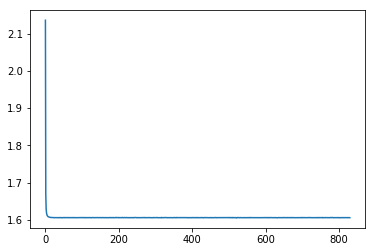

In [81]:
costsNPArray = np.array(costs)
epochXaxis = np.arange(len(costs))
plt.plot(epochXaxis, costsNPArray)
plt.show()

costsFilePath = '/home/muhammadayub/Desktop/CS230/models_saved/model5/COSTS___12_12_2018'+'.npy'
np.save(costsFilePath, costsNPArray )

In [149]:
np.load(costsFilePath)
# filepath

array([0.0647672 , 0.04641966, 0.03471443, 0.02663976, 0.02192029,
       0.01970959, 0.01845553, 0.01755938, 0.0171982 , 0.01660422,
       0.01654085, 0.01634365, 0.01621262, 0.01652126, 0.01615006,
       0.0159698 , 0.01614199, 0.01610396, 0.01610836, 0.01620547,
       0.01587727, 0.01573968, 0.01584721, 0.01606645, 0.01579885,
       0.01592844, 0.01588698, 0.01569943, 0.01565967, 0.01583383,
       0.01620939, 0.02880385, 0.02278177, 0.02216931, 0.02250067,
       0.02267798, 0.02239106, 0.02253839, 0.02259601, 0.02280519,
       0.02219826, 0.022607  , 0.0226754 , 0.02211113, 0.02231681,
       0.02226554, 0.02251199, 0.02253624, 0.02265881, 0.02246234])

# This is to figure out the F1 multi class label predictions 

# Restoring the Model

In [258]:
filepath = "/home/muhammadayub/Desktop/CS230/models_saved/model3/model_12_9__"+str(49)+"_"+str(60)+".ckpt"

graph = tf.Graph()
with graph.as_default(): 
    with tf.Session(graph=graph) as sess:
        
        #define the graph
        X, Y = create_placeholders(64, 64, 26, 35)
        parameters = initialize_parameters()
        Z3 = forward_prop(X, parameters)
        #optimization 
        cost = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(logits = Z3, labels = Y))
        optimizer = tf.train.AdamOptimizer(learning_rate = learning_rate).minimize(cost)#1e-4).minimize(cross_entropy)

        #calculating the accuracy of the model 
        softmaxZ3 = tf.nn.softmax(Z3) # size will be 2200, 34
        output_class = tf.argmax(softmaxZ3,1) # size will be 2200, 1 or just (2200,)
        num_correct = tf.equal(output_class, tf.argmax(Y,1)) # must compare 2200
        num_correct_to_int = tf.cast(num_correct, tf.float32)
        accuracy = tf.reduce_mean(num_correct_to_int)
        
        
        saver = tf.train.Saver()

        saver.restore(sess , filepath)
        print("Model restored.")
        
    

INFO:tensorflow:Restoring parameters from /home/muhammadayub/Desktop/CS230/models_saved/model1/model_12_7__0_0.ckpt
Model restored.


In [144]:
len(devMiniBatches)
len(minibatches)
len(testMiniBatches)

38

# Restore the Graph and Calculate the Test Set Accuracy / F1 Score

In [223]:
filepath = "/home/muhammadayub/Desktop/CS230/models_saved/model3/model_12_9__"+str(49)+"_"+str(60)+".ckpt"
# dev_test_or_train = 1
# if(dev_test_or_train ==1): #train

filepathEvalMetrics = "/home/muhammadayub/Desktop/CS230/models_saved/model3/model_12_9__"+str(49)+"_"+str(60)+"_evalMetrics_train.npy"
accuracies= []
minibatches_to_test_accuracy_of = copy.deepcopy(minibatches[:38])  # or devMiniBatches or testMiniBatches for test error 

print(" Running ", len(minibatches_to_test_accuracy_of) , " minibatches to get the evaluation metrics")
output_classes = []
predicted_classes = []

preds_one_hot_ev_value = None
output_one_hot_ev_value =None 


graph = tf.Graph()
with graph.as_default(): 
    with tf.Session(graph=graph) as sess:
        
        #define the graph
        X, Y = create_placeholders(64, 64, 26, 35)
        parameters = initialize_parameters()
        Z3 = forward_prop(X, parameters)
        #optimization 
        cost = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(logits = Z3, labels = Y))
        optimizer = tf.train.AdamOptimizer(learning_rate = learning_rate).minimize(cost)#1e-4).minimize(cross_entropy)

        #calculating the accuracy of the model 
        softmaxZ3 = tf.nn.softmax(Z3) # size will be 2200, 34
        output_class = tf.argmax(softmaxZ3,1) # size will be 2200, 1 or just (2200,)  # this is the predictions vector
        output_class_of_data =  tf.argmax(Y,1)
        num_correct = tf.equal(output_class, output_class_of_data) # must compare 2200
        num_correct_to_int = tf.cast(num_correct, tf.float32)
        accuracy = tf.reduce_mean(num_correct_to_int)
        
        
        saver = tf.train.Saver()

        saver.restore(sess , filepath)
        print("Model restored.")
        
        np.random.shuffle(minibatches_to_test_accuracy_of)
        
        #devMiniBatches 
        #testMiniBatches
        for i_ , minibatch in enumerate(minibatches_to_test_accuracy_of):
            inputImage, output_image = generateMinibatch(minibatch)
            inputImage64, output_image64 = transformTo64(inputImage, output_image,35)
            output_image64 = output_image64[WaterWayMask]
            inputImage64 = inputImage64[WaterWayMask]
            #temp_cost = sess.run([cost], feed_dict={X: inputImage64, Y: output_image64})
            predicted_classes_val, output_class_val, accuracy_val = sess.run([output_class, output_class_of_data, accuracy], feed_dict={X: inputImage64, Y: output_image64})
            accuracies.append(accuracy_val)
            output_classes.append(output_class_val)
            predicted_classes.append(predicted_classes_val)
            
#             print(output_class_val.shape) #wrapped in list 
#             print(predicted_classes_val.shape)
            print('Minibatch: ', str(i_), " ", datetime.datetime.now())
            
            
#new graph for concatenating things and getting into the right format for the F1 score 
graph = tf.Graph()
with graph.as_default(): 
    with tf.Session(graph=graph) as sess:            
    
        val1 = tf.concat(output_classes, axis = 0)
        
    
        #after running the minibatches-> we can concatenate the values 
        preds = tf.concat(predicted_classes,axis = 0)
        data_outputs = tf.concat(output_classes,axis = 0)
        
        d = 35 # d is the total number of classes you have 
        #classLabels =  np.array([2,3,5,6,5,4,2,0,0])# the indexes 
        # tf.one_hot(classLabels, d)

        preds_one_hot = tf.one_hot(preds, d)
        data_outputs_one_hot =tf.one_hot(data_outputs, d)#evaluated 
        preds_one_hot_ev, output_one_hot_ev = sess.run([preds_one_hot, data_outputs_one_hot])
        
        preds_one_hot_ev_value =preds_one_hot_ev
        output_one_hot_ev_value =output_one_hot_ev
        
#For Debugging below:
#         zVal = sess.run([Z3], feed_dict={X: inputImage64, Y: output_image64})
#         softMaxVal = sess.run([softmaxZ3], feed_dict={X: inputImage64, Y: output_image64})
#         output_class_val = sess.run([output_class], feed_dict={X: inputImage64, Y: output_image64})
#         num_correct_val = sess.run([num_correct], feed_dict={X: inputImage64, Y: output_image64})
#         num_correct_to_int_val = sess.run([num_correct_to_int], feed_dict={X: inputImage64, Y: output_image64})

 Running  38  minibatches to get the evaluation metrics
INFO:tensorflow:Restoring parameters from /home/muhammadayub/Desktop/CS230/models_saved/model2/model_12_7__49_60.ckpt
Model restored.
Minibatch:  0   2018-12-08 22:05:53.477843
Minibatch:  1   2018-12-08 22:05:59.675679
Minibatch:  2   2018-12-08 22:06:05.875645
Minibatch:  3   2018-12-08 22:06:12.224315
Minibatch:  4   2018-12-08 22:06:18.420786
Minibatch:  5   2018-12-08 22:06:24.764895
Minibatch:  6   2018-12-08 22:06:30.967698
Minibatch:  7   2018-12-08 22:06:37.177049
Minibatch:  8   2018-12-08 22:06:43.290872
Minibatch:  9   2018-12-08 22:06:49.493933
Minibatch:  10   2018-12-08 22:06:55.583445
Minibatch:  11   2018-12-08 22:07:01.733232
Minibatch:  12   2018-12-08 22:07:07.844373
Minibatch:  13   2018-12-08 22:07:14.030304
Minibatch:  14   2018-12-08 22:07:20.139519
Minibatch:  15   2018-12-08 22:07:26.341066
Minibatch:  16   2018-12-08 22:07:32.535971
Minibatch:  17   2018-12-08 22:07:38.741126
Minibatch:  18   2018-12-08 

In [141]:
_y_true_ = None
_y_pred_ = None 
_f1Score_ = None 
_precision_ = None 
_recall_ =None 
TPVal = None
FPVal = None
FNVal = None 
_f1_ = None 
#using the F1 function found online -> get the values for the predictions  
graph = tf.Graph()
with graph.as_default(): 
    y_true = tf.Variable(output_one_hot_ev_value)
    y_pred = tf.Variable(preds_one_hot_ev_value)
    y_true = tf.cast(y_true, tf.float64)
    y_pred = tf.cast(y_pred, tf.float64)

    #moded from -> https://stackoverflow.com/questions/35365007/tensorflow-precision-recall-f1-score-and-confusion-matrix
    TP = tf.count_nonzero(y_pred * y_true, axis=0) 
    FP = tf.count_nonzero(y_pred * (y_true - 1), axis=0) 
    FN = tf.count_nonzero((y_pred - 1) * y_true, axis=0)  # .001 for numerical stability 

    #they are integers right now and should be floats for numerical stability 
    TP = tf.cast(TP, tf.float32)
    FP = tf.cast(FP, tf.float32)
    FN = tf.cast(FN, tf.float32)
    
    
    precision = TP / (TP + FP+tf.constant(.001))
    recall = TP / (TP + FN+tf.constant(.001))
    f1 = 2 * precision * recall / (precision + recall+tf.constant(.001))

    f1Score = tf.reduce_mean(f1)

    
    with tf.Session(graph=graph) as sess:    
        tf.global_variables_initializer().run(session=sess)
        _f1_, _y_true_, _y_pred_, _f1Score_ , _precision_ ,_recall_ , TPVal,FPVal, FNVal = sess.run([f1, y_true, y_pred, f1Score, precision ,recall, TP,FP, FN ])          


In [142]:
filepathEvalMetrics
_f1_

array([0.9762635, 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       ],
      dtype=float32)

In [130]:
accuracyArray = np.array(['Accuracy', sum(np.array(accuracies).flatten())/len(accuracies)*100 , 
                          '_y_true_' , str(_y_true_),
                            '_y_pred_' ,str(_y_pred_) ,
                            '_f1Score_' ,str(_f1Score_) ,
                            '_precision_' ,str(_precision_) ,
                            '_recall_' ,str(_recall_) ,
                            'TPVal' ,str(TPVal),
                            'FPVal' , str(FPVal),
                            'FNVal' , str(FNVal)
                          ])
# we are only interested in the F1 score at the Macro level
print('F1 score (multiclass): ' , mac)        
print('Accuracy', sum(np.array(accuracies).flatten())/len(accuracies)*100)

F1 score (multiclass):  nan
Accuracy 95.45813234228837


In [ ]:
#write the values out to the numpy file 
print(accuracyArray)
np.save(filepathEvalMetrics,accuracyArray)

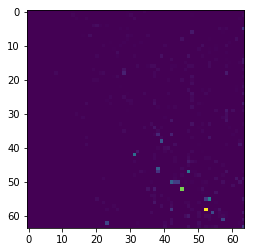

(3200, 64, 64)


In [45]:
# output_image64[:]
plt.imshow(inputImage64[10, :,:,10])
plt.show()
output_image64_intermediate = split256by256StackOnAxis(output_image)
# output_image64 = getOutputYVector(output_image64, numCats)
print(output_image64_intermediate.shape)


In [254]:
print('Accuracy', sum(np.array(accuracies).flatten())/len(accuracies)*100)


Accuracy 100.0


In [48]:
output_image64_intermediate[10].dtype

# plt.imshow(output_image64_intermediate[10])
# plt.show()

dtype('float16')

In [148]:
print(datetime.datetime.now())
WaterWayMask = generateWaterWayMask(waterway, 400)
inputImage, output_image = generateMinibatch(minibatches[10])
# print(inputImage.dtype)
# print(output_image.dtype)
inputImage64, output_image64 = transformTo64(inputImage, output_image,34)
# print(inputImage64.dtype)
# print(output_image64.dtype)
output_image64 = output_image64[WaterWayMask]
inputImage64 = inputImage64[WaterWayMask]
# print(inputImage64.dtype)
# print(output_image64.dtype)
print(datetime.datetime.now())


2018-12-06 18:59:36.103546


/home/muhammadayub/anaconda3/envs/py35/lib/python3.5/site-packages/ipykernel_launcher.py:40: DeprecationWarning: elementwise == comparison failed; this will raise an error in the future.
/home/muhammadayub/anaconda3/envs/py35/lib/python3.5/site-packages/ipykernel_launcher.py:41: DeprecationWarning: elementwise == comparison failed; this will raise an error in the future.


(array([0]),)
(array([0]),)
2018-12-06 18:59:43.296475


In [143]:
print(inputImage64.shape)
print(output_image64.shape)
print(inputImage64.dtype)
print(output_image64.dtype)
print(len(WaterWayMask))

(1600, 64, 64, 26)
(1600, 34)
float64
float64
1600
